In [1]:
import matplotlib.pyplot as plt # plotting library
import numpy as np # this module is useful to work with numerical arrays
import pandas as pd # this module is useful to work with tabular data
import random # this module will be used to select random samples from a collection
import os # this module will be used just to create directories in the local filesystem
from tqdm import tqdm # this module is useful to plot progress bars

import torch
import torchvision
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader,TensorDataset
import torchvision.datasets as datasets
from torch import nn
from torch.nn import functional

In [2]:
### Download the data and create dataset
data_dir = 'dataset'
# With these commands the train and test datasets, respectively, are downloaded 
# automatically and stored in the local "data_dir" directory.
train_dataset = torchvision.datasets.MNIST(data_dir, train=True, download=True)
test_dataset  = torchvision.datasets.MNIST(data_dir, train=False, download=True)

Failed to download (trying next):
HTTP Error 503: Service Unavailable



  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting dataset/MNIST/raw/train-images-idx3-ubyte.gz to dataset/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting dataset/MNIST/raw/train-labels-idx1-ubyte.gz to dataset/MNIST/raw

Failed to download (trying next):
HTTP Error 503: Service Unavailable



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting dataset/MNIST/raw/t10k-images-idx3-ubyte.gz to dataset/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting dataset/MNIST/raw/t10k-labels-idx1-ubyte.gz to dataset/MNIST/raw



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [3]:
print(len(train_dataset))
len(test_dataset)

60000


10000

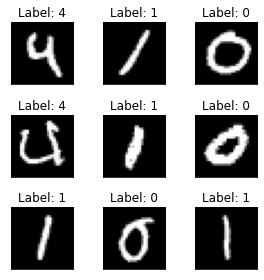

In [4]:
### Plot some sample
fig, axs = plt.subplots(3, 3, figsize=(4,4))
for ax in axs.flatten():
    # random.choice allows to randomly sample from a list-like object (basically anything that can be accessed with an index, like our dataset)
    img, label = random.choice(train_dataset)
    ax.imshow(np.array(img), cmap='gist_gray')
    ax.set_title('Label: %d' % label)
    ax.set_xticks([])
    ax.set_yticks([])
plt.tight_layout()

In [16]:
train_transform = transforms.Compose([
    transforms.ToTensor(),
])
test_transform = transforms.Compose([
    transforms.ToTensor(),
])
# Set the train transform
train_dataset.transform = train_transform
# Set the test transform
test_dataset.transform = test_transform

x_train=[]
y_train=[]
for sample in train_dataset:
     x_train.append(np.array(sample[0]))
     y_train.append(np.array(sample[1]))




### Define train dataloader
train_dataloader = DataLoader(train_dataset, batch_size=256, shuffle=True)
### Define test dataloader
test_dataloader = DataLoader(test_dataset, batch_size=256, shuffle=False)

Define the network architecture (Encoder+Decoder)

In [18]:
class Encoder(nn.Module):
    
    def __init__(self, encoded_space_dim):
        super().__init__()
        
        ### Convolutional section
        self.encoder_cnn = nn.Sequential(
            # First convolutional layer
            nn.Conv2d(1, 8, 3, stride=2, padding=1),
            nn.ReLU(True),
            # Second convolutional layer
            nn.Conv2d(8, 16, 3, stride=2, padding=1),
            nn.ReLU(True),
            # Third convolutional layer
            nn.Conv2d(16, 32, 3, stride=2, padding=0),
            nn.ReLU(True)
        )
        
        ### Flatten layer
        self.flatten = nn.Flatten(start_dim=1)

        ### Linear section
        self.encoder_lin = nn.Sequential(
            # First linear layer
            nn.Linear(3 * 3 * 32, 64),
            nn.ReLU(True),
            # Second linear layer
            nn.Linear(64, encoded_space_dim)
        )
        
    def forward(self, x):
        # Apply convolutions
        x = self.encoder_cnn(x)
        # Flatten
        x = self.flatten(x)
        # # Apply linear layers
        x = self.encoder_lin(x)
        return x

In [19]:
class Decoder(nn.Module):
    
    def __init__(self, encoded_space_dim):
        super().__init__()

        ### Linear section
        self.decoder_lin = nn.Sequential(
            # First linear layer
            nn.Linear(encoded_space_dim, 64),
            nn.ReLU(True),
            # Second linear layer
            nn.Linear(64, 3 * 3 * 32),
            nn.ReLU(True)
        )

        ### Unflatten
        self.unflatten = nn.Unflatten(dim=1, unflattened_size=(32, 3, 3))

        ### Convolutional section
        self.decoder_conv = nn.Sequential(
            # First transposed convolution
            nn.ConvTranspose2d(32, 16, 3, stride=2, output_padding=0),
            nn.ReLU(True),
            # Second transposed convolution
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.ReLU(True),
            # Third transposed convolution
            nn.ConvTranspose2d(8, 1, 3, stride=2, padding=1, output_padding=1)
        )
        
    def forward(self, x):
        # Apply linear layers
        x = self.decoder_lin(x)
        # Unflatten
        x = self.unflatten(x)
        # Apply transposed convolutions
        x = self.decoder_conv(x)
        # Apply a sigmoid to force the output to be between 0 and 1 (valid pixel values)
        x = torch.sigmoid(x)
        return x

In [20]:
### Training function
def train_epoch(encoder, decoder, device, dataloader, loss_fn, optimizer, trainCost_):
    # Set train mode for both the encoder and the decoder
    encoder.train()
    decoder.train()
    optimizer.zero_grad()
    # Iterate the dataloader (we do not need the label values, this is unsupervised learning)
    for image_batch, _ in dataloader: # with "_" we just ignore the labels (the second element of the dataloader tuple)
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        image_batch=image_batch.float()
        # Encode data
        encoded_data = encoder(image_batch)
        # Decode data
        decoded_data = decoder(encoded_data)
        # Evaluate loss
        loss = loss_fn(decoded_data, image_batch)
        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        # Print batch loss
        print('\t partial train loss (single batch): %f' % (loss.data))
    trainCost_.append(loss)

In [21]:
### Testing or validation function
def test_epoch(encoder, decoder, device, dataloader, loss_fn):
    # Set evaluation mode for encoder and decoder
    encoder.eval()
    decoder.eval()
    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        conc_out = []
        conc_label = []
        for image_batch, _ in dataloader:
            # Move tensor to the proper device
            
            image_batch = image_batch.to(device)
            image_batch=image_batch.float()
            # Encode data
            encoded_data = encoder(image_batch)
            # Decode data
            decoded_data = decoder(encoded_data)
            # Append the network output and the original image to the lists
            conc_out.append(decoded_data.cpu())
            conc_label.append(image_batch.cpu())
        # Create a single tensor with all the values in the lists
        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label) 
        # Evaluate global loss
        val_loss = loss_fn(conc_out, conc_label)

    return val_loss.data

In [22]:
# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

Selected device: cuda


Cross validation fold number= 1/6
EPOCH 1/30
	 partial train loss (single batch): 0.246688
	 partial train loss (single batch): 0.245188
	 partial train loss (single batch): 0.245507
	 partial train loss (single batch): 0.244468
	 partial train loss (single batch): 0.243791
	 partial train loss (single batch): 0.242645
	 partial train loss (single batch): 0.243163
	 partial train loss (single batch): 0.241534
	 partial train loss (single batch): 0.240799
	 partial train loss (single batch): 0.239744
	 partial train loss (single batch): 0.239186
	 partial train loss (single batch): 0.238179
	 partial train loss (single batch): 0.236621
	 partial train loss (single batch): 0.236032
	 partial train loss (single batch): 0.234192
	 partial train loss (single batch): 0.233546
	 partial train loss (single batch): 0.232020
	 partial train loss (single batch): 0.230299
	 partial train loss (single batch): 0.228232
	 partial train loss (single batch): 0.227221
	 partial train loss (single batch)

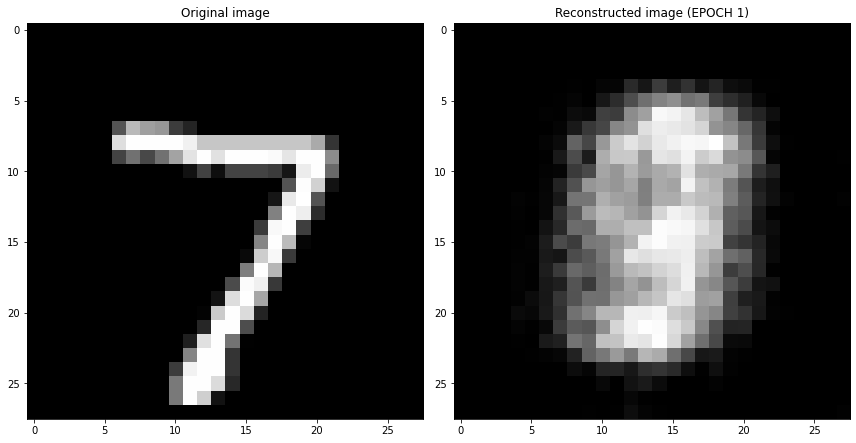

EPOCH 2/30
	 partial train loss (single batch): 0.063295
	 partial train loss (single batch): 0.064380
	 partial train loss (single batch): 0.064261
	 partial train loss (single batch): 0.063592
	 partial train loss (single batch): 0.065419
	 partial train loss (single batch): 0.065425
	 partial train loss (single batch): 0.062960
	 partial train loss (single batch): 0.063084
	 partial train loss (single batch): 0.064988
	 partial train loss (single batch): 0.062378
	 partial train loss (single batch): 0.063468
	 partial train loss (single batch): 0.063750
	 partial train loss (single batch): 0.063179
	 partial train loss (single batch): 0.064369
	 partial train loss (single batch): 0.065529
	 partial train loss (single batch): 0.063317
	 partial train loss (single batch): 0.063769
	 partial train loss (single batch): 0.063157
	 partial train loss (single batch): 0.062104
	 partial train loss (single batch): 0.062581
	 partial train loss (single batch): 0.064914
	 partial train loss (s

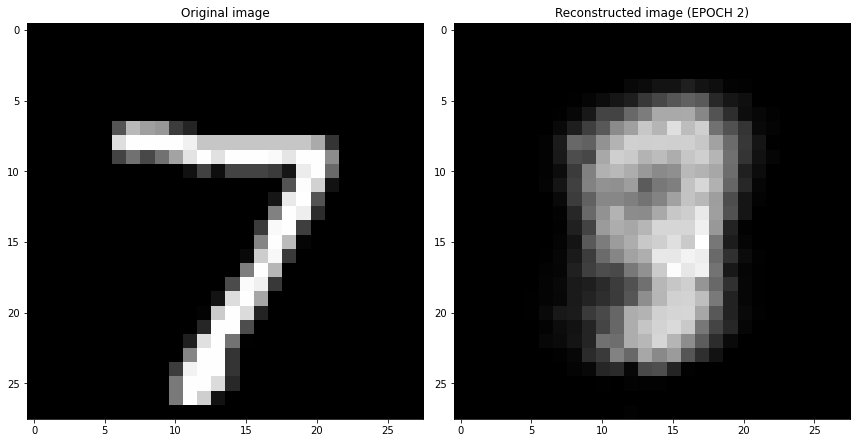

EPOCH 3/30
	 partial train loss (single batch): 0.060408
	 partial train loss (single batch): 0.058761
	 partial train loss (single batch): 0.057125
	 partial train loss (single batch): 0.058581
	 partial train loss (single batch): 0.055085
	 partial train loss (single batch): 0.057642
	 partial train loss (single batch): 0.057005
	 partial train loss (single batch): 0.056814
	 partial train loss (single batch): 0.056900
	 partial train loss (single batch): 0.056425
	 partial train loss (single batch): 0.058375
	 partial train loss (single batch): 0.057851
	 partial train loss (single batch): 0.057346
	 partial train loss (single batch): 0.058140
	 partial train loss (single batch): 0.057351
	 partial train loss (single batch): 0.057712
	 partial train loss (single batch): 0.056968
	 partial train loss (single batch): 0.055995
	 partial train loss (single batch): 0.057017
	 partial train loss (single batch): 0.056530
	 partial train loss (single batch): 0.056796
	 partial train loss (s

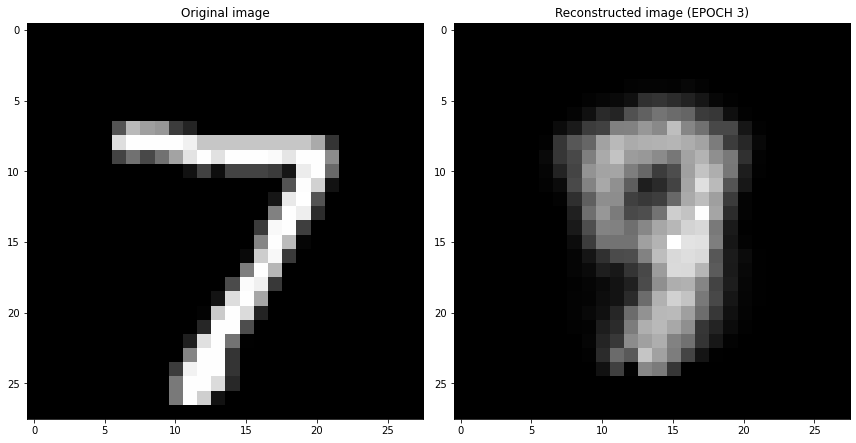

EPOCH 4/30
	 partial train loss (single batch): 0.056884
	 partial train loss (single batch): 0.054116
	 partial train loss (single batch): 0.056854
	 partial train loss (single batch): 0.052670
	 partial train loss (single batch): 0.054200
	 partial train loss (single batch): 0.054825
	 partial train loss (single batch): 0.054698
	 partial train loss (single batch): 0.052753
	 partial train loss (single batch): 0.056348
	 partial train loss (single batch): 0.055663
	 partial train loss (single batch): 0.055994
	 partial train loss (single batch): 0.054686
	 partial train loss (single batch): 0.055997
	 partial train loss (single batch): 0.054295
	 partial train loss (single batch): 0.055451
	 partial train loss (single batch): 0.056317
	 partial train loss (single batch): 0.054358
	 partial train loss (single batch): 0.055576
	 partial train loss (single batch): 0.054086
	 partial train loss (single batch): 0.054071
	 partial train loss (single batch): 0.053972
	 partial train loss (s

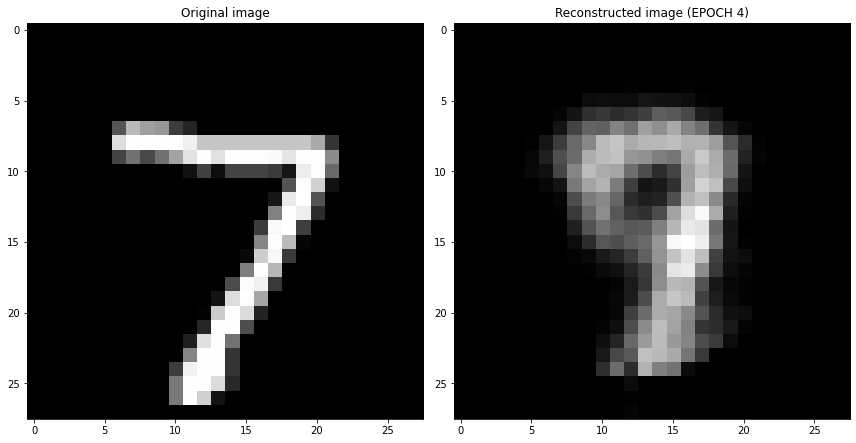

EPOCH 5/30
	 partial train loss (single batch): 0.053631
	 partial train loss (single batch): 0.053816
	 partial train loss (single batch): 0.053504
	 partial train loss (single batch): 0.051975
	 partial train loss (single batch): 0.051900
	 partial train loss (single batch): 0.052258
	 partial train loss (single batch): 0.052358
	 partial train loss (single batch): 0.053389
	 partial train loss (single batch): 0.054419
	 partial train loss (single batch): 0.053552
	 partial train loss (single batch): 0.052897
	 partial train loss (single batch): 0.053763
	 partial train loss (single batch): 0.053201
	 partial train loss (single batch): 0.054660
	 partial train loss (single batch): 0.054692
	 partial train loss (single batch): 0.052738
	 partial train loss (single batch): 0.054645
	 partial train loss (single batch): 0.053744
	 partial train loss (single batch): 0.053608
	 partial train loss (single batch): 0.052270
	 partial train loss (single batch): 0.054394
	 partial train loss (s

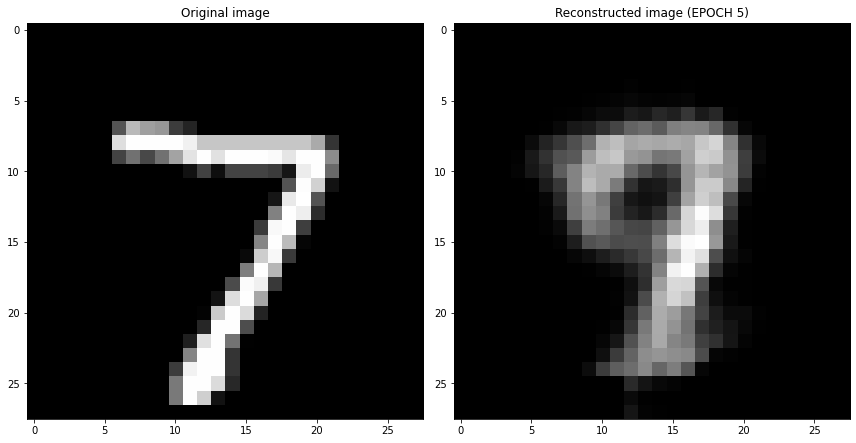

EPOCH 6/30
	 partial train loss (single batch): 0.051640
	 partial train loss (single batch): 0.052664
	 partial train loss (single batch): 0.049028
	 partial train loss (single batch): 0.051931
	 partial train loss (single batch): 0.053422
	 partial train loss (single batch): 0.049828
	 partial train loss (single batch): 0.050841
	 partial train loss (single batch): 0.051619
	 partial train loss (single batch): 0.051837
	 partial train loss (single batch): 0.050846
	 partial train loss (single batch): 0.049905
	 partial train loss (single batch): 0.050334
	 partial train loss (single batch): 0.052316
	 partial train loss (single batch): 0.051896
	 partial train loss (single batch): 0.051151
	 partial train loss (single batch): 0.052326
	 partial train loss (single batch): 0.052647
	 partial train loss (single batch): 0.049128
	 partial train loss (single batch): 0.049885
	 partial train loss (single batch): 0.052527
	 partial train loss (single batch): 0.051573
	 partial train loss (s

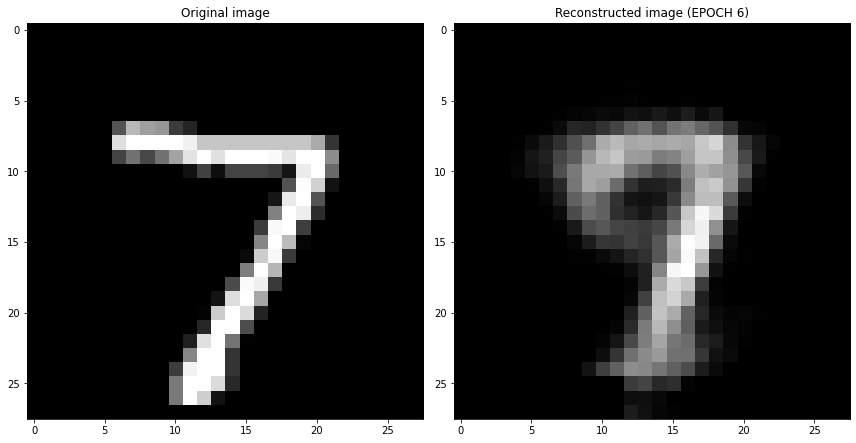

EPOCH 7/30
	 partial train loss (single batch): 0.050200
	 partial train loss (single batch): 0.049715
	 partial train loss (single batch): 0.048648
	 partial train loss (single batch): 0.049645
	 partial train loss (single batch): 0.049627
	 partial train loss (single batch): 0.052354
	 partial train loss (single batch): 0.050308
	 partial train loss (single batch): 0.050108
	 partial train loss (single batch): 0.050710
	 partial train loss (single batch): 0.048890
	 partial train loss (single batch): 0.050731
	 partial train loss (single batch): 0.050536
	 partial train loss (single batch): 0.050805
	 partial train loss (single batch): 0.049971
	 partial train loss (single batch): 0.050368
	 partial train loss (single batch): 0.052303
	 partial train loss (single batch): 0.050042
	 partial train loss (single batch): 0.049221
	 partial train loss (single batch): 0.050752
	 partial train loss (single batch): 0.049872
	 partial train loss (single batch): 0.050620
	 partial train loss (s

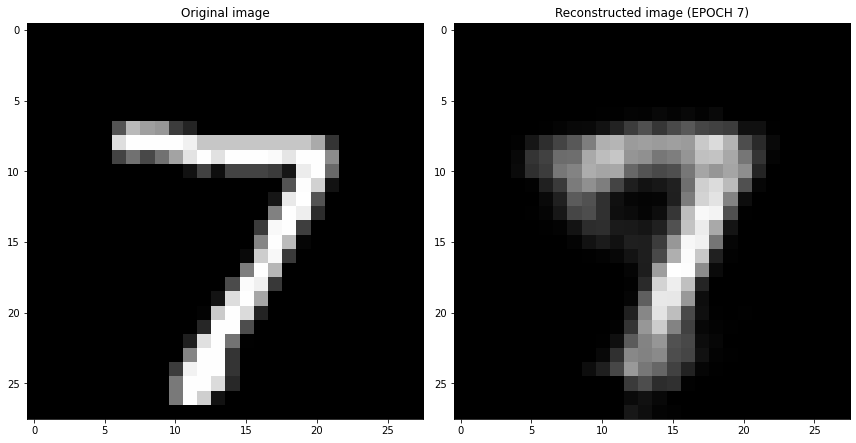

EPOCH 8/30
	 partial train loss (single batch): 0.048331
	 partial train loss (single batch): 0.048647
	 partial train loss (single batch): 0.050452
	 partial train loss (single batch): 0.051193
	 partial train loss (single batch): 0.049913
	 partial train loss (single batch): 0.049890
	 partial train loss (single batch): 0.050509
	 partial train loss (single batch): 0.049967
	 partial train loss (single batch): 0.049183
	 partial train loss (single batch): 0.048757
	 partial train loss (single batch): 0.048951
	 partial train loss (single batch): 0.048877
	 partial train loss (single batch): 0.050238
	 partial train loss (single batch): 0.049619
	 partial train loss (single batch): 0.048548
	 partial train loss (single batch): 0.051264
	 partial train loss (single batch): 0.048143
	 partial train loss (single batch): 0.049577
	 partial train loss (single batch): 0.051527
	 partial train loss (single batch): 0.050722
	 partial train loss (single batch): 0.049657
	 partial train loss (s

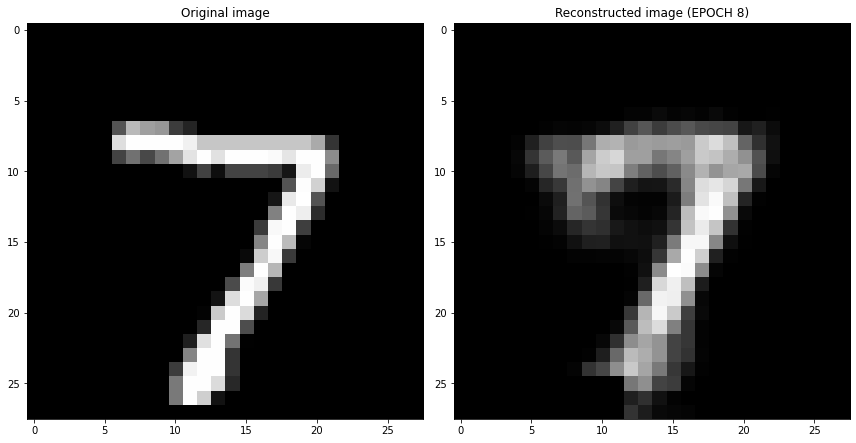

EPOCH 9/30
	 partial train loss (single batch): 0.047432
	 partial train loss (single batch): 0.048211
	 partial train loss (single batch): 0.047878
	 partial train loss (single batch): 0.047413
	 partial train loss (single batch): 0.048323
	 partial train loss (single batch): 0.047633
	 partial train loss (single batch): 0.047195
	 partial train loss (single batch): 0.048369
	 partial train loss (single batch): 0.048300
	 partial train loss (single batch): 0.046403
	 partial train loss (single batch): 0.048362
	 partial train loss (single batch): 0.048023
	 partial train loss (single batch): 0.048276
	 partial train loss (single batch): 0.048483
	 partial train loss (single batch): 0.047969
	 partial train loss (single batch): 0.048482
	 partial train loss (single batch): 0.047442
	 partial train loss (single batch): 0.047506
	 partial train loss (single batch): 0.048154
	 partial train loss (single batch): 0.048158
	 partial train loss (single batch): 0.048976
	 partial train loss (s

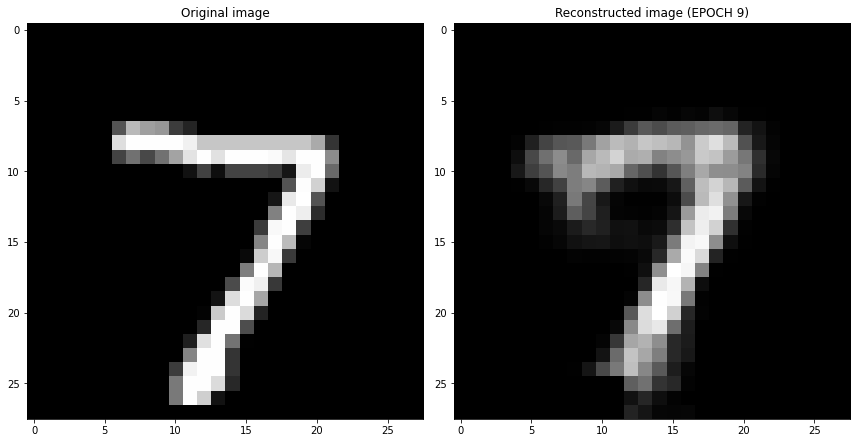

EPOCH 10/30
	 partial train loss (single batch): 0.046298
	 partial train loss (single batch): 0.048195
	 partial train loss (single batch): 0.047225
	 partial train loss (single batch): 0.045118
	 partial train loss (single batch): 0.046736
	 partial train loss (single batch): 0.044734
	 partial train loss (single batch): 0.047754
	 partial train loss (single batch): 0.045720
	 partial train loss (single batch): 0.045198
	 partial train loss (single batch): 0.046949
	 partial train loss (single batch): 0.047655
	 partial train loss (single batch): 0.047128
	 partial train loss (single batch): 0.045461
	 partial train loss (single batch): 0.045942
	 partial train loss (single batch): 0.046136
	 partial train loss (single batch): 0.045934
	 partial train loss (single batch): 0.045716
	 partial train loss (single batch): 0.046513
	 partial train loss (single batch): 0.047000
	 partial train loss (single batch): 0.049671
	 partial train loss (single batch): 0.047164
	 partial train loss (

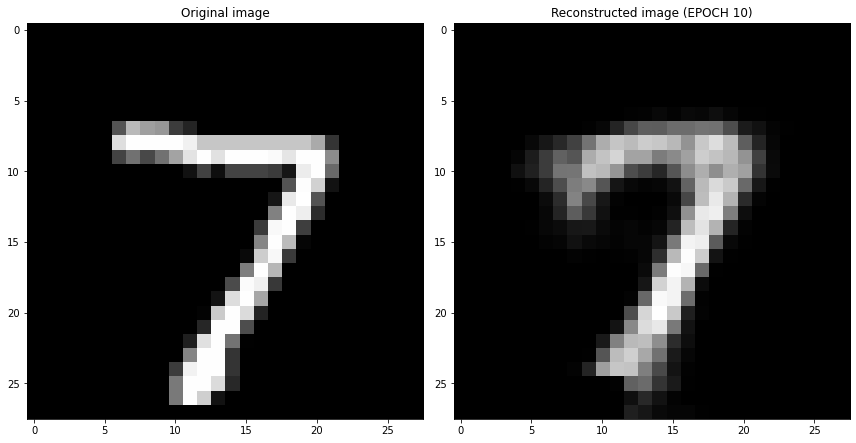

EPOCH 11/30
	 partial train loss (single batch): 0.044912
	 partial train loss (single batch): 0.045267
	 partial train loss (single batch): 0.045514
	 partial train loss (single batch): 0.045623
	 partial train loss (single batch): 0.047436
	 partial train loss (single batch): 0.046698
	 partial train loss (single batch): 0.046229
	 partial train loss (single batch): 0.043668
	 partial train loss (single batch): 0.043313
	 partial train loss (single batch): 0.046999
	 partial train loss (single batch): 0.047934
	 partial train loss (single batch): 0.045222
	 partial train loss (single batch): 0.046558
	 partial train loss (single batch): 0.044241
	 partial train loss (single batch): 0.044780
	 partial train loss (single batch): 0.045353
	 partial train loss (single batch): 0.045947
	 partial train loss (single batch): 0.045421
	 partial train loss (single batch): 0.047134
	 partial train loss (single batch): 0.043821
	 partial train loss (single batch): 0.047123
	 partial train loss (

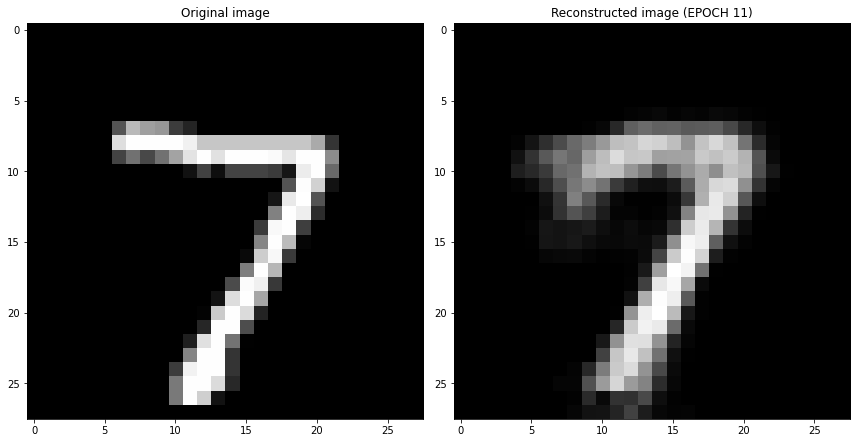

EPOCH 12/30
	 partial train loss (single batch): 0.044631
	 partial train loss (single batch): 0.046251
	 partial train loss (single batch): 0.046311
	 partial train loss (single batch): 0.046251
	 partial train loss (single batch): 0.044335
	 partial train loss (single batch): 0.044192
	 partial train loss (single batch): 0.043130
	 partial train loss (single batch): 0.043670
	 partial train loss (single batch): 0.045703
	 partial train loss (single batch): 0.044000
	 partial train loss (single batch): 0.043726
	 partial train loss (single batch): 0.046930
	 partial train loss (single batch): 0.044816
	 partial train loss (single batch): 0.045678
	 partial train loss (single batch): 0.045757
	 partial train loss (single batch): 0.046718
	 partial train loss (single batch): 0.046710
	 partial train loss (single batch): 0.043945
	 partial train loss (single batch): 0.044696
	 partial train loss (single batch): 0.044844
	 partial train loss (single batch): 0.044176
	 partial train loss (

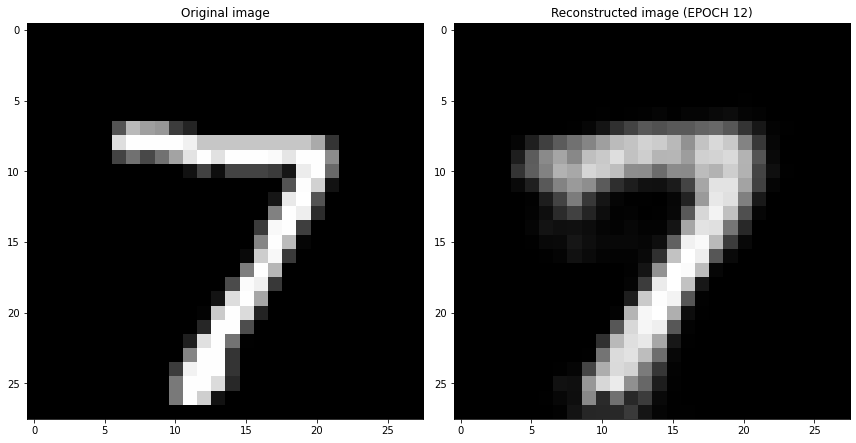

EPOCH 13/30
	 partial train loss (single batch): 0.045386
	 partial train loss (single batch): 0.045226
	 partial train loss (single batch): 0.043415
	 partial train loss (single batch): 0.045252
	 partial train loss (single batch): 0.045620
	 partial train loss (single batch): 0.042796
	 partial train loss (single batch): 0.044040
	 partial train loss (single batch): 0.041874
	 partial train loss (single batch): 0.044435
	 partial train loss (single batch): 0.044867
	 partial train loss (single batch): 0.042167
	 partial train loss (single batch): 0.044951
	 partial train loss (single batch): 0.045625
	 partial train loss (single batch): 0.045798
	 partial train loss (single batch): 0.042262
	 partial train loss (single batch): 0.044342
	 partial train loss (single batch): 0.044961
	 partial train loss (single batch): 0.047038
	 partial train loss (single batch): 0.045913
	 partial train loss (single batch): 0.042352
	 partial train loss (single batch): 0.045909
	 partial train loss (

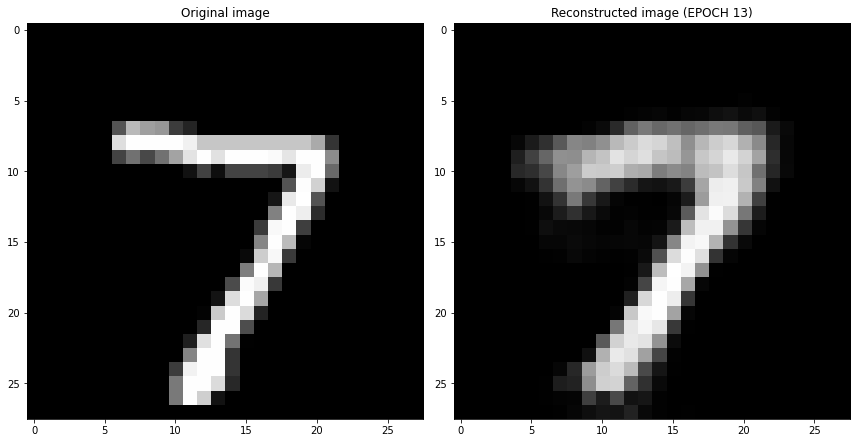

EPOCH 14/30
	 partial train loss (single batch): 0.045452
	 partial train loss (single batch): 0.044016
	 partial train loss (single batch): 0.044930
	 partial train loss (single batch): 0.043053
	 partial train loss (single batch): 0.041879
	 partial train loss (single batch): 0.044135
	 partial train loss (single batch): 0.044812
	 partial train loss (single batch): 0.043239
	 partial train loss (single batch): 0.044586
	 partial train loss (single batch): 0.044420
	 partial train loss (single batch): 0.040986
	 partial train loss (single batch): 0.043109
	 partial train loss (single batch): 0.043202
	 partial train loss (single batch): 0.045562
	 partial train loss (single batch): 0.045289
	 partial train loss (single batch): 0.043547
	 partial train loss (single batch): 0.044800
	 partial train loss (single batch): 0.044239
	 partial train loss (single batch): 0.044135
	 partial train loss (single batch): 0.045171
	 partial train loss (single batch): 0.040781
	 partial train loss (

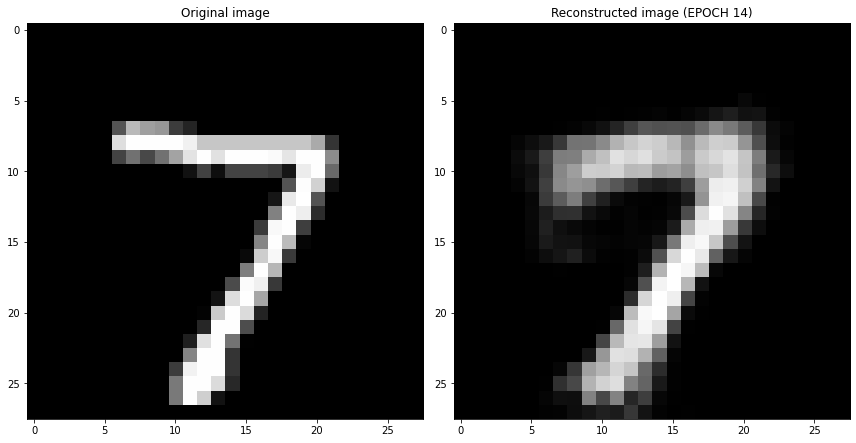

EPOCH 15/30
	 partial train loss (single batch): 0.043544
	 partial train loss (single batch): 0.041963
	 partial train loss (single batch): 0.043832
	 partial train loss (single batch): 0.042788
	 partial train loss (single batch): 0.044366
	 partial train loss (single batch): 0.041575
	 partial train loss (single batch): 0.041378
	 partial train loss (single batch): 0.043035
	 partial train loss (single batch): 0.043796
	 partial train loss (single batch): 0.042348
	 partial train loss (single batch): 0.043892
	 partial train loss (single batch): 0.044886
	 partial train loss (single batch): 0.043371
	 partial train loss (single batch): 0.044614
	 partial train loss (single batch): 0.043705
	 partial train loss (single batch): 0.043432
	 partial train loss (single batch): 0.041535
	 partial train loss (single batch): 0.044106
	 partial train loss (single batch): 0.042393
	 partial train loss (single batch): 0.043509
	 partial train loss (single batch): 0.042476
	 partial train loss (

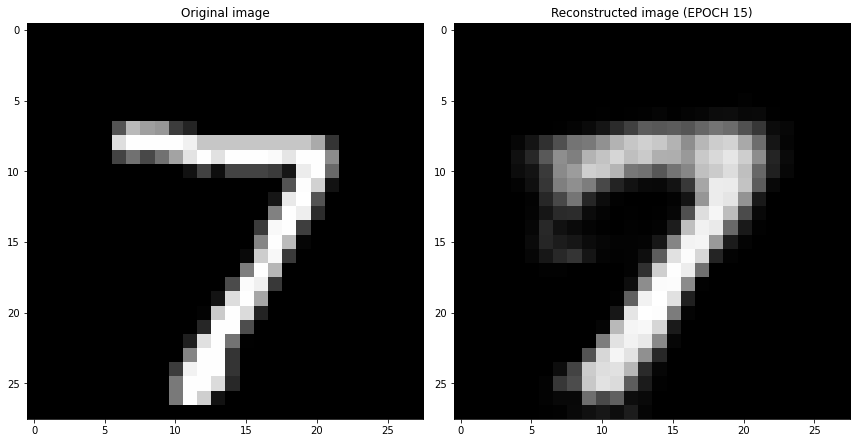

EPOCH 16/30
	 partial train loss (single batch): 0.043999
	 partial train loss (single batch): 0.040941
	 partial train loss (single batch): 0.042878
	 partial train loss (single batch): 0.041670
	 partial train loss (single batch): 0.042422
	 partial train loss (single batch): 0.044884
	 partial train loss (single batch): 0.041396
	 partial train loss (single batch): 0.042194
	 partial train loss (single batch): 0.042900
	 partial train loss (single batch): 0.044194
	 partial train loss (single batch): 0.041857
	 partial train loss (single batch): 0.042965
	 partial train loss (single batch): 0.042230
	 partial train loss (single batch): 0.043937
	 partial train loss (single batch): 0.043124
	 partial train loss (single batch): 0.042538
	 partial train loss (single batch): 0.041942
	 partial train loss (single batch): 0.043300
	 partial train loss (single batch): 0.041835
	 partial train loss (single batch): 0.042184
	 partial train loss (single batch): 0.041981
	 partial train loss (

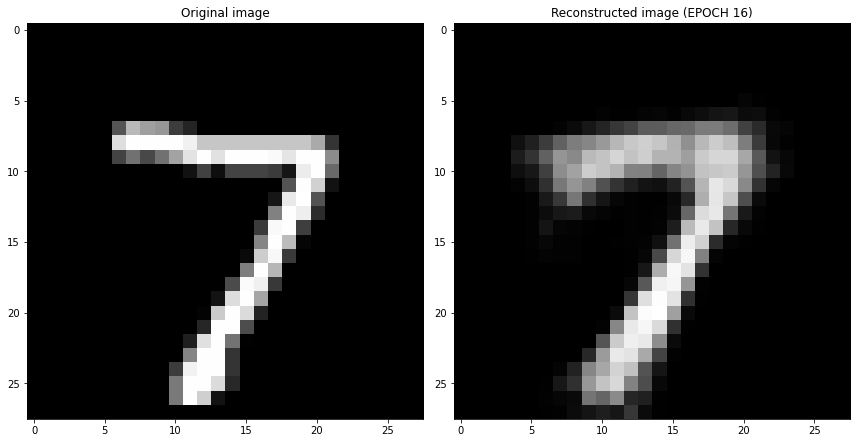

EPOCH 17/30
	 partial train loss (single batch): 0.041209
	 partial train loss (single batch): 0.041527
	 partial train loss (single batch): 0.041693
	 partial train loss (single batch): 0.044966
	 partial train loss (single batch): 0.042784
	 partial train loss (single batch): 0.043158
	 partial train loss (single batch): 0.041780
	 partial train loss (single batch): 0.043038
	 partial train loss (single batch): 0.041689
	 partial train loss (single batch): 0.041814
	 partial train loss (single batch): 0.044147
	 partial train loss (single batch): 0.043144
	 partial train loss (single batch): 0.043633
	 partial train loss (single batch): 0.041311
	 partial train loss (single batch): 0.042752
	 partial train loss (single batch): 0.044114
	 partial train loss (single batch): 0.040380
	 partial train loss (single batch): 0.042117
	 partial train loss (single batch): 0.041836
	 partial train loss (single batch): 0.042713
	 partial train loss (single batch): 0.044414
	 partial train loss (

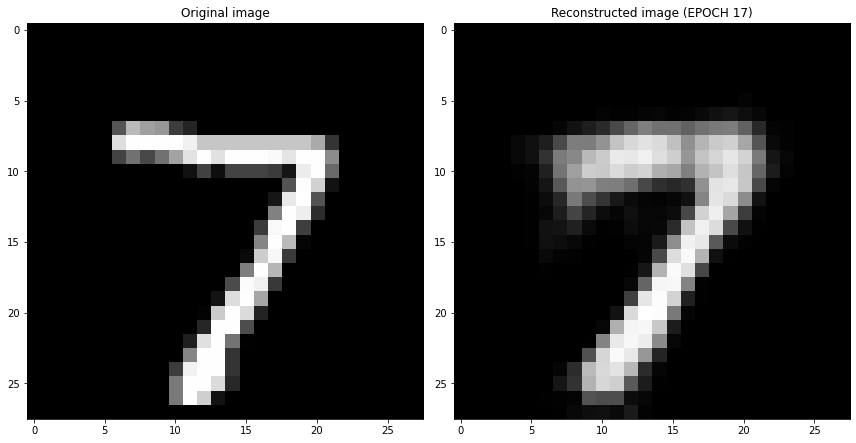

EPOCH 18/30
	 partial train loss (single batch): 0.041387
	 partial train loss (single batch): 0.042048
	 partial train loss (single batch): 0.043631
	 partial train loss (single batch): 0.041986
	 partial train loss (single batch): 0.041708
	 partial train loss (single batch): 0.042188
	 partial train loss (single batch): 0.041723
	 partial train loss (single batch): 0.042412
	 partial train loss (single batch): 0.041329
	 partial train loss (single batch): 0.042510
	 partial train loss (single batch): 0.042721
	 partial train loss (single batch): 0.041106
	 partial train loss (single batch): 0.043013
	 partial train loss (single batch): 0.042330
	 partial train loss (single batch): 0.041743
	 partial train loss (single batch): 0.041720
	 partial train loss (single batch): 0.041666
	 partial train loss (single batch): 0.043205
	 partial train loss (single batch): 0.042607
	 partial train loss (single batch): 0.043961
	 partial train loss (single batch): 0.040220
	 partial train loss (

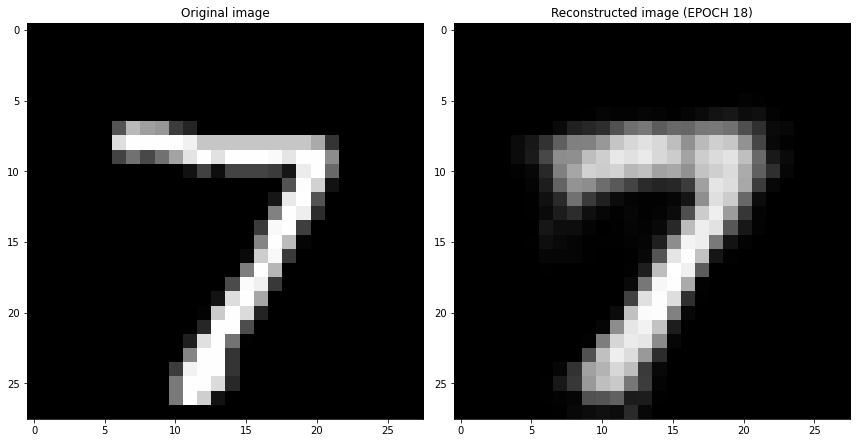

EPOCH 19/30
	 partial train loss (single batch): 0.043048
	 partial train loss (single batch): 0.039815
	 partial train loss (single batch): 0.044825
	 partial train loss (single batch): 0.037988
	 partial train loss (single batch): 0.042020
	 partial train loss (single batch): 0.040018
	 partial train loss (single batch): 0.041651
	 partial train loss (single batch): 0.040918
	 partial train loss (single batch): 0.043745
	 partial train loss (single batch): 0.041982
	 partial train loss (single batch): 0.041762
	 partial train loss (single batch): 0.041730
	 partial train loss (single batch): 0.042026
	 partial train loss (single batch): 0.039434
	 partial train loss (single batch): 0.042031
	 partial train loss (single batch): 0.041110
	 partial train loss (single batch): 0.040735
	 partial train loss (single batch): 0.042281
	 partial train loss (single batch): 0.041265
	 partial train loss (single batch): 0.041974
	 partial train loss (single batch): 0.042105
	 partial train loss (

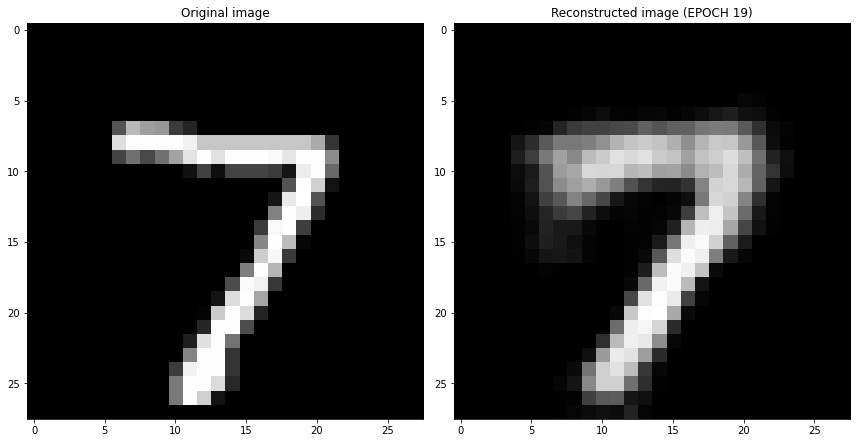

EPOCH 20/30
	 partial train loss (single batch): 0.042575
	 partial train loss (single batch): 0.041966
	 partial train loss (single batch): 0.043423
	 partial train loss (single batch): 0.040078
	 partial train loss (single batch): 0.040863
	 partial train loss (single batch): 0.042094
	 partial train loss (single batch): 0.041330
	 partial train loss (single batch): 0.040355
	 partial train loss (single batch): 0.041070
	 partial train loss (single batch): 0.040782
	 partial train loss (single batch): 0.040774
	 partial train loss (single batch): 0.039855
	 partial train loss (single batch): 0.041131
	 partial train loss (single batch): 0.038832
	 partial train loss (single batch): 0.041982
	 partial train loss (single batch): 0.040745
	 partial train loss (single batch): 0.041603
	 partial train loss (single batch): 0.043132
	 partial train loss (single batch): 0.039859
	 partial train loss (single batch): 0.040478
	 partial train loss (single batch): 0.041861
	 partial train loss (

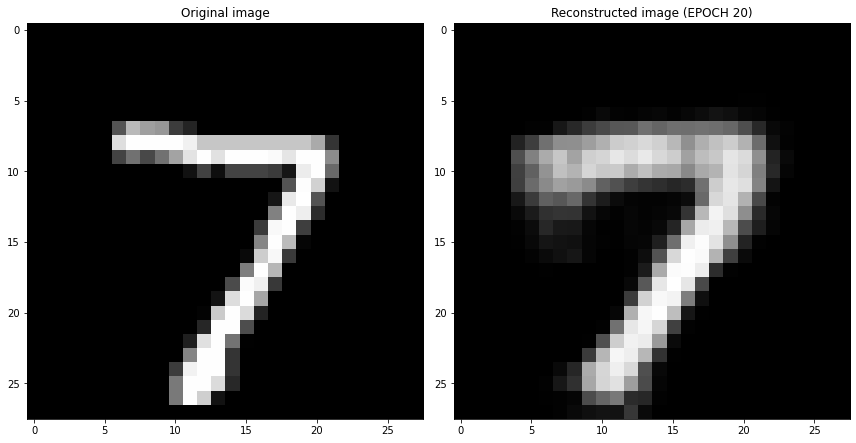

EPOCH 21/30
	 partial train loss (single batch): 0.040456
	 partial train loss (single batch): 0.039862
	 partial train loss (single batch): 0.040043
	 partial train loss (single batch): 0.042021
	 partial train loss (single batch): 0.041773
	 partial train loss (single batch): 0.040197
	 partial train loss (single batch): 0.040821
	 partial train loss (single batch): 0.041556
	 partial train loss (single batch): 0.040579
	 partial train loss (single batch): 0.040966
	 partial train loss (single batch): 0.041502
	 partial train loss (single batch): 0.042012
	 partial train loss (single batch): 0.040557
	 partial train loss (single batch): 0.040687
	 partial train loss (single batch): 0.041342
	 partial train loss (single batch): 0.041263
	 partial train loss (single batch): 0.042425
	 partial train loss (single batch): 0.039151
	 partial train loss (single batch): 0.042351
	 partial train loss (single batch): 0.042255
	 partial train loss (single batch): 0.039597
	 partial train loss (

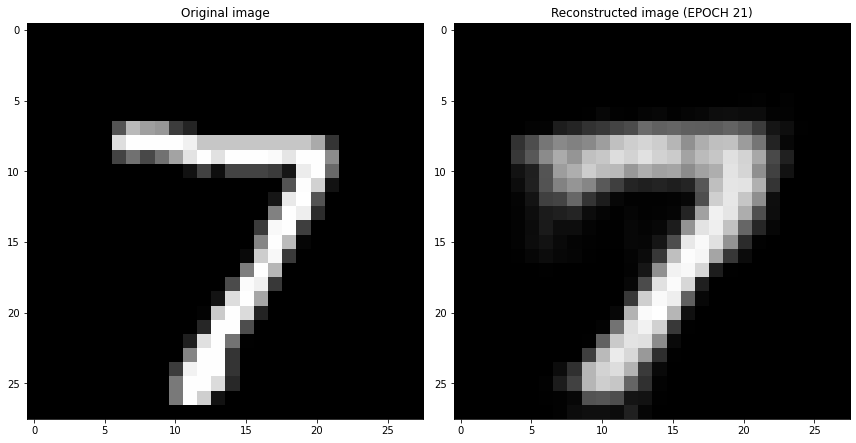

EPOCH 22/30
	 partial train loss (single batch): 0.042648
	 partial train loss (single batch): 0.041208
	 partial train loss (single batch): 0.041715
	 partial train loss (single batch): 0.041492
	 partial train loss (single batch): 0.041152
	 partial train loss (single batch): 0.040274
	 partial train loss (single batch): 0.039284
	 partial train loss (single batch): 0.040228
	 partial train loss (single batch): 0.041571
	 partial train loss (single batch): 0.041205
	 partial train loss (single batch): 0.038230
	 partial train loss (single batch): 0.042542
	 partial train loss (single batch): 0.041438
	 partial train loss (single batch): 0.041767
	 partial train loss (single batch): 0.040272
	 partial train loss (single batch): 0.043530
	 partial train loss (single batch): 0.041537
	 partial train loss (single batch): 0.039252
	 partial train loss (single batch): 0.039768
	 partial train loss (single batch): 0.042288
	 partial train loss (single batch): 0.041201
	 partial train loss (

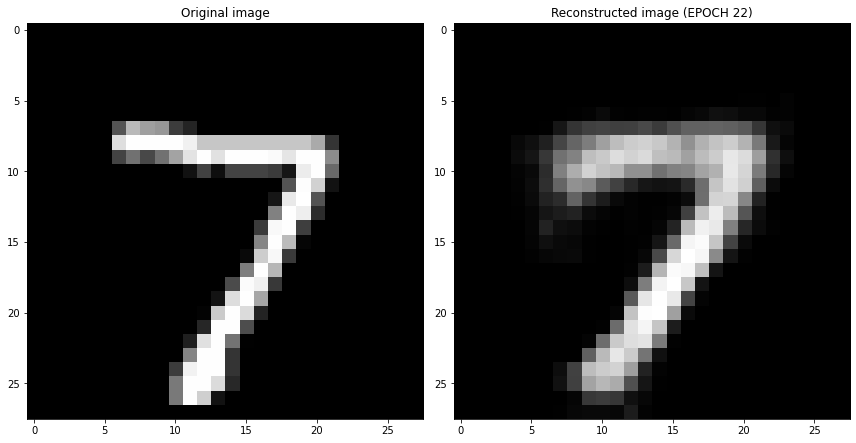

EPOCH 23/30
	 partial train loss (single batch): 0.039347
	 partial train loss (single batch): 0.041276
	 partial train loss (single batch): 0.039491
	 partial train loss (single batch): 0.042905
	 partial train loss (single batch): 0.041403
	 partial train loss (single batch): 0.040610
	 partial train loss (single batch): 0.043080
	 partial train loss (single batch): 0.040839
	 partial train loss (single batch): 0.041925
	 partial train loss (single batch): 0.040970
	 partial train loss (single batch): 0.040624
	 partial train loss (single batch): 0.039603
	 partial train loss (single batch): 0.040508
	 partial train loss (single batch): 0.041826
	 partial train loss (single batch): 0.039523
	 partial train loss (single batch): 0.040391
	 partial train loss (single batch): 0.038998
	 partial train loss (single batch): 0.039799
	 partial train loss (single batch): 0.041819
	 partial train loss (single batch): 0.039829
	 partial train loss (single batch): 0.042429
	 partial train loss (

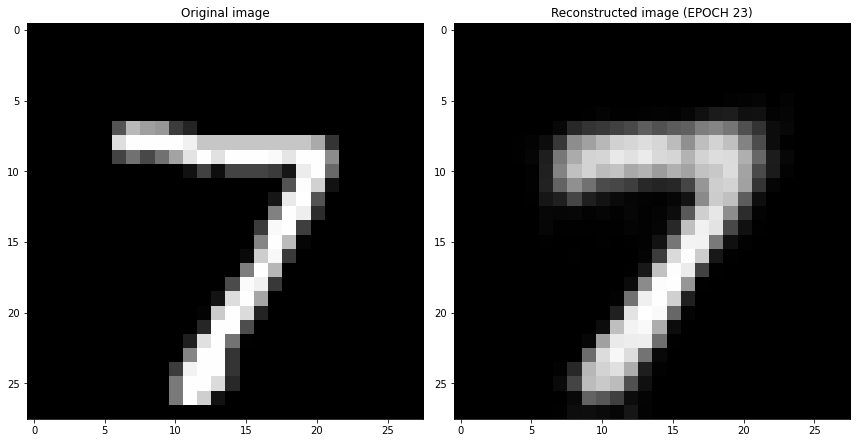

EPOCH 24/30
	 partial train loss (single batch): 0.040461
	 partial train loss (single batch): 0.043617
	 partial train loss (single batch): 0.038610
	 partial train loss (single batch): 0.039990
	 partial train loss (single batch): 0.040544
	 partial train loss (single batch): 0.040044
	 partial train loss (single batch): 0.040410
	 partial train loss (single batch): 0.041448
	 partial train loss (single batch): 0.041011
	 partial train loss (single batch): 0.040426
	 partial train loss (single batch): 0.040738
	 partial train loss (single batch): 0.040681
	 partial train loss (single batch): 0.040628
	 partial train loss (single batch): 0.041747
	 partial train loss (single batch): 0.040067
	 partial train loss (single batch): 0.042327
	 partial train loss (single batch): 0.041109
	 partial train loss (single batch): 0.039414
	 partial train loss (single batch): 0.041265
	 partial train loss (single batch): 0.039704
	 partial train loss (single batch): 0.038796
	 partial train loss (

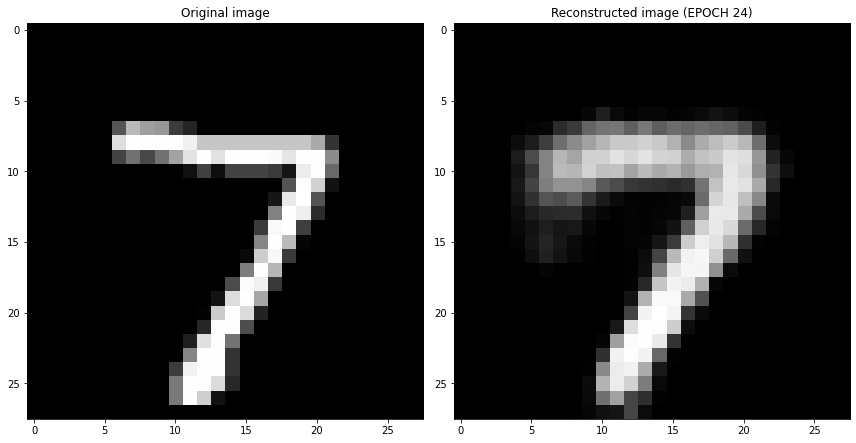

EPOCH 25/30
	 partial train loss (single batch): 0.040822
	 partial train loss (single batch): 0.039709
	 partial train loss (single batch): 0.041601
	 partial train loss (single batch): 0.039583
	 partial train loss (single batch): 0.038411
	 partial train loss (single batch): 0.040497
	 partial train loss (single batch): 0.042295
	 partial train loss (single batch): 0.040620
	 partial train loss (single batch): 0.042200
	 partial train loss (single batch): 0.038407
	 partial train loss (single batch): 0.040708
	 partial train loss (single batch): 0.041254
	 partial train loss (single batch): 0.042816
	 partial train loss (single batch): 0.039276
	 partial train loss (single batch): 0.040623
	 partial train loss (single batch): 0.040408
	 partial train loss (single batch): 0.042164
	 partial train loss (single batch): 0.041064
	 partial train loss (single batch): 0.042297
	 partial train loss (single batch): 0.039430
	 partial train loss (single batch): 0.040293
	 partial train loss (

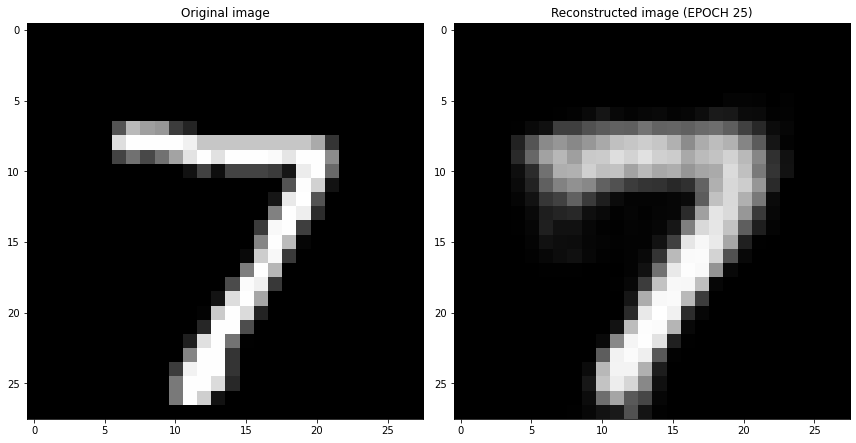

EPOCH 26/30
	 partial train loss (single batch): 0.039103
	 partial train loss (single batch): 0.039924
	 partial train loss (single batch): 0.040458
	 partial train loss (single batch): 0.040065
	 partial train loss (single batch): 0.040241
	 partial train loss (single batch): 0.043906
	 partial train loss (single batch): 0.041949
	 partial train loss (single batch): 0.041685
	 partial train loss (single batch): 0.039890
	 partial train loss (single batch): 0.041097
	 partial train loss (single batch): 0.040521
	 partial train loss (single batch): 0.040201
	 partial train loss (single batch): 0.039214
	 partial train loss (single batch): 0.039877
	 partial train loss (single batch): 0.040616
	 partial train loss (single batch): 0.038732
	 partial train loss (single batch): 0.039506
	 partial train loss (single batch): 0.038811
	 partial train loss (single batch): 0.040776
	 partial train loss (single batch): 0.040451
	 partial train loss (single batch): 0.041470
	 partial train loss (

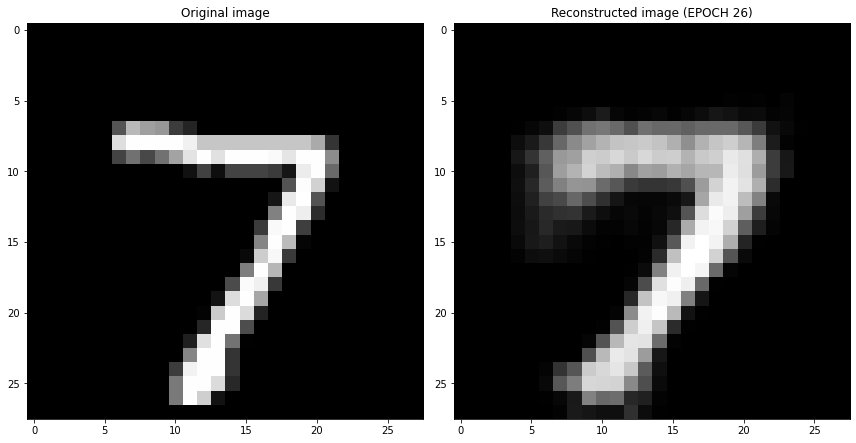

EPOCH 27/30
	 partial train loss (single batch): 0.038002
	 partial train loss (single batch): 0.040187
	 partial train loss (single batch): 0.040431
	 partial train loss (single batch): 0.040403
	 partial train loss (single batch): 0.041149
	 partial train loss (single batch): 0.041490
	 partial train loss (single batch): 0.041229
	 partial train loss (single batch): 0.040825
	 partial train loss (single batch): 0.039800
	 partial train loss (single batch): 0.040730
	 partial train loss (single batch): 0.040887
	 partial train loss (single batch): 0.040686
	 partial train loss (single batch): 0.041078
	 partial train loss (single batch): 0.040355
	 partial train loss (single batch): 0.040163
	 partial train loss (single batch): 0.040182
	 partial train loss (single batch): 0.039542
	 partial train loss (single batch): 0.040349
	 partial train loss (single batch): 0.040081
	 partial train loss (single batch): 0.038182
	 partial train loss (single batch): 0.039802
	 partial train loss (

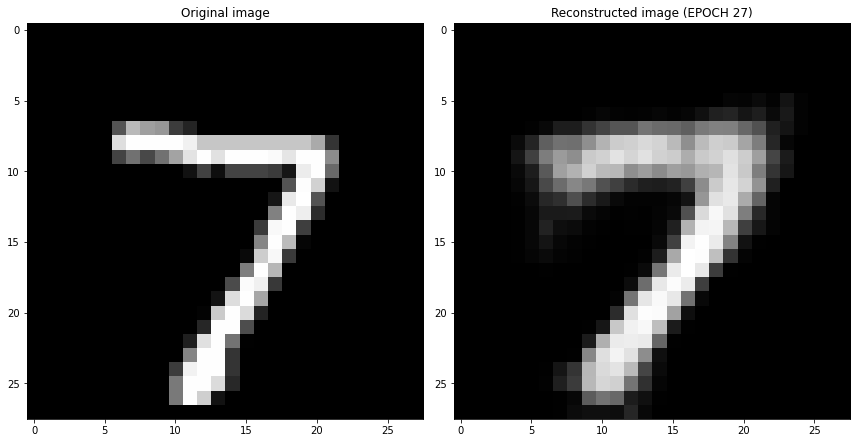

EPOCH 28/30
	 partial train loss (single batch): 0.040264
	 partial train loss (single batch): 0.040212
	 partial train loss (single batch): 0.040219
	 partial train loss (single batch): 0.039047
	 partial train loss (single batch): 0.040333
	 partial train loss (single batch): 0.039900
	 partial train loss (single batch): 0.038866
	 partial train loss (single batch): 0.041205
	 partial train loss (single batch): 0.039020
	 partial train loss (single batch): 0.039763
	 partial train loss (single batch): 0.039520
	 partial train loss (single batch): 0.039809
	 partial train loss (single batch): 0.039647
	 partial train loss (single batch): 0.039579
	 partial train loss (single batch): 0.039077
	 partial train loss (single batch): 0.038506
	 partial train loss (single batch): 0.040462
	 partial train loss (single batch): 0.039990
	 partial train loss (single batch): 0.038673
	 partial train loss (single batch): 0.039837
	 partial train loss (single batch): 0.042166
	 partial train loss (

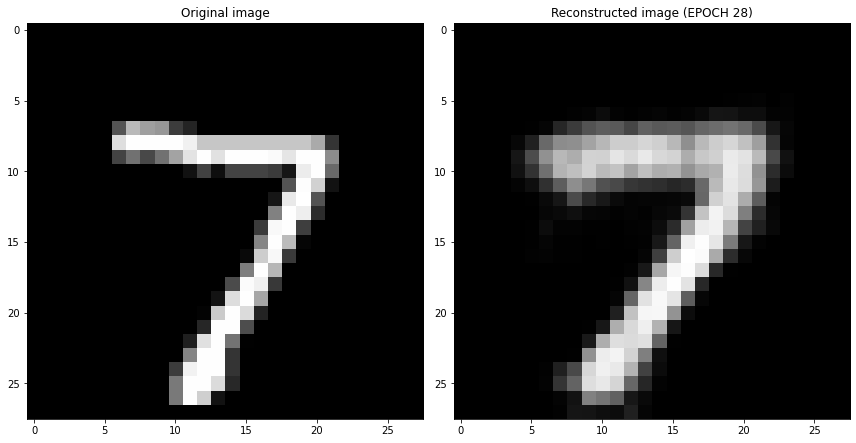

EPOCH 29/30
	 partial train loss (single batch): 0.041474
	 partial train loss (single batch): 0.041435
	 partial train loss (single batch): 0.039717
	 partial train loss (single batch): 0.038467
	 partial train loss (single batch): 0.039937
	 partial train loss (single batch): 0.039387
	 partial train loss (single batch): 0.039005
	 partial train loss (single batch): 0.041499
	 partial train loss (single batch): 0.040204
	 partial train loss (single batch): 0.039372
	 partial train loss (single batch): 0.040404
	 partial train loss (single batch): 0.038469
	 partial train loss (single batch): 0.040306
	 partial train loss (single batch): 0.037652
	 partial train loss (single batch): 0.040745
	 partial train loss (single batch): 0.039144
	 partial train loss (single batch): 0.039568
	 partial train loss (single batch): 0.038807
	 partial train loss (single batch): 0.039435
	 partial train loss (single batch): 0.041027
	 partial train loss (single batch): 0.039709
	 partial train loss (

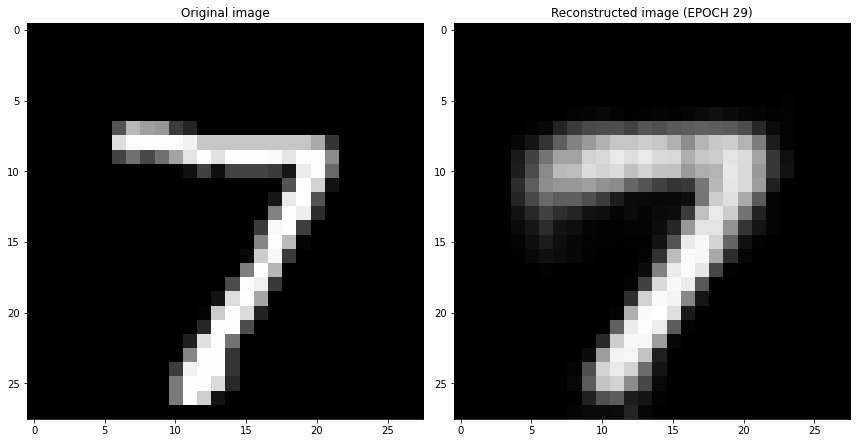

EPOCH 30/30
	 partial train loss (single batch): 0.038964
	 partial train loss (single batch): 0.038374
	 partial train loss (single batch): 0.039355
	 partial train loss (single batch): 0.041043
	 partial train loss (single batch): 0.039935
	 partial train loss (single batch): 0.039627
	 partial train loss (single batch): 0.041195
	 partial train loss (single batch): 0.040411
	 partial train loss (single batch): 0.041225
	 partial train loss (single batch): 0.038839
	 partial train loss (single batch): 0.039745
	 partial train loss (single batch): 0.039345
	 partial train loss (single batch): 0.040369
	 partial train loss (single batch): 0.039546
	 partial train loss (single batch): 0.041485
	 partial train loss (single batch): 0.039377
	 partial train loss (single batch): 0.037343
	 partial train loss (single batch): 0.039740
	 partial train loss (single batch): 0.040898
	 partial train loss (single batch): 0.041498
	 partial train loss (single batch): 0.038836
	 partial train loss (

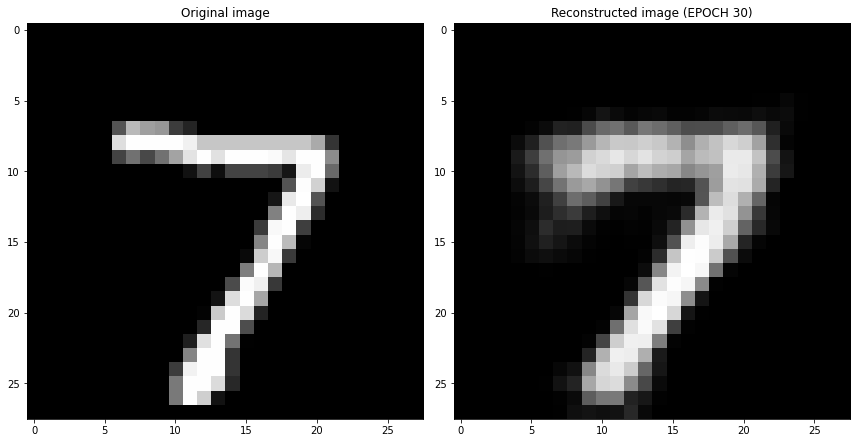

Cross validation fold number= 2/6
EPOCH 1/30
	 partial train loss (single batch): 0.187195
	 partial train loss (single batch): 0.186723
	 partial train loss (single batch): 0.186162
	 partial train loss (single batch): 0.186291
	 partial train loss (single batch): 0.185551
	 partial train loss (single batch): 0.185105
	 partial train loss (single batch): 0.185221
	 partial train loss (single batch): 0.184186
	 partial train loss (single batch): 0.184124
	 partial train loss (single batch): 0.183490
	 partial train loss (single batch): 0.183071
	 partial train loss (single batch): 0.182929
	 partial train loss (single batch): 0.181562
	 partial train loss (single batch): 0.181679
	 partial train loss (single batch): 0.180582
	 partial train loss (single batch): 0.180485
	 partial train loss (single batch): 0.179140
	 partial train loss (single batch): 0.179208
	 partial train loss (single batch): 0.178848
	 partial train loss (single batch): 0.177451
	 partial train loss (single batch)

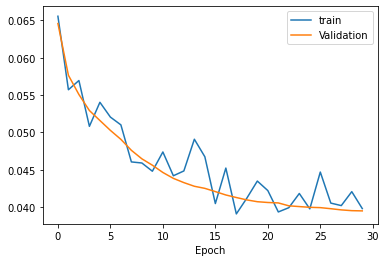

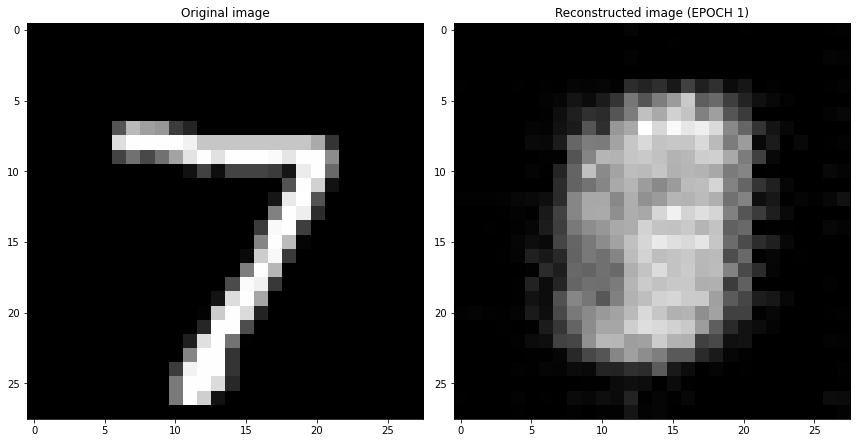

EPOCH 2/30
	 partial train loss (single batch): 0.064914
	 partial train loss (single batch): 0.067960
	 partial train loss (single batch): 0.067340
	 partial train loss (single batch): 0.066006
	 partial train loss (single batch): 0.065550
	 partial train loss (single batch): 0.067824
	 partial train loss (single batch): 0.069232
	 partial train loss (single batch): 0.064922
	 partial train loss (single batch): 0.065008
	 partial train loss (single batch): 0.066432
	 partial train loss (single batch): 0.065919
	 partial train loss (single batch): 0.065650
	 partial train loss (single batch): 0.067221
	 partial train loss (single batch): 0.067552
	 partial train loss (single batch): 0.064330
	 partial train loss (single batch): 0.066688
	 partial train loss (single batch): 0.068311
	 partial train loss (single batch): 0.065672
	 partial train loss (single batch): 0.064931
	 partial train loss (single batch): 0.065292
	 partial train loss (single batch): 0.066858
	 partial train loss (s

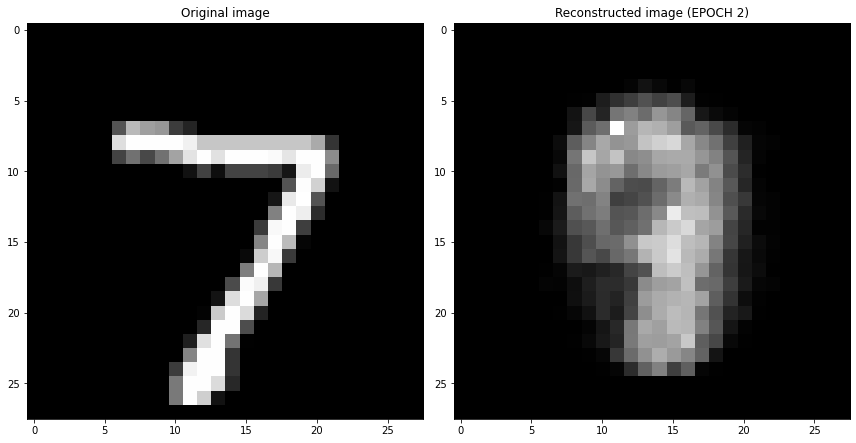

EPOCH 3/30
	 partial train loss (single batch): 0.059193
	 partial train loss (single batch): 0.059854
	 partial train loss (single batch): 0.061303
	 partial train loss (single batch): 0.059777
	 partial train loss (single batch): 0.059995
	 partial train loss (single batch): 0.060536
	 partial train loss (single batch): 0.060097
	 partial train loss (single batch): 0.059686
	 partial train loss (single batch): 0.058163
	 partial train loss (single batch): 0.058289
	 partial train loss (single batch): 0.059176
	 partial train loss (single batch): 0.059003
	 partial train loss (single batch): 0.062049
	 partial train loss (single batch): 0.059731
	 partial train loss (single batch): 0.056217
	 partial train loss (single batch): 0.057622
	 partial train loss (single batch): 0.055743
	 partial train loss (single batch): 0.060425
	 partial train loss (single batch): 0.056954
	 partial train loss (single batch): 0.058429
	 partial train loss (single batch): 0.057867
	 partial train loss (s

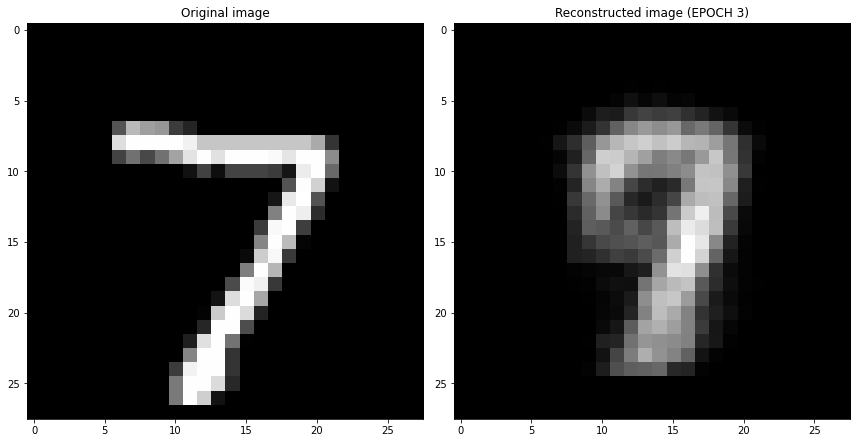

EPOCH 4/30
	 partial train loss (single batch): 0.053729
	 partial train loss (single batch): 0.053310
	 partial train loss (single batch): 0.054885
	 partial train loss (single batch): 0.055247
	 partial train loss (single batch): 0.052532
	 partial train loss (single batch): 0.055223
	 partial train loss (single batch): 0.053613
	 partial train loss (single batch): 0.053382
	 partial train loss (single batch): 0.054468
	 partial train loss (single batch): 0.053264
	 partial train loss (single batch): 0.053078
	 partial train loss (single batch): 0.053564
	 partial train loss (single batch): 0.053730
	 partial train loss (single batch): 0.053241
	 partial train loss (single batch): 0.053326
	 partial train loss (single batch): 0.053256
	 partial train loss (single batch): 0.052979
	 partial train loss (single batch): 0.053066
	 partial train loss (single batch): 0.054181
	 partial train loss (single batch): 0.052892
	 partial train loss (single batch): 0.051651
	 partial train loss (s

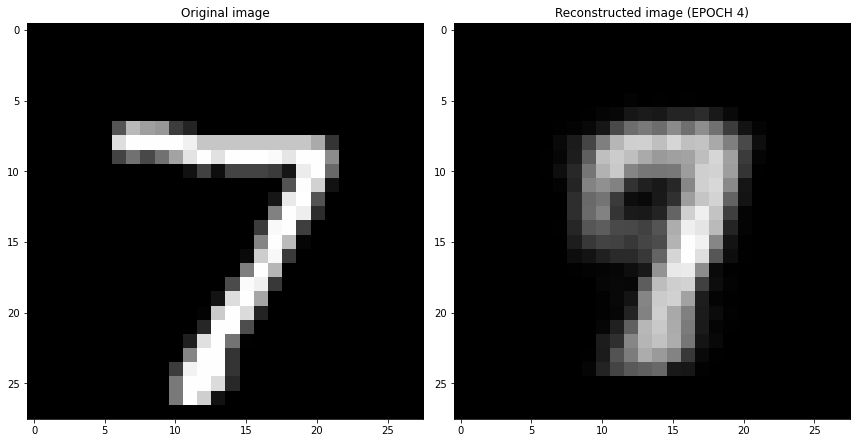

EPOCH 5/30
	 partial train loss (single batch): 0.054105
	 partial train loss (single batch): 0.051114
	 partial train loss (single batch): 0.052305
	 partial train loss (single batch): 0.050371
	 partial train loss (single batch): 0.052691
	 partial train loss (single batch): 0.052035
	 partial train loss (single batch): 0.052012
	 partial train loss (single batch): 0.051365
	 partial train loss (single batch): 0.050840
	 partial train loss (single batch): 0.050991
	 partial train loss (single batch): 0.051386
	 partial train loss (single batch): 0.050924
	 partial train loss (single batch): 0.053576
	 partial train loss (single batch): 0.050726
	 partial train loss (single batch): 0.051392
	 partial train loss (single batch): 0.052107
	 partial train loss (single batch): 0.051370
	 partial train loss (single batch): 0.053380
	 partial train loss (single batch): 0.052307
	 partial train loss (single batch): 0.054248
	 partial train loss (single batch): 0.052145
	 partial train loss (s

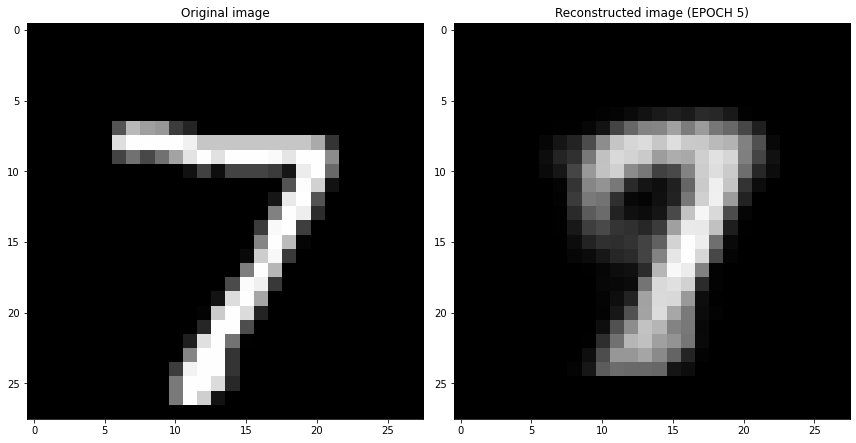

EPOCH 6/30
	 partial train loss (single batch): 0.050156
	 partial train loss (single batch): 0.050334
	 partial train loss (single batch): 0.050920
	 partial train loss (single batch): 0.048252
	 partial train loss (single batch): 0.050363
	 partial train loss (single batch): 0.052875
	 partial train loss (single batch): 0.050204
	 partial train loss (single batch): 0.049221
	 partial train loss (single batch): 0.049876
	 partial train loss (single batch): 0.049320
	 partial train loss (single batch): 0.050338
	 partial train loss (single batch): 0.050345
	 partial train loss (single batch): 0.050579
	 partial train loss (single batch): 0.049145
	 partial train loss (single batch): 0.051730
	 partial train loss (single batch): 0.048611
	 partial train loss (single batch): 0.049702
	 partial train loss (single batch): 0.050360
	 partial train loss (single batch): 0.051034
	 partial train loss (single batch): 0.050047
	 partial train loss (single batch): 0.047807
	 partial train loss (s

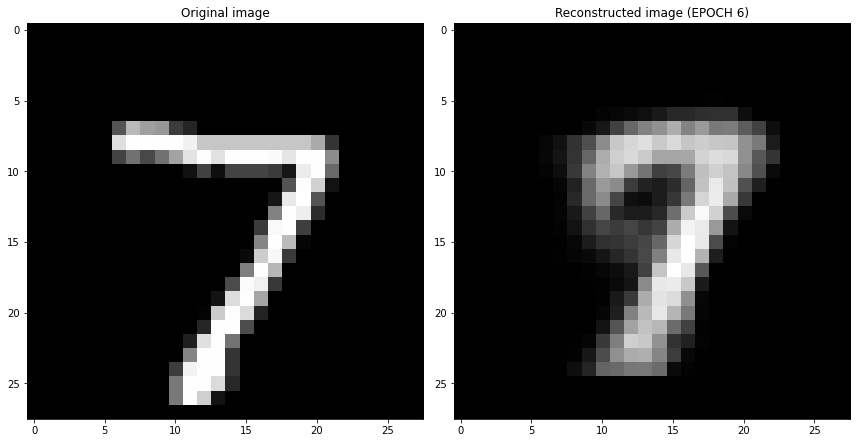

EPOCH 7/30
	 partial train loss (single batch): 0.050092
	 partial train loss (single batch): 0.048309
	 partial train loss (single batch): 0.050432
	 partial train loss (single batch): 0.050324
	 partial train loss (single batch): 0.048885
	 partial train loss (single batch): 0.048912
	 partial train loss (single batch): 0.048622
	 partial train loss (single batch): 0.047172
	 partial train loss (single batch): 0.047318
	 partial train loss (single batch): 0.049255
	 partial train loss (single batch): 0.048253
	 partial train loss (single batch): 0.051392
	 partial train loss (single batch): 0.047346
	 partial train loss (single batch): 0.049955
	 partial train loss (single batch): 0.045645
	 partial train loss (single batch): 0.047796
	 partial train loss (single batch): 0.048626
	 partial train loss (single batch): 0.048713
	 partial train loss (single batch): 0.049661
	 partial train loss (single batch): 0.046747
	 partial train loss (single batch): 0.047530
	 partial train loss (s

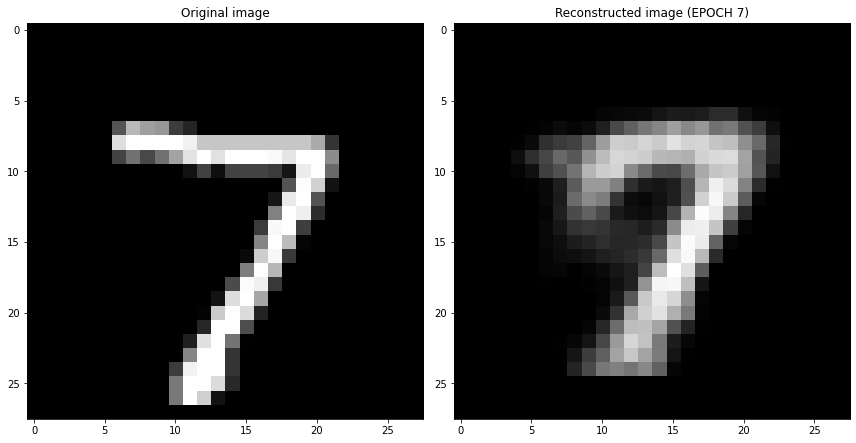

EPOCH 8/30
	 partial train loss (single batch): 0.046933
	 partial train loss (single batch): 0.046828
	 partial train loss (single batch): 0.049679
	 partial train loss (single batch): 0.047002
	 partial train loss (single batch): 0.046447
	 partial train loss (single batch): 0.046267
	 partial train loss (single batch): 0.048810
	 partial train loss (single batch): 0.046646
	 partial train loss (single batch): 0.046842
	 partial train loss (single batch): 0.046137
	 partial train loss (single batch): 0.046321
	 partial train loss (single batch): 0.046574
	 partial train loss (single batch): 0.049114
	 partial train loss (single batch): 0.048050
	 partial train loss (single batch): 0.048092
	 partial train loss (single batch): 0.047351
	 partial train loss (single batch): 0.046472
	 partial train loss (single batch): 0.047065
	 partial train loss (single batch): 0.047058
	 partial train loss (single batch): 0.047482
	 partial train loss (single batch): 0.044685
	 partial train loss (s

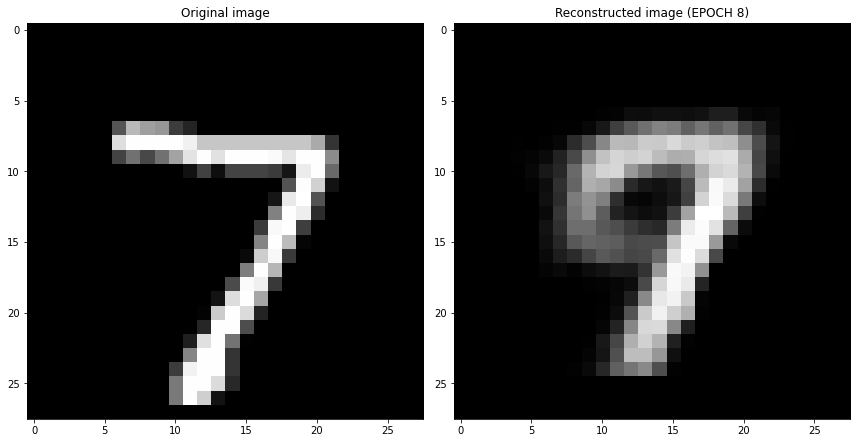

EPOCH 9/30
	 partial train loss (single batch): 0.047907
	 partial train loss (single batch): 0.046111
	 partial train loss (single batch): 0.045975
	 partial train loss (single batch): 0.049177
	 partial train loss (single batch): 0.045297
	 partial train loss (single batch): 0.044468
	 partial train loss (single batch): 0.046627
	 partial train loss (single batch): 0.046760
	 partial train loss (single batch): 0.044032
	 partial train loss (single batch): 0.045519
	 partial train loss (single batch): 0.048019
	 partial train loss (single batch): 0.046224
	 partial train loss (single batch): 0.046995
	 partial train loss (single batch): 0.047040
	 partial train loss (single batch): 0.046390
	 partial train loss (single batch): 0.044528
	 partial train loss (single batch): 0.044308
	 partial train loss (single batch): 0.046726
	 partial train loss (single batch): 0.044642
	 partial train loss (single batch): 0.046344
	 partial train loss (single batch): 0.044988
	 partial train loss (s

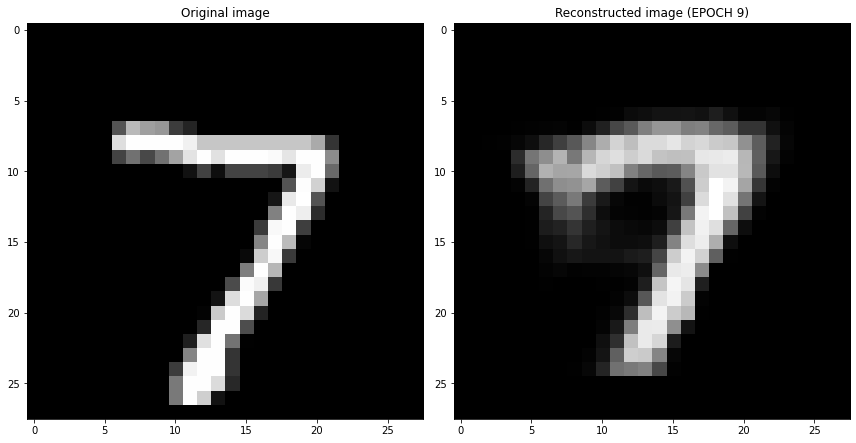

EPOCH 10/30
	 partial train loss (single batch): 0.047151
	 partial train loss (single batch): 0.045062
	 partial train loss (single batch): 0.045908
	 partial train loss (single batch): 0.046570
	 partial train loss (single batch): 0.045473
	 partial train loss (single batch): 0.046878
	 partial train loss (single batch): 0.044469
	 partial train loss (single batch): 0.045200
	 partial train loss (single batch): 0.044639
	 partial train loss (single batch): 0.043463
	 partial train loss (single batch): 0.046902
	 partial train loss (single batch): 0.045369
	 partial train loss (single batch): 0.045537
	 partial train loss (single batch): 0.044998
	 partial train loss (single batch): 0.043696
	 partial train loss (single batch): 0.046585
	 partial train loss (single batch): 0.046819
	 partial train loss (single batch): 0.045948
	 partial train loss (single batch): 0.047007
	 partial train loss (single batch): 0.046135
	 partial train loss (single batch): 0.044808
	 partial train loss (

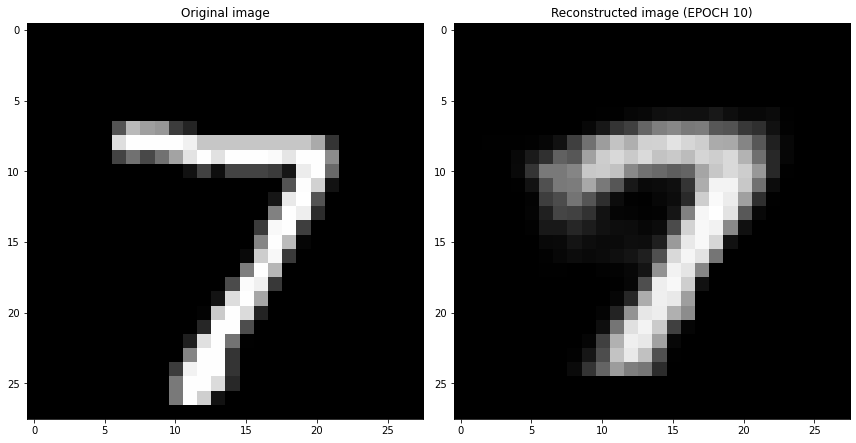

EPOCH 11/30
	 partial train loss (single batch): 0.044925
	 partial train loss (single batch): 0.043543
	 partial train loss (single batch): 0.046357
	 partial train loss (single batch): 0.043971
	 partial train loss (single batch): 0.043123
	 partial train loss (single batch): 0.044316
	 partial train loss (single batch): 0.044662
	 partial train loss (single batch): 0.044546
	 partial train loss (single batch): 0.044910
	 partial train loss (single batch): 0.041918
	 partial train loss (single batch): 0.044009
	 partial train loss (single batch): 0.045778
	 partial train loss (single batch): 0.044006
	 partial train loss (single batch): 0.044710
	 partial train loss (single batch): 0.044642
	 partial train loss (single batch): 0.045242
	 partial train loss (single batch): 0.042492
	 partial train loss (single batch): 0.042593
	 partial train loss (single batch): 0.044233
	 partial train loss (single batch): 0.043964
	 partial train loss (single batch): 0.045633
	 partial train loss (

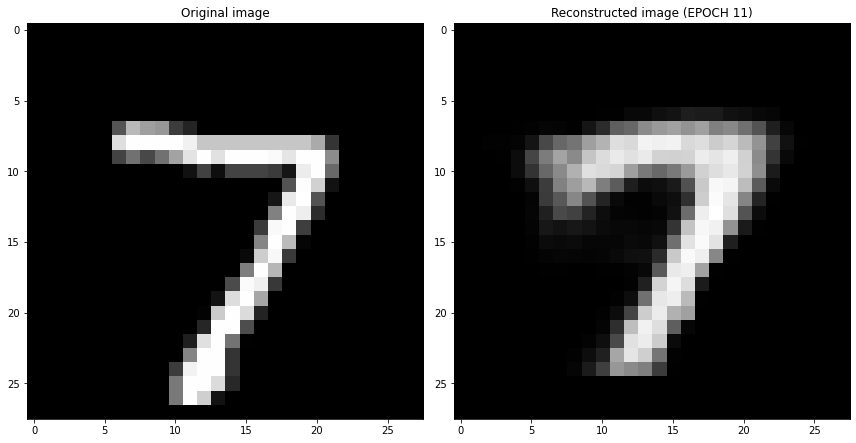

EPOCH 12/30
	 partial train loss (single batch): 0.044428
	 partial train loss (single batch): 0.045493
	 partial train loss (single batch): 0.044907
	 partial train loss (single batch): 0.043801
	 partial train loss (single batch): 0.043087
	 partial train loss (single batch): 0.045563
	 partial train loss (single batch): 0.044732
	 partial train loss (single batch): 0.044979
	 partial train loss (single batch): 0.044916
	 partial train loss (single batch): 0.044301
	 partial train loss (single batch): 0.043967
	 partial train loss (single batch): 0.044664
	 partial train loss (single batch): 0.043943
	 partial train loss (single batch): 0.043414
	 partial train loss (single batch): 0.043891
	 partial train loss (single batch): 0.043903
	 partial train loss (single batch): 0.044119
	 partial train loss (single batch): 0.046812
	 partial train loss (single batch): 0.044071
	 partial train loss (single batch): 0.044821
	 partial train loss (single batch): 0.043358
	 partial train loss (

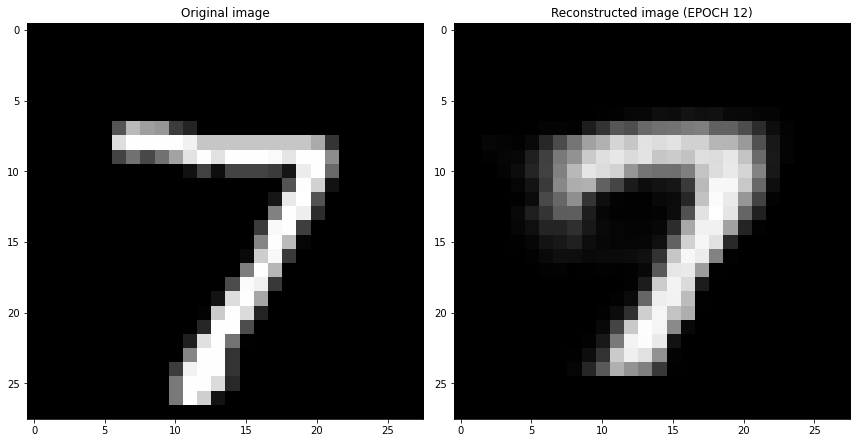

EPOCH 13/30
	 partial train loss (single batch): 0.043980
	 partial train loss (single batch): 0.044510
	 partial train loss (single batch): 0.044079
	 partial train loss (single batch): 0.042535
	 partial train loss (single batch): 0.044308
	 partial train loss (single batch): 0.043103
	 partial train loss (single batch): 0.043604
	 partial train loss (single batch): 0.042585
	 partial train loss (single batch): 0.042610
	 partial train loss (single batch): 0.045793
	 partial train loss (single batch): 0.045009
	 partial train loss (single batch): 0.042379
	 partial train loss (single batch): 0.044787
	 partial train loss (single batch): 0.043500
	 partial train loss (single batch): 0.043553
	 partial train loss (single batch): 0.044515
	 partial train loss (single batch): 0.043228
	 partial train loss (single batch): 0.043567
	 partial train loss (single batch): 0.044273
	 partial train loss (single batch): 0.043139
	 partial train loss (single batch): 0.044436
	 partial train loss (

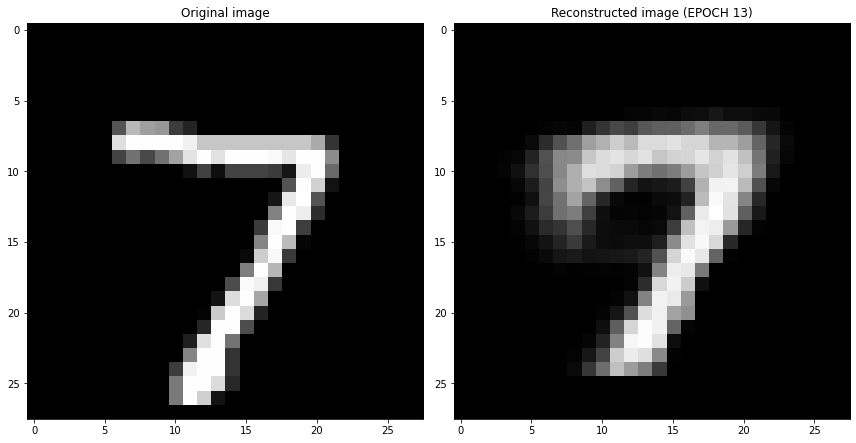

EPOCH 14/30
	 partial train loss (single batch): 0.044163
	 partial train loss (single batch): 0.041486
	 partial train loss (single batch): 0.044033
	 partial train loss (single batch): 0.041907
	 partial train loss (single batch): 0.042313
	 partial train loss (single batch): 0.043409
	 partial train loss (single batch): 0.042900
	 partial train loss (single batch): 0.042771
	 partial train loss (single batch): 0.041581
	 partial train loss (single batch): 0.040814
	 partial train loss (single batch): 0.042463
	 partial train loss (single batch): 0.044737
	 partial train loss (single batch): 0.042496
	 partial train loss (single batch): 0.043062
	 partial train loss (single batch): 0.041897
	 partial train loss (single batch): 0.041951
	 partial train loss (single batch): 0.041554
	 partial train loss (single batch): 0.044019
	 partial train loss (single batch): 0.041475
	 partial train loss (single batch): 0.042812
	 partial train loss (single batch): 0.041292
	 partial train loss (

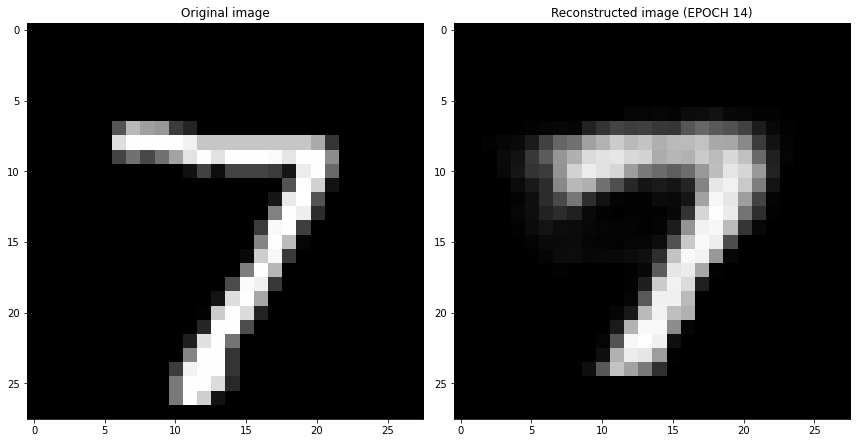

EPOCH 15/30
	 partial train loss (single batch): 0.045801
	 partial train loss (single batch): 0.041852
	 partial train loss (single batch): 0.042156
	 partial train loss (single batch): 0.042896
	 partial train loss (single batch): 0.042785
	 partial train loss (single batch): 0.042763
	 partial train loss (single batch): 0.042943
	 partial train loss (single batch): 0.044132
	 partial train loss (single batch): 0.042639
	 partial train loss (single batch): 0.045429
	 partial train loss (single batch): 0.042774
	 partial train loss (single batch): 0.042112
	 partial train loss (single batch): 0.040271
	 partial train loss (single batch): 0.045317
	 partial train loss (single batch): 0.043298
	 partial train loss (single batch): 0.044000
	 partial train loss (single batch): 0.041752
	 partial train loss (single batch): 0.044605
	 partial train loss (single batch): 0.042638
	 partial train loss (single batch): 0.041998
	 partial train loss (single batch): 0.043544
	 partial train loss (

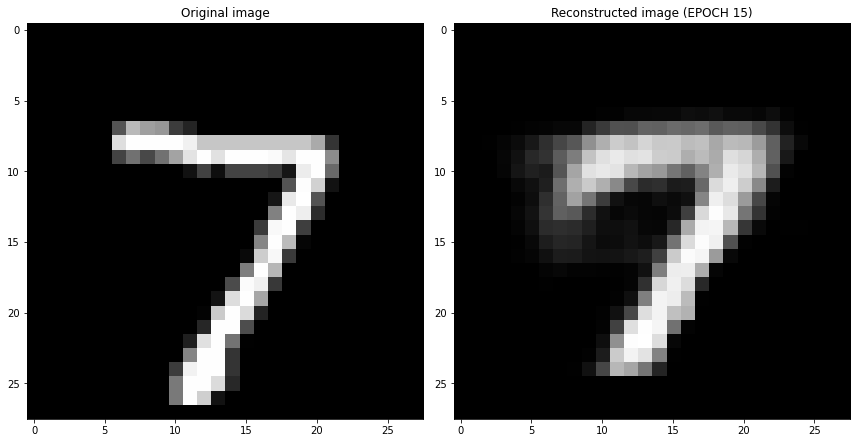

EPOCH 16/30
	 partial train loss (single batch): 0.041940
	 partial train loss (single batch): 0.042600
	 partial train loss (single batch): 0.043996
	 partial train loss (single batch): 0.039743
	 partial train loss (single batch): 0.042006
	 partial train loss (single batch): 0.042538
	 partial train loss (single batch): 0.042527
	 partial train loss (single batch): 0.043679
	 partial train loss (single batch): 0.042605
	 partial train loss (single batch): 0.044134
	 partial train loss (single batch): 0.042415
	 partial train loss (single batch): 0.041797
	 partial train loss (single batch): 0.041809
	 partial train loss (single batch): 0.043071
	 partial train loss (single batch): 0.042405
	 partial train loss (single batch): 0.041339
	 partial train loss (single batch): 0.042301
	 partial train loss (single batch): 0.043657
	 partial train loss (single batch): 0.042336
	 partial train loss (single batch): 0.041083
	 partial train loss (single batch): 0.042193
	 partial train loss (

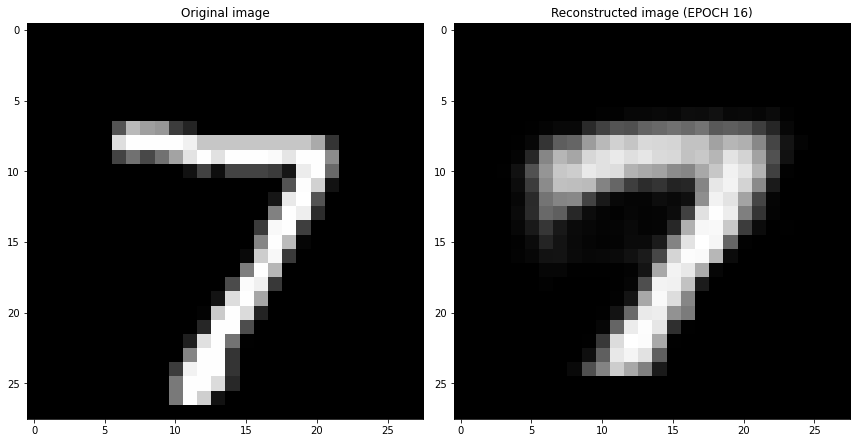

EPOCH 17/30
	 partial train loss (single batch): 0.042473
	 partial train loss (single batch): 0.043254
	 partial train loss (single batch): 0.043293
	 partial train loss (single batch): 0.041241
	 partial train loss (single batch): 0.040219
	 partial train loss (single batch): 0.042695
	 partial train loss (single batch): 0.041545
	 partial train loss (single batch): 0.043931
	 partial train loss (single batch): 0.042471
	 partial train loss (single batch): 0.044259
	 partial train loss (single batch): 0.042538
	 partial train loss (single batch): 0.041582
	 partial train loss (single batch): 0.041273
	 partial train loss (single batch): 0.041812
	 partial train loss (single batch): 0.041798
	 partial train loss (single batch): 0.041734
	 partial train loss (single batch): 0.041757
	 partial train loss (single batch): 0.042485
	 partial train loss (single batch): 0.039158
	 partial train loss (single batch): 0.041927
	 partial train loss (single batch): 0.041958
	 partial train loss (

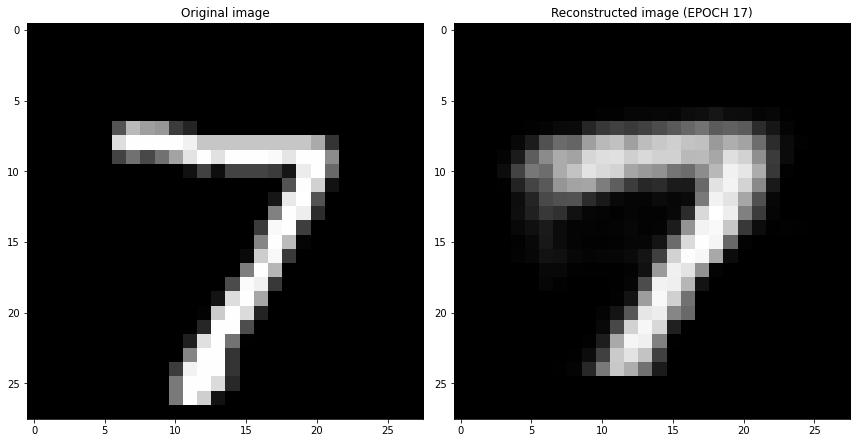

EPOCH 18/30
	 partial train loss (single batch): 0.039598
	 partial train loss (single batch): 0.042530
	 partial train loss (single batch): 0.043842
	 partial train loss (single batch): 0.041039
	 partial train loss (single batch): 0.043642
	 partial train loss (single batch): 0.040985
	 partial train loss (single batch): 0.042388
	 partial train loss (single batch): 0.039622
	 partial train loss (single batch): 0.041767
	 partial train loss (single batch): 0.043856
	 partial train loss (single batch): 0.043853
	 partial train loss (single batch): 0.042205
	 partial train loss (single batch): 0.041594
	 partial train loss (single batch): 0.044212
	 partial train loss (single batch): 0.044540
	 partial train loss (single batch): 0.040860
	 partial train loss (single batch): 0.041357
	 partial train loss (single batch): 0.040971
	 partial train loss (single batch): 0.042669
	 partial train loss (single batch): 0.042331
	 partial train loss (single batch): 0.041267
	 partial train loss (

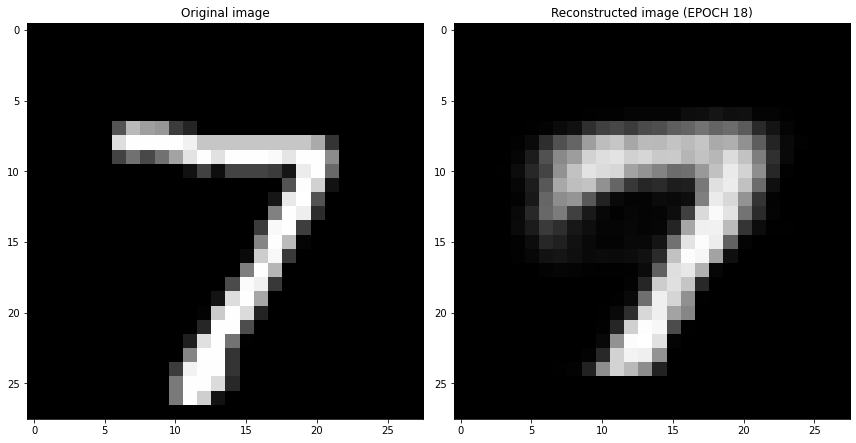

EPOCH 19/30
	 partial train loss (single batch): 0.041939
	 partial train loss (single batch): 0.041316
	 partial train loss (single batch): 0.042248
	 partial train loss (single batch): 0.041531
	 partial train loss (single batch): 0.043744
	 partial train loss (single batch): 0.041562
	 partial train loss (single batch): 0.040305
	 partial train loss (single batch): 0.039957
	 partial train loss (single batch): 0.041166
	 partial train loss (single batch): 0.040114
	 partial train loss (single batch): 0.041226
	 partial train loss (single batch): 0.040486
	 partial train loss (single batch): 0.040499
	 partial train loss (single batch): 0.040828
	 partial train loss (single batch): 0.042234
	 partial train loss (single batch): 0.040874
	 partial train loss (single batch): 0.040849
	 partial train loss (single batch): 0.041956
	 partial train loss (single batch): 0.042795
	 partial train loss (single batch): 0.041965
	 partial train loss (single batch): 0.040614
	 partial train loss (

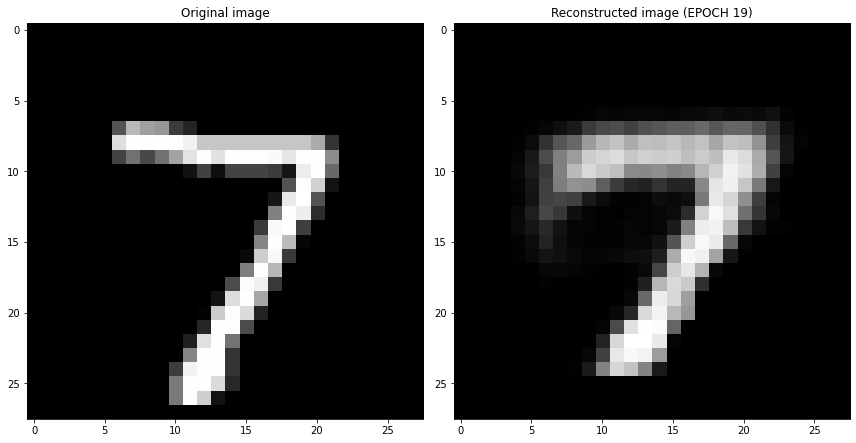

EPOCH 20/30
	 partial train loss (single batch): 0.042626
	 partial train loss (single batch): 0.041647
	 partial train loss (single batch): 0.042434
	 partial train loss (single batch): 0.042660
	 partial train loss (single batch): 0.041853
	 partial train loss (single batch): 0.043138
	 partial train loss (single batch): 0.041684
	 partial train loss (single batch): 0.041482
	 partial train loss (single batch): 0.040943
	 partial train loss (single batch): 0.040425
	 partial train loss (single batch): 0.041211
	 partial train loss (single batch): 0.041308
	 partial train loss (single batch): 0.039770
	 partial train loss (single batch): 0.042211
	 partial train loss (single batch): 0.040762
	 partial train loss (single batch): 0.042412
	 partial train loss (single batch): 0.041724
	 partial train loss (single batch): 0.041635
	 partial train loss (single batch): 0.041517
	 partial train loss (single batch): 0.042213
	 partial train loss (single batch): 0.039544
	 partial train loss (

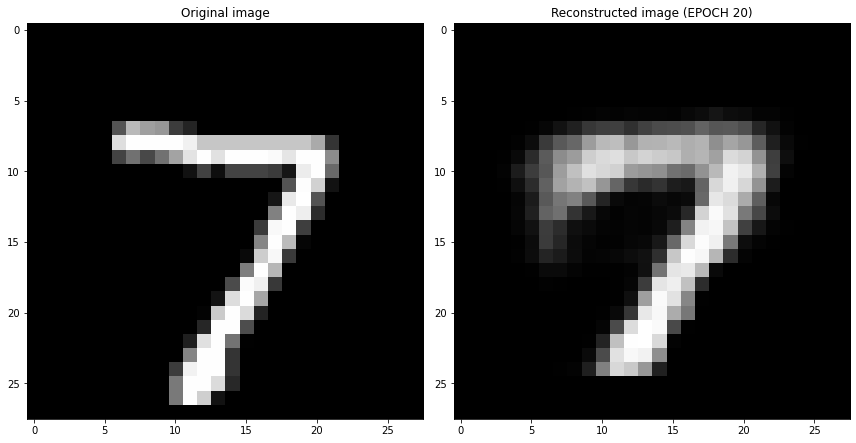

EPOCH 21/30
	 partial train loss (single batch): 0.041772
	 partial train loss (single batch): 0.040910
	 partial train loss (single batch): 0.040457
	 partial train loss (single batch): 0.043264
	 partial train loss (single batch): 0.041792
	 partial train loss (single batch): 0.042158
	 partial train loss (single batch): 0.042226
	 partial train loss (single batch): 0.040774
	 partial train loss (single batch): 0.043139
	 partial train loss (single batch): 0.043121
	 partial train loss (single batch): 0.041556
	 partial train loss (single batch): 0.040564
	 partial train loss (single batch): 0.043119
	 partial train loss (single batch): 0.041174
	 partial train loss (single batch): 0.041465
	 partial train loss (single batch): 0.040337
	 partial train loss (single batch): 0.041800
	 partial train loss (single batch): 0.040753
	 partial train loss (single batch): 0.040414
	 partial train loss (single batch): 0.039727
	 partial train loss (single batch): 0.040195
	 partial train loss (

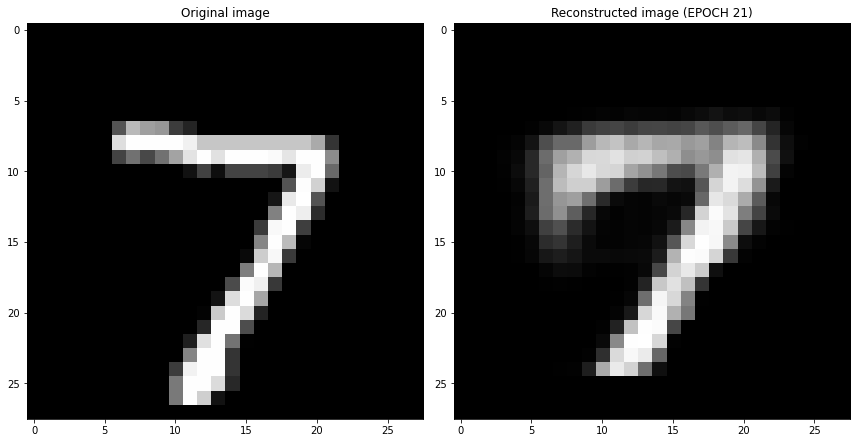

EPOCH 22/30
	 partial train loss (single batch): 0.041032
	 partial train loss (single batch): 0.041609
	 partial train loss (single batch): 0.041305
	 partial train loss (single batch): 0.042593
	 partial train loss (single batch): 0.041302
	 partial train loss (single batch): 0.041445
	 partial train loss (single batch): 0.042229
	 partial train loss (single batch): 0.041740
	 partial train loss (single batch): 0.042310
	 partial train loss (single batch): 0.040345
	 partial train loss (single batch): 0.041770
	 partial train loss (single batch): 0.041877
	 partial train loss (single batch): 0.042256
	 partial train loss (single batch): 0.041818
	 partial train loss (single batch): 0.040884
	 partial train loss (single batch): 0.041446
	 partial train loss (single batch): 0.041919
	 partial train loss (single batch): 0.040309
	 partial train loss (single batch): 0.039550
	 partial train loss (single batch): 0.038954
	 partial train loss (single batch): 0.041800
	 partial train loss (

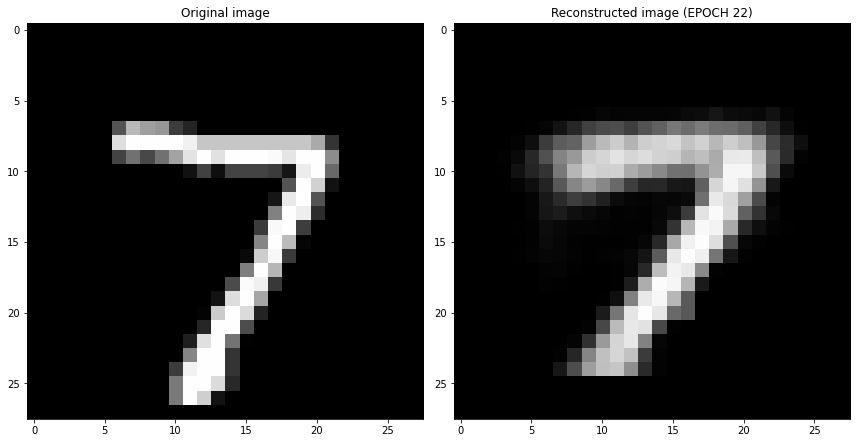

EPOCH 23/30
	 partial train loss (single batch): 0.041313
	 partial train loss (single batch): 0.040037
	 partial train loss (single batch): 0.040021
	 partial train loss (single batch): 0.041699
	 partial train loss (single batch): 0.041102
	 partial train loss (single batch): 0.041026
	 partial train loss (single batch): 0.038592
	 partial train loss (single batch): 0.038823
	 partial train loss (single batch): 0.042499
	 partial train loss (single batch): 0.040661
	 partial train loss (single batch): 0.041628
	 partial train loss (single batch): 0.040136
	 partial train loss (single batch): 0.039393
	 partial train loss (single batch): 0.038942
	 partial train loss (single batch): 0.041052
	 partial train loss (single batch): 0.041497
	 partial train loss (single batch): 0.042135
	 partial train loss (single batch): 0.040749
	 partial train loss (single batch): 0.042389
	 partial train loss (single batch): 0.039259
	 partial train loss (single batch): 0.038393
	 partial train loss (

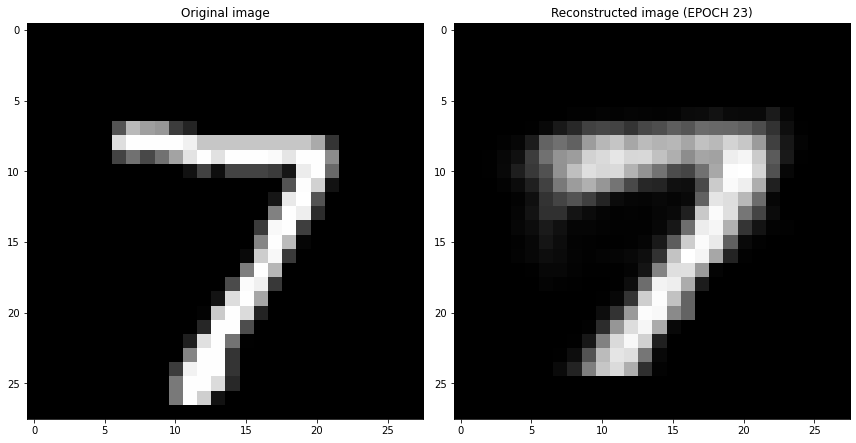

EPOCH 24/30
	 partial train loss (single batch): 0.039888
	 partial train loss (single batch): 0.041651
	 partial train loss (single batch): 0.040356
	 partial train loss (single batch): 0.039367
	 partial train loss (single batch): 0.041835
	 partial train loss (single batch): 0.042228
	 partial train loss (single batch): 0.041041
	 partial train loss (single batch): 0.041209
	 partial train loss (single batch): 0.039523
	 partial train loss (single batch): 0.039734
	 partial train loss (single batch): 0.040143
	 partial train loss (single batch): 0.040952
	 partial train loss (single batch): 0.039313
	 partial train loss (single batch): 0.039344
	 partial train loss (single batch): 0.041092
	 partial train loss (single batch): 0.042163
	 partial train loss (single batch): 0.040162
	 partial train loss (single batch): 0.041530
	 partial train loss (single batch): 0.040899
	 partial train loss (single batch): 0.039923
	 partial train loss (single batch): 0.040401
	 partial train loss (

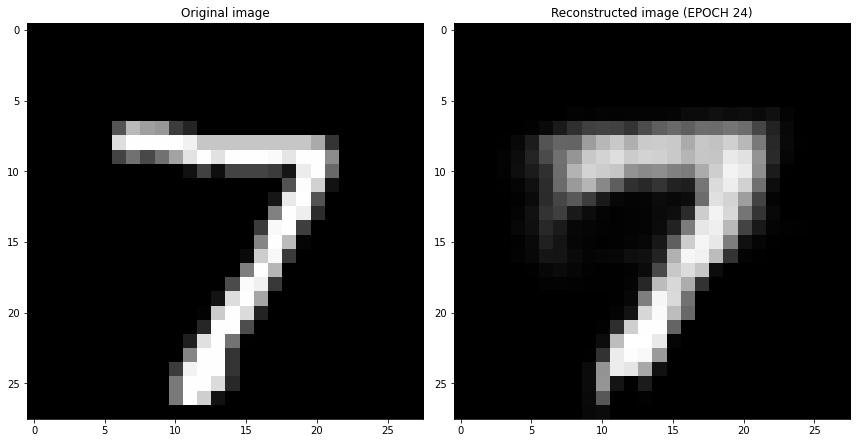

EPOCH 25/30
	 partial train loss (single batch): 0.039876
	 partial train loss (single batch): 0.041079
	 partial train loss (single batch): 0.038543
	 partial train loss (single batch): 0.039933
	 partial train loss (single batch): 0.038375
	 partial train loss (single batch): 0.038277
	 partial train loss (single batch): 0.041619
	 partial train loss (single batch): 0.040626
	 partial train loss (single batch): 0.039275
	 partial train loss (single batch): 0.039910
	 partial train loss (single batch): 0.040384
	 partial train loss (single batch): 0.040146
	 partial train loss (single batch): 0.039622
	 partial train loss (single batch): 0.039877
	 partial train loss (single batch): 0.040100
	 partial train loss (single batch): 0.040684
	 partial train loss (single batch): 0.040598
	 partial train loss (single batch): 0.041621
	 partial train loss (single batch): 0.039103
	 partial train loss (single batch): 0.041727
	 partial train loss (single batch): 0.042029
	 partial train loss (

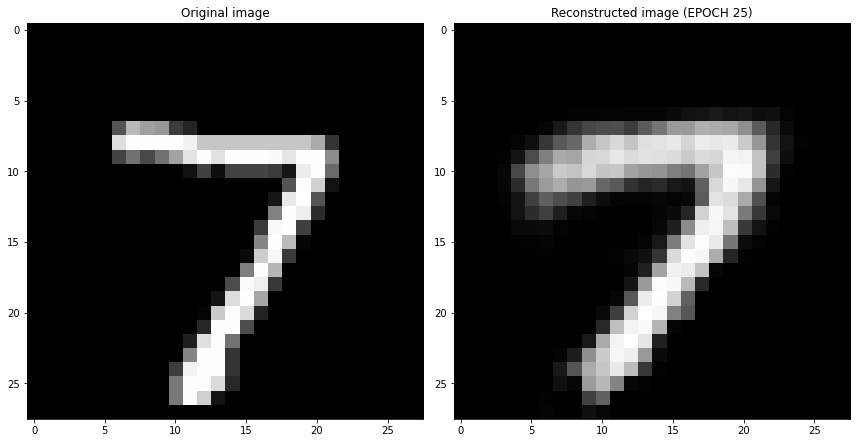

EPOCH 26/30
	 partial train loss (single batch): 0.041036
	 partial train loss (single batch): 0.040765
	 partial train loss (single batch): 0.040017
	 partial train loss (single batch): 0.039015
	 partial train loss (single batch): 0.038855
	 partial train loss (single batch): 0.040278
	 partial train loss (single batch): 0.040064
	 partial train loss (single batch): 0.040551
	 partial train loss (single batch): 0.040797
	 partial train loss (single batch): 0.040226
	 partial train loss (single batch): 0.037620
	 partial train loss (single batch): 0.040672
	 partial train loss (single batch): 0.039685
	 partial train loss (single batch): 0.039497
	 partial train loss (single batch): 0.041069
	 partial train loss (single batch): 0.040109
	 partial train loss (single batch): 0.040338
	 partial train loss (single batch): 0.038587
	 partial train loss (single batch): 0.040833
	 partial train loss (single batch): 0.041165
	 partial train loss (single batch): 0.040505
	 partial train loss (

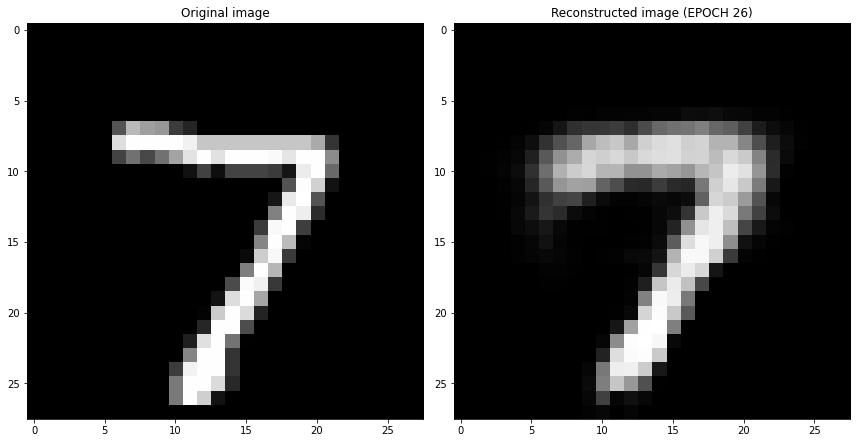

EPOCH 27/30
	 partial train loss (single batch): 0.038305
	 partial train loss (single batch): 0.038903
	 partial train loss (single batch): 0.038620
	 partial train loss (single batch): 0.040698
	 partial train loss (single batch): 0.040455
	 partial train loss (single batch): 0.039383
	 partial train loss (single batch): 0.040716
	 partial train loss (single batch): 0.037704
	 partial train loss (single batch): 0.037843
	 partial train loss (single batch): 0.043665
	 partial train loss (single batch): 0.038844
	 partial train loss (single batch): 0.040280
	 partial train loss (single batch): 0.039533
	 partial train loss (single batch): 0.040724
	 partial train loss (single batch): 0.042660
	 partial train loss (single batch): 0.039959
	 partial train loss (single batch): 0.039628
	 partial train loss (single batch): 0.037106
	 partial train loss (single batch): 0.039366
	 partial train loss (single batch): 0.039156
	 partial train loss (single batch): 0.038840
	 partial train loss (

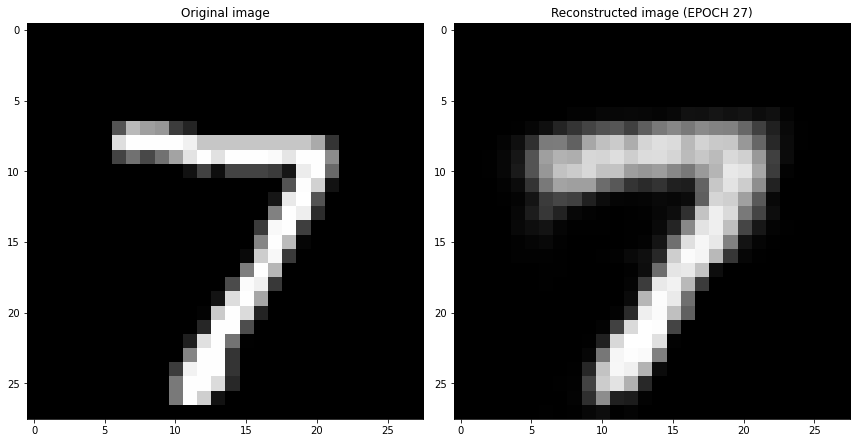

EPOCH 28/30
	 partial train loss (single batch): 0.039639
	 partial train loss (single batch): 0.039271
	 partial train loss (single batch): 0.039571
	 partial train loss (single batch): 0.039672
	 partial train loss (single batch): 0.039189
	 partial train loss (single batch): 0.038151
	 partial train loss (single batch): 0.040237
	 partial train loss (single batch): 0.039938
	 partial train loss (single batch): 0.037032
	 partial train loss (single batch): 0.039113
	 partial train loss (single batch): 0.039255
	 partial train loss (single batch): 0.039551
	 partial train loss (single batch): 0.039137
	 partial train loss (single batch): 0.040959
	 partial train loss (single batch): 0.040247
	 partial train loss (single batch): 0.038513
	 partial train loss (single batch): 0.039340
	 partial train loss (single batch): 0.039587
	 partial train loss (single batch): 0.039280
	 partial train loss (single batch): 0.040437
	 partial train loss (single batch): 0.038706
	 partial train loss (

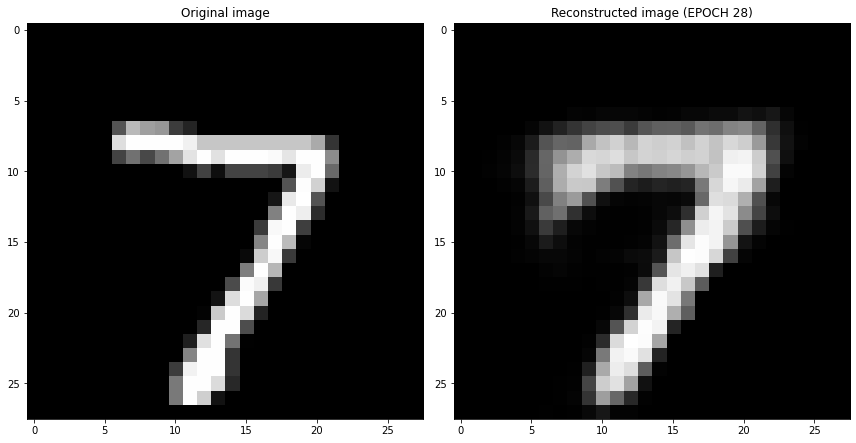

EPOCH 29/30
	 partial train loss (single batch): 0.038736
	 partial train loss (single batch): 0.039179
	 partial train loss (single batch): 0.038657
	 partial train loss (single batch): 0.038907
	 partial train loss (single batch): 0.040147
	 partial train loss (single batch): 0.041895
	 partial train loss (single batch): 0.038604
	 partial train loss (single batch): 0.037309
	 partial train loss (single batch): 0.040663
	 partial train loss (single batch): 0.040496
	 partial train loss (single batch): 0.038610
	 partial train loss (single batch): 0.041721
	 partial train loss (single batch): 0.037583
	 partial train loss (single batch): 0.038738
	 partial train loss (single batch): 0.038349
	 partial train loss (single batch): 0.038039
	 partial train loss (single batch): 0.038843
	 partial train loss (single batch): 0.038227
	 partial train loss (single batch): 0.040563
	 partial train loss (single batch): 0.039578
	 partial train loss (single batch): 0.039749
	 partial train loss (

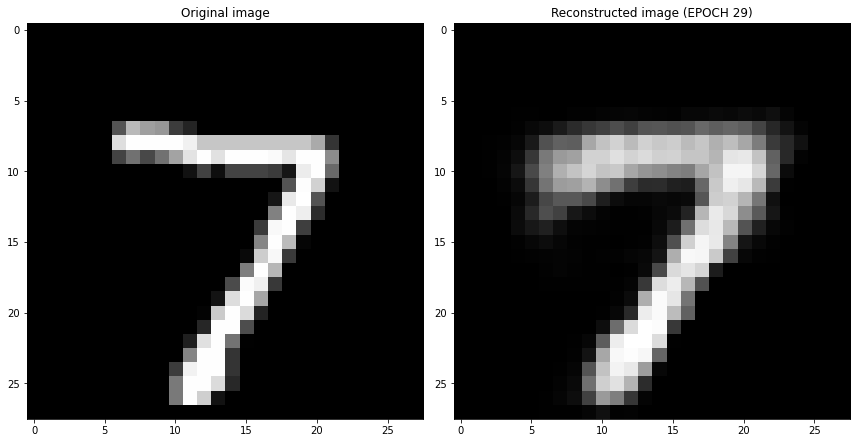

EPOCH 30/30
	 partial train loss (single batch): 0.038973
	 partial train loss (single batch): 0.037626
	 partial train loss (single batch): 0.040405
	 partial train loss (single batch): 0.040547
	 partial train loss (single batch): 0.039278
	 partial train loss (single batch): 0.040254
	 partial train loss (single batch): 0.039380
	 partial train loss (single batch): 0.039520
	 partial train loss (single batch): 0.040183
	 partial train loss (single batch): 0.039977
	 partial train loss (single batch): 0.041255
	 partial train loss (single batch): 0.037925
	 partial train loss (single batch): 0.041069
	 partial train loss (single batch): 0.039577
	 partial train loss (single batch): 0.041547
	 partial train loss (single batch): 0.038691
	 partial train loss (single batch): 0.039537
	 partial train loss (single batch): 0.039290
	 partial train loss (single batch): 0.041182
	 partial train loss (single batch): 0.038844
	 partial train loss (single batch): 0.036505
	 partial train loss (

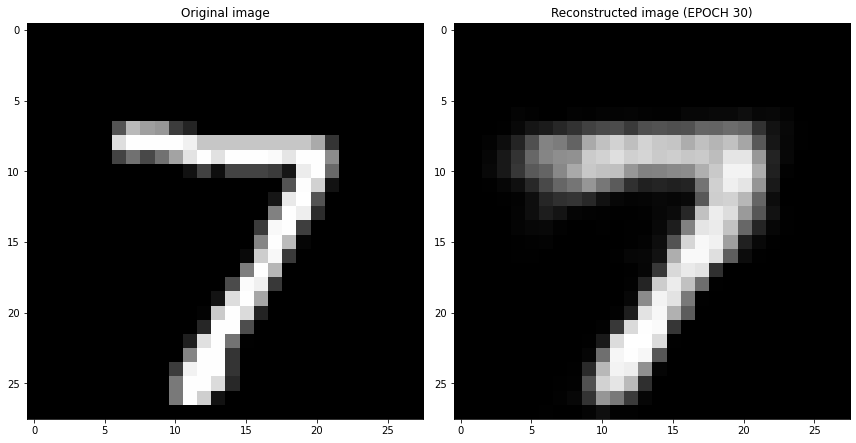

Cross validation fold number= 3/6
EPOCH 1/30
	 partial train loss (single batch): 0.273229
	 partial train loss (single batch): 0.272908
	 partial train loss (single batch): 0.272116
	 partial train loss (single batch): 0.271743
	 partial train loss (single batch): 0.271064
	 partial train loss (single batch): 0.270640
	 partial train loss (single batch): 0.269461
	 partial train loss (single batch): 0.268713
	 partial train loss (single batch): 0.268849
	 partial train loss (single batch): 0.266841
	 partial train loss (single batch): 0.267050
	 partial train loss (single batch): 0.265697
	 partial train loss (single batch): 0.265382
	 partial train loss (single batch): 0.263280
	 partial train loss (single batch): 0.261935
	 partial train loss (single batch): 0.260601
	 partial train loss (single batch): 0.259294
	 partial train loss (single batch): 0.257054
	 partial train loss (single batch): 0.254851
	 partial train loss (single batch): 0.253164
	 partial train loss (single batch)

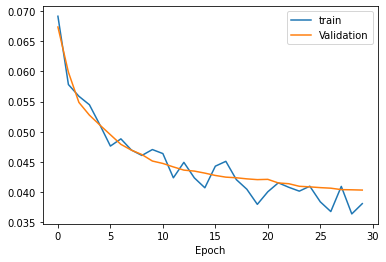

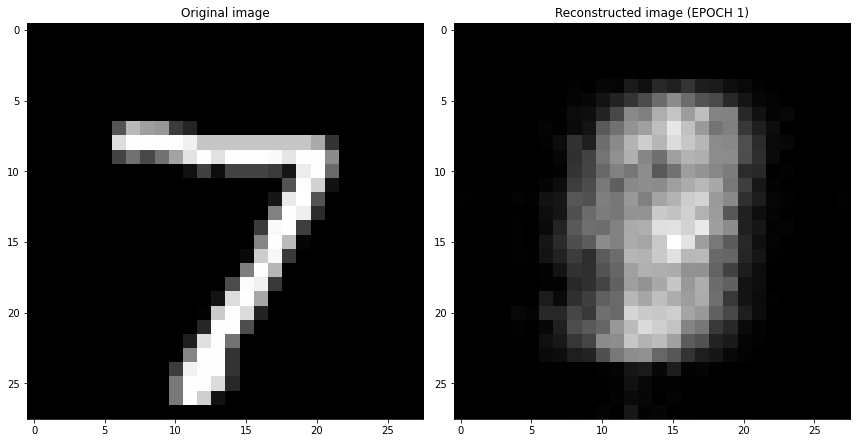

EPOCH 2/30
	 partial train loss (single batch): 0.062974
	 partial train loss (single batch): 0.063656
	 partial train loss (single batch): 0.063385
	 partial train loss (single batch): 0.063157
	 partial train loss (single batch): 0.064451
	 partial train loss (single batch): 0.064354
	 partial train loss (single batch): 0.064436
	 partial train loss (single batch): 0.064275
	 partial train loss (single batch): 0.064091
	 partial train loss (single batch): 0.063184
	 partial train loss (single batch): 0.060919
	 partial train loss (single batch): 0.062585
	 partial train loss (single batch): 0.062842
	 partial train loss (single batch): 0.062743
	 partial train loss (single batch): 0.064166
	 partial train loss (single batch): 0.063918
	 partial train loss (single batch): 0.064101
	 partial train loss (single batch): 0.063654
	 partial train loss (single batch): 0.064775
	 partial train loss (single batch): 0.064168
	 partial train loss (single batch): 0.063581
	 partial train loss (s

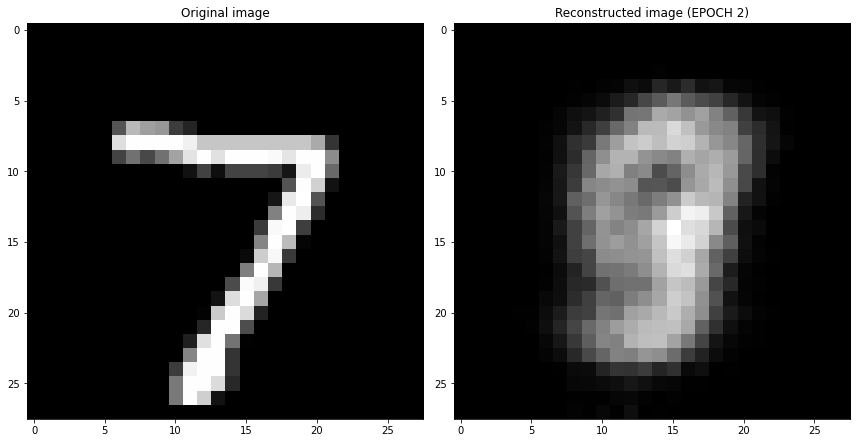

EPOCH 3/30
	 partial train loss (single batch): 0.059868
	 partial train loss (single batch): 0.054919
	 partial train loss (single batch): 0.059328
	 partial train loss (single batch): 0.059163
	 partial train loss (single batch): 0.057144
	 partial train loss (single batch): 0.059474
	 partial train loss (single batch): 0.056453
	 partial train loss (single batch): 0.058301
	 partial train loss (single batch): 0.057857
	 partial train loss (single batch): 0.058013
	 partial train loss (single batch): 0.059168
	 partial train loss (single batch): 0.060797
	 partial train loss (single batch): 0.057804
	 partial train loss (single batch): 0.059528
	 partial train loss (single batch): 0.058187
	 partial train loss (single batch): 0.058481
	 partial train loss (single batch): 0.058848
	 partial train loss (single batch): 0.058609
	 partial train loss (single batch): 0.060493
	 partial train loss (single batch): 0.056547
	 partial train loss (single batch): 0.059508
	 partial train loss (s

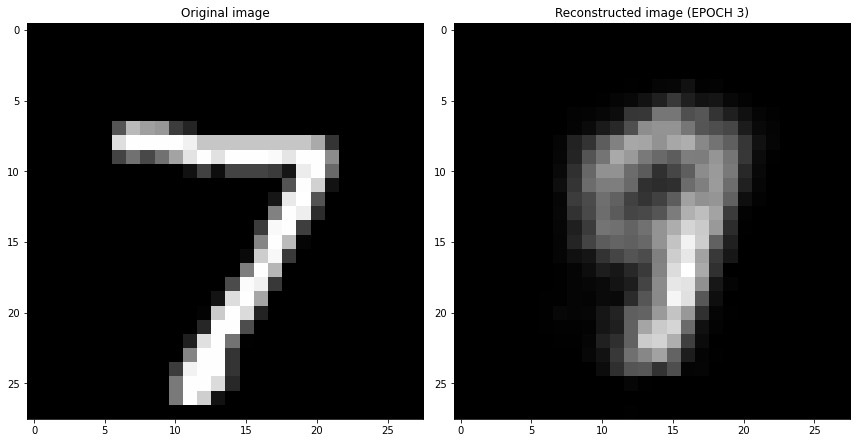

EPOCH 4/30
	 partial train loss (single batch): 0.055717
	 partial train loss (single batch): 0.054630
	 partial train loss (single batch): 0.058189
	 partial train loss (single batch): 0.054288
	 partial train loss (single batch): 0.052718
	 partial train loss (single batch): 0.055919
	 partial train loss (single batch): 0.055053
	 partial train loss (single batch): 0.054229
	 partial train loss (single batch): 0.056074
	 partial train loss (single batch): 0.054546
	 partial train loss (single batch): 0.057182
	 partial train loss (single batch): 0.055598
	 partial train loss (single batch): 0.054544
	 partial train loss (single batch): 0.054722
	 partial train loss (single batch): 0.054279
	 partial train loss (single batch): 0.056185
	 partial train loss (single batch): 0.052944
	 partial train loss (single batch): 0.054829
	 partial train loss (single batch): 0.054684
	 partial train loss (single batch): 0.056775
	 partial train loss (single batch): 0.055458
	 partial train loss (s

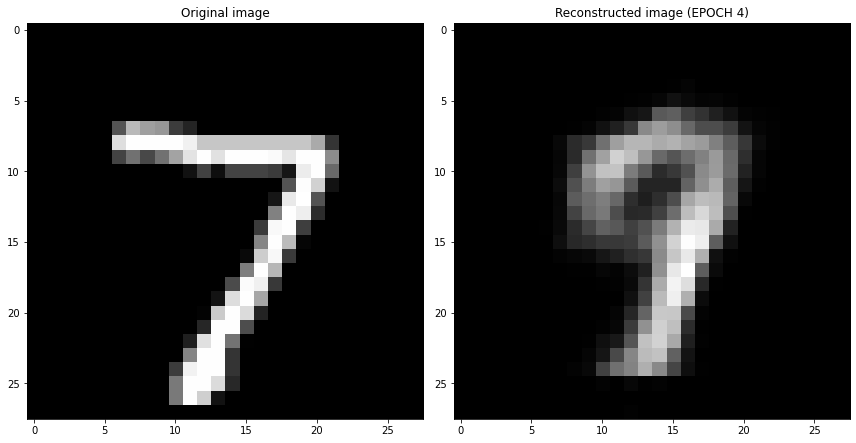

EPOCH 5/30
	 partial train loss (single batch): 0.053288
	 partial train loss (single batch): 0.053959
	 partial train loss (single batch): 0.052237
	 partial train loss (single batch): 0.052006
	 partial train loss (single batch): 0.053114
	 partial train loss (single batch): 0.053023
	 partial train loss (single batch): 0.054507
	 partial train loss (single batch): 0.054792
	 partial train loss (single batch): 0.052368
	 partial train loss (single batch): 0.052288
	 partial train loss (single batch): 0.051518
	 partial train loss (single batch): 0.052777
	 partial train loss (single batch): 0.051982
	 partial train loss (single batch): 0.053323
	 partial train loss (single batch): 0.050834
	 partial train loss (single batch): 0.052109
	 partial train loss (single batch): 0.053351
	 partial train loss (single batch): 0.052054
	 partial train loss (single batch): 0.051824
	 partial train loss (single batch): 0.052917
	 partial train loss (single batch): 0.052106
	 partial train loss (s

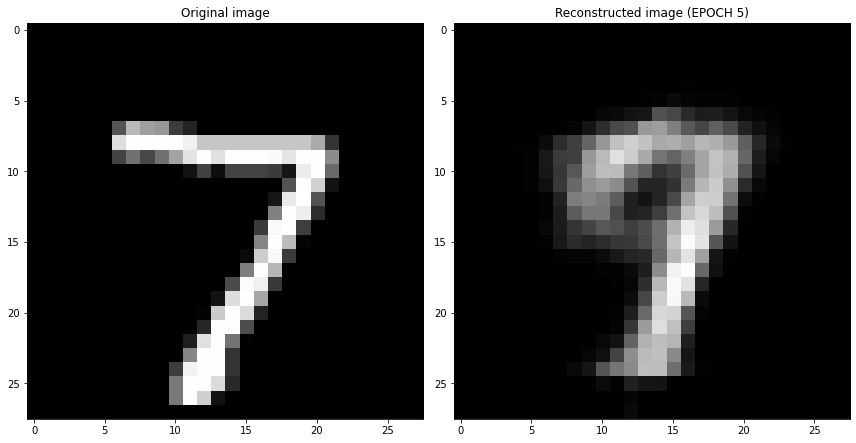

EPOCH 6/30
	 partial train loss (single batch): 0.049907
	 partial train loss (single batch): 0.051970
	 partial train loss (single batch): 0.048457
	 partial train loss (single batch): 0.051837
	 partial train loss (single batch): 0.048579
	 partial train loss (single batch): 0.050588
	 partial train loss (single batch): 0.049360
	 partial train loss (single batch): 0.049958
	 partial train loss (single batch): 0.049735
	 partial train loss (single batch): 0.049845
	 partial train loss (single batch): 0.049450
	 partial train loss (single batch): 0.051573
	 partial train loss (single batch): 0.052444
	 partial train loss (single batch): 0.050597
	 partial train loss (single batch): 0.052158
	 partial train loss (single batch): 0.050023
	 partial train loss (single batch): 0.050505
	 partial train loss (single batch): 0.049655
	 partial train loss (single batch): 0.050046
	 partial train loss (single batch): 0.050147
	 partial train loss (single batch): 0.048761
	 partial train loss (s

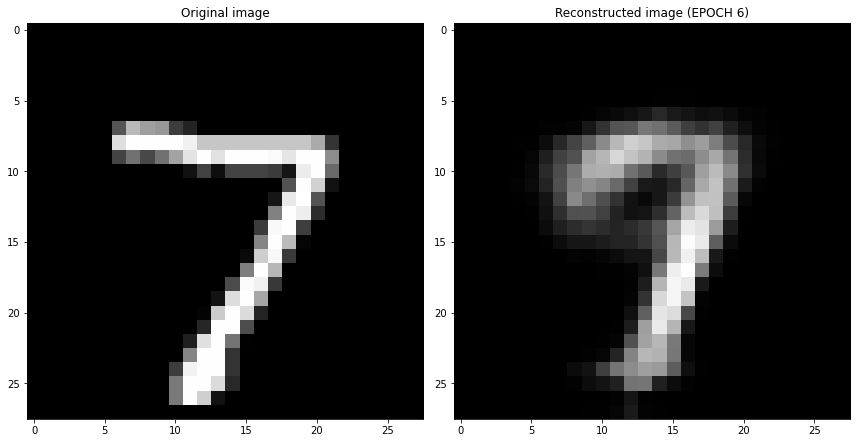

EPOCH 7/30
	 partial train loss (single batch): 0.047481
	 partial train loss (single batch): 0.049107
	 partial train loss (single batch): 0.049242
	 partial train loss (single batch): 0.050061
	 partial train loss (single batch): 0.048725
	 partial train loss (single batch): 0.049573
	 partial train loss (single batch): 0.048374
	 partial train loss (single batch): 0.048971
	 partial train loss (single batch): 0.047658
	 partial train loss (single batch): 0.048277
	 partial train loss (single batch): 0.049986
	 partial train loss (single batch): 0.049159
	 partial train loss (single batch): 0.048210
	 partial train loss (single batch): 0.046108
	 partial train loss (single batch): 0.050208
	 partial train loss (single batch): 0.050454
	 partial train loss (single batch): 0.047928
	 partial train loss (single batch): 0.049681
	 partial train loss (single batch): 0.049729
	 partial train loss (single batch): 0.049034
	 partial train loss (single batch): 0.048301
	 partial train loss (s

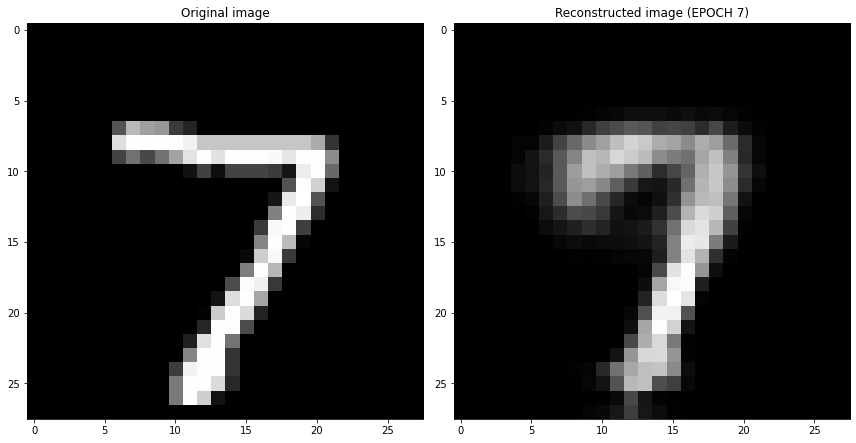

EPOCH 8/30
	 partial train loss (single batch): 0.046476
	 partial train loss (single batch): 0.046749
	 partial train loss (single batch): 0.047106
	 partial train loss (single batch): 0.047677
	 partial train loss (single batch): 0.045988
	 partial train loss (single batch): 0.049049
	 partial train loss (single batch): 0.048434
	 partial train loss (single batch): 0.046733
	 partial train loss (single batch): 0.047449
	 partial train loss (single batch): 0.049061
	 partial train loss (single batch): 0.047267
	 partial train loss (single batch): 0.046138
	 partial train loss (single batch): 0.046895
	 partial train loss (single batch): 0.046106
	 partial train loss (single batch): 0.049357
	 partial train loss (single batch): 0.046960
	 partial train loss (single batch): 0.047308
	 partial train loss (single batch): 0.046565
	 partial train loss (single batch): 0.048689
	 partial train loss (single batch): 0.047699
	 partial train loss (single batch): 0.045924
	 partial train loss (s

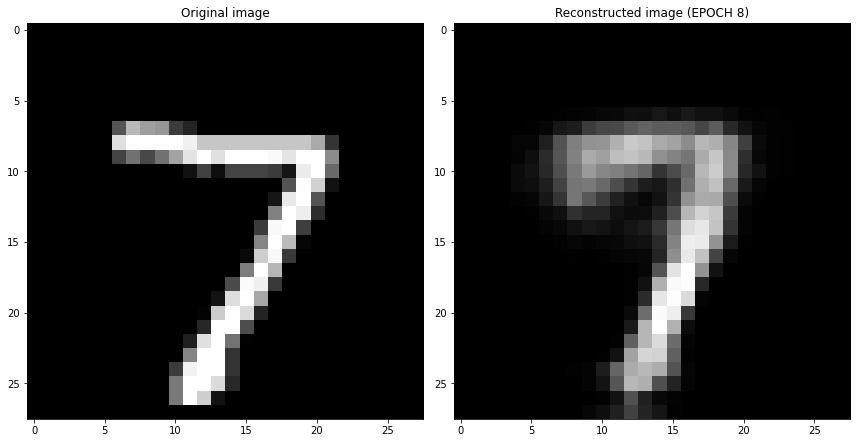

EPOCH 9/30
	 partial train loss (single batch): 0.046104
	 partial train loss (single batch): 0.047027
	 partial train loss (single batch): 0.045135
	 partial train loss (single batch): 0.046741
	 partial train loss (single batch): 0.044043
	 partial train loss (single batch): 0.047605
	 partial train loss (single batch): 0.045562
	 partial train loss (single batch): 0.045925
	 partial train loss (single batch): 0.048238
	 partial train loss (single batch): 0.044476
	 partial train loss (single batch): 0.045122
	 partial train loss (single batch): 0.045327
	 partial train loss (single batch): 0.044231
	 partial train loss (single batch): 0.044162
	 partial train loss (single batch): 0.045199
	 partial train loss (single batch): 0.044819
	 partial train loss (single batch): 0.046516
	 partial train loss (single batch): 0.048814
	 partial train loss (single batch): 0.045878
	 partial train loss (single batch): 0.046779
	 partial train loss (single batch): 0.047353
	 partial train loss (s

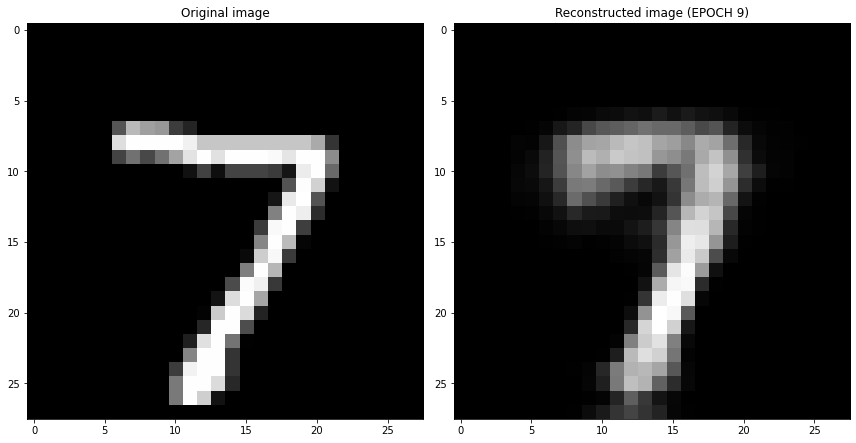

EPOCH 10/30
	 partial train loss (single batch): 0.047599
	 partial train loss (single batch): 0.044514
	 partial train loss (single batch): 0.043920
	 partial train loss (single batch): 0.044104
	 partial train loss (single batch): 0.047257
	 partial train loss (single batch): 0.046462
	 partial train loss (single batch): 0.046918
	 partial train loss (single batch): 0.043506
	 partial train loss (single batch): 0.045503
	 partial train loss (single batch): 0.045649
	 partial train loss (single batch): 0.044596
	 partial train loss (single batch): 0.046122
	 partial train loss (single batch): 0.045773
	 partial train loss (single batch): 0.044947
	 partial train loss (single batch): 0.043319
	 partial train loss (single batch): 0.047530
	 partial train loss (single batch): 0.043685
	 partial train loss (single batch): 0.044952
	 partial train loss (single batch): 0.048712
	 partial train loss (single batch): 0.045897
	 partial train loss (single batch): 0.046429
	 partial train loss (

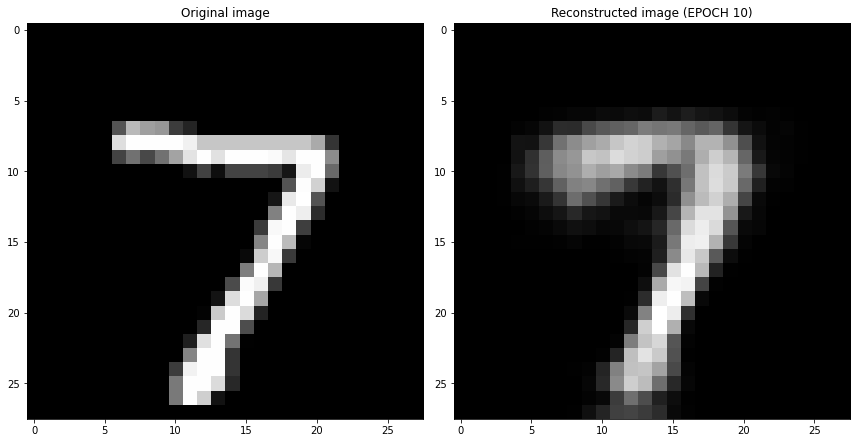

EPOCH 11/30
	 partial train loss (single batch): 0.043267
	 partial train loss (single batch): 0.045228
	 partial train loss (single batch): 0.045594
	 partial train loss (single batch): 0.042362
	 partial train loss (single batch): 0.045805
	 partial train loss (single batch): 0.044352
	 partial train loss (single batch): 0.044644
	 partial train loss (single batch): 0.046665
	 partial train loss (single batch): 0.043562
	 partial train loss (single batch): 0.044609
	 partial train loss (single batch): 0.043116
	 partial train loss (single batch): 0.046523
	 partial train loss (single batch): 0.044428
	 partial train loss (single batch): 0.046174
	 partial train loss (single batch): 0.045646
	 partial train loss (single batch): 0.044165
	 partial train loss (single batch): 0.045435
	 partial train loss (single batch): 0.044643
	 partial train loss (single batch): 0.043420
	 partial train loss (single batch): 0.044597
	 partial train loss (single batch): 0.042655
	 partial train loss (

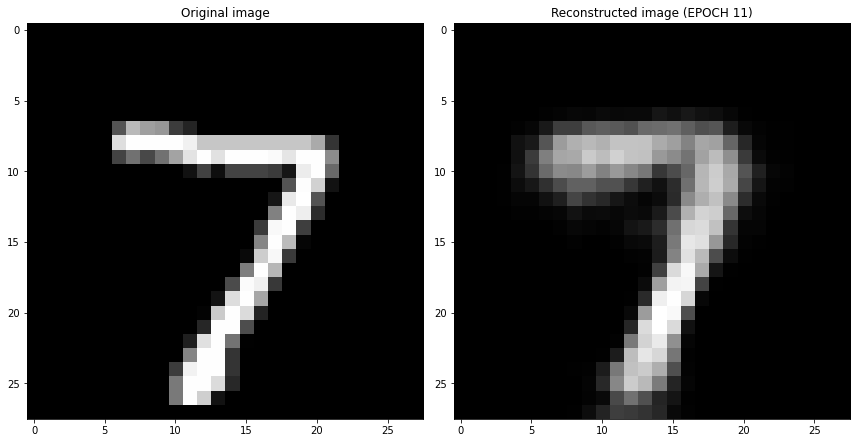

EPOCH 12/30
	 partial train loss (single batch): 0.043826
	 partial train loss (single batch): 0.045625
	 partial train loss (single batch): 0.043410
	 partial train loss (single batch): 0.042594
	 partial train loss (single batch): 0.042109
	 partial train loss (single batch): 0.045577
	 partial train loss (single batch): 0.045345
	 partial train loss (single batch): 0.043699
	 partial train loss (single batch): 0.043865
	 partial train loss (single batch): 0.045319
	 partial train loss (single batch): 0.045778
	 partial train loss (single batch): 0.042906
	 partial train loss (single batch): 0.044842
	 partial train loss (single batch): 0.045090
	 partial train loss (single batch): 0.045619
	 partial train loss (single batch): 0.043451
	 partial train loss (single batch): 0.044011
	 partial train loss (single batch): 0.043986
	 partial train loss (single batch): 0.042632
	 partial train loss (single batch): 0.043029
	 partial train loss (single batch): 0.043287
	 partial train loss (

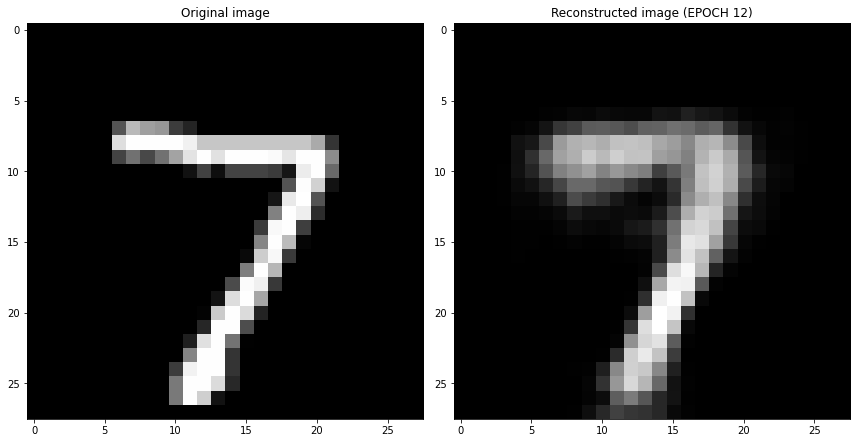

EPOCH 13/30
	 partial train loss (single batch): 0.043322
	 partial train loss (single batch): 0.044899
	 partial train loss (single batch): 0.044897
	 partial train loss (single batch): 0.042309
	 partial train loss (single batch): 0.044675
	 partial train loss (single batch): 0.044086
	 partial train loss (single batch): 0.040655
	 partial train loss (single batch): 0.043917
	 partial train loss (single batch): 0.044802
	 partial train loss (single batch): 0.045649
	 partial train loss (single batch): 0.043623
	 partial train loss (single batch): 0.044687
	 partial train loss (single batch): 0.044049
	 partial train loss (single batch): 0.044181
	 partial train loss (single batch): 0.043135
	 partial train loss (single batch): 0.042750
	 partial train loss (single batch): 0.042541
	 partial train loss (single batch): 0.044020
	 partial train loss (single batch): 0.042312
	 partial train loss (single batch): 0.045450
	 partial train loss (single batch): 0.043281
	 partial train loss (

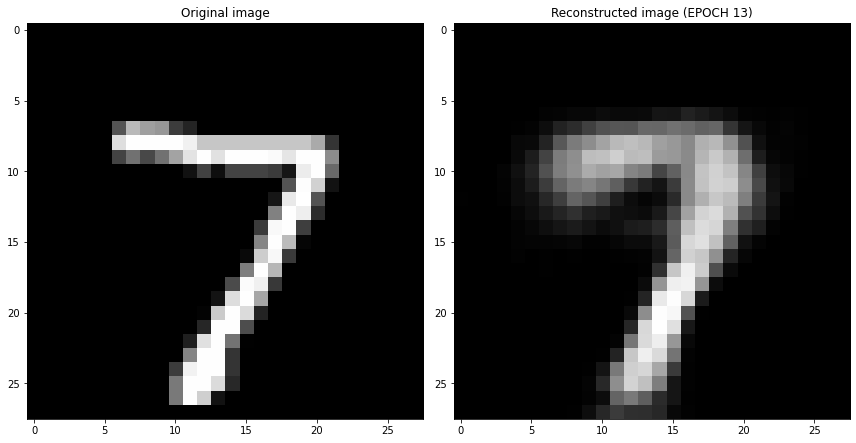

EPOCH 14/30
	 partial train loss (single batch): 0.042683
	 partial train loss (single batch): 0.042533
	 partial train loss (single batch): 0.041034
	 partial train loss (single batch): 0.044721
	 partial train loss (single batch): 0.043826
	 partial train loss (single batch): 0.043072
	 partial train loss (single batch): 0.044007
	 partial train loss (single batch): 0.043979
	 partial train loss (single batch): 0.041864
	 partial train loss (single batch): 0.043086
	 partial train loss (single batch): 0.043258
	 partial train loss (single batch): 0.043726
	 partial train loss (single batch): 0.043483
	 partial train loss (single batch): 0.044990
	 partial train loss (single batch): 0.041255
	 partial train loss (single batch): 0.044233
	 partial train loss (single batch): 0.044028
	 partial train loss (single batch): 0.043967
	 partial train loss (single batch): 0.044622
	 partial train loss (single batch): 0.045599
	 partial train loss (single batch): 0.045496
	 partial train loss (

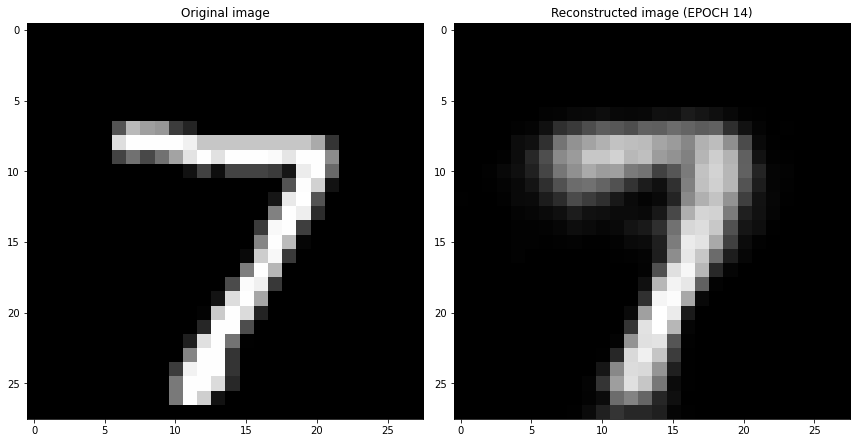

EPOCH 15/30
	 partial train loss (single batch): 0.043457
	 partial train loss (single batch): 0.039564
	 partial train loss (single batch): 0.042285
	 partial train loss (single batch): 0.043849
	 partial train loss (single batch): 0.043511
	 partial train loss (single batch): 0.041324
	 partial train loss (single batch): 0.044848
	 partial train loss (single batch): 0.042943
	 partial train loss (single batch): 0.042616
	 partial train loss (single batch): 0.044336
	 partial train loss (single batch): 0.040184
	 partial train loss (single batch): 0.042019
	 partial train loss (single batch): 0.044256
	 partial train loss (single batch): 0.043365
	 partial train loss (single batch): 0.044422
	 partial train loss (single batch): 0.043166
	 partial train loss (single batch): 0.042283
	 partial train loss (single batch): 0.042516
	 partial train loss (single batch): 0.045229
	 partial train loss (single batch): 0.042182
	 partial train loss (single batch): 0.044676
	 partial train loss (

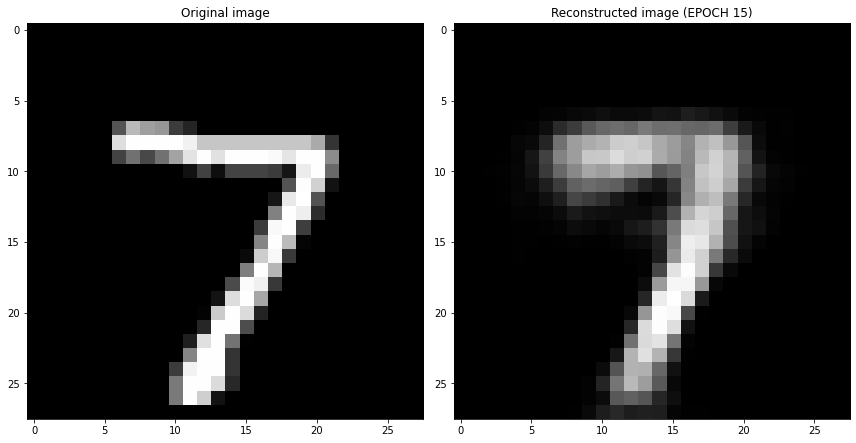

EPOCH 16/30
	 partial train loss (single batch): 0.043039
	 partial train loss (single batch): 0.044356
	 partial train loss (single batch): 0.043296
	 partial train loss (single batch): 0.044248
	 partial train loss (single batch): 0.044506
	 partial train loss (single batch): 0.042539
	 partial train loss (single batch): 0.041518
	 partial train loss (single batch): 0.043281
	 partial train loss (single batch): 0.042420
	 partial train loss (single batch): 0.041944
	 partial train loss (single batch): 0.043731
	 partial train loss (single batch): 0.043012
	 partial train loss (single batch): 0.043280
	 partial train loss (single batch): 0.044576
	 partial train loss (single batch): 0.041764
	 partial train loss (single batch): 0.043911
	 partial train loss (single batch): 0.043308
	 partial train loss (single batch): 0.042704
	 partial train loss (single batch): 0.041631
	 partial train loss (single batch): 0.043972
	 partial train loss (single batch): 0.041943
	 partial train loss (

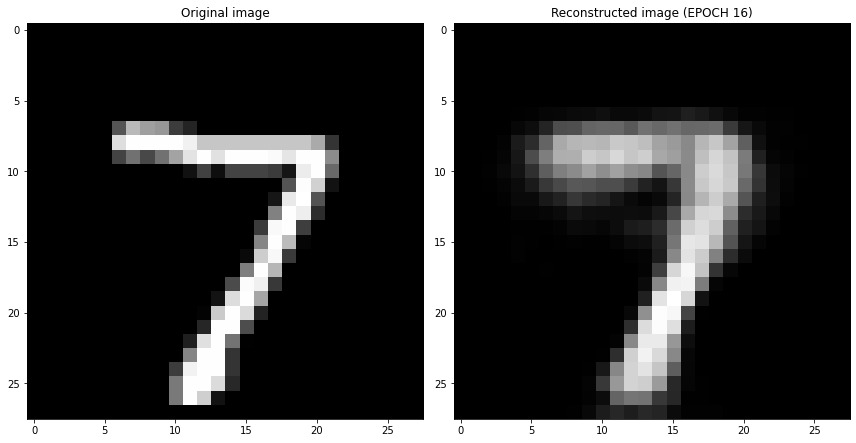

EPOCH 17/30
	 partial train loss (single batch): 0.041208
	 partial train loss (single batch): 0.043424
	 partial train loss (single batch): 0.042895
	 partial train loss (single batch): 0.042154
	 partial train loss (single batch): 0.043142
	 partial train loss (single batch): 0.042081
	 partial train loss (single batch): 0.042928
	 partial train loss (single batch): 0.044123
	 partial train loss (single batch): 0.042162
	 partial train loss (single batch): 0.044070
	 partial train loss (single batch): 0.042886
	 partial train loss (single batch): 0.042669
	 partial train loss (single batch): 0.041907
	 partial train loss (single batch): 0.042761
	 partial train loss (single batch): 0.041259
	 partial train loss (single batch): 0.043183
	 partial train loss (single batch): 0.044478
	 partial train loss (single batch): 0.042071
	 partial train loss (single batch): 0.042287
	 partial train loss (single batch): 0.042484
	 partial train loss (single batch): 0.042012
	 partial train loss (

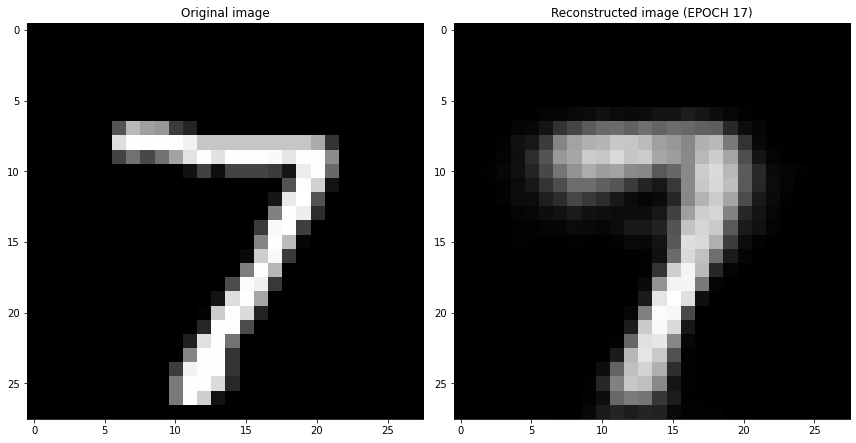

EPOCH 18/30
	 partial train loss (single batch): 0.042987
	 partial train loss (single batch): 0.042896
	 partial train loss (single batch): 0.044033
	 partial train loss (single batch): 0.041820
	 partial train loss (single batch): 0.042601
	 partial train loss (single batch): 0.041052
	 partial train loss (single batch): 0.042696
	 partial train loss (single batch): 0.042231
	 partial train loss (single batch): 0.042735
	 partial train loss (single batch): 0.041877
	 partial train loss (single batch): 0.041668
	 partial train loss (single batch): 0.041473
	 partial train loss (single batch): 0.039763
	 partial train loss (single batch): 0.043103
	 partial train loss (single batch): 0.042931
	 partial train loss (single batch): 0.041079
	 partial train loss (single batch): 0.042430
	 partial train loss (single batch): 0.044125
	 partial train loss (single batch): 0.040526
	 partial train loss (single batch): 0.042196
	 partial train loss (single batch): 0.042369
	 partial train loss (

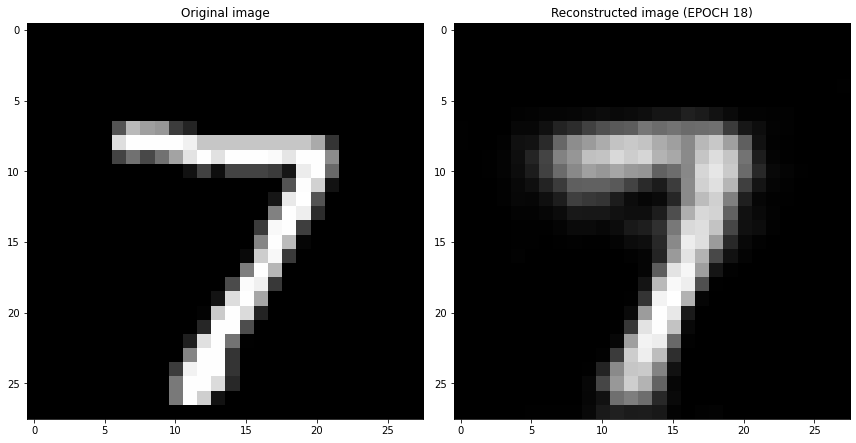

EPOCH 19/30
	 partial train loss (single batch): 0.040462
	 partial train loss (single batch): 0.042409
	 partial train loss (single batch): 0.042085
	 partial train loss (single batch): 0.042262
	 partial train loss (single batch): 0.041501
	 partial train loss (single batch): 0.042639
	 partial train loss (single batch): 0.042374
	 partial train loss (single batch): 0.041551
	 partial train loss (single batch): 0.039732
	 partial train loss (single batch): 0.042438
	 partial train loss (single batch): 0.041086
	 partial train loss (single batch): 0.041359
	 partial train loss (single batch): 0.041535
	 partial train loss (single batch): 0.042399
	 partial train loss (single batch): 0.043351
	 partial train loss (single batch): 0.042051
	 partial train loss (single batch): 0.041570
	 partial train loss (single batch): 0.042516
	 partial train loss (single batch): 0.041855
	 partial train loss (single batch): 0.040343
	 partial train loss (single batch): 0.041097
	 partial train loss (

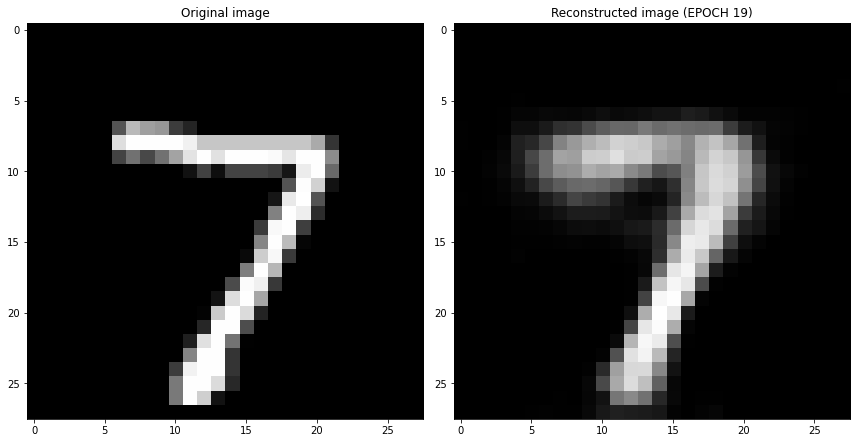

EPOCH 20/30
	 partial train loss (single batch): 0.041311
	 partial train loss (single batch): 0.042610
	 partial train loss (single batch): 0.041553
	 partial train loss (single batch): 0.042332
	 partial train loss (single batch): 0.041032
	 partial train loss (single batch): 0.040480
	 partial train loss (single batch): 0.040873
	 partial train loss (single batch): 0.041074
	 partial train loss (single batch): 0.043351
	 partial train loss (single batch): 0.044060
	 partial train loss (single batch): 0.042351
	 partial train loss (single batch): 0.041682
	 partial train loss (single batch): 0.044070
	 partial train loss (single batch): 0.041705
	 partial train loss (single batch): 0.043354
	 partial train loss (single batch): 0.042656
	 partial train loss (single batch): 0.042030
	 partial train loss (single batch): 0.042373
	 partial train loss (single batch): 0.042301
	 partial train loss (single batch): 0.041131
	 partial train loss (single batch): 0.042740
	 partial train loss (

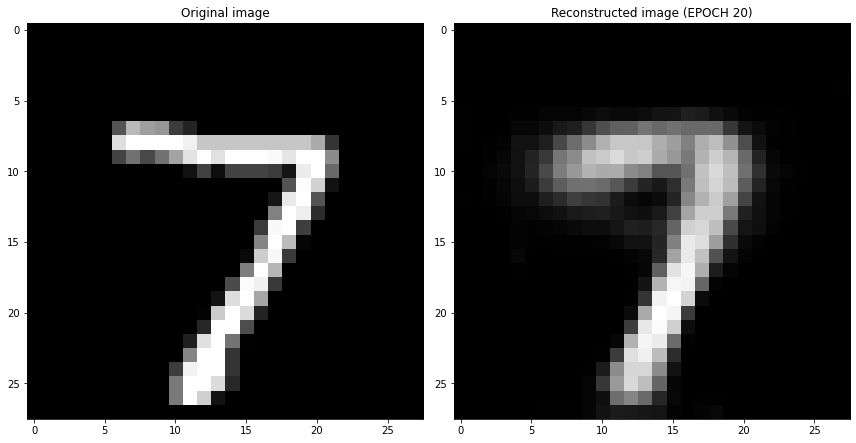

EPOCH 21/30
	 partial train loss (single batch): 0.042574
	 partial train loss (single batch): 0.040677
	 partial train loss (single batch): 0.040908
	 partial train loss (single batch): 0.041700
	 partial train loss (single batch): 0.041229
	 partial train loss (single batch): 0.042743
	 partial train loss (single batch): 0.042571
	 partial train loss (single batch): 0.040956
	 partial train loss (single batch): 0.041572
	 partial train loss (single batch): 0.041785
	 partial train loss (single batch): 0.041687
	 partial train loss (single batch): 0.043516
	 partial train loss (single batch): 0.043369
	 partial train loss (single batch): 0.041175
	 partial train loss (single batch): 0.042159
	 partial train loss (single batch): 0.041371
	 partial train loss (single batch): 0.041443
	 partial train loss (single batch): 0.041903
	 partial train loss (single batch): 0.041248
	 partial train loss (single batch): 0.043885
	 partial train loss (single batch): 0.041760
	 partial train loss (

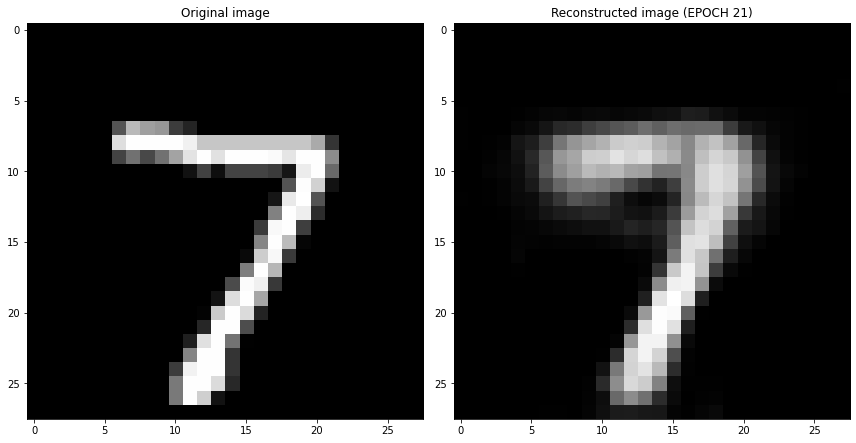

EPOCH 22/30
	 partial train loss (single batch): 0.041887
	 partial train loss (single batch): 0.040987
	 partial train loss (single batch): 0.041348
	 partial train loss (single batch): 0.040309
	 partial train loss (single batch): 0.042081
	 partial train loss (single batch): 0.041689
	 partial train loss (single batch): 0.040544
	 partial train loss (single batch): 0.043151
	 partial train loss (single batch): 0.040147
	 partial train loss (single batch): 0.042852
	 partial train loss (single batch): 0.043388
	 partial train loss (single batch): 0.041918
	 partial train loss (single batch): 0.043460
	 partial train loss (single batch): 0.041853
	 partial train loss (single batch): 0.042406
	 partial train loss (single batch): 0.041763
	 partial train loss (single batch): 0.042373
	 partial train loss (single batch): 0.041342
	 partial train loss (single batch): 0.040601
	 partial train loss (single batch): 0.040149
	 partial train loss (single batch): 0.042475
	 partial train loss (

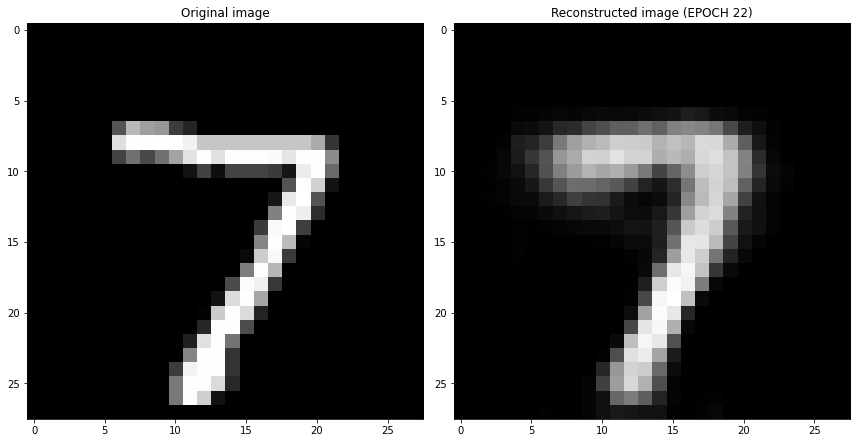

EPOCH 23/30
	 partial train loss (single batch): 0.040774
	 partial train loss (single batch): 0.041487
	 partial train loss (single batch): 0.042213
	 partial train loss (single batch): 0.043798
	 partial train loss (single batch): 0.042569
	 partial train loss (single batch): 0.039488
	 partial train loss (single batch): 0.040843
	 partial train loss (single batch): 0.042255
	 partial train loss (single batch): 0.040487
	 partial train loss (single batch): 0.039662
	 partial train loss (single batch): 0.040907
	 partial train loss (single batch): 0.041686
	 partial train loss (single batch): 0.041612
	 partial train loss (single batch): 0.038375
	 partial train loss (single batch): 0.039779
	 partial train loss (single batch): 0.044198
	 partial train loss (single batch): 0.038762
	 partial train loss (single batch): 0.041624
	 partial train loss (single batch): 0.042442
	 partial train loss (single batch): 0.042844
	 partial train loss (single batch): 0.040791
	 partial train loss (

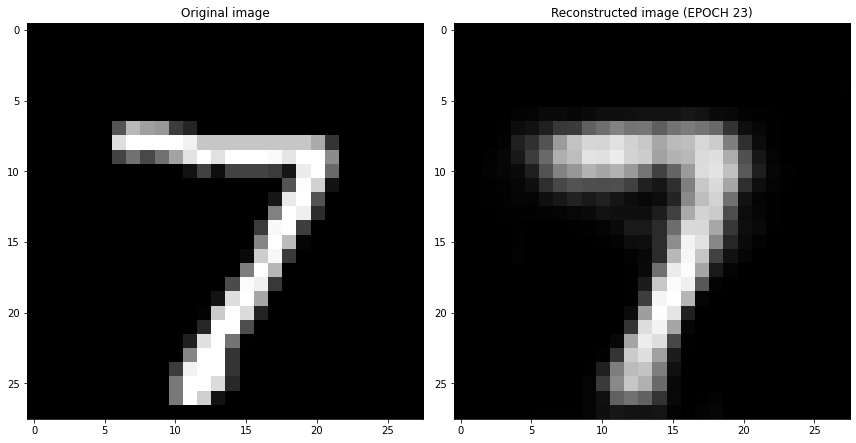

EPOCH 24/30
	 partial train loss (single batch): 0.039822
	 partial train loss (single batch): 0.040300
	 partial train loss (single batch): 0.040384
	 partial train loss (single batch): 0.041950
	 partial train loss (single batch): 0.040677
	 partial train loss (single batch): 0.043288
	 partial train loss (single batch): 0.039654
	 partial train loss (single batch): 0.041401
	 partial train loss (single batch): 0.042442
	 partial train loss (single batch): 0.040127
	 partial train loss (single batch): 0.040468
	 partial train loss (single batch): 0.041073
	 partial train loss (single batch): 0.042937
	 partial train loss (single batch): 0.039415
	 partial train loss (single batch): 0.041926
	 partial train loss (single batch): 0.041523
	 partial train loss (single batch): 0.042227
	 partial train loss (single batch): 0.041386
	 partial train loss (single batch): 0.041371
	 partial train loss (single batch): 0.041404
	 partial train loss (single batch): 0.040809
	 partial train loss (

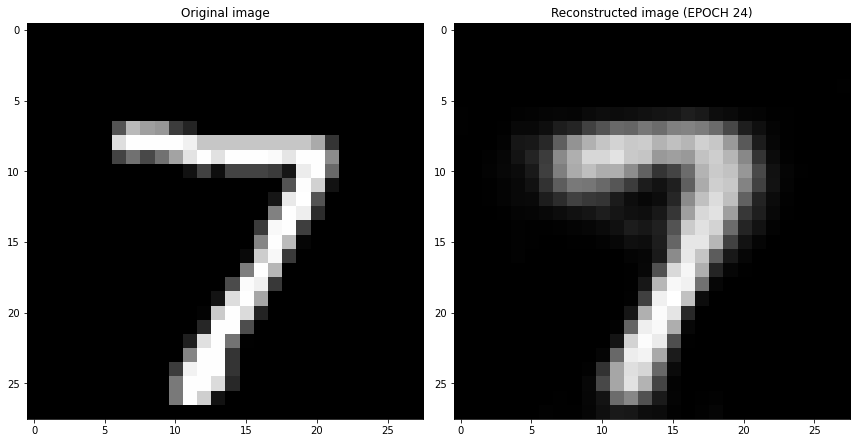

EPOCH 25/30
	 partial train loss (single batch): 0.040700
	 partial train loss (single batch): 0.041204
	 partial train loss (single batch): 0.039628
	 partial train loss (single batch): 0.039268
	 partial train loss (single batch): 0.039004
	 partial train loss (single batch): 0.041249
	 partial train loss (single batch): 0.043284
	 partial train loss (single batch): 0.038789
	 partial train loss (single batch): 0.040630
	 partial train loss (single batch): 0.041536
	 partial train loss (single batch): 0.041022
	 partial train loss (single batch): 0.041051
	 partial train loss (single batch): 0.040278
	 partial train loss (single batch): 0.040974
	 partial train loss (single batch): 0.039843
	 partial train loss (single batch): 0.040079
	 partial train loss (single batch): 0.042894
	 partial train loss (single batch): 0.042200
	 partial train loss (single batch): 0.039431
	 partial train loss (single batch): 0.041501
	 partial train loss (single batch): 0.041193
	 partial train loss (

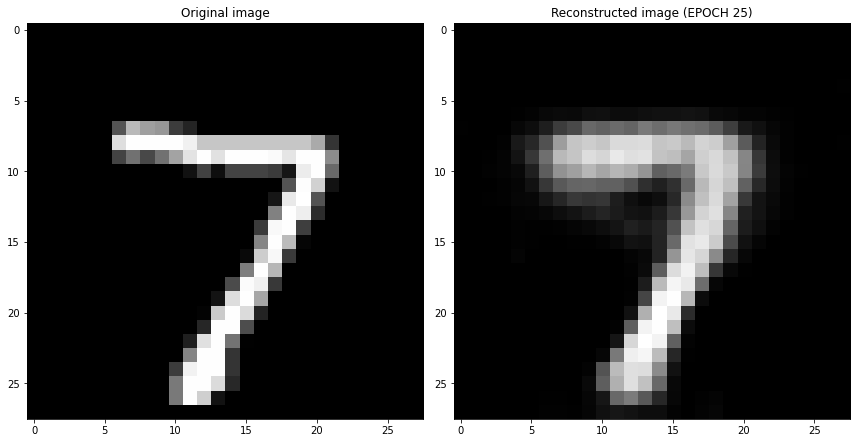

EPOCH 26/30
	 partial train loss (single batch): 0.040385
	 partial train loss (single batch): 0.040246
	 partial train loss (single batch): 0.040240
	 partial train loss (single batch): 0.039734
	 partial train loss (single batch): 0.041871
	 partial train loss (single batch): 0.040963
	 partial train loss (single batch): 0.042907
	 partial train loss (single batch): 0.041612
	 partial train loss (single batch): 0.039420
	 partial train loss (single batch): 0.041212
	 partial train loss (single batch): 0.040080
	 partial train loss (single batch): 0.040058
	 partial train loss (single batch): 0.043456
	 partial train loss (single batch): 0.041294
	 partial train loss (single batch): 0.041865
	 partial train loss (single batch): 0.040566
	 partial train loss (single batch): 0.040223
	 partial train loss (single batch): 0.038484
	 partial train loss (single batch): 0.041894
	 partial train loss (single batch): 0.039970
	 partial train loss (single batch): 0.042172
	 partial train loss (

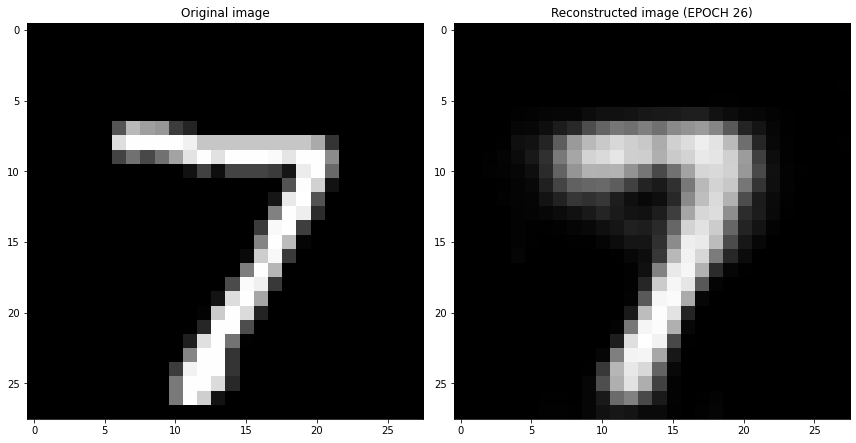

EPOCH 27/30
	 partial train loss (single batch): 0.040797
	 partial train loss (single batch): 0.041804
	 partial train loss (single batch): 0.040016
	 partial train loss (single batch): 0.042929
	 partial train loss (single batch): 0.040076
	 partial train loss (single batch): 0.040718
	 partial train loss (single batch): 0.040831
	 partial train loss (single batch): 0.042678
	 partial train loss (single batch): 0.043025
	 partial train loss (single batch): 0.041506
	 partial train loss (single batch): 0.040996
	 partial train loss (single batch): 0.041829
	 partial train loss (single batch): 0.038857
	 partial train loss (single batch): 0.041846
	 partial train loss (single batch): 0.040302
	 partial train loss (single batch): 0.039476
	 partial train loss (single batch): 0.039451
	 partial train loss (single batch): 0.040165
	 partial train loss (single batch): 0.040169
	 partial train loss (single batch): 0.039633
	 partial train loss (single batch): 0.040631
	 partial train loss (

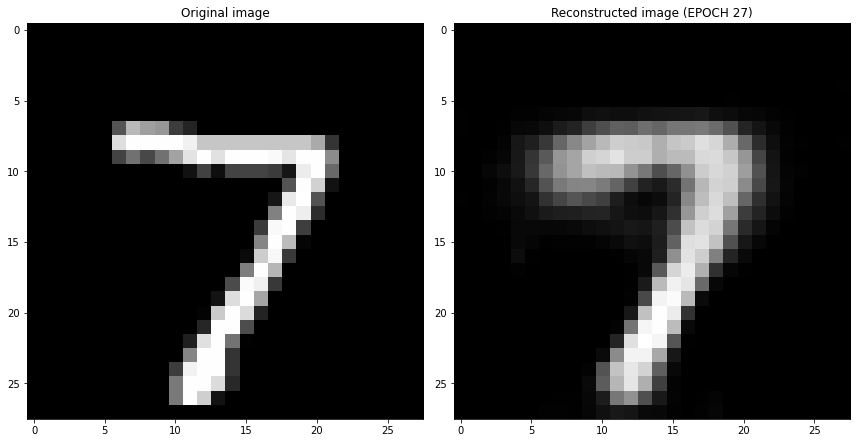

EPOCH 28/30
	 partial train loss (single batch): 0.040732
	 partial train loss (single batch): 0.041066
	 partial train loss (single batch): 0.042856
	 partial train loss (single batch): 0.040945
	 partial train loss (single batch): 0.040160
	 partial train loss (single batch): 0.042799
	 partial train loss (single batch): 0.039207
	 partial train loss (single batch): 0.040046
	 partial train loss (single batch): 0.039340
	 partial train loss (single batch): 0.039619
	 partial train loss (single batch): 0.041992
	 partial train loss (single batch): 0.041771
	 partial train loss (single batch): 0.039112
	 partial train loss (single batch): 0.040227
	 partial train loss (single batch): 0.041042
	 partial train loss (single batch): 0.040929
	 partial train loss (single batch): 0.039195
	 partial train loss (single batch): 0.040800
	 partial train loss (single batch): 0.039454
	 partial train loss (single batch): 0.039798
	 partial train loss (single batch): 0.039590
	 partial train loss (

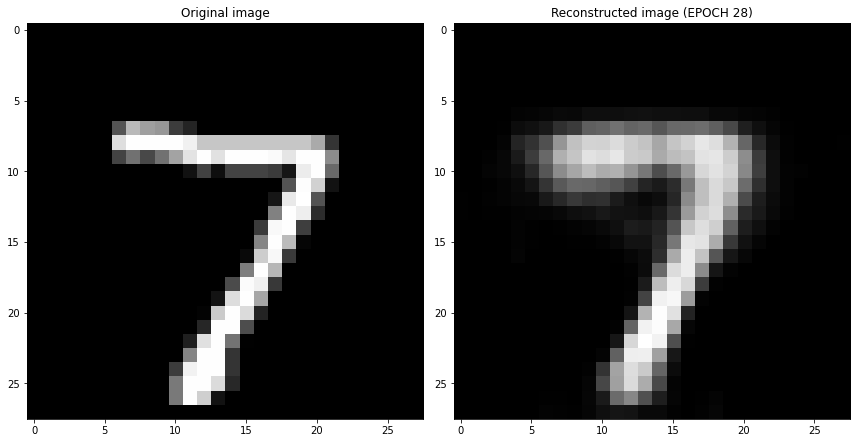

EPOCH 29/30
	 partial train loss (single batch): 0.042318
	 partial train loss (single batch): 0.039276
	 partial train loss (single batch): 0.040175
	 partial train loss (single batch): 0.041795
	 partial train loss (single batch): 0.038411
	 partial train loss (single batch): 0.039687
	 partial train loss (single batch): 0.041071
	 partial train loss (single batch): 0.041312
	 partial train loss (single batch): 0.040163
	 partial train loss (single batch): 0.040161
	 partial train loss (single batch): 0.038862
	 partial train loss (single batch): 0.037805
	 partial train loss (single batch): 0.042012
	 partial train loss (single batch): 0.037819
	 partial train loss (single batch): 0.040407
	 partial train loss (single batch): 0.040115
	 partial train loss (single batch): 0.039573
	 partial train loss (single batch): 0.039566
	 partial train loss (single batch): 0.039923
	 partial train loss (single batch): 0.039457
	 partial train loss (single batch): 0.041557
	 partial train loss (

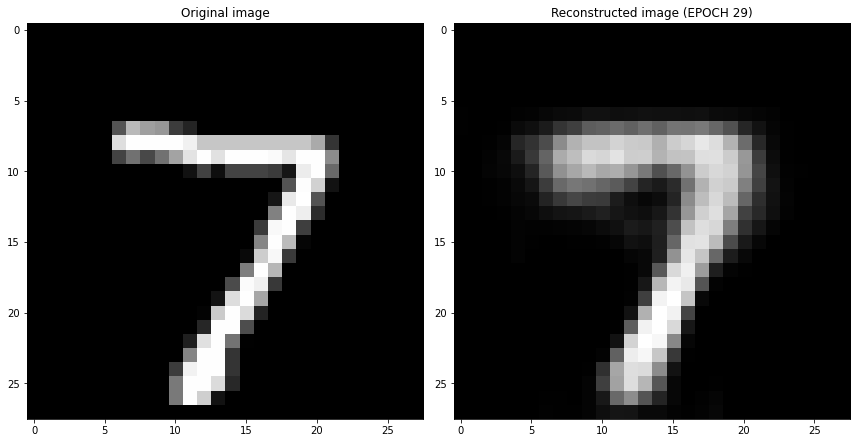

EPOCH 30/30
	 partial train loss (single batch): 0.041575
	 partial train loss (single batch): 0.040655
	 partial train loss (single batch): 0.041057
	 partial train loss (single batch): 0.038365
	 partial train loss (single batch): 0.041580
	 partial train loss (single batch): 0.039697
	 partial train loss (single batch): 0.039704
	 partial train loss (single batch): 0.040466
	 partial train loss (single batch): 0.039748
	 partial train loss (single batch): 0.042032
	 partial train loss (single batch): 0.038205
	 partial train loss (single batch): 0.042108
	 partial train loss (single batch): 0.041060
	 partial train loss (single batch): 0.039813
	 partial train loss (single batch): 0.041667
	 partial train loss (single batch): 0.041717
	 partial train loss (single batch): 0.040897
	 partial train loss (single batch): 0.040978
	 partial train loss (single batch): 0.040003
	 partial train loss (single batch): 0.040104
	 partial train loss (single batch): 0.040091
	 partial train loss (

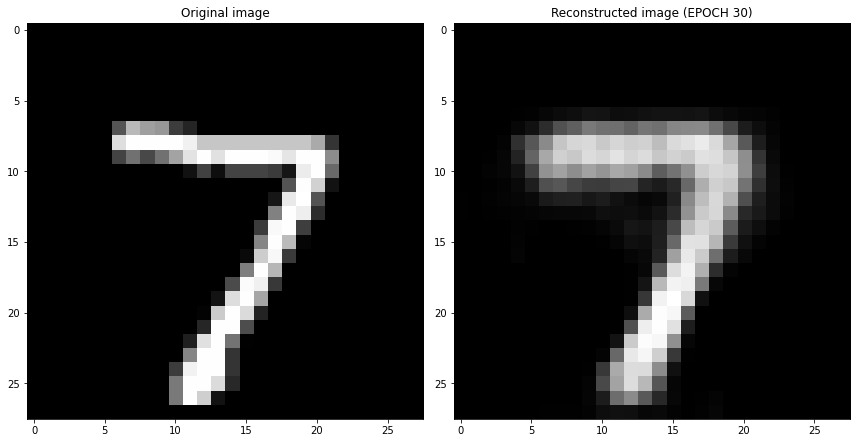

Cross validation fold number= 4/6
EPOCH 1/30
	 partial train loss (single batch): 0.251164
	 partial train loss (single batch): 0.249901
	 partial train loss (single batch): 0.249701
	 partial train loss (single batch): 0.248672
	 partial train loss (single batch): 0.248056
	 partial train loss (single batch): 0.247174
	 partial train loss (single batch): 0.246975
	 partial train loss (single batch): 0.245671
	 partial train loss (single batch): 0.246031
	 partial train loss (single batch): 0.243845
	 partial train loss (single batch): 0.243935
	 partial train loss (single batch): 0.241625
	 partial train loss (single batch): 0.240239
	 partial train loss (single batch): 0.238727
	 partial train loss (single batch): 0.236450
	 partial train loss (single batch): 0.233816
	 partial train loss (single batch): 0.230708
	 partial train loss (single batch): 0.227020
	 partial train loss (single batch): 0.222728
	 partial train loss (single batch): 0.216649
	 partial train loss (single batch)

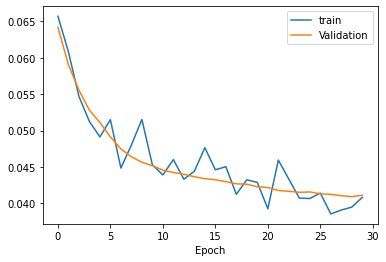

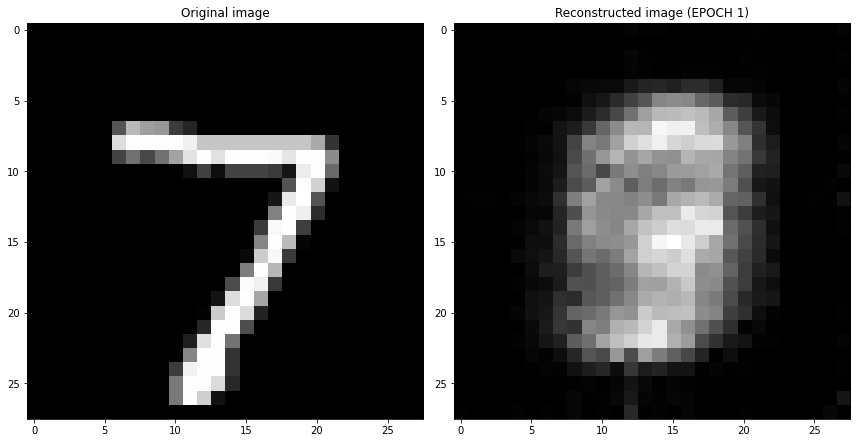

EPOCH 2/30
	 partial train loss (single batch): 0.066553
	 partial train loss (single batch): 0.063808
	 partial train loss (single batch): 0.066734
	 partial train loss (single batch): 0.064702
	 partial train loss (single batch): 0.063595
	 partial train loss (single batch): 0.064006
	 partial train loss (single batch): 0.063202
	 partial train loss (single batch): 0.066250
	 partial train loss (single batch): 0.066038
	 partial train loss (single batch): 0.064167
	 partial train loss (single batch): 0.064861
	 partial train loss (single batch): 0.065377
	 partial train loss (single batch): 0.064007
	 partial train loss (single batch): 0.065910
	 partial train loss (single batch): 0.066430
	 partial train loss (single batch): 0.064860
	 partial train loss (single batch): 0.064397
	 partial train loss (single batch): 0.066720
	 partial train loss (single batch): 0.064346
	 partial train loss (single batch): 0.065049
	 partial train loss (single batch): 0.065220
	 partial train loss (s

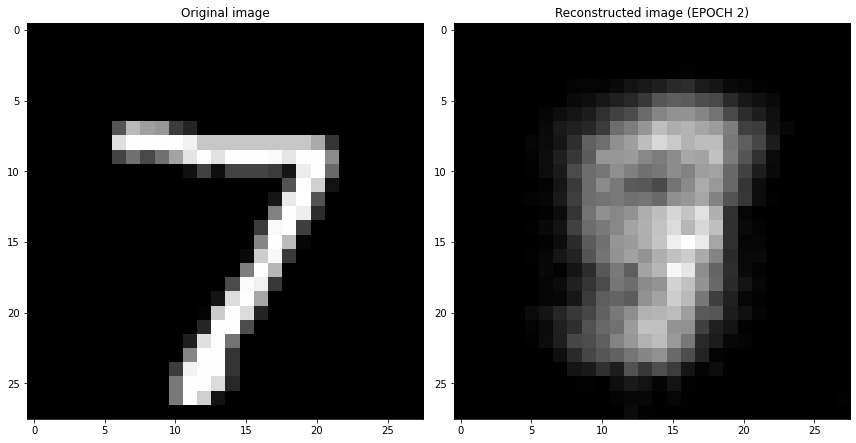

EPOCH 3/30
	 partial train loss (single batch): 0.058947
	 partial train loss (single batch): 0.057801
	 partial train loss (single batch): 0.058710
	 partial train loss (single batch): 0.057378
	 partial train loss (single batch): 0.058692
	 partial train loss (single batch): 0.057590
	 partial train loss (single batch): 0.058756
	 partial train loss (single batch): 0.060443
	 partial train loss (single batch): 0.057058
	 partial train loss (single batch): 0.058746
	 partial train loss (single batch): 0.059035
	 partial train loss (single batch): 0.056472
	 partial train loss (single batch): 0.060516
	 partial train loss (single batch): 0.058400
	 partial train loss (single batch): 0.058075
	 partial train loss (single batch): 0.058083
	 partial train loss (single batch): 0.059256
	 partial train loss (single batch): 0.058145
	 partial train loss (single batch): 0.058402
	 partial train loss (single batch): 0.059623
	 partial train loss (single batch): 0.057927
	 partial train loss (s

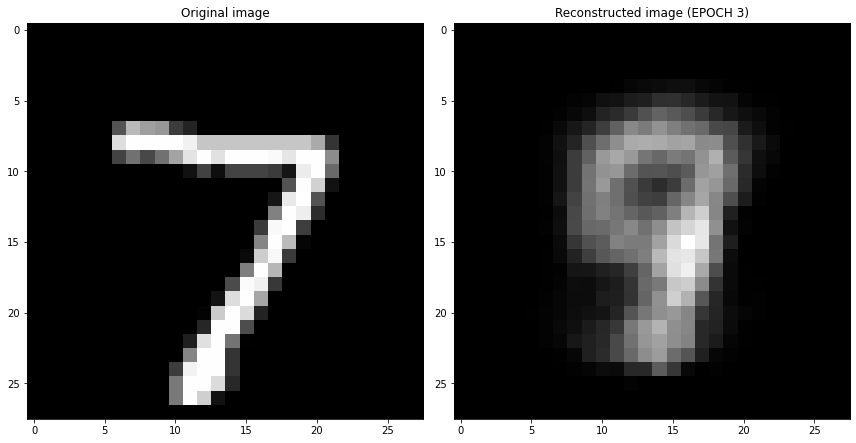

EPOCH 4/30
	 partial train loss (single batch): 0.056715
	 partial train loss (single batch): 0.054751
	 partial train loss (single batch): 0.055955
	 partial train loss (single batch): 0.055619
	 partial train loss (single batch): 0.056283
	 partial train loss (single batch): 0.057970
	 partial train loss (single batch): 0.055313
	 partial train loss (single batch): 0.055423
	 partial train loss (single batch): 0.055426
	 partial train loss (single batch): 0.053494
	 partial train loss (single batch): 0.054522
	 partial train loss (single batch): 0.053445
	 partial train loss (single batch): 0.057036
	 partial train loss (single batch): 0.057276
	 partial train loss (single batch): 0.055193
	 partial train loss (single batch): 0.057663
	 partial train loss (single batch): 0.055543
	 partial train loss (single batch): 0.056563
	 partial train loss (single batch): 0.055347
	 partial train loss (single batch): 0.056459
	 partial train loss (single batch): 0.054536
	 partial train loss (s

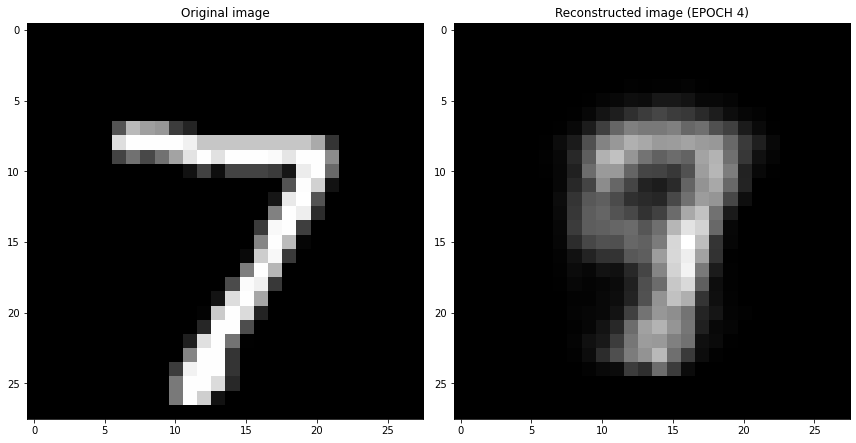

EPOCH 5/30
	 partial train loss (single batch): 0.053937
	 partial train loss (single batch): 0.054257
	 partial train loss (single batch): 0.055966
	 partial train loss (single batch): 0.053774
	 partial train loss (single batch): 0.053578
	 partial train loss (single batch): 0.056282
	 partial train loss (single batch): 0.054297
	 partial train loss (single batch): 0.053341
	 partial train loss (single batch): 0.051914
	 partial train loss (single batch): 0.053097
	 partial train loss (single batch): 0.052449
	 partial train loss (single batch): 0.054432
	 partial train loss (single batch): 0.053445
	 partial train loss (single batch): 0.052256
	 partial train loss (single batch): 0.052719
	 partial train loss (single batch): 0.054488
	 partial train loss (single batch): 0.053371
	 partial train loss (single batch): 0.050851
	 partial train loss (single batch): 0.054939
	 partial train loss (single batch): 0.055525
	 partial train loss (single batch): 0.053662
	 partial train loss (s

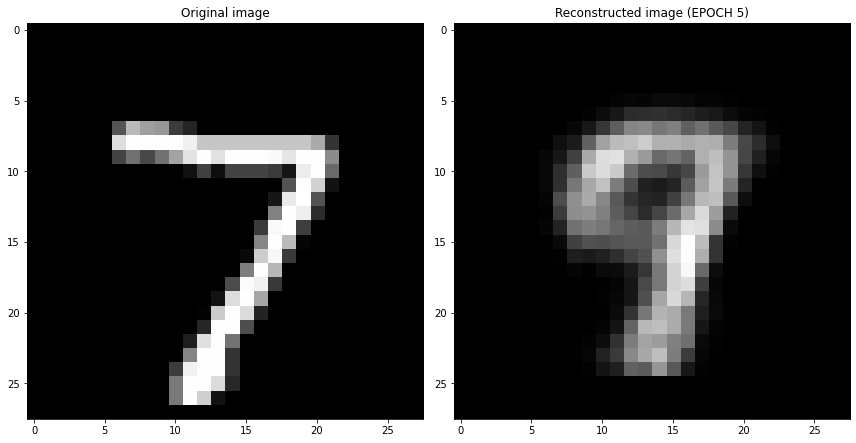

EPOCH 6/30
	 partial train loss (single batch): 0.054403
	 partial train loss (single batch): 0.051993
	 partial train loss (single batch): 0.050730
	 partial train loss (single batch): 0.050199
	 partial train loss (single batch): 0.052145
	 partial train loss (single batch): 0.052462
	 partial train loss (single batch): 0.053427
	 partial train loss (single batch): 0.051507
	 partial train loss (single batch): 0.052034
	 partial train loss (single batch): 0.051894
	 partial train loss (single batch): 0.053537
	 partial train loss (single batch): 0.051703
	 partial train loss (single batch): 0.053241
	 partial train loss (single batch): 0.053197
	 partial train loss (single batch): 0.051342
	 partial train loss (single batch): 0.053620
	 partial train loss (single batch): 0.051273
	 partial train loss (single batch): 0.051282
	 partial train loss (single batch): 0.049898
	 partial train loss (single batch): 0.052882
	 partial train loss (single batch): 0.054249
	 partial train loss (s

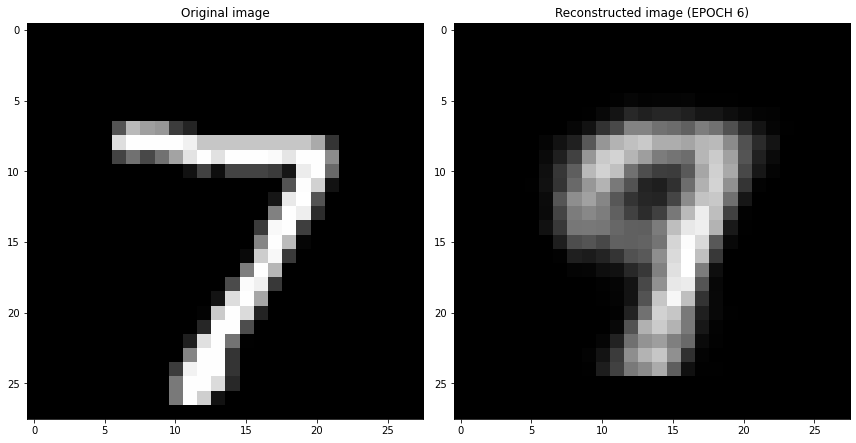

EPOCH 7/30
	 partial train loss (single batch): 0.050731
	 partial train loss (single batch): 0.048347
	 partial train loss (single batch): 0.050159
	 partial train loss (single batch): 0.050501
	 partial train loss (single batch): 0.053299
	 partial train loss (single batch): 0.051681
	 partial train loss (single batch): 0.052123
	 partial train loss (single batch): 0.050903
	 partial train loss (single batch): 0.052388
	 partial train loss (single batch): 0.050649
	 partial train loss (single batch): 0.051849
	 partial train loss (single batch): 0.050351
	 partial train loss (single batch): 0.052031
	 partial train loss (single batch): 0.050458
	 partial train loss (single batch): 0.052141
	 partial train loss (single batch): 0.052408
	 partial train loss (single batch): 0.050400
	 partial train loss (single batch): 0.051266
	 partial train loss (single batch): 0.050152
	 partial train loss (single batch): 0.050167
	 partial train loss (single batch): 0.051810
	 partial train loss (s

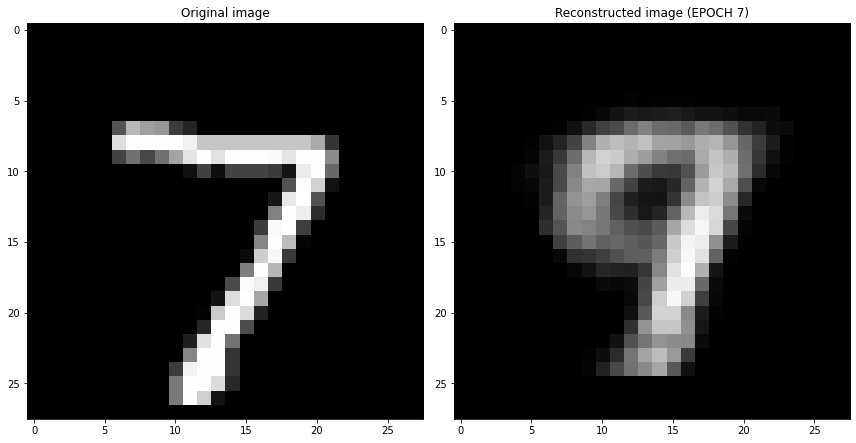

EPOCH 8/30
	 partial train loss (single batch): 0.049692
	 partial train loss (single batch): 0.048719
	 partial train loss (single batch): 0.051754
	 partial train loss (single batch): 0.050210
	 partial train loss (single batch): 0.048932
	 partial train loss (single batch): 0.050278
	 partial train loss (single batch): 0.049236
	 partial train loss (single batch): 0.050796
	 partial train loss (single batch): 0.050850
	 partial train loss (single batch): 0.049601
	 partial train loss (single batch): 0.049832
	 partial train loss (single batch): 0.048343
	 partial train loss (single batch): 0.050301
	 partial train loss (single batch): 0.047233
	 partial train loss (single batch): 0.048383
	 partial train loss (single batch): 0.050179
	 partial train loss (single batch): 0.048971
	 partial train loss (single batch): 0.048615
	 partial train loss (single batch): 0.048922
	 partial train loss (single batch): 0.049902
	 partial train loss (single batch): 0.050864
	 partial train loss (s

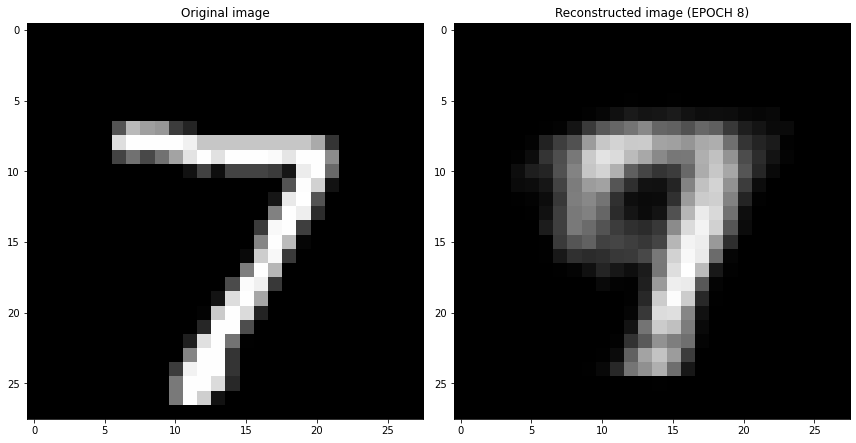

EPOCH 9/30
	 partial train loss (single batch): 0.046115
	 partial train loss (single batch): 0.047641
	 partial train loss (single batch): 0.047979
	 partial train loss (single batch): 0.047702
	 partial train loss (single batch): 0.047157
	 partial train loss (single batch): 0.049107
	 partial train loss (single batch): 0.046588
	 partial train loss (single batch): 0.047282
	 partial train loss (single batch): 0.046456
	 partial train loss (single batch): 0.046626
	 partial train loss (single batch): 0.048060
	 partial train loss (single batch): 0.047159
	 partial train loss (single batch): 0.044753
	 partial train loss (single batch): 0.048428
	 partial train loss (single batch): 0.044995
	 partial train loss (single batch): 0.049400
	 partial train loss (single batch): 0.049923
	 partial train loss (single batch): 0.049837
	 partial train loss (single batch): 0.048864
	 partial train loss (single batch): 0.049868
	 partial train loss (single batch): 0.047017
	 partial train loss (s

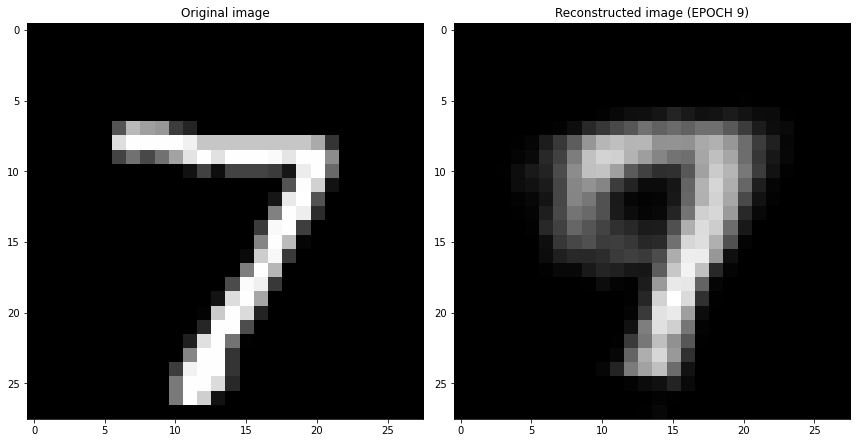

EPOCH 10/30
	 partial train loss (single batch): 0.047292
	 partial train loss (single batch): 0.045370
	 partial train loss (single batch): 0.047999
	 partial train loss (single batch): 0.048036
	 partial train loss (single batch): 0.046358
	 partial train loss (single batch): 0.046326
	 partial train loss (single batch): 0.044474
	 partial train loss (single batch): 0.044310
	 partial train loss (single batch): 0.045652
	 partial train loss (single batch): 0.046546
	 partial train loss (single batch): 0.045291
	 partial train loss (single batch): 0.048652
	 partial train loss (single batch): 0.046876
	 partial train loss (single batch): 0.047051
	 partial train loss (single batch): 0.044482
	 partial train loss (single batch): 0.044687
	 partial train loss (single batch): 0.047851
	 partial train loss (single batch): 0.047774
	 partial train loss (single batch): 0.046206
	 partial train loss (single batch): 0.046372
	 partial train loss (single batch): 0.045103
	 partial train loss (

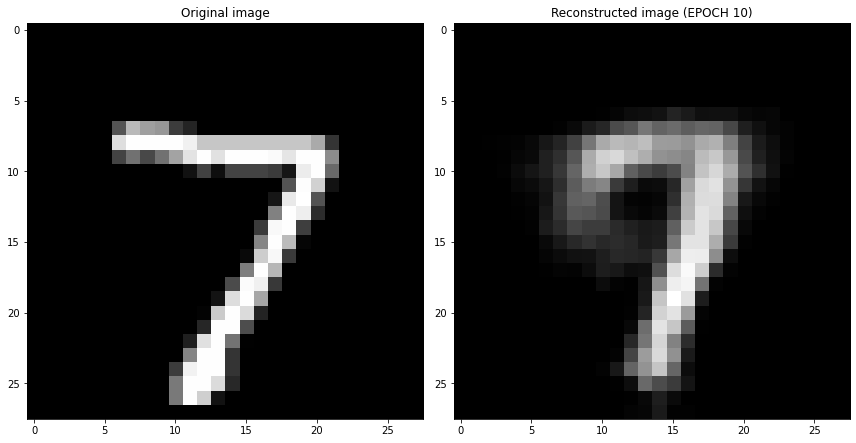

EPOCH 11/30
	 partial train loss (single batch): 0.044935
	 partial train loss (single batch): 0.044048
	 partial train loss (single batch): 0.046126
	 partial train loss (single batch): 0.045438
	 partial train loss (single batch): 0.043843
	 partial train loss (single batch): 0.044017
	 partial train loss (single batch): 0.043841
	 partial train loss (single batch): 0.044083
	 partial train loss (single batch): 0.044395
	 partial train loss (single batch): 0.046364
	 partial train loss (single batch): 0.046058
	 partial train loss (single batch): 0.042311
	 partial train loss (single batch): 0.044881
	 partial train loss (single batch): 0.042567
	 partial train loss (single batch): 0.043883
	 partial train loss (single batch): 0.044832
	 partial train loss (single batch): 0.045758
	 partial train loss (single batch): 0.045501
	 partial train loss (single batch): 0.045552
	 partial train loss (single batch): 0.045212
	 partial train loss (single batch): 0.045358
	 partial train loss (

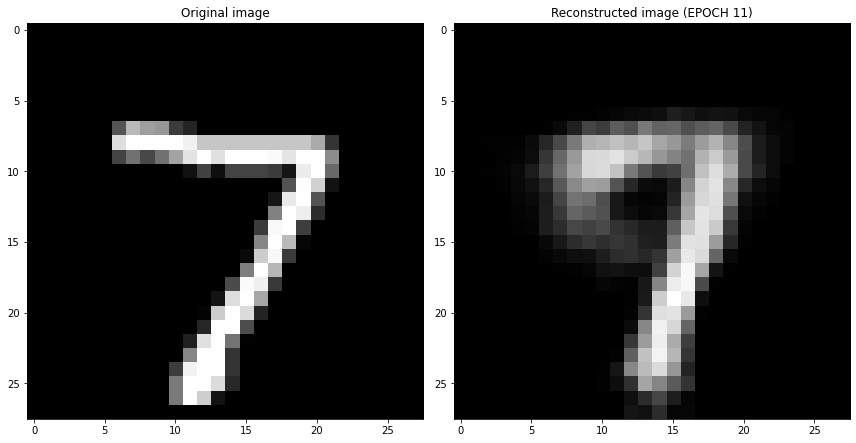

EPOCH 12/30
	 partial train loss (single batch): 0.043862
	 partial train loss (single batch): 0.044536
	 partial train loss (single batch): 0.043237
	 partial train loss (single batch): 0.042667
	 partial train loss (single batch): 0.044815
	 partial train loss (single batch): 0.044328
	 partial train loss (single batch): 0.043305
	 partial train loss (single batch): 0.045873
	 partial train loss (single batch): 0.043129
	 partial train loss (single batch): 0.045391
	 partial train loss (single batch): 0.046372
	 partial train loss (single batch): 0.044492
	 partial train loss (single batch): 0.044431
	 partial train loss (single batch): 0.043928
	 partial train loss (single batch): 0.044165
	 partial train loss (single batch): 0.045352
	 partial train loss (single batch): 0.044706
	 partial train loss (single batch): 0.043957
	 partial train loss (single batch): 0.046389
	 partial train loss (single batch): 0.043256
	 partial train loss (single batch): 0.042664
	 partial train loss (

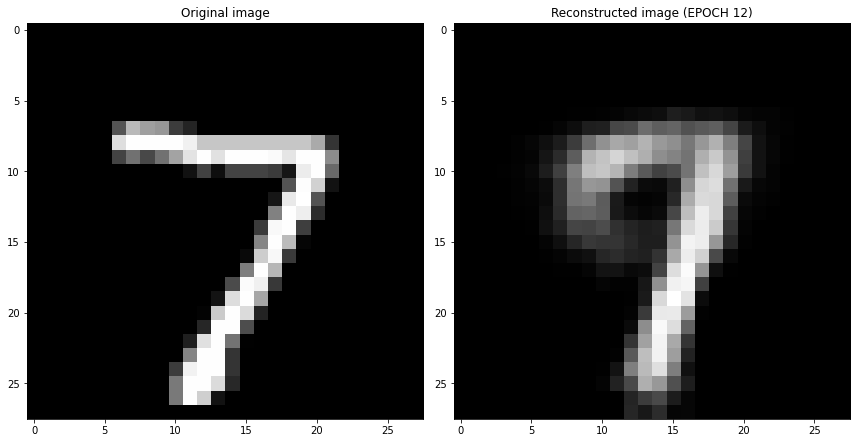

EPOCH 13/30
	 partial train loss (single batch): 0.043442
	 partial train loss (single batch): 0.043077
	 partial train loss (single batch): 0.042721
	 partial train loss (single batch): 0.044495
	 partial train loss (single batch): 0.043523
	 partial train loss (single batch): 0.043122
	 partial train loss (single batch): 0.044765
	 partial train loss (single batch): 0.043738
	 partial train loss (single batch): 0.045099
	 partial train loss (single batch): 0.042522
	 partial train loss (single batch): 0.043668
	 partial train loss (single batch): 0.042993
	 partial train loss (single batch): 0.042735
	 partial train loss (single batch): 0.042382
	 partial train loss (single batch): 0.044601
	 partial train loss (single batch): 0.043126
	 partial train loss (single batch): 0.044502
	 partial train loss (single batch): 0.044323
	 partial train loss (single batch): 0.042945
	 partial train loss (single batch): 0.043333
	 partial train loss (single batch): 0.043779
	 partial train loss (

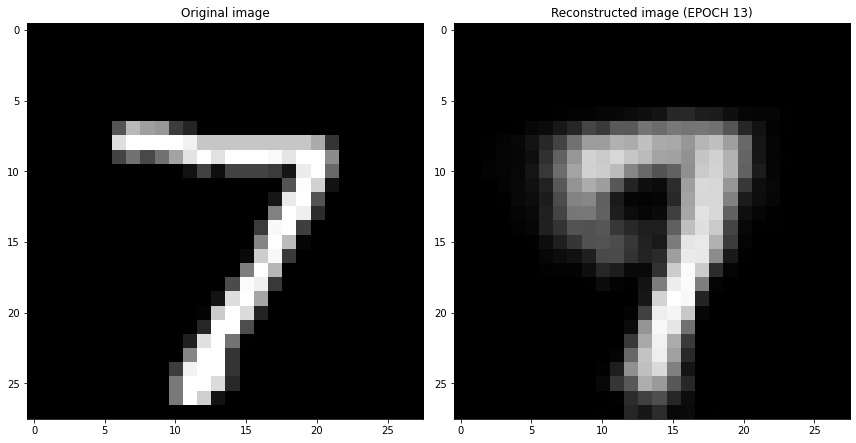

EPOCH 14/30
	 partial train loss (single batch): 0.042571
	 partial train loss (single batch): 0.043038
	 partial train loss (single batch): 0.044287
	 partial train loss (single batch): 0.044500
	 partial train loss (single batch): 0.043511
	 partial train loss (single batch): 0.041694
	 partial train loss (single batch): 0.042211
	 partial train loss (single batch): 0.043706
	 partial train loss (single batch): 0.045197
	 partial train loss (single batch): 0.043690
	 partial train loss (single batch): 0.042249
	 partial train loss (single batch): 0.041266
	 partial train loss (single batch): 0.044630
	 partial train loss (single batch): 0.042398
	 partial train loss (single batch): 0.041703
	 partial train loss (single batch): 0.042732
	 partial train loss (single batch): 0.043033
	 partial train loss (single batch): 0.042105
	 partial train loss (single batch): 0.044917
	 partial train loss (single batch): 0.044153
	 partial train loss (single batch): 0.042069
	 partial train loss (

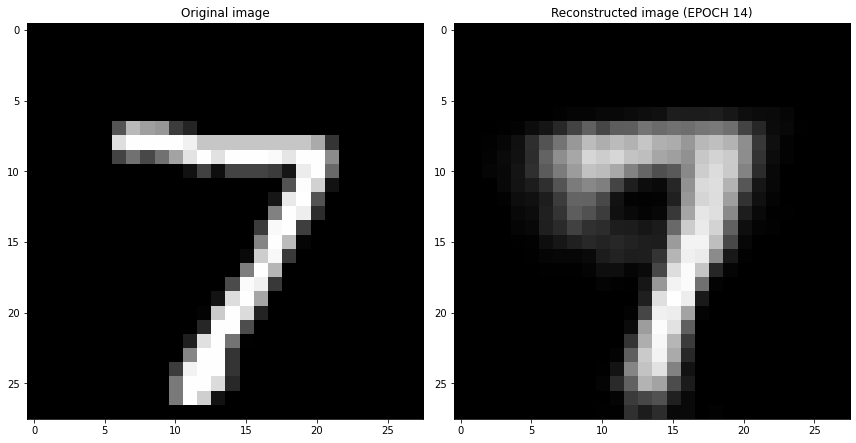

EPOCH 15/30
	 partial train loss (single batch): 0.042147
	 partial train loss (single batch): 0.042210
	 partial train loss (single batch): 0.042908
	 partial train loss (single batch): 0.042312
	 partial train loss (single batch): 0.041138
	 partial train loss (single batch): 0.041933
	 partial train loss (single batch): 0.041465
	 partial train loss (single batch): 0.041300
	 partial train loss (single batch): 0.042784
	 partial train loss (single batch): 0.043085
	 partial train loss (single batch): 0.043973
	 partial train loss (single batch): 0.041026
	 partial train loss (single batch): 0.042191
	 partial train loss (single batch): 0.043117
	 partial train loss (single batch): 0.043267
	 partial train loss (single batch): 0.043129
	 partial train loss (single batch): 0.041601
	 partial train loss (single batch): 0.042491
	 partial train loss (single batch): 0.044790
	 partial train loss (single batch): 0.041657
	 partial train loss (single batch): 0.043767
	 partial train loss (

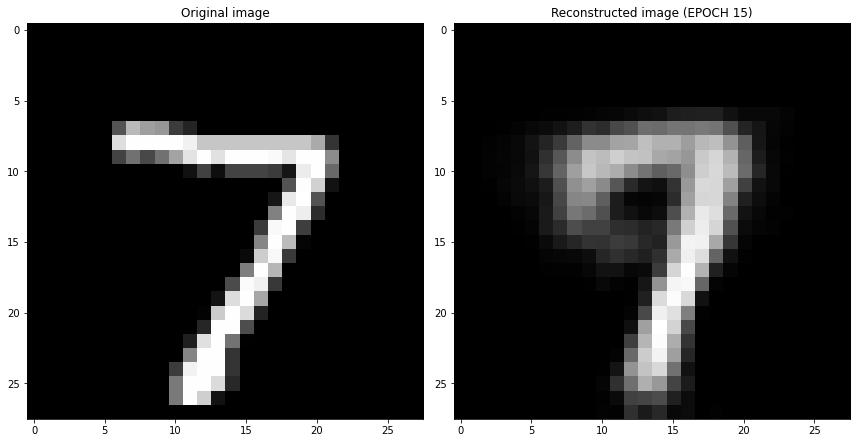

EPOCH 16/30
	 partial train loss (single batch): 0.040816
	 partial train loss (single batch): 0.042537
	 partial train loss (single batch): 0.042694
	 partial train loss (single batch): 0.044900
	 partial train loss (single batch): 0.042989
	 partial train loss (single batch): 0.041186
	 partial train loss (single batch): 0.043067
	 partial train loss (single batch): 0.043168
	 partial train loss (single batch): 0.042308
	 partial train loss (single batch): 0.041493
	 partial train loss (single batch): 0.042588
	 partial train loss (single batch): 0.040260
	 partial train loss (single batch): 0.040699
	 partial train loss (single batch): 0.043792
	 partial train loss (single batch): 0.042663
	 partial train loss (single batch): 0.045403
	 partial train loss (single batch): 0.042805
	 partial train loss (single batch): 0.041161
	 partial train loss (single batch): 0.041788
	 partial train loss (single batch): 0.042164
	 partial train loss (single batch): 0.043492
	 partial train loss (

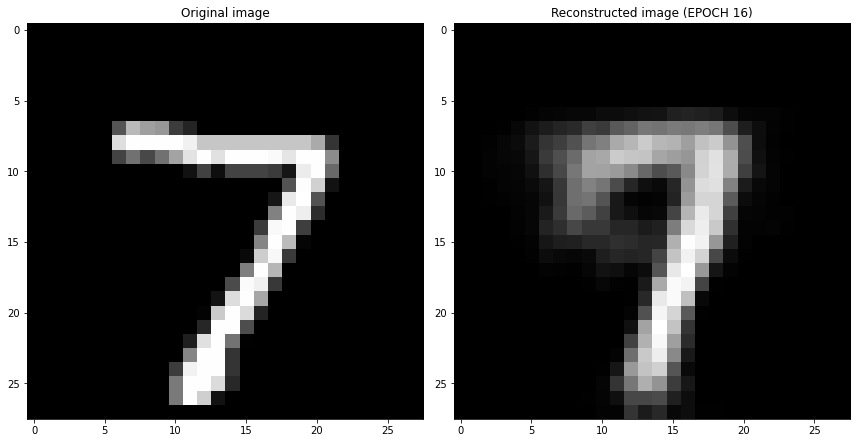

EPOCH 17/30
	 partial train loss (single batch): 0.042001
	 partial train loss (single batch): 0.042457
	 partial train loss (single batch): 0.042093
	 partial train loss (single batch): 0.041294
	 partial train loss (single batch): 0.040296
	 partial train loss (single batch): 0.040631
	 partial train loss (single batch): 0.039072
	 partial train loss (single batch): 0.045212
	 partial train loss (single batch): 0.040733
	 partial train loss (single batch): 0.041684
	 partial train loss (single batch): 0.043346
	 partial train loss (single batch): 0.040877
	 partial train loss (single batch): 0.042215
	 partial train loss (single batch): 0.040862
	 partial train loss (single batch): 0.042140
	 partial train loss (single batch): 0.044232
	 partial train loss (single batch): 0.042629
	 partial train loss (single batch): 0.042266
	 partial train loss (single batch): 0.040990
	 partial train loss (single batch): 0.041685
	 partial train loss (single batch): 0.041062
	 partial train loss (

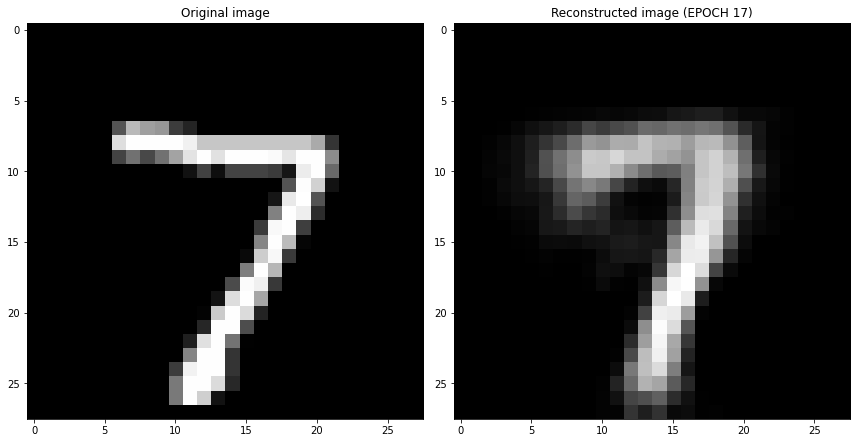

EPOCH 18/30
	 partial train loss (single batch): 0.042593
	 partial train loss (single batch): 0.044090
	 partial train loss (single batch): 0.043489
	 partial train loss (single batch): 0.041430
	 partial train loss (single batch): 0.041271
	 partial train loss (single batch): 0.042275
	 partial train loss (single batch): 0.042361
	 partial train loss (single batch): 0.041296
	 partial train loss (single batch): 0.042417
	 partial train loss (single batch): 0.039737
	 partial train loss (single batch): 0.042195
	 partial train loss (single batch): 0.041616
	 partial train loss (single batch): 0.041623
	 partial train loss (single batch): 0.040873
	 partial train loss (single batch): 0.042271
	 partial train loss (single batch): 0.042834
	 partial train loss (single batch): 0.042464
	 partial train loss (single batch): 0.041796
	 partial train loss (single batch): 0.040589
	 partial train loss (single batch): 0.040765
	 partial train loss (single batch): 0.040636
	 partial train loss (

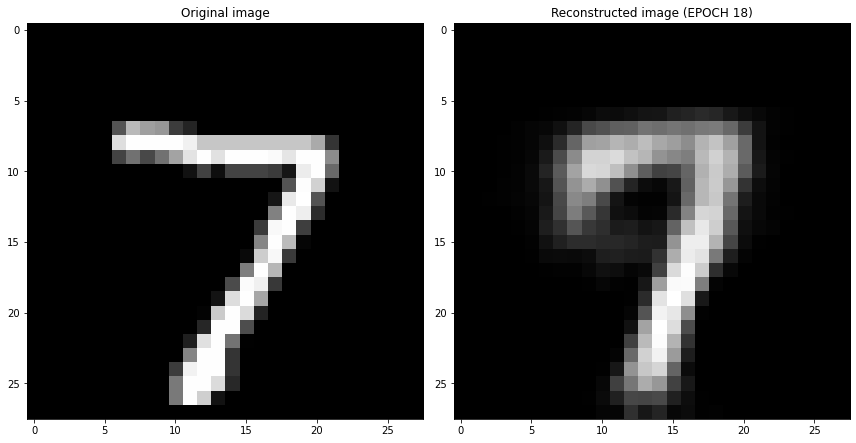

EPOCH 19/30
	 partial train loss (single batch): 0.044816
	 partial train loss (single batch): 0.039927
	 partial train loss (single batch): 0.042226
	 partial train loss (single batch): 0.040885
	 partial train loss (single batch): 0.041150
	 partial train loss (single batch): 0.043191
	 partial train loss (single batch): 0.042650
	 partial train loss (single batch): 0.040229
	 partial train loss (single batch): 0.040065
	 partial train loss (single batch): 0.041345
	 partial train loss (single batch): 0.041479
	 partial train loss (single batch): 0.041310
	 partial train loss (single batch): 0.041540
	 partial train loss (single batch): 0.042515
	 partial train loss (single batch): 0.040515
	 partial train loss (single batch): 0.040625
	 partial train loss (single batch): 0.042710
	 partial train loss (single batch): 0.042588
	 partial train loss (single batch): 0.040090
	 partial train loss (single batch): 0.041761
	 partial train loss (single batch): 0.042463
	 partial train loss (

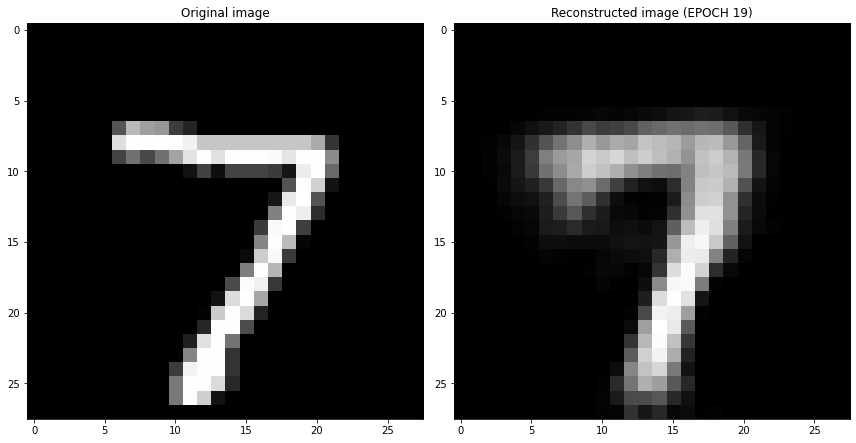

EPOCH 20/30
	 partial train loss (single batch): 0.041870
	 partial train loss (single batch): 0.041345
	 partial train loss (single batch): 0.042582
	 partial train loss (single batch): 0.042591
	 partial train loss (single batch): 0.041623
	 partial train loss (single batch): 0.043030
	 partial train loss (single batch): 0.042108
	 partial train loss (single batch): 0.042129
	 partial train loss (single batch): 0.041731
	 partial train loss (single batch): 0.041706
	 partial train loss (single batch): 0.039730
	 partial train loss (single batch): 0.041280
	 partial train loss (single batch): 0.041527
	 partial train loss (single batch): 0.043733
	 partial train loss (single batch): 0.040986
	 partial train loss (single batch): 0.041037
	 partial train loss (single batch): 0.042135
	 partial train loss (single batch): 0.041948
	 partial train loss (single batch): 0.041016
	 partial train loss (single batch): 0.041635
	 partial train loss (single batch): 0.039928
	 partial train loss (

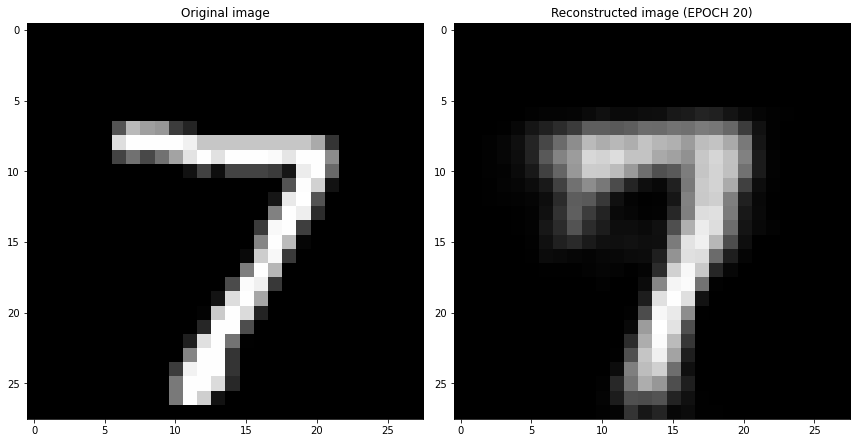

EPOCH 21/30
	 partial train loss (single batch): 0.040594
	 partial train loss (single batch): 0.041741
	 partial train loss (single batch): 0.040572
	 partial train loss (single batch): 0.039177
	 partial train loss (single batch): 0.041596
	 partial train loss (single batch): 0.039324
	 partial train loss (single batch): 0.040309
	 partial train loss (single batch): 0.039738
	 partial train loss (single batch): 0.040610
	 partial train loss (single batch): 0.041468
	 partial train loss (single batch): 0.039581
	 partial train loss (single batch): 0.039232
	 partial train loss (single batch): 0.041476
	 partial train loss (single batch): 0.040037
	 partial train loss (single batch): 0.042265
	 partial train loss (single batch): 0.042996
	 partial train loss (single batch): 0.039534
	 partial train loss (single batch): 0.039954
	 partial train loss (single batch): 0.039417
	 partial train loss (single batch): 0.040596
	 partial train loss (single batch): 0.040049
	 partial train loss (

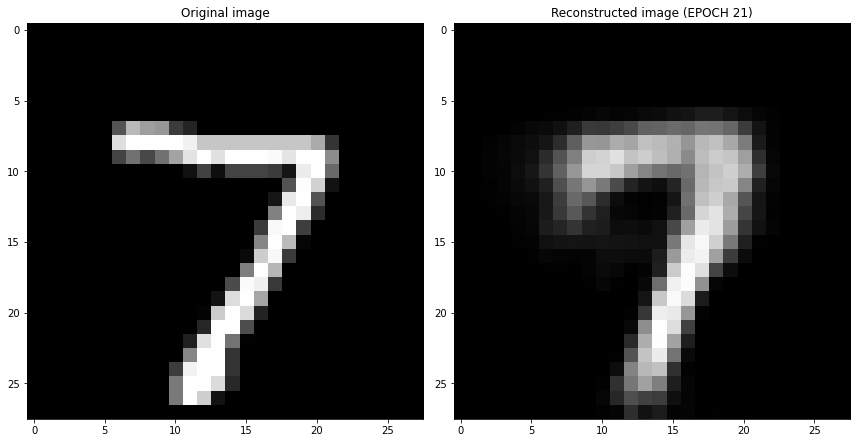

EPOCH 22/30
	 partial train loss (single batch): 0.042541
	 partial train loss (single batch): 0.042159
	 partial train loss (single batch): 0.040947
	 partial train loss (single batch): 0.040958
	 partial train loss (single batch): 0.042575
	 partial train loss (single batch): 0.041594
	 partial train loss (single batch): 0.040242
	 partial train loss (single batch): 0.040602
	 partial train loss (single batch): 0.040920
	 partial train loss (single batch): 0.041934
	 partial train loss (single batch): 0.041476
	 partial train loss (single batch): 0.039082
	 partial train loss (single batch): 0.039722
	 partial train loss (single batch): 0.042680
	 partial train loss (single batch): 0.042561
	 partial train loss (single batch): 0.041946
	 partial train loss (single batch): 0.042445
	 partial train loss (single batch): 0.037623
	 partial train loss (single batch): 0.040858
	 partial train loss (single batch): 0.039867
	 partial train loss (single batch): 0.039260
	 partial train loss (

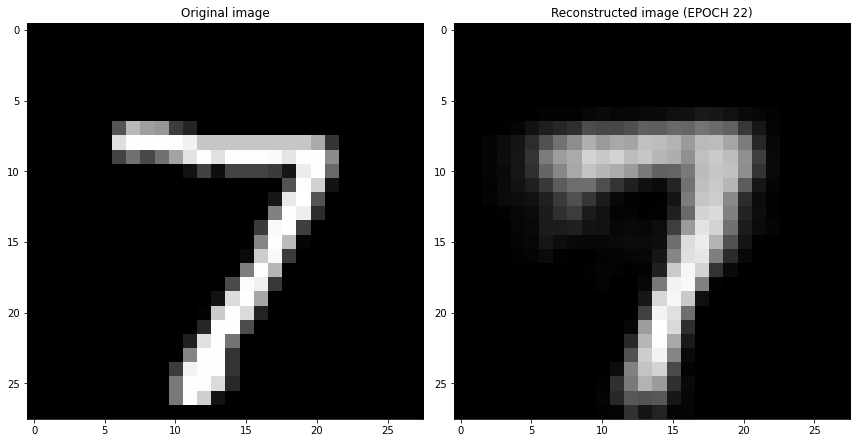

EPOCH 23/30
	 partial train loss (single batch): 0.038982
	 partial train loss (single batch): 0.039372
	 partial train loss (single batch): 0.040322
	 partial train loss (single batch): 0.041745
	 partial train loss (single batch): 0.039173
	 partial train loss (single batch): 0.041012
	 partial train loss (single batch): 0.042280
	 partial train loss (single batch): 0.042302
	 partial train loss (single batch): 0.037941
	 partial train loss (single batch): 0.041751
	 partial train loss (single batch): 0.039140
	 partial train loss (single batch): 0.040702
	 partial train loss (single batch): 0.039252
	 partial train loss (single batch): 0.040619
	 partial train loss (single batch): 0.039376
	 partial train loss (single batch): 0.041036
	 partial train loss (single batch): 0.040413
	 partial train loss (single batch): 0.040612
	 partial train loss (single batch): 0.038958
	 partial train loss (single batch): 0.039987
	 partial train loss (single batch): 0.042227
	 partial train loss (

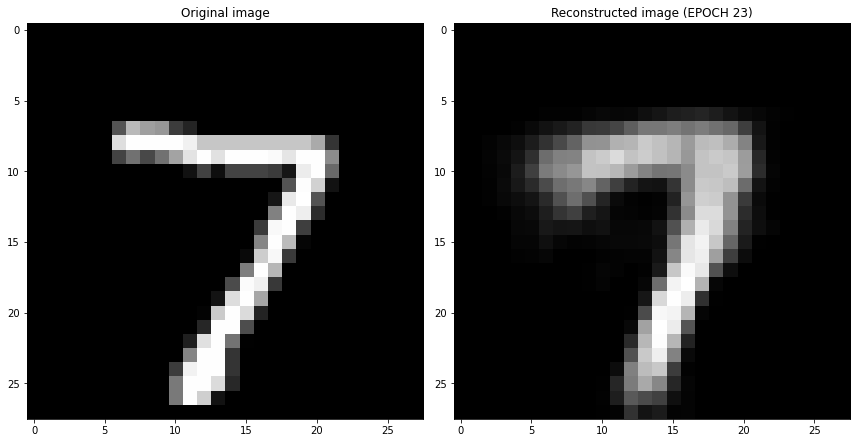

EPOCH 24/30
	 partial train loss (single batch): 0.041736
	 partial train loss (single batch): 0.041321
	 partial train loss (single batch): 0.040647
	 partial train loss (single batch): 0.040369
	 partial train loss (single batch): 0.038811
	 partial train loss (single batch): 0.041991
	 partial train loss (single batch): 0.040088
	 partial train loss (single batch): 0.039533
	 partial train loss (single batch): 0.039879
	 partial train loss (single batch): 0.039677
	 partial train loss (single batch): 0.041304
	 partial train loss (single batch): 0.040862
	 partial train loss (single batch): 0.038884
	 partial train loss (single batch): 0.041519
	 partial train loss (single batch): 0.040101
	 partial train loss (single batch): 0.040552
	 partial train loss (single batch): 0.039943
	 partial train loss (single batch): 0.039792
	 partial train loss (single batch): 0.039216
	 partial train loss (single batch): 0.041647
	 partial train loss (single batch): 0.040888
	 partial train loss (

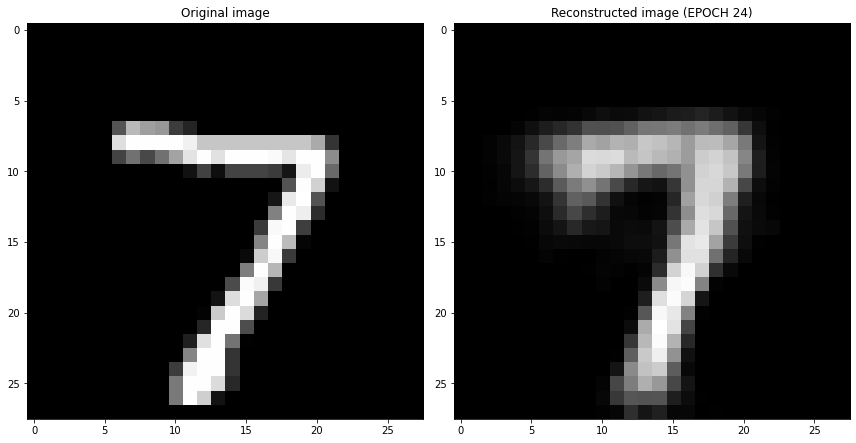

EPOCH 25/30
	 partial train loss (single batch): 0.040987
	 partial train loss (single batch): 0.041777
	 partial train loss (single batch): 0.040040
	 partial train loss (single batch): 0.039843
	 partial train loss (single batch): 0.040592
	 partial train loss (single batch): 0.040824
	 partial train loss (single batch): 0.041018
	 partial train loss (single batch): 0.040339
	 partial train loss (single batch): 0.039972
	 partial train loss (single batch): 0.041470
	 partial train loss (single batch): 0.043491
	 partial train loss (single batch): 0.040913
	 partial train loss (single batch): 0.039341
	 partial train loss (single batch): 0.039268
	 partial train loss (single batch): 0.039169
	 partial train loss (single batch): 0.040458
	 partial train loss (single batch): 0.042141
	 partial train loss (single batch): 0.039897
	 partial train loss (single batch): 0.041012
	 partial train loss (single batch): 0.039905
	 partial train loss (single batch): 0.040700
	 partial train loss (

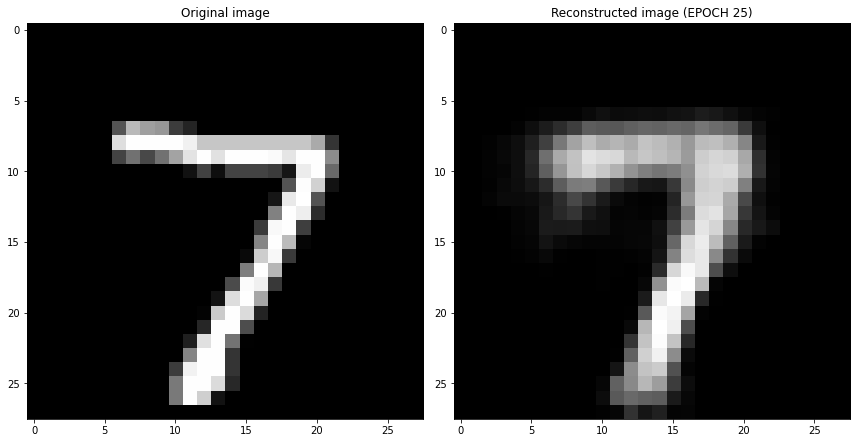

EPOCH 26/30
	 partial train loss (single batch): 0.039125
	 partial train loss (single batch): 0.040733
	 partial train loss (single batch): 0.039307
	 partial train loss (single batch): 0.040116
	 partial train loss (single batch): 0.041076
	 partial train loss (single batch): 0.039985
	 partial train loss (single batch): 0.040879
	 partial train loss (single batch): 0.039967
	 partial train loss (single batch): 0.039375
	 partial train loss (single batch): 0.038454
	 partial train loss (single batch): 0.040461
	 partial train loss (single batch): 0.040358
	 partial train loss (single batch): 0.040845
	 partial train loss (single batch): 0.039216
	 partial train loss (single batch): 0.040608
	 partial train loss (single batch): 0.039563
	 partial train loss (single batch): 0.040932
	 partial train loss (single batch): 0.039967
	 partial train loss (single batch): 0.040811
	 partial train loss (single batch): 0.040362
	 partial train loss (single batch): 0.041871
	 partial train loss (

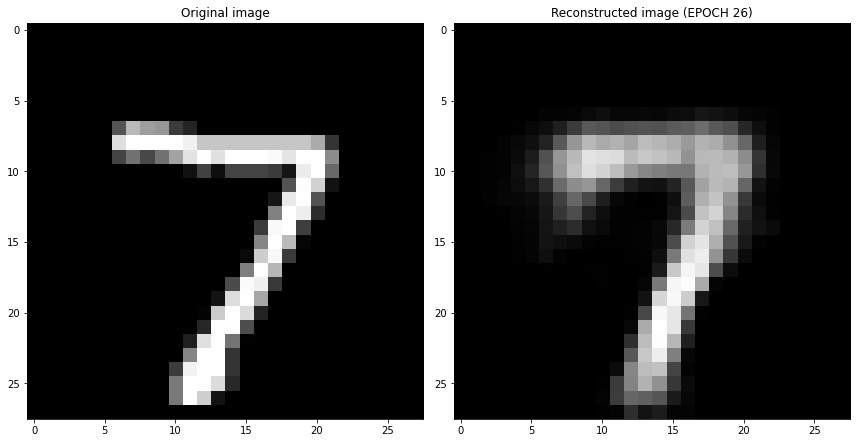

EPOCH 27/30
	 partial train loss (single batch): 0.040913
	 partial train loss (single batch): 0.039469
	 partial train loss (single batch): 0.039151
	 partial train loss (single batch): 0.040005
	 partial train loss (single batch): 0.040092
	 partial train loss (single batch): 0.040831
	 partial train loss (single batch): 0.039059
	 partial train loss (single batch): 0.037588
	 partial train loss (single batch): 0.039190
	 partial train loss (single batch): 0.038439
	 partial train loss (single batch): 0.040706
	 partial train loss (single batch): 0.038871
	 partial train loss (single batch): 0.040014
	 partial train loss (single batch): 0.040453
	 partial train loss (single batch): 0.037632
	 partial train loss (single batch): 0.040043
	 partial train loss (single batch): 0.040968
	 partial train loss (single batch): 0.040170
	 partial train loss (single batch): 0.040439
	 partial train loss (single batch): 0.042304
	 partial train loss (single batch): 0.039032
	 partial train loss (

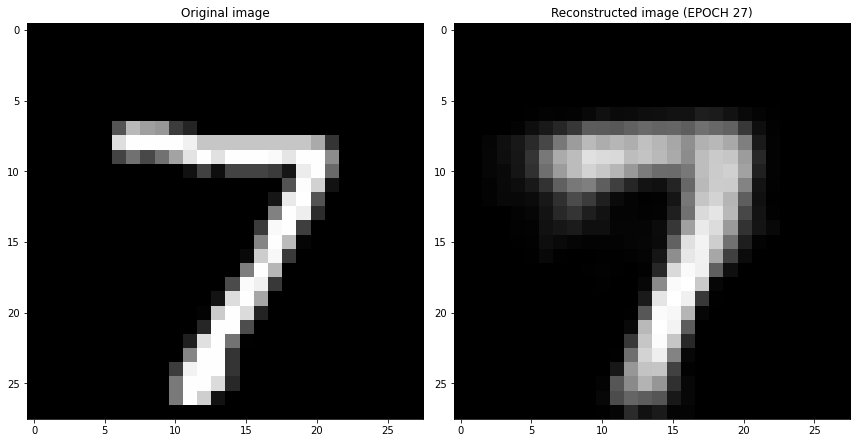

EPOCH 28/30
	 partial train loss (single batch): 0.039340
	 partial train loss (single batch): 0.040355
	 partial train loss (single batch): 0.038783
	 partial train loss (single batch): 0.039435
	 partial train loss (single batch): 0.042237
	 partial train loss (single batch): 0.039581
	 partial train loss (single batch): 0.039673
	 partial train loss (single batch): 0.038978
	 partial train loss (single batch): 0.040212
	 partial train loss (single batch): 0.041903
	 partial train loss (single batch): 0.040022
	 partial train loss (single batch): 0.041042
	 partial train loss (single batch): 0.040423
	 partial train loss (single batch): 0.039917
	 partial train loss (single batch): 0.039487
	 partial train loss (single batch): 0.038410
	 partial train loss (single batch): 0.040896
	 partial train loss (single batch): 0.038095
	 partial train loss (single batch): 0.040369
	 partial train loss (single batch): 0.039154
	 partial train loss (single batch): 0.039692
	 partial train loss (

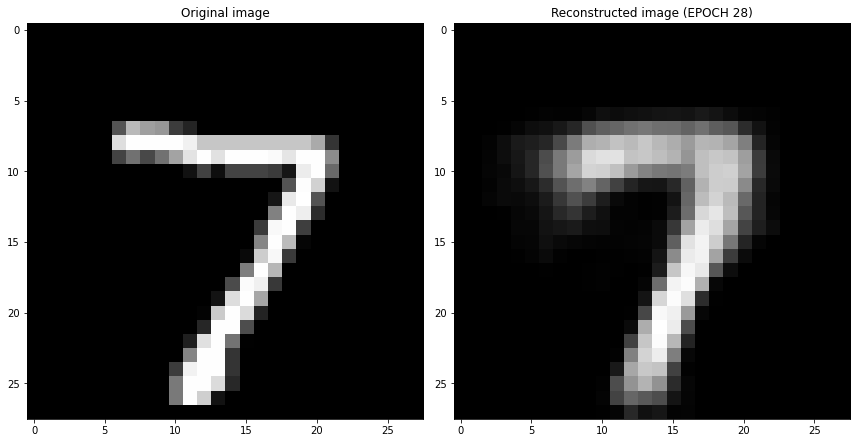

EPOCH 29/30
	 partial train loss (single batch): 0.041787
	 partial train loss (single batch): 0.040701
	 partial train loss (single batch): 0.039816
	 partial train loss (single batch): 0.040875
	 partial train loss (single batch): 0.038072
	 partial train loss (single batch): 0.041329
	 partial train loss (single batch): 0.040309
	 partial train loss (single batch): 0.040306
	 partial train loss (single batch): 0.036677
	 partial train loss (single batch): 0.039039
	 partial train loss (single batch): 0.039995
	 partial train loss (single batch): 0.038673
	 partial train loss (single batch): 0.039580
	 partial train loss (single batch): 0.038400
	 partial train loss (single batch): 0.039766
	 partial train loss (single batch): 0.040092
	 partial train loss (single batch): 0.041884
	 partial train loss (single batch): 0.040007
	 partial train loss (single batch): 0.039057
	 partial train loss (single batch): 0.041484
	 partial train loss (single batch): 0.038667
	 partial train loss (

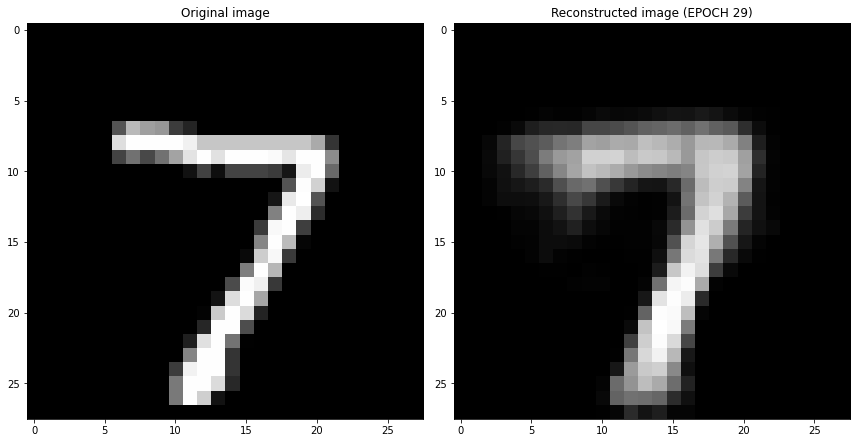

EPOCH 30/30
	 partial train loss (single batch): 0.041245
	 partial train loss (single batch): 0.040430
	 partial train loss (single batch): 0.040183
	 partial train loss (single batch): 0.039434
	 partial train loss (single batch): 0.040678
	 partial train loss (single batch): 0.039211
	 partial train loss (single batch): 0.040005
	 partial train loss (single batch): 0.041480
	 partial train loss (single batch): 0.039359
	 partial train loss (single batch): 0.040579
	 partial train loss (single batch): 0.036689
	 partial train loss (single batch): 0.041156
	 partial train loss (single batch): 0.038802
	 partial train loss (single batch): 0.037669
	 partial train loss (single batch): 0.038104
	 partial train loss (single batch): 0.040373
	 partial train loss (single batch): 0.040856
	 partial train loss (single batch): 0.039312
	 partial train loss (single batch): 0.040599
	 partial train loss (single batch): 0.039172
	 partial train loss (single batch): 0.040290
	 partial train loss (

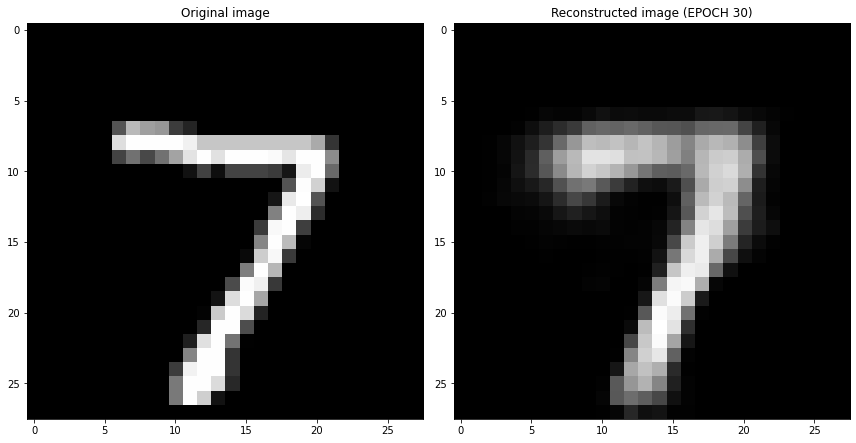

Cross validation fold number= 5/6
EPOCH 1/30
	 partial train loss (single batch): 0.293903
	 partial train loss (single batch): 0.292787
	 partial train loss (single batch): 0.292498
	 partial train loss (single batch): 0.290902
	 partial train loss (single batch): 0.291775
	 partial train loss (single batch): 0.290245
	 partial train loss (single batch): 0.289963
	 partial train loss (single batch): 0.288520
	 partial train loss (single batch): 0.287275
	 partial train loss (single batch): 0.286580
	 partial train loss (single batch): 0.285819
	 partial train loss (single batch): 0.285582
	 partial train loss (single batch): 0.284428
	 partial train loss (single batch): 0.283564
	 partial train loss (single batch): 0.283043
	 partial train loss (single batch): 0.280929
	 partial train loss (single batch): 0.278751
	 partial train loss (single batch): 0.276238
	 partial train loss (single batch): 0.274156
	 partial train loss (single batch): 0.270647
	 partial train loss (single batch)

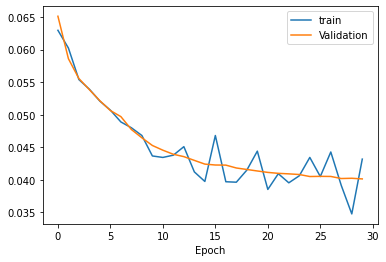

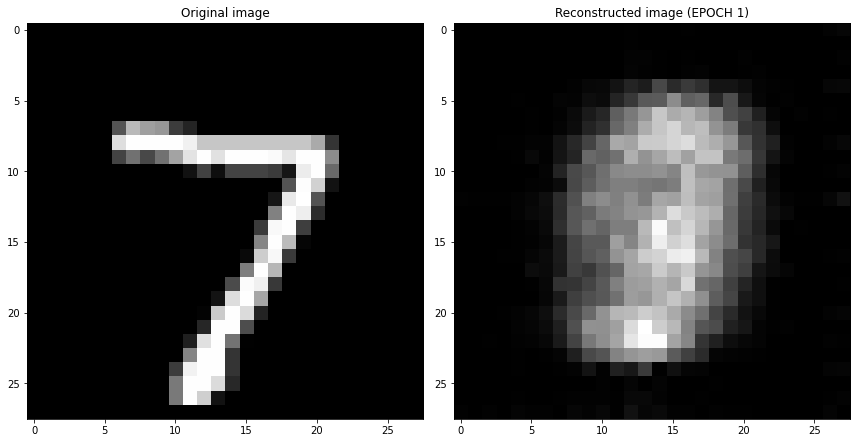

EPOCH 2/30
	 partial train loss (single batch): 0.064233
	 partial train loss (single batch): 0.064341
	 partial train loss (single batch): 0.064342
	 partial train loss (single batch): 0.063195
	 partial train loss (single batch): 0.063189
	 partial train loss (single batch): 0.063353
	 partial train loss (single batch): 0.064749
	 partial train loss (single batch): 0.063218
	 partial train loss (single batch): 0.061636
	 partial train loss (single batch): 0.063166
	 partial train loss (single batch): 0.065117
	 partial train loss (single batch): 0.063705
	 partial train loss (single batch): 0.064916
	 partial train loss (single batch): 0.063896
	 partial train loss (single batch): 0.063234
	 partial train loss (single batch): 0.064176
	 partial train loss (single batch): 0.064260
	 partial train loss (single batch): 0.064933
	 partial train loss (single batch): 0.062163
	 partial train loss (single batch): 0.062482
	 partial train loss (single batch): 0.063188
	 partial train loss (s

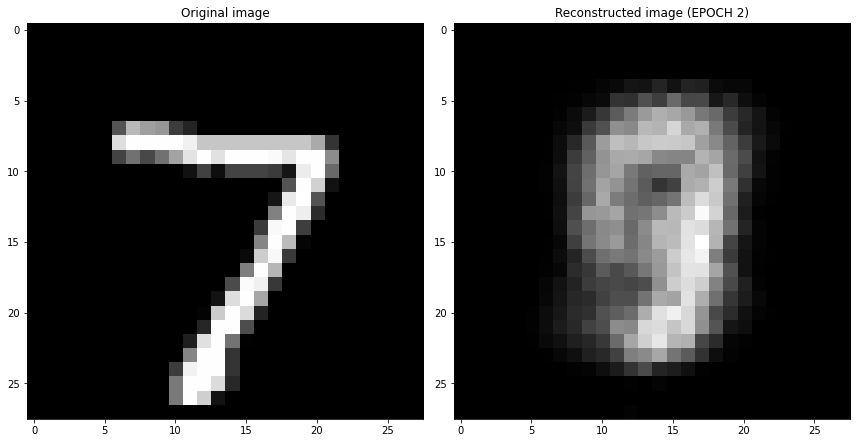

EPOCH 3/30
	 partial train loss (single batch): 0.055975
	 partial train loss (single batch): 0.055336
	 partial train loss (single batch): 0.057049
	 partial train loss (single batch): 0.057712
	 partial train loss (single batch): 0.056313
	 partial train loss (single batch): 0.060042
	 partial train loss (single batch): 0.058025
	 partial train loss (single batch): 0.058453
	 partial train loss (single batch): 0.058177
	 partial train loss (single batch): 0.057184
	 partial train loss (single batch): 0.057258
	 partial train loss (single batch): 0.057326
	 partial train loss (single batch): 0.056577
	 partial train loss (single batch): 0.057835
	 partial train loss (single batch): 0.058771
	 partial train loss (single batch): 0.058569
	 partial train loss (single batch): 0.057193
	 partial train loss (single batch): 0.056193
	 partial train loss (single batch): 0.058603
	 partial train loss (single batch): 0.056948
	 partial train loss (single batch): 0.055014
	 partial train loss (s

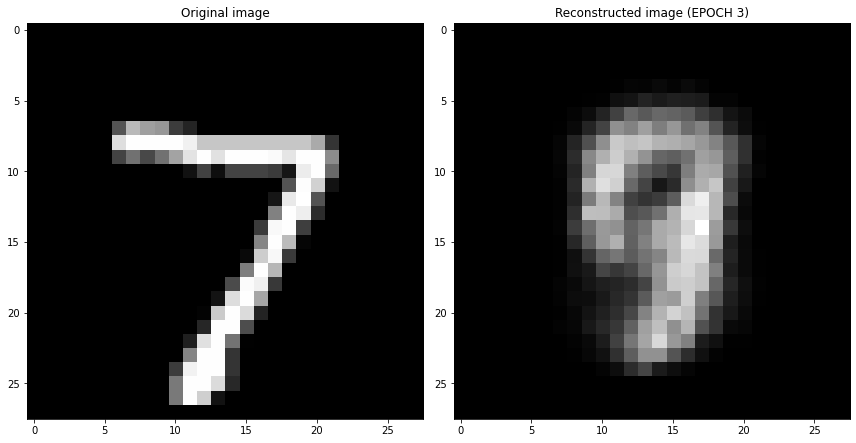

EPOCH 4/30
	 partial train loss (single batch): 0.056717
	 partial train loss (single batch): 0.053943
	 partial train loss (single batch): 0.056854
	 partial train loss (single batch): 0.055480
	 partial train loss (single batch): 0.053756
	 partial train loss (single batch): 0.054883
	 partial train loss (single batch): 0.054380
	 partial train loss (single batch): 0.056570
	 partial train loss (single batch): 0.054724
	 partial train loss (single batch): 0.056615
	 partial train loss (single batch): 0.055255
	 partial train loss (single batch): 0.056678
	 partial train loss (single batch): 0.055728
	 partial train loss (single batch): 0.055574
	 partial train loss (single batch): 0.056386
	 partial train loss (single batch): 0.055180
	 partial train loss (single batch): 0.057207
	 partial train loss (single batch): 0.057820
	 partial train loss (single batch): 0.054517
	 partial train loss (single batch): 0.056936
	 partial train loss (single batch): 0.056988
	 partial train loss (s

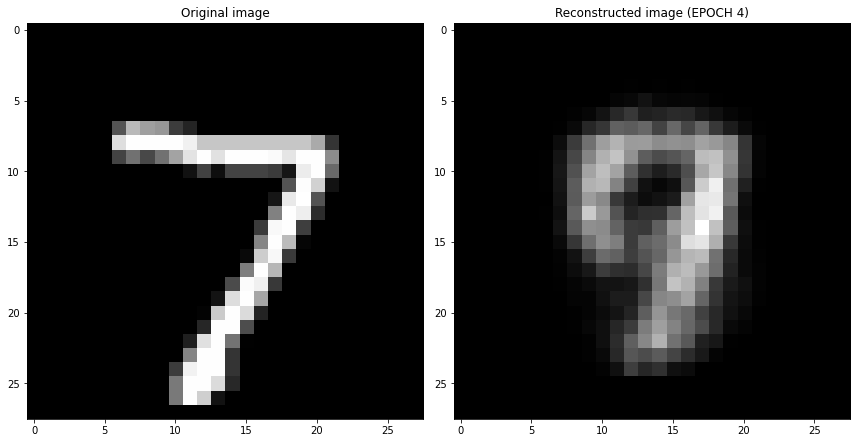

EPOCH 5/30
	 partial train loss (single batch): 0.053682
	 partial train loss (single batch): 0.054275
	 partial train loss (single batch): 0.055013
	 partial train loss (single batch): 0.053838
	 partial train loss (single batch): 0.057018
	 partial train loss (single batch): 0.054610
	 partial train loss (single batch): 0.053678
	 partial train loss (single batch): 0.054941
	 partial train loss (single batch): 0.056210
	 partial train loss (single batch): 0.054367
	 partial train loss (single batch): 0.052032
	 partial train loss (single batch): 0.054238
	 partial train loss (single batch): 0.054666
	 partial train loss (single batch): 0.055049
	 partial train loss (single batch): 0.053759
	 partial train loss (single batch): 0.055659
	 partial train loss (single batch): 0.054515
	 partial train loss (single batch): 0.052780
	 partial train loss (single batch): 0.053460
	 partial train loss (single batch): 0.053804
	 partial train loss (single batch): 0.053088
	 partial train loss (s

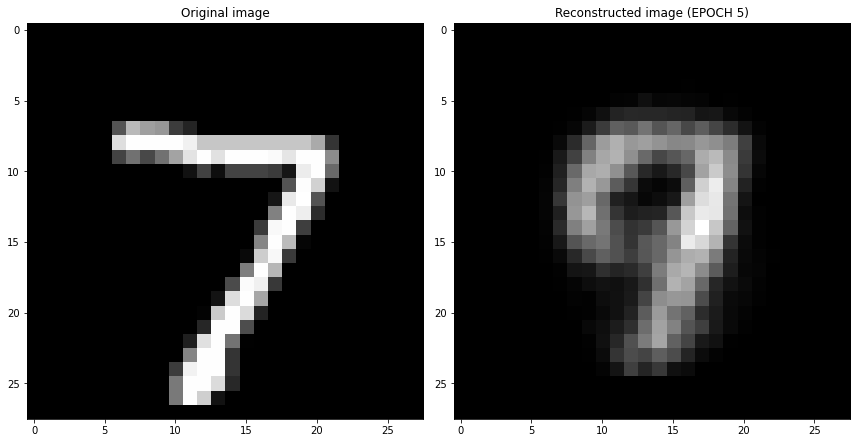

EPOCH 6/30
	 partial train loss (single batch): 0.055386
	 partial train loss (single batch): 0.054127
	 partial train loss (single batch): 0.053656
	 partial train loss (single batch): 0.053653
	 partial train loss (single batch): 0.052108
	 partial train loss (single batch): 0.053465
	 partial train loss (single batch): 0.053693
	 partial train loss (single batch): 0.055208
	 partial train loss (single batch): 0.055798
	 partial train loss (single batch): 0.053915
	 partial train loss (single batch): 0.054959
	 partial train loss (single batch): 0.051897
	 partial train loss (single batch): 0.052632
	 partial train loss (single batch): 0.053579
	 partial train loss (single batch): 0.051286
	 partial train loss (single batch): 0.052631
	 partial train loss (single batch): 0.053543
	 partial train loss (single batch): 0.055073
	 partial train loss (single batch): 0.053765
	 partial train loss (single batch): 0.052365
	 partial train loss (single batch): 0.054208
	 partial train loss (s

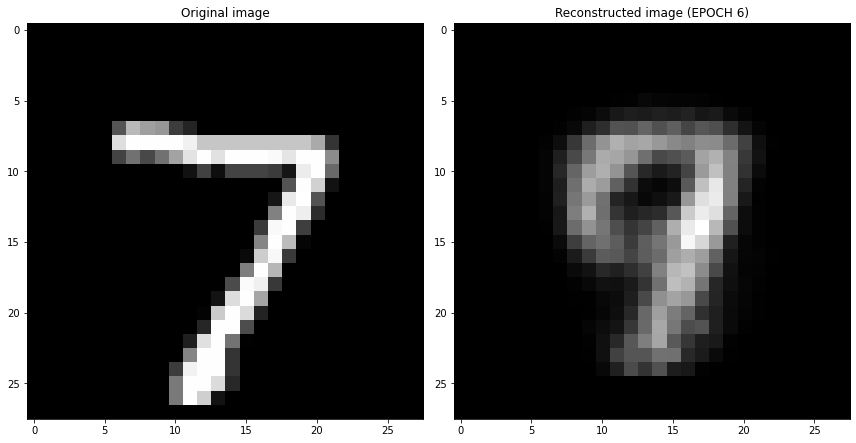

EPOCH 7/30
	 partial train loss (single batch): 0.052337
	 partial train loss (single batch): 0.052943
	 partial train loss (single batch): 0.051295
	 partial train loss (single batch): 0.053204
	 partial train loss (single batch): 0.053112
	 partial train loss (single batch): 0.052375
	 partial train loss (single batch): 0.054882
	 partial train loss (single batch): 0.052412
	 partial train loss (single batch): 0.052360
	 partial train loss (single batch): 0.050839
	 partial train loss (single batch): 0.053350
	 partial train loss (single batch): 0.051817
	 partial train loss (single batch): 0.052898
	 partial train loss (single batch): 0.053379
	 partial train loss (single batch): 0.055136
	 partial train loss (single batch): 0.053988
	 partial train loss (single batch): 0.051264
	 partial train loss (single batch): 0.053580
	 partial train loss (single batch): 0.052902
	 partial train loss (single batch): 0.054784
	 partial train loss (single batch): 0.057109
	 partial train loss (s

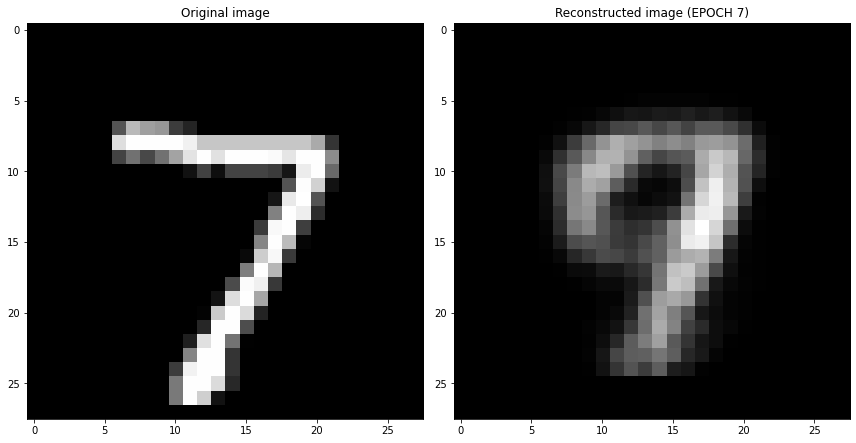

EPOCH 8/30
	 partial train loss (single batch): 0.051630
	 partial train loss (single batch): 0.052518
	 partial train loss (single batch): 0.052652
	 partial train loss (single batch): 0.052235
	 partial train loss (single batch): 0.052420
	 partial train loss (single batch): 0.053651
	 partial train loss (single batch): 0.051027
	 partial train loss (single batch): 0.053531
	 partial train loss (single batch): 0.052557
	 partial train loss (single batch): 0.053924
	 partial train loss (single batch): 0.050428
	 partial train loss (single batch): 0.052993
	 partial train loss (single batch): 0.052310
	 partial train loss (single batch): 0.052414
	 partial train loss (single batch): 0.054241
	 partial train loss (single batch): 0.053592
	 partial train loss (single batch): 0.051515
	 partial train loss (single batch): 0.052986
	 partial train loss (single batch): 0.053941
	 partial train loss (single batch): 0.050782
	 partial train loss (single batch): 0.052195
	 partial train loss (s

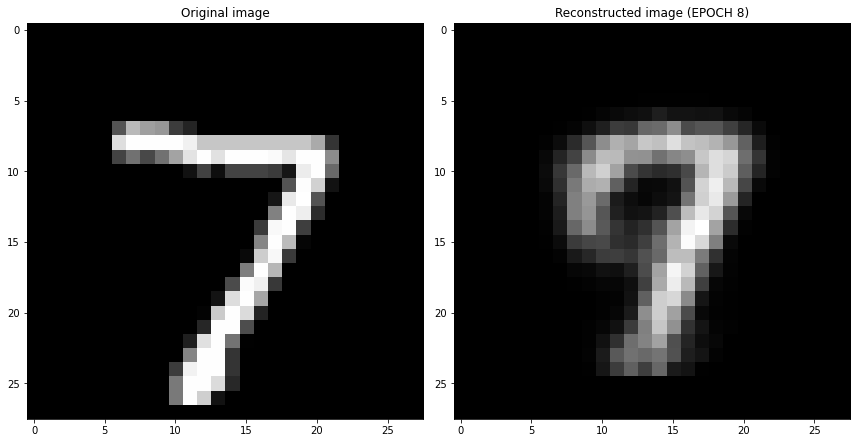

EPOCH 9/30
	 partial train loss (single batch): 0.053594
	 partial train loss (single batch): 0.050420
	 partial train loss (single batch): 0.053401
	 partial train loss (single batch): 0.050737
	 partial train loss (single batch): 0.051840
	 partial train loss (single batch): 0.052727
	 partial train loss (single batch): 0.049313
	 partial train loss (single batch): 0.051061
	 partial train loss (single batch): 0.050214
	 partial train loss (single batch): 0.051786
	 partial train loss (single batch): 0.054812
	 partial train loss (single batch): 0.051256
	 partial train loss (single batch): 0.050753
	 partial train loss (single batch): 0.053864
	 partial train loss (single batch): 0.050375
	 partial train loss (single batch): 0.051749
	 partial train loss (single batch): 0.049939
	 partial train loss (single batch): 0.054113
	 partial train loss (single batch): 0.053059
	 partial train loss (single batch): 0.053706
	 partial train loss (single batch): 0.051053
	 partial train loss (s

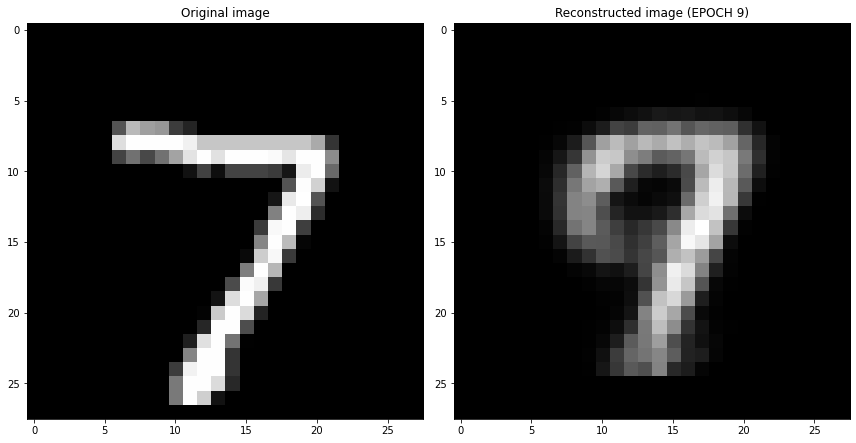

EPOCH 10/30
	 partial train loss (single batch): 0.052455
	 partial train loss (single batch): 0.051905
	 partial train loss (single batch): 0.050332
	 partial train loss (single batch): 0.051806
	 partial train loss (single batch): 0.051076
	 partial train loss (single batch): 0.052161
	 partial train loss (single batch): 0.050449
	 partial train loss (single batch): 0.051198
	 partial train loss (single batch): 0.050187
	 partial train loss (single batch): 0.049386
	 partial train loss (single batch): 0.049794
	 partial train loss (single batch): 0.049423
	 partial train loss (single batch): 0.051287
	 partial train loss (single batch): 0.050510
	 partial train loss (single batch): 0.050663
	 partial train loss (single batch): 0.050621
	 partial train loss (single batch): 0.050250
	 partial train loss (single batch): 0.051479
	 partial train loss (single batch): 0.051078
	 partial train loss (single batch): 0.052463
	 partial train loss (single batch): 0.049170
	 partial train loss (

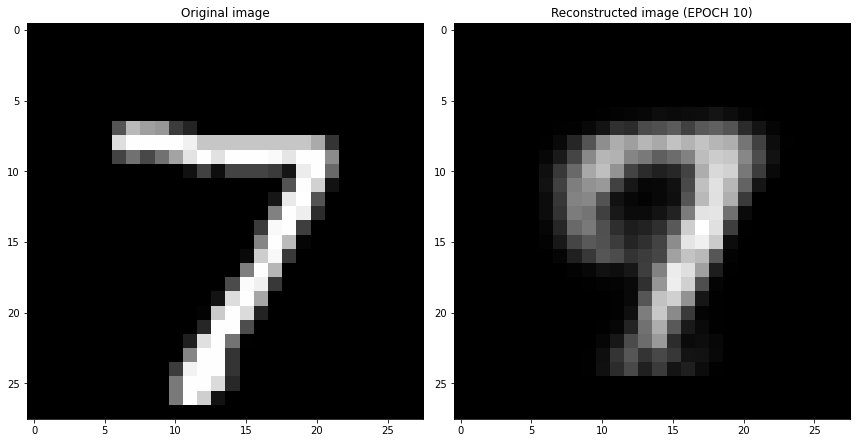

EPOCH 11/30
	 partial train loss (single batch): 0.051275
	 partial train loss (single batch): 0.048521
	 partial train loss (single batch): 0.050313
	 partial train loss (single batch): 0.049774
	 partial train loss (single batch): 0.052562
	 partial train loss (single batch): 0.049580
	 partial train loss (single batch): 0.049283
	 partial train loss (single batch): 0.050577
	 partial train loss (single batch): 0.050784
	 partial train loss (single batch): 0.049386
	 partial train loss (single batch): 0.048837
	 partial train loss (single batch): 0.048729
	 partial train loss (single batch): 0.050978
	 partial train loss (single batch): 0.051934
	 partial train loss (single batch): 0.049400
	 partial train loss (single batch): 0.048886
	 partial train loss (single batch): 0.049270
	 partial train loss (single batch): 0.048069
	 partial train loss (single batch): 0.050274
	 partial train loss (single batch): 0.050146
	 partial train loss (single batch): 0.050810
	 partial train loss (

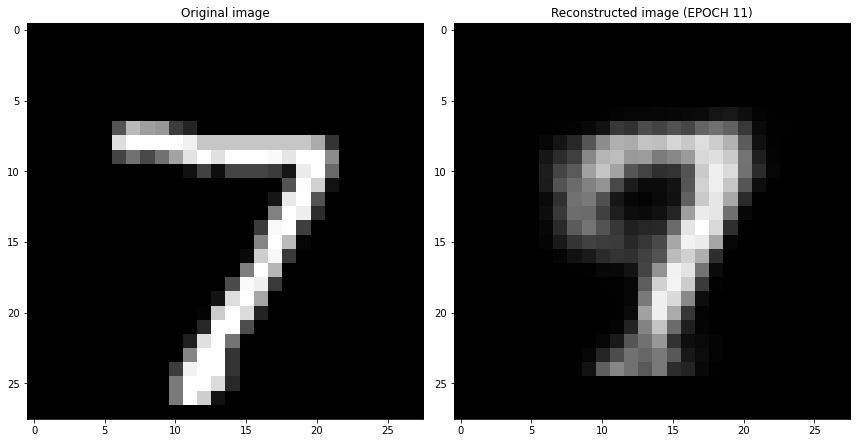

EPOCH 12/30
	 partial train loss (single batch): 0.048906
	 partial train loss (single batch): 0.050155
	 partial train loss (single batch): 0.048411
	 partial train loss (single batch): 0.047994
	 partial train loss (single batch): 0.049649
	 partial train loss (single batch): 0.049788
	 partial train loss (single batch): 0.050115
	 partial train loss (single batch): 0.046336
	 partial train loss (single batch): 0.050925
	 partial train loss (single batch): 0.051446
	 partial train loss (single batch): 0.048097
	 partial train loss (single batch): 0.052491
	 partial train loss (single batch): 0.049220
	 partial train loss (single batch): 0.049692
	 partial train loss (single batch): 0.047236
	 partial train loss (single batch): 0.050577
	 partial train loss (single batch): 0.050439
	 partial train loss (single batch): 0.049342
	 partial train loss (single batch): 0.048108
	 partial train loss (single batch): 0.051427
	 partial train loss (single batch): 0.049856
	 partial train loss (

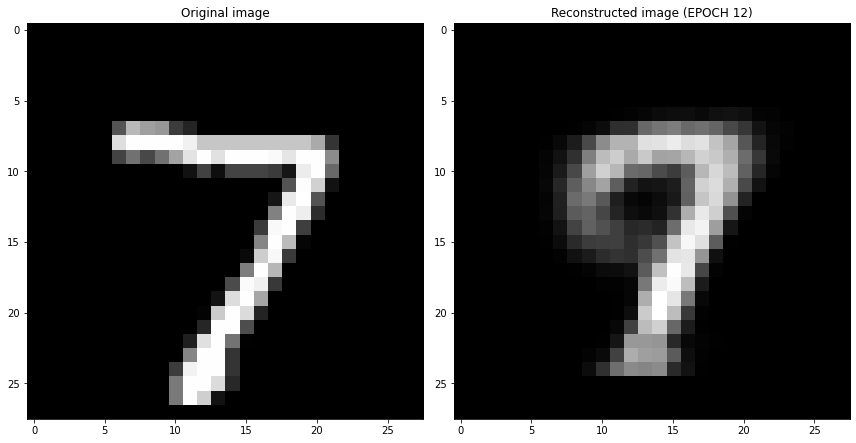

EPOCH 13/30
	 partial train loss (single batch): 0.047004
	 partial train loss (single batch): 0.048278
	 partial train loss (single batch): 0.047318
	 partial train loss (single batch): 0.048724
	 partial train loss (single batch): 0.049560
	 partial train loss (single batch): 0.050285
	 partial train loss (single batch): 0.048632
	 partial train loss (single batch): 0.049094
	 partial train loss (single batch): 0.048228
	 partial train loss (single batch): 0.048237
	 partial train loss (single batch): 0.049907
	 partial train loss (single batch): 0.049310
	 partial train loss (single batch): 0.050354
	 partial train loss (single batch): 0.049262
	 partial train loss (single batch): 0.050114
	 partial train loss (single batch): 0.050082
	 partial train loss (single batch): 0.048415
	 partial train loss (single batch): 0.049019
	 partial train loss (single batch): 0.048962
	 partial train loss (single batch): 0.048902
	 partial train loss (single batch): 0.049870
	 partial train loss (

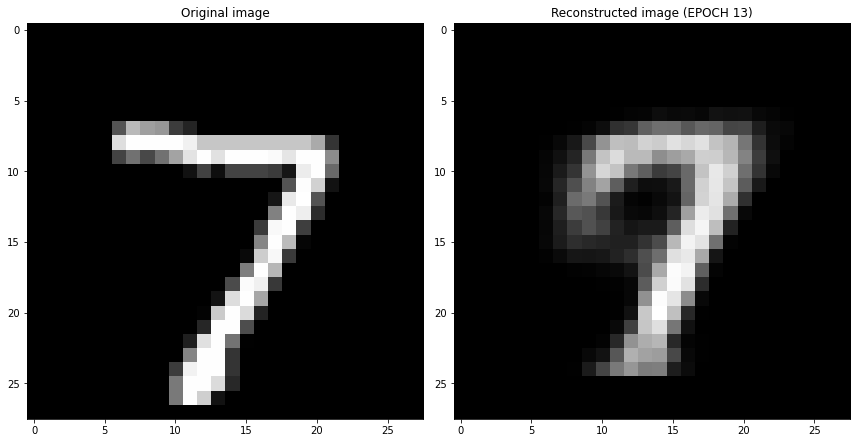

EPOCH 14/30
	 partial train loss (single batch): 0.045246
	 partial train loss (single batch): 0.048230
	 partial train loss (single batch): 0.048181
	 partial train loss (single batch): 0.046339
	 partial train loss (single batch): 0.047247
	 partial train loss (single batch): 0.045839
	 partial train loss (single batch): 0.047814
	 partial train loss (single batch): 0.047310
	 partial train loss (single batch): 0.048364
	 partial train loss (single batch): 0.045275
	 partial train loss (single batch): 0.047563
	 partial train loss (single batch): 0.047915
	 partial train loss (single batch): 0.049022
	 partial train loss (single batch): 0.050216
	 partial train loss (single batch): 0.047265
	 partial train loss (single batch): 0.048901
	 partial train loss (single batch): 0.049908
	 partial train loss (single batch): 0.046340
	 partial train loss (single batch): 0.048196
	 partial train loss (single batch): 0.049080
	 partial train loss (single batch): 0.047233
	 partial train loss (

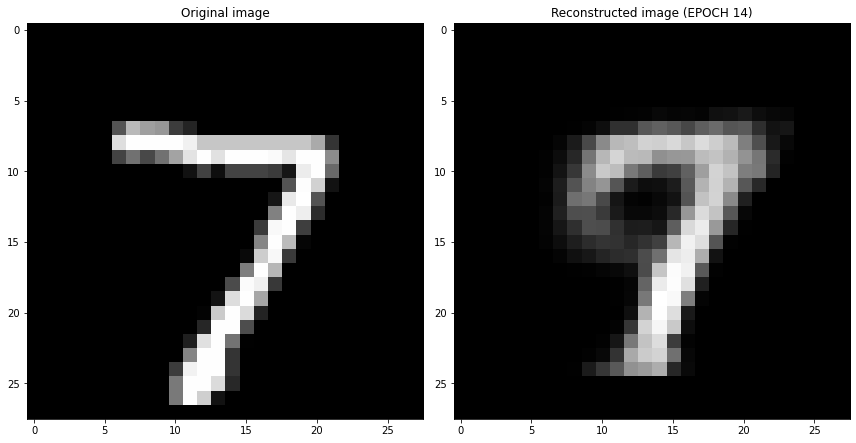

EPOCH 15/30
	 partial train loss (single batch): 0.047329
	 partial train loss (single batch): 0.046111
	 partial train loss (single batch): 0.048447
	 partial train loss (single batch): 0.047096
	 partial train loss (single batch): 0.048003
	 partial train loss (single batch): 0.046952
	 partial train loss (single batch): 0.046344
	 partial train loss (single batch): 0.051939
	 partial train loss (single batch): 0.048763
	 partial train loss (single batch): 0.047353
	 partial train loss (single batch): 0.048005
	 partial train loss (single batch): 0.047377
	 partial train loss (single batch): 0.047076
	 partial train loss (single batch): 0.048516
	 partial train loss (single batch): 0.048286
	 partial train loss (single batch): 0.047973
	 partial train loss (single batch): 0.045869
	 partial train loss (single batch): 0.049213
	 partial train loss (single batch): 0.047249
	 partial train loss (single batch): 0.046097
	 partial train loss (single batch): 0.049432
	 partial train loss (

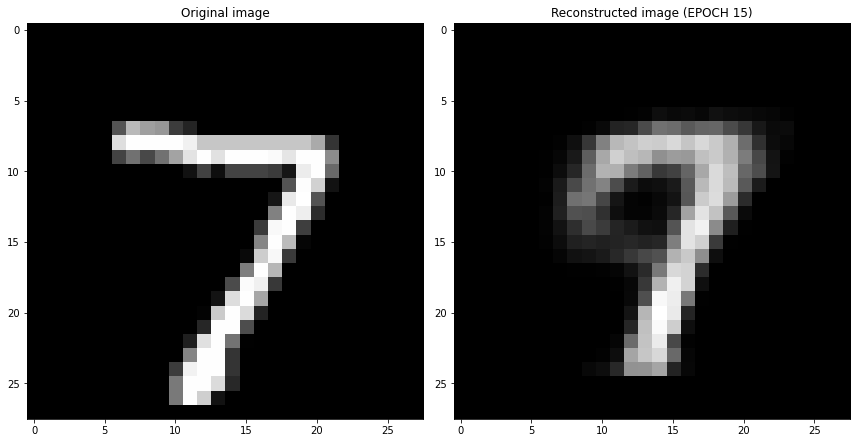

EPOCH 16/30
	 partial train loss (single batch): 0.045928
	 partial train loss (single batch): 0.048075
	 partial train loss (single batch): 0.046922
	 partial train loss (single batch): 0.048607
	 partial train loss (single batch): 0.047502
	 partial train loss (single batch): 0.048414
	 partial train loss (single batch): 0.049147
	 partial train loss (single batch): 0.048533
	 partial train loss (single batch): 0.045724
	 partial train loss (single batch): 0.045630
	 partial train loss (single batch): 0.045383
	 partial train loss (single batch): 0.046685
	 partial train loss (single batch): 0.046549
	 partial train loss (single batch): 0.045270
	 partial train loss (single batch): 0.046826
	 partial train loss (single batch): 0.049945
	 partial train loss (single batch): 0.046488
	 partial train loss (single batch): 0.048211
	 partial train loss (single batch): 0.047328
	 partial train loss (single batch): 0.046898
	 partial train loss (single batch): 0.046498
	 partial train loss (

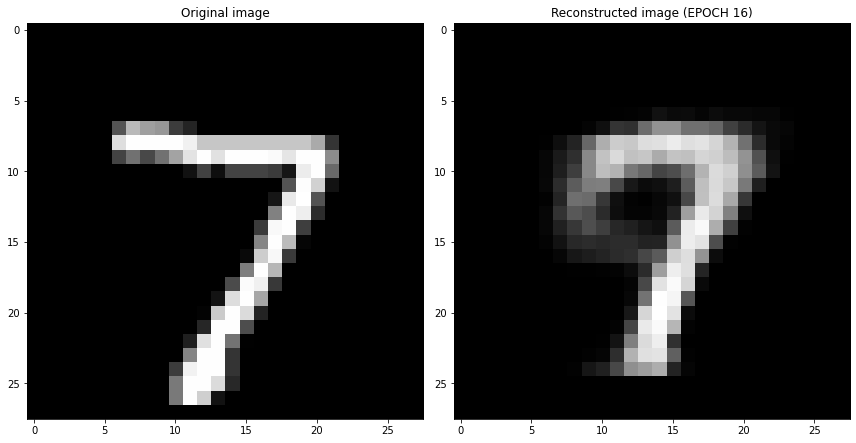

EPOCH 17/30
	 partial train loss (single batch): 0.047695
	 partial train loss (single batch): 0.048436
	 partial train loss (single batch): 0.047442
	 partial train loss (single batch): 0.047480
	 partial train loss (single batch): 0.046443
	 partial train loss (single batch): 0.047978
	 partial train loss (single batch): 0.047402
	 partial train loss (single batch): 0.045503
	 partial train loss (single batch): 0.047042
	 partial train loss (single batch): 0.045651
	 partial train loss (single batch): 0.045691
	 partial train loss (single batch): 0.048200
	 partial train loss (single batch): 0.047660
	 partial train loss (single batch): 0.047209
	 partial train loss (single batch): 0.045685
	 partial train loss (single batch): 0.045158
	 partial train loss (single batch): 0.046591
	 partial train loss (single batch): 0.046399
	 partial train loss (single batch): 0.046447
	 partial train loss (single batch): 0.044592
	 partial train loss (single batch): 0.046779
	 partial train loss (

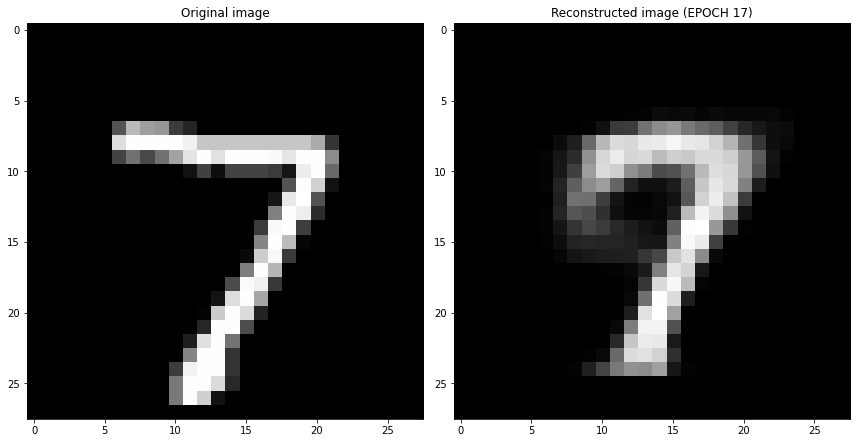

EPOCH 18/30
	 partial train loss (single batch): 0.046782
	 partial train loss (single batch): 0.046946
	 partial train loss (single batch): 0.046547
	 partial train loss (single batch): 0.045501
	 partial train loss (single batch): 0.045509
	 partial train loss (single batch): 0.044657
	 partial train loss (single batch): 0.046505
	 partial train loss (single batch): 0.043963
	 partial train loss (single batch): 0.045910
	 partial train loss (single batch): 0.045233
	 partial train loss (single batch): 0.045598
	 partial train loss (single batch): 0.045304
	 partial train loss (single batch): 0.046206
	 partial train loss (single batch): 0.044683
	 partial train loss (single batch): 0.047041
	 partial train loss (single batch): 0.047361
	 partial train loss (single batch): 0.047735
	 partial train loss (single batch): 0.046748
	 partial train loss (single batch): 0.046643
	 partial train loss (single batch): 0.045876
	 partial train loss (single batch): 0.046015
	 partial train loss (

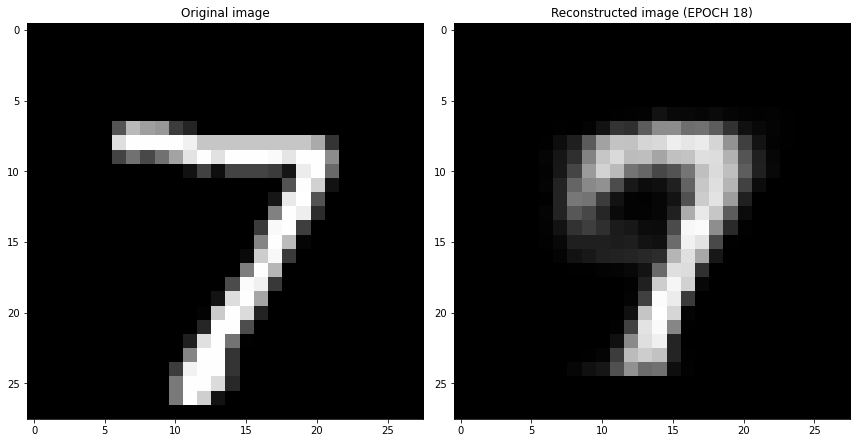

EPOCH 19/30
	 partial train loss (single batch): 0.044213
	 partial train loss (single batch): 0.044030
	 partial train loss (single batch): 0.045280
	 partial train loss (single batch): 0.043924
	 partial train loss (single batch): 0.044666
	 partial train loss (single batch): 0.044418
	 partial train loss (single batch): 0.046127
	 partial train loss (single batch): 0.047869
	 partial train loss (single batch): 0.045857
	 partial train loss (single batch): 0.048158
	 partial train loss (single batch): 0.045845
	 partial train loss (single batch): 0.046659
	 partial train loss (single batch): 0.045339
	 partial train loss (single batch): 0.044353
	 partial train loss (single batch): 0.047224
	 partial train loss (single batch): 0.046707
	 partial train loss (single batch): 0.042556
	 partial train loss (single batch): 0.046348
	 partial train loss (single batch): 0.045200
	 partial train loss (single batch): 0.046701
	 partial train loss (single batch): 0.046856
	 partial train loss (

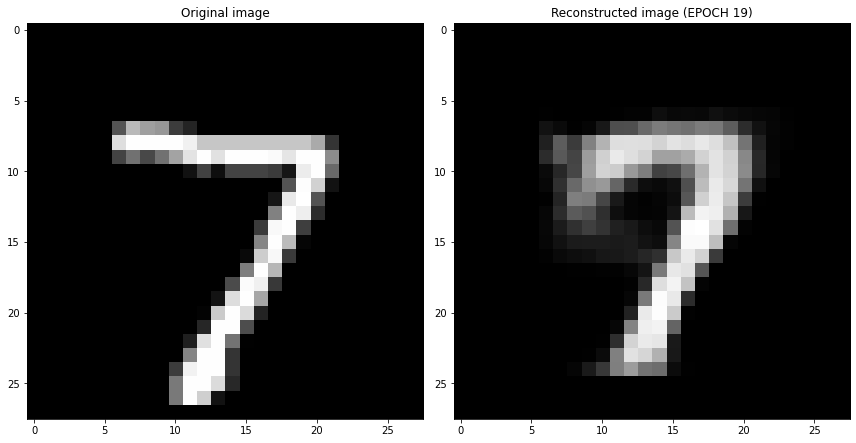

EPOCH 20/30
	 partial train loss (single batch): 0.044482
	 partial train loss (single batch): 0.044594
	 partial train loss (single batch): 0.045014
	 partial train loss (single batch): 0.042914
	 partial train loss (single batch): 0.046948
	 partial train loss (single batch): 0.045248
	 partial train loss (single batch): 0.045197
	 partial train loss (single batch): 0.045533
	 partial train loss (single batch): 0.044760
	 partial train loss (single batch): 0.044162
	 partial train loss (single batch): 0.045392
	 partial train loss (single batch): 0.045775
	 partial train loss (single batch): 0.044902
	 partial train loss (single batch): 0.044148
	 partial train loss (single batch): 0.045629
	 partial train loss (single batch): 0.045392
	 partial train loss (single batch): 0.045129
	 partial train loss (single batch): 0.042557
	 partial train loss (single batch): 0.044335
	 partial train loss (single batch): 0.043677
	 partial train loss (single batch): 0.044132
	 partial train loss (

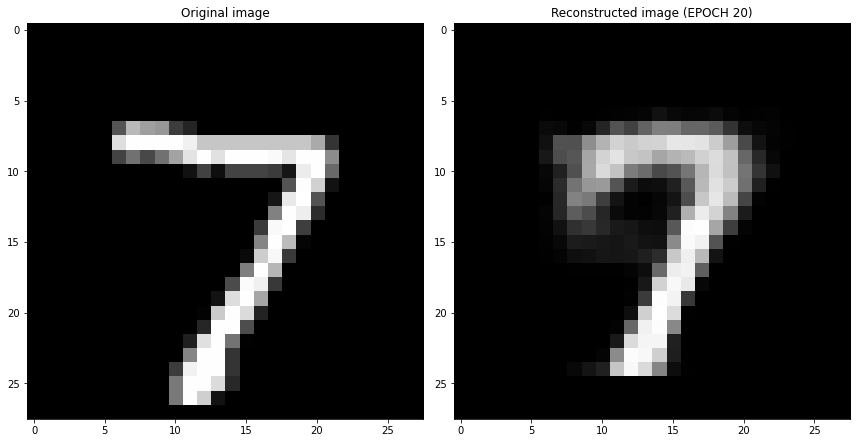

EPOCH 21/30
	 partial train loss (single batch): 0.045876
	 partial train loss (single batch): 0.045892
	 partial train loss (single batch): 0.043656
	 partial train loss (single batch): 0.044547
	 partial train loss (single batch): 0.044826
	 partial train loss (single batch): 0.045614
	 partial train loss (single batch): 0.044422
	 partial train loss (single batch): 0.046092
	 partial train loss (single batch): 0.045001
	 partial train loss (single batch): 0.046143
	 partial train loss (single batch): 0.046513
	 partial train loss (single batch): 0.043563
	 partial train loss (single batch): 0.043284
	 partial train loss (single batch): 0.046695
	 partial train loss (single batch): 0.046090
	 partial train loss (single batch): 0.046175
	 partial train loss (single batch): 0.045703
	 partial train loss (single batch): 0.045831
	 partial train loss (single batch): 0.045691
	 partial train loss (single batch): 0.043500
	 partial train loss (single batch): 0.044789
	 partial train loss (

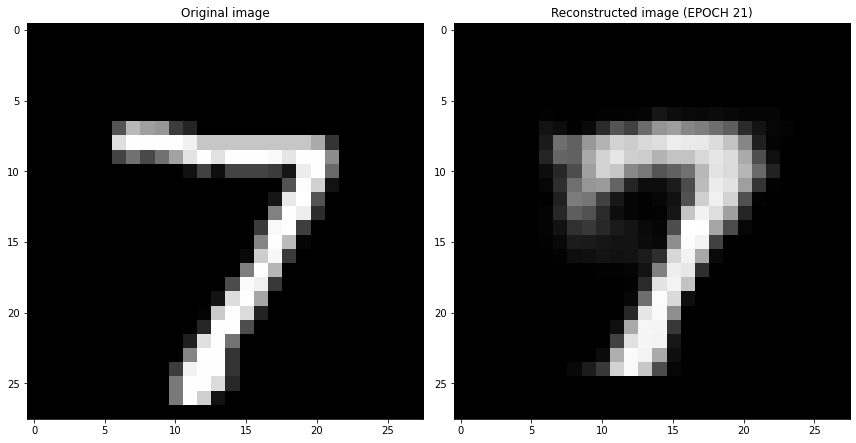

EPOCH 22/30
	 partial train loss (single batch): 0.045603
	 partial train loss (single batch): 0.042498
	 partial train loss (single batch): 0.044953
	 partial train loss (single batch): 0.047730
	 partial train loss (single batch): 0.046458
	 partial train loss (single batch): 0.044856
	 partial train loss (single batch): 0.044379
	 partial train loss (single batch): 0.046113
	 partial train loss (single batch): 0.043705
	 partial train loss (single batch): 0.044323
	 partial train loss (single batch): 0.046470
	 partial train loss (single batch): 0.043921
	 partial train loss (single batch): 0.044383
	 partial train loss (single batch): 0.046230
	 partial train loss (single batch): 0.045840
	 partial train loss (single batch): 0.046382
	 partial train loss (single batch): 0.043909
	 partial train loss (single batch): 0.045292
	 partial train loss (single batch): 0.044380
	 partial train loss (single batch): 0.045005
	 partial train loss (single batch): 0.044259
	 partial train loss (

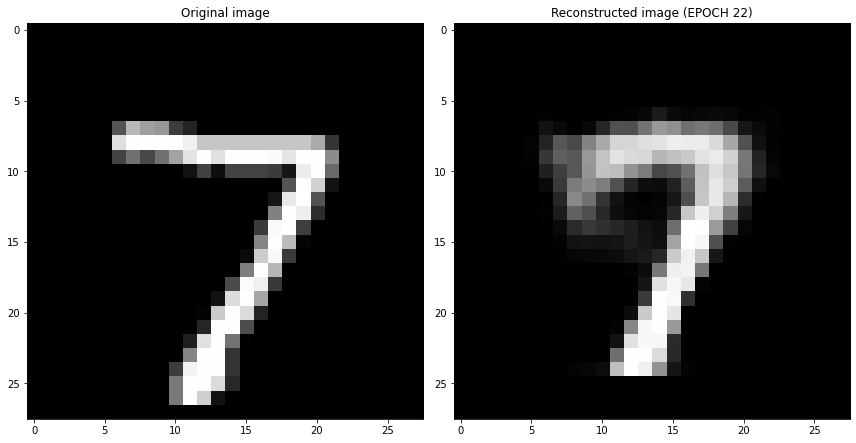

EPOCH 23/30
	 partial train loss (single batch): 0.043422
	 partial train loss (single batch): 0.044742
	 partial train loss (single batch): 0.043861
	 partial train loss (single batch): 0.044954
	 partial train loss (single batch): 0.044796
	 partial train loss (single batch): 0.042920
	 partial train loss (single batch): 0.043071
	 partial train loss (single batch): 0.043305
	 partial train loss (single batch): 0.043498
	 partial train loss (single batch): 0.043972
	 partial train loss (single batch): 0.045823
	 partial train loss (single batch): 0.042541
	 partial train loss (single batch): 0.042510
	 partial train loss (single batch): 0.045815
	 partial train loss (single batch): 0.045313
	 partial train loss (single batch): 0.045094
	 partial train loss (single batch): 0.044395
	 partial train loss (single batch): 0.044130
	 partial train loss (single batch): 0.045243
	 partial train loss (single batch): 0.045592
	 partial train loss (single batch): 0.044248
	 partial train loss (

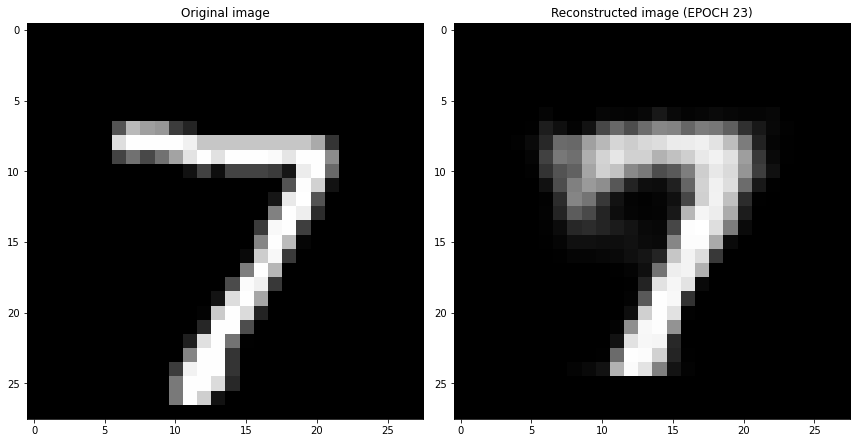

EPOCH 24/30
	 partial train loss (single batch): 0.045265
	 partial train loss (single batch): 0.044372
	 partial train loss (single batch): 0.040976
	 partial train loss (single batch): 0.044649
	 partial train loss (single batch): 0.043129
	 partial train loss (single batch): 0.042759
	 partial train loss (single batch): 0.043759
	 partial train loss (single batch): 0.043254
	 partial train loss (single batch): 0.042246
	 partial train loss (single batch): 0.044214
	 partial train loss (single batch): 0.043631
	 partial train loss (single batch): 0.043221
	 partial train loss (single batch): 0.043878
	 partial train loss (single batch): 0.043322
	 partial train loss (single batch): 0.042195
	 partial train loss (single batch): 0.044747
	 partial train loss (single batch): 0.044959
	 partial train loss (single batch): 0.043658
	 partial train loss (single batch): 0.042026
	 partial train loss (single batch): 0.043675
	 partial train loss (single batch): 0.044046
	 partial train loss (

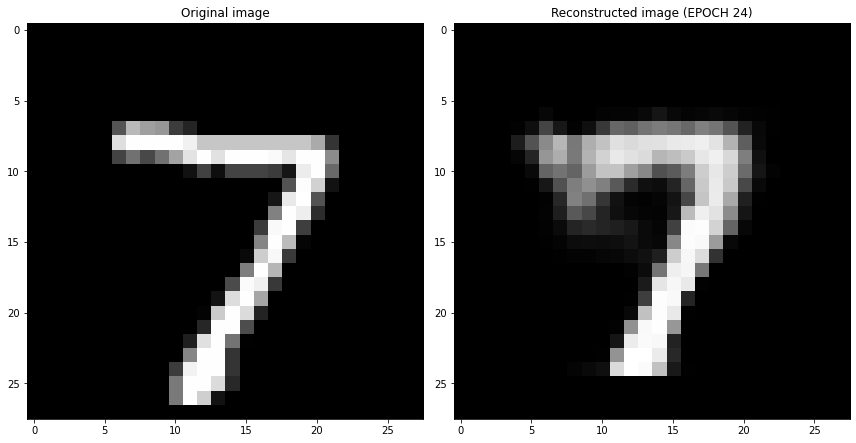

EPOCH 25/30
	 partial train loss (single batch): 0.043227
	 partial train loss (single batch): 0.042829
	 partial train loss (single batch): 0.043937
	 partial train loss (single batch): 0.043196
	 partial train loss (single batch): 0.042373
	 partial train loss (single batch): 0.041582
	 partial train loss (single batch): 0.044066
	 partial train loss (single batch): 0.044056
	 partial train loss (single batch): 0.042092
	 partial train loss (single batch): 0.042318
	 partial train loss (single batch): 0.041558
	 partial train loss (single batch): 0.042689
	 partial train loss (single batch): 0.043536
	 partial train loss (single batch): 0.044287
	 partial train loss (single batch): 0.041980
	 partial train loss (single batch): 0.041819
	 partial train loss (single batch): 0.043514
	 partial train loss (single batch): 0.043807
	 partial train loss (single batch): 0.043778
	 partial train loss (single batch): 0.042326
	 partial train loss (single batch): 0.042283
	 partial train loss (

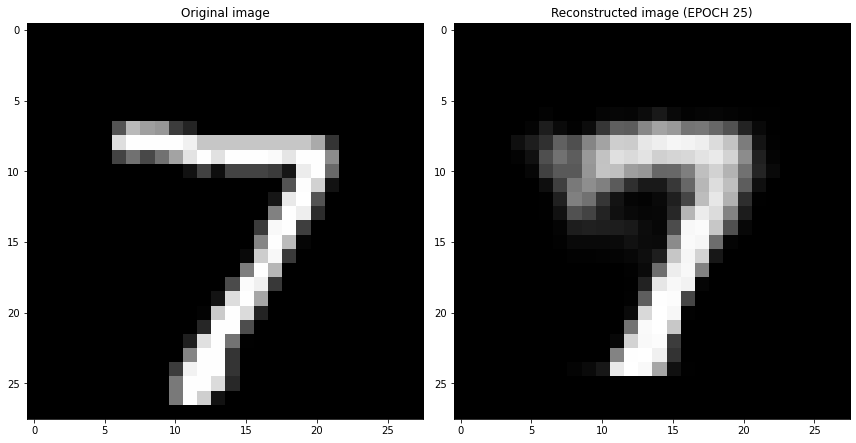

EPOCH 26/30
	 partial train loss (single batch): 0.042449
	 partial train loss (single batch): 0.042101
	 partial train loss (single batch): 0.043132
	 partial train loss (single batch): 0.042799
	 partial train loss (single batch): 0.043302
	 partial train loss (single batch): 0.042450
	 partial train loss (single batch): 0.043389
	 partial train loss (single batch): 0.041249
	 partial train loss (single batch): 0.042297
	 partial train loss (single batch): 0.044005
	 partial train loss (single batch): 0.043560
	 partial train loss (single batch): 0.043749
	 partial train loss (single batch): 0.043818
	 partial train loss (single batch): 0.042571
	 partial train loss (single batch): 0.044368
	 partial train loss (single batch): 0.043638
	 partial train loss (single batch): 0.041381
	 partial train loss (single batch): 0.042387
	 partial train loss (single batch): 0.043896
	 partial train loss (single batch): 0.043470
	 partial train loss (single batch): 0.042973
	 partial train loss (

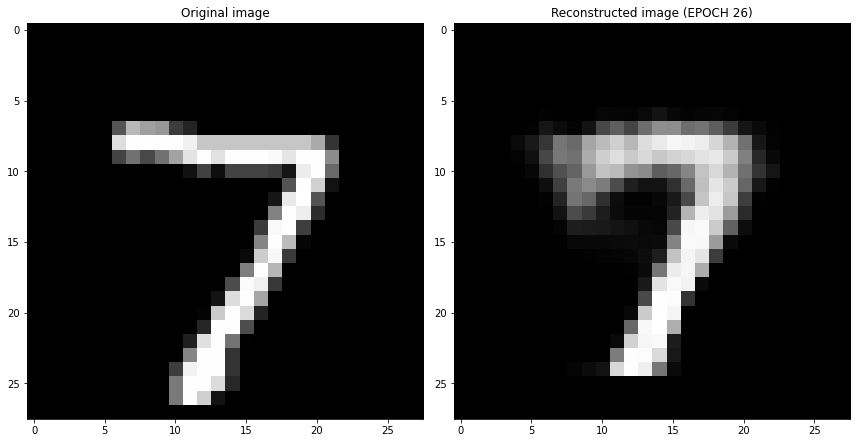

EPOCH 27/30
	 partial train loss (single batch): 0.042081
	 partial train loss (single batch): 0.043566
	 partial train loss (single batch): 0.044842
	 partial train loss (single batch): 0.040552
	 partial train loss (single batch): 0.043327
	 partial train loss (single batch): 0.042992
	 partial train loss (single batch): 0.042778
	 partial train loss (single batch): 0.042294
	 partial train loss (single batch): 0.041407
	 partial train loss (single batch): 0.042837
	 partial train loss (single batch): 0.042341
	 partial train loss (single batch): 0.040924
	 partial train loss (single batch): 0.041669
	 partial train loss (single batch): 0.042446
	 partial train loss (single batch): 0.041435
	 partial train loss (single batch): 0.043863
	 partial train loss (single batch): 0.042751
	 partial train loss (single batch): 0.044307
	 partial train loss (single batch): 0.041091
	 partial train loss (single batch): 0.043504
	 partial train loss (single batch): 0.042814
	 partial train loss (

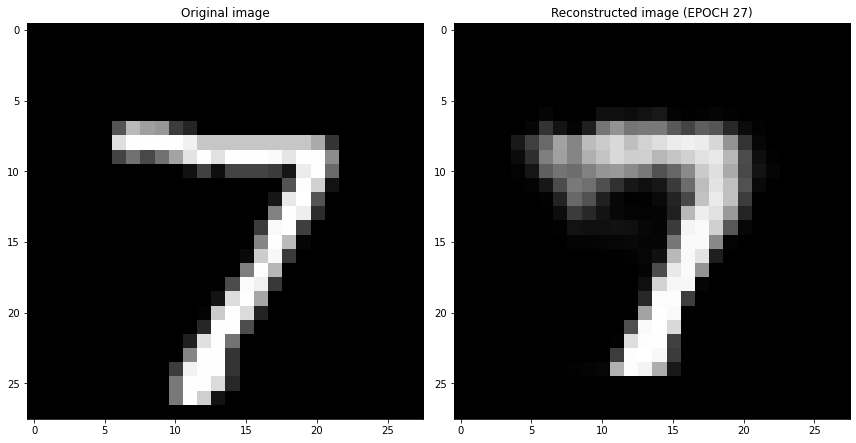

EPOCH 28/30
	 partial train loss (single batch): 0.042242
	 partial train loss (single batch): 0.039869
	 partial train loss (single batch): 0.043535
	 partial train loss (single batch): 0.042588
	 partial train loss (single batch): 0.043390
	 partial train loss (single batch): 0.041562
	 partial train loss (single batch): 0.043203
	 partial train loss (single batch): 0.041288
	 partial train loss (single batch): 0.042240
	 partial train loss (single batch): 0.042823
	 partial train loss (single batch): 0.041279
	 partial train loss (single batch): 0.041575
	 partial train loss (single batch): 0.042314
	 partial train loss (single batch): 0.042353
	 partial train loss (single batch): 0.042039
	 partial train loss (single batch): 0.041082
	 partial train loss (single batch): 0.044116
	 partial train loss (single batch): 0.041775
	 partial train loss (single batch): 0.042076
	 partial train loss (single batch): 0.044401
	 partial train loss (single batch): 0.042951
	 partial train loss (

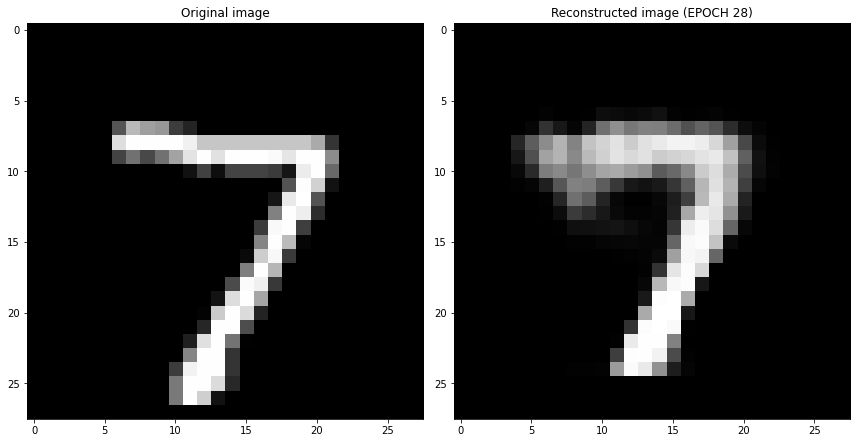

EPOCH 29/30
	 partial train loss (single batch): 0.041645
	 partial train loss (single batch): 0.042636
	 partial train loss (single batch): 0.039761
	 partial train loss (single batch): 0.044036
	 partial train loss (single batch): 0.043191
	 partial train loss (single batch): 0.039928
	 partial train loss (single batch): 0.043128
	 partial train loss (single batch): 0.041192
	 partial train loss (single batch): 0.041806
	 partial train loss (single batch): 0.043689
	 partial train loss (single batch): 0.042840
	 partial train loss (single batch): 0.042996
	 partial train loss (single batch): 0.043839
	 partial train loss (single batch): 0.044110
	 partial train loss (single batch): 0.043456
	 partial train loss (single batch): 0.041737
	 partial train loss (single batch): 0.043225
	 partial train loss (single batch): 0.041692
	 partial train loss (single batch): 0.042216
	 partial train loss (single batch): 0.042412
	 partial train loss (single batch): 0.041200
	 partial train loss (

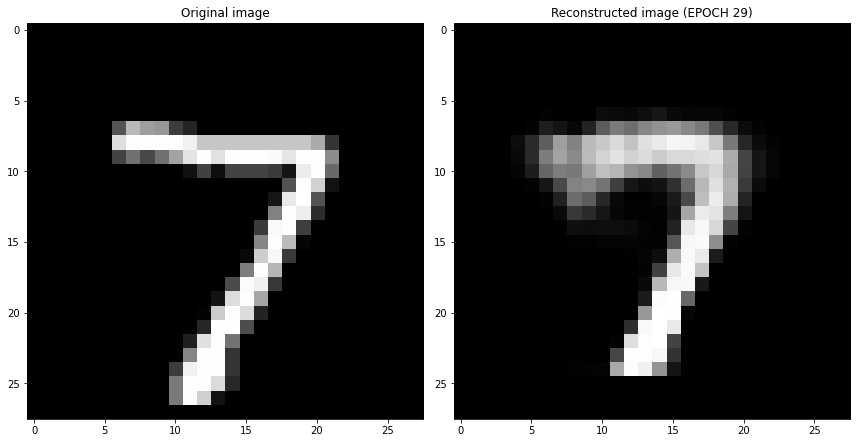

EPOCH 30/30
	 partial train loss (single batch): 0.041949
	 partial train loss (single batch): 0.043689
	 partial train loss (single batch): 0.042934
	 partial train loss (single batch): 0.040712
	 partial train loss (single batch): 0.042171
	 partial train loss (single batch): 0.043966
	 partial train loss (single batch): 0.042277
	 partial train loss (single batch): 0.042295
	 partial train loss (single batch): 0.042049
	 partial train loss (single batch): 0.040799
	 partial train loss (single batch): 0.041152
	 partial train loss (single batch): 0.041739
	 partial train loss (single batch): 0.041613
	 partial train loss (single batch): 0.043336
	 partial train loss (single batch): 0.041239
	 partial train loss (single batch): 0.041446
	 partial train loss (single batch): 0.043985
	 partial train loss (single batch): 0.040891
	 partial train loss (single batch): 0.040869
	 partial train loss (single batch): 0.040900
	 partial train loss (single batch): 0.040540
	 partial train loss (

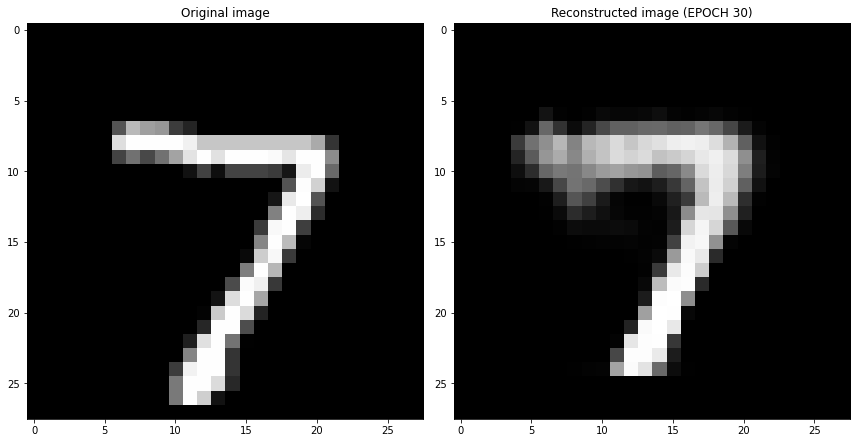

Cross validation fold number= 6/6
EPOCH 1/30
	 partial train loss (single batch): 0.226920
	 partial train loss (single batch): 0.226330
	 partial train loss (single batch): 0.225525
	 partial train loss (single batch): 0.224663
	 partial train loss (single batch): 0.223810
	 partial train loss (single batch): 0.222776
	 partial train loss (single batch): 0.222280
	 partial train loss (single batch): 0.221548
	 partial train loss (single batch): 0.220950
	 partial train loss (single batch): 0.220413
	 partial train loss (single batch): 0.219521
	 partial train loss (single batch): 0.218918
	 partial train loss (single batch): 0.218709
	 partial train loss (single batch): 0.217299
	 partial train loss (single batch): 0.216565
	 partial train loss (single batch): 0.216036
	 partial train loss (single batch): 0.215281
	 partial train loss (single batch): 0.214088
	 partial train loss (single batch): 0.213580
	 partial train loss (single batch): 0.212681
	 partial train loss (single batch)

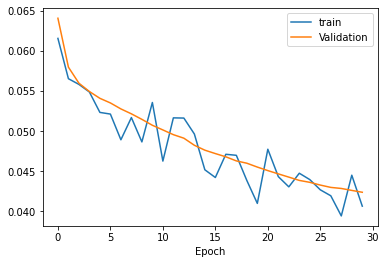

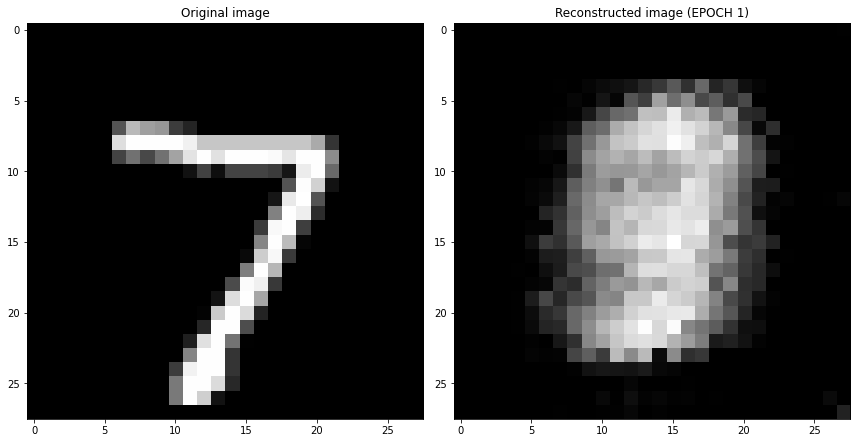

EPOCH 2/30
	 partial train loss (single batch): 0.066732
	 partial train loss (single batch): 0.065589
	 partial train loss (single batch): 0.066682
	 partial train loss (single batch): 0.067201
	 partial train loss (single batch): 0.063889
	 partial train loss (single batch): 0.065539
	 partial train loss (single batch): 0.066270
	 partial train loss (single batch): 0.065705
	 partial train loss (single batch): 0.064712
	 partial train loss (single batch): 0.063935
	 partial train loss (single batch): 0.065936
	 partial train loss (single batch): 0.065742
	 partial train loss (single batch): 0.063834
	 partial train loss (single batch): 0.063258
	 partial train loss (single batch): 0.066213
	 partial train loss (single batch): 0.066812
	 partial train loss (single batch): 0.065781
	 partial train loss (single batch): 0.064788
	 partial train loss (single batch): 0.066468
	 partial train loss (single batch): 0.065415
	 partial train loss (single batch): 0.064158
	 partial train loss (s

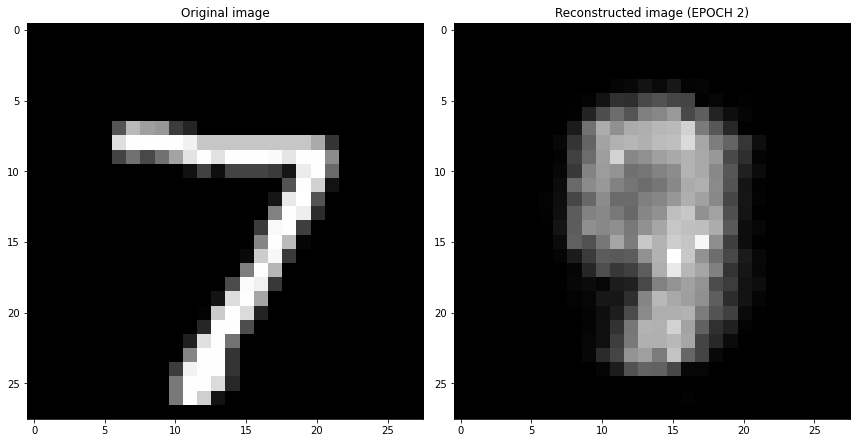

EPOCH 3/30
	 partial train loss (single batch): 0.059749
	 partial train loss (single batch): 0.057443
	 partial train loss (single batch): 0.056995
	 partial train loss (single batch): 0.057416
	 partial train loss (single batch): 0.058337
	 partial train loss (single batch): 0.057424
	 partial train loss (single batch): 0.058327
	 partial train loss (single batch): 0.057429
	 partial train loss (single batch): 0.057671
	 partial train loss (single batch): 0.057857
	 partial train loss (single batch): 0.059565
	 partial train loss (single batch): 0.058619
	 partial train loss (single batch): 0.058185
	 partial train loss (single batch): 0.058250
	 partial train loss (single batch): 0.057132
	 partial train loss (single batch): 0.057281
	 partial train loss (single batch): 0.058980
	 partial train loss (single batch): 0.058929
	 partial train loss (single batch): 0.058164
	 partial train loss (single batch): 0.057183
	 partial train loss (single batch): 0.059502
	 partial train loss (s

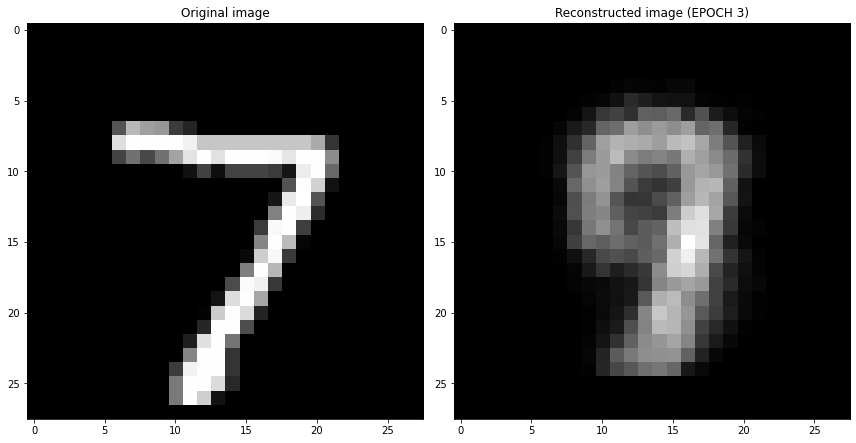

EPOCH 4/30
	 partial train loss (single batch): 0.055442
	 partial train loss (single batch): 0.055224
	 partial train loss (single batch): 0.053634
	 partial train loss (single batch): 0.055159
	 partial train loss (single batch): 0.055503
	 partial train loss (single batch): 0.054684
	 partial train loss (single batch): 0.054605
	 partial train loss (single batch): 0.054183
	 partial train loss (single batch): 0.053879
	 partial train loss (single batch): 0.053493
	 partial train loss (single batch): 0.056962
	 partial train loss (single batch): 0.054828
	 partial train loss (single batch): 0.057442
	 partial train loss (single batch): 0.053726
	 partial train loss (single batch): 0.056295
	 partial train loss (single batch): 0.055243
	 partial train loss (single batch): 0.055318
	 partial train loss (single batch): 0.054964
	 partial train loss (single batch): 0.054024
	 partial train loss (single batch): 0.053925
	 partial train loss (single batch): 0.055207
	 partial train loss (s

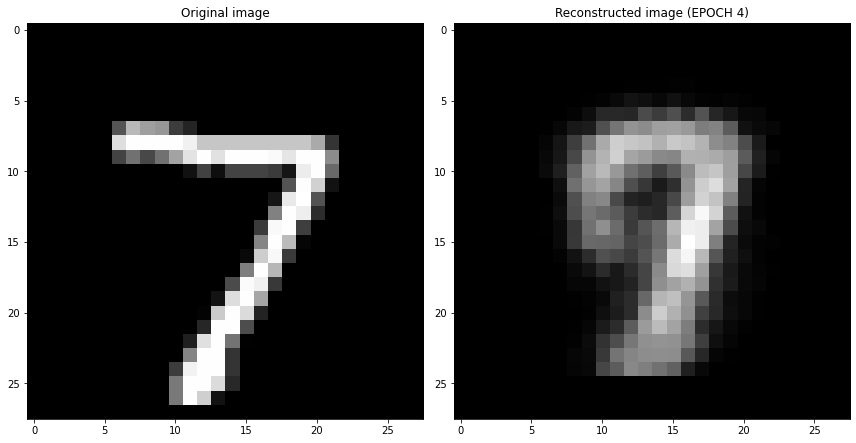

EPOCH 5/30
	 partial train loss (single batch): 0.052769
	 partial train loss (single batch): 0.055651
	 partial train loss (single batch): 0.053245
	 partial train loss (single batch): 0.053027
	 partial train loss (single batch): 0.054738
	 partial train loss (single batch): 0.054039
	 partial train loss (single batch): 0.052255
	 partial train loss (single batch): 0.051907
	 partial train loss (single batch): 0.052270
	 partial train loss (single batch): 0.055154
	 partial train loss (single batch): 0.051700
	 partial train loss (single batch): 0.052321
	 partial train loss (single batch): 0.053200
	 partial train loss (single batch): 0.053704
	 partial train loss (single batch): 0.053328
	 partial train loss (single batch): 0.050173
	 partial train loss (single batch): 0.055194
	 partial train loss (single batch): 0.055480
	 partial train loss (single batch): 0.053145
	 partial train loss (single batch): 0.053404
	 partial train loss (single batch): 0.053832
	 partial train loss (s

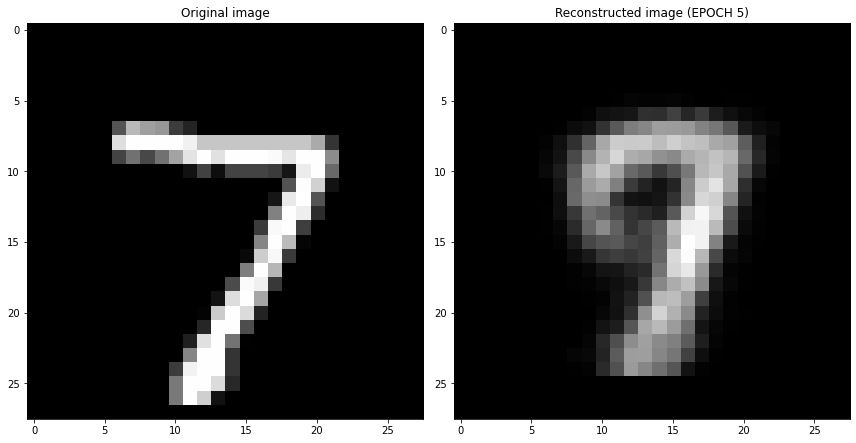

EPOCH 6/30
	 partial train loss (single batch): 0.051649
	 partial train loss (single batch): 0.052050
	 partial train loss (single batch): 0.054354
	 partial train loss (single batch): 0.052510
	 partial train loss (single batch): 0.050983
	 partial train loss (single batch): 0.049967
	 partial train loss (single batch): 0.050775
	 partial train loss (single batch): 0.053478
	 partial train loss (single batch): 0.053521
	 partial train loss (single batch): 0.052369
	 partial train loss (single batch): 0.050674
	 partial train loss (single batch): 0.051630
	 partial train loss (single batch): 0.053220
	 partial train loss (single batch): 0.051945
	 partial train loss (single batch): 0.052611
	 partial train loss (single batch): 0.049406
	 partial train loss (single batch): 0.050300
	 partial train loss (single batch): 0.052135
	 partial train loss (single batch): 0.051355
	 partial train loss (single batch): 0.053729
	 partial train loss (single batch): 0.052518
	 partial train loss (s

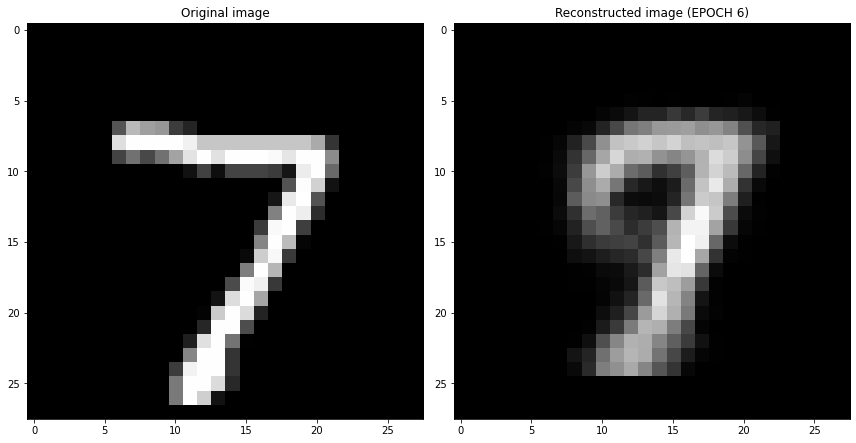

EPOCH 7/30
	 partial train loss (single batch): 0.052895
	 partial train loss (single batch): 0.051682
	 partial train loss (single batch): 0.051849
	 partial train loss (single batch): 0.052994
	 partial train loss (single batch): 0.053226
	 partial train loss (single batch): 0.051541
	 partial train loss (single batch): 0.053994
	 partial train loss (single batch): 0.050686
	 partial train loss (single batch): 0.049326
	 partial train loss (single batch): 0.051609
	 partial train loss (single batch): 0.052521
	 partial train loss (single batch): 0.049714
	 partial train loss (single batch): 0.050064
	 partial train loss (single batch): 0.051776
	 partial train loss (single batch): 0.050776
	 partial train loss (single batch): 0.050173
	 partial train loss (single batch): 0.048419
	 partial train loss (single batch): 0.050510
	 partial train loss (single batch): 0.048888
	 partial train loss (single batch): 0.049582
	 partial train loss (single batch): 0.049564
	 partial train loss (s

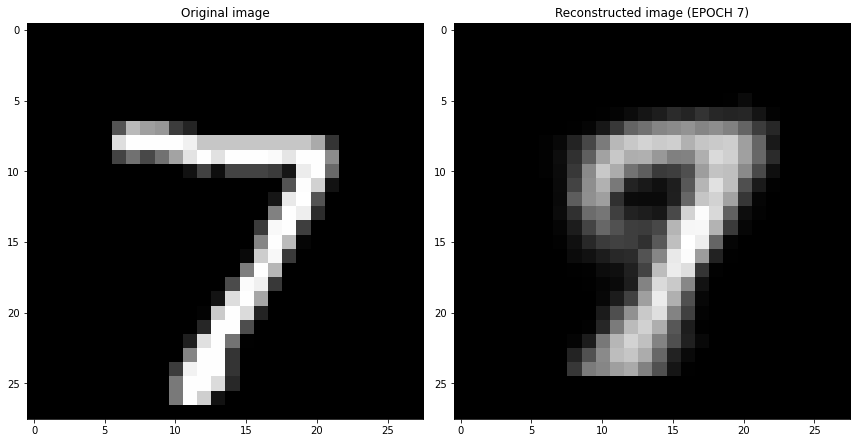

EPOCH 8/30
	 partial train loss (single batch): 0.049009
	 partial train loss (single batch): 0.049012
	 partial train loss (single batch): 0.051643
	 partial train loss (single batch): 0.049406
	 partial train loss (single batch): 0.048684
	 partial train loss (single batch): 0.051704
	 partial train loss (single batch): 0.048417
	 partial train loss (single batch): 0.047821
	 partial train loss (single batch): 0.051903
	 partial train loss (single batch): 0.050029
	 partial train loss (single batch): 0.048675
	 partial train loss (single batch): 0.048975
	 partial train loss (single batch): 0.051557
	 partial train loss (single batch): 0.048495
	 partial train loss (single batch): 0.049409
	 partial train loss (single batch): 0.048701
	 partial train loss (single batch): 0.049128
	 partial train loss (single batch): 0.049667
	 partial train loss (single batch): 0.047101
	 partial train loss (single batch): 0.049676
	 partial train loss (single batch): 0.051713
	 partial train loss (s

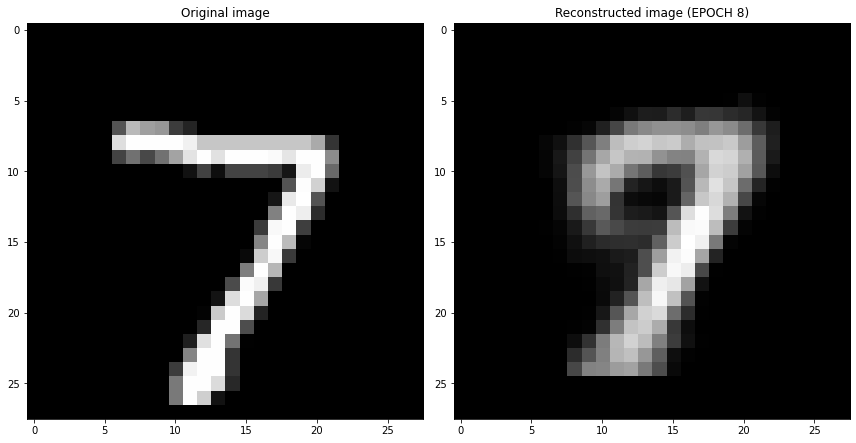

EPOCH 9/30
	 partial train loss (single batch): 0.047559
	 partial train loss (single batch): 0.048669
	 partial train loss (single batch): 0.047488
	 partial train loss (single batch): 0.049649
	 partial train loss (single batch): 0.046805
	 partial train loss (single batch): 0.049015
	 partial train loss (single batch): 0.049763
	 partial train loss (single batch): 0.047654
	 partial train loss (single batch): 0.047821
	 partial train loss (single batch): 0.047326
	 partial train loss (single batch): 0.048692
	 partial train loss (single batch): 0.049344
	 partial train loss (single batch): 0.048793
	 partial train loss (single batch): 0.047616
	 partial train loss (single batch): 0.048944
	 partial train loss (single batch): 0.048049
	 partial train loss (single batch): 0.049413
	 partial train loss (single batch): 0.048930
	 partial train loss (single batch): 0.047691
	 partial train loss (single batch): 0.050454
	 partial train loss (single batch): 0.047066
	 partial train loss (s

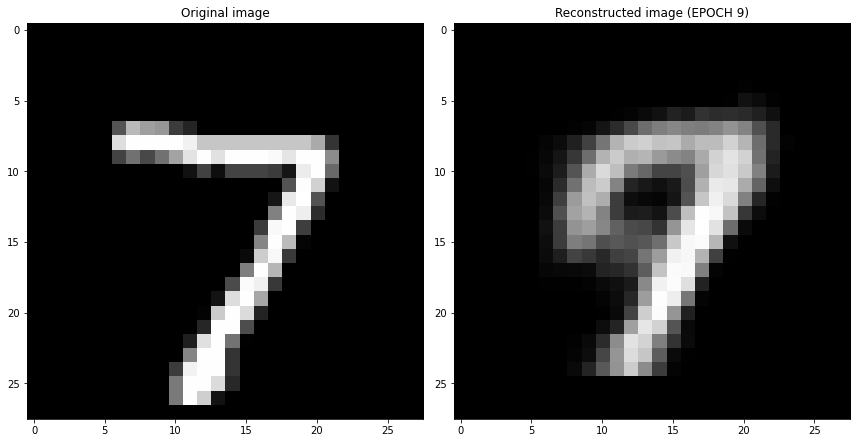

EPOCH 10/30
	 partial train loss (single batch): 0.048086
	 partial train loss (single batch): 0.047644
	 partial train loss (single batch): 0.046886
	 partial train loss (single batch): 0.048869
	 partial train loss (single batch): 0.048796
	 partial train loss (single batch): 0.046846
	 partial train loss (single batch): 0.046042
	 partial train loss (single batch): 0.046934
	 partial train loss (single batch): 0.046668
	 partial train loss (single batch): 0.047609
	 partial train loss (single batch): 0.049563
	 partial train loss (single batch): 0.048750
	 partial train loss (single batch): 0.049152
	 partial train loss (single batch): 0.050399
	 partial train loss (single batch): 0.047866
	 partial train loss (single batch): 0.047835
	 partial train loss (single batch): 0.048181
	 partial train loss (single batch): 0.048604
	 partial train loss (single batch): 0.045983
	 partial train loss (single batch): 0.048313
	 partial train loss (single batch): 0.045328
	 partial train loss (

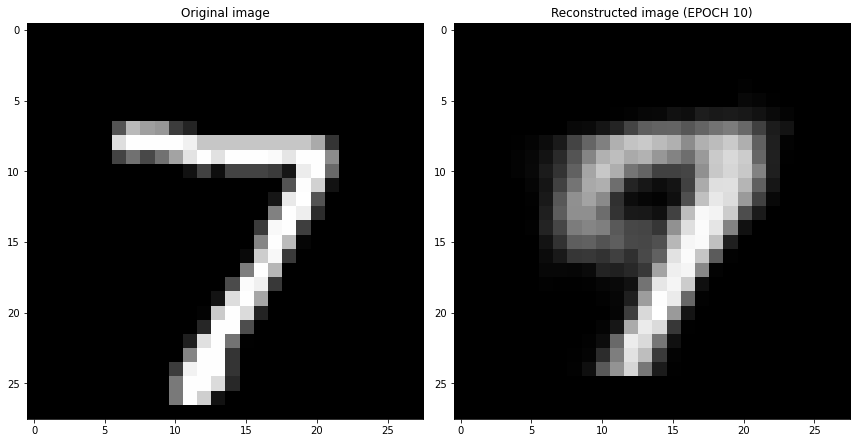

EPOCH 11/30
	 partial train loss (single batch): 0.047466
	 partial train loss (single batch): 0.045420
	 partial train loss (single batch): 0.046314
	 partial train loss (single batch): 0.047029
	 partial train loss (single batch): 0.045720
	 partial train loss (single batch): 0.045964
	 partial train loss (single batch): 0.045657
	 partial train loss (single batch): 0.047779
	 partial train loss (single batch): 0.047521
	 partial train loss (single batch): 0.048048
	 partial train loss (single batch): 0.048037
	 partial train loss (single batch): 0.046350
	 partial train loss (single batch): 0.046676
	 partial train loss (single batch): 0.044734
	 partial train loss (single batch): 0.045935
	 partial train loss (single batch): 0.046543
	 partial train loss (single batch): 0.048053
	 partial train loss (single batch): 0.047468
	 partial train loss (single batch): 0.046970
	 partial train loss (single batch): 0.046191
	 partial train loss (single batch): 0.045189
	 partial train loss (

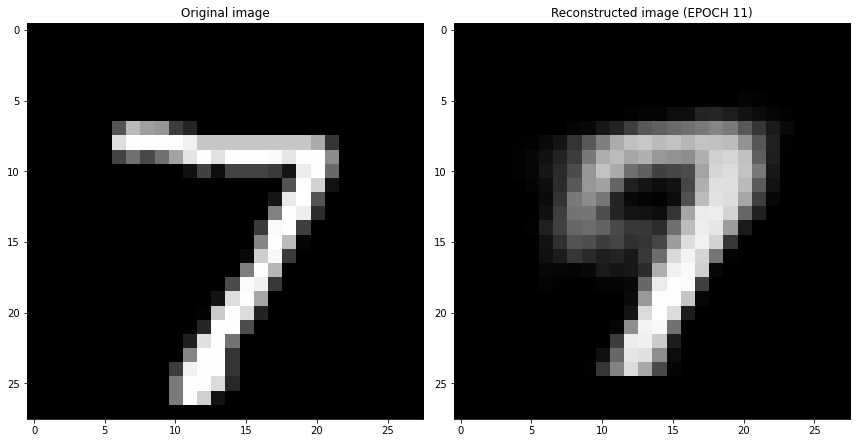

EPOCH 12/30
	 partial train loss (single batch): 0.046489
	 partial train loss (single batch): 0.047858
	 partial train loss (single batch): 0.045572
	 partial train loss (single batch): 0.046250
	 partial train loss (single batch): 0.044291
	 partial train loss (single batch): 0.043406
	 partial train loss (single batch): 0.045553
	 partial train loss (single batch): 0.045037
	 partial train loss (single batch): 0.045464
	 partial train loss (single batch): 0.048185
	 partial train loss (single batch): 0.046801
	 partial train loss (single batch): 0.045581
	 partial train loss (single batch): 0.044958
	 partial train loss (single batch): 0.046016
	 partial train loss (single batch): 0.044943
	 partial train loss (single batch): 0.045913
	 partial train loss (single batch): 0.048791
	 partial train loss (single batch): 0.044024
	 partial train loss (single batch): 0.044857
	 partial train loss (single batch): 0.043512
	 partial train loss (single batch): 0.045829
	 partial train loss (

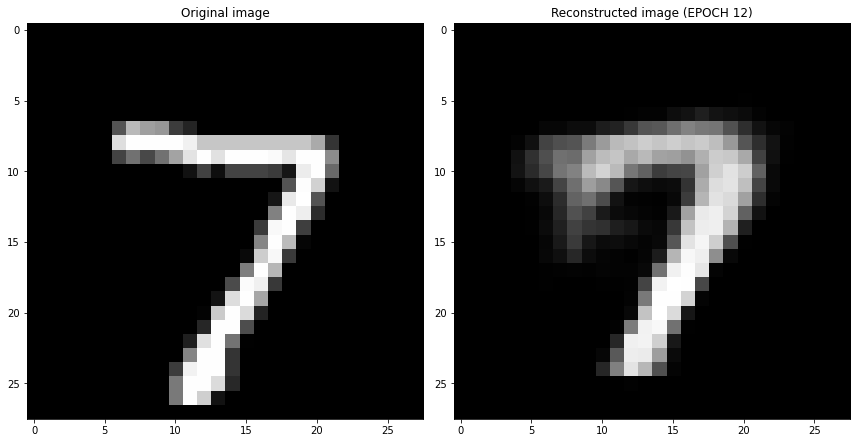

EPOCH 13/30
	 partial train loss (single batch): 0.046973
	 partial train loss (single batch): 0.046900
	 partial train loss (single batch): 0.045613
	 partial train loss (single batch): 0.045953
	 partial train loss (single batch): 0.046870
	 partial train loss (single batch): 0.044213
	 partial train loss (single batch): 0.044003
	 partial train loss (single batch): 0.044528
	 partial train loss (single batch): 0.046718
	 partial train loss (single batch): 0.046301
	 partial train loss (single batch): 0.044195
	 partial train loss (single batch): 0.045406
	 partial train loss (single batch): 0.045572
	 partial train loss (single batch): 0.043987
	 partial train loss (single batch): 0.044479
	 partial train loss (single batch): 0.043710
	 partial train loss (single batch): 0.045938
	 partial train loss (single batch): 0.045610
	 partial train loss (single batch): 0.045194
	 partial train loss (single batch): 0.043889
	 partial train loss (single batch): 0.046077
	 partial train loss (

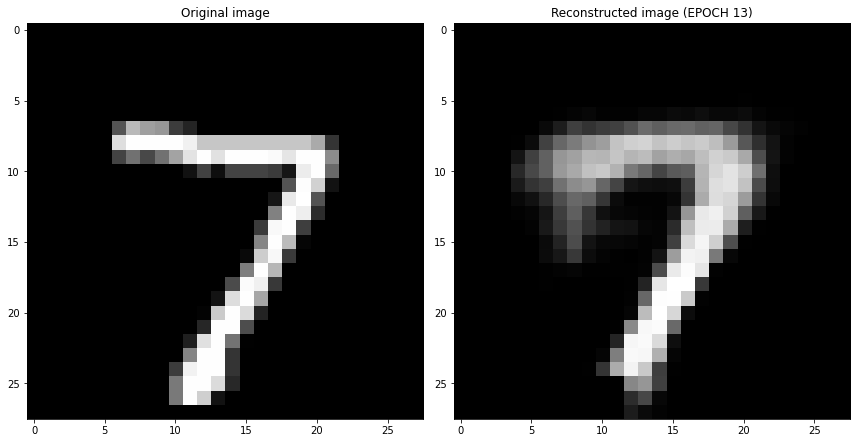

EPOCH 14/30
	 partial train loss (single batch): 0.045413
	 partial train loss (single batch): 0.042794
	 partial train loss (single batch): 0.041564
	 partial train loss (single batch): 0.043081
	 partial train loss (single batch): 0.044187
	 partial train loss (single batch): 0.042349
	 partial train loss (single batch): 0.043834
	 partial train loss (single batch): 0.047923
	 partial train loss (single batch): 0.045219
	 partial train loss (single batch): 0.045583
	 partial train loss (single batch): 0.045642
	 partial train loss (single batch): 0.044124
	 partial train loss (single batch): 0.045329
	 partial train loss (single batch): 0.042081
	 partial train loss (single batch): 0.044514
	 partial train loss (single batch): 0.045319
	 partial train loss (single batch): 0.043072
	 partial train loss (single batch): 0.045649
	 partial train loss (single batch): 0.046696
	 partial train loss (single batch): 0.045199
	 partial train loss (single batch): 0.043887
	 partial train loss (

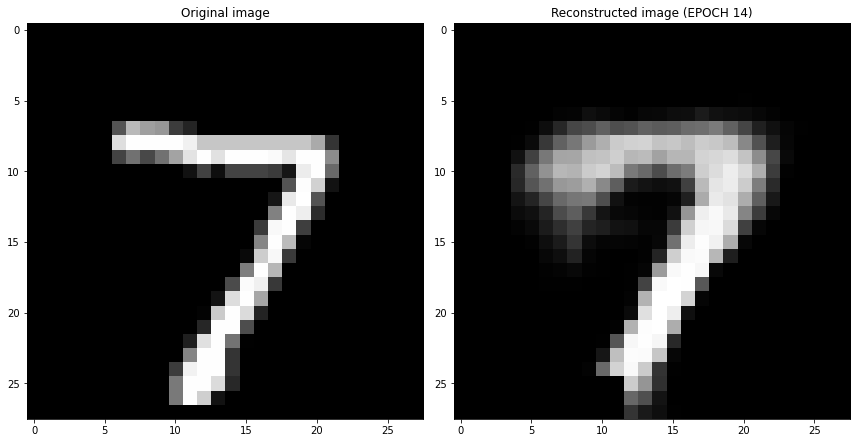

EPOCH 15/30
	 partial train loss (single batch): 0.042282
	 partial train loss (single batch): 0.044419
	 partial train loss (single batch): 0.043640
	 partial train loss (single batch): 0.044288
	 partial train loss (single batch): 0.042557
	 partial train loss (single batch): 0.043379
	 partial train loss (single batch): 0.043809
	 partial train loss (single batch): 0.045305
	 partial train loss (single batch): 0.044643
	 partial train loss (single batch): 0.042914
	 partial train loss (single batch): 0.044902
	 partial train loss (single batch): 0.043109
	 partial train loss (single batch): 0.042642
	 partial train loss (single batch): 0.043450
	 partial train loss (single batch): 0.044577
	 partial train loss (single batch): 0.044019
	 partial train loss (single batch): 0.045472
	 partial train loss (single batch): 0.041501
	 partial train loss (single batch): 0.042771
	 partial train loss (single batch): 0.041564
	 partial train loss (single batch): 0.044022
	 partial train loss (

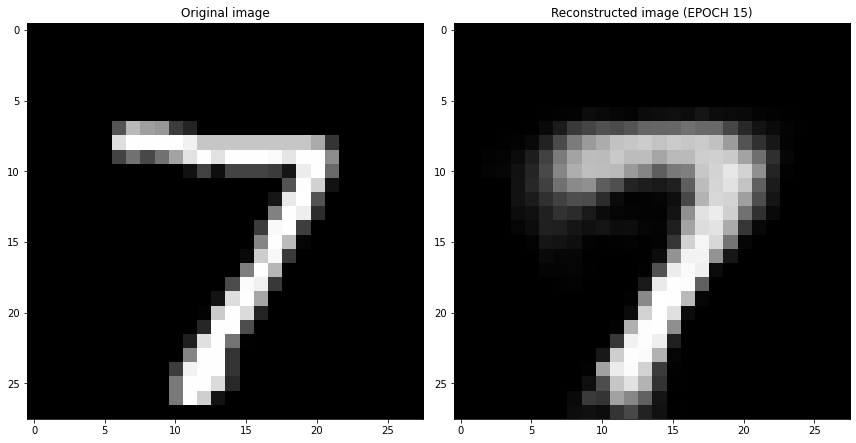

EPOCH 16/30
	 partial train loss (single batch): 0.043795
	 partial train loss (single batch): 0.043040
	 partial train loss (single batch): 0.043084
	 partial train loss (single batch): 0.043092
	 partial train loss (single batch): 0.041567
	 partial train loss (single batch): 0.043183
	 partial train loss (single batch): 0.043897
	 partial train loss (single batch): 0.045120
	 partial train loss (single batch): 0.042031
	 partial train loss (single batch): 0.044221
	 partial train loss (single batch): 0.043676
	 partial train loss (single batch): 0.042789
	 partial train loss (single batch): 0.044209
	 partial train loss (single batch): 0.043559
	 partial train loss (single batch): 0.046352
	 partial train loss (single batch): 0.043878
	 partial train loss (single batch): 0.043360
	 partial train loss (single batch): 0.044690
	 partial train loss (single batch): 0.042459
	 partial train loss (single batch): 0.043688
	 partial train loss (single batch): 0.043517
	 partial train loss (

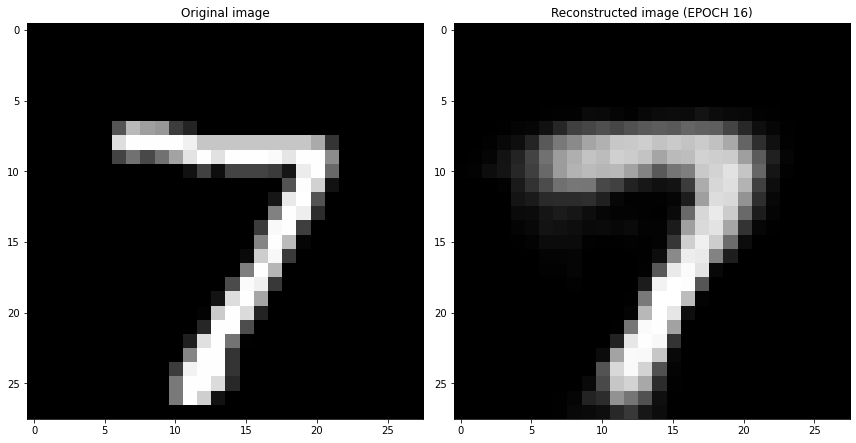

EPOCH 17/30
	 partial train loss (single batch): 0.043333
	 partial train loss (single batch): 0.042045
	 partial train loss (single batch): 0.043783
	 partial train loss (single batch): 0.043502
	 partial train loss (single batch): 0.044587
	 partial train loss (single batch): 0.042729
	 partial train loss (single batch): 0.042306
	 partial train loss (single batch): 0.043135
	 partial train loss (single batch): 0.042080
	 partial train loss (single batch): 0.042800
	 partial train loss (single batch): 0.043354
	 partial train loss (single batch): 0.042643
	 partial train loss (single batch): 0.043347
	 partial train loss (single batch): 0.043098
	 partial train loss (single batch): 0.041415
	 partial train loss (single batch): 0.043797
	 partial train loss (single batch): 0.042929
	 partial train loss (single batch): 0.044008
	 partial train loss (single batch): 0.042162
	 partial train loss (single batch): 0.042493
	 partial train loss (single batch): 0.041427
	 partial train loss (

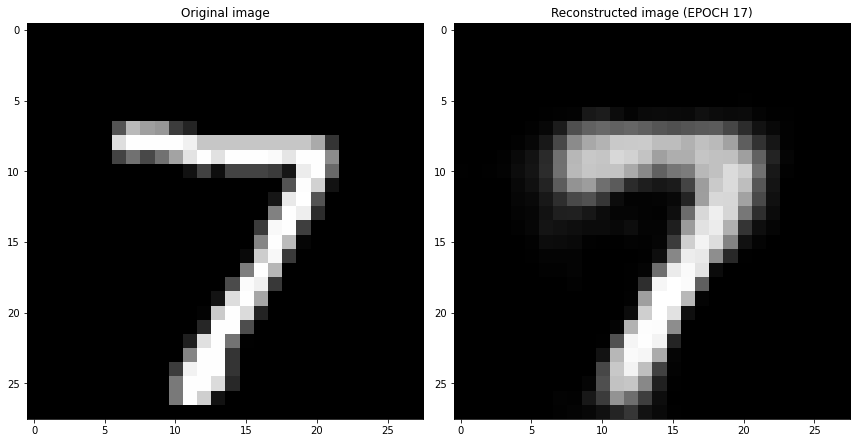

EPOCH 18/30
	 partial train loss (single batch): 0.043106
	 partial train loss (single batch): 0.041637
	 partial train loss (single batch): 0.040773
	 partial train loss (single batch): 0.043392
	 partial train loss (single batch): 0.045012
	 partial train loss (single batch): 0.041040
	 partial train loss (single batch): 0.043595
	 partial train loss (single batch): 0.041138
	 partial train loss (single batch): 0.042027
	 partial train loss (single batch): 0.043387
	 partial train loss (single batch): 0.042759
	 partial train loss (single batch): 0.042458
	 partial train loss (single batch): 0.043847
	 partial train loss (single batch): 0.041399
	 partial train loss (single batch): 0.042914
	 partial train loss (single batch): 0.041937
	 partial train loss (single batch): 0.042822
	 partial train loss (single batch): 0.041970
	 partial train loss (single batch): 0.041385
	 partial train loss (single batch): 0.044349
	 partial train loss (single batch): 0.042396
	 partial train loss (

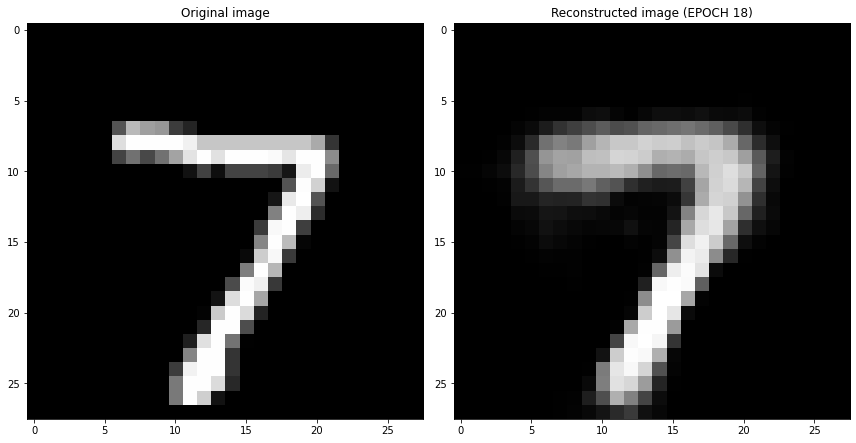

EPOCH 19/30
	 partial train loss (single batch): 0.042516
	 partial train loss (single batch): 0.042587
	 partial train loss (single batch): 0.042555
	 partial train loss (single batch): 0.042108
	 partial train loss (single batch): 0.043722
	 partial train loss (single batch): 0.041315
	 partial train loss (single batch): 0.041216
	 partial train loss (single batch): 0.042947
	 partial train loss (single batch): 0.042453
	 partial train loss (single batch): 0.041218
	 partial train loss (single batch): 0.043281
	 partial train loss (single batch): 0.043515
	 partial train loss (single batch): 0.041844
	 partial train loss (single batch): 0.040994
	 partial train loss (single batch): 0.042615
	 partial train loss (single batch): 0.041267
	 partial train loss (single batch): 0.041363
	 partial train loss (single batch): 0.042201
	 partial train loss (single batch): 0.042348
	 partial train loss (single batch): 0.042139
	 partial train loss (single batch): 0.041610
	 partial train loss (

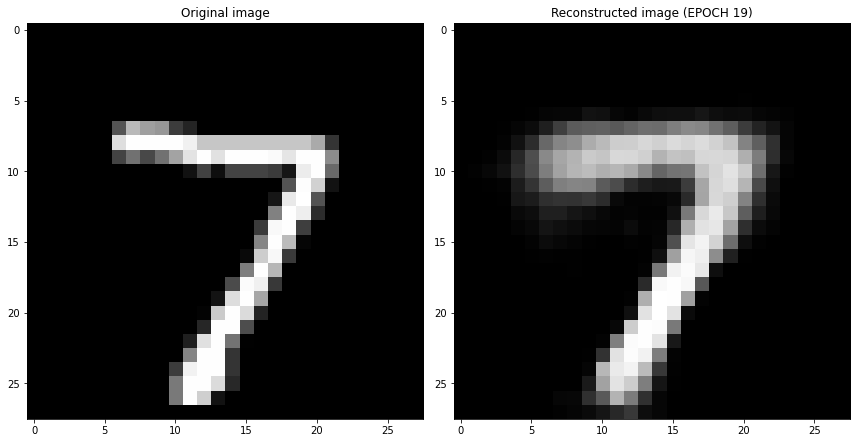

EPOCH 20/30
	 partial train loss (single batch): 0.039635
	 partial train loss (single batch): 0.042317
	 partial train loss (single batch): 0.042253
	 partial train loss (single batch): 0.041380
	 partial train loss (single batch): 0.041528
	 partial train loss (single batch): 0.040304
	 partial train loss (single batch): 0.042810
	 partial train loss (single batch): 0.042831
	 partial train loss (single batch): 0.041890
	 partial train loss (single batch): 0.040009
	 partial train loss (single batch): 0.041471
	 partial train loss (single batch): 0.041728
	 partial train loss (single batch): 0.043047
	 partial train loss (single batch): 0.042227
	 partial train loss (single batch): 0.042210
	 partial train loss (single batch): 0.042300
	 partial train loss (single batch): 0.041000
	 partial train loss (single batch): 0.043197
	 partial train loss (single batch): 0.041136
	 partial train loss (single batch): 0.041098
	 partial train loss (single batch): 0.041225
	 partial train loss (

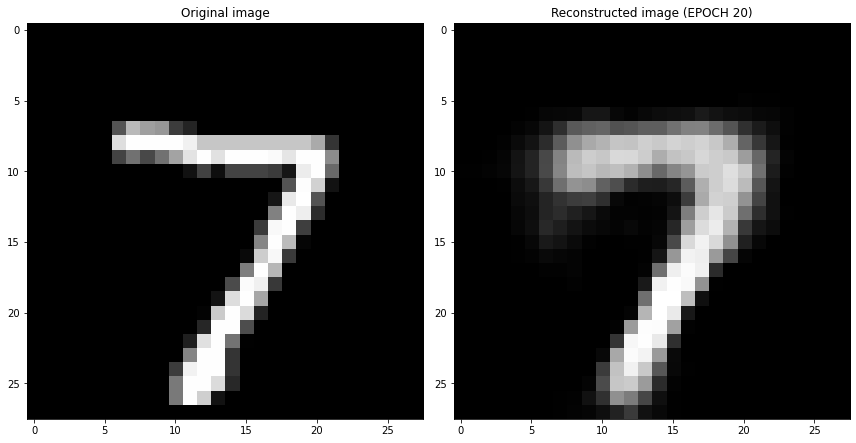

EPOCH 21/30
	 partial train loss (single batch): 0.038929
	 partial train loss (single batch): 0.041831
	 partial train loss (single batch): 0.040707
	 partial train loss (single batch): 0.039082
	 partial train loss (single batch): 0.041076
	 partial train loss (single batch): 0.041345
	 partial train loss (single batch): 0.043585
	 partial train loss (single batch): 0.040325
	 partial train loss (single batch): 0.041797
	 partial train loss (single batch): 0.040093
	 partial train loss (single batch): 0.041086
	 partial train loss (single batch): 0.042447
	 partial train loss (single batch): 0.041616
	 partial train loss (single batch): 0.042234
	 partial train loss (single batch): 0.040505
	 partial train loss (single batch): 0.040580
	 partial train loss (single batch): 0.041738
	 partial train loss (single batch): 0.040726
	 partial train loss (single batch): 0.042156
	 partial train loss (single batch): 0.039768
	 partial train loss (single batch): 0.041952
	 partial train loss (

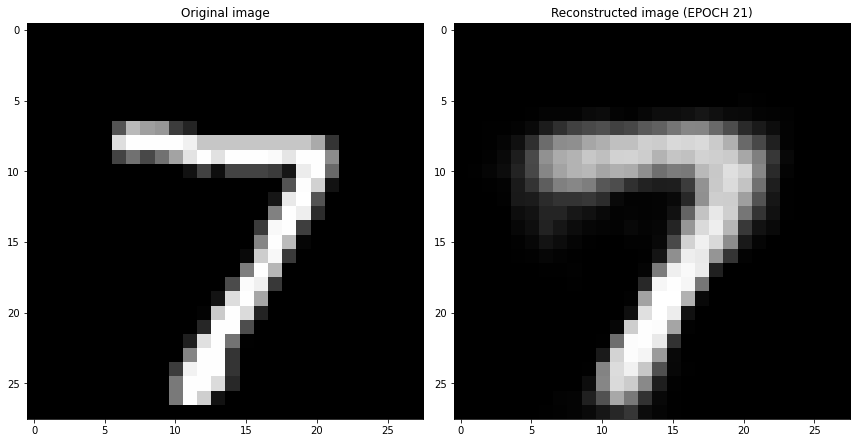

EPOCH 22/30
	 partial train loss (single batch): 0.041395
	 partial train loss (single batch): 0.040178
	 partial train loss (single batch): 0.041422
	 partial train loss (single batch): 0.043168
	 partial train loss (single batch): 0.041278
	 partial train loss (single batch): 0.040336
	 partial train loss (single batch): 0.041569
	 partial train loss (single batch): 0.041838
	 partial train loss (single batch): 0.041975
	 partial train loss (single batch): 0.041408
	 partial train loss (single batch): 0.042280
	 partial train loss (single batch): 0.042415
	 partial train loss (single batch): 0.040898
	 partial train loss (single batch): 0.040475
	 partial train loss (single batch): 0.042727
	 partial train loss (single batch): 0.040404
	 partial train loss (single batch): 0.040742
	 partial train loss (single batch): 0.042527
	 partial train loss (single batch): 0.042053
	 partial train loss (single batch): 0.039947
	 partial train loss (single batch): 0.041069
	 partial train loss (

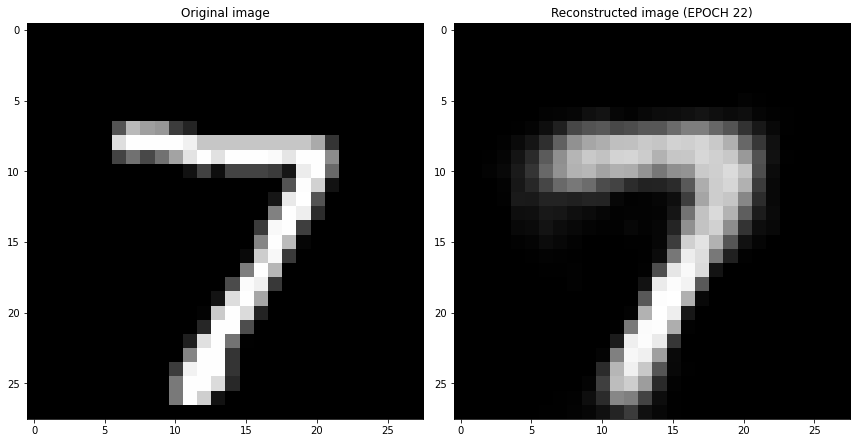

EPOCH 23/30
	 partial train loss (single batch): 0.041253
	 partial train loss (single batch): 0.040457
	 partial train loss (single batch): 0.042807
	 partial train loss (single batch): 0.040932
	 partial train loss (single batch): 0.041037
	 partial train loss (single batch): 0.039811
	 partial train loss (single batch): 0.041775
	 partial train loss (single batch): 0.041433
	 partial train loss (single batch): 0.041114
	 partial train loss (single batch): 0.043100
	 partial train loss (single batch): 0.040419
	 partial train loss (single batch): 0.040450
	 partial train loss (single batch): 0.040735
	 partial train loss (single batch): 0.039929
	 partial train loss (single batch): 0.039210
	 partial train loss (single batch): 0.041842
	 partial train loss (single batch): 0.041371
	 partial train loss (single batch): 0.040043
	 partial train loss (single batch): 0.040610
	 partial train loss (single batch): 0.042203
	 partial train loss (single batch): 0.040596
	 partial train loss (

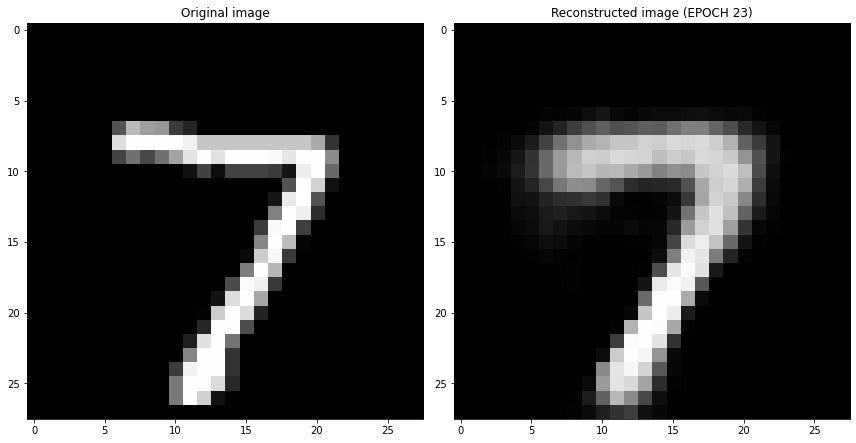

EPOCH 24/30
	 partial train loss (single batch): 0.041329
	 partial train loss (single batch): 0.042528
	 partial train loss (single batch): 0.042543
	 partial train loss (single batch): 0.041102
	 partial train loss (single batch): 0.041443
	 partial train loss (single batch): 0.041734
	 partial train loss (single batch): 0.042248
	 partial train loss (single batch): 0.039302
	 partial train loss (single batch): 0.042505
	 partial train loss (single batch): 0.041596
	 partial train loss (single batch): 0.041627
	 partial train loss (single batch): 0.040742
	 partial train loss (single batch): 0.040833
	 partial train loss (single batch): 0.041427
	 partial train loss (single batch): 0.040364
	 partial train loss (single batch): 0.040558
	 partial train loss (single batch): 0.040424
	 partial train loss (single batch): 0.041066
	 partial train loss (single batch): 0.040323
	 partial train loss (single batch): 0.042122
	 partial train loss (single batch): 0.039466
	 partial train loss (

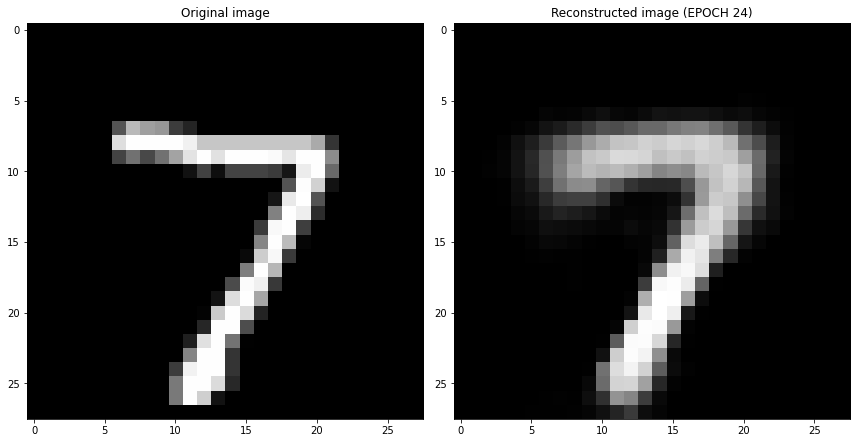

EPOCH 25/30
	 partial train loss (single batch): 0.039230
	 partial train loss (single batch): 0.040995
	 partial train loss (single batch): 0.040752
	 partial train loss (single batch): 0.042180
	 partial train loss (single batch): 0.039540
	 partial train loss (single batch): 0.040814
	 partial train loss (single batch): 0.041417
	 partial train loss (single batch): 0.041596
	 partial train loss (single batch): 0.041190
	 partial train loss (single batch): 0.040377
	 partial train loss (single batch): 0.044578
	 partial train loss (single batch): 0.042731
	 partial train loss (single batch): 0.039751
	 partial train loss (single batch): 0.040196
	 partial train loss (single batch): 0.042944
	 partial train loss (single batch): 0.039693
	 partial train loss (single batch): 0.042285
	 partial train loss (single batch): 0.041246
	 partial train loss (single batch): 0.039354
	 partial train loss (single batch): 0.041193
	 partial train loss (single batch): 0.043488
	 partial train loss (

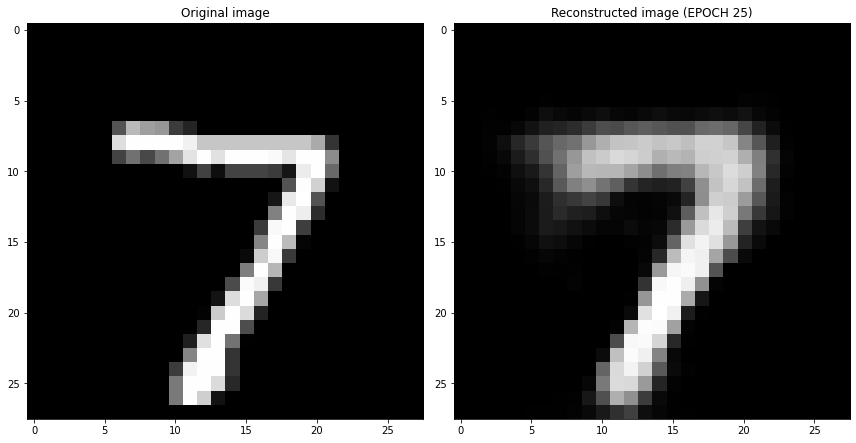

EPOCH 26/30
	 partial train loss (single batch): 0.039472
	 partial train loss (single batch): 0.040407
	 partial train loss (single batch): 0.039420
	 partial train loss (single batch): 0.040549
	 partial train loss (single batch): 0.039853
	 partial train loss (single batch): 0.039600
	 partial train loss (single batch): 0.041028
	 partial train loss (single batch): 0.039852
	 partial train loss (single batch): 0.040136
	 partial train loss (single batch): 0.040704
	 partial train loss (single batch): 0.041261
	 partial train loss (single batch): 0.040674
	 partial train loss (single batch): 0.041546
	 partial train loss (single batch): 0.042739
	 partial train loss (single batch): 0.040292
	 partial train loss (single batch): 0.040227
	 partial train loss (single batch): 0.039447
	 partial train loss (single batch): 0.040117
	 partial train loss (single batch): 0.039570
	 partial train loss (single batch): 0.038300
	 partial train loss (single batch): 0.041008
	 partial train loss (

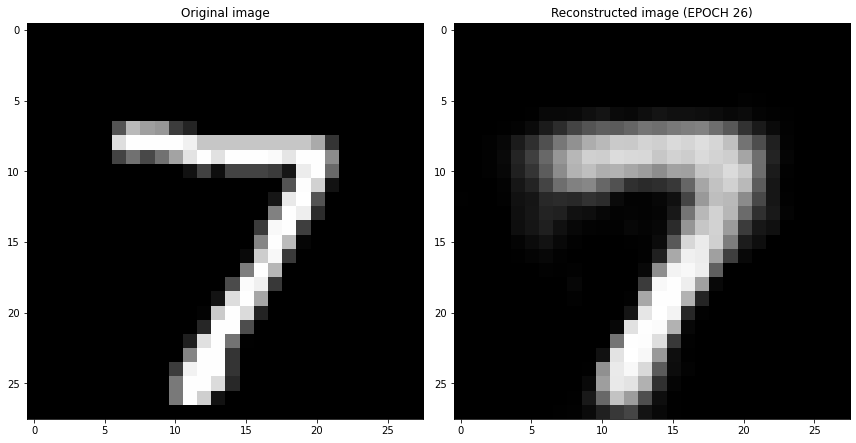

EPOCH 27/30
	 partial train loss (single batch): 0.040792
	 partial train loss (single batch): 0.041043
	 partial train loss (single batch): 0.040691
	 partial train loss (single batch): 0.040327
	 partial train loss (single batch): 0.040782
	 partial train loss (single batch): 0.042858
	 partial train loss (single batch): 0.040437
	 partial train loss (single batch): 0.043174
	 partial train loss (single batch): 0.040672
	 partial train loss (single batch): 0.040392
	 partial train loss (single batch): 0.040426
	 partial train loss (single batch): 0.041813
	 partial train loss (single batch): 0.039223
	 partial train loss (single batch): 0.042148
	 partial train loss (single batch): 0.040496
	 partial train loss (single batch): 0.041475
	 partial train loss (single batch): 0.040150
	 partial train loss (single batch): 0.040449
	 partial train loss (single batch): 0.040879
	 partial train loss (single batch): 0.043209
	 partial train loss (single batch): 0.039512
	 partial train loss (

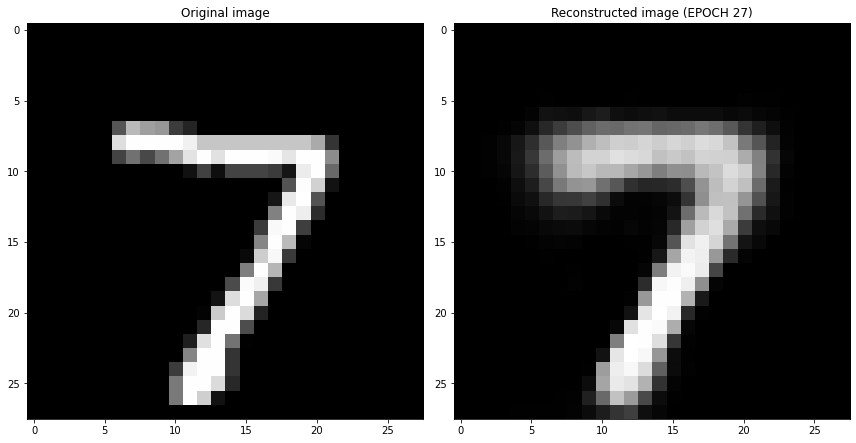

EPOCH 28/30
	 partial train loss (single batch): 0.040114
	 partial train loss (single batch): 0.039632
	 partial train loss (single batch): 0.038739
	 partial train loss (single batch): 0.039161
	 partial train loss (single batch): 0.040855
	 partial train loss (single batch): 0.039897
	 partial train loss (single batch): 0.038806
	 partial train loss (single batch): 0.040765
	 partial train loss (single batch): 0.038613
	 partial train loss (single batch): 0.038281
	 partial train loss (single batch): 0.041861
	 partial train loss (single batch): 0.040699
	 partial train loss (single batch): 0.041726
	 partial train loss (single batch): 0.040403
	 partial train loss (single batch): 0.039891
	 partial train loss (single batch): 0.041766
	 partial train loss (single batch): 0.038092
	 partial train loss (single batch): 0.041115
	 partial train loss (single batch): 0.039026
	 partial train loss (single batch): 0.039429
	 partial train loss (single batch): 0.037757
	 partial train loss (

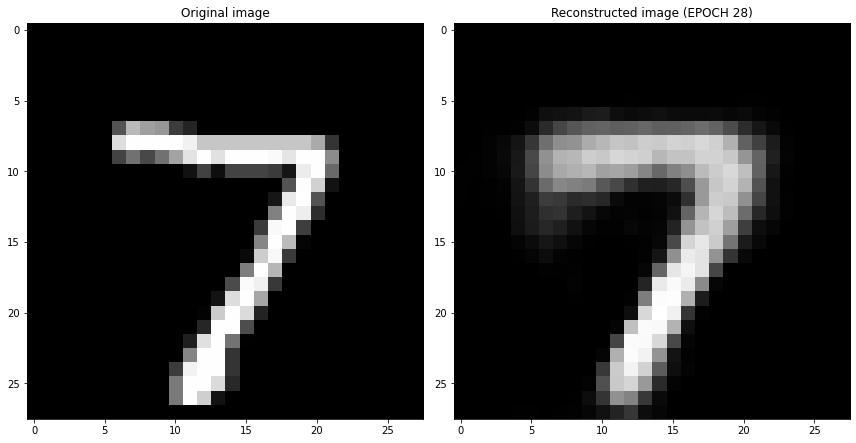

EPOCH 29/30
	 partial train loss (single batch): 0.040521
	 partial train loss (single batch): 0.038779
	 partial train loss (single batch): 0.039199
	 partial train loss (single batch): 0.041625
	 partial train loss (single batch): 0.040023
	 partial train loss (single batch): 0.040205
	 partial train loss (single batch): 0.038651
	 partial train loss (single batch): 0.040201
	 partial train loss (single batch): 0.041670
	 partial train loss (single batch): 0.041591
	 partial train loss (single batch): 0.039134
	 partial train loss (single batch): 0.041081
	 partial train loss (single batch): 0.040581
	 partial train loss (single batch): 0.040565
	 partial train loss (single batch): 0.041848
	 partial train loss (single batch): 0.041588
	 partial train loss (single batch): 0.039718
	 partial train loss (single batch): 0.042068
	 partial train loss (single batch): 0.039115
	 partial train loss (single batch): 0.041310
	 partial train loss (single batch): 0.041095
	 partial train loss (

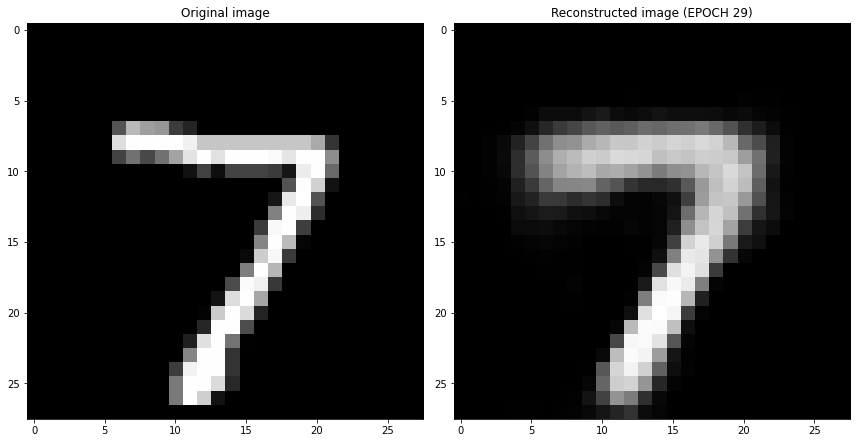

EPOCH 30/30
	 partial train loss (single batch): 0.039417
	 partial train loss (single batch): 0.038516
	 partial train loss (single batch): 0.038275
	 partial train loss (single batch): 0.040433
	 partial train loss (single batch): 0.039446
	 partial train loss (single batch): 0.039017
	 partial train loss (single batch): 0.039469
	 partial train loss (single batch): 0.038794
	 partial train loss (single batch): 0.040441
	 partial train loss (single batch): 0.040871
	 partial train loss (single batch): 0.040643
	 partial train loss (single batch): 0.039962
	 partial train loss (single batch): 0.042863
	 partial train loss (single batch): 0.038422
	 partial train loss (single batch): 0.039319
	 partial train loss (single batch): 0.040215
	 partial train loss (single batch): 0.040828
	 partial train loss (single batch): 0.040953
	 partial train loss (single batch): 0.039096
	 partial train loss (single batch): 0.041378
	 partial train loss (single batch): 0.039764
	 partial train loss (

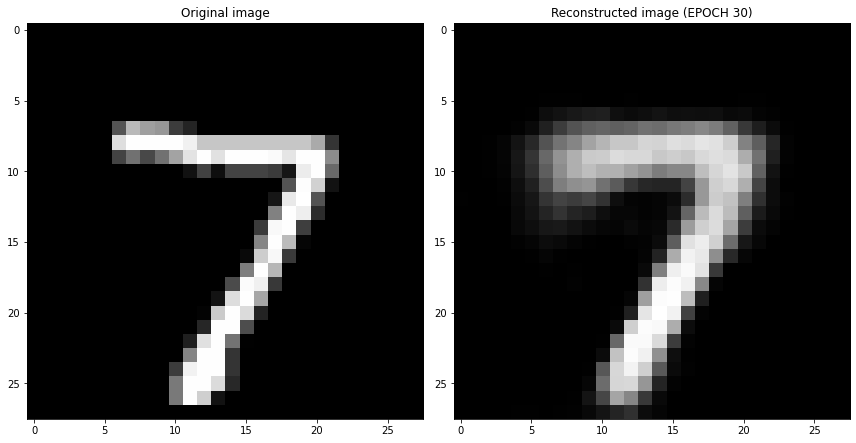

Cross validation fold number= 1/6
EPOCH 1/30
	 partial train loss (single batch): 0.271568
	 partial train loss (single batch): 0.266189
	 partial train loss (single batch): 0.258999
	 partial train loss (single batch): 0.249654
	 partial train loss (single batch): 0.235922
	 partial train loss (single batch): 0.212664
	 partial train loss (single batch): 0.186689
	 partial train loss (single batch): 0.167251
	 partial train loss (single batch): 0.138925
	 partial train loss (single batch): 0.116650
	 partial train loss (single batch): 0.106392
	 partial train loss (single batch): 0.111676
	 partial train loss (single batch): 0.116591
	 partial train loss (single batch): 0.107943
	 partial train loss (single batch): 0.111345
	 partial train loss (single batch): 0.116702
	 partial train loss (single batch): 0.107353
	 partial train loss (single batch): 0.102681
	 partial train loss (single batch): 0.113284
	 partial train loss (single batch): 0.108058
	 partial train loss (single batch)

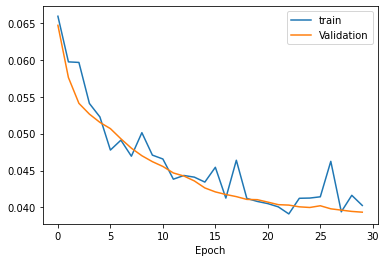

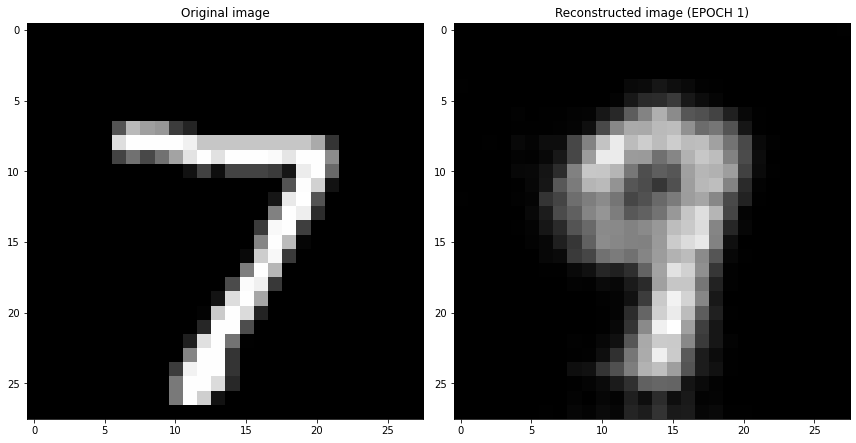

EPOCH 2/30
	 partial train loss (single batch): 0.049860
	 partial train loss (single batch): 0.052029
	 partial train loss (single batch): 0.051835
	 partial train loss (single batch): 0.051611
	 partial train loss (single batch): 0.051738
	 partial train loss (single batch): 0.051162
	 partial train loss (single batch): 0.052648
	 partial train loss (single batch): 0.052879
	 partial train loss (single batch): 0.051354
	 partial train loss (single batch): 0.052469
	 partial train loss (single batch): 0.051889
	 partial train loss (single batch): 0.049682
	 partial train loss (single batch): 0.051523
	 partial train loss (single batch): 0.051888
	 partial train loss (single batch): 0.049216
	 partial train loss (single batch): 0.049417
	 partial train loss (single batch): 0.049306
	 partial train loss (single batch): 0.048580
	 partial train loss (single batch): 0.050876
	 partial train loss (single batch): 0.049837
	 partial train loss (single batch): 0.049919
	 partial train loss (s

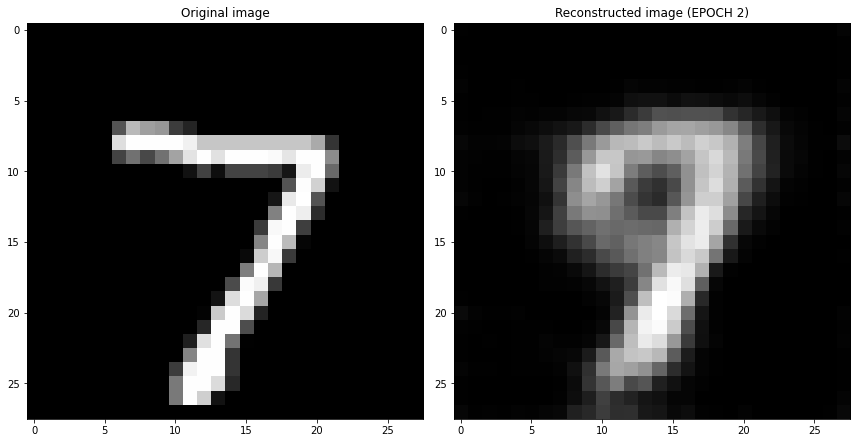

EPOCH 3/30
	 partial train loss (single batch): 0.047253
	 partial train loss (single batch): 0.047347
	 partial train loss (single batch): 0.047363
	 partial train loss (single batch): 0.049255
	 partial train loss (single batch): 0.045613
	 partial train loss (single batch): 0.048522
	 partial train loss (single batch): 0.045987
	 partial train loss (single batch): 0.045781
	 partial train loss (single batch): 0.045845
	 partial train loss (single batch): 0.047960
	 partial train loss (single batch): 0.047998
	 partial train loss (single batch): 0.048319
	 partial train loss (single batch): 0.045627
	 partial train loss (single batch): 0.046432
	 partial train loss (single batch): 0.047207
	 partial train loss (single batch): 0.046422
	 partial train loss (single batch): 0.043178
	 partial train loss (single batch): 0.045917
	 partial train loss (single batch): 0.046938
	 partial train loss (single batch): 0.046837
	 partial train loss (single batch): 0.045775
	 partial train loss (s

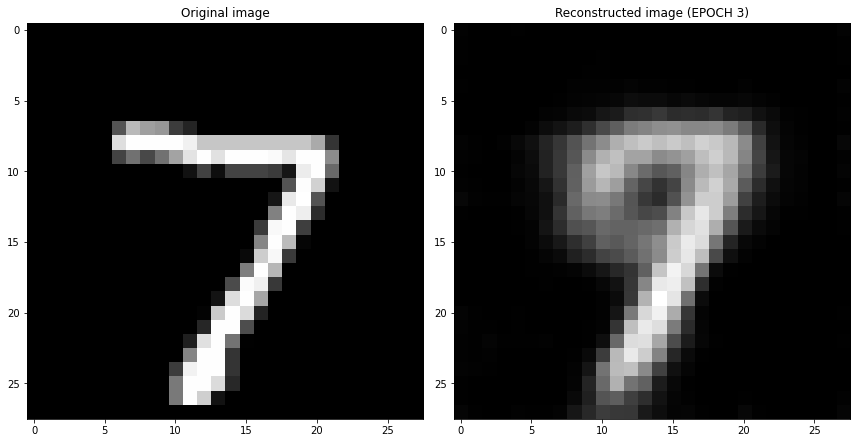

EPOCH 4/30
	 partial train loss (single batch): 0.042640
	 partial train loss (single batch): 0.045112
	 partial train loss (single batch): 0.044537
	 partial train loss (single batch): 0.043339
	 partial train loss (single batch): 0.044713
	 partial train loss (single batch): 0.043162
	 partial train loss (single batch): 0.044042
	 partial train loss (single batch): 0.044008
	 partial train loss (single batch): 0.043507
	 partial train loss (single batch): 0.042104
	 partial train loss (single batch): 0.045360
	 partial train loss (single batch): 0.046296
	 partial train loss (single batch): 0.045375
	 partial train loss (single batch): 0.045254
	 partial train loss (single batch): 0.044216
	 partial train loss (single batch): 0.045062
	 partial train loss (single batch): 0.044767
	 partial train loss (single batch): 0.041090
	 partial train loss (single batch): 0.044962
	 partial train loss (single batch): 0.043109
	 partial train loss (single batch): 0.045196
	 partial train loss (s

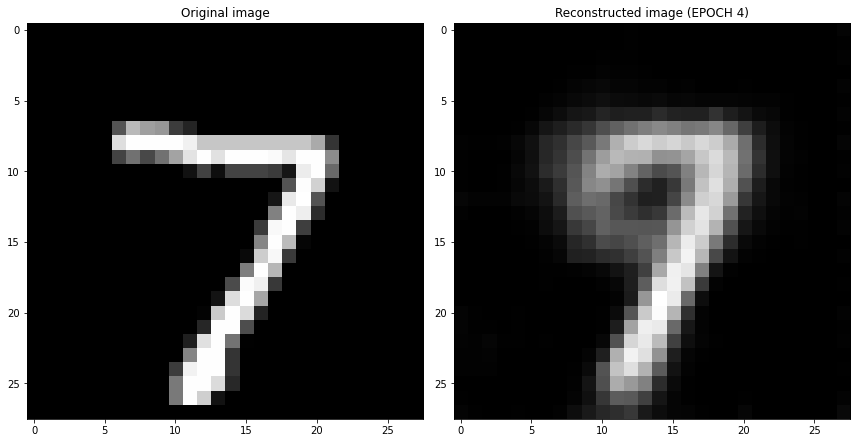

EPOCH 5/30
	 partial train loss (single batch): 0.043691
	 partial train loss (single batch): 0.043897
	 partial train loss (single batch): 0.046161
	 partial train loss (single batch): 0.046207
	 partial train loss (single batch): 0.043528
	 partial train loss (single batch): 0.043828
	 partial train loss (single batch): 0.044094
	 partial train loss (single batch): 0.042590
	 partial train loss (single batch): 0.042805
	 partial train loss (single batch): 0.045187
	 partial train loss (single batch): 0.045832
	 partial train loss (single batch): 0.043737
	 partial train loss (single batch): 0.043370
	 partial train loss (single batch): 0.046149
	 partial train loss (single batch): 0.042975
	 partial train loss (single batch): 0.043058
	 partial train loss (single batch): 0.045336
	 partial train loss (single batch): 0.043679
	 partial train loss (single batch): 0.043058
	 partial train loss (single batch): 0.043545
	 partial train loss (single batch): 0.043782
	 partial train loss (s

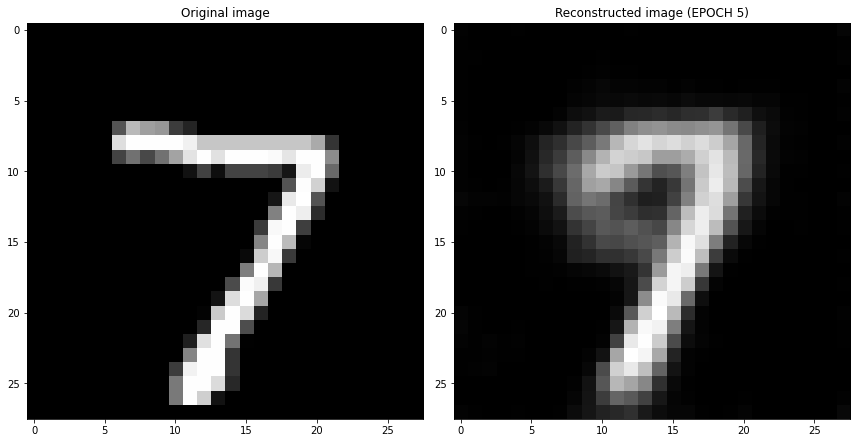

EPOCH 6/30
	 partial train loss (single batch): 0.043000
	 partial train loss (single batch): 0.041671
	 partial train loss (single batch): 0.044628
	 partial train loss (single batch): 0.044183
	 partial train loss (single batch): 0.043403
	 partial train loss (single batch): 0.041941
	 partial train loss (single batch): 0.042071
	 partial train loss (single batch): 0.044010
	 partial train loss (single batch): 0.043521
	 partial train loss (single batch): 0.042952
	 partial train loss (single batch): 0.042077
	 partial train loss (single batch): 0.042675
	 partial train loss (single batch): 0.041269
	 partial train loss (single batch): 0.045559
	 partial train loss (single batch): 0.042900
	 partial train loss (single batch): 0.041432
	 partial train loss (single batch): 0.043806
	 partial train loss (single batch): 0.044472
	 partial train loss (single batch): 0.042546
	 partial train loss (single batch): 0.042682
	 partial train loss (single batch): 0.041427
	 partial train loss (s

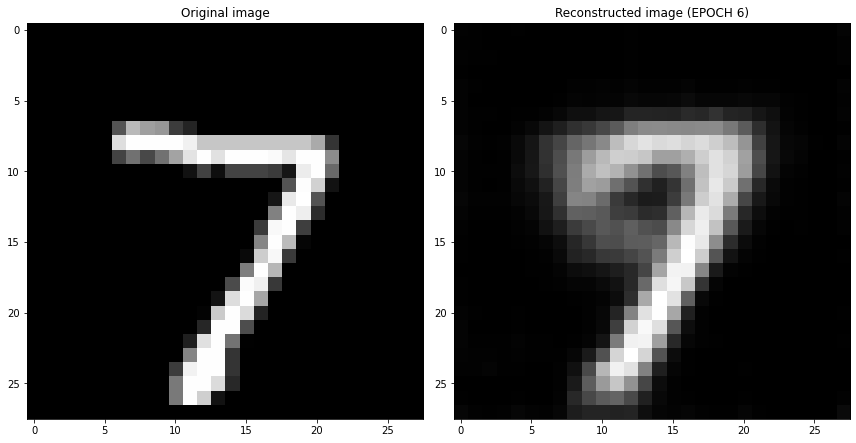

EPOCH 7/30
	 partial train loss (single batch): 0.040459
	 partial train loss (single batch): 0.041412
	 partial train loss (single batch): 0.041478
	 partial train loss (single batch): 0.041972
	 partial train loss (single batch): 0.043212
	 partial train loss (single batch): 0.044114
	 partial train loss (single batch): 0.041723
	 partial train loss (single batch): 0.040892
	 partial train loss (single batch): 0.042436
	 partial train loss (single batch): 0.039861
	 partial train loss (single batch): 0.043547
	 partial train loss (single batch): 0.041521
	 partial train loss (single batch): 0.042658
	 partial train loss (single batch): 0.041023
	 partial train loss (single batch): 0.042262
	 partial train loss (single batch): 0.042859
	 partial train loss (single batch): 0.043569
	 partial train loss (single batch): 0.043534
	 partial train loss (single batch): 0.044469
	 partial train loss (single batch): 0.041950
	 partial train loss (single batch): 0.042845
	 partial train loss (s

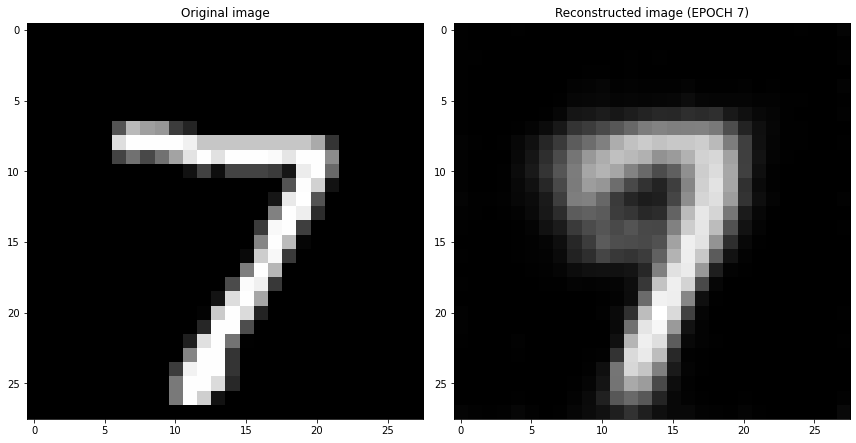

EPOCH 8/30
	 partial train loss (single batch): 0.044655
	 partial train loss (single batch): 0.042313
	 partial train loss (single batch): 0.043857
	 partial train loss (single batch): 0.043669
	 partial train loss (single batch): 0.043046
	 partial train loss (single batch): 0.043370
	 partial train loss (single batch): 0.042454
	 partial train loss (single batch): 0.040603
	 partial train loss (single batch): 0.041552
	 partial train loss (single batch): 0.044047
	 partial train loss (single batch): 0.040063
	 partial train loss (single batch): 0.043592
	 partial train loss (single batch): 0.042306
	 partial train loss (single batch): 0.042392
	 partial train loss (single batch): 0.044037
	 partial train loss (single batch): 0.042138
	 partial train loss (single batch): 0.041977
	 partial train loss (single batch): 0.041965
	 partial train loss (single batch): 0.040611
	 partial train loss (single batch): 0.042087
	 partial train loss (single batch): 0.043943
	 partial train loss (s

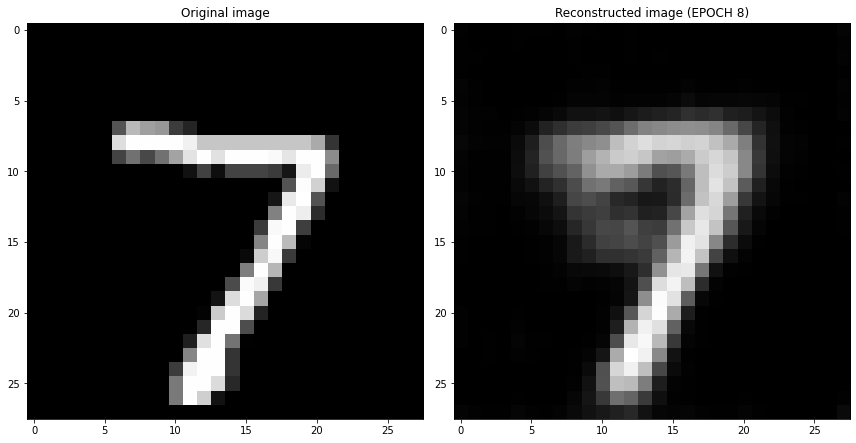

EPOCH 9/30
	 partial train loss (single batch): 0.040795
	 partial train loss (single batch): 0.040967
	 partial train loss (single batch): 0.041039
	 partial train loss (single batch): 0.041696
	 partial train loss (single batch): 0.041590
	 partial train loss (single batch): 0.040469
	 partial train loss (single batch): 0.042527
	 partial train loss (single batch): 0.041031
	 partial train loss (single batch): 0.043270
	 partial train loss (single batch): 0.042779
	 partial train loss (single batch): 0.041905
	 partial train loss (single batch): 0.042986
	 partial train loss (single batch): 0.040825
	 partial train loss (single batch): 0.041302
	 partial train loss (single batch): 0.040973
	 partial train loss (single batch): 0.040623
	 partial train loss (single batch): 0.042910
	 partial train loss (single batch): 0.042894
	 partial train loss (single batch): 0.043020
	 partial train loss (single batch): 0.041371
	 partial train loss (single batch): 0.039071
	 partial train loss (s

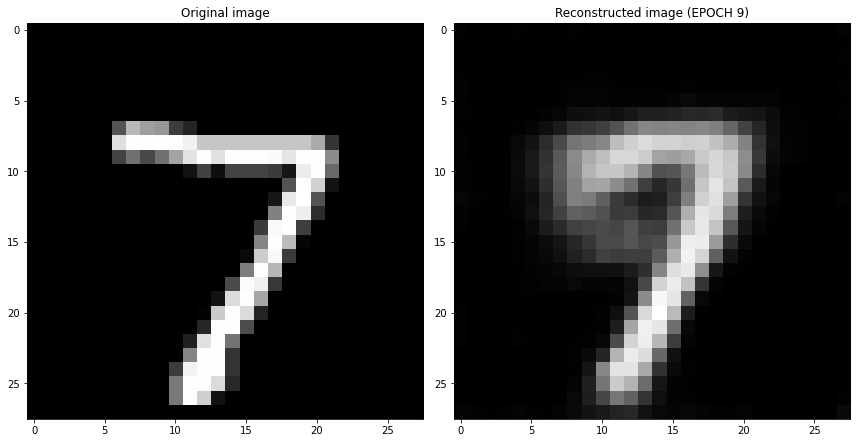

EPOCH 10/30
	 partial train loss (single batch): 0.042407
	 partial train loss (single batch): 0.041283
	 partial train loss (single batch): 0.042055
	 partial train loss (single batch): 0.040636
	 partial train loss (single batch): 0.041311
	 partial train loss (single batch): 0.042484
	 partial train loss (single batch): 0.041784
	 partial train loss (single batch): 0.043213
	 partial train loss (single batch): 0.041383
	 partial train loss (single batch): 0.042077
	 partial train loss (single batch): 0.044726
	 partial train loss (single batch): 0.042391
	 partial train loss (single batch): 0.042601
	 partial train loss (single batch): 0.041403
	 partial train loss (single batch): 0.040709
	 partial train loss (single batch): 0.040555
	 partial train loss (single batch): 0.041165
	 partial train loss (single batch): 0.042184
	 partial train loss (single batch): 0.043360
	 partial train loss (single batch): 0.044148
	 partial train loss (single batch): 0.040363
	 partial train loss (

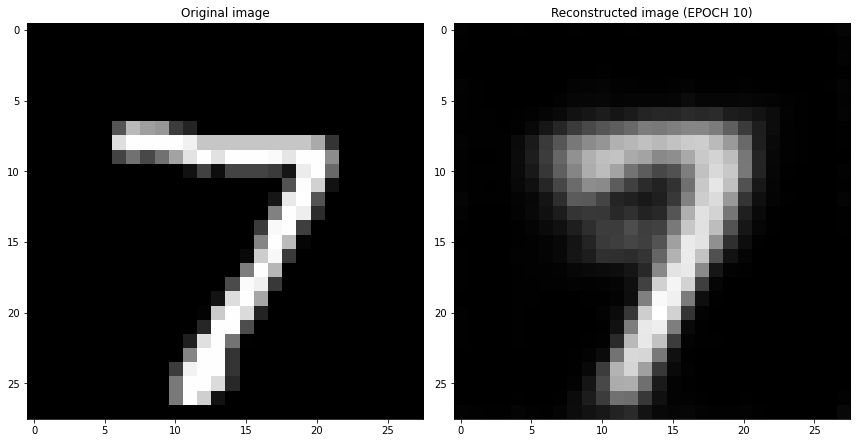

EPOCH 11/30
	 partial train loss (single batch): 0.041754
	 partial train loss (single batch): 0.041532
	 partial train loss (single batch): 0.043027
	 partial train loss (single batch): 0.040672
	 partial train loss (single batch): 0.042794
	 partial train loss (single batch): 0.041211
	 partial train loss (single batch): 0.043404
	 partial train loss (single batch): 0.042793
	 partial train loss (single batch): 0.041758
	 partial train loss (single batch): 0.040494
	 partial train loss (single batch): 0.039035
	 partial train loss (single batch): 0.040862
	 partial train loss (single batch): 0.041684
	 partial train loss (single batch): 0.040239
	 partial train loss (single batch): 0.042033
	 partial train loss (single batch): 0.042509
	 partial train loss (single batch): 0.042142
	 partial train loss (single batch): 0.040809
	 partial train loss (single batch): 0.042212
	 partial train loss (single batch): 0.041671
	 partial train loss (single batch): 0.041025
	 partial train loss (

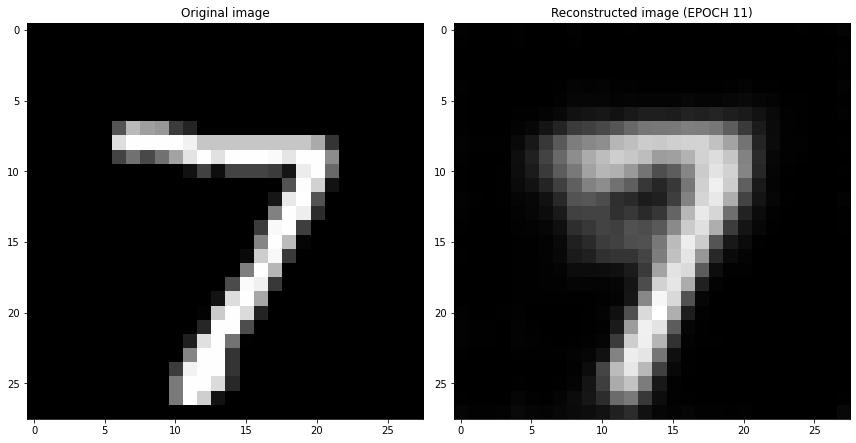

EPOCH 12/30
	 partial train loss (single batch): 0.042867
	 partial train loss (single batch): 0.040317
	 partial train loss (single batch): 0.043737
	 partial train loss (single batch): 0.040032
	 partial train loss (single batch): 0.042282
	 partial train loss (single batch): 0.042759
	 partial train loss (single batch): 0.043473
	 partial train loss (single batch): 0.041774
	 partial train loss (single batch): 0.043979
	 partial train loss (single batch): 0.041235
	 partial train loss (single batch): 0.040462
	 partial train loss (single batch): 0.040948
	 partial train loss (single batch): 0.040276
	 partial train loss (single batch): 0.043817
	 partial train loss (single batch): 0.042196
	 partial train loss (single batch): 0.041291
	 partial train loss (single batch): 0.042040
	 partial train loss (single batch): 0.040667
	 partial train loss (single batch): 0.042477
	 partial train loss (single batch): 0.039353
	 partial train loss (single batch): 0.042004
	 partial train loss (

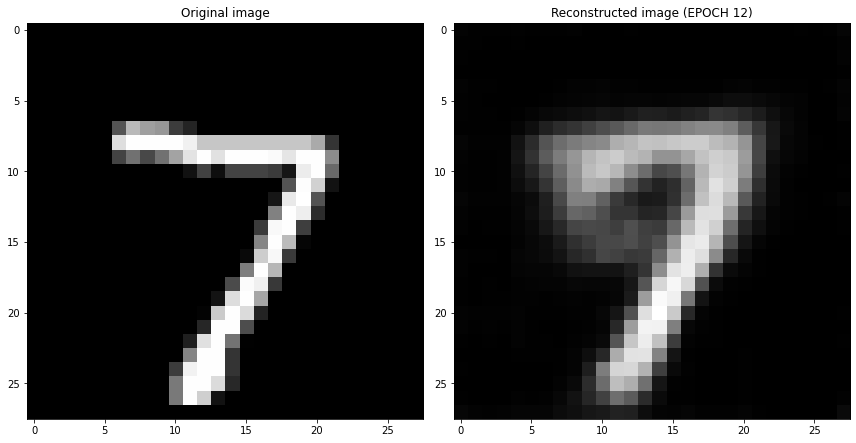

EPOCH 13/30
	 partial train loss (single batch): 0.040543
	 partial train loss (single batch): 0.041198
	 partial train loss (single batch): 0.038500
	 partial train loss (single batch): 0.040305
	 partial train loss (single batch): 0.040158
	 partial train loss (single batch): 0.039582
	 partial train loss (single batch): 0.042471
	 partial train loss (single batch): 0.040785
	 partial train loss (single batch): 0.041208
	 partial train loss (single batch): 0.042559
	 partial train loss (single batch): 0.040316
	 partial train loss (single batch): 0.039751
	 partial train loss (single batch): 0.041040
	 partial train loss (single batch): 0.039754
	 partial train loss (single batch): 0.041451
	 partial train loss (single batch): 0.042389
	 partial train loss (single batch): 0.042441
	 partial train loss (single batch): 0.040564
	 partial train loss (single batch): 0.043641
	 partial train loss (single batch): 0.039744
	 partial train loss (single batch): 0.039189
	 partial train loss (

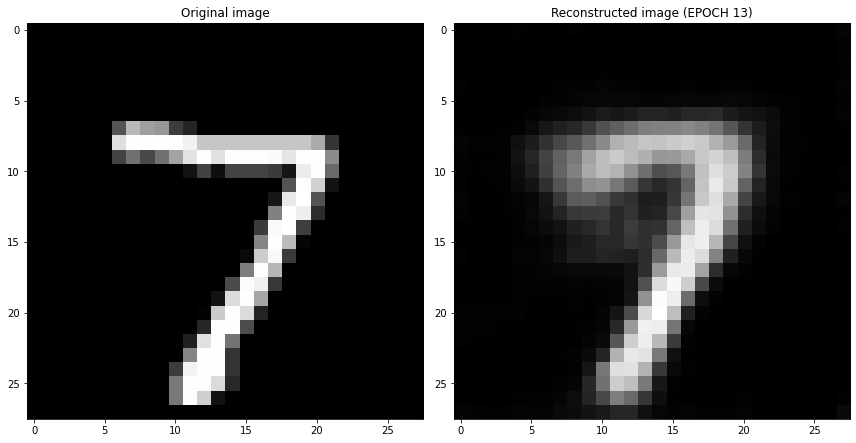

EPOCH 14/30
	 partial train loss (single batch): 0.042121
	 partial train loss (single batch): 0.041462
	 partial train loss (single batch): 0.041115
	 partial train loss (single batch): 0.042119
	 partial train loss (single batch): 0.041261
	 partial train loss (single batch): 0.038857
	 partial train loss (single batch): 0.038388
	 partial train loss (single batch): 0.041341
	 partial train loss (single batch): 0.043157
	 partial train loss (single batch): 0.040868
	 partial train loss (single batch): 0.040320
	 partial train loss (single batch): 0.040116
	 partial train loss (single batch): 0.040738
	 partial train loss (single batch): 0.039386
	 partial train loss (single batch): 0.042370
	 partial train loss (single batch): 0.039876
	 partial train loss (single batch): 0.041041
	 partial train loss (single batch): 0.038682
	 partial train loss (single batch): 0.041790
	 partial train loss (single batch): 0.040580
	 partial train loss (single batch): 0.039993
	 partial train loss (

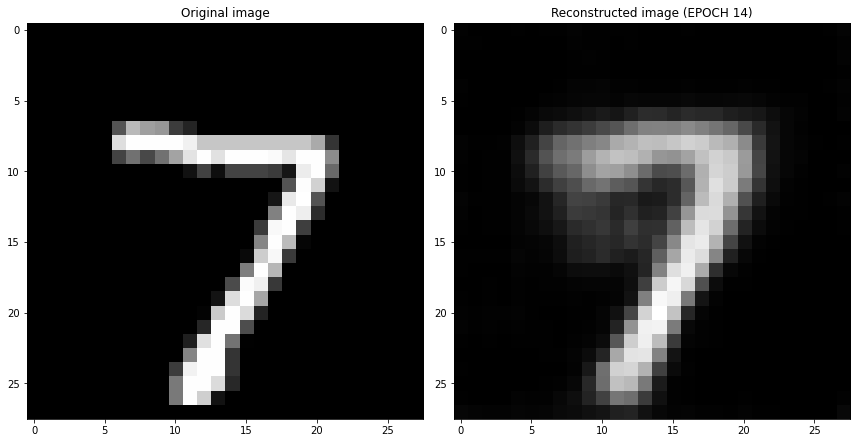

EPOCH 15/30
	 partial train loss (single batch): 0.041739
	 partial train loss (single batch): 0.040807
	 partial train loss (single batch): 0.039632
	 partial train loss (single batch): 0.040923
	 partial train loss (single batch): 0.042570
	 partial train loss (single batch): 0.040856
	 partial train loss (single batch): 0.041720
	 partial train loss (single batch): 0.040724
	 partial train loss (single batch): 0.040371
	 partial train loss (single batch): 0.041228
	 partial train loss (single batch): 0.040216
	 partial train loss (single batch): 0.041285
	 partial train loss (single batch): 0.042292
	 partial train loss (single batch): 0.041021
	 partial train loss (single batch): 0.040825
	 partial train loss (single batch): 0.040328
	 partial train loss (single batch): 0.041352
	 partial train loss (single batch): 0.040455
	 partial train loss (single batch): 0.040717
	 partial train loss (single batch): 0.042860
	 partial train loss (single batch): 0.039397
	 partial train loss (

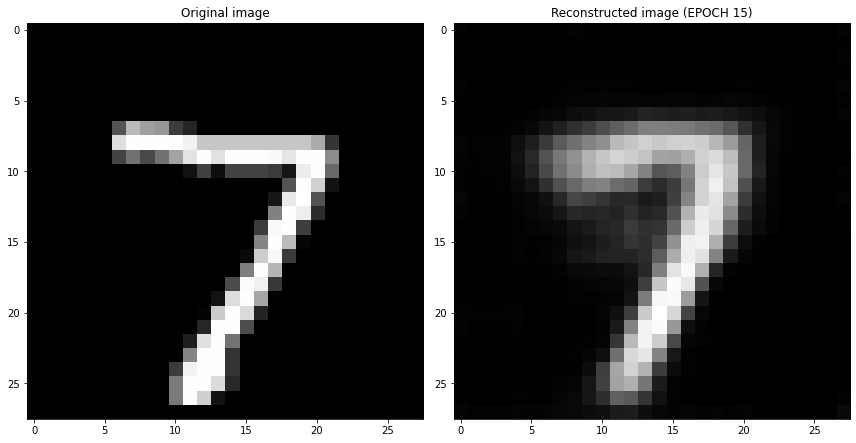

EPOCH 16/30
	 partial train loss (single batch): 0.040959
	 partial train loss (single batch): 0.040848
	 partial train loss (single batch): 0.040057
	 partial train loss (single batch): 0.042178
	 partial train loss (single batch): 0.039371
	 partial train loss (single batch): 0.040937
	 partial train loss (single batch): 0.040101
	 partial train loss (single batch): 0.044301
	 partial train loss (single batch): 0.040086
	 partial train loss (single batch): 0.042098
	 partial train loss (single batch): 0.041058
	 partial train loss (single batch): 0.041833
	 partial train loss (single batch): 0.042238
	 partial train loss (single batch): 0.041663
	 partial train loss (single batch): 0.040660
	 partial train loss (single batch): 0.041571
	 partial train loss (single batch): 0.040782
	 partial train loss (single batch): 0.040660
	 partial train loss (single batch): 0.041532
	 partial train loss (single batch): 0.041388
	 partial train loss (single batch): 0.041880
	 partial train loss (

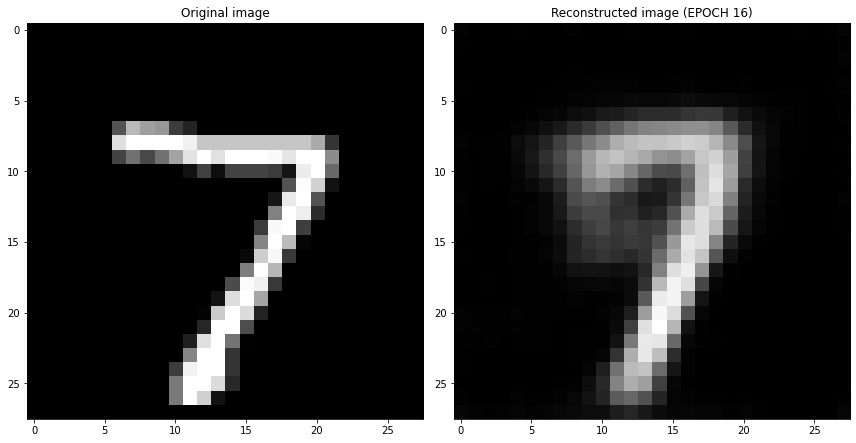

EPOCH 17/30
	 partial train loss (single batch): 0.043003
	 partial train loss (single batch): 0.040525
	 partial train loss (single batch): 0.040174
	 partial train loss (single batch): 0.038751
	 partial train loss (single batch): 0.042514
	 partial train loss (single batch): 0.039612
	 partial train loss (single batch): 0.039804
	 partial train loss (single batch): 0.041730
	 partial train loss (single batch): 0.040613
	 partial train loss (single batch): 0.040650
	 partial train loss (single batch): 0.042324
	 partial train loss (single batch): 0.042049
	 partial train loss (single batch): 0.041290
	 partial train loss (single batch): 0.039160
	 partial train loss (single batch): 0.039841
	 partial train loss (single batch): 0.041765
	 partial train loss (single batch): 0.041053
	 partial train loss (single batch): 0.043548
	 partial train loss (single batch): 0.040972
	 partial train loss (single batch): 0.040266
	 partial train loss (single batch): 0.040409
	 partial train loss (

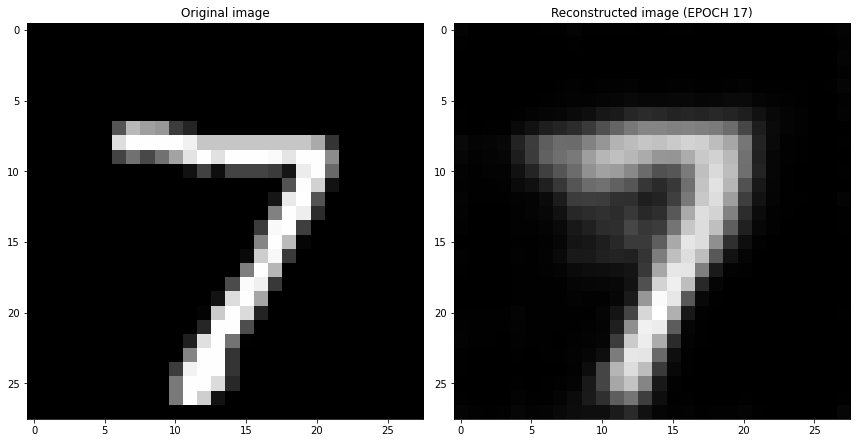

EPOCH 18/30
	 partial train loss (single batch): 0.040447
	 partial train loss (single batch): 0.040867
	 partial train loss (single batch): 0.041443
	 partial train loss (single batch): 0.041674
	 partial train loss (single batch): 0.041367
	 partial train loss (single batch): 0.039396
	 partial train loss (single batch): 0.041521
	 partial train loss (single batch): 0.042475
	 partial train loss (single batch): 0.041885
	 partial train loss (single batch): 0.040964
	 partial train loss (single batch): 0.041177
	 partial train loss (single batch): 0.039903
	 partial train loss (single batch): 0.040684
	 partial train loss (single batch): 0.042132
	 partial train loss (single batch): 0.040868
	 partial train loss (single batch): 0.042977
	 partial train loss (single batch): 0.038452
	 partial train loss (single batch): 0.039906
	 partial train loss (single batch): 0.042021
	 partial train loss (single batch): 0.038931
	 partial train loss (single batch): 0.039674
	 partial train loss (

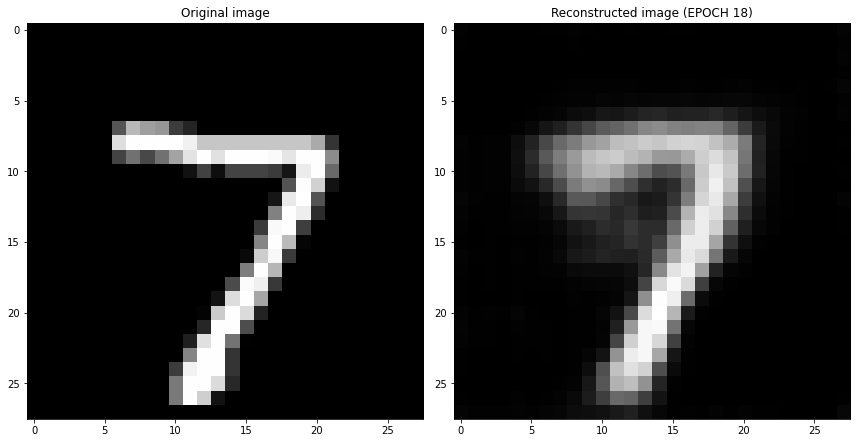

EPOCH 19/30
	 partial train loss (single batch): 0.042028
	 partial train loss (single batch): 0.041172
	 partial train loss (single batch): 0.040763
	 partial train loss (single batch): 0.038962
	 partial train loss (single batch): 0.040427
	 partial train loss (single batch): 0.041365
	 partial train loss (single batch): 0.040887
	 partial train loss (single batch): 0.038208
	 partial train loss (single batch): 0.041458
	 partial train loss (single batch): 0.041492
	 partial train loss (single batch): 0.040307
	 partial train loss (single batch): 0.040962
	 partial train loss (single batch): 0.040974
	 partial train loss (single batch): 0.040547
	 partial train loss (single batch): 0.039747
	 partial train loss (single batch): 0.041083
	 partial train loss (single batch): 0.039441
	 partial train loss (single batch): 0.041123
	 partial train loss (single batch): 0.042257
	 partial train loss (single batch): 0.040236
	 partial train loss (single batch): 0.041372
	 partial train loss (

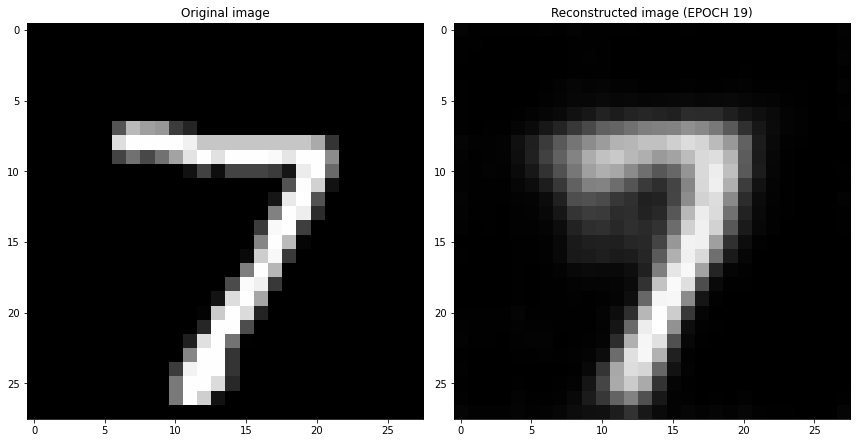

EPOCH 20/30
	 partial train loss (single batch): 0.038801
	 partial train loss (single batch): 0.040241
	 partial train loss (single batch): 0.041508
	 partial train loss (single batch): 0.042288
	 partial train loss (single batch): 0.040761
	 partial train loss (single batch): 0.041341
	 partial train loss (single batch): 0.041767
	 partial train loss (single batch): 0.040453
	 partial train loss (single batch): 0.043674
	 partial train loss (single batch): 0.042051
	 partial train loss (single batch): 0.040277
	 partial train loss (single batch): 0.040936
	 partial train loss (single batch): 0.039906
	 partial train loss (single batch): 0.041962
	 partial train loss (single batch): 0.042792
	 partial train loss (single batch): 0.040367
	 partial train loss (single batch): 0.042597
	 partial train loss (single batch): 0.039418
	 partial train loss (single batch): 0.039042
	 partial train loss (single batch): 0.042124
	 partial train loss (single batch): 0.037121
	 partial train loss (

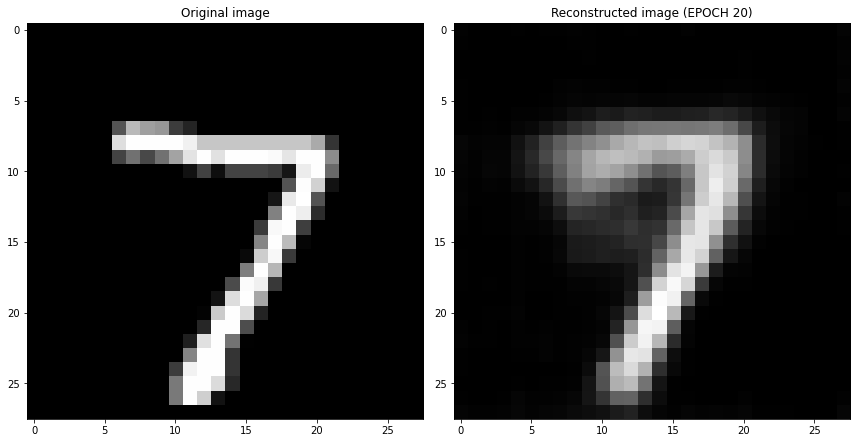

EPOCH 21/30
	 partial train loss (single batch): 0.041698
	 partial train loss (single batch): 0.040201
	 partial train loss (single batch): 0.039174
	 partial train loss (single batch): 0.042887
	 partial train loss (single batch): 0.041340
	 partial train loss (single batch): 0.042219
	 partial train loss (single batch): 0.040155
	 partial train loss (single batch): 0.040132
	 partial train loss (single batch): 0.042508
	 partial train loss (single batch): 0.040595
	 partial train loss (single batch): 0.039849
	 partial train loss (single batch): 0.041862
	 partial train loss (single batch): 0.039454
	 partial train loss (single batch): 0.040262
	 partial train loss (single batch): 0.042060
	 partial train loss (single batch): 0.041530
	 partial train loss (single batch): 0.039898
	 partial train loss (single batch): 0.040604
	 partial train loss (single batch): 0.042226
	 partial train loss (single batch): 0.038644
	 partial train loss (single batch): 0.040867
	 partial train loss (

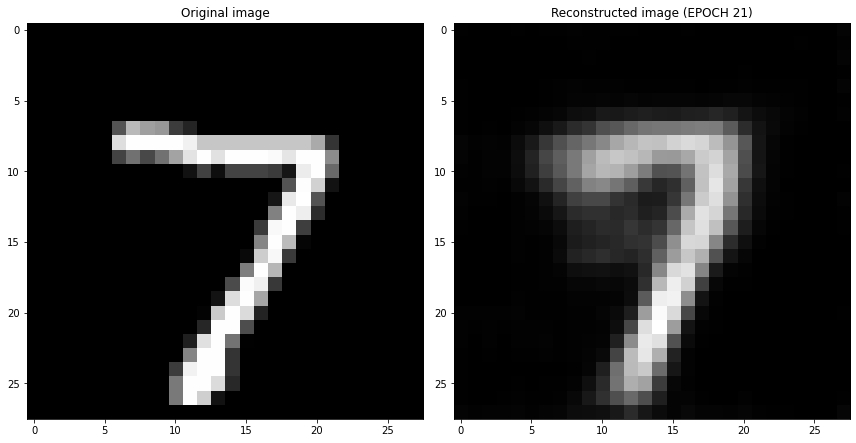

EPOCH 22/30
	 partial train loss (single batch): 0.039961
	 partial train loss (single batch): 0.040034
	 partial train loss (single batch): 0.039282
	 partial train loss (single batch): 0.042015
	 partial train loss (single batch): 0.040414
	 partial train loss (single batch): 0.040614
	 partial train loss (single batch): 0.040211
	 partial train loss (single batch): 0.039580
	 partial train loss (single batch): 0.039023
	 partial train loss (single batch): 0.039745
	 partial train loss (single batch): 0.039442
	 partial train loss (single batch): 0.040099
	 partial train loss (single batch): 0.039260
	 partial train loss (single batch): 0.040412
	 partial train loss (single batch): 0.043206
	 partial train loss (single batch): 0.041499
	 partial train loss (single batch): 0.039174
	 partial train loss (single batch): 0.040936
	 partial train loss (single batch): 0.039056
	 partial train loss (single batch): 0.039451
	 partial train loss (single batch): 0.041805
	 partial train loss (

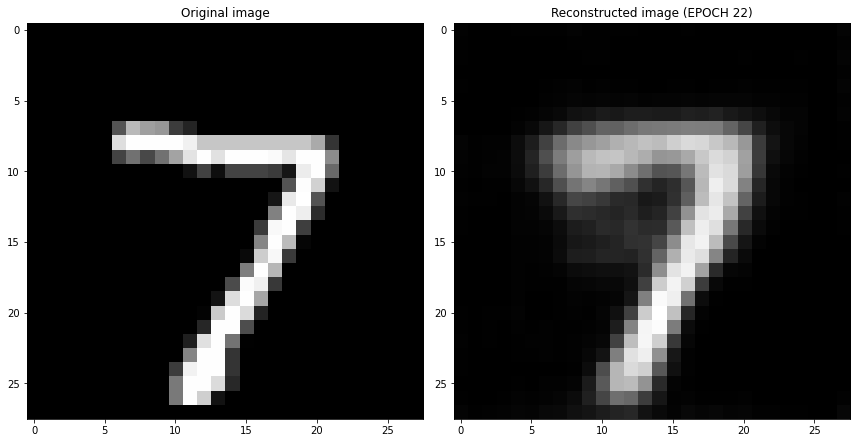

EPOCH 23/30
	 partial train loss (single batch): 0.039329
	 partial train loss (single batch): 0.039479
	 partial train loss (single batch): 0.042289
	 partial train loss (single batch): 0.039434
	 partial train loss (single batch): 0.041516
	 partial train loss (single batch): 0.039407
	 partial train loss (single batch): 0.041926
	 partial train loss (single batch): 0.038753
	 partial train loss (single batch): 0.039139
	 partial train loss (single batch): 0.041971
	 partial train loss (single batch): 0.041947
	 partial train loss (single batch): 0.040679
	 partial train loss (single batch): 0.039452
	 partial train loss (single batch): 0.040874
	 partial train loss (single batch): 0.041988
	 partial train loss (single batch): 0.040074
	 partial train loss (single batch): 0.039392
	 partial train loss (single batch): 0.042070
	 partial train loss (single batch): 0.041941
	 partial train loss (single batch): 0.041278
	 partial train loss (single batch): 0.042605
	 partial train loss (

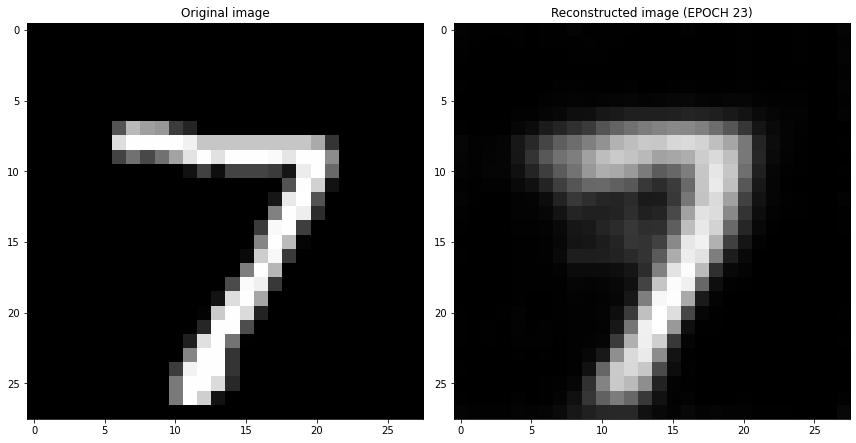

EPOCH 24/30
	 partial train loss (single batch): 0.040239
	 partial train loss (single batch): 0.040978
	 partial train loss (single batch): 0.040186
	 partial train loss (single batch): 0.039820
	 partial train loss (single batch): 0.039517
	 partial train loss (single batch): 0.042531
	 partial train loss (single batch): 0.040297
	 partial train loss (single batch): 0.040389
	 partial train loss (single batch): 0.039690
	 partial train loss (single batch): 0.041745
	 partial train loss (single batch): 0.040002
	 partial train loss (single batch): 0.038932
	 partial train loss (single batch): 0.041273
	 partial train loss (single batch): 0.039949
	 partial train loss (single batch): 0.039937
	 partial train loss (single batch): 0.039365
	 partial train loss (single batch): 0.040595
	 partial train loss (single batch): 0.041883
	 partial train loss (single batch): 0.040581
	 partial train loss (single batch): 0.041929
	 partial train loss (single batch): 0.040874
	 partial train loss (

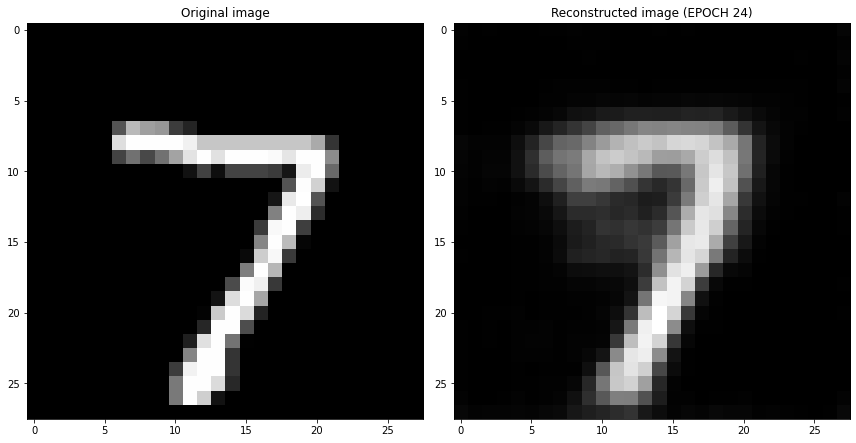

EPOCH 25/30
	 partial train loss (single batch): 0.041157
	 partial train loss (single batch): 0.041948
	 partial train loss (single batch): 0.040314
	 partial train loss (single batch): 0.043111
	 partial train loss (single batch): 0.039421
	 partial train loss (single batch): 0.039306
	 partial train loss (single batch): 0.039871
	 partial train loss (single batch): 0.041460
	 partial train loss (single batch): 0.040438
	 partial train loss (single batch): 0.040673
	 partial train loss (single batch): 0.039062
	 partial train loss (single batch): 0.039053
	 partial train loss (single batch): 0.043573
	 partial train loss (single batch): 0.042598
	 partial train loss (single batch): 0.038917
	 partial train loss (single batch): 0.039079
	 partial train loss (single batch): 0.039228
	 partial train loss (single batch): 0.040434
	 partial train loss (single batch): 0.040138
	 partial train loss (single batch): 0.040772
	 partial train loss (single batch): 0.039441
	 partial train loss (

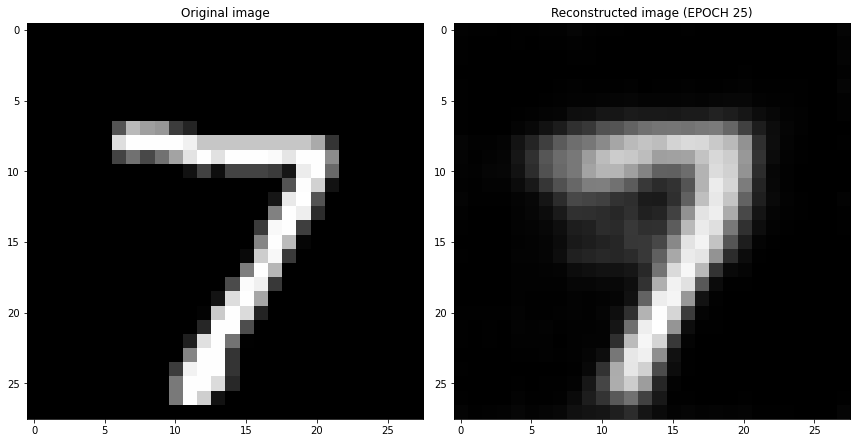

EPOCH 26/30
	 partial train loss (single batch): 0.041006
	 partial train loss (single batch): 0.043923
	 partial train loss (single batch): 0.040028
	 partial train loss (single batch): 0.038895
	 partial train loss (single batch): 0.041130
	 partial train loss (single batch): 0.040767
	 partial train loss (single batch): 0.041248
	 partial train loss (single batch): 0.041528
	 partial train loss (single batch): 0.040493
	 partial train loss (single batch): 0.038892
	 partial train loss (single batch): 0.040423
	 partial train loss (single batch): 0.041059
	 partial train loss (single batch): 0.041933
	 partial train loss (single batch): 0.040151
	 partial train loss (single batch): 0.041235
	 partial train loss (single batch): 0.039310
	 partial train loss (single batch): 0.041796
	 partial train loss (single batch): 0.040246
	 partial train loss (single batch): 0.039949
	 partial train loss (single batch): 0.040840
	 partial train loss (single batch): 0.039970
	 partial train loss (

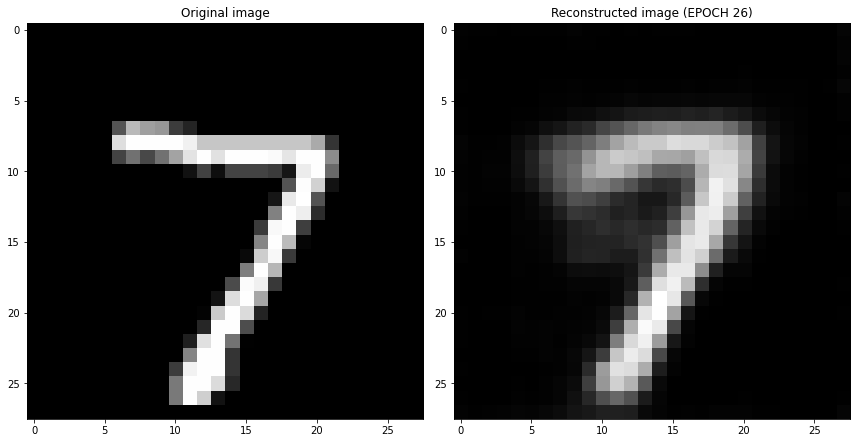

EPOCH 27/30
	 partial train loss (single batch): 0.041028
	 partial train loss (single batch): 0.039699
	 partial train loss (single batch): 0.042101
	 partial train loss (single batch): 0.039921
	 partial train loss (single batch): 0.040299
	 partial train loss (single batch): 0.038826
	 partial train loss (single batch): 0.039386
	 partial train loss (single batch): 0.038150
	 partial train loss (single batch): 0.037950
	 partial train loss (single batch): 0.040757
	 partial train loss (single batch): 0.038072
	 partial train loss (single batch): 0.040239
	 partial train loss (single batch): 0.041213
	 partial train loss (single batch): 0.039896
	 partial train loss (single batch): 0.041254
	 partial train loss (single batch): 0.041410
	 partial train loss (single batch): 0.041346
	 partial train loss (single batch): 0.039635
	 partial train loss (single batch): 0.040830
	 partial train loss (single batch): 0.040430
	 partial train loss (single batch): 0.040154
	 partial train loss (

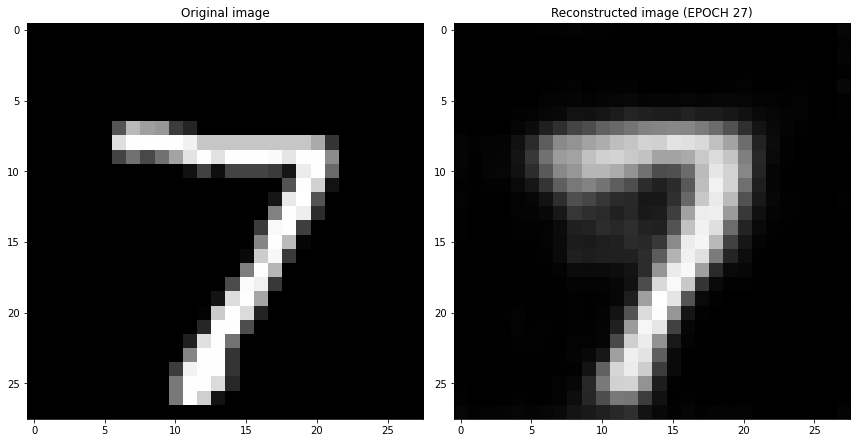

EPOCH 28/30
	 partial train loss (single batch): 0.040897
	 partial train loss (single batch): 0.041054
	 partial train loss (single batch): 0.041484
	 partial train loss (single batch): 0.038792
	 partial train loss (single batch): 0.039543
	 partial train loss (single batch): 0.040103
	 partial train loss (single batch): 0.041261
	 partial train loss (single batch): 0.039742
	 partial train loss (single batch): 0.039353
	 partial train loss (single batch): 0.039035
	 partial train loss (single batch): 0.039714
	 partial train loss (single batch): 0.040748
	 partial train loss (single batch): 0.042913
	 partial train loss (single batch): 0.040879
	 partial train loss (single batch): 0.040998
	 partial train loss (single batch): 0.042455
	 partial train loss (single batch): 0.040493
	 partial train loss (single batch): 0.042265
	 partial train loss (single batch): 0.038837
	 partial train loss (single batch): 0.040187
	 partial train loss (single batch): 0.040215
	 partial train loss (

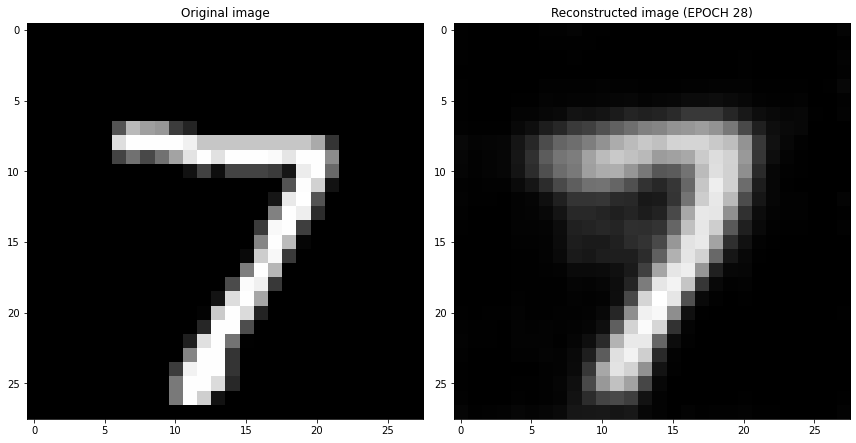

EPOCH 29/30
	 partial train loss (single batch): 0.041108
	 partial train loss (single batch): 0.043111
	 partial train loss (single batch): 0.042615
	 partial train loss (single batch): 0.041576
	 partial train loss (single batch): 0.042008
	 partial train loss (single batch): 0.038954
	 partial train loss (single batch): 0.040129
	 partial train loss (single batch): 0.041456
	 partial train loss (single batch): 0.041023
	 partial train loss (single batch): 0.040460
	 partial train loss (single batch): 0.041548
	 partial train loss (single batch): 0.041363
	 partial train loss (single batch): 0.039019
	 partial train loss (single batch): 0.039395
	 partial train loss (single batch): 0.039783
	 partial train loss (single batch): 0.043036
	 partial train loss (single batch): 0.039257
	 partial train loss (single batch): 0.040322
	 partial train loss (single batch): 0.040963
	 partial train loss (single batch): 0.040283
	 partial train loss (single batch): 0.040825
	 partial train loss (

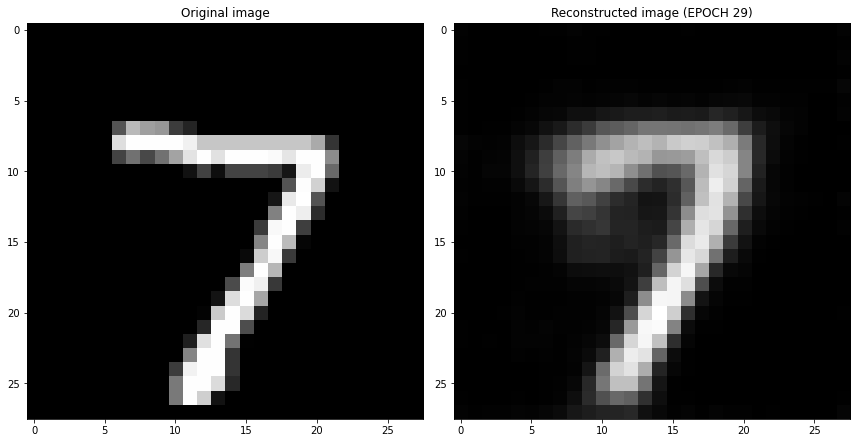

EPOCH 30/30
	 partial train loss (single batch): 0.042116
	 partial train loss (single batch): 0.042060
	 partial train loss (single batch): 0.040547
	 partial train loss (single batch): 0.040267
	 partial train loss (single batch): 0.040061
	 partial train loss (single batch): 0.039655
	 partial train loss (single batch): 0.040186
	 partial train loss (single batch): 0.039786
	 partial train loss (single batch): 0.038781
	 partial train loss (single batch): 0.037985
	 partial train loss (single batch): 0.039983
	 partial train loss (single batch): 0.040141
	 partial train loss (single batch): 0.041119
	 partial train loss (single batch): 0.040722
	 partial train loss (single batch): 0.040717
	 partial train loss (single batch): 0.040472
	 partial train loss (single batch): 0.040664
	 partial train loss (single batch): 0.041126
	 partial train loss (single batch): 0.040483
	 partial train loss (single batch): 0.040780
	 partial train loss (single batch): 0.041439
	 partial train loss (

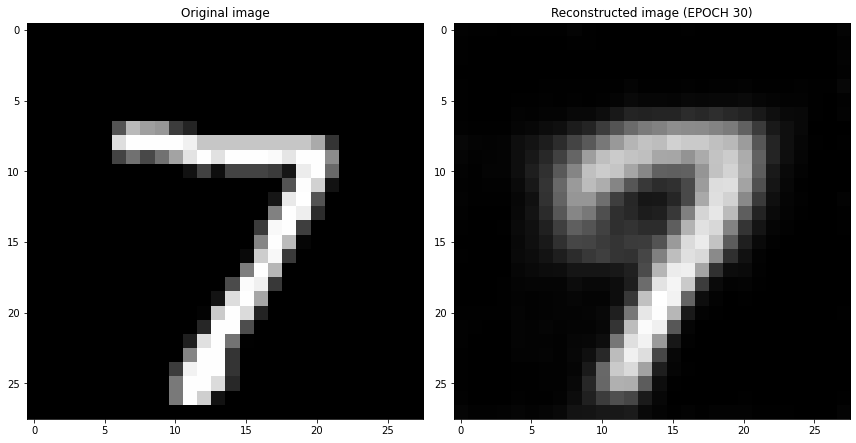

Cross validation fold number= 2/6
EPOCH 1/30
	 partial train loss (single batch): 0.216688
	 partial train loss (single batch): 0.212083
	 partial train loss (single batch): 0.206001
	 partial train loss (single batch): 0.194904
	 partial train loss (single batch): 0.175542
	 partial train loss (single batch): 0.143257
	 partial train loss (single batch): 0.109669
	 partial train loss (single batch): 0.116431
	 partial train loss (single batch): 0.115396
	 partial train loss (single batch): 0.115095
	 partial train loss (single batch): 0.113303
	 partial train loss (single batch): 0.112434
	 partial train loss (single batch): 0.109771
	 partial train loss (single batch): 0.110007
	 partial train loss (single batch): 0.110323
	 partial train loss (single batch): 0.110218
	 partial train loss (single batch): 0.107240
	 partial train loss (single batch): 0.109794
	 partial train loss (single batch): 0.111981
	 partial train loss (single batch): 0.111220
	 partial train loss (single batch)

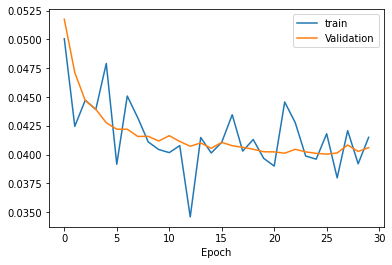

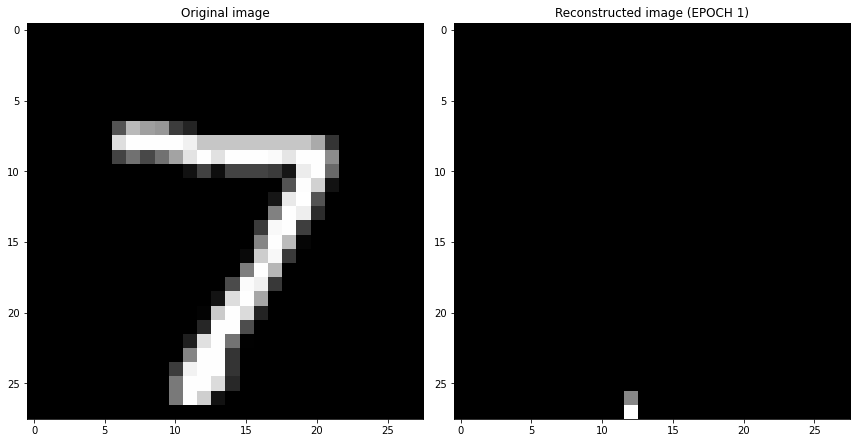

EPOCH 2/30
	 partial train loss (single batch): 0.110880
	 partial train loss (single batch): 0.110850
	 partial train loss (single batch): 0.116321
	 partial train loss (single batch): 0.113052
	 partial train loss (single batch): 0.110873
	 partial train loss (single batch): 0.112970
	 partial train loss (single batch): 0.111200
	 partial train loss (single batch): 0.114173
	 partial train loss (single batch): 0.110499
	 partial train loss (single batch): 0.119737
	 partial train loss (single batch): 0.112554
	 partial train loss (single batch): 0.107363
	 partial train loss (single batch): 0.112060
	 partial train loss (single batch): 0.113539
	 partial train loss (single batch): 0.110444
	 partial train loss (single batch): 0.111095
	 partial train loss (single batch): 0.107054
	 partial train loss (single batch): 0.109336
	 partial train loss (single batch): 0.112070
	 partial train loss (single batch): 0.113494
	 partial train loss (single batch): 0.111596
	 partial train loss (s

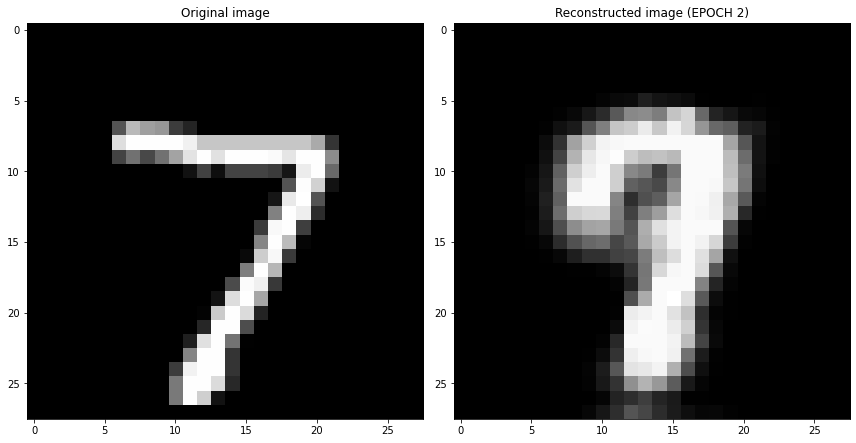

EPOCH 3/30
	 partial train loss (single batch): 0.054252
	 partial train loss (single batch): 0.054523
	 partial train loss (single batch): 0.055352
	 partial train loss (single batch): 0.056824
	 partial train loss (single batch): 0.055038
	 partial train loss (single batch): 0.055527
	 partial train loss (single batch): 0.053667
	 partial train loss (single batch): 0.052195
	 partial train loss (single batch): 0.054420
	 partial train loss (single batch): 0.054721
	 partial train loss (single batch): 0.053745
	 partial train loss (single batch): 0.052890
	 partial train loss (single batch): 0.054060
	 partial train loss (single batch): 0.054263
	 partial train loss (single batch): 0.052816
	 partial train loss (single batch): 0.051889
	 partial train loss (single batch): 0.054013
	 partial train loss (single batch): 0.053046
	 partial train loss (single batch): 0.053999
	 partial train loss (single batch): 0.054093
	 partial train loss (single batch): 0.053841
	 partial train loss (s

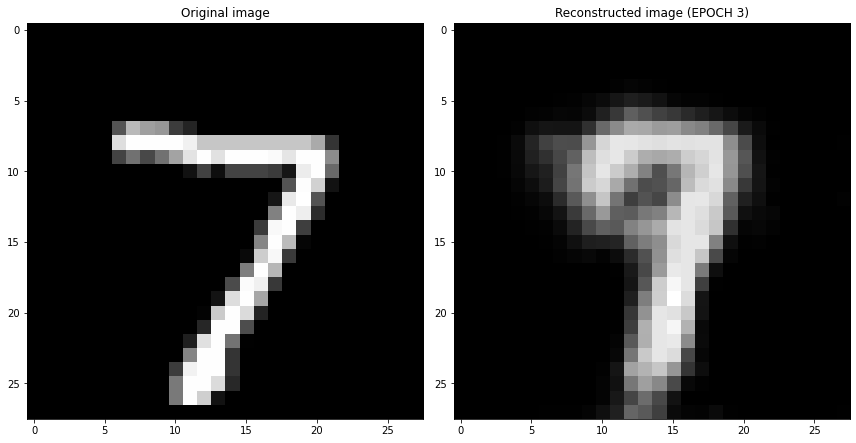

EPOCH 4/30
	 partial train loss (single batch): 0.045003
	 partial train loss (single batch): 0.048453
	 partial train loss (single batch): 0.049107
	 partial train loss (single batch): 0.049376
	 partial train loss (single batch): 0.048419
	 partial train loss (single batch): 0.048877
	 partial train loss (single batch): 0.047835
	 partial train loss (single batch): 0.050532
	 partial train loss (single batch): 0.048293
	 partial train loss (single batch): 0.048433
	 partial train loss (single batch): 0.048633
	 partial train loss (single batch): 0.047863
	 partial train loss (single batch): 0.050188
	 partial train loss (single batch): 0.047901
	 partial train loss (single batch): 0.048012
	 partial train loss (single batch): 0.048084
	 partial train loss (single batch): 0.048233
	 partial train loss (single batch): 0.048860
	 partial train loss (single batch): 0.046759
	 partial train loss (single batch): 0.048390
	 partial train loss (single batch): 0.048159
	 partial train loss (s

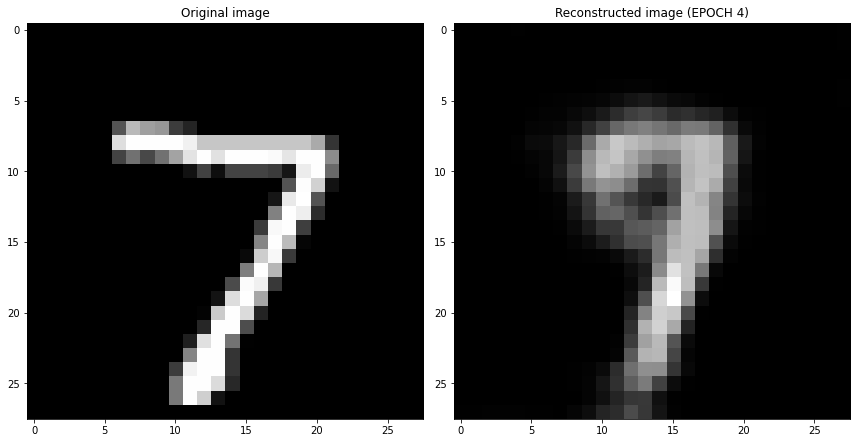

EPOCH 5/30
	 partial train loss (single batch): 0.045510
	 partial train loss (single batch): 0.048734
	 partial train loss (single batch): 0.043940
	 partial train loss (single batch): 0.046056
	 partial train loss (single batch): 0.045921
	 partial train loss (single batch): 0.045921
	 partial train loss (single batch): 0.046854
	 partial train loss (single batch): 0.044966
	 partial train loss (single batch): 0.045985
	 partial train loss (single batch): 0.044802
	 partial train loss (single batch): 0.044823
	 partial train loss (single batch): 0.043376
	 partial train loss (single batch): 0.046501
	 partial train loss (single batch): 0.044311
	 partial train loss (single batch): 0.045080
	 partial train loss (single batch): 0.045866
	 partial train loss (single batch): 0.046000
	 partial train loss (single batch): 0.046827
	 partial train loss (single batch): 0.047587
	 partial train loss (single batch): 0.043834
	 partial train loss (single batch): 0.046181
	 partial train loss (s

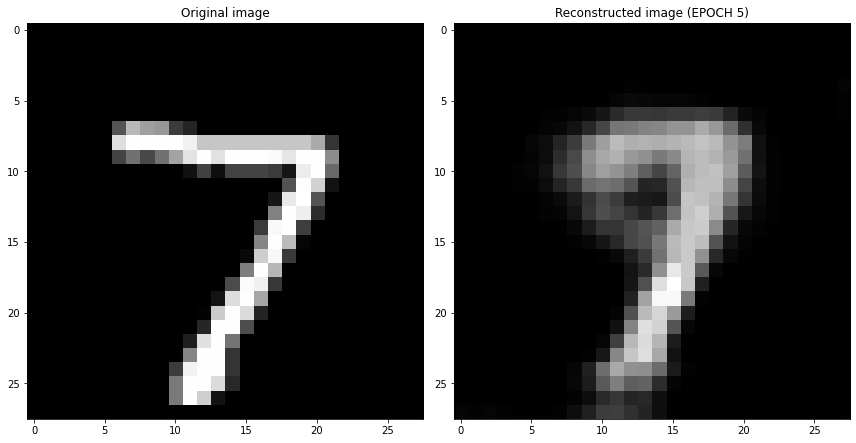

EPOCH 6/30
	 partial train loss (single batch): 0.047052
	 partial train loss (single batch): 0.043855
	 partial train loss (single batch): 0.045008
	 partial train loss (single batch): 0.042643
	 partial train loss (single batch): 0.043844
	 partial train loss (single batch): 0.041969
	 partial train loss (single batch): 0.043862
	 partial train loss (single batch): 0.042033
	 partial train loss (single batch): 0.044463
	 partial train loss (single batch): 0.044208
	 partial train loss (single batch): 0.043914
	 partial train loss (single batch): 0.043769
	 partial train loss (single batch): 0.044806
	 partial train loss (single batch): 0.044394
	 partial train loss (single batch): 0.043355
	 partial train loss (single batch): 0.045753
	 partial train loss (single batch): 0.045000
	 partial train loss (single batch): 0.041476
	 partial train loss (single batch): 0.042353
	 partial train loss (single batch): 0.041689
	 partial train loss (single batch): 0.046558
	 partial train loss (s

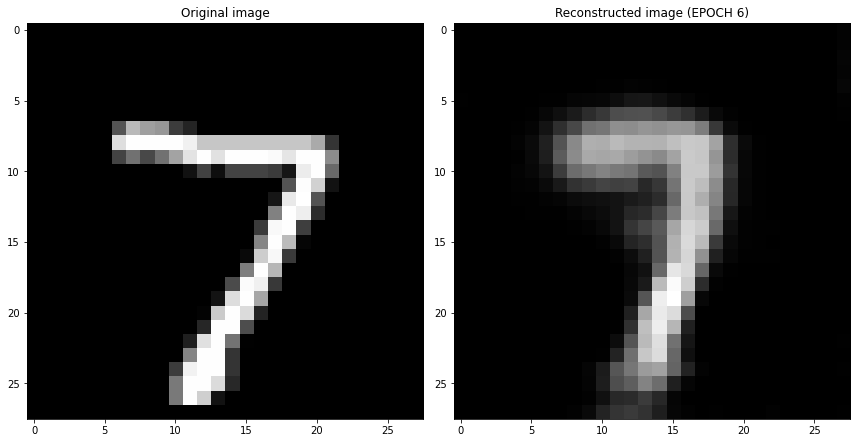

EPOCH 7/30
	 partial train loss (single batch): 0.042341
	 partial train loss (single batch): 0.042035
	 partial train loss (single batch): 0.042296
	 partial train loss (single batch): 0.040603
	 partial train loss (single batch): 0.043594
	 partial train loss (single batch): 0.043568
	 partial train loss (single batch): 0.043079
	 partial train loss (single batch): 0.044146
	 partial train loss (single batch): 0.044415
	 partial train loss (single batch): 0.041341
	 partial train loss (single batch): 0.044353
	 partial train loss (single batch): 0.043739
	 partial train loss (single batch): 0.041821
	 partial train loss (single batch): 0.042632
	 partial train loss (single batch): 0.042707
	 partial train loss (single batch): 0.042051
	 partial train loss (single batch): 0.044835
	 partial train loss (single batch): 0.045184
	 partial train loss (single batch): 0.042702
	 partial train loss (single batch): 0.044100
	 partial train loss (single batch): 0.043105
	 partial train loss (s

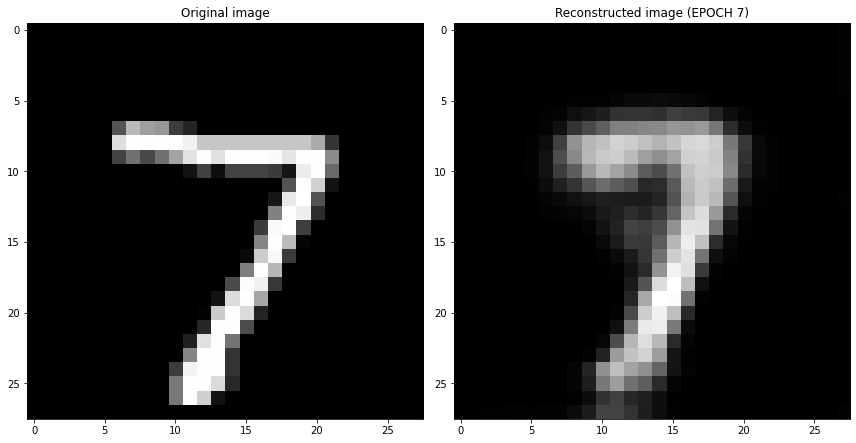

EPOCH 8/30
	 partial train loss (single batch): 0.041050
	 partial train loss (single batch): 0.041192
	 partial train loss (single batch): 0.043032
	 partial train loss (single batch): 0.042026
	 partial train loss (single batch): 0.041438
	 partial train loss (single batch): 0.044401
	 partial train loss (single batch): 0.042632
	 partial train loss (single batch): 0.042138
	 partial train loss (single batch): 0.042794
	 partial train loss (single batch): 0.042099
	 partial train loss (single batch): 0.041551
	 partial train loss (single batch): 0.041886
	 partial train loss (single batch): 0.042221
	 partial train loss (single batch): 0.043219
	 partial train loss (single batch): 0.042294
	 partial train loss (single batch): 0.042130
	 partial train loss (single batch): 0.043019
	 partial train loss (single batch): 0.042673
	 partial train loss (single batch): 0.042153
	 partial train loss (single batch): 0.041319
	 partial train loss (single batch): 0.043132
	 partial train loss (s

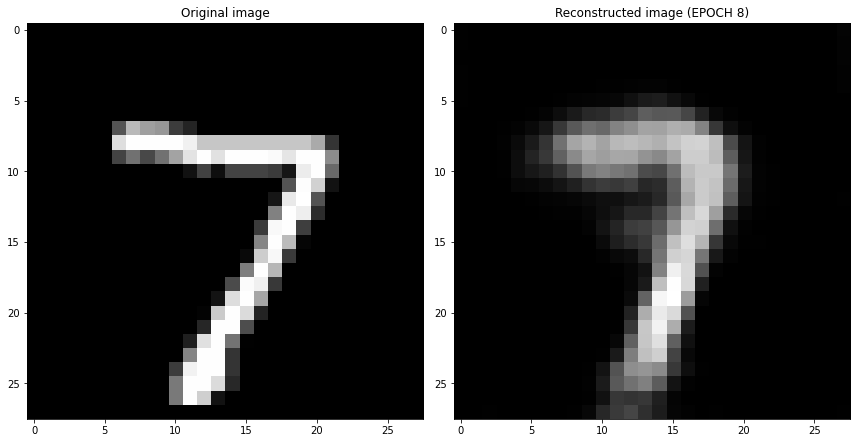

EPOCH 9/30
	 partial train loss (single batch): 0.042921
	 partial train loss (single batch): 0.043019
	 partial train loss (single batch): 0.040532
	 partial train loss (single batch): 0.043279
	 partial train loss (single batch): 0.040515
	 partial train loss (single batch): 0.044865
	 partial train loss (single batch): 0.041791
	 partial train loss (single batch): 0.043610
	 partial train loss (single batch): 0.043569
	 partial train loss (single batch): 0.043976
	 partial train loss (single batch): 0.040320
	 partial train loss (single batch): 0.043691
	 partial train loss (single batch): 0.042060
	 partial train loss (single batch): 0.040847
	 partial train loss (single batch): 0.045325
	 partial train loss (single batch): 0.041152
	 partial train loss (single batch): 0.043288
	 partial train loss (single batch): 0.039461
	 partial train loss (single batch): 0.041948
	 partial train loss (single batch): 0.043323
	 partial train loss (single batch): 0.041618
	 partial train loss (s

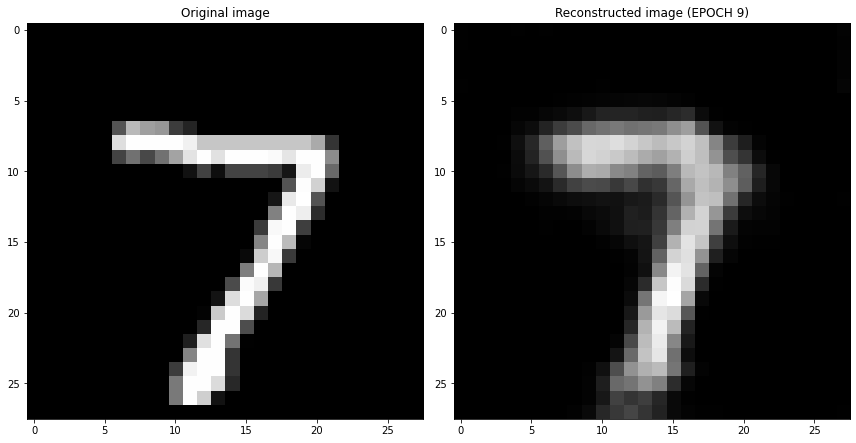

EPOCH 10/30
	 partial train loss (single batch): 0.044810
	 partial train loss (single batch): 0.043698
	 partial train loss (single batch): 0.043173
	 partial train loss (single batch): 0.042563
	 partial train loss (single batch): 0.041024
	 partial train loss (single batch): 0.041604
	 partial train loss (single batch): 0.041220
	 partial train loss (single batch): 0.042403
	 partial train loss (single batch): 0.041257
	 partial train loss (single batch): 0.041383
	 partial train loss (single batch): 0.039836
	 partial train loss (single batch): 0.042259
	 partial train loss (single batch): 0.042979
	 partial train loss (single batch): 0.042312
	 partial train loss (single batch): 0.042709
	 partial train loss (single batch): 0.042889
	 partial train loss (single batch): 0.040927
	 partial train loss (single batch): 0.042361
	 partial train loss (single batch): 0.041614
	 partial train loss (single batch): 0.041078
	 partial train loss (single batch): 0.039817
	 partial train loss (

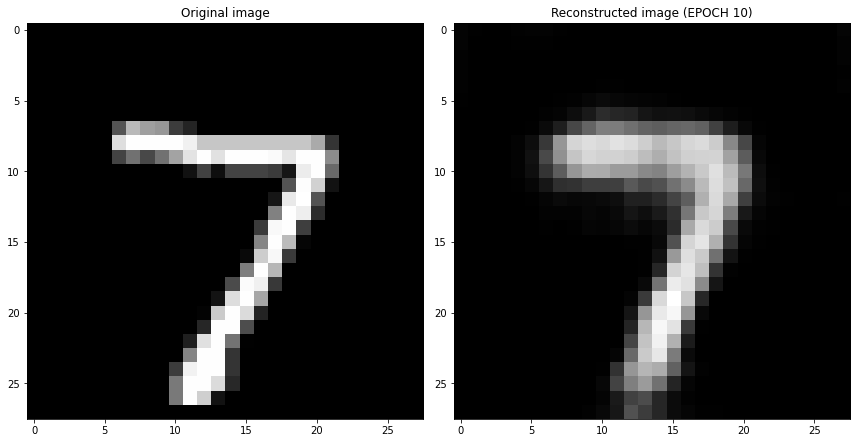

EPOCH 11/30
	 partial train loss (single batch): 0.040809
	 partial train loss (single batch): 0.042571
	 partial train loss (single batch): 0.042831
	 partial train loss (single batch): 0.041244
	 partial train loss (single batch): 0.043336
	 partial train loss (single batch): 0.044257
	 partial train loss (single batch): 0.042203
	 partial train loss (single batch): 0.042084
	 partial train loss (single batch): 0.045304
	 partial train loss (single batch): 0.042281
	 partial train loss (single batch): 0.042527
	 partial train loss (single batch): 0.042027
	 partial train loss (single batch): 0.042604
	 partial train loss (single batch): 0.042428
	 partial train loss (single batch): 0.042270
	 partial train loss (single batch): 0.041618
	 partial train loss (single batch): 0.041374
	 partial train loss (single batch): 0.042310
	 partial train loss (single batch): 0.043268
	 partial train loss (single batch): 0.041611
	 partial train loss (single batch): 0.040472
	 partial train loss (

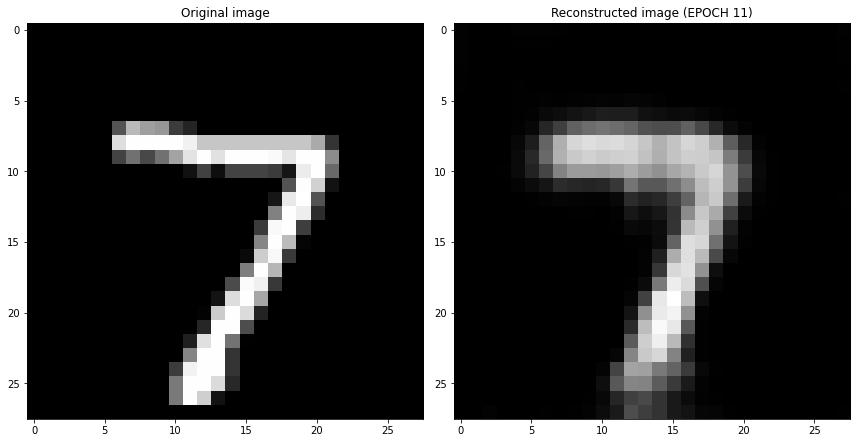

EPOCH 12/30
	 partial train loss (single batch): 0.039487
	 partial train loss (single batch): 0.041249
	 partial train loss (single batch): 0.040027
	 partial train loss (single batch): 0.042255
	 partial train loss (single batch): 0.041968
	 partial train loss (single batch): 0.041516
	 partial train loss (single batch): 0.040413
	 partial train loss (single batch): 0.041350
	 partial train loss (single batch): 0.041834
	 partial train loss (single batch): 0.041872
	 partial train loss (single batch): 0.040750
	 partial train loss (single batch): 0.042810
	 partial train loss (single batch): 0.041267
	 partial train loss (single batch): 0.039507
	 partial train loss (single batch): 0.043140
	 partial train loss (single batch): 0.041340
	 partial train loss (single batch): 0.040991
	 partial train loss (single batch): 0.041139
	 partial train loss (single batch): 0.042431
	 partial train loss (single batch): 0.040516
	 partial train loss (single batch): 0.040431
	 partial train loss (

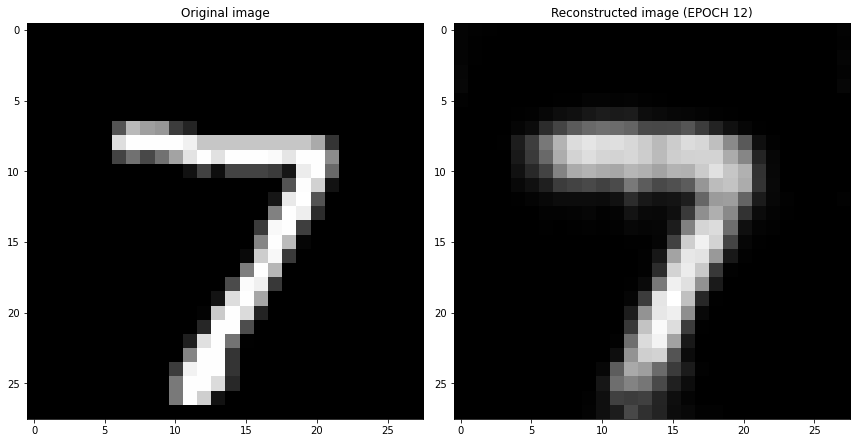

EPOCH 13/30
	 partial train loss (single batch): 0.041312
	 partial train loss (single batch): 0.042491
	 partial train loss (single batch): 0.040863
	 partial train loss (single batch): 0.040902
	 partial train loss (single batch): 0.040368
	 partial train loss (single batch): 0.041697
	 partial train loss (single batch): 0.040070
	 partial train loss (single batch): 0.041557
	 partial train loss (single batch): 0.041857
	 partial train loss (single batch): 0.041372
	 partial train loss (single batch): 0.039530
	 partial train loss (single batch): 0.040262
	 partial train loss (single batch): 0.042493
	 partial train loss (single batch): 0.041392
	 partial train loss (single batch): 0.041926
	 partial train loss (single batch): 0.042410
	 partial train loss (single batch): 0.041925
	 partial train loss (single batch): 0.042862
	 partial train loss (single batch): 0.042556
	 partial train loss (single batch): 0.042009
	 partial train loss (single batch): 0.039424
	 partial train loss (

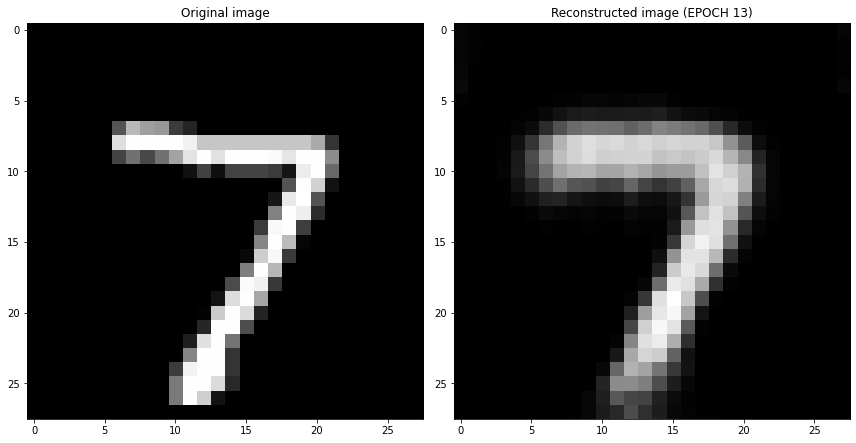

EPOCH 14/30
	 partial train loss (single batch): 0.040137
	 partial train loss (single batch): 0.041786
	 partial train loss (single batch): 0.040045
	 partial train loss (single batch): 0.040865
	 partial train loss (single batch): 0.040063
	 partial train loss (single batch): 0.040005
	 partial train loss (single batch): 0.041951
	 partial train loss (single batch): 0.041763
	 partial train loss (single batch): 0.041013
	 partial train loss (single batch): 0.039247
	 partial train loss (single batch): 0.041474
	 partial train loss (single batch): 0.039632
	 partial train loss (single batch): 0.041684
	 partial train loss (single batch): 0.039321
	 partial train loss (single batch): 0.040403
	 partial train loss (single batch): 0.041335
	 partial train loss (single batch): 0.040635
	 partial train loss (single batch): 0.043221
	 partial train loss (single batch): 0.040154
	 partial train loss (single batch): 0.041466
	 partial train loss (single batch): 0.041323
	 partial train loss (

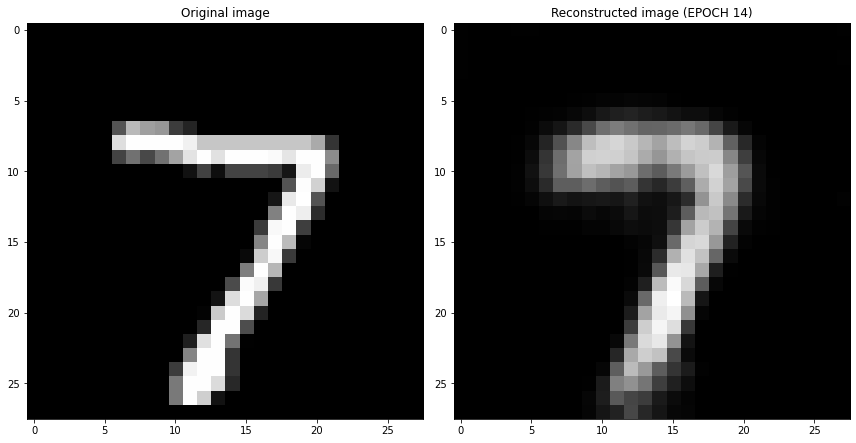

EPOCH 15/30
	 partial train loss (single batch): 0.042747
	 partial train loss (single batch): 0.039577
	 partial train loss (single batch): 0.042233
	 partial train loss (single batch): 0.042216
	 partial train loss (single batch): 0.040206
	 partial train loss (single batch): 0.042688
	 partial train loss (single batch): 0.043197
	 partial train loss (single batch): 0.041921
	 partial train loss (single batch): 0.039450
	 partial train loss (single batch): 0.038995
	 partial train loss (single batch): 0.041924
	 partial train loss (single batch): 0.042335
	 partial train loss (single batch): 0.042102
	 partial train loss (single batch): 0.040045
	 partial train loss (single batch): 0.039059
	 partial train loss (single batch): 0.042462
	 partial train loss (single batch): 0.041475
	 partial train loss (single batch): 0.040314
	 partial train loss (single batch): 0.040458
	 partial train loss (single batch): 0.042519
	 partial train loss (single batch): 0.040228
	 partial train loss (

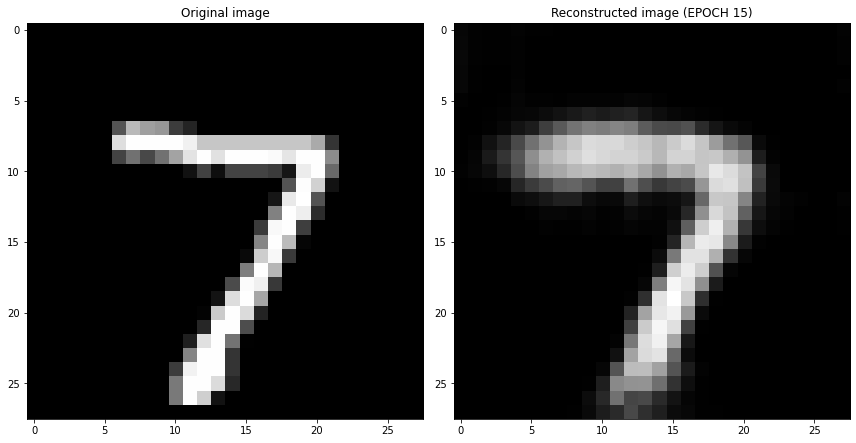

EPOCH 16/30
	 partial train loss (single batch): 0.042140
	 partial train loss (single batch): 0.041355
	 partial train loss (single batch): 0.041845
	 partial train loss (single batch): 0.041545
	 partial train loss (single batch): 0.043812
	 partial train loss (single batch): 0.041231
	 partial train loss (single batch): 0.040396
	 partial train loss (single batch): 0.041007
	 partial train loss (single batch): 0.041304
	 partial train loss (single batch): 0.043268
	 partial train loss (single batch): 0.040383
	 partial train loss (single batch): 0.040766
	 partial train loss (single batch): 0.040404
	 partial train loss (single batch): 0.041817
	 partial train loss (single batch): 0.038583
	 partial train loss (single batch): 0.040829
	 partial train loss (single batch): 0.041346
	 partial train loss (single batch): 0.041465
	 partial train loss (single batch): 0.043167
	 partial train loss (single batch): 0.041955
	 partial train loss (single batch): 0.040417
	 partial train loss (

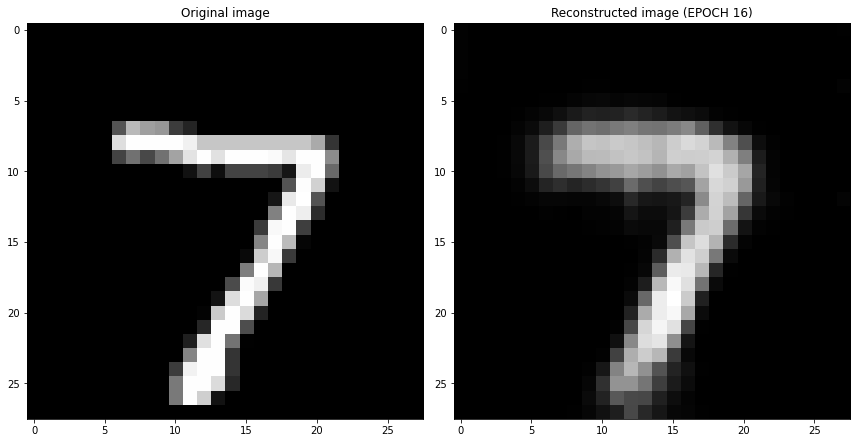

EPOCH 17/30
	 partial train loss (single batch): 0.041229
	 partial train loss (single batch): 0.038868
	 partial train loss (single batch): 0.042207
	 partial train loss (single batch): 0.039558
	 partial train loss (single batch): 0.041231
	 partial train loss (single batch): 0.039798
	 partial train loss (single batch): 0.041942
	 partial train loss (single batch): 0.040717
	 partial train loss (single batch): 0.039456
	 partial train loss (single batch): 0.038959
	 partial train loss (single batch): 0.038789
	 partial train loss (single batch): 0.040483
	 partial train loss (single batch): 0.038570
	 partial train loss (single batch): 0.039539
	 partial train loss (single batch): 0.039048
	 partial train loss (single batch): 0.041343
	 partial train loss (single batch): 0.039517
	 partial train loss (single batch): 0.040087
	 partial train loss (single batch): 0.039317
	 partial train loss (single batch): 0.041099
	 partial train loss (single batch): 0.040437
	 partial train loss (

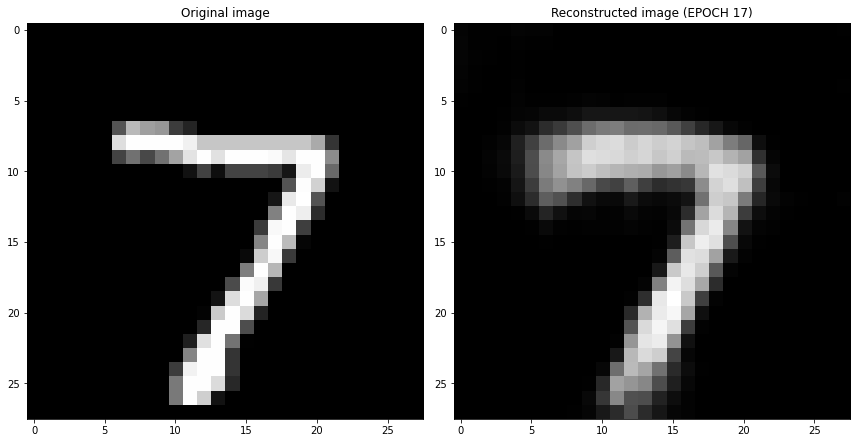

EPOCH 18/30
	 partial train loss (single batch): 0.039346
	 partial train loss (single batch): 0.038808
	 partial train loss (single batch): 0.039837
	 partial train loss (single batch): 0.040499
	 partial train loss (single batch): 0.040129
	 partial train loss (single batch): 0.040500
	 partial train loss (single batch): 0.040669
	 partial train loss (single batch): 0.041506
	 partial train loss (single batch): 0.040304
	 partial train loss (single batch): 0.041336
	 partial train loss (single batch): 0.041106
	 partial train loss (single batch): 0.039933
	 partial train loss (single batch): 0.040527
	 partial train loss (single batch): 0.040028
	 partial train loss (single batch): 0.040799
	 partial train loss (single batch): 0.041305
	 partial train loss (single batch): 0.042476
	 partial train loss (single batch): 0.042146
	 partial train loss (single batch): 0.040729
	 partial train loss (single batch): 0.039440
	 partial train loss (single batch): 0.038932
	 partial train loss (

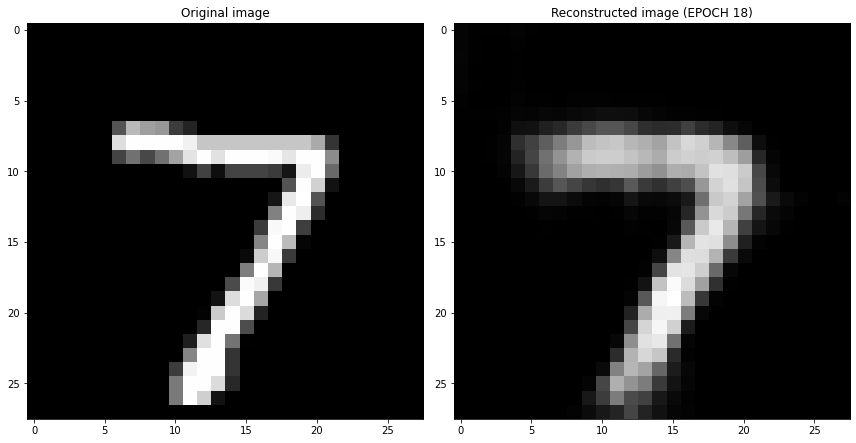

EPOCH 19/30
	 partial train loss (single batch): 0.040450
	 partial train loss (single batch): 0.040580
	 partial train loss (single batch): 0.040809
	 partial train loss (single batch): 0.039155
	 partial train loss (single batch): 0.040268
	 partial train loss (single batch): 0.040967
	 partial train loss (single batch): 0.040741
	 partial train loss (single batch): 0.042069
	 partial train loss (single batch): 0.039488
	 partial train loss (single batch): 0.039028
	 partial train loss (single batch): 0.040899
	 partial train loss (single batch): 0.039989
	 partial train loss (single batch): 0.042117
	 partial train loss (single batch): 0.039387
	 partial train loss (single batch): 0.041543
	 partial train loss (single batch): 0.040476
	 partial train loss (single batch): 0.040061
	 partial train loss (single batch): 0.040284
	 partial train loss (single batch): 0.039945
	 partial train loss (single batch): 0.038212
	 partial train loss (single batch): 0.040494
	 partial train loss (

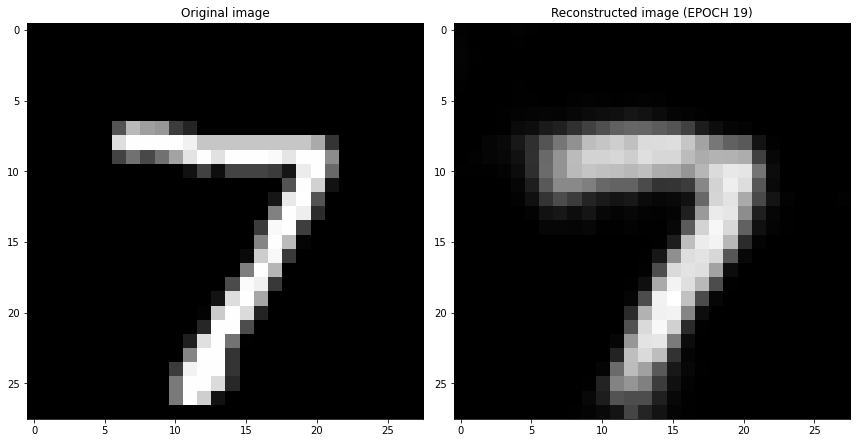

EPOCH 20/30
	 partial train loss (single batch): 0.040215
	 partial train loss (single batch): 0.040387
	 partial train loss (single batch): 0.043316
	 partial train loss (single batch): 0.041292
	 partial train loss (single batch): 0.040375
	 partial train loss (single batch): 0.039950
	 partial train loss (single batch): 0.039783
	 partial train loss (single batch): 0.040825
	 partial train loss (single batch): 0.040481
	 partial train loss (single batch): 0.041973
	 partial train loss (single batch): 0.039632
	 partial train loss (single batch): 0.039016
	 partial train loss (single batch): 0.039533
	 partial train loss (single batch): 0.040521
	 partial train loss (single batch): 0.039964
	 partial train loss (single batch): 0.039410
	 partial train loss (single batch): 0.042004
	 partial train loss (single batch): 0.039727
	 partial train loss (single batch): 0.040945
	 partial train loss (single batch): 0.039678
	 partial train loss (single batch): 0.038659
	 partial train loss (

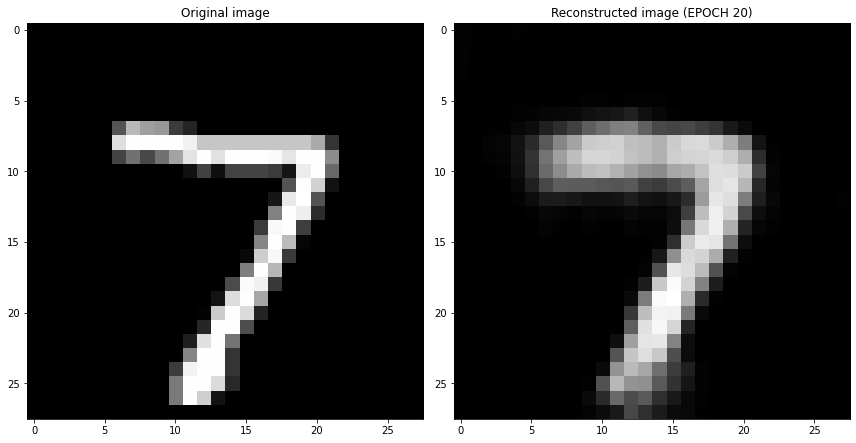

EPOCH 21/30
	 partial train loss (single batch): 0.040082
	 partial train loss (single batch): 0.043083
	 partial train loss (single batch): 0.040186
	 partial train loss (single batch): 0.041326
	 partial train loss (single batch): 0.039785
	 partial train loss (single batch): 0.041448
	 partial train loss (single batch): 0.041265
	 partial train loss (single batch): 0.041847
	 partial train loss (single batch): 0.039615
	 partial train loss (single batch): 0.040951
	 partial train loss (single batch): 0.040948
	 partial train loss (single batch): 0.042285
	 partial train loss (single batch): 0.043128
	 partial train loss (single batch): 0.042870
	 partial train loss (single batch): 0.041238
	 partial train loss (single batch): 0.040855
	 partial train loss (single batch): 0.041405
	 partial train loss (single batch): 0.039727
	 partial train loss (single batch): 0.043233
	 partial train loss (single batch): 0.039161
	 partial train loss (single batch): 0.040648
	 partial train loss (

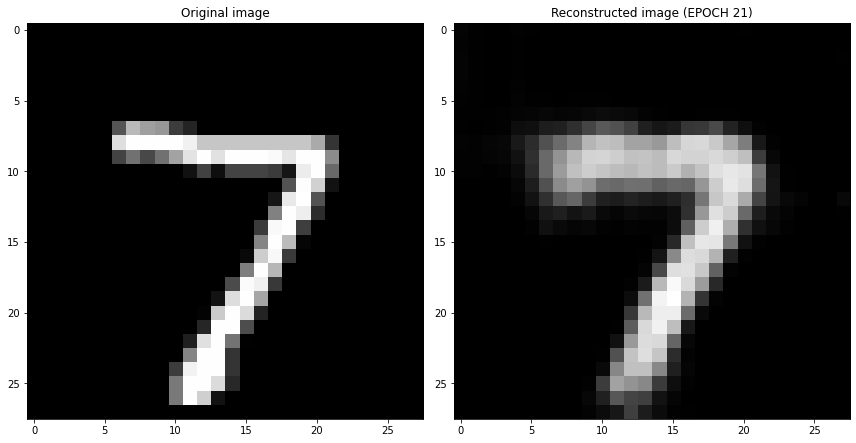

EPOCH 22/30
	 partial train loss (single batch): 0.039596
	 partial train loss (single batch): 0.039965
	 partial train loss (single batch): 0.039981
	 partial train loss (single batch): 0.040925
	 partial train loss (single batch): 0.040199
	 partial train loss (single batch): 0.040662
	 partial train loss (single batch): 0.039972
	 partial train loss (single batch): 0.039684
	 partial train loss (single batch): 0.040668
	 partial train loss (single batch): 0.039235
	 partial train loss (single batch): 0.041686
	 partial train loss (single batch): 0.039925
	 partial train loss (single batch): 0.039070
	 partial train loss (single batch): 0.039670
	 partial train loss (single batch): 0.039624
	 partial train loss (single batch): 0.042641
	 partial train loss (single batch): 0.040317
	 partial train loss (single batch): 0.042237
	 partial train loss (single batch): 0.040805
	 partial train loss (single batch): 0.040065
	 partial train loss (single batch): 0.041219
	 partial train loss (

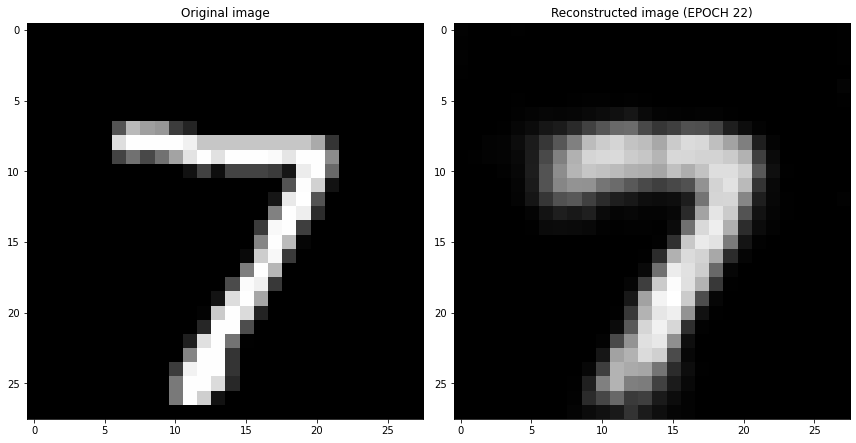

EPOCH 23/30
	 partial train loss (single batch): 0.039902
	 partial train loss (single batch): 0.040459
	 partial train loss (single batch): 0.040845
	 partial train loss (single batch): 0.043364
	 partial train loss (single batch): 0.042805
	 partial train loss (single batch): 0.041618
	 partial train loss (single batch): 0.039961
	 partial train loss (single batch): 0.040914
	 partial train loss (single batch): 0.040032
	 partial train loss (single batch): 0.040394
	 partial train loss (single batch): 0.038750
	 partial train loss (single batch): 0.040283
	 partial train loss (single batch): 0.040058
	 partial train loss (single batch): 0.041359
	 partial train loss (single batch): 0.039741
	 partial train loss (single batch): 0.040415
	 partial train loss (single batch): 0.038823
	 partial train loss (single batch): 0.038913
	 partial train loss (single batch): 0.038233
	 partial train loss (single batch): 0.041098
	 partial train loss (single batch): 0.038891
	 partial train loss (

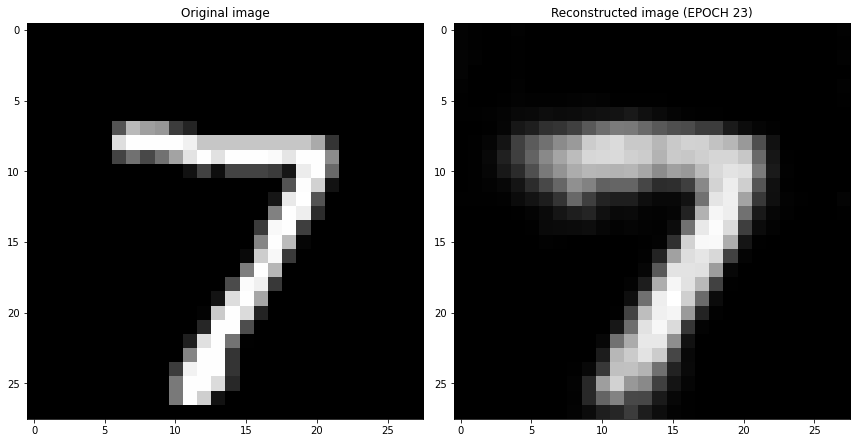

EPOCH 24/30
	 partial train loss (single batch): 0.040701
	 partial train loss (single batch): 0.040149
	 partial train loss (single batch): 0.039171
	 partial train loss (single batch): 0.039695
	 partial train loss (single batch): 0.042511
	 partial train loss (single batch): 0.038758
	 partial train loss (single batch): 0.040832
	 partial train loss (single batch): 0.039729
	 partial train loss (single batch): 0.039851
	 partial train loss (single batch): 0.039360
	 partial train loss (single batch): 0.040202
	 partial train loss (single batch): 0.039614
	 partial train loss (single batch): 0.040179
	 partial train loss (single batch): 0.040840
	 partial train loss (single batch): 0.040437
	 partial train loss (single batch): 0.042767
	 partial train loss (single batch): 0.037663
	 partial train loss (single batch): 0.039838
	 partial train loss (single batch): 0.040918
	 partial train loss (single batch): 0.041573
	 partial train loss (single batch): 0.038532
	 partial train loss (

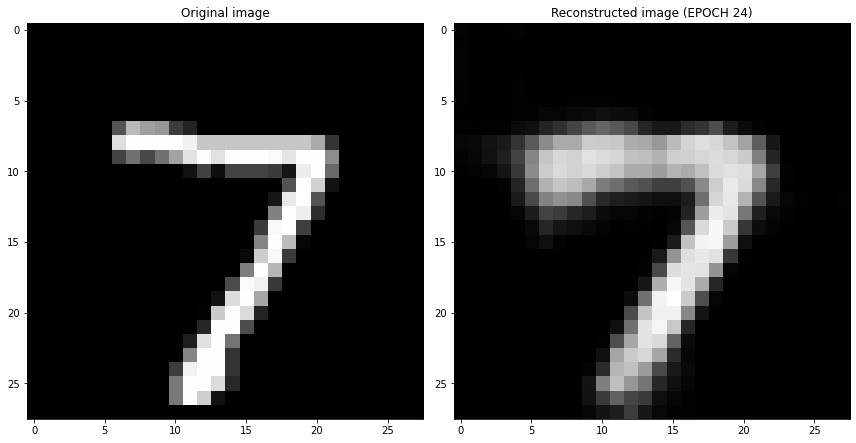

EPOCH 25/30
	 partial train loss (single batch): 0.040454
	 partial train loss (single batch): 0.041547
	 partial train loss (single batch): 0.040921
	 partial train loss (single batch): 0.040465
	 partial train loss (single batch): 0.039320
	 partial train loss (single batch): 0.040263
	 partial train loss (single batch): 0.039085
	 partial train loss (single batch): 0.041039
	 partial train loss (single batch): 0.040007
	 partial train loss (single batch): 0.038080
	 partial train loss (single batch): 0.039689
	 partial train loss (single batch): 0.040945
	 partial train loss (single batch): 0.040211
	 partial train loss (single batch): 0.039028
	 partial train loss (single batch): 0.041180
	 partial train loss (single batch): 0.039338
	 partial train loss (single batch): 0.039649
	 partial train loss (single batch): 0.041749
	 partial train loss (single batch): 0.040604
	 partial train loss (single batch): 0.038951
	 partial train loss (single batch): 0.040998
	 partial train loss (

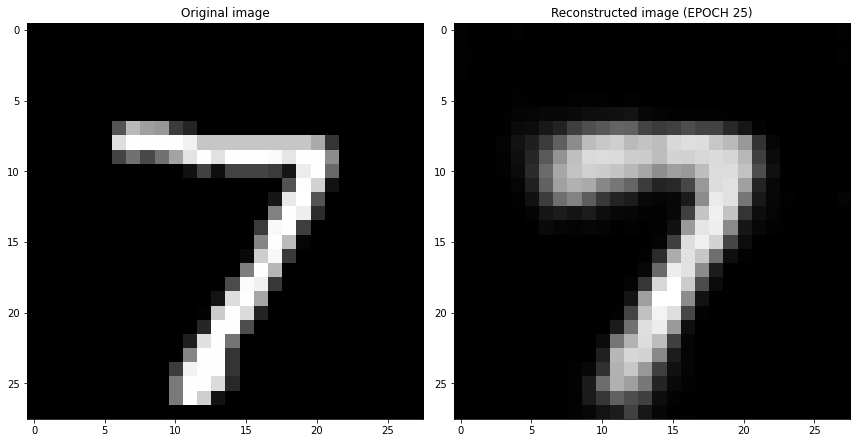

EPOCH 26/30
	 partial train loss (single batch): 0.038151
	 partial train loss (single batch): 0.041024
	 partial train loss (single batch): 0.040071
	 partial train loss (single batch): 0.041561
	 partial train loss (single batch): 0.040172
	 partial train loss (single batch): 0.040598
	 partial train loss (single batch): 0.038855
	 partial train loss (single batch): 0.039298
	 partial train loss (single batch): 0.039829
	 partial train loss (single batch): 0.041119
	 partial train loss (single batch): 0.040762
	 partial train loss (single batch): 0.039636
	 partial train loss (single batch): 0.038869
	 partial train loss (single batch): 0.040800
	 partial train loss (single batch): 0.041227
	 partial train loss (single batch): 0.039772
	 partial train loss (single batch): 0.041790
	 partial train loss (single batch): 0.039874
	 partial train loss (single batch): 0.038060
	 partial train loss (single batch): 0.038918
	 partial train loss (single batch): 0.037943
	 partial train loss (

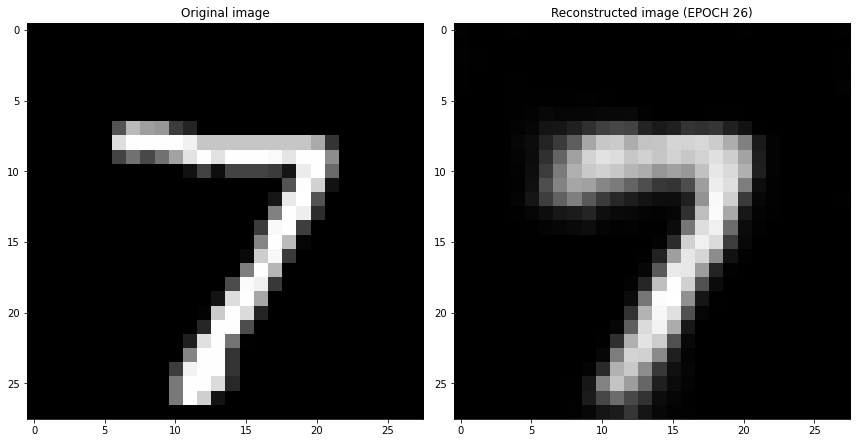

EPOCH 27/30
	 partial train loss (single batch): 0.040499
	 partial train loss (single batch): 0.037761
	 partial train loss (single batch): 0.040037
	 partial train loss (single batch): 0.039636
	 partial train loss (single batch): 0.040763
	 partial train loss (single batch): 0.041816
	 partial train loss (single batch): 0.039111
	 partial train loss (single batch): 0.038734
	 partial train loss (single batch): 0.040532
	 partial train loss (single batch): 0.039874
	 partial train loss (single batch): 0.041110
	 partial train loss (single batch): 0.038042
	 partial train loss (single batch): 0.040124
	 partial train loss (single batch): 0.041582
	 partial train loss (single batch): 0.039520
	 partial train loss (single batch): 0.040555
	 partial train loss (single batch): 0.038956
	 partial train loss (single batch): 0.042838
	 partial train loss (single batch): 0.038965
	 partial train loss (single batch): 0.040710
	 partial train loss (single batch): 0.042022
	 partial train loss (

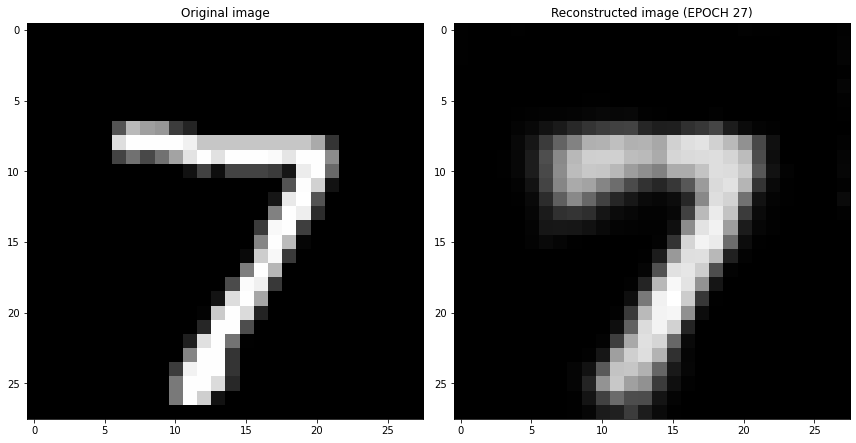

EPOCH 28/30
	 partial train loss (single batch): 0.040712
	 partial train loss (single batch): 0.039753
	 partial train loss (single batch): 0.039210
	 partial train loss (single batch): 0.041581
	 partial train loss (single batch): 0.040818
	 partial train loss (single batch): 0.041581
	 partial train loss (single batch): 0.038659
	 partial train loss (single batch): 0.039158
	 partial train loss (single batch): 0.040216
	 partial train loss (single batch): 0.040550
	 partial train loss (single batch): 0.039985
	 partial train loss (single batch): 0.040549
	 partial train loss (single batch): 0.038829
	 partial train loss (single batch): 0.037617
	 partial train loss (single batch): 0.039016
	 partial train loss (single batch): 0.040022
	 partial train loss (single batch): 0.040178
	 partial train loss (single batch): 0.039408
	 partial train loss (single batch): 0.039988
	 partial train loss (single batch): 0.040380
	 partial train loss (single batch): 0.038747
	 partial train loss (

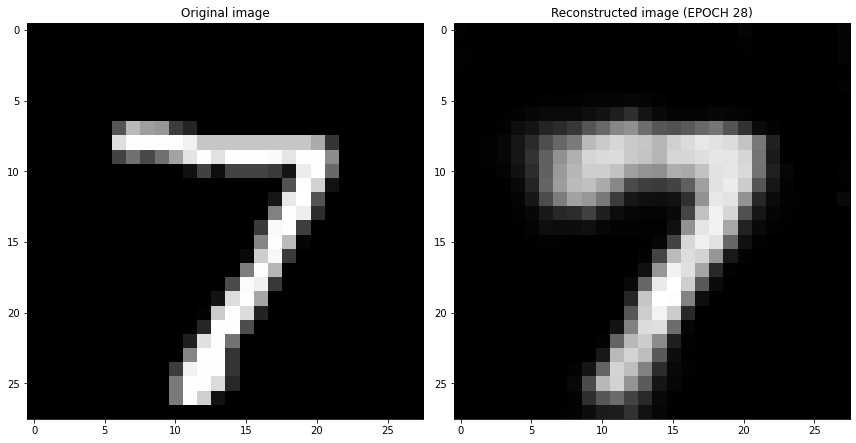

EPOCH 29/30
	 partial train loss (single batch): 0.039331
	 partial train loss (single batch): 0.039350
	 partial train loss (single batch): 0.039475
	 partial train loss (single batch): 0.038622
	 partial train loss (single batch): 0.037266
	 partial train loss (single batch): 0.039319
	 partial train loss (single batch): 0.039288
	 partial train loss (single batch): 0.040571
	 partial train loss (single batch): 0.039984
	 partial train loss (single batch): 0.040950
	 partial train loss (single batch): 0.039839
	 partial train loss (single batch): 0.039961
	 partial train loss (single batch): 0.039645
	 partial train loss (single batch): 0.040237
	 partial train loss (single batch): 0.040217
	 partial train loss (single batch): 0.040070
	 partial train loss (single batch): 0.040421
	 partial train loss (single batch): 0.039930
	 partial train loss (single batch): 0.039728
	 partial train loss (single batch): 0.041096
	 partial train loss (single batch): 0.040112
	 partial train loss (

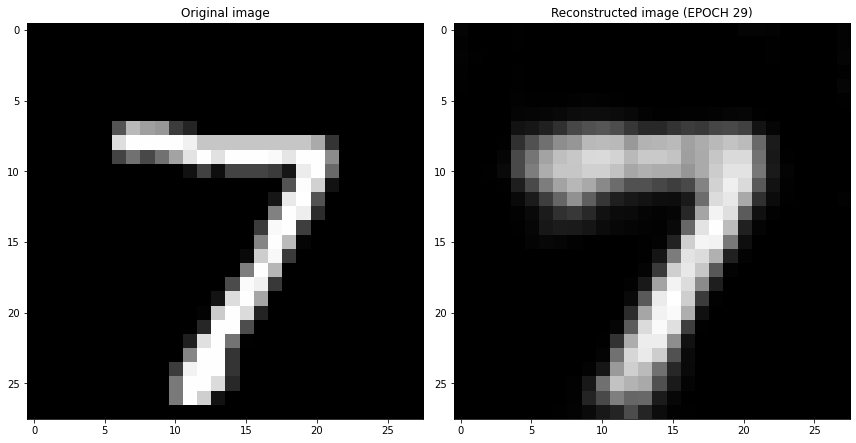

EPOCH 30/30
	 partial train loss (single batch): 0.040319
	 partial train loss (single batch): 0.037183
	 partial train loss (single batch): 0.039285
	 partial train loss (single batch): 0.041002
	 partial train loss (single batch): 0.041180
	 partial train loss (single batch): 0.039000
	 partial train loss (single batch): 0.039013
	 partial train loss (single batch): 0.038043
	 partial train loss (single batch): 0.038632
	 partial train loss (single batch): 0.038210
	 partial train loss (single batch): 0.039067
	 partial train loss (single batch): 0.041838
	 partial train loss (single batch): 0.039121
	 partial train loss (single batch): 0.039720
	 partial train loss (single batch): 0.039975
	 partial train loss (single batch): 0.038537
	 partial train loss (single batch): 0.039019
	 partial train loss (single batch): 0.040880
	 partial train loss (single batch): 0.041874
	 partial train loss (single batch): 0.039467
	 partial train loss (single batch): 0.040503
	 partial train loss (

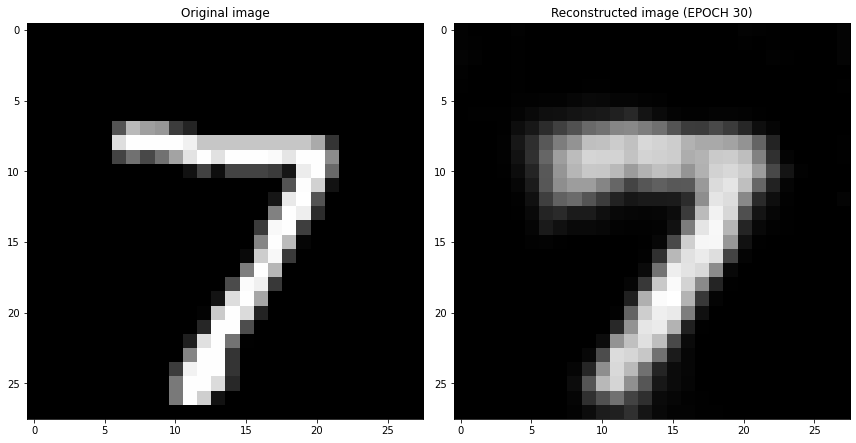

Cross validation fold number= 3/6
EPOCH 1/30
	 partial train loss (single batch): 0.239831
	 partial train loss (single batch): 0.235932
	 partial train loss (single batch): 0.227807
	 partial train loss (single batch): 0.215557
	 partial train loss (single batch): 0.197236
	 partial train loss (single batch): 0.174855
	 partial train loss (single batch): 0.155095
	 partial train loss (single batch): 0.131805
	 partial train loss (single batch): 0.108960
	 partial train loss (single batch): 0.105648
	 partial train loss (single batch): 0.109897
	 partial train loss (single batch): 0.112736
	 partial train loss (single batch): 0.112290
	 partial train loss (single batch): 0.108113
	 partial train loss (single batch): 0.112299
	 partial train loss (single batch): 0.112670
	 partial train loss (single batch): 0.109313
	 partial train loss (single batch): 0.110600
	 partial train loss (single batch): 0.108233
	 partial train loss (single batch): 0.101717
	 partial train loss (single batch)

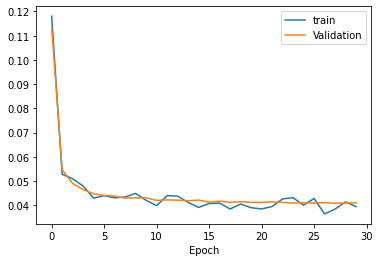

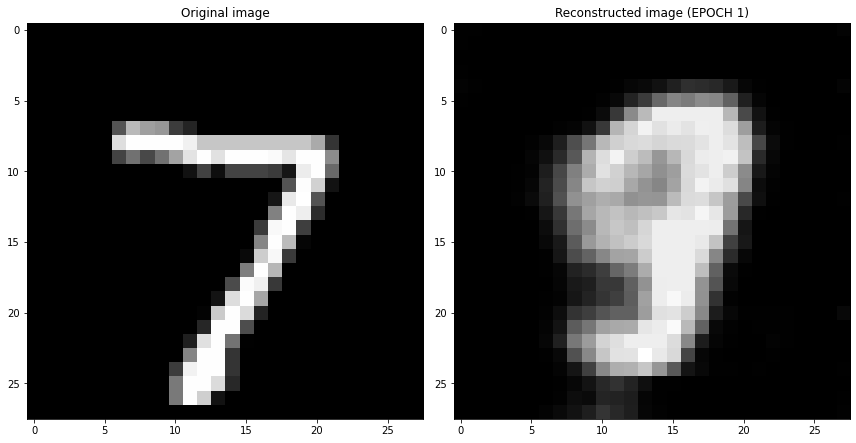

EPOCH 2/30
	 partial train loss (single batch): 0.053081
	 partial train loss (single batch): 0.055777
	 partial train loss (single batch): 0.054217
	 partial train loss (single batch): 0.053806
	 partial train loss (single batch): 0.053765
	 partial train loss (single batch): 0.054964
	 partial train loss (single batch): 0.056615
	 partial train loss (single batch): 0.055336
	 partial train loss (single batch): 0.052978
	 partial train loss (single batch): 0.053772
	 partial train loss (single batch): 0.055500
	 partial train loss (single batch): 0.053277
	 partial train loss (single batch): 0.052757
	 partial train loss (single batch): 0.056524
	 partial train loss (single batch): 0.055656
	 partial train loss (single batch): 0.052797
	 partial train loss (single batch): 0.053451
	 partial train loss (single batch): 0.053341
	 partial train loss (single batch): 0.052698
	 partial train loss (single batch): 0.052853
	 partial train loss (single batch): 0.055217
	 partial train loss (s

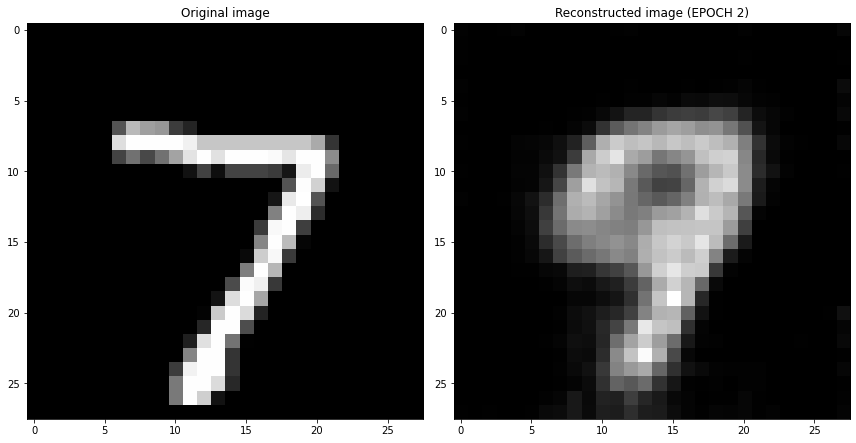

EPOCH 3/30
	 partial train loss (single batch): 0.049511
	 partial train loss (single batch): 0.048153
	 partial train loss (single batch): 0.048067
	 partial train loss (single batch): 0.051348
	 partial train loss (single batch): 0.048128
	 partial train loss (single batch): 0.048817
	 partial train loss (single batch): 0.048931
	 partial train loss (single batch): 0.049399
	 partial train loss (single batch): 0.047341
	 partial train loss (single batch): 0.049504
	 partial train loss (single batch): 0.046316
	 partial train loss (single batch): 0.050961
	 partial train loss (single batch): 0.046384
	 partial train loss (single batch): 0.048348
	 partial train loss (single batch): 0.048281
	 partial train loss (single batch): 0.048538
	 partial train loss (single batch): 0.048763
	 partial train loss (single batch): 0.048654
	 partial train loss (single batch): 0.050036
	 partial train loss (single batch): 0.051160
	 partial train loss (single batch): 0.047549
	 partial train loss (s

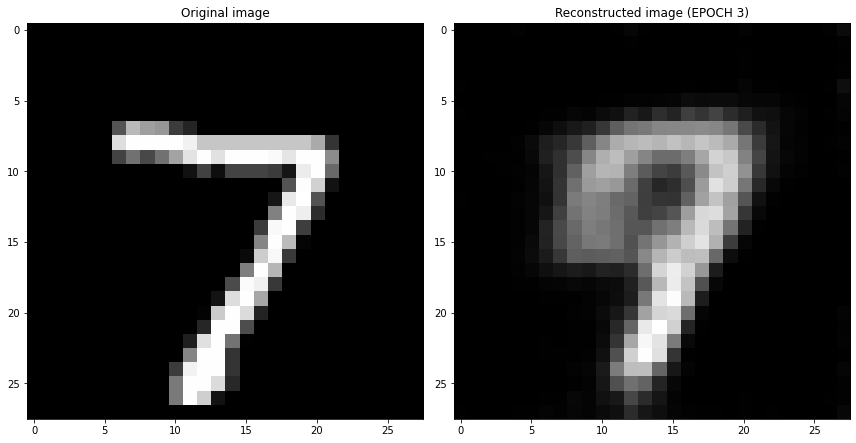

EPOCH 4/30
	 partial train loss (single batch): 0.046073
	 partial train loss (single batch): 0.045654
	 partial train loss (single batch): 0.045957
	 partial train loss (single batch): 0.045046
	 partial train loss (single batch): 0.046765
	 partial train loss (single batch): 0.048502
	 partial train loss (single batch): 0.046649
	 partial train loss (single batch): 0.042346
	 partial train loss (single batch): 0.047068
	 partial train loss (single batch): 0.045791
	 partial train loss (single batch): 0.044258
	 partial train loss (single batch): 0.045387
	 partial train loss (single batch): 0.044452
	 partial train loss (single batch): 0.046844
	 partial train loss (single batch): 0.045914
	 partial train loss (single batch): 0.048046
	 partial train loss (single batch): 0.045438
	 partial train loss (single batch): 0.048862
	 partial train loss (single batch): 0.046599
	 partial train loss (single batch): 0.044545
	 partial train loss (single batch): 0.045017
	 partial train loss (s

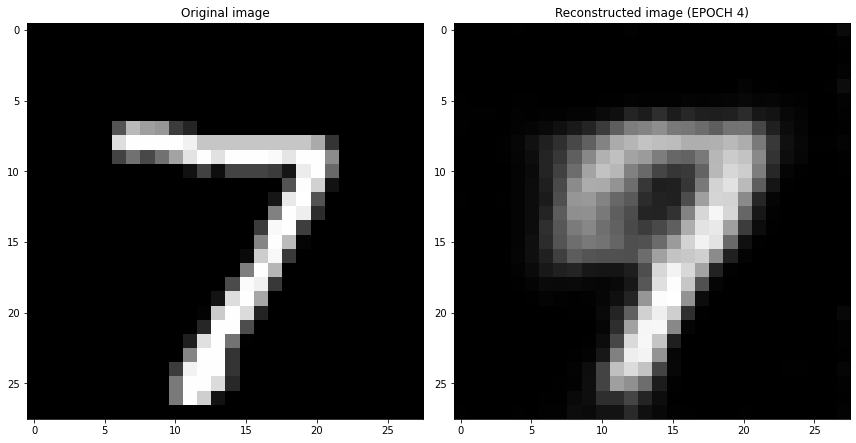

EPOCH 5/30
	 partial train loss (single batch): 0.043815
	 partial train loss (single batch): 0.045297
	 partial train loss (single batch): 0.043943
	 partial train loss (single batch): 0.042430
	 partial train loss (single batch): 0.044361
	 partial train loss (single batch): 0.044732
	 partial train loss (single batch): 0.045047
	 partial train loss (single batch): 0.045581
	 partial train loss (single batch): 0.043433
	 partial train loss (single batch): 0.046216
	 partial train loss (single batch): 0.044285
	 partial train loss (single batch): 0.043195
	 partial train loss (single batch): 0.043640
	 partial train loss (single batch): 0.045340
	 partial train loss (single batch): 0.042756
	 partial train loss (single batch): 0.045018
	 partial train loss (single batch): 0.045798
	 partial train loss (single batch): 0.044957
	 partial train loss (single batch): 0.043510
	 partial train loss (single batch): 0.045609
	 partial train loss (single batch): 0.043685
	 partial train loss (s

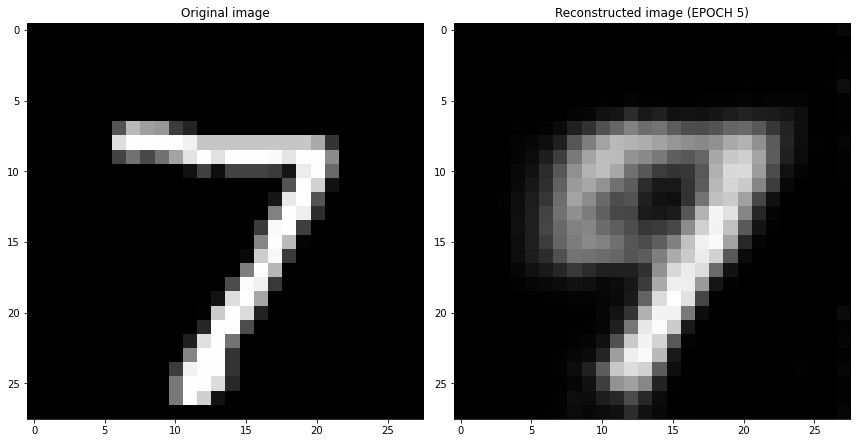

EPOCH 6/30
	 partial train loss (single batch): 0.043466
	 partial train loss (single batch): 0.043518
	 partial train loss (single batch): 0.042585
	 partial train loss (single batch): 0.043471
	 partial train loss (single batch): 0.043380
	 partial train loss (single batch): 0.044357
	 partial train loss (single batch): 0.044120
	 partial train loss (single batch): 0.043879
	 partial train loss (single batch): 0.042177
	 partial train loss (single batch): 0.042885
	 partial train loss (single batch): 0.043056
	 partial train loss (single batch): 0.044040
	 partial train loss (single batch): 0.044106
	 partial train loss (single batch): 0.043468
	 partial train loss (single batch): 0.041215
	 partial train loss (single batch): 0.046164
	 partial train loss (single batch): 0.041966
	 partial train loss (single batch): 0.044085
	 partial train loss (single batch): 0.044315
	 partial train loss (single batch): 0.045827
	 partial train loss (single batch): 0.043977
	 partial train loss (s

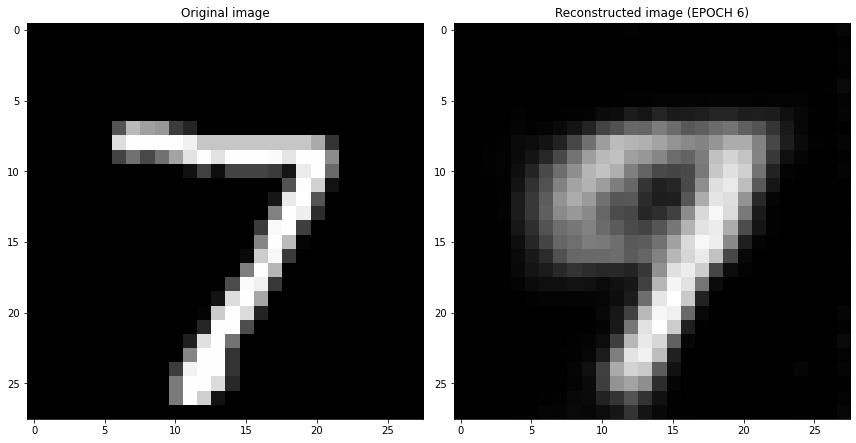

EPOCH 7/30
	 partial train loss (single batch): 0.044476
	 partial train loss (single batch): 0.042152
	 partial train loss (single batch): 0.042223
	 partial train loss (single batch): 0.042276
	 partial train loss (single batch): 0.042709
	 partial train loss (single batch): 0.043367
	 partial train loss (single batch): 0.042128
	 partial train loss (single batch): 0.044352
	 partial train loss (single batch): 0.042002
	 partial train loss (single batch): 0.044696
	 partial train loss (single batch): 0.044982
	 partial train loss (single batch): 0.044756
	 partial train loss (single batch): 0.043191
	 partial train loss (single batch): 0.043801
	 partial train loss (single batch): 0.043373
	 partial train loss (single batch): 0.043419
	 partial train loss (single batch): 0.044491
	 partial train loss (single batch): 0.044382
	 partial train loss (single batch): 0.043785
	 partial train loss (single batch): 0.043872
	 partial train loss (single batch): 0.043167
	 partial train loss (s

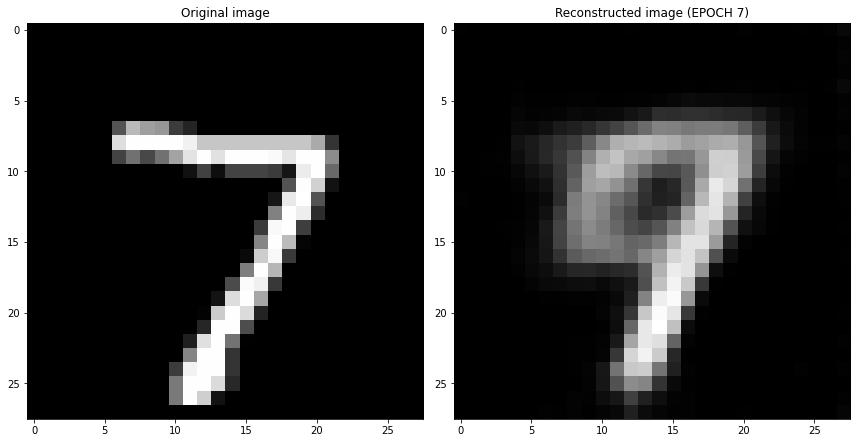

EPOCH 8/30
	 partial train loss (single batch): 0.043578
	 partial train loss (single batch): 0.043291
	 partial train loss (single batch): 0.043133
	 partial train loss (single batch): 0.041794
	 partial train loss (single batch): 0.045089
	 partial train loss (single batch): 0.041808
	 partial train loss (single batch): 0.042363
	 partial train loss (single batch): 0.044335
	 partial train loss (single batch): 0.042130
	 partial train loss (single batch): 0.043268
	 partial train loss (single batch): 0.041384
	 partial train loss (single batch): 0.046674
	 partial train loss (single batch): 0.044697
	 partial train loss (single batch): 0.041169
	 partial train loss (single batch): 0.043694
	 partial train loss (single batch): 0.043405
	 partial train loss (single batch): 0.043060
	 partial train loss (single batch): 0.044401
	 partial train loss (single batch): 0.042597
	 partial train loss (single batch): 0.042203
	 partial train loss (single batch): 0.042540
	 partial train loss (s

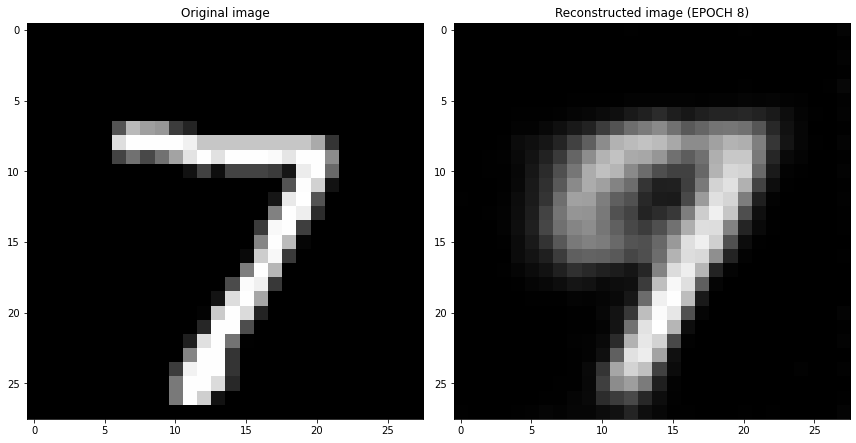

EPOCH 9/30
	 partial train loss (single batch): 0.043129
	 partial train loss (single batch): 0.043356
	 partial train loss (single batch): 0.041306
	 partial train loss (single batch): 0.042690
	 partial train loss (single batch): 0.042733
	 partial train loss (single batch): 0.042206
	 partial train loss (single batch): 0.041045
	 partial train loss (single batch): 0.039164
	 partial train loss (single batch): 0.042232
	 partial train loss (single batch): 0.042196
	 partial train loss (single batch): 0.043212
	 partial train loss (single batch): 0.041133
	 partial train loss (single batch): 0.041581
	 partial train loss (single batch): 0.043709
	 partial train loss (single batch): 0.042445
	 partial train loss (single batch): 0.041417
	 partial train loss (single batch): 0.041852
	 partial train loss (single batch): 0.041667
	 partial train loss (single batch): 0.041922
	 partial train loss (single batch): 0.043878
	 partial train loss (single batch): 0.041456
	 partial train loss (s

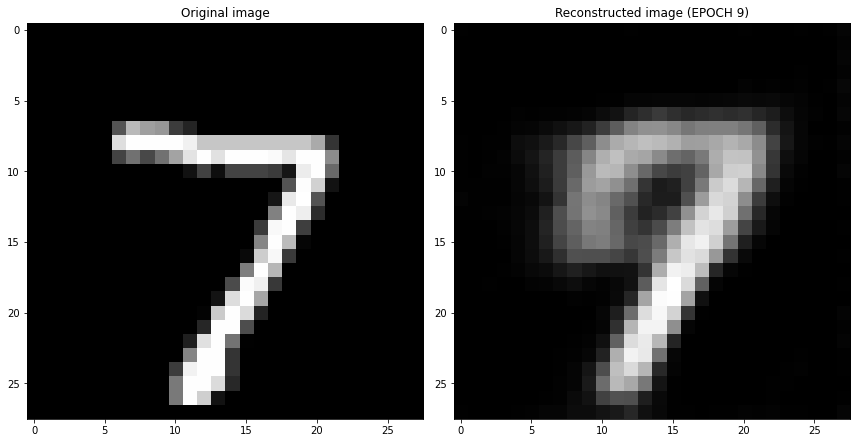

EPOCH 10/30
	 partial train loss (single batch): 0.041952
	 partial train loss (single batch): 0.043592
	 partial train loss (single batch): 0.042245
	 partial train loss (single batch): 0.043623
	 partial train loss (single batch): 0.041643
	 partial train loss (single batch): 0.042656
	 partial train loss (single batch): 0.042242
	 partial train loss (single batch): 0.041600
	 partial train loss (single batch): 0.043337
	 partial train loss (single batch): 0.042285
	 partial train loss (single batch): 0.042476
	 partial train loss (single batch): 0.042998
	 partial train loss (single batch): 0.040985
	 partial train loss (single batch): 0.043721
	 partial train loss (single batch): 0.039855
	 partial train loss (single batch): 0.043268
	 partial train loss (single batch): 0.042275
	 partial train loss (single batch): 0.042610
	 partial train loss (single batch): 0.043027
	 partial train loss (single batch): 0.042506
	 partial train loss (single batch): 0.040595
	 partial train loss (

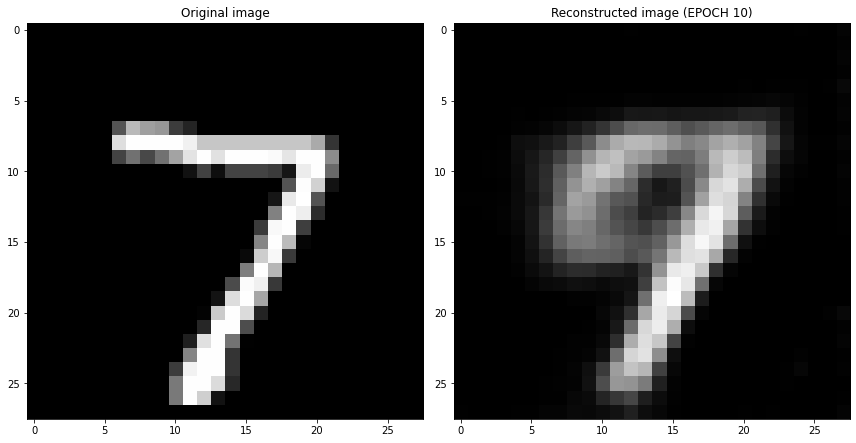

EPOCH 11/30
	 partial train loss (single batch): 0.040554
	 partial train loss (single batch): 0.042712
	 partial train loss (single batch): 0.043343
	 partial train loss (single batch): 0.041473
	 partial train loss (single batch): 0.043083
	 partial train loss (single batch): 0.042131
	 partial train loss (single batch): 0.043906
	 partial train loss (single batch): 0.040603
	 partial train loss (single batch): 0.041249
	 partial train loss (single batch): 0.043663
	 partial train loss (single batch): 0.042216
	 partial train loss (single batch): 0.041738
	 partial train loss (single batch): 0.041581
	 partial train loss (single batch): 0.041569
	 partial train loss (single batch): 0.042136
	 partial train loss (single batch): 0.041018
	 partial train loss (single batch): 0.040652
	 partial train loss (single batch): 0.043850
	 partial train loss (single batch): 0.042468
	 partial train loss (single batch): 0.040988
	 partial train loss (single batch): 0.043727
	 partial train loss (

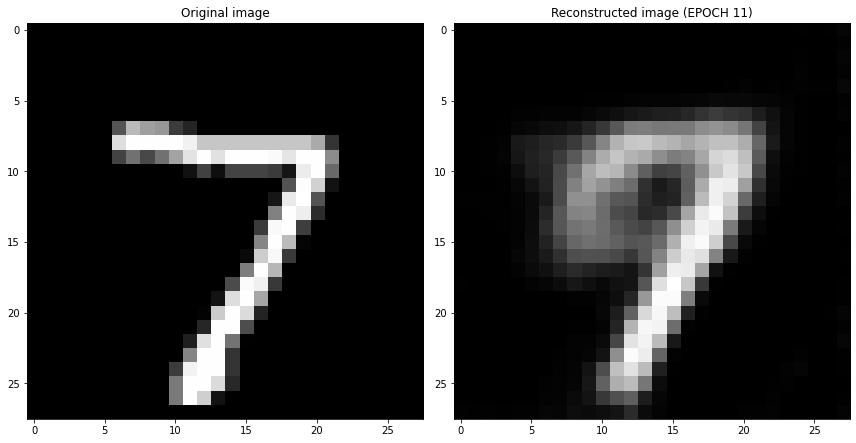

EPOCH 12/30
	 partial train loss (single batch): 0.043096
	 partial train loss (single batch): 0.042777
	 partial train loss (single batch): 0.040099
	 partial train loss (single batch): 0.039220
	 partial train loss (single batch): 0.041180
	 partial train loss (single batch): 0.042031
	 partial train loss (single batch): 0.040577
	 partial train loss (single batch): 0.042493
	 partial train loss (single batch): 0.043864
	 partial train loss (single batch): 0.040031
	 partial train loss (single batch): 0.042191
	 partial train loss (single batch): 0.040763
	 partial train loss (single batch): 0.044037
	 partial train loss (single batch): 0.042826
	 partial train loss (single batch): 0.043064
	 partial train loss (single batch): 0.041277
	 partial train loss (single batch): 0.041972
	 partial train loss (single batch): 0.042280
	 partial train loss (single batch): 0.041718
	 partial train loss (single batch): 0.041851
	 partial train loss (single batch): 0.043536
	 partial train loss (

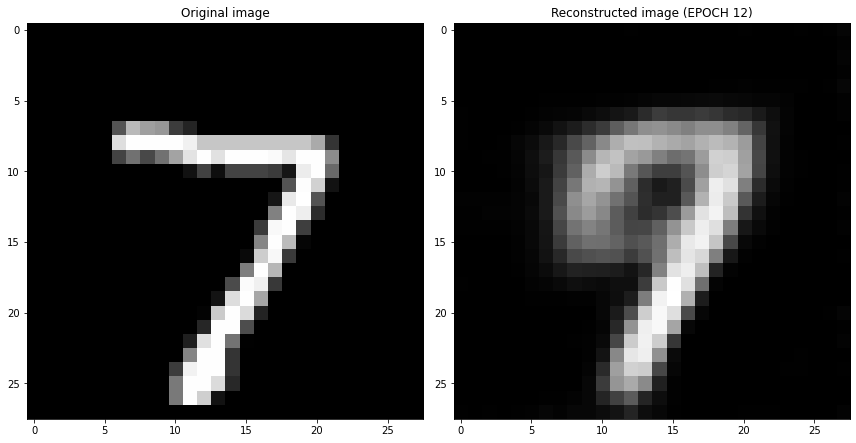

EPOCH 13/30
	 partial train loss (single batch): 0.041020
	 partial train loss (single batch): 0.043725
	 partial train loss (single batch): 0.042115
	 partial train loss (single batch): 0.039507
	 partial train loss (single batch): 0.043148
	 partial train loss (single batch): 0.041781
	 partial train loss (single batch): 0.042895
	 partial train loss (single batch): 0.043100
	 partial train loss (single batch): 0.043614
	 partial train loss (single batch): 0.042751
	 partial train loss (single batch): 0.043456
	 partial train loss (single batch): 0.043111
	 partial train loss (single batch): 0.042009
	 partial train loss (single batch): 0.041532
	 partial train loss (single batch): 0.042100
	 partial train loss (single batch): 0.044258
	 partial train loss (single batch): 0.041442
	 partial train loss (single batch): 0.042286
	 partial train loss (single batch): 0.041547
	 partial train loss (single batch): 0.043817
	 partial train loss (single batch): 0.042835
	 partial train loss (

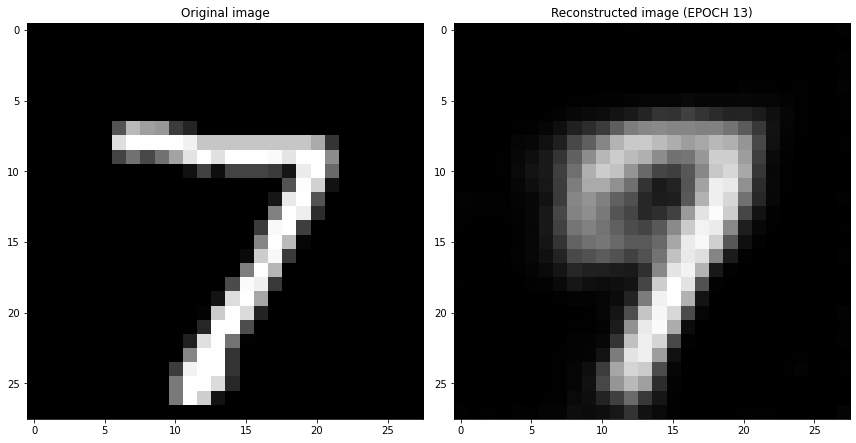

EPOCH 14/30
	 partial train loss (single batch): 0.042225
	 partial train loss (single batch): 0.042180
	 partial train loss (single batch): 0.041709
	 partial train loss (single batch): 0.044110
	 partial train loss (single batch): 0.043173
	 partial train loss (single batch): 0.043260
	 partial train loss (single batch): 0.040239
	 partial train loss (single batch): 0.042726
	 partial train loss (single batch): 0.041329
	 partial train loss (single batch): 0.041695
	 partial train loss (single batch): 0.043909
	 partial train loss (single batch): 0.039499
	 partial train loss (single batch): 0.041749
	 partial train loss (single batch): 0.042928
	 partial train loss (single batch): 0.041491
	 partial train loss (single batch): 0.042174
	 partial train loss (single batch): 0.041502
	 partial train loss (single batch): 0.040242
	 partial train loss (single batch): 0.041150
	 partial train loss (single batch): 0.042261
	 partial train loss (single batch): 0.041766
	 partial train loss (

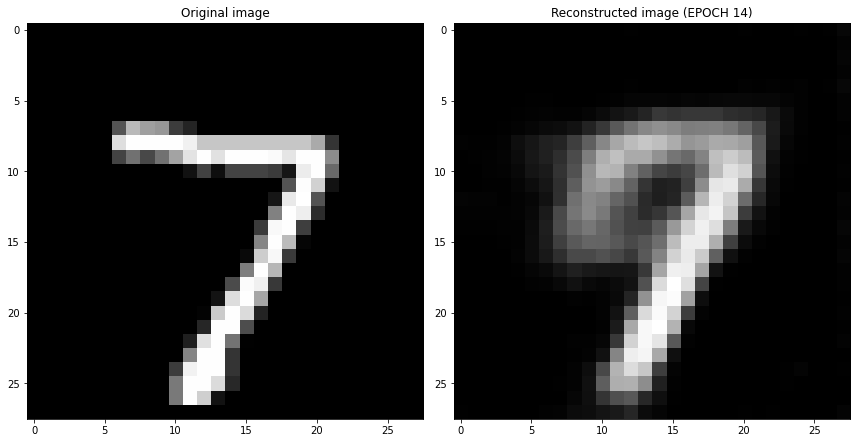

EPOCH 15/30
	 partial train loss (single batch): 0.041911
	 partial train loss (single batch): 0.040832
	 partial train loss (single batch): 0.041374
	 partial train loss (single batch): 0.040528
	 partial train loss (single batch): 0.040475
	 partial train loss (single batch): 0.042164
	 partial train loss (single batch): 0.039716
	 partial train loss (single batch): 0.042351
	 partial train loss (single batch): 0.041366
	 partial train loss (single batch): 0.041637
	 partial train loss (single batch): 0.040164
	 partial train loss (single batch): 0.039564
	 partial train loss (single batch): 0.041468
	 partial train loss (single batch): 0.042693
	 partial train loss (single batch): 0.041312
	 partial train loss (single batch): 0.039610
	 partial train loss (single batch): 0.040954
	 partial train loss (single batch): 0.040068
	 partial train loss (single batch): 0.040240
	 partial train loss (single batch): 0.040671
	 partial train loss (single batch): 0.041723
	 partial train loss (

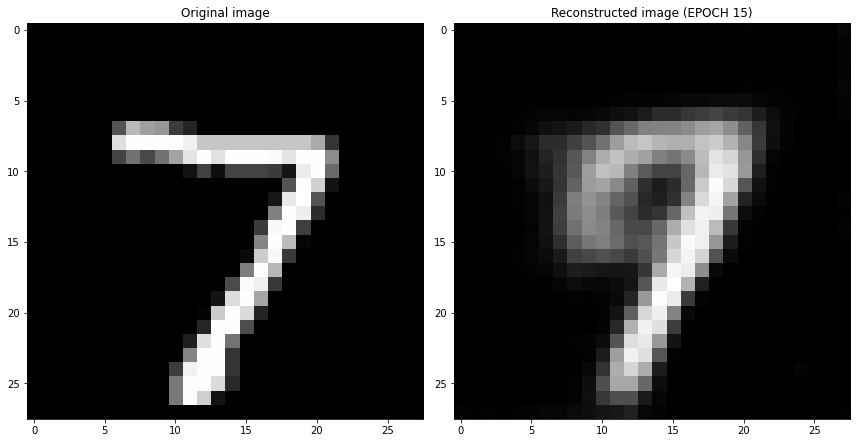

EPOCH 16/30
	 partial train loss (single batch): 0.042418
	 partial train loss (single batch): 0.041060
	 partial train loss (single batch): 0.040627
	 partial train loss (single batch): 0.040901
	 partial train loss (single batch): 0.041057
	 partial train loss (single batch): 0.042755
	 partial train loss (single batch): 0.040561
	 partial train loss (single batch): 0.041668
	 partial train loss (single batch): 0.042399
	 partial train loss (single batch): 0.041660
	 partial train loss (single batch): 0.042977
	 partial train loss (single batch): 0.041983
	 partial train loss (single batch): 0.041422
	 partial train loss (single batch): 0.043295
	 partial train loss (single batch): 0.041796
	 partial train loss (single batch): 0.041527
	 partial train loss (single batch): 0.042948
	 partial train loss (single batch): 0.040684
	 partial train loss (single batch): 0.044093
	 partial train loss (single batch): 0.039822
	 partial train loss (single batch): 0.042611
	 partial train loss (

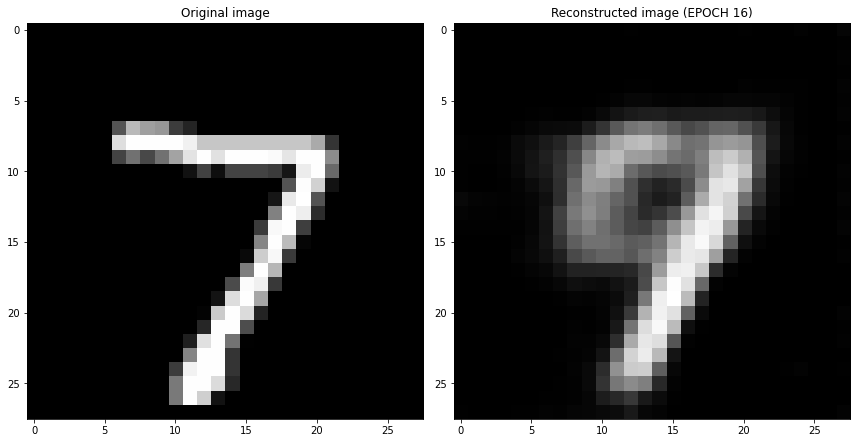

EPOCH 17/30
	 partial train loss (single batch): 0.042348
	 partial train loss (single batch): 0.040990
	 partial train loss (single batch): 0.041454
	 partial train loss (single batch): 0.041934
	 partial train loss (single batch): 0.040979
	 partial train loss (single batch): 0.041784
	 partial train loss (single batch): 0.041890
	 partial train loss (single batch): 0.039919
	 partial train loss (single batch): 0.042287
	 partial train loss (single batch): 0.042212
	 partial train loss (single batch): 0.040964
	 partial train loss (single batch): 0.040204
	 partial train loss (single batch): 0.043011
	 partial train loss (single batch): 0.040464
	 partial train loss (single batch): 0.041352
	 partial train loss (single batch): 0.041153
	 partial train loss (single batch): 0.040457
	 partial train loss (single batch): 0.040217
	 partial train loss (single batch): 0.042017
	 partial train loss (single batch): 0.041564
	 partial train loss (single batch): 0.040257
	 partial train loss (

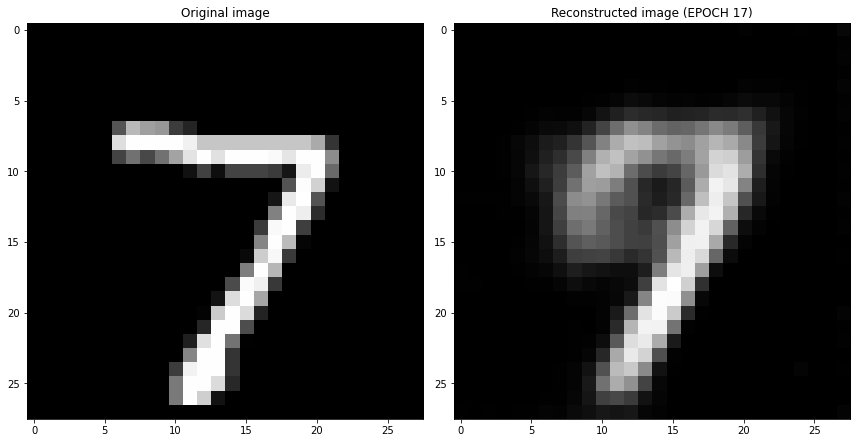

EPOCH 18/30
	 partial train loss (single batch): 0.040999
	 partial train loss (single batch): 0.042068
	 partial train loss (single batch): 0.040353
	 partial train loss (single batch): 0.041698
	 partial train loss (single batch): 0.040169
	 partial train loss (single batch): 0.042885
	 partial train loss (single batch): 0.040774
	 partial train loss (single batch): 0.043884
	 partial train loss (single batch): 0.041088
	 partial train loss (single batch): 0.040298
	 partial train loss (single batch): 0.041005
	 partial train loss (single batch): 0.044940
	 partial train loss (single batch): 0.042533
	 partial train loss (single batch): 0.043228
	 partial train loss (single batch): 0.043913
	 partial train loss (single batch): 0.044148
	 partial train loss (single batch): 0.041801
	 partial train loss (single batch): 0.040590
	 partial train loss (single batch): 0.042537
	 partial train loss (single batch): 0.039651
	 partial train loss (single batch): 0.040246
	 partial train loss (

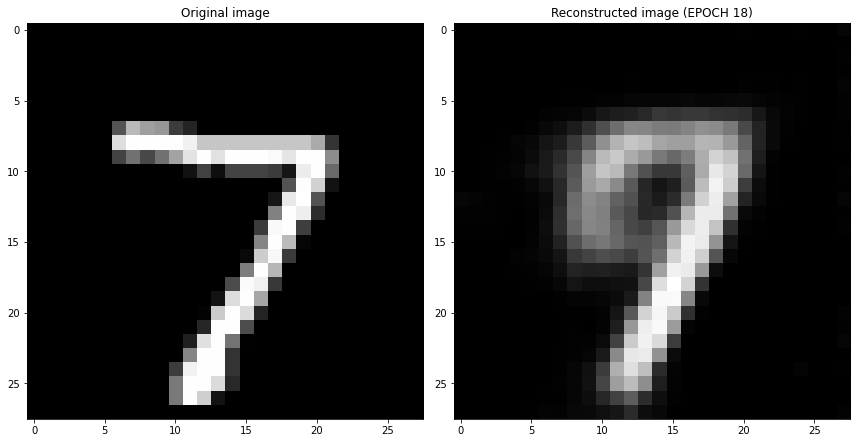

EPOCH 19/30
	 partial train loss (single batch): 0.041139
	 partial train loss (single batch): 0.040727
	 partial train loss (single batch): 0.041586
	 partial train loss (single batch): 0.039833
	 partial train loss (single batch): 0.041070
	 partial train loss (single batch): 0.040677
	 partial train loss (single batch): 0.041430
	 partial train loss (single batch): 0.043743
	 partial train loss (single batch): 0.040578
	 partial train loss (single batch): 0.042500
	 partial train loss (single batch): 0.040851
	 partial train loss (single batch): 0.040245
	 partial train loss (single batch): 0.039573
	 partial train loss (single batch): 0.040657
	 partial train loss (single batch): 0.041148
	 partial train loss (single batch): 0.042756
	 partial train loss (single batch): 0.041717
	 partial train loss (single batch): 0.041562
	 partial train loss (single batch): 0.040605
	 partial train loss (single batch): 0.042437
	 partial train loss (single batch): 0.040312
	 partial train loss (

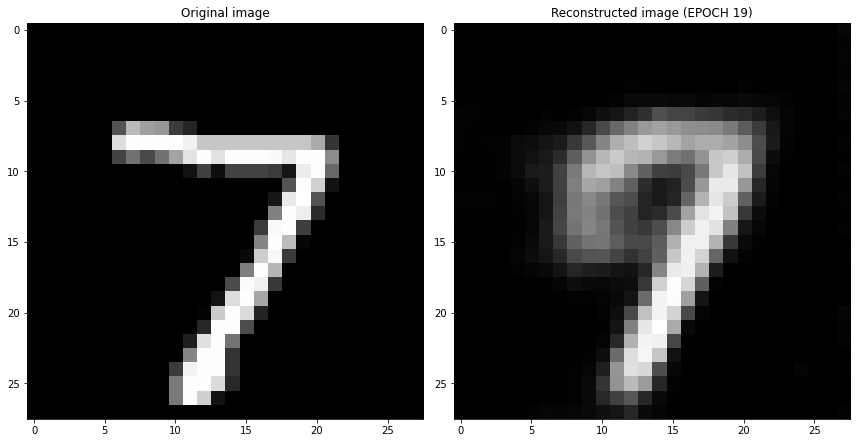

EPOCH 20/30
	 partial train loss (single batch): 0.039740
	 partial train loss (single batch): 0.044365
	 partial train loss (single batch): 0.040599
	 partial train loss (single batch): 0.040280
	 partial train loss (single batch): 0.041923
	 partial train loss (single batch): 0.039464
	 partial train loss (single batch): 0.040385
	 partial train loss (single batch): 0.040781
	 partial train loss (single batch): 0.041049
	 partial train loss (single batch): 0.040657
	 partial train loss (single batch): 0.042079
	 partial train loss (single batch): 0.040379
	 partial train loss (single batch): 0.039445
	 partial train loss (single batch): 0.041061
	 partial train loss (single batch): 0.040927
	 partial train loss (single batch): 0.043453
	 partial train loss (single batch): 0.041000
	 partial train loss (single batch): 0.039381
	 partial train loss (single batch): 0.042984
	 partial train loss (single batch): 0.040874
	 partial train loss (single batch): 0.041710
	 partial train loss (

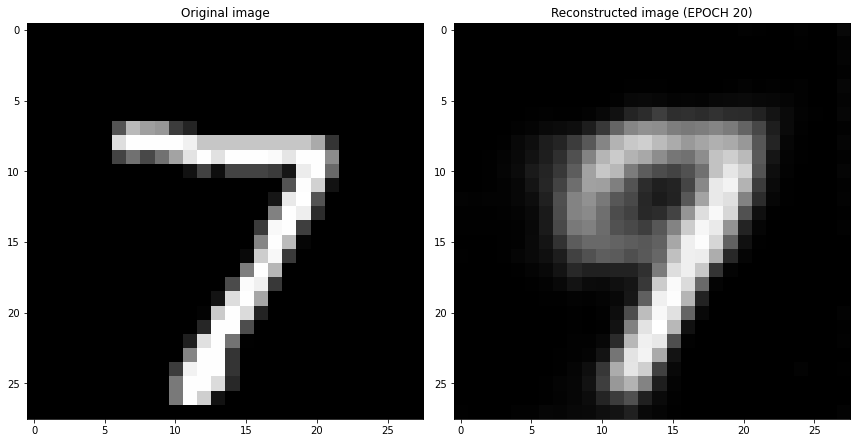

EPOCH 21/30
	 partial train loss (single batch): 0.042616
	 partial train loss (single batch): 0.041674
	 partial train loss (single batch): 0.041401
	 partial train loss (single batch): 0.042509
	 partial train loss (single batch): 0.042175
	 partial train loss (single batch): 0.040736
	 partial train loss (single batch): 0.042837
	 partial train loss (single batch): 0.041206
	 partial train loss (single batch): 0.042857
	 partial train loss (single batch): 0.041049
	 partial train loss (single batch): 0.040507
	 partial train loss (single batch): 0.040777
	 partial train loss (single batch): 0.040688
	 partial train loss (single batch): 0.041602
	 partial train loss (single batch): 0.040979
	 partial train loss (single batch): 0.043386
	 partial train loss (single batch): 0.040417
	 partial train loss (single batch): 0.041200
	 partial train loss (single batch): 0.040677
	 partial train loss (single batch): 0.042131
	 partial train loss (single batch): 0.039700
	 partial train loss (

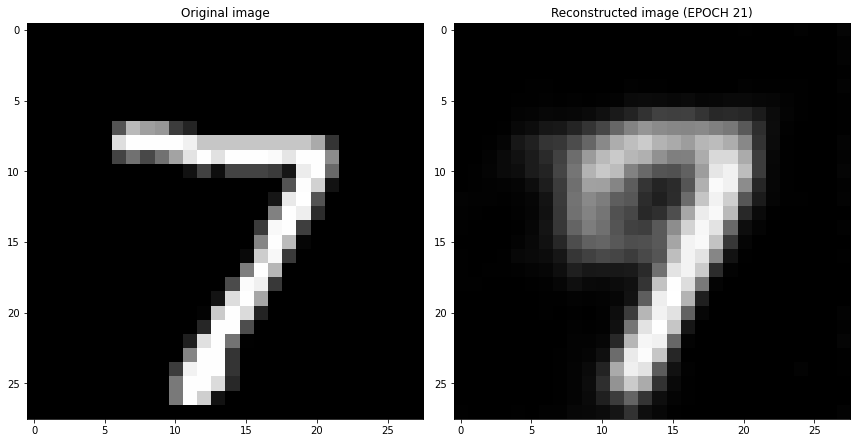

EPOCH 22/30
	 partial train loss (single batch): 0.040313
	 partial train loss (single batch): 0.042449
	 partial train loss (single batch): 0.041133
	 partial train loss (single batch): 0.040833
	 partial train loss (single batch): 0.041780
	 partial train loss (single batch): 0.043916
	 partial train loss (single batch): 0.042567
	 partial train loss (single batch): 0.040910
	 partial train loss (single batch): 0.039844
	 partial train loss (single batch): 0.041869
	 partial train loss (single batch): 0.041134
	 partial train loss (single batch): 0.040723
	 partial train loss (single batch): 0.039808
	 partial train loss (single batch): 0.041136
	 partial train loss (single batch): 0.041255
	 partial train loss (single batch): 0.040627
	 partial train loss (single batch): 0.041191
	 partial train loss (single batch): 0.042216
	 partial train loss (single batch): 0.040859
	 partial train loss (single batch): 0.042896
	 partial train loss (single batch): 0.042440
	 partial train loss (

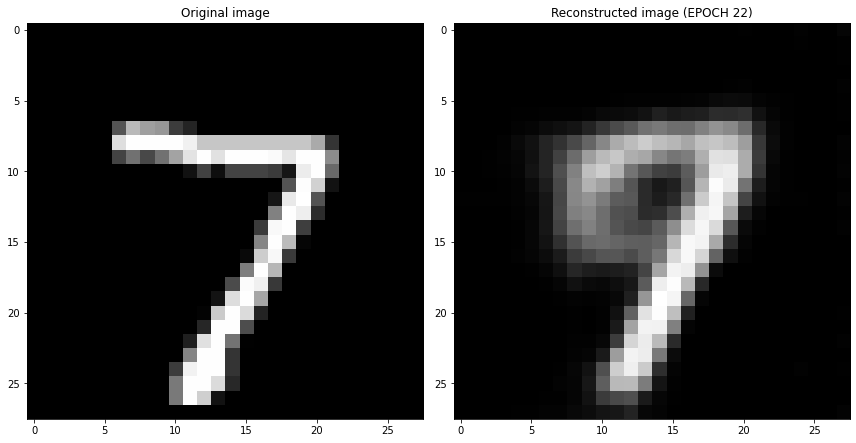

EPOCH 23/30
	 partial train loss (single batch): 0.041837
	 partial train loss (single batch): 0.038761
	 partial train loss (single batch): 0.041798
	 partial train loss (single batch): 0.041850
	 partial train loss (single batch): 0.043011
	 partial train loss (single batch): 0.042434
	 partial train loss (single batch): 0.042386
	 partial train loss (single batch): 0.040892
	 partial train loss (single batch): 0.041401
	 partial train loss (single batch): 0.043363
	 partial train loss (single batch): 0.042851
	 partial train loss (single batch): 0.042172
	 partial train loss (single batch): 0.041957
	 partial train loss (single batch): 0.041346
	 partial train loss (single batch): 0.040859
	 partial train loss (single batch): 0.042226
	 partial train loss (single batch): 0.043273
	 partial train loss (single batch): 0.043696
	 partial train loss (single batch): 0.041225
	 partial train loss (single batch): 0.043349
	 partial train loss (single batch): 0.042079
	 partial train loss (

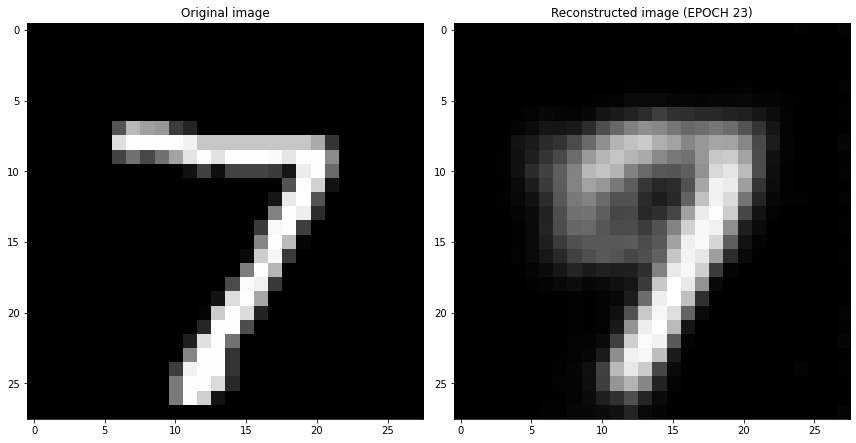

EPOCH 24/30
	 partial train loss (single batch): 0.042430
	 partial train loss (single batch): 0.039703
	 partial train loss (single batch): 0.041998
	 partial train loss (single batch): 0.040477
	 partial train loss (single batch): 0.040245
	 partial train loss (single batch): 0.040911
	 partial train loss (single batch): 0.041336
	 partial train loss (single batch): 0.042559
	 partial train loss (single batch): 0.043284
	 partial train loss (single batch): 0.040311
	 partial train loss (single batch): 0.040683
	 partial train loss (single batch): 0.043171
	 partial train loss (single batch): 0.039638
	 partial train loss (single batch): 0.040218
	 partial train loss (single batch): 0.042585
	 partial train loss (single batch): 0.043281
	 partial train loss (single batch): 0.039642
	 partial train loss (single batch): 0.040792
	 partial train loss (single batch): 0.041490
	 partial train loss (single batch): 0.039921
	 partial train loss (single batch): 0.042445
	 partial train loss (

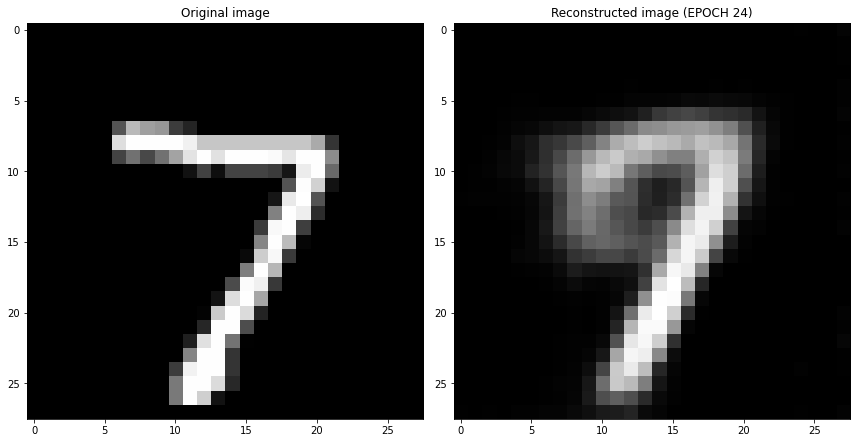

EPOCH 25/30
	 partial train loss (single batch): 0.041331
	 partial train loss (single batch): 0.042078
	 partial train loss (single batch): 0.039827
	 partial train loss (single batch): 0.041656
	 partial train loss (single batch): 0.042181
	 partial train loss (single batch): 0.039819
	 partial train loss (single batch): 0.039898
	 partial train loss (single batch): 0.040608
	 partial train loss (single batch): 0.040365
	 partial train loss (single batch): 0.039799
	 partial train loss (single batch): 0.041252
	 partial train loss (single batch): 0.038931
	 partial train loss (single batch): 0.040660
	 partial train loss (single batch): 0.041325
	 partial train loss (single batch): 0.040021
	 partial train loss (single batch): 0.041155
	 partial train loss (single batch): 0.040173
	 partial train loss (single batch): 0.043299
	 partial train loss (single batch): 0.041868
	 partial train loss (single batch): 0.041809
	 partial train loss (single batch): 0.042445
	 partial train loss (

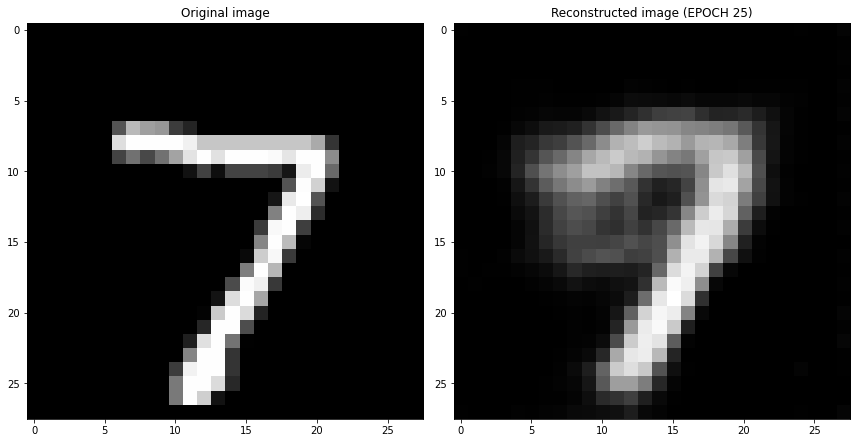

EPOCH 26/30
	 partial train loss (single batch): 0.041137
	 partial train loss (single batch): 0.039889
	 partial train loss (single batch): 0.040114
	 partial train loss (single batch): 0.040079
	 partial train loss (single batch): 0.041685
	 partial train loss (single batch): 0.041087
	 partial train loss (single batch): 0.041412
	 partial train loss (single batch): 0.041911
	 partial train loss (single batch): 0.042139
	 partial train loss (single batch): 0.042724
	 partial train loss (single batch): 0.040776
	 partial train loss (single batch): 0.042525
	 partial train loss (single batch): 0.042476
	 partial train loss (single batch): 0.041926
	 partial train loss (single batch): 0.041923
	 partial train loss (single batch): 0.040781
	 partial train loss (single batch): 0.041844
	 partial train loss (single batch): 0.041493
	 partial train loss (single batch): 0.039455
	 partial train loss (single batch): 0.039324
	 partial train loss (single batch): 0.040054
	 partial train loss (

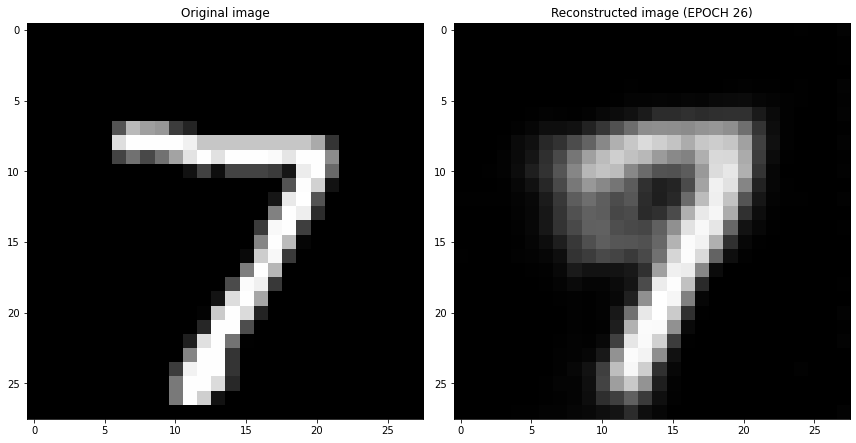

EPOCH 27/30
	 partial train loss (single batch): 0.041315
	 partial train loss (single batch): 0.040822
	 partial train loss (single batch): 0.041348
	 partial train loss (single batch): 0.039801
	 partial train loss (single batch): 0.041034
	 partial train loss (single batch): 0.040527
	 partial train loss (single batch): 0.041805
	 partial train loss (single batch): 0.042773
	 partial train loss (single batch): 0.040770
	 partial train loss (single batch): 0.041761
	 partial train loss (single batch): 0.041261
	 partial train loss (single batch): 0.040552
	 partial train loss (single batch): 0.039203
	 partial train loss (single batch): 0.040950
	 partial train loss (single batch): 0.041929
	 partial train loss (single batch): 0.042377
	 partial train loss (single batch): 0.040310
	 partial train loss (single batch): 0.040600
	 partial train loss (single batch): 0.042114
	 partial train loss (single batch): 0.041577
	 partial train loss (single batch): 0.040708
	 partial train loss (

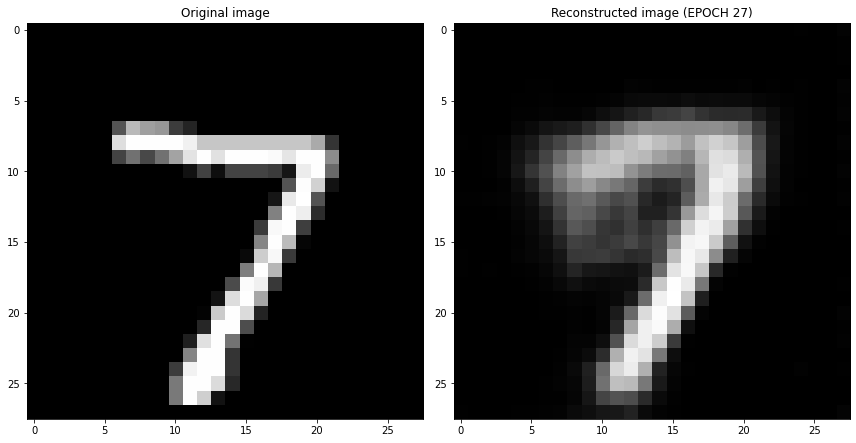

EPOCH 28/30
	 partial train loss (single batch): 0.037877
	 partial train loss (single batch): 0.041426
	 partial train loss (single batch): 0.040930
	 partial train loss (single batch): 0.042985
	 partial train loss (single batch): 0.040931
	 partial train loss (single batch): 0.042312
	 partial train loss (single batch): 0.040313
	 partial train loss (single batch): 0.040585
	 partial train loss (single batch): 0.041255
	 partial train loss (single batch): 0.042683
	 partial train loss (single batch): 0.038844
	 partial train loss (single batch): 0.042349
	 partial train loss (single batch): 0.042819
	 partial train loss (single batch): 0.039789
	 partial train loss (single batch): 0.040214
	 partial train loss (single batch): 0.040915
	 partial train loss (single batch): 0.041274
	 partial train loss (single batch): 0.041392
	 partial train loss (single batch): 0.040490
	 partial train loss (single batch): 0.038754
	 partial train loss (single batch): 0.040694
	 partial train loss (

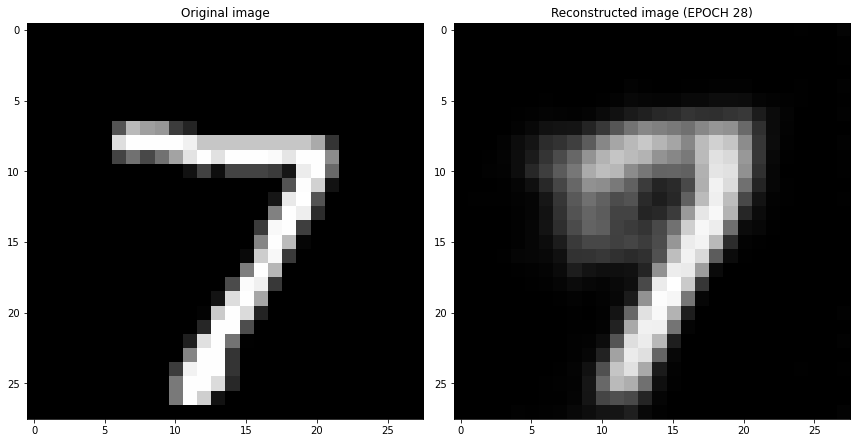

EPOCH 29/30
	 partial train loss (single batch): 0.042849
	 partial train loss (single batch): 0.041454
	 partial train loss (single batch): 0.041170
	 partial train loss (single batch): 0.040208
	 partial train loss (single batch): 0.042291
	 partial train loss (single batch): 0.040310
	 partial train loss (single batch): 0.040368
	 partial train loss (single batch): 0.038620
	 partial train loss (single batch): 0.040652
	 partial train loss (single batch): 0.041278
	 partial train loss (single batch): 0.039491
	 partial train loss (single batch): 0.041608
	 partial train loss (single batch): 0.039664
	 partial train loss (single batch): 0.042001
	 partial train loss (single batch): 0.039513
	 partial train loss (single batch): 0.039628
	 partial train loss (single batch): 0.040098
	 partial train loss (single batch): 0.041332
	 partial train loss (single batch): 0.040657
	 partial train loss (single batch): 0.041232
	 partial train loss (single batch): 0.038012
	 partial train loss (

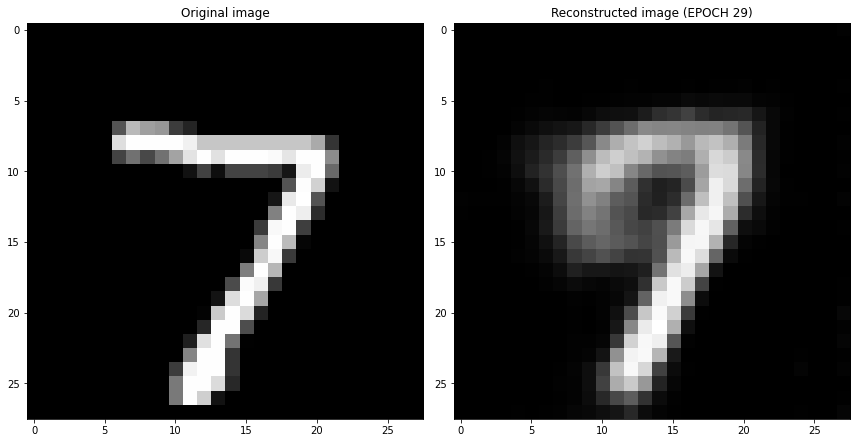

EPOCH 30/30
	 partial train loss (single batch): 0.041302
	 partial train loss (single batch): 0.041272
	 partial train loss (single batch): 0.041676
	 partial train loss (single batch): 0.039710
	 partial train loss (single batch): 0.040539
	 partial train loss (single batch): 0.040268
	 partial train loss (single batch): 0.041070
	 partial train loss (single batch): 0.042487
	 partial train loss (single batch): 0.041639
	 partial train loss (single batch): 0.040962
	 partial train loss (single batch): 0.040168
	 partial train loss (single batch): 0.040573
	 partial train loss (single batch): 0.041043
	 partial train loss (single batch): 0.040537
	 partial train loss (single batch): 0.041828
	 partial train loss (single batch): 0.039929
	 partial train loss (single batch): 0.040501
	 partial train loss (single batch): 0.042019
	 partial train loss (single batch): 0.040864
	 partial train loss (single batch): 0.042307
	 partial train loss (single batch): 0.040135
	 partial train loss (

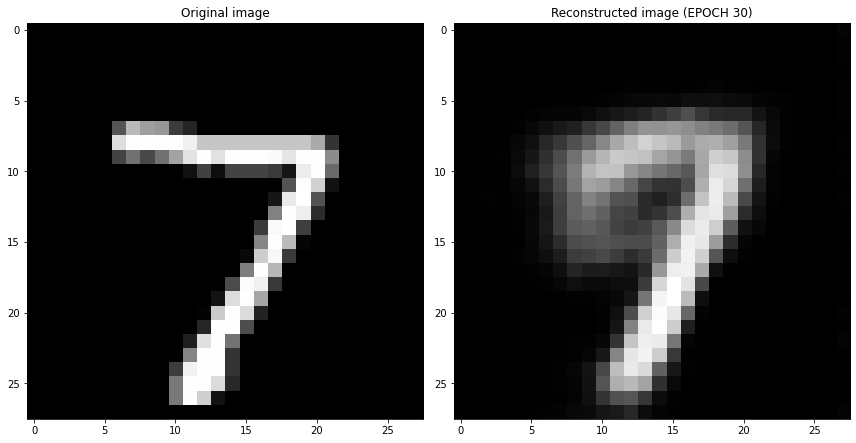

Cross validation fold number= 4/6
EPOCH 1/30
	 partial train loss (single batch): 0.226163
	 partial train loss (single batch): 0.222408
	 partial train loss (single batch): 0.219248
	 partial train loss (single batch): 0.216864
	 partial train loss (single batch): 0.213539
	 partial train loss (single batch): 0.210251
	 partial train loss (single batch): 0.203109
	 partial train loss (single batch): 0.190163
	 partial train loss (single batch): 0.174909
	 partial train loss (single batch): 0.150776
	 partial train loss (single batch): 0.131839
	 partial train loss (single batch): 0.107009
	 partial train loss (single batch): 0.096130
	 partial train loss (single batch): 0.099394
	 partial train loss (single batch): 0.100931
	 partial train loss (single batch): 0.095838
	 partial train loss (single batch): 0.088453
	 partial train loss (single batch): 0.085137
	 partial train loss (single batch): 0.086089
	 partial train loss (single batch): 0.082363
	 partial train loss (single batch)

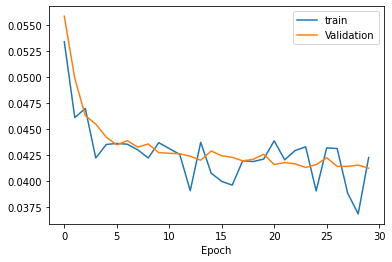

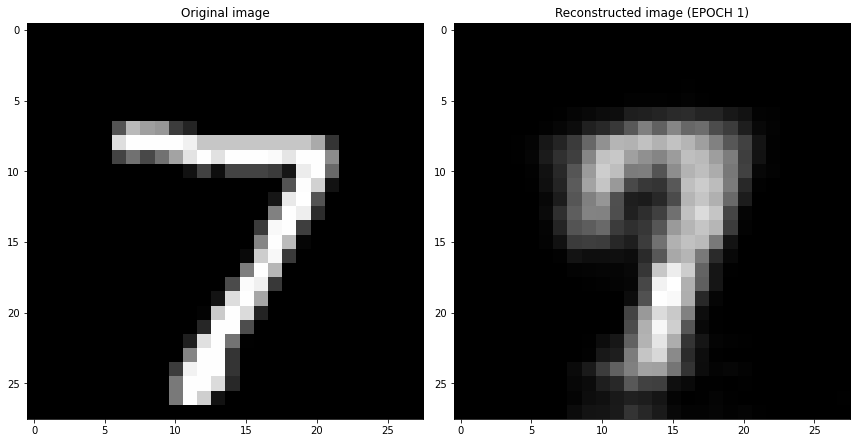

EPOCH 2/30
	 partial train loss (single batch): 0.051648
	 partial train loss (single batch): 0.051783
	 partial train loss (single batch): 0.052029
	 partial train loss (single batch): 0.047536
	 partial train loss (single batch): 0.051518
	 partial train loss (single batch): 0.050556
	 partial train loss (single batch): 0.050735
	 partial train loss (single batch): 0.051275
	 partial train loss (single batch): 0.050727
	 partial train loss (single batch): 0.048869
	 partial train loss (single batch): 0.052090
	 partial train loss (single batch): 0.050475
	 partial train loss (single batch): 0.053058
	 partial train loss (single batch): 0.050507
	 partial train loss (single batch): 0.050848
	 partial train loss (single batch): 0.048620
	 partial train loss (single batch): 0.050315
	 partial train loss (single batch): 0.049399
	 partial train loss (single batch): 0.049569
	 partial train loss (single batch): 0.051706
	 partial train loss (single batch): 0.050648
	 partial train loss (s

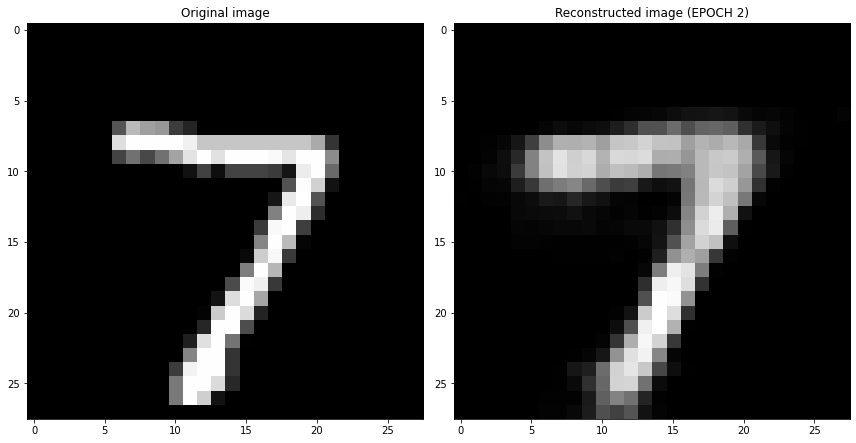

EPOCH 3/30
	 partial train loss (single batch): 0.048187
	 partial train loss (single batch): 0.047804
	 partial train loss (single batch): 0.047700
	 partial train loss (single batch): 0.046571
	 partial train loss (single batch): 0.045575
	 partial train loss (single batch): 0.048303
	 partial train loss (single batch): 0.046509
	 partial train loss (single batch): 0.046163
	 partial train loss (single batch): 0.046611
	 partial train loss (single batch): 0.045278
	 partial train loss (single batch): 0.047609
	 partial train loss (single batch): 0.048648
	 partial train loss (single batch): 0.046728
	 partial train loss (single batch): 0.048735
	 partial train loss (single batch): 0.046608
	 partial train loss (single batch): 0.046398
	 partial train loss (single batch): 0.046654
	 partial train loss (single batch): 0.046759
	 partial train loss (single batch): 0.048283
	 partial train loss (single batch): 0.044828
	 partial train loss (single batch): 0.045335
	 partial train loss (s

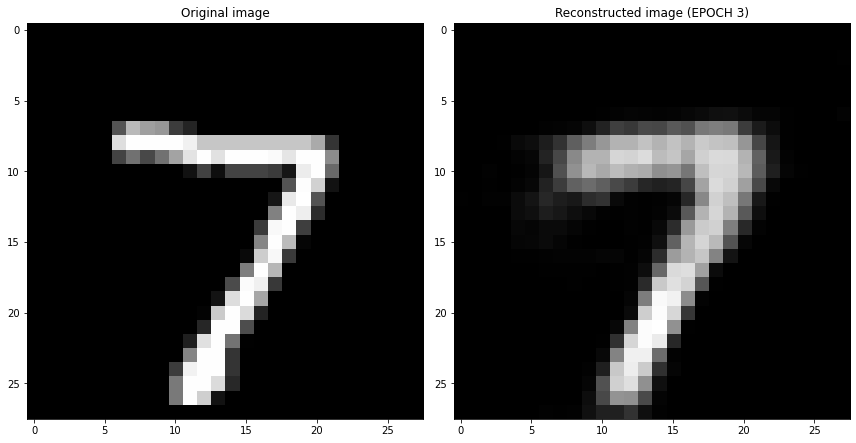

EPOCH 4/30
	 partial train loss (single batch): 0.046041
	 partial train loss (single batch): 0.043380
	 partial train loss (single batch): 0.043510
	 partial train loss (single batch): 0.046499
	 partial train loss (single batch): 0.045758
	 partial train loss (single batch): 0.045568
	 partial train loss (single batch): 0.045595
	 partial train loss (single batch): 0.045806
	 partial train loss (single batch): 0.043954
	 partial train loss (single batch): 0.044940
	 partial train loss (single batch): 0.043973
	 partial train loss (single batch): 0.043507
	 partial train loss (single batch): 0.044503
	 partial train loss (single batch): 0.044696
	 partial train loss (single batch): 0.043983
	 partial train loss (single batch): 0.043160
	 partial train loss (single batch): 0.044113
	 partial train loss (single batch): 0.044732
	 partial train loss (single batch): 0.045984
	 partial train loss (single batch): 0.044441
	 partial train loss (single batch): 0.042448
	 partial train loss (s

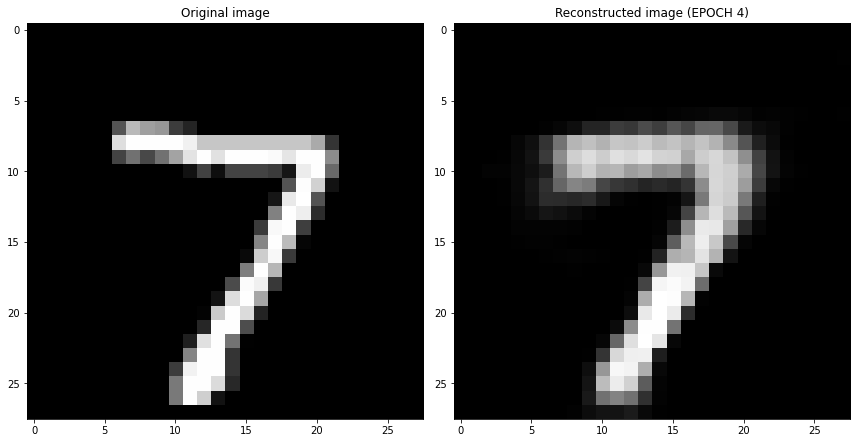

EPOCH 5/30
	 partial train loss (single batch): 0.043363
	 partial train loss (single batch): 0.042664
	 partial train loss (single batch): 0.043354
	 partial train loss (single batch): 0.044427
	 partial train loss (single batch): 0.042110
	 partial train loss (single batch): 0.043506
	 partial train loss (single batch): 0.045210
	 partial train loss (single batch): 0.043244
	 partial train loss (single batch): 0.042953
	 partial train loss (single batch): 0.043796
	 partial train loss (single batch): 0.046490
	 partial train loss (single batch): 0.043809
	 partial train loss (single batch): 0.042941
	 partial train loss (single batch): 0.044558
	 partial train loss (single batch): 0.044456
	 partial train loss (single batch): 0.042314
	 partial train loss (single batch): 0.041685
	 partial train loss (single batch): 0.042777
	 partial train loss (single batch): 0.044795
	 partial train loss (single batch): 0.042946
	 partial train loss (single batch): 0.041147
	 partial train loss (s

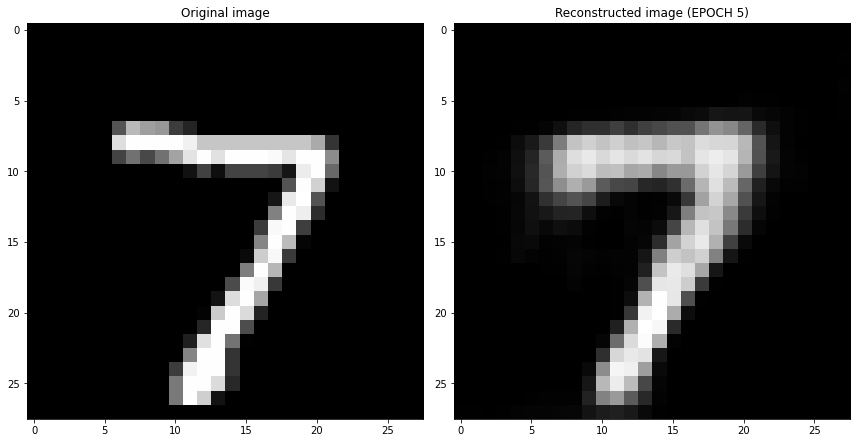

EPOCH 6/30
	 partial train loss (single batch): 0.042522
	 partial train loss (single batch): 0.040625
	 partial train loss (single batch): 0.041788
	 partial train loss (single batch): 0.042381
	 partial train loss (single batch): 0.043642
	 partial train loss (single batch): 0.043997
	 partial train loss (single batch): 0.043289
	 partial train loss (single batch): 0.042554
	 partial train loss (single batch): 0.044340
	 partial train loss (single batch): 0.041155
	 partial train loss (single batch): 0.041935
	 partial train loss (single batch): 0.041301
	 partial train loss (single batch): 0.043387
	 partial train loss (single batch): 0.042271
	 partial train loss (single batch): 0.042160
	 partial train loss (single batch): 0.042824
	 partial train loss (single batch): 0.041532
	 partial train loss (single batch): 0.042298
	 partial train loss (single batch): 0.042939
	 partial train loss (single batch): 0.044082
	 partial train loss (single batch): 0.043265
	 partial train loss (s

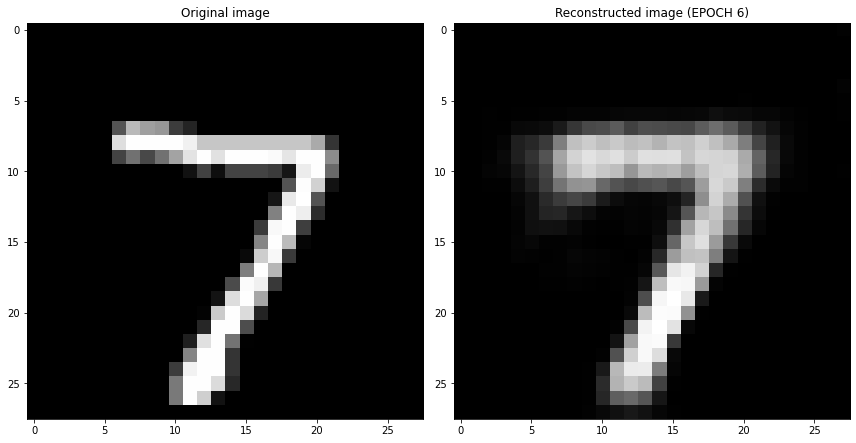

EPOCH 7/30
	 partial train loss (single batch): 0.041300
	 partial train loss (single batch): 0.042676
	 partial train loss (single batch): 0.042637
	 partial train loss (single batch): 0.041914
	 partial train loss (single batch): 0.042648
	 partial train loss (single batch): 0.042769
	 partial train loss (single batch): 0.042946
	 partial train loss (single batch): 0.040403
	 partial train loss (single batch): 0.043449
	 partial train loss (single batch): 0.041683
	 partial train loss (single batch): 0.041489
	 partial train loss (single batch): 0.042275
	 partial train loss (single batch): 0.042306
	 partial train loss (single batch): 0.042638
	 partial train loss (single batch): 0.040625
	 partial train loss (single batch): 0.038407
	 partial train loss (single batch): 0.041194
	 partial train loss (single batch): 0.043576
	 partial train loss (single batch): 0.042546
	 partial train loss (single batch): 0.040429
	 partial train loss (single batch): 0.044020
	 partial train loss (s

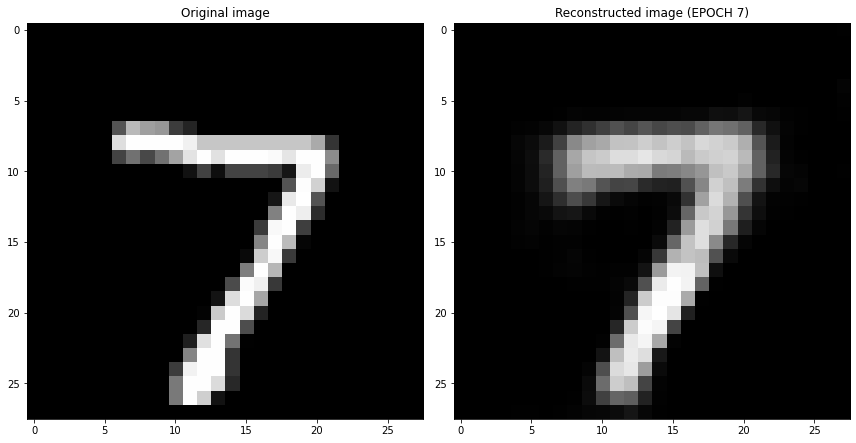

EPOCH 8/30
	 partial train loss (single batch): 0.040817
	 partial train loss (single batch): 0.040357
	 partial train loss (single batch): 0.040170
	 partial train loss (single batch): 0.041345
	 partial train loss (single batch): 0.041193
	 partial train loss (single batch): 0.041938
	 partial train loss (single batch): 0.042876
	 partial train loss (single batch): 0.042891
	 partial train loss (single batch): 0.042881
	 partial train loss (single batch): 0.040626
	 partial train loss (single batch): 0.039844
	 partial train loss (single batch): 0.041444
	 partial train loss (single batch): 0.040890
	 partial train loss (single batch): 0.042292
	 partial train loss (single batch): 0.044373
	 partial train loss (single batch): 0.039618
	 partial train loss (single batch): 0.041657
	 partial train loss (single batch): 0.043724
	 partial train loss (single batch): 0.043216
	 partial train loss (single batch): 0.039929
	 partial train loss (single batch): 0.040822
	 partial train loss (s

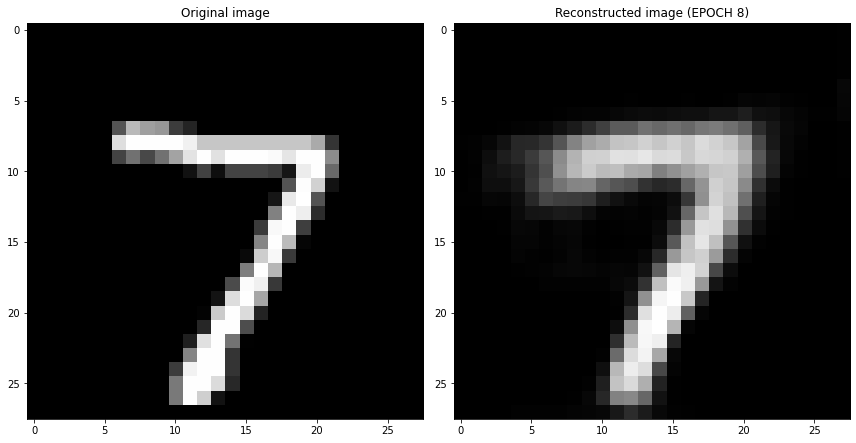

EPOCH 9/30
	 partial train loss (single batch): 0.042369
	 partial train loss (single batch): 0.040723
	 partial train loss (single batch): 0.044066
	 partial train loss (single batch): 0.044413
	 partial train loss (single batch): 0.041499
	 partial train loss (single batch): 0.041539
	 partial train loss (single batch): 0.041086
	 partial train loss (single batch): 0.040979
	 partial train loss (single batch): 0.039292
	 partial train loss (single batch): 0.041822
	 partial train loss (single batch): 0.041417
	 partial train loss (single batch): 0.041662
	 partial train loss (single batch): 0.041192
	 partial train loss (single batch): 0.041839
	 partial train loss (single batch): 0.041252
	 partial train loss (single batch): 0.041504
	 partial train loss (single batch): 0.042146
	 partial train loss (single batch): 0.042254
	 partial train loss (single batch): 0.040854
	 partial train loss (single batch): 0.041182
	 partial train loss (single batch): 0.041259
	 partial train loss (s

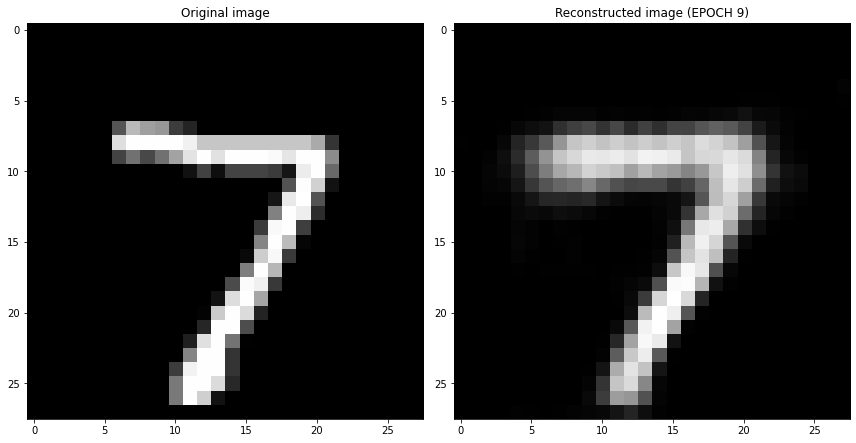

EPOCH 10/30
	 partial train loss (single batch): 0.042079
	 partial train loss (single batch): 0.039844
	 partial train loss (single batch): 0.041922
	 partial train loss (single batch): 0.041815
	 partial train loss (single batch): 0.039646
	 partial train loss (single batch): 0.041901
	 partial train loss (single batch): 0.041608
	 partial train loss (single batch): 0.041311
	 partial train loss (single batch): 0.040402
	 partial train loss (single batch): 0.040451
	 partial train loss (single batch): 0.040066
	 partial train loss (single batch): 0.041429
	 partial train loss (single batch): 0.039841
	 partial train loss (single batch): 0.041762
	 partial train loss (single batch): 0.040867
	 partial train loss (single batch): 0.041650
	 partial train loss (single batch): 0.040004
	 partial train loss (single batch): 0.040151
	 partial train loss (single batch): 0.042503
	 partial train loss (single batch): 0.043774
	 partial train loss (single batch): 0.041419
	 partial train loss (

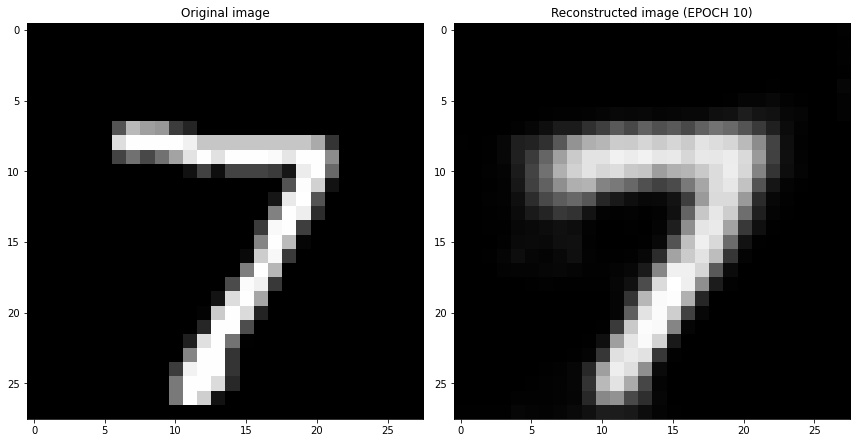

EPOCH 11/30
	 partial train loss (single batch): 0.039710
	 partial train loss (single batch): 0.044621
	 partial train loss (single batch): 0.041600
	 partial train loss (single batch): 0.040647
	 partial train loss (single batch): 0.040783
	 partial train loss (single batch): 0.040382
	 partial train loss (single batch): 0.039899
	 partial train loss (single batch): 0.041361
	 partial train loss (single batch): 0.038861
	 partial train loss (single batch): 0.042079
	 partial train loss (single batch): 0.042448
	 partial train loss (single batch): 0.040028
	 partial train loss (single batch): 0.040259
	 partial train loss (single batch): 0.040733
	 partial train loss (single batch): 0.042849
	 partial train loss (single batch): 0.043470
	 partial train loss (single batch): 0.040311
	 partial train loss (single batch): 0.041176
	 partial train loss (single batch): 0.041928
	 partial train loss (single batch): 0.042063
	 partial train loss (single batch): 0.038798
	 partial train loss (

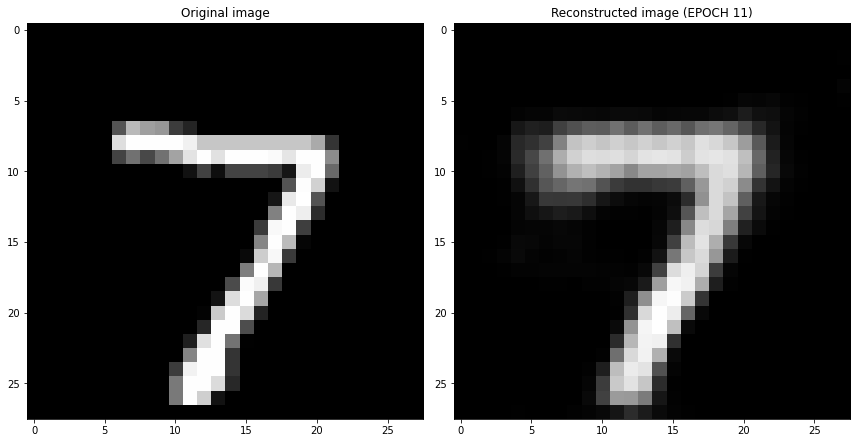

EPOCH 12/30
	 partial train loss (single batch): 0.039213
	 partial train loss (single batch): 0.042568
	 partial train loss (single batch): 0.038678
	 partial train loss (single batch): 0.043667
	 partial train loss (single batch): 0.041622
	 partial train loss (single batch): 0.038814
	 partial train loss (single batch): 0.040969
	 partial train loss (single batch): 0.040963
	 partial train loss (single batch): 0.040575
	 partial train loss (single batch): 0.040009
	 partial train loss (single batch): 0.040992
	 partial train loss (single batch): 0.040432
	 partial train loss (single batch): 0.040101
	 partial train loss (single batch): 0.040760
	 partial train loss (single batch): 0.041554
	 partial train loss (single batch): 0.040643
	 partial train loss (single batch): 0.040938
	 partial train loss (single batch): 0.040385
	 partial train loss (single batch): 0.039535
	 partial train loss (single batch): 0.042432
	 partial train loss (single batch): 0.041643
	 partial train loss (

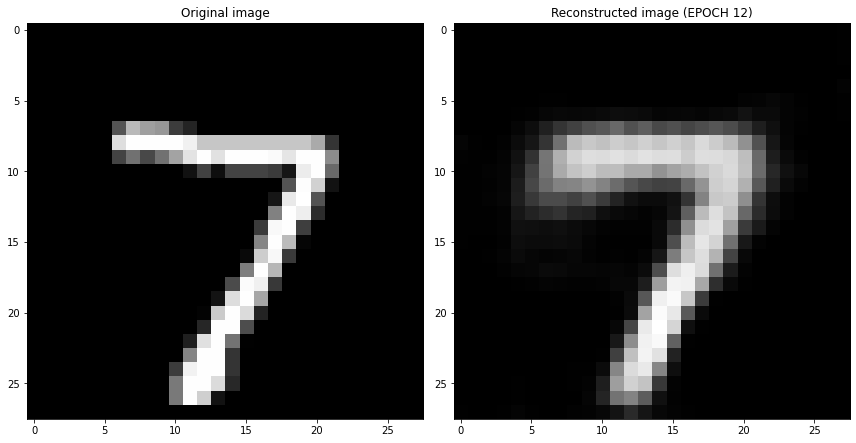

EPOCH 13/30
	 partial train loss (single batch): 0.039606
	 partial train loss (single batch): 0.041277
	 partial train loss (single batch): 0.040402
	 partial train loss (single batch): 0.039096
	 partial train loss (single batch): 0.042010
	 partial train loss (single batch): 0.040801
	 partial train loss (single batch): 0.042056
	 partial train loss (single batch): 0.042185
	 partial train loss (single batch): 0.042888
	 partial train loss (single batch): 0.040618
	 partial train loss (single batch): 0.039188
	 partial train loss (single batch): 0.040295
	 partial train loss (single batch): 0.042390
	 partial train loss (single batch): 0.038761
	 partial train loss (single batch): 0.038970
	 partial train loss (single batch): 0.041767
	 partial train loss (single batch): 0.042792
	 partial train loss (single batch): 0.040852
	 partial train loss (single batch): 0.039733
	 partial train loss (single batch): 0.041157
	 partial train loss (single batch): 0.043113
	 partial train loss (

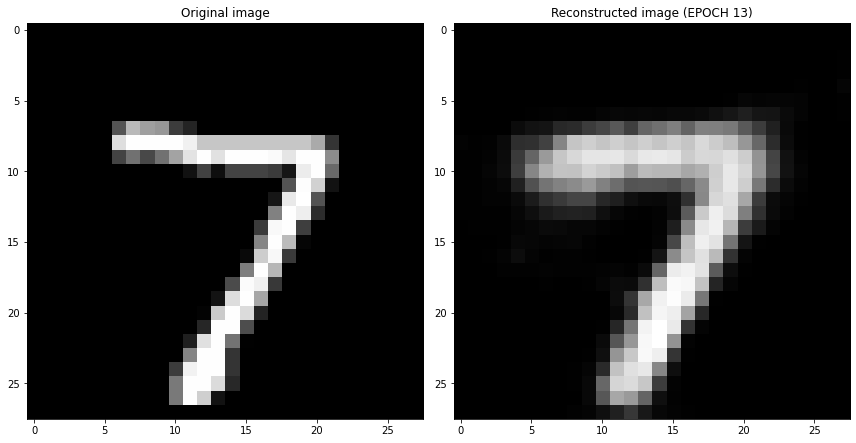

EPOCH 14/30
	 partial train loss (single batch): 0.039037
	 partial train loss (single batch): 0.039308
	 partial train loss (single batch): 0.041121
	 partial train loss (single batch): 0.038822
	 partial train loss (single batch): 0.041152
	 partial train loss (single batch): 0.040822
	 partial train loss (single batch): 0.040685
	 partial train loss (single batch): 0.039242
	 partial train loss (single batch): 0.041282
	 partial train loss (single batch): 0.040614
	 partial train loss (single batch): 0.040004
	 partial train loss (single batch): 0.040599
	 partial train loss (single batch): 0.039604
	 partial train loss (single batch): 0.040612
	 partial train loss (single batch): 0.040134
	 partial train loss (single batch): 0.041253
	 partial train loss (single batch): 0.040921
	 partial train loss (single batch): 0.039249
	 partial train loss (single batch): 0.039304
	 partial train loss (single batch): 0.038612
	 partial train loss (single batch): 0.040496
	 partial train loss (

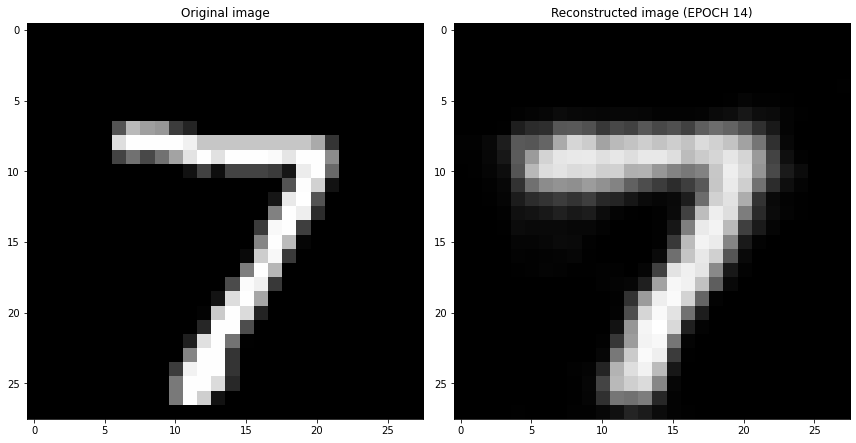

EPOCH 15/30
	 partial train loss (single batch): 0.040646
	 partial train loss (single batch): 0.041726
	 partial train loss (single batch): 0.040808
	 partial train loss (single batch): 0.040045
	 partial train loss (single batch): 0.042972
	 partial train loss (single batch): 0.040363
	 partial train loss (single batch): 0.040513
	 partial train loss (single batch): 0.040601
	 partial train loss (single batch): 0.041375
	 partial train loss (single batch): 0.038572
	 partial train loss (single batch): 0.040368
	 partial train loss (single batch): 0.039916
	 partial train loss (single batch): 0.040114
	 partial train loss (single batch): 0.040528
	 partial train loss (single batch): 0.040043
	 partial train loss (single batch): 0.041536
	 partial train loss (single batch): 0.040806
	 partial train loss (single batch): 0.040242
	 partial train loss (single batch): 0.038918
	 partial train loss (single batch): 0.038384
	 partial train loss (single batch): 0.041612
	 partial train loss (

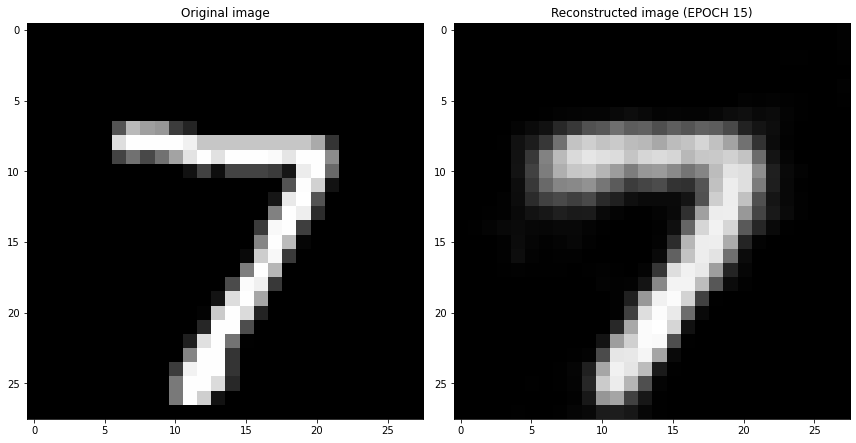

EPOCH 16/30
	 partial train loss (single batch): 0.040847
	 partial train loss (single batch): 0.039311
	 partial train loss (single batch): 0.039450
	 partial train loss (single batch): 0.040748
	 partial train loss (single batch): 0.039232
	 partial train loss (single batch): 0.039595
	 partial train loss (single batch): 0.038200
	 partial train loss (single batch): 0.040356
	 partial train loss (single batch): 0.041573
	 partial train loss (single batch): 0.040816
	 partial train loss (single batch): 0.040840
	 partial train loss (single batch): 0.040926
	 partial train loss (single batch): 0.040596
	 partial train loss (single batch): 0.037820
	 partial train loss (single batch): 0.040259
	 partial train loss (single batch): 0.039902
	 partial train loss (single batch): 0.040175
	 partial train loss (single batch): 0.040723
	 partial train loss (single batch): 0.040634
	 partial train loss (single batch): 0.038639
	 partial train loss (single batch): 0.038420
	 partial train loss (

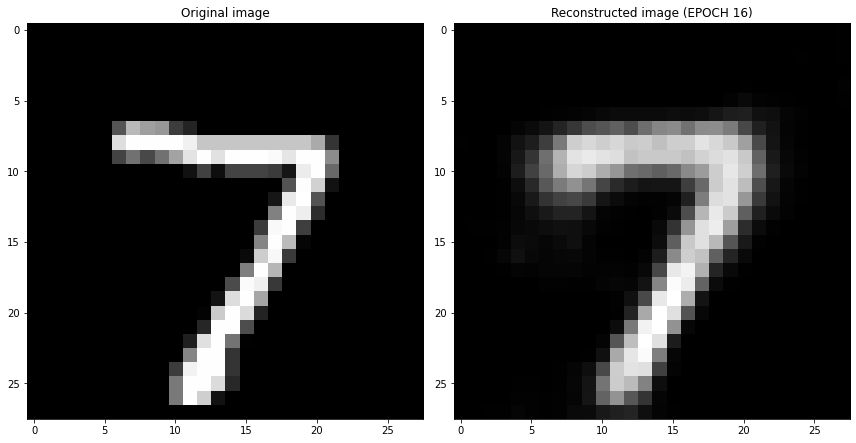

EPOCH 17/30
	 partial train loss (single batch): 0.041364
	 partial train loss (single batch): 0.040694
	 partial train loss (single batch): 0.040505
	 partial train loss (single batch): 0.039400
	 partial train loss (single batch): 0.041425
	 partial train loss (single batch): 0.040863
	 partial train loss (single batch): 0.041894
	 partial train loss (single batch): 0.039657
	 partial train loss (single batch): 0.042036
	 partial train loss (single batch): 0.038875
	 partial train loss (single batch): 0.040960
	 partial train loss (single batch): 0.038996
	 partial train loss (single batch): 0.039554
	 partial train loss (single batch): 0.040077
	 partial train loss (single batch): 0.039899
	 partial train loss (single batch): 0.039717
	 partial train loss (single batch): 0.038925
	 partial train loss (single batch): 0.039208
	 partial train loss (single batch): 0.041342
	 partial train loss (single batch): 0.040634
	 partial train loss (single batch): 0.038366
	 partial train loss (

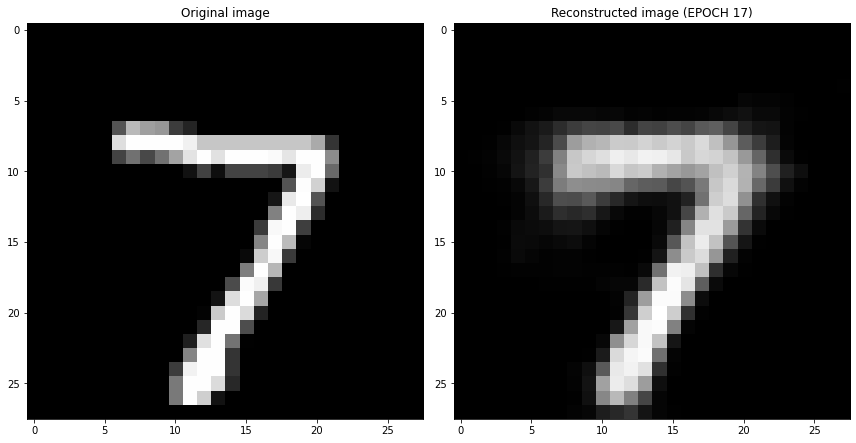

EPOCH 18/30
	 partial train loss (single batch): 0.041131
	 partial train loss (single batch): 0.040448
	 partial train loss (single batch): 0.040685
	 partial train loss (single batch): 0.040610
	 partial train loss (single batch): 0.038879
	 partial train loss (single batch): 0.039628
	 partial train loss (single batch): 0.040483
	 partial train loss (single batch): 0.042170
	 partial train loss (single batch): 0.041121
	 partial train loss (single batch): 0.040033
	 partial train loss (single batch): 0.040719
	 partial train loss (single batch): 0.039511
	 partial train loss (single batch): 0.038728
	 partial train loss (single batch): 0.040138
	 partial train loss (single batch): 0.042516
	 partial train loss (single batch): 0.040310
	 partial train loss (single batch): 0.038877
	 partial train loss (single batch): 0.039960
	 partial train loss (single batch): 0.039409
	 partial train loss (single batch): 0.039193
	 partial train loss (single batch): 0.039711
	 partial train loss (

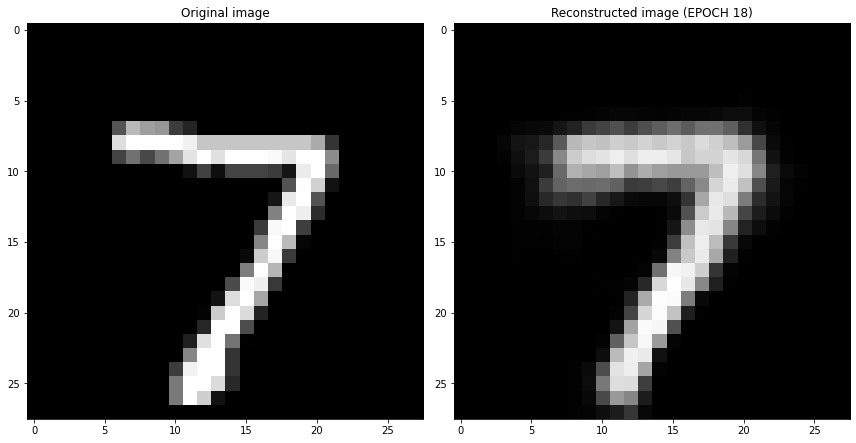

EPOCH 19/30
	 partial train loss (single batch): 0.040146
	 partial train loss (single batch): 0.039207
	 partial train loss (single batch): 0.040731
	 partial train loss (single batch): 0.040593
	 partial train loss (single batch): 0.039927
	 partial train loss (single batch): 0.039512
	 partial train loss (single batch): 0.040059
	 partial train loss (single batch): 0.039269
	 partial train loss (single batch): 0.038339
	 partial train loss (single batch): 0.040107
	 partial train loss (single batch): 0.040517
	 partial train loss (single batch): 0.038857
	 partial train loss (single batch): 0.039033
	 partial train loss (single batch): 0.041510
	 partial train loss (single batch): 0.039517
	 partial train loss (single batch): 0.041820
	 partial train loss (single batch): 0.039215
	 partial train loss (single batch): 0.039777
	 partial train loss (single batch): 0.039080
	 partial train loss (single batch): 0.041158
	 partial train loss (single batch): 0.041054
	 partial train loss (

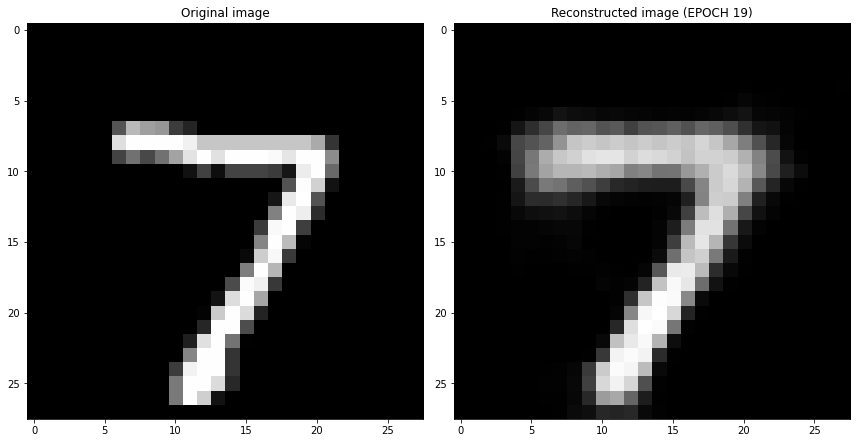

EPOCH 20/30
	 partial train loss (single batch): 0.038838
	 partial train loss (single batch): 0.040559
	 partial train loss (single batch): 0.038364
	 partial train loss (single batch): 0.039413
	 partial train loss (single batch): 0.039951
	 partial train loss (single batch): 0.040559
	 partial train loss (single batch): 0.041486
	 partial train loss (single batch): 0.039606
	 partial train loss (single batch): 0.041396
	 partial train loss (single batch): 0.041173
	 partial train loss (single batch): 0.040478
	 partial train loss (single batch): 0.038632
	 partial train loss (single batch): 0.040264
	 partial train loss (single batch): 0.039724
	 partial train loss (single batch): 0.039596
	 partial train loss (single batch): 0.041069
	 partial train loss (single batch): 0.039396
	 partial train loss (single batch): 0.040839
	 partial train loss (single batch): 0.038456
	 partial train loss (single batch): 0.038301
	 partial train loss (single batch): 0.040155
	 partial train loss (

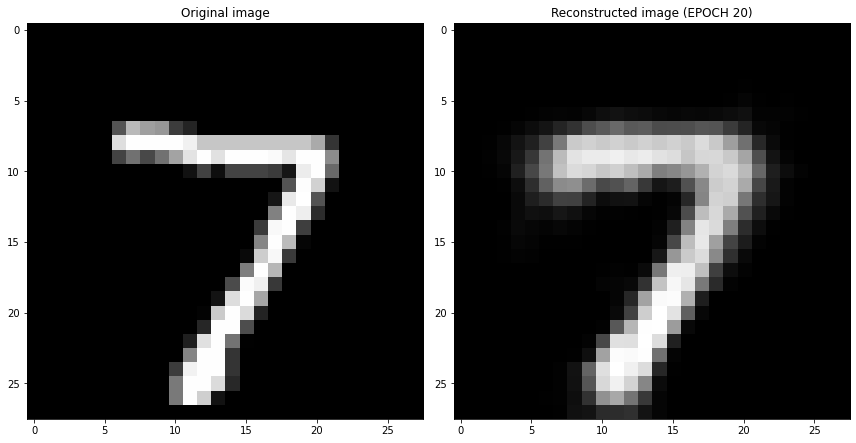

EPOCH 21/30
	 partial train loss (single batch): 0.039566
	 partial train loss (single batch): 0.038307
	 partial train loss (single batch): 0.040341
	 partial train loss (single batch): 0.038272
	 partial train loss (single batch): 0.041025
	 partial train loss (single batch): 0.041140
	 partial train loss (single batch): 0.039950
	 partial train loss (single batch): 0.040864
	 partial train loss (single batch): 0.039446
	 partial train loss (single batch): 0.041900
	 partial train loss (single batch): 0.042675
	 partial train loss (single batch): 0.041624
	 partial train loss (single batch): 0.041936
	 partial train loss (single batch): 0.040623
	 partial train loss (single batch): 0.040797
	 partial train loss (single batch): 0.040977
	 partial train loss (single batch): 0.039863
	 partial train loss (single batch): 0.038930
	 partial train loss (single batch): 0.038369
	 partial train loss (single batch): 0.039904
	 partial train loss (single batch): 0.040153
	 partial train loss (

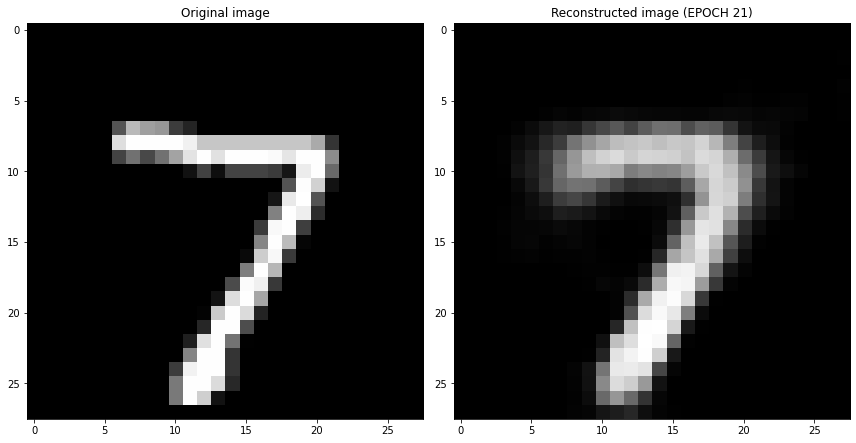

EPOCH 22/30
	 partial train loss (single batch): 0.040127
	 partial train loss (single batch): 0.038661
	 partial train loss (single batch): 0.040415
	 partial train loss (single batch): 0.040769
	 partial train loss (single batch): 0.040423
	 partial train loss (single batch): 0.039317
	 partial train loss (single batch): 0.039800
	 partial train loss (single batch): 0.040085
	 partial train loss (single batch): 0.039256
	 partial train loss (single batch): 0.039205
	 partial train loss (single batch): 0.039167
	 partial train loss (single batch): 0.040854
	 partial train loss (single batch): 0.042012
	 partial train loss (single batch): 0.038208
	 partial train loss (single batch): 0.039932
	 partial train loss (single batch): 0.040588
	 partial train loss (single batch): 0.039386
	 partial train loss (single batch): 0.039576
	 partial train loss (single batch): 0.040727
	 partial train loss (single batch): 0.038556
	 partial train loss (single batch): 0.041744
	 partial train loss (

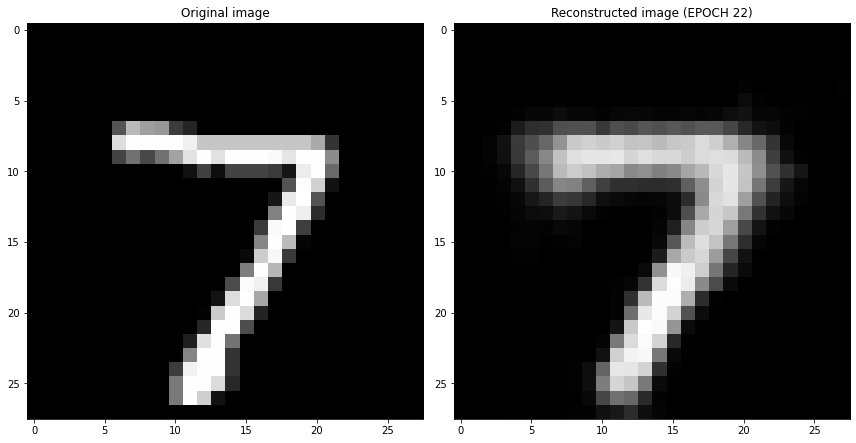

EPOCH 23/30
	 partial train loss (single batch): 0.041618
	 partial train loss (single batch): 0.040307
	 partial train loss (single batch): 0.040674
	 partial train loss (single batch): 0.039979
	 partial train loss (single batch): 0.038974
	 partial train loss (single batch): 0.041171
	 partial train loss (single batch): 0.037008
	 partial train loss (single batch): 0.039573
	 partial train loss (single batch): 0.040335
	 partial train loss (single batch): 0.041089
	 partial train loss (single batch): 0.040319
	 partial train loss (single batch): 0.042133
	 partial train loss (single batch): 0.040796
	 partial train loss (single batch): 0.038249
	 partial train loss (single batch): 0.040058
	 partial train loss (single batch): 0.039568
	 partial train loss (single batch): 0.039859
	 partial train loss (single batch): 0.042146
	 partial train loss (single batch): 0.040052
	 partial train loss (single batch): 0.039504
	 partial train loss (single batch): 0.039483
	 partial train loss (

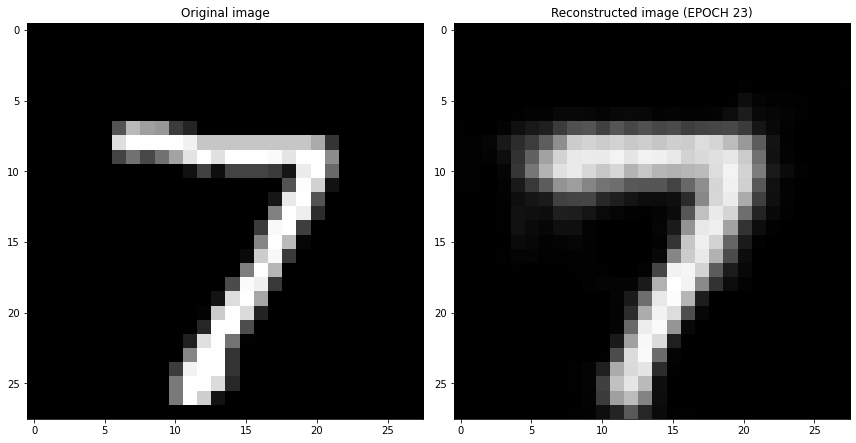

EPOCH 24/30
	 partial train loss (single batch): 0.039005
	 partial train loss (single batch): 0.039907
	 partial train loss (single batch): 0.040212
	 partial train loss (single batch): 0.039690
	 partial train loss (single batch): 0.039965
	 partial train loss (single batch): 0.038007
	 partial train loss (single batch): 0.042667
	 partial train loss (single batch): 0.040565
	 partial train loss (single batch): 0.039374
	 partial train loss (single batch): 0.039376
	 partial train loss (single batch): 0.039156
	 partial train loss (single batch): 0.039694
	 partial train loss (single batch): 0.040435
	 partial train loss (single batch): 0.038697
	 partial train loss (single batch): 0.041254
	 partial train loss (single batch): 0.038509
	 partial train loss (single batch): 0.039289
	 partial train loss (single batch): 0.040232
	 partial train loss (single batch): 0.040188
	 partial train loss (single batch): 0.039406
	 partial train loss (single batch): 0.041916
	 partial train loss (

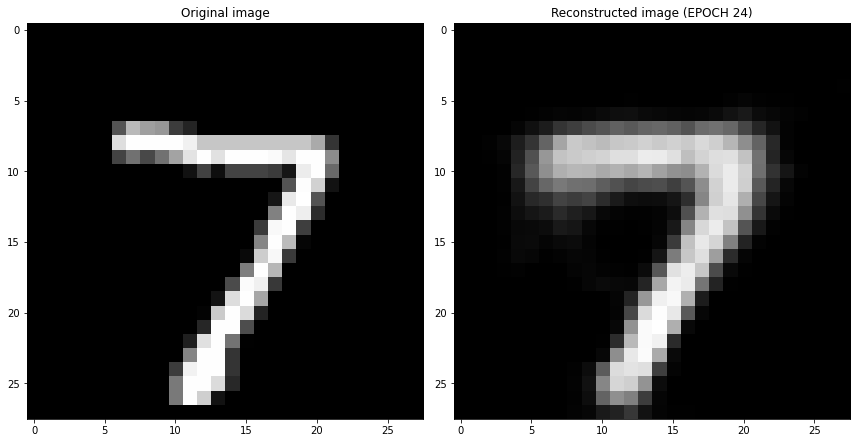

EPOCH 25/30
	 partial train loss (single batch): 0.039693
	 partial train loss (single batch): 0.040575
	 partial train loss (single batch): 0.040030
	 partial train loss (single batch): 0.037564
	 partial train loss (single batch): 0.039214
	 partial train loss (single batch): 0.040097
	 partial train loss (single batch): 0.040236
	 partial train loss (single batch): 0.039611
	 partial train loss (single batch): 0.039126
	 partial train loss (single batch): 0.040957
	 partial train loss (single batch): 0.039364
	 partial train loss (single batch): 0.038722
	 partial train loss (single batch): 0.039136
	 partial train loss (single batch): 0.039035
	 partial train loss (single batch): 0.040010
	 partial train loss (single batch): 0.039298
	 partial train loss (single batch): 0.040666
	 partial train loss (single batch): 0.036956
	 partial train loss (single batch): 0.041003
	 partial train loss (single batch): 0.039129
	 partial train loss (single batch): 0.038504
	 partial train loss (

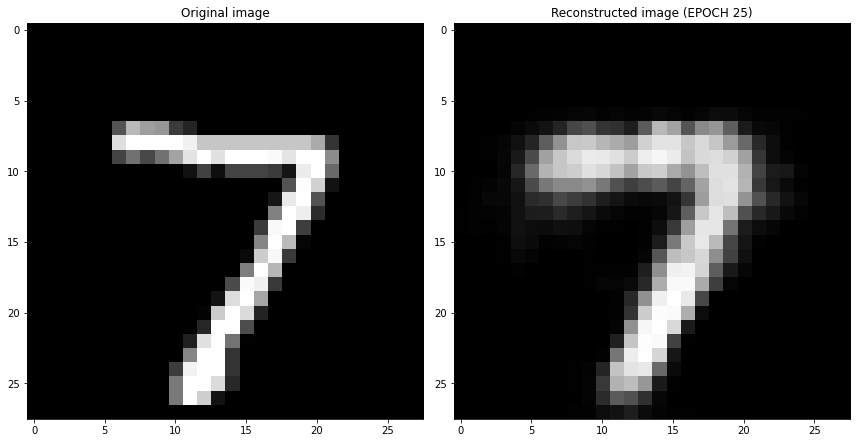

EPOCH 26/30
	 partial train loss (single batch): 0.040250
	 partial train loss (single batch): 0.039230
	 partial train loss (single batch): 0.038444
	 partial train loss (single batch): 0.040666
	 partial train loss (single batch): 0.038468
	 partial train loss (single batch): 0.037862
	 partial train loss (single batch): 0.039106
	 partial train loss (single batch): 0.038281
	 partial train loss (single batch): 0.040168
	 partial train loss (single batch): 0.038622
	 partial train loss (single batch): 0.039109
	 partial train loss (single batch): 0.039029
	 partial train loss (single batch): 0.039218
	 partial train loss (single batch): 0.039468
	 partial train loss (single batch): 0.037959
	 partial train loss (single batch): 0.037814
	 partial train loss (single batch): 0.038588
	 partial train loss (single batch): 0.038232
	 partial train loss (single batch): 0.039374
	 partial train loss (single batch): 0.039401
	 partial train loss (single batch): 0.036769
	 partial train loss (

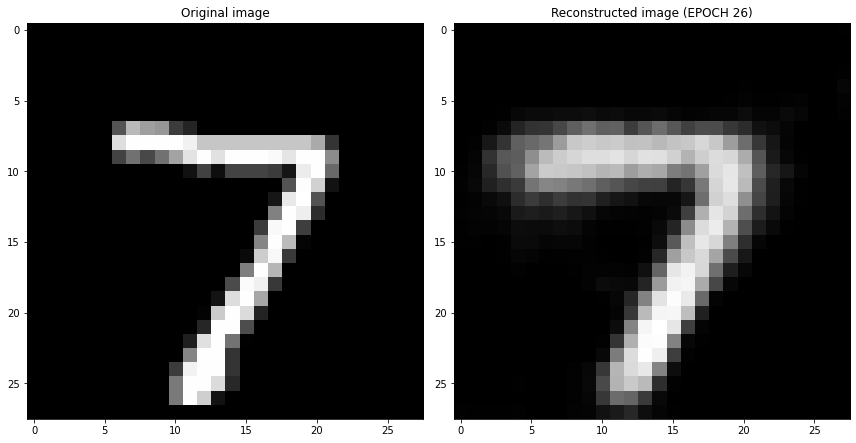

EPOCH 27/30
	 partial train loss (single batch): 0.039380
	 partial train loss (single batch): 0.040416
	 partial train loss (single batch): 0.041102
	 partial train loss (single batch): 0.040034
	 partial train loss (single batch): 0.042154
	 partial train loss (single batch): 0.040907
	 partial train loss (single batch): 0.039879
	 partial train loss (single batch): 0.041106
	 partial train loss (single batch): 0.039308
	 partial train loss (single batch): 0.040938
	 partial train loss (single batch): 0.040157
	 partial train loss (single batch): 0.040584
	 partial train loss (single batch): 0.040062
	 partial train loss (single batch): 0.040685
	 partial train loss (single batch): 0.040454
	 partial train loss (single batch): 0.038674
	 partial train loss (single batch): 0.038927
	 partial train loss (single batch): 0.039877
	 partial train loss (single batch): 0.037916
	 partial train loss (single batch): 0.040267
	 partial train loss (single batch): 0.041528
	 partial train loss (

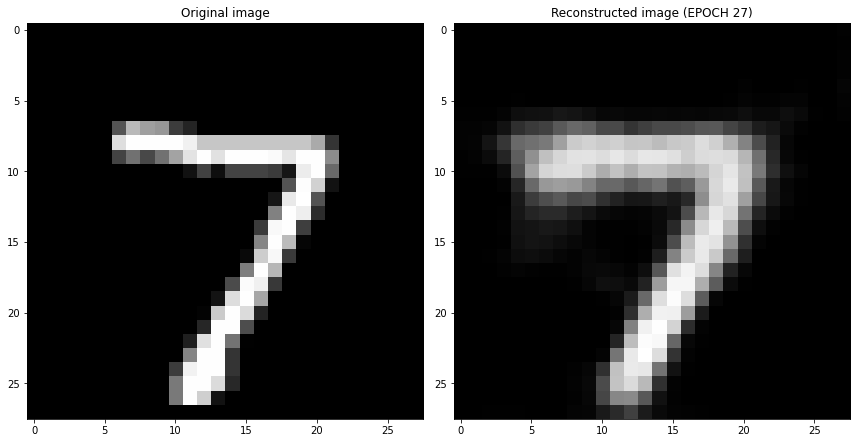

EPOCH 28/30
	 partial train loss (single batch): 0.040814
	 partial train loss (single batch): 0.038846
	 partial train loss (single batch): 0.040947
	 partial train loss (single batch): 0.040339
	 partial train loss (single batch): 0.038498
	 partial train loss (single batch): 0.039993
	 partial train loss (single batch): 0.038128
	 partial train loss (single batch): 0.041262
	 partial train loss (single batch): 0.039136
	 partial train loss (single batch): 0.038677
	 partial train loss (single batch): 0.039841
	 partial train loss (single batch): 0.038993
	 partial train loss (single batch): 0.037360
	 partial train loss (single batch): 0.041658
	 partial train loss (single batch): 0.039455
	 partial train loss (single batch): 0.038987
	 partial train loss (single batch): 0.041302
	 partial train loss (single batch): 0.038374
	 partial train loss (single batch): 0.038547
	 partial train loss (single batch): 0.040333
	 partial train loss (single batch): 0.040915
	 partial train loss (

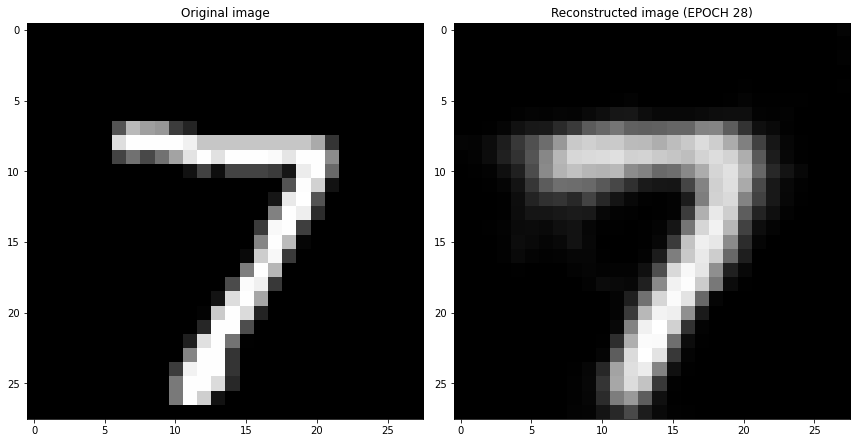

EPOCH 29/30
	 partial train loss (single batch): 0.039787
	 partial train loss (single batch): 0.042117
	 partial train loss (single batch): 0.040429
	 partial train loss (single batch): 0.038062
	 partial train loss (single batch): 0.039625
	 partial train loss (single batch): 0.040445
	 partial train loss (single batch): 0.040180
	 partial train loss (single batch): 0.039568
	 partial train loss (single batch): 0.039431
	 partial train loss (single batch): 0.040035
	 partial train loss (single batch): 0.040835
	 partial train loss (single batch): 0.038317
	 partial train loss (single batch): 0.040040
	 partial train loss (single batch): 0.039725
	 partial train loss (single batch): 0.037361
	 partial train loss (single batch): 0.039951
	 partial train loss (single batch): 0.038221
	 partial train loss (single batch): 0.039879
	 partial train loss (single batch): 0.038061
	 partial train loss (single batch): 0.038854
	 partial train loss (single batch): 0.039413
	 partial train loss (

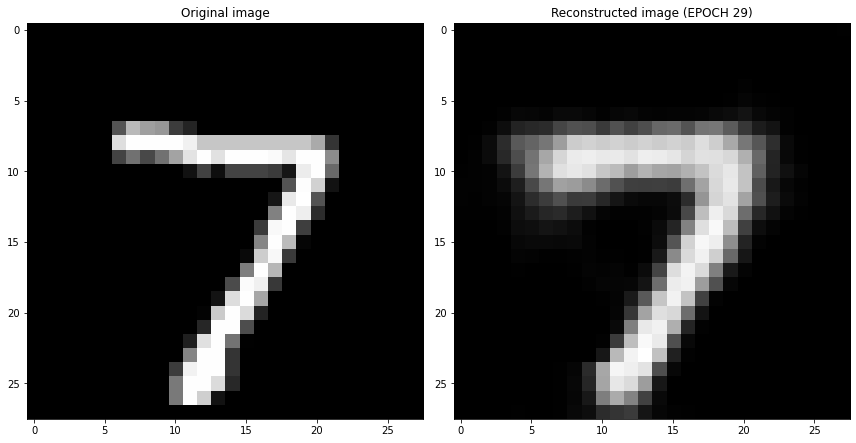

EPOCH 30/30
	 partial train loss (single batch): 0.040489
	 partial train loss (single batch): 0.039912
	 partial train loss (single batch): 0.040195
	 partial train loss (single batch): 0.039782
	 partial train loss (single batch): 0.040684
	 partial train loss (single batch): 0.041319
	 partial train loss (single batch): 0.040415
	 partial train loss (single batch): 0.041421
	 partial train loss (single batch): 0.039693
	 partial train loss (single batch): 0.039619
	 partial train loss (single batch): 0.036803
	 partial train loss (single batch): 0.040854
	 partial train loss (single batch): 0.039875
	 partial train loss (single batch): 0.038352
	 partial train loss (single batch): 0.039241
	 partial train loss (single batch): 0.038009
	 partial train loss (single batch): 0.039241
	 partial train loss (single batch): 0.039951
	 partial train loss (single batch): 0.041041
	 partial train loss (single batch): 0.040792
	 partial train loss (single batch): 0.040588
	 partial train loss (

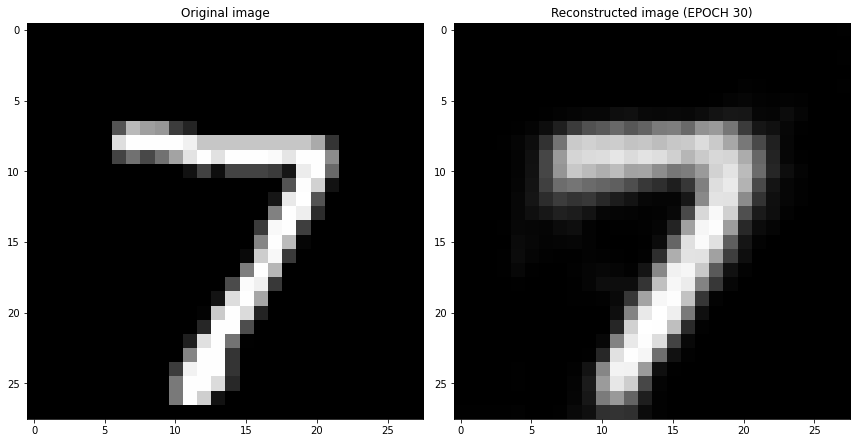

Cross validation fold number= 5/6
EPOCH 1/30
	 partial train loss (single batch): 0.177780
	 partial train loss (single batch): 0.173510
	 partial train loss (single batch): 0.167117
	 partial train loss (single batch): 0.158322
	 partial train loss (single batch): 0.143191
	 partial train loss (single batch): 0.118741
	 partial train loss (single batch): 0.111851
	 partial train loss (single batch): 0.111812
	 partial train loss (single batch): 0.110332
	 partial train loss (single batch): 0.104898
	 partial train loss (single batch): 0.109411
	 partial train loss (single batch): 0.105368
	 partial train loss (single batch): 0.105878
	 partial train loss (single batch): 0.104361
	 partial train loss (single batch): 0.098169
	 partial train loss (single batch): 0.098070
	 partial train loss (single batch): 0.092106
	 partial train loss (single batch): 0.106232
	 partial train loss (single batch): 0.094279
	 partial train loss (single batch): 0.092414
	 partial train loss (single batch)

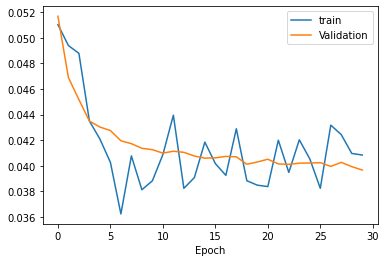

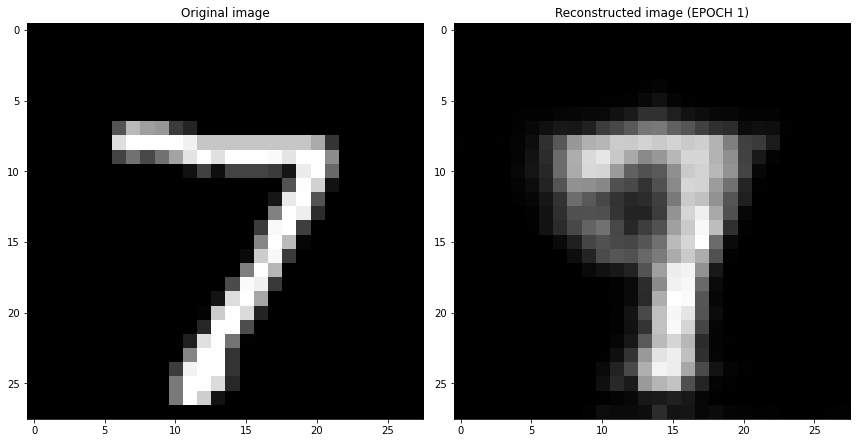

EPOCH 2/30
	 partial train loss (single batch): 0.050015
	 partial train loss (single batch): 0.049986
	 partial train loss (single batch): 0.051519
	 partial train loss (single batch): 0.051314
	 partial train loss (single batch): 0.050030
	 partial train loss (single batch): 0.049611
	 partial train loss (single batch): 0.049751
	 partial train loss (single batch): 0.051419
	 partial train loss (single batch): 0.049386
	 partial train loss (single batch): 0.050341
	 partial train loss (single batch): 0.050351
	 partial train loss (single batch): 0.050296
	 partial train loss (single batch): 0.049432
	 partial train loss (single batch): 0.049656
	 partial train loss (single batch): 0.050587
	 partial train loss (single batch): 0.051833
	 partial train loss (single batch): 0.049136
	 partial train loss (single batch): 0.049048
	 partial train loss (single batch): 0.049572
	 partial train loss (single batch): 0.050517
	 partial train loss (single batch): 0.050505
	 partial train loss (s

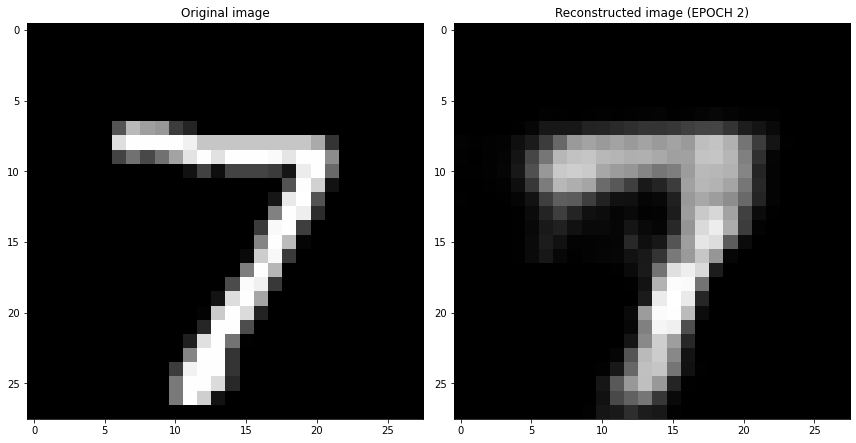

EPOCH 3/30
	 partial train loss (single batch): 0.043258
	 partial train loss (single batch): 0.045763
	 partial train loss (single batch): 0.044522
	 partial train loss (single batch): 0.044588
	 partial train loss (single batch): 0.045488
	 partial train loss (single batch): 0.045005
	 partial train loss (single batch): 0.045840
	 partial train loss (single batch): 0.042442
	 partial train loss (single batch): 0.046278
	 partial train loss (single batch): 0.044497
	 partial train loss (single batch): 0.042891
	 partial train loss (single batch): 0.045872
	 partial train loss (single batch): 0.044759
	 partial train loss (single batch): 0.045108
	 partial train loss (single batch): 0.044432
	 partial train loss (single batch): 0.044537
	 partial train loss (single batch): 0.042559
	 partial train loss (single batch): 0.044976
	 partial train loss (single batch): 0.042409
	 partial train loss (single batch): 0.046057
	 partial train loss (single batch): 0.046771
	 partial train loss (s

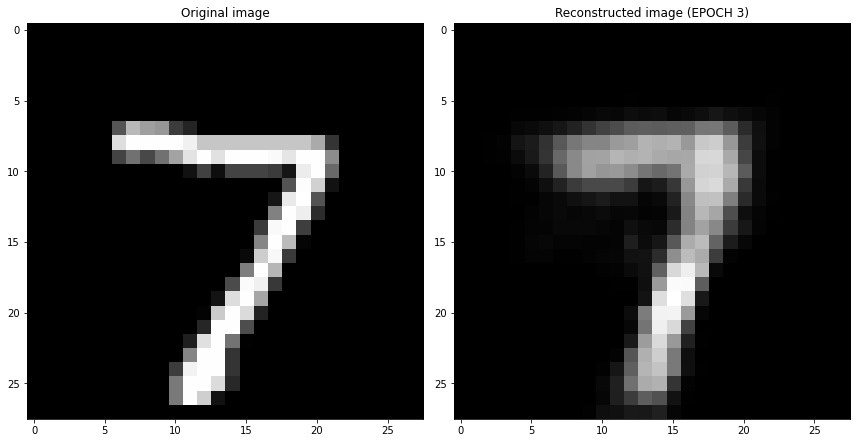

EPOCH 4/30
	 partial train loss (single batch): 0.042705
	 partial train loss (single batch): 0.043293
	 partial train loss (single batch): 0.044303
	 partial train loss (single batch): 0.043792
	 partial train loss (single batch): 0.043436
	 partial train loss (single batch): 0.044946
	 partial train loss (single batch): 0.042746
	 partial train loss (single batch): 0.045273
	 partial train loss (single batch): 0.043743
	 partial train loss (single batch): 0.045245
	 partial train loss (single batch): 0.044076
	 partial train loss (single batch): 0.042999
	 partial train loss (single batch): 0.043976
	 partial train loss (single batch): 0.042752
	 partial train loss (single batch): 0.043186
	 partial train loss (single batch): 0.044546
	 partial train loss (single batch): 0.043032
	 partial train loss (single batch): 0.042182
	 partial train loss (single batch): 0.046034
	 partial train loss (single batch): 0.043692
	 partial train loss (single batch): 0.043608
	 partial train loss (s

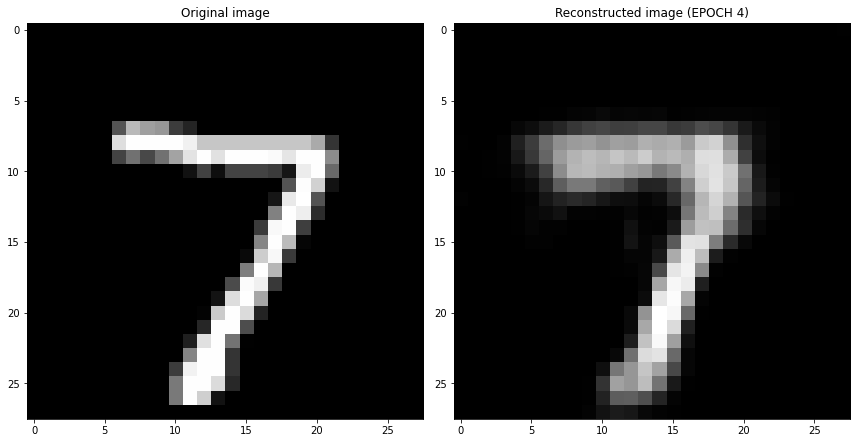

EPOCH 5/30
	 partial train loss (single batch): 0.044900
	 partial train loss (single batch): 0.043410
	 partial train loss (single batch): 0.042308
	 partial train loss (single batch): 0.041784
	 partial train loss (single batch): 0.043379
	 partial train loss (single batch): 0.043525
	 partial train loss (single batch): 0.042413
	 partial train loss (single batch): 0.043720
	 partial train loss (single batch): 0.041451
	 partial train loss (single batch): 0.044310
	 partial train loss (single batch): 0.042970
	 partial train loss (single batch): 0.042169
	 partial train loss (single batch): 0.041398
	 partial train loss (single batch): 0.042785
	 partial train loss (single batch): 0.043845
	 partial train loss (single batch): 0.043316
	 partial train loss (single batch): 0.044136
	 partial train loss (single batch): 0.042406
	 partial train loss (single batch): 0.043132
	 partial train loss (single batch): 0.043200
	 partial train loss (single batch): 0.041412
	 partial train loss (s

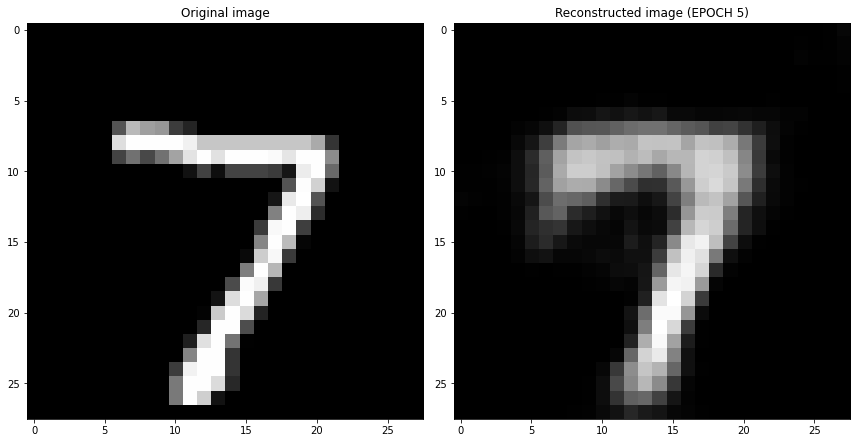

EPOCH 6/30
	 partial train loss (single batch): 0.044446
	 partial train loss (single batch): 0.043186
	 partial train loss (single batch): 0.042441
	 partial train loss (single batch): 0.041021
	 partial train loss (single batch): 0.042884
	 partial train loss (single batch): 0.043426
	 partial train loss (single batch): 0.044322
	 partial train loss (single batch): 0.043261
	 partial train loss (single batch): 0.039981
	 partial train loss (single batch): 0.042744
	 partial train loss (single batch): 0.041678
	 partial train loss (single batch): 0.041293
	 partial train loss (single batch): 0.042164
	 partial train loss (single batch): 0.040610
	 partial train loss (single batch): 0.042318
	 partial train loss (single batch): 0.040035
	 partial train loss (single batch): 0.040767
	 partial train loss (single batch): 0.044054
	 partial train loss (single batch): 0.042080
	 partial train loss (single batch): 0.043684
	 partial train loss (single batch): 0.041429
	 partial train loss (s

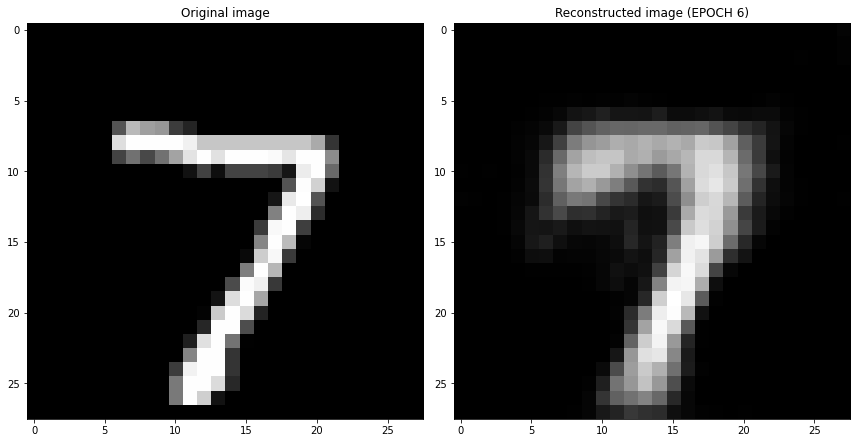

EPOCH 7/30
	 partial train loss (single batch): 0.041637
	 partial train loss (single batch): 0.043386
	 partial train loss (single batch): 0.043286
	 partial train loss (single batch): 0.039868
	 partial train loss (single batch): 0.040366
	 partial train loss (single batch): 0.042999
	 partial train loss (single batch): 0.042509
	 partial train loss (single batch): 0.042697
	 partial train loss (single batch): 0.043192
	 partial train loss (single batch): 0.044082
	 partial train loss (single batch): 0.043766
	 partial train loss (single batch): 0.041714
	 partial train loss (single batch): 0.041789
	 partial train loss (single batch): 0.039857
	 partial train loss (single batch): 0.041975
	 partial train loss (single batch): 0.040961
	 partial train loss (single batch): 0.042006
	 partial train loss (single batch): 0.040621
	 partial train loss (single batch): 0.043359
	 partial train loss (single batch): 0.042125
	 partial train loss (single batch): 0.040447
	 partial train loss (s

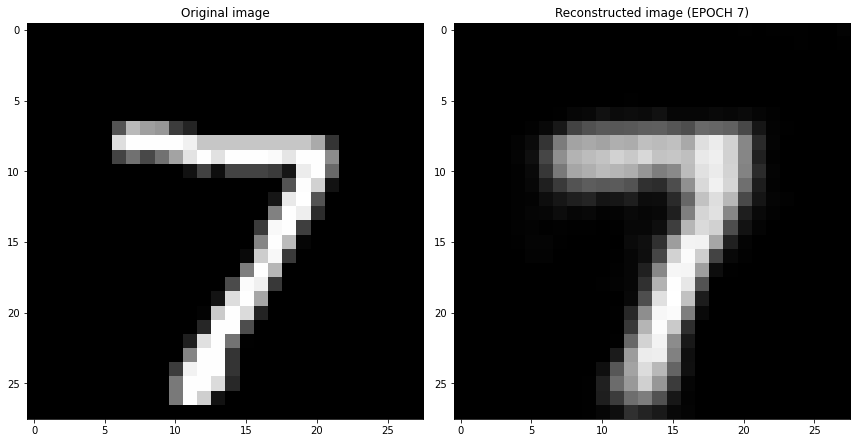

EPOCH 8/30
	 partial train loss (single batch): 0.040521
	 partial train loss (single batch): 0.041698
	 partial train loss (single batch): 0.041813
	 partial train loss (single batch): 0.042589
	 partial train loss (single batch): 0.040412
	 partial train loss (single batch): 0.042014
	 partial train loss (single batch): 0.039936
	 partial train loss (single batch): 0.042868
	 partial train loss (single batch): 0.041527
	 partial train loss (single batch): 0.042168
	 partial train loss (single batch): 0.043186
	 partial train loss (single batch): 0.041845
	 partial train loss (single batch): 0.042901
	 partial train loss (single batch): 0.041847
	 partial train loss (single batch): 0.043149
	 partial train loss (single batch): 0.042242
	 partial train loss (single batch): 0.042748
	 partial train loss (single batch): 0.041033
	 partial train loss (single batch): 0.041010
	 partial train loss (single batch): 0.040859
	 partial train loss (single batch): 0.041170
	 partial train loss (s

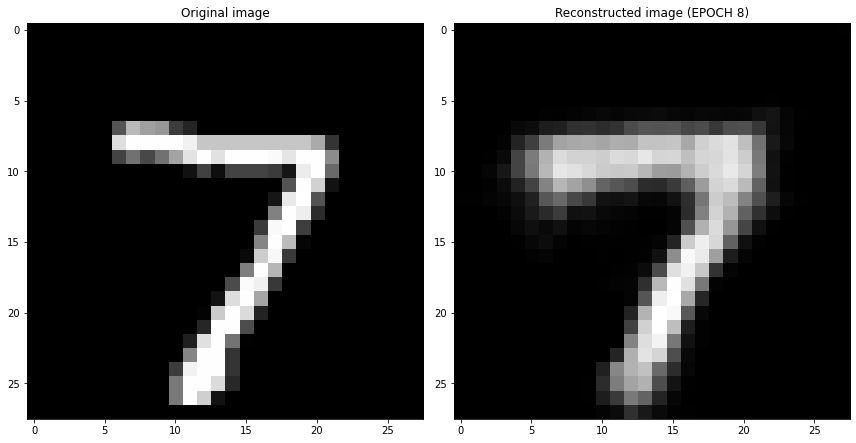

EPOCH 9/30
	 partial train loss (single batch): 0.042215
	 partial train loss (single batch): 0.042266
	 partial train loss (single batch): 0.040327
	 partial train loss (single batch): 0.040223
	 partial train loss (single batch): 0.040458
	 partial train loss (single batch): 0.039727
	 partial train loss (single batch): 0.041747
	 partial train loss (single batch): 0.040231
	 partial train loss (single batch): 0.041264
	 partial train loss (single batch): 0.042701
	 partial train loss (single batch): 0.040583
	 partial train loss (single batch): 0.041584
	 partial train loss (single batch): 0.038854
	 partial train loss (single batch): 0.041138
	 partial train loss (single batch): 0.040241
	 partial train loss (single batch): 0.041507
	 partial train loss (single batch): 0.042328
	 partial train loss (single batch): 0.041704
	 partial train loss (single batch): 0.042647
	 partial train loss (single batch): 0.040417
	 partial train loss (single batch): 0.042195
	 partial train loss (s

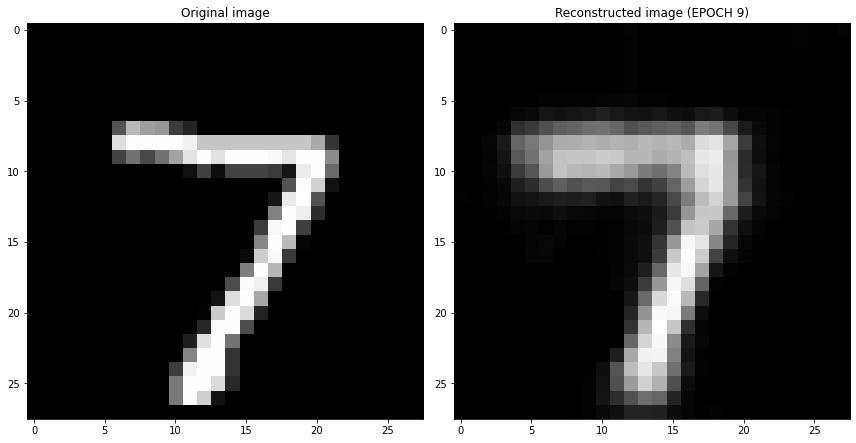

EPOCH 10/30
	 partial train loss (single batch): 0.042029
	 partial train loss (single batch): 0.041902
	 partial train loss (single batch): 0.041117
	 partial train loss (single batch): 0.041940
	 partial train loss (single batch): 0.041298
	 partial train loss (single batch): 0.041543
	 partial train loss (single batch): 0.040696
	 partial train loss (single batch): 0.040677
	 partial train loss (single batch): 0.041169
	 partial train loss (single batch): 0.042778
	 partial train loss (single batch): 0.041635
	 partial train loss (single batch): 0.042018
	 partial train loss (single batch): 0.040492
	 partial train loss (single batch): 0.039813
	 partial train loss (single batch): 0.042206
	 partial train loss (single batch): 0.041882
	 partial train loss (single batch): 0.041917
	 partial train loss (single batch): 0.042405
	 partial train loss (single batch): 0.041353
	 partial train loss (single batch): 0.041974
	 partial train loss (single batch): 0.040706
	 partial train loss (

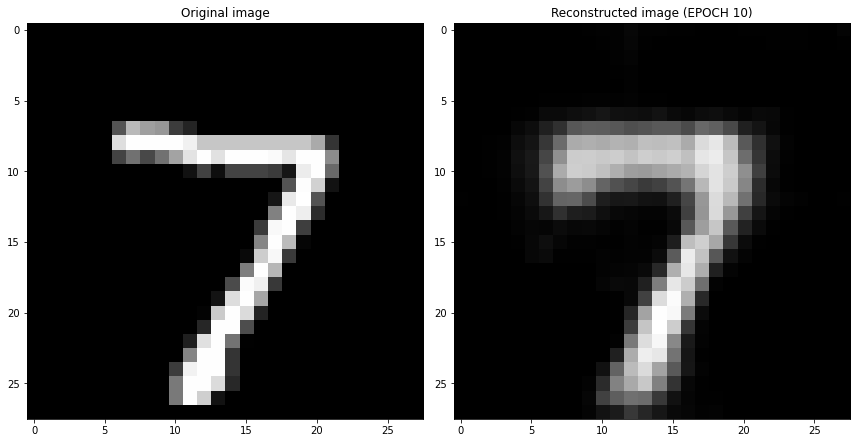

EPOCH 11/30
	 partial train loss (single batch): 0.041773
	 partial train loss (single batch): 0.041815
	 partial train loss (single batch): 0.040427
	 partial train loss (single batch): 0.040694
	 partial train loss (single batch): 0.041744
	 partial train loss (single batch): 0.041929
	 partial train loss (single batch): 0.040449
	 partial train loss (single batch): 0.040391
	 partial train loss (single batch): 0.040160
	 partial train loss (single batch): 0.039343
	 partial train loss (single batch): 0.040394
	 partial train loss (single batch): 0.043797
	 partial train loss (single batch): 0.041781
	 partial train loss (single batch): 0.039730
	 partial train loss (single batch): 0.041825
	 partial train loss (single batch): 0.041686
	 partial train loss (single batch): 0.040220
	 partial train loss (single batch): 0.042762
	 partial train loss (single batch): 0.041354
	 partial train loss (single batch): 0.040455
	 partial train loss (single batch): 0.040785
	 partial train loss (

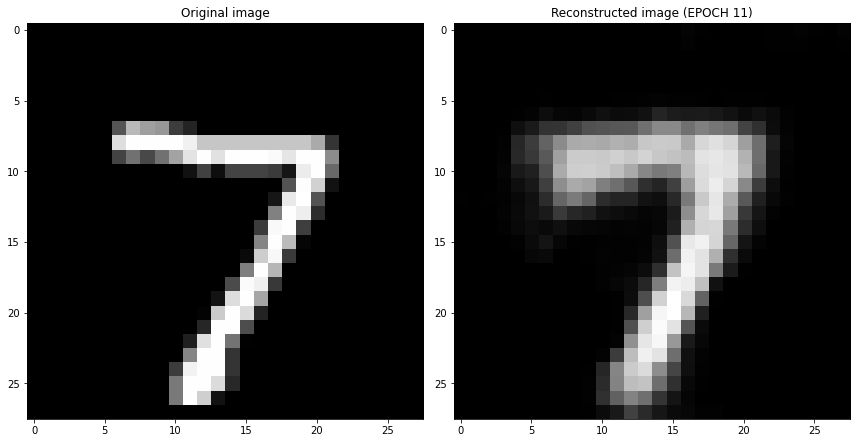

EPOCH 12/30
	 partial train loss (single batch): 0.039222
	 partial train loss (single batch): 0.040838
	 partial train loss (single batch): 0.039265
	 partial train loss (single batch): 0.040852
	 partial train loss (single batch): 0.038334
	 partial train loss (single batch): 0.040007
	 partial train loss (single batch): 0.042227
	 partial train loss (single batch): 0.040495
	 partial train loss (single batch): 0.041349
	 partial train loss (single batch): 0.041740
	 partial train loss (single batch): 0.039593
	 partial train loss (single batch): 0.040736
	 partial train loss (single batch): 0.039597
	 partial train loss (single batch): 0.040694
	 partial train loss (single batch): 0.040603
	 partial train loss (single batch): 0.040643
	 partial train loss (single batch): 0.040708
	 partial train loss (single batch): 0.039346
	 partial train loss (single batch): 0.038368
	 partial train loss (single batch): 0.040406
	 partial train loss (single batch): 0.038151
	 partial train loss (

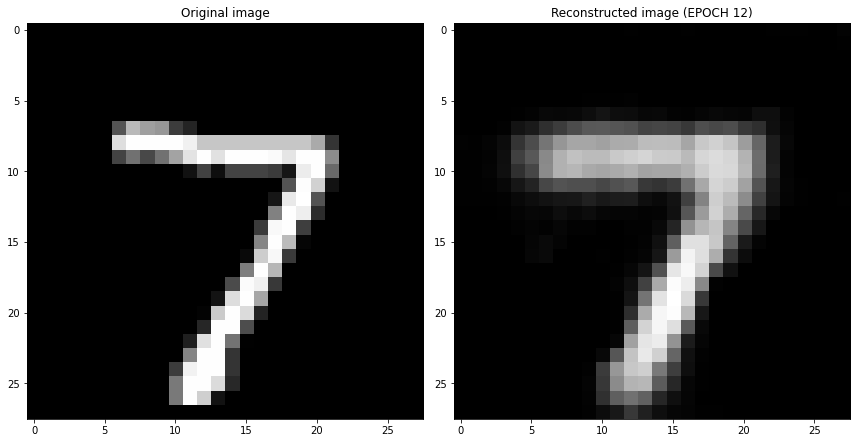

EPOCH 13/30
	 partial train loss (single batch): 0.040700
	 partial train loss (single batch): 0.041977
	 partial train loss (single batch): 0.040726
	 partial train loss (single batch): 0.039345
	 partial train loss (single batch): 0.040662
	 partial train loss (single batch): 0.039309
	 partial train loss (single batch): 0.040827
	 partial train loss (single batch): 0.041032
	 partial train loss (single batch): 0.038105
	 partial train loss (single batch): 0.040004
	 partial train loss (single batch): 0.039771
	 partial train loss (single batch): 0.041576
	 partial train loss (single batch): 0.040986
	 partial train loss (single batch): 0.040650
	 partial train loss (single batch): 0.042407
	 partial train loss (single batch): 0.038724
	 partial train loss (single batch): 0.040561
	 partial train loss (single batch): 0.040974
	 partial train loss (single batch): 0.041495
	 partial train loss (single batch): 0.042221
	 partial train loss (single batch): 0.041606
	 partial train loss (

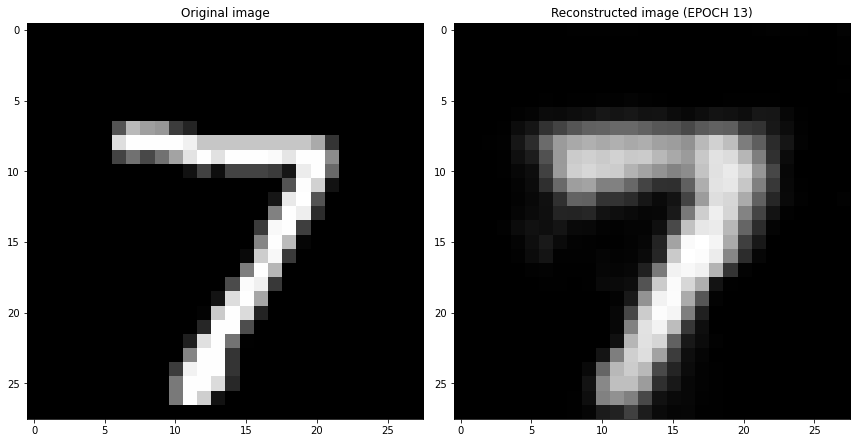

EPOCH 14/30
	 partial train loss (single batch): 0.039774
	 partial train loss (single batch): 0.039350
	 partial train loss (single batch): 0.040875
	 partial train loss (single batch): 0.042634
	 partial train loss (single batch): 0.040689
	 partial train loss (single batch): 0.039615
	 partial train loss (single batch): 0.039867
	 partial train loss (single batch): 0.040545
	 partial train loss (single batch): 0.040982
	 partial train loss (single batch): 0.041517
	 partial train loss (single batch): 0.039190
	 partial train loss (single batch): 0.040219
	 partial train loss (single batch): 0.041634
	 partial train loss (single batch): 0.040036
	 partial train loss (single batch): 0.041348
	 partial train loss (single batch): 0.039376
	 partial train loss (single batch): 0.040976
	 partial train loss (single batch): 0.042811
	 partial train loss (single batch): 0.041795
	 partial train loss (single batch): 0.041070
	 partial train loss (single batch): 0.042564
	 partial train loss (

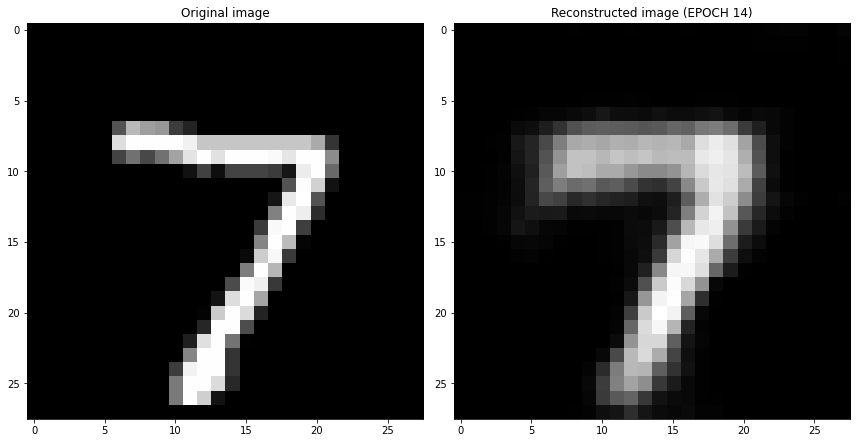

EPOCH 15/30
	 partial train loss (single batch): 0.039326
	 partial train loss (single batch): 0.039566
	 partial train loss (single batch): 0.039946
	 partial train loss (single batch): 0.039729
	 partial train loss (single batch): 0.040142
	 partial train loss (single batch): 0.039358
	 partial train loss (single batch): 0.040251
	 partial train loss (single batch): 0.038687
	 partial train loss (single batch): 0.041665
	 partial train loss (single batch): 0.043531
	 partial train loss (single batch): 0.040064
	 partial train loss (single batch): 0.040131
	 partial train loss (single batch): 0.040171
	 partial train loss (single batch): 0.039877
	 partial train loss (single batch): 0.041075
	 partial train loss (single batch): 0.041327
	 partial train loss (single batch): 0.038129
	 partial train loss (single batch): 0.039783
	 partial train loss (single batch): 0.039033
	 partial train loss (single batch): 0.038464
	 partial train loss (single batch): 0.042607
	 partial train loss (

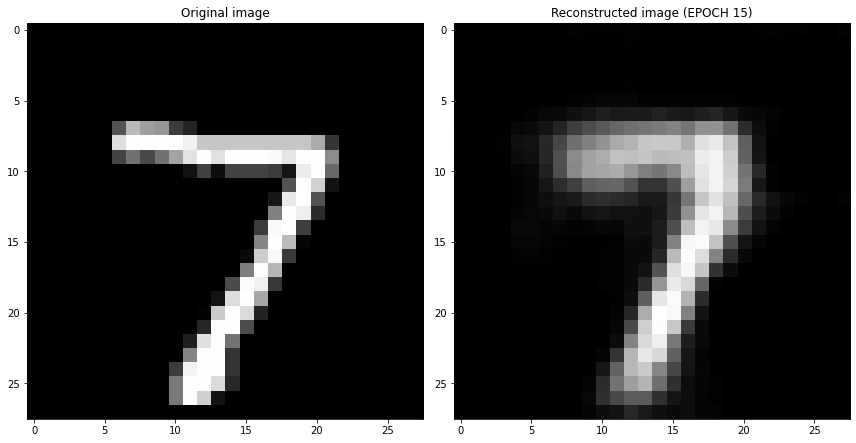

EPOCH 16/30
	 partial train loss (single batch): 0.039267
	 partial train loss (single batch): 0.040140
	 partial train loss (single batch): 0.040422
	 partial train loss (single batch): 0.039300
	 partial train loss (single batch): 0.039344
	 partial train loss (single batch): 0.041371
	 partial train loss (single batch): 0.040643
	 partial train loss (single batch): 0.039595
	 partial train loss (single batch): 0.040022
	 partial train loss (single batch): 0.039026
	 partial train loss (single batch): 0.040895
	 partial train loss (single batch): 0.039243
	 partial train loss (single batch): 0.039508
	 partial train loss (single batch): 0.039559
	 partial train loss (single batch): 0.041471
	 partial train loss (single batch): 0.042590
	 partial train loss (single batch): 0.040125
	 partial train loss (single batch): 0.040027
	 partial train loss (single batch): 0.041030
	 partial train loss (single batch): 0.041443
	 partial train loss (single batch): 0.040746
	 partial train loss (

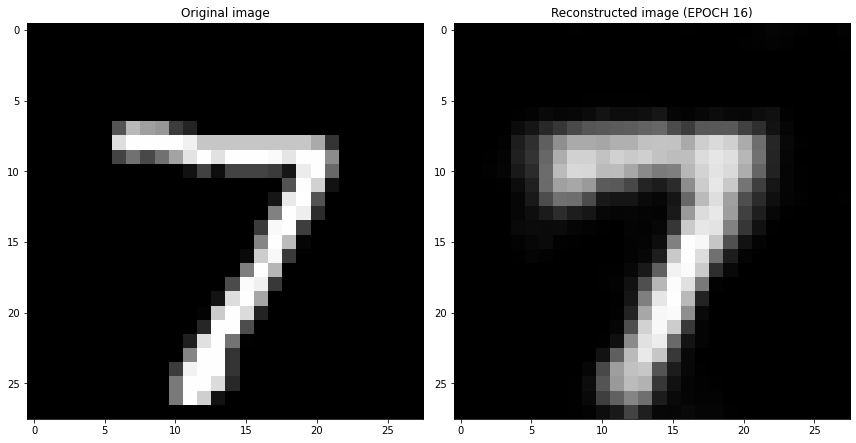

EPOCH 17/30
	 partial train loss (single batch): 0.041074
	 partial train loss (single batch): 0.040933
	 partial train loss (single batch): 0.039654
	 partial train loss (single batch): 0.041109
	 partial train loss (single batch): 0.042013
	 partial train loss (single batch): 0.039625
	 partial train loss (single batch): 0.041229
	 partial train loss (single batch): 0.039324
	 partial train loss (single batch): 0.040800
	 partial train loss (single batch): 0.042165
	 partial train loss (single batch): 0.042776
	 partial train loss (single batch): 0.040586
	 partial train loss (single batch): 0.039660
	 partial train loss (single batch): 0.040081
	 partial train loss (single batch): 0.040609
	 partial train loss (single batch): 0.039525
	 partial train loss (single batch): 0.042021
	 partial train loss (single batch): 0.040697
	 partial train loss (single batch): 0.041758
	 partial train loss (single batch): 0.040079
	 partial train loss (single batch): 0.043092
	 partial train loss (

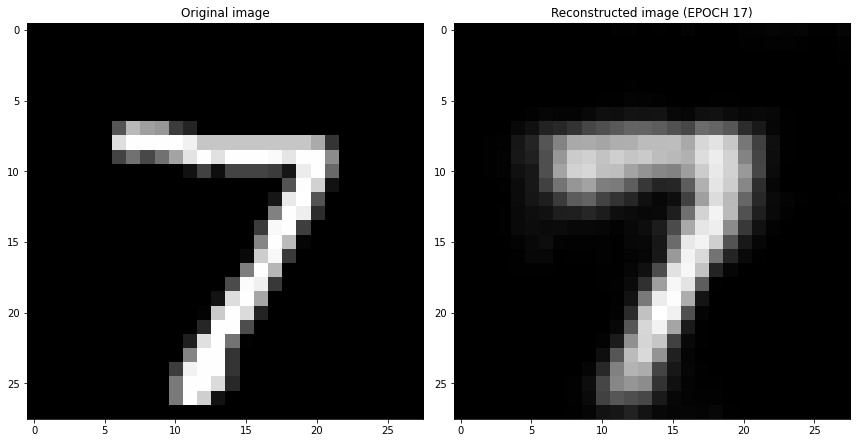

EPOCH 18/30
	 partial train loss (single batch): 0.039932
	 partial train loss (single batch): 0.040464
	 partial train loss (single batch): 0.038676
	 partial train loss (single batch): 0.041182
	 partial train loss (single batch): 0.038405
	 partial train loss (single batch): 0.042243
	 partial train loss (single batch): 0.039230
	 partial train loss (single batch): 0.039847
	 partial train loss (single batch): 0.040038
	 partial train loss (single batch): 0.039855
	 partial train loss (single batch): 0.038889
	 partial train loss (single batch): 0.040338
	 partial train loss (single batch): 0.039875
	 partial train loss (single batch): 0.038968
	 partial train loss (single batch): 0.039676
	 partial train loss (single batch): 0.040219
	 partial train loss (single batch): 0.040544
	 partial train loss (single batch): 0.039790
	 partial train loss (single batch): 0.038742
	 partial train loss (single batch): 0.040209
	 partial train loss (single batch): 0.042155
	 partial train loss (

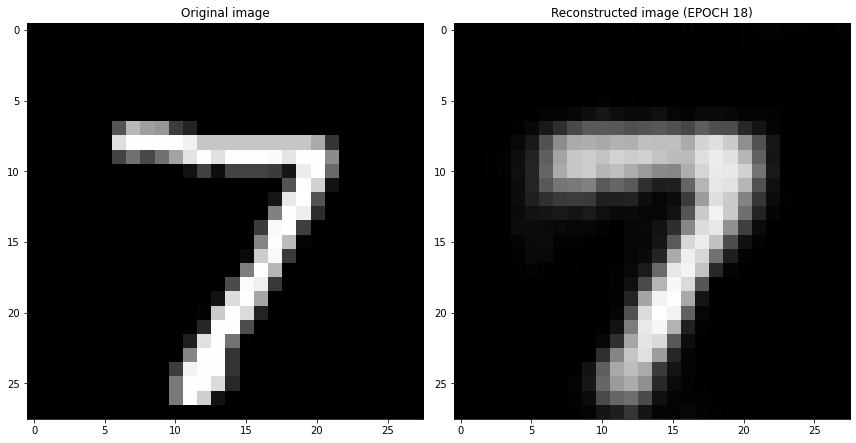

EPOCH 19/30
	 partial train loss (single batch): 0.042263
	 partial train loss (single batch): 0.039008
	 partial train loss (single batch): 0.038964
	 partial train loss (single batch): 0.039338
	 partial train loss (single batch): 0.040674
	 partial train loss (single batch): 0.041625
	 partial train loss (single batch): 0.041188
	 partial train loss (single batch): 0.040603
	 partial train loss (single batch): 0.039806
	 partial train loss (single batch): 0.039604
	 partial train loss (single batch): 0.038639
	 partial train loss (single batch): 0.040248
	 partial train loss (single batch): 0.040463
	 partial train loss (single batch): 0.042334
	 partial train loss (single batch): 0.039993
	 partial train loss (single batch): 0.041075
	 partial train loss (single batch): 0.038497
	 partial train loss (single batch): 0.039002
	 partial train loss (single batch): 0.039514
	 partial train loss (single batch): 0.036971
	 partial train loss (single batch): 0.040325
	 partial train loss (

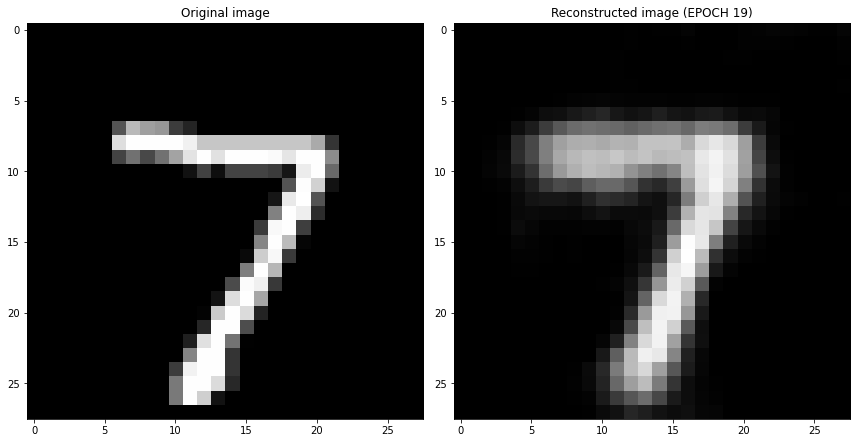

EPOCH 20/30
	 partial train loss (single batch): 0.039847
	 partial train loss (single batch): 0.038239
	 partial train loss (single batch): 0.040202
	 partial train loss (single batch): 0.040092
	 partial train loss (single batch): 0.038055
	 partial train loss (single batch): 0.039303
	 partial train loss (single batch): 0.040702
	 partial train loss (single batch): 0.041106
	 partial train loss (single batch): 0.040862
	 partial train loss (single batch): 0.040925
	 partial train loss (single batch): 0.040063
	 partial train loss (single batch): 0.041366
	 partial train loss (single batch): 0.040237
	 partial train loss (single batch): 0.037633
	 partial train loss (single batch): 0.040499
	 partial train loss (single batch): 0.040491
	 partial train loss (single batch): 0.040405
	 partial train loss (single batch): 0.041611
	 partial train loss (single batch): 0.040619
	 partial train loss (single batch): 0.038970
	 partial train loss (single batch): 0.038053
	 partial train loss (

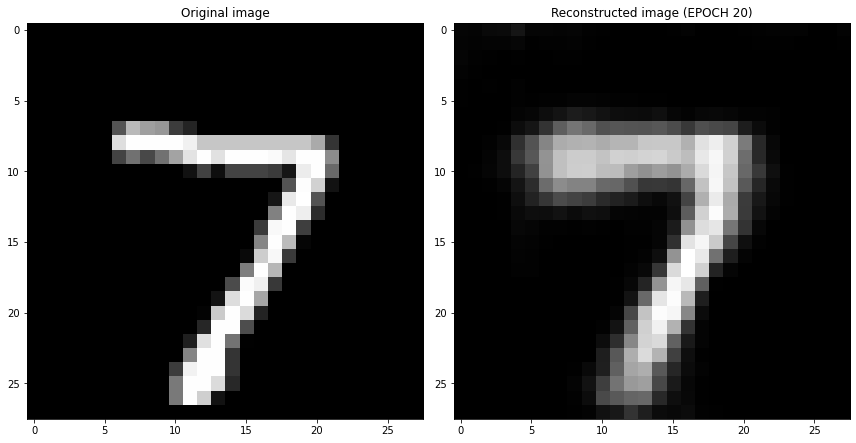

EPOCH 21/30
	 partial train loss (single batch): 0.041118
	 partial train loss (single batch): 0.040507
	 partial train loss (single batch): 0.040254
	 partial train loss (single batch): 0.039510
	 partial train loss (single batch): 0.040367
	 partial train loss (single batch): 0.040765
	 partial train loss (single batch): 0.039879
	 partial train loss (single batch): 0.039360
	 partial train loss (single batch): 0.040851
	 partial train loss (single batch): 0.039896
	 partial train loss (single batch): 0.037903
	 partial train loss (single batch): 0.039799
	 partial train loss (single batch): 0.040399
	 partial train loss (single batch): 0.041408
	 partial train loss (single batch): 0.040132
	 partial train loss (single batch): 0.037967
	 partial train loss (single batch): 0.039095
	 partial train loss (single batch): 0.039416
	 partial train loss (single batch): 0.039279
	 partial train loss (single batch): 0.038209
	 partial train loss (single batch): 0.039490
	 partial train loss (

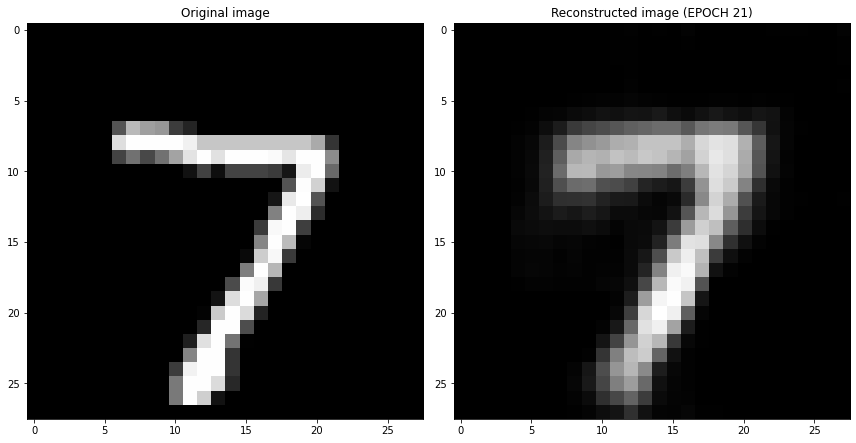

EPOCH 22/30
	 partial train loss (single batch): 0.038961
	 partial train loss (single batch): 0.039576
	 partial train loss (single batch): 0.038445
	 partial train loss (single batch): 0.039968
	 partial train loss (single batch): 0.037692
	 partial train loss (single batch): 0.039871
	 partial train loss (single batch): 0.040422
	 partial train loss (single batch): 0.040487
	 partial train loss (single batch): 0.038860
	 partial train loss (single batch): 0.044141
	 partial train loss (single batch): 0.038962
	 partial train loss (single batch): 0.038946
	 partial train loss (single batch): 0.039682
	 partial train loss (single batch): 0.040033
	 partial train loss (single batch): 0.039893
	 partial train loss (single batch): 0.039448
	 partial train loss (single batch): 0.038224
	 partial train loss (single batch): 0.038300
	 partial train loss (single batch): 0.040023
	 partial train loss (single batch): 0.040257
	 partial train loss (single batch): 0.039949
	 partial train loss (

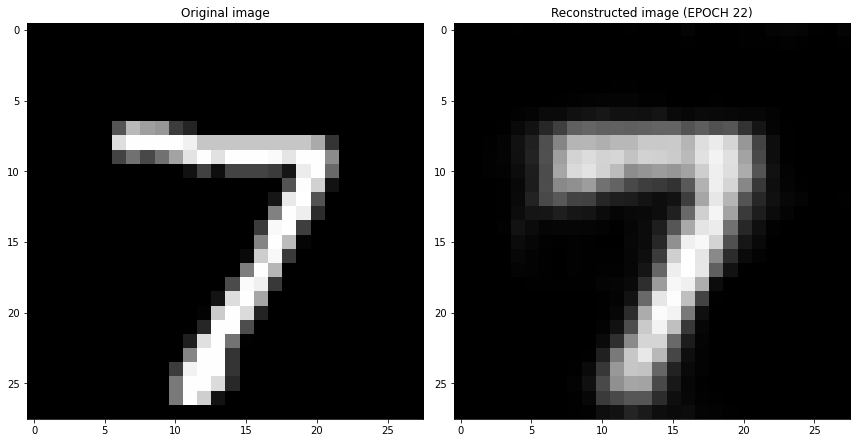

EPOCH 23/30
	 partial train loss (single batch): 0.039684
	 partial train loss (single batch): 0.037393
	 partial train loss (single batch): 0.039659
	 partial train loss (single batch): 0.040605
	 partial train loss (single batch): 0.040128
	 partial train loss (single batch): 0.039991
	 partial train loss (single batch): 0.040151
	 partial train loss (single batch): 0.037900
	 partial train loss (single batch): 0.041003
	 partial train loss (single batch): 0.036663
	 partial train loss (single batch): 0.040669
	 partial train loss (single batch): 0.039584
	 partial train loss (single batch): 0.038702
	 partial train loss (single batch): 0.038858
	 partial train loss (single batch): 0.040588
	 partial train loss (single batch): 0.039100
	 partial train loss (single batch): 0.039918
	 partial train loss (single batch): 0.039860
	 partial train loss (single batch): 0.040754
	 partial train loss (single batch): 0.038741
	 partial train loss (single batch): 0.040327
	 partial train loss (

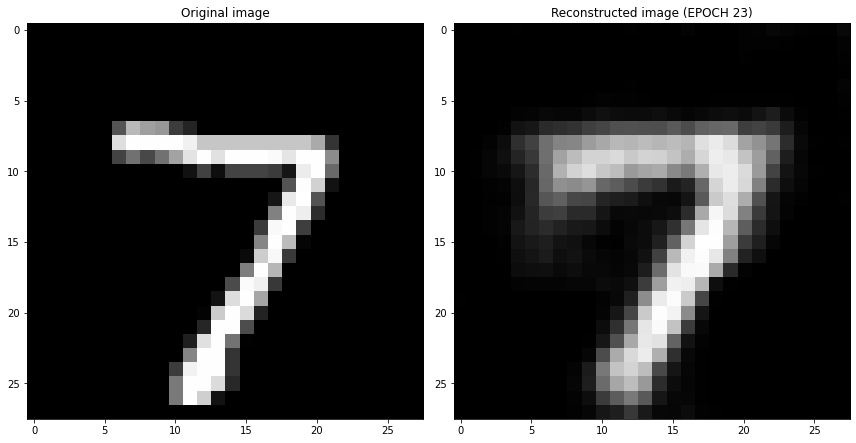

EPOCH 24/30
	 partial train loss (single batch): 0.037862
	 partial train loss (single batch): 0.041347
	 partial train loss (single batch): 0.039077
	 partial train loss (single batch): 0.037909
	 partial train loss (single batch): 0.038157
	 partial train loss (single batch): 0.039770
	 partial train loss (single batch): 0.040695
	 partial train loss (single batch): 0.041204
	 partial train loss (single batch): 0.039329
	 partial train loss (single batch): 0.039425
	 partial train loss (single batch): 0.040681
	 partial train loss (single batch): 0.039811
	 partial train loss (single batch): 0.038417
	 partial train loss (single batch): 0.038485
	 partial train loss (single batch): 0.039216
	 partial train loss (single batch): 0.038093
	 partial train loss (single batch): 0.039140
	 partial train loss (single batch): 0.038612
	 partial train loss (single batch): 0.042428
	 partial train loss (single batch): 0.036894
	 partial train loss (single batch): 0.041419
	 partial train loss (

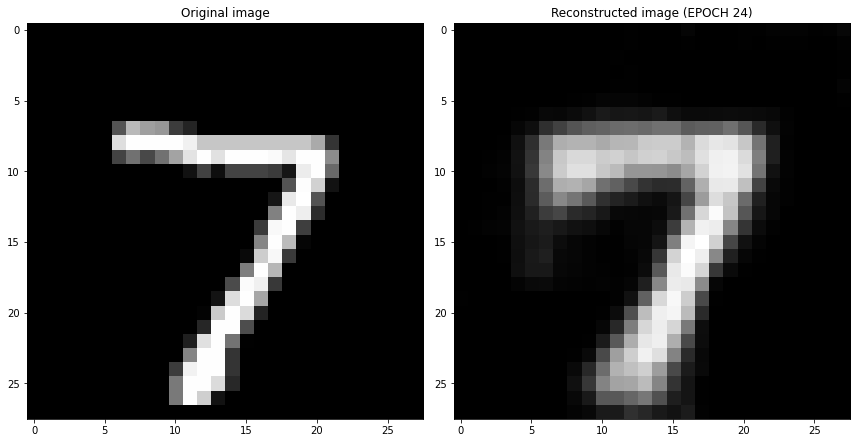

EPOCH 25/30
	 partial train loss (single batch): 0.037518
	 partial train loss (single batch): 0.039049
	 partial train loss (single batch): 0.039907
	 partial train loss (single batch): 0.038244
	 partial train loss (single batch): 0.040122
	 partial train loss (single batch): 0.039196
	 partial train loss (single batch): 0.040343
	 partial train loss (single batch): 0.039471
	 partial train loss (single batch): 0.039706
	 partial train loss (single batch): 0.039866
	 partial train loss (single batch): 0.039978
	 partial train loss (single batch): 0.039360
	 partial train loss (single batch): 0.039531
	 partial train loss (single batch): 0.040018
	 partial train loss (single batch): 0.039620
	 partial train loss (single batch): 0.038452
	 partial train loss (single batch): 0.040164
	 partial train loss (single batch): 0.039803
	 partial train loss (single batch): 0.039867
	 partial train loss (single batch): 0.040439
	 partial train loss (single batch): 0.040996
	 partial train loss (

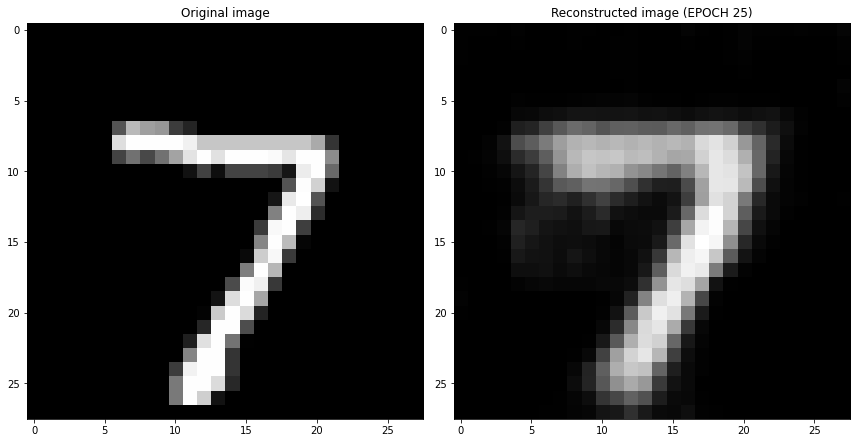

EPOCH 26/30
	 partial train loss (single batch): 0.039202
	 partial train loss (single batch): 0.040591
	 partial train loss (single batch): 0.039045
	 partial train loss (single batch): 0.040529
	 partial train loss (single batch): 0.039712
	 partial train loss (single batch): 0.041045
	 partial train loss (single batch): 0.039562
	 partial train loss (single batch): 0.040799
	 partial train loss (single batch): 0.037766
	 partial train loss (single batch): 0.038363
	 partial train loss (single batch): 0.039533
	 partial train loss (single batch): 0.037502
	 partial train loss (single batch): 0.039760
	 partial train loss (single batch): 0.040985
	 partial train loss (single batch): 0.039493
	 partial train loss (single batch): 0.038665
	 partial train loss (single batch): 0.038432
	 partial train loss (single batch): 0.039187
	 partial train loss (single batch): 0.038054
	 partial train loss (single batch): 0.040012
	 partial train loss (single batch): 0.040787
	 partial train loss (

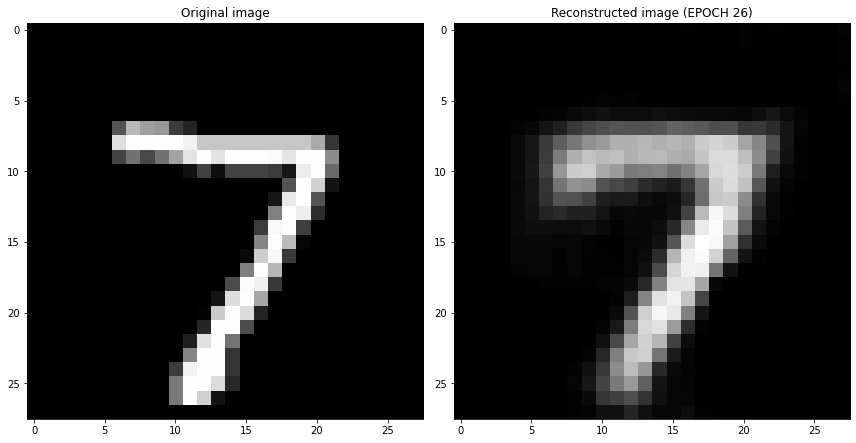

EPOCH 27/30
	 partial train loss (single batch): 0.040017
	 partial train loss (single batch): 0.038995
	 partial train loss (single batch): 0.037858
	 partial train loss (single batch): 0.038795
	 partial train loss (single batch): 0.041568
	 partial train loss (single batch): 0.040669
	 partial train loss (single batch): 0.040684
	 partial train loss (single batch): 0.040525
	 partial train loss (single batch): 0.040102
	 partial train loss (single batch): 0.037485
	 partial train loss (single batch): 0.039446
	 partial train loss (single batch): 0.041520
	 partial train loss (single batch): 0.039904
	 partial train loss (single batch): 0.037205
	 partial train loss (single batch): 0.040057
	 partial train loss (single batch): 0.039042
	 partial train loss (single batch): 0.040656
	 partial train loss (single batch): 0.038610
	 partial train loss (single batch): 0.038420
	 partial train loss (single batch): 0.040725
	 partial train loss (single batch): 0.038830
	 partial train loss (

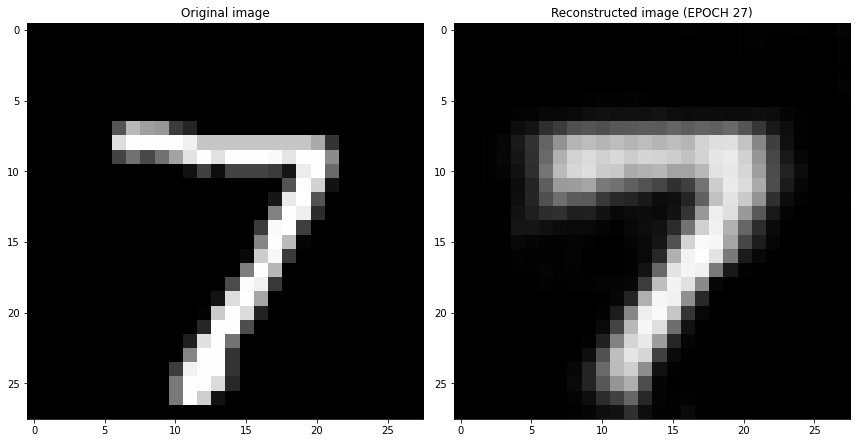

EPOCH 28/30
	 partial train loss (single batch): 0.041045
	 partial train loss (single batch): 0.040204
	 partial train loss (single batch): 0.039996
	 partial train loss (single batch): 0.038884
	 partial train loss (single batch): 0.040191
	 partial train loss (single batch): 0.039990
	 partial train loss (single batch): 0.039677
	 partial train loss (single batch): 0.040439
	 partial train loss (single batch): 0.040080
	 partial train loss (single batch): 0.039245
	 partial train loss (single batch): 0.039257
	 partial train loss (single batch): 0.039605
	 partial train loss (single batch): 0.039314
	 partial train loss (single batch): 0.039808
	 partial train loss (single batch): 0.038527
	 partial train loss (single batch): 0.039273
	 partial train loss (single batch): 0.038167
	 partial train loss (single batch): 0.038219
	 partial train loss (single batch): 0.039137
	 partial train loss (single batch): 0.040581
	 partial train loss (single batch): 0.040417
	 partial train loss (

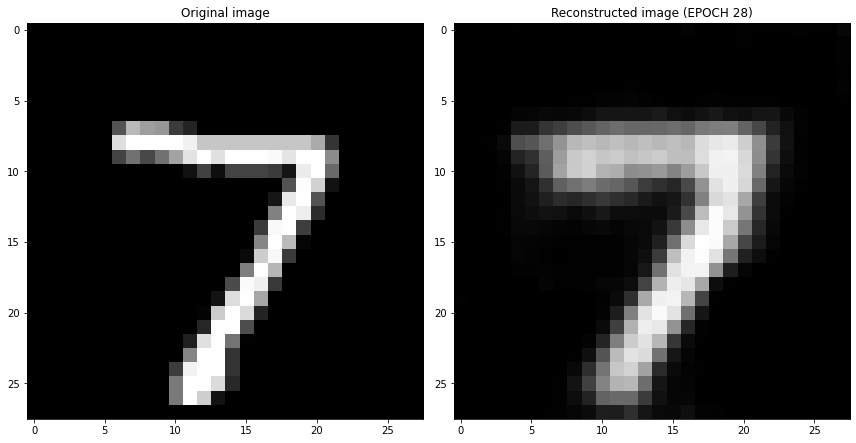

EPOCH 29/30
	 partial train loss (single batch): 0.038871
	 partial train loss (single batch): 0.038727
	 partial train loss (single batch): 0.036445
	 partial train loss (single batch): 0.039306
	 partial train loss (single batch): 0.040161
	 partial train loss (single batch): 0.039686
	 partial train loss (single batch): 0.039625
	 partial train loss (single batch): 0.039953
	 partial train loss (single batch): 0.040420
	 partial train loss (single batch): 0.039125
	 partial train loss (single batch): 0.040683
	 partial train loss (single batch): 0.040085
	 partial train loss (single batch): 0.038701
	 partial train loss (single batch): 0.038968
	 partial train loss (single batch): 0.040146
	 partial train loss (single batch): 0.041937
	 partial train loss (single batch): 0.042043
	 partial train loss (single batch): 0.039206
	 partial train loss (single batch): 0.040806
	 partial train loss (single batch): 0.040824
	 partial train loss (single batch): 0.039853
	 partial train loss (

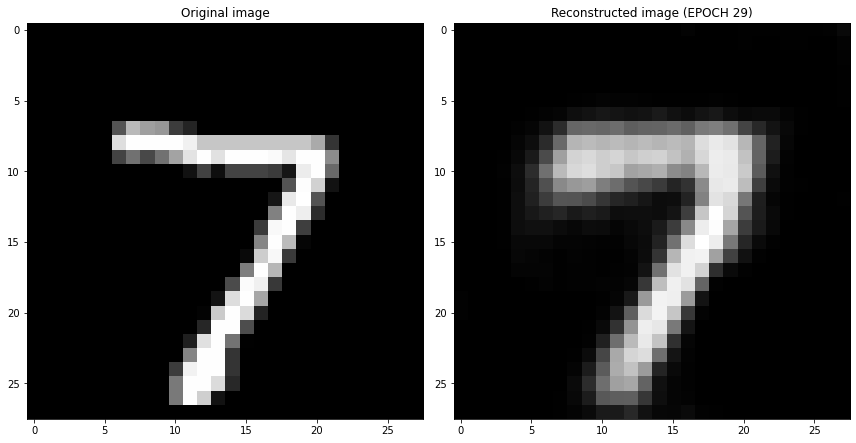

EPOCH 30/30
	 partial train loss (single batch): 0.039722
	 partial train loss (single batch): 0.038838
	 partial train loss (single batch): 0.039064
	 partial train loss (single batch): 0.038736
	 partial train loss (single batch): 0.038420
	 partial train loss (single batch): 0.040381
	 partial train loss (single batch): 0.041111
	 partial train loss (single batch): 0.037795
	 partial train loss (single batch): 0.041026
	 partial train loss (single batch): 0.038505
	 partial train loss (single batch): 0.038575
	 partial train loss (single batch): 0.039541
	 partial train loss (single batch): 0.037909
	 partial train loss (single batch): 0.038090
	 partial train loss (single batch): 0.040419
	 partial train loss (single batch): 0.040846
	 partial train loss (single batch): 0.038699
	 partial train loss (single batch): 0.039119
	 partial train loss (single batch): 0.037939
	 partial train loss (single batch): 0.039530
	 partial train loss (single batch): 0.039136
	 partial train loss (

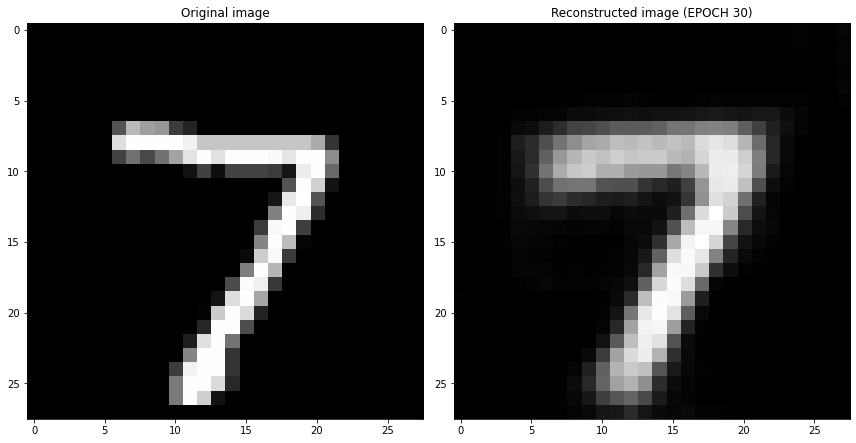

Cross validation fold number= 6/6
EPOCH 1/30
	 partial train loss (single batch): 0.235907
	 partial train loss (single batch): 0.232027
	 partial train loss (single batch): 0.228655
	 partial train loss (single batch): 0.223188
	 partial train loss (single batch): 0.214563
	 partial train loss (single batch): 0.202737
	 partial train loss (single batch): 0.189174
	 partial train loss (single batch): 0.172569
	 partial train loss (single batch): 0.155207
	 partial train loss (single batch): 0.127054
	 partial train loss (single batch): 0.112503
	 partial train loss (single batch): 0.110976
	 partial train loss (single batch): 0.115049
	 partial train loss (single batch): 0.111739
	 partial train loss (single batch): 0.108679
	 partial train loss (single batch): 0.113680
	 partial train loss (single batch): 0.107777
	 partial train loss (single batch): 0.111012
	 partial train loss (single batch): 0.111744
	 partial train loss (single batch): 0.110512
	 partial train loss (single batch)

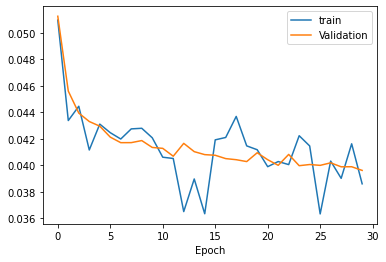

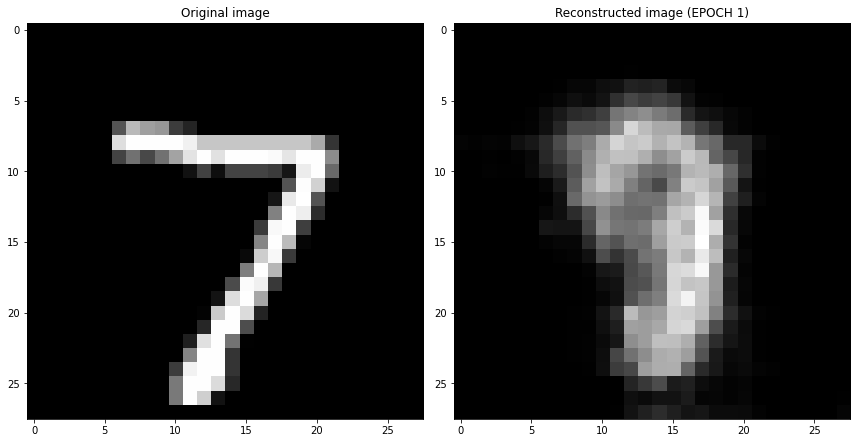

EPOCH 2/30
	 partial train loss (single batch): 0.055210
	 partial train loss (single batch): 0.055648
	 partial train loss (single batch): 0.055180
	 partial train loss (single batch): 0.054886
	 partial train loss (single batch): 0.054409
	 partial train loss (single batch): 0.054587
	 partial train loss (single batch): 0.054402
	 partial train loss (single batch): 0.055891
	 partial train loss (single batch): 0.053253
	 partial train loss (single batch): 0.052755
	 partial train loss (single batch): 0.053731
	 partial train loss (single batch): 0.053201
	 partial train loss (single batch): 0.052233
	 partial train loss (single batch): 0.054302
	 partial train loss (single batch): 0.055489
	 partial train loss (single batch): 0.054801
	 partial train loss (single batch): 0.054411
	 partial train loss (single batch): 0.054960
	 partial train loss (single batch): 0.054034
	 partial train loss (single batch): 0.053811
	 partial train loss (single batch): 0.052002
	 partial train loss (s

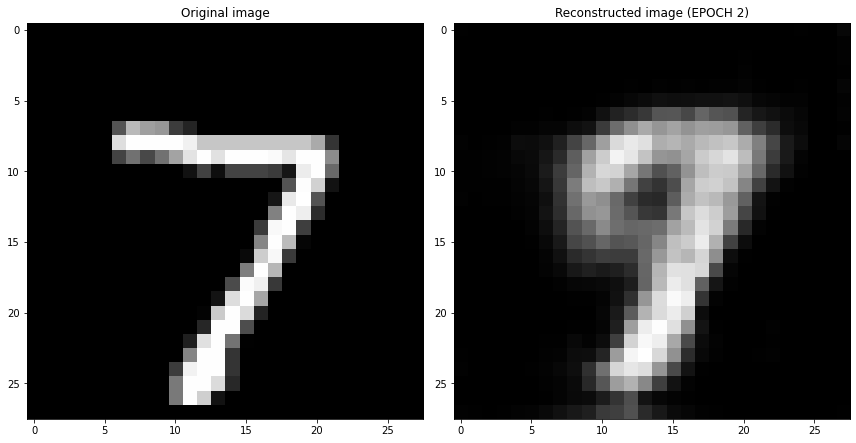

EPOCH 3/30
	 partial train loss (single batch): 0.046671
	 partial train loss (single batch): 0.049291
	 partial train loss (single batch): 0.052868
	 partial train loss (single batch): 0.049777
	 partial train loss (single batch): 0.045667
	 partial train loss (single batch): 0.048211
	 partial train loss (single batch): 0.048951
	 partial train loss (single batch): 0.049478
	 partial train loss (single batch): 0.045737
	 partial train loss (single batch): 0.048102
	 partial train loss (single batch): 0.050319
	 partial train loss (single batch): 0.048325
	 partial train loss (single batch): 0.048315
	 partial train loss (single batch): 0.045363
	 partial train loss (single batch): 0.048243
	 partial train loss (single batch): 0.045975
	 partial train loss (single batch): 0.047367
	 partial train loss (single batch): 0.045076
	 partial train loss (single batch): 0.045427
	 partial train loss (single batch): 0.046408
	 partial train loss (single batch): 0.049710
	 partial train loss (s

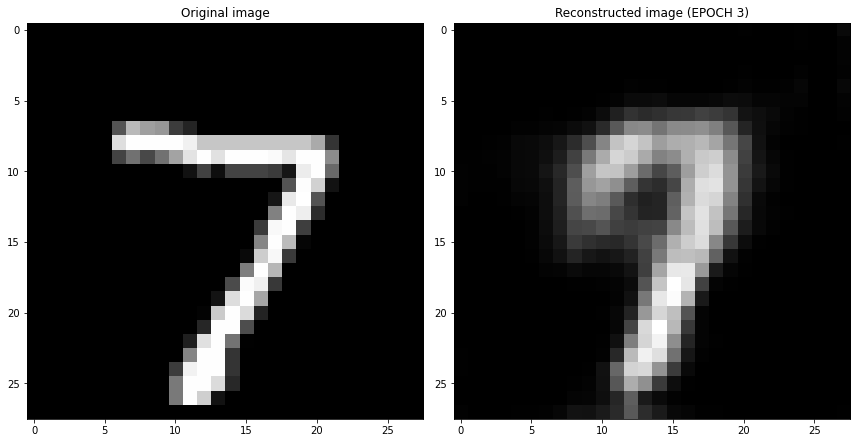

EPOCH 4/30
	 partial train loss (single batch): 0.045956
	 partial train loss (single batch): 0.044384
	 partial train loss (single batch): 0.046344
	 partial train loss (single batch): 0.044659
	 partial train loss (single batch): 0.044469
	 partial train loss (single batch): 0.044142
	 partial train loss (single batch): 0.048503
	 partial train loss (single batch): 0.046545
	 partial train loss (single batch): 0.044858
	 partial train loss (single batch): 0.046212
	 partial train loss (single batch): 0.045116
	 partial train loss (single batch): 0.045516
	 partial train loss (single batch): 0.045842
	 partial train loss (single batch): 0.041996
	 partial train loss (single batch): 0.043528
	 partial train loss (single batch): 0.043906
	 partial train loss (single batch): 0.046591
	 partial train loss (single batch): 0.044858
	 partial train loss (single batch): 0.042722
	 partial train loss (single batch): 0.046373
	 partial train loss (single batch): 0.046136
	 partial train loss (s

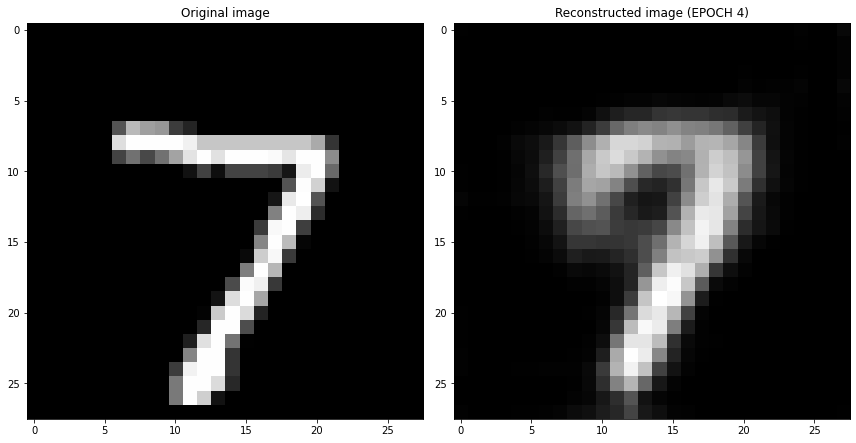

EPOCH 5/30
	 partial train loss (single batch): 0.044173
	 partial train loss (single batch): 0.046460
	 partial train loss (single batch): 0.045657
	 partial train loss (single batch): 0.042569
	 partial train loss (single batch): 0.045839
	 partial train loss (single batch): 0.045048
	 partial train loss (single batch): 0.046886
	 partial train loss (single batch): 0.048089
	 partial train loss (single batch): 0.043391
	 partial train loss (single batch): 0.045255
	 partial train loss (single batch): 0.044210
	 partial train loss (single batch): 0.045309
	 partial train loss (single batch): 0.044842
	 partial train loss (single batch): 0.043635
	 partial train loss (single batch): 0.044578
	 partial train loss (single batch): 0.044699
	 partial train loss (single batch): 0.044510
	 partial train loss (single batch): 0.043694
	 partial train loss (single batch): 0.044124
	 partial train loss (single batch): 0.045043
	 partial train loss (single batch): 0.046779
	 partial train loss (s

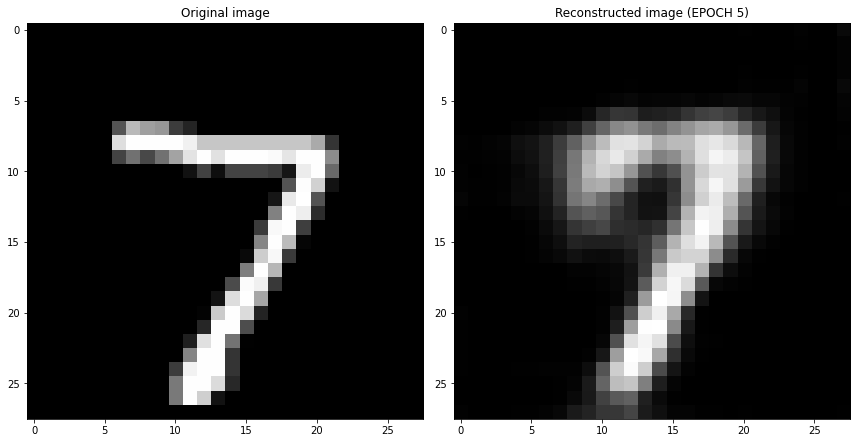

EPOCH 6/30
	 partial train loss (single batch): 0.042780
	 partial train loss (single batch): 0.043170
	 partial train loss (single batch): 0.042799
	 partial train loss (single batch): 0.041780
	 partial train loss (single batch): 0.043752
	 partial train loss (single batch): 0.043675
	 partial train loss (single batch): 0.043049
	 partial train loss (single batch): 0.044833
	 partial train loss (single batch): 0.043536
	 partial train loss (single batch): 0.043290
	 partial train loss (single batch): 0.044183
	 partial train loss (single batch): 0.043151
	 partial train loss (single batch): 0.044254
	 partial train loss (single batch): 0.044199
	 partial train loss (single batch): 0.043724
	 partial train loss (single batch): 0.043910
	 partial train loss (single batch): 0.043959
	 partial train loss (single batch): 0.045913
	 partial train loss (single batch): 0.044111
	 partial train loss (single batch): 0.045255
	 partial train loss (single batch): 0.043772
	 partial train loss (s

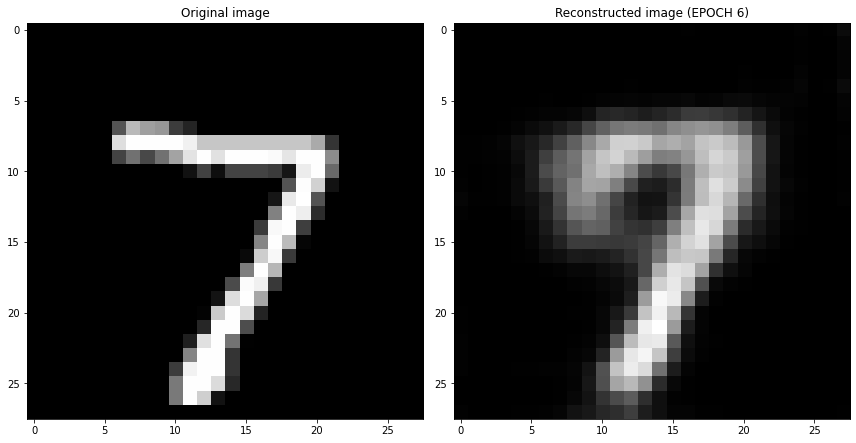

EPOCH 7/30
	 partial train loss (single batch): 0.043918
	 partial train loss (single batch): 0.043651
	 partial train loss (single batch): 0.044448
	 partial train loss (single batch): 0.043196
	 partial train loss (single batch): 0.041738
	 partial train loss (single batch): 0.042820
	 partial train loss (single batch): 0.040684
	 partial train loss (single batch): 0.044972
	 partial train loss (single batch): 0.042028
	 partial train loss (single batch): 0.043338
	 partial train loss (single batch): 0.041211
	 partial train loss (single batch): 0.043204
	 partial train loss (single batch): 0.043498
	 partial train loss (single batch): 0.042645
	 partial train loss (single batch): 0.042559
	 partial train loss (single batch): 0.043392
	 partial train loss (single batch): 0.043563
	 partial train loss (single batch): 0.042457
	 partial train loss (single batch): 0.043034
	 partial train loss (single batch): 0.046332
	 partial train loss (single batch): 0.040937
	 partial train loss (s

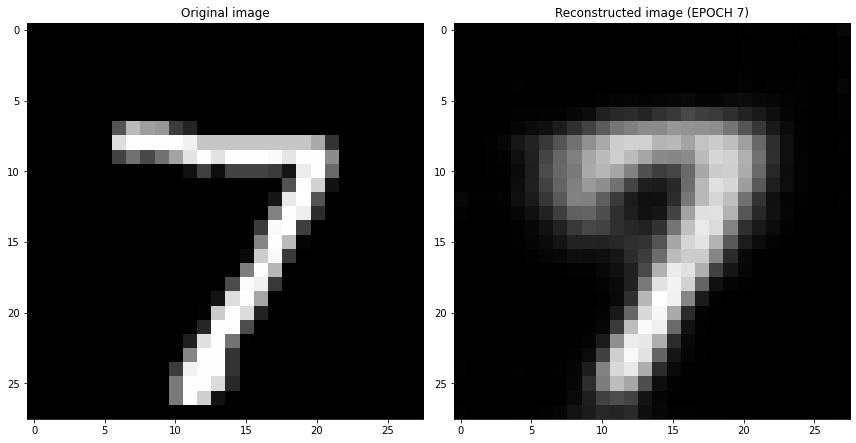

EPOCH 8/30
	 partial train loss (single batch): 0.044181
	 partial train loss (single batch): 0.043044
	 partial train loss (single batch): 0.041056
	 partial train loss (single batch): 0.041394
	 partial train loss (single batch): 0.043652
	 partial train loss (single batch): 0.042808
	 partial train loss (single batch): 0.044683
	 partial train loss (single batch): 0.041766
	 partial train loss (single batch): 0.044345
	 partial train loss (single batch): 0.044453
	 partial train loss (single batch): 0.045209
	 partial train loss (single batch): 0.044278
	 partial train loss (single batch): 0.042978
	 partial train loss (single batch): 0.042506
	 partial train loss (single batch): 0.044088
	 partial train loss (single batch): 0.041652
	 partial train loss (single batch): 0.043988
	 partial train loss (single batch): 0.044031
	 partial train loss (single batch): 0.040935
	 partial train loss (single batch): 0.042442
	 partial train loss (single batch): 0.042574
	 partial train loss (s

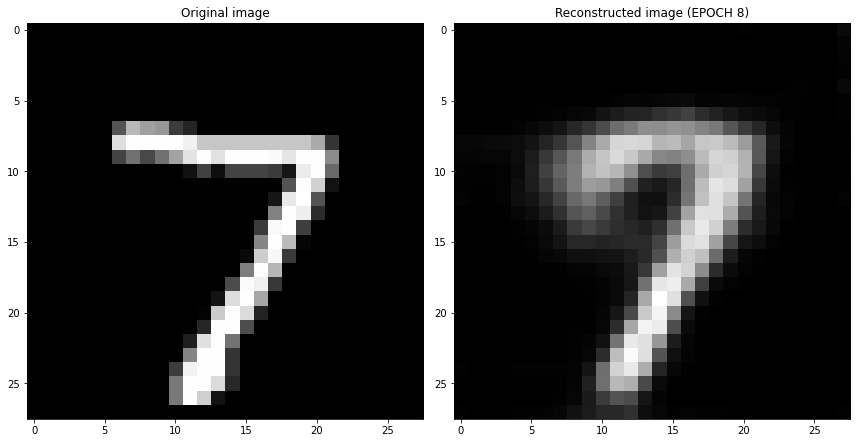

EPOCH 9/30
	 partial train loss (single batch): 0.042224
	 partial train loss (single batch): 0.040997
	 partial train loss (single batch): 0.043239
	 partial train loss (single batch): 0.043767
	 partial train loss (single batch): 0.041202
	 partial train loss (single batch): 0.044247
	 partial train loss (single batch): 0.041581
	 partial train loss (single batch): 0.041811
	 partial train loss (single batch): 0.043426
	 partial train loss (single batch): 0.041981
	 partial train loss (single batch): 0.044205
	 partial train loss (single batch): 0.043327
	 partial train loss (single batch): 0.044550
	 partial train loss (single batch): 0.041144
	 partial train loss (single batch): 0.043179
	 partial train loss (single batch): 0.041779
	 partial train loss (single batch): 0.041139
	 partial train loss (single batch): 0.041468
	 partial train loss (single batch): 0.042793
	 partial train loss (single batch): 0.043390
	 partial train loss (single batch): 0.044139
	 partial train loss (s

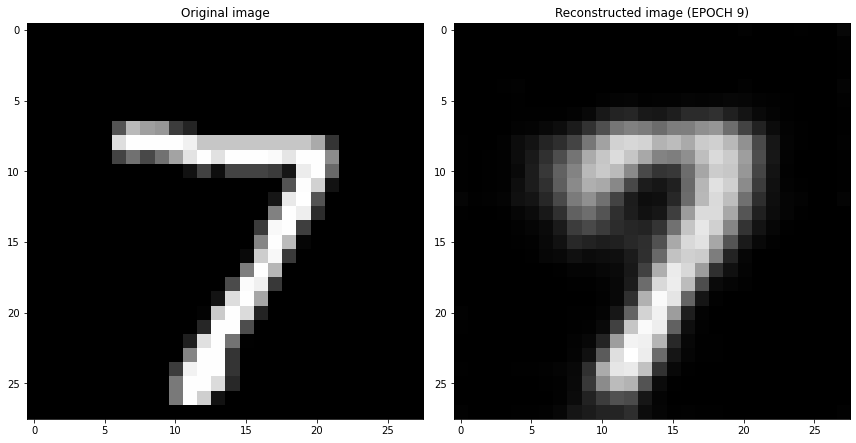

EPOCH 10/30
	 partial train loss (single batch): 0.041840
	 partial train loss (single batch): 0.043386
	 partial train loss (single batch): 0.043438
	 partial train loss (single batch): 0.041460
	 partial train loss (single batch): 0.043424
	 partial train loss (single batch): 0.040890
	 partial train loss (single batch): 0.042635
	 partial train loss (single batch): 0.042152
	 partial train loss (single batch): 0.042774
	 partial train loss (single batch): 0.042324
	 partial train loss (single batch): 0.043351
	 partial train loss (single batch): 0.041941
	 partial train loss (single batch): 0.041321
	 partial train loss (single batch): 0.041303
	 partial train loss (single batch): 0.042147
	 partial train loss (single batch): 0.042627
	 partial train loss (single batch): 0.041244
	 partial train loss (single batch): 0.041915
	 partial train loss (single batch): 0.040168
	 partial train loss (single batch): 0.042220
	 partial train loss (single batch): 0.042717
	 partial train loss (

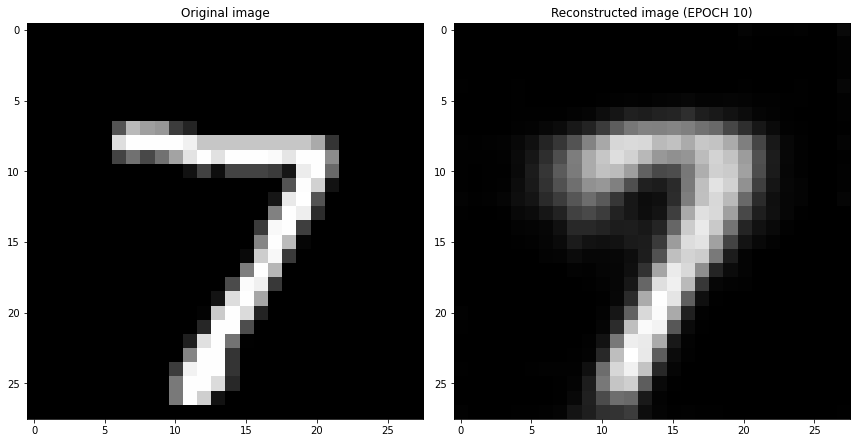

EPOCH 11/30
	 partial train loss (single batch): 0.041648
	 partial train loss (single batch): 0.043316
	 partial train loss (single batch): 0.041568
	 partial train loss (single batch): 0.042379
	 partial train loss (single batch): 0.044313
	 partial train loss (single batch): 0.040543
	 partial train loss (single batch): 0.043038
	 partial train loss (single batch): 0.041500
	 partial train loss (single batch): 0.043092
	 partial train loss (single batch): 0.043540
	 partial train loss (single batch): 0.041868
	 partial train loss (single batch): 0.042562
	 partial train loss (single batch): 0.041703
	 partial train loss (single batch): 0.040630
	 partial train loss (single batch): 0.040205
	 partial train loss (single batch): 0.042637
	 partial train loss (single batch): 0.040200
	 partial train loss (single batch): 0.040154
	 partial train loss (single batch): 0.042171
	 partial train loss (single batch): 0.042922
	 partial train loss (single batch): 0.041654
	 partial train loss (

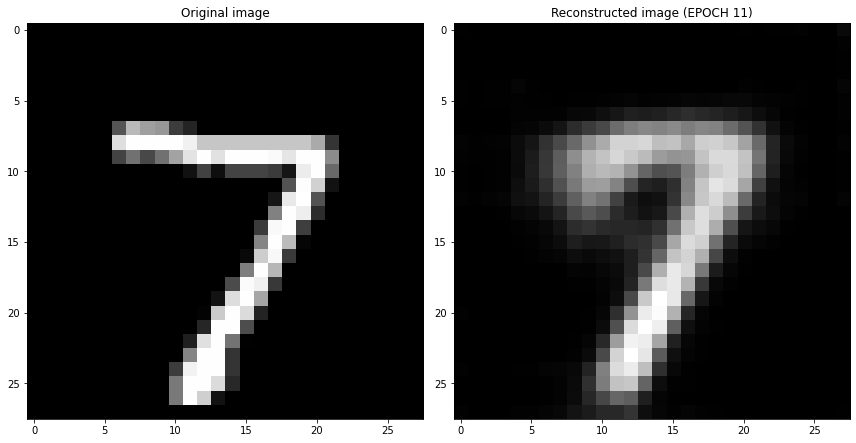

EPOCH 12/30
	 partial train loss (single batch): 0.039558
	 partial train loss (single batch): 0.040213
	 partial train loss (single batch): 0.041955
	 partial train loss (single batch): 0.043050
	 partial train loss (single batch): 0.041662
	 partial train loss (single batch): 0.040752
	 partial train loss (single batch): 0.043650
	 partial train loss (single batch): 0.042922
	 partial train loss (single batch): 0.041587
	 partial train loss (single batch): 0.040810
	 partial train loss (single batch): 0.042671
	 partial train loss (single batch): 0.041902
	 partial train loss (single batch): 0.041213
	 partial train loss (single batch): 0.042033
	 partial train loss (single batch): 0.041154
	 partial train loss (single batch): 0.043485
	 partial train loss (single batch): 0.040200
	 partial train loss (single batch): 0.040638
	 partial train loss (single batch): 0.041593
	 partial train loss (single batch): 0.041622
	 partial train loss (single batch): 0.040445
	 partial train loss (

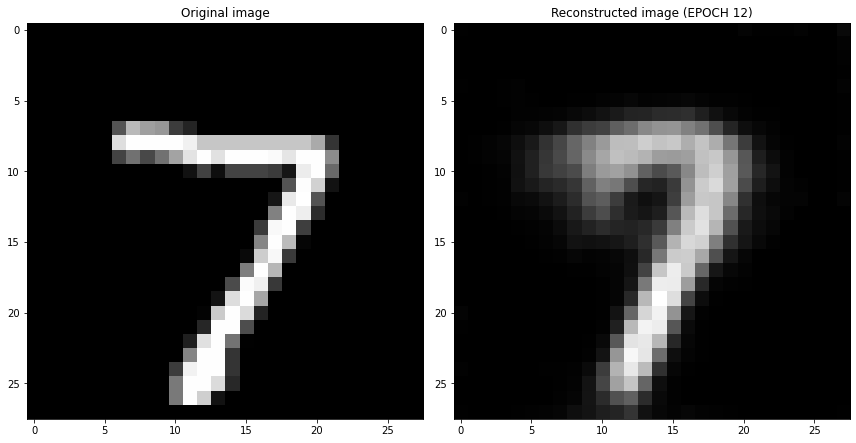

EPOCH 13/30
	 partial train loss (single batch): 0.042436
	 partial train loss (single batch): 0.040251
	 partial train loss (single batch): 0.042034
	 partial train loss (single batch): 0.041574
	 partial train loss (single batch): 0.044060
	 partial train loss (single batch): 0.040522
	 partial train loss (single batch): 0.041816
	 partial train loss (single batch): 0.041538
	 partial train loss (single batch): 0.041578
	 partial train loss (single batch): 0.040901
	 partial train loss (single batch): 0.043164
	 partial train loss (single batch): 0.041822
	 partial train loss (single batch): 0.040936
	 partial train loss (single batch): 0.039821
	 partial train loss (single batch): 0.042524
	 partial train loss (single batch): 0.041528
	 partial train loss (single batch): 0.038380
	 partial train loss (single batch): 0.041155
	 partial train loss (single batch): 0.040621
	 partial train loss (single batch): 0.039826
	 partial train loss (single batch): 0.041216
	 partial train loss (

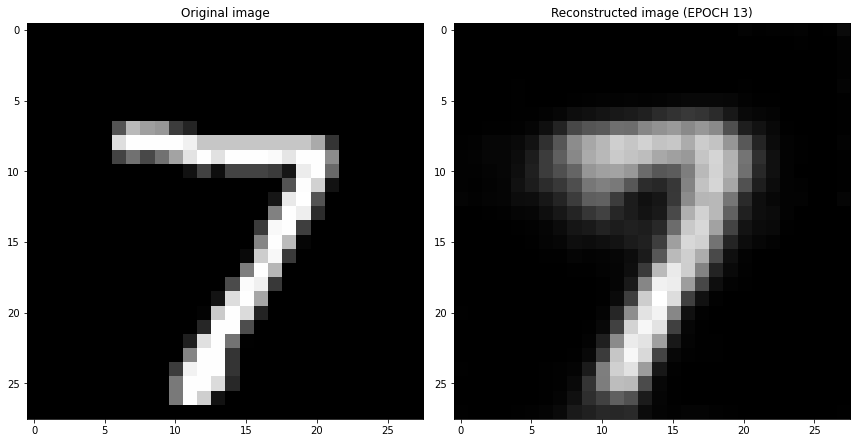

EPOCH 14/30
	 partial train loss (single batch): 0.042163
	 partial train loss (single batch): 0.041889
	 partial train loss (single batch): 0.043327
	 partial train loss (single batch): 0.040788
	 partial train loss (single batch): 0.041847
	 partial train loss (single batch): 0.040304
	 partial train loss (single batch): 0.039757
	 partial train loss (single batch): 0.039425
	 partial train loss (single batch): 0.042741
	 partial train loss (single batch): 0.041791
	 partial train loss (single batch): 0.042059
	 partial train loss (single batch): 0.041355
	 partial train loss (single batch): 0.041917
	 partial train loss (single batch): 0.040526
	 partial train loss (single batch): 0.040123
	 partial train loss (single batch): 0.040241
	 partial train loss (single batch): 0.042055
	 partial train loss (single batch): 0.042255
	 partial train loss (single batch): 0.041750
	 partial train loss (single batch): 0.040760
	 partial train loss (single batch): 0.039384
	 partial train loss (

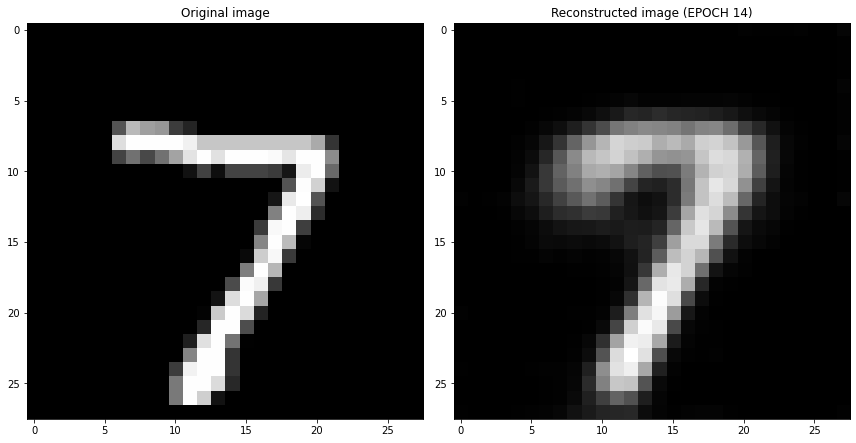

EPOCH 15/30
	 partial train loss (single batch): 0.041308
	 partial train loss (single batch): 0.041830
	 partial train loss (single batch): 0.041274
	 partial train loss (single batch): 0.040623
	 partial train loss (single batch): 0.041564
	 partial train loss (single batch): 0.041473
	 partial train loss (single batch): 0.040207
	 partial train loss (single batch): 0.041174
	 partial train loss (single batch): 0.042016
	 partial train loss (single batch): 0.042029
	 partial train loss (single batch): 0.040970
	 partial train loss (single batch): 0.040826
	 partial train loss (single batch): 0.041875
	 partial train loss (single batch): 0.042117
	 partial train loss (single batch): 0.040652
	 partial train loss (single batch): 0.040933
	 partial train loss (single batch): 0.040666
	 partial train loss (single batch): 0.044198
	 partial train loss (single batch): 0.038033
	 partial train loss (single batch): 0.042280
	 partial train loss (single batch): 0.040361
	 partial train loss (

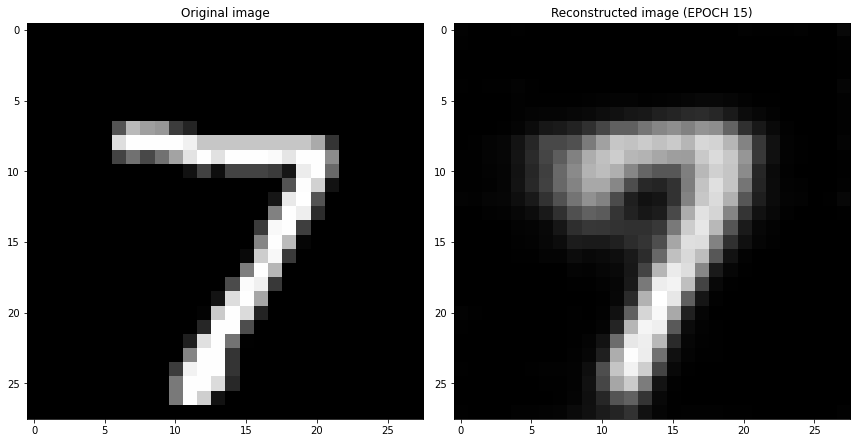

EPOCH 16/30
	 partial train loss (single batch): 0.038886
	 partial train loss (single batch): 0.040265
	 partial train loss (single batch): 0.039831
	 partial train loss (single batch): 0.040842
	 partial train loss (single batch): 0.040509
	 partial train loss (single batch): 0.042006
	 partial train loss (single batch): 0.043493
	 partial train loss (single batch): 0.041903
	 partial train loss (single batch): 0.041610
	 partial train loss (single batch): 0.040431
	 partial train loss (single batch): 0.041257
	 partial train loss (single batch): 0.038976
	 partial train loss (single batch): 0.040027
	 partial train loss (single batch): 0.039975
	 partial train loss (single batch): 0.040310
	 partial train loss (single batch): 0.040493
	 partial train loss (single batch): 0.042800
	 partial train loss (single batch): 0.041979
	 partial train loss (single batch): 0.038679
	 partial train loss (single batch): 0.040108
	 partial train loss (single batch): 0.041660
	 partial train loss (

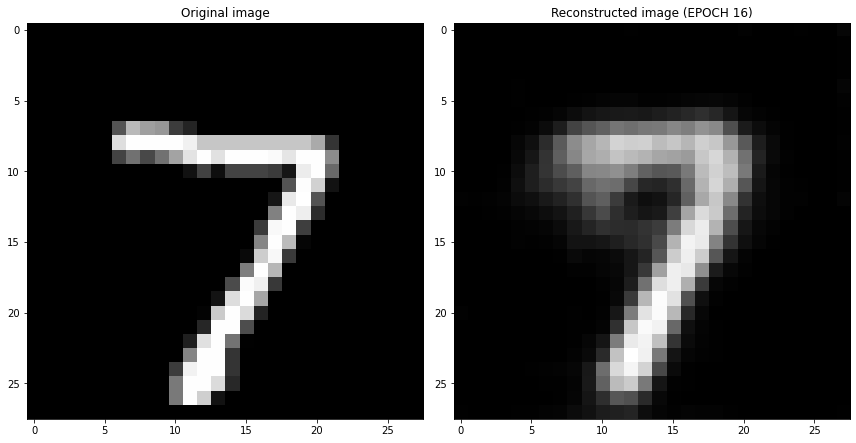

EPOCH 17/30
	 partial train loss (single batch): 0.039728
	 partial train loss (single batch): 0.041452
	 partial train loss (single batch): 0.039538
	 partial train loss (single batch): 0.040998
	 partial train loss (single batch): 0.042629
	 partial train loss (single batch): 0.041113
	 partial train loss (single batch): 0.042112
	 partial train loss (single batch): 0.039608
	 partial train loss (single batch): 0.041636
	 partial train loss (single batch): 0.042174
	 partial train loss (single batch): 0.043805
	 partial train loss (single batch): 0.041525
	 partial train loss (single batch): 0.041604
	 partial train loss (single batch): 0.041047
	 partial train loss (single batch): 0.040866
	 partial train loss (single batch): 0.041709
	 partial train loss (single batch): 0.039119
	 partial train loss (single batch): 0.039168
	 partial train loss (single batch): 0.040869
	 partial train loss (single batch): 0.042321
	 partial train loss (single batch): 0.041071
	 partial train loss (

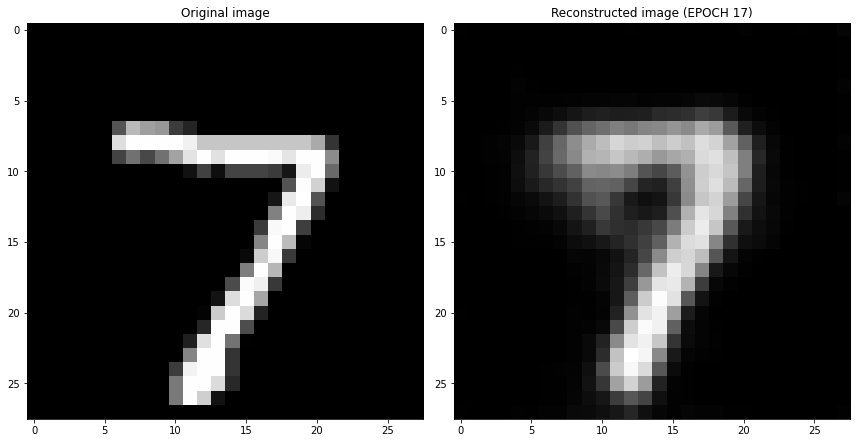

EPOCH 18/30
	 partial train loss (single batch): 0.039838
	 partial train loss (single batch): 0.041350
	 partial train loss (single batch): 0.040312
	 partial train loss (single batch): 0.040004
	 partial train loss (single batch): 0.041135
	 partial train loss (single batch): 0.041892
	 partial train loss (single batch): 0.041878
	 partial train loss (single batch): 0.041617
	 partial train loss (single batch): 0.040814
	 partial train loss (single batch): 0.041683
	 partial train loss (single batch): 0.041136
	 partial train loss (single batch): 0.041738
	 partial train loss (single batch): 0.040223
	 partial train loss (single batch): 0.041491
	 partial train loss (single batch): 0.039325
	 partial train loss (single batch): 0.041595
	 partial train loss (single batch): 0.040739
	 partial train loss (single batch): 0.039603
	 partial train loss (single batch): 0.039729
	 partial train loss (single batch): 0.041103
	 partial train loss (single batch): 0.040897
	 partial train loss (

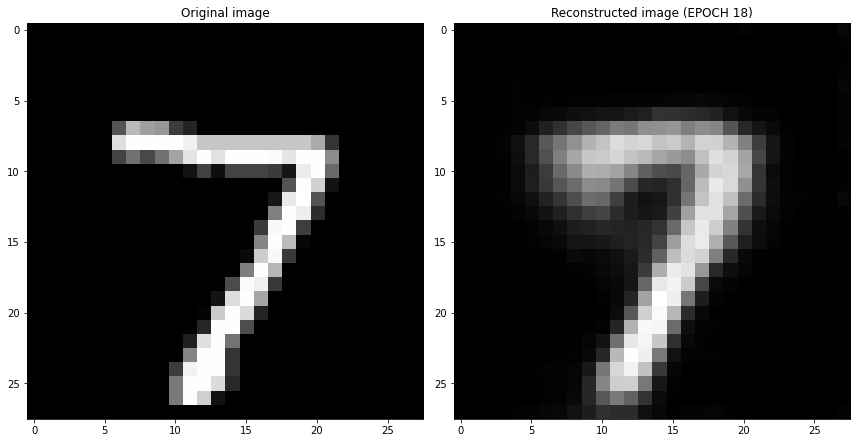

EPOCH 19/30
	 partial train loss (single batch): 0.041313
	 partial train loss (single batch): 0.039994
	 partial train loss (single batch): 0.039635
	 partial train loss (single batch): 0.041337
	 partial train loss (single batch): 0.042926
	 partial train loss (single batch): 0.040293
	 partial train loss (single batch): 0.041777
	 partial train loss (single batch): 0.040419
	 partial train loss (single batch): 0.039934
	 partial train loss (single batch): 0.042002
	 partial train loss (single batch): 0.041107
	 partial train loss (single batch): 0.040980
	 partial train loss (single batch): 0.040806
	 partial train loss (single batch): 0.040022
	 partial train loss (single batch): 0.041305
	 partial train loss (single batch): 0.041762
	 partial train loss (single batch): 0.040703
	 partial train loss (single batch): 0.042611
	 partial train loss (single batch): 0.040081
	 partial train loss (single batch): 0.040918
	 partial train loss (single batch): 0.041441
	 partial train loss (

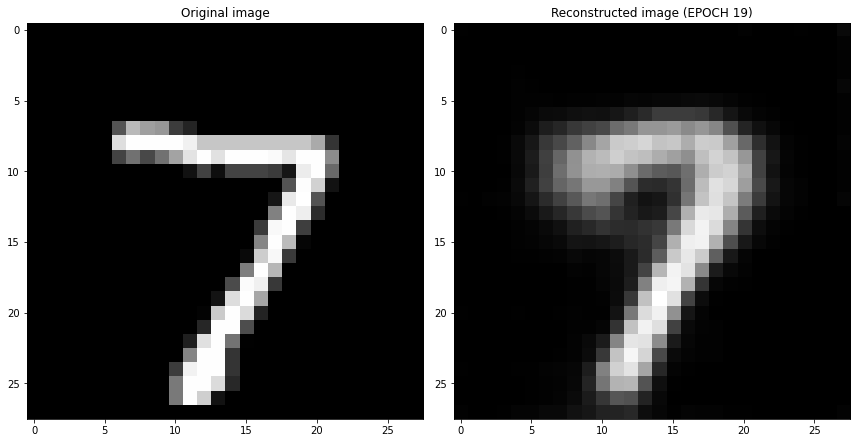

EPOCH 20/30
	 partial train loss (single batch): 0.040606
	 partial train loss (single batch): 0.039606
	 partial train loss (single batch): 0.040998
	 partial train loss (single batch): 0.039384
	 partial train loss (single batch): 0.039344
	 partial train loss (single batch): 0.040327
	 partial train loss (single batch): 0.040862
	 partial train loss (single batch): 0.039755
	 partial train loss (single batch): 0.039996
	 partial train loss (single batch): 0.040387
	 partial train loss (single batch): 0.041649
	 partial train loss (single batch): 0.039420
	 partial train loss (single batch): 0.040824
	 partial train loss (single batch): 0.039583
	 partial train loss (single batch): 0.041274
	 partial train loss (single batch): 0.040560
	 partial train loss (single batch): 0.039242
	 partial train loss (single batch): 0.040399
	 partial train loss (single batch): 0.039678
	 partial train loss (single batch): 0.043291
	 partial train loss (single batch): 0.040397
	 partial train loss (

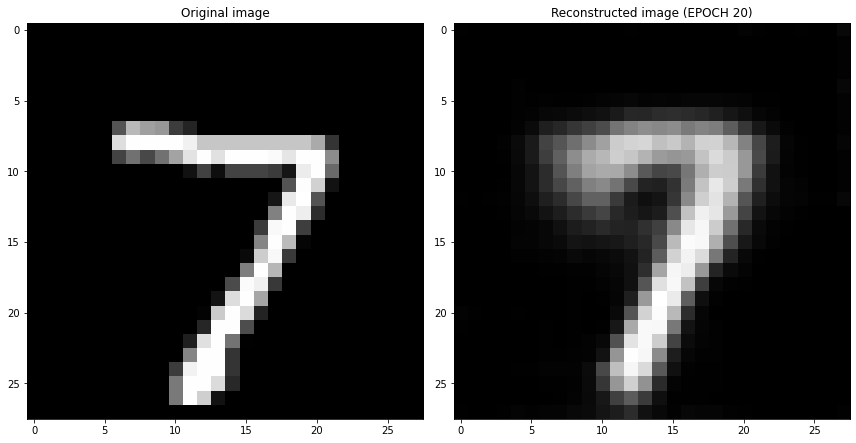

EPOCH 21/30
	 partial train loss (single batch): 0.039242
	 partial train loss (single batch): 0.041681
	 partial train loss (single batch): 0.039843
	 partial train loss (single batch): 0.041353
	 partial train loss (single batch): 0.040913
	 partial train loss (single batch): 0.039688
	 partial train loss (single batch): 0.040323
	 partial train loss (single batch): 0.040979
	 partial train loss (single batch): 0.041206
	 partial train loss (single batch): 0.039659
	 partial train loss (single batch): 0.040194
	 partial train loss (single batch): 0.043083
	 partial train loss (single batch): 0.039179
	 partial train loss (single batch): 0.039059
	 partial train loss (single batch): 0.041210
	 partial train loss (single batch): 0.042086
	 partial train loss (single batch): 0.040583
	 partial train loss (single batch): 0.040277
	 partial train loss (single batch): 0.042473
	 partial train loss (single batch): 0.042035
	 partial train loss (single batch): 0.040043
	 partial train loss (

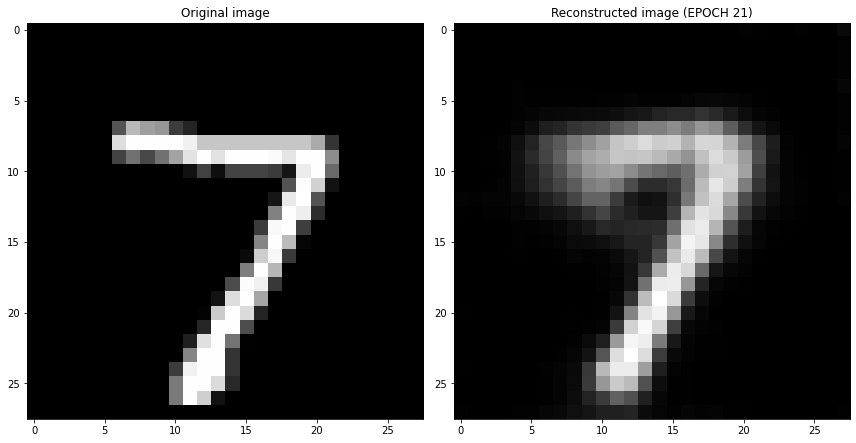

EPOCH 22/30
	 partial train loss (single batch): 0.039604
	 partial train loss (single batch): 0.039553
	 partial train loss (single batch): 0.042736
	 partial train loss (single batch): 0.040730
	 partial train loss (single batch): 0.039861
	 partial train loss (single batch): 0.042265
	 partial train loss (single batch): 0.042339
	 partial train loss (single batch): 0.041015
	 partial train loss (single batch): 0.041081
	 partial train loss (single batch): 0.040187
	 partial train loss (single batch): 0.040210
	 partial train loss (single batch): 0.040337
	 partial train loss (single batch): 0.040296
	 partial train loss (single batch): 0.041589
	 partial train loss (single batch): 0.040435
	 partial train loss (single batch): 0.039928
	 partial train loss (single batch): 0.041237
	 partial train loss (single batch): 0.040771
	 partial train loss (single batch): 0.040157
	 partial train loss (single batch): 0.040050
	 partial train loss (single batch): 0.040144
	 partial train loss (

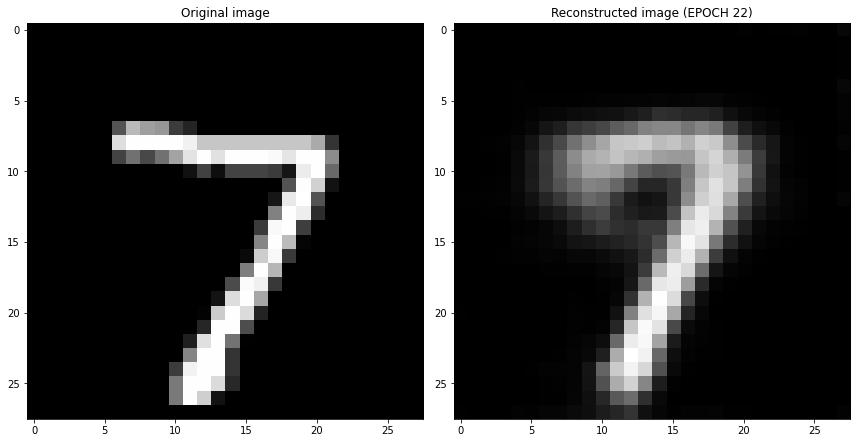

EPOCH 23/30
	 partial train loss (single batch): 0.042334
	 partial train loss (single batch): 0.041270
	 partial train loss (single batch): 0.041167
	 partial train loss (single batch): 0.040419
	 partial train loss (single batch): 0.043287
	 partial train loss (single batch): 0.040664
	 partial train loss (single batch): 0.039690
	 partial train loss (single batch): 0.038990
	 partial train loss (single batch): 0.041293
	 partial train loss (single batch): 0.039173
	 partial train loss (single batch): 0.041773
	 partial train loss (single batch): 0.040341
	 partial train loss (single batch): 0.039769
	 partial train loss (single batch): 0.040167
	 partial train loss (single batch): 0.042774
	 partial train loss (single batch): 0.039681
	 partial train loss (single batch): 0.037979
	 partial train loss (single batch): 0.040302
	 partial train loss (single batch): 0.039337
	 partial train loss (single batch): 0.041903
	 partial train loss (single batch): 0.038905
	 partial train loss (

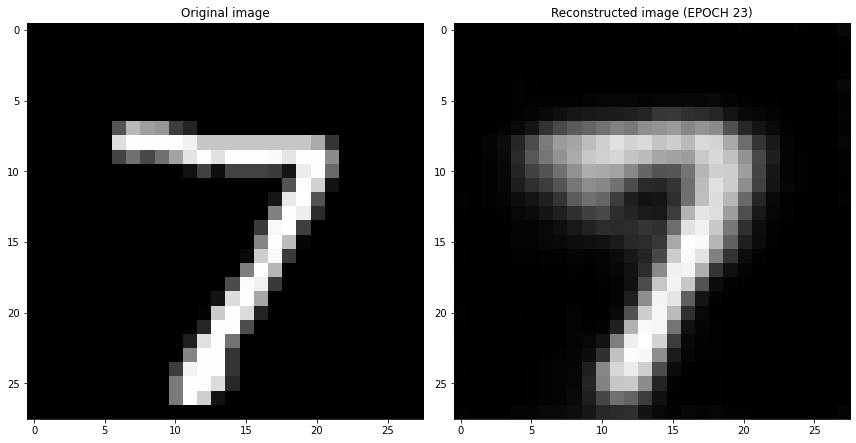

EPOCH 24/30
	 partial train loss (single batch): 0.037538
	 partial train loss (single batch): 0.041465
	 partial train loss (single batch): 0.041510
	 partial train loss (single batch): 0.039416
	 partial train loss (single batch): 0.040730
	 partial train loss (single batch): 0.039527
	 partial train loss (single batch): 0.040939
	 partial train loss (single batch): 0.040379
	 partial train loss (single batch): 0.040216
	 partial train loss (single batch): 0.040665
	 partial train loss (single batch): 0.038110
	 partial train loss (single batch): 0.041526
	 partial train loss (single batch): 0.040641
	 partial train loss (single batch): 0.040237
	 partial train loss (single batch): 0.042237
	 partial train loss (single batch): 0.039166
	 partial train loss (single batch): 0.042039
	 partial train loss (single batch): 0.039412
	 partial train loss (single batch): 0.039940
	 partial train loss (single batch): 0.041895
	 partial train loss (single batch): 0.040092
	 partial train loss (

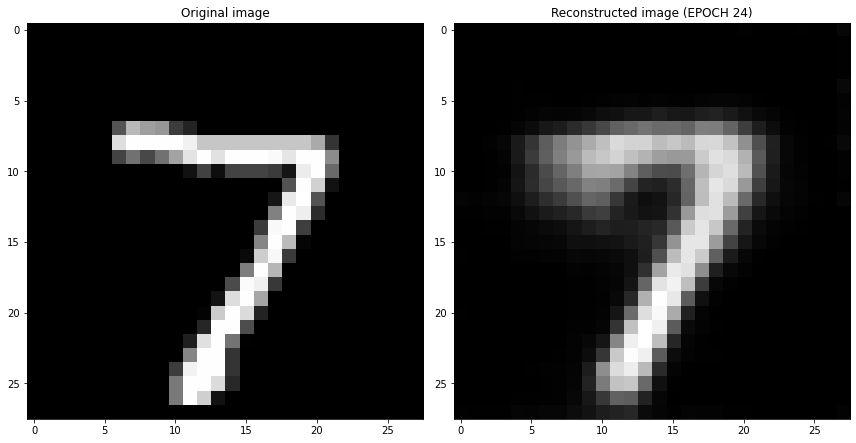

EPOCH 25/30
	 partial train loss (single batch): 0.040313
	 partial train loss (single batch): 0.039922
	 partial train loss (single batch): 0.041112
	 partial train loss (single batch): 0.043583
	 partial train loss (single batch): 0.039941
	 partial train loss (single batch): 0.041183
	 partial train loss (single batch): 0.039010
	 partial train loss (single batch): 0.042128
	 partial train loss (single batch): 0.039197
	 partial train loss (single batch): 0.038058
	 partial train loss (single batch): 0.039161
	 partial train loss (single batch): 0.039927
	 partial train loss (single batch): 0.041382
	 partial train loss (single batch): 0.040574
	 partial train loss (single batch): 0.040129
	 partial train loss (single batch): 0.042242
	 partial train loss (single batch): 0.039679
	 partial train loss (single batch): 0.038495
	 partial train loss (single batch): 0.039160
	 partial train loss (single batch): 0.039309
	 partial train loss (single batch): 0.042371
	 partial train loss (

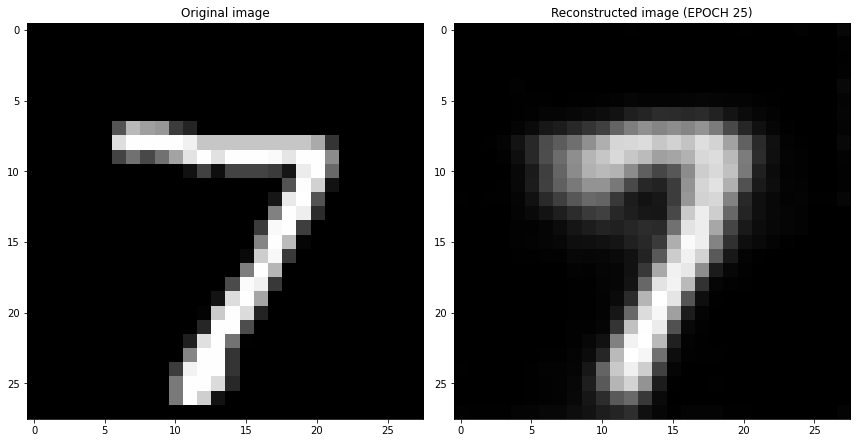

EPOCH 26/30
	 partial train loss (single batch): 0.039781
	 partial train loss (single batch): 0.040758
	 partial train loss (single batch): 0.039946
	 partial train loss (single batch): 0.040404
	 partial train loss (single batch): 0.040914
	 partial train loss (single batch): 0.039602
	 partial train loss (single batch): 0.039211
	 partial train loss (single batch): 0.040083
	 partial train loss (single batch): 0.039917
	 partial train loss (single batch): 0.040682
	 partial train loss (single batch): 0.040872
	 partial train loss (single batch): 0.041443
	 partial train loss (single batch): 0.041838
	 partial train loss (single batch): 0.040131
	 partial train loss (single batch): 0.039532
	 partial train loss (single batch): 0.039819
	 partial train loss (single batch): 0.040076
	 partial train loss (single batch): 0.039386
	 partial train loss (single batch): 0.038465
	 partial train loss (single batch): 0.042286
	 partial train loss (single batch): 0.040864
	 partial train loss (

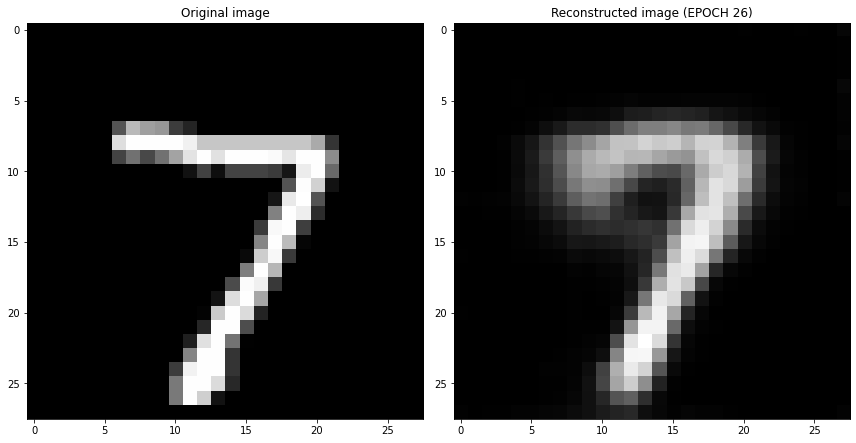

EPOCH 27/30
	 partial train loss (single batch): 0.040393
	 partial train loss (single batch): 0.040910
	 partial train loss (single batch): 0.039453
	 partial train loss (single batch): 0.042111
	 partial train loss (single batch): 0.040716
	 partial train loss (single batch): 0.038757
	 partial train loss (single batch): 0.041341
	 partial train loss (single batch): 0.041926
	 partial train loss (single batch): 0.041320
	 partial train loss (single batch): 0.042627
	 partial train loss (single batch): 0.040311
	 partial train loss (single batch): 0.041573
	 partial train loss (single batch): 0.042743
	 partial train loss (single batch): 0.040980
	 partial train loss (single batch): 0.041899
	 partial train loss (single batch): 0.042893
	 partial train loss (single batch): 0.038750
	 partial train loss (single batch): 0.040461
	 partial train loss (single batch): 0.039837
	 partial train loss (single batch): 0.041313
	 partial train loss (single batch): 0.041101
	 partial train loss (

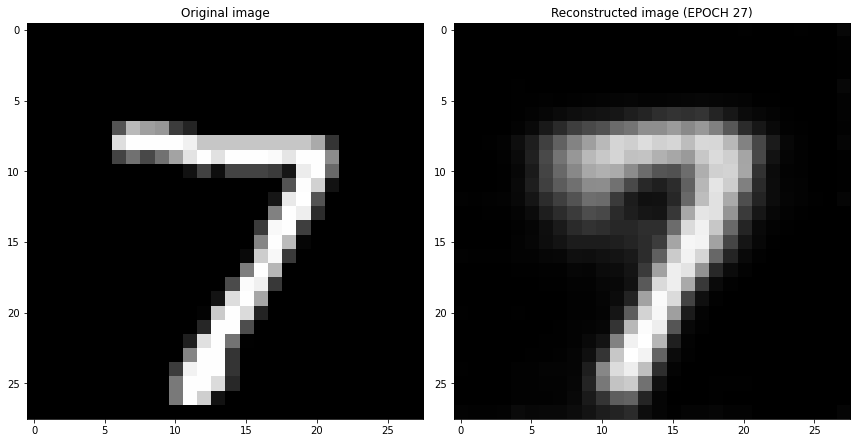

EPOCH 28/30
	 partial train loss (single batch): 0.039544
	 partial train loss (single batch): 0.039166
	 partial train loss (single batch): 0.039870
	 partial train loss (single batch): 0.039670
	 partial train loss (single batch): 0.039680
	 partial train loss (single batch): 0.040935
	 partial train loss (single batch): 0.041182
	 partial train loss (single batch): 0.039910
	 partial train loss (single batch): 0.041353
	 partial train loss (single batch): 0.039184
	 partial train loss (single batch): 0.037987
	 partial train loss (single batch): 0.041259
	 partial train loss (single batch): 0.040016
	 partial train loss (single batch): 0.039946
	 partial train loss (single batch): 0.039913
	 partial train loss (single batch): 0.039444
	 partial train loss (single batch): 0.037075
	 partial train loss (single batch): 0.039743
	 partial train loss (single batch): 0.041428
	 partial train loss (single batch): 0.040176
	 partial train loss (single batch): 0.039754
	 partial train loss (

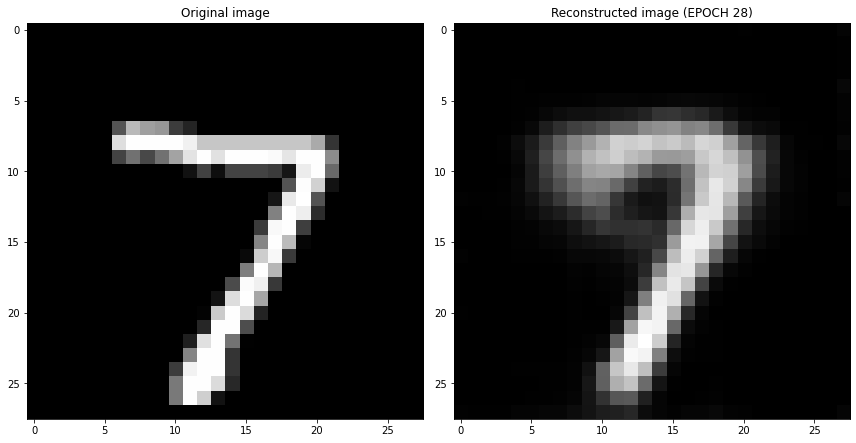

EPOCH 29/30
	 partial train loss (single batch): 0.039275
	 partial train loss (single batch): 0.040090
	 partial train loss (single batch): 0.040332
	 partial train loss (single batch): 0.039760
	 partial train loss (single batch): 0.040866
	 partial train loss (single batch): 0.040706
	 partial train loss (single batch): 0.040602
	 partial train loss (single batch): 0.041561
	 partial train loss (single batch): 0.041164
	 partial train loss (single batch): 0.042434
	 partial train loss (single batch): 0.040499
	 partial train loss (single batch): 0.040888
	 partial train loss (single batch): 0.039723
	 partial train loss (single batch): 0.042883
	 partial train loss (single batch): 0.041358
	 partial train loss (single batch): 0.040163
	 partial train loss (single batch): 0.040214
	 partial train loss (single batch): 0.039971
	 partial train loss (single batch): 0.039490
	 partial train loss (single batch): 0.041997
	 partial train loss (single batch): 0.039074
	 partial train loss (

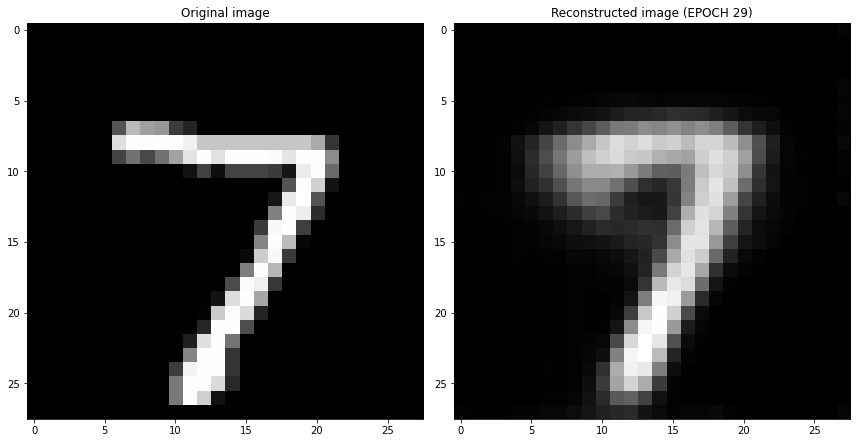

EPOCH 30/30
	 partial train loss (single batch): 0.039234
	 partial train loss (single batch): 0.040234
	 partial train loss (single batch): 0.042051
	 partial train loss (single batch): 0.042306
	 partial train loss (single batch): 0.040520
	 partial train loss (single batch): 0.039130
	 partial train loss (single batch): 0.039323
	 partial train loss (single batch): 0.041077
	 partial train loss (single batch): 0.040344
	 partial train loss (single batch): 0.041260
	 partial train loss (single batch): 0.042499
	 partial train loss (single batch): 0.038180
	 partial train loss (single batch): 0.040889
	 partial train loss (single batch): 0.041733
	 partial train loss (single batch): 0.038160
	 partial train loss (single batch): 0.040447
	 partial train loss (single batch): 0.038514
	 partial train loss (single batch): 0.040433
	 partial train loss (single batch): 0.039698
	 partial train loss (single batch): 0.042018
	 partial train loss (single batch): 0.040440
	 partial train loss (

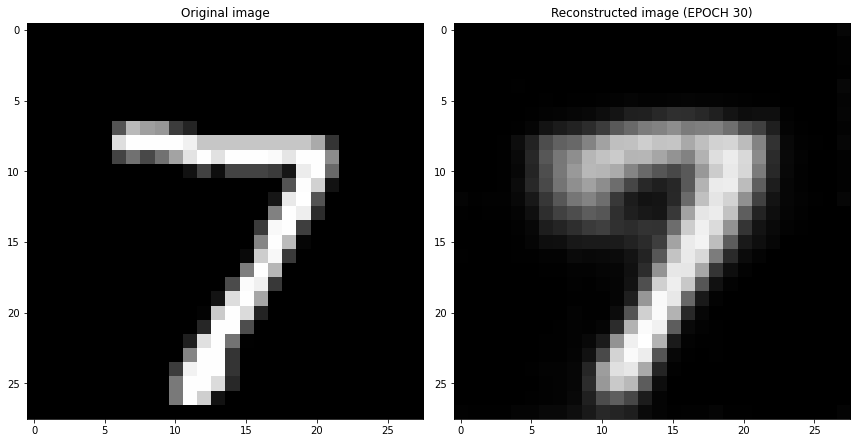

Cross validation fold number= 1/6
EPOCH 1/30
	 partial train loss (single batch): 0.258755
	 partial train loss (single batch): 0.164543
	 partial train loss (single batch): 0.111262
	 partial train loss (single batch): 0.108775
	 partial train loss (single batch): 0.110043
	 partial train loss (single batch): 0.128323
	 partial train loss (single batch): 0.141845
	 partial train loss (single batch): 0.181700
	 partial train loss (single batch): 0.198740
	 partial train loss (single batch): 0.223347
	 partial train loss (single batch): 0.222133
	 partial train loss (single batch): 0.219746
	 partial train loss (single batch): 0.222236
	 partial train loss (single batch): 0.220870
	 partial train loss (single batch): 0.223443
	 partial train loss (single batch): 0.222751
	 partial train loss (single batch): 0.223075
	 partial train loss (single batch): 0.221085
	 partial train loss (single batch): 0.223843
	 partial train loss (single batch): 0.221105
	 partial train loss (single batch)

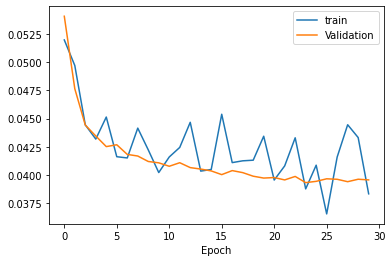

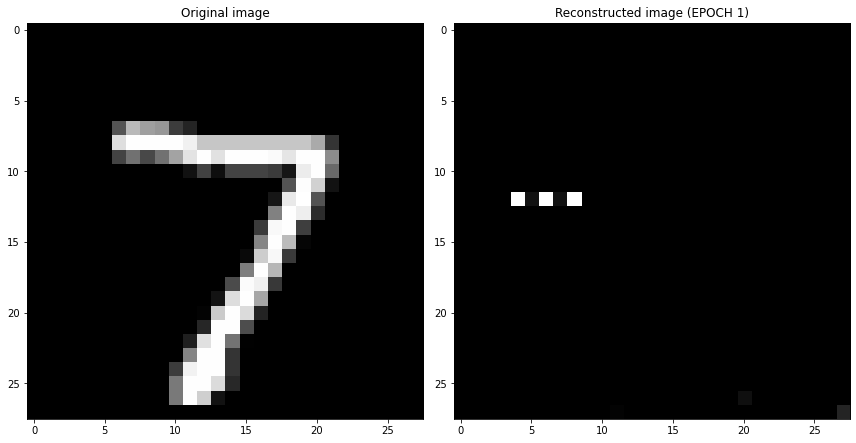

EPOCH 2/30
	 partial train loss (single batch): 0.107921
	 partial train loss (single batch): 0.110398
	 partial train loss (single batch): 0.112905
	 partial train loss (single batch): 0.110648
	 partial train loss (single batch): 0.109650
	 partial train loss (single batch): 0.110378
	 partial train loss (single batch): 0.113687
	 partial train loss (single batch): 0.114519
	 partial train loss (single batch): 0.116832
	 partial train loss (single batch): 0.113507
	 partial train loss (single batch): 0.112284
	 partial train loss (single batch): 0.111530
	 partial train loss (single batch): 0.109185
	 partial train loss (single batch): 0.111556
	 partial train loss (single batch): 0.106960
	 partial train loss (single batch): 0.112474
	 partial train loss (single batch): 0.112944
	 partial train loss (single batch): 0.113065
	 partial train loss (single batch): 0.107827
	 partial train loss (single batch): 0.112885
	 partial train loss (single batch): 0.112169
	 partial train loss (s

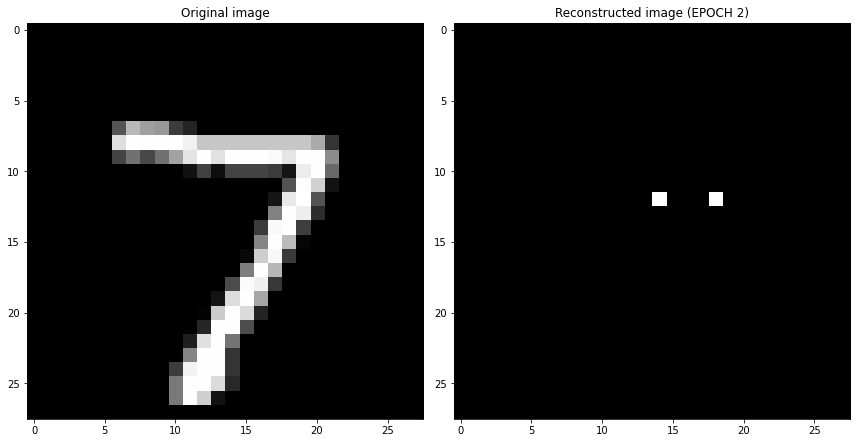

EPOCH 3/30
	 partial train loss (single batch): 0.114002
	 partial train loss (single batch): 0.110433
	 partial train loss (single batch): 0.112191
	 partial train loss (single batch): 0.115621
	 partial train loss (single batch): 0.111028
	 partial train loss (single batch): 0.104565
	 partial train loss (single batch): 0.108474
	 partial train loss (single batch): 0.112530
	 partial train loss (single batch): 0.110465
	 partial train loss (single batch): 0.111925
	 partial train loss (single batch): 0.112700
	 partial train loss (single batch): 0.109894
	 partial train loss (single batch): 0.112591
	 partial train loss (single batch): 0.108457
	 partial train loss (single batch): 0.113473
	 partial train loss (single batch): 0.112674
	 partial train loss (single batch): 0.111723
	 partial train loss (single batch): 0.116074
	 partial train loss (single batch): 0.113839
	 partial train loss (single batch): 0.108449
	 partial train loss (single batch): 0.109771
	 partial train loss (s

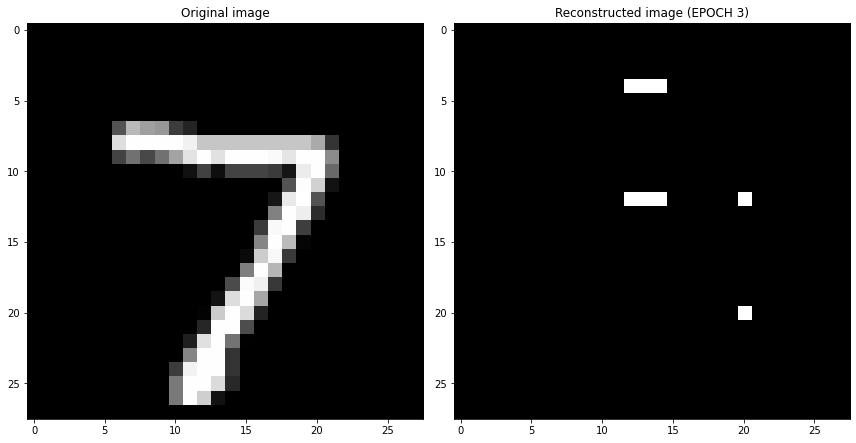

EPOCH 4/30
	 partial train loss (single batch): 0.115206
	 partial train loss (single batch): 0.108300
	 partial train loss (single batch): 0.106245
	 partial train loss (single batch): 0.111818
	 partial train loss (single batch): 0.111876
	 partial train loss (single batch): 0.113180
	 partial train loss (single batch): 0.111079
	 partial train loss (single batch): 0.109346
	 partial train loss (single batch): 0.111753
	 partial train loss (single batch): 0.111101
	 partial train loss (single batch): 0.108903
	 partial train loss (single batch): 0.110050
	 partial train loss (single batch): 0.108684
	 partial train loss (single batch): 0.109288
	 partial train loss (single batch): 0.110428
	 partial train loss (single batch): 0.112703
	 partial train loss (single batch): 0.108188
	 partial train loss (single batch): 0.113614
	 partial train loss (single batch): 0.114213
	 partial train loss (single batch): 0.111096
	 partial train loss (single batch): 0.115773
	 partial train loss (s

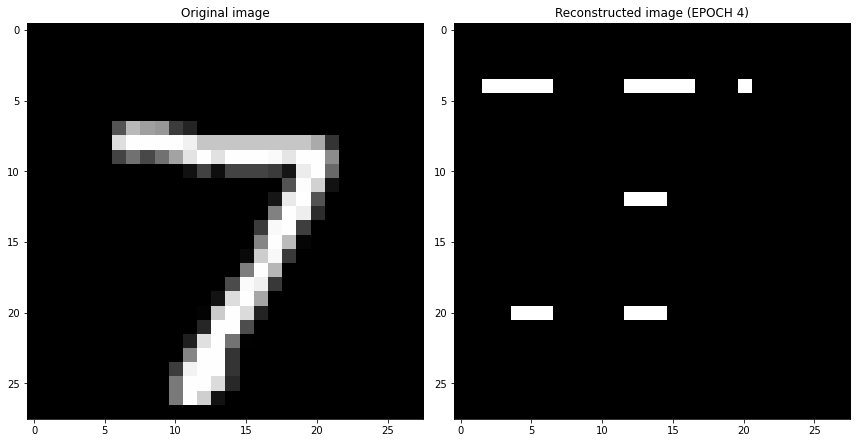

EPOCH 5/30
	 partial train loss (single batch): 0.109641
	 partial train loss (single batch): 0.111023
	 partial train loss (single batch): 0.112117
	 partial train loss (single batch): 0.111303
	 partial train loss (single batch): 0.111885
	 partial train loss (single batch): 0.103102
	 partial train loss (single batch): 0.112220
	 partial train loss (single batch): 0.108343
	 partial train loss (single batch): 0.111246
	 partial train loss (single batch): 0.111660
	 partial train loss (single batch): 0.112333
	 partial train loss (single batch): 0.107762
	 partial train loss (single batch): 0.105623
	 partial train loss (single batch): 0.108498
	 partial train loss (single batch): 0.108326
	 partial train loss (single batch): 0.112030
	 partial train loss (single batch): 0.113686
	 partial train loss (single batch): 0.108352
	 partial train loss (single batch): 0.106119
	 partial train loss (single batch): 0.106049
	 partial train loss (single batch): 0.110938
	 partial train loss (s

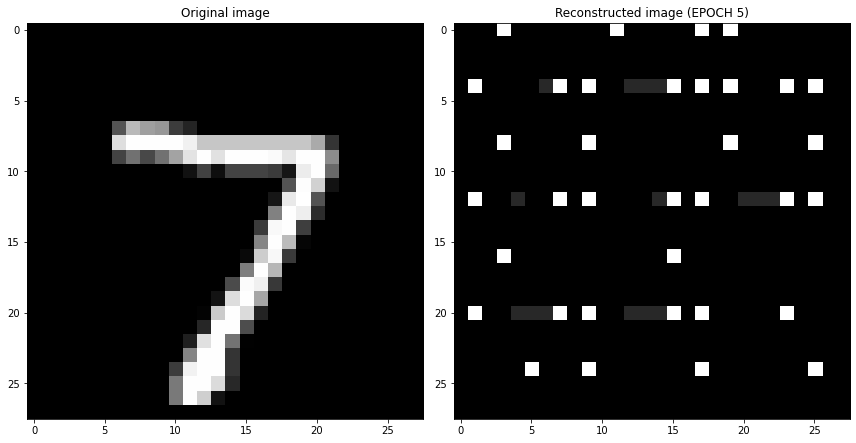

EPOCH 6/30
	 partial train loss (single batch): 0.143157
	 partial train loss (single batch): 0.141381
	 partial train loss (single batch): 0.141517
	 partial train loss (single batch): 0.144891
	 partial train loss (single batch): 0.138350
	 partial train loss (single batch): 0.135156
	 partial train loss (single batch): 0.129078
	 partial train loss (single batch): 0.124244
	 partial train loss (single batch): 0.126781
	 partial train loss (single batch): 0.129041
	 partial train loss (single batch): 0.125756
	 partial train loss (single batch): 0.126493
	 partial train loss (single batch): 0.122583
	 partial train loss (single batch): 0.121028
	 partial train loss (single batch): 0.124279
	 partial train loss (single batch): 0.127897
	 partial train loss (single batch): 0.123038
	 partial train loss (single batch): 0.127813
	 partial train loss (single batch): 0.118734
	 partial train loss (single batch): 0.120267
	 partial train loss (single batch): 0.123998
	 partial train loss (s

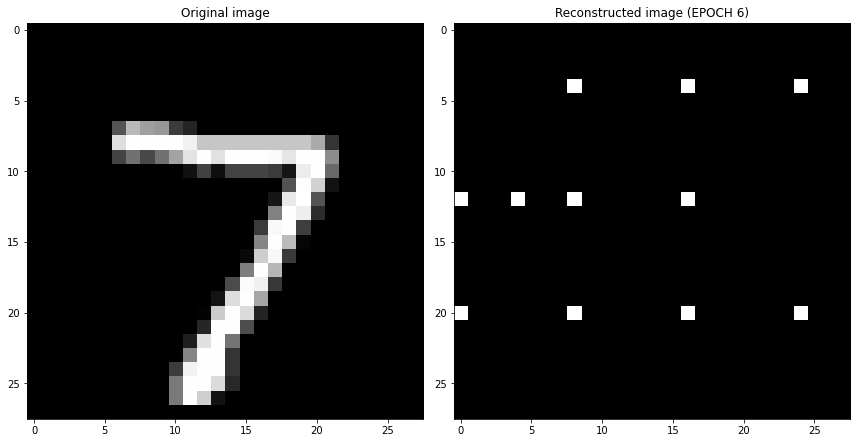

EPOCH 7/30
	 partial train loss (single batch): 0.114406
	 partial train loss (single batch): 0.109346
	 partial train loss (single batch): 0.112046
	 partial train loss (single batch): 0.117218
	 partial train loss (single batch): 0.108478
	 partial train loss (single batch): 0.109994
	 partial train loss (single batch): 0.113941
	 partial train loss (single batch): 0.108289
	 partial train loss (single batch): 0.110430
	 partial train loss (single batch): 0.108921
	 partial train loss (single batch): 0.107099
	 partial train loss (single batch): 0.111877
	 partial train loss (single batch): 0.109140
	 partial train loss (single batch): 0.113487
	 partial train loss (single batch): 0.113859
	 partial train loss (single batch): 0.111779
	 partial train loss (single batch): 0.113234
	 partial train loss (single batch): 0.113730
	 partial train loss (single batch): 0.109848
	 partial train loss (single batch): 0.112286
	 partial train loss (single batch): 0.111701
	 partial train loss (s

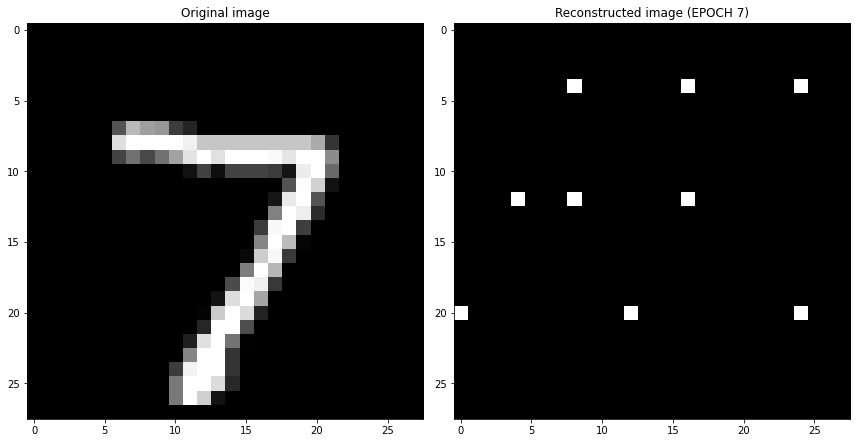

EPOCH 8/30
	 partial train loss (single batch): 0.113691
	 partial train loss (single batch): 0.115203
	 partial train loss (single batch): 0.109404
	 partial train loss (single batch): 0.113245
	 partial train loss (single batch): 0.112386
	 partial train loss (single batch): 0.110089
	 partial train loss (single batch): 0.112094
	 partial train loss (single batch): 0.114679
	 partial train loss (single batch): 0.115341
	 partial train loss (single batch): 0.110801
	 partial train loss (single batch): 0.108027
	 partial train loss (single batch): 0.112394
	 partial train loss (single batch): 0.108585
	 partial train loss (single batch): 0.111489
	 partial train loss (single batch): 0.114511
	 partial train loss (single batch): 0.112159
	 partial train loss (single batch): 0.110048
	 partial train loss (single batch): 0.119437
	 partial train loss (single batch): 0.108271
	 partial train loss (single batch): 0.110061
	 partial train loss (single batch): 0.111933
	 partial train loss (s

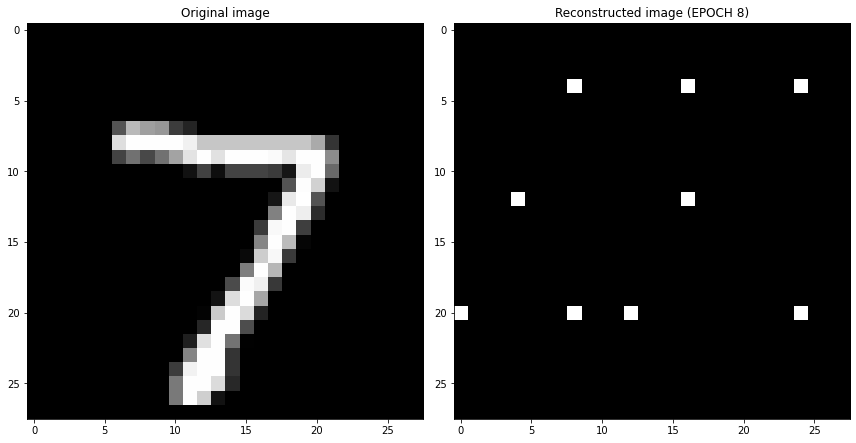

EPOCH 9/30
	 partial train loss (single batch): 0.108482
	 partial train loss (single batch): 0.108957
	 partial train loss (single batch): 0.111335
	 partial train loss (single batch): 0.112479
	 partial train loss (single batch): 0.113604
	 partial train loss (single batch): 0.112325
	 partial train loss (single batch): 0.109474
	 partial train loss (single batch): 0.113035
	 partial train loss (single batch): 0.111506
	 partial train loss (single batch): 0.111910
	 partial train loss (single batch): 0.113212
	 partial train loss (single batch): 0.110259
	 partial train loss (single batch): 0.111142
	 partial train loss (single batch): 0.110460
	 partial train loss (single batch): 0.114191
	 partial train loss (single batch): 0.110440
	 partial train loss (single batch): 0.109907
	 partial train loss (single batch): 0.117973
	 partial train loss (single batch): 0.113311
	 partial train loss (single batch): 0.114423
	 partial train loss (single batch): 0.112152
	 partial train loss (s

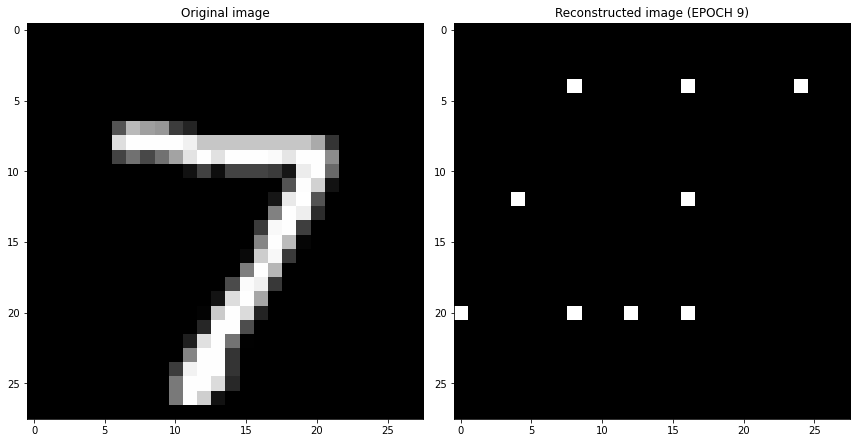

EPOCH 10/30
	 partial train loss (single batch): 0.113902
	 partial train loss (single batch): 0.108395
	 partial train loss (single batch): 0.112069
	 partial train loss (single batch): 0.108276
	 partial train loss (single batch): 0.108445
	 partial train loss (single batch): 0.116638
	 partial train loss (single batch): 0.115638
	 partial train loss (single batch): 0.111437
	 partial train loss (single batch): 0.105934
	 partial train loss (single batch): 0.113015
	 partial train loss (single batch): 0.109894
	 partial train loss (single batch): 0.114688
	 partial train loss (single batch): 0.107985
	 partial train loss (single batch): 0.113056
	 partial train loss (single batch): 0.108842
	 partial train loss (single batch): 0.109166
	 partial train loss (single batch): 0.111393
	 partial train loss (single batch): 0.109956
	 partial train loss (single batch): 0.115933
	 partial train loss (single batch): 0.110030
	 partial train loss (single batch): 0.113792
	 partial train loss (

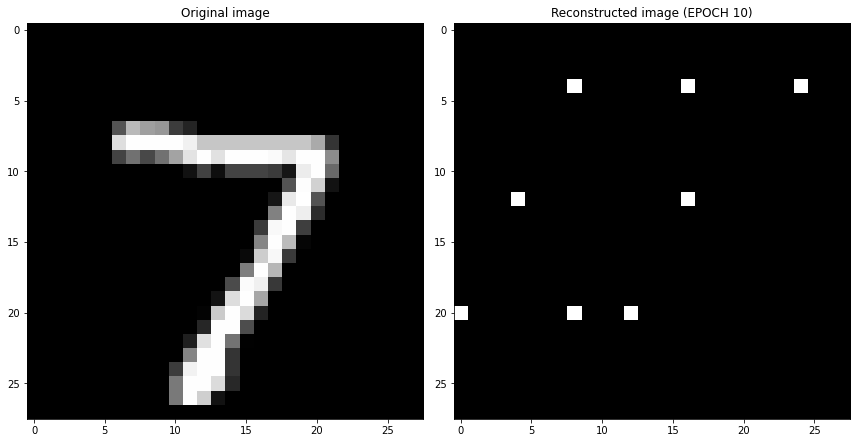

EPOCH 11/30
	 partial train loss (single batch): 0.112676
	 partial train loss (single batch): 0.109407
	 partial train loss (single batch): 0.110757
	 partial train loss (single batch): 0.110536
	 partial train loss (single batch): 0.113147
	 partial train loss (single batch): 0.114357
	 partial train loss (single batch): 0.111725
	 partial train loss (single batch): 0.107829
	 partial train loss (single batch): 0.113544
	 partial train loss (single batch): 0.113546
	 partial train loss (single batch): 0.111566
	 partial train loss (single batch): 0.110038
	 partial train loss (single batch): 0.114292
	 partial train loss (single batch): 0.114783
	 partial train loss (single batch): 0.112705
	 partial train loss (single batch): 0.113350
	 partial train loss (single batch): 0.111866
	 partial train loss (single batch): 0.109631
	 partial train loss (single batch): 0.111099
	 partial train loss (single batch): 0.113616
	 partial train loss (single batch): 0.134861
	 partial train loss (

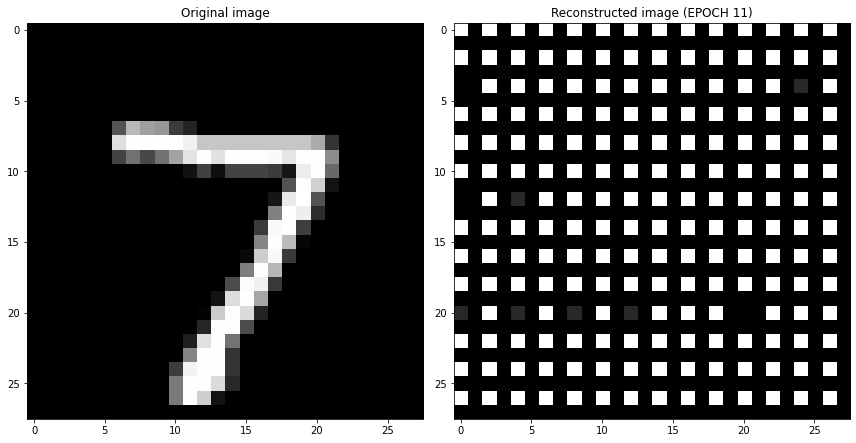

EPOCH 12/30
	 partial train loss (single batch): 0.287090
	 partial train loss (single batch): 0.283713
	 partial train loss (single batch): 0.289234
	 partial train loss (single batch): 0.284974
	 partial train loss (single batch): 0.283445
	 partial train loss (single batch): 0.285833
	 partial train loss (single batch): 0.285775
	 partial train loss (single batch): 0.286613
	 partial train loss (single batch): 0.283319
	 partial train loss (single batch): 0.282101
	 partial train loss (single batch): 0.280318
	 partial train loss (single batch): 0.282451
	 partial train loss (single batch): 0.283533
	 partial train loss (single batch): 0.281425
	 partial train loss (single batch): 0.282673
	 partial train loss (single batch): 0.280965
	 partial train loss (single batch): 0.280836
	 partial train loss (single batch): 0.283080
	 partial train loss (single batch): 0.281741
	 partial train loss (single batch): 0.284252
	 partial train loss (single batch): 0.285509
	 partial train loss (

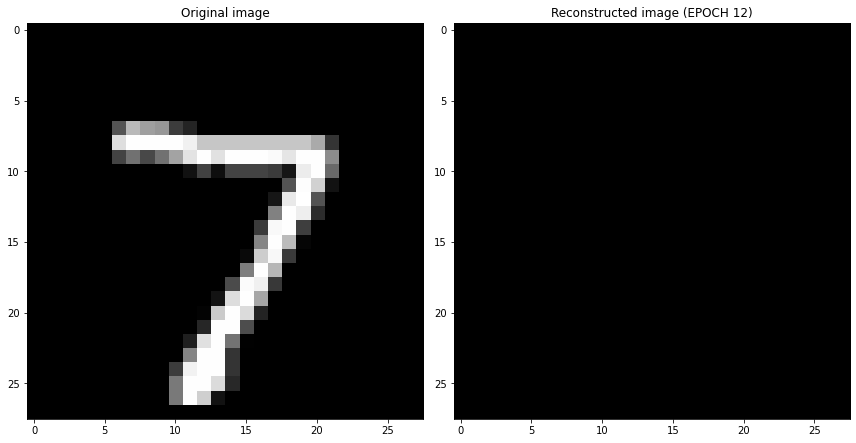

EPOCH 13/30
	 partial train loss (single batch): 0.111778
	 partial train loss (single batch): 0.113224
	 partial train loss (single batch): 0.114170
	 partial train loss (single batch): 0.109438
	 partial train loss (single batch): 0.113447
	 partial train loss (single batch): 0.108262
	 partial train loss (single batch): 0.115132
	 partial train loss (single batch): 0.110266
	 partial train loss (single batch): 0.115540
	 partial train loss (single batch): 0.111646
	 partial train loss (single batch): 0.112122
	 partial train loss (single batch): 0.109805
	 partial train loss (single batch): 0.112789
	 partial train loss (single batch): 0.115389
	 partial train loss (single batch): 0.107568
	 partial train loss (single batch): 0.113136
	 partial train loss (single batch): 0.110562
	 partial train loss (single batch): 0.111987
	 partial train loss (single batch): 0.110468
	 partial train loss (single batch): 0.114500
	 partial train loss (single batch): 0.113068
	 partial train loss (

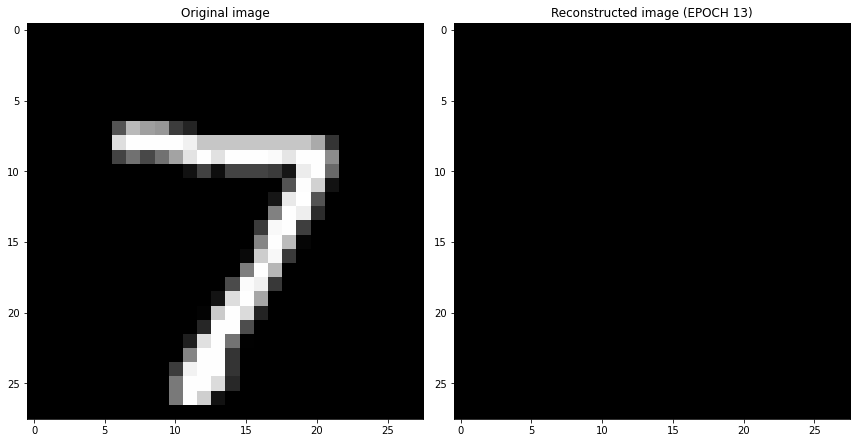

EPOCH 14/30
	 partial train loss (single batch): 0.110473
	 partial train loss (single batch): 0.113923
	 partial train loss (single batch): 0.107735
	 partial train loss (single batch): 0.113265
	 partial train loss (single batch): 0.112268
	 partial train loss (single batch): 0.113027
	 partial train loss (single batch): 0.110740
	 partial train loss (single batch): 0.107564
	 partial train loss (single batch): 0.112824
	 partial train loss (single batch): 0.110002
	 partial train loss (single batch): 0.112724
	 partial train loss (single batch): 0.111424
	 partial train loss (single batch): 0.110095
	 partial train loss (single batch): 0.112904
	 partial train loss (single batch): 0.107973
	 partial train loss (single batch): 0.113598
	 partial train loss (single batch): 0.107042
	 partial train loss (single batch): 0.115669
	 partial train loss (single batch): 0.112666
	 partial train loss (single batch): 0.113239
	 partial train loss (single batch): 0.113584
	 partial train loss (

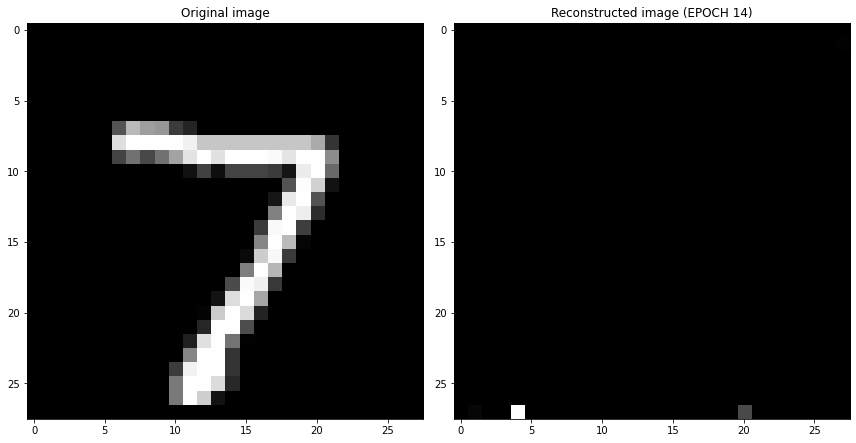

EPOCH 15/30
	 partial train loss (single batch): 0.110579
	 partial train loss (single batch): 0.110003
	 partial train loss (single batch): 0.110415
	 partial train loss (single batch): 0.111597
	 partial train loss (single batch): 0.110760
	 partial train loss (single batch): 0.112239
	 partial train loss (single batch): 0.110669
	 partial train loss (single batch): 0.114365
	 partial train loss (single batch): 0.112574
	 partial train loss (single batch): 0.113315
	 partial train loss (single batch): 0.108707
	 partial train loss (single batch): 0.110783
	 partial train loss (single batch): 0.112628
	 partial train loss (single batch): 0.110366
	 partial train loss (single batch): 0.110592
	 partial train loss (single batch): 0.110109
	 partial train loss (single batch): 0.111339
	 partial train loss (single batch): 0.109705
	 partial train loss (single batch): 0.114478
	 partial train loss (single batch): 0.109127
	 partial train loss (single batch): 0.114157
	 partial train loss (

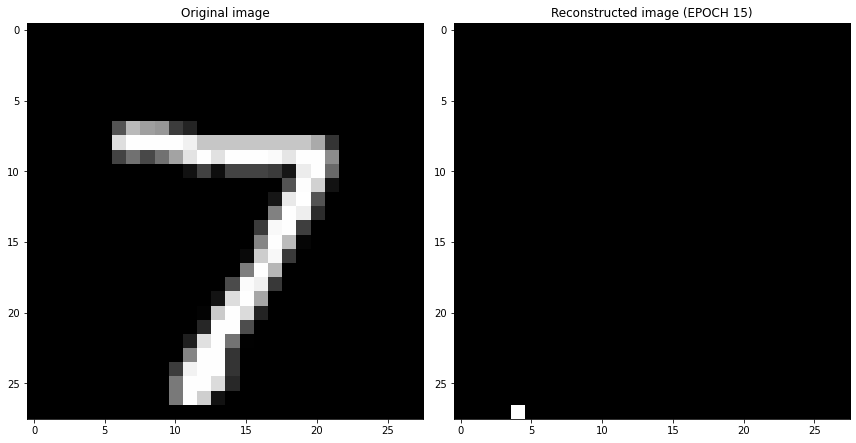

EPOCH 16/30
	 partial train loss (single batch): 0.111175
	 partial train loss (single batch): 0.110731
	 partial train loss (single batch): 0.109750
	 partial train loss (single batch): 0.109928
	 partial train loss (single batch): 0.113396
	 partial train loss (single batch): 0.113090
	 partial train loss (single batch): 0.117027
	 partial train loss (single batch): 0.110536
	 partial train loss (single batch): 0.112450
	 partial train loss (single batch): 0.110797
	 partial train loss (single batch): 0.114265
	 partial train loss (single batch): 0.113231
	 partial train loss (single batch): 0.109500
	 partial train loss (single batch): 0.112064
	 partial train loss (single batch): 0.112152
	 partial train loss (single batch): 0.113219
	 partial train loss (single batch): 0.115710
	 partial train loss (single batch): 0.113099
	 partial train loss (single batch): 0.116254
	 partial train loss (single batch): 0.113819
	 partial train loss (single batch): 0.112598
	 partial train loss (

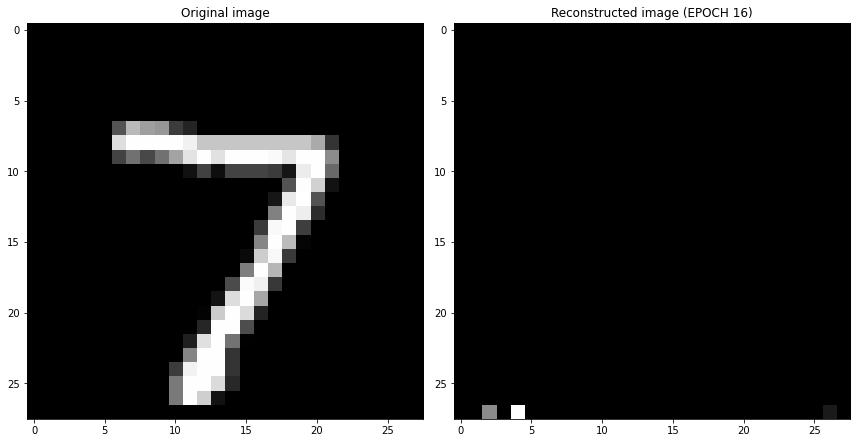

EPOCH 17/30
	 partial train loss (single batch): 0.110201
	 partial train loss (single batch): 0.110111
	 partial train loss (single batch): 0.116722
	 partial train loss (single batch): 0.109800
	 partial train loss (single batch): 0.114886
	 partial train loss (single batch): 0.111538
	 partial train loss (single batch): 0.113475
	 partial train loss (single batch): 0.110343
	 partial train loss (single batch): 0.112923
	 partial train loss (single batch): 0.113173
	 partial train loss (single batch): 0.114838
	 partial train loss (single batch): 0.110587
	 partial train loss (single batch): 0.115415
	 partial train loss (single batch): 0.108972
	 partial train loss (single batch): 0.112231
	 partial train loss (single batch): 0.110207
	 partial train loss (single batch): 0.113566
	 partial train loss (single batch): 0.112533
	 partial train loss (single batch): 0.110079
	 partial train loss (single batch): 0.115573
	 partial train loss (single batch): 0.110611
	 partial train loss (

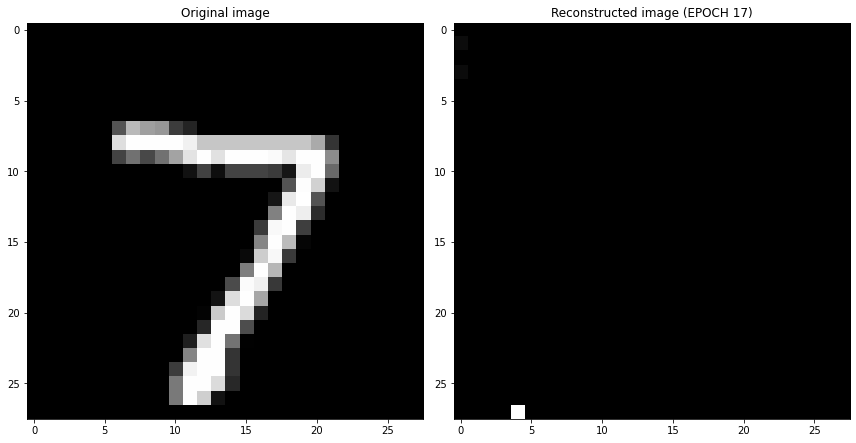

EPOCH 18/30
	 partial train loss (single batch): 0.114233
	 partial train loss (single batch): 0.113284
	 partial train loss (single batch): 0.114849
	 partial train loss (single batch): 0.109236
	 partial train loss (single batch): 0.111353
	 partial train loss (single batch): 0.113757
	 partial train loss (single batch): 0.112756
	 partial train loss (single batch): 0.113452
	 partial train loss (single batch): 0.110314
	 partial train loss (single batch): 0.113434
	 partial train loss (single batch): 0.113755
	 partial train loss (single batch): 0.111292
	 partial train loss (single batch): 0.112303
	 partial train loss (single batch): 0.112568
	 partial train loss (single batch): 0.113821
	 partial train loss (single batch): 0.110528
	 partial train loss (single batch): 0.111335
	 partial train loss (single batch): 0.113763
	 partial train loss (single batch): 0.109926
	 partial train loss (single batch): 0.112005
	 partial train loss (single batch): 0.113688
	 partial train loss (

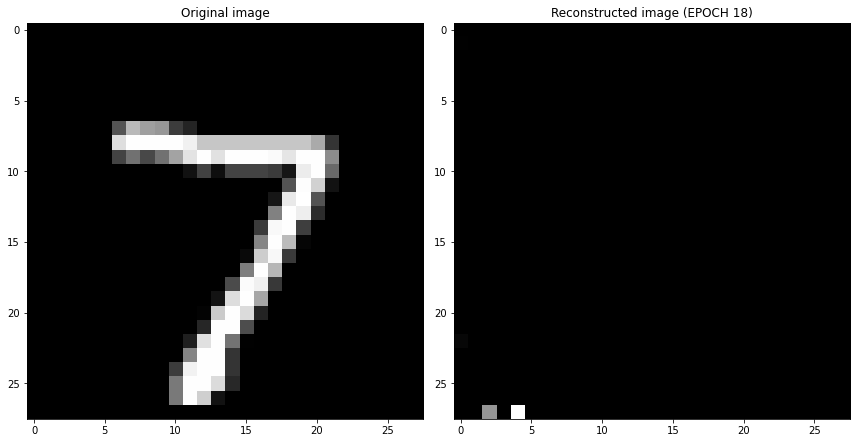

EPOCH 19/30
	 partial train loss (single batch): 0.112616
	 partial train loss (single batch): 0.109167
	 partial train loss (single batch): 0.113271
	 partial train loss (single batch): 0.114639
	 partial train loss (single batch): 0.110598
	 partial train loss (single batch): 0.110771
	 partial train loss (single batch): 0.111999
	 partial train loss (single batch): 0.111050
	 partial train loss (single batch): 0.112807
	 partial train loss (single batch): 0.111288
	 partial train loss (single batch): 0.111509
	 partial train loss (single batch): 0.116033
	 partial train loss (single batch): 0.108531
	 partial train loss (single batch): 0.115703
	 partial train loss (single batch): 0.114470
	 partial train loss (single batch): 0.114751
	 partial train loss (single batch): 0.107832
	 partial train loss (single batch): 0.112566
	 partial train loss (single batch): 0.114740
	 partial train loss (single batch): 0.107001
	 partial train loss (single batch): 0.112930
	 partial train loss (

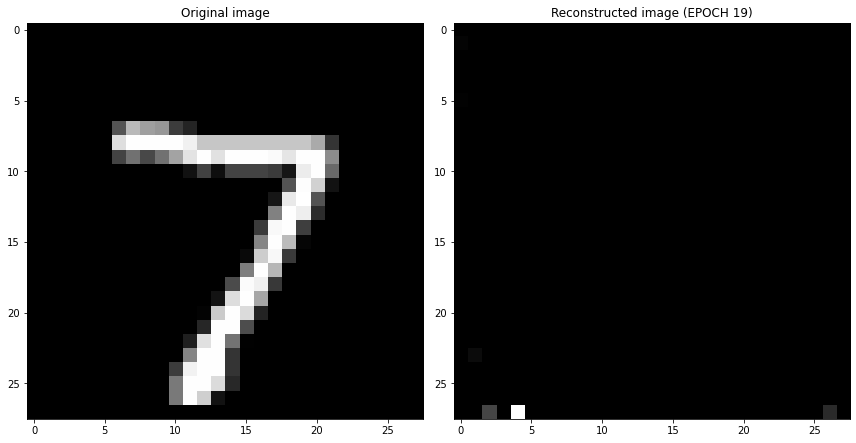

EPOCH 20/30
	 partial train loss (single batch): 0.115970
	 partial train loss (single batch): 0.108907
	 partial train loss (single batch): 0.111978
	 partial train loss (single batch): 0.116900
	 partial train loss (single batch): 0.107650
	 partial train loss (single batch): 0.108538
	 partial train loss (single batch): 0.108306
	 partial train loss (single batch): 0.112010
	 partial train loss (single batch): 0.112493
	 partial train loss (single batch): 0.118801
	 partial train loss (single batch): 0.109428
	 partial train loss (single batch): 0.108462
	 partial train loss (single batch): 0.108336
	 partial train loss (single batch): 0.113560
	 partial train loss (single batch): 0.110707
	 partial train loss (single batch): 0.113243
	 partial train loss (single batch): 0.109044
	 partial train loss (single batch): 0.107609
	 partial train loss (single batch): 0.111773
	 partial train loss (single batch): 0.116216
	 partial train loss (single batch): 0.114522
	 partial train loss (

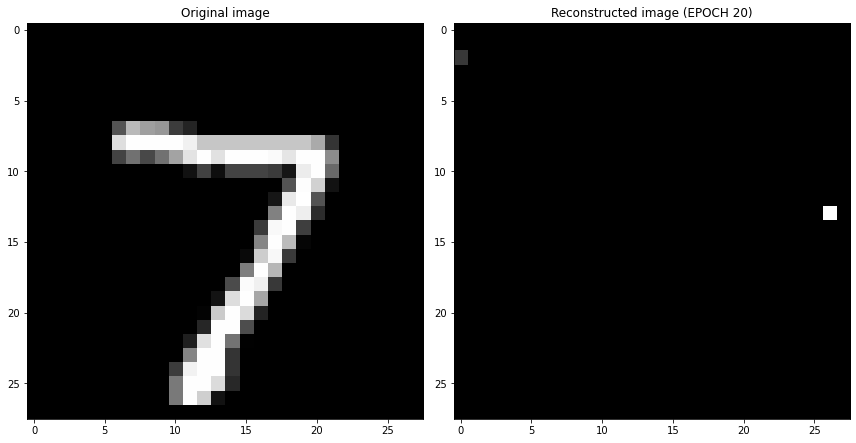

EPOCH 21/30
	 partial train loss (single batch): 0.111102
	 partial train loss (single batch): 0.119524
	 partial train loss (single batch): 0.111630
	 partial train loss (single batch): 0.113915
	 partial train loss (single batch): 0.120595
	 partial train loss (single batch): 0.118211
	 partial train loss (single batch): 0.114852
	 partial train loss (single batch): 0.118023
	 partial train loss (single batch): 0.118154
	 partial train loss (single batch): 0.115837
	 partial train loss (single batch): 0.115614
	 partial train loss (single batch): 0.120033
	 partial train loss (single batch): 0.118464
	 partial train loss (single batch): 0.117662
	 partial train loss (single batch): 0.114395
	 partial train loss (single batch): 0.124999
	 partial train loss (single batch): 0.125101
	 partial train loss (single batch): 0.127796
	 partial train loss (single batch): 0.127112
	 partial train loss (single batch): 0.128359
	 partial train loss (single batch): 0.106761
	 partial train loss (

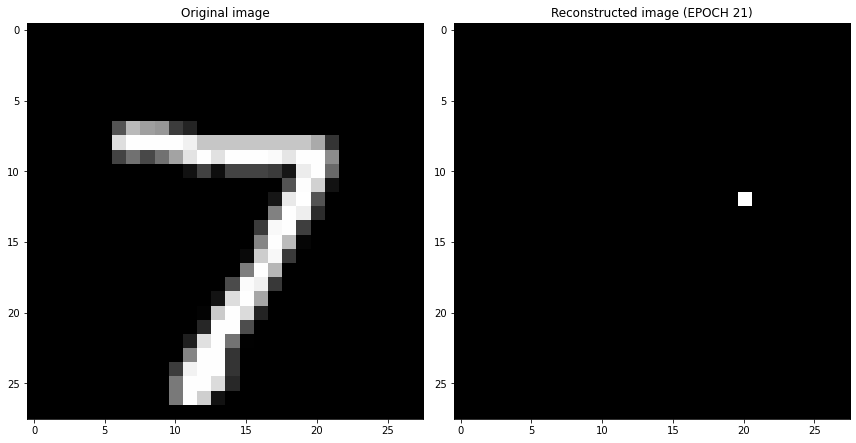

EPOCH 22/30
	 partial train loss (single batch): 0.113988
	 partial train loss (single batch): 0.111215
	 partial train loss (single batch): 0.111836
	 partial train loss (single batch): 0.109561
	 partial train loss (single batch): 0.113475
	 partial train loss (single batch): 0.113471
	 partial train loss (single batch): 0.114824
	 partial train loss (single batch): 0.113031
	 partial train loss (single batch): 0.111837
	 partial train loss (single batch): 0.111052
	 partial train loss (single batch): 0.107184
	 partial train loss (single batch): 0.111770
	 partial train loss (single batch): 0.111922
	 partial train loss (single batch): 0.112905
	 partial train loss (single batch): 0.115055
	 partial train loss (single batch): 0.109996
	 partial train loss (single batch): 0.112139
	 partial train loss (single batch): 0.111681
	 partial train loss (single batch): 0.111141
	 partial train loss (single batch): 0.111922
	 partial train loss (single batch): 0.113600
	 partial train loss (

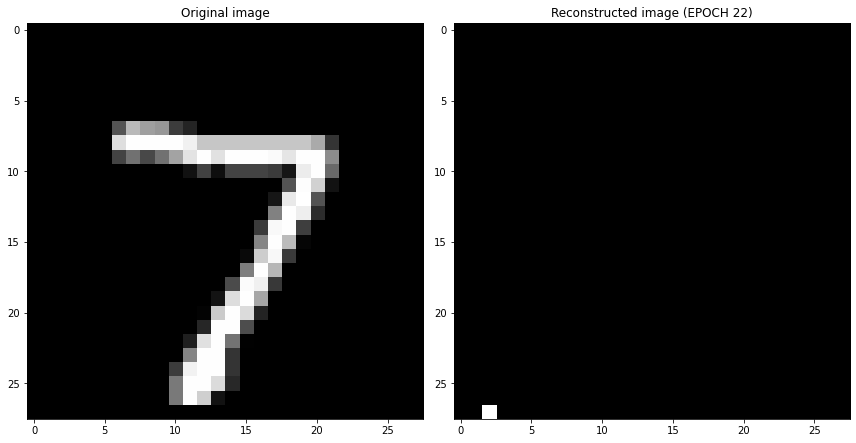

EPOCH 23/30
	 partial train loss (single batch): 0.112581
	 partial train loss (single batch): 0.111768
	 partial train loss (single batch): 0.111681
	 partial train loss (single batch): 0.110943
	 partial train loss (single batch): 0.111154
	 partial train loss (single batch): 0.108421
	 partial train loss (single batch): 0.112437
	 partial train loss (single batch): 0.117994
	 partial train loss (single batch): 0.110742
	 partial train loss (single batch): 0.106859
	 partial train loss (single batch): 0.114856
	 partial train loss (single batch): 0.112592
	 partial train loss (single batch): 0.114616
	 partial train loss (single batch): 0.110885
	 partial train loss (single batch): 0.109092
	 partial train loss (single batch): 0.112089
	 partial train loss (single batch): 0.106248
	 partial train loss (single batch): 0.109587
	 partial train loss (single batch): 0.110707
	 partial train loss (single batch): 0.109974
	 partial train loss (single batch): 0.110858
	 partial train loss (

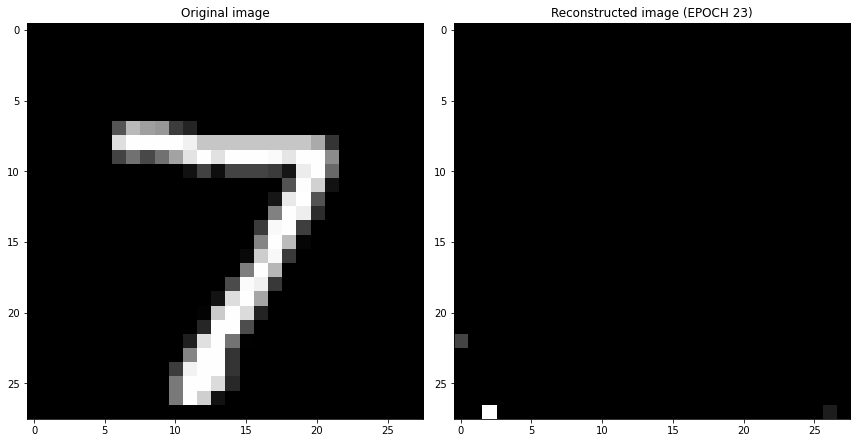

EPOCH 24/30
	 partial train loss (single batch): 0.113632
	 partial train loss (single batch): 0.111862
	 partial train loss (single batch): 0.111417
	 partial train loss (single batch): 0.109334
	 partial train loss (single batch): 0.107628
	 partial train loss (single batch): 0.108871
	 partial train loss (single batch): 0.111413
	 partial train loss (single batch): 0.108583
	 partial train loss (single batch): 0.111181
	 partial train loss (single batch): 0.108700
	 partial train loss (single batch): 0.109201
	 partial train loss (single batch): 0.113785
	 partial train loss (single batch): 0.114232
	 partial train loss (single batch): 0.114650
	 partial train loss (single batch): 0.113153
	 partial train loss (single batch): 0.111450
	 partial train loss (single batch): 0.113081
	 partial train loss (single batch): 0.110319
	 partial train loss (single batch): 0.111279
	 partial train loss (single batch): 0.114601
	 partial train loss (single batch): 0.114492
	 partial train loss (

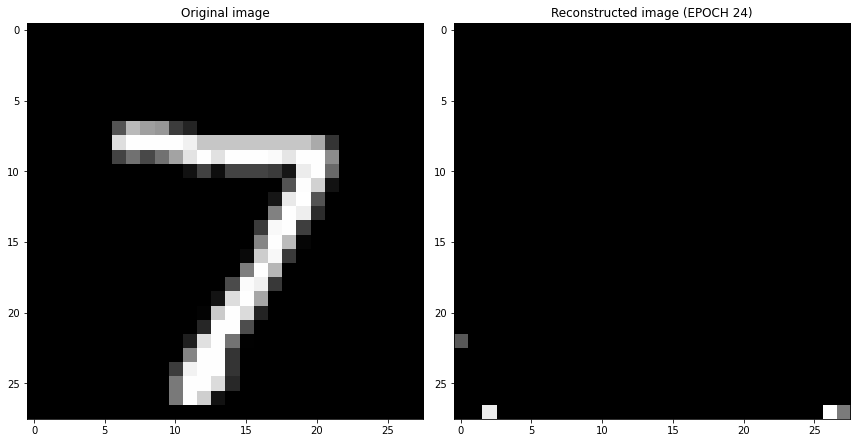

EPOCH 25/30
	 partial train loss (single batch): 0.108420
	 partial train loss (single batch): 0.113208
	 partial train loss (single batch): 0.111000
	 partial train loss (single batch): 0.115500
	 partial train loss (single batch): 0.109503
	 partial train loss (single batch): 0.112218
	 partial train loss (single batch): 0.109566
	 partial train loss (single batch): 0.106963
	 partial train loss (single batch): 0.112475
	 partial train loss (single batch): 0.112410
	 partial train loss (single batch): 0.112238
	 partial train loss (single batch): 0.113156
	 partial train loss (single batch): 0.116094
	 partial train loss (single batch): 0.108625
	 partial train loss (single batch): 0.111711
	 partial train loss (single batch): 0.113024
	 partial train loss (single batch): 0.114728
	 partial train loss (single batch): 0.106118
	 partial train loss (single batch): 0.116477
	 partial train loss (single batch): 0.117097
	 partial train loss (single batch): 0.119243
	 partial train loss (

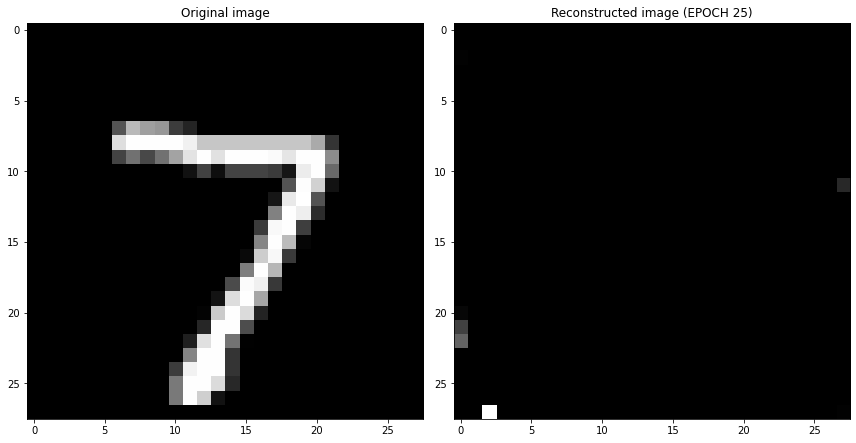

EPOCH 26/30
	 partial train loss (single batch): 0.109443
	 partial train loss (single batch): 0.111006
	 partial train loss (single batch): 0.109583
	 partial train loss (single batch): 0.109818
	 partial train loss (single batch): 0.115877
	 partial train loss (single batch): 0.111982
	 partial train loss (single batch): 0.109443
	 partial train loss (single batch): 0.110014
	 partial train loss (single batch): 0.113062
	 partial train loss (single batch): 0.113016
	 partial train loss (single batch): 0.107813
	 partial train loss (single batch): 0.105222
	 partial train loss (single batch): 0.111268
	 partial train loss (single batch): 0.112511
	 partial train loss (single batch): 0.112202
	 partial train loss (single batch): 0.111671
	 partial train loss (single batch): 0.105823
	 partial train loss (single batch): 0.114031
	 partial train loss (single batch): 0.108992
	 partial train loss (single batch): 0.113412
	 partial train loss (single batch): 0.115660
	 partial train loss (

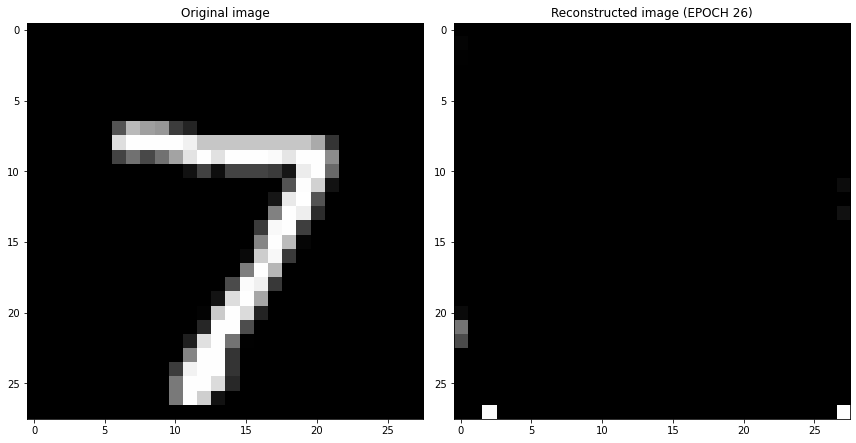

EPOCH 27/30
	 partial train loss (single batch): 0.113778
	 partial train loss (single batch): 0.110145
	 partial train loss (single batch): 0.112659
	 partial train loss (single batch): 0.108059
	 partial train loss (single batch): 0.110039
	 partial train loss (single batch): 0.111063
	 partial train loss (single batch): 0.115465
	 partial train loss (single batch): 0.111323
	 partial train loss (single batch): 0.112748
	 partial train loss (single batch): 0.110720
	 partial train loss (single batch): 0.111906
	 partial train loss (single batch): 0.115673
	 partial train loss (single batch): 0.109305
	 partial train loss (single batch): 0.108921
	 partial train loss (single batch): 0.112803
	 partial train loss (single batch): 0.111647
	 partial train loss (single batch): 0.113544
	 partial train loss (single batch): 0.111668
	 partial train loss (single batch): 0.107621
	 partial train loss (single batch): 0.112539
	 partial train loss (single batch): 0.110255
	 partial train loss (

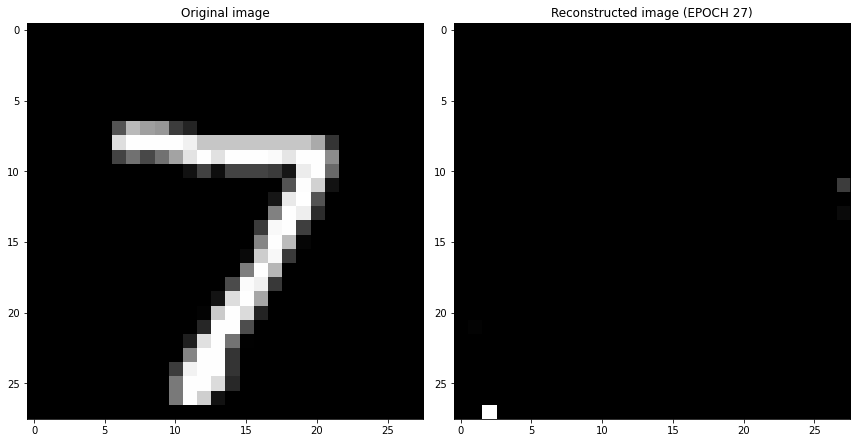

EPOCH 28/30
	 partial train loss (single batch): 0.114551
	 partial train loss (single batch): 0.112550
	 partial train loss (single batch): 0.109135
	 partial train loss (single batch): 0.113996
	 partial train loss (single batch): 0.106556
	 partial train loss (single batch): 0.111306
	 partial train loss (single batch): 0.111836
	 partial train loss (single batch): 0.109549
	 partial train loss (single batch): 0.106683
	 partial train loss (single batch): 0.111067
	 partial train loss (single batch): 0.111676
	 partial train loss (single batch): 0.107938
	 partial train loss (single batch): 0.112103
	 partial train loss (single batch): 0.110609
	 partial train loss (single batch): 0.111957
	 partial train loss (single batch): 0.111823
	 partial train loss (single batch): 0.113898
	 partial train loss (single batch): 0.114588
	 partial train loss (single batch): 0.110756
	 partial train loss (single batch): 0.110041
	 partial train loss (single batch): 0.113267
	 partial train loss (

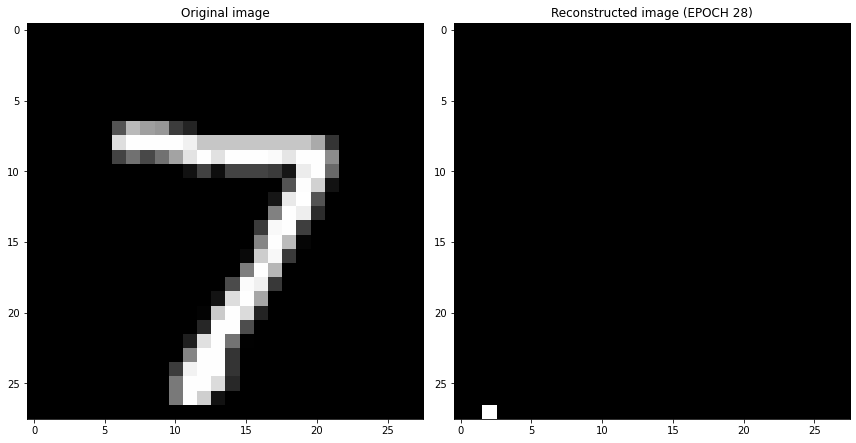

EPOCH 29/30
	 partial train loss (single batch): 0.108995
	 partial train loss (single batch): 0.105436
	 partial train loss (single batch): 0.113419
	 partial train loss (single batch): 0.114580
	 partial train loss (single batch): 0.112698
	 partial train loss (single batch): 0.109270
	 partial train loss (single batch): 0.108650
	 partial train loss (single batch): 0.114082
	 partial train loss (single batch): 0.111917
	 partial train loss (single batch): 0.113012
	 partial train loss (single batch): 0.111077
	 partial train loss (single batch): 0.108719
	 partial train loss (single batch): 0.115691
	 partial train loss (single batch): 0.110368
	 partial train loss (single batch): 0.112215
	 partial train loss (single batch): 0.116548
	 partial train loss (single batch): 0.110333
	 partial train loss (single batch): 0.111966
	 partial train loss (single batch): 0.112489
	 partial train loss (single batch): 0.114107
	 partial train loss (single batch): 0.109330
	 partial train loss (

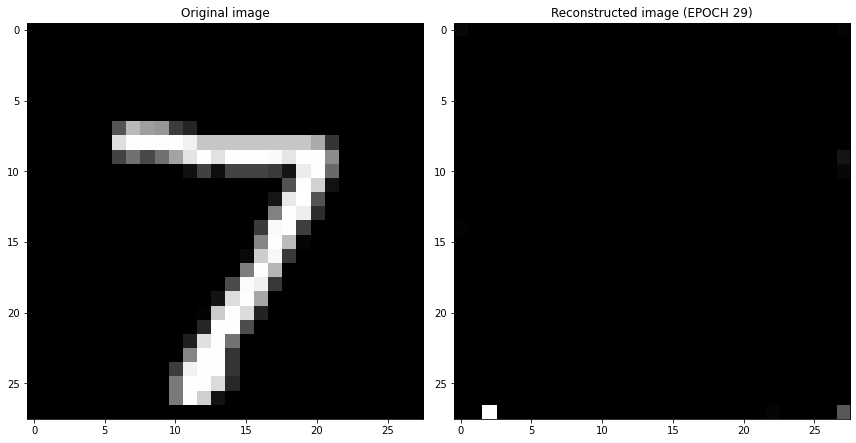

EPOCH 30/30
	 partial train loss (single batch): 0.112096
	 partial train loss (single batch): 0.112723
	 partial train loss (single batch): 0.114108
	 partial train loss (single batch): 0.109875
	 partial train loss (single batch): 0.115851
	 partial train loss (single batch): 0.109196
	 partial train loss (single batch): 0.106173
	 partial train loss (single batch): 0.114056
	 partial train loss (single batch): 0.116040
	 partial train loss (single batch): 0.110898
	 partial train loss (single batch): 0.117761
	 partial train loss (single batch): 0.108684
	 partial train loss (single batch): 0.113543
	 partial train loss (single batch): 0.113266
	 partial train loss (single batch): 0.113053
	 partial train loss (single batch): 0.113162
	 partial train loss (single batch): 0.111385
	 partial train loss (single batch): 0.115642
	 partial train loss (single batch): 0.111445
	 partial train loss (single batch): 0.114159
	 partial train loss (single batch): 0.111818
	 partial train loss (

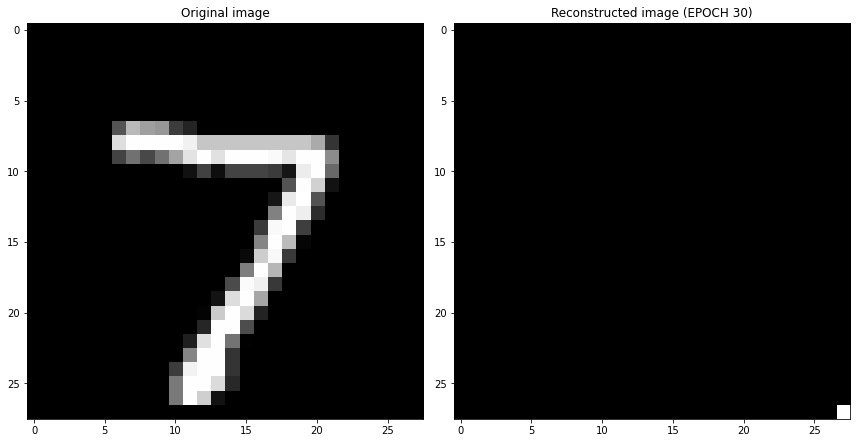

Cross validation fold number= 2/6
EPOCH 1/30
	 partial train loss (single batch): 0.235173
	 partial train loss (single batch): 0.132108
	 partial train loss (single batch): 0.112925
	 partial train loss (single batch): 0.110432
	 partial train loss (single batch): 0.112351
	 partial train loss (single batch): 0.110511
	 partial train loss (single batch): 0.111508
	 partial train loss (single batch): 0.116021
	 partial train loss (single batch): 0.111523
	 partial train loss (single batch): 0.106537
	 partial train loss (single batch): 0.108126
	 partial train loss (single batch): 0.111101
	 partial train loss (single batch): 0.107457
	 partial train loss (single batch): 0.109024
	 partial train loss (single batch): 0.110124
	 partial train loss (single batch): 0.109830
	 partial train loss (single batch): 0.111762
	 partial train loss (single batch): 0.106582
	 partial train loss (single batch): 0.114840
	 partial train loss (single batch): 0.113858
	 partial train loss (single batch)

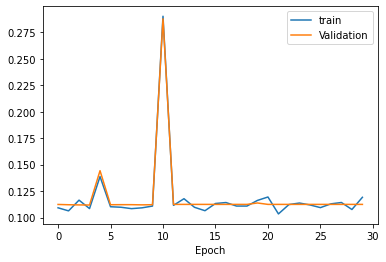

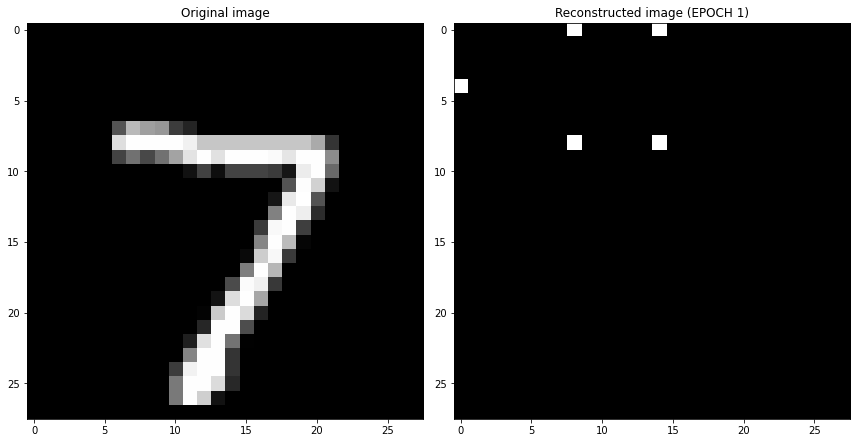

EPOCH 2/30
	 partial train loss (single batch): 0.108434
	 partial train loss (single batch): 0.109215
	 partial train loss (single batch): 0.111091
	 partial train loss (single batch): 0.110803
	 partial train loss (single batch): 0.111386
	 partial train loss (single batch): 0.111574
	 partial train loss (single batch): 0.110103
	 partial train loss (single batch): 0.110190
	 partial train loss (single batch): 0.114651
	 partial train loss (single batch): 0.105766
	 partial train loss (single batch): 0.113122
	 partial train loss (single batch): 0.110208
	 partial train loss (single batch): 0.116876
	 partial train loss (single batch): 0.113813
	 partial train loss (single batch): 0.119393
	 partial train loss (single batch): 0.113366
	 partial train loss (single batch): 0.118710
	 partial train loss (single batch): 0.114676
	 partial train loss (single batch): 0.115059
	 partial train loss (single batch): 0.117563
	 partial train loss (single batch): 0.120216
	 partial train loss (s

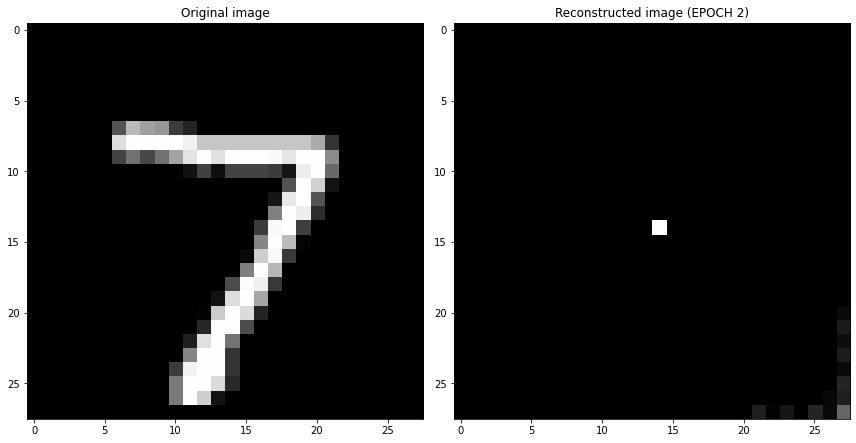

EPOCH 3/30
	 partial train loss (single batch): 0.113900
	 partial train loss (single batch): 0.110910
	 partial train loss (single batch): 0.114879
	 partial train loss (single batch): 0.109985
	 partial train loss (single batch): 0.115129
	 partial train loss (single batch): 0.111954
	 partial train loss (single batch): 0.110176
	 partial train loss (single batch): 0.108623
	 partial train loss (single batch): 0.110497
	 partial train loss (single batch): 0.113379
	 partial train loss (single batch): 0.113370
	 partial train loss (single batch): 0.112209
	 partial train loss (single batch): 0.104992
	 partial train loss (single batch): 0.112755
	 partial train loss (single batch): 0.110803
	 partial train loss (single batch): 0.106781
	 partial train loss (single batch): 0.110260
	 partial train loss (single batch): 0.111109
	 partial train loss (single batch): 0.116636
	 partial train loss (single batch): 0.115073
	 partial train loss (single batch): 0.111599
	 partial train loss (s

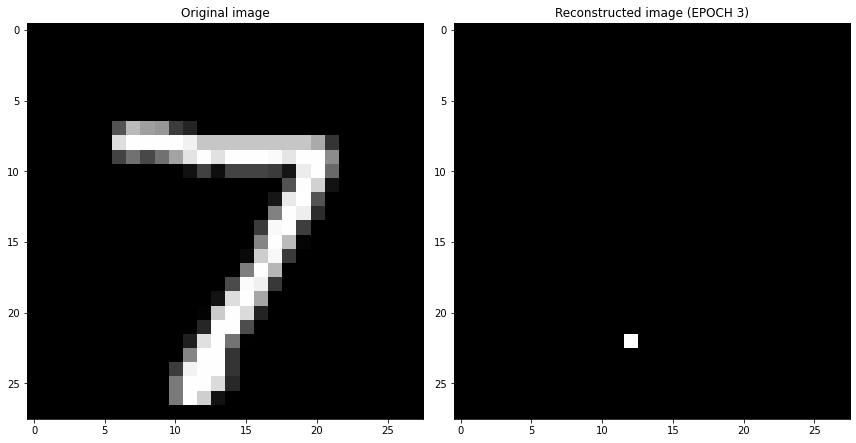

EPOCH 4/30
	 partial train loss (single batch): 0.112921
	 partial train loss (single batch): 0.107856
	 partial train loss (single batch): 0.114570
	 partial train loss (single batch): 0.112379
	 partial train loss (single batch): 0.114825
	 partial train loss (single batch): 0.110727
	 partial train loss (single batch): 0.111221
	 partial train loss (single batch): 0.110160
	 partial train loss (single batch): 0.116214
	 partial train loss (single batch): 0.112601
	 partial train loss (single batch): 0.112797
	 partial train loss (single batch): 0.108824
	 partial train loss (single batch): 0.114132
	 partial train loss (single batch): 0.111546
	 partial train loss (single batch): 0.109986
	 partial train loss (single batch): 0.110236
	 partial train loss (single batch): 0.107705
	 partial train loss (single batch): 0.111371
	 partial train loss (single batch): 0.110913
	 partial train loss (single batch): 0.108205
	 partial train loss (single batch): 0.113489
	 partial train loss (s

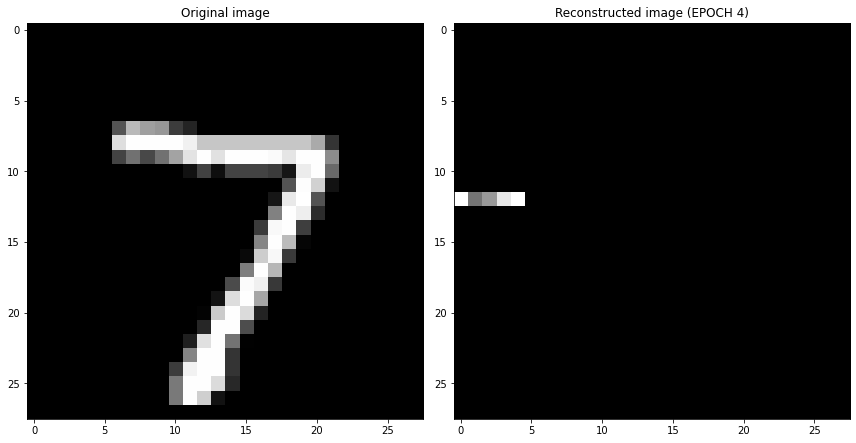

EPOCH 5/30
	 partial train loss (single batch): 0.112411
	 partial train loss (single batch): 0.115879
	 partial train loss (single batch): 0.115836
	 partial train loss (single batch): 0.110894
	 partial train loss (single batch): 0.115647
	 partial train loss (single batch): 0.113544
	 partial train loss (single batch): 0.110354
	 partial train loss (single batch): 0.109681
	 partial train loss (single batch): 0.112750
	 partial train loss (single batch): 0.113637
	 partial train loss (single batch): 0.116495
	 partial train loss (single batch): 0.111437
	 partial train loss (single batch): 0.108998
	 partial train loss (single batch): 0.110266
	 partial train loss (single batch): 0.117294
	 partial train loss (single batch): 0.109352
	 partial train loss (single batch): 0.111272
	 partial train loss (single batch): 0.110222
	 partial train loss (single batch): 0.114960
	 partial train loss (single batch): 0.111700
	 partial train loss (single batch): 0.110020
	 partial train loss (s

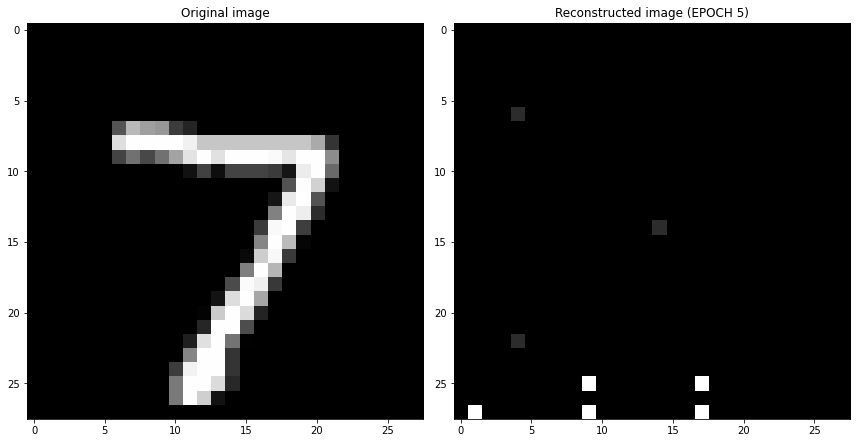

EPOCH 6/30
	 partial train loss (single batch): 0.117501
	 partial train loss (single batch): 0.117884
	 partial train loss (single batch): 0.115614
	 partial train loss (single batch): 0.119633
	 partial train loss (single batch): 0.117994
	 partial train loss (single batch): 0.116124
	 partial train loss (single batch): 0.114314
	 partial train loss (single batch): 0.119595
	 partial train loss (single batch): 0.114097
	 partial train loss (single batch): 0.114488
	 partial train loss (single batch): 0.111881
	 partial train loss (single batch): 0.109734
	 partial train loss (single batch): 0.109806
	 partial train loss (single batch): 0.110759
	 partial train loss (single batch): 0.108839
	 partial train loss (single batch): 0.110572
	 partial train loss (single batch): 0.108843
	 partial train loss (single batch): 0.106740
	 partial train loss (single batch): 0.109273
	 partial train loss (single batch): 0.108762
	 partial train loss (single batch): 0.110886
	 partial train loss (s

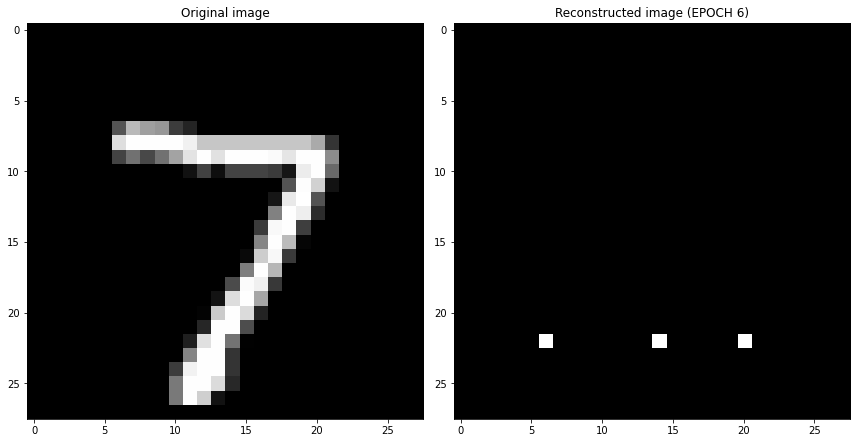

EPOCH 7/30
	 partial train loss (single batch): 0.112366
	 partial train loss (single batch): 0.113144
	 partial train loss (single batch): 0.112182
	 partial train loss (single batch): 0.114086
	 partial train loss (single batch): 0.107055
	 partial train loss (single batch): 0.110106
	 partial train loss (single batch): 0.110561
	 partial train loss (single batch): 0.112779
	 partial train loss (single batch): 0.114097
	 partial train loss (single batch): 0.110685
	 partial train loss (single batch): 0.106744
	 partial train loss (single batch): 0.109359
	 partial train loss (single batch): 0.112596
	 partial train loss (single batch): 0.109635
	 partial train loss (single batch): 0.107294
	 partial train loss (single batch): 0.113031
	 partial train loss (single batch): 0.108807
	 partial train loss (single batch): 0.109634
	 partial train loss (single batch): 0.107979
	 partial train loss (single batch): 0.108231
	 partial train loss (single batch): 0.109040
	 partial train loss (s

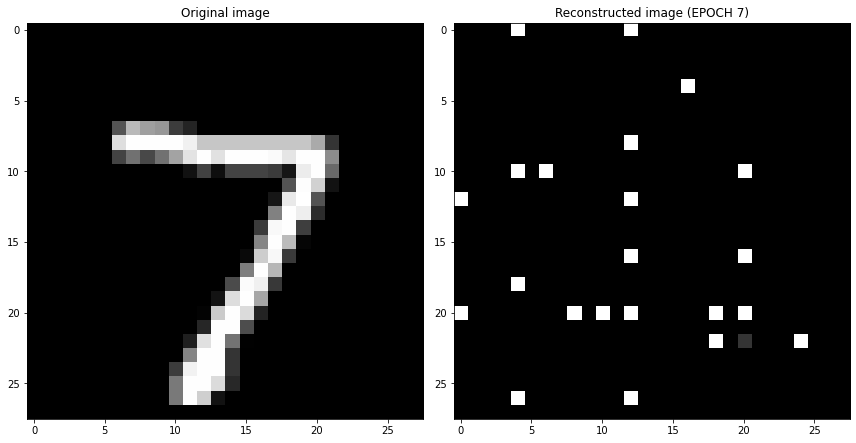

EPOCH 8/30
	 partial train loss (single batch): 0.132110
	 partial train loss (single batch): 0.129708
	 partial train loss (single batch): 0.130224
	 partial train loss (single batch): 0.129214
	 partial train loss (single batch): 0.128752
	 partial train loss (single batch): 0.130006
	 partial train loss (single batch): 0.126739
	 partial train loss (single batch): 0.133223
	 partial train loss (single batch): 0.126722
	 partial train loss (single batch): 0.131926
	 partial train loss (single batch): 0.130738
	 partial train loss (single batch): 0.131164
	 partial train loss (single batch): 0.125584
	 partial train loss (single batch): 0.133165
	 partial train loss (single batch): 0.134260
	 partial train loss (single batch): 0.137897
	 partial train loss (single batch): 0.137580
	 partial train loss (single batch): 0.135740
	 partial train loss (single batch): 0.136521
	 partial train loss (single batch): 0.137259
	 partial train loss (single batch): 0.133044
	 partial train loss (s

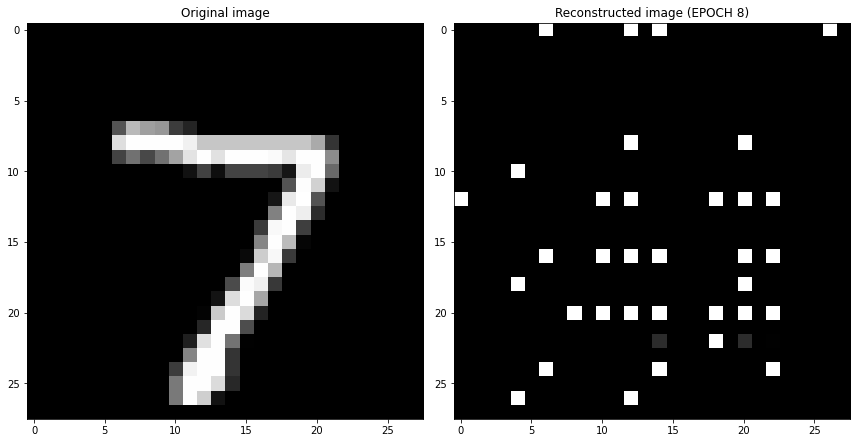

EPOCH 9/30
	 partial train loss (single batch): 0.137264
	 partial train loss (single batch): 0.142538
	 partial train loss (single batch): 0.144748
	 partial train loss (single batch): 0.148819
	 partial train loss (single batch): 0.146927
	 partial train loss (single batch): 0.150798
	 partial train loss (single batch): 0.148466
	 partial train loss (single batch): 0.151853
	 partial train loss (single batch): 0.154397
	 partial train loss (single batch): 0.153907
	 partial train loss (single batch): 0.155344
	 partial train loss (single batch): 0.150734
	 partial train loss (single batch): 0.155202
	 partial train loss (single batch): 0.153029
	 partial train loss (single batch): 0.148837
	 partial train loss (single batch): 0.154179
	 partial train loss (single batch): 0.156758
	 partial train loss (single batch): 0.153633
	 partial train loss (single batch): 0.154958
	 partial train loss (single batch): 0.151571
	 partial train loss (single batch): 0.148605
	 partial train loss (s

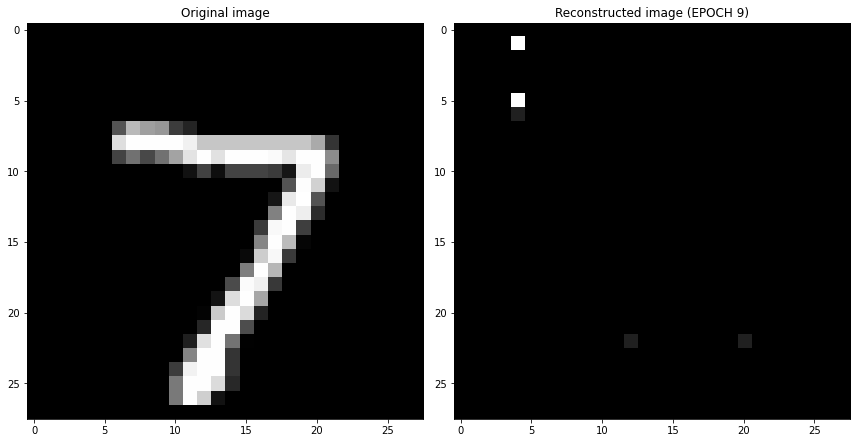

EPOCH 10/30
	 partial train loss (single batch): 0.118861
	 partial train loss (single batch): 0.109731
	 partial train loss (single batch): 0.113569
	 partial train loss (single batch): 0.114271
	 partial train loss (single batch): 0.115539
	 partial train loss (single batch): 0.116998
	 partial train loss (single batch): 0.113136
	 partial train loss (single batch): 0.110382
	 partial train loss (single batch): 0.111365
	 partial train loss (single batch): 0.112182
	 partial train loss (single batch): 0.113933
	 partial train loss (single batch): 0.116783
	 partial train loss (single batch): 0.114026
	 partial train loss (single batch): 0.113932
	 partial train loss (single batch): 0.114144
	 partial train loss (single batch): 0.115661
	 partial train loss (single batch): 0.113356
	 partial train loss (single batch): 0.117518
	 partial train loss (single batch): 0.115956
	 partial train loss (single batch): 0.117157
	 partial train loss (single batch): 0.120926
	 partial train loss (

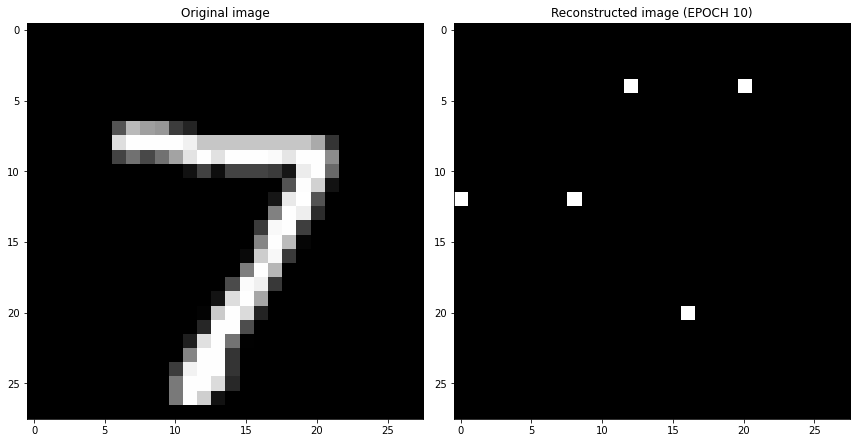

EPOCH 11/30
	 partial train loss (single batch): 0.111187
	 partial train loss (single batch): 0.109136
	 partial train loss (single batch): 0.113719
	 partial train loss (single batch): 0.111698
	 partial train loss (single batch): 0.113522
	 partial train loss (single batch): 0.108015
	 partial train loss (single batch): 0.112363
	 partial train loss (single batch): 0.108254
	 partial train loss (single batch): 0.110126
	 partial train loss (single batch): 0.114797
	 partial train loss (single batch): 0.114382
	 partial train loss (single batch): 0.115704
	 partial train loss (single batch): 0.112110
	 partial train loss (single batch): 0.109282
	 partial train loss (single batch): 0.110389
	 partial train loss (single batch): 0.112141
	 partial train loss (single batch): 0.115830
	 partial train loss (single batch): 0.116630
	 partial train loss (single batch): 0.109890
	 partial train loss (single batch): 0.110760
	 partial train loss (single batch): 0.110962
	 partial train loss (

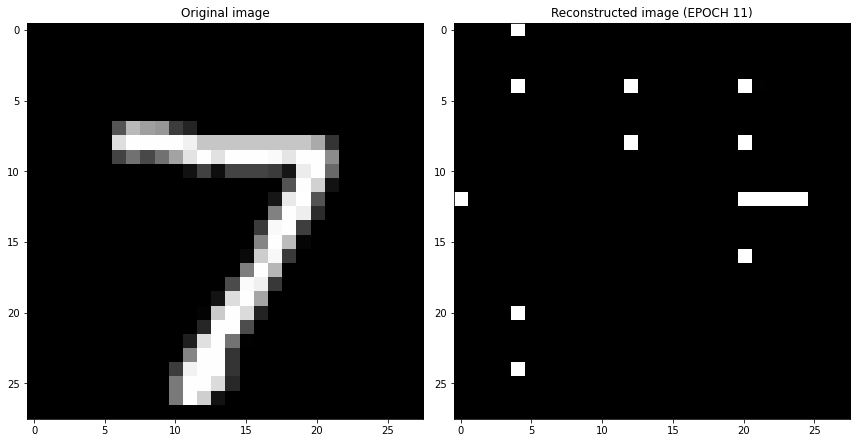

EPOCH 12/30
	 partial train loss (single batch): 0.111283
	 partial train loss (single batch): 0.108479
	 partial train loss (single batch): 0.108472
	 partial train loss (single batch): 0.108427
	 partial train loss (single batch): 0.113437
	 partial train loss (single batch): 0.113362
	 partial train loss (single batch): 0.110218
	 partial train loss (single batch): 0.109380
	 partial train loss (single batch): 0.111947
	 partial train loss (single batch): 0.108203
	 partial train loss (single batch): 0.112893
	 partial train loss (single batch): 0.109099
	 partial train loss (single batch): 0.108319
	 partial train loss (single batch): 0.107663
	 partial train loss (single batch): 0.111289
	 partial train loss (single batch): 0.110074
	 partial train loss (single batch): 0.112585
	 partial train loss (single batch): 0.112813
	 partial train loss (single batch): 0.112439
	 partial train loss (single batch): 0.108308
	 partial train loss (single batch): 0.115536
	 partial train loss (

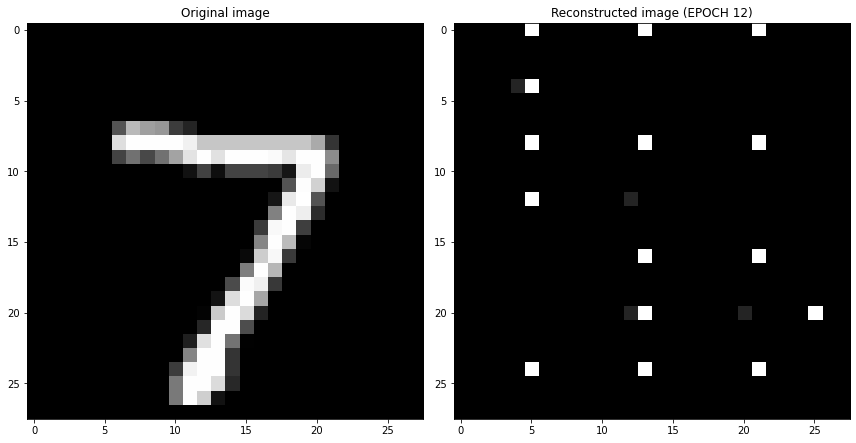

EPOCH 13/30
	 partial train loss (single batch): 0.123767
	 partial train loss (single batch): 0.121260
	 partial train loss (single batch): 0.120144
	 partial train loss (single batch): 0.107615
	 partial train loss (single batch): 0.108873
	 partial train loss (single batch): 0.113051
	 partial train loss (single batch): 0.113453
	 partial train loss (single batch): 0.114756
	 partial train loss (single batch): 0.110970
	 partial train loss (single batch): 0.107477
	 partial train loss (single batch): 0.114429
	 partial train loss (single batch): 0.106052
	 partial train loss (single batch): 0.107228
	 partial train loss (single batch): 0.109521
	 partial train loss (single batch): 0.111833
	 partial train loss (single batch): 0.111992
	 partial train loss (single batch): 0.113054
	 partial train loss (single batch): 0.116134
	 partial train loss (single batch): 0.108849
	 partial train loss (single batch): 0.112788
	 partial train loss (single batch): 0.113121
	 partial train loss (

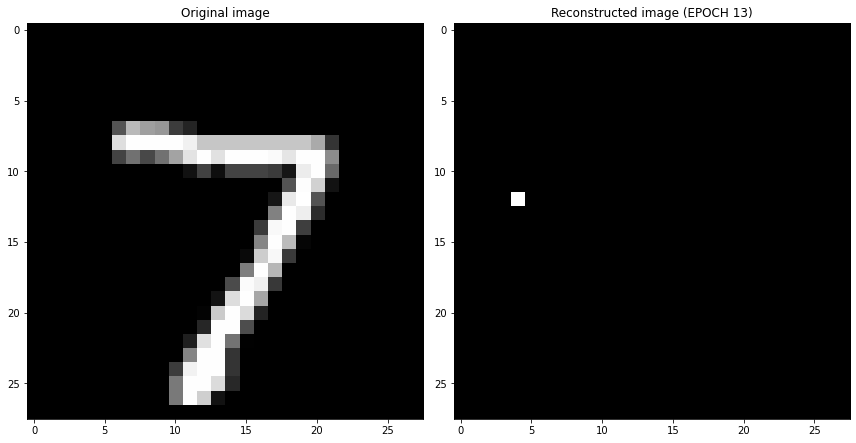

EPOCH 14/30
	 partial train loss (single batch): 0.108343
	 partial train loss (single batch): 0.117669
	 partial train loss (single batch): 0.112133
	 partial train loss (single batch): 0.111443
	 partial train loss (single batch): 0.109870
	 partial train loss (single batch): 0.113359
	 partial train loss (single batch): 0.117978
	 partial train loss (single batch): 0.109628
	 partial train loss (single batch): 0.115775
	 partial train loss (single batch): 0.114162
	 partial train loss (single batch): 0.111271
	 partial train loss (single batch): 0.109679
	 partial train loss (single batch): 0.112369
	 partial train loss (single batch): 0.113253
	 partial train loss (single batch): 0.105421
	 partial train loss (single batch): 0.114644
	 partial train loss (single batch): 0.110103
	 partial train loss (single batch): 0.110635
	 partial train loss (single batch): 0.113158
	 partial train loss (single batch): 0.111528
	 partial train loss (single batch): 0.115555
	 partial train loss (

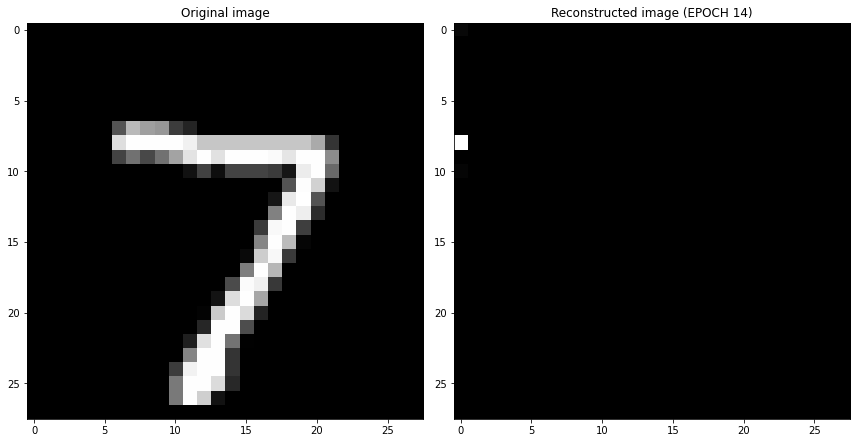

EPOCH 15/30
	 partial train loss (single batch): 0.107687
	 partial train loss (single batch): 0.110918
	 partial train loss (single batch): 0.111909
	 partial train loss (single batch): 0.112464
	 partial train loss (single batch): 0.115476
	 partial train loss (single batch): 0.112519
	 partial train loss (single batch): 0.107493
	 partial train loss (single batch): 0.112379
	 partial train loss (single batch): 0.111647
	 partial train loss (single batch): 0.112662
	 partial train loss (single batch): 0.111637
	 partial train loss (single batch): 0.109087
	 partial train loss (single batch): 0.111113
	 partial train loss (single batch): 0.112645
	 partial train loss (single batch): 0.110629
	 partial train loss (single batch): 0.112267
	 partial train loss (single batch): 0.113403
	 partial train loss (single batch): 0.108122
	 partial train loss (single batch): 0.114628
	 partial train loss (single batch): 0.116040
	 partial train loss (single batch): 0.112461
	 partial train loss (

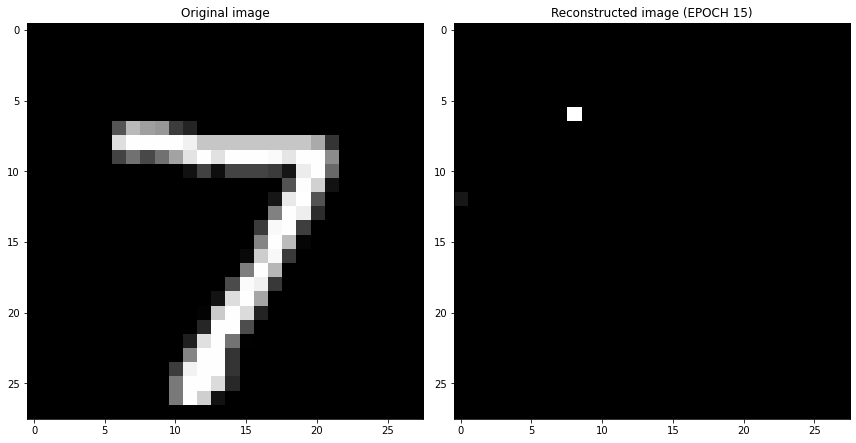

EPOCH 16/30
	 partial train loss (single batch): 0.110146
	 partial train loss (single batch): 0.107206
	 partial train loss (single batch): 0.111343
	 partial train loss (single batch): 0.112387
	 partial train loss (single batch): 0.108826
	 partial train loss (single batch): 0.112566
	 partial train loss (single batch): 0.110888
	 partial train loss (single batch): 0.108917
	 partial train loss (single batch): 0.111544
	 partial train loss (single batch): 0.108612
	 partial train loss (single batch): 0.109805
	 partial train loss (single batch): 0.119005
	 partial train loss (single batch): 0.111686
	 partial train loss (single batch): 0.113239
	 partial train loss (single batch): 0.114761
	 partial train loss (single batch): 0.111388
	 partial train loss (single batch): 0.110680
	 partial train loss (single batch): 0.115324
	 partial train loss (single batch): 0.110206
	 partial train loss (single batch): 0.112472
	 partial train loss (single batch): 0.106585
	 partial train loss (

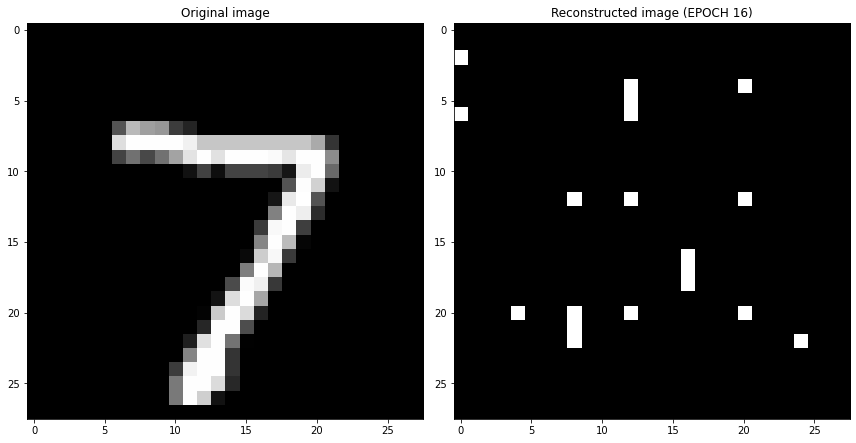

EPOCH 17/30
	 partial train loss (single batch): 0.116197
	 partial train loss (single batch): 0.110357
	 partial train loss (single batch): 0.113641
	 partial train loss (single batch): 0.112067
	 partial train loss (single batch): 0.107169
	 partial train loss (single batch): 0.112757
	 partial train loss (single batch): 0.108968
	 partial train loss (single batch): 0.107369
	 partial train loss (single batch): 0.109155
	 partial train loss (single batch): 0.109651
	 partial train loss (single batch): 0.113341
	 partial train loss (single batch): 0.114465
	 partial train loss (single batch): 0.112703
	 partial train loss (single batch): 0.117538
	 partial train loss (single batch): 0.110982
	 partial train loss (single batch): 0.110560
	 partial train loss (single batch): 0.111248
	 partial train loss (single batch): 0.112016
	 partial train loss (single batch): 0.107724
	 partial train loss (single batch): 0.113557
	 partial train loss (single batch): 0.112338
	 partial train loss (

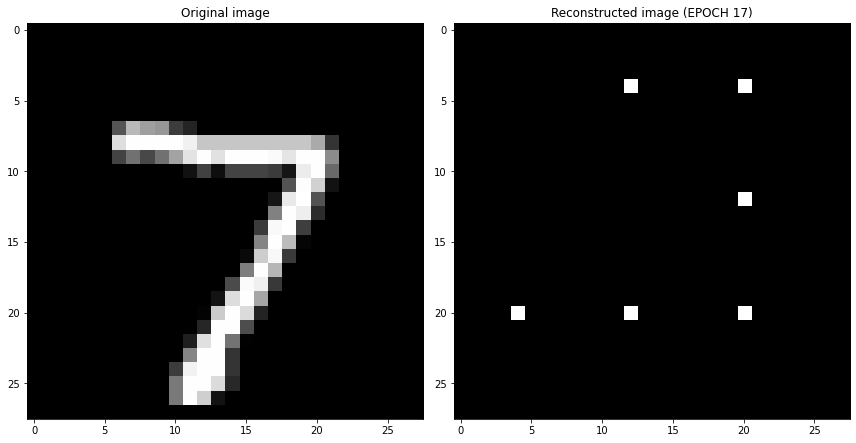

EPOCH 18/30
	 partial train loss (single batch): 0.114537
	 partial train loss (single batch): 0.109422
	 partial train loss (single batch): 0.104637
	 partial train loss (single batch): 0.108900
	 partial train loss (single batch): 0.111616
	 partial train loss (single batch): 0.110818
	 partial train loss (single batch): 0.112924
	 partial train loss (single batch): 0.112732
	 partial train loss (single batch): 0.111865
	 partial train loss (single batch): 0.110957
	 partial train loss (single batch): 0.113118
	 partial train loss (single batch): 0.115052
	 partial train loss (single batch): 0.113080
	 partial train loss (single batch): 0.112401
	 partial train loss (single batch): 0.114562
	 partial train loss (single batch): 0.110983
	 partial train loss (single batch): 0.111459
	 partial train loss (single batch): 0.106091
	 partial train loss (single batch): 0.110169
	 partial train loss (single batch): 0.106164
	 partial train loss (single batch): 0.113449
	 partial train loss (

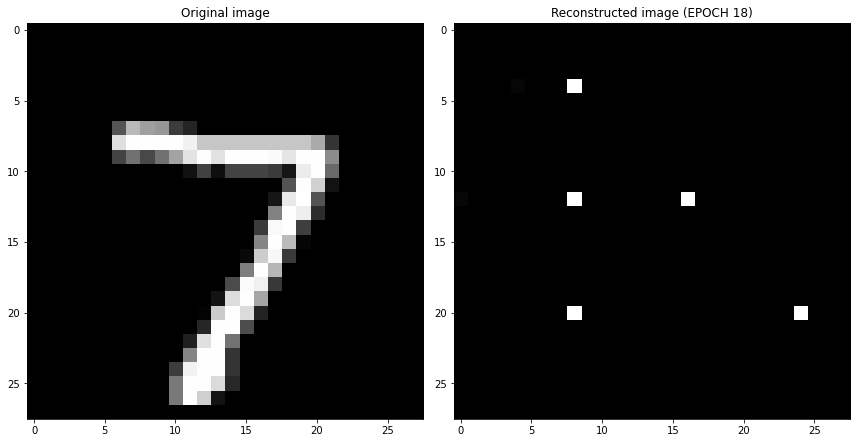

EPOCH 19/30
	 partial train loss (single batch): 0.113283
	 partial train loss (single batch): 0.110490
	 partial train loss (single batch): 0.113530
	 partial train loss (single batch): 0.107908
	 partial train loss (single batch): 0.116528
	 partial train loss (single batch): 0.109160
	 partial train loss (single batch): 0.114422
	 partial train loss (single batch): 0.113098
	 partial train loss (single batch): 0.111826
	 partial train loss (single batch): 0.109830
	 partial train loss (single batch): 0.111382
	 partial train loss (single batch): 0.111446
	 partial train loss (single batch): 0.109996
	 partial train loss (single batch): 0.113283
	 partial train loss (single batch): 0.110614
	 partial train loss (single batch): 0.110308
	 partial train loss (single batch): 0.112170
	 partial train loss (single batch): 0.111557
	 partial train loss (single batch): 0.108847
	 partial train loss (single batch): 0.111961
	 partial train loss (single batch): 0.109198
	 partial train loss (

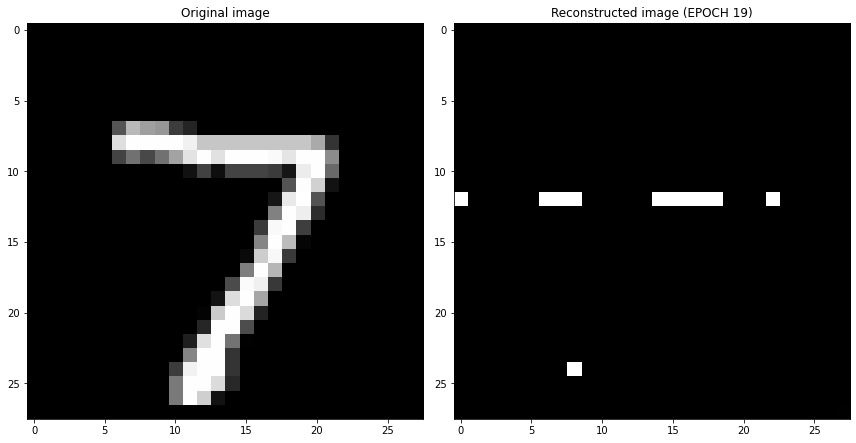

EPOCH 20/30
	 partial train loss (single batch): 0.114534
	 partial train loss (single batch): 0.109845
	 partial train loss (single batch): 0.109235
	 partial train loss (single batch): 0.113637
	 partial train loss (single batch): 0.107573
	 partial train loss (single batch): 0.107075
	 partial train loss (single batch): 0.107035
	 partial train loss (single batch): 0.111379
	 partial train loss (single batch): 0.110027
	 partial train loss (single batch): 0.109442
	 partial train loss (single batch): 0.109954
	 partial train loss (single batch): 0.112810
	 partial train loss (single batch): 0.110712
	 partial train loss (single batch): 0.108352
	 partial train loss (single batch): 0.111305
	 partial train loss (single batch): 0.111570
	 partial train loss (single batch): 0.109739
	 partial train loss (single batch): 0.112841
	 partial train loss (single batch): 0.109763
	 partial train loss (single batch): 0.111456
	 partial train loss (single batch): 0.109817
	 partial train loss (

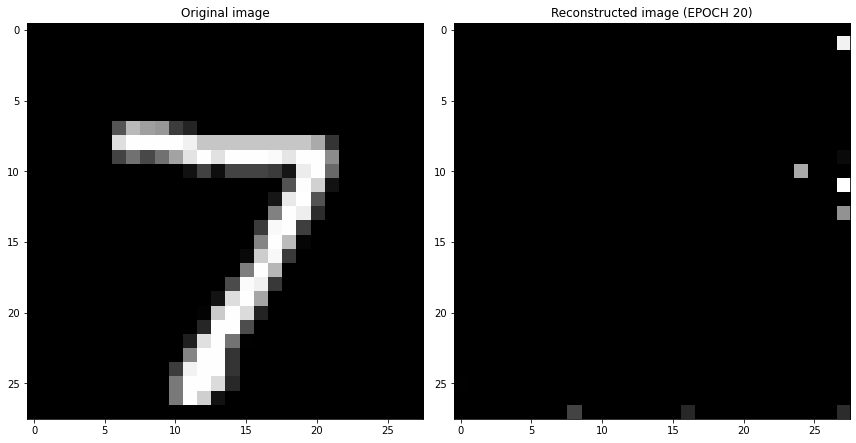

EPOCH 21/30
	 partial train loss (single batch): 0.110723
	 partial train loss (single batch): 0.115015
	 partial train loss (single batch): 0.114292
	 partial train loss (single batch): 0.109080
	 partial train loss (single batch): 0.115869
	 partial train loss (single batch): 0.107450
	 partial train loss (single batch): 0.114745
	 partial train loss (single batch): 0.111703
	 partial train loss (single batch): 0.114061
	 partial train loss (single batch): 0.110657
	 partial train loss (single batch): 0.111789
	 partial train loss (single batch): 0.111398
	 partial train loss (single batch): 0.111363
	 partial train loss (single batch): 0.110995
	 partial train loss (single batch): 0.110028
	 partial train loss (single batch): 0.112392
	 partial train loss (single batch): 0.110040
	 partial train loss (single batch): 0.111815
	 partial train loss (single batch): 0.108201
	 partial train loss (single batch): 0.111144
	 partial train loss (single batch): 0.116312
	 partial train loss (

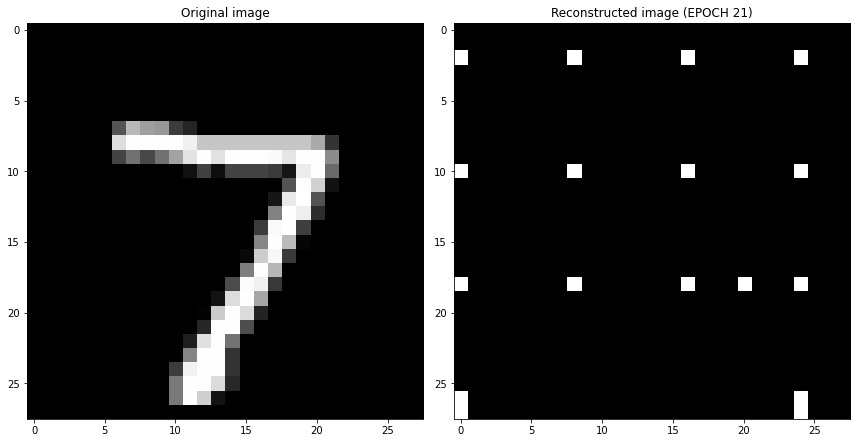

EPOCH 22/30
	 partial train loss (single batch): 0.108808
	 partial train loss (single batch): 0.114122
	 partial train loss (single batch): 0.109311
	 partial train loss (single batch): 0.113384
	 partial train loss (single batch): 0.108979
	 partial train loss (single batch): 0.109255
	 partial train loss (single batch): 0.115872
	 partial train loss (single batch): 0.113041
	 partial train loss (single batch): 0.108842
	 partial train loss (single batch): 0.108409
	 partial train loss (single batch): 0.110316
	 partial train loss (single batch): 0.107767
	 partial train loss (single batch): 0.109073
	 partial train loss (single batch): 0.116440
	 partial train loss (single batch): 0.114380
	 partial train loss (single batch): 0.109483
	 partial train loss (single batch): 0.109761
	 partial train loss (single batch): 0.111904
	 partial train loss (single batch): 0.110106
	 partial train loss (single batch): 0.106764
	 partial train loss (single batch): 0.108666
	 partial train loss (

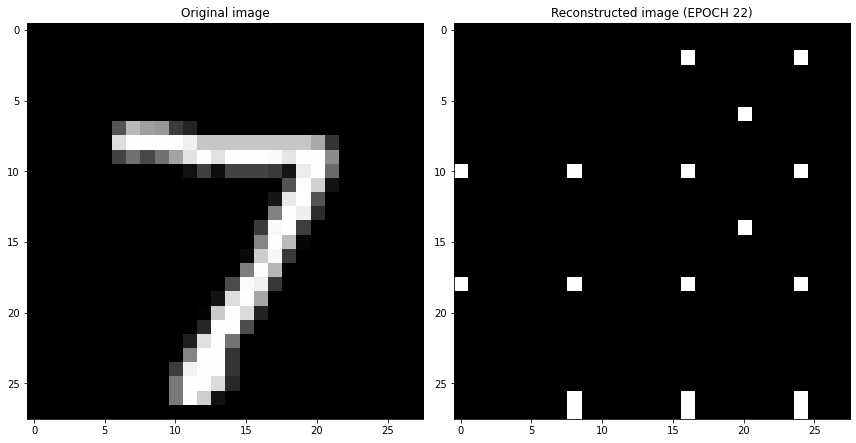

EPOCH 23/30
	 partial train loss (single batch): 0.113787
	 partial train loss (single batch): 0.113834
	 partial train loss (single batch): 0.110953
	 partial train loss (single batch): 0.112022
	 partial train loss (single batch): 0.111932
	 partial train loss (single batch): 0.108552
	 partial train loss (single batch): 0.106061
	 partial train loss (single batch): 0.108199
	 partial train loss (single batch): 0.113034
	 partial train loss (single batch): 0.108253
	 partial train loss (single batch): 0.110186
	 partial train loss (single batch): 0.114799
	 partial train loss (single batch): 0.110380
	 partial train loss (single batch): 0.107211
	 partial train loss (single batch): 0.112078
	 partial train loss (single batch): 0.109953
	 partial train loss (single batch): 0.114307
	 partial train loss (single batch): 0.114334
	 partial train loss (single batch): 0.114514
	 partial train loss (single batch): 0.111225
	 partial train loss (single batch): 0.112284
	 partial train loss (

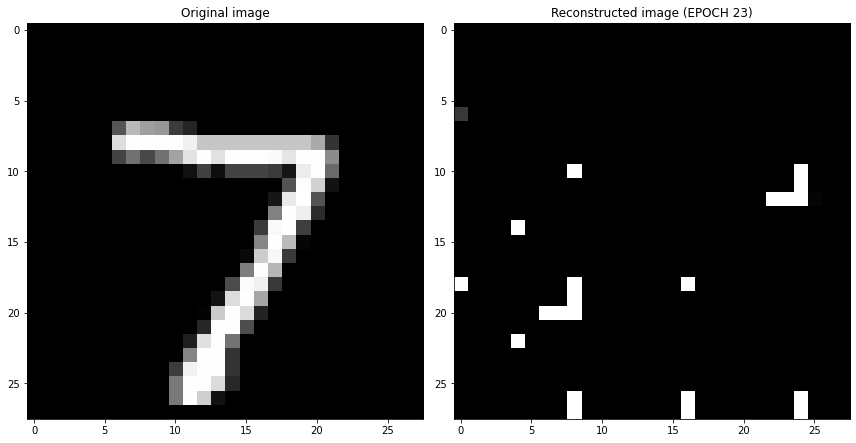

EPOCH 24/30
	 partial train loss (single batch): 0.108647
	 partial train loss (single batch): 0.111849
	 partial train loss (single batch): 0.112421
	 partial train loss (single batch): 0.111857
	 partial train loss (single batch): 0.105254
	 partial train loss (single batch): 0.108938
	 partial train loss (single batch): 0.111238
	 partial train loss (single batch): 0.110258
	 partial train loss (single batch): 0.112075
	 partial train loss (single batch): 0.112318
	 partial train loss (single batch): 0.110719
	 partial train loss (single batch): 0.110684
	 partial train loss (single batch): 0.113193
	 partial train loss (single batch): 0.115068
	 partial train loss (single batch): 0.116928
	 partial train loss (single batch): 0.111835
	 partial train loss (single batch): 0.110912
	 partial train loss (single batch): 0.112513
	 partial train loss (single batch): 0.112992
	 partial train loss (single batch): 0.108168
	 partial train loss (single batch): 0.108005
	 partial train loss (

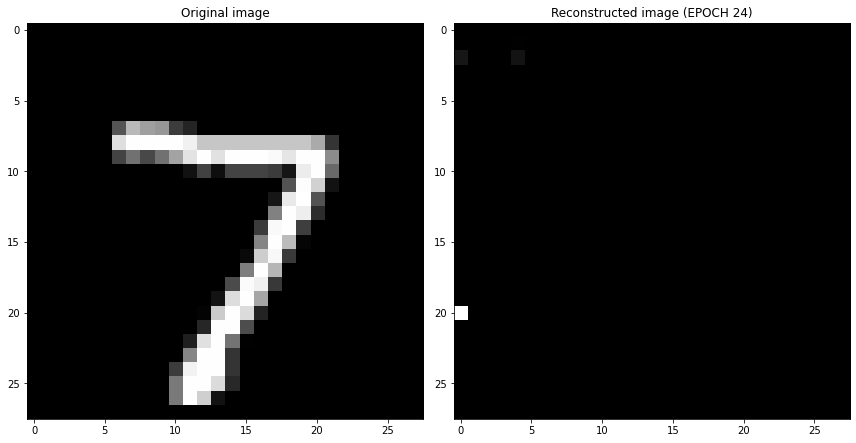

EPOCH 25/30
	 partial train loss (single batch): 0.111089
	 partial train loss (single batch): 0.110339
	 partial train loss (single batch): 0.110677
	 partial train loss (single batch): 0.110880
	 partial train loss (single batch): 0.108348
	 partial train loss (single batch): 0.111768
	 partial train loss (single batch): 0.113398
	 partial train loss (single batch): 0.112946
	 partial train loss (single batch): 0.115597
	 partial train loss (single batch): 0.111154
	 partial train loss (single batch): 0.109803
	 partial train loss (single batch): 0.110103
	 partial train loss (single batch): 0.113590
	 partial train loss (single batch): 0.112324
	 partial train loss (single batch): 0.109284
	 partial train loss (single batch): 0.113449
	 partial train loss (single batch): 0.110549
	 partial train loss (single batch): 0.113249
	 partial train loss (single batch): 0.115887
	 partial train loss (single batch): 0.107842
	 partial train loss (single batch): 0.110912
	 partial train loss (

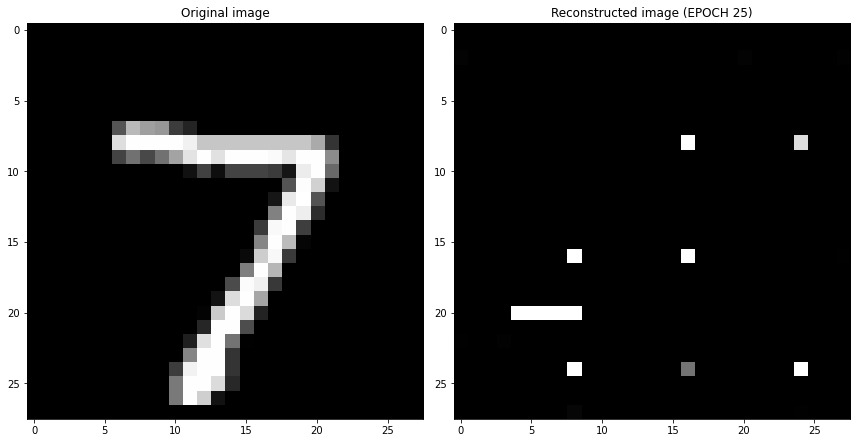

EPOCH 26/30
	 partial train loss (single batch): 0.111861
	 partial train loss (single batch): 0.111130
	 partial train loss (single batch): 0.110175
	 partial train loss (single batch): 0.111440
	 partial train loss (single batch): 0.112209
	 partial train loss (single batch): 0.104079
	 partial train loss (single batch): 0.109154
	 partial train loss (single batch): 0.113231
	 partial train loss (single batch): 0.111048
	 partial train loss (single batch): 0.109160
	 partial train loss (single batch): 0.113747
	 partial train loss (single batch): 0.107764
	 partial train loss (single batch): 0.111449
	 partial train loss (single batch): 0.106696
	 partial train loss (single batch): 0.105502
	 partial train loss (single batch): 0.115151
	 partial train loss (single batch): 0.114017
	 partial train loss (single batch): 0.110249
	 partial train loss (single batch): 0.111631
	 partial train loss (single batch): 0.113152
	 partial train loss (single batch): 0.109316
	 partial train loss (

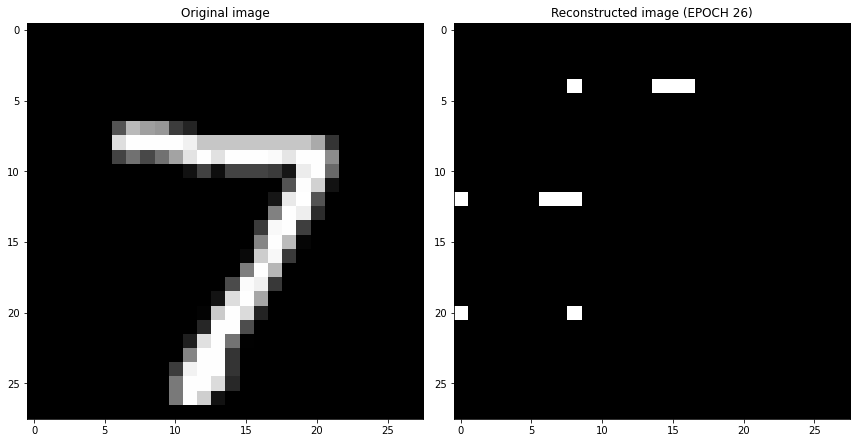

EPOCH 27/30
	 partial train loss (single batch): 0.110016
	 partial train loss (single batch): 0.110440
	 partial train loss (single batch): 0.111599
	 partial train loss (single batch): 0.111775
	 partial train loss (single batch): 0.112278
	 partial train loss (single batch): 0.109359
	 partial train loss (single batch): 0.111386
	 partial train loss (single batch): 0.110974
	 partial train loss (single batch): 0.115164
	 partial train loss (single batch): 0.110166
	 partial train loss (single batch): 0.113440
	 partial train loss (single batch): 0.110050
	 partial train loss (single batch): 0.115298
	 partial train loss (single batch): 0.110825
	 partial train loss (single batch): 0.112323
	 partial train loss (single batch): 0.109822
	 partial train loss (single batch): 0.113114
	 partial train loss (single batch): 0.110531
	 partial train loss (single batch): 0.110763
	 partial train loss (single batch): 0.115555
	 partial train loss (single batch): 0.110602
	 partial train loss (

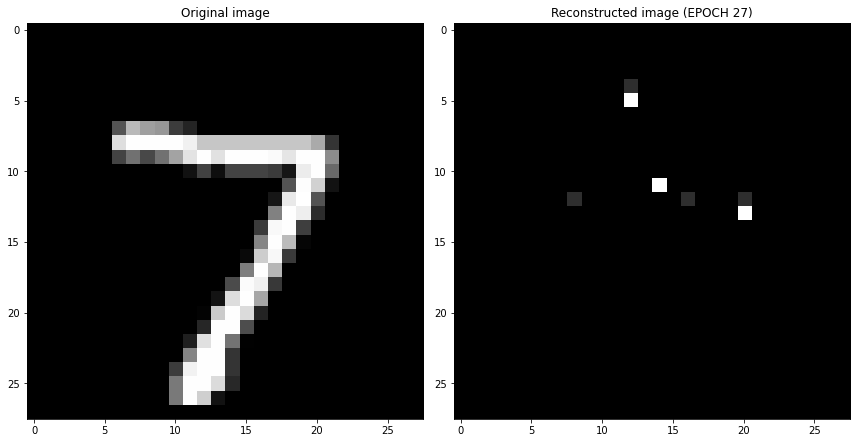

EPOCH 28/30
	 partial train loss (single batch): 0.110746
	 partial train loss (single batch): 0.116953
	 partial train loss (single batch): 0.112894
	 partial train loss (single batch): 0.110640
	 partial train loss (single batch): 0.113857
	 partial train loss (single batch): 0.116715
	 partial train loss (single batch): 0.108883
	 partial train loss (single batch): 0.112579
	 partial train loss (single batch): 0.111267
	 partial train loss (single batch): 0.115498
	 partial train loss (single batch): 0.112158
	 partial train loss (single batch): 0.109614
	 partial train loss (single batch): 0.110207
	 partial train loss (single batch): 0.113398
	 partial train loss (single batch): 0.107968
	 partial train loss (single batch): 0.108680
	 partial train loss (single batch): 0.109899
	 partial train loss (single batch): 0.111901
	 partial train loss (single batch): 0.112007
	 partial train loss (single batch): 0.112115
	 partial train loss (single batch): 0.113033
	 partial train loss (

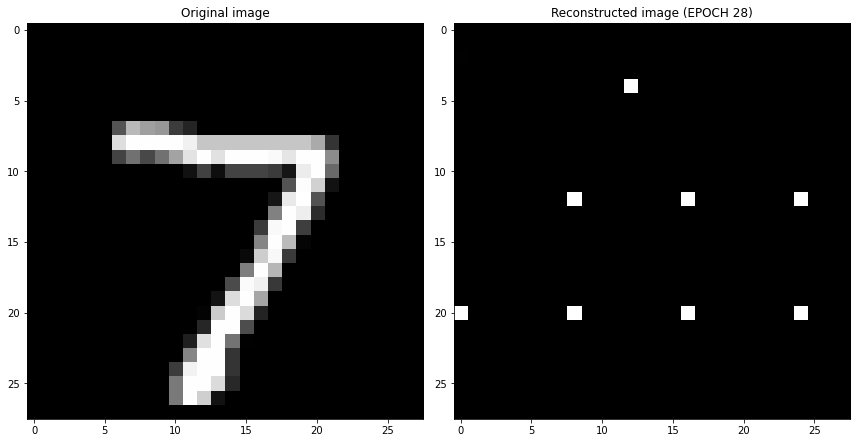

EPOCH 29/30
	 partial train loss (single batch): 0.111064
	 partial train loss (single batch): 0.113451
	 partial train loss (single batch): 0.113054
	 partial train loss (single batch): 0.114935
	 partial train loss (single batch): 0.115411
	 partial train loss (single batch): 0.111382
	 partial train loss (single batch): 0.111177
	 partial train loss (single batch): 0.114278
	 partial train loss (single batch): 0.111018
	 partial train loss (single batch): 0.112770
	 partial train loss (single batch): 0.106994
	 partial train loss (single batch): 0.108245
	 partial train loss (single batch): 0.112511
	 partial train loss (single batch): 0.109288
	 partial train loss (single batch): 0.106547
	 partial train loss (single batch): 0.110690
	 partial train loss (single batch): 0.110616
	 partial train loss (single batch): 0.108723
	 partial train loss (single batch): 0.110923
	 partial train loss (single batch): 0.109275
	 partial train loss (single batch): 0.115593
	 partial train loss (

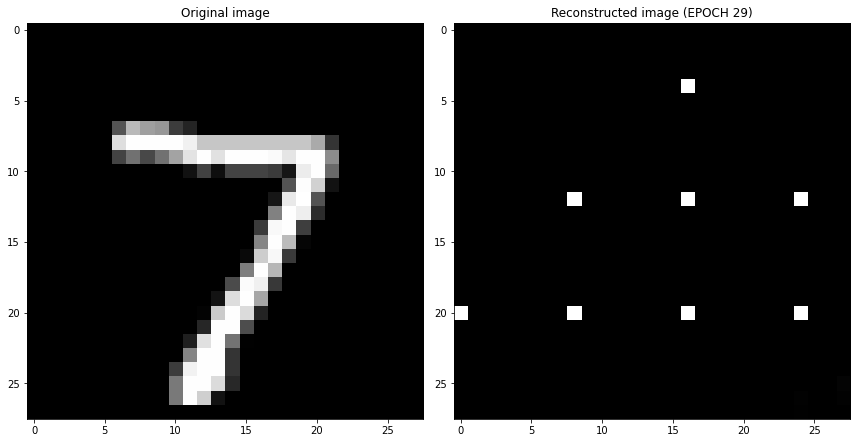

EPOCH 30/30
	 partial train loss (single batch): 0.109702
	 partial train loss (single batch): 0.113011
	 partial train loss (single batch): 0.112042
	 partial train loss (single batch): 0.111275
	 partial train loss (single batch): 0.110767
	 partial train loss (single batch): 0.109480
	 partial train loss (single batch): 0.113456
	 partial train loss (single batch): 0.110104
	 partial train loss (single batch): 0.113122
	 partial train loss (single batch): 0.107947
	 partial train loss (single batch): 0.110815
	 partial train loss (single batch): 0.111686
	 partial train loss (single batch): 0.109759
	 partial train loss (single batch): 0.111972
	 partial train loss (single batch): 0.111261
	 partial train loss (single batch): 0.115766
	 partial train loss (single batch): 0.111258
	 partial train loss (single batch): 0.110415
	 partial train loss (single batch): 0.111554
	 partial train loss (single batch): 0.106198
	 partial train loss (single batch): 0.108764
	 partial train loss (

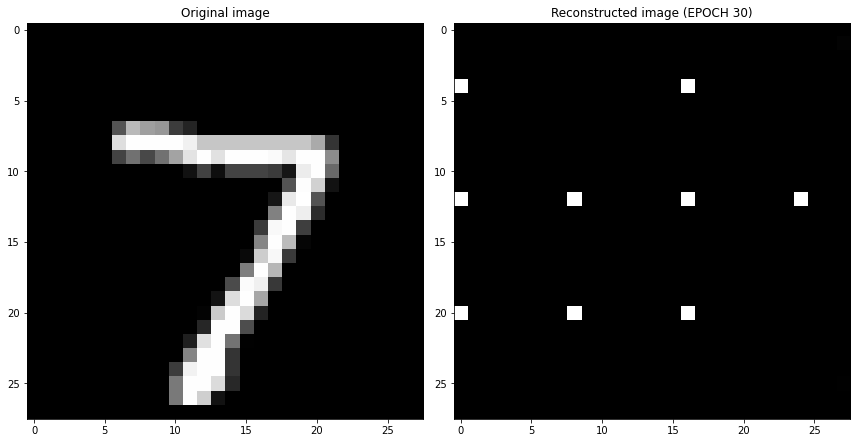

Cross validation fold number= 3/6
EPOCH 1/30
	 partial train loss (single batch): 0.211384
	 partial train loss (single batch): 0.130828
	 partial train loss (single batch): 0.112883
	 partial train loss (single batch): 0.110783
	 partial train loss (single batch): 0.107213
	 partial train loss (single batch): 0.116071
	 partial train loss (single batch): 0.112363
	 partial train loss (single batch): 0.110697
	 partial train loss (single batch): 0.111302
	 partial train loss (single batch): 0.105704
	 partial train loss (single batch): 0.103615
	 partial train loss (single batch): 0.106938
	 partial train loss (single batch): 0.106687
	 partial train loss (single batch): 0.101696
	 partial train loss (single batch): 0.100284
	 partial train loss (single batch): 0.101356
	 partial train loss (single batch): 0.094530
	 partial train loss (single batch): 0.099318
	 partial train loss (single batch): 0.099216
	 partial train loss (single batch): 0.100857
	 partial train loss (single batch)

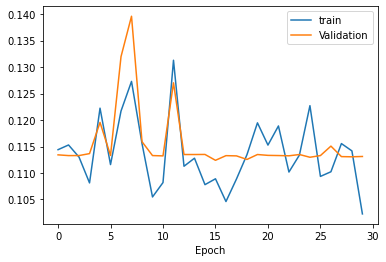

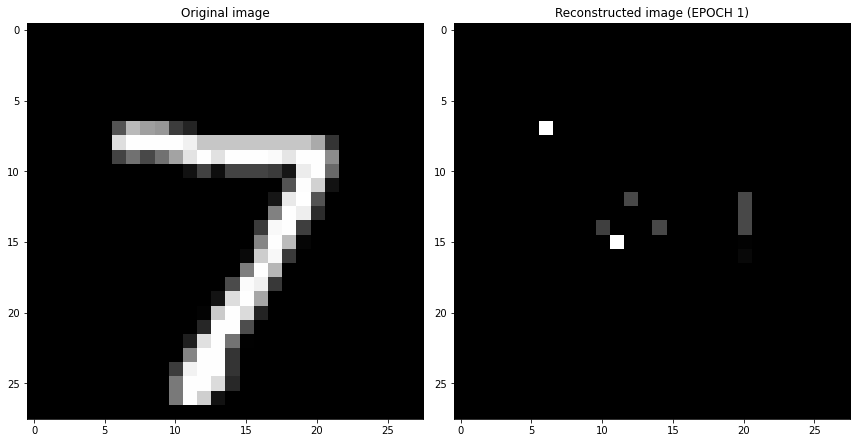

EPOCH 2/30
	 partial train loss (single batch): 0.113238
	 partial train loss (single batch): 0.114312
	 partial train loss (single batch): 0.113982
	 partial train loss (single batch): 0.103755
	 partial train loss (single batch): 0.113160
	 partial train loss (single batch): 0.113509
	 partial train loss (single batch): 0.110821
	 partial train loss (single batch): 0.111393
	 partial train loss (single batch): 0.113122
	 partial train loss (single batch): 0.106337
	 partial train loss (single batch): 0.113546
	 partial train loss (single batch): 0.107677
	 partial train loss (single batch): 0.108409
	 partial train loss (single batch): 0.115219
	 partial train loss (single batch): 0.112913
	 partial train loss (single batch): 0.113093
	 partial train loss (single batch): 0.110525
	 partial train loss (single batch): 0.110918
	 partial train loss (single batch): 0.114866
	 partial train loss (single batch): 0.113775
	 partial train loss (single batch): 0.112816
	 partial train loss (s

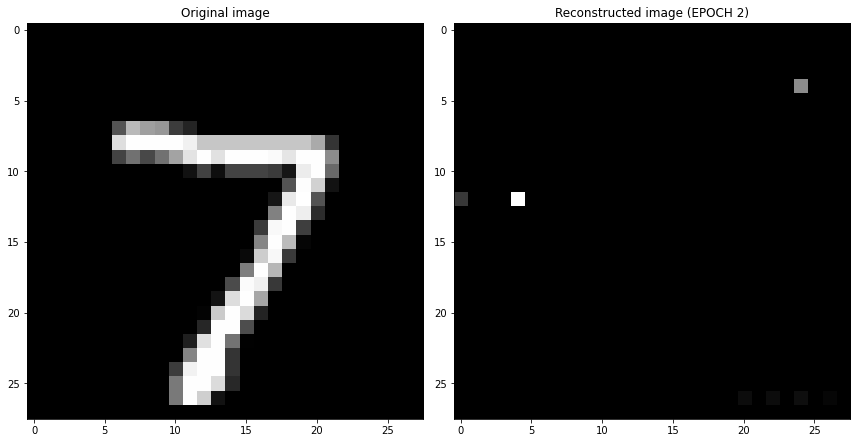

EPOCH 3/30
	 partial train loss (single batch): 0.108811
	 partial train loss (single batch): 0.109219
	 partial train loss (single batch): 0.112705
	 partial train loss (single batch): 0.108925
	 partial train loss (single batch): 0.108345
	 partial train loss (single batch): 0.108169
	 partial train loss (single batch): 0.113317
	 partial train loss (single batch): 0.113819
	 partial train loss (single batch): 0.117064
	 partial train loss (single batch): 0.111510
	 partial train loss (single batch): 0.109782
	 partial train loss (single batch): 0.110517
	 partial train loss (single batch): 0.110993
	 partial train loss (single batch): 0.111704
	 partial train loss (single batch): 0.113449
	 partial train loss (single batch): 0.111615
	 partial train loss (single batch): 0.111720
	 partial train loss (single batch): 0.113148
	 partial train loss (single batch): 0.112836
	 partial train loss (single batch): 0.110633
	 partial train loss (single batch): 0.108944
	 partial train loss (s

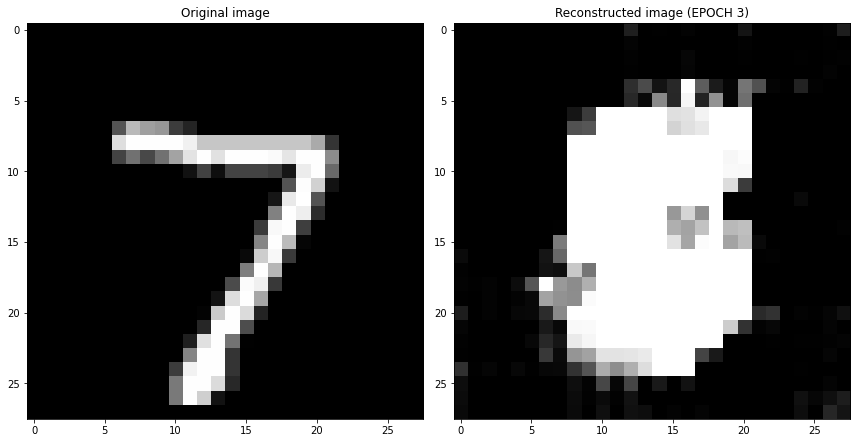

EPOCH 4/30
	 partial train loss (single batch): 0.073161
	 partial train loss (single batch): 0.071515
	 partial train loss (single batch): 0.073614
	 partial train loss (single batch): 0.070171
	 partial train loss (single batch): 0.070174
	 partial train loss (single batch): 0.073324
	 partial train loss (single batch): 0.071228
	 partial train loss (single batch): 0.068861
	 partial train loss (single batch): 0.072008
	 partial train loss (single batch): 0.073505
	 partial train loss (single batch): 0.069922
	 partial train loss (single batch): 0.071265
	 partial train loss (single batch): 0.071910
	 partial train loss (single batch): 0.069956
	 partial train loss (single batch): 0.070634
	 partial train loss (single batch): 0.071589
	 partial train loss (single batch): 0.072462
	 partial train loss (single batch): 0.071249
	 partial train loss (single batch): 0.071335
	 partial train loss (single batch): 0.071107
	 partial train loss (single batch): 0.071480
	 partial train loss (s

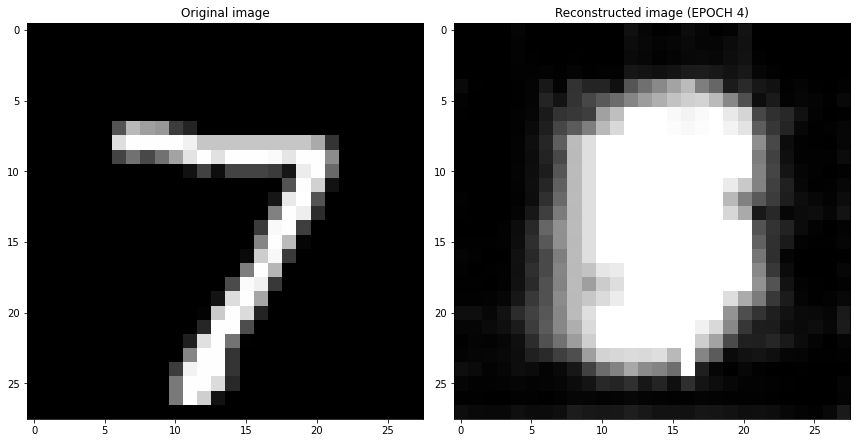

EPOCH 5/30
	 partial train loss (single batch): 0.067130
	 partial train loss (single batch): 0.068372
	 partial train loss (single batch): 0.067785
	 partial train loss (single batch): 0.070523
	 partial train loss (single batch): 0.069625
	 partial train loss (single batch): 0.067609
	 partial train loss (single batch): 0.069405
	 partial train loss (single batch): 0.068717
	 partial train loss (single batch): 0.066205
	 partial train loss (single batch): 0.069805
	 partial train loss (single batch): 0.070183
	 partial train loss (single batch): 0.068243
	 partial train loss (single batch): 0.069436
	 partial train loss (single batch): 0.071069
	 partial train loss (single batch): 0.067053
	 partial train loss (single batch): 0.070016
	 partial train loss (single batch): 0.067693
	 partial train loss (single batch): 0.068371
	 partial train loss (single batch): 0.067265
	 partial train loss (single batch): 0.070281
	 partial train loss (single batch): 0.066689
	 partial train loss (s

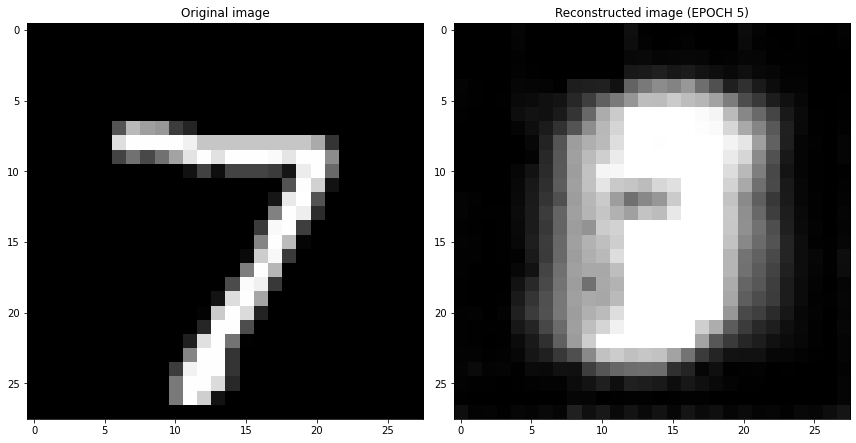

EPOCH 6/30
	 partial train loss (single batch): 0.066791
	 partial train loss (single batch): 0.067661
	 partial train loss (single batch): 0.067975
	 partial train loss (single batch): 0.068026
	 partial train loss (single batch): 0.069302
	 partial train loss (single batch): 0.068133
	 partial train loss (single batch): 0.066787
	 partial train loss (single batch): 0.067761
	 partial train loss (single batch): 0.065816
	 partial train loss (single batch): 0.066398
	 partial train loss (single batch): 0.070178
	 partial train loss (single batch): 0.069522
	 partial train loss (single batch): 0.068235
	 partial train loss (single batch): 0.067964
	 partial train loss (single batch): 0.067015
	 partial train loss (single batch): 0.070213
	 partial train loss (single batch): 0.069571
	 partial train loss (single batch): 0.067913
	 partial train loss (single batch): 0.068533
	 partial train loss (single batch): 0.068025
	 partial train loss (single batch): 0.069045
	 partial train loss (s

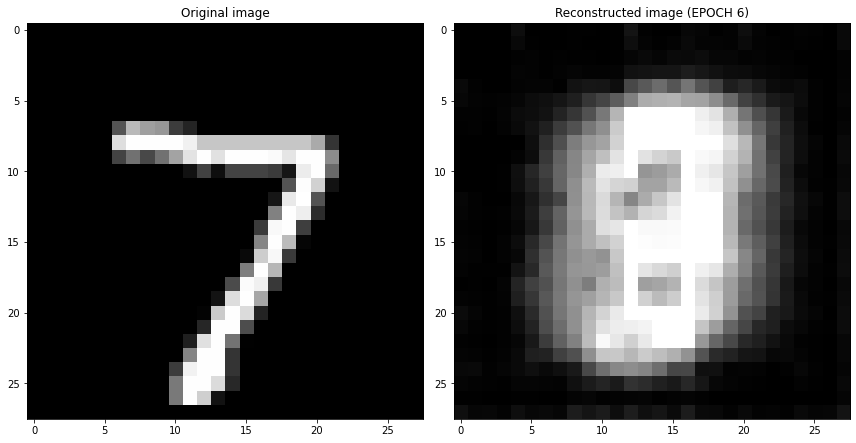

EPOCH 7/30
	 partial train loss (single batch): 0.068488
	 partial train loss (single batch): 0.068389
	 partial train loss (single batch): 0.068804
	 partial train loss (single batch): 0.071198
	 partial train loss (single batch): 0.066120
	 partial train loss (single batch): 0.068172
	 partial train loss (single batch): 0.070169
	 partial train loss (single batch): 0.068103
	 partial train loss (single batch): 0.068970
	 partial train loss (single batch): 0.067466
	 partial train loss (single batch): 0.069133
	 partial train loss (single batch): 0.066968
	 partial train loss (single batch): 0.069051
	 partial train loss (single batch): 0.067197
	 partial train loss (single batch): 0.067594
	 partial train loss (single batch): 0.067302
	 partial train loss (single batch): 0.067060
	 partial train loss (single batch): 0.066988
	 partial train loss (single batch): 0.068987
	 partial train loss (single batch): 0.069217
	 partial train loss (single batch): 0.068191
	 partial train loss (s

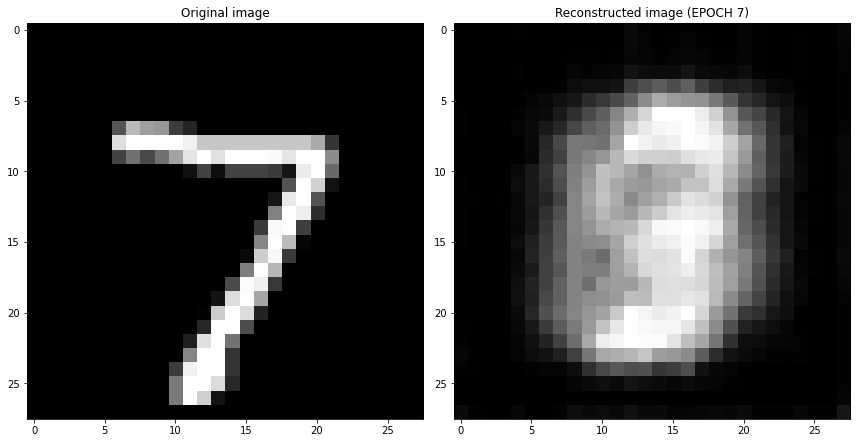

EPOCH 8/30
	 partial train loss (single batch): 0.068220
	 partial train loss (single batch): 0.066628
	 partial train loss (single batch): 0.070298
	 partial train loss (single batch): 0.066471
	 partial train loss (single batch): 0.066051
	 partial train loss (single batch): 0.066119
	 partial train loss (single batch): 0.067215
	 partial train loss (single batch): 0.068169
	 partial train loss (single batch): 0.066480
	 partial train loss (single batch): 0.068535
	 partial train loss (single batch): 0.067019
	 partial train loss (single batch): 0.068339
	 partial train loss (single batch): 0.066071
	 partial train loss (single batch): 0.067360
	 partial train loss (single batch): 0.066784
	 partial train loss (single batch): 0.068192
	 partial train loss (single batch): 0.066425
	 partial train loss (single batch): 0.068129
	 partial train loss (single batch): 0.067974
	 partial train loss (single batch): 0.067688
	 partial train loss (single batch): 0.067663
	 partial train loss (s

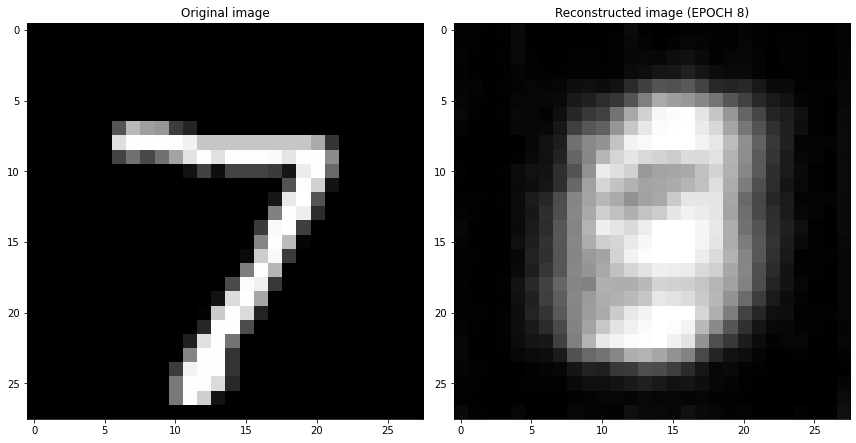

EPOCH 9/30
	 partial train loss (single batch): 0.066564
	 partial train loss (single batch): 0.065339
	 partial train loss (single batch): 0.067225
	 partial train loss (single batch): 0.067458
	 partial train loss (single batch): 0.066006
	 partial train loss (single batch): 0.070459
	 partial train loss (single batch): 0.067080
	 partial train loss (single batch): 0.068559
	 partial train loss (single batch): 0.068143
	 partial train loss (single batch): 0.068296
	 partial train loss (single batch): 0.066869
	 partial train loss (single batch): 0.069854
	 partial train loss (single batch): 0.066552
	 partial train loss (single batch): 0.066820
	 partial train loss (single batch): 0.068318
	 partial train loss (single batch): 0.068235
	 partial train loss (single batch): 0.067130
	 partial train loss (single batch): 0.068738
	 partial train loss (single batch): 0.066572
	 partial train loss (single batch): 0.066783
	 partial train loss (single batch): 0.066009
	 partial train loss (s

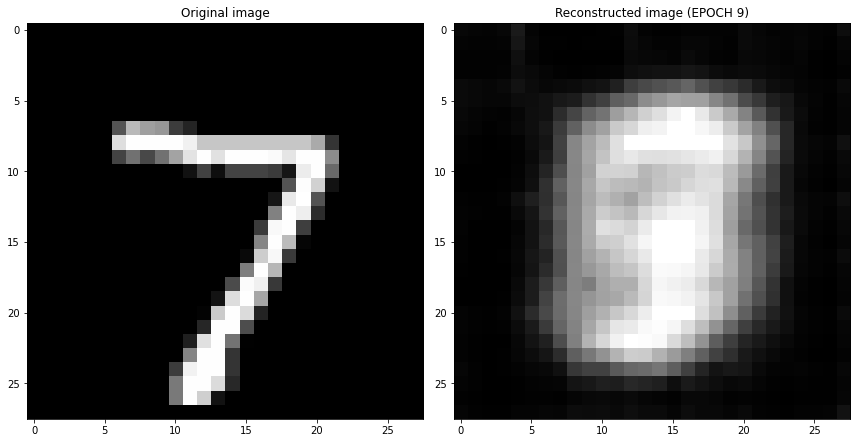

EPOCH 10/30
	 partial train loss (single batch): 0.068359
	 partial train loss (single batch): 0.067149
	 partial train loss (single batch): 0.067440
	 partial train loss (single batch): 0.068084
	 partial train loss (single batch): 0.067620
	 partial train loss (single batch): 0.067872
	 partial train loss (single batch): 0.065640
	 partial train loss (single batch): 0.066831
	 partial train loss (single batch): 0.065781
	 partial train loss (single batch): 0.068836
	 partial train loss (single batch): 0.069020
	 partial train loss (single batch): 0.067488
	 partial train loss (single batch): 0.067053
	 partial train loss (single batch): 0.069310
	 partial train loss (single batch): 0.066159
	 partial train loss (single batch): 0.067033
	 partial train loss (single batch): 0.066419
	 partial train loss (single batch): 0.067195
	 partial train loss (single batch): 0.066890
	 partial train loss (single batch): 0.070774
	 partial train loss (single batch): 0.069322
	 partial train loss (

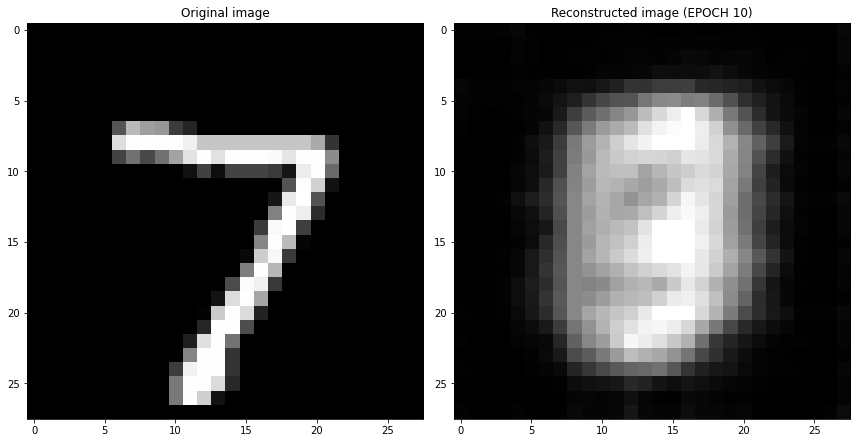

EPOCH 11/30
	 partial train loss (single batch): 0.069719
	 partial train loss (single batch): 0.067966
	 partial train loss (single batch): 0.067080
	 partial train loss (single batch): 0.065948
	 partial train loss (single batch): 0.064791
	 partial train loss (single batch): 0.067727
	 partial train loss (single batch): 0.068525
	 partial train loss (single batch): 0.066942
	 partial train loss (single batch): 0.067684
	 partial train loss (single batch): 0.066314
	 partial train loss (single batch): 0.065604
	 partial train loss (single batch): 0.066408
	 partial train loss (single batch): 0.068587
	 partial train loss (single batch): 0.069486
	 partial train loss (single batch): 0.068133
	 partial train loss (single batch): 0.067403
	 partial train loss (single batch): 0.068312
	 partial train loss (single batch): 0.067994
	 partial train loss (single batch): 0.064834
	 partial train loss (single batch): 0.067337
	 partial train loss (single batch): 0.066612
	 partial train loss (

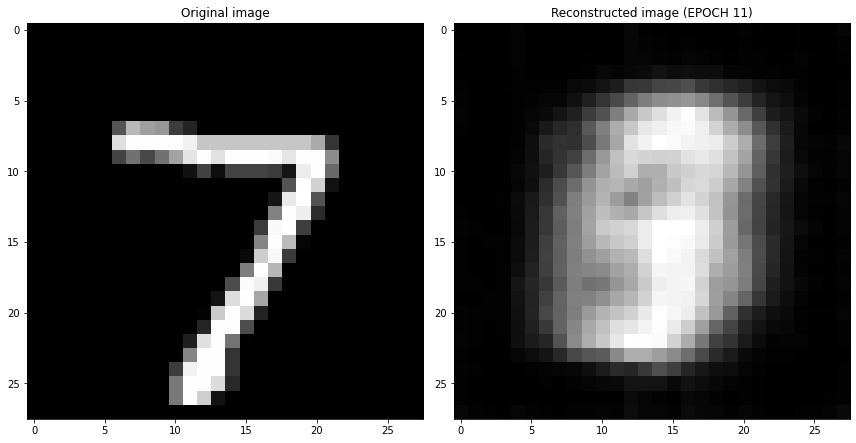

EPOCH 12/30
	 partial train loss (single batch): 0.066630
	 partial train loss (single batch): 0.067867
	 partial train loss (single batch): 0.069363
	 partial train loss (single batch): 0.067469
	 partial train loss (single batch): 0.067670
	 partial train loss (single batch): 0.065673
	 partial train loss (single batch): 0.066749
	 partial train loss (single batch): 0.067244
	 partial train loss (single batch): 0.069146
	 partial train loss (single batch): 0.067467
	 partial train loss (single batch): 0.066207
	 partial train loss (single batch): 0.066049
	 partial train loss (single batch): 0.066633
	 partial train loss (single batch): 0.068103
	 partial train loss (single batch): 0.067767
	 partial train loss (single batch): 0.068538
	 partial train loss (single batch): 0.067368
	 partial train loss (single batch): 0.068109
	 partial train loss (single batch): 0.067995
	 partial train loss (single batch): 0.068950
	 partial train loss (single batch): 0.067700
	 partial train loss (

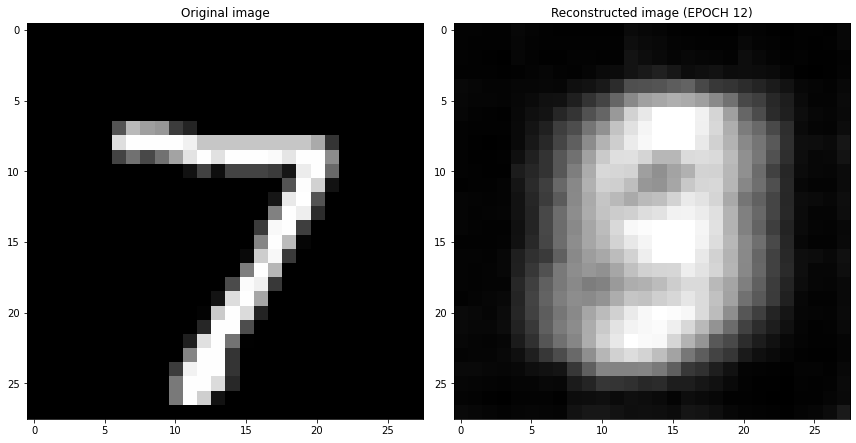

EPOCH 13/30
	 partial train loss (single batch): 0.067835
	 partial train loss (single batch): 0.067173
	 partial train loss (single batch): 0.067955
	 partial train loss (single batch): 0.069068
	 partial train loss (single batch): 0.067205
	 partial train loss (single batch): 0.069406
	 partial train loss (single batch): 0.066444
	 partial train loss (single batch): 0.068702
	 partial train loss (single batch): 0.065290
	 partial train loss (single batch): 0.066467
	 partial train loss (single batch): 0.069269
	 partial train loss (single batch): 0.070021
	 partial train loss (single batch): 0.069010
	 partial train loss (single batch): 0.067467
	 partial train loss (single batch): 0.067489
	 partial train loss (single batch): 0.068484
	 partial train loss (single batch): 0.067828
	 partial train loss (single batch): 0.068476
	 partial train loss (single batch): 0.068158
	 partial train loss (single batch): 0.068188
	 partial train loss (single batch): 0.065866
	 partial train loss (

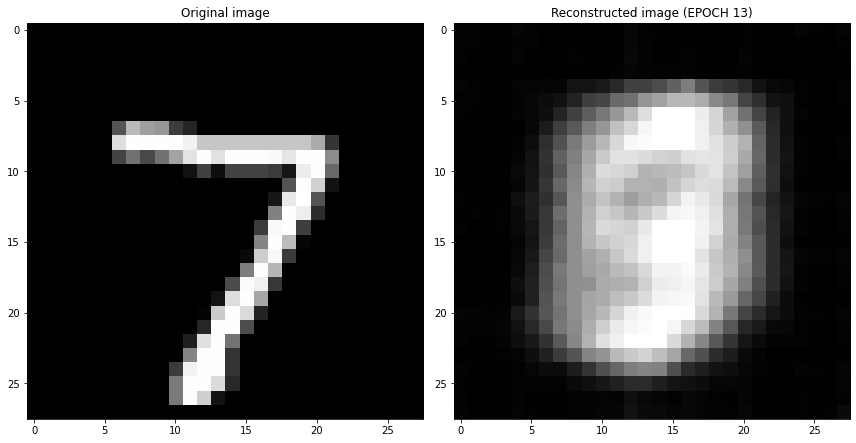

EPOCH 14/30
	 partial train loss (single batch): 0.066174
	 partial train loss (single batch): 0.067213
	 partial train loss (single batch): 0.068385
	 partial train loss (single batch): 0.068080
	 partial train loss (single batch): 0.068166
	 partial train loss (single batch): 0.070609
	 partial train loss (single batch): 0.067901
	 partial train loss (single batch): 0.069970
	 partial train loss (single batch): 0.067139
	 partial train loss (single batch): 0.068290
	 partial train loss (single batch): 0.065921
	 partial train loss (single batch): 0.066486
	 partial train loss (single batch): 0.065553
	 partial train loss (single batch): 0.064360
	 partial train loss (single batch): 0.067104
	 partial train loss (single batch): 0.067522
	 partial train loss (single batch): 0.067945
	 partial train loss (single batch): 0.066098
	 partial train loss (single batch): 0.068743
	 partial train loss (single batch): 0.067392
	 partial train loss (single batch): 0.065563
	 partial train loss (

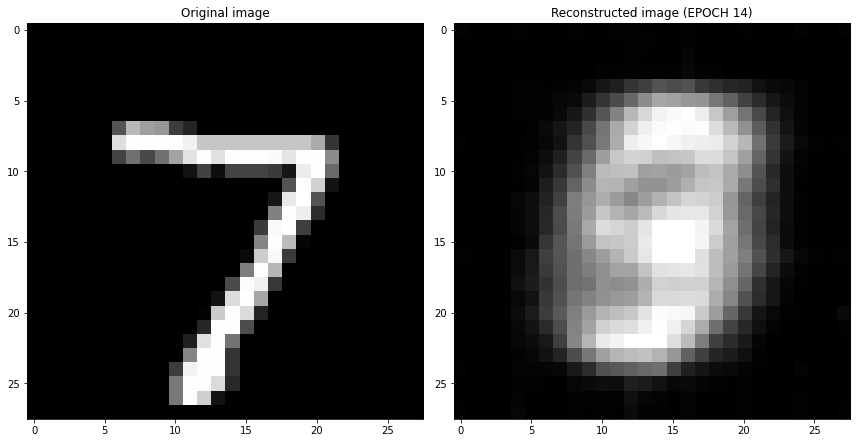

EPOCH 15/30
	 partial train loss (single batch): 0.067487
	 partial train loss (single batch): 0.065842
	 partial train loss (single batch): 0.069122
	 partial train loss (single batch): 0.066773
	 partial train loss (single batch): 0.066476
	 partial train loss (single batch): 0.070515
	 partial train loss (single batch): 0.070022
	 partial train loss (single batch): 0.067497
	 partial train loss (single batch): 0.066702
	 partial train loss (single batch): 0.069214
	 partial train loss (single batch): 0.068350
	 partial train loss (single batch): 0.065412
	 partial train loss (single batch): 0.068674
	 partial train loss (single batch): 0.065762
	 partial train loss (single batch): 0.068274
	 partial train loss (single batch): 0.068568
	 partial train loss (single batch): 0.064588
	 partial train loss (single batch): 0.068626
	 partial train loss (single batch): 0.064643
	 partial train loss (single batch): 0.066429
	 partial train loss (single batch): 0.069347
	 partial train loss (

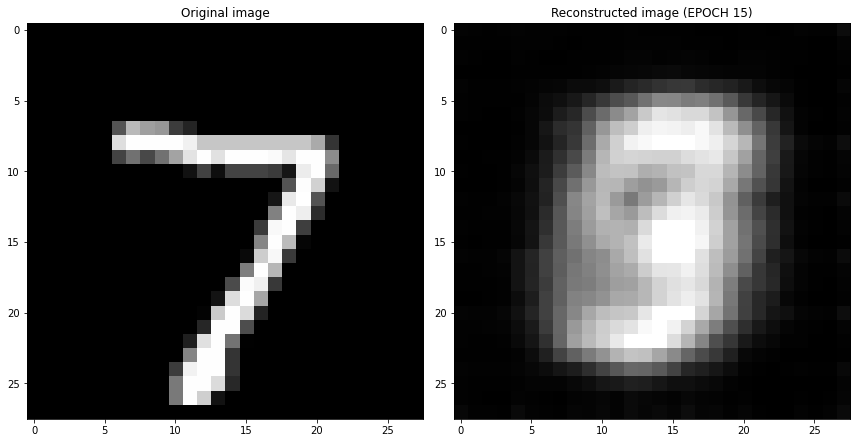

EPOCH 16/30
	 partial train loss (single batch): 0.069867
	 partial train loss (single batch): 0.065910
	 partial train loss (single batch): 0.067561
	 partial train loss (single batch): 0.069291
	 partial train loss (single batch): 0.066741
	 partial train loss (single batch): 0.066898
	 partial train loss (single batch): 0.065680
	 partial train loss (single batch): 0.066168
	 partial train loss (single batch): 0.067153
	 partial train loss (single batch): 0.068134
	 partial train loss (single batch): 0.067939
	 partial train loss (single batch): 0.067502
	 partial train loss (single batch): 0.066854
	 partial train loss (single batch): 0.066156
	 partial train loss (single batch): 0.067181
	 partial train loss (single batch): 0.067227
	 partial train loss (single batch): 0.069307
	 partial train loss (single batch): 0.067480
	 partial train loss (single batch): 0.068582
	 partial train loss (single batch): 0.067217
	 partial train loss (single batch): 0.067040
	 partial train loss (

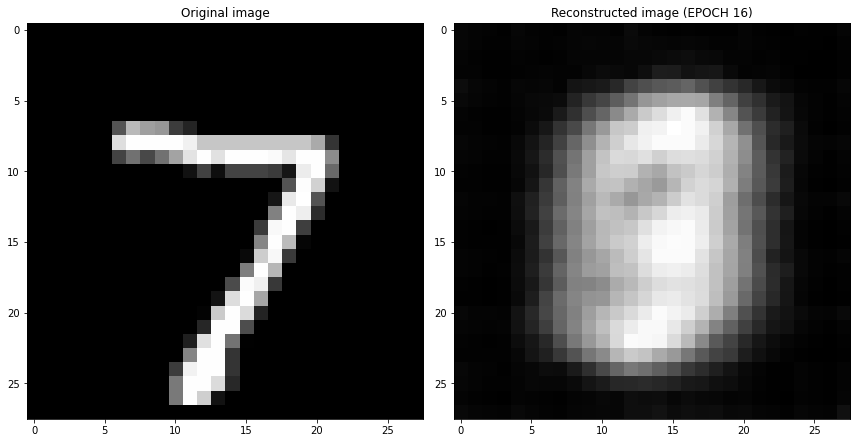

EPOCH 17/30
	 partial train loss (single batch): 0.066113
	 partial train loss (single batch): 0.066326
	 partial train loss (single batch): 0.066632
	 partial train loss (single batch): 0.066287
	 partial train loss (single batch): 0.064725
	 partial train loss (single batch): 0.069116
	 partial train loss (single batch): 0.068932
	 partial train loss (single batch): 0.067698
	 partial train loss (single batch): 0.067325
	 partial train loss (single batch): 0.065965
	 partial train loss (single batch): 0.067898
	 partial train loss (single batch): 0.066595
	 partial train loss (single batch): 0.068109
	 partial train loss (single batch): 0.066748
	 partial train loss (single batch): 0.064788
	 partial train loss (single batch): 0.069613
	 partial train loss (single batch): 0.065903
	 partial train loss (single batch): 0.067790
	 partial train loss (single batch): 0.069100
	 partial train loss (single batch): 0.065806
	 partial train loss (single batch): 0.067314
	 partial train loss (

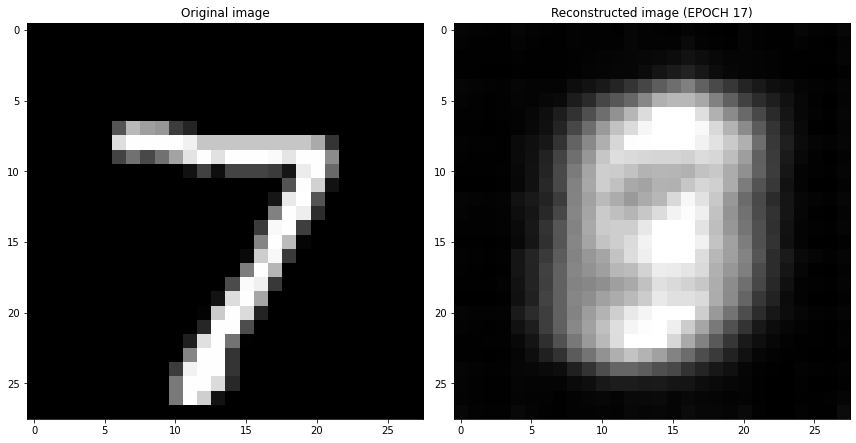

EPOCH 18/30
	 partial train loss (single batch): 0.067473
	 partial train loss (single batch): 0.067144
	 partial train loss (single batch): 0.068049
	 partial train loss (single batch): 0.066353
	 partial train loss (single batch): 0.065418
	 partial train loss (single batch): 0.066152
	 partial train loss (single batch): 0.067313
	 partial train loss (single batch): 0.069252
	 partial train loss (single batch): 0.067870
	 partial train loss (single batch): 0.066588
	 partial train loss (single batch): 0.070462
	 partial train loss (single batch): 0.065944
	 partial train loss (single batch): 0.066672
	 partial train loss (single batch): 0.067805
	 partial train loss (single batch): 0.068561
	 partial train loss (single batch): 0.068811
	 partial train loss (single batch): 0.066134
	 partial train loss (single batch): 0.065707
	 partial train loss (single batch): 0.067740
	 partial train loss (single batch): 0.067066
	 partial train loss (single batch): 0.069151
	 partial train loss (

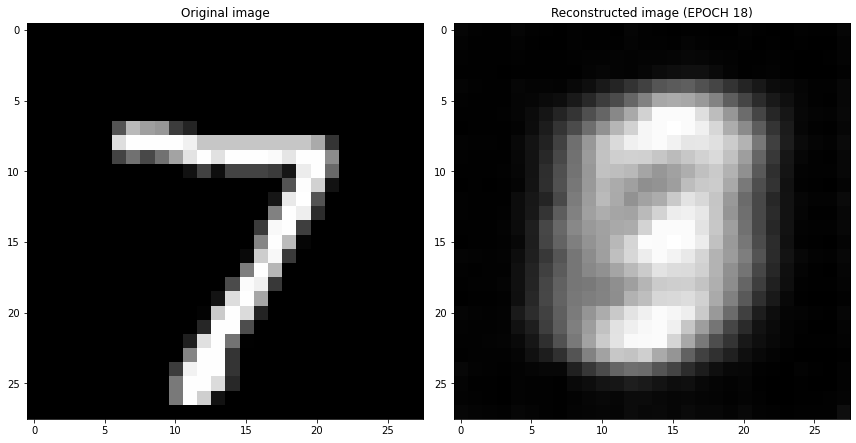

EPOCH 19/30
	 partial train loss (single batch): 0.066762
	 partial train loss (single batch): 0.068405
	 partial train loss (single batch): 0.067788
	 partial train loss (single batch): 0.066230
	 partial train loss (single batch): 0.067998
	 partial train loss (single batch): 0.069449
	 partial train loss (single batch): 0.068626
	 partial train loss (single batch): 0.067778
	 partial train loss (single batch): 0.067239
	 partial train loss (single batch): 0.065933
	 partial train loss (single batch): 0.064563
	 partial train loss (single batch): 0.071464
	 partial train loss (single batch): 0.067071
	 partial train loss (single batch): 0.069103
	 partial train loss (single batch): 0.066107
	 partial train loss (single batch): 0.068977
	 partial train loss (single batch): 0.068285
	 partial train loss (single batch): 0.067350
	 partial train loss (single batch): 0.068113
	 partial train loss (single batch): 0.068974
	 partial train loss (single batch): 0.066318
	 partial train loss (

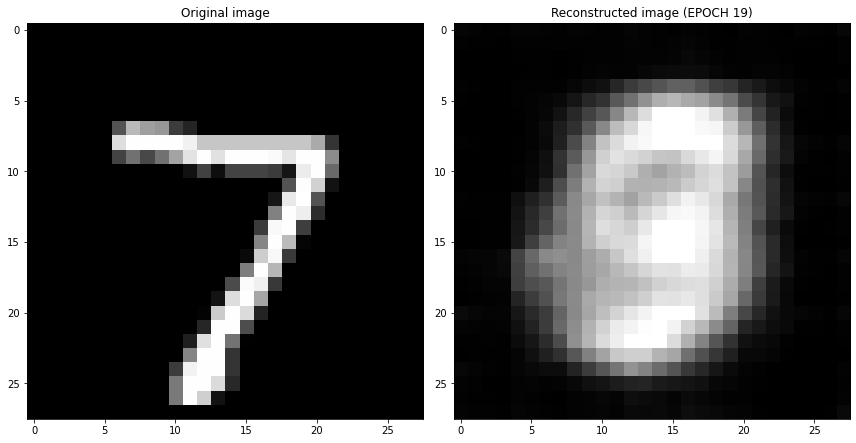

EPOCH 20/30
	 partial train loss (single batch): 0.068603
	 partial train loss (single batch): 0.065183
	 partial train loss (single batch): 0.065530
	 partial train loss (single batch): 0.068657
	 partial train loss (single batch): 0.066121
	 partial train loss (single batch): 0.067875
	 partial train loss (single batch): 0.068752
	 partial train loss (single batch): 0.068112
	 partial train loss (single batch): 0.064318
	 partial train loss (single batch): 0.068501
	 partial train loss (single batch): 0.065165
	 partial train loss (single batch): 0.069079
	 partial train loss (single batch): 0.066625
	 partial train loss (single batch): 0.067499
	 partial train loss (single batch): 0.067616
	 partial train loss (single batch): 0.066656
	 partial train loss (single batch): 0.069174
	 partial train loss (single batch): 0.067138
	 partial train loss (single batch): 0.067468
	 partial train loss (single batch): 0.067881
	 partial train loss (single batch): 0.067825
	 partial train loss (

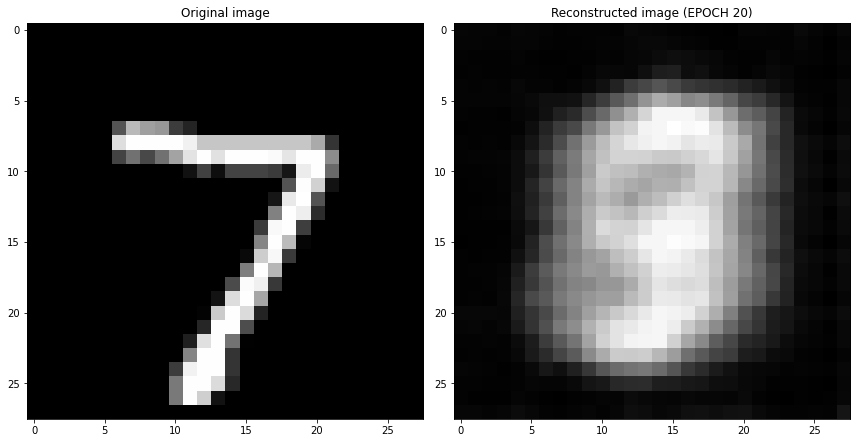

EPOCH 21/30
	 partial train loss (single batch): 0.066955
	 partial train loss (single batch): 0.068039
	 partial train loss (single batch): 0.067078
	 partial train loss (single batch): 0.065966
	 partial train loss (single batch): 0.068347
	 partial train loss (single batch): 0.068472
	 partial train loss (single batch): 0.067724
	 partial train loss (single batch): 0.067946
	 partial train loss (single batch): 0.067165
	 partial train loss (single batch): 0.067564
	 partial train loss (single batch): 0.067091
	 partial train loss (single batch): 0.069047
	 partial train loss (single batch): 0.066769
	 partial train loss (single batch): 0.068460
	 partial train loss (single batch): 0.066046
	 partial train loss (single batch): 0.066839
	 partial train loss (single batch): 0.069843
	 partial train loss (single batch): 0.067382
	 partial train loss (single batch): 0.068715
	 partial train loss (single batch): 0.067540
	 partial train loss (single batch): 0.067315
	 partial train loss (

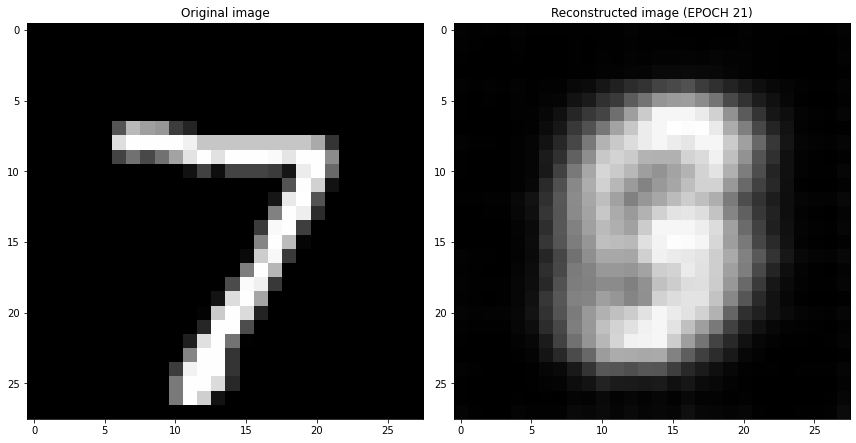

EPOCH 22/30
	 partial train loss (single batch): 0.067347
	 partial train loss (single batch): 0.067975
	 partial train loss (single batch): 0.068382
	 partial train loss (single batch): 0.065607
	 partial train loss (single batch): 0.066692
	 partial train loss (single batch): 0.065915
	 partial train loss (single batch): 0.067757
	 partial train loss (single batch): 0.068650
	 partial train loss (single batch): 0.065711
	 partial train loss (single batch): 0.066074
	 partial train loss (single batch): 0.068113
	 partial train loss (single batch): 0.068365
	 partial train loss (single batch): 0.067907
	 partial train loss (single batch): 0.067219
	 partial train loss (single batch): 0.066283
	 partial train loss (single batch): 0.068172
	 partial train loss (single batch): 0.065734
	 partial train loss (single batch): 0.070166
	 partial train loss (single batch): 0.066760
	 partial train loss (single batch): 0.069696
	 partial train loss (single batch): 0.067452
	 partial train loss (

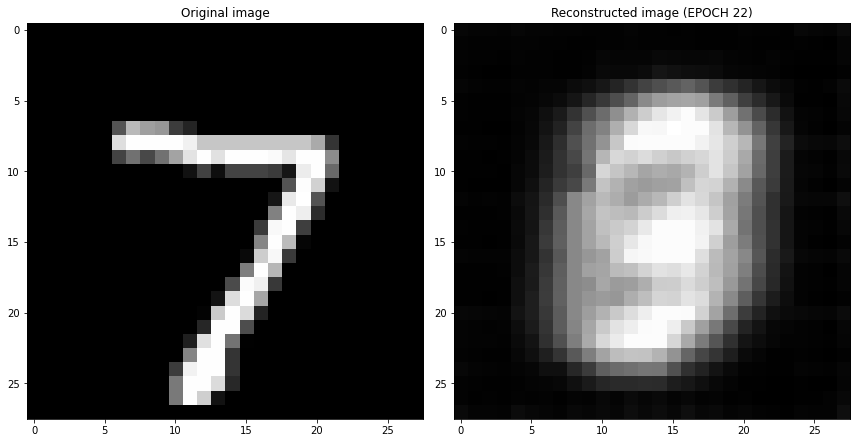

EPOCH 23/30
	 partial train loss (single batch): 0.067179
	 partial train loss (single batch): 0.068472
	 partial train loss (single batch): 0.068391
	 partial train loss (single batch): 0.067286
	 partial train loss (single batch): 0.066435
	 partial train loss (single batch): 0.068091
	 partial train loss (single batch): 0.068040
	 partial train loss (single batch): 0.068087
	 partial train loss (single batch): 0.067757
	 partial train loss (single batch): 0.067869
	 partial train loss (single batch): 0.067456
	 partial train loss (single batch): 0.065784
	 partial train loss (single batch): 0.066539
	 partial train loss (single batch): 0.068105
	 partial train loss (single batch): 0.066444
	 partial train loss (single batch): 0.065881
	 partial train loss (single batch): 0.066022
	 partial train loss (single batch): 0.065401
	 partial train loss (single batch): 0.063141
	 partial train loss (single batch): 0.067175
	 partial train loss (single batch): 0.067912
	 partial train loss (

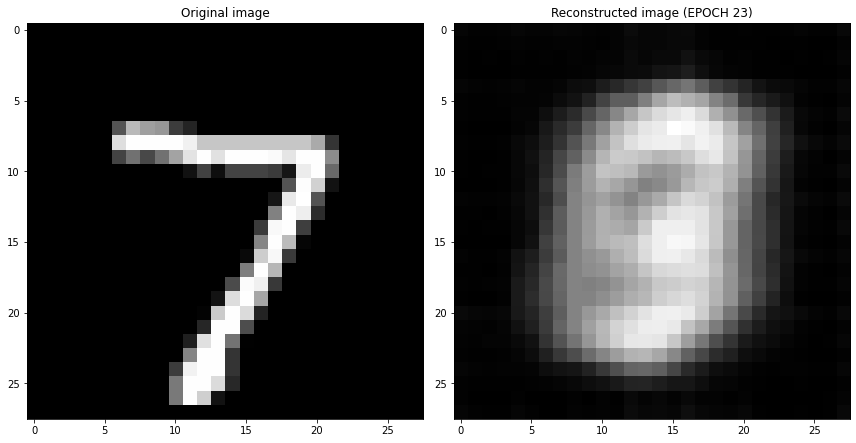

EPOCH 24/30
	 partial train loss (single batch): 0.066291
	 partial train loss (single batch): 0.067440
	 partial train loss (single batch): 0.067857
	 partial train loss (single batch): 0.067436
	 partial train loss (single batch): 0.065230
	 partial train loss (single batch): 0.067679
	 partial train loss (single batch): 0.066814
	 partial train loss (single batch): 0.068608
	 partial train loss (single batch): 0.067526
	 partial train loss (single batch): 0.065500
	 partial train loss (single batch): 0.067690
	 partial train loss (single batch): 0.066088
	 partial train loss (single batch): 0.066015
	 partial train loss (single batch): 0.068092
	 partial train loss (single batch): 0.067604
	 partial train loss (single batch): 0.066761
	 partial train loss (single batch): 0.064588
	 partial train loss (single batch): 0.067573
	 partial train loss (single batch): 0.066700
	 partial train loss (single batch): 0.067415
	 partial train loss (single batch): 0.065987
	 partial train loss (

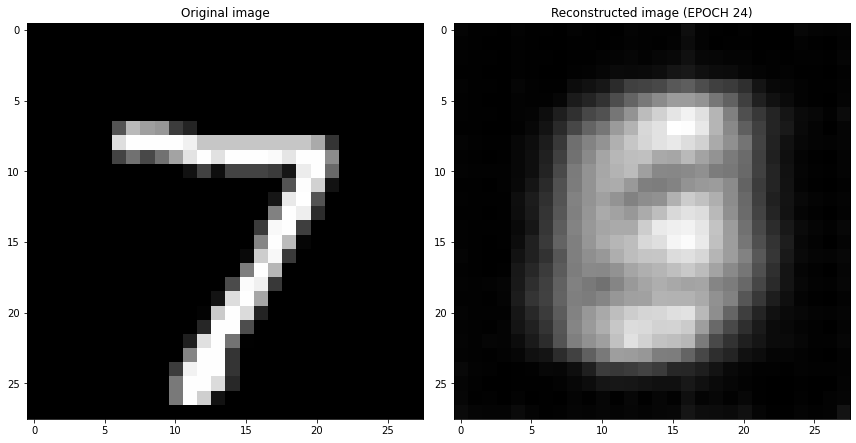

EPOCH 25/30
	 partial train loss (single batch): 0.067313
	 partial train loss (single batch): 0.068815
	 partial train loss (single batch): 0.068365
	 partial train loss (single batch): 0.067362
	 partial train loss (single batch): 0.066416
	 partial train loss (single batch): 0.069430
	 partial train loss (single batch): 0.063417
	 partial train loss (single batch): 0.065001
	 partial train loss (single batch): 0.066530
	 partial train loss (single batch): 0.068388
	 partial train loss (single batch): 0.068240
	 partial train loss (single batch): 0.066777
	 partial train loss (single batch): 0.068940
	 partial train loss (single batch): 0.067710
	 partial train loss (single batch): 0.068517
	 partial train loss (single batch): 0.065593
	 partial train loss (single batch): 0.068652
	 partial train loss (single batch): 0.067479
	 partial train loss (single batch): 0.067046
	 partial train loss (single batch): 0.065874
	 partial train loss (single batch): 0.069114
	 partial train loss (

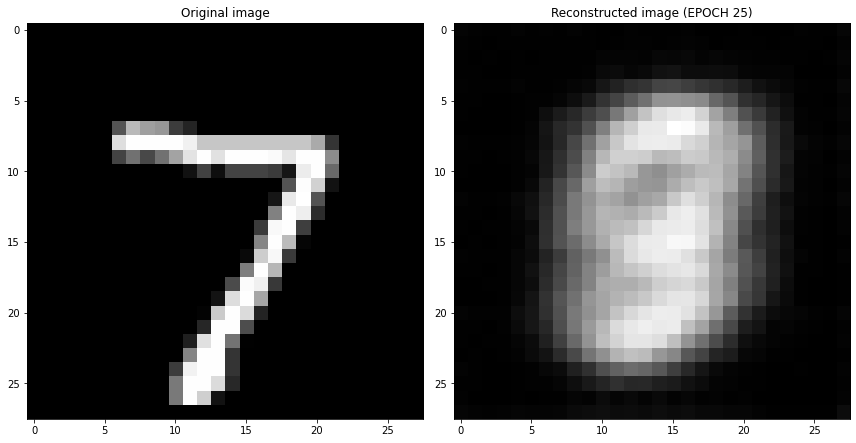

EPOCH 26/30
	 partial train loss (single batch): 0.068309
	 partial train loss (single batch): 0.068328
	 partial train loss (single batch): 0.071175
	 partial train loss (single batch): 0.066879
	 partial train loss (single batch): 0.067620
	 partial train loss (single batch): 0.065332
	 partial train loss (single batch): 0.067723
	 partial train loss (single batch): 0.069612
	 partial train loss (single batch): 0.067195
	 partial train loss (single batch): 0.067520
	 partial train loss (single batch): 0.064991
	 partial train loss (single batch): 0.065451
	 partial train loss (single batch): 0.067525
	 partial train loss (single batch): 0.066866
	 partial train loss (single batch): 0.068058
	 partial train loss (single batch): 0.068021
	 partial train loss (single batch): 0.070095
	 partial train loss (single batch): 0.067627
	 partial train loss (single batch): 0.065465
	 partial train loss (single batch): 0.066204
	 partial train loss (single batch): 0.067790
	 partial train loss (

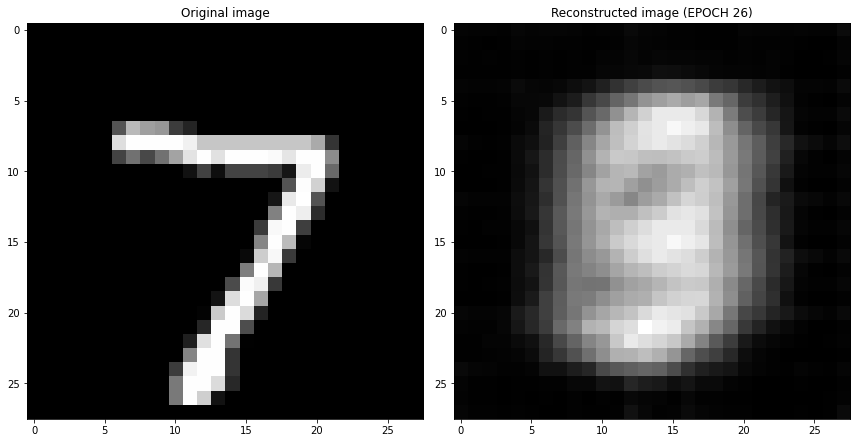

EPOCH 27/30
	 partial train loss (single batch): 0.067828
	 partial train loss (single batch): 0.065871
	 partial train loss (single batch): 0.066616
	 partial train loss (single batch): 0.068815
	 partial train loss (single batch): 0.066458
	 partial train loss (single batch): 0.063905
	 partial train loss (single batch): 0.066795
	 partial train loss (single batch): 0.067779
	 partial train loss (single batch): 0.066631
	 partial train loss (single batch): 0.065407
	 partial train loss (single batch): 0.066993
	 partial train loss (single batch): 0.070143
	 partial train loss (single batch): 0.066683
	 partial train loss (single batch): 0.067404
	 partial train loss (single batch): 0.066043
	 partial train loss (single batch): 0.066725
	 partial train loss (single batch): 0.067207
	 partial train loss (single batch): 0.066920
	 partial train loss (single batch): 0.067504
	 partial train loss (single batch): 0.067638
	 partial train loss (single batch): 0.067422
	 partial train loss (

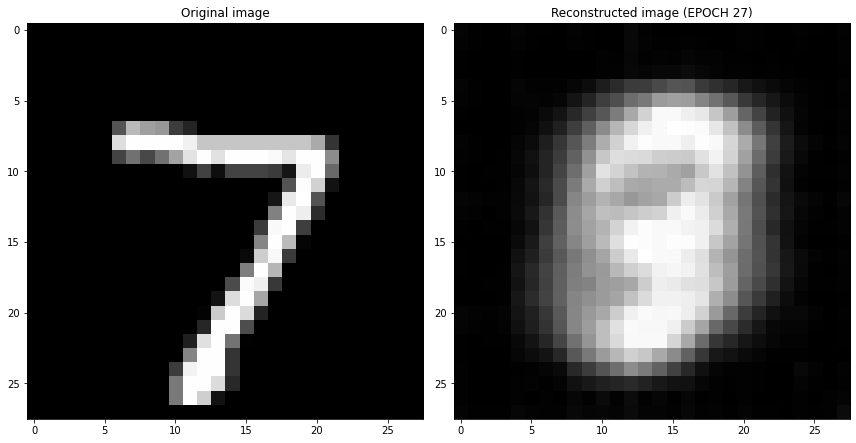

EPOCH 28/30
	 partial train loss (single batch): 0.066079
	 partial train loss (single batch): 0.068776
	 partial train loss (single batch): 0.068165
	 partial train loss (single batch): 0.068347
	 partial train loss (single batch): 0.065346
	 partial train loss (single batch): 0.067965
	 partial train loss (single batch): 0.068333
	 partial train loss (single batch): 0.068668
	 partial train loss (single batch): 0.066399
	 partial train loss (single batch): 0.068965
	 partial train loss (single batch): 0.068436
	 partial train loss (single batch): 0.066218
	 partial train loss (single batch): 0.068432
	 partial train loss (single batch): 0.066024
	 partial train loss (single batch): 0.066238
	 partial train loss (single batch): 0.067736
	 partial train loss (single batch): 0.067996
	 partial train loss (single batch): 0.066330
	 partial train loss (single batch): 0.068360
	 partial train loss (single batch): 0.067460
	 partial train loss (single batch): 0.066907
	 partial train loss (

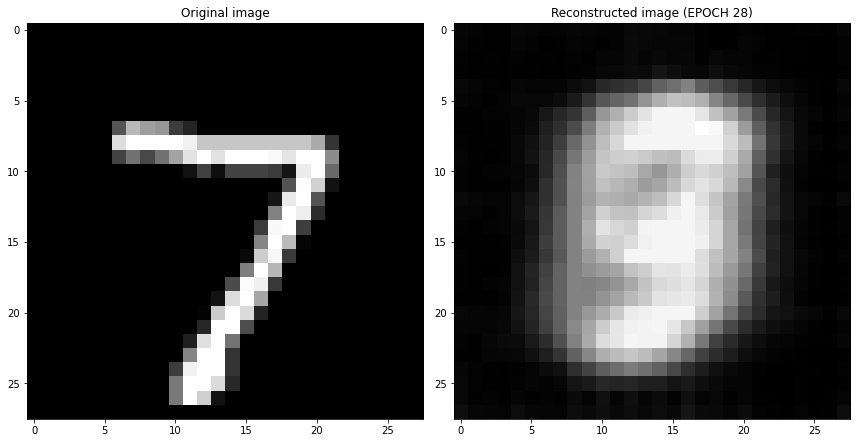

EPOCH 29/30
	 partial train loss (single batch): 0.066559
	 partial train loss (single batch): 0.067306
	 partial train loss (single batch): 0.066969
	 partial train loss (single batch): 0.068747
	 partial train loss (single batch): 0.069404
	 partial train loss (single batch): 0.067479
	 partial train loss (single batch): 0.066833
	 partial train loss (single batch): 0.066427
	 partial train loss (single batch): 0.069229
	 partial train loss (single batch): 0.066703
	 partial train loss (single batch): 0.066922
	 partial train loss (single batch): 0.068615
	 partial train loss (single batch): 0.067245
	 partial train loss (single batch): 0.066827
	 partial train loss (single batch): 0.067528
	 partial train loss (single batch): 0.067158
	 partial train loss (single batch): 0.065137
	 partial train loss (single batch): 0.068229
	 partial train loss (single batch): 0.066390
	 partial train loss (single batch): 0.067878
	 partial train loss (single batch): 0.069073
	 partial train loss (

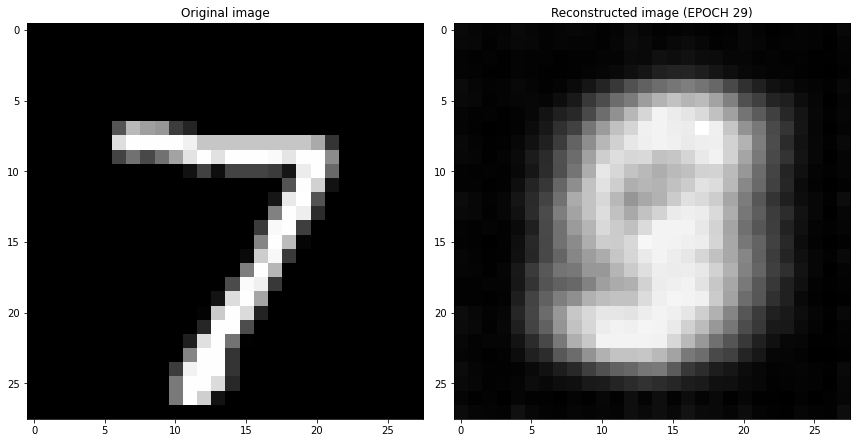

EPOCH 30/30
	 partial train loss (single batch): 0.069464
	 partial train loss (single batch): 0.066730
	 partial train loss (single batch): 0.069464
	 partial train loss (single batch): 0.068437
	 partial train loss (single batch): 0.068272
	 partial train loss (single batch): 0.068614
	 partial train loss (single batch): 0.066052
	 partial train loss (single batch): 0.067214
	 partial train loss (single batch): 0.067000
	 partial train loss (single batch): 0.067086
	 partial train loss (single batch): 0.069892
	 partial train loss (single batch): 0.070067
	 partial train loss (single batch): 0.067241
	 partial train loss (single batch): 0.068048
	 partial train loss (single batch): 0.068544
	 partial train loss (single batch): 0.069079
	 partial train loss (single batch): 0.069177
	 partial train loss (single batch): 0.067735
	 partial train loss (single batch): 0.066558
	 partial train loss (single batch): 0.067024
	 partial train loss (single batch): 0.067972
	 partial train loss (

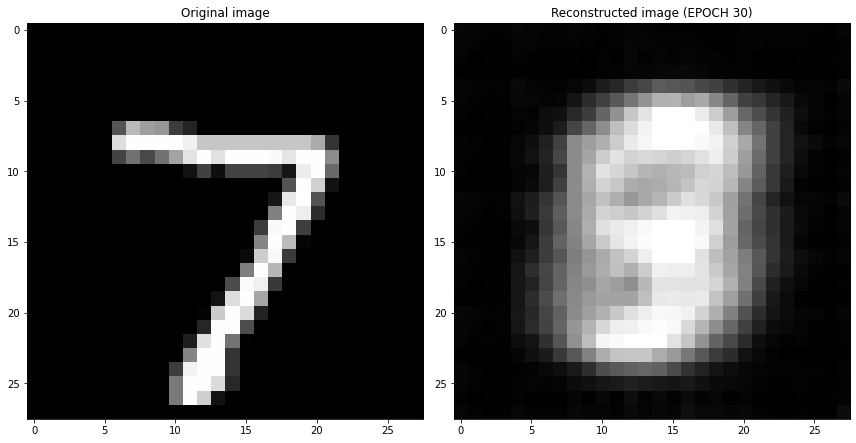

Cross validation fold number= 4/6
EPOCH 1/30
	 partial train loss (single batch): 0.235782
	 partial train loss (single batch): 0.129245
	 partial train loss (single batch): 0.114351
	 partial train loss (single batch): 0.111042
	 partial train loss (single batch): 0.109256
	 partial train loss (single batch): 0.110075
	 partial train loss (single batch): 0.115037
	 partial train loss (single batch): 0.110036
	 partial train loss (single batch): 0.111565
	 partial train loss (single batch): 0.109020
	 partial train loss (single batch): 0.110358
	 partial train loss (single batch): 0.107731
	 partial train loss (single batch): 0.109839
	 partial train loss (single batch): 0.109337
	 partial train loss (single batch): 0.112916
	 partial train loss (single batch): 0.115161
	 partial train loss (single batch): 0.108986
	 partial train loss (single batch): 0.107695
	 partial train loss (single batch): 0.107871
	 partial train loss (single batch): 0.110807
	 partial train loss (single batch)

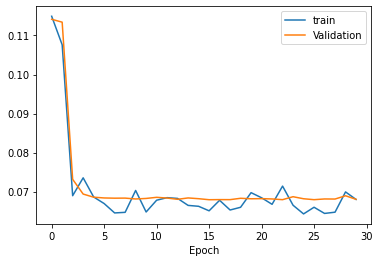

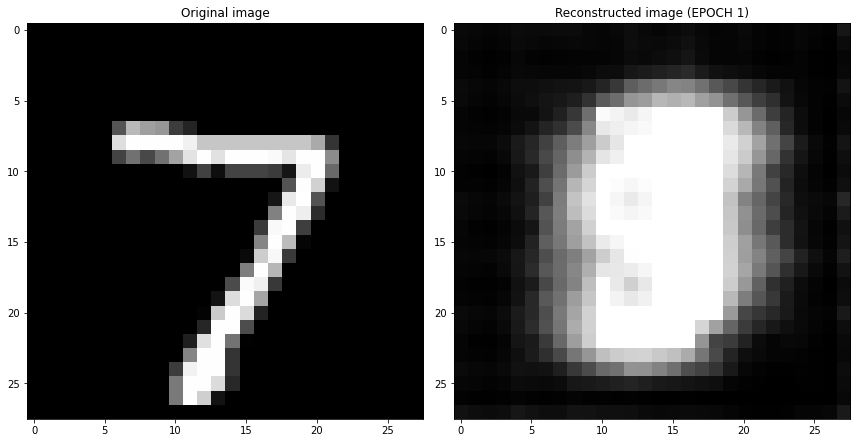

EPOCH 2/30
	 partial train loss (single batch): 0.069828
	 partial train loss (single batch): 0.067194
	 partial train loss (single batch): 0.068419
	 partial train loss (single batch): 0.068095
	 partial train loss (single batch): 0.070028
	 partial train loss (single batch): 0.069036
	 partial train loss (single batch): 0.066291
	 partial train loss (single batch): 0.068888
	 partial train loss (single batch): 0.067200
	 partial train loss (single batch): 0.068562
	 partial train loss (single batch): 0.068110
	 partial train loss (single batch): 0.067863
	 partial train loss (single batch): 0.066802
	 partial train loss (single batch): 0.067522
	 partial train loss (single batch): 0.067014
	 partial train loss (single batch): 0.069394
	 partial train loss (single batch): 0.067980
	 partial train loss (single batch): 0.067988
	 partial train loss (single batch): 0.067157
	 partial train loss (single batch): 0.068611
	 partial train loss (single batch): 0.069453
	 partial train loss (s

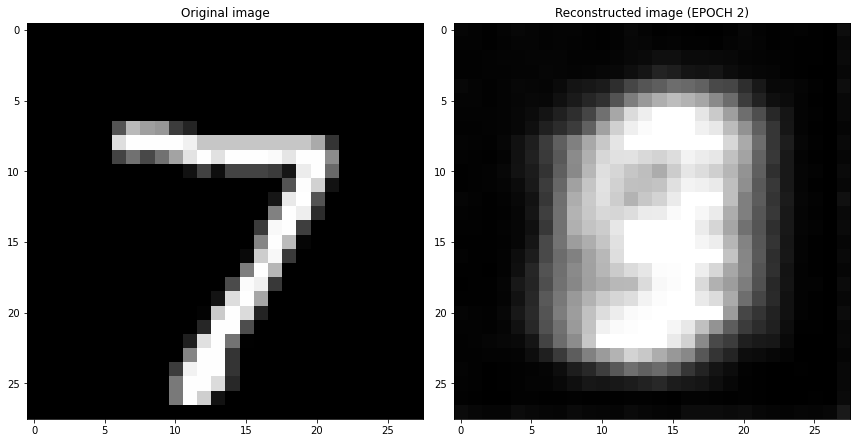

EPOCH 3/30
	 partial train loss (single batch): 0.068172
	 partial train loss (single batch): 0.067729
	 partial train loss (single batch): 0.067732
	 partial train loss (single batch): 0.067867
	 partial train loss (single batch): 0.067143
	 partial train loss (single batch): 0.067482
	 partial train loss (single batch): 0.069962
	 partial train loss (single batch): 0.068911
	 partial train loss (single batch): 0.069456
	 partial train loss (single batch): 0.066909
	 partial train loss (single batch): 0.066700
	 partial train loss (single batch): 0.069423
	 partial train loss (single batch): 0.070160
	 partial train loss (single batch): 0.068743
	 partial train loss (single batch): 0.068341
	 partial train loss (single batch): 0.066318
	 partial train loss (single batch): 0.068215
	 partial train loss (single batch): 0.068152
	 partial train loss (single batch): 0.066766
	 partial train loss (single batch): 0.067319
	 partial train loss (single batch): 0.067115
	 partial train loss (s

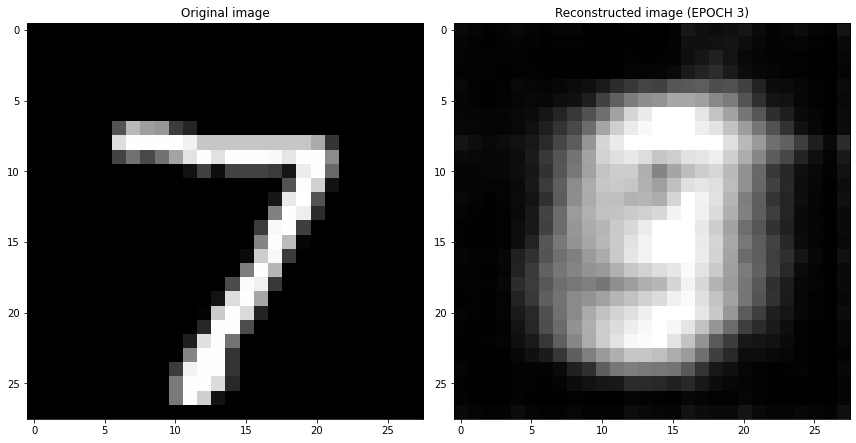

EPOCH 4/30
	 partial train loss (single batch): 0.069310
	 partial train loss (single batch): 0.068594
	 partial train loss (single batch): 0.068037
	 partial train loss (single batch): 0.069669
	 partial train loss (single batch): 0.067507
	 partial train loss (single batch): 0.066172
	 partial train loss (single batch): 0.067396
	 partial train loss (single batch): 0.066032
	 partial train loss (single batch): 0.067055
	 partial train loss (single batch): 0.067413
	 partial train loss (single batch): 0.067734
	 partial train loss (single batch): 0.067659
	 partial train loss (single batch): 0.066255
	 partial train loss (single batch): 0.068964
	 partial train loss (single batch): 0.066035
	 partial train loss (single batch): 0.067088
	 partial train loss (single batch): 0.069815
	 partial train loss (single batch): 0.066988
	 partial train loss (single batch): 0.067560
	 partial train loss (single batch): 0.065764
	 partial train loss (single batch): 0.066743
	 partial train loss (s

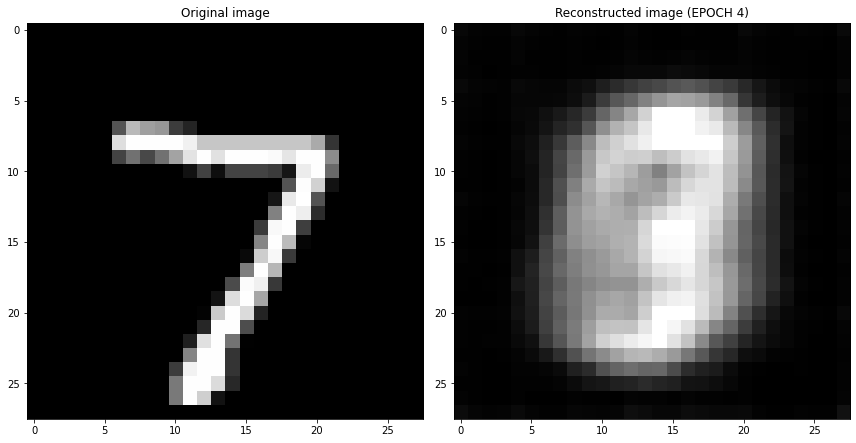

EPOCH 5/30
	 partial train loss (single batch): 0.066628
	 partial train loss (single batch): 0.068002
	 partial train loss (single batch): 0.068032
	 partial train loss (single batch): 0.067276
	 partial train loss (single batch): 0.066905
	 partial train loss (single batch): 0.069282
	 partial train loss (single batch): 0.067792
	 partial train loss (single batch): 0.067903
	 partial train loss (single batch): 0.065654
	 partial train loss (single batch): 0.066789
	 partial train loss (single batch): 0.069285
	 partial train loss (single batch): 0.065617
	 partial train loss (single batch): 0.066113
	 partial train loss (single batch): 0.067149
	 partial train loss (single batch): 0.068846
	 partial train loss (single batch): 0.065987
	 partial train loss (single batch): 0.067690
	 partial train loss (single batch): 0.068462
	 partial train loss (single batch): 0.067060
	 partial train loss (single batch): 0.068720
	 partial train loss (single batch): 0.067647
	 partial train loss (s

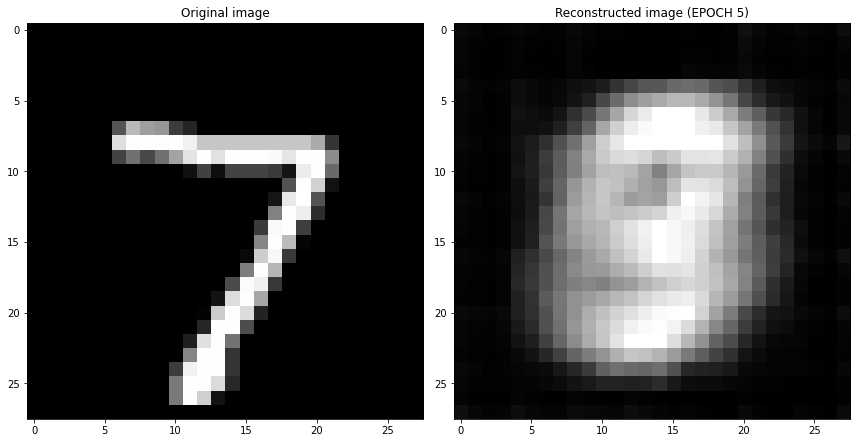

EPOCH 6/30
	 partial train loss (single batch): 0.068321
	 partial train loss (single batch): 0.067487
	 partial train loss (single batch): 0.068827
	 partial train loss (single batch): 0.067592
	 partial train loss (single batch): 0.067956
	 partial train loss (single batch): 0.068441
	 partial train loss (single batch): 0.066002
	 partial train loss (single batch): 0.067355
	 partial train loss (single batch): 0.068773
	 partial train loss (single batch): 0.066461
	 partial train loss (single batch): 0.067666
	 partial train loss (single batch): 0.068659
	 partial train loss (single batch): 0.065502
	 partial train loss (single batch): 0.067876
	 partial train loss (single batch): 0.069631
	 partial train loss (single batch): 0.066991
	 partial train loss (single batch): 0.067530
	 partial train loss (single batch): 0.066960
	 partial train loss (single batch): 0.068313
	 partial train loss (single batch): 0.067849
	 partial train loss (single batch): 0.066977
	 partial train loss (s

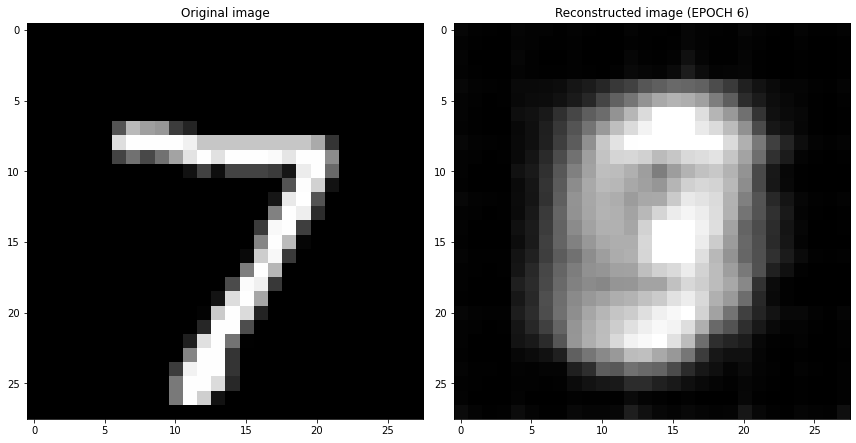

EPOCH 7/30
	 partial train loss (single batch): 0.068835
	 partial train loss (single batch): 0.067414
	 partial train loss (single batch): 0.067098
	 partial train loss (single batch): 0.068535
	 partial train loss (single batch): 0.068175
	 partial train loss (single batch): 0.067581
	 partial train loss (single batch): 0.066911
	 partial train loss (single batch): 0.067777
	 partial train loss (single batch): 0.068435
	 partial train loss (single batch): 0.066563
	 partial train loss (single batch): 0.068295
	 partial train loss (single batch): 0.066394
	 partial train loss (single batch): 0.067190
	 partial train loss (single batch): 0.067166
	 partial train loss (single batch): 0.065739
	 partial train loss (single batch): 0.068164
	 partial train loss (single batch): 0.068226
	 partial train loss (single batch): 0.069313
	 partial train loss (single batch): 0.069621
	 partial train loss (single batch): 0.067260
	 partial train loss (single batch): 0.068357
	 partial train loss (s

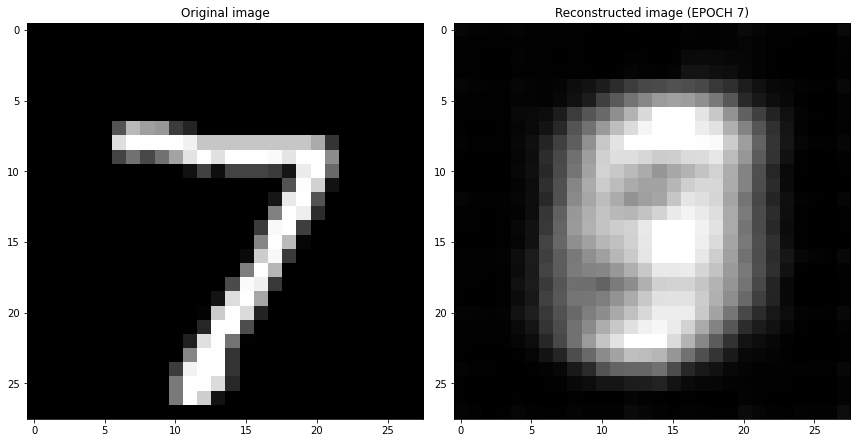

EPOCH 8/30
	 partial train loss (single batch): 0.064425
	 partial train loss (single batch): 0.067616
	 partial train loss (single batch): 0.066969
	 partial train loss (single batch): 0.067420
	 partial train loss (single batch): 0.065617
	 partial train loss (single batch): 0.069376
	 partial train loss (single batch): 0.068186
	 partial train loss (single batch): 0.066845
	 partial train loss (single batch): 0.067071
	 partial train loss (single batch): 0.067875
	 partial train loss (single batch): 0.066268
	 partial train loss (single batch): 0.067966
	 partial train loss (single batch): 0.066667
	 partial train loss (single batch): 0.068526
	 partial train loss (single batch): 0.068989
	 partial train loss (single batch): 0.066484
	 partial train loss (single batch): 0.066934
	 partial train loss (single batch): 0.068370
	 partial train loss (single batch): 0.068458
	 partial train loss (single batch): 0.069531
	 partial train loss (single batch): 0.067094
	 partial train loss (s

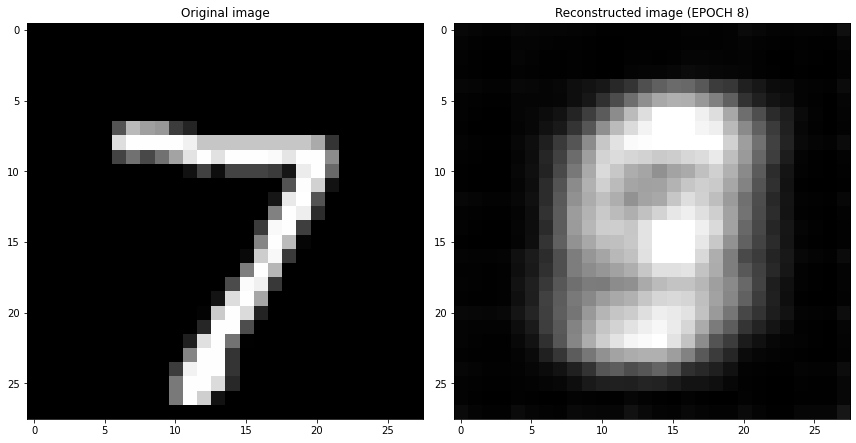

EPOCH 9/30
	 partial train loss (single batch): 0.066758
	 partial train loss (single batch): 0.068295
	 partial train loss (single batch): 0.067473
	 partial train loss (single batch): 0.065535
	 partial train loss (single batch): 0.068034
	 partial train loss (single batch): 0.067174
	 partial train loss (single batch): 0.069853
	 partial train loss (single batch): 0.069075
	 partial train loss (single batch): 0.068548
	 partial train loss (single batch): 0.068076
	 partial train loss (single batch): 0.067325
	 partial train loss (single batch): 0.065931
	 partial train loss (single batch): 0.069844
	 partial train loss (single batch): 0.068098
	 partial train loss (single batch): 0.067221
	 partial train loss (single batch): 0.067296
	 partial train loss (single batch): 0.068908
	 partial train loss (single batch): 0.066664
	 partial train loss (single batch): 0.067046
	 partial train loss (single batch): 0.067137
	 partial train loss (single batch): 0.067328
	 partial train loss (s

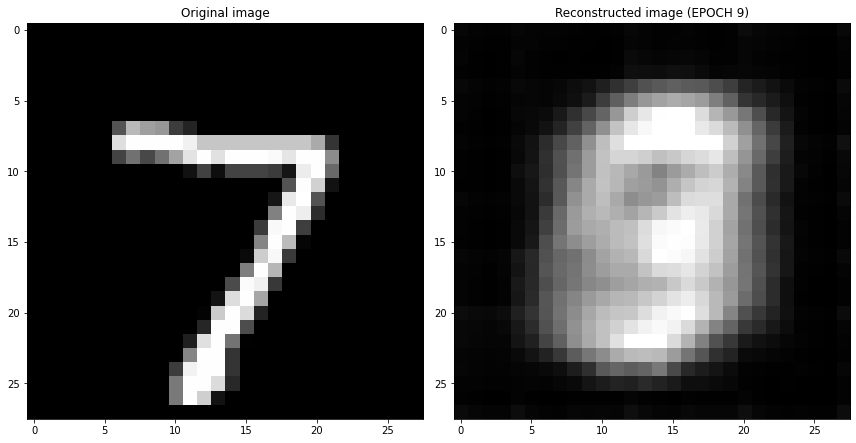

EPOCH 10/30
	 partial train loss (single batch): 0.064976
	 partial train loss (single batch): 0.067815
	 partial train loss (single batch): 0.068536
	 partial train loss (single batch): 0.065799
	 partial train loss (single batch): 0.067507
	 partial train loss (single batch): 0.067894
	 partial train loss (single batch): 0.066885
	 partial train loss (single batch): 0.067951
	 partial train loss (single batch): 0.069740
	 partial train loss (single batch): 0.068793
	 partial train loss (single batch): 0.067470
	 partial train loss (single batch): 0.069678
	 partial train loss (single batch): 0.068416
	 partial train loss (single batch): 0.066268
	 partial train loss (single batch): 0.068648
	 partial train loss (single batch): 0.068143
	 partial train loss (single batch): 0.069151
	 partial train loss (single batch): 0.067047
	 partial train loss (single batch): 0.069181
	 partial train loss (single batch): 0.067589
	 partial train loss (single batch): 0.067612
	 partial train loss (

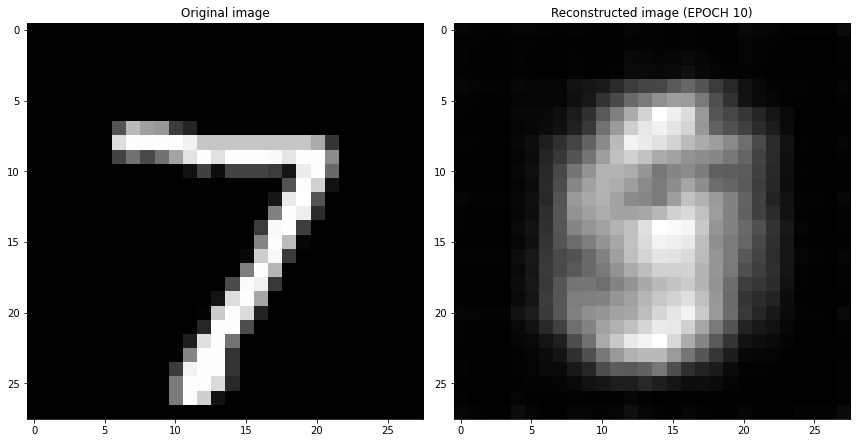

EPOCH 11/30
	 partial train loss (single batch): 0.072078
	 partial train loss (single batch): 0.067027
	 partial train loss (single batch): 0.069682
	 partial train loss (single batch): 0.068564
	 partial train loss (single batch): 0.069279
	 partial train loss (single batch): 0.069707
	 partial train loss (single batch): 0.068634
	 partial train loss (single batch): 0.069082
	 partial train loss (single batch): 0.067322
	 partial train loss (single batch): 0.066999
	 partial train loss (single batch): 0.068664
	 partial train loss (single batch): 0.067953
	 partial train loss (single batch): 0.065786
	 partial train loss (single batch): 0.067176
	 partial train loss (single batch): 0.068922
	 partial train loss (single batch): 0.068348
	 partial train loss (single batch): 0.067252
	 partial train loss (single batch): 0.067298
	 partial train loss (single batch): 0.067679
	 partial train loss (single batch): 0.066408
	 partial train loss (single batch): 0.068661
	 partial train loss (

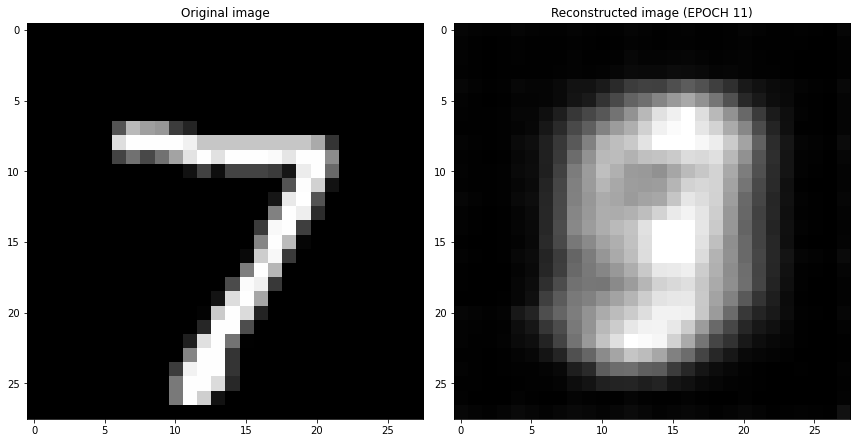

EPOCH 12/30
	 partial train loss (single batch): 0.070067
	 partial train loss (single batch): 0.065761
	 partial train loss (single batch): 0.066533
	 partial train loss (single batch): 0.067580
	 partial train loss (single batch): 0.066745
	 partial train loss (single batch): 0.065763
	 partial train loss (single batch): 0.068565
	 partial train loss (single batch): 0.066809
	 partial train loss (single batch): 0.067631
	 partial train loss (single batch): 0.068137
	 partial train loss (single batch): 0.065748
	 partial train loss (single batch): 0.067654
	 partial train loss (single batch): 0.067376
	 partial train loss (single batch): 0.067118
	 partial train loss (single batch): 0.068039
	 partial train loss (single batch): 0.066882
	 partial train loss (single batch): 0.067932
	 partial train loss (single batch): 0.067200
	 partial train loss (single batch): 0.067307
	 partial train loss (single batch): 0.068358
	 partial train loss (single batch): 0.068246
	 partial train loss (

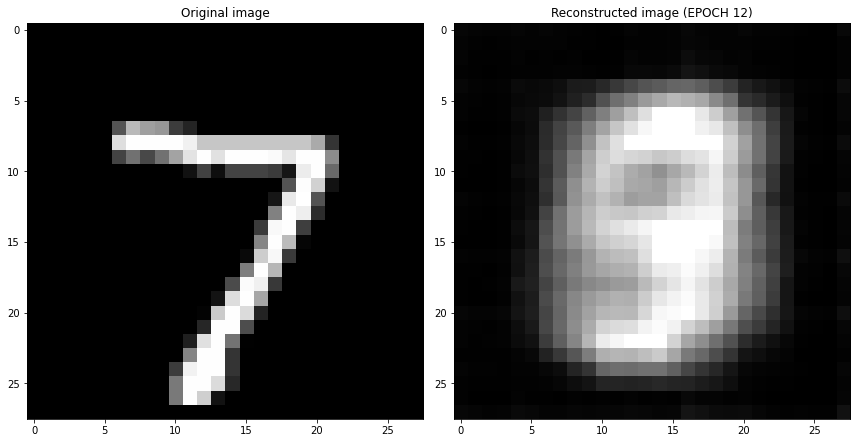

EPOCH 13/30
	 partial train loss (single batch): 0.068109
	 partial train loss (single batch): 0.067156
	 partial train loss (single batch): 0.067634
	 partial train loss (single batch): 0.066099
	 partial train loss (single batch): 0.067404
	 partial train loss (single batch): 0.066345
	 partial train loss (single batch): 0.067379
	 partial train loss (single batch): 0.066489
	 partial train loss (single batch): 0.065229
	 partial train loss (single batch): 0.068367
	 partial train loss (single batch): 0.068986
	 partial train loss (single batch): 0.066556
	 partial train loss (single batch): 0.066160
	 partial train loss (single batch): 0.066899
	 partial train loss (single batch): 0.066621
	 partial train loss (single batch): 0.067729
	 partial train loss (single batch): 0.066015
	 partial train loss (single batch): 0.067965
	 partial train loss (single batch): 0.069802
	 partial train loss (single batch): 0.068292
	 partial train loss (single batch): 0.068301
	 partial train loss (

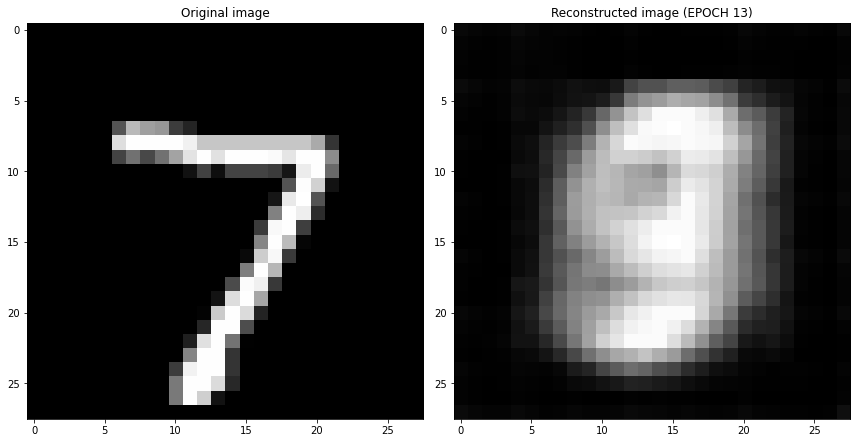

EPOCH 14/30
	 partial train loss (single batch): 0.065615
	 partial train loss (single batch): 0.067838
	 partial train loss (single batch): 0.067543
	 partial train loss (single batch): 0.066100
	 partial train loss (single batch): 0.066944
	 partial train loss (single batch): 0.069529
	 partial train loss (single batch): 0.066363
	 partial train loss (single batch): 0.066083
	 partial train loss (single batch): 0.068612
	 partial train loss (single batch): 0.067757
	 partial train loss (single batch): 0.067586
	 partial train loss (single batch): 0.066303
	 partial train loss (single batch): 0.065998
	 partial train loss (single batch): 0.066158
	 partial train loss (single batch): 0.068112
	 partial train loss (single batch): 0.067951
	 partial train loss (single batch): 0.067497
	 partial train loss (single batch): 0.066540
	 partial train loss (single batch): 0.065669
	 partial train loss (single batch): 0.066801
	 partial train loss (single batch): 0.065619
	 partial train loss (

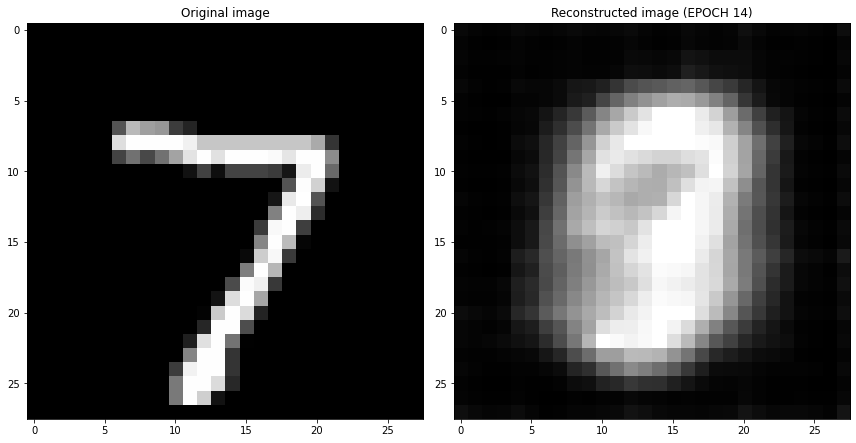

EPOCH 15/30
	 partial train loss (single batch): 0.068203
	 partial train loss (single batch): 0.066384
	 partial train loss (single batch): 0.065405
	 partial train loss (single batch): 0.066041
	 partial train loss (single batch): 0.069976
	 partial train loss (single batch): 0.067339
	 partial train loss (single batch): 0.068040
	 partial train loss (single batch): 0.065040
	 partial train loss (single batch): 0.070111
	 partial train loss (single batch): 0.068975
	 partial train loss (single batch): 0.068140
	 partial train loss (single batch): 0.066714
	 partial train loss (single batch): 0.065802
	 partial train loss (single batch): 0.067542
	 partial train loss (single batch): 0.066373
	 partial train loss (single batch): 0.066948
	 partial train loss (single batch): 0.067242
	 partial train loss (single batch): 0.068207
	 partial train loss (single batch): 0.068122
	 partial train loss (single batch): 0.069052
	 partial train loss (single batch): 0.066840
	 partial train loss (

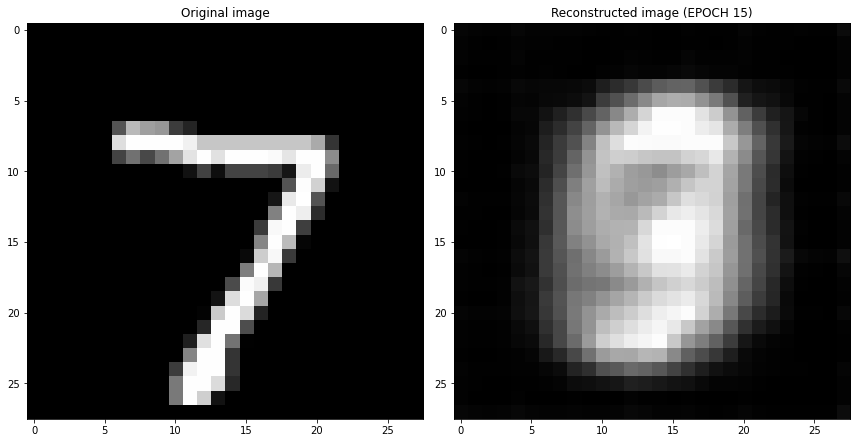

EPOCH 16/30
	 partial train loss (single batch): 0.065097
	 partial train loss (single batch): 0.067568
	 partial train loss (single batch): 0.068172
	 partial train loss (single batch): 0.068109
	 partial train loss (single batch): 0.068575
	 partial train loss (single batch): 0.067588
	 partial train loss (single batch): 0.066411
	 partial train loss (single batch): 0.067531
	 partial train loss (single batch): 0.067795
	 partial train loss (single batch): 0.065905
	 partial train loss (single batch): 0.066840
	 partial train loss (single batch): 0.066600
	 partial train loss (single batch): 0.067885
	 partial train loss (single batch): 0.066951
	 partial train loss (single batch): 0.065705
	 partial train loss (single batch): 0.067922
	 partial train loss (single batch): 0.068006
	 partial train loss (single batch): 0.069960
	 partial train loss (single batch): 0.067518
	 partial train loss (single batch): 0.069980
	 partial train loss (single batch): 0.067690
	 partial train loss (

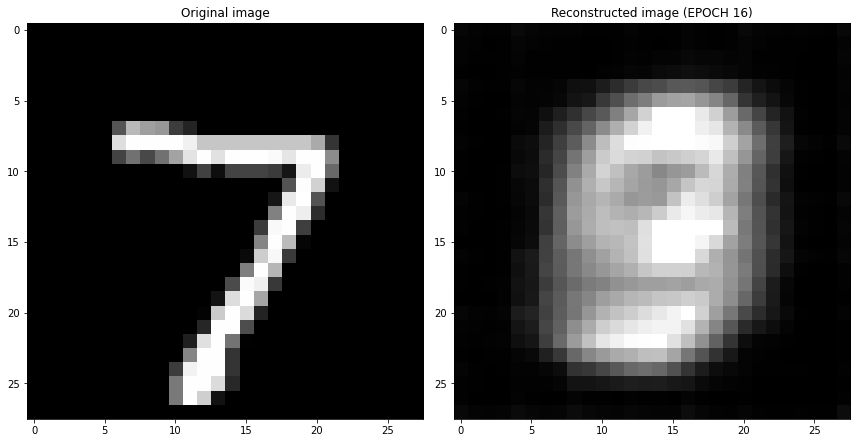

EPOCH 17/30
	 partial train loss (single batch): 0.069921
	 partial train loss (single batch): 0.066271
	 partial train loss (single batch): 0.068142
	 partial train loss (single batch): 0.068999
	 partial train loss (single batch): 0.067641
	 partial train loss (single batch): 0.067419
	 partial train loss (single batch): 0.067701
	 partial train loss (single batch): 0.070034
	 partial train loss (single batch): 0.068375
	 partial train loss (single batch): 0.069050
	 partial train loss (single batch): 0.067113
	 partial train loss (single batch): 0.067330
	 partial train loss (single batch): 0.068180
	 partial train loss (single batch): 0.067086
	 partial train loss (single batch): 0.066498
	 partial train loss (single batch): 0.068501
	 partial train loss (single batch): 0.066158
	 partial train loss (single batch): 0.070078
	 partial train loss (single batch): 0.069274
	 partial train loss (single batch): 0.068121
	 partial train loss (single batch): 0.067861
	 partial train loss (

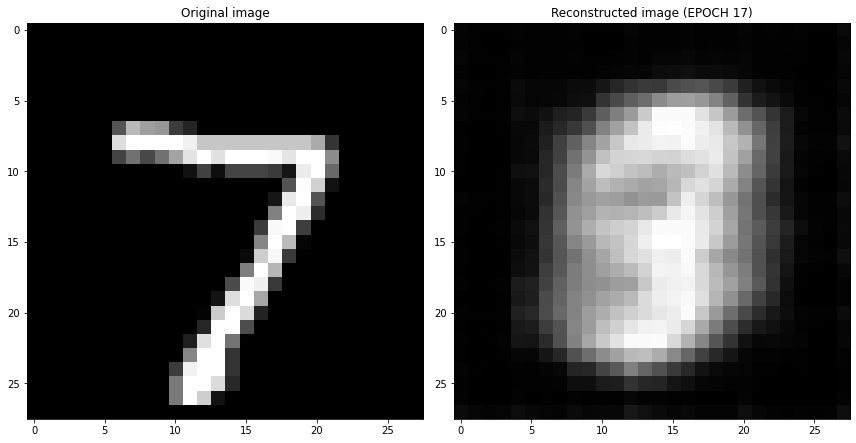

EPOCH 18/30
	 partial train loss (single batch): 0.066785
	 partial train loss (single batch): 0.066156
	 partial train loss (single batch): 0.067010
	 partial train loss (single batch): 0.067781
	 partial train loss (single batch): 0.070298
	 partial train loss (single batch): 0.069832
	 partial train loss (single batch): 0.066384
	 partial train loss (single batch): 0.069166
	 partial train loss (single batch): 0.065750
	 partial train loss (single batch): 0.066778
	 partial train loss (single batch): 0.066207
	 partial train loss (single batch): 0.066741
	 partial train loss (single batch): 0.069397
	 partial train loss (single batch): 0.067354
	 partial train loss (single batch): 0.066723
	 partial train loss (single batch): 0.066854
	 partial train loss (single batch): 0.069090
	 partial train loss (single batch): 0.069273
	 partial train loss (single batch): 0.068946
	 partial train loss (single batch): 0.067308
	 partial train loss (single batch): 0.068929
	 partial train loss (

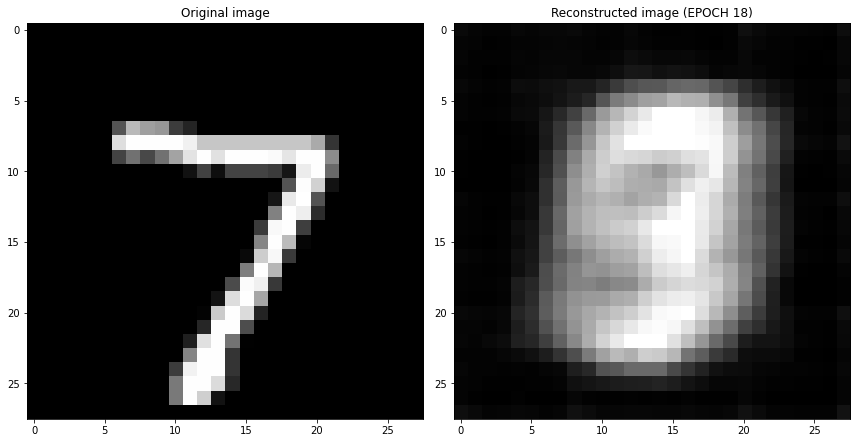

EPOCH 19/30
	 partial train loss (single batch): 0.067576
	 partial train loss (single batch): 0.067592
	 partial train loss (single batch): 0.066794
	 partial train loss (single batch): 0.068864
	 partial train loss (single batch): 0.066186
	 partial train loss (single batch): 0.068956
	 partial train loss (single batch): 0.066195
	 partial train loss (single batch): 0.066686
	 partial train loss (single batch): 0.066921
	 partial train loss (single batch): 0.066117
	 partial train loss (single batch): 0.067706
	 partial train loss (single batch): 0.066013
	 partial train loss (single batch): 0.065867
	 partial train loss (single batch): 0.066614
	 partial train loss (single batch): 0.067144
	 partial train loss (single batch): 0.068443
	 partial train loss (single batch): 0.068450
	 partial train loss (single batch): 0.069037
	 partial train loss (single batch): 0.068071
	 partial train loss (single batch): 0.068537
	 partial train loss (single batch): 0.068154
	 partial train loss (

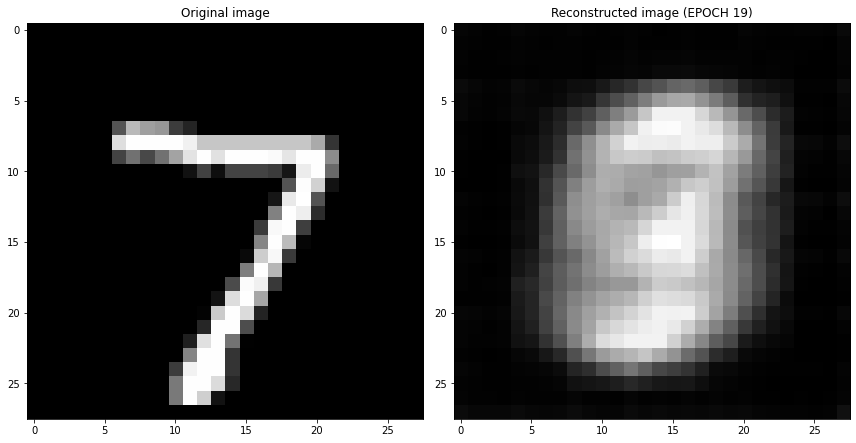

EPOCH 20/30
	 partial train loss (single batch): 0.067394
	 partial train loss (single batch): 0.066574
	 partial train loss (single batch): 0.067430
	 partial train loss (single batch): 0.066552
	 partial train loss (single batch): 0.066112
	 partial train loss (single batch): 0.067485
	 partial train loss (single batch): 0.067918
	 partial train loss (single batch): 0.068603
	 partial train loss (single batch): 0.066850
	 partial train loss (single batch): 0.066815
	 partial train loss (single batch): 0.068268
	 partial train loss (single batch): 0.068417
	 partial train loss (single batch): 0.067919
	 partial train loss (single batch): 0.066436
	 partial train loss (single batch): 0.067794
	 partial train loss (single batch): 0.066254
	 partial train loss (single batch): 0.068766
	 partial train loss (single batch): 0.066473
	 partial train loss (single batch): 0.068215
	 partial train loss (single batch): 0.067386
	 partial train loss (single batch): 0.066366
	 partial train loss (

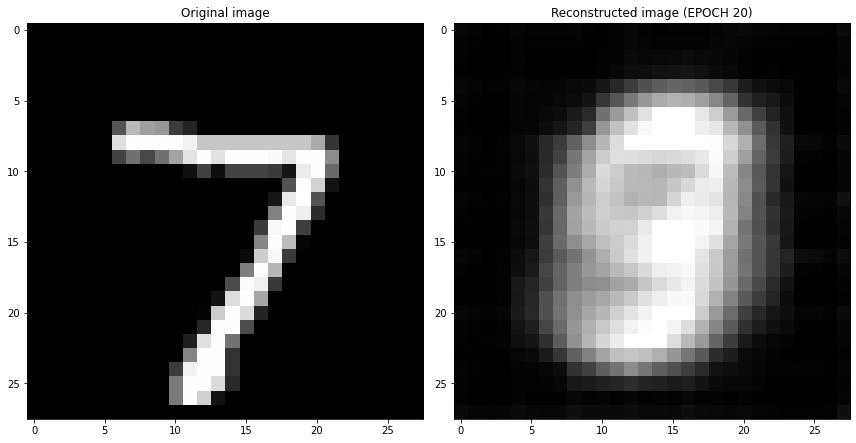

EPOCH 21/30
	 partial train loss (single batch): 0.066824
	 partial train loss (single batch): 0.065302
	 partial train loss (single batch): 0.068900
	 partial train loss (single batch): 0.068295
	 partial train loss (single batch): 0.067277
	 partial train loss (single batch): 0.065334
	 partial train loss (single batch): 0.067236
	 partial train loss (single batch): 0.066349
	 partial train loss (single batch): 0.068800
	 partial train loss (single batch): 0.067511
	 partial train loss (single batch): 0.068330
	 partial train loss (single batch): 0.068811
	 partial train loss (single batch): 0.067695
	 partial train loss (single batch): 0.068620
	 partial train loss (single batch): 0.068924
	 partial train loss (single batch): 0.069497
	 partial train loss (single batch): 0.069329
	 partial train loss (single batch): 0.066363
	 partial train loss (single batch): 0.070585
	 partial train loss (single batch): 0.067432
	 partial train loss (single batch): 0.067387
	 partial train loss (

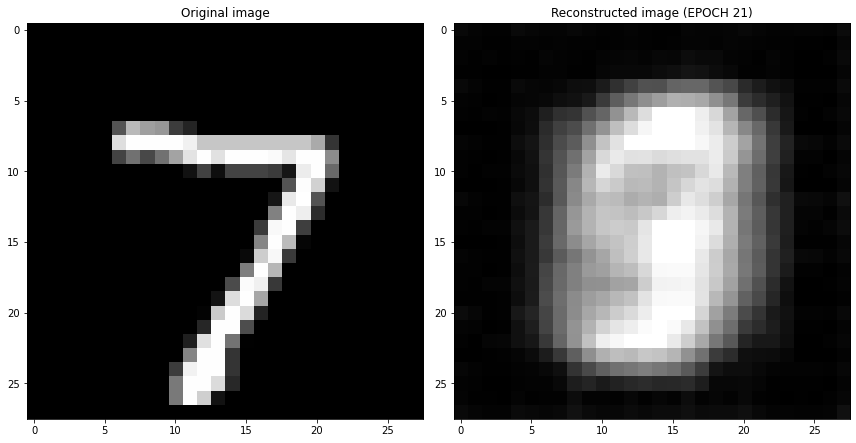

EPOCH 22/30
	 partial train loss (single batch): 0.067258
	 partial train loss (single batch): 0.067684
	 partial train loss (single batch): 0.068521
	 partial train loss (single batch): 0.066591
	 partial train loss (single batch): 0.068278
	 partial train loss (single batch): 0.065768
	 partial train loss (single batch): 0.068130
	 partial train loss (single batch): 0.067800
	 partial train loss (single batch): 0.069089
	 partial train loss (single batch): 0.067488
	 partial train loss (single batch): 0.068548
	 partial train loss (single batch): 0.068335
	 partial train loss (single batch): 0.066032
	 partial train loss (single batch): 0.066070
	 partial train loss (single batch): 0.065955
	 partial train loss (single batch): 0.067159
	 partial train loss (single batch): 0.070284
	 partial train loss (single batch): 0.068067
	 partial train loss (single batch): 0.066797
	 partial train loss (single batch): 0.067670
	 partial train loss (single batch): 0.069641
	 partial train loss (

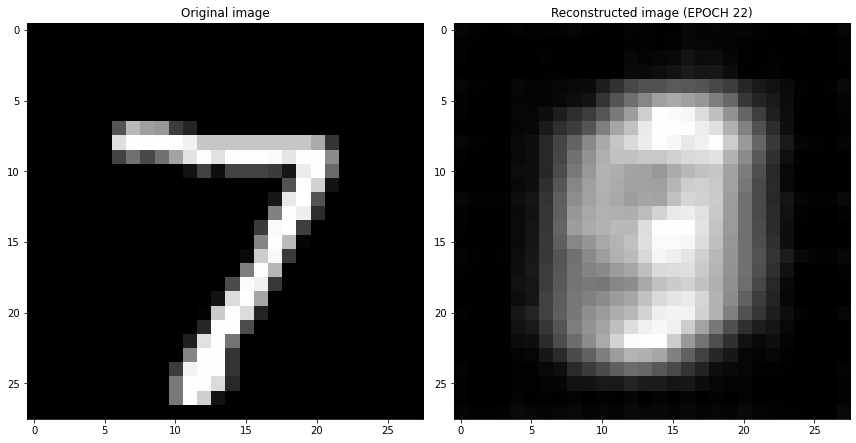

EPOCH 23/30
	 partial train loss (single batch): 0.069612
	 partial train loss (single batch): 0.066521
	 partial train loss (single batch): 0.068166
	 partial train loss (single batch): 0.066688
	 partial train loss (single batch): 0.065565
	 partial train loss (single batch): 0.065928
	 partial train loss (single batch): 0.067736
	 partial train loss (single batch): 0.067411
	 partial train loss (single batch): 0.068752
	 partial train loss (single batch): 0.067877
	 partial train loss (single batch): 0.068449
	 partial train loss (single batch): 0.067799
	 partial train loss (single batch): 0.067437
	 partial train loss (single batch): 0.064715
	 partial train loss (single batch): 0.070563
	 partial train loss (single batch): 0.067244
	 partial train loss (single batch): 0.065549
	 partial train loss (single batch): 0.068560
	 partial train loss (single batch): 0.065264
	 partial train loss (single batch): 0.066636
	 partial train loss (single batch): 0.069507
	 partial train loss (

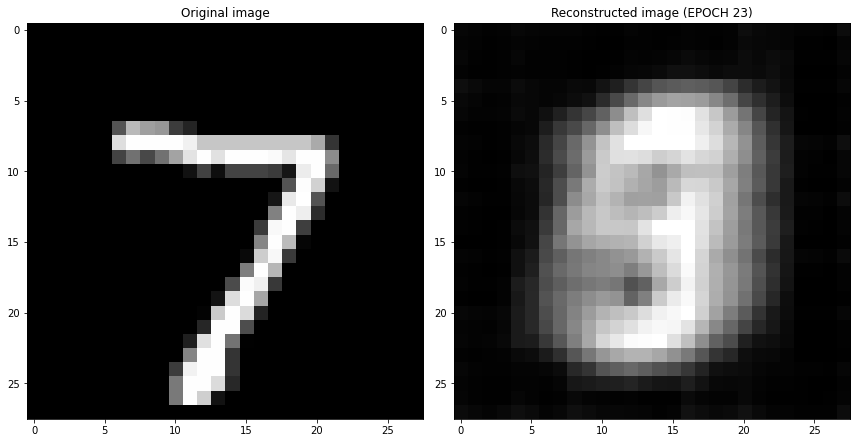

EPOCH 24/30
	 partial train loss (single batch): 0.066873
	 partial train loss (single batch): 0.066757
	 partial train loss (single batch): 0.066166
	 partial train loss (single batch): 0.070105
	 partial train loss (single batch): 0.066831
	 partial train loss (single batch): 0.068035
	 partial train loss (single batch): 0.069364
	 partial train loss (single batch): 0.066376
	 partial train loss (single batch): 0.066861
	 partial train loss (single batch): 0.068296
	 partial train loss (single batch): 0.068952
	 partial train loss (single batch): 0.070385
	 partial train loss (single batch): 0.068858
	 partial train loss (single batch): 0.070255
	 partial train loss (single batch): 0.068842
	 partial train loss (single batch): 0.068261
	 partial train loss (single batch): 0.069403
	 partial train loss (single batch): 0.067900
	 partial train loss (single batch): 0.068454
	 partial train loss (single batch): 0.066702
	 partial train loss (single batch): 0.067290
	 partial train loss (

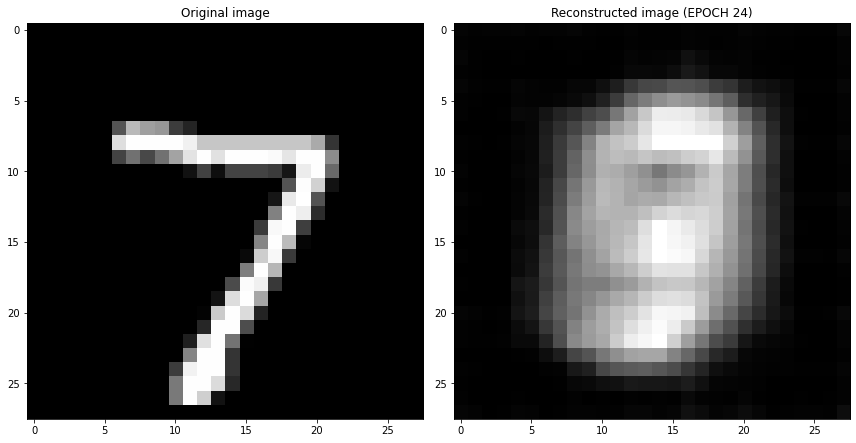

EPOCH 25/30
	 partial train loss (single batch): 0.068660
	 partial train loss (single batch): 0.065301
	 partial train loss (single batch): 0.068166
	 partial train loss (single batch): 0.069199
	 partial train loss (single batch): 0.067296
	 partial train loss (single batch): 0.065679
	 partial train loss (single batch): 0.068220
	 partial train loss (single batch): 0.065887
	 partial train loss (single batch): 0.066815
	 partial train loss (single batch): 0.068075
	 partial train loss (single batch): 0.068103
	 partial train loss (single batch): 0.067429
	 partial train loss (single batch): 0.067117
	 partial train loss (single batch): 0.066692
	 partial train loss (single batch): 0.068495
	 partial train loss (single batch): 0.067141
	 partial train loss (single batch): 0.068630
	 partial train loss (single batch): 0.067124
	 partial train loss (single batch): 0.067235
	 partial train loss (single batch): 0.068356
	 partial train loss (single batch): 0.068204
	 partial train loss (

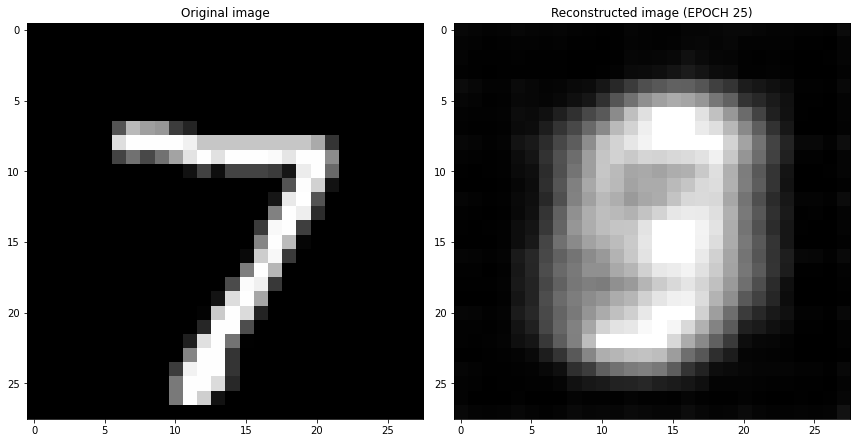

EPOCH 26/30
	 partial train loss (single batch): 0.068679
	 partial train loss (single batch): 0.068047
	 partial train loss (single batch): 0.065960
	 partial train loss (single batch): 0.070036
	 partial train loss (single batch): 0.068942
	 partial train loss (single batch): 0.066642
	 partial train loss (single batch): 0.067775
	 partial train loss (single batch): 0.067252
	 partial train loss (single batch): 0.066529
	 partial train loss (single batch): 0.067987
	 partial train loss (single batch): 0.067098
	 partial train loss (single batch): 0.066837
	 partial train loss (single batch): 0.067189
	 partial train loss (single batch): 0.069274
	 partial train loss (single batch): 0.068983
	 partial train loss (single batch): 0.067725
	 partial train loss (single batch): 0.068197
	 partial train loss (single batch): 0.066681
	 partial train loss (single batch): 0.066173
	 partial train loss (single batch): 0.069554
	 partial train loss (single batch): 0.066335
	 partial train loss (

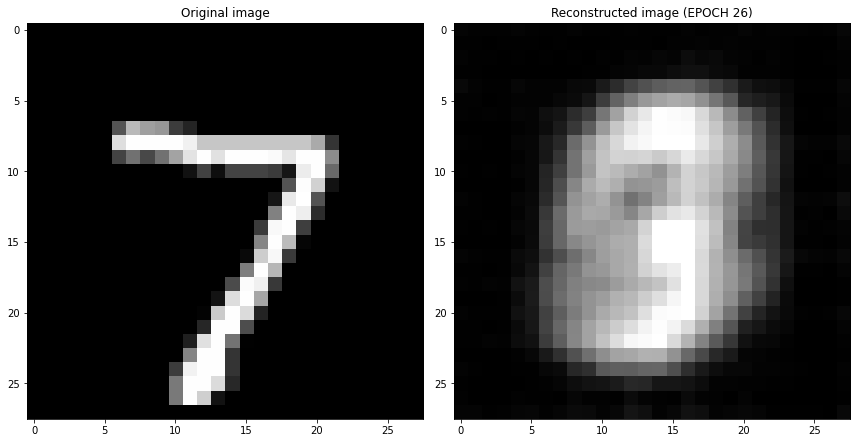

EPOCH 27/30
	 partial train loss (single batch): 0.068541
	 partial train loss (single batch): 0.067447
	 partial train loss (single batch): 0.069276
	 partial train loss (single batch): 0.068815
	 partial train loss (single batch): 0.067869
	 partial train loss (single batch): 0.069212
	 partial train loss (single batch): 0.067589
	 partial train loss (single batch): 0.068444
	 partial train loss (single batch): 0.068773
	 partial train loss (single batch): 0.065881
	 partial train loss (single batch): 0.068204
	 partial train loss (single batch): 0.066967
	 partial train loss (single batch): 0.067185
	 partial train loss (single batch): 0.066722
	 partial train loss (single batch): 0.069164
	 partial train loss (single batch): 0.067284
	 partial train loss (single batch): 0.068861
	 partial train loss (single batch): 0.067382
	 partial train loss (single batch): 0.066786
	 partial train loss (single batch): 0.067940
	 partial train loss (single batch): 0.067002
	 partial train loss (

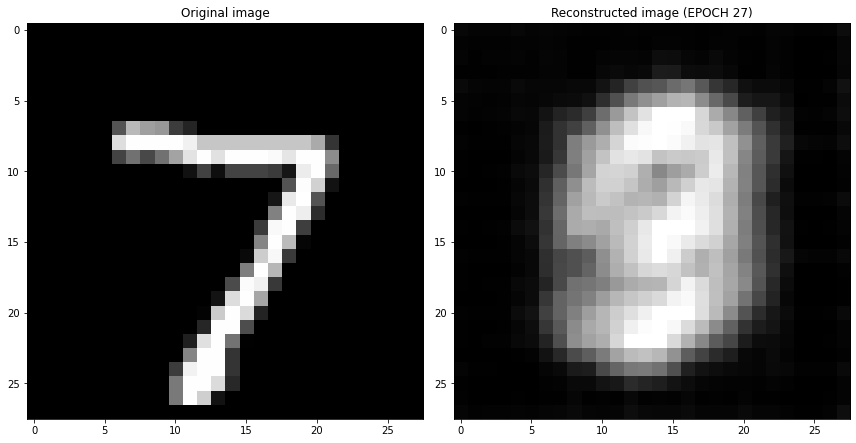

EPOCH 28/30
	 partial train loss (single batch): 0.069169
	 partial train loss (single batch): 0.065805
	 partial train loss (single batch): 0.066694
	 partial train loss (single batch): 0.068102
	 partial train loss (single batch): 0.067841
	 partial train loss (single batch): 0.066923
	 partial train loss (single batch): 0.065202
	 partial train loss (single batch): 0.069497
	 partial train loss (single batch): 0.068588
	 partial train loss (single batch): 0.065946
	 partial train loss (single batch): 0.065835
	 partial train loss (single batch): 0.068935
	 partial train loss (single batch): 0.066148
	 partial train loss (single batch): 0.065030
	 partial train loss (single batch): 0.067646
	 partial train loss (single batch): 0.067969
	 partial train loss (single batch): 0.069142
	 partial train loss (single batch): 0.067626
	 partial train loss (single batch): 0.070169
	 partial train loss (single batch): 0.067188
	 partial train loss (single batch): 0.068230
	 partial train loss (

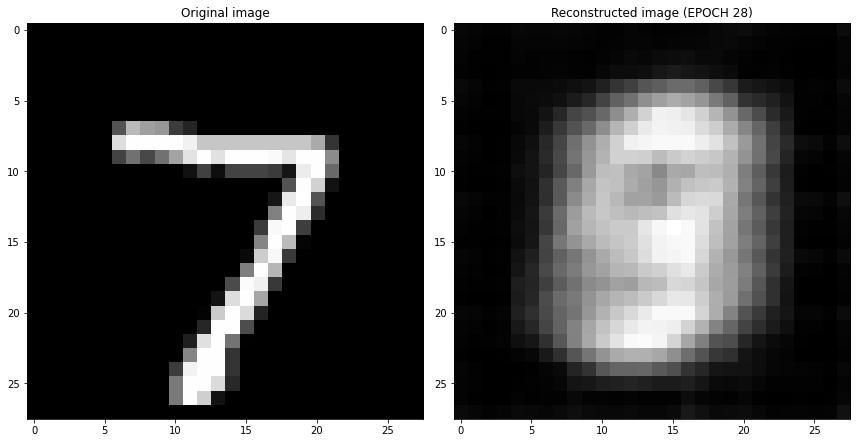

EPOCH 29/30
	 partial train loss (single batch): 0.067579
	 partial train loss (single batch): 0.066699
	 partial train loss (single batch): 0.066976
	 partial train loss (single batch): 0.067083
	 partial train loss (single batch): 0.068981
	 partial train loss (single batch): 0.066485
	 partial train loss (single batch): 0.065739
	 partial train loss (single batch): 0.069473
	 partial train loss (single batch): 0.067504
	 partial train loss (single batch): 0.068509
	 partial train loss (single batch): 0.068618
	 partial train loss (single batch): 0.067521
	 partial train loss (single batch): 0.068679
	 partial train loss (single batch): 0.068243
	 partial train loss (single batch): 0.068734
	 partial train loss (single batch): 0.065654
	 partial train loss (single batch): 0.068806
	 partial train loss (single batch): 0.066048
	 partial train loss (single batch): 0.066916
	 partial train loss (single batch): 0.067164
	 partial train loss (single batch): 0.066207
	 partial train loss (

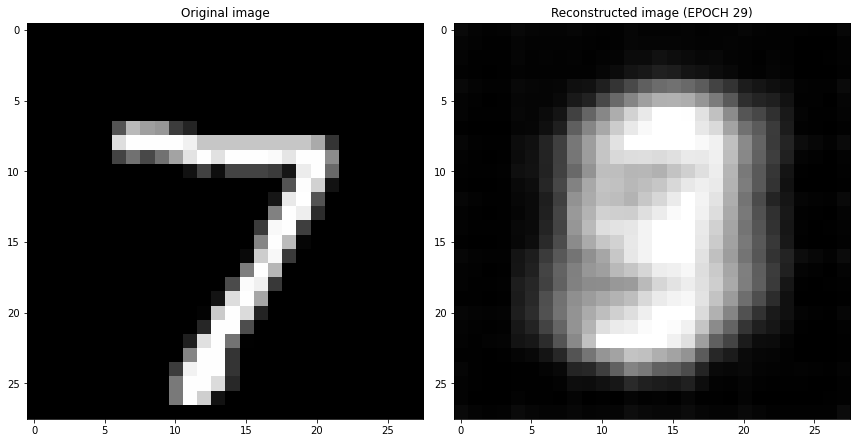

EPOCH 30/30
	 partial train loss (single batch): 0.069901
	 partial train loss (single batch): 0.065991
	 partial train loss (single batch): 0.068746
	 partial train loss (single batch): 0.066618
	 partial train loss (single batch): 0.066878
	 partial train loss (single batch): 0.068866
	 partial train loss (single batch): 0.066093
	 partial train loss (single batch): 0.070993
	 partial train loss (single batch): 0.067477
	 partial train loss (single batch): 0.067476
	 partial train loss (single batch): 0.065859
	 partial train loss (single batch): 0.066981
	 partial train loss (single batch): 0.070814
	 partial train loss (single batch): 0.066908
	 partial train loss (single batch): 0.068242
	 partial train loss (single batch): 0.067626
	 partial train loss (single batch): 0.068071
	 partial train loss (single batch): 0.066651
	 partial train loss (single batch): 0.067819
	 partial train loss (single batch): 0.067877
	 partial train loss (single batch): 0.068202
	 partial train loss (

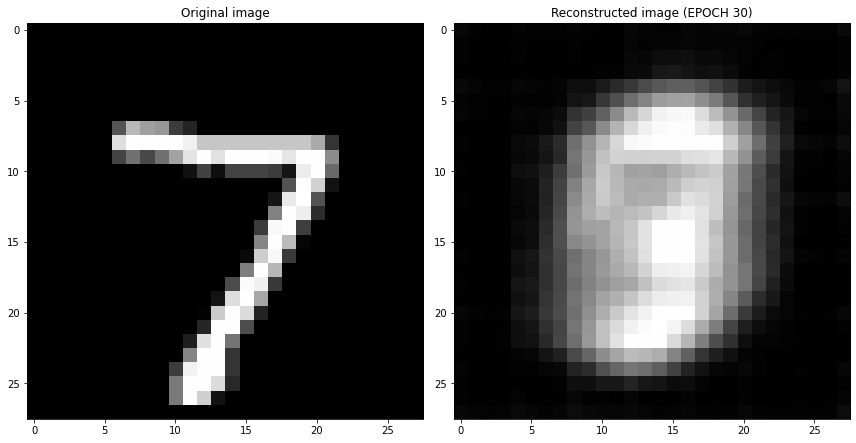

Cross validation fold number= 5/6
EPOCH 1/30
	 partial train loss (single batch): 0.289718
	 partial train loss (single batch): 0.133169
	 partial train loss (single batch): 0.114125
	 partial train loss (single batch): 0.109705
	 partial train loss (single batch): 0.109894
	 partial train loss (single batch): 0.110419
	 partial train loss (single batch): 0.116115
	 partial train loss (single batch): 0.112205
	 partial train loss (single batch): 0.110873
	 partial train loss (single batch): 0.115318
	 partial train loss (single batch): 0.113496
	 partial train loss (single batch): 0.114231
	 partial train loss (single batch): 0.110831
	 partial train loss (single batch): 0.112818
	 partial train loss (single batch): 0.112081
	 partial train loss (single batch): 0.115628
	 partial train loss (single batch): 0.114926
	 partial train loss (single batch): 0.108202
	 partial train loss (single batch): 0.114246
	 partial train loss (single batch): 0.112486
	 partial train loss (single batch)

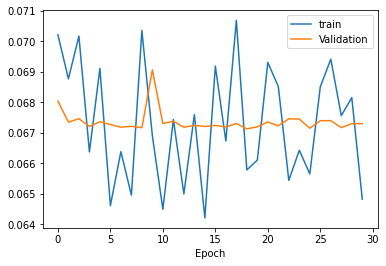

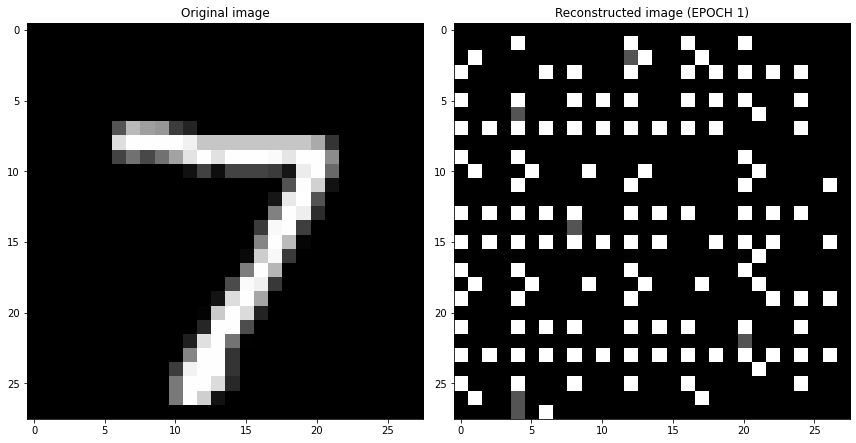

EPOCH 2/30
	 partial train loss (single batch): 0.228102
	 partial train loss (single batch): 0.225219
	 partial train loss (single batch): 0.215190
	 partial train loss (single batch): 0.209704
	 partial train loss (single batch): 0.180712
	 partial train loss (single batch): 0.172923
	 partial train loss (single batch): 0.159599
	 partial train loss (single batch): 0.159952
	 partial train loss (single batch): 0.158066
	 partial train loss (single batch): 0.157237
	 partial train loss (single batch): 0.158753
	 partial train loss (single batch): 0.151979
	 partial train loss (single batch): 0.149745
	 partial train loss (single batch): 0.148708
	 partial train loss (single batch): 0.147348
	 partial train loss (single batch): 0.143805
	 partial train loss (single batch): 0.144089
	 partial train loss (single batch): 0.142952
	 partial train loss (single batch): 0.143222
	 partial train loss (single batch): 0.141913
	 partial train loss (single batch): 0.148218
	 partial train loss (s

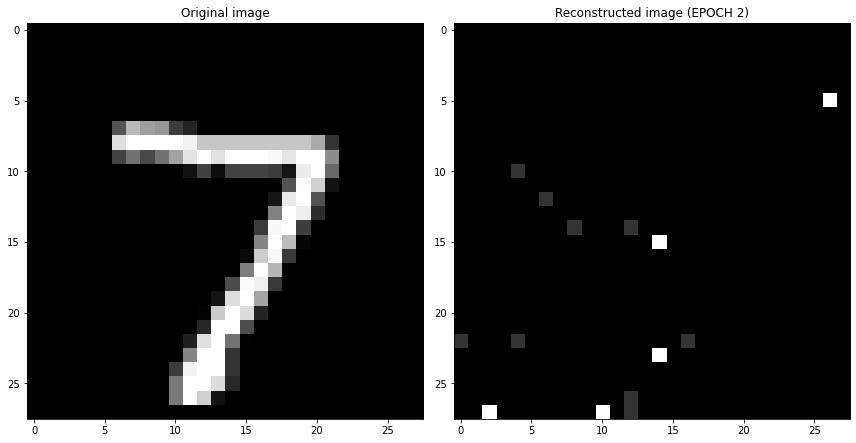

EPOCH 3/30
	 partial train loss (single batch): 0.114989
	 partial train loss (single batch): 0.121883
	 partial train loss (single batch): 0.118542
	 partial train loss (single batch): 0.114887
	 partial train loss (single batch): 0.117631
	 partial train loss (single batch): 0.115936
	 partial train loss (single batch): 0.115414
	 partial train loss (single batch): 0.117831
	 partial train loss (single batch): 0.115283
	 partial train loss (single batch): 0.114093
	 partial train loss (single batch): 0.117723
	 partial train loss (single batch): 0.117280
	 partial train loss (single batch): 0.118044
	 partial train loss (single batch): 0.118220
	 partial train loss (single batch): 0.116525
	 partial train loss (single batch): 0.114967
	 partial train loss (single batch): 0.121886
	 partial train loss (single batch): 0.123614
	 partial train loss (single batch): 0.120592
	 partial train loss (single batch): 0.117946
	 partial train loss (single batch): 0.113733
	 partial train loss (s

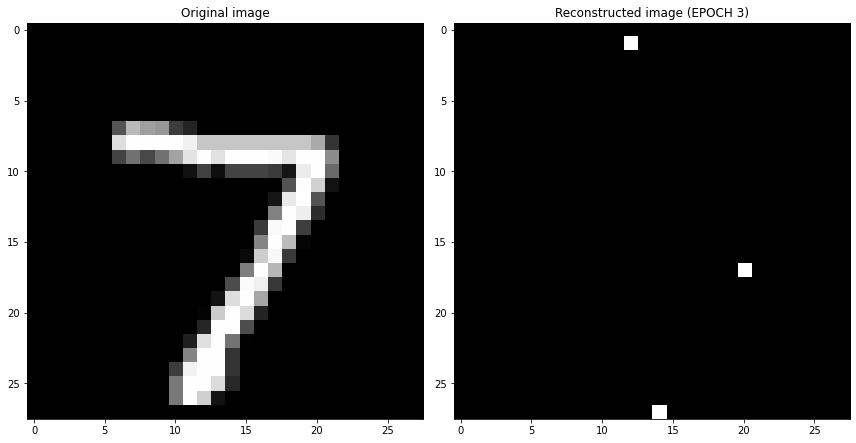

EPOCH 4/30
	 partial train loss (single batch): 0.113621
	 partial train loss (single batch): 0.111149
	 partial train loss (single batch): 0.112328
	 partial train loss (single batch): 0.112604
	 partial train loss (single batch): 0.115098
	 partial train loss (single batch): 0.112353
	 partial train loss (single batch): 0.114189
	 partial train loss (single batch): 0.111492
	 partial train loss (single batch): 0.113474
	 partial train loss (single batch): 0.113968
	 partial train loss (single batch): 0.112162
	 partial train loss (single batch): 0.110599
	 partial train loss (single batch): 0.120948
	 partial train loss (single batch): 0.114347
	 partial train loss (single batch): 0.114529
	 partial train loss (single batch): 0.114914
	 partial train loss (single batch): 0.112408
	 partial train loss (single batch): 0.117446
	 partial train loss (single batch): 0.109959
	 partial train loss (single batch): 0.112764
	 partial train loss (single batch): 0.113593
	 partial train loss (s

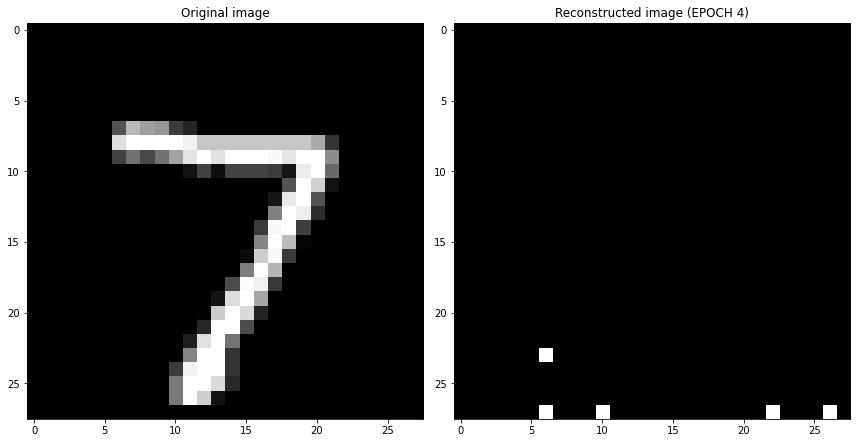

EPOCH 5/30
	 partial train loss (single batch): 0.117002
	 partial train loss (single batch): 0.114545
	 partial train loss (single batch): 0.117676
	 partial train loss (single batch): 0.109788
	 partial train loss (single batch): 0.117602
	 partial train loss (single batch): 0.114894
	 partial train loss (single batch): 0.115257
	 partial train loss (single batch): 0.116966
	 partial train loss (single batch): 0.110569
	 partial train loss (single batch): 0.112929
	 partial train loss (single batch): 0.114293
	 partial train loss (single batch): 0.112798
	 partial train loss (single batch): 0.112291
	 partial train loss (single batch): 0.110201
	 partial train loss (single batch): 0.110695
	 partial train loss (single batch): 0.115624
	 partial train loss (single batch): 0.114433
	 partial train loss (single batch): 0.119967
	 partial train loss (single batch): 0.118387
	 partial train loss (single batch): 0.115993
	 partial train loss (single batch): 0.116152
	 partial train loss (s

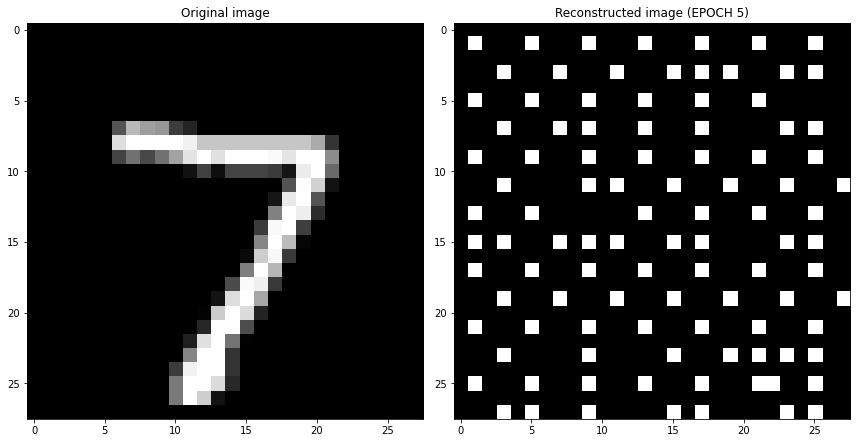

EPOCH 6/30
	 partial train loss (single batch): 0.205815
	 partial train loss (single batch): 0.205316
	 partial train loss (single batch): 0.206500
	 partial train loss (single batch): 0.208366
	 partial train loss (single batch): 0.205952
	 partial train loss (single batch): 0.201430
	 partial train loss (single batch): 0.204696
	 partial train loss (single batch): 0.206708
	 partial train loss (single batch): 0.200357
	 partial train loss (single batch): 0.203801
	 partial train loss (single batch): 0.205126
	 partial train loss (single batch): 0.201894
	 partial train loss (single batch): 0.200622
	 partial train loss (single batch): 0.198632
	 partial train loss (single batch): 0.197750
	 partial train loss (single batch): 0.193651
	 partial train loss (single batch): 0.196503
	 partial train loss (single batch): 0.198063
	 partial train loss (single batch): 0.198179
	 partial train loss (single batch): 0.198690
	 partial train loss (single batch): 0.192900
	 partial train loss (s

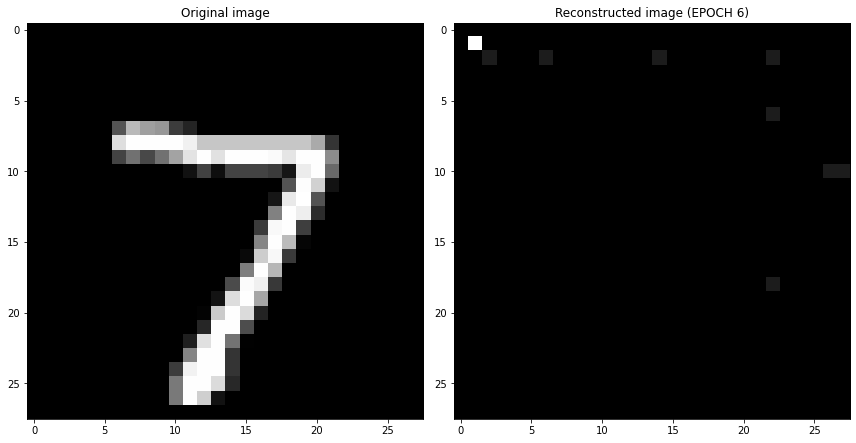

EPOCH 7/30
	 partial train loss (single batch): 0.108725
	 partial train loss (single batch): 0.113138
	 partial train loss (single batch): 0.113538
	 partial train loss (single batch): 0.110757
	 partial train loss (single batch): 0.114574
	 partial train loss (single batch): 0.115757
	 partial train loss (single batch): 0.113918
	 partial train loss (single batch): 0.106949
	 partial train loss (single batch): 0.112378
	 partial train loss (single batch): 0.113876
	 partial train loss (single batch): 0.113658
	 partial train loss (single batch): 0.114628
	 partial train loss (single batch): 0.113145
	 partial train loss (single batch): 0.112939
	 partial train loss (single batch): 0.115397
	 partial train loss (single batch): 0.113681
	 partial train loss (single batch): 0.111300
	 partial train loss (single batch): 0.115043
	 partial train loss (single batch): 0.114755
	 partial train loss (single batch): 0.113183
	 partial train loss (single batch): 0.116868
	 partial train loss (s

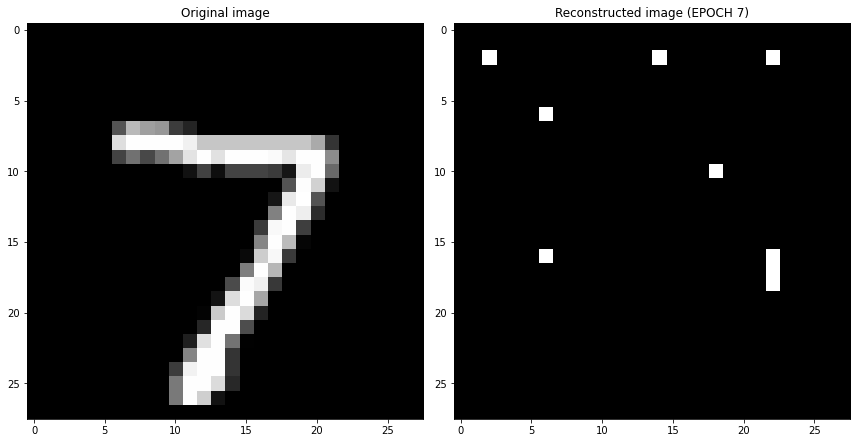

EPOCH 8/30
	 partial train loss (single batch): 0.111251
	 partial train loss (single batch): 0.111750
	 partial train loss (single batch): 0.113640
	 partial train loss (single batch): 0.113654
	 partial train loss (single batch): 0.113046
	 partial train loss (single batch): 0.115272
	 partial train loss (single batch): 0.112450
	 partial train loss (single batch): 0.109284
	 partial train loss (single batch): 0.112260
	 partial train loss (single batch): 0.115251
	 partial train loss (single batch): 0.113187
	 partial train loss (single batch): 0.108942
	 partial train loss (single batch): 0.111620
	 partial train loss (single batch): 0.112115
	 partial train loss (single batch): 0.111842
	 partial train loss (single batch): 0.112273
	 partial train loss (single batch): 0.116092
	 partial train loss (single batch): 0.117158
	 partial train loss (single batch): 0.110626
	 partial train loss (single batch): 0.111345
	 partial train loss (single batch): 0.113933
	 partial train loss (s

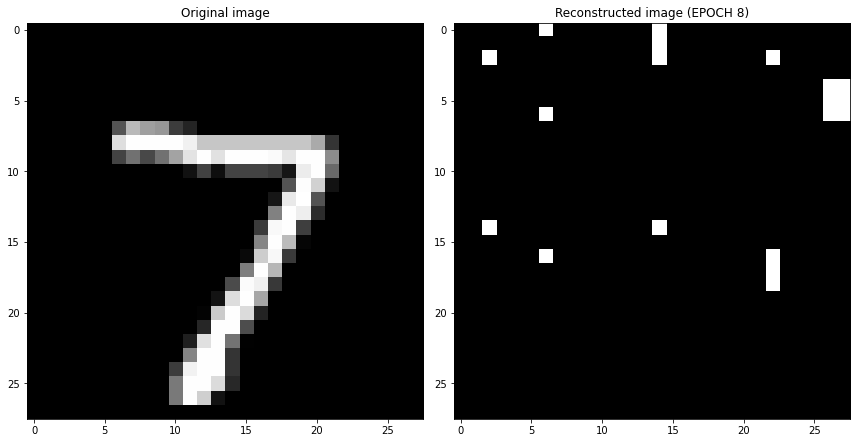

EPOCH 9/30
	 partial train loss (single batch): 0.112061
	 partial train loss (single batch): 0.113509
	 partial train loss (single batch): 0.116342
	 partial train loss (single batch): 0.108097
	 partial train loss (single batch): 0.108976
	 partial train loss (single batch): 0.111867
	 partial train loss (single batch): 0.112871
	 partial train loss (single batch): 0.117171
	 partial train loss (single batch): 0.113672
	 partial train loss (single batch): 0.112421
	 partial train loss (single batch): 0.114362
	 partial train loss (single batch): 0.113069
	 partial train loss (single batch): 0.114805
	 partial train loss (single batch): 0.114502
	 partial train loss (single batch): 0.117798
	 partial train loss (single batch): 0.125971
	 partial train loss (single batch): 0.126839
	 partial train loss (single batch): 0.125336
	 partial train loss (single batch): 0.133213
	 partial train loss (single batch): 0.130803
	 partial train loss (single batch): 0.132147
	 partial train loss (s

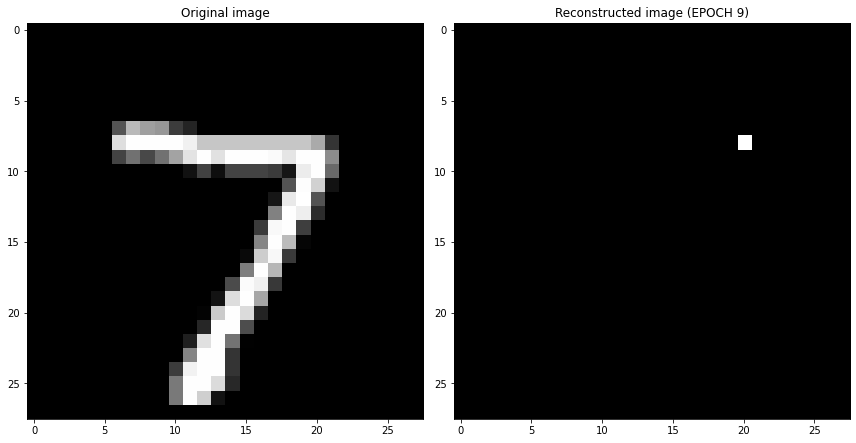

EPOCH 10/30
	 partial train loss (single batch): 0.110476
	 partial train loss (single batch): 0.114514
	 partial train loss (single batch): 0.112264
	 partial train loss (single batch): 0.112545
	 partial train loss (single batch): 0.111633
	 partial train loss (single batch): 0.112798
	 partial train loss (single batch): 0.111358
	 partial train loss (single batch): 0.112841
	 partial train loss (single batch): 0.111968
	 partial train loss (single batch): 0.114403
	 partial train loss (single batch): 0.108714
	 partial train loss (single batch): 0.108621
	 partial train loss (single batch): 0.110535
	 partial train loss (single batch): 0.115744
	 partial train loss (single batch): 0.110613
	 partial train loss (single batch): 0.111967
	 partial train loss (single batch): 0.113810
	 partial train loss (single batch): 0.113327
	 partial train loss (single batch): 0.110441
	 partial train loss (single batch): 0.113369
	 partial train loss (single batch): 0.110979
	 partial train loss (

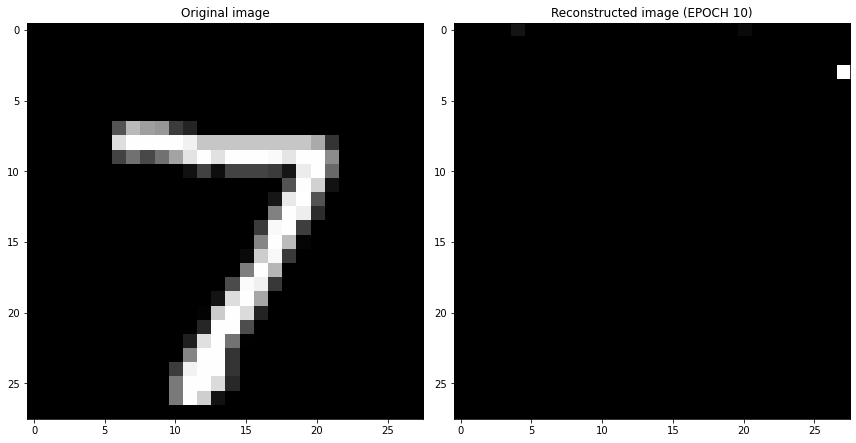

EPOCH 11/30
	 partial train loss (single batch): 0.106567
	 partial train loss (single batch): 0.109677
	 partial train loss (single batch): 0.108699
	 partial train loss (single batch): 0.112062
	 partial train loss (single batch): 0.115302
	 partial train loss (single batch): 0.111768
	 partial train loss (single batch): 0.112856
	 partial train loss (single batch): 0.111743
	 partial train loss (single batch): 0.110960
	 partial train loss (single batch): 0.114459
	 partial train loss (single batch): 0.108839
	 partial train loss (single batch): 0.110973
	 partial train loss (single batch): 0.108061
	 partial train loss (single batch): 0.109156
	 partial train loss (single batch): 0.113222
	 partial train loss (single batch): 0.115028
	 partial train loss (single batch): 0.110366
	 partial train loss (single batch): 0.114851
	 partial train loss (single batch): 0.116052
	 partial train loss (single batch): 0.109888
	 partial train loss (single batch): 0.109459
	 partial train loss (

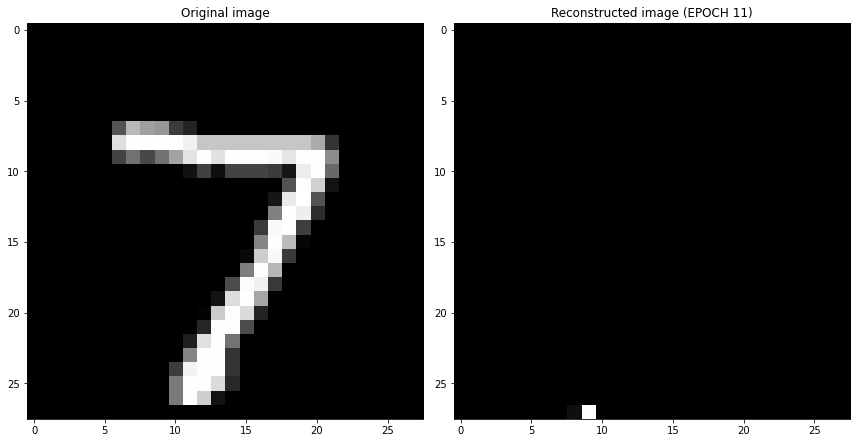

EPOCH 12/30
	 partial train loss (single batch): 0.110965
	 partial train loss (single batch): 0.115242
	 partial train loss (single batch): 0.113763
	 partial train loss (single batch): 0.115637
	 partial train loss (single batch): 0.116246
	 partial train loss (single batch): 0.107782
	 partial train loss (single batch): 0.113891
	 partial train loss (single batch): 0.114624
	 partial train loss (single batch): 0.113498
	 partial train loss (single batch): 0.113869
	 partial train loss (single batch): 0.115461
	 partial train loss (single batch): 0.113939
	 partial train loss (single batch): 0.114375
	 partial train loss (single batch): 0.111969
	 partial train loss (single batch): 0.108137
	 partial train loss (single batch): 0.112114
	 partial train loss (single batch): 0.110064
	 partial train loss (single batch): 0.111501
	 partial train loss (single batch): 0.111054
	 partial train loss (single batch): 0.114657
	 partial train loss (single batch): 0.111372
	 partial train loss (

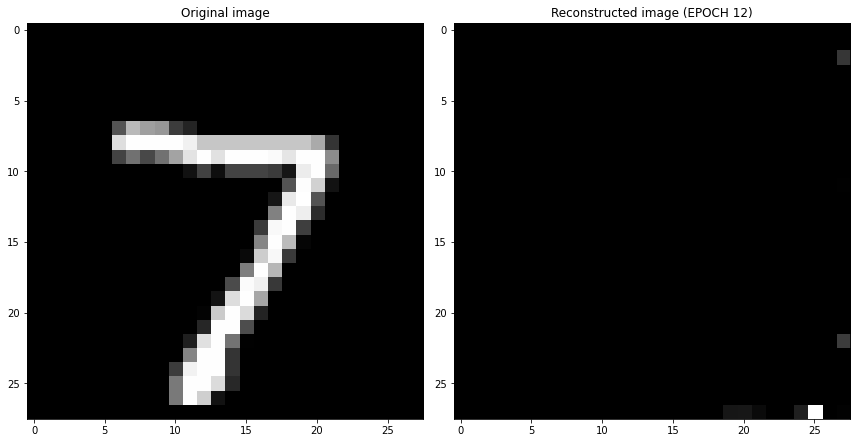

EPOCH 13/30
	 partial train loss (single batch): 0.112240
	 partial train loss (single batch): 0.113708
	 partial train loss (single batch): 0.109185
	 partial train loss (single batch): 0.111431
	 partial train loss (single batch): 0.112023
	 partial train loss (single batch): 0.114268
	 partial train loss (single batch): 0.112596
	 partial train loss (single batch): 0.111593
	 partial train loss (single batch): 0.110275
	 partial train loss (single batch): 0.112571
	 partial train loss (single batch): 0.108860
	 partial train loss (single batch): 0.109987
	 partial train loss (single batch): 0.114686
	 partial train loss (single batch): 0.116801
	 partial train loss (single batch): 0.117398
	 partial train loss (single batch): 0.117042
	 partial train loss (single batch): 0.112017
	 partial train loss (single batch): 0.114754
	 partial train loss (single batch): 0.111208
	 partial train loss (single batch): 0.111980
	 partial train loss (single batch): 0.115576
	 partial train loss (

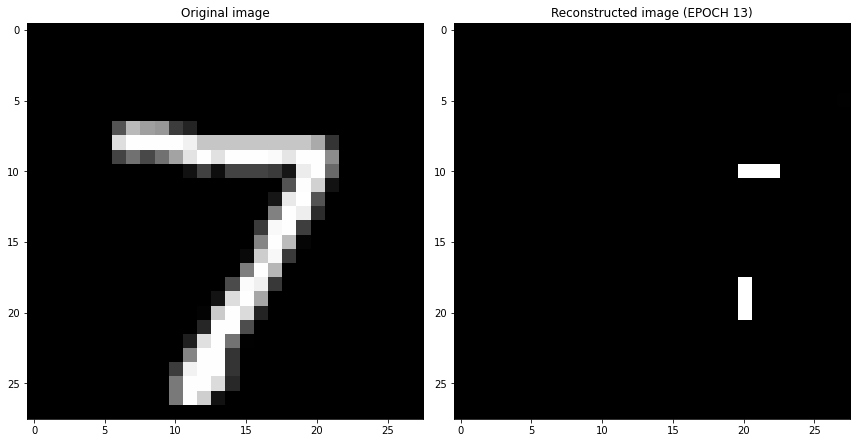

EPOCH 14/30
	 partial train loss (single batch): 0.110319
	 partial train loss (single batch): 0.112148
	 partial train loss (single batch): 0.111449
	 partial train loss (single batch): 0.111833
	 partial train loss (single batch): 0.110928
	 partial train loss (single batch): 0.107274
	 partial train loss (single batch): 0.113298
	 partial train loss (single batch): 0.113036
	 partial train loss (single batch): 0.111527
	 partial train loss (single batch): 0.112679
	 partial train loss (single batch): 0.108186
	 partial train loss (single batch): 0.108986
	 partial train loss (single batch): 0.114218
	 partial train loss (single batch): 0.110105
	 partial train loss (single batch): 0.114313
	 partial train loss (single batch): 0.115069
	 partial train loss (single batch): 0.114925
	 partial train loss (single batch): 0.107319
	 partial train loss (single batch): 0.116821
	 partial train loss (single batch): 0.111509
	 partial train loss (single batch): 0.108272
	 partial train loss (

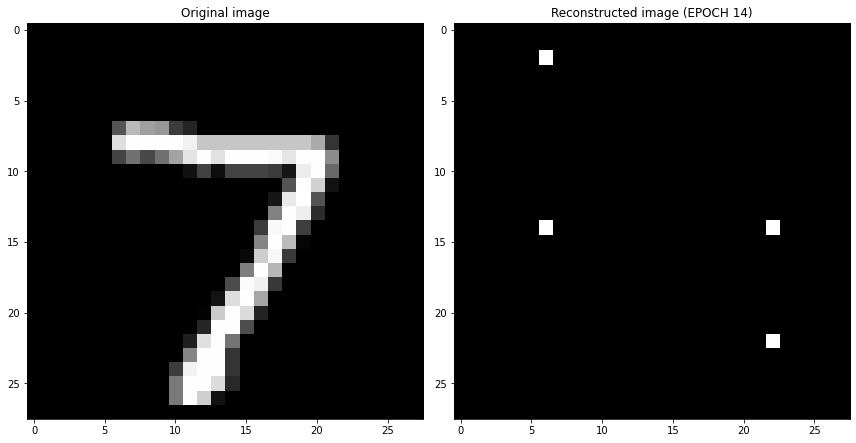

EPOCH 15/30
	 partial train loss (single batch): 0.110502
	 partial train loss (single batch): 0.112617
	 partial train loss (single batch): 0.111591
	 partial train loss (single batch): 0.114559
	 partial train loss (single batch): 0.110465
	 partial train loss (single batch): 0.112965
	 partial train loss (single batch): 0.106155
	 partial train loss (single batch): 0.112642
	 partial train loss (single batch): 0.111939
	 partial train loss (single batch): 0.116798
	 partial train loss (single batch): 0.114131
	 partial train loss (single batch): 0.113938
	 partial train loss (single batch): 0.114273
	 partial train loss (single batch): 0.116623
	 partial train loss (single batch): 0.112449
	 partial train loss (single batch): 0.107949
	 partial train loss (single batch): 0.111795
	 partial train loss (single batch): 0.114881
	 partial train loss (single batch): 0.110919
	 partial train loss (single batch): 0.111094
	 partial train loss (single batch): 0.111508
	 partial train loss (

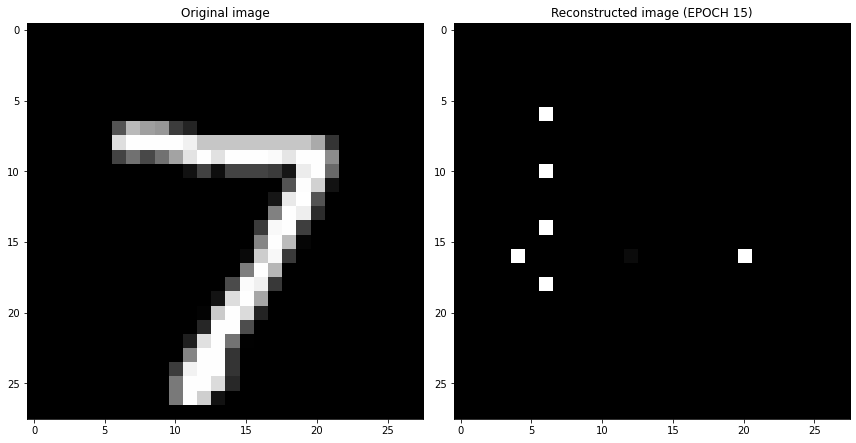

EPOCH 16/30
	 partial train loss (single batch): 0.106081
	 partial train loss (single batch): 0.112492
	 partial train loss (single batch): 0.112104
	 partial train loss (single batch): 0.110706
	 partial train loss (single batch): 0.112889
	 partial train loss (single batch): 0.111677
	 partial train loss (single batch): 0.113059
	 partial train loss (single batch): 0.115650
	 partial train loss (single batch): 0.113531
	 partial train loss (single batch): 0.113328
	 partial train loss (single batch): 0.112826
	 partial train loss (single batch): 0.116303
	 partial train loss (single batch): 0.114145
	 partial train loss (single batch): 0.114980
	 partial train loss (single batch): 0.114023
	 partial train loss (single batch): 0.112929
	 partial train loss (single batch): 0.116945
	 partial train loss (single batch): 0.109816
	 partial train loss (single batch): 0.108686
	 partial train loss (single batch): 0.107613
	 partial train loss (single batch): 0.110899
	 partial train loss (

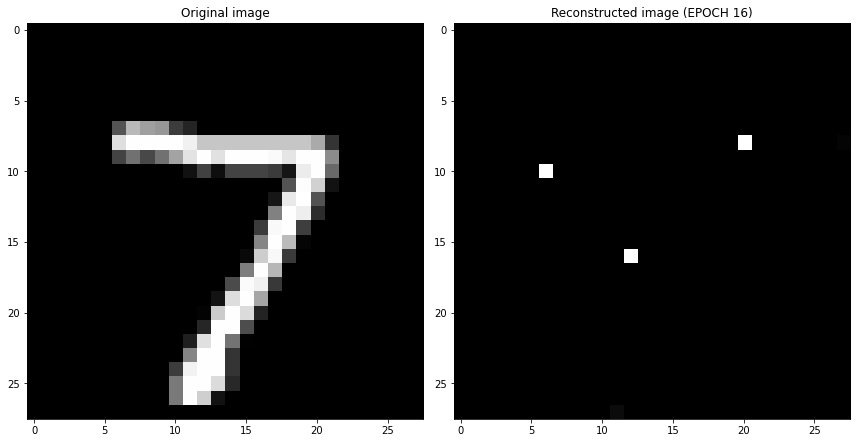

EPOCH 17/30
	 partial train loss (single batch): 0.113646
	 partial train loss (single batch): 0.114681
	 partial train loss (single batch): 0.110805
	 partial train loss (single batch): 0.111968
	 partial train loss (single batch): 0.111891
	 partial train loss (single batch): 0.110919
	 partial train loss (single batch): 0.106963
	 partial train loss (single batch): 0.112058
	 partial train loss (single batch): 0.110501
	 partial train loss (single batch): 0.108089
	 partial train loss (single batch): 0.111580
	 partial train loss (single batch): 0.110261
	 partial train loss (single batch): 0.114218
	 partial train loss (single batch): 0.112769
	 partial train loss (single batch): 0.109765
	 partial train loss (single batch): 0.108883
	 partial train loss (single batch): 0.110018
	 partial train loss (single batch): 0.114420
	 partial train loss (single batch): 0.108853
	 partial train loss (single batch): 0.110893
	 partial train loss (single batch): 0.111162
	 partial train loss (

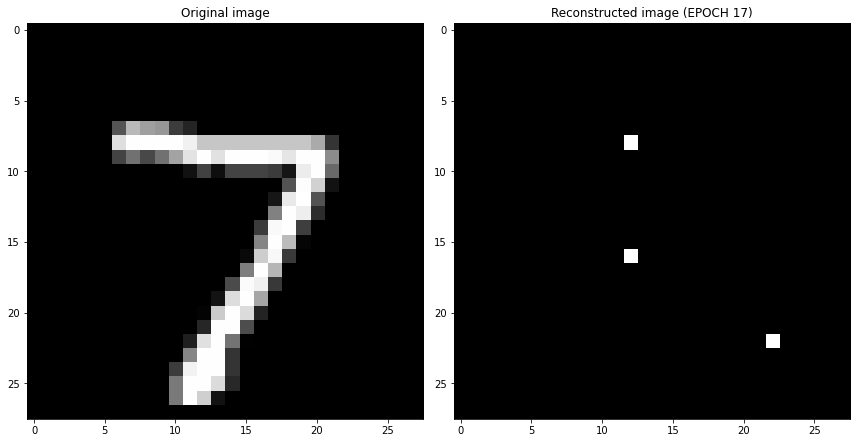

EPOCH 18/30
	 partial train loss (single batch): 0.108190
	 partial train loss (single batch): 0.107812
	 partial train loss (single batch): 0.112116
	 partial train loss (single batch): 0.111436
	 partial train loss (single batch): 0.109418
	 partial train loss (single batch): 0.114518
	 partial train loss (single batch): 0.114295
	 partial train loss (single batch): 0.115129
	 partial train loss (single batch): 0.115976
	 partial train loss (single batch): 0.112612
	 partial train loss (single batch): 0.109493
	 partial train loss (single batch): 0.111667
	 partial train loss (single batch): 0.111973
	 partial train loss (single batch): 0.117571
	 partial train loss (single batch): 0.109676
	 partial train loss (single batch): 0.115108
	 partial train loss (single batch): 0.113715
	 partial train loss (single batch): 0.112430
	 partial train loss (single batch): 0.108566
	 partial train loss (single batch): 0.111696
	 partial train loss (single batch): 0.114423
	 partial train loss (

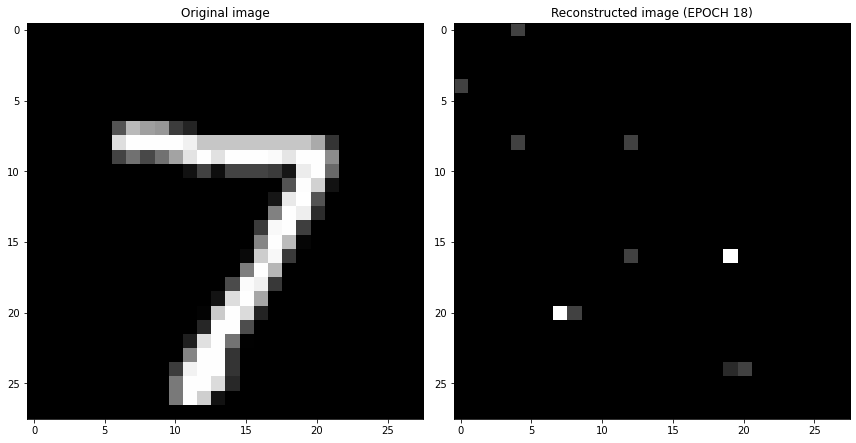

EPOCH 19/30
	 partial train loss (single batch): 0.113773
	 partial train loss (single batch): 0.113065
	 partial train loss (single batch): 0.112708
	 partial train loss (single batch): 0.111323
	 partial train loss (single batch): 0.114740
	 partial train loss (single batch): 0.116937
	 partial train loss (single batch): 0.111590
	 partial train loss (single batch): 0.114380
	 partial train loss (single batch): 0.114553
	 partial train loss (single batch): 0.110559
	 partial train loss (single batch): 0.111413
	 partial train loss (single batch): 0.109988
	 partial train loss (single batch): 0.111003
	 partial train loss (single batch): 0.113116
	 partial train loss (single batch): 0.109376
	 partial train loss (single batch): 0.111738
	 partial train loss (single batch): 0.111380
	 partial train loss (single batch): 0.112817
	 partial train loss (single batch): 0.109498
	 partial train loss (single batch): 0.109204
	 partial train loss (single batch): 0.113312
	 partial train loss (

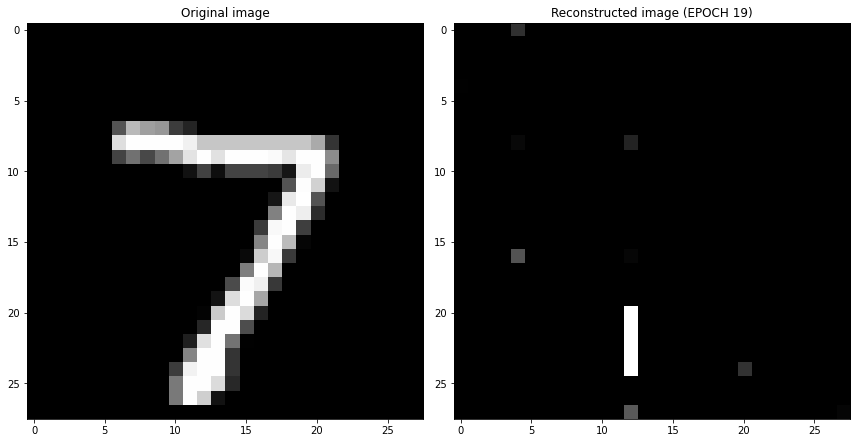

EPOCH 20/30
	 partial train loss (single batch): 0.110929
	 partial train loss (single batch): 0.115801
	 partial train loss (single batch): 0.111384
	 partial train loss (single batch): 0.112263
	 partial train loss (single batch): 0.116863
	 partial train loss (single batch): 0.116846
	 partial train loss (single batch): 0.109506
	 partial train loss (single batch): 0.112113
	 partial train loss (single batch): 0.108979
	 partial train loss (single batch): 0.117484
	 partial train loss (single batch): 0.107807
	 partial train loss (single batch): 0.113528
	 partial train loss (single batch): 0.112800
	 partial train loss (single batch): 0.111672
	 partial train loss (single batch): 0.110876
	 partial train loss (single batch): 0.112686
	 partial train loss (single batch): 0.108952
	 partial train loss (single batch): 0.106430
	 partial train loss (single batch): 0.112746
	 partial train loss (single batch): 0.106847
	 partial train loss (single batch): 0.109210
	 partial train loss (

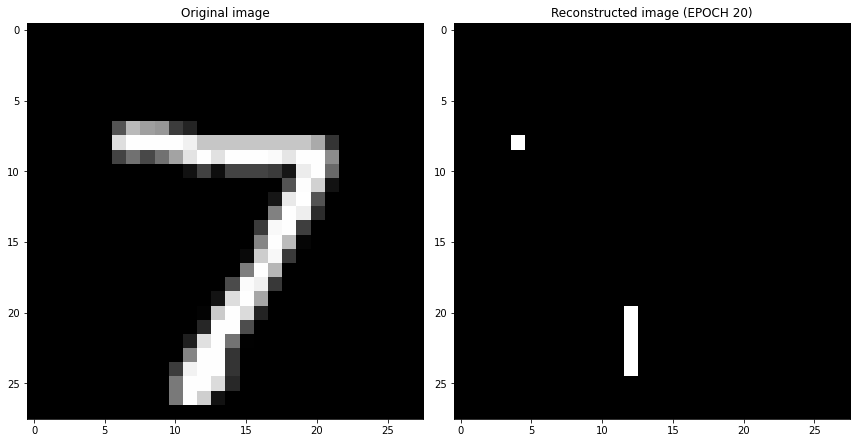

EPOCH 21/30
	 partial train loss (single batch): 0.112144
	 partial train loss (single batch): 0.111229
	 partial train loss (single batch): 0.108842
	 partial train loss (single batch): 0.115749
	 partial train loss (single batch): 0.111441
	 partial train loss (single batch): 0.112584
	 partial train loss (single batch): 0.112739
	 partial train loss (single batch): 0.107226
	 partial train loss (single batch): 0.109593
	 partial train loss (single batch): 0.112581
	 partial train loss (single batch): 0.114107
	 partial train loss (single batch): 0.113116
	 partial train loss (single batch): 0.115246
	 partial train loss (single batch): 0.111983
	 partial train loss (single batch): 0.114894
	 partial train loss (single batch): 0.114439
	 partial train loss (single batch): 0.109263
	 partial train loss (single batch): 0.108124
	 partial train loss (single batch): 0.112020
	 partial train loss (single batch): 0.108185
	 partial train loss (single batch): 0.111028
	 partial train loss (

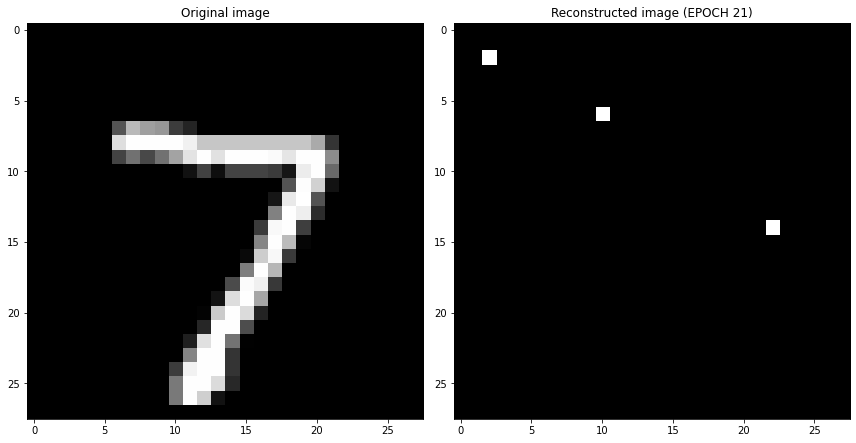

EPOCH 22/30
	 partial train loss (single batch): 0.109764
	 partial train loss (single batch): 0.114977
	 partial train loss (single batch): 0.112028
	 partial train loss (single batch): 0.111831
	 partial train loss (single batch): 0.113161
	 partial train loss (single batch): 0.110447
	 partial train loss (single batch): 0.115385
	 partial train loss (single batch): 0.115819
	 partial train loss (single batch): 0.109975
	 partial train loss (single batch): 0.110380
	 partial train loss (single batch): 0.113390
	 partial train loss (single batch): 0.109806
	 partial train loss (single batch): 0.110766
	 partial train loss (single batch): 0.111716
	 partial train loss (single batch): 0.117295
	 partial train loss (single batch): 0.107862
	 partial train loss (single batch): 0.117170
	 partial train loss (single batch): 0.111066
	 partial train loss (single batch): 0.108677
	 partial train loss (single batch): 0.112163
	 partial train loss (single batch): 0.113092
	 partial train loss (

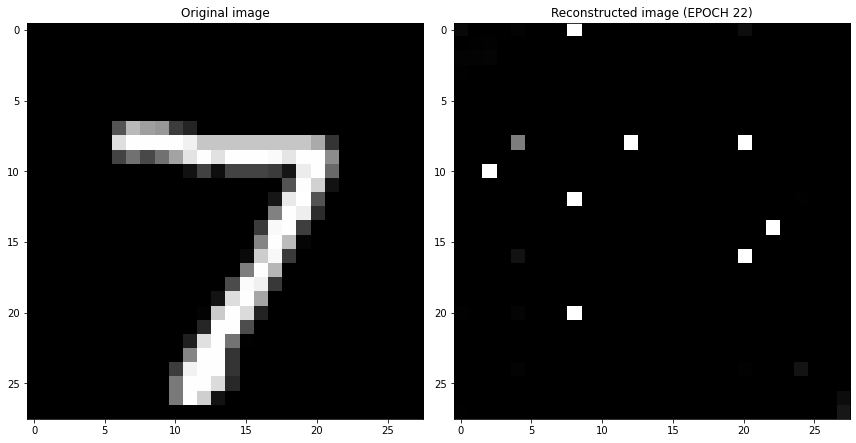

EPOCH 23/30
	 partial train loss (single batch): 0.110299
	 partial train loss (single batch): 0.111835
	 partial train loss (single batch): 0.110321
	 partial train loss (single batch): 0.114203
	 partial train loss (single batch): 0.113050
	 partial train loss (single batch): 0.117519
	 partial train loss (single batch): 0.112308
	 partial train loss (single batch): 0.113142
	 partial train loss (single batch): 0.108325
	 partial train loss (single batch): 0.110521
	 partial train loss (single batch): 0.113641
	 partial train loss (single batch): 0.110694
	 partial train loss (single batch): 0.117347
	 partial train loss (single batch): 0.114651
	 partial train loss (single batch): 0.110957
	 partial train loss (single batch): 0.107179
	 partial train loss (single batch): 0.111404
	 partial train loss (single batch): 0.103946
	 partial train loss (single batch): 0.107642
	 partial train loss (single batch): 0.110720
	 partial train loss (single batch): 0.107090
	 partial train loss (

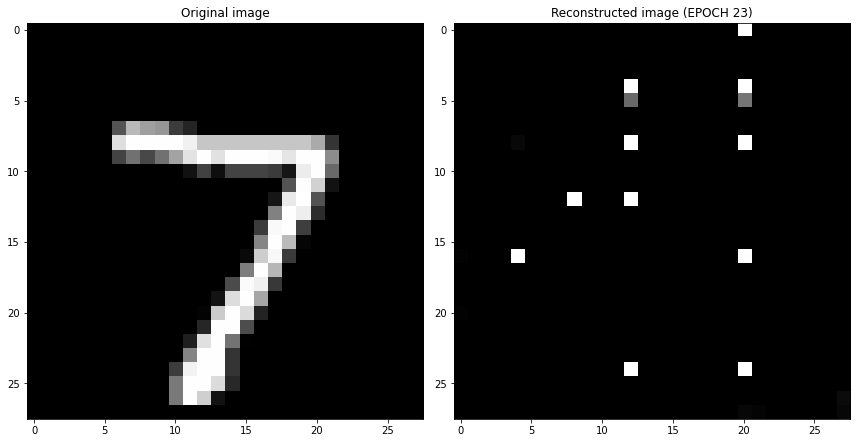

EPOCH 24/30
	 partial train loss (single batch): 0.114767
	 partial train loss (single batch): 0.109656
	 partial train loss (single batch): 0.109987
	 partial train loss (single batch): 0.115575
	 partial train loss (single batch): 0.111336
	 partial train loss (single batch): 0.112653
	 partial train loss (single batch): 0.111962
	 partial train loss (single batch): 0.109828
	 partial train loss (single batch): 0.110409
	 partial train loss (single batch): 0.111525
	 partial train loss (single batch): 0.109329
	 partial train loss (single batch): 0.109727
	 partial train loss (single batch): 0.115481
	 partial train loss (single batch): 0.111837
	 partial train loss (single batch): 0.110166
	 partial train loss (single batch): 0.115299
	 partial train loss (single batch): 0.106945
	 partial train loss (single batch): 0.108108
	 partial train loss (single batch): 0.112257
	 partial train loss (single batch): 0.109303
	 partial train loss (single batch): 0.107524
	 partial train loss (

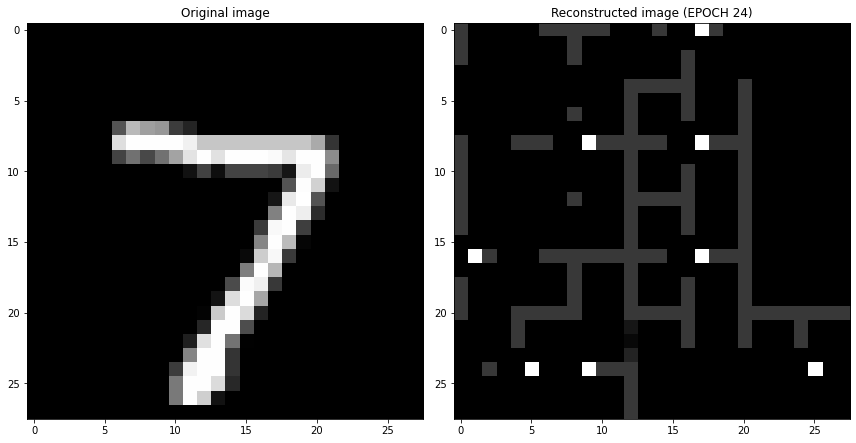

EPOCH 25/30
	 partial train loss (single batch): 0.113934
	 partial train loss (single batch): 0.111013
	 partial train loss (single batch): 0.119440
	 partial train loss (single batch): 0.113612
	 partial train loss (single batch): 0.115793
	 partial train loss (single batch): 0.114136
	 partial train loss (single batch): 0.115765
	 partial train loss (single batch): 0.112696
	 partial train loss (single batch): 0.112913
	 partial train loss (single batch): 0.115517
	 partial train loss (single batch): 0.113312
	 partial train loss (single batch): 0.114019
	 partial train loss (single batch): 0.113301
	 partial train loss (single batch): 0.111625
	 partial train loss (single batch): 0.113774
	 partial train loss (single batch): 0.109009
	 partial train loss (single batch): 0.114630
	 partial train loss (single batch): 0.116494
	 partial train loss (single batch): 0.112184
	 partial train loss (single batch): 0.110579
	 partial train loss (single batch): 0.112765
	 partial train loss (

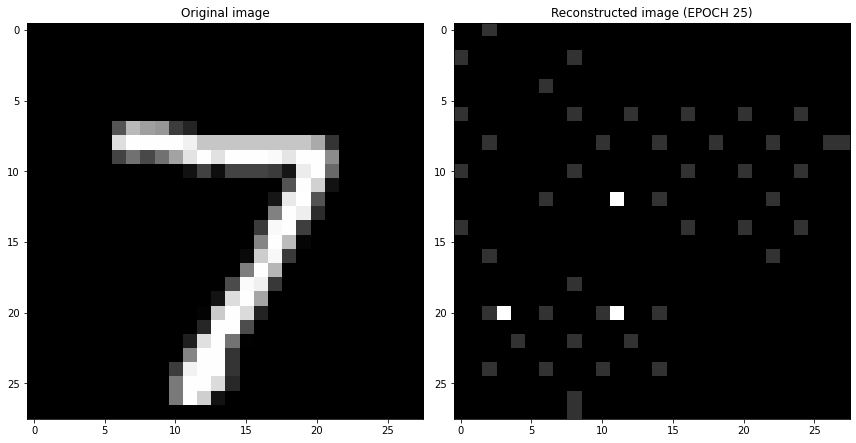

EPOCH 26/30
	 partial train loss (single batch): 0.113035
	 partial train loss (single batch): 0.113217
	 partial train loss (single batch): 0.112230
	 partial train loss (single batch): 0.112989
	 partial train loss (single batch): 0.111756
	 partial train loss (single batch): 0.113015
	 partial train loss (single batch): 0.110706
	 partial train loss (single batch): 0.114144
	 partial train loss (single batch): 0.115543
	 partial train loss (single batch): 0.113991
	 partial train loss (single batch): 0.113015
	 partial train loss (single batch): 0.114788
	 partial train loss (single batch): 0.112266
	 partial train loss (single batch): 0.116348
	 partial train loss (single batch): 0.110555
	 partial train loss (single batch): 0.111353
	 partial train loss (single batch): 0.118354
	 partial train loss (single batch): 0.109906
	 partial train loss (single batch): 0.113875
	 partial train loss (single batch): 0.114024
	 partial train loss (single batch): 0.113871
	 partial train loss (

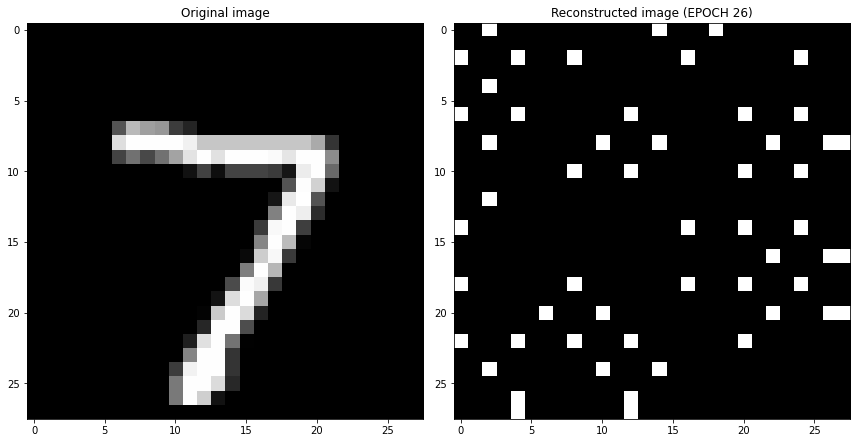

EPOCH 27/30
	 partial train loss (single batch): 0.114377
	 partial train loss (single batch): 0.112471
	 partial train loss (single batch): 0.108126
	 partial train loss (single batch): 0.110400
	 partial train loss (single batch): 0.110338
	 partial train loss (single batch): 0.110663
	 partial train loss (single batch): 0.112250
	 partial train loss (single batch): 0.114895
	 partial train loss (single batch): 0.113708
	 partial train loss (single batch): 0.109583
	 partial train loss (single batch): 0.112588
	 partial train loss (single batch): 0.115315
	 partial train loss (single batch): 0.112092
	 partial train loss (single batch): 0.114210
	 partial train loss (single batch): 0.111952
	 partial train loss (single batch): 0.112753
	 partial train loss (single batch): 0.111273
	 partial train loss (single batch): 0.111508
	 partial train loss (single batch): 0.113561
	 partial train loss (single batch): 0.109185
	 partial train loss (single batch): 0.112951
	 partial train loss (

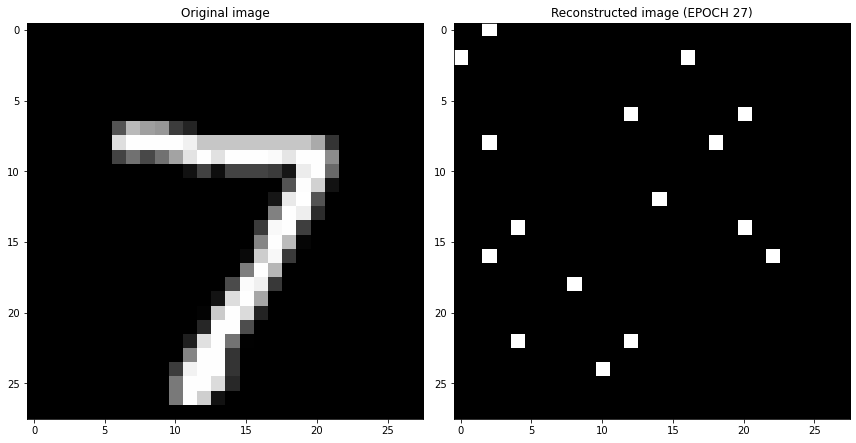

EPOCH 28/30
	 partial train loss (single batch): 0.114011
	 partial train loss (single batch): 0.111710
	 partial train loss (single batch): 0.113235
	 partial train loss (single batch): 0.110871
	 partial train loss (single batch): 0.113434
	 partial train loss (single batch): 0.110969
	 partial train loss (single batch): 0.114967
	 partial train loss (single batch): 0.115628
	 partial train loss (single batch): 0.106622
	 partial train loss (single batch): 0.116399
	 partial train loss (single batch): 0.113292
	 partial train loss (single batch): 0.117552
	 partial train loss (single batch): 0.107818
	 partial train loss (single batch): 0.108051
	 partial train loss (single batch): 0.113213
	 partial train loss (single batch): 0.108245
	 partial train loss (single batch): 0.113002
	 partial train loss (single batch): 0.114944
	 partial train loss (single batch): 0.111216
	 partial train loss (single batch): 0.113178
	 partial train loss (single batch): 0.114243
	 partial train loss (

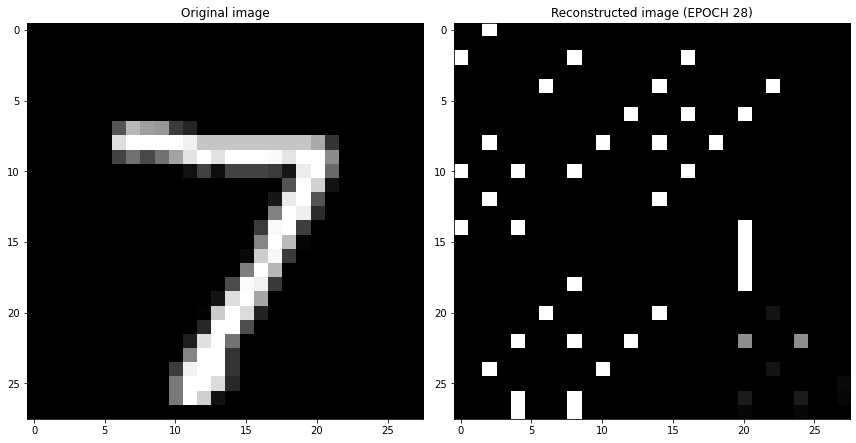

EPOCH 29/30
	 partial train loss (single batch): 0.106553
	 partial train loss (single batch): 0.112549
	 partial train loss (single batch): 0.114355
	 partial train loss (single batch): 0.110625
	 partial train loss (single batch): 0.109164
	 partial train loss (single batch): 0.115273
	 partial train loss (single batch): 0.105764
	 partial train loss (single batch): 0.109852
	 partial train loss (single batch): 0.112228
	 partial train loss (single batch): 0.109790
	 partial train loss (single batch): 0.117477
	 partial train loss (single batch): 0.109406
	 partial train loss (single batch): 0.110794
	 partial train loss (single batch): 0.108735
	 partial train loss (single batch): 0.112504
	 partial train loss (single batch): 0.111172
	 partial train loss (single batch): 0.112404
	 partial train loss (single batch): 0.111459
	 partial train loss (single batch): 0.113643
	 partial train loss (single batch): 0.114580
	 partial train loss (single batch): 0.109557
	 partial train loss (

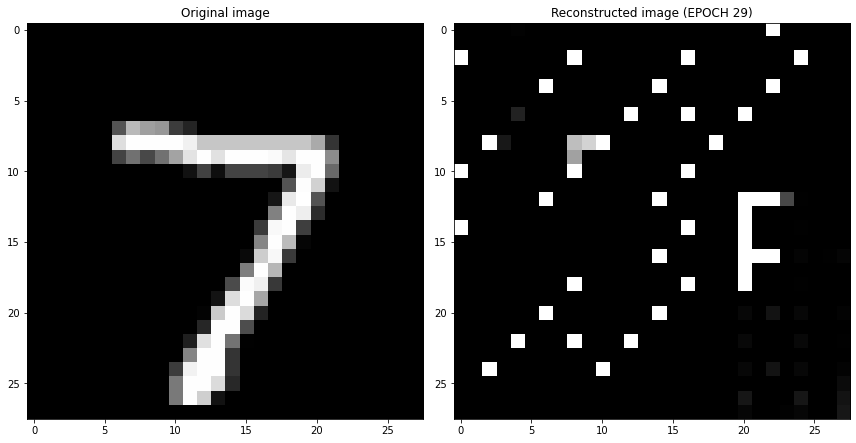

EPOCH 30/30
	 partial train loss (single batch): 0.115937
	 partial train loss (single batch): 0.114105
	 partial train loss (single batch): 0.108071
	 partial train loss (single batch): 0.107534
	 partial train loss (single batch): 0.116705
	 partial train loss (single batch): 0.106648
	 partial train loss (single batch): 0.108841
	 partial train loss (single batch): 0.106547
	 partial train loss (single batch): 0.105438
	 partial train loss (single batch): 0.108872
	 partial train loss (single batch): 0.108302
	 partial train loss (single batch): 0.108646
	 partial train loss (single batch): 0.109149
	 partial train loss (single batch): 0.108360
	 partial train loss (single batch): 0.107500
	 partial train loss (single batch): 0.106255
	 partial train loss (single batch): 0.112735
	 partial train loss (single batch): 0.106502
	 partial train loss (single batch): 0.106607
	 partial train loss (single batch): 0.106832
	 partial train loss (single batch): 0.107500
	 partial train loss (

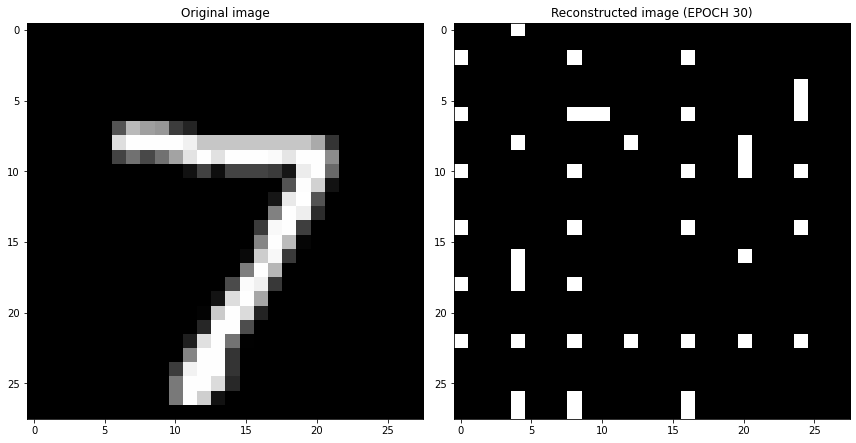

Cross validation fold number= 6/6
EPOCH 1/30
	 partial train loss (single batch): 0.191164
	 partial train loss (single batch): 0.144619
	 partial train loss (single batch): 0.176825
	 partial train loss (single batch): 0.113122
	 partial train loss (single batch): 0.109759
	 partial train loss (single batch): 0.101336
	 partial train loss (single batch): 0.090196
	 partial train loss (single batch): 0.088725
	 partial train loss (single batch): 0.088783
	 partial train loss (single batch): 0.083010
	 partial train loss (single batch): 0.081720
	 partial train loss (single batch): 0.074552
	 partial train loss (single batch): 0.082244
	 partial train loss (single batch): 0.076338
	 partial train loss (single batch): 0.075046
	 partial train loss (single batch): 0.072907
	 partial train loss (single batch): 0.072425
	 partial train loss (single batch): 0.072802
	 partial train loss (single batch): 0.071797
	 partial train loss (single batch): 0.072565
	 partial train loss (single batch)

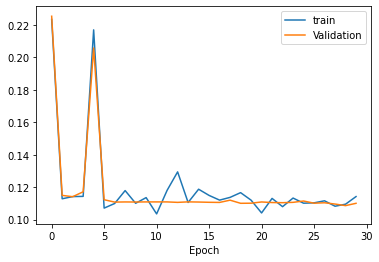

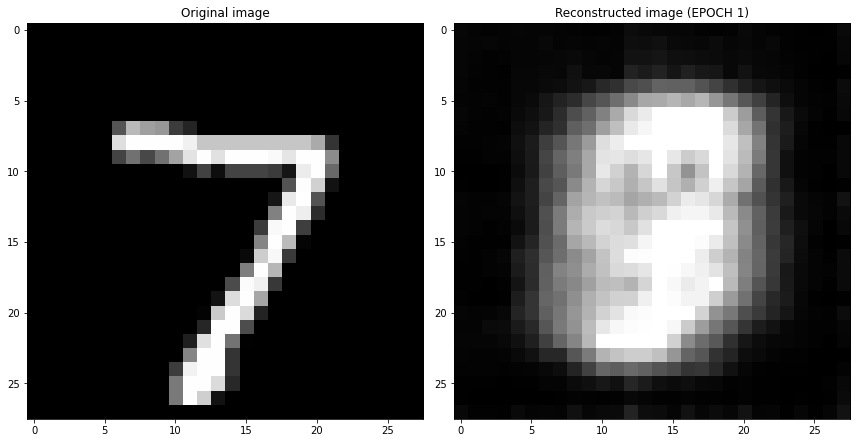

EPOCH 2/30
	 partial train loss (single batch): 0.069399
	 partial train loss (single batch): 0.069217
	 partial train loss (single batch): 0.067671
	 partial train loss (single batch): 0.067936
	 partial train loss (single batch): 0.066732
	 partial train loss (single batch): 0.069031
	 partial train loss (single batch): 0.067117
	 partial train loss (single batch): 0.069065
	 partial train loss (single batch): 0.065413
	 partial train loss (single batch): 0.068581
	 partial train loss (single batch): 0.065413
	 partial train loss (single batch): 0.066659
	 partial train loss (single batch): 0.069686
	 partial train loss (single batch): 0.071043
	 partial train loss (single batch): 0.069788
	 partial train loss (single batch): 0.069232
	 partial train loss (single batch): 0.069205
	 partial train loss (single batch): 0.067931
	 partial train loss (single batch): 0.066930
	 partial train loss (single batch): 0.066924
	 partial train loss (single batch): 0.068405
	 partial train loss (s

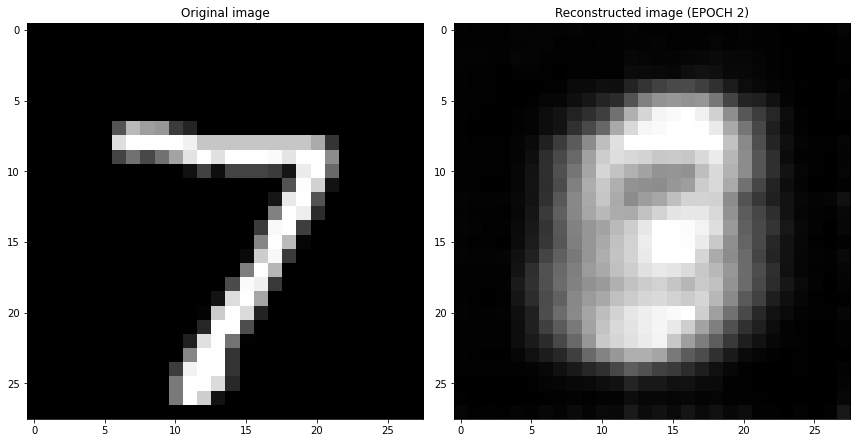

EPOCH 3/30
	 partial train loss (single batch): 0.066384
	 partial train loss (single batch): 0.065034
	 partial train loss (single batch): 0.069238
	 partial train loss (single batch): 0.065233
	 partial train loss (single batch): 0.065784
	 partial train loss (single batch): 0.068003
	 partial train loss (single batch): 0.066392
	 partial train loss (single batch): 0.067025
	 partial train loss (single batch): 0.065325
	 partial train loss (single batch): 0.067114
	 partial train loss (single batch): 0.069940
	 partial train loss (single batch): 0.068225
	 partial train loss (single batch): 0.068498
	 partial train loss (single batch): 0.068218
	 partial train loss (single batch): 0.069815
	 partial train loss (single batch): 0.066007
	 partial train loss (single batch): 0.065471
	 partial train loss (single batch): 0.067790
	 partial train loss (single batch): 0.065719
	 partial train loss (single batch): 0.067232
	 partial train loss (single batch): 0.065937
	 partial train loss (s

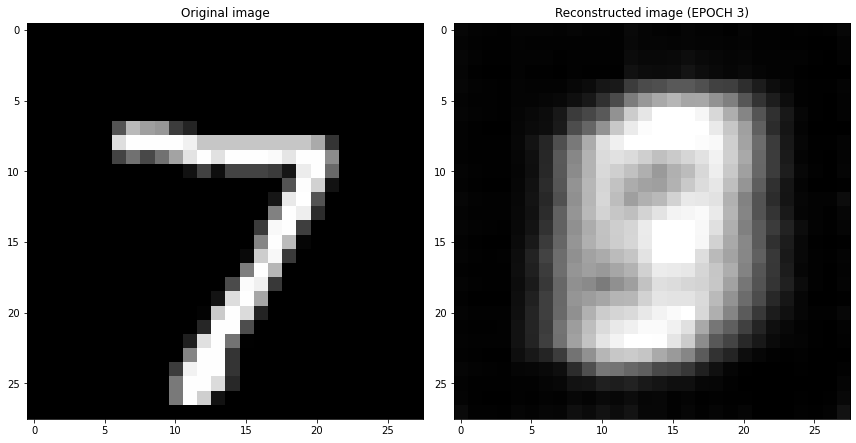

EPOCH 4/30
	 partial train loss (single batch): 0.067079
	 partial train loss (single batch): 0.066979
	 partial train loss (single batch): 0.066814
	 partial train loss (single batch): 0.068684
	 partial train loss (single batch): 0.068059
	 partial train loss (single batch): 0.067461
	 partial train loss (single batch): 0.067216
	 partial train loss (single batch): 0.068255
	 partial train loss (single batch): 0.066803
	 partial train loss (single batch): 0.068753
	 partial train loss (single batch): 0.066286
	 partial train loss (single batch): 0.068887
	 partial train loss (single batch): 0.066295
	 partial train loss (single batch): 0.066501
	 partial train loss (single batch): 0.070407
	 partial train loss (single batch): 0.069314
	 partial train loss (single batch): 0.066719
	 partial train loss (single batch): 0.068790
	 partial train loss (single batch): 0.066571
	 partial train loss (single batch): 0.067754
	 partial train loss (single batch): 0.070450
	 partial train loss (s

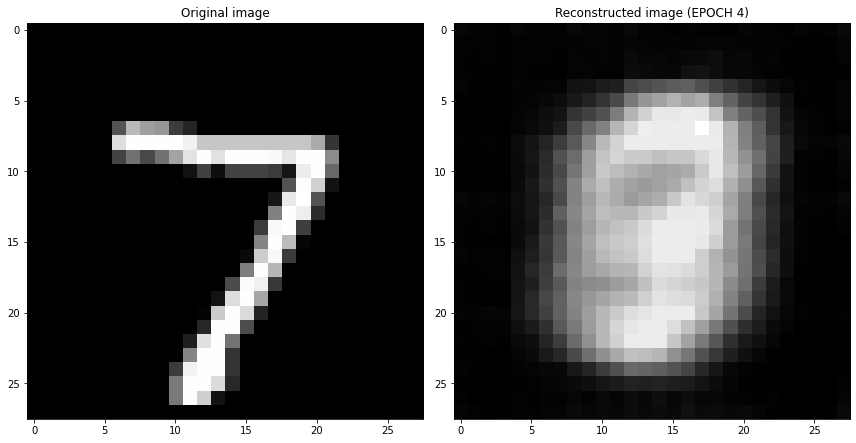

EPOCH 5/30
	 partial train loss (single batch): 0.066703
	 partial train loss (single batch): 0.066508
	 partial train loss (single batch): 0.070173
	 partial train loss (single batch): 0.068326
	 partial train loss (single batch): 0.068898
	 partial train loss (single batch): 0.068843
	 partial train loss (single batch): 0.066611
	 partial train loss (single batch): 0.068339
	 partial train loss (single batch): 0.068232
	 partial train loss (single batch): 0.069914
	 partial train loss (single batch): 0.067188
	 partial train loss (single batch): 0.068230
	 partial train loss (single batch): 0.068019
	 partial train loss (single batch): 0.068174
	 partial train loss (single batch): 0.068842
	 partial train loss (single batch): 0.068103
	 partial train loss (single batch): 0.068531
	 partial train loss (single batch): 0.068771
	 partial train loss (single batch): 0.066497
	 partial train loss (single batch): 0.065842
	 partial train loss (single batch): 0.068254
	 partial train loss (s

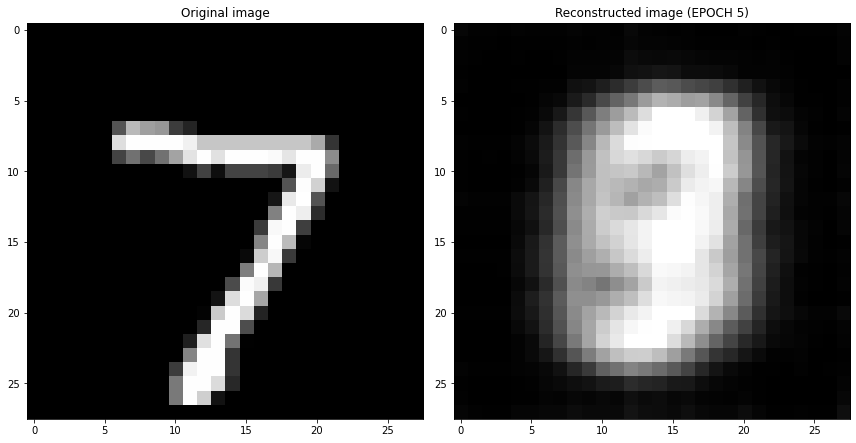

EPOCH 6/30
	 partial train loss (single batch): 0.065149
	 partial train loss (single batch): 0.068812
	 partial train loss (single batch): 0.069857
	 partial train loss (single batch): 0.069488
	 partial train loss (single batch): 0.068198
	 partial train loss (single batch): 0.066762
	 partial train loss (single batch): 0.065714
	 partial train loss (single batch): 0.068885
	 partial train loss (single batch): 0.069618
	 partial train loss (single batch): 0.069080
	 partial train loss (single batch): 0.068970
	 partial train loss (single batch): 0.067825
	 partial train loss (single batch): 0.066369
	 partial train loss (single batch): 0.068007
	 partial train loss (single batch): 0.066636
	 partial train loss (single batch): 0.069751
	 partial train loss (single batch): 0.067781
	 partial train loss (single batch): 0.067852
	 partial train loss (single batch): 0.066454
	 partial train loss (single batch): 0.065897
	 partial train loss (single batch): 0.068233
	 partial train loss (s

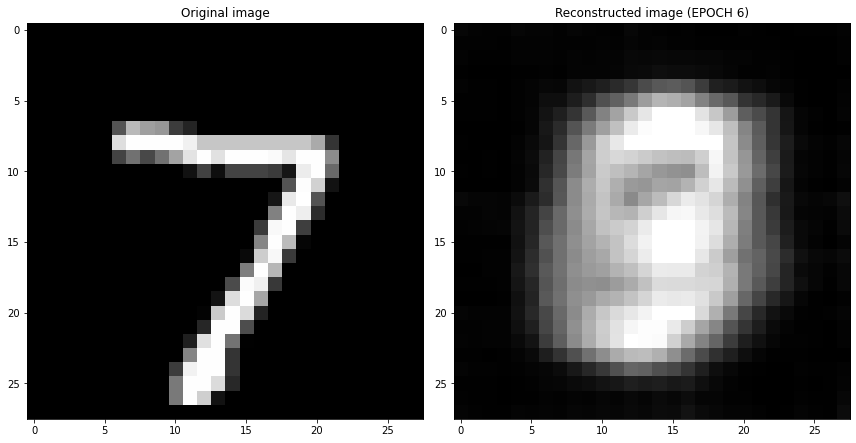

EPOCH 7/30
	 partial train loss (single batch): 0.066396
	 partial train loss (single batch): 0.068295
	 partial train loss (single batch): 0.069505
	 partial train loss (single batch): 0.067035
	 partial train loss (single batch): 0.068248
	 partial train loss (single batch): 0.065510
	 partial train loss (single batch): 0.066680
	 partial train loss (single batch): 0.067510
	 partial train loss (single batch): 0.066935
	 partial train loss (single batch): 0.067645
	 partial train loss (single batch): 0.068201
	 partial train loss (single batch): 0.065775
	 partial train loss (single batch): 0.070219
	 partial train loss (single batch): 0.067098
	 partial train loss (single batch): 0.068473
	 partial train loss (single batch): 0.067558
	 partial train loss (single batch): 0.065975
	 partial train loss (single batch): 0.065913
	 partial train loss (single batch): 0.066650
	 partial train loss (single batch): 0.069569
	 partial train loss (single batch): 0.067578
	 partial train loss (s

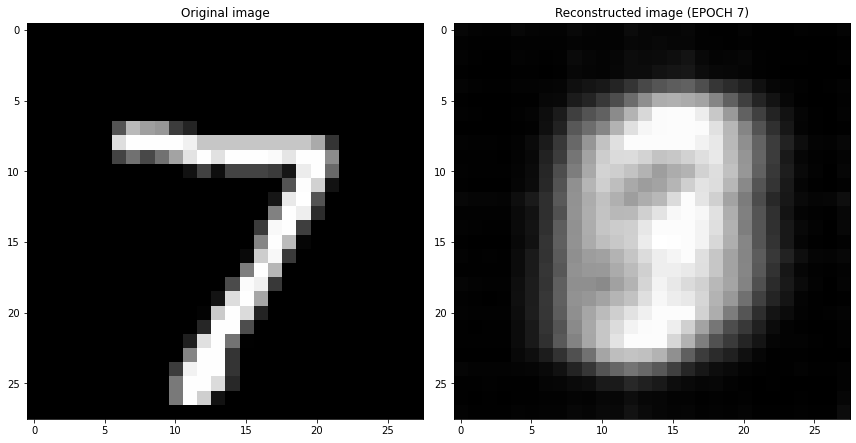

EPOCH 8/30
	 partial train loss (single batch): 0.068070
	 partial train loss (single batch): 0.067319
	 partial train loss (single batch): 0.067525
	 partial train loss (single batch): 0.068794
	 partial train loss (single batch): 0.067497
	 partial train loss (single batch): 0.066658
	 partial train loss (single batch): 0.067025
	 partial train loss (single batch): 0.064778
	 partial train loss (single batch): 0.068829
	 partial train loss (single batch): 0.066319
	 partial train loss (single batch): 0.068435
	 partial train loss (single batch): 0.067923
	 partial train loss (single batch): 0.069888
	 partial train loss (single batch): 0.069047
	 partial train loss (single batch): 0.067376
	 partial train loss (single batch): 0.067388
	 partial train loss (single batch): 0.068147
	 partial train loss (single batch): 0.069751
	 partial train loss (single batch): 0.068325
	 partial train loss (single batch): 0.068653
	 partial train loss (single batch): 0.068050
	 partial train loss (s

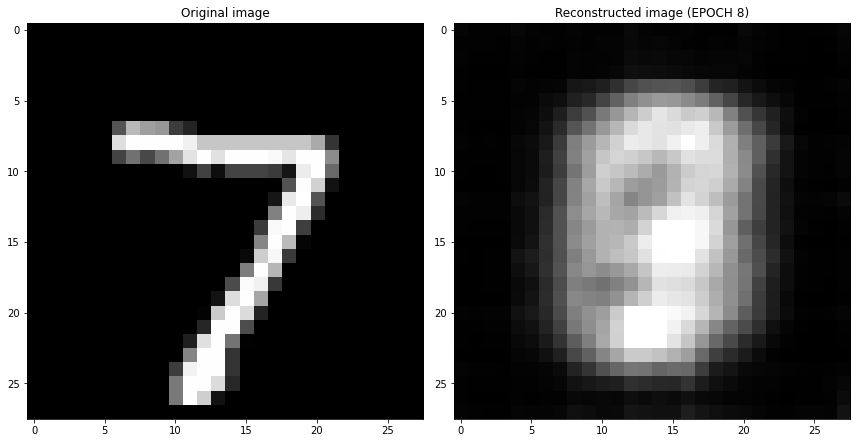

EPOCH 9/30
	 partial train loss (single batch): 0.069029
	 partial train loss (single batch): 0.068439
	 partial train loss (single batch): 0.067622
	 partial train loss (single batch): 0.070709
	 partial train loss (single batch): 0.067946
	 partial train loss (single batch): 0.064877
	 partial train loss (single batch): 0.068384
	 partial train loss (single batch): 0.068556
	 partial train loss (single batch): 0.065225
	 partial train loss (single batch): 0.067856
	 partial train loss (single batch): 0.067206
	 partial train loss (single batch): 0.069268
	 partial train loss (single batch): 0.067443
	 partial train loss (single batch): 0.065892
	 partial train loss (single batch): 0.069400
	 partial train loss (single batch): 0.066010
	 partial train loss (single batch): 0.066856
	 partial train loss (single batch): 0.067490
	 partial train loss (single batch): 0.067352
	 partial train loss (single batch): 0.069481
	 partial train loss (single batch): 0.068438
	 partial train loss (s

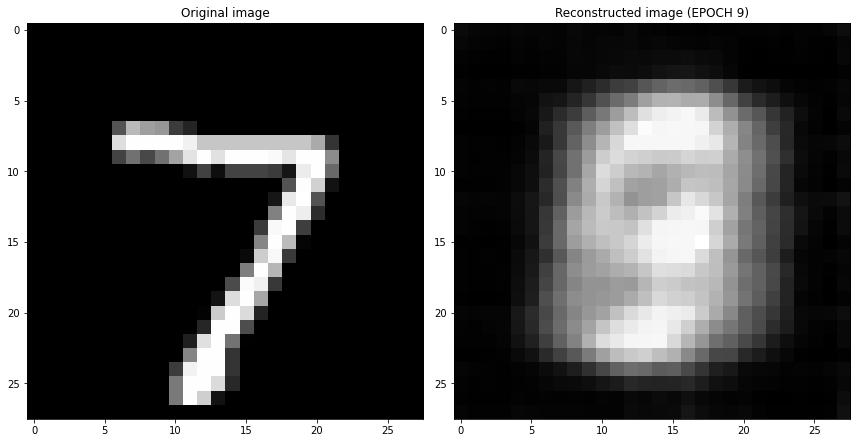

EPOCH 10/30
	 partial train loss (single batch): 0.066670
	 partial train loss (single batch): 0.065767
	 partial train loss (single batch): 0.067711
	 partial train loss (single batch): 0.071098
	 partial train loss (single batch): 0.065976
	 partial train loss (single batch): 0.070225
	 partial train loss (single batch): 0.067146
	 partial train loss (single batch): 0.065623
	 partial train loss (single batch): 0.066811
	 partial train loss (single batch): 0.067519
	 partial train loss (single batch): 0.065976
	 partial train loss (single batch): 0.067346
	 partial train loss (single batch): 0.067350
	 partial train loss (single batch): 0.066658
	 partial train loss (single batch): 0.067161
	 partial train loss (single batch): 0.067530
	 partial train loss (single batch): 0.070149
	 partial train loss (single batch): 0.068125
	 partial train loss (single batch): 0.066338
	 partial train loss (single batch): 0.069588
	 partial train loss (single batch): 0.068580
	 partial train loss (

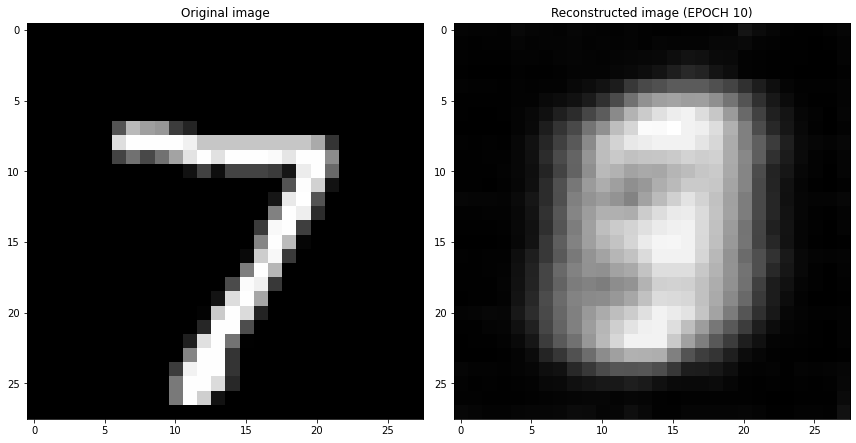

EPOCH 11/30
	 partial train loss (single batch): 0.070320
	 partial train loss (single batch): 0.066224
	 partial train loss (single batch): 0.066455
	 partial train loss (single batch): 0.067685
	 partial train loss (single batch): 0.066925
	 partial train loss (single batch): 0.067994
	 partial train loss (single batch): 0.067018
	 partial train loss (single batch): 0.067978
	 partial train loss (single batch): 0.069589
	 partial train loss (single batch): 0.066666
	 partial train loss (single batch): 0.066356
	 partial train loss (single batch): 0.066311
	 partial train loss (single batch): 0.065826
	 partial train loss (single batch): 0.067939
	 partial train loss (single batch): 0.067797
	 partial train loss (single batch): 0.065835
	 partial train loss (single batch): 0.067739
	 partial train loss (single batch): 0.068038
	 partial train loss (single batch): 0.066706
	 partial train loss (single batch): 0.068047
	 partial train loss (single batch): 0.068303
	 partial train loss (

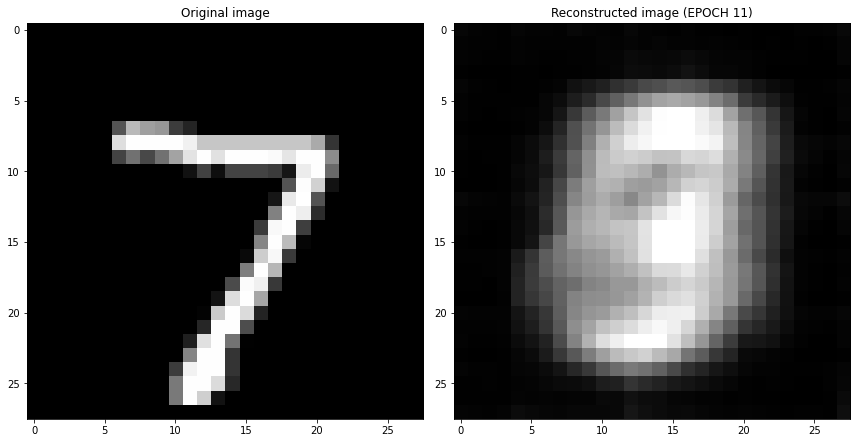

EPOCH 12/30
	 partial train loss (single batch): 0.066861
	 partial train loss (single batch): 0.067963
	 partial train loss (single batch): 0.068335
	 partial train loss (single batch): 0.066217
	 partial train loss (single batch): 0.066715
	 partial train loss (single batch): 0.068114
	 partial train loss (single batch): 0.068745
	 partial train loss (single batch): 0.068377
	 partial train loss (single batch): 0.066763
	 partial train loss (single batch): 0.066651
	 partial train loss (single batch): 0.070351
	 partial train loss (single batch): 0.068208
	 partial train loss (single batch): 0.068099
	 partial train loss (single batch): 0.069368
	 partial train loss (single batch): 0.068359
	 partial train loss (single batch): 0.068306
	 partial train loss (single batch): 0.066488
	 partial train loss (single batch): 0.067507
	 partial train loss (single batch): 0.067815
	 partial train loss (single batch): 0.067168
	 partial train loss (single batch): 0.068619
	 partial train loss (

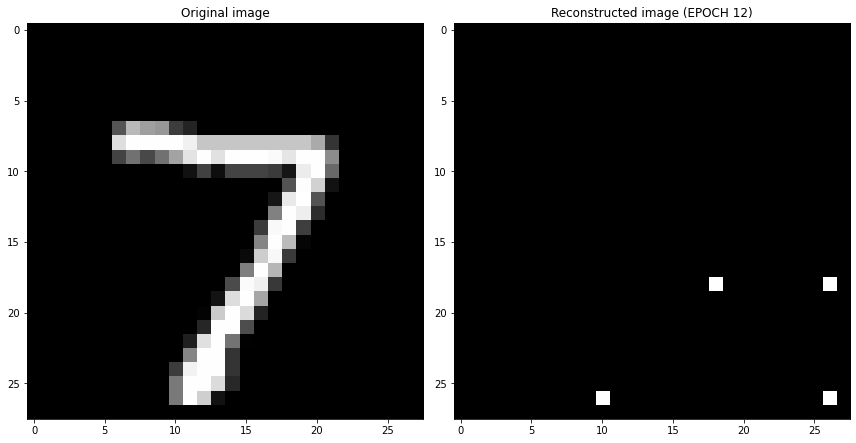

EPOCH 13/30
	 partial train loss (single batch): 0.118857
	 partial train loss (single batch): 0.114497
	 partial train loss (single batch): 0.112805
	 partial train loss (single batch): 0.110983
	 partial train loss (single batch): 0.108196
	 partial train loss (single batch): 0.109645
	 partial train loss (single batch): 0.118555
	 partial train loss (single batch): 0.118236
	 partial train loss (single batch): 0.114877
	 partial train loss (single batch): 0.111736
	 partial train loss (single batch): 0.111146
	 partial train loss (single batch): 0.113392
	 partial train loss (single batch): 0.115024
	 partial train loss (single batch): 0.116449
	 partial train loss (single batch): 0.112934
	 partial train loss (single batch): 0.113511
	 partial train loss (single batch): 0.117681
	 partial train loss (single batch): 0.114804
	 partial train loss (single batch): 0.121101
	 partial train loss (single batch): 0.117980
	 partial train loss (single batch): 0.120084
	 partial train loss (

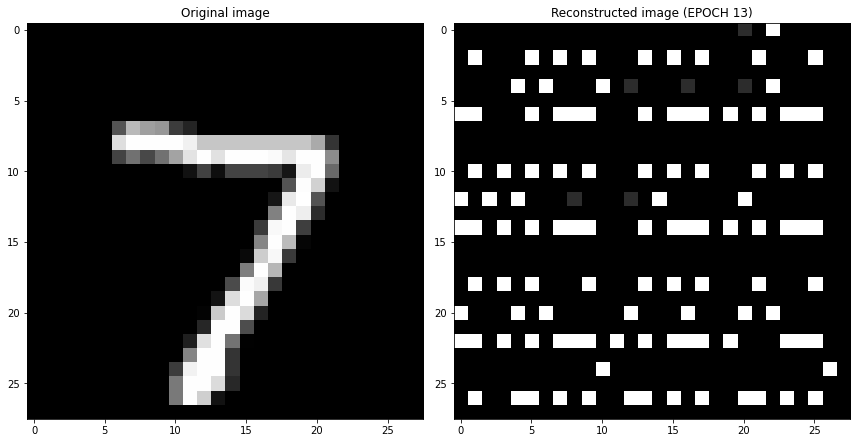

EPOCH 14/30
	 partial train loss (single batch): 0.213844
	 partial train loss (single batch): 0.213297
	 partial train loss (single batch): 0.214372
	 partial train loss (single batch): 0.209676
	 partial train loss (single batch): 0.209934
	 partial train loss (single batch): 0.208888
	 partial train loss (single batch): 0.215113
	 partial train loss (single batch): 0.207532
	 partial train loss (single batch): 0.212524
	 partial train loss (single batch): 0.212838
	 partial train loss (single batch): 0.214135
	 partial train loss (single batch): 0.215826
	 partial train loss (single batch): 0.209020
	 partial train loss (single batch): 0.215924
	 partial train loss (single batch): 0.211759
	 partial train loss (single batch): 0.212738
	 partial train loss (single batch): 0.209489
	 partial train loss (single batch): 0.204251
	 partial train loss (single batch): 0.191720
	 partial train loss (single batch): 0.186893
	 partial train loss (single batch): 0.183777
	 partial train loss (

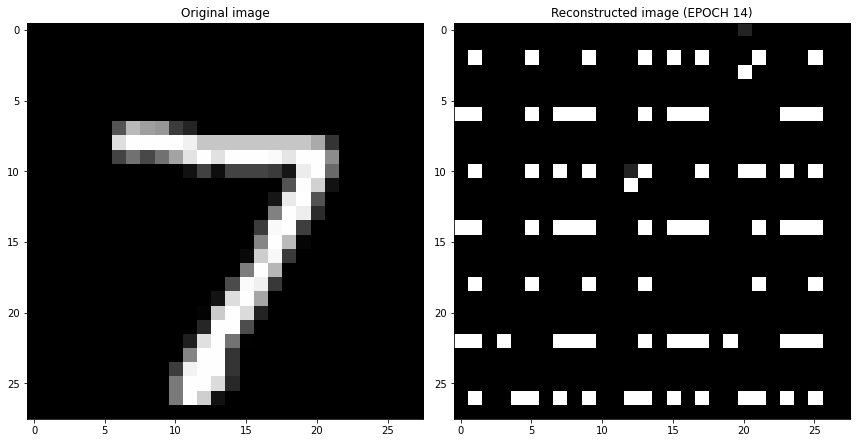

EPOCH 15/30
	 partial train loss (single batch): 0.187138
	 partial train loss (single batch): 0.183437
	 partial train loss (single batch): 0.191353
	 partial train loss (single batch): 0.186763
	 partial train loss (single batch): 0.187265
	 partial train loss (single batch): 0.187738
	 partial train loss (single batch): 0.189721
	 partial train loss (single batch): 0.191171
	 partial train loss (single batch): 0.185028
	 partial train loss (single batch): 0.188365
	 partial train loss (single batch): 0.185244
	 partial train loss (single batch): 0.187258
	 partial train loss (single batch): 0.186741
	 partial train loss (single batch): 0.184066
	 partial train loss (single batch): 0.186246
	 partial train loss (single batch): 0.187449
	 partial train loss (single batch): 0.190256
	 partial train loss (single batch): 0.189531
	 partial train loss (single batch): 0.194749
	 partial train loss (single batch): 0.192963
	 partial train loss (single batch): 0.199404
	 partial train loss (

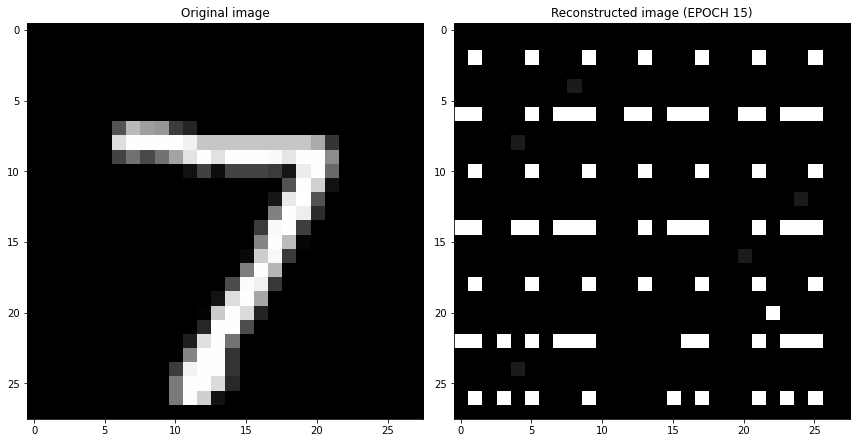

EPOCH 16/30
	 partial train loss (single batch): 0.177310
	 partial train loss (single batch): 0.183139
	 partial train loss (single batch): 0.181558
	 partial train loss (single batch): 0.182476
	 partial train loss (single batch): 0.182226
	 partial train loss (single batch): 0.182041
	 partial train loss (single batch): 0.184308
	 partial train loss (single batch): 0.183592
	 partial train loss (single batch): 0.181863
	 partial train loss (single batch): 0.181562
	 partial train loss (single batch): 0.182566
	 partial train loss (single batch): 0.181772
	 partial train loss (single batch): 0.184247
	 partial train loss (single batch): 0.184410
	 partial train loss (single batch): 0.184923
	 partial train loss (single batch): 0.183570
	 partial train loss (single batch): 0.181338
	 partial train loss (single batch): 0.180454
	 partial train loss (single batch): 0.179043
	 partial train loss (single batch): 0.184537
	 partial train loss (single batch): 0.185005
	 partial train loss (

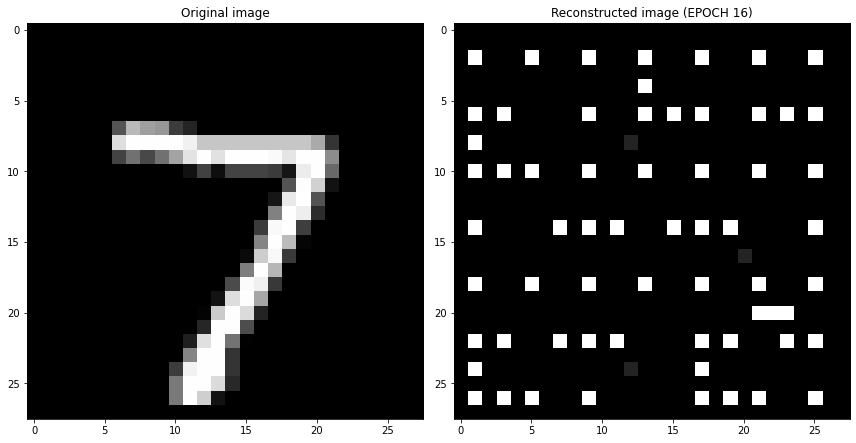

EPOCH 17/30
	 partial train loss (single batch): 0.170129
	 partial train loss (single batch): 0.172738
	 partial train loss (single batch): 0.171514
	 partial train loss (single batch): 0.170782
	 partial train loss (single batch): 0.171854
	 partial train loss (single batch): 0.165859
	 partial train loss (single batch): 0.175483
	 partial train loss (single batch): 0.170960
	 partial train loss (single batch): 0.168901
	 partial train loss (single batch): 0.171407
	 partial train loss (single batch): 0.170411
	 partial train loss (single batch): 0.168172
	 partial train loss (single batch): 0.172196
	 partial train loss (single batch): 0.170621
	 partial train loss (single batch): 0.173542
	 partial train loss (single batch): 0.170053
	 partial train loss (single batch): 0.170024
	 partial train loss (single batch): 0.170808
	 partial train loss (single batch): 0.171772
	 partial train loss (single batch): 0.172957
	 partial train loss (single batch): 0.170866
	 partial train loss (

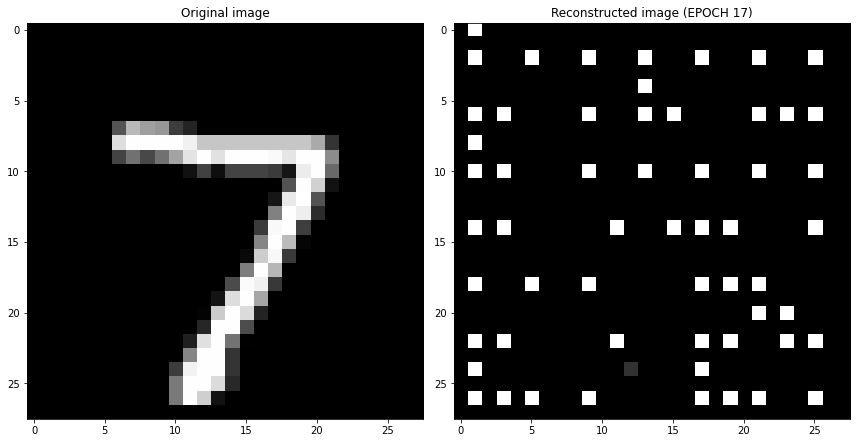

EPOCH 18/30
	 partial train loss (single batch): 0.164594
	 partial train loss (single batch): 0.170670
	 partial train loss (single batch): 0.167443
	 partial train loss (single batch): 0.164433
	 partial train loss (single batch): 0.169361
	 partial train loss (single batch): 0.167819
	 partial train loss (single batch): 0.168791
	 partial train loss (single batch): 0.167131
	 partial train loss (single batch): 0.166649
	 partial train loss (single batch): 0.168963
	 partial train loss (single batch): 0.169572
	 partial train loss (single batch): 0.169254
	 partial train loss (single batch): 0.168989
	 partial train loss (single batch): 0.164296
	 partial train loss (single batch): 0.169544
	 partial train loss (single batch): 0.169079
	 partial train loss (single batch): 0.167273
	 partial train loss (single batch): 0.168793
	 partial train loss (single batch): 0.169829
	 partial train loss (single batch): 0.166846
	 partial train loss (single batch): 0.167811
	 partial train loss (

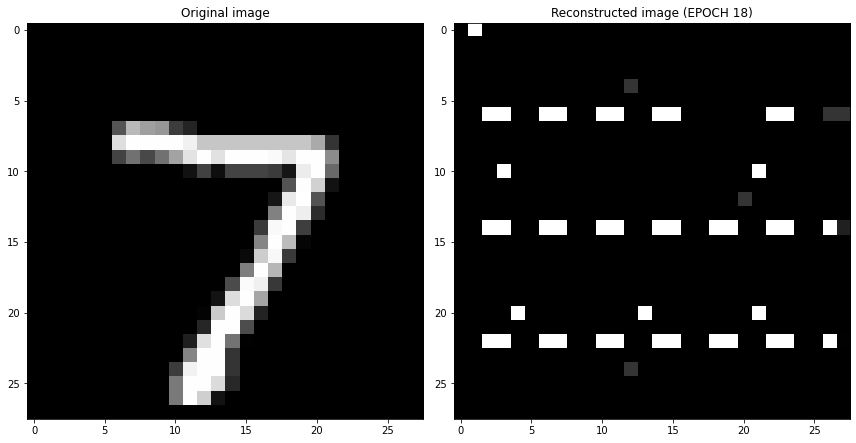

EPOCH 19/30
	 partial train loss (single batch): 0.145605
	 partial train loss (single batch): 0.147823
	 partial train loss (single batch): 0.146153
	 partial train loss (single batch): 0.140291
	 partial train loss (single batch): 0.139962
	 partial train loss (single batch): 0.132402
	 partial train loss (single batch): 0.133336
	 partial train loss (single batch): 0.133514
	 partial train loss (single batch): 0.134075
	 partial train loss (single batch): 0.131455
	 partial train loss (single batch): 0.133928
	 partial train loss (single batch): 0.136340
	 partial train loss (single batch): 0.131412
	 partial train loss (single batch): 0.133401
	 partial train loss (single batch): 0.134839
	 partial train loss (single batch): 0.132482
	 partial train loss (single batch): 0.134250
	 partial train loss (single batch): 0.136066
	 partial train loss (single batch): 0.136679
	 partial train loss (single batch): 0.139326
	 partial train loss (single batch): 0.135201
	 partial train loss (

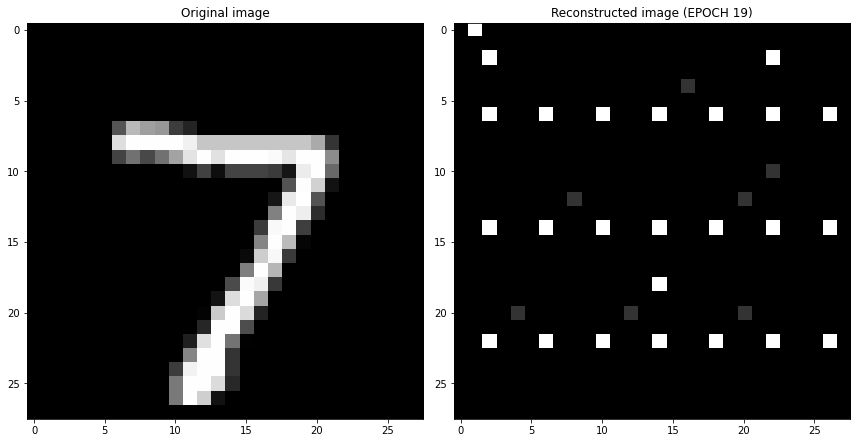

EPOCH 20/30
	 partial train loss (single batch): 0.134725
	 partial train loss (single batch): 0.128388
	 partial train loss (single batch): 0.127582
	 partial train loss (single batch): 0.134382
	 partial train loss (single batch): 0.130763
	 partial train loss (single batch): 0.133275
	 partial train loss (single batch): 0.132801
	 partial train loss (single batch): 0.134034
	 partial train loss (single batch): 0.133886
	 partial train loss (single batch): 0.133296
	 partial train loss (single batch): 0.131705
	 partial train loss (single batch): 0.132734
	 partial train loss (single batch): 0.131225
	 partial train loss (single batch): 0.131410
	 partial train loss (single batch): 0.132408
	 partial train loss (single batch): 0.131730
	 partial train loss (single batch): 0.134076
	 partial train loss (single batch): 0.129841
	 partial train loss (single batch): 0.132817
	 partial train loss (single batch): 0.134274
	 partial train loss (single batch): 0.129569
	 partial train loss (

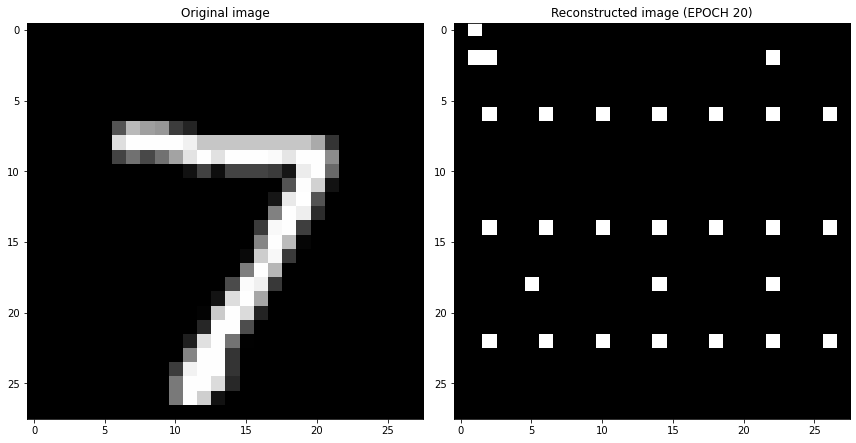

EPOCH 21/30
	 partial train loss (single batch): 0.136192
	 partial train loss (single batch): 0.136305
	 partial train loss (single batch): 0.139074
	 partial train loss (single batch): 0.134096
	 partial train loss (single batch): 0.137331
	 partial train loss (single batch): 0.139581
	 partial train loss (single batch): 0.136583
	 partial train loss (single batch): 0.135379
	 partial train loss (single batch): 0.133993
	 partial train loss (single batch): 0.135576
	 partial train loss (single batch): 0.139229
	 partial train loss (single batch): 0.131106
	 partial train loss (single batch): 0.139252
	 partial train loss (single batch): 0.135336
	 partial train loss (single batch): 0.139667
	 partial train loss (single batch): 0.141217
	 partial train loss (single batch): 0.137890
	 partial train loss (single batch): 0.138299
	 partial train loss (single batch): 0.139621
	 partial train loss (single batch): 0.140404
	 partial train loss (single batch): 0.131942
	 partial train loss (

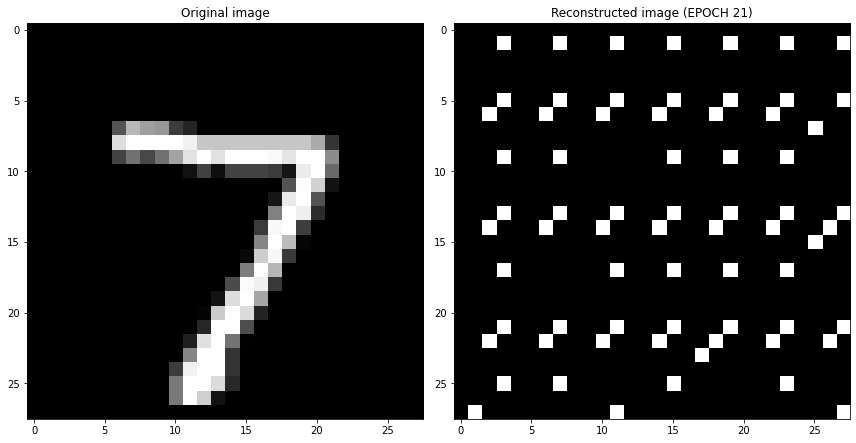

EPOCH 22/30
	 partial train loss (single batch): 0.175102
	 partial train loss (single batch): 0.173534
	 partial train loss (single batch): 0.175535
	 partial train loss (single batch): 0.177130
	 partial train loss (single batch): 0.178140
	 partial train loss (single batch): 0.175024
	 partial train loss (single batch): 0.177810
	 partial train loss (single batch): 0.175587
	 partial train loss (single batch): 0.171232
	 partial train loss (single batch): 0.173047
	 partial train loss (single batch): 0.172473
	 partial train loss (single batch): 0.173956
	 partial train loss (single batch): 0.173707
	 partial train loss (single batch): 0.172270
	 partial train loss (single batch): 0.174227
	 partial train loss (single batch): 0.171924
	 partial train loss (single batch): 0.172392
	 partial train loss (single batch): 0.174597
	 partial train loss (single batch): 0.171330
	 partial train loss (single batch): 0.168997
	 partial train loss (single batch): 0.171077
	 partial train loss (

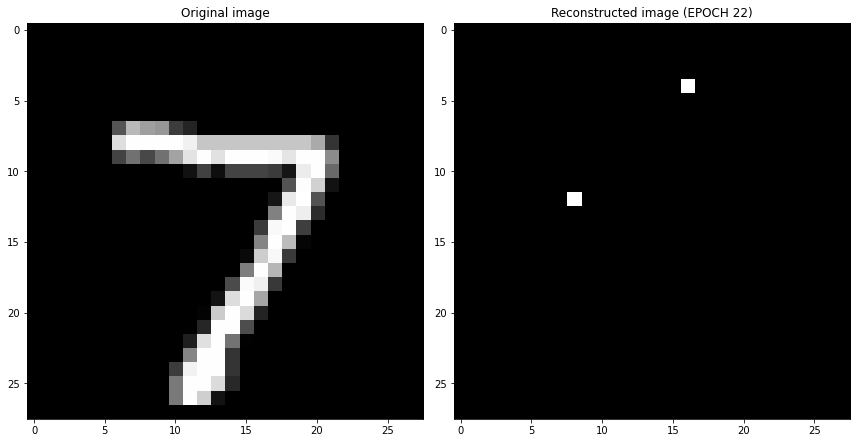

EPOCH 23/30
	 partial train loss (single batch): 0.112222
	 partial train loss (single batch): 0.109226
	 partial train loss (single batch): 0.112923
	 partial train loss (single batch): 0.115163
	 partial train loss (single batch): 0.113078
	 partial train loss (single batch): 0.117681
	 partial train loss (single batch): 0.111256
	 partial train loss (single batch): 0.108832
	 partial train loss (single batch): 0.111397
	 partial train loss (single batch): 0.108304
	 partial train loss (single batch): 0.111903
	 partial train loss (single batch): 0.111531
	 partial train loss (single batch): 0.112690
	 partial train loss (single batch): 0.113259
	 partial train loss (single batch): 0.109966
	 partial train loss (single batch): 0.111691
	 partial train loss (single batch): 0.114787
	 partial train loss (single batch): 0.112748
	 partial train loss (single batch): 0.111895
	 partial train loss (single batch): 0.107644
	 partial train loss (single batch): 0.109360
	 partial train loss (

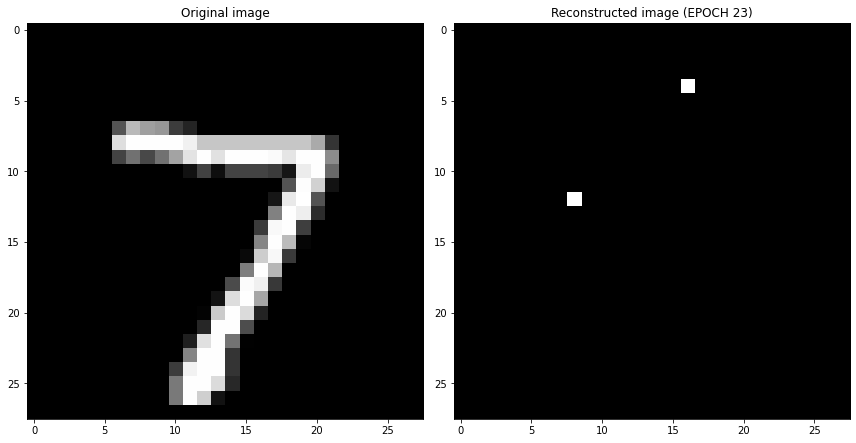

EPOCH 24/30
	 partial train loss (single batch): 0.115012
	 partial train loss (single batch): 0.115790
	 partial train loss (single batch): 0.113494
	 partial train loss (single batch): 0.112603
	 partial train loss (single batch): 0.113433
	 partial train loss (single batch): 0.114449
	 partial train loss (single batch): 0.110754
	 partial train loss (single batch): 0.110222
	 partial train loss (single batch): 0.114394
	 partial train loss (single batch): 0.110779
	 partial train loss (single batch): 0.115917
	 partial train loss (single batch): 0.108676
	 partial train loss (single batch): 0.112719
	 partial train loss (single batch): 0.114891
	 partial train loss (single batch): 0.113887
	 partial train loss (single batch): 0.112882
	 partial train loss (single batch): 0.113225
	 partial train loss (single batch): 0.112343
	 partial train loss (single batch): 0.112847
	 partial train loss (single batch): 0.111972
	 partial train loss (single batch): 0.114135
	 partial train loss (

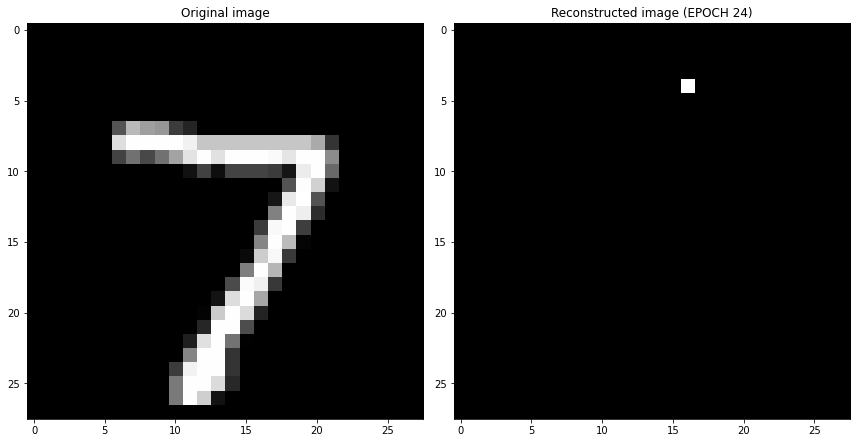

EPOCH 25/30
	 partial train loss (single batch): 0.115471
	 partial train loss (single batch): 0.115630
	 partial train loss (single batch): 0.116764
	 partial train loss (single batch): 0.114329
	 partial train loss (single batch): 0.111857
	 partial train loss (single batch): 0.107452
	 partial train loss (single batch): 0.114392
	 partial train loss (single batch): 0.109550
	 partial train loss (single batch): 0.112686
	 partial train loss (single batch): 0.112669
	 partial train loss (single batch): 0.109381
	 partial train loss (single batch): 0.115501
	 partial train loss (single batch): 0.115239
	 partial train loss (single batch): 0.110368
	 partial train loss (single batch): 0.112714
	 partial train loss (single batch): 0.108794
	 partial train loss (single batch): 0.113718
	 partial train loss (single batch): 0.110410
	 partial train loss (single batch): 0.112049
	 partial train loss (single batch): 0.115469
	 partial train loss (single batch): 0.110698
	 partial train loss (

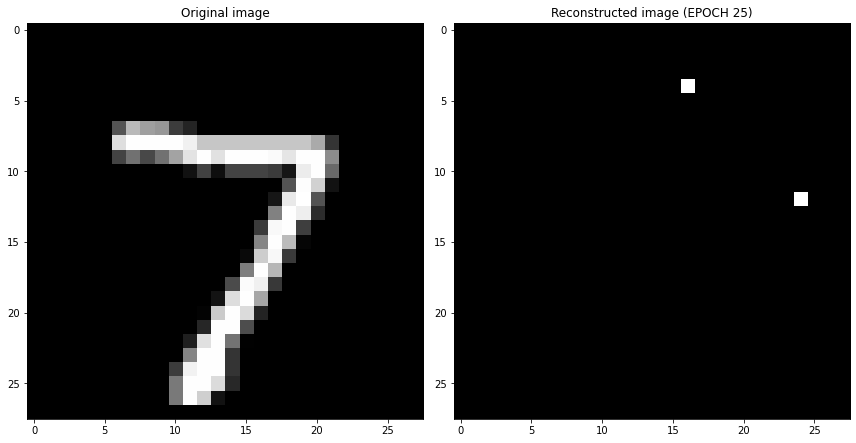

EPOCH 26/30
	 partial train loss (single batch): 0.114138
	 partial train loss (single batch): 0.109912
	 partial train loss (single batch): 0.112137
	 partial train loss (single batch): 0.112061
	 partial train loss (single batch): 0.116820
	 partial train loss (single batch): 0.113865
	 partial train loss (single batch): 0.115168
	 partial train loss (single batch): 0.110408
	 partial train loss (single batch): 0.106094
	 partial train loss (single batch): 0.114707
	 partial train loss (single batch): 0.118331
	 partial train loss (single batch): 0.110256
	 partial train loss (single batch): 0.114336
	 partial train loss (single batch): 0.109502
	 partial train loss (single batch): 0.112518
	 partial train loss (single batch): 0.112131
	 partial train loss (single batch): 0.110226
	 partial train loss (single batch): 0.110313
	 partial train loss (single batch): 0.109281
	 partial train loss (single batch): 0.114018
	 partial train loss (single batch): 0.113916
	 partial train loss (

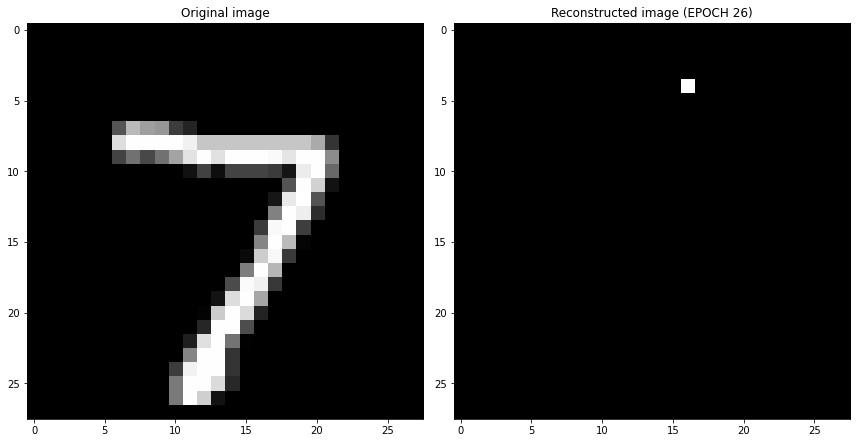

EPOCH 27/30
	 partial train loss (single batch): 0.108619
	 partial train loss (single batch): 0.109379
	 partial train loss (single batch): 0.112515
	 partial train loss (single batch): 0.113543
	 partial train loss (single batch): 0.118702
	 partial train loss (single batch): 0.108858
	 partial train loss (single batch): 0.110883
	 partial train loss (single batch): 0.112789
	 partial train loss (single batch): 0.112528
	 partial train loss (single batch): 0.113701
	 partial train loss (single batch): 0.114279
	 partial train loss (single batch): 0.108595
	 partial train loss (single batch): 0.113402
	 partial train loss (single batch): 0.112367
	 partial train loss (single batch): 0.110703
	 partial train loss (single batch): 0.112022
	 partial train loss (single batch): 0.111545
	 partial train loss (single batch): 0.115529
	 partial train loss (single batch): 0.109120
	 partial train loss (single batch): 0.108541
	 partial train loss (single batch): 0.114431
	 partial train loss (

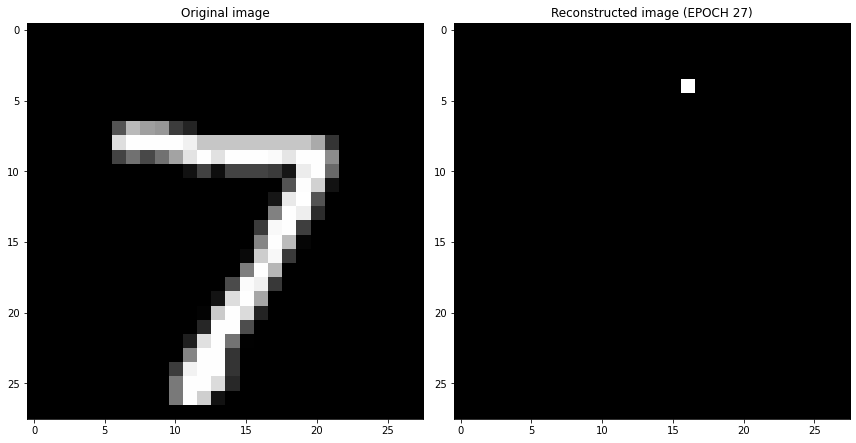

EPOCH 28/30
	 partial train loss (single batch): 0.115158
	 partial train loss (single batch): 0.110670
	 partial train loss (single batch): 0.112621
	 partial train loss (single batch): 0.112053
	 partial train loss (single batch): 0.111555
	 partial train loss (single batch): 0.115158
	 partial train loss (single batch): 0.113479
	 partial train loss (single batch): 0.113133
	 partial train loss (single batch): 0.108440
	 partial train loss (single batch): 0.111497
	 partial train loss (single batch): 0.114229
	 partial train loss (single batch): 0.114008
	 partial train loss (single batch): 0.109982
	 partial train loss (single batch): 0.114674
	 partial train loss (single batch): 0.117204
	 partial train loss (single batch): 0.111157
	 partial train loss (single batch): 0.110266
	 partial train loss (single batch): 0.110298
	 partial train loss (single batch): 0.115426
	 partial train loss (single batch): 0.112718
	 partial train loss (single batch): 0.113928
	 partial train loss (

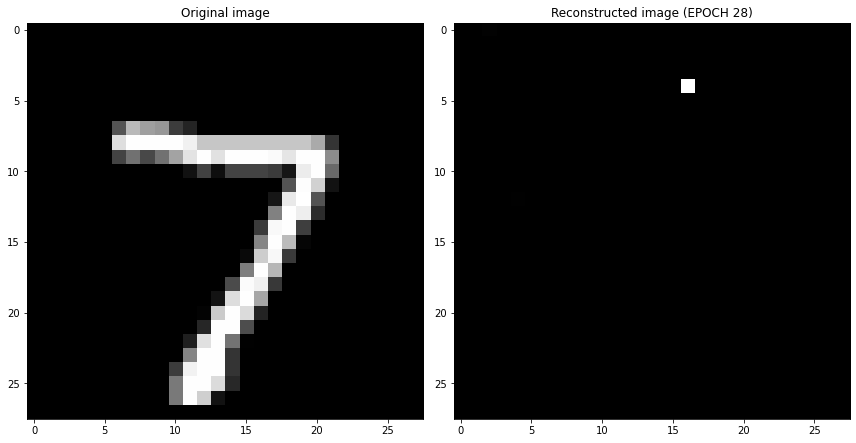

EPOCH 29/30
	 partial train loss (single batch): 0.112570
	 partial train loss (single batch): 0.113663
	 partial train loss (single batch): 0.112073
	 partial train loss (single batch): 0.111660
	 partial train loss (single batch): 0.111631
	 partial train loss (single batch): 0.109453
	 partial train loss (single batch): 0.110543
	 partial train loss (single batch): 0.114936
	 partial train loss (single batch): 0.112379
	 partial train loss (single batch): 0.113037
	 partial train loss (single batch): 0.113580
	 partial train loss (single batch): 0.114384
	 partial train loss (single batch): 0.112496
	 partial train loss (single batch): 0.117871
	 partial train loss (single batch): 0.110053
	 partial train loss (single batch): 0.113999
	 partial train loss (single batch): 0.108558
	 partial train loss (single batch): 0.111690
	 partial train loss (single batch): 0.110631
	 partial train loss (single batch): 0.111670
	 partial train loss (single batch): 0.109334
	 partial train loss (

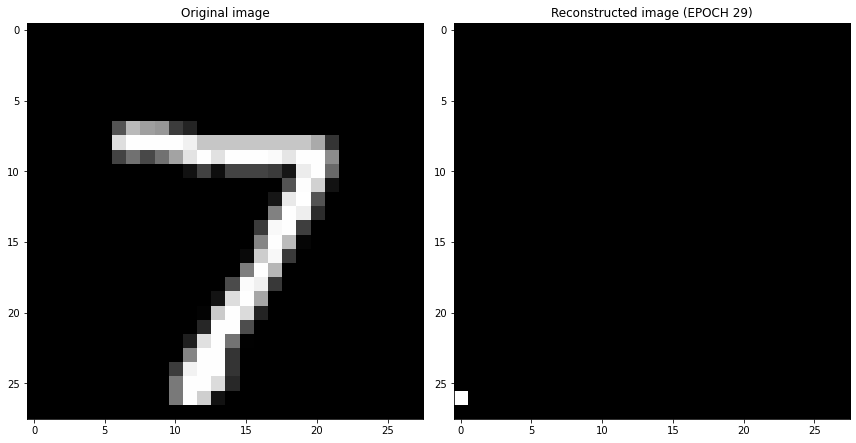

EPOCH 30/30
	 partial train loss (single batch): 0.111429
	 partial train loss (single batch): 0.119151
	 partial train loss (single batch): 0.112393
	 partial train loss (single batch): 0.115049
	 partial train loss (single batch): 0.107731
	 partial train loss (single batch): 0.110311
	 partial train loss (single batch): 0.112721
	 partial train loss (single batch): 0.110986
	 partial train loss (single batch): 0.109144
	 partial train loss (single batch): 0.111086
	 partial train loss (single batch): 0.111932
	 partial train loss (single batch): 0.114336
	 partial train loss (single batch): 0.107832
	 partial train loss (single batch): 0.120166
	 partial train loss (single batch): 0.109297
	 partial train loss (single batch): 0.111385
	 partial train loss (single batch): 0.110329
	 partial train loss (single batch): 0.112325
	 partial train loss (single batch): 0.116395
	 partial train loss (single batch): 0.113516
	 partial train loss (single batch): 0.109129
	 partial train loss (

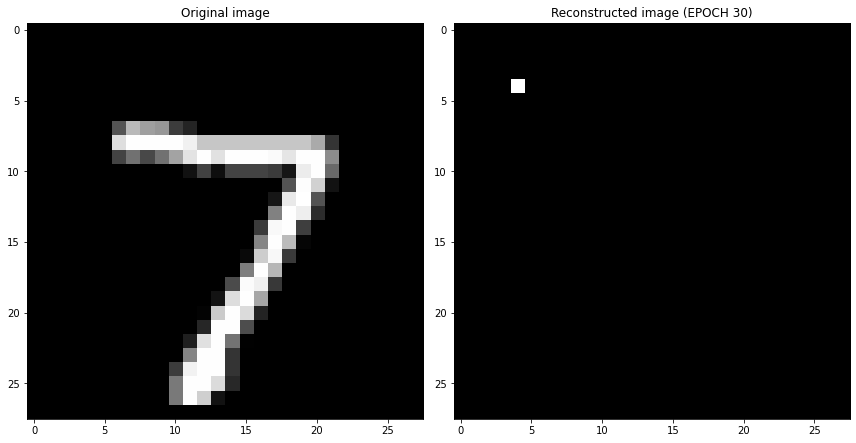

Cross validation fold number= 1/6
EPOCH 1/30
	 partial train loss (single batch): 0.175129
	 partial train loss (single batch): 0.174069
	 partial train loss (single batch): 0.174079
	 partial train loss (single batch): 0.172968
	 partial train loss (single batch): 0.172531
	 partial train loss (single batch): 0.172398
	 partial train loss (single batch): 0.171449
	 partial train loss (single batch): 0.171114
	 partial train loss (single batch): 0.171153
	 partial train loss (single batch): 0.170661
	 partial train loss (single batch): 0.169377
	 partial train loss (single batch): 0.169194
	 partial train loss (single batch): 0.167463
	 partial train loss (single batch): 0.168884
	 partial train loss (single batch): 0.166846
	 partial train loss (single batch): 0.165854
	 partial train loss (single batch): 0.164400
	 partial train loss (single batch): 0.163294
	 partial train loss (single batch): 0.163098
	 partial train loss (single batch): 0.161072
	 partial train loss (single batch)

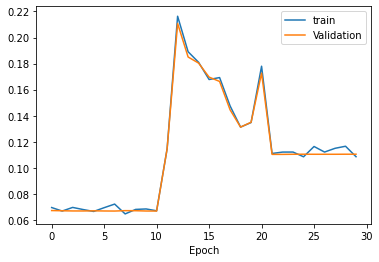

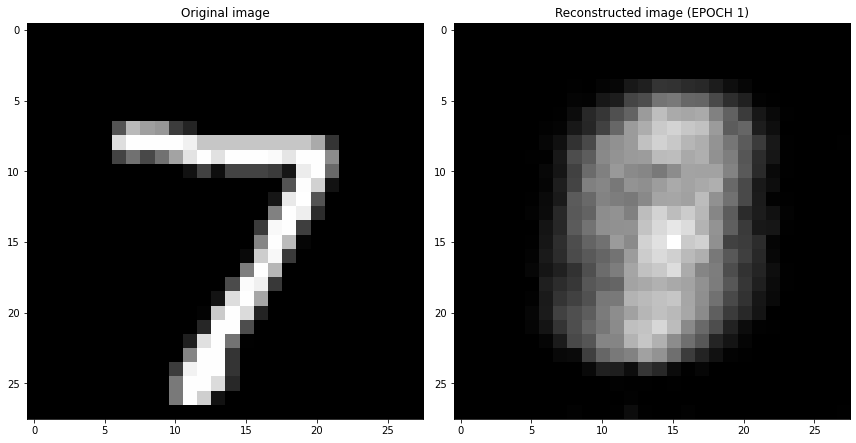

EPOCH 2/30
	 partial train loss (single batch): 0.064486
	 partial train loss (single batch): 0.062992
	 partial train loss (single batch): 0.063668
	 partial train loss (single batch): 0.064361
	 partial train loss (single batch): 0.065341
	 partial train loss (single batch): 0.062505
	 partial train loss (single batch): 0.061159
	 partial train loss (single batch): 0.065321
	 partial train loss (single batch): 0.063865
	 partial train loss (single batch): 0.063303
	 partial train loss (single batch): 0.064679
	 partial train loss (single batch): 0.063206
	 partial train loss (single batch): 0.060730
	 partial train loss (single batch): 0.062735
	 partial train loss (single batch): 0.061479
	 partial train loss (single batch): 0.063191
	 partial train loss (single batch): 0.061315
	 partial train loss (single batch): 0.063306
	 partial train loss (single batch): 0.061994
	 partial train loss (single batch): 0.064058
	 partial train loss (single batch): 0.062442
	 partial train loss (s

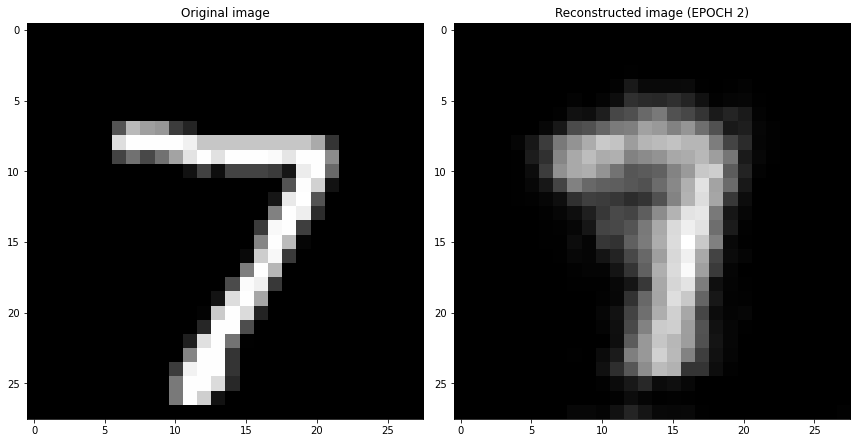

EPOCH 3/30
	 partial train loss (single batch): 0.045727
	 partial train loss (single batch): 0.047541
	 partial train loss (single batch): 0.047961
	 partial train loss (single batch): 0.047371
	 partial train loss (single batch): 0.045961
	 partial train loss (single batch): 0.047751
	 partial train loss (single batch): 0.046001
	 partial train loss (single batch): 0.045801
	 partial train loss (single batch): 0.047017
	 partial train loss (single batch): 0.045371
	 partial train loss (single batch): 0.045731
	 partial train loss (single batch): 0.047307
	 partial train loss (single batch): 0.045564
	 partial train loss (single batch): 0.044923
	 partial train loss (single batch): 0.046735
	 partial train loss (single batch): 0.044566
	 partial train loss (single batch): 0.046262
	 partial train loss (single batch): 0.044419
	 partial train loss (single batch): 0.046362
	 partial train loss (single batch): 0.046946
	 partial train loss (single batch): 0.046406
	 partial train loss (s

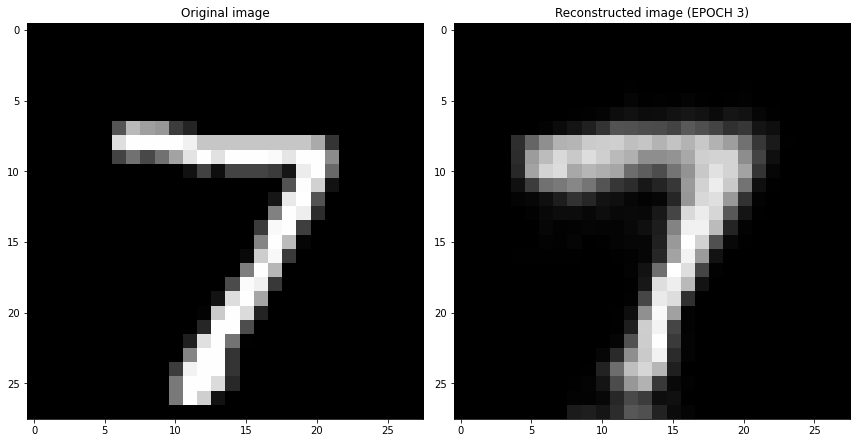

EPOCH 4/30
	 partial train loss (single batch): 0.040340
	 partial train loss (single batch): 0.040982
	 partial train loss (single batch): 0.038415
	 partial train loss (single batch): 0.038801
	 partial train loss (single batch): 0.040542
	 partial train loss (single batch): 0.040462
	 partial train loss (single batch): 0.040395
	 partial train loss (single batch): 0.039406
	 partial train loss (single batch): 0.039947
	 partial train loss (single batch): 0.040015
	 partial train loss (single batch): 0.039835
	 partial train loss (single batch): 0.040385
	 partial train loss (single batch): 0.038500
	 partial train loss (single batch): 0.039092
	 partial train loss (single batch): 0.039774
	 partial train loss (single batch): 0.039383
	 partial train loss (single batch): 0.038015
	 partial train loss (single batch): 0.039699
	 partial train loss (single batch): 0.039950
	 partial train loss (single batch): 0.039287
	 partial train loss (single batch): 0.039768
	 partial train loss (s

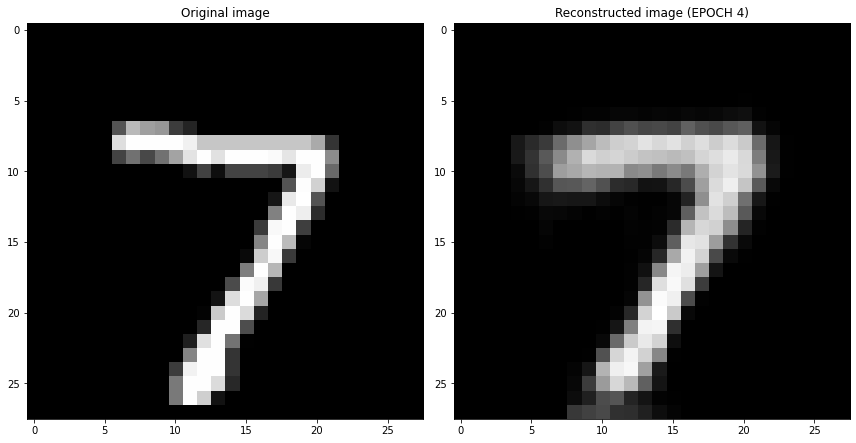

EPOCH 5/30
	 partial train loss (single batch): 0.037210
	 partial train loss (single batch): 0.035084
	 partial train loss (single batch): 0.037167
	 partial train loss (single batch): 0.037916
	 partial train loss (single batch): 0.036605
	 partial train loss (single batch): 0.036643
	 partial train loss (single batch): 0.036011
	 partial train loss (single batch): 0.035259
	 partial train loss (single batch): 0.035922
	 partial train loss (single batch): 0.037132
	 partial train loss (single batch): 0.036605
	 partial train loss (single batch): 0.036437
	 partial train loss (single batch): 0.037568
	 partial train loss (single batch): 0.037026
	 partial train loss (single batch): 0.037108
	 partial train loss (single batch): 0.037088
	 partial train loss (single batch): 0.036803
	 partial train loss (single batch): 0.036159
	 partial train loss (single batch): 0.037414
	 partial train loss (single batch): 0.036465
	 partial train loss (single batch): 0.036036
	 partial train loss (s

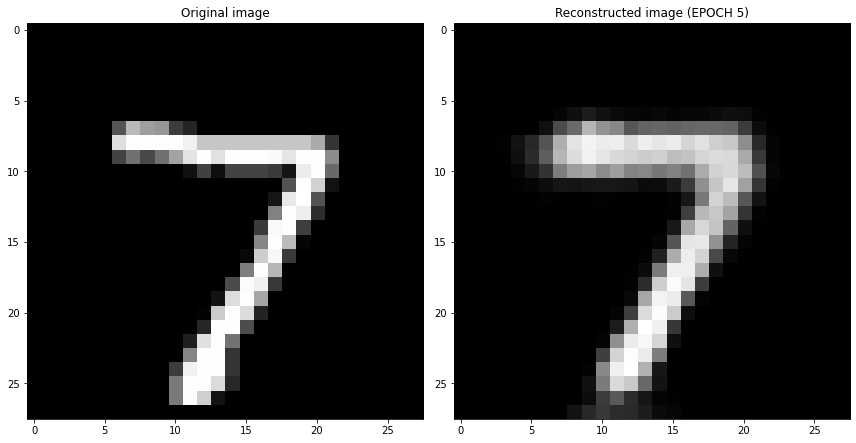

EPOCH 6/30
	 partial train loss (single batch): 0.034528
	 partial train loss (single batch): 0.035514
	 partial train loss (single batch): 0.036173
	 partial train loss (single batch): 0.032227
	 partial train loss (single batch): 0.034170
	 partial train loss (single batch): 0.033162
	 partial train loss (single batch): 0.032562
	 partial train loss (single batch): 0.035332
	 partial train loss (single batch): 0.034020
	 partial train loss (single batch): 0.033311
	 partial train loss (single batch): 0.034676
	 partial train loss (single batch): 0.034392
	 partial train loss (single batch): 0.035243
	 partial train loss (single batch): 0.034413
	 partial train loss (single batch): 0.033543
	 partial train loss (single batch): 0.033866
	 partial train loss (single batch): 0.035656
	 partial train loss (single batch): 0.034671
	 partial train loss (single batch): 0.033876
	 partial train loss (single batch): 0.036838
	 partial train loss (single batch): 0.034628
	 partial train loss (s

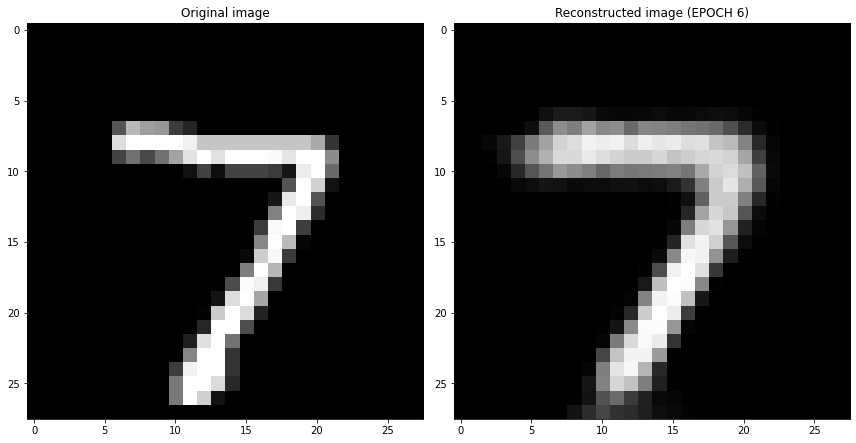

EPOCH 7/30
	 partial train loss (single batch): 0.033777
	 partial train loss (single batch): 0.031623
	 partial train loss (single batch): 0.034168
	 partial train loss (single batch): 0.031457
	 partial train loss (single batch): 0.033474
	 partial train loss (single batch): 0.032698
	 partial train loss (single batch): 0.033576
	 partial train loss (single batch): 0.032801
	 partial train loss (single batch): 0.034263
	 partial train loss (single batch): 0.034529
	 partial train loss (single batch): 0.033825
	 partial train loss (single batch): 0.033140
	 partial train loss (single batch): 0.034547
	 partial train loss (single batch): 0.034606
	 partial train loss (single batch): 0.033190
	 partial train loss (single batch): 0.033618
	 partial train loss (single batch): 0.035810
	 partial train loss (single batch): 0.031105
	 partial train loss (single batch): 0.033878
	 partial train loss (single batch): 0.032683
	 partial train loss (single batch): 0.032941
	 partial train loss (s

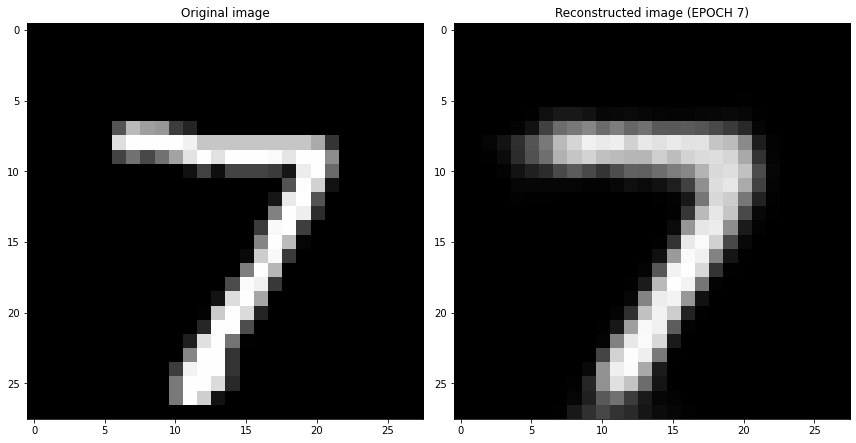

EPOCH 8/30
	 partial train loss (single batch): 0.032312
	 partial train loss (single batch): 0.032474
	 partial train loss (single batch): 0.033135
	 partial train loss (single batch): 0.031322
	 partial train loss (single batch): 0.033072
	 partial train loss (single batch): 0.030483
	 partial train loss (single batch): 0.031302
	 partial train loss (single batch): 0.033230
	 partial train loss (single batch): 0.032639
	 partial train loss (single batch): 0.032748
	 partial train loss (single batch): 0.032848
	 partial train loss (single batch): 0.030810
	 partial train loss (single batch): 0.031985
	 partial train loss (single batch): 0.033645
	 partial train loss (single batch): 0.032692
	 partial train loss (single batch): 0.034723
	 partial train loss (single batch): 0.031158
	 partial train loss (single batch): 0.033496
	 partial train loss (single batch): 0.031690
	 partial train loss (single batch): 0.030442
	 partial train loss (single batch): 0.031450
	 partial train loss (s

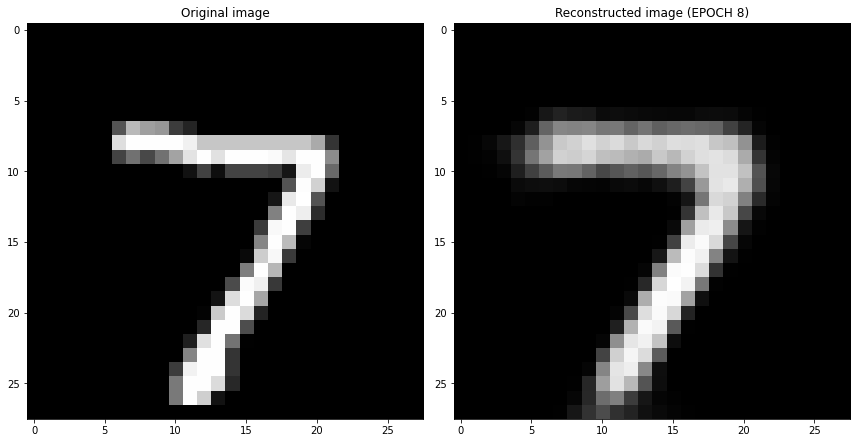

EPOCH 9/30
	 partial train loss (single batch): 0.030719
	 partial train loss (single batch): 0.032428
	 partial train loss (single batch): 0.031538
	 partial train loss (single batch): 0.031555
	 partial train loss (single batch): 0.033676
	 partial train loss (single batch): 0.031296
	 partial train loss (single batch): 0.031940
	 partial train loss (single batch): 0.030337
	 partial train loss (single batch): 0.031569
	 partial train loss (single batch): 0.031230
	 partial train loss (single batch): 0.032507
	 partial train loss (single batch): 0.033334
	 partial train loss (single batch): 0.033302
	 partial train loss (single batch): 0.031363
	 partial train loss (single batch): 0.032993
	 partial train loss (single batch): 0.030710
	 partial train loss (single batch): 0.030495
	 partial train loss (single batch): 0.031429
	 partial train loss (single batch): 0.032182
	 partial train loss (single batch): 0.031131
	 partial train loss (single batch): 0.032924
	 partial train loss (s

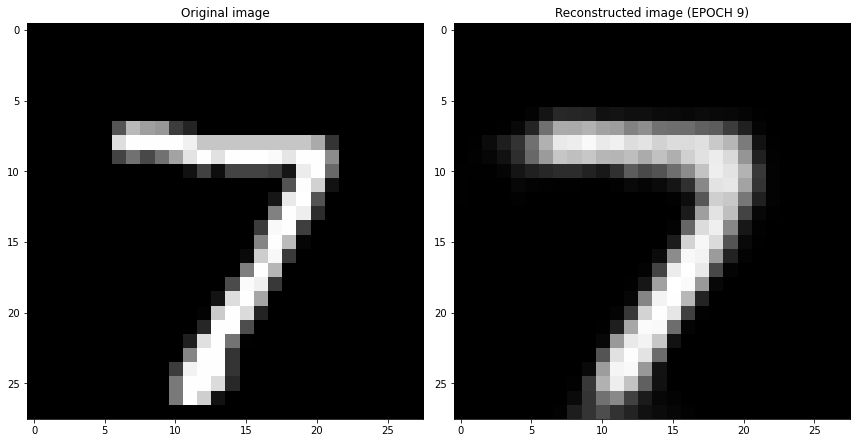

EPOCH 10/30
	 partial train loss (single batch): 0.032969
	 partial train loss (single batch): 0.029925
	 partial train loss (single batch): 0.031083
	 partial train loss (single batch): 0.030988
	 partial train loss (single batch): 0.032374
	 partial train loss (single batch): 0.031789
	 partial train loss (single batch): 0.032153
	 partial train loss (single batch): 0.031825
	 partial train loss (single batch): 0.033034
	 partial train loss (single batch): 0.032695
	 partial train loss (single batch): 0.031085
	 partial train loss (single batch): 0.032143
	 partial train loss (single batch): 0.030524
	 partial train loss (single batch): 0.031756
	 partial train loss (single batch): 0.031252
	 partial train loss (single batch): 0.032317
	 partial train loss (single batch): 0.032256
	 partial train loss (single batch): 0.032154
	 partial train loss (single batch): 0.032949
	 partial train loss (single batch): 0.031194
	 partial train loss (single batch): 0.031484
	 partial train loss (

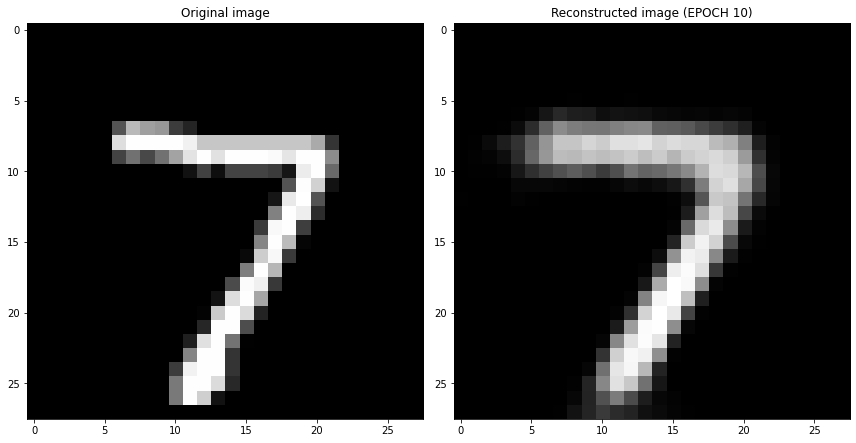

EPOCH 11/30
	 partial train loss (single batch): 0.031626
	 partial train loss (single batch): 0.030459
	 partial train loss (single batch): 0.031999
	 partial train loss (single batch): 0.031516
	 partial train loss (single batch): 0.031544
	 partial train loss (single batch): 0.030591
	 partial train loss (single batch): 0.030646
	 partial train loss (single batch): 0.030712
	 partial train loss (single batch): 0.030644
	 partial train loss (single batch): 0.029302
	 partial train loss (single batch): 0.032765
	 partial train loss (single batch): 0.029741
	 partial train loss (single batch): 0.031196
	 partial train loss (single batch): 0.031567
	 partial train loss (single batch): 0.031325
	 partial train loss (single batch): 0.031704
	 partial train loss (single batch): 0.032629
	 partial train loss (single batch): 0.030844
	 partial train loss (single batch): 0.030433
	 partial train loss (single batch): 0.032812
	 partial train loss (single batch): 0.029904
	 partial train loss (

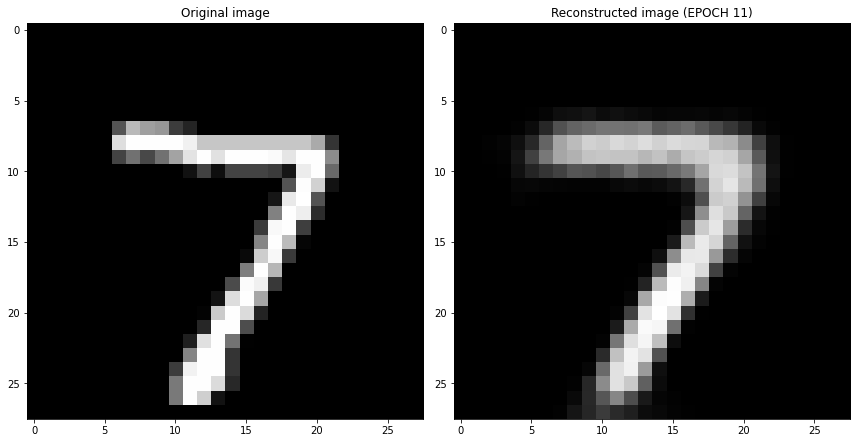

EPOCH 12/30
	 partial train loss (single batch): 0.030927
	 partial train loss (single batch): 0.030559
	 partial train loss (single batch): 0.032103
	 partial train loss (single batch): 0.031777
	 partial train loss (single batch): 0.032603
	 partial train loss (single batch): 0.030461
	 partial train loss (single batch): 0.029890
	 partial train loss (single batch): 0.030174
	 partial train loss (single batch): 0.031361
	 partial train loss (single batch): 0.031025
	 partial train loss (single batch): 0.033028
	 partial train loss (single batch): 0.031147
	 partial train loss (single batch): 0.030011
	 partial train loss (single batch): 0.031545
	 partial train loss (single batch): 0.031371
	 partial train loss (single batch): 0.030234
	 partial train loss (single batch): 0.029569
	 partial train loss (single batch): 0.031265
	 partial train loss (single batch): 0.028366
	 partial train loss (single batch): 0.031172
	 partial train loss (single batch): 0.029497
	 partial train loss (

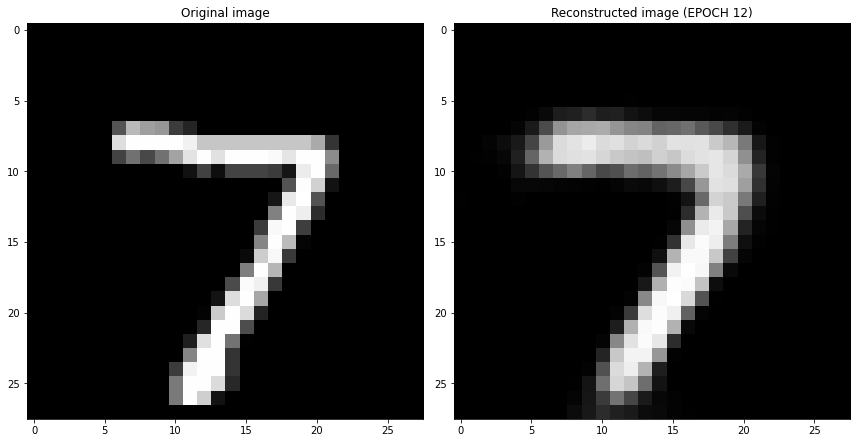

EPOCH 13/30
	 partial train loss (single batch): 0.030924
	 partial train loss (single batch): 0.031007
	 partial train loss (single batch): 0.030855
	 partial train loss (single batch): 0.031274
	 partial train loss (single batch): 0.031892
	 partial train loss (single batch): 0.030632
	 partial train loss (single batch): 0.029115
	 partial train loss (single batch): 0.029550
	 partial train loss (single batch): 0.031366
	 partial train loss (single batch): 0.031506
	 partial train loss (single batch): 0.032158
	 partial train loss (single batch): 0.031949
	 partial train loss (single batch): 0.030215
	 partial train loss (single batch): 0.030356
	 partial train loss (single batch): 0.029751
	 partial train loss (single batch): 0.029913
	 partial train loss (single batch): 0.030913
	 partial train loss (single batch): 0.031719
	 partial train loss (single batch): 0.029822
	 partial train loss (single batch): 0.032053
	 partial train loss (single batch): 0.031000
	 partial train loss (

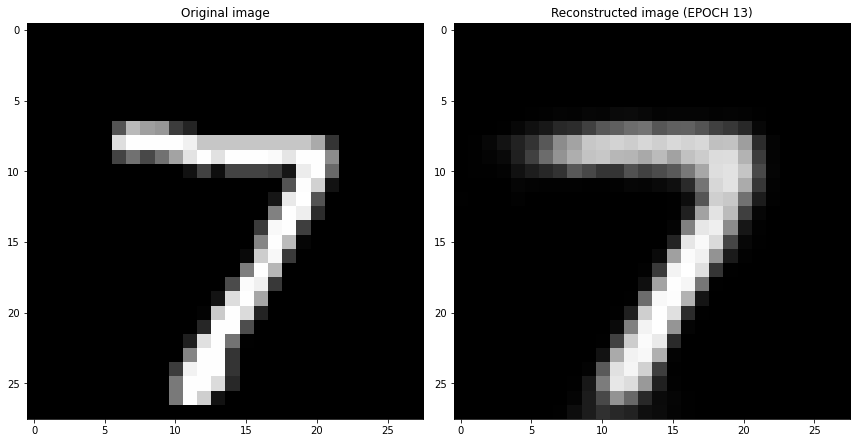

EPOCH 14/30
	 partial train loss (single batch): 0.029837
	 partial train loss (single batch): 0.030493
	 partial train loss (single batch): 0.029679
	 partial train loss (single batch): 0.029943
	 partial train loss (single batch): 0.032793
	 partial train loss (single batch): 0.029090
	 partial train loss (single batch): 0.030541
	 partial train loss (single batch): 0.031316
	 partial train loss (single batch): 0.032730
	 partial train loss (single batch): 0.029327
	 partial train loss (single batch): 0.030847
	 partial train loss (single batch): 0.029881
	 partial train loss (single batch): 0.028921
	 partial train loss (single batch): 0.030427
	 partial train loss (single batch): 0.030010
	 partial train loss (single batch): 0.029999
	 partial train loss (single batch): 0.030389
	 partial train loss (single batch): 0.029862
	 partial train loss (single batch): 0.030697
	 partial train loss (single batch): 0.031026
	 partial train loss (single batch): 0.031182
	 partial train loss (

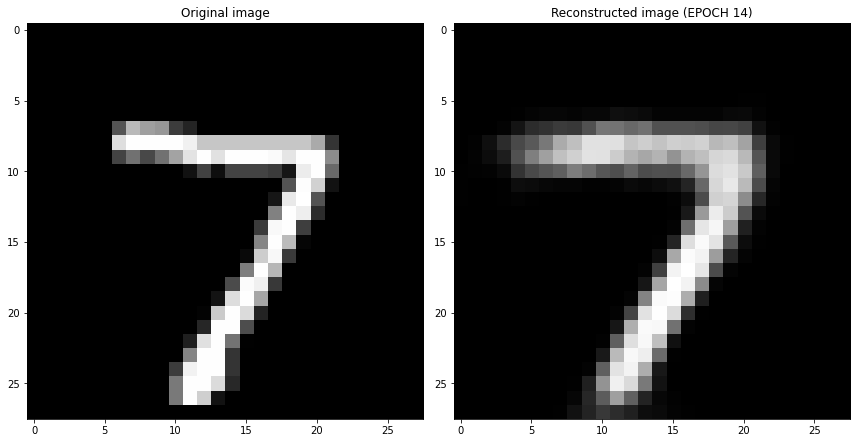

EPOCH 15/30
	 partial train loss (single batch): 0.028809
	 partial train loss (single batch): 0.029261
	 partial train loss (single batch): 0.030842
	 partial train loss (single batch): 0.030451
	 partial train loss (single batch): 0.031486
	 partial train loss (single batch): 0.029325
	 partial train loss (single batch): 0.030551
	 partial train loss (single batch): 0.031769
	 partial train loss (single batch): 0.031283
	 partial train loss (single batch): 0.030517
	 partial train loss (single batch): 0.029682
	 partial train loss (single batch): 0.031227
	 partial train loss (single batch): 0.028886
	 partial train loss (single batch): 0.029712
	 partial train loss (single batch): 0.029658
	 partial train loss (single batch): 0.029121
	 partial train loss (single batch): 0.030085
	 partial train loss (single batch): 0.030848
	 partial train loss (single batch): 0.029887
	 partial train loss (single batch): 0.030384
	 partial train loss (single batch): 0.030487
	 partial train loss (

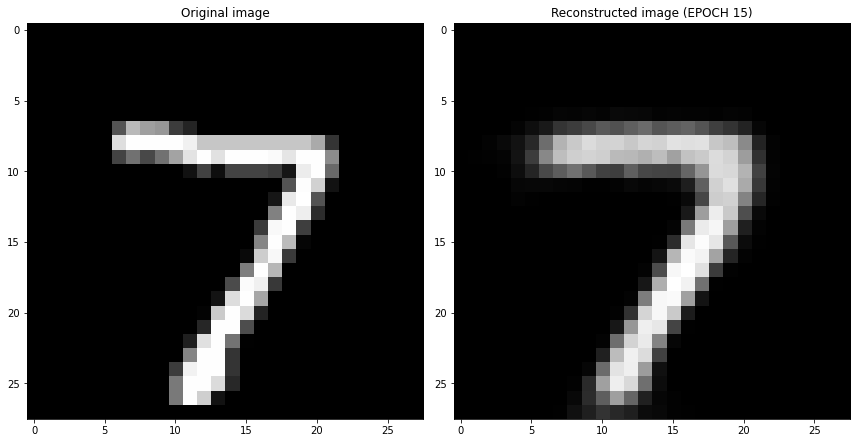

EPOCH 16/30
	 partial train loss (single batch): 0.030642
	 partial train loss (single batch): 0.029031
	 partial train loss (single batch): 0.028749
	 partial train loss (single batch): 0.028063
	 partial train loss (single batch): 0.031143
	 partial train loss (single batch): 0.030232
	 partial train loss (single batch): 0.029105
	 partial train loss (single batch): 0.030208
	 partial train loss (single batch): 0.028752
	 partial train loss (single batch): 0.029846
	 partial train loss (single batch): 0.028770
	 partial train loss (single batch): 0.029409
	 partial train loss (single batch): 0.029597
	 partial train loss (single batch): 0.030059
	 partial train loss (single batch): 0.029254
	 partial train loss (single batch): 0.029935
	 partial train loss (single batch): 0.029712
	 partial train loss (single batch): 0.029857
	 partial train loss (single batch): 0.030880
	 partial train loss (single batch): 0.029508
	 partial train loss (single batch): 0.029526
	 partial train loss (

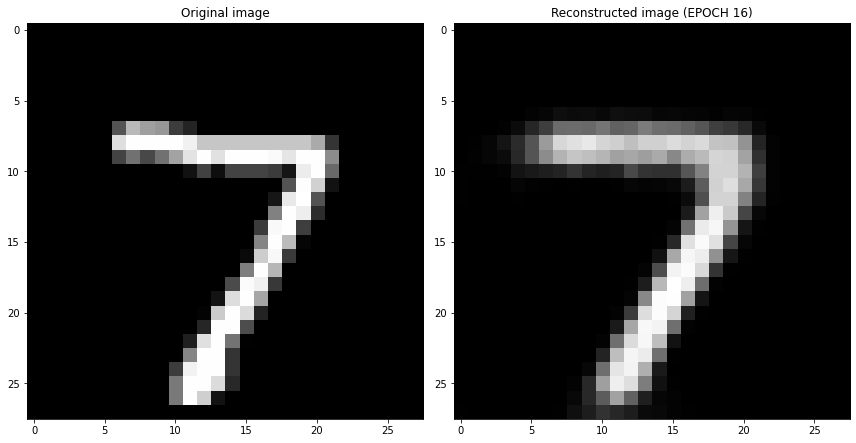

EPOCH 17/30
	 partial train loss (single batch): 0.030771
	 partial train loss (single batch): 0.032100
	 partial train loss (single batch): 0.028822
	 partial train loss (single batch): 0.029981
	 partial train loss (single batch): 0.029090
	 partial train loss (single batch): 0.028621
	 partial train loss (single batch): 0.028629
	 partial train loss (single batch): 0.029664
	 partial train loss (single batch): 0.027918
	 partial train loss (single batch): 0.029776
	 partial train loss (single batch): 0.026613
	 partial train loss (single batch): 0.028961
	 partial train loss (single batch): 0.029785
	 partial train loss (single batch): 0.031395
	 partial train loss (single batch): 0.030072
	 partial train loss (single batch): 0.030649
	 partial train loss (single batch): 0.030388
	 partial train loss (single batch): 0.028469
	 partial train loss (single batch): 0.029943
	 partial train loss (single batch): 0.029916
	 partial train loss (single batch): 0.029413
	 partial train loss (

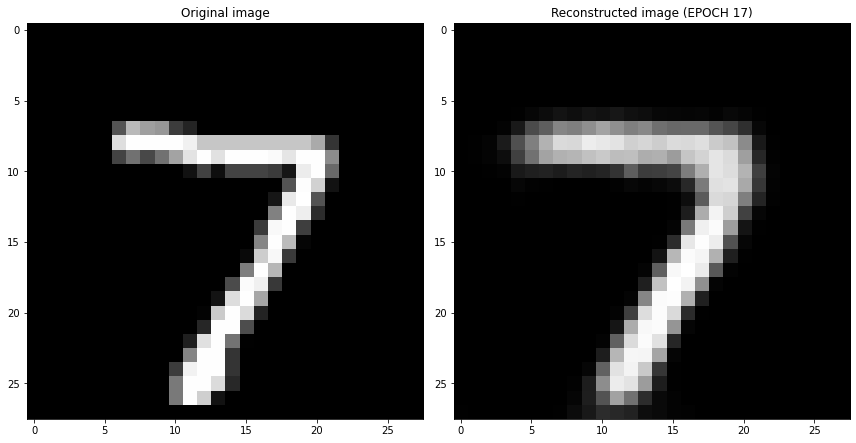

EPOCH 18/30
	 partial train loss (single batch): 0.029023
	 partial train loss (single batch): 0.029568
	 partial train loss (single batch): 0.031933
	 partial train loss (single batch): 0.030040
	 partial train loss (single batch): 0.027985
	 partial train loss (single batch): 0.029591
	 partial train loss (single batch): 0.029656
	 partial train loss (single batch): 0.029534
	 partial train loss (single batch): 0.028258
	 partial train loss (single batch): 0.029766
	 partial train loss (single batch): 0.031075
	 partial train loss (single batch): 0.028504
	 partial train loss (single batch): 0.029728
	 partial train loss (single batch): 0.029439
	 partial train loss (single batch): 0.029406
	 partial train loss (single batch): 0.027817
	 partial train loss (single batch): 0.030867
	 partial train loss (single batch): 0.030695
	 partial train loss (single batch): 0.028968
	 partial train loss (single batch): 0.032075
	 partial train loss (single batch): 0.029897
	 partial train loss (

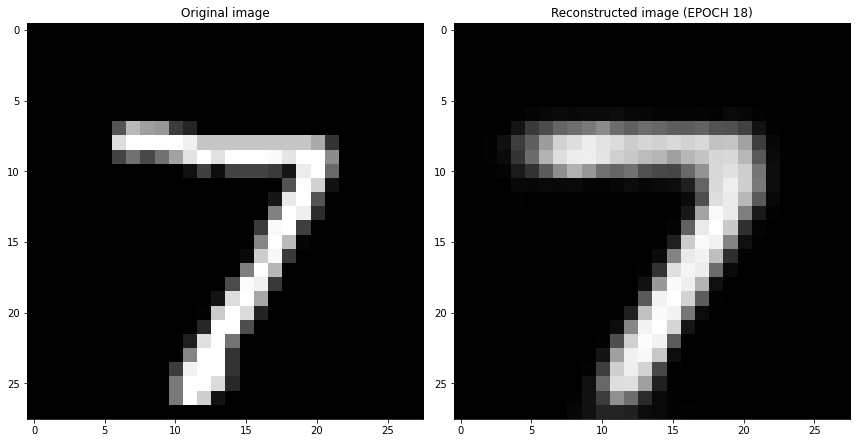

EPOCH 19/30
	 partial train loss (single batch): 0.029910
	 partial train loss (single batch): 0.029132
	 partial train loss (single batch): 0.029558
	 partial train loss (single batch): 0.030283
	 partial train loss (single batch): 0.029785
	 partial train loss (single batch): 0.029431
	 partial train loss (single batch): 0.030713
	 partial train loss (single batch): 0.030627
	 partial train loss (single batch): 0.029955
	 partial train loss (single batch): 0.029373
	 partial train loss (single batch): 0.030091
	 partial train loss (single batch): 0.027755
	 partial train loss (single batch): 0.031288
	 partial train loss (single batch): 0.029468
	 partial train loss (single batch): 0.030459
	 partial train loss (single batch): 0.028639
	 partial train loss (single batch): 0.028965
	 partial train loss (single batch): 0.029166
	 partial train loss (single batch): 0.030874
	 partial train loss (single batch): 0.028843
	 partial train loss (single batch): 0.028325
	 partial train loss (

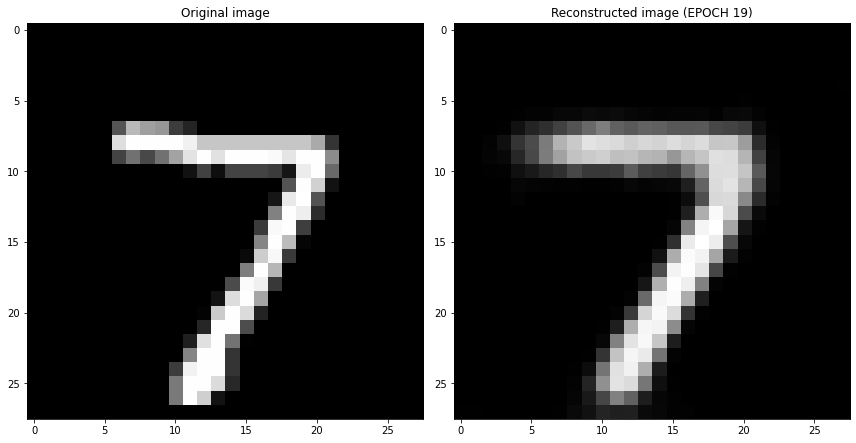

EPOCH 20/30
	 partial train loss (single batch): 0.029749
	 partial train loss (single batch): 0.028917
	 partial train loss (single batch): 0.028412
	 partial train loss (single batch): 0.030133
	 partial train loss (single batch): 0.030708
	 partial train loss (single batch): 0.028356
	 partial train loss (single batch): 0.029845
	 partial train loss (single batch): 0.028642
	 partial train loss (single batch): 0.029604
	 partial train loss (single batch): 0.028289
	 partial train loss (single batch): 0.030703
	 partial train loss (single batch): 0.028281
	 partial train loss (single batch): 0.027840
	 partial train loss (single batch): 0.028946
	 partial train loss (single batch): 0.030078
	 partial train loss (single batch): 0.031121
	 partial train loss (single batch): 0.028287
	 partial train loss (single batch): 0.027984
	 partial train loss (single batch): 0.030001
	 partial train loss (single batch): 0.029279
	 partial train loss (single batch): 0.030581
	 partial train loss (

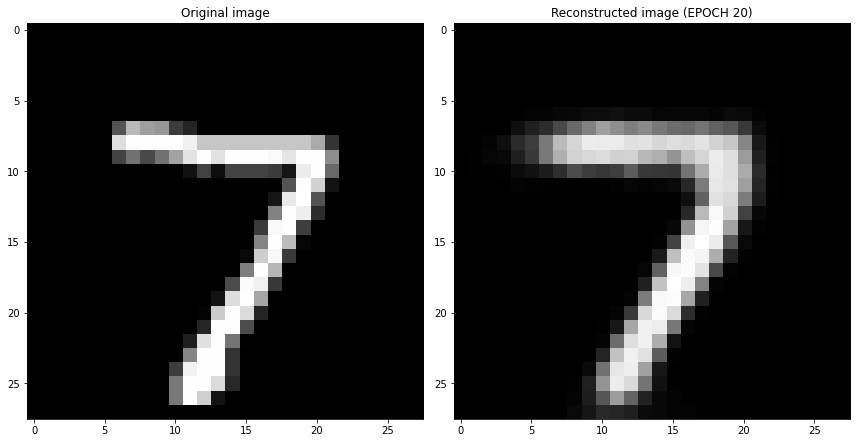

EPOCH 21/30
	 partial train loss (single batch): 0.030205
	 partial train loss (single batch): 0.028153
	 partial train loss (single batch): 0.029261
	 partial train loss (single batch): 0.029111
	 partial train loss (single batch): 0.032404
	 partial train loss (single batch): 0.028733
	 partial train loss (single batch): 0.027965
	 partial train loss (single batch): 0.028621
	 partial train loss (single batch): 0.029360
	 partial train loss (single batch): 0.028668
	 partial train loss (single batch): 0.030173
	 partial train loss (single batch): 0.028474
	 partial train loss (single batch): 0.028776
	 partial train loss (single batch): 0.030018
	 partial train loss (single batch): 0.028641
	 partial train loss (single batch): 0.030218
	 partial train loss (single batch): 0.029223
	 partial train loss (single batch): 0.029024
	 partial train loss (single batch): 0.029846
	 partial train loss (single batch): 0.029345
	 partial train loss (single batch): 0.026871
	 partial train loss (

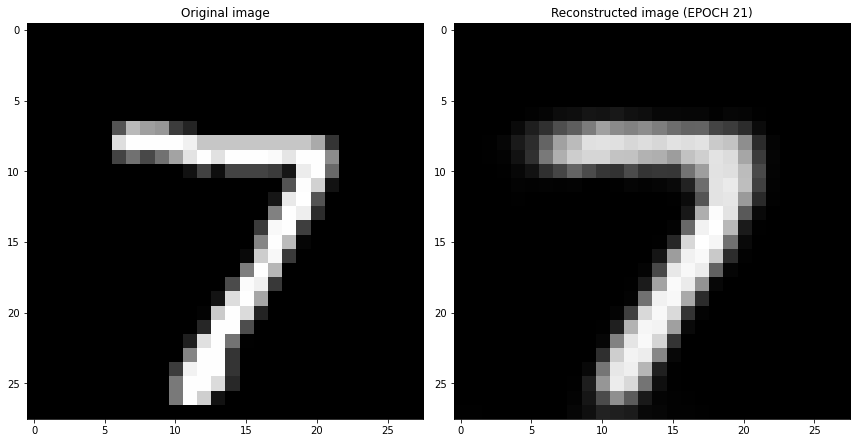

EPOCH 22/30
	 partial train loss (single batch): 0.028906
	 partial train loss (single batch): 0.031295
	 partial train loss (single batch): 0.028108
	 partial train loss (single batch): 0.028513
	 partial train loss (single batch): 0.028178
	 partial train loss (single batch): 0.029624
	 partial train loss (single batch): 0.028204
	 partial train loss (single batch): 0.030369
	 partial train loss (single batch): 0.029166
	 partial train loss (single batch): 0.030043
	 partial train loss (single batch): 0.028474
	 partial train loss (single batch): 0.030385
	 partial train loss (single batch): 0.028182
	 partial train loss (single batch): 0.029501
	 partial train loss (single batch): 0.029027
	 partial train loss (single batch): 0.027746
	 partial train loss (single batch): 0.028623
	 partial train loss (single batch): 0.029311
	 partial train loss (single batch): 0.029730
	 partial train loss (single batch): 0.028675
	 partial train loss (single batch): 0.027525
	 partial train loss (

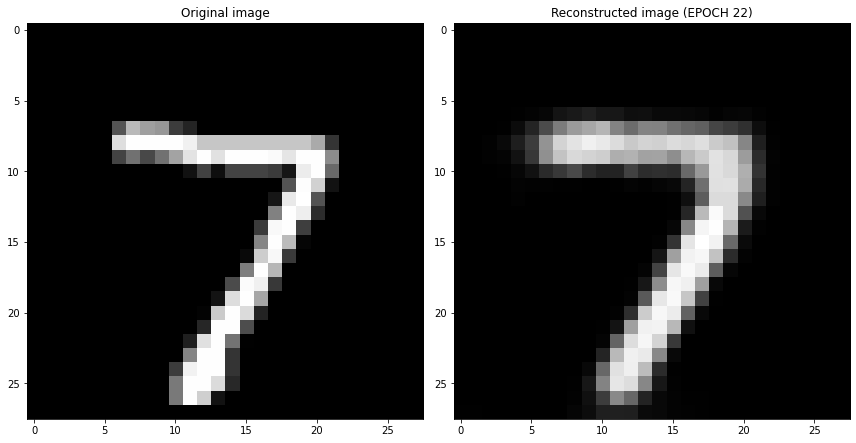

EPOCH 23/30
	 partial train loss (single batch): 0.029517
	 partial train loss (single batch): 0.029193
	 partial train loss (single batch): 0.029822
	 partial train loss (single batch): 0.029578
	 partial train loss (single batch): 0.029309
	 partial train loss (single batch): 0.028287
	 partial train loss (single batch): 0.029396
	 partial train loss (single batch): 0.029454
	 partial train loss (single batch): 0.027552
	 partial train loss (single batch): 0.030640
	 partial train loss (single batch): 0.028231
	 partial train loss (single batch): 0.029949
	 partial train loss (single batch): 0.029322
	 partial train loss (single batch): 0.027834
	 partial train loss (single batch): 0.030823
	 partial train loss (single batch): 0.028453
	 partial train loss (single batch): 0.029662
	 partial train loss (single batch): 0.030865
	 partial train loss (single batch): 0.030067
	 partial train loss (single batch): 0.028485
	 partial train loss (single batch): 0.028512
	 partial train loss (

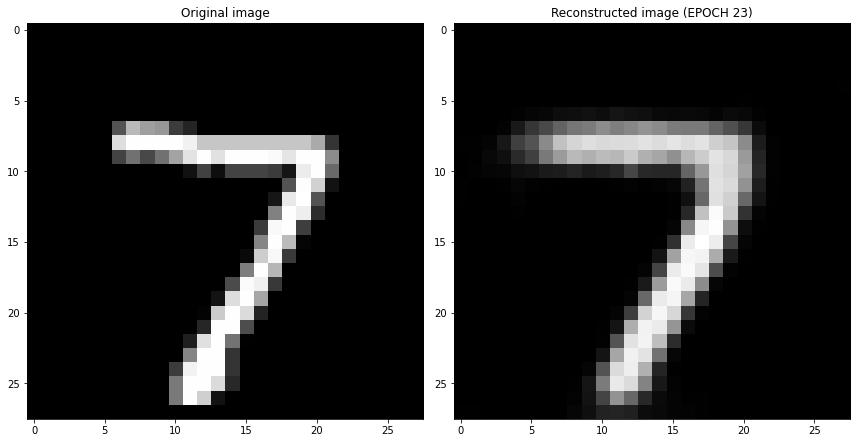

EPOCH 24/30
	 partial train loss (single batch): 0.028746
	 partial train loss (single batch): 0.029879
	 partial train loss (single batch): 0.028561
	 partial train loss (single batch): 0.028387
	 partial train loss (single batch): 0.029133
	 partial train loss (single batch): 0.030514
	 partial train loss (single batch): 0.029033
	 partial train loss (single batch): 0.028442
	 partial train loss (single batch): 0.027272
	 partial train loss (single batch): 0.029390
	 partial train loss (single batch): 0.029928
	 partial train loss (single batch): 0.030038
	 partial train loss (single batch): 0.028276
	 partial train loss (single batch): 0.027840
	 partial train loss (single batch): 0.031078
	 partial train loss (single batch): 0.030188
	 partial train loss (single batch): 0.029378
	 partial train loss (single batch): 0.029915
	 partial train loss (single batch): 0.030081
	 partial train loss (single batch): 0.028868
	 partial train loss (single batch): 0.028743
	 partial train loss (

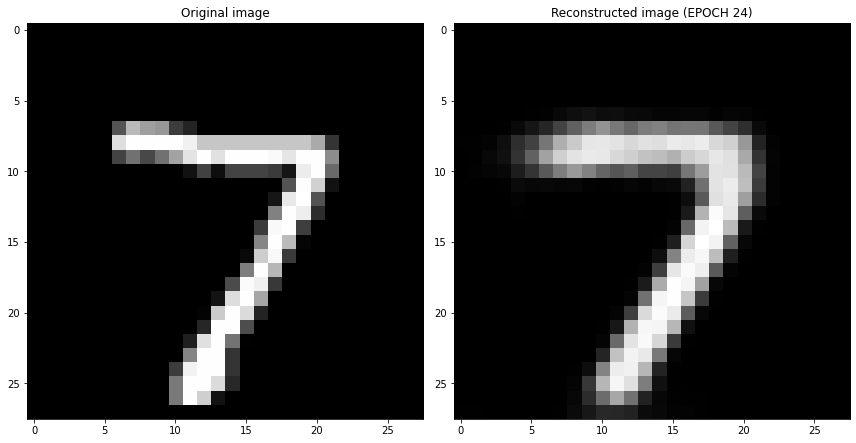

EPOCH 25/30
	 partial train loss (single batch): 0.028750
	 partial train loss (single batch): 0.028534
	 partial train loss (single batch): 0.027775
	 partial train loss (single batch): 0.028526
	 partial train loss (single batch): 0.029090
	 partial train loss (single batch): 0.027164
	 partial train loss (single batch): 0.028388
	 partial train loss (single batch): 0.027290
	 partial train loss (single batch): 0.030147
	 partial train loss (single batch): 0.029525
	 partial train loss (single batch): 0.031141
	 partial train loss (single batch): 0.027987
	 partial train loss (single batch): 0.029347
	 partial train loss (single batch): 0.030081
	 partial train loss (single batch): 0.028802
	 partial train loss (single batch): 0.029136
	 partial train loss (single batch): 0.028081
	 partial train loss (single batch): 0.028779
	 partial train loss (single batch): 0.029056
	 partial train loss (single batch): 0.027246
	 partial train loss (single batch): 0.029855
	 partial train loss (

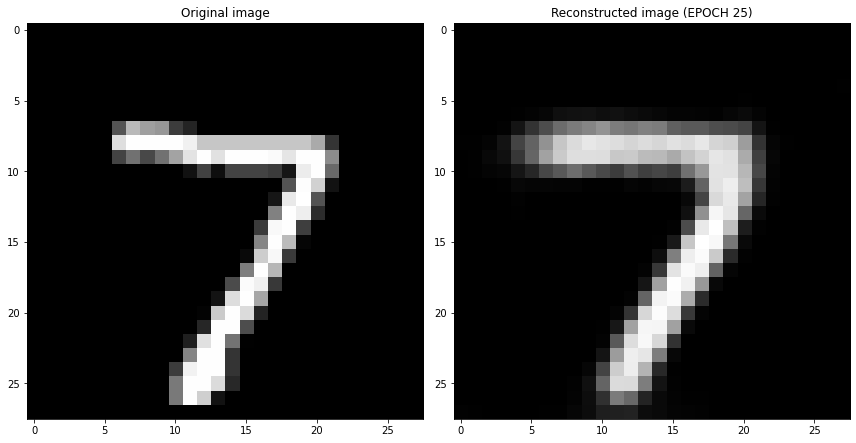

EPOCH 26/30
	 partial train loss (single batch): 0.028779
	 partial train loss (single batch): 0.028173
	 partial train loss (single batch): 0.028485
	 partial train loss (single batch): 0.029649
	 partial train loss (single batch): 0.027594
	 partial train loss (single batch): 0.028371
	 partial train loss (single batch): 0.028888
	 partial train loss (single batch): 0.026994
	 partial train loss (single batch): 0.028078
	 partial train loss (single batch): 0.027672
	 partial train loss (single batch): 0.029806
	 partial train loss (single batch): 0.029040
	 partial train loss (single batch): 0.029969
	 partial train loss (single batch): 0.026505
	 partial train loss (single batch): 0.029165
	 partial train loss (single batch): 0.026338
	 partial train loss (single batch): 0.029125
	 partial train loss (single batch): 0.029639
	 partial train loss (single batch): 0.029899
	 partial train loss (single batch): 0.029512
	 partial train loss (single batch): 0.031195
	 partial train loss (

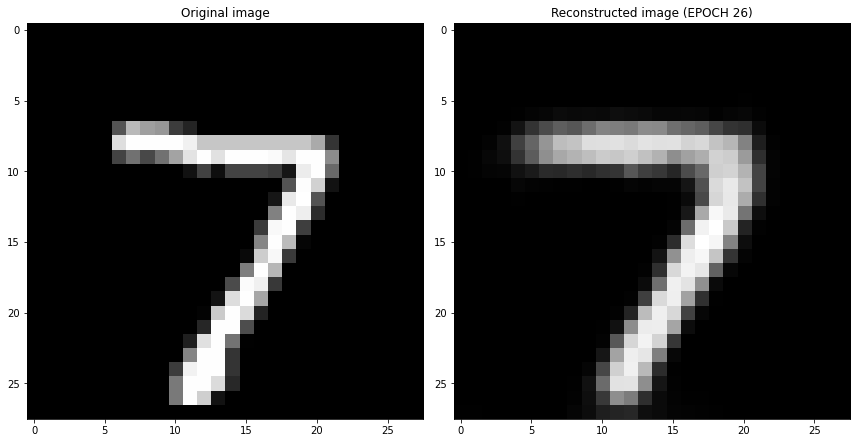

EPOCH 27/30
	 partial train loss (single batch): 0.029378
	 partial train loss (single batch): 0.028964
	 partial train loss (single batch): 0.028865
	 partial train loss (single batch): 0.029853
	 partial train loss (single batch): 0.027811
	 partial train loss (single batch): 0.029315
	 partial train loss (single batch): 0.029164
	 partial train loss (single batch): 0.028371
	 partial train loss (single batch): 0.028446
	 partial train loss (single batch): 0.028325
	 partial train loss (single batch): 0.028924
	 partial train loss (single batch): 0.028124
	 partial train loss (single batch): 0.027797
	 partial train loss (single batch): 0.029007
	 partial train loss (single batch): 0.028514
	 partial train loss (single batch): 0.028945
	 partial train loss (single batch): 0.027418
	 partial train loss (single batch): 0.028733
	 partial train loss (single batch): 0.028204
	 partial train loss (single batch): 0.028183
	 partial train loss (single batch): 0.026111
	 partial train loss (

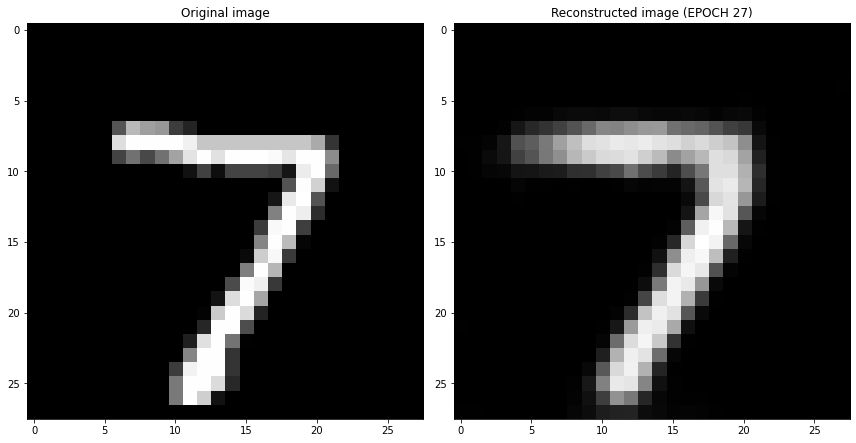

EPOCH 28/30
	 partial train loss (single batch): 0.027350
	 partial train loss (single batch): 0.027391
	 partial train loss (single batch): 0.028538
	 partial train loss (single batch): 0.025934
	 partial train loss (single batch): 0.028976
	 partial train loss (single batch): 0.028047
	 partial train loss (single batch): 0.028538
	 partial train loss (single batch): 0.028472
	 partial train loss (single batch): 0.028683
	 partial train loss (single batch): 0.028236
	 partial train loss (single batch): 0.027925
	 partial train loss (single batch): 0.028236
	 partial train loss (single batch): 0.027727
	 partial train loss (single batch): 0.027937
	 partial train loss (single batch): 0.028476
	 partial train loss (single batch): 0.027695
	 partial train loss (single batch): 0.031221
	 partial train loss (single batch): 0.029099
	 partial train loss (single batch): 0.029211
	 partial train loss (single batch): 0.029181
	 partial train loss (single batch): 0.027597
	 partial train loss (

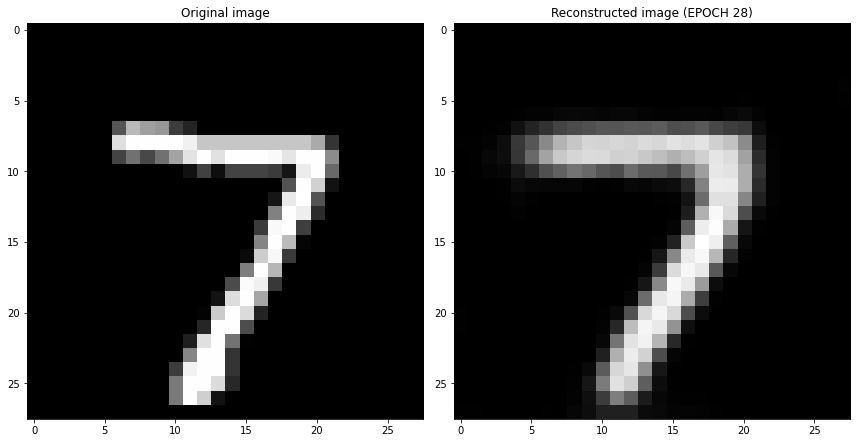

EPOCH 29/30
	 partial train loss (single batch): 0.028708
	 partial train loss (single batch): 0.028632
	 partial train loss (single batch): 0.027957
	 partial train loss (single batch): 0.028778
	 partial train loss (single batch): 0.028437
	 partial train loss (single batch): 0.027756
	 partial train loss (single batch): 0.028068
	 partial train loss (single batch): 0.028890
	 partial train loss (single batch): 0.029147
	 partial train loss (single batch): 0.029776
	 partial train loss (single batch): 0.028265
	 partial train loss (single batch): 0.029096
	 partial train loss (single batch): 0.027627
	 partial train loss (single batch): 0.027917
	 partial train loss (single batch): 0.027002
	 partial train loss (single batch): 0.027436
	 partial train loss (single batch): 0.029786
	 partial train loss (single batch): 0.028652
	 partial train loss (single batch): 0.029050
	 partial train loss (single batch): 0.026399
	 partial train loss (single batch): 0.029049
	 partial train loss (

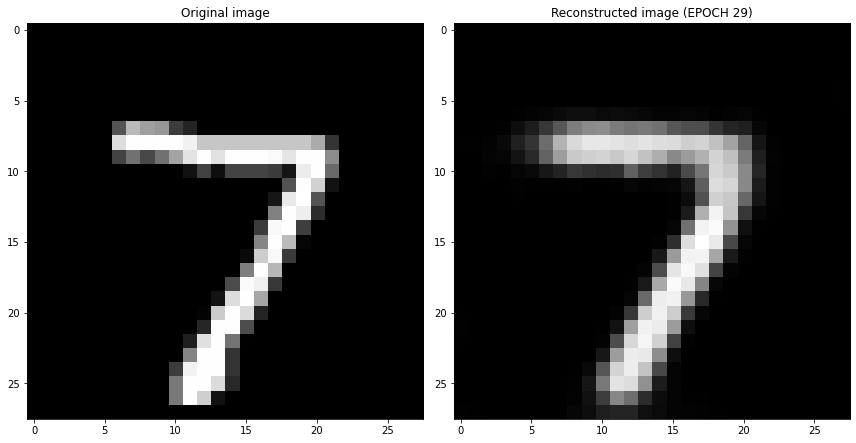

EPOCH 30/30
	 partial train loss (single batch): 0.027580
	 partial train loss (single batch): 0.027065
	 partial train loss (single batch): 0.028357
	 partial train loss (single batch): 0.027757
	 partial train loss (single batch): 0.028040
	 partial train loss (single batch): 0.029967
	 partial train loss (single batch): 0.026856
	 partial train loss (single batch): 0.029007
	 partial train loss (single batch): 0.029239
	 partial train loss (single batch): 0.028346
	 partial train loss (single batch): 0.030130
	 partial train loss (single batch): 0.027870
	 partial train loss (single batch): 0.029386
	 partial train loss (single batch): 0.030507
	 partial train loss (single batch): 0.028870
	 partial train loss (single batch): 0.027042
	 partial train loss (single batch): 0.029444
	 partial train loss (single batch): 0.027860
	 partial train loss (single batch): 0.027505
	 partial train loss (single batch): 0.027462
	 partial train loss (single batch): 0.028299
	 partial train loss (

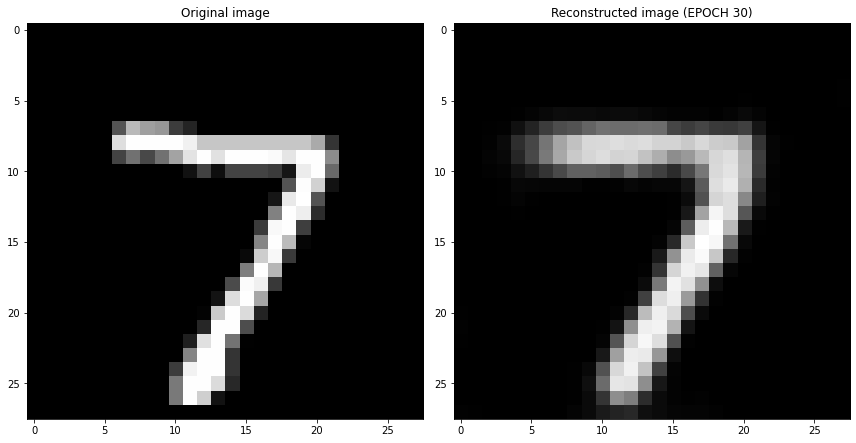

Cross validation fold number= 2/6
EPOCH 1/30
	 partial train loss (single batch): 0.234925
	 partial train loss (single batch): 0.234760
	 partial train loss (single batch): 0.233749
	 partial train loss (single batch): 0.233210
	 partial train loss (single batch): 0.232546
	 partial train loss (single batch): 0.231580
	 partial train loss (single batch): 0.231235
	 partial train loss (single batch): 0.230478
	 partial train loss (single batch): 0.230315
	 partial train loss (single batch): 0.228700
	 partial train loss (single batch): 0.227755
	 partial train loss (single batch): 0.226698
	 partial train loss (single batch): 0.224939
	 partial train loss (single batch): 0.223652
	 partial train loss (single batch): 0.222037
	 partial train loss (single batch): 0.219965
	 partial train loss (single batch): 0.217265
	 partial train loss (single batch): 0.214432
	 partial train loss (single batch): 0.210357
	 partial train loss (single batch): 0.205317
	 partial train loss (single batch)

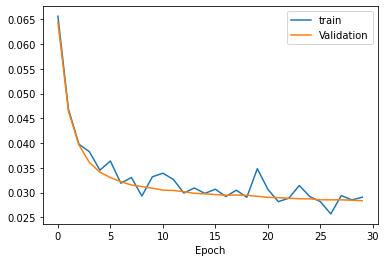

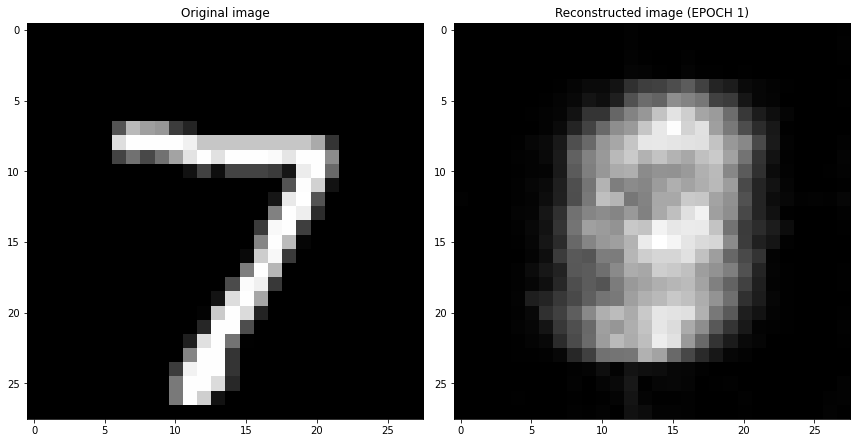

EPOCH 2/30
	 partial train loss (single batch): 0.063483
	 partial train loss (single batch): 0.064393
	 partial train loss (single batch): 0.064837
	 partial train loss (single batch): 0.061403
	 partial train loss (single batch): 0.063209
	 partial train loss (single batch): 0.064622
	 partial train loss (single batch): 0.064912
	 partial train loss (single batch): 0.064595
	 partial train loss (single batch): 0.066646
	 partial train loss (single batch): 0.063978
	 partial train loss (single batch): 0.064883
	 partial train loss (single batch): 0.062522
	 partial train loss (single batch): 0.063190
	 partial train loss (single batch): 0.065007
	 partial train loss (single batch): 0.063278
	 partial train loss (single batch): 0.062314
	 partial train loss (single batch): 0.062009
	 partial train loss (single batch): 0.064053
	 partial train loss (single batch): 0.063581
	 partial train loss (single batch): 0.064092
	 partial train loss (single batch): 0.061407
	 partial train loss (s

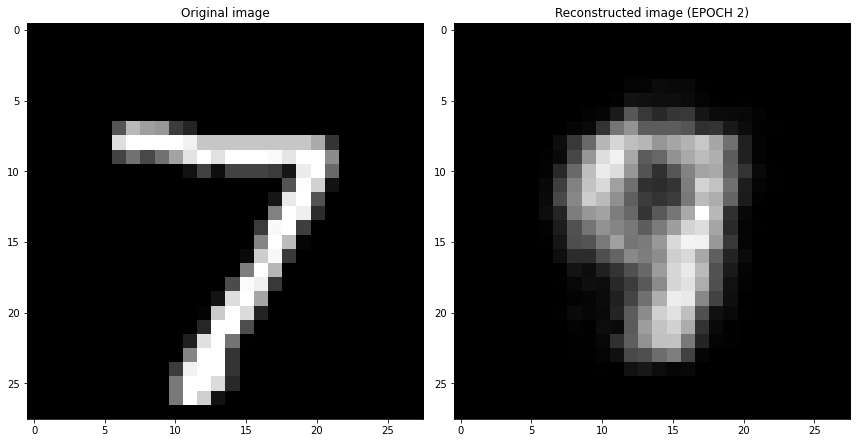

EPOCH 3/30
	 partial train loss (single batch): 0.048460
	 partial train loss (single batch): 0.051622
	 partial train loss (single batch): 0.049736
	 partial train loss (single batch): 0.049633
	 partial train loss (single batch): 0.050057
	 partial train loss (single batch): 0.049166
	 partial train loss (single batch): 0.048017
	 partial train loss (single batch): 0.050643
	 partial train loss (single batch): 0.051114
	 partial train loss (single batch): 0.049121
	 partial train loss (single batch): 0.051409
	 partial train loss (single batch): 0.049655
	 partial train loss (single batch): 0.049251
	 partial train loss (single batch): 0.048546
	 partial train loss (single batch): 0.050650
	 partial train loss (single batch): 0.048190
	 partial train loss (single batch): 0.050097
	 partial train loss (single batch): 0.047415
	 partial train loss (single batch): 0.049011
	 partial train loss (single batch): 0.048874
	 partial train loss (single batch): 0.049307
	 partial train loss (s

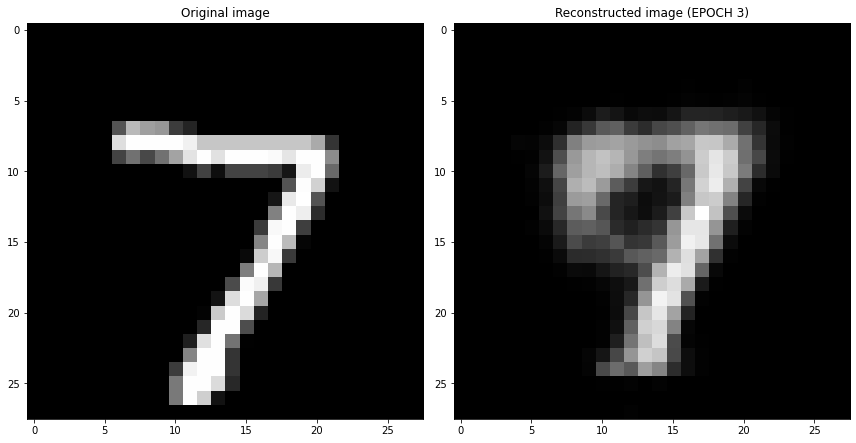

EPOCH 4/30
	 partial train loss (single batch): 0.042362
	 partial train loss (single batch): 0.042925
	 partial train loss (single batch): 0.043019
	 partial train loss (single batch): 0.043478
	 partial train loss (single batch): 0.044913
	 partial train loss (single batch): 0.043782
	 partial train loss (single batch): 0.046158
	 partial train loss (single batch): 0.042851
	 partial train loss (single batch): 0.043867
	 partial train loss (single batch): 0.042728
	 partial train loss (single batch): 0.043260
	 partial train loss (single batch): 0.044966
	 partial train loss (single batch): 0.042295
	 partial train loss (single batch): 0.043604
	 partial train loss (single batch): 0.043744
	 partial train loss (single batch): 0.044971
	 partial train loss (single batch): 0.043114
	 partial train loss (single batch): 0.043537
	 partial train loss (single batch): 0.042250
	 partial train loss (single batch): 0.044806
	 partial train loss (single batch): 0.042895
	 partial train loss (s

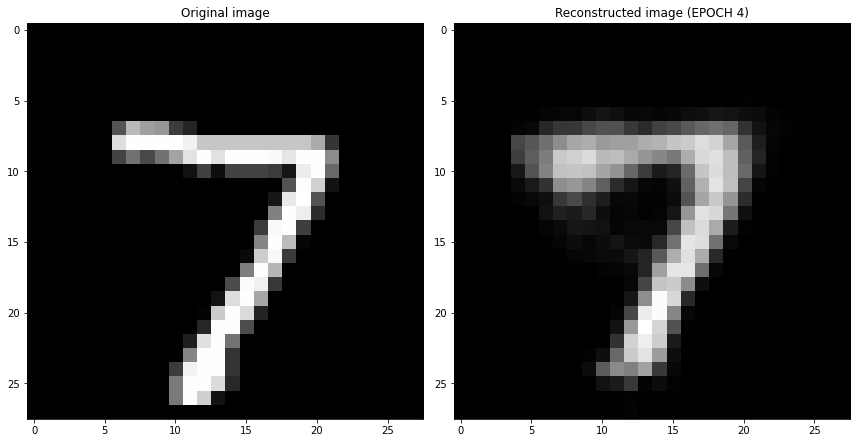

EPOCH 5/30
	 partial train loss (single batch): 0.042067
	 partial train loss (single batch): 0.040006
	 partial train loss (single batch): 0.040075
	 partial train loss (single batch): 0.038430
	 partial train loss (single batch): 0.040157
	 partial train loss (single batch): 0.041326
	 partial train loss (single batch): 0.038376
	 partial train loss (single batch): 0.039067
	 partial train loss (single batch): 0.040031
	 partial train loss (single batch): 0.041531
	 partial train loss (single batch): 0.041173
	 partial train loss (single batch): 0.038961
	 partial train loss (single batch): 0.039489
	 partial train loss (single batch): 0.041338
	 partial train loss (single batch): 0.040900
	 partial train loss (single batch): 0.041367
	 partial train loss (single batch): 0.038381
	 partial train loss (single batch): 0.039574
	 partial train loss (single batch): 0.040187
	 partial train loss (single batch): 0.039038
	 partial train loss (single batch): 0.038817
	 partial train loss (s

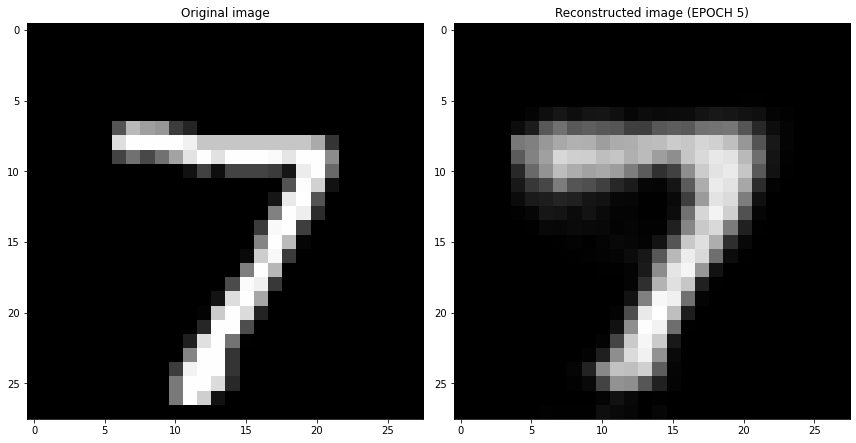

EPOCH 6/30
	 partial train loss (single batch): 0.036202
	 partial train loss (single batch): 0.037484
	 partial train loss (single batch): 0.037069
	 partial train loss (single batch): 0.036255
	 partial train loss (single batch): 0.035915
	 partial train loss (single batch): 0.035113
	 partial train loss (single batch): 0.036055
	 partial train loss (single batch): 0.036231
	 partial train loss (single batch): 0.038141
	 partial train loss (single batch): 0.037501
	 partial train loss (single batch): 0.036219
	 partial train loss (single batch): 0.036634
	 partial train loss (single batch): 0.038638
	 partial train loss (single batch): 0.035157
	 partial train loss (single batch): 0.038095
	 partial train loss (single batch): 0.036443
	 partial train loss (single batch): 0.035732
	 partial train loss (single batch): 0.034292
	 partial train loss (single batch): 0.035599
	 partial train loss (single batch): 0.035341
	 partial train loss (single batch): 0.037197
	 partial train loss (s

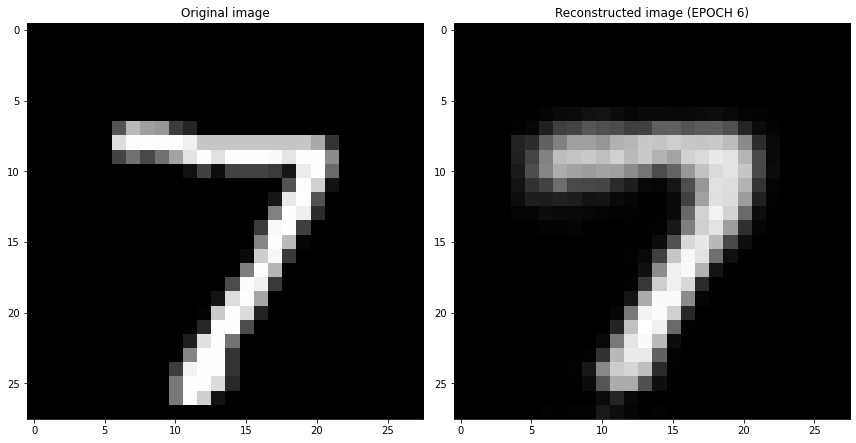

EPOCH 7/30
	 partial train loss (single batch): 0.034846
	 partial train loss (single batch): 0.034515
	 partial train loss (single batch): 0.035159
	 partial train loss (single batch): 0.034146
	 partial train loss (single batch): 0.036303
	 partial train loss (single batch): 0.035853
	 partial train loss (single batch): 0.035572
	 partial train loss (single batch): 0.034845
	 partial train loss (single batch): 0.034925
	 partial train loss (single batch): 0.035194
	 partial train loss (single batch): 0.035842
	 partial train loss (single batch): 0.036755
	 partial train loss (single batch): 0.035490
	 partial train loss (single batch): 0.035500
	 partial train loss (single batch): 0.035420
	 partial train loss (single batch): 0.036341
	 partial train loss (single batch): 0.034928
	 partial train loss (single batch): 0.033732
	 partial train loss (single batch): 0.032638
	 partial train loss (single batch): 0.036557
	 partial train loss (single batch): 0.032685
	 partial train loss (s

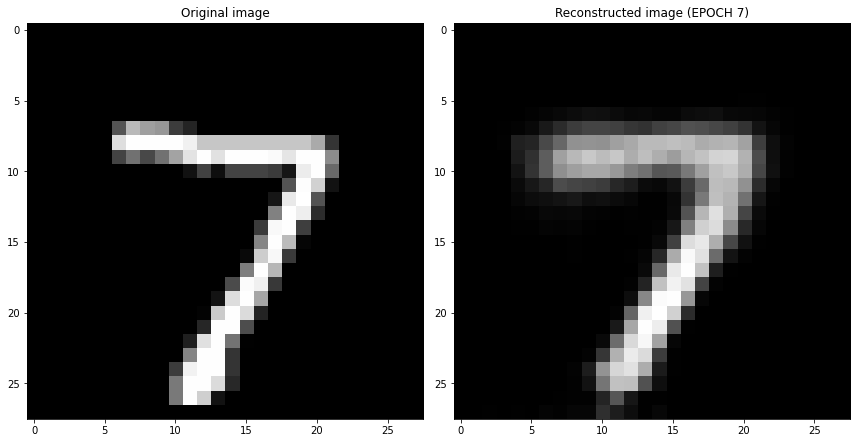

EPOCH 8/30
	 partial train loss (single batch): 0.034224
	 partial train loss (single batch): 0.035248
	 partial train loss (single batch): 0.032392
	 partial train loss (single batch): 0.032038
	 partial train loss (single batch): 0.035337
	 partial train loss (single batch): 0.034262
	 partial train loss (single batch): 0.034471
	 partial train loss (single batch): 0.033454
	 partial train loss (single batch): 0.032897
	 partial train loss (single batch): 0.033430
	 partial train loss (single batch): 0.033559
	 partial train loss (single batch): 0.033042
	 partial train loss (single batch): 0.033351
	 partial train loss (single batch): 0.033924
	 partial train loss (single batch): 0.034541
	 partial train loss (single batch): 0.033025
	 partial train loss (single batch): 0.034122
	 partial train loss (single batch): 0.031916
	 partial train loss (single batch): 0.033074
	 partial train loss (single batch): 0.035216
	 partial train loss (single batch): 0.035399
	 partial train loss (s

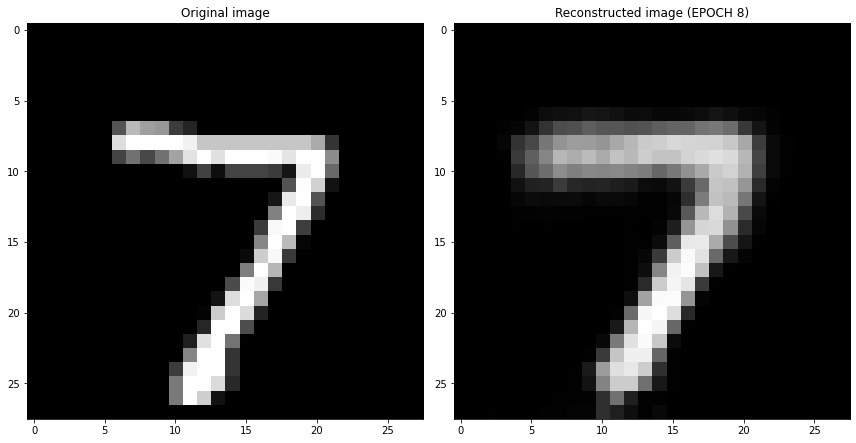

EPOCH 9/30
	 partial train loss (single batch): 0.033180
	 partial train loss (single batch): 0.032077
	 partial train loss (single batch): 0.035091
	 partial train loss (single batch): 0.031469
	 partial train loss (single batch): 0.033540
	 partial train loss (single batch): 0.031520
	 partial train loss (single batch): 0.033394
	 partial train loss (single batch): 0.033958
	 partial train loss (single batch): 0.032647
	 partial train loss (single batch): 0.032691
	 partial train loss (single batch): 0.033385
	 partial train loss (single batch): 0.031551
	 partial train loss (single batch): 0.030350
	 partial train loss (single batch): 0.033461
	 partial train loss (single batch): 0.032048
	 partial train loss (single batch): 0.032972
	 partial train loss (single batch): 0.032115
	 partial train loss (single batch): 0.032863
	 partial train loss (single batch): 0.031678
	 partial train loss (single batch): 0.032712
	 partial train loss (single batch): 0.032588
	 partial train loss (s

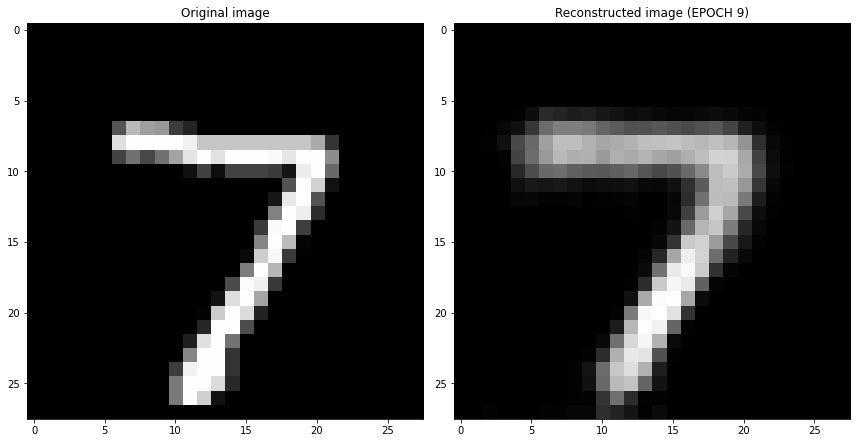

EPOCH 10/30
	 partial train loss (single batch): 0.032382
	 partial train loss (single batch): 0.031854
	 partial train loss (single batch): 0.031888
	 partial train loss (single batch): 0.030807
	 partial train loss (single batch): 0.032968
	 partial train loss (single batch): 0.031784
	 partial train loss (single batch): 0.031015
	 partial train loss (single batch): 0.032450
	 partial train loss (single batch): 0.032038
	 partial train loss (single batch): 0.031862
	 partial train loss (single batch): 0.031024
	 partial train loss (single batch): 0.033014
	 partial train loss (single batch): 0.033352
	 partial train loss (single batch): 0.032328
	 partial train loss (single batch): 0.032667
	 partial train loss (single batch): 0.032328
	 partial train loss (single batch): 0.031264
	 partial train loss (single batch): 0.032968
	 partial train loss (single batch): 0.033173
	 partial train loss (single batch): 0.032081
	 partial train loss (single batch): 0.032368
	 partial train loss (

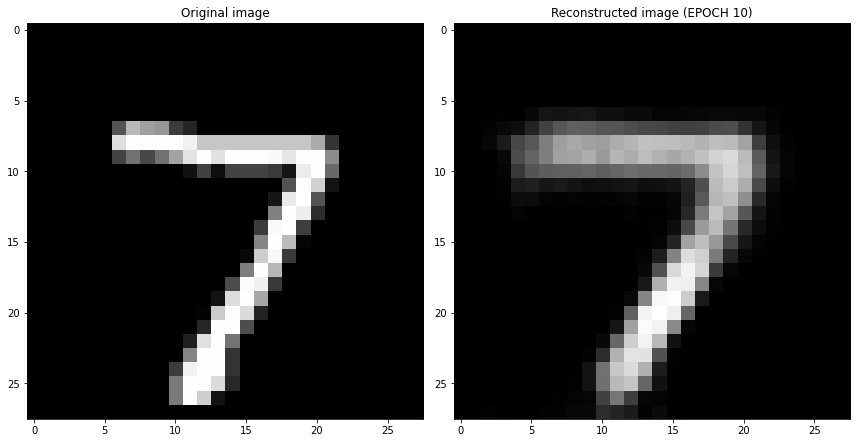

EPOCH 11/30
	 partial train loss (single batch): 0.032187
	 partial train loss (single batch): 0.031377
	 partial train loss (single batch): 0.031145
	 partial train loss (single batch): 0.032760
	 partial train loss (single batch): 0.032659
	 partial train loss (single batch): 0.029662
	 partial train loss (single batch): 0.030952
	 partial train loss (single batch): 0.032831
	 partial train loss (single batch): 0.031817
	 partial train loss (single batch): 0.031182
	 partial train loss (single batch): 0.031544
	 partial train loss (single batch): 0.031511
	 partial train loss (single batch): 0.031694
	 partial train loss (single batch): 0.030519
	 partial train loss (single batch): 0.030503
	 partial train loss (single batch): 0.031878
	 partial train loss (single batch): 0.032218
	 partial train loss (single batch): 0.032621
	 partial train loss (single batch): 0.031691
	 partial train loss (single batch): 0.031280
	 partial train loss (single batch): 0.032873
	 partial train loss (

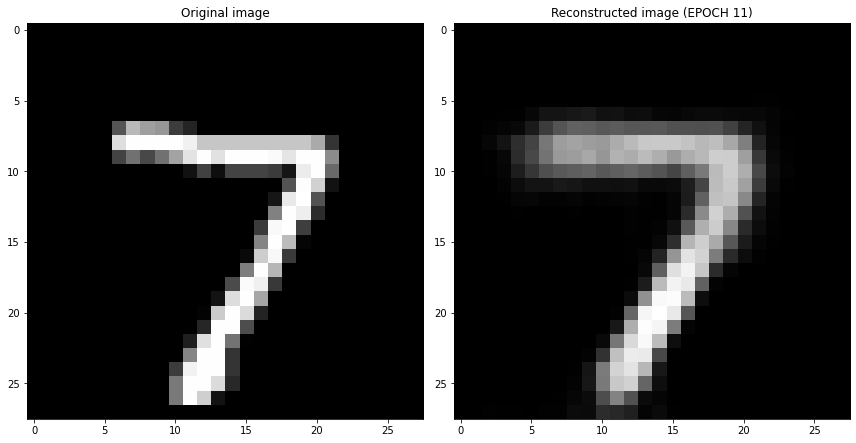

EPOCH 12/30
	 partial train loss (single batch): 0.031866
	 partial train loss (single batch): 0.032383
	 partial train loss (single batch): 0.031333
	 partial train loss (single batch): 0.030493
	 partial train loss (single batch): 0.029579
	 partial train loss (single batch): 0.030610
	 partial train loss (single batch): 0.033465
	 partial train loss (single batch): 0.032115
	 partial train loss (single batch): 0.029768
	 partial train loss (single batch): 0.032563
	 partial train loss (single batch): 0.033229
	 partial train loss (single batch): 0.030811
	 partial train loss (single batch): 0.033657
	 partial train loss (single batch): 0.032034
	 partial train loss (single batch): 0.030611
	 partial train loss (single batch): 0.031017
	 partial train loss (single batch): 0.032863
	 partial train loss (single batch): 0.032982
	 partial train loss (single batch): 0.032119
	 partial train loss (single batch): 0.030511
	 partial train loss (single batch): 0.031674
	 partial train loss (

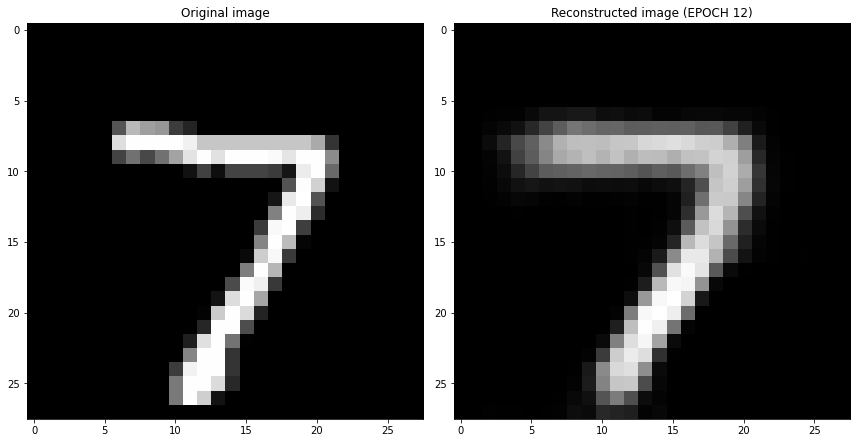

EPOCH 13/30
	 partial train loss (single batch): 0.031848
	 partial train loss (single batch): 0.031954
	 partial train loss (single batch): 0.030224
	 partial train loss (single batch): 0.031516
	 partial train loss (single batch): 0.031360
	 partial train loss (single batch): 0.030383
	 partial train loss (single batch): 0.031708
	 partial train loss (single batch): 0.030575
	 partial train loss (single batch): 0.030655
	 partial train loss (single batch): 0.030886
	 partial train loss (single batch): 0.031376
	 partial train loss (single batch): 0.030662
	 partial train loss (single batch): 0.031201
	 partial train loss (single batch): 0.031333
	 partial train loss (single batch): 0.031631
	 partial train loss (single batch): 0.032235
	 partial train loss (single batch): 0.030487
	 partial train loss (single batch): 0.033524
	 partial train loss (single batch): 0.029731
	 partial train loss (single batch): 0.031129
	 partial train loss (single batch): 0.031250
	 partial train loss (

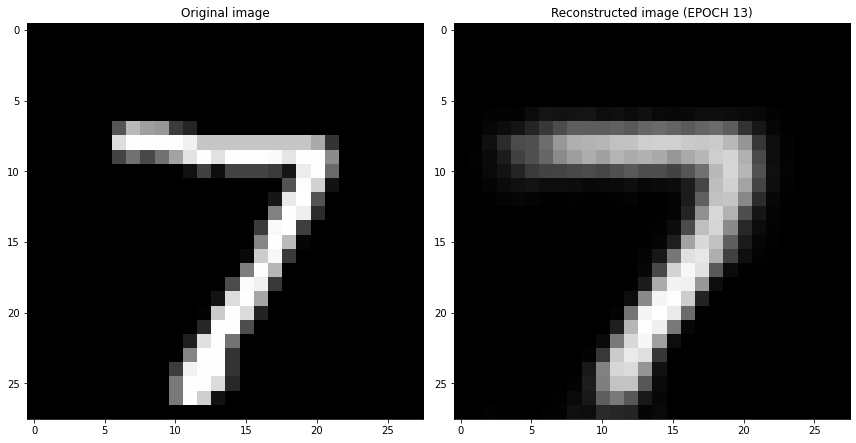

EPOCH 14/30
	 partial train loss (single batch): 0.029711
	 partial train loss (single batch): 0.032770
	 partial train loss (single batch): 0.030623
	 partial train loss (single batch): 0.029822
	 partial train loss (single batch): 0.029899
	 partial train loss (single batch): 0.031585
	 partial train loss (single batch): 0.029179
	 partial train loss (single batch): 0.030968
	 partial train loss (single batch): 0.031621
	 partial train loss (single batch): 0.031280
	 partial train loss (single batch): 0.030608
	 partial train loss (single batch): 0.029870
	 partial train loss (single batch): 0.030144
	 partial train loss (single batch): 0.031491
	 partial train loss (single batch): 0.030212
	 partial train loss (single batch): 0.032073
	 partial train loss (single batch): 0.032815
	 partial train loss (single batch): 0.032662
	 partial train loss (single batch): 0.030824
	 partial train loss (single batch): 0.029793
	 partial train loss (single batch): 0.031836
	 partial train loss (

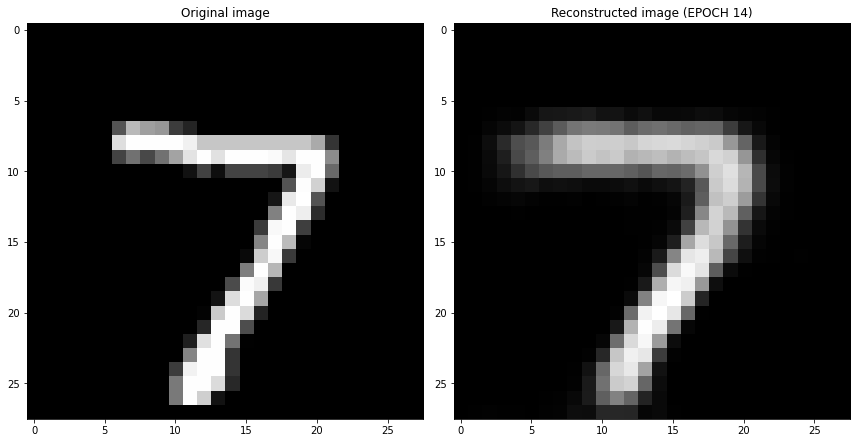

EPOCH 15/30
	 partial train loss (single batch): 0.030061
	 partial train loss (single batch): 0.030214
	 partial train loss (single batch): 0.029710
	 partial train loss (single batch): 0.030768
	 partial train loss (single batch): 0.032553
	 partial train loss (single batch): 0.031230
	 partial train loss (single batch): 0.032510
	 partial train loss (single batch): 0.030840
	 partial train loss (single batch): 0.030272
	 partial train loss (single batch): 0.029526
	 partial train loss (single batch): 0.031570
	 partial train loss (single batch): 0.031353
	 partial train loss (single batch): 0.030172
	 partial train loss (single batch): 0.029315
	 partial train loss (single batch): 0.029403
	 partial train loss (single batch): 0.031863
	 partial train loss (single batch): 0.031447
	 partial train loss (single batch): 0.030749
	 partial train loss (single batch): 0.030720
	 partial train loss (single batch): 0.029112
	 partial train loss (single batch): 0.031184
	 partial train loss (

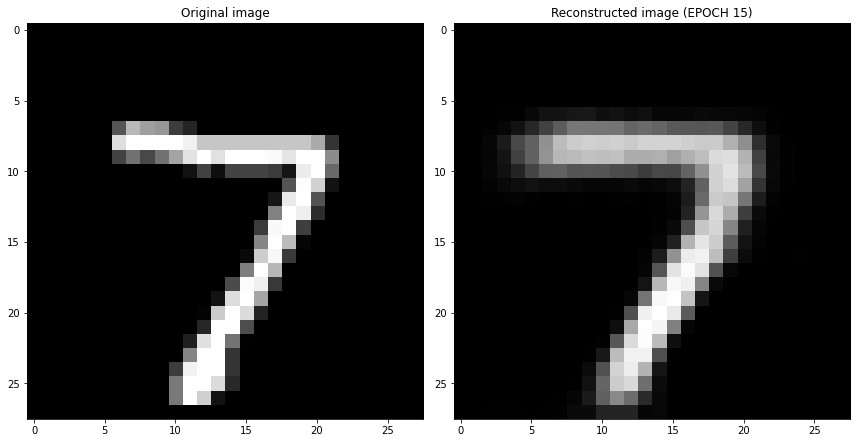

EPOCH 16/30
	 partial train loss (single batch): 0.030818
	 partial train loss (single batch): 0.030651
	 partial train loss (single batch): 0.030630
	 partial train loss (single batch): 0.029851
	 partial train loss (single batch): 0.030933
	 partial train loss (single batch): 0.031338
	 partial train loss (single batch): 0.030175
	 partial train loss (single batch): 0.030163
	 partial train loss (single batch): 0.031968
	 partial train loss (single batch): 0.029137
	 partial train loss (single batch): 0.030081
	 partial train loss (single batch): 0.031062
	 partial train loss (single batch): 0.030393
	 partial train loss (single batch): 0.031573
	 partial train loss (single batch): 0.030381
	 partial train loss (single batch): 0.029137
	 partial train loss (single batch): 0.029287
	 partial train loss (single batch): 0.029979
	 partial train loss (single batch): 0.031629
	 partial train loss (single batch): 0.031250
	 partial train loss (single batch): 0.030680
	 partial train loss (

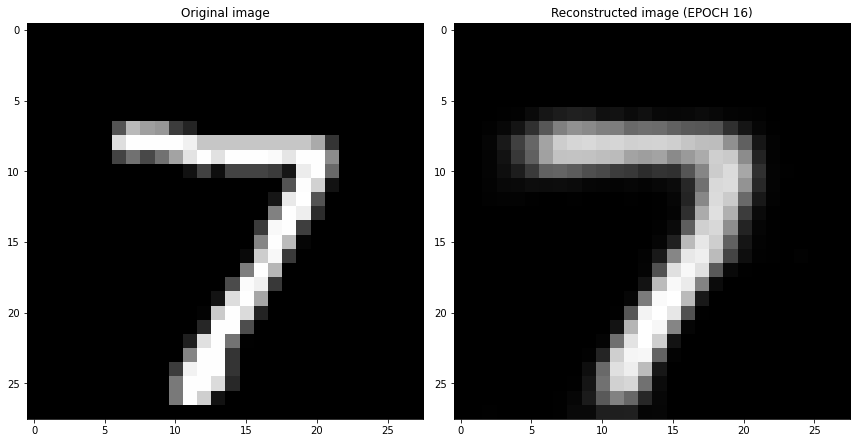

EPOCH 17/30
	 partial train loss (single batch): 0.029758
	 partial train loss (single batch): 0.030172
	 partial train loss (single batch): 0.030076
	 partial train loss (single batch): 0.030807
	 partial train loss (single batch): 0.028857
	 partial train loss (single batch): 0.031992
	 partial train loss (single batch): 0.028102
	 partial train loss (single batch): 0.030604
	 partial train loss (single batch): 0.029742
	 partial train loss (single batch): 0.028656
	 partial train loss (single batch): 0.030013
	 partial train loss (single batch): 0.029122
	 partial train loss (single batch): 0.030954
	 partial train loss (single batch): 0.031795
	 partial train loss (single batch): 0.029158
	 partial train loss (single batch): 0.028920
	 partial train loss (single batch): 0.030160
	 partial train loss (single batch): 0.029755
	 partial train loss (single batch): 0.030781
	 partial train loss (single batch): 0.029497
	 partial train loss (single batch): 0.029307
	 partial train loss (

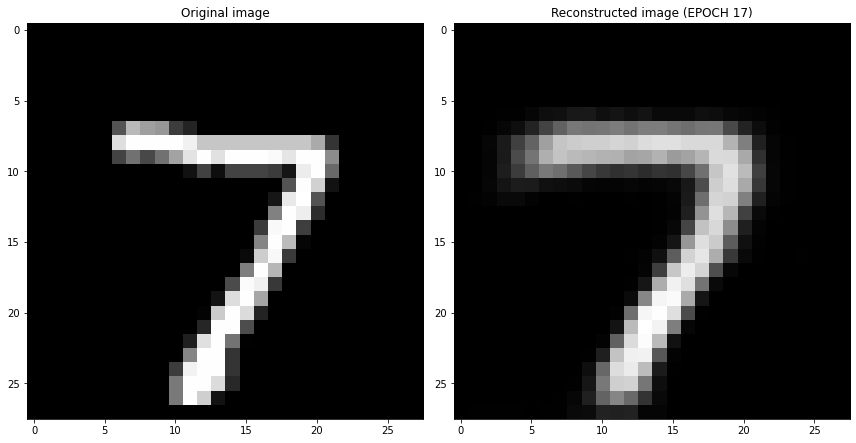

EPOCH 18/30
	 partial train loss (single batch): 0.028619
	 partial train loss (single batch): 0.030085
	 partial train loss (single batch): 0.028681
	 partial train loss (single batch): 0.030846
	 partial train loss (single batch): 0.030812
	 partial train loss (single batch): 0.030792
	 partial train loss (single batch): 0.028250
	 partial train loss (single batch): 0.027250
	 partial train loss (single batch): 0.031895
	 partial train loss (single batch): 0.029852
	 partial train loss (single batch): 0.031002
	 partial train loss (single batch): 0.030882
	 partial train loss (single batch): 0.029880
	 partial train loss (single batch): 0.030217
	 partial train loss (single batch): 0.030793
	 partial train loss (single batch): 0.030668
	 partial train loss (single batch): 0.031333
	 partial train loss (single batch): 0.031069
	 partial train loss (single batch): 0.030502
	 partial train loss (single batch): 0.027859
	 partial train loss (single batch): 0.029815
	 partial train loss (

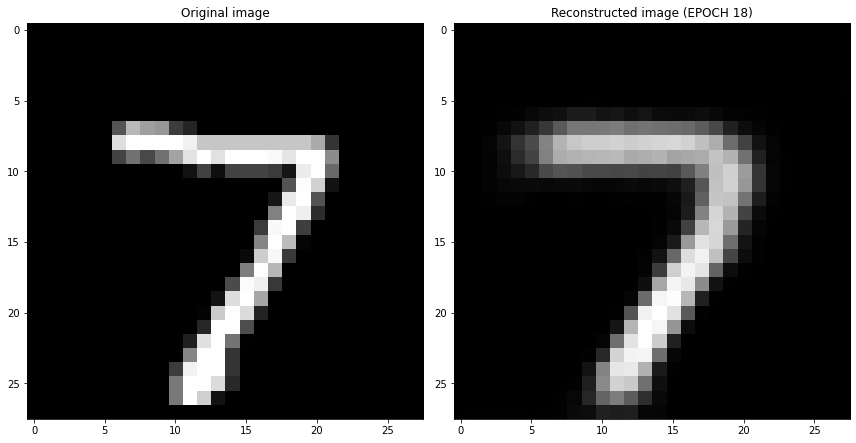

EPOCH 19/30
	 partial train loss (single batch): 0.029883
	 partial train loss (single batch): 0.028376
	 partial train loss (single batch): 0.031528
	 partial train loss (single batch): 0.030739
	 partial train loss (single batch): 0.029319
	 partial train loss (single batch): 0.029583
	 partial train loss (single batch): 0.029698
	 partial train loss (single batch): 0.030558
	 partial train loss (single batch): 0.030856
	 partial train loss (single batch): 0.032128
	 partial train loss (single batch): 0.028901
	 partial train loss (single batch): 0.027759
	 partial train loss (single batch): 0.029316
	 partial train loss (single batch): 0.030395
	 partial train loss (single batch): 0.029926
	 partial train loss (single batch): 0.030216
	 partial train loss (single batch): 0.029718
	 partial train loss (single batch): 0.028977
	 partial train loss (single batch): 0.029414
	 partial train loss (single batch): 0.030899
	 partial train loss (single batch): 0.029547
	 partial train loss (

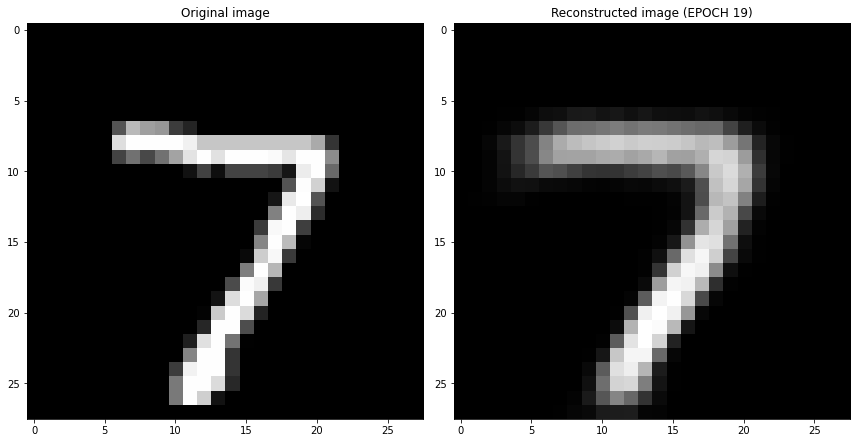

EPOCH 20/30
	 partial train loss (single batch): 0.031778
	 partial train loss (single batch): 0.029120
	 partial train loss (single batch): 0.028645
	 partial train loss (single batch): 0.029395
	 partial train loss (single batch): 0.030698
	 partial train loss (single batch): 0.028605
	 partial train loss (single batch): 0.029531
	 partial train loss (single batch): 0.028473
	 partial train loss (single batch): 0.028804
	 partial train loss (single batch): 0.029499
	 partial train loss (single batch): 0.029326
	 partial train loss (single batch): 0.030214
	 partial train loss (single batch): 0.028158
	 partial train loss (single batch): 0.029437
	 partial train loss (single batch): 0.031043
	 partial train loss (single batch): 0.031072
	 partial train loss (single batch): 0.031134
	 partial train loss (single batch): 0.029441
	 partial train loss (single batch): 0.029723
	 partial train loss (single batch): 0.029439
	 partial train loss (single batch): 0.030820
	 partial train loss (

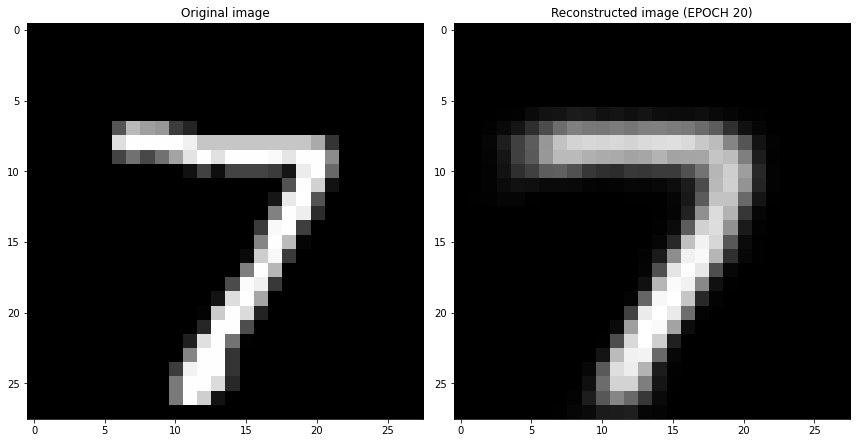

EPOCH 21/30
	 partial train loss (single batch): 0.029305
	 partial train loss (single batch): 0.030009
	 partial train loss (single batch): 0.031656
	 partial train loss (single batch): 0.030458
	 partial train loss (single batch): 0.029312
	 partial train loss (single batch): 0.028318
	 partial train loss (single batch): 0.029513
	 partial train loss (single batch): 0.030253
	 partial train loss (single batch): 0.029285
	 partial train loss (single batch): 0.029569
	 partial train loss (single batch): 0.029690
	 partial train loss (single batch): 0.030746
	 partial train loss (single batch): 0.028504
	 partial train loss (single batch): 0.028058
	 partial train loss (single batch): 0.029782
	 partial train loss (single batch): 0.030922
	 partial train loss (single batch): 0.029184
	 partial train loss (single batch): 0.030234
	 partial train loss (single batch): 0.029359
	 partial train loss (single batch): 0.030419
	 partial train loss (single batch): 0.028806
	 partial train loss (

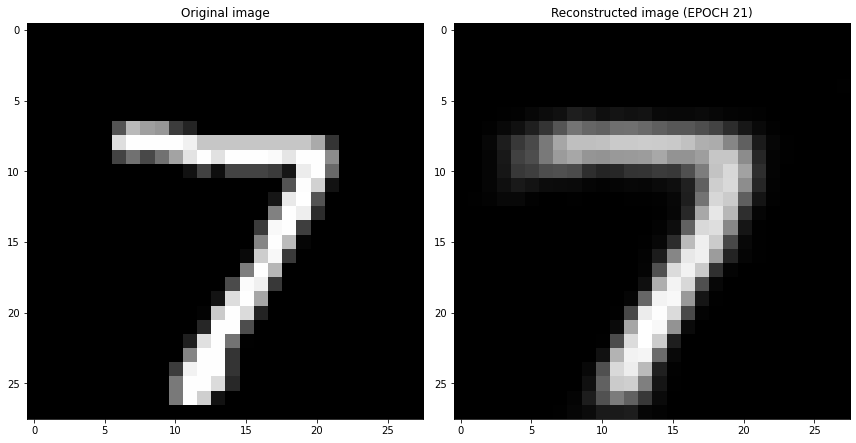

EPOCH 22/30
	 partial train loss (single batch): 0.029417
	 partial train loss (single batch): 0.030039
	 partial train loss (single batch): 0.028852
	 partial train loss (single batch): 0.029400
	 partial train loss (single batch): 0.029993
	 partial train loss (single batch): 0.029835
	 partial train loss (single batch): 0.029553
	 partial train loss (single batch): 0.030451
	 partial train loss (single batch): 0.030800
	 partial train loss (single batch): 0.030029
	 partial train loss (single batch): 0.030203
	 partial train loss (single batch): 0.028805
	 partial train loss (single batch): 0.029048
	 partial train loss (single batch): 0.030285
	 partial train loss (single batch): 0.029083
	 partial train loss (single batch): 0.028777
	 partial train loss (single batch): 0.030679
	 partial train loss (single batch): 0.029962
	 partial train loss (single batch): 0.027383
	 partial train loss (single batch): 0.028597
	 partial train loss (single batch): 0.028553
	 partial train loss (

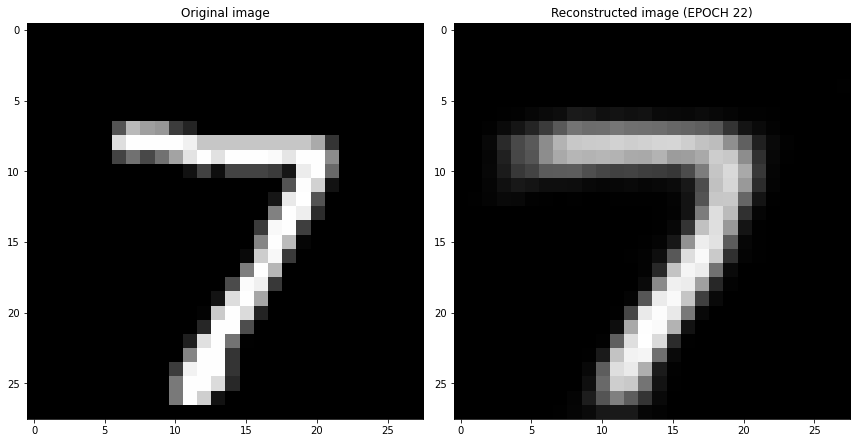

EPOCH 23/30
	 partial train loss (single batch): 0.029882
	 partial train loss (single batch): 0.029716
	 partial train loss (single batch): 0.028980
	 partial train loss (single batch): 0.028970
	 partial train loss (single batch): 0.031216
	 partial train loss (single batch): 0.029177
	 partial train loss (single batch): 0.029674
	 partial train loss (single batch): 0.028241
	 partial train loss (single batch): 0.030043
	 partial train loss (single batch): 0.029741
	 partial train loss (single batch): 0.030570
	 partial train loss (single batch): 0.029311
	 partial train loss (single batch): 0.030412
	 partial train loss (single batch): 0.028454
	 partial train loss (single batch): 0.030046
	 partial train loss (single batch): 0.029196
	 partial train loss (single batch): 0.030607
	 partial train loss (single batch): 0.029556
	 partial train loss (single batch): 0.029211
	 partial train loss (single batch): 0.029249
	 partial train loss (single batch): 0.028639
	 partial train loss (

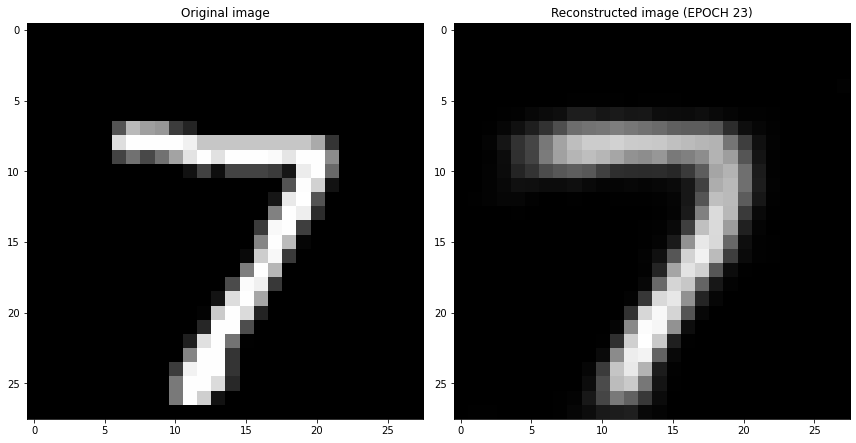

EPOCH 24/30
	 partial train loss (single batch): 0.030610
	 partial train loss (single batch): 0.028880
	 partial train loss (single batch): 0.029158
	 partial train loss (single batch): 0.029544
	 partial train loss (single batch): 0.029345
	 partial train loss (single batch): 0.029667
	 partial train loss (single batch): 0.028712
	 partial train loss (single batch): 0.028131
	 partial train loss (single batch): 0.028457
	 partial train loss (single batch): 0.029665
	 partial train loss (single batch): 0.029393
	 partial train loss (single batch): 0.027572
	 partial train loss (single batch): 0.029065
	 partial train loss (single batch): 0.028782
	 partial train loss (single batch): 0.028695
	 partial train loss (single batch): 0.029086
	 partial train loss (single batch): 0.030322
	 partial train loss (single batch): 0.028947
	 partial train loss (single batch): 0.029811
	 partial train loss (single batch): 0.028102
	 partial train loss (single batch): 0.029322
	 partial train loss (

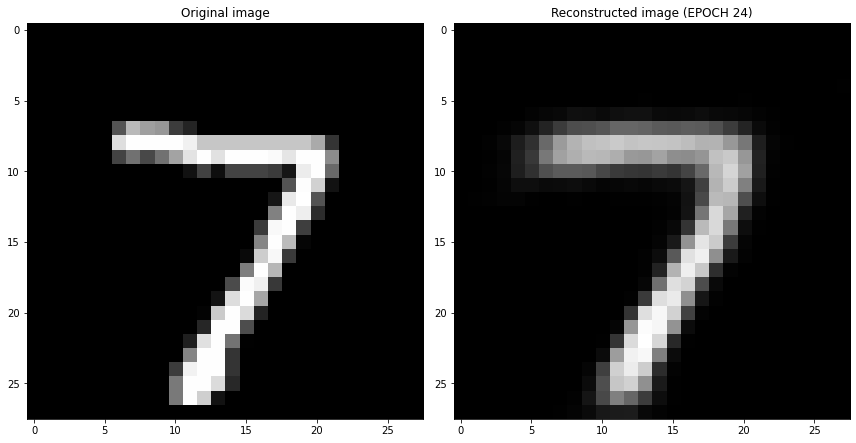

EPOCH 25/30
	 partial train loss (single batch): 0.028569
	 partial train loss (single batch): 0.027723
	 partial train loss (single batch): 0.028379
	 partial train loss (single batch): 0.029103
	 partial train loss (single batch): 0.028702
	 partial train loss (single batch): 0.028155
	 partial train loss (single batch): 0.028116
	 partial train loss (single batch): 0.029436
	 partial train loss (single batch): 0.029295
	 partial train loss (single batch): 0.027332
	 partial train loss (single batch): 0.028812
	 partial train loss (single batch): 0.029177
	 partial train loss (single batch): 0.028768
	 partial train loss (single batch): 0.027789
	 partial train loss (single batch): 0.029855
	 partial train loss (single batch): 0.029613
	 partial train loss (single batch): 0.028511
	 partial train loss (single batch): 0.028284
	 partial train loss (single batch): 0.028189
	 partial train loss (single batch): 0.026485
	 partial train loss (single batch): 0.030049
	 partial train loss (

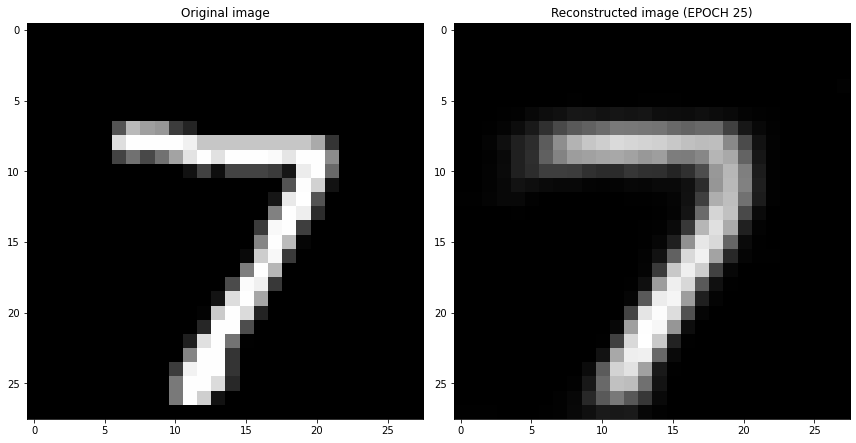

EPOCH 26/30
	 partial train loss (single batch): 0.030080
	 partial train loss (single batch): 0.028533
	 partial train loss (single batch): 0.029009
	 partial train loss (single batch): 0.030097
	 partial train loss (single batch): 0.028779
	 partial train loss (single batch): 0.029217
	 partial train loss (single batch): 0.029435
	 partial train loss (single batch): 0.030260
	 partial train loss (single batch): 0.030602
	 partial train loss (single batch): 0.028297
	 partial train loss (single batch): 0.030114
	 partial train loss (single batch): 0.030398
	 partial train loss (single batch): 0.027687
	 partial train loss (single batch): 0.028735
	 partial train loss (single batch): 0.026685
	 partial train loss (single batch): 0.029774
	 partial train loss (single batch): 0.028613
	 partial train loss (single batch): 0.029849
	 partial train loss (single batch): 0.029251
	 partial train loss (single batch): 0.028362
	 partial train loss (single batch): 0.029123
	 partial train loss (

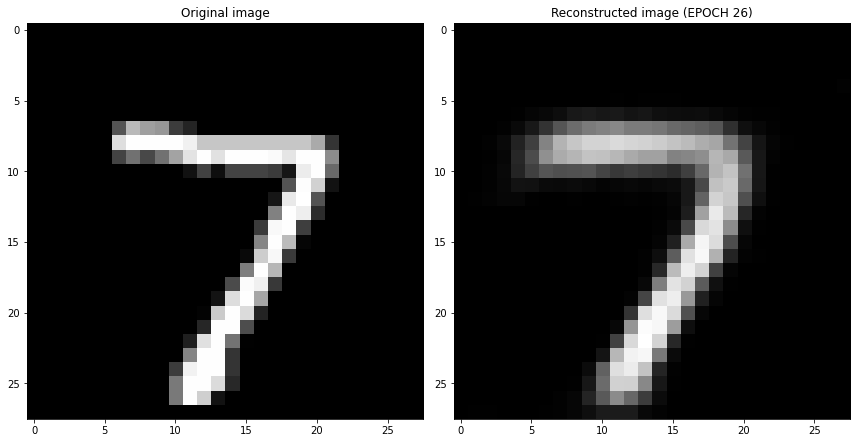

EPOCH 27/30
	 partial train loss (single batch): 0.030138
	 partial train loss (single batch): 0.029421
	 partial train loss (single batch): 0.029453
	 partial train loss (single batch): 0.028629
	 partial train loss (single batch): 0.028776
	 partial train loss (single batch): 0.027918
	 partial train loss (single batch): 0.028908
	 partial train loss (single batch): 0.029920
	 partial train loss (single batch): 0.028753
	 partial train loss (single batch): 0.027248
	 partial train loss (single batch): 0.029293
	 partial train loss (single batch): 0.027461
	 partial train loss (single batch): 0.028134
	 partial train loss (single batch): 0.028154
	 partial train loss (single batch): 0.029953
	 partial train loss (single batch): 0.027349
	 partial train loss (single batch): 0.028991
	 partial train loss (single batch): 0.029490
	 partial train loss (single batch): 0.029846
	 partial train loss (single batch): 0.029813
	 partial train loss (single batch): 0.028172
	 partial train loss (

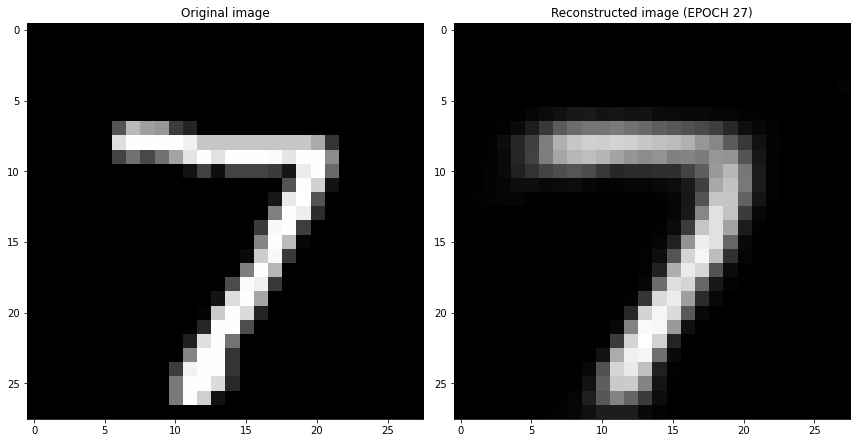

EPOCH 28/30
	 partial train loss (single batch): 0.029054
	 partial train loss (single batch): 0.028895
	 partial train loss (single batch): 0.029284
	 partial train loss (single batch): 0.028820
	 partial train loss (single batch): 0.029688
	 partial train loss (single batch): 0.028292
	 partial train loss (single batch): 0.029267
	 partial train loss (single batch): 0.029067
	 partial train loss (single batch): 0.028474
	 partial train loss (single batch): 0.028615
	 partial train loss (single batch): 0.030073
	 partial train loss (single batch): 0.028312
	 partial train loss (single batch): 0.029489
	 partial train loss (single batch): 0.029312
	 partial train loss (single batch): 0.029144
	 partial train loss (single batch): 0.027281
	 partial train loss (single batch): 0.029221
	 partial train loss (single batch): 0.028557
	 partial train loss (single batch): 0.028336
	 partial train loss (single batch): 0.027826
	 partial train loss (single batch): 0.029201
	 partial train loss (

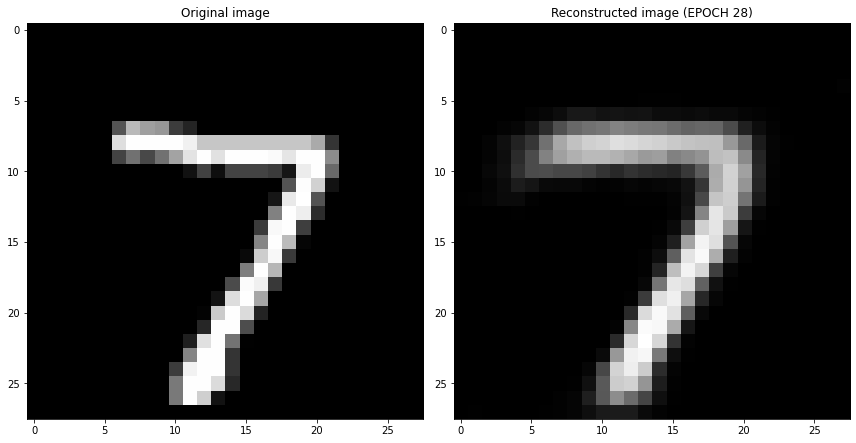

EPOCH 29/30
	 partial train loss (single batch): 0.029117
	 partial train loss (single batch): 0.028629
	 partial train loss (single batch): 0.029510
	 partial train loss (single batch): 0.027943
	 partial train loss (single batch): 0.029944
	 partial train loss (single batch): 0.028862
	 partial train loss (single batch): 0.026913
	 partial train loss (single batch): 0.029058
	 partial train loss (single batch): 0.029806
	 partial train loss (single batch): 0.030510
	 partial train loss (single batch): 0.027970
	 partial train loss (single batch): 0.027896
	 partial train loss (single batch): 0.026936
	 partial train loss (single batch): 0.028736
	 partial train loss (single batch): 0.028882
	 partial train loss (single batch): 0.028221
	 partial train loss (single batch): 0.029763
	 partial train loss (single batch): 0.028828
	 partial train loss (single batch): 0.030883
	 partial train loss (single batch): 0.027076
	 partial train loss (single batch): 0.028409
	 partial train loss (

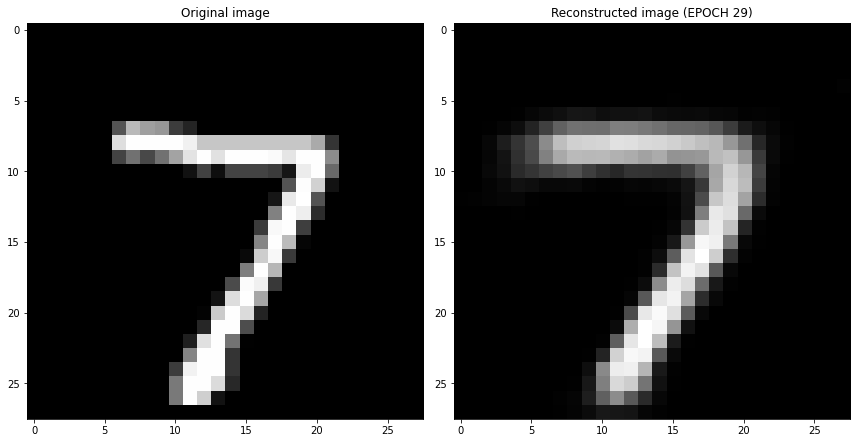

EPOCH 30/30
	 partial train loss (single batch): 0.028285
	 partial train loss (single batch): 0.028053
	 partial train loss (single batch): 0.028428
	 partial train loss (single batch): 0.028574
	 partial train loss (single batch): 0.027092
	 partial train loss (single batch): 0.026446
	 partial train loss (single batch): 0.028748
	 partial train loss (single batch): 0.028845
	 partial train loss (single batch): 0.029517
	 partial train loss (single batch): 0.029920
	 partial train loss (single batch): 0.027985
	 partial train loss (single batch): 0.030557
	 partial train loss (single batch): 0.026617
	 partial train loss (single batch): 0.027632
	 partial train loss (single batch): 0.030754
	 partial train loss (single batch): 0.027833
	 partial train loss (single batch): 0.029007
	 partial train loss (single batch): 0.027063
	 partial train loss (single batch): 0.029650
	 partial train loss (single batch): 0.027594
	 partial train loss (single batch): 0.028990
	 partial train loss (

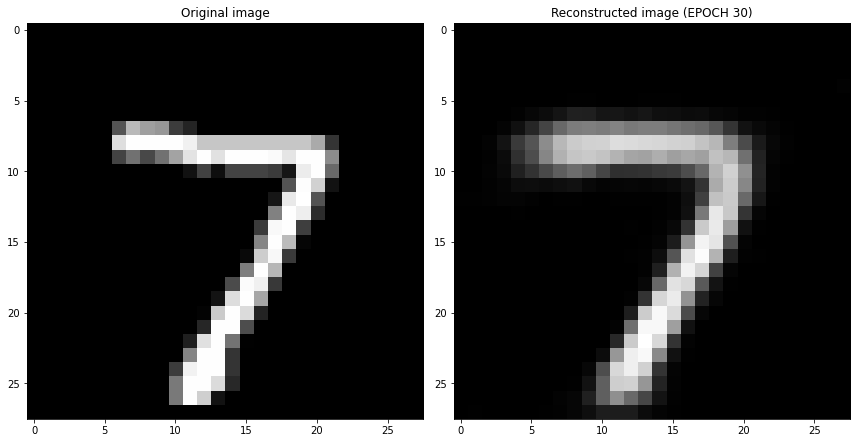

Cross validation fold number= 3/6
EPOCH 1/30
	 partial train loss (single batch): 0.186069
	 partial train loss (single batch): 0.185395
	 partial train loss (single batch): 0.185156
	 partial train loss (single batch): 0.184878
	 partial train loss (single batch): 0.184677
	 partial train loss (single batch): 0.184727
	 partial train loss (single batch): 0.183690
	 partial train loss (single batch): 0.183943
	 partial train loss (single batch): 0.182654
	 partial train loss (single batch): 0.183094
	 partial train loss (single batch): 0.182110
	 partial train loss (single batch): 0.182440
	 partial train loss (single batch): 0.182159
	 partial train loss (single batch): 0.181750
	 partial train loss (single batch): 0.181192
	 partial train loss (single batch): 0.180992
	 partial train loss (single batch): 0.180837
	 partial train loss (single batch): 0.179887
	 partial train loss (single batch): 0.180144
	 partial train loss (single batch): 0.179363
	 partial train loss (single batch)

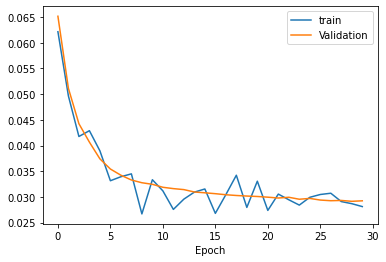

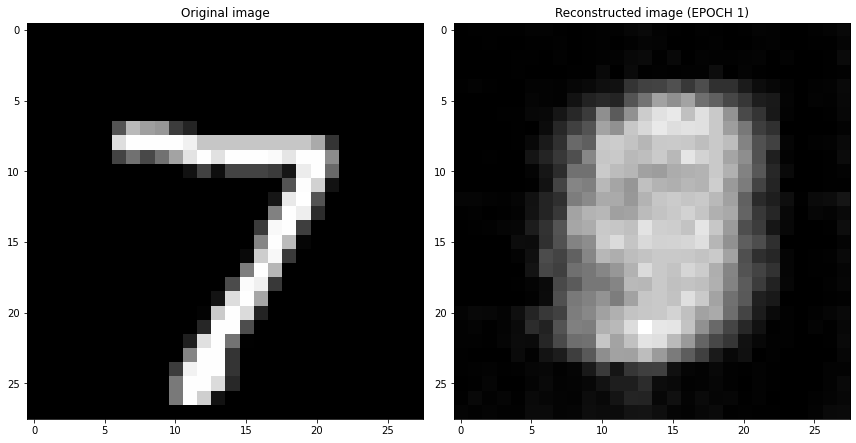

EPOCH 2/30
	 partial train loss (single batch): 0.069400
	 partial train loss (single batch): 0.066447
	 partial train loss (single batch): 0.068808
	 partial train loss (single batch): 0.066728
	 partial train loss (single batch): 0.065623
	 partial train loss (single batch): 0.068955
	 partial train loss (single batch): 0.066234
	 partial train loss (single batch): 0.065776
	 partial train loss (single batch): 0.066522
	 partial train loss (single batch): 0.066537
	 partial train loss (single batch): 0.066465
	 partial train loss (single batch): 0.067075
	 partial train loss (single batch): 0.067286
	 partial train loss (single batch): 0.067004
	 partial train loss (single batch): 0.066010
	 partial train loss (single batch): 0.065996
	 partial train loss (single batch): 0.068649
	 partial train loss (single batch): 0.066033
	 partial train loss (single batch): 0.066350
	 partial train loss (single batch): 0.066013
	 partial train loss (single batch): 0.067443
	 partial train loss (s

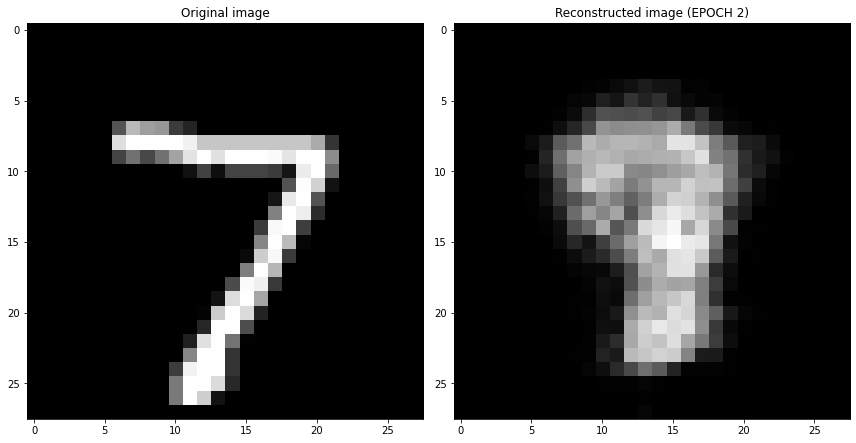

EPOCH 3/30
	 partial train loss (single batch): 0.057410
	 partial train loss (single batch): 0.057646
	 partial train loss (single batch): 0.055611
	 partial train loss (single batch): 0.056575
	 partial train loss (single batch): 0.055295
	 partial train loss (single batch): 0.053067
	 partial train loss (single batch): 0.054189
	 partial train loss (single batch): 0.054830
	 partial train loss (single batch): 0.056243
	 partial train loss (single batch): 0.053838
	 partial train loss (single batch): 0.055636
	 partial train loss (single batch): 0.055002
	 partial train loss (single batch): 0.054806
	 partial train loss (single batch): 0.054936
	 partial train loss (single batch): 0.055999
	 partial train loss (single batch): 0.054446
	 partial train loss (single batch): 0.054597
	 partial train loss (single batch): 0.052945
	 partial train loss (single batch): 0.054051
	 partial train loss (single batch): 0.053340
	 partial train loss (single batch): 0.052741
	 partial train loss (s

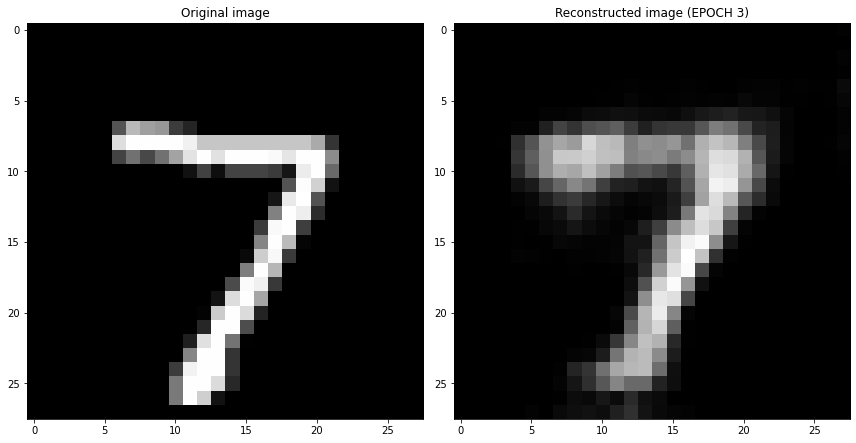

EPOCH 4/30
	 partial train loss (single batch): 0.042898
	 partial train loss (single batch): 0.041461
	 partial train loss (single batch): 0.044031
	 partial train loss (single batch): 0.042281
	 partial train loss (single batch): 0.041480
	 partial train loss (single batch): 0.042542
	 partial train loss (single batch): 0.043922
	 partial train loss (single batch): 0.044664
	 partial train loss (single batch): 0.041532
	 partial train loss (single batch): 0.043450
	 partial train loss (single batch): 0.041901
	 partial train loss (single batch): 0.043431
	 partial train loss (single batch): 0.043205
	 partial train loss (single batch): 0.042004
	 partial train loss (single batch): 0.044352
	 partial train loss (single batch): 0.043713
	 partial train loss (single batch): 0.042808
	 partial train loss (single batch): 0.043274
	 partial train loss (single batch): 0.042467
	 partial train loss (single batch): 0.044177
	 partial train loss (single batch): 0.041647
	 partial train loss (s

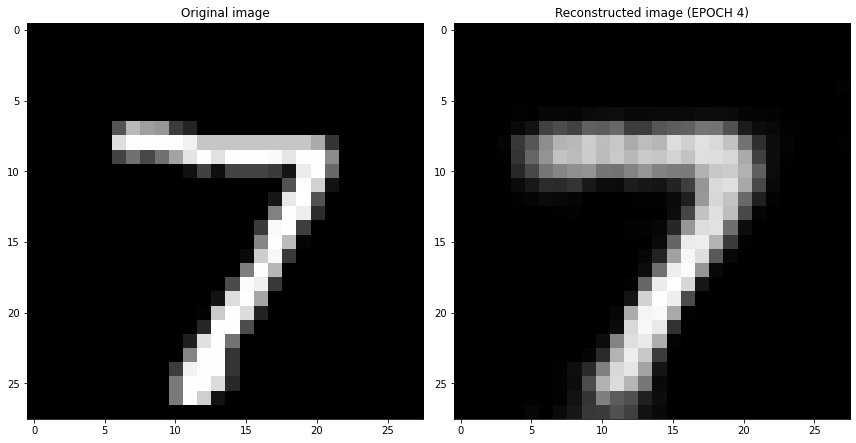

EPOCH 5/30
	 partial train loss (single batch): 0.040126
	 partial train loss (single batch): 0.036526
	 partial train loss (single batch): 0.038110
	 partial train loss (single batch): 0.039195
	 partial train loss (single batch): 0.038454
	 partial train loss (single batch): 0.037438
	 partial train loss (single batch): 0.037932
	 partial train loss (single batch): 0.035800
	 partial train loss (single batch): 0.037032
	 partial train loss (single batch): 0.039986
	 partial train loss (single batch): 0.039578
	 partial train loss (single batch): 0.039444
	 partial train loss (single batch): 0.037086
	 partial train loss (single batch): 0.039586
	 partial train loss (single batch): 0.037695
	 partial train loss (single batch): 0.038835
	 partial train loss (single batch): 0.038278
	 partial train loss (single batch): 0.039775
	 partial train loss (single batch): 0.037067
	 partial train loss (single batch): 0.037312
	 partial train loss (single batch): 0.039732
	 partial train loss (s

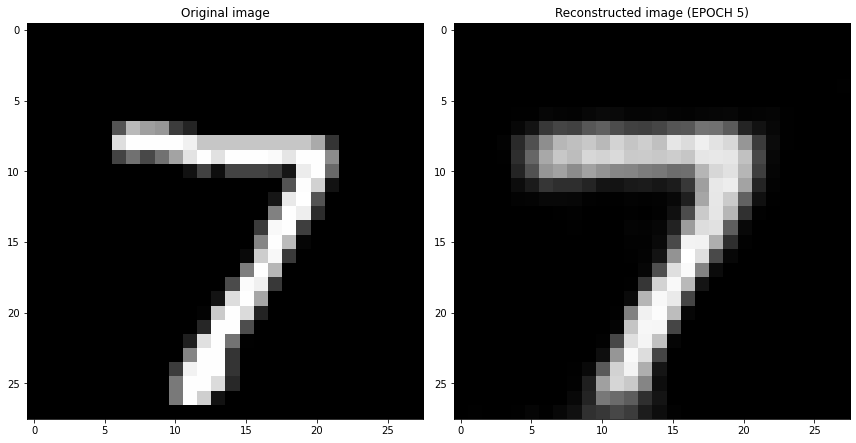

EPOCH 6/30
	 partial train loss (single batch): 0.034925
	 partial train loss (single batch): 0.034236
	 partial train loss (single batch): 0.036030
	 partial train loss (single batch): 0.034955
	 partial train loss (single batch): 0.036029
	 partial train loss (single batch): 0.035131
	 partial train loss (single batch): 0.036335
	 partial train loss (single batch): 0.035099
	 partial train loss (single batch): 0.035016
	 partial train loss (single batch): 0.034192
	 partial train loss (single batch): 0.036053
	 partial train loss (single batch): 0.036356
	 partial train loss (single batch): 0.034489
	 partial train loss (single batch): 0.036962
	 partial train loss (single batch): 0.036880
	 partial train loss (single batch): 0.036631
	 partial train loss (single batch): 0.036885
	 partial train loss (single batch): 0.036736
	 partial train loss (single batch): 0.035811
	 partial train loss (single batch): 0.035851
	 partial train loss (single batch): 0.033664
	 partial train loss (s

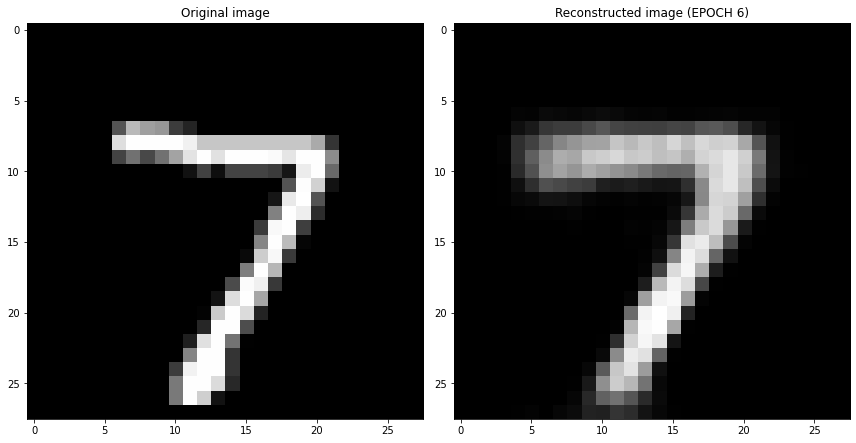

EPOCH 7/30
	 partial train loss (single batch): 0.033786
	 partial train loss (single batch): 0.037160
	 partial train loss (single batch): 0.035401
	 partial train loss (single batch): 0.034883
	 partial train loss (single batch): 0.033868
	 partial train loss (single batch): 0.036087
	 partial train loss (single batch): 0.034500
	 partial train loss (single batch): 0.034634
	 partial train loss (single batch): 0.031879
	 partial train loss (single batch): 0.033928
	 partial train loss (single batch): 0.036446
	 partial train loss (single batch): 0.034903
	 partial train loss (single batch): 0.035334
	 partial train loss (single batch): 0.033487
	 partial train loss (single batch): 0.034043
	 partial train loss (single batch): 0.035731
	 partial train loss (single batch): 0.033335
	 partial train loss (single batch): 0.033656
	 partial train loss (single batch): 0.034152
	 partial train loss (single batch): 0.033864
	 partial train loss (single batch): 0.036310
	 partial train loss (s

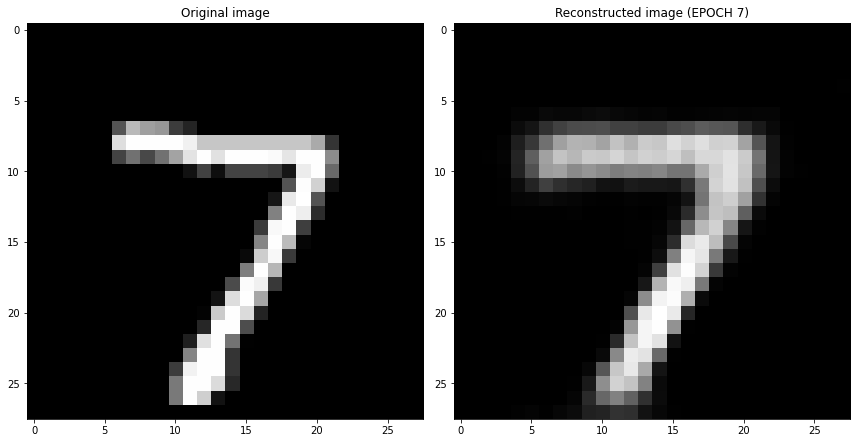

EPOCH 8/30
	 partial train loss (single batch): 0.033340
	 partial train loss (single batch): 0.033266
	 partial train loss (single batch): 0.033262
	 partial train loss (single batch): 0.032896
	 partial train loss (single batch): 0.033387
	 partial train loss (single batch): 0.033480
	 partial train loss (single batch): 0.033436
	 partial train loss (single batch): 0.035369
	 partial train loss (single batch): 0.033371
	 partial train loss (single batch): 0.033568
	 partial train loss (single batch): 0.033087
	 partial train loss (single batch): 0.033474
	 partial train loss (single batch): 0.033443
	 partial train loss (single batch): 0.032522
	 partial train loss (single batch): 0.033612
	 partial train loss (single batch): 0.032280
	 partial train loss (single batch): 0.033132
	 partial train loss (single batch): 0.031926
	 partial train loss (single batch): 0.031004
	 partial train loss (single batch): 0.034235
	 partial train loss (single batch): 0.034356
	 partial train loss (s

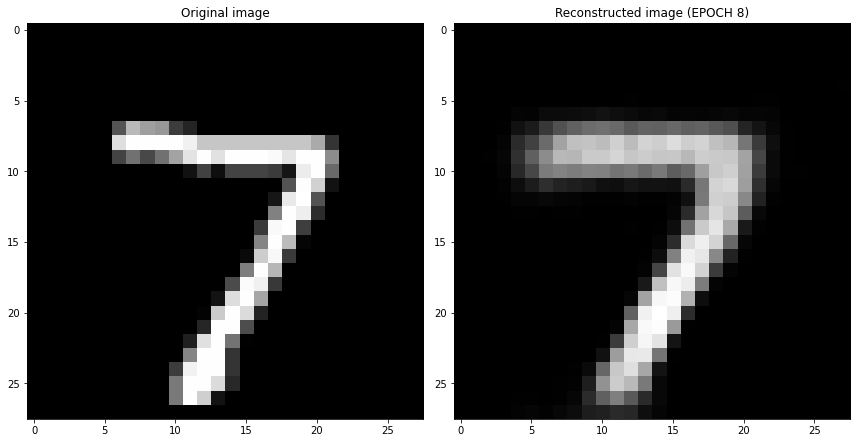

EPOCH 9/30
	 partial train loss (single batch): 0.032099
	 partial train loss (single batch): 0.031904
	 partial train loss (single batch): 0.031742
	 partial train loss (single batch): 0.033578
	 partial train loss (single batch): 0.030813
	 partial train loss (single batch): 0.033717
	 partial train loss (single batch): 0.030343
	 partial train loss (single batch): 0.032680
	 partial train loss (single batch): 0.034051
	 partial train loss (single batch): 0.033912
	 partial train loss (single batch): 0.033923
	 partial train loss (single batch): 0.032280
	 partial train loss (single batch): 0.032700
	 partial train loss (single batch): 0.033933
	 partial train loss (single batch): 0.032754
	 partial train loss (single batch): 0.033812
	 partial train loss (single batch): 0.031809
	 partial train loss (single batch): 0.032710
	 partial train loss (single batch): 0.032512
	 partial train loss (single batch): 0.034281
	 partial train loss (single batch): 0.032287
	 partial train loss (s

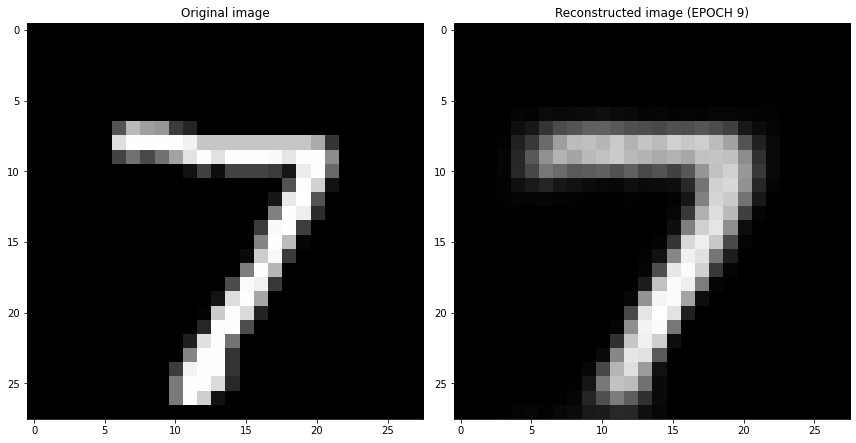

EPOCH 10/30
	 partial train loss (single batch): 0.032502
	 partial train loss (single batch): 0.031136
	 partial train loss (single batch): 0.032776
	 partial train loss (single batch): 0.033104
	 partial train loss (single batch): 0.032261
	 partial train loss (single batch): 0.032707
	 partial train loss (single batch): 0.032101
	 partial train loss (single batch): 0.032595
	 partial train loss (single batch): 0.032773
	 partial train loss (single batch): 0.032477
	 partial train loss (single batch): 0.031970
	 partial train loss (single batch): 0.032860
	 partial train loss (single batch): 0.032294
	 partial train loss (single batch): 0.033331
	 partial train loss (single batch): 0.033427
	 partial train loss (single batch): 0.030401
	 partial train loss (single batch): 0.031652
	 partial train loss (single batch): 0.034481
	 partial train loss (single batch): 0.032403
	 partial train loss (single batch): 0.033140
	 partial train loss (single batch): 0.033141
	 partial train loss (

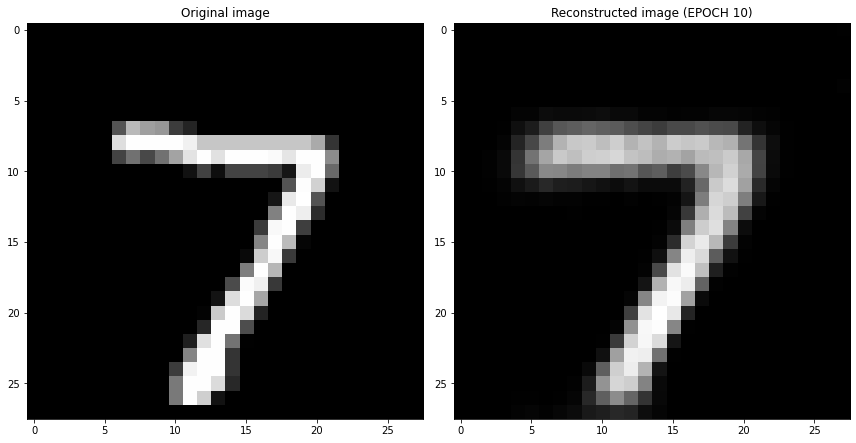

EPOCH 11/30
	 partial train loss (single batch): 0.029826
	 partial train loss (single batch): 0.031194
	 partial train loss (single batch): 0.032203
	 partial train loss (single batch): 0.032260
	 partial train loss (single batch): 0.033780
	 partial train loss (single batch): 0.031151
	 partial train loss (single batch): 0.033315
	 partial train loss (single batch): 0.031039
	 partial train loss (single batch): 0.033184
	 partial train loss (single batch): 0.031984
	 partial train loss (single batch): 0.031000
	 partial train loss (single batch): 0.033539
	 partial train loss (single batch): 0.030943
	 partial train loss (single batch): 0.032088
	 partial train loss (single batch): 0.031645
	 partial train loss (single batch): 0.031477
	 partial train loss (single batch): 0.033550
	 partial train loss (single batch): 0.032365
	 partial train loss (single batch): 0.031970
	 partial train loss (single batch): 0.032667
	 partial train loss (single batch): 0.031183
	 partial train loss (

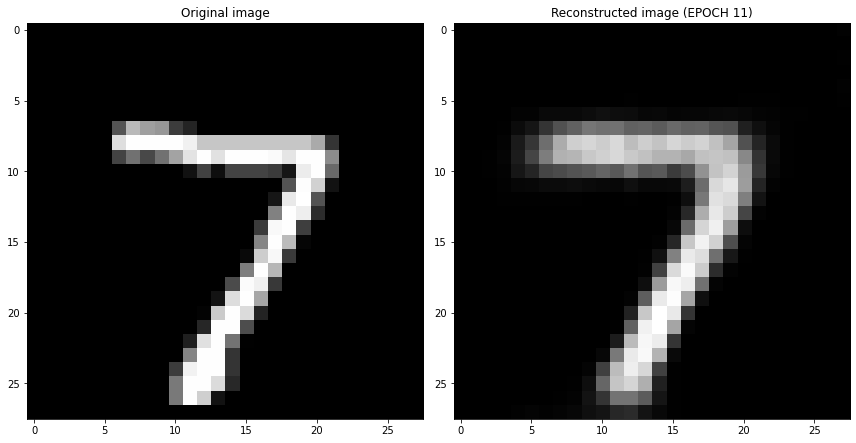

EPOCH 12/30
	 partial train loss (single batch): 0.030481
	 partial train loss (single batch): 0.032307
	 partial train loss (single batch): 0.032256
	 partial train loss (single batch): 0.031497
	 partial train loss (single batch): 0.031178
	 partial train loss (single batch): 0.031782
	 partial train loss (single batch): 0.032413
	 partial train loss (single batch): 0.031706
	 partial train loss (single batch): 0.032641
	 partial train loss (single batch): 0.031001
	 partial train loss (single batch): 0.031161
	 partial train loss (single batch): 0.031926
	 partial train loss (single batch): 0.030265
	 partial train loss (single batch): 0.031198
	 partial train loss (single batch): 0.032409
	 partial train loss (single batch): 0.031741
	 partial train loss (single batch): 0.031119
	 partial train loss (single batch): 0.030534
	 partial train loss (single batch): 0.030614
	 partial train loss (single batch): 0.030843
	 partial train loss (single batch): 0.032564
	 partial train loss (

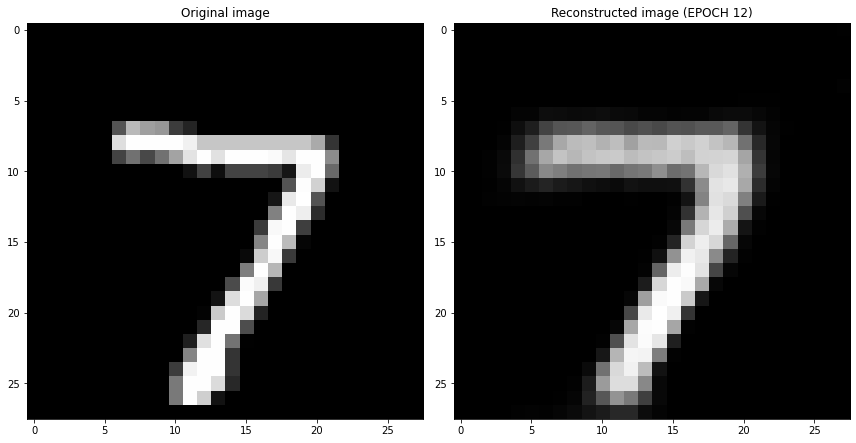

EPOCH 13/30
	 partial train loss (single batch): 0.031019
	 partial train loss (single batch): 0.032619
	 partial train loss (single batch): 0.031577
	 partial train loss (single batch): 0.030986
	 partial train loss (single batch): 0.032408
	 partial train loss (single batch): 0.030919
	 partial train loss (single batch): 0.032118
	 partial train loss (single batch): 0.031709
	 partial train loss (single batch): 0.031583
	 partial train loss (single batch): 0.029918
	 partial train loss (single batch): 0.032584
	 partial train loss (single batch): 0.030698
	 partial train loss (single batch): 0.032233
	 partial train loss (single batch): 0.029597
	 partial train loss (single batch): 0.031525
	 partial train loss (single batch): 0.031769
	 partial train loss (single batch): 0.030566
	 partial train loss (single batch): 0.029869
	 partial train loss (single batch): 0.031623
	 partial train loss (single batch): 0.030464
	 partial train loss (single batch): 0.031326
	 partial train loss (

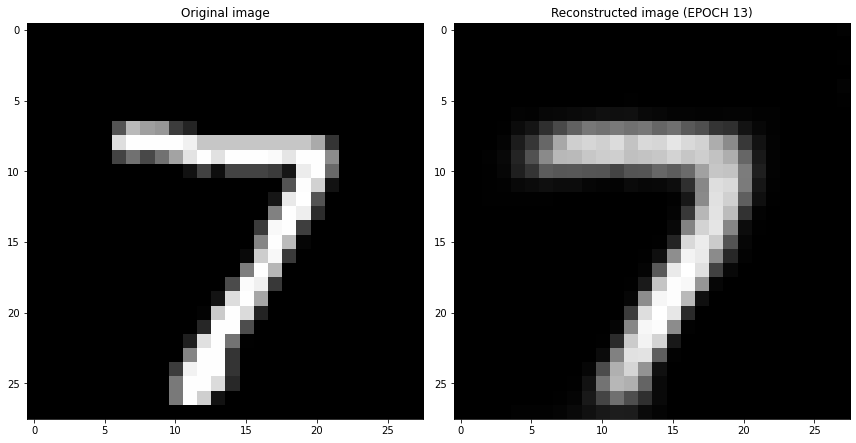

EPOCH 14/30
	 partial train loss (single batch): 0.029394
	 partial train loss (single batch): 0.032451
	 partial train loss (single batch): 0.031814
	 partial train loss (single batch): 0.030988
	 partial train loss (single batch): 0.031748
	 partial train loss (single batch): 0.031144
	 partial train loss (single batch): 0.030786
	 partial train loss (single batch): 0.031508
	 partial train loss (single batch): 0.030895
	 partial train loss (single batch): 0.030114
	 partial train loss (single batch): 0.031506
	 partial train loss (single batch): 0.030588
	 partial train loss (single batch): 0.031672
	 partial train loss (single batch): 0.030571
	 partial train loss (single batch): 0.033043
	 partial train loss (single batch): 0.029598
	 partial train loss (single batch): 0.032856
	 partial train loss (single batch): 0.030162
	 partial train loss (single batch): 0.031880
	 partial train loss (single batch): 0.031346
	 partial train loss (single batch): 0.030956
	 partial train loss (

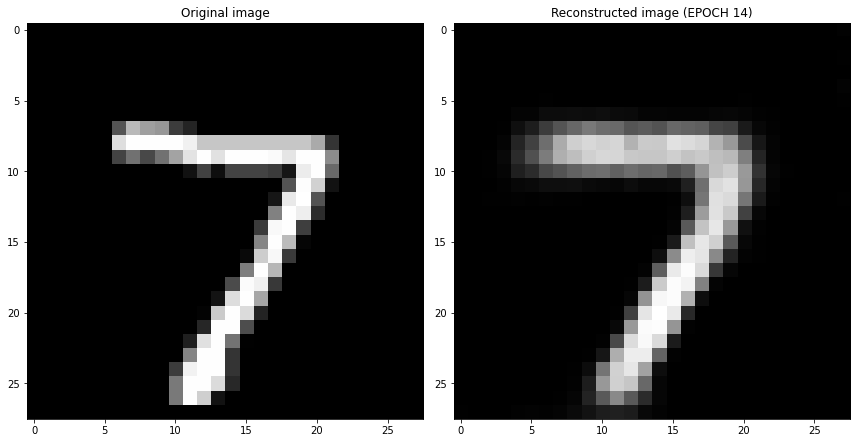

EPOCH 15/30
	 partial train loss (single batch): 0.030377
	 partial train loss (single batch): 0.031463
	 partial train loss (single batch): 0.031977
	 partial train loss (single batch): 0.030993
	 partial train loss (single batch): 0.029805
	 partial train loss (single batch): 0.032527
	 partial train loss (single batch): 0.030692
	 partial train loss (single batch): 0.030351
	 partial train loss (single batch): 0.029357
	 partial train loss (single batch): 0.032064
	 partial train loss (single batch): 0.030766
	 partial train loss (single batch): 0.030103
	 partial train loss (single batch): 0.029495
	 partial train loss (single batch): 0.031057
	 partial train loss (single batch): 0.030969
	 partial train loss (single batch): 0.030767
	 partial train loss (single batch): 0.030872
	 partial train loss (single batch): 0.028963
	 partial train loss (single batch): 0.029498
	 partial train loss (single batch): 0.030026
	 partial train loss (single batch): 0.030590
	 partial train loss (

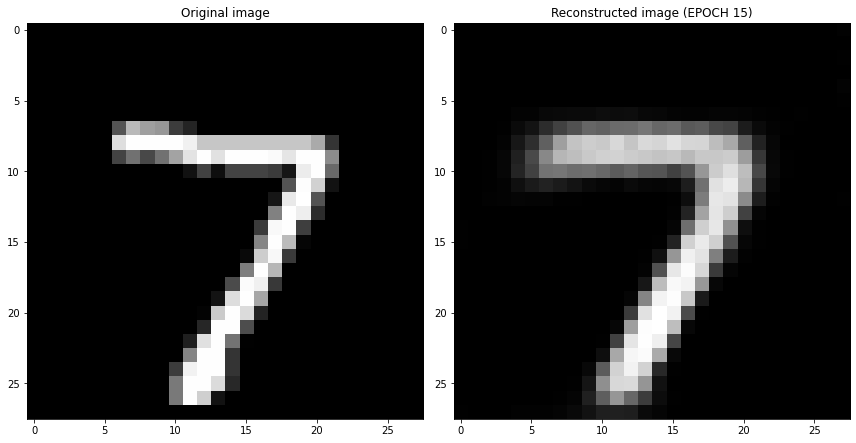

EPOCH 16/30
	 partial train loss (single batch): 0.030478
	 partial train loss (single batch): 0.031530
	 partial train loss (single batch): 0.029043
	 partial train loss (single batch): 0.030032
	 partial train loss (single batch): 0.031524
	 partial train loss (single batch): 0.031260
	 partial train loss (single batch): 0.030590
	 partial train loss (single batch): 0.030471
	 partial train loss (single batch): 0.030256
	 partial train loss (single batch): 0.030426
	 partial train loss (single batch): 0.030943
	 partial train loss (single batch): 0.029018
	 partial train loss (single batch): 0.030192
	 partial train loss (single batch): 0.029797
	 partial train loss (single batch): 0.030055
	 partial train loss (single batch): 0.031594
	 partial train loss (single batch): 0.030097
	 partial train loss (single batch): 0.031286
	 partial train loss (single batch): 0.030385
	 partial train loss (single batch): 0.031284
	 partial train loss (single batch): 0.031692
	 partial train loss (

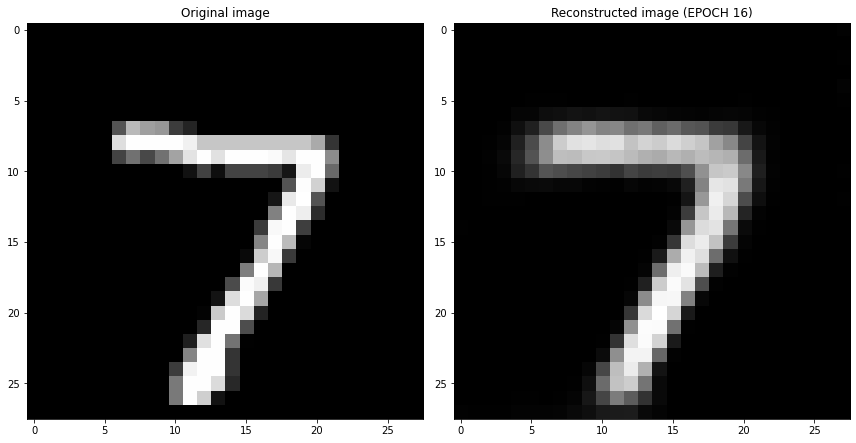

EPOCH 17/30
	 partial train loss (single batch): 0.028670
	 partial train loss (single batch): 0.030109
	 partial train loss (single batch): 0.028607
	 partial train loss (single batch): 0.030335
	 partial train loss (single batch): 0.030479
	 partial train loss (single batch): 0.031001
	 partial train loss (single batch): 0.030616
	 partial train loss (single batch): 0.030469
	 partial train loss (single batch): 0.031336
	 partial train loss (single batch): 0.030249
	 partial train loss (single batch): 0.029733
	 partial train loss (single batch): 0.031047
	 partial train loss (single batch): 0.030938
	 partial train loss (single batch): 0.029055
	 partial train loss (single batch): 0.031081
	 partial train loss (single batch): 0.031254
	 partial train loss (single batch): 0.029522
	 partial train loss (single batch): 0.030772
	 partial train loss (single batch): 0.029555
	 partial train loss (single batch): 0.031886
	 partial train loss (single batch): 0.031439
	 partial train loss (

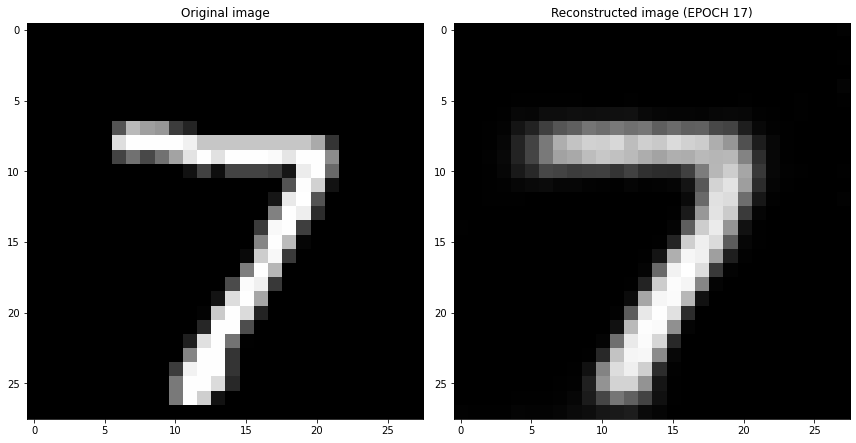

EPOCH 18/30
	 partial train loss (single batch): 0.032353
	 partial train loss (single batch): 0.029114
	 partial train loss (single batch): 0.029858
	 partial train loss (single batch): 0.029563
	 partial train loss (single batch): 0.028962
	 partial train loss (single batch): 0.029248
	 partial train loss (single batch): 0.030491
	 partial train loss (single batch): 0.031186
	 partial train loss (single batch): 0.029990
	 partial train loss (single batch): 0.028865
	 partial train loss (single batch): 0.030860
	 partial train loss (single batch): 0.029878
	 partial train loss (single batch): 0.029708
	 partial train loss (single batch): 0.030539
	 partial train loss (single batch): 0.030406
	 partial train loss (single batch): 0.029673
	 partial train loss (single batch): 0.030616
	 partial train loss (single batch): 0.031847
	 partial train loss (single batch): 0.029462
	 partial train loss (single batch): 0.031489
	 partial train loss (single batch): 0.029836
	 partial train loss (

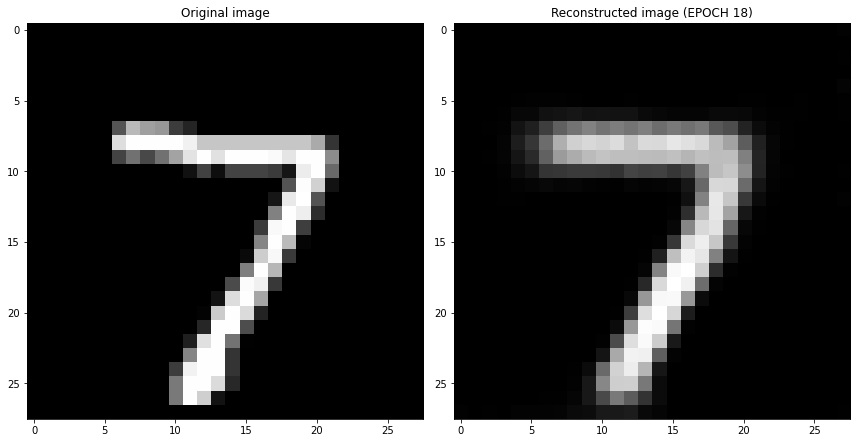

EPOCH 19/30
	 partial train loss (single batch): 0.029343
	 partial train loss (single batch): 0.029826
	 partial train loss (single batch): 0.030596
	 partial train loss (single batch): 0.030378
	 partial train loss (single batch): 0.030199
	 partial train loss (single batch): 0.031215
	 partial train loss (single batch): 0.030395
	 partial train loss (single batch): 0.030144
	 partial train loss (single batch): 0.031402
	 partial train loss (single batch): 0.030404
	 partial train loss (single batch): 0.030235
	 partial train loss (single batch): 0.030125
	 partial train loss (single batch): 0.028590
	 partial train loss (single batch): 0.027819
	 partial train loss (single batch): 0.030642
	 partial train loss (single batch): 0.030595
	 partial train loss (single batch): 0.028820
	 partial train loss (single batch): 0.030192
	 partial train loss (single batch): 0.030911
	 partial train loss (single batch): 0.029164
	 partial train loss (single batch): 0.031542
	 partial train loss (

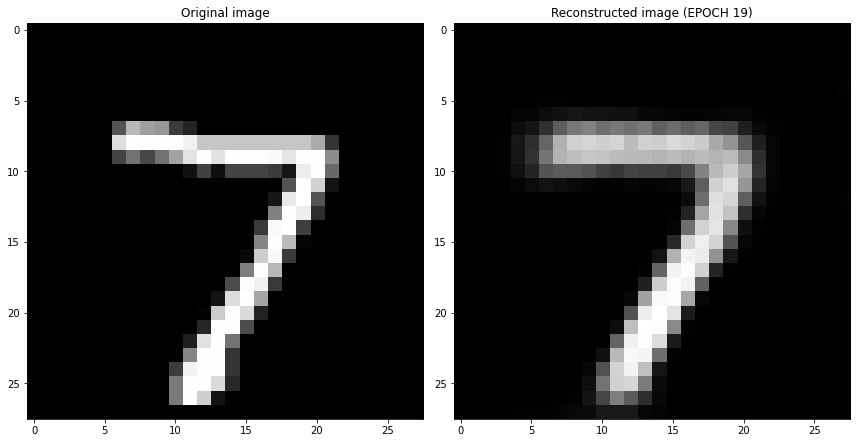

EPOCH 20/30
	 partial train loss (single batch): 0.030514
	 partial train loss (single batch): 0.030542
	 partial train loss (single batch): 0.028647
	 partial train loss (single batch): 0.030061
	 partial train loss (single batch): 0.029608
	 partial train loss (single batch): 0.027352
	 partial train loss (single batch): 0.029775
	 partial train loss (single batch): 0.030178
	 partial train loss (single batch): 0.029062
	 partial train loss (single batch): 0.029488
	 partial train loss (single batch): 0.031141
	 partial train loss (single batch): 0.030854
	 partial train loss (single batch): 0.028332
	 partial train loss (single batch): 0.031561
	 partial train loss (single batch): 0.030137
	 partial train loss (single batch): 0.030654
	 partial train loss (single batch): 0.028878
	 partial train loss (single batch): 0.030250
	 partial train loss (single batch): 0.030976
	 partial train loss (single batch): 0.029769
	 partial train loss (single batch): 0.031105
	 partial train loss (

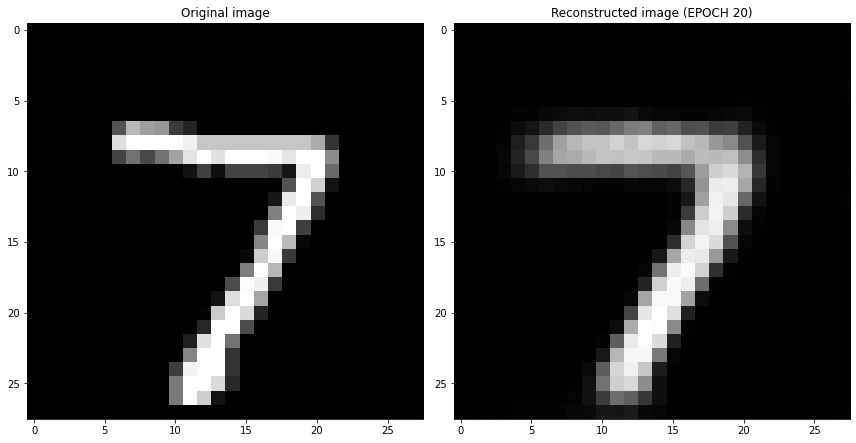

EPOCH 21/30
	 partial train loss (single batch): 0.030845
	 partial train loss (single batch): 0.030943
	 partial train loss (single batch): 0.028819
	 partial train loss (single batch): 0.030071
	 partial train loss (single batch): 0.029415
	 partial train loss (single batch): 0.029219
	 partial train loss (single batch): 0.029525
	 partial train loss (single batch): 0.029808
	 partial train loss (single batch): 0.028431
	 partial train loss (single batch): 0.029594
	 partial train loss (single batch): 0.029308
	 partial train loss (single batch): 0.027693
	 partial train loss (single batch): 0.028754
	 partial train loss (single batch): 0.027433
	 partial train loss (single batch): 0.030294
	 partial train loss (single batch): 0.030564
	 partial train loss (single batch): 0.029995
	 partial train loss (single batch): 0.029525
	 partial train loss (single batch): 0.029831
	 partial train loss (single batch): 0.031479
	 partial train loss (single batch): 0.029760
	 partial train loss (

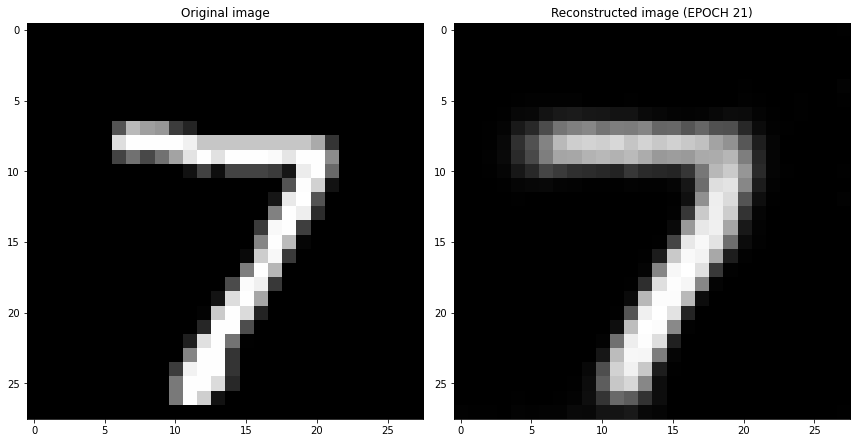

EPOCH 22/30
	 partial train loss (single batch): 0.029008
	 partial train loss (single batch): 0.030135
	 partial train loss (single batch): 0.030211
	 partial train loss (single batch): 0.029701
	 partial train loss (single batch): 0.027588
	 partial train loss (single batch): 0.030011
	 partial train loss (single batch): 0.029422
	 partial train loss (single batch): 0.029138
	 partial train loss (single batch): 0.029952
	 partial train loss (single batch): 0.030641
	 partial train loss (single batch): 0.030206
	 partial train loss (single batch): 0.029605
	 partial train loss (single batch): 0.029492
	 partial train loss (single batch): 0.030175
	 partial train loss (single batch): 0.030513
	 partial train loss (single batch): 0.028289
	 partial train loss (single batch): 0.028540
	 partial train loss (single batch): 0.027574
	 partial train loss (single batch): 0.030070
	 partial train loss (single batch): 0.029102
	 partial train loss (single batch): 0.030021
	 partial train loss (

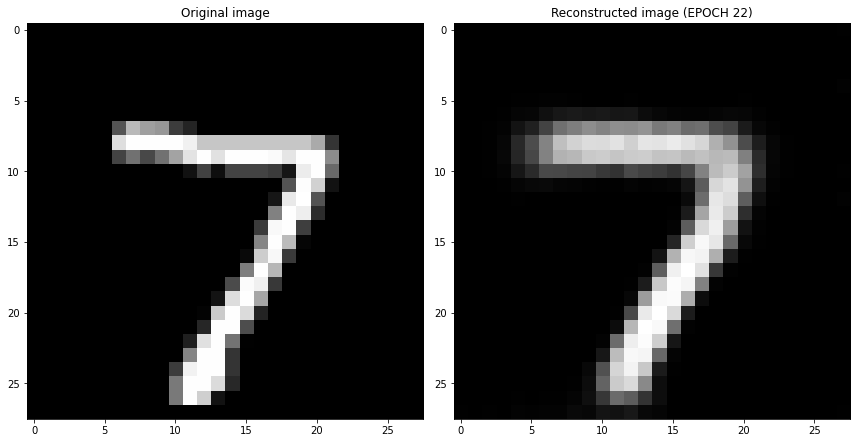

EPOCH 23/30
	 partial train loss (single batch): 0.029199
	 partial train loss (single batch): 0.027546
	 partial train loss (single batch): 0.029267
	 partial train loss (single batch): 0.029446
	 partial train loss (single batch): 0.028050
	 partial train loss (single batch): 0.029860
	 partial train loss (single batch): 0.027738
	 partial train loss (single batch): 0.030259
	 partial train loss (single batch): 0.029608
	 partial train loss (single batch): 0.028956
	 partial train loss (single batch): 0.028638
	 partial train loss (single batch): 0.029496
	 partial train loss (single batch): 0.029585
	 partial train loss (single batch): 0.028302
	 partial train loss (single batch): 0.027632
	 partial train loss (single batch): 0.029406
	 partial train loss (single batch): 0.029686
	 partial train loss (single batch): 0.029214
	 partial train loss (single batch): 0.029182
	 partial train loss (single batch): 0.030271
	 partial train loss (single batch): 0.028582
	 partial train loss (

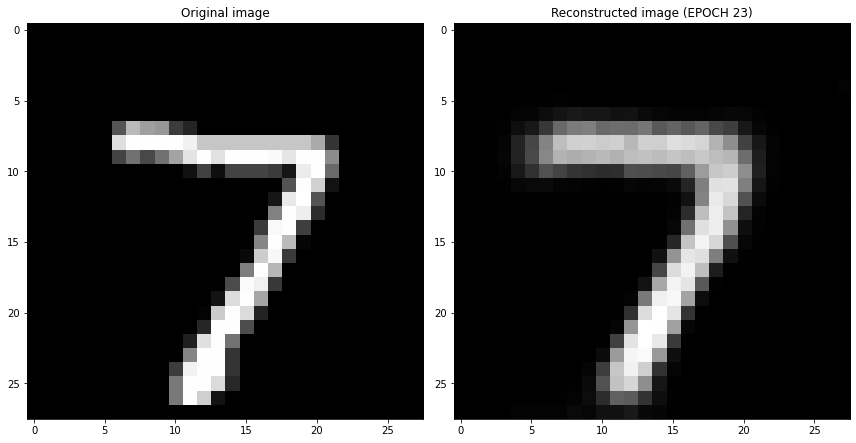

EPOCH 24/30
	 partial train loss (single batch): 0.029216
	 partial train loss (single batch): 0.029718
	 partial train loss (single batch): 0.031043
	 partial train loss (single batch): 0.029039
	 partial train loss (single batch): 0.029000
	 partial train loss (single batch): 0.029494
	 partial train loss (single batch): 0.027922
	 partial train loss (single batch): 0.030255
	 partial train loss (single batch): 0.030991
	 partial train loss (single batch): 0.027920
	 partial train loss (single batch): 0.028735
	 partial train loss (single batch): 0.030640
	 partial train loss (single batch): 0.028199
	 partial train loss (single batch): 0.028464
	 partial train loss (single batch): 0.029231
	 partial train loss (single batch): 0.030396
	 partial train loss (single batch): 0.029186
	 partial train loss (single batch): 0.028755
	 partial train loss (single batch): 0.029229
	 partial train loss (single batch): 0.028780
	 partial train loss (single batch): 0.030190
	 partial train loss (

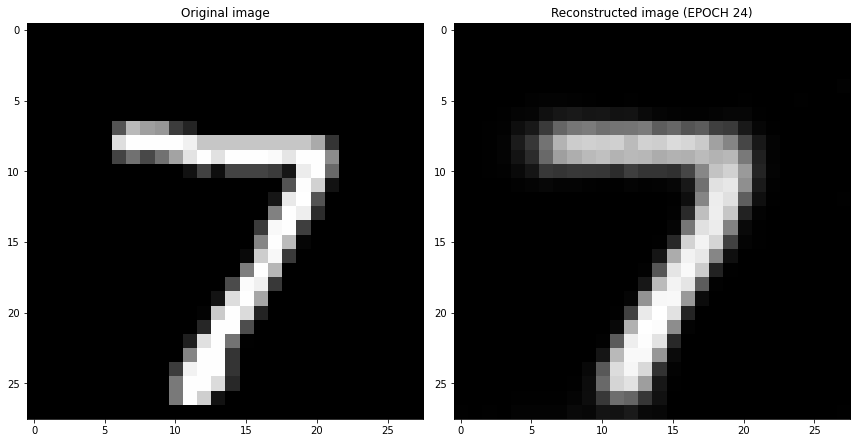

EPOCH 25/30
	 partial train loss (single batch): 0.029978
	 partial train loss (single batch): 0.029511
	 partial train loss (single batch): 0.028643
	 partial train loss (single batch): 0.028319
	 partial train loss (single batch): 0.028677
	 partial train loss (single batch): 0.028938
	 partial train loss (single batch): 0.028385
	 partial train loss (single batch): 0.029207
	 partial train loss (single batch): 0.029038
	 partial train loss (single batch): 0.028644
	 partial train loss (single batch): 0.029205
	 partial train loss (single batch): 0.029241
	 partial train loss (single batch): 0.029908
	 partial train loss (single batch): 0.028764
	 partial train loss (single batch): 0.029314
	 partial train loss (single batch): 0.030030
	 partial train loss (single batch): 0.028061
	 partial train loss (single batch): 0.030145
	 partial train loss (single batch): 0.027938
	 partial train loss (single batch): 0.030876
	 partial train loss (single batch): 0.028435
	 partial train loss (

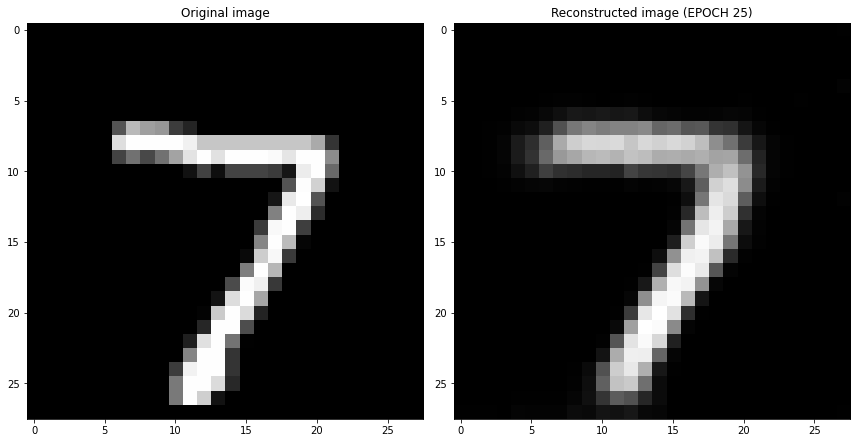

EPOCH 26/30
	 partial train loss (single batch): 0.028246
	 partial train loss (single batch): 0.027604
	 partial train loss (single batch): 0.028869
	 partial train loss (single batch): 0.030345
	 partial train loss (single batch): 0.028314
	 partial train loss (single batch): 0.030227
	 partial train loss (single batch): 0.027304
	 partial train loss (single batch): 0.028503
	 partial train loss (single batch): 0.031117
	 partial train loss (single batch): 0.028975
	 partial train loss (single batch): 0.029380
	 partial train loss (single batch): 0.029073
	 partial train loss (single batch): 0.028895
	 partial train loss (single batch): 0.029553
	 partial train loss (single batch): 0.030419
	 partial train loss (single batch): 0.029129
	 partial train loss (single batch): 0.029464
	 partial train loss (single batch): 0.028010
	 partial train loss (single batch): 0.028831
	 partial train loss (single batch): 0.030425
	 partial train loss (single batch): 0.027375
	 partial train loss (

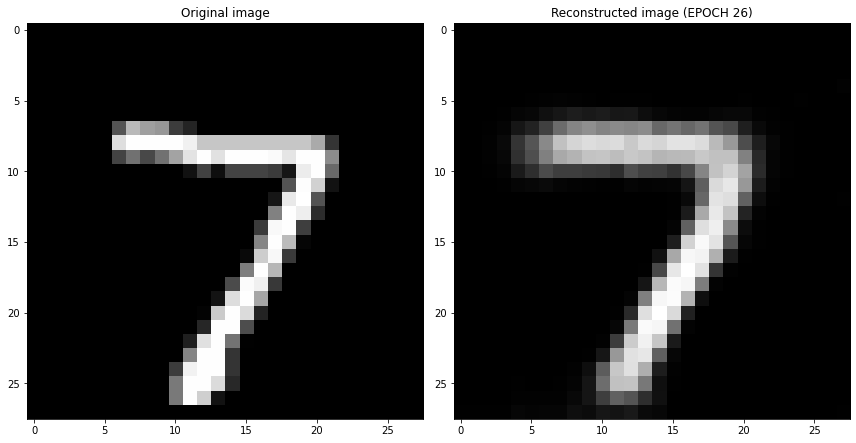

EPOCH 27/30
	 partial train loss (single batch): 0.030329
	 partial train loss (single batch): 0.029485
	 partial train loss (single batch): 0.028087
	 partial train loss (single batch): 0.030128
	 partial train loss (single batch): 0.029371
	 partial train loss (single batch): 0.029494
	 partial train loss (single batch): 0.029601
	 partial train loss (single batch): 0.028207
	 partial train loss (single batch): 0.027565
	 partial train loss (single batch): 0.028924
	 partial train loss (single batch): 0.029127
	 partial train loss (single batch): 0.028452
	 partial train loss (single batch): 0.029949
	 partial train loss (single batch): 0.029944
	 partial train loss (single batch): 0.028193
	 partial train loss (single batch): 0.027231
	 partial train loss (single batch): 0.027795
	 partial train loss (single batch): 0.027530
	 partial train loss (single batch): 0.029997
	 partial train loss (single batch): 0.029954
	 partial train loss (single batch): 0.030860
	 partial train loss (

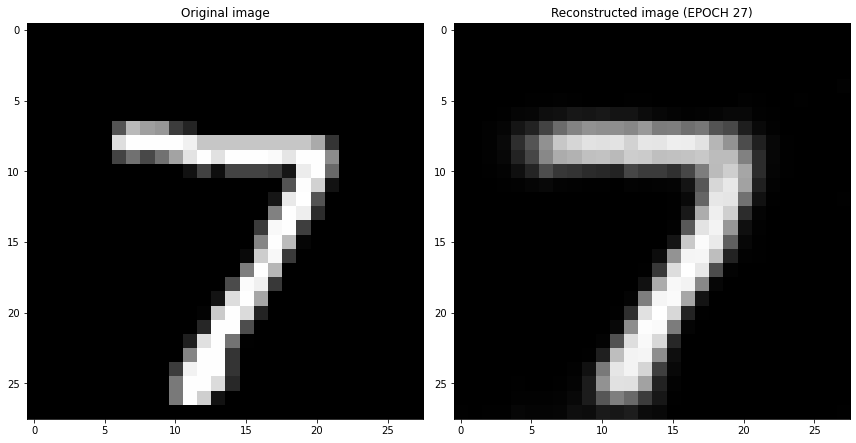

EPOCH 28/30
	 partial train loss (single batch): 0.029944
	 partial train loss (single batch): 0.030728
	 partial train loss (single batch): 0.028966
	 partial train loss (single batch): 0.029207
	 partial train loss (single batch): 0.031702
	 partial train loss (single batch): 0.029130
	 partial train loss (single batch): 0.029358
	 partial train loss (single batch): 0.029337
	 partial train loss (single batch): 0.029205
	 partial train loss (single batch): 0.029940
	 partial train loss (single batch): 0.029965
	 partial train loss (single batch): 0.028158
	 partial train loss (single batch): 0.028675
	 partial train loss (single batch): 0.030110
	 partial train loss (single batch): 0.029557
	 partial train loss (single batch): 0.029306
	 partial train loss (single batch): 0.027207
	 partial train loss (single batch): 0.028273
	 partial train loss (single batch): 0.028890
	 partial train loss (single batch): 0.028416
	 partial train loss (single batch): 0.028749
	 partial train loss (

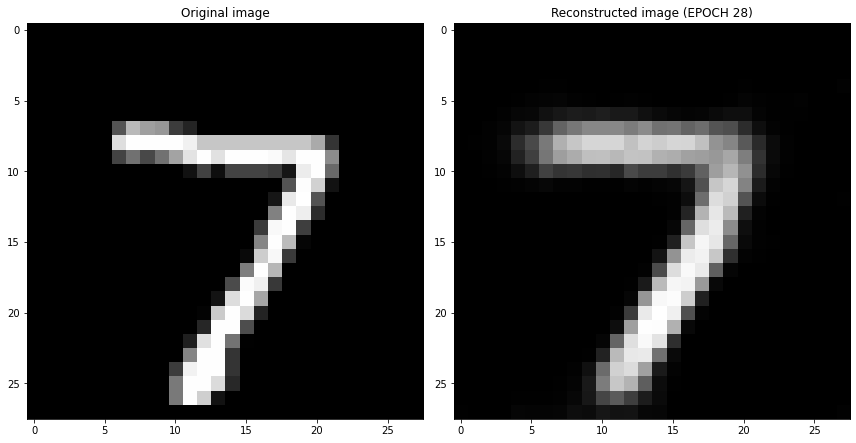

EPOCH 29/30
	 partial train loss (single batch): 0.028334
	 partial train loss (single batch): 0.029406
	 partial train loss (single batch): 0.029437
	 partial train loss (single batch): 0.029171
	 partial train loss (single batch): 0.030698
	 partial train loss (single batch): 0.026447
	 partial train loss (single batch): 0.029110
	 partial train loss (single batch): 0.029602
	 partial train loss (single batch): 0.028847
	 partial train loss (single batch): 0.029404
	 partial train loss (single batch): 0.026480
	 partial train loss (single batch): 0.029788
	 partial train loss (single batch): 0.028878
	 partial train loss (single batch): 0.029081
	 partial train loss (single batch): 0.028330
	 partial train loss (single batch): 0.028733
	 partial train loss (single batch): 0.026610
	 partial train loss (single batch): 0.027025
	 partial train loss (single batch): 0.027078
	 partial train loss (single batch): 0.030873
	 partial train loss (single batch): 0.030034
	 partial train loss (

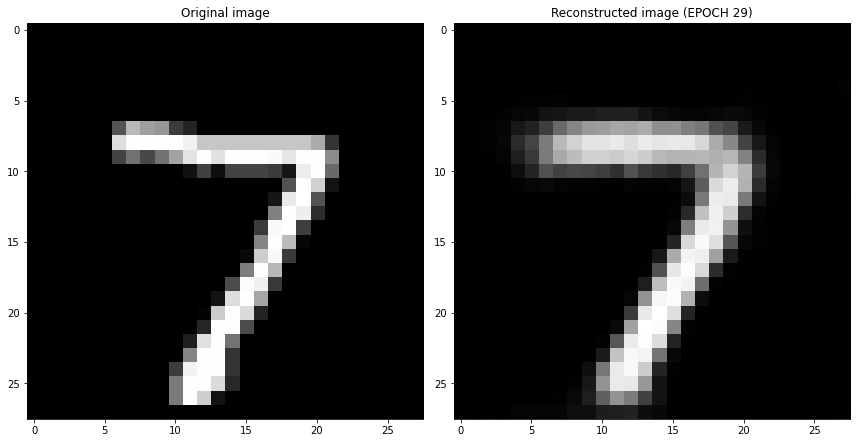

EPOCH 30/30
	 partial train loss (single batch): 0.027561
	 partial train loss (single batch): 0.027910
	 partial train loss (single batch): 0.029626
	 partial train loss (single batch): 0.028444
	 partial train loss (single batch): 0.029597
	 partial train loss (single batch): 0.027056
	 partial train loss (single batch): 0.027129
	 partial train loss (single batch): 0.028981
	 partial train loss (single batch): 0.030002
	 partial train loss (single batch): 0.028253
	 partial train loss (single batch): 0.028403
	 partial train loss (single batch): 0.027855
	 partial train loss (single batch): 0.028952
	 partial train loss (single batch): 0.028599
	 partial train loss (single batch): 0.029024
	 partial train loss (single batch): 0.028227
	 partial train loss (single batch): 0.028516
	 partial train loss (single batch): 0.028565
	 partial train loss (single batch): 0.029233
	 partial train loss (single batch): 0.028736
	 partial train loss (single batch): 0.027699
	 partial train loss (

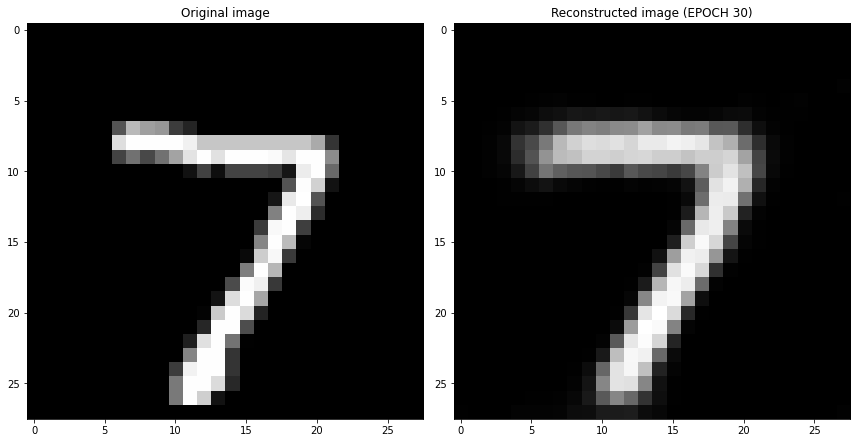

Cross validation fold number= 4/6
EPOCH 1/30
	 partial train loss (single batch): 0.264513
	 partial train loss (single batch): 0.263311
	 partial train loss (single batch): 0.262569
	 partial train loss (single batch): 0.262519
	 partial train loss (single batch): 0.262133
	 partial train loss (single batch): 0.260888
	 partial train loss (single batch): 0.260265
	 partial train loss (single batch): 0.259070
	 partial train loss (single batch): 0.259200
	 partial train loss (single batch): 0.258243
	 partial train loss (single batch): 0.257187
	 partial train loss (single batch): 0.256359
	 partial train loss (single batch): 0.254998
	 partial train loss (single batch): 0.253663
	 partial train loss (single batch): 0.251917
	 partial train loss (single batch): 0.250723
	 partial train loss (single batch): 0.249888
	 partial train loss (single batch): 0.247170
	 partial train loss (single batch): 0.244970
	 partial train loss (single batch): 0.241969
	 partial train loss (single batch)

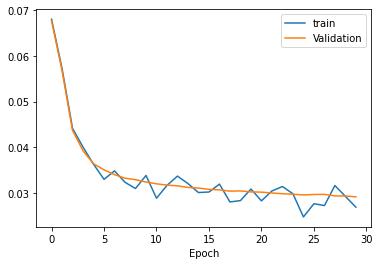

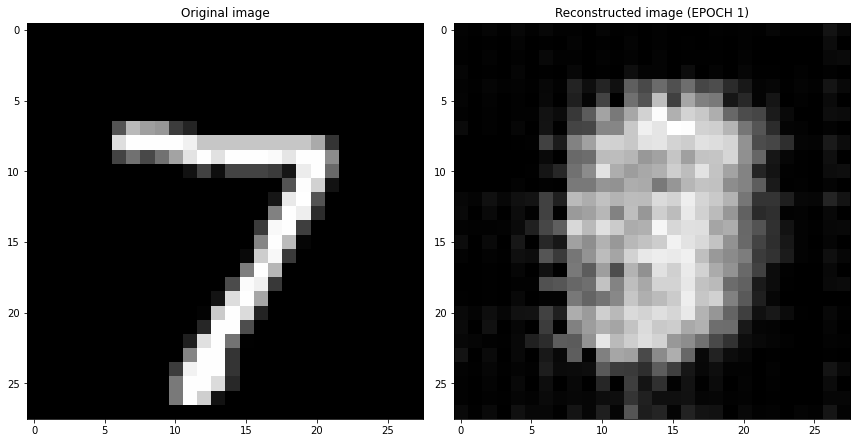

EPOCH 2/30
	 partial train loss (single batch): 0.068767
	 partial train loss (single batch): 0.067324
	 partial train loss (single batch): 0.067643
	 partial train loss (single batch): 0.066143
	 partial train loss (single batch): 0.066888
	 partial train loss (single batch): 0.066458
	 partial train loss (single batch): 0.071428
	 partial train loss (single batch): 0.069112
	 partial train loss (single batch): 0.067419
	 partial train loss (single batch): 0.067971
	 partial train loss (single batch): 0.068032
	 partial train loss (single batch): 0.069680
	 partial train loss (single batch): 0.066356
	 partial train loss (single batch): 0.069650
	 partial train loss (single batch): 0.068730
	 partial train loss (single batch): 0.067176
	 partial train loss (single batch): 0.069098
	 partial train loss (single batch): 0.065657
	 partial train loss (single batch): 0.067387
	 partial train loss (single batch): 0.067057
	 partial train loss (single batch): 0.067230
	 partial train loss (s

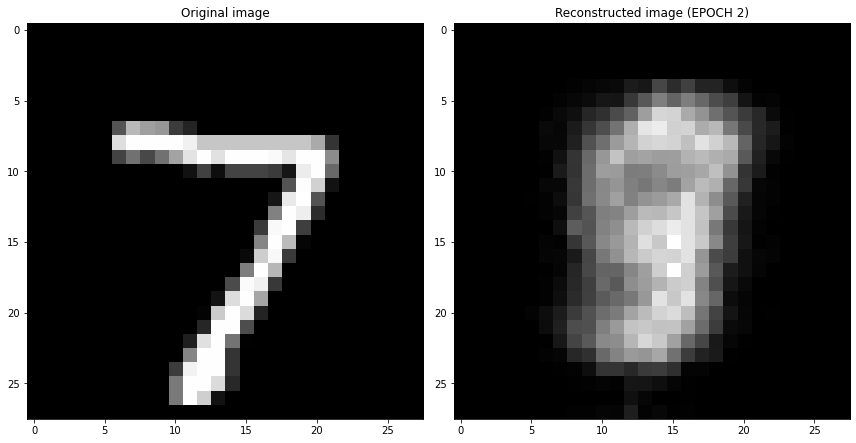

EPOCH 3/30
	 partial train loss (single batch): 0.060659
	 partial train loss (single batch): 0.058655
	 partial train loss (single batch): 0.059814
	 partial train loss (single batch): 0.060481
	 partial train loss (single batch): 0.058394
	 partial train loss (single batch): 0.062203
	 partial train loss (single batch): 0.060825
	 partial train loss (single batch): 0.059257
	 partial train loss (single batch): 0.060175
	 partial train loss (single batch): 0.062368
	 partial train loss (single batch): 0.059835
	 partial train loss (single batch): 0.059753
	 partial train loss (single batch): 0.061673
	 partial train loss (single batch): 0.057312
	 partial train loss (single batch): 0.058217
	 partial train loss (single batch): 0.061909
	 partial train loss (single batch): 0.061806
	 partial train loss (single batch): 0.060185
	 partial train loss (single batch): 0.057862
	 partial train loss (single batch): 0.059956
	 partial train loss (single batch): 0.059462
	 partial train loss (s

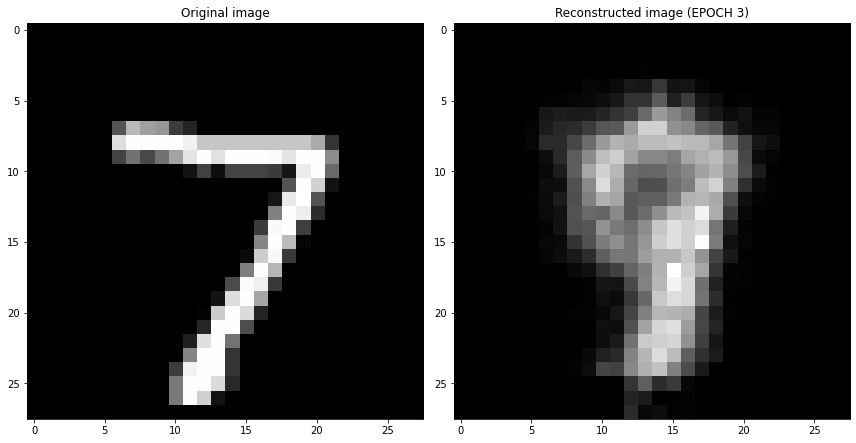

EPOCH 4/30
	 partial train loss (single batch): 0.053148
	 partial train loss (single batch): 0.054402
	 partial train loss (single batch): 0.052816
	 partial train loss (single batch): 0.052558
	 partial train loss (single batch): 0.053509
	 partial train loss (single batch): 0.054226
	 partial train loss (single batch): 0.051967
	 partial train loss (single batch): 0.052030
	 partial train loss (single batch): 0.052685
	 partial train loss (single batch): 0.051900
	 partial train loss (single batch): 0.050972
	 partial train loss (single batch): 0.052747
	 partial train loss (single batch): 0.052300
	 partial train loss (single batch): 0.050717
	 partial train loss (single batch): 0.053344
	 partial train loss (single batch): 0.052622
	 partial train loss (single batch): 0.051365
	 partial train loss (single batch): 0.050600
	 partial train loss (single batch): 0.052783
	 partial train loss (single batch): 0.051453
	 partial train loss (single batch): 0.053088
	 partial train loss (s

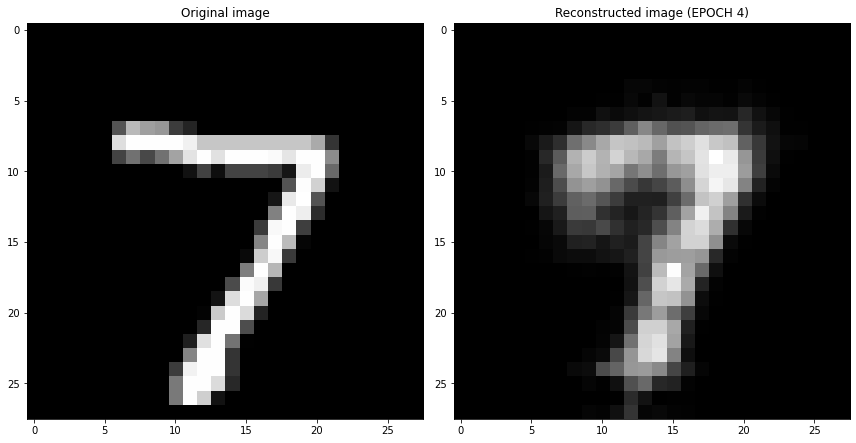

EPOCH 5/30
	 partial train loss (single batch): 0.044197
	 partial train loss (single batch): 0.044958
	 partial train loss (single batch): 0.044482
	 partial train loss (single batch): 0.043480
	 partial train loss (single batch): 0.041577
	 partial train loss (single batch): 0.044304
	 partial train loss (single batch): 0.044840
	 partial train loss (single batch): 0.044267
	 partial train loss (single batch): 0.043872
	 partial train loss (single batch): 0.043177
	 partial train loss (single batch): 0.045036
	 partial train loss (single batch): 0.043441
	 partial train loss (single batch): 0.043411
	 partial train loss (single batch): 0.046226
	 partial train loss (single batch): 0.044411
	 partial train loss (single batch): 0.043698
	 partial train loss (single batch): 0.043813
	 partial train loss (single batch): 0.042363
	 partial train loss (single batch): 0.043256
	 partial train loss (single batch): 0.042548
	 partial train loss (single batch): 0.043658
	 partial train loss (s

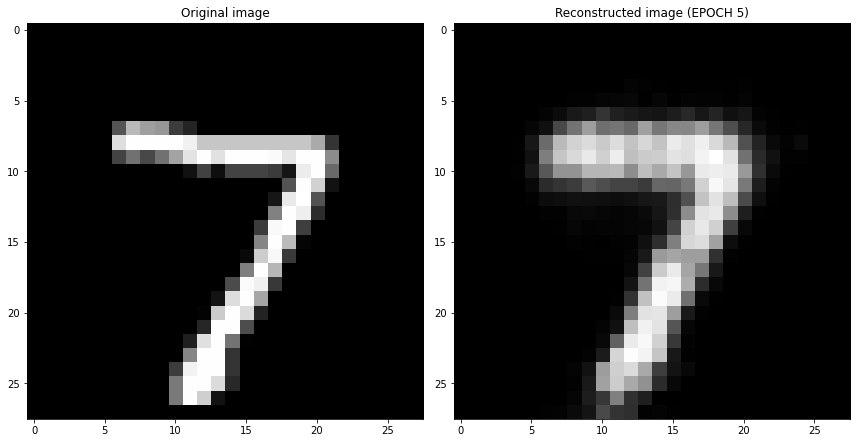

EPOCH 6/30
	 partial train loss (single batch): 0.041178
	 partial train loss (single batch): 0.040970
	 partial train loss (single batch): 0.039583
	 partial train loss (single batch): 0.040980
	 partial train loss (single batch): 0.036519
	 partial train loss (single batch): 0.039965
	 partial train loss (single batch): 0.041083
	 partial train loss (single batch): 0.039726
	 partial train loss (single batch): 0.041142
	 partial train loss (single batch): 0.040816
	 partial train loss (single batch): 0.039358
	 partial train loss (single batch): 0.041588
	 partial train loss (single batch): 0.041327
	 partial train loss (single batch): 0.040156
	 partial train loss (single batch): 0.038182
	 partial train loss (single batch): 0.040540
	 partial train loss (single batch): 0.039725
	 partial train loss (single batch): 0.038831
	 partial train loss (single batch): 0.040833
	 partial train loss (single batch): 0.041778
	 partial train loss (single batch): 0.039649
	 partial train loss (s

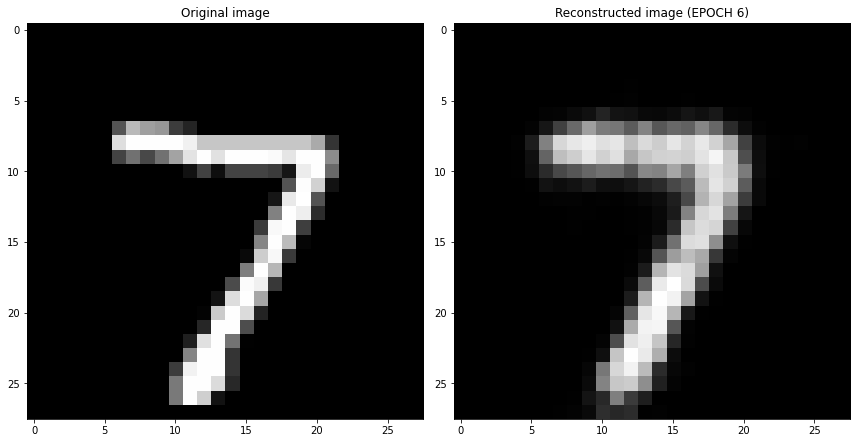

EPOCH 7/30
	 partial train loss (single batch): 0.038563
	 partial train loss (single batch): 0.039759
	 partial train loss (single batch): 0.037737
	 partial train loss (single batch): 0.038760
	 partial train loss (single batch): 0.038711
	 partial train loss (single batch): 0.038863
	 partial train loss (single batch): 0.037755
	 partial train loss (single batch): 0.037449
	 partial train loss (single batch): 0.038399
	 partial train loss (single batch): 0.038492
	 partial train loss (single batch): 0.037824
	 partial train loss (single batch): 0.038221
	 partial train loss (single batch): 0.038316
	 partial train loss (single batch): 0.038769
	 partial train loss (single batch): 0.038569
	 partial train loss (single batch): 0.037237
	 partial train loss (single batch): 0.038683
	 partial train loss (single batch): 0.040281
	 partial train loss (single batch): 0.038511
	 partial train loss (single batch): 0.037865
	 partial train loss (single batch): 0.038899
	 partial train loss (s

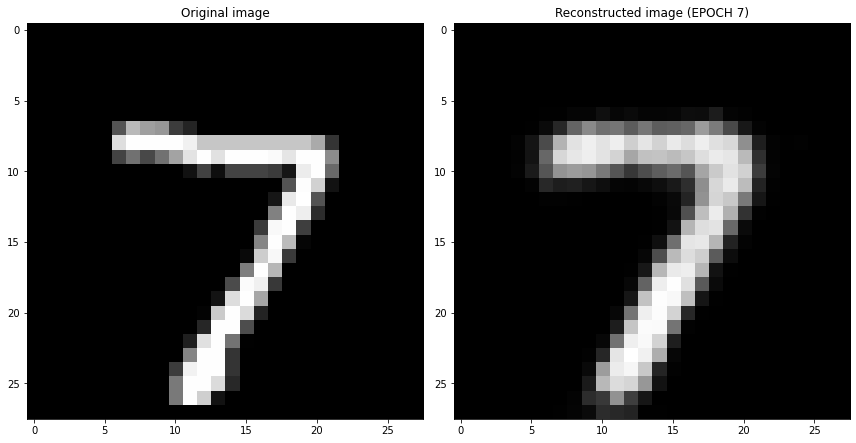

EPOCH 8/30
	 partial train loss (single batch): 0.036691
	 partial train loss (single batch): 0.036023
	 partial train loss (single batch): 0.035970
	 partial train loss (single batch): 0.036400
	 partial train loss (single batch): 0.037617
	 partial train loss (single batch): 0.035987
	 partial train loss (single batch): 0.035352
	 partial train loss (single batch): 0.036655
	 partial train loss (single batch): 0.038577
	 partial train loss (single batch): 0.036306
	 partial train loss (single batch): 0.036523
	 partial train loss (single batch): 0.036688
	 partial train loss (single batch): 0.035755
	 partial train loss (single batch): 0.037692
	 partial train loss (single batch): 0.037649
	 partial train loss (single batch): 0.035262
	 partial train loss (single batch): 0.036124
	 partial train loss (single batch): 0.036344
	 partial train loss (single batch): 0.036961
	 partial train loss (single batch): 0.038165
	 partial train loss (single batch): 0.036459
	 partial train loss (s

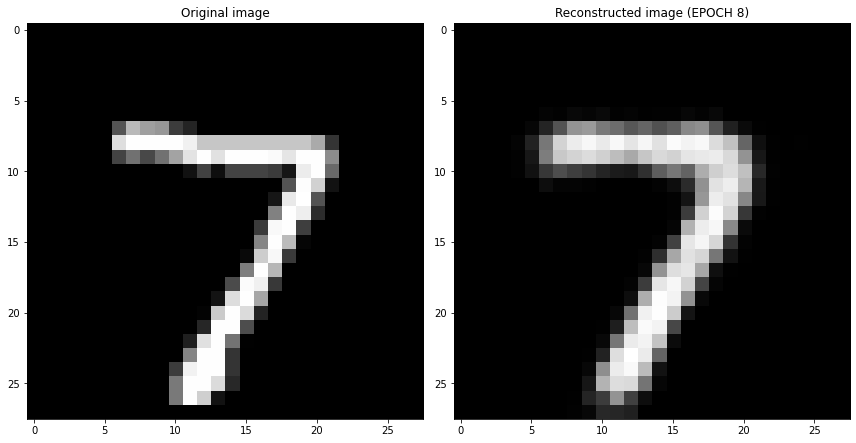

EPOCH 9/30
	 partial train loss (single batch): 0.035079
	 partial train loss (single batch): 0.036486
	 partial train loss (single batch): 0.034911
	 partial train loss (single batch): 0.033899
	 partial train loss (single batch): 0.032839
	 partial train loss (single batch): 0.035075
	 partial train loss (single batch): 0.035598
	 partial train loss (single batch): 0.033403
	 partial train loss (single batch): 0.033736
	 partial train loss (single batch): 0.034897
	 partial train loss (single batch): 0.035324
	 partial train loss (single batch): 0.034749
	 partial train loss (single batch): 0.036252
	 partial train loss (single batch): 0.035222
	 partial train loss (single batch): 0.033175
	 partial train loss (single batch): 0.034616
	 partial train loss (single batch): 0.036679
	 partial train loss (single batch): 0.033576
	 partial train loss (single batch): 0.033460
	 partial train loss (single batch): 0.034741
	 partial train loss (single batch): 0.033860
	 partial train loss (s

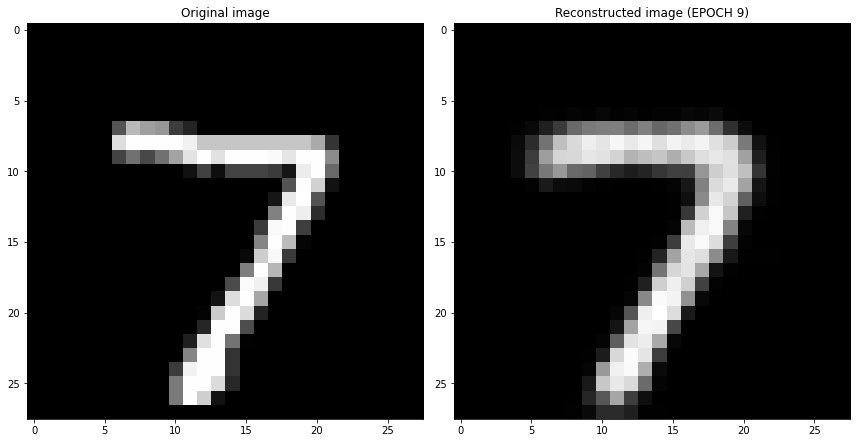

EPOCH 10/30
	 partial train loss (single batch): 0.032337
	 partial train loss (single batch): 0.036941
	 partial train loss (single batch): 0.033962
	 partial train loss (single batch): 0.032558
	 partial train loss (single batch): 0.035019
	 partial train loss (single batch): 0.036691
	 partial train loss (single batch): 0.033943
	 partial train loss (single batch): 0.032539
	 partial train loss (single batch): 0.033604
	 partial train loss (single batch): 0.034133
	 partial train loss (single batch): 0.034045
	 partial train loss (single batch): 0.034017
	 partial train loss (single batch): 0.033036
	 partial train loss (single batch): 0.032517
	 partial train loss (single batch): 0.032844
	 partial train loss (single batch): 0.034324
	 partial train loss (single batch): 0.034487
	 partial train loss (single batch): 0.035285
	 partial train loss (single batch): 0.035438
	 partial train loss (single batch): 0.033273
	 partial train loss (single batch): 0.034296
	 partial train loss (

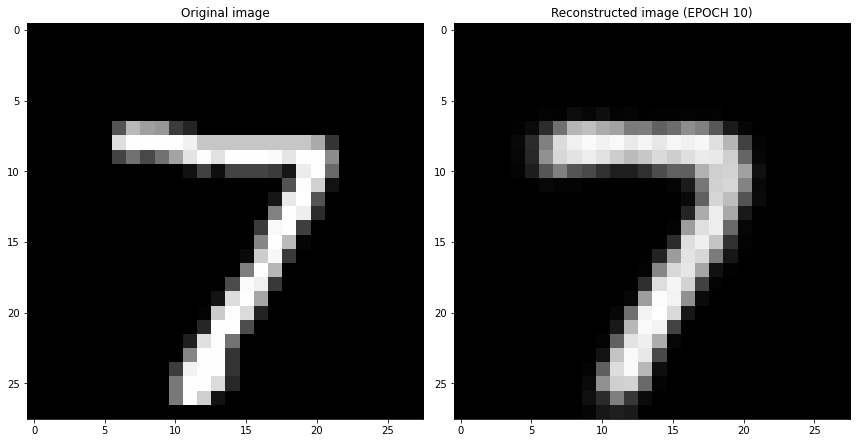

EPOCH 11/30
	 partial train loss (single batch): 0.035201
	 partial train loss (single batch): 0.033277
	 partial train loss (single batch): 0.033074
	 partial train loss (single batch): 0.034031
	 partial train loss (single batch): 0.032473
	 partial train loss (single batch): 0.032930
	 partial train loss (single batch): 0.033095
	 partial train loss (single batch): 0.032221
	 partial train loss (single batch): 0.031833
	 partial train loss (single batch): 0.032506
	 partial train loss (single batch): 0.033008
	 partial train loss (single batch): 0.033669
	 partial train loss (single batch): 0.033980
	 partial train loss (single batch): 0.034175
	 partial train loss (single batch): 0.033911
	 partial train loss (single batch): 0.033881
	 partial train loss (single batch): 0.031355
	 partial train loss (single batch): 0.032132
	 partial train loss (single batch): 0.035461
	 partial train loss (single batch): 0.034577
	 partial train loss (single batch): 0.032179
	 partial train loss (

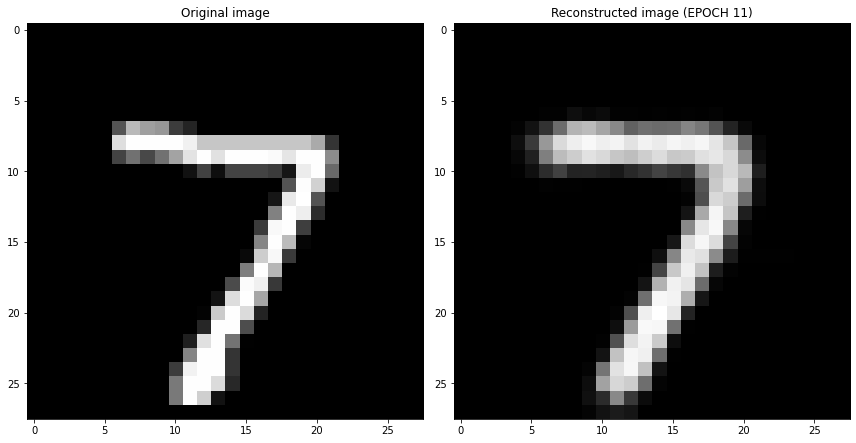

EPOCH 12/30
	 partial train loss (single batch): 0.032389
	 partial train loss (single batch): 0.032879
	 partial train loss (single batch): 0.032626
	 partial train loss (single batch): 0.030766
	 partial train loss (single batch): 0.033419
	 partial train loss (single batch): 0.031712
	 partial train loss (single batch): 0.032844
	 partial train loss (single batch): 0.032566
	 partial train loss (single batch): 0.034579
	 partial train loss (single batch): 0.032915
	 partial train loss (single batch): 0.032034
	 partial train loss (single batch): 0.032783
	 partial train loss (single batch): 0.030943
	 partial train loss (single batch): 0.033243
	 partial train loss (single batch): 0.033735
	 partial train loss (single batch): 0.032245
	 partial train loss (single batch): 0.031845
	 partial train loss (single batch): 0.034041
	 partial train loss (single batch): 0.032497
	 partial train loss (single batch): 0.033659
	 partial train loss (single batch): 0.032754
	 partial train loss (

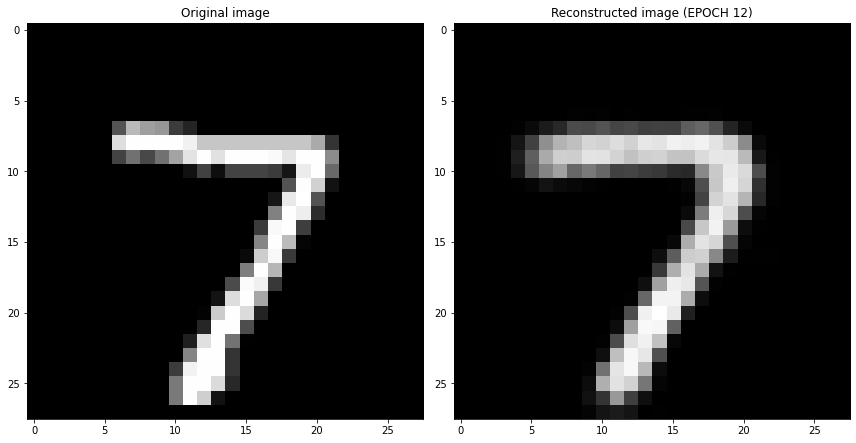

EPOCH 13/30
	 partial train loss (single batch): 0.030157
	 partial train loss (single batch): 0.032743
	 partial train loss (single batch): 0.031346
	 partial train loss (single batch): 0.030735
	 partial train loss (single batch): 0.032274
	 partial train loss (single batch): 0.031838
	 partial train loss (single batch): 0.032733
	 partial train loss (single batch): 0.034482
	 partial train loss (single batch): 0.032936
	 partial train loss (single batch): 0.032753
	 partial train loss (single batch): 0.031535
	 partial train loss (single batch): 0.033895
	 partial train loss (single batch): 0.033433
	 partial train loss (single batch): 0.032679
	 partial train loss (single batch): 0.031799
	 partial train loss (single batch): 0.033607
	 partial train loss (single batch): 0.031898
	 partial train loss (single batch): 0.032111
	 partial train loss (single batch): 0.030552
	 partial train loss (single batch): 0.032530
	 partial train loss (single batch): 0.031451
	 partial train loss (

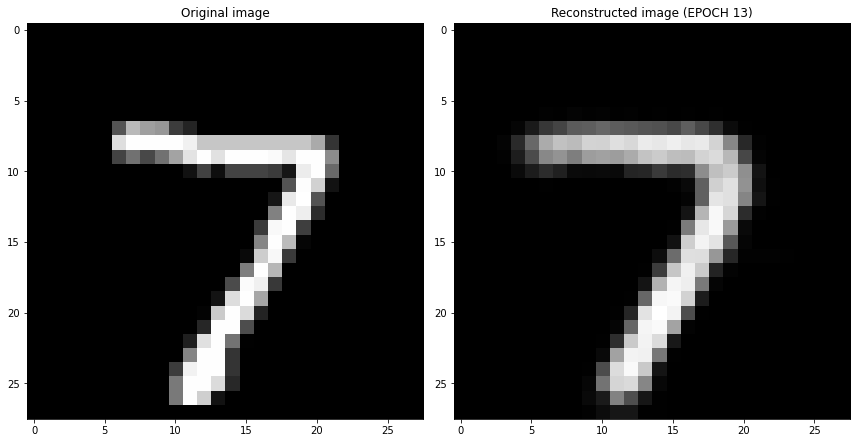

EPOCH 14/30
	 partial train loss (single batch): 0.032800
	 partial train loss (single batch): 0.031138
	 partial train loss (single batch): 0.032297
	 partial train loss (single batch): 0.030014
	 partial train loss (single batch): 0.029740
	 partial train loss (single batch): 0.034423
	 partial train loss (single batch): 0.030876
	 partial train loss (single batch): 0.030643
	 partial train loss (single batch): 0.031522
	 partial train loss (single batch): 0.033033
	 partial train loss (single batch): 0.033193
	 partial train loss (single batch): 0.032616
	 partial train loss (single batch): 0.030786
	 partial train loss (single batch): 0.031572
	 partial train loss (single batch): 0.033523
	 partial train loss (single batch): 0.032635
	 partial train loss (single batch): 0.034160
	 partial train loss (single batch): 0.033808
	 partial train loss (single batch): 0.031075
	 partial train loss (single batch): 0.033278
	 partial train loss (single batch): 0.031266
	 partial train loss (

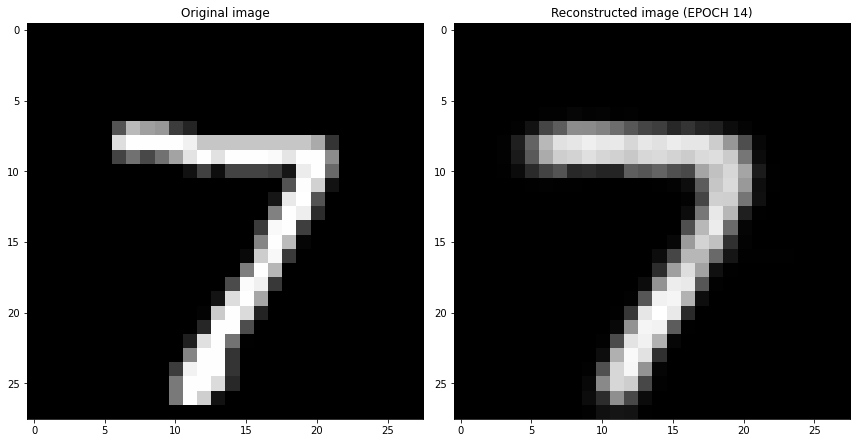

EPOCH 15/30
	 partial train loss (single batch): 0.032848
	 partial train loss (single batch): 0.031082
	 partial train loss (single batch): 0.030834
	 partial train loss (single batch): 0.031288
	 partial train loss (single batch): 0.031111
	 partial train loss (single batch): 0.031414
	 partial train loss (single batch): 0.031458
	 partial train loss (single batch): 0.031842
	 partial train loss (single batch): 0.030276
	 partial train loss (single batch): 0.031044
	 partial train loss (single batch): 0.030714
	 partial train loss (single batch): 0.032630
	 partial train loss (single batch): 0.031699
	 partial train loss (single batch): 0.033013
	 partial train loss (single batch): 0.031264
	 partial train loss (single batch): 0.032544
	 partial train loss (single batch): 0.029324
	 partial train loss (single batch): 0.032540
	 partial train loss (single batch): 0.031717
	 partial train loss (single batch): 0.031666
	 partial train loss (single batch): 0.031607
	 partial train loss (

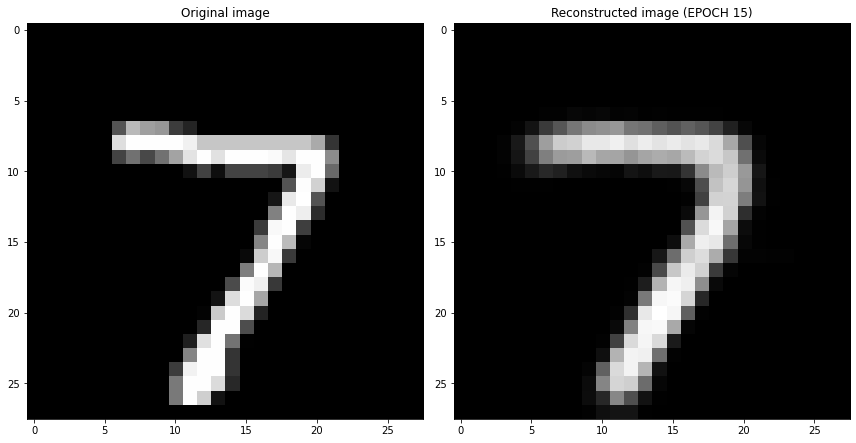

EPOCH 16/30
	 partial train loss (single batch): 0.031211
	 partial train loss (single batch): 0.030362
	 partial train loss (single batch): 0.031474
	 partial train loss (single batch): 0.031493
	 partial train loss (single batch): 0.029767
	 partial train loss (single batch): 0.030496
	 partial train loss (single batch): 0.031199
	 partial train loss (single batch): 0.030265
	 partial train loss (single batch): 0.030930
	 partial train loss (single batch): 0.031400
	 partial train loss (single batch): 0.030560
	 partial train loss (single batch): 0.030196
	 partial train loss (single batch): 0.031853
	 partial train loss (single batch): 0.031918
	 partial train loss (single batch): 0.029371
	 partial train loss (single batch): 0.030036
	 partial train loss (single batch): 0.031153
	 partial train loss (single batch): 0.030261
	 partial train loss (single batch): 0.030594
	 partial train loss (single batch): 0.030989
	 partial train loss (single batch): 0.030754
	 partial train loss (

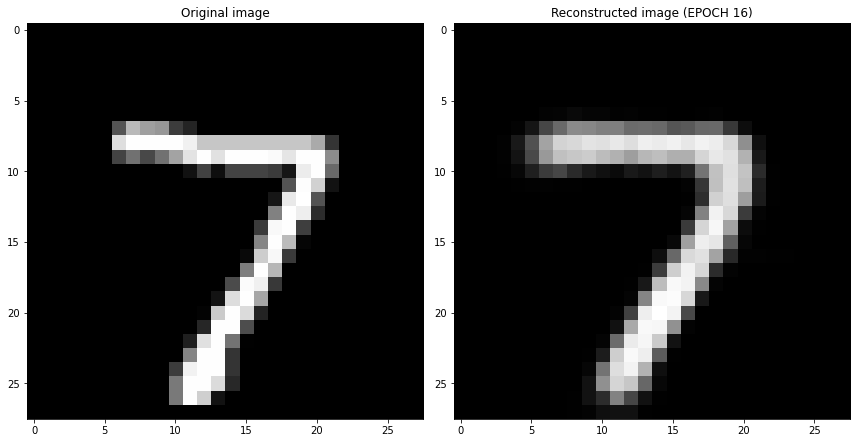

EPOCH 17/30
	 partial train loss (single batch): 0.031108
	 partial train loss (single batch): 0.029632
	 partial train loss (single batch): 0.029848
	 partial train loss (single batch): 0.031406
	 partial train loss (single batch): 0.031467
	 partial train loss (single batch): 0.031498
	 partial train loss (single batch): 0.031052
	 partial train loss (single batch): 0.033701
	 partial train loss (single batch): 0.031198
	 partial train loss (single batch): 0.032530
	 partial train loss (single batch): 0.031664
	 partial train loss (single batch): 0.031242
	 partial train loss (single batch): 0.030807
	 partial train loss (single batch): 0.029122
	 partial train loss (single batch): 0.031206
	 partial train loss (single batch): 0.031497
	 partial train loss (single batch): 0.030589
	 partial train loss (single batch): 0.031155
	 partial train loss (single batch): 0.031027
	 partial train loss (single batch): 0.031450
	 partial train loss (single batch): 0.030818
	 partial train loss (

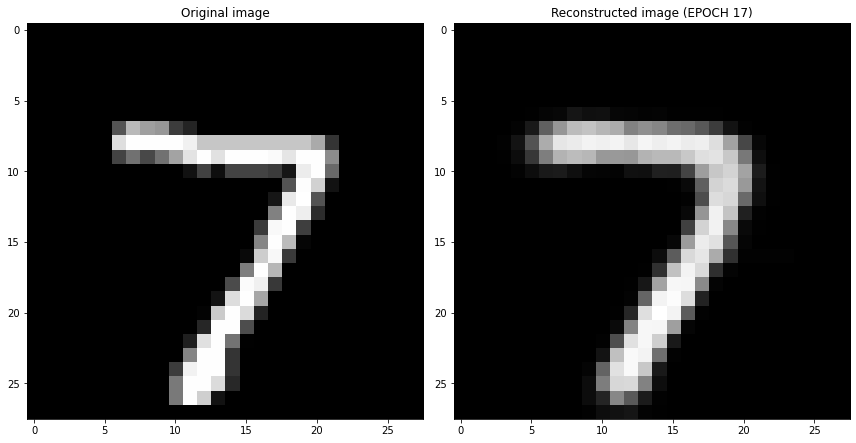

EPOCH 18/30
	 partial train loss (single batch): 0.030089
	 partial train loss (single batch): 0.031034
	 partial train loss (single batch): 0.030161
	 partial train loss (single batch): 0.030746
	 partial train loss (single batch): 0.029640
	 partial train loss (single batch): 0.030329
	 partial train loss (single batch): 0.029004
	 partial train loss (single batch): 0.029567
	 partial train loss (single batch): 0.030985
	 partial train loss (single batch): 0.031188
	 partial train loss (single batch): 0.030075
	 partial train loss (single batch): 0.029465
	 partial train loss (single batch): 0.031685
	 partial train loss (single batch): 0.030584
	 partial train loss (single batch): 0.030682
	 partial train loss (single batch): 0.030355
	 partial train loss (single batch): 0.030104
	 partial train loss (single batch): 0.029911
	 partial train loss (single batch): 0.030744
	 partial train loss (single batch): 0.030868
	 partial train loss (single batch): 0.028685
	 partial train loss (

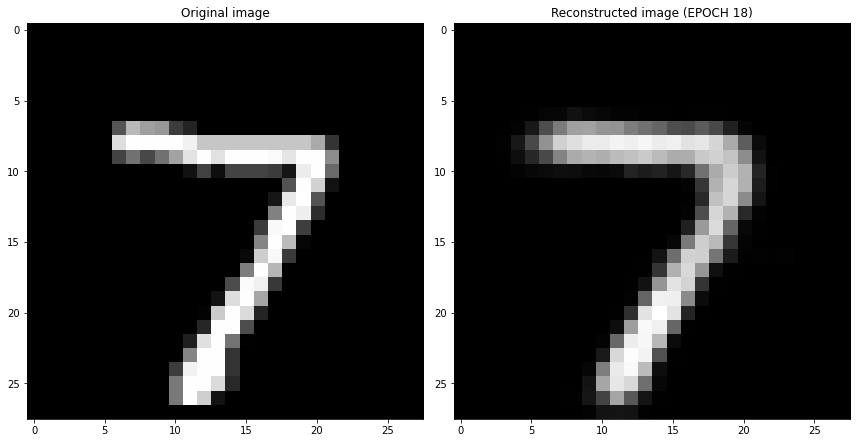

EPOCH 19/30
	 partial train loss (single batch): 0.030575
	 partial train loss (single batch): 0.030745
	 partial train loss (single batch): 0.029425
	 partial train loss (single batch): 0.031050
	 partial train loss (single batch): 0.029874
	 partial train loss (single batch): 0.028793
	 partial train loss (single batch): 0.027821
	 partial train loss (single batch): 0.029248
	 partial train loss (single batch): 0.029496
	 partial train loss (single batch): 0.029463
	 partial train loss (single batch): 0.030556
	 partial train loss (single batch): 0.031036
	 partial train loss (single batch): 0.029434
	 partial train loss (single batch): 0.030069
	 partial train loss (single batch): 0.030560
	 partial train loss (single batch): 0.031002
	 partial train loss (single batch): 0.030177
	 partial train loss (single batch): 0.032059
	 partial train loss (single batch): 0.028099
	 partial train loss (single batch): 0.030514
	 partial train loss (single batch): 0.032898
	 partial train loss (

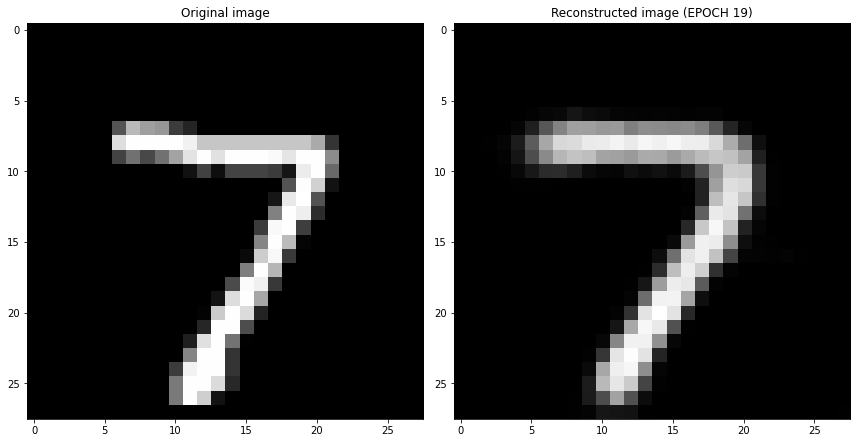

EPOCH 20/30
	 partial train loss (single batch): 0.028826
	 partial train loss (single batch): 0.030709
	 partial train loss (single batch): 0.031592
	 partial train loss (single batch): 0.030045
	 partial train loss (single batch): 0.029427
	 partial train loss (single batch): 0.029433
	 partial train loss (single batch): 0.029197
	 partial train loss (single batch): 0.031545
	 partial train loss (single batch): 0.030513
	 partial train loss (single batch): 0.029019
	 partial train loss (single batch): 0.029355
	 partial train loss (single batch): 0.031315
	 partial train loss (single batch): 0.030783
	 partial train loss (single batch): 0.030353
	 partial train loss (single batch): 0.029733
	 partial train loss (single batch): 0.030417
	 partial train loss (single batch): 0.029953
	 partial train loss (single batch): 0.029388
	 partial train loss (single batch): 0.030383
	 partial train loss (single batch): 0.030522
	 partial train loss (single batch): 0.029967
	 partial train loss (

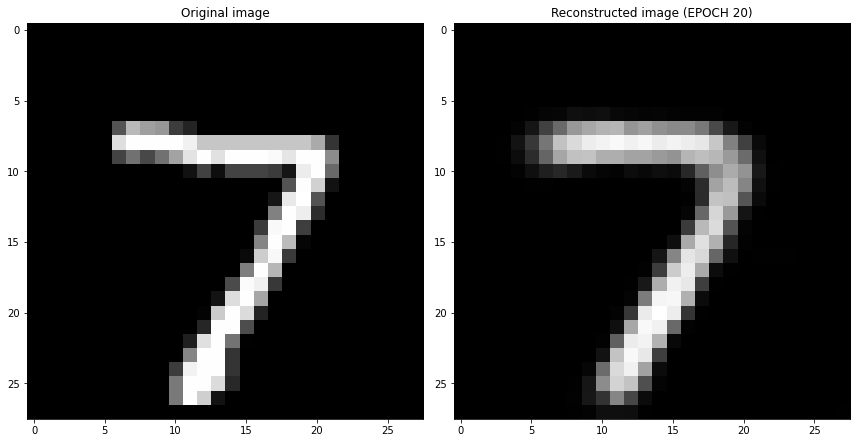

EPOCH 21/30
	 partial train loss (single batch): 0.030333
	 partial train loss (single batch): 0.030270
	 partial train loss (single batch): 0.028828
	 partial train loss (single batch): 0.030488
	 partial train loss (single batch): 0.030427
	 partial train loss (single batch): 0.028964
	 partial train loss (single batch): 0.030398
	 partial train loss (single batch): 0.029376
	 partial train loss (single batch): 0.030750
	 partial train loss (single batch): 0.028887
	 partial train loss (single batch): 0.030277
	 partial train loss (single batch): 0.030263
	 partial train loss (single batch): 0.030616
	 partial train loss (single batch): 0.030786
	 partial train loss (single batch): 0.030614
	 partial train loss (single batch): 0.029877
	 partial train loss (single batch): 0.030040
	 partial train loss (single batch): 0.030602
	 partial train loss (single batch): 0.030888
	 partial train loss (single batch): 0.030784
	 partial train loss (single batch): 0.029642
	 partial train loss (

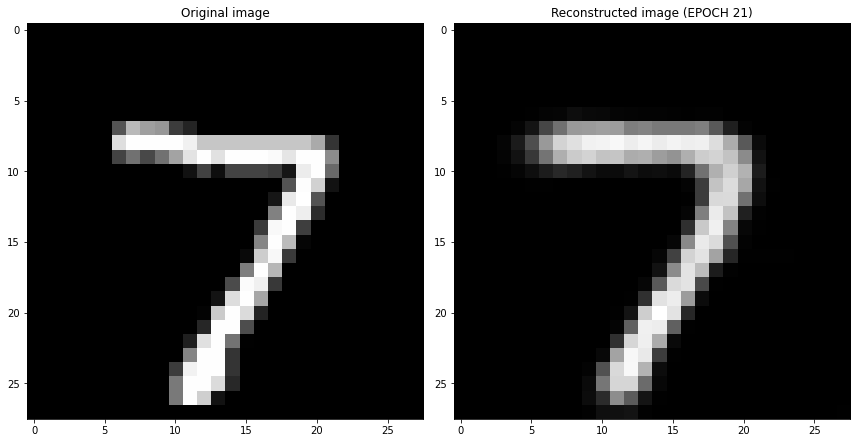

EPOCH 22/30
	 partial train loss (single batch): 0.030397
	 partial train loss (single batch): 0.030629
	 partial train loss (single batch): 0.030509
	 partial train loss (single batch): 0.029167
	 partial train loss (single batch): 0.031309
	 partial train loss (single batch): 0.029874
	 partial train loss (single batch): 0.030887
	 partial train loss (single batch): 0.030131
	 partial train loss (single batch): 0.030826
	 partial train loss (single batch): 0.029843
	 partial train loss (single batch): 0.029928
	 partial train loss (single batch): 0.029092
	 partial train loss (single batch): 0.029184
	 partial train loss (single batch): 0.030091
	 partial train loss (single batch): 0.032330
	 partial train loss (single batch): 0.028374
	 partial train loss (single batch): 0.031646
	 partial train loss (single batch): 0.029451
	 partial train loss (single batch): 0.029767
	 partial train loss (single batch): 0.032677
	 partial train loss (single batch): 0.028080
	 partial train loss (

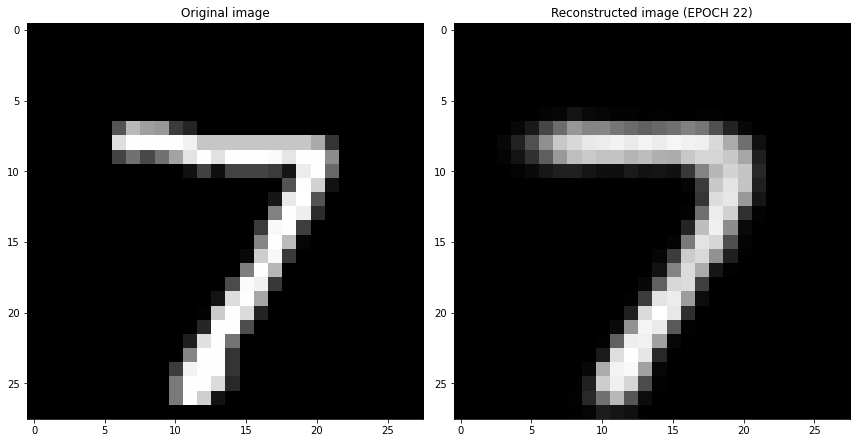

EPOCH 23/30
	 partial train loss (single batch): 0.030774
	 partial train loss (single batch): 0.028115
	 partial train loss (single batch): 0.030144
	 partial train loss (single batch): 0.030587
	 partial train loss (single batch): 0.030349
	 partial train loss (single batch): 0.029539
	 partial train loss (single batch): 0.028135
	 partial train loss (single batch): 0.029792
	 partial train loss (single batch): 0.029725
	 partial train loss (single batch): 0.028455
	 partial train loss (single batch): 0.030592
	 partial train loss (single batch): 0.028985
	 partial train loss (single batch): 0.027788
	 partial train loss (single batch): 0.031580
	 partial train loss (single batch): 0.028968
	 partial train loss (single batch): 0.031065
	 partial train loss (single batch): 0.028145
	 partial train loss (single batch): 0.029107
	 partial train loss (single batch): 0.029102
	 partial train loss (single batch): 0.029210
	 partial train loss (single batch): 0.030182
	 partial train loss (

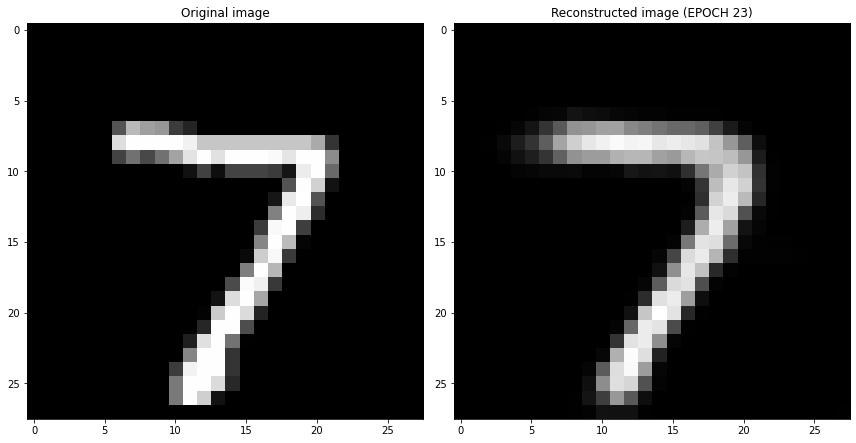

EPOCH 24/30
	 partial train loss (single batch): 0.027822
	 partial train loss (single batch): 0.031378
	 partial train loss (single batch): 0.028422
	 partial train loss (single batch): 0.029999
	 partial train loss (single batch): 0.030120
	 partial train loss (single batch): 0.027966
	 partial train loss (single batch): 0.029373
	 partial train loss (single batch): 0.029225
	 partial train loss (single batch): 0.029657
	 partial train loss (single batch): 0.030165
	 partial train loss (single batch): 0.029892
	 partial train loss (single batch): 0.028395
	 partial train loss (single batch): 0.030346
	 partial train loss (single batch): 0.029766
	 partial train loss (single batch): 0.030178
	 partial train loss (single batch): 0.029679
	 partial train loss (single batch): 0.030716
	 partial train loss (single batch): 0.030525
	 partial train loss (single batch): 0.028785
	 partial train loss (single batch): 0.029872
	 partial train loss (single batch): 0.028905
	 partial train loss (

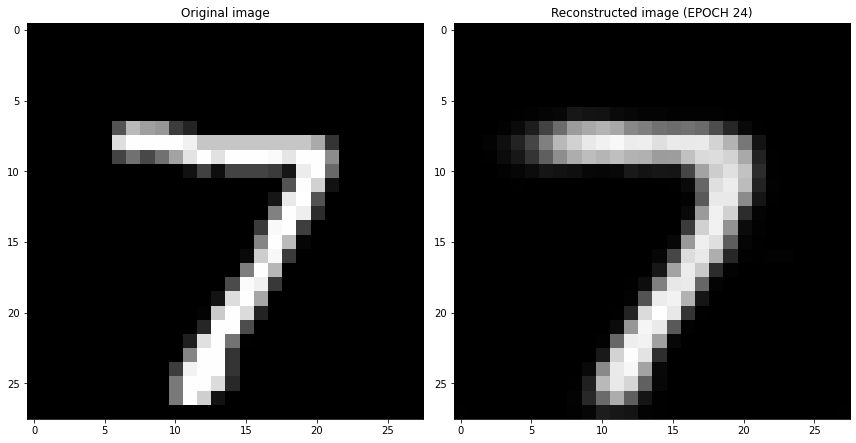

EPOCH 25/30
	 partial train loss (single batch): 0.029847
	 partial train loss (single batch): 0.028057
	 partial train loss (single batch): 0.029660
	 partial train loss (single batch): 0.031532
	 partial train loss (single batch): 0.030976
	 partial train loss (single batch): 0.029892
	 partial train loss (single batch): 0.029273
	 partial train loss (single batch): 0.028399
	 partial train loss (single batch): 0.029589
	 partial train loss (single batch): 0.028529
	 partial train loss (single batch): 0.028572
	 partial train loss (single batch): 0.028854
	 partial train loss (single batch): 0.028520
	 partial train loss (single batch): 0.027099
	 partial train loss (single batch): 0.029792
	 partial train loss (single batch): 0.027711
	 partial train loss (single batch): 0.029370
	 partial train loss (single batch): 0.029669
	 partial train loss (single batch): 0.027678
	 partial train loss (single batch): 0.028096
	 partial train loss (single batch): 0.029367
	 partial train loss (

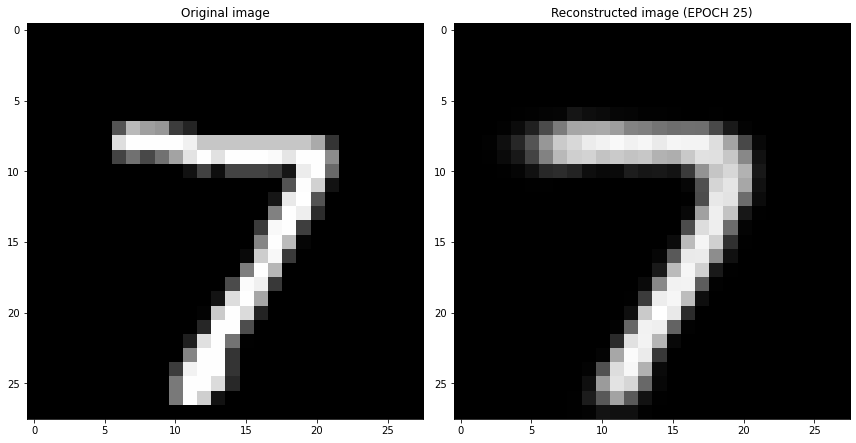

EPOCH 26/30
	 partial train loss (single batch): 0.030006
	 partial train loss (single batch): 0.029558
	 partial train loss (single batch): 0.028032
	 partial train loss (single batch): 0.029704
	 partial train loss (single batch): 0.028655
	 partial train loss (single batch): 0.028700
	 partial train loss (single batch): 0.029133
	 partial train loss (single batch): 0.029605
	 partial train loss (single batch): 0.029946
	 partial train loss (single batch): 0.029333
	 partial train loss (single batch): 0.029135
	 partial train loss (single batch): 0.029010
	 partial train loss (single batch): 0.030005
	 partial train loss (single batch): 0.028837
	 partial train loss (single batch): 0.029718
	 partial train loss (single batch): 0.030802
	 partial train loss (single batch): 0.029258
	 partial train loss (single batch): 0.028788
	 partial train loss (single batch): 0.030566
	 partial train loss (single batch): 0.029377
	 partial train loss (single batch): 0.028815
	 partial train loss (

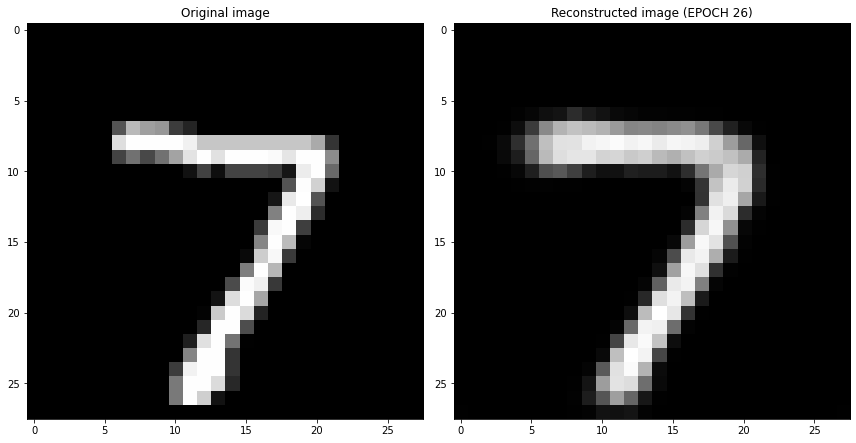

EPOCH 27/30
	 partial train loss (single batch): 0.028717
	 partial train loss (single batch): 0.027952
	 partial train loss (single batch): 0.031118
	 partial train loss (single batch): 0.029934
	 partial train loss (single batch): 0.029202
	 partial train loss (single batch): 0.028312
	 partial train loss (single batch): 0.028814
	 partial train loss (single batch): 0.028538
	 partial train loss (single batch): 0.030222
	 partial train loss (single batch): 0.028828
	 partial train loss (single batch): 0.028115
	 partial train loss (single batch): 0.028420
	 partial train loss (single batch): 0.030034
	 partial train loss (single batch): 0.027983
	 partial train loss (single batch): 0.028010
	 partial train loss (single batch): 0.027090
	 partial train loss (single batch): 0.027937
	 partial train loss (single batch): 0.030060
	 partial train loss (single batch): 0.029497
	 partial train loss (single batch): 0.029189
	 partial train loss (single batch): 0.027759
	 partial train loss (

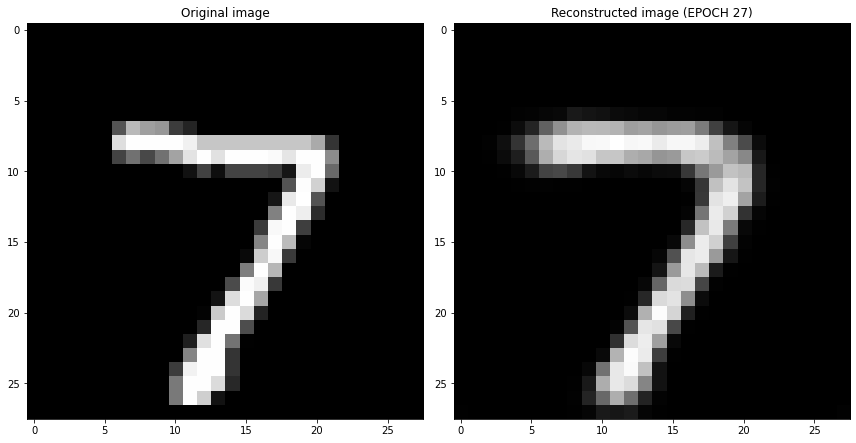

EPOCH 28/30
	 partial train loss (single batch): 0.027537
	 partial train loss (single batch): 0.028905
	 partial train loss (single batch): 0.029608
	 partial train loss (single batch): 0.027594
	 partial train loss (single batch): 0.029056
	 partial train loss (single batch): 0.030093
	 partial train loss (single batch): 0.030644
	 partial train loss (single batch): 0.027892
	 partial train loss (single batch): 0.029536
	 partial train loss (single batch): 0.028696
	 partial train loss (single batch): 0.030693
	 partial train loss (single batch): 0.029124
	 partial train loss (single batch): 0.029080
	 partial train loss (single batch): 0.027740
	 partial train loss (single batch): 0.028976
	 partial train loss (single batch): 0.028532
	 partial train loss (single batch): 0.028021
	 partial train loss (single batch): 0.028391
	 partial train loss (single batch): 0.029751
	 partial train loss (single batch): 0.031336
	 partial train loss (single batch): 0.030539
	 partial train loss (

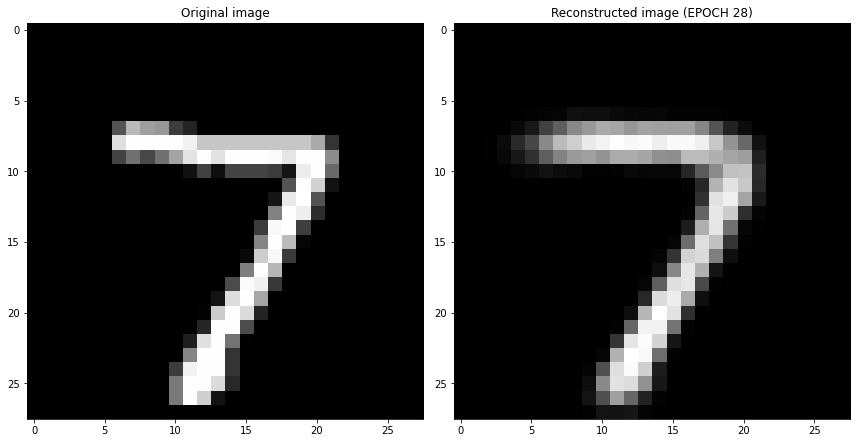

EPOCH 29/30
	 partial train loss (single batch): 0.029381
	 partial train loss (single batch): 0.027912
	 partial train loss (single batch): 0.029650
	 partial train loss (single batch): 0.028876
	 partial train loss (single batch): 0.027920
	 partial train loss (single batch): 0.028775
	 partial train loss (single batch): 0.029864
	 partial train loss (single batch): 0.028226
	 partial train loss (single batch): 0.027437
	 partial train loss (single batch): 0.029732
	 partial train loss (single batch): 0.030554
	 partial train loss (single batch): 0.026565
	 partial train loss (single batch): 0.028498
	 partial train loss (single batch): 0.030891
	 partial train loss (single batch): 0.029715
	 partial train loss (single batch): 0.028216
	 partial train loss (single batch): 0.028923
	 partial train loss (single batch): 0.029445
	 partial train loss (single batch): 0.028440
	 partial train loss (single batch): 0.030048
	 partial train loss (single batch): 0.029580
	 partial train loss (

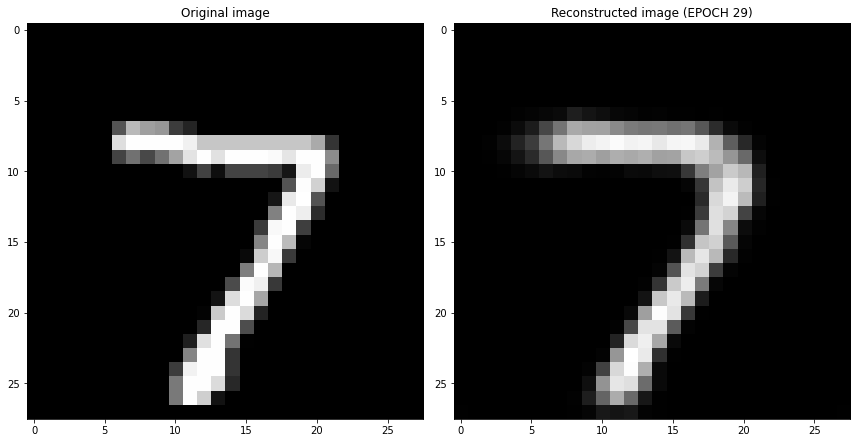

EPOCH 30/30
	 partial train loss (single batch): 0.028770
	 partial train loss (single batch): 0.028596
	 partial train loss (single batch): 0.027866
	 partial train loss (single batch): 0.029023
	 partial train loss (single batch): 0.028764
	 partial train loss (single batch): 0.029746
	 partial train loss (single batch): 0.027701
	 partial train loss (single batch): 0.029866
	 partial train loss (single batch): 0.027796
	 partial train loss (single batch): 0.030309
	 partial train loss (single batch): 0.028374
	 partial train loss (single batch): 0.028884
	 partial train loss (single batch): 0.028655
	 partial train loss (single batch): 0.029829
	 partial train loss (single batch): 0.029720
	 partial train loss (single batch): 0.029031
	 partial train loss (single batch): 0.030028
	 partial train loss (single batch): 0.028283
	 partial train loss (single batch): 0.028867
	 partial train loss (single batch): 0.029958
	 partial train loss (single batch): 0.028924
	 partial train loss (

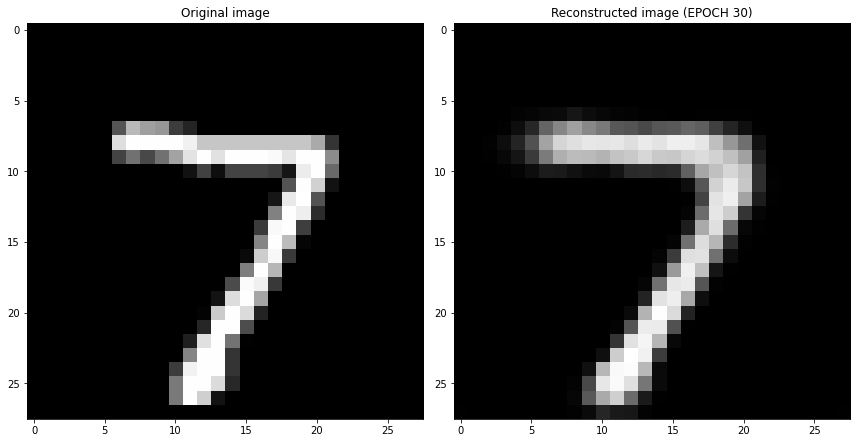

Cross validation fold number= 5/6
EPOCH 1/30
	 partial train loss (single batch): 0.242431
	 partial train loss (single batch): 0.241832
	 partial train loss (single batch): 0.241304
	 partial train loss (single batch): 0.241420
	 partial train loss (single batch): 0.240541
	 partial train loss (single batch): 0.240030
	 partial train loss (single batch): 0.239197
	 partial train loss (single batch): 0.239346
	 partial train loss (single batch): 0.239349
	 partial train loss (single batch): 0.239948
	 partial train loss (single batch): 0.238743
	 partial train loss (single batch): 0.238150
	 partial train loss (single batch): 0.238398
	 partial train loss (single batch): 0.237238
	 partial train loss (single batch): 0.237122
	 partial train loss (single batch): 0.237369
	 partial train loss (single batch): 0.237708
	 partial train loss (single batch): 0.236250
	 partial train loss (single batch): 0.236279
	 partial train loss (single batch): 0.235850
	 partial train loss (single batch)

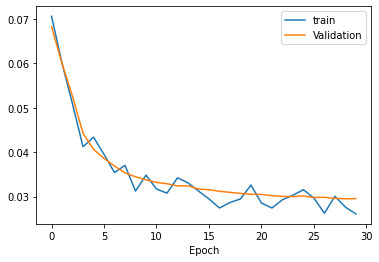

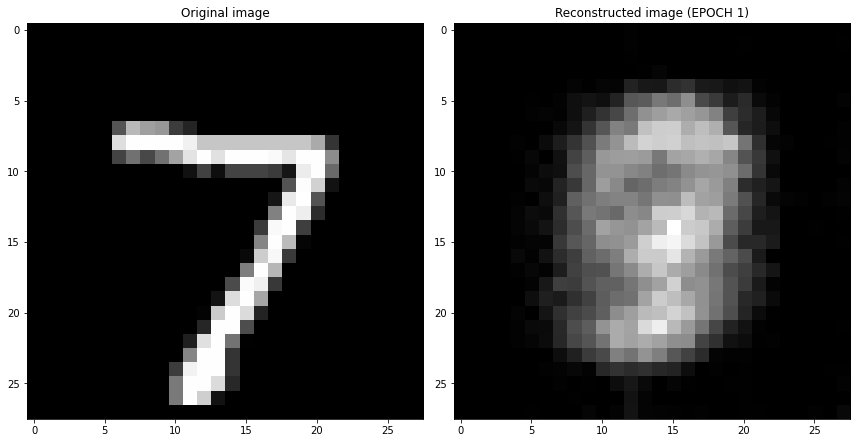

EPOCH 2/30
	 partial train loss (single batch): 0.064819
	 partial train loss (single batch): 0.065542
	 partial train loss (single batch): 0.065037
	 partial train loss (single batch): 0.065883
	 partial train loss (single batch): 0.065977
	 partial train loss (single batch): 0.065823
	 partial train loss (single batch): 0.066198
	 partial train loss (single batch): 0.063004
	 partial train loss (single batch): 0.065692
	 partial train loss (single batch): 0.062579
	 partial train loss (single batch): 0.065671
	 partial train loss (single batch): 0.065633
	 partial train loss (single batch): 0.064713
	 partial train loss (single batch): 0.063168
	 partial train loss (single batch): 0.063408
	 partial train loss (single batch): 0.062498
	 partial train loss (single batch): 0.064308
	 partial train loss (single batch): 0.063314
	 partial train loss (single batch): 0.064721
	 partial train loss (single batch): 0.066939
	 partial train loss (single batch): 0.066053
	 partial train loss (s

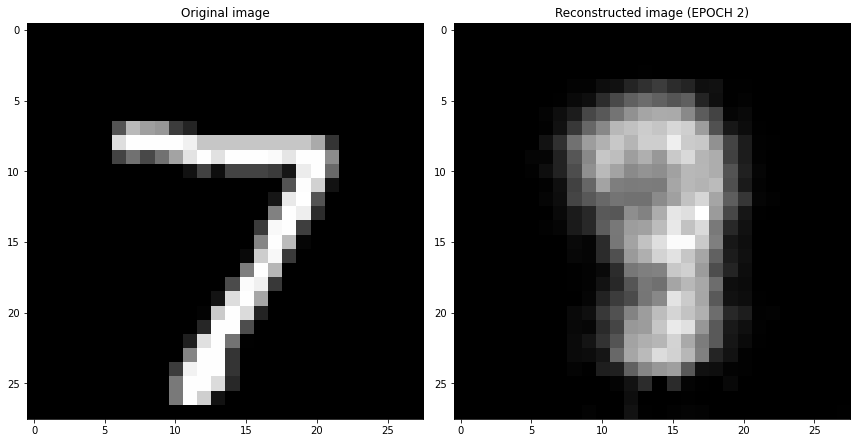

EPOCH 3/30
	 partial train loss (single batch): 0.053519
	 partial train loss (single batch): 0.055160
	 partial train loss (single batch): 0.053661
	 partial train loss (single batch): 0.053537
	 partial train loss (single batch): 0.055889
	 partial train loss (single batch): 0.054474
	 partial train loss (single batch): 0.052061
	 partial train loss (single batch): 0.053090
	 partial train loss (single batch): 0.052476
	 partial train loss (single batch): 0.052359
	 partial train loss (single batch): 0.054263
	 partial train loss (single batch): 0.055736
	 partial train loss (single batch): 0.054638
	 partial train loss (single batch): 0.052744
	 partial train loss (single batch): 0.053620
	 partial train loss (single batch): 0.053684
	 partial train loss (single batch): 0.054322
	 partial train loss (single batch): 0.052259
	 partial train loss (single batch): 0.053186
	 partial train loss (single batch): 0.052527
	 partial train loss (single batch): 0.050726
	 partial train loss (s

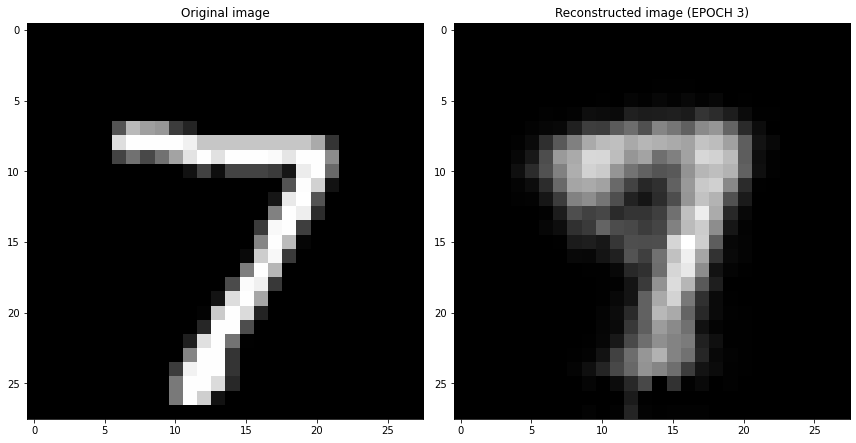

EPOCH 4/30
	 partial train loss (single batch): 0.044264
	 partial train loss (single batch): 0.046063
	 partial train loss (single batch): 0.043392
	 partial train loss (single batch): 0.043916
	 partial train loss (single batch): 0.042649
	 partial train loss (single batch): 0.045497
	 partial train loss (single batch): 0.045349
	 partial train loss (single batch): 0.046397
	 partial train loss (single batch): 0.045176
	 partial train loss (single batch): 0.043335
	 partial train loss (single batch): 0.047028
	 partial train loss (single batch): 0.043837
	 partial train loss (single batch): 0.044713
	 partial train loss (single batch): 0.043417
	 partial train loss (single batch): 0.042852
	 partial train loss (single batch): 0.045209
	 partial train loss (single batch): 0.046515
	 partial train loss (single batch): 0.045697
	 partial train loss (single batch): 0.045689
	 partial train loss (single batch): 0.044082
	 partial train loss (single batch): 0.045235
	 partial train loss (s

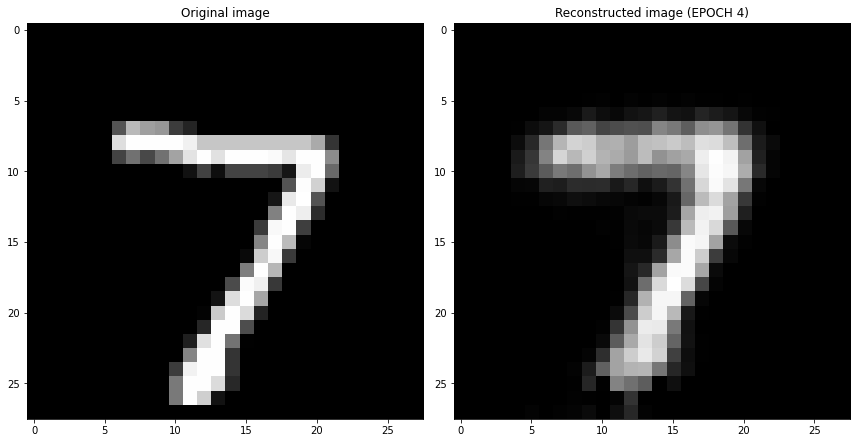

EPOCH 5/30
	 partial train loss (single batch): 0.041172
	 partial train loss (single batch): 0.040554
	 partial train loss (single batch): 0.042618
	 partial train loss (single batch): 0.042906
	 partial train loss (single batch): 0.039975
	 partial train loss (single batch): 0.039385
	 partial train loss (single batch): 0.040396
	 partial train loss (single batch): 0.042812
	 partial train loss (single batch): 0.040888
	 partial train loss (single batch): 0.041133
	 partial train loss (single batch): 0.042416
	 partial train loss (single batch): 0.042417
	 partial train loss (single batch): 0.039535
	 partial train loss (single batch): 0.042241
	 partial train loss (single batch): 0.042939
	 partial train loss (single batch): 0.040185
	 partial train loss (single batch): 0.041492
	 partial train loss (single batch): 0.041830
	 partial train loss (single batch): 0.041671
	 partial train loss (single batch): 0.038870
	 partial train loss (single batch): 0.041993
	 partial train loss (s

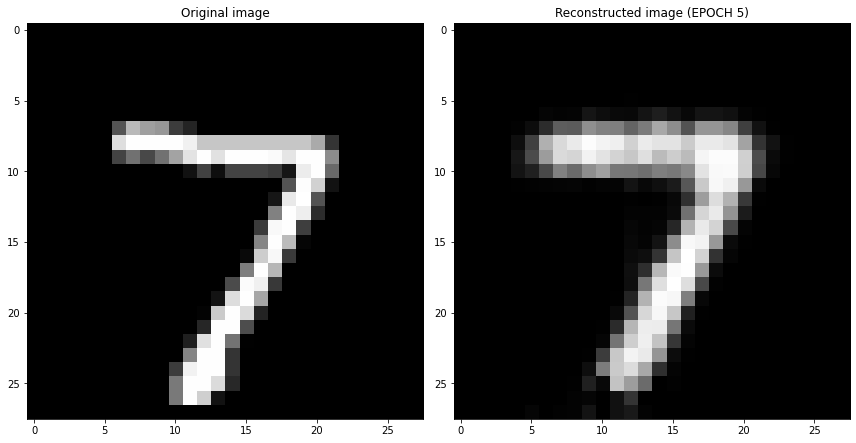

EPOCH 6/30
	 partial train loss (single batch): 0.038198
	 partial train loss (single batch): 0.038451
	 partial train loss (single batch): 0.040365
	 partial train loss (single batch): 0.038739
	 partial train loss (single batch): 0.039311
	 partial train loss (single batch): 0.037596
	 partial train loss (single batch): 0.039734
	 partial train loss (single batch): 0.038423
	 partial train loss (single batch): 0.037151
	 partial train loss (single batch): 0.039072
	 partial train loss (single batch): 0.038825
	 partial train loss (single batch): 0.038815
	 partial train loss (single batch): 0.038925
	 partial train loss (single batch): 0.037550
	 partial train loss (single batch): 0.038682
	 partial train loss (single batch): 0.039875
	 partial train loss (single batch): 0.039911
	 partial train loss (single batch): 0.038187
	 partial train loss (single batch): 0.038694
	 partial train loss (single batch): 0.038501
	 partial train loss (single batch): 0.038963
	 partial train loss (s

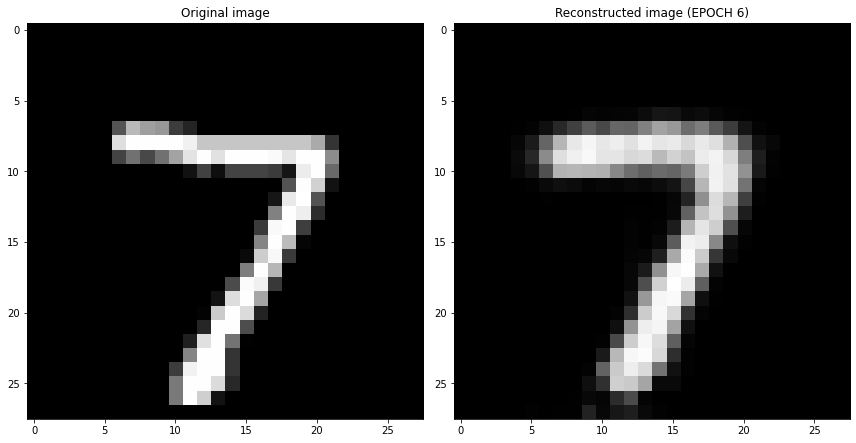

EPOCH 7/30
	 partial train loss (single batch): 0.036183
	 partial train loss (single batch): 0.036747
	 partial train loss (single batch): 0.036474
	 partial train loss (single batch): 0.036837
	 partial train loss (single batch): 0.037234
	 partial train loss (single batch): 0.037749
	 partial train loss (single batch): 0.038082
	 partial train loss (single batch): 0.038734
	 partial train loss (single batch): 0.037647
	 partial train loss (single batch): 0.035255
	 partial train loss (single batch): 0.035525
	 partial train loss (single batch): 0.038282
	 partial train loss (single batch): 0.037879
	 partial train loss (single batch): 0.036125
	 partial train loss (single batch): 0.036623
	 partial train loss (single batch): 0.036663
	 partial train loss (single batch): 0.037824
	 partial train loss (single batch): 0.036690
	 partial train loss (single batch): 0.036331
	 partial train loss (single batch): 0.036396
	 partial train loss (single batch): 0.037237
	 partial train loss (s

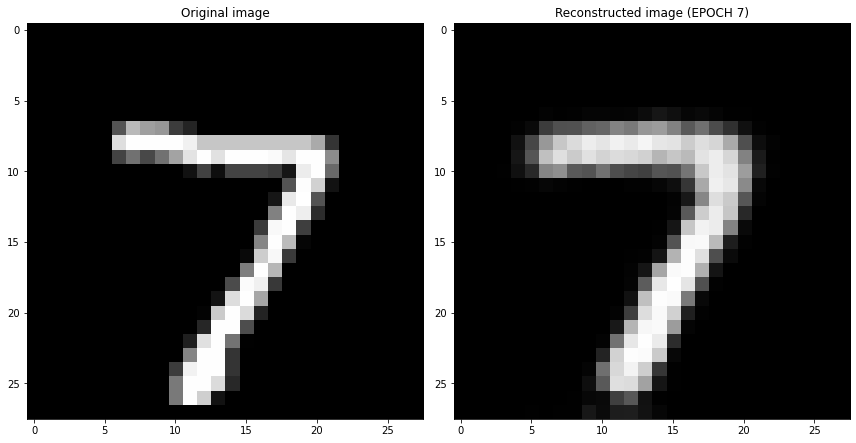

EPOCH 8/30
	 partial train loss (single batch): 0.036746
	 partial train loss (single batch): 0.035398
	 partial train loss (single batch): 0.035171
	 partial train loss (single batch): 0.036642
	 partial train loss (single batch): 0.034442
	 partial train loss (single batch): 0.035888
	 partial train loss (single batch): 0.035792
	 partial train loss (single batch): 0.034772
	 partial train loss (single batch): 0.034506
	 partial train loss (single batch): 0.035273
	 partial train loss (single batch): 0.033816
	 partial train loss (single batch): 0.035841
	 partial train loss (single batch): 0.036796
	 partial train loss (single batch): 0.036321
	 partial train loss (single batch): 0.037247
	 partial train loss (single batch): 0.035475
	 partial train loss (single batch): 0.034268
	 partial train loss (single batch): 0.035058
	 partial train loss (single batch): 0.034863
	 partial train loss (single batch): 0.034359
	 partial train loss (single batch): 0.035752
	 partial train loss (s

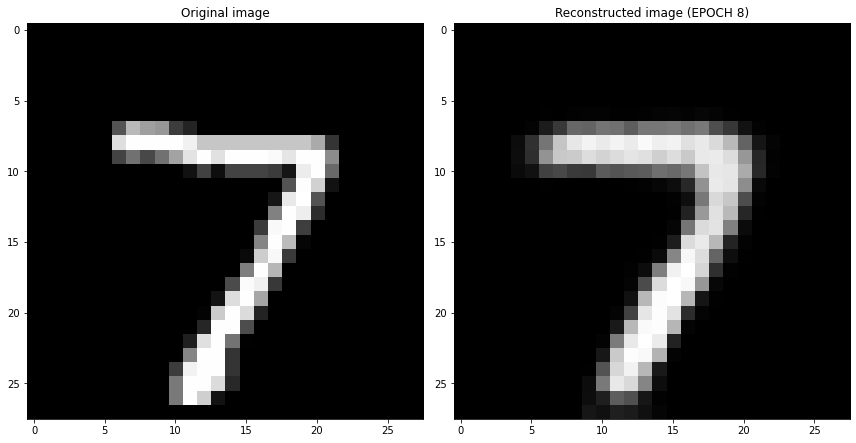

EPOCH 9/30
	 partial train loss (single batch): 0.033970
	 partial train loss (single batch): 0.034703
	 partial train loss (single batch): 0.034496
	 partial train loss (single batch): 0.033391
	 partial train loss (single batch): 0.036259
	 partial train loss (single batch): 0.034741
	 partial train loss (single batch): 0.033700
	 partial train loss (single batch): 0.035760
	 partial train loss (single batch): 0.034839
	 partial train loss (single batch): 0.034504
	 partial train loss (single batch): 0.033786
	 partial train loss (single batch): 0.034465
	 partial train loss (single batch): 0.035207
	 partial train loss (single batch): 0.034820
	 partial train loss (single batch): 0.035192
	 partial train loss (single batch): 0.034716
	 partial train loss (single batch): 0.035639
	 partial train loss (single batch): 0.034983
	 partial train loss (single batch): 0.033908
	 partial train loss (single batch): 0.034945
	 partial train loss (single batch): 0.035885
	 partial train loss (s

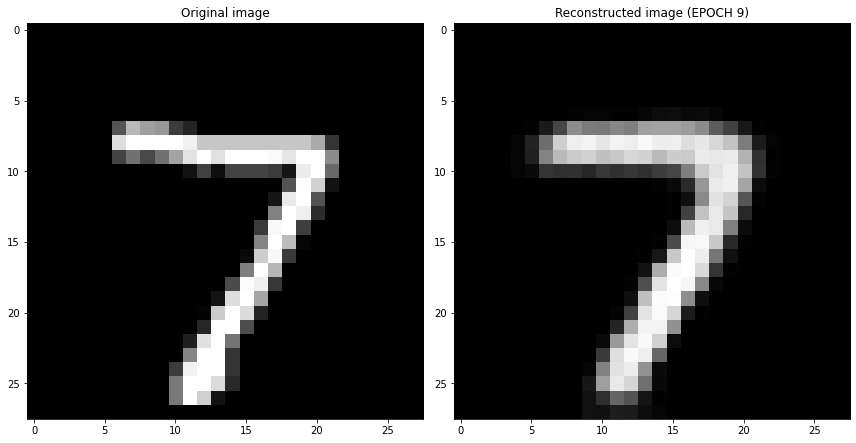

EPOCH 10/30
	 partial train loss (single batch): 0.035903
	 partial train loss (single batch): 0.033532
	 partial train loss (single batch): 0.034691
	 partial train loss (single batch): 0.035269
	 partial train loss (single batch): 0.032738
	 partial train loss (single batch): 0.033161
	 partial train loss (single batch): 0.033859
	 partial train loss (single batch): 0.034295
	 partial train loss (single batch): 0.034745
	 partial train loss (single batch): 0.034670
	 partial train loss (single batch): 0.033920
	 partial train loss (single batch): 0.034237
	 partial train loss (single batch): 0.033645
	 partial train loss (single batch): 0.034725
	 partial train loss (single batch): 0.034510
	 partial train loss (single batch): 0.034100
	 partial train loss (single batch): 0.036385
	 partial train loss (single batch): 0.033754
	 partial train loss (single batch): 0.031381
	 partial train loss (single batch): 0.033794
	 partial train loss (single batch): 0.032249
	 partial train loss (

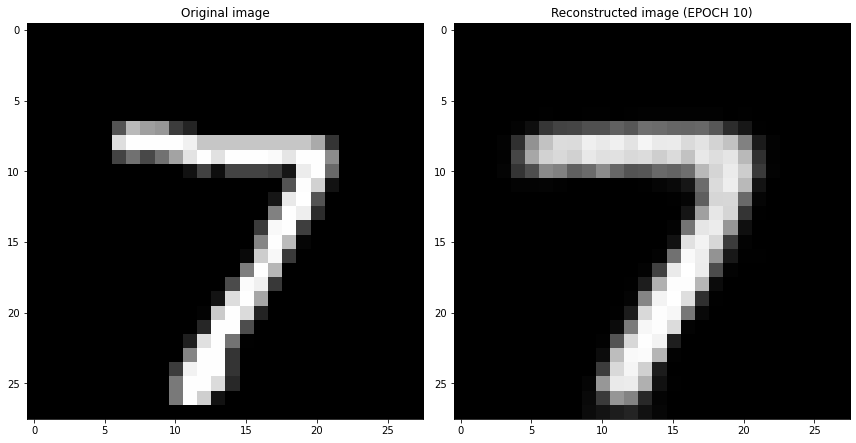

EPOCH 11/30
	 partial train loss (single batch): 0.032297
	 partial train loss (single batch): 0.034785
	 partial train loss (single batch): 0.032608
	 partial train loss (single batch): 0.034281
	 partial train loss (single batch): 0.033171
	 partial train loss (single batch): 0.032200
	 partial train loss (single batch): 0.032708
	 partial train loss (single batch): 0.032844
	 partial train loss (single batch): 0.032689
	 partial train loss (single batch): 0.033716
	 partial train loss (single batch): 0.033541
	 partial train loss (single batch): 0.034173
	 partial train loss (single batch): 0.033403
	 partial train loss (single batch): 0.033371
	 partial train loss (single batch): 0.033186
	 partial train loss (single batch): 0.033131
	 partial train loss (single batch): 0.034868
	 partial train loss (single batch): 0.032859
	 partial train loss (single batch): 0.033956
	 partial train loss (single batch): 0.032530
	 partial train loss (single batch): 0.032972
	 partial train loss (

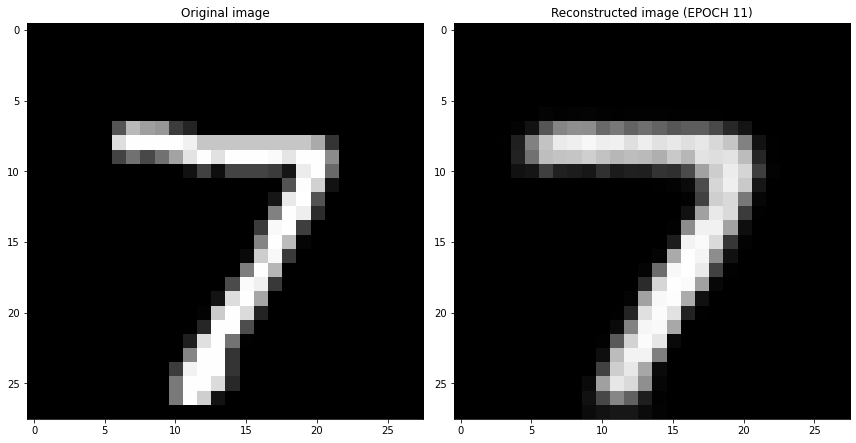

EPOCH 12/30
	 partial train loss (single batch): 0.034282
	 partial train loss (single batch): 0.032679
	 partial train loss (single batch): 0.032562
	 partial train loss (single batch): 0.031030
	 partial train loss (single batch): 0.032198
	 partial train loss (single batch): 0.032242
	 partial train loss (single batch): 0.032707
	 partial train loss (single batch): 0.032707
	 partial train loss (single batch): 0.033011
	 partial train loss (single batch): 0.031346
	 partial train loss (single batch): 0.033397
	 partial train loss (single batch): 0.034232
	 partial train loss (single batch): 0.031816
	 partial train loss (single batch): 0.032911
	 partial train loss (single batch): 0.033042
	 partial train loss (single batch): 0.033102
	 partial train loss (single batch): 0.033510
	 partial train loss (single batch): 0.033125
	 partial train loss (single batch): 0.034326
	 partial train loss (single batch): 0.031109
	 partial train loss (single batch): 0.034817
	 partial train loss (

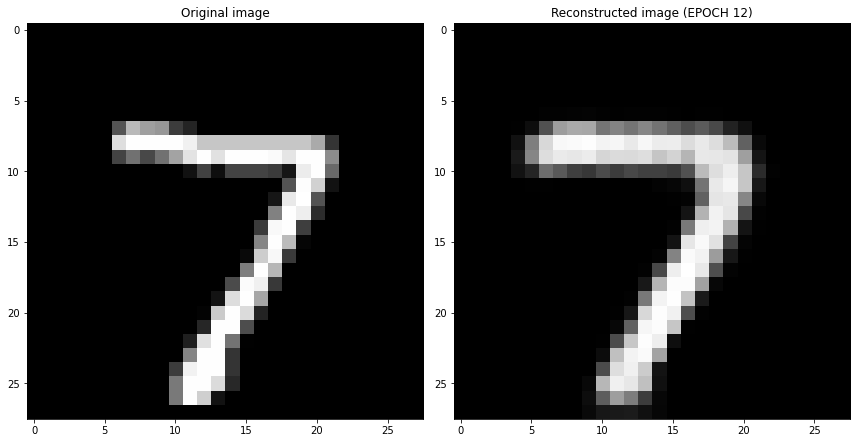

EPOCH 13/30
	 partial train loss (single batch): 0.031079
	 partial train loss (single batch): 0.031524
	 partial train loss (single batch): 0.032972
	 partial train loss (single batch): 0.031312
	 partial train loss (single batch): 0.033806
	 partial train loss (single batch): 0.032681
	 partial train loss (single batch): 0.031880
	 partial train loss (single batch): 0.033427
	 partial train loss (single batch): 0.031799
	 partial train loss (single batch): 0.030931
	 partial train loss (single batch): 0.032285
	 partial train loss (single batch): 0.032445
	 partial train loss (single batch): 0.032383
	 partial train loss (single batch): 0.031689
	 partial train loss (single batch): 0.031362
	 partial train loss (single batch): 0.030999
	 partial train loss (single batch): 0.032940
	 partial train loss (single batch): 0.031708
	 partial train loss (single batch): 0.031804
	 partial train loss (single batch): 0.033394
	 partial train loss (single batch): 0.033907
	 partial train loss (

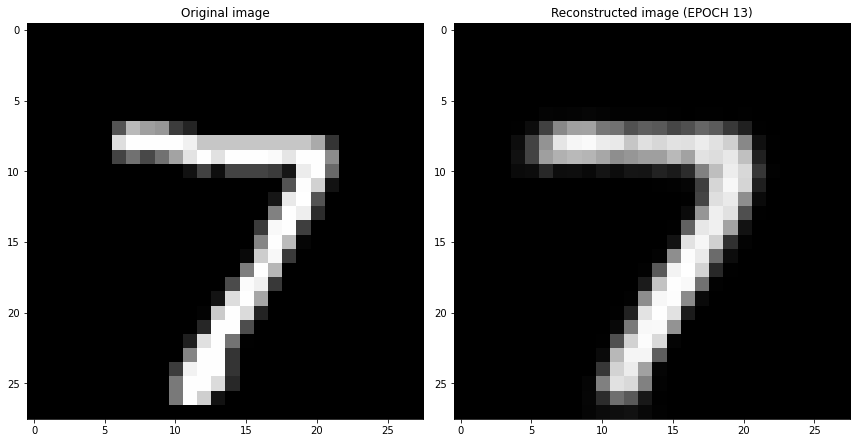

EPOCH 14/30
	 partial train loss (single batch): 0.032306
	 partial train loss (single batch): 0.033307
	 partial train loss (single batch): 0.032401
	 partial train loss (single batch): 0.031971
	 partial train loss (single batch): 0.031134
	 partial train loss (single batch): 0.030672
	 partial train loss (single batch): 0.030346
	 partial train loss (single batch): 0.031870
	 partial train loss (single batch): 0.032623
	 partial train loss (single batch): 0.031941
	 partial train loss (single batch): 0.032448
	 partial train loss (single batch): 0.032084
	 partial train loss (single batch): 0.029984
	 partial train loss (single batch): 0.030041
	 partial train loss (single batch): 0.030959
	 partial train loss (single batch): 0.031359
	 partial train loss (single batch): 0.032028
	 partial train loss (single batch): 0.031520
	 partial train loss (single batch): 0.029668
	 partial train loss (single batch): 0.031895
	 partial train loss (single batch): 0.032917
	 partial train loss (

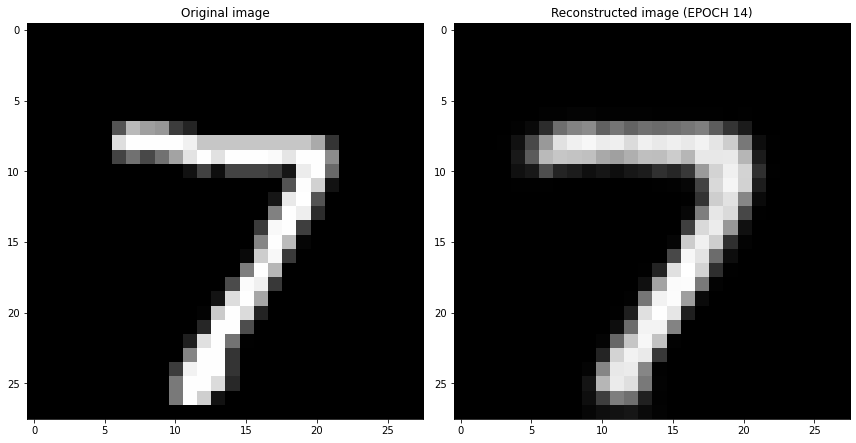

EPOCH 15/30
	 partial train loss (single batch): 0.031861
	 partial train loss (single batch): 0.031948
	 partial train loss (single batch): 0.031301
	 partial train loss (single batch): 0.028556
	 partial train loss (single batch): 0.032741
	 partial train loss (single batch): 0.033666
	 partial train loss (single batch): 0.030522
	 partial train loss (single batch): 0.031832
	 partial train loss (single batch): 0.032451
	 partial train loss (single batch): 0.032032
	 partial train loss (single batch): 0.032431
	 partial train loss (single batch): 0.031951
	 partial train loss (single batch): 0.031727
	 partial train loss (single batch): 0.030325
	 partial train loss (single batch): 0.029836
	 partial train loss (single batch): 0.033468
	 partial train loss (single batch): 0.029512
	 partial train loss (single batch): 0.031644
	 partial train loss (single batch): 0.031515
	 partial train loss (single batch): 0.030190
	 partial train loss (single batch): 0.030081
	 partial train loss (

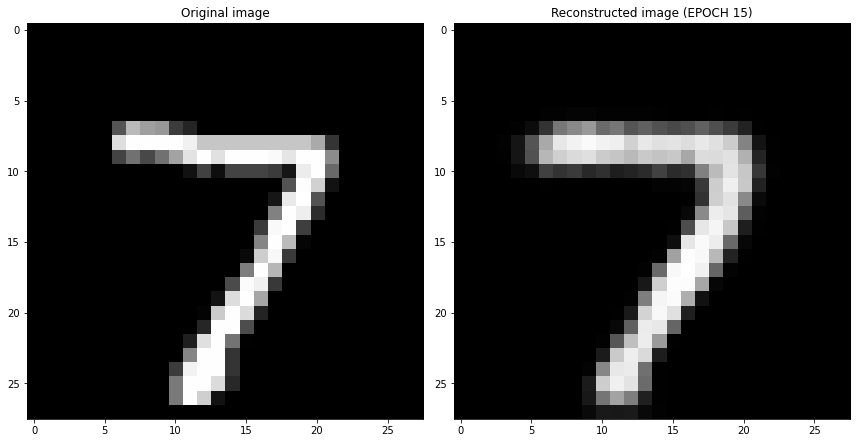

EPOCH 16/30
	 partial train loss (single batch): 0.031779
	 partial train loss (single batch): 0.030958
	 partial train loss (single batch): 0.030481
	 partial train loss (single batch): 0.031235
	 partial train loss (single batch): 0.030572
	 partial train loss (single batch): 0.029657
	 partial train loss (single batch): 0.030683
	 partial train loss (single batch): 0.031019
	 partial train loss (single batch): 0.030279
	 partial train loss (single batch): 0.031018
	 partial train loss (single batch): 0.031037
	 partial train loss (single batch): 0.030039
	 partial train loss (single batch): 0.030654
	 partial train loss (single batch): 0.030651
	 partial train loss (single batch): 0.032155
	 partial train loss (single batch): 0.030245
	 partial train loss (single batch): 0.028593
	 partial train loss (single batch): 0.031191
	 partial train loss (single batch): 0.031898
	 partial train loss (single batch): 0.030546
	 partial train loss (single batch): 0.031187
	 partial train loss (

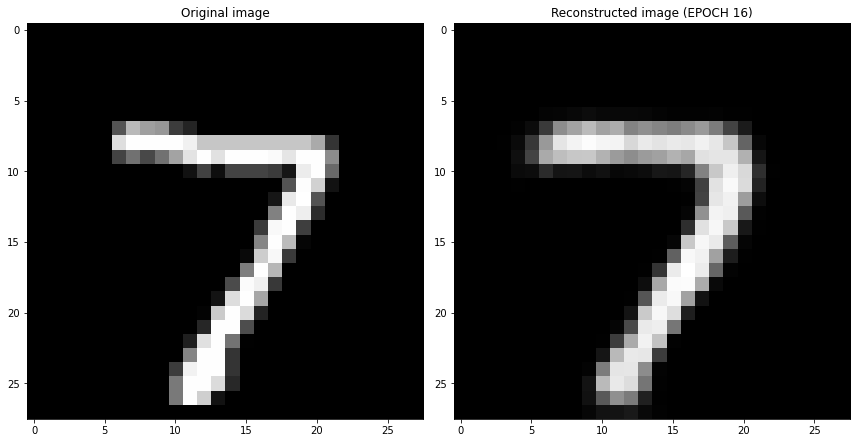

EPOCH 17/30
	 partial train loss (single batch): 0.029996
	 partial train loss (single batch): 0.031073
	 partial train loss (single batch): 0.029197
	 partial train loss (single batch): 0.032441
	 partial train loss (single batch): 0.031662
	 partial train loss (single batch): 0.031574
	 partial train loss (single batch): 0.031859
	 partial train loss (single batch): 0.031603
	 partial train loss (single batch): 0.030820
	 partial train loss (single batch): 0.028877
	 partial train loss (single batch): 0.030400
	 partial train loss (single batch): 0.030328
	 partial train loss (single batch): 0.029888
	 partial train loss (single batch): 0.029828
	 partial train loss (single batch): 0.032084
	 partial train loss (single batch): 0.029382
	 partial train loss (single batch): 0.029491
	 partial train loss (single batch): 0.031556
	 partial train loss (single batch): 0.029797
	 partial train loss (single batch): 0.030996
	 partial train loss (single batch): 0.031017
	 partial train loss (

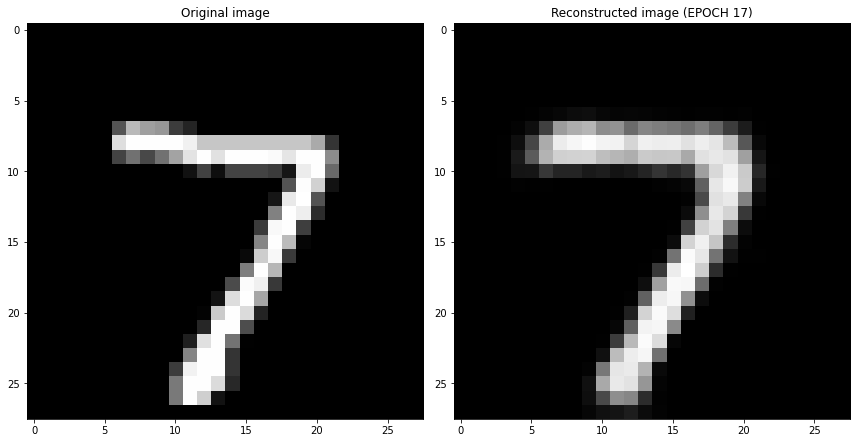

EPOCH 18/30
	 partial train loss (single batch): 0.029061
	 partial train loss (single batch): 0.030590
	 partial train loss (single batch): 0.029701
	 partial train loss (single batch): 0.029647
	 partial train loss (single batch): 0.030599
	 partial train loss (single batch): 0.031094
	 partial train loss (single batch): 0.030854
	 partial train loss (single batch): 0.031274
	 partial train loss (single batch): 0.031441
	 partial train loss (single batch): 0.029476
	 partial train loss (single batch): 0.029562
	 partial train loss (single batch): 0.030668
	 partial train loss (single batch): 0.028965
	 partial train loss (single batch): 0.031942
	 partial train loss (single batch): 0.029564
	 partial train loss (single batch): 0.031113
	 partial train loss (single batch): 0.030203
	 partial train loss (single batch): 0.030113
	 partial train loss (single batch): 0.028179
	 partial train loss (single batch): 0.029391
	 partial train loss (single batch): 0.031188
	 partial train loss (

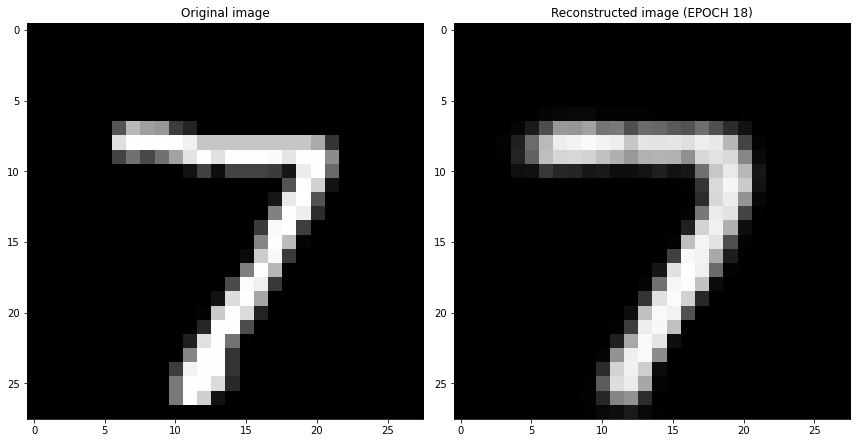

EPOCH 19/30
	 partial train loss (single batch): 0.031099
	 partial train loss (single batch): 0.027617
	 partial train loss (single batch): 0.031206
	 partial train loss (single batch): 0.028794
	 partial train loss (single batch): 0.028649
	 partial train loss (single batch): 0.029111
	 partial train loss (single batch): 0.031145
	 partial train loss (single batch): 0.030937
	 partial train loss (single batch): 0.031695
	 partial train loss (single batch): 0.030297
	 partial train loss (single batch): 0.031081
	 partial train loss (single batch): 0.029485
	 partial train loss (single batch): 0.030407
	 partial train loss (single batch): 0.030175
	 partial train loss (single batch): 0.029816
	 partial train loss (single batch): 0.029468
	 partial train loss (single batch): 0.029531
	 partial train loss (single batch): 0.031182
	 partial train loss (single batch): 0.030346
	 partial train loss (single batch): 0.030254
	 partial train loss (single batch): 0.031195
	 partial train loss (

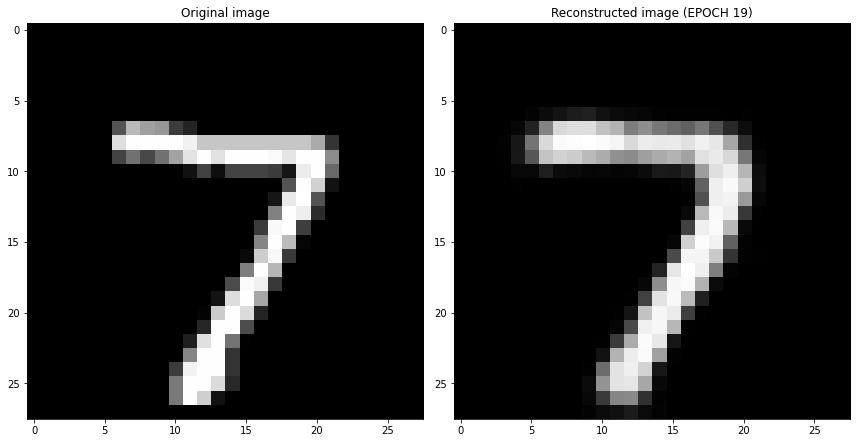

EPOCH 20/30
	 partial train loss (single batch): 0.031340
	 partial train loss (single batch): 0.029289
	 partial train loss (single batch): 0.031280
	 partial train loss (single batch): 0.029748
	 partial train loss (single batch): 0.029029
	 partial train loss (single batch): 0.029516
	 partial train loss (single batch): 0.029456
	 partial train loss (single batch): 0.030466
	 partial train loss (single batch): 0.029255
	 partial train loss (single batch): 0.028775
	 partial train loss (single batch): 0.029684
	 partial train loss (single batch): 0.029834
	 partial train loss (single batch): 0.029719
	 partial train loss (single batch): 0.030402
	 partial train loss (single batch): 0.029888
	 partial train loss (single batch): 0.030106
	 partial train loss (single batch): 0.031459
	 partial train loss (single batch): 0.029123
	 partial train loss (single batch): 0.030275
	 partial train loss (single batch): 0.027530
	 partial train loss (single batch): 0.029582
	 partial train loss (

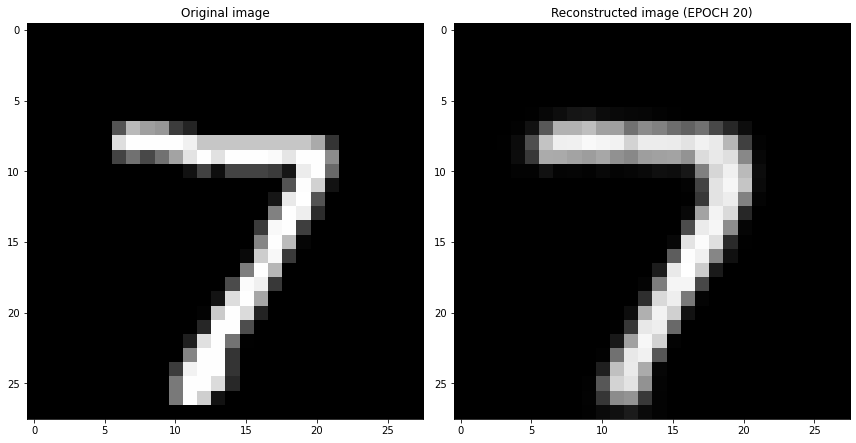

EPOCH 21/30
	 partial train loss (single batch): 0.029316
	 partial train loss (single batch): 0.030592
	 partial train loss (single batch): 0.030279
	 partial train loss (single batch): 0.028089
	 partial train loss (single batch): 0.030268
	 partial train loss (single batch): 0.029542
	 partial train loss (single batch): 0.029890
	 partial train loss (single batch): 0.029865
	 partial train loss (single batch): 0.030528
	 partial train loss (single batch): 0.029113
	 partial train loss (single batch): 0.030022
	 partial train loss (single batch): 0.028878
	 partial train loss (single batch): 0.029613
	 partial train loss (single batch): 0.029031
	 partial train loss (single batch): 0.028052
	 partial train loss (single batch): 0.028743
	 partial train loss (single batch): 0.029202
	 partial train loss (single batch): 0.027557
	 partial train loss (single batch): 0.030317
	 partial train loss (single batch): 0.030961
	 partial train loss (single batch): 0.027674
	 partial train loss (

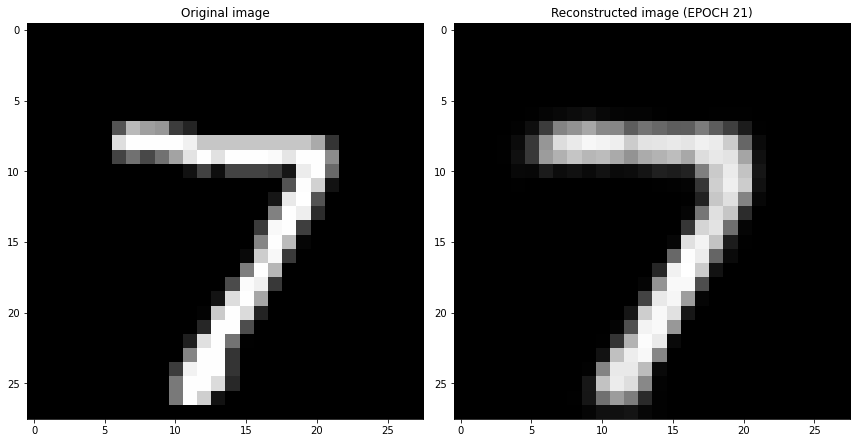

EPOCH 22/30
	 partial train loss (single batch): 0.029548
	 partial train loss (single batch): 0.028558
	 partial train loss (single batch): 0.031361
	 partial train loss (single batch): 0.029214
	 partial train loss (single batch): 0.027905
	 partial train loss (single batch): 0.029696
	 partial train loss (single batch): 0.029578
	 partial train loss (single batch): 0.030583
	 partial train loss (single batch): 0.029890
	 partial train loss (single batch): 0.027736
	 partial train loss (single batch): 0.029578
	 partial train loss (single batch): 0.027194
	 partial train loss (single batch): 0.030152
	 partial train loss (single batch): 0.031842
	 partial train loss (single batch): 0.030678
	 partial train loss (single batch): 0.028504
	 partial train loss (single batch): 0.029405
	 partial train loss (single batch): 0.028627
	 partial train loss (single batch): 0.030345
	 partial train loss (single batch): 0.030183
	 partial train loss (single batch): 0.030620
	 partial train loss (

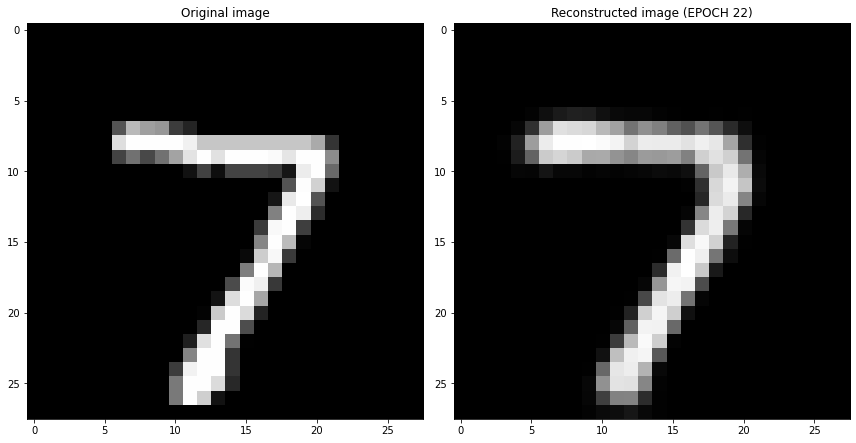

EPOCH 23/30
	 partial train loss (single batch): 0.031006
	 partial train loss (single batch): 0.028710
	 partial train loss (single batch): 0.027992
	 partial train loss (single batch): 0.030605
	 partial train loss (single batch): 0.030549
	 partial train loss (single batch): 0.028495
	 partial train loss (single batch): 0.030167
	 partial train loss (single batch): 0.031381
	 partial train loss (single batch): 0.027740
	 partial train loss (single batch): 0.030166
	 partial train loss (single batch): 0.028368
	 partial train loss (single batch): 0.030337
	 partial train loss (single batch): 0.028935
	 partial train loss (single batch): 0.029940
	 partial train loss (single batch): 0.030574
	 partial train loss (single batch): 0.030680
	 partial train loss (single batch): 0.028523
	 partial train loss (single batch): 0.028709
	 partial train loss (single batch): 0.028164
	 partial train loss (single batch): 0.028304
	 partial train loss (single batch): 0.029306
	 partial train loss (

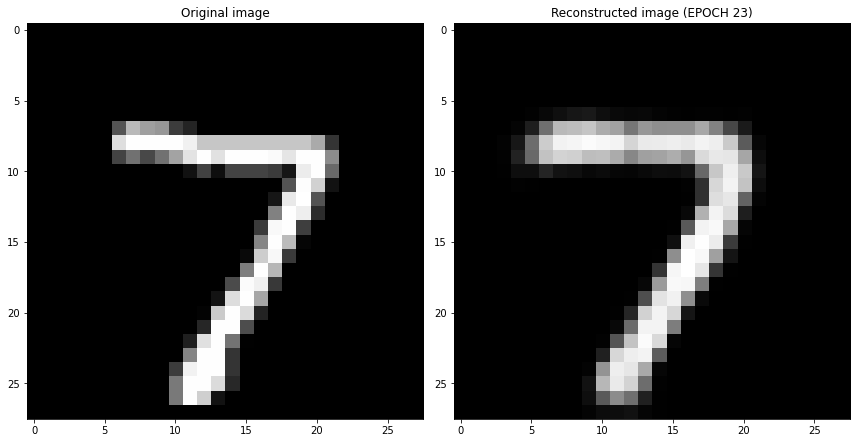

EPOCH 24/30
	 partial train loss (single batch): 0.029394
	 partial train loss (single batch): 0.029995
	 partial train loss (single batch): 0.029377
	 partial train loss (single batch): 0.030745
	 partial train loss (single batch): 0.029645
	 partial train loss (single batch): 0.028138
	 partial train loss (single batch): 0.028675
	 partial train loss (single batch): 0.029702
	 partial train loss (single batch): 0.029859
	 partial train loss (single batch): 0.030146
	 partial train loss (single batch): 0.028367
	 partial train loss (single batch): 0.029900
	 partial train loss (single batch): 0.027963
	 partial train loss (single batch): 0.028418
	 partial train loss (single batch): 0.028984
	 partial train loss (single batch): 0.030201
	 partial train loss (single batch): 0.028945
	 partial train loss (single batch): 0.029071
	 partial train loss (single batch): 0.029170
	 partial train loss (single batch): 0.029888
	 partial train loss (single batch): 0.029650
	 partial train loss (

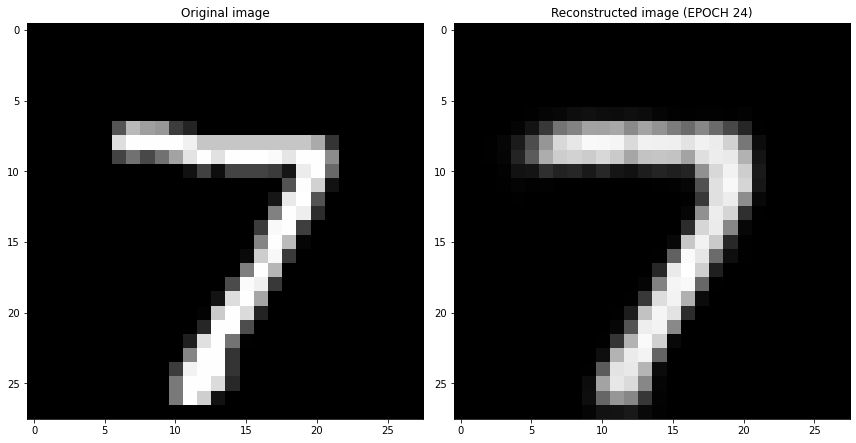

EPOCH 25/30
	 partial train loss (single batch): 0.028681
	 partial train loss (single batch): 0.028743
	 partial train loss (single batch): 0.029099
	 partial train loss (single batch): 0.030620
	 partial train loss (single batch): 0.029728
	 partial train loss (single batch): 0.027632
	 partial train loss (single batch): 0.030161
	 partial train loss (single batch): 0.027687
	 partial train loss (single batch): 0.029778
	 partial train loss (single batch): 0.027748
	 partial train loss (single batch): 0.027949
	 partial train loss (single batch): 0.029310
	 partial train loss (single batch): 0.028823
	 partial train loss (single batch): 0.027803
	 partial train loss (single batch): 0.027230
	 partial train loss (single batch): 0.028574
	 partial train loss (single batch): 0.029482
	 partial train loss (single batch): 0.029570
	 partial train loss (single batch): 0.028769
	 partial train loss (single batch): 0.029409
	 partial train loss (single batch): 0.027269
	 partial train loss (

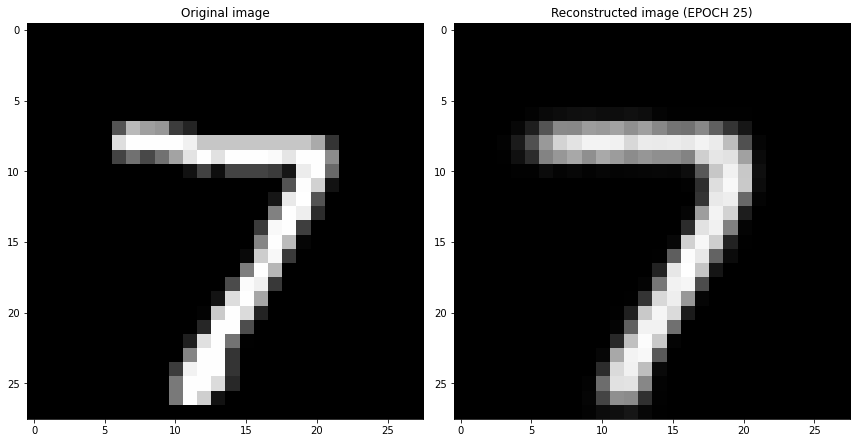

EPOCH 26/30
	 partial train loss (single batch): 0.030367
	 partial train loss (single batch): 0.029420
	 partial train loss (single batch): 0.028871
	 partial train loss (single batch): 0.028639
	 partial train loss (single batch): 0.029803
	 partial train loss (single batch): 0.027743
	 partial train loss (single batch): 0.028338
	 partial train loss (single batch): 0.028658
	 partial train loss (single batch): 0.030728
	 partial train loss (single batch): 0.029490
	 partial train loss (single batch): 0.030205
	 partial train loss (single batch): 0.028777
	 partial train loss (single batch): 0.029947
	 partial train loss (single batch): 0.028292
	 partial train loss (single batch): 0.028744
	 partial train loss (single batch): 0.028689
	 partial train loss (single batch): 0.029717
	 partial train loss (single batch): 0.028413
	 partial train loss (single batch): 0.028384
	 partial train loss (single batch): 0.030392
	 partial train loss (single batch): 0.028888
	 partial train loss (

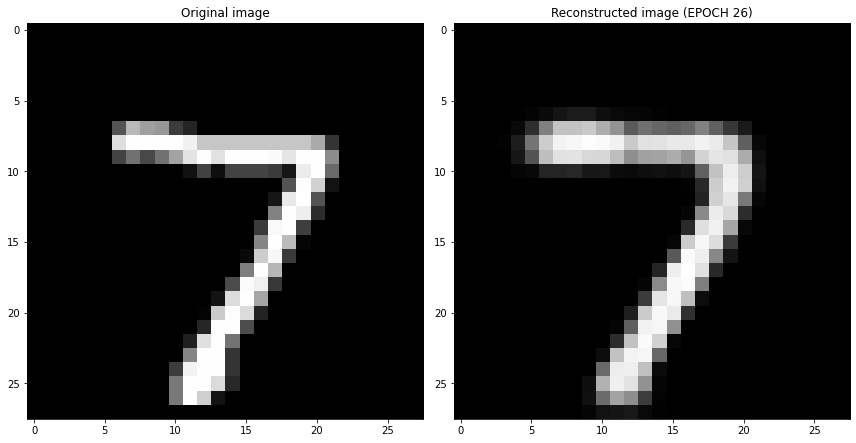

EPOCH 27/30
	 partial train loss (single batch): 0.028017
	 partial train loss (single batch): 0.029074
	 partial train loss (single batch): 0.029951
	 partial train loss (single batch): 0.028066
	 partial train loss (single batch): 0.029120
	 partial train loss (single batch): 0.029836
	 partial train loss (single batch): 0.026874
	 partial train loss (single batch): 0.027703
	 partial train loss (single batch): 0.028794
	 partial train loss (single batch): 0.029224
	 partial train loss (single batch): 0.027910
	 partial train loss (single batch): 0.027630
	 partial train loss (single batch): 0.028286
	 partial train loss (single batch): 0.028224
	 partial train loss (single batch): 0.028128
	 partial train loss (single batch): 0.029680
	 partial train loss (single batch): 0.029280
	 partial train loss (single batch): 0.029494
	 partial train loss (single batch): 0.030025
	 partial train loss (single batch): 0.028911
	 partial train loss (single batch): 0.029060
	 partial train loss (

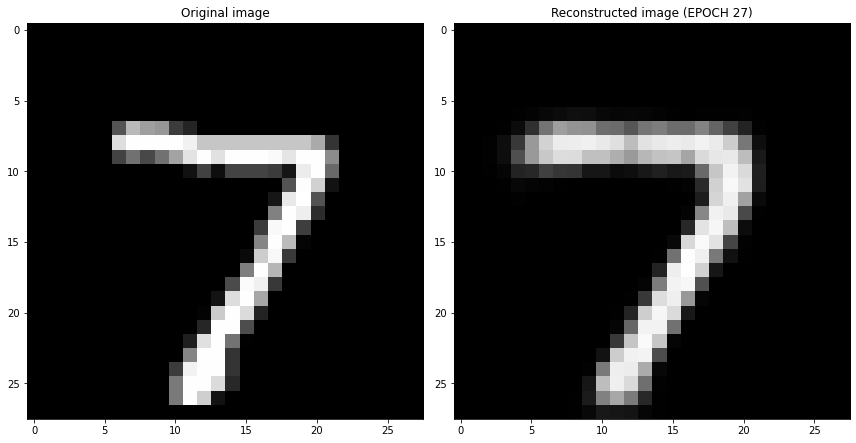

EPOCH 28/30
	 partial train loss (single batch): 0.027168
	 partial train loss (single batch): 0.027879
	 partial train loss (single batch): 0.026763
	 partial train loss (single batch): 0.026840
	 partial train loss (single batch): 0.027857
	 partial train loss (single batch): 0.027985
	 partial train loss (single batch): 0.028522
	 partial train loss (single batch): 0.028225
	 partial train loss (single batch): 0.029322
	 partial train loss (single batch): 0.029240
	 partial train loss (single batch): 0.029900
	 partial train loss (single batch): 0.028006
	 partial train loss (single batch): 0.029648
	 partial train loss (single batch): 0.028161
	 partial train loss (single batch): 0.030057
	 partial train loss (single batch): 0.028270
	 partial train loss (single batch): 0.029413
	 partial train loss (single batch): 0.027105
	 partial train loss (single batch): 0.028060
	 partial train loss (single batch): 0.026811
	 partial train loss (single batch): 0.028412
	 partial train loss (

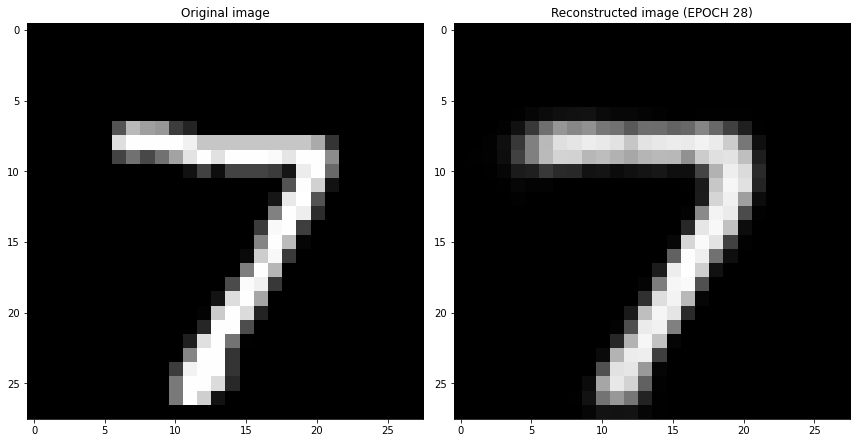

EPOCH 29/30
	 partial train loss (single batch): 0.028144
	 partial train loss (single batch): 0.028094
	 partial train loss (single batch): 0.029066
	 partial train loss (single batch): 0.031102
	 partial train loss (single batch): 0.027708
	 partial train loss (single batch): 0.028069
	 partial train loss (single batch): 0.029026
	 partial train loss (single batch): 0.028108
	 partial train loss (single batch): 0.030847
	 partial train loss (single batch): 0.028196
	 partial train loss (single batch): 0.029169
	 partial train loss (single batch): 0.027092
	 partial train loss (single batch): 0.029613
	 partial train loss (single batch): 0.027994
	 partial train loss (single batch): 0.028767
	 partial train loss (single batch): 0.028474
	 partial train loss (single batch): 0.029982
	 partial train loss (single batch): 0.029211
	 partial train loss (single batch): 0.028383
	 partial train loss (single batch): 0.028608
	 partial train loss (single batch): 0.029428
	 partial train loss (

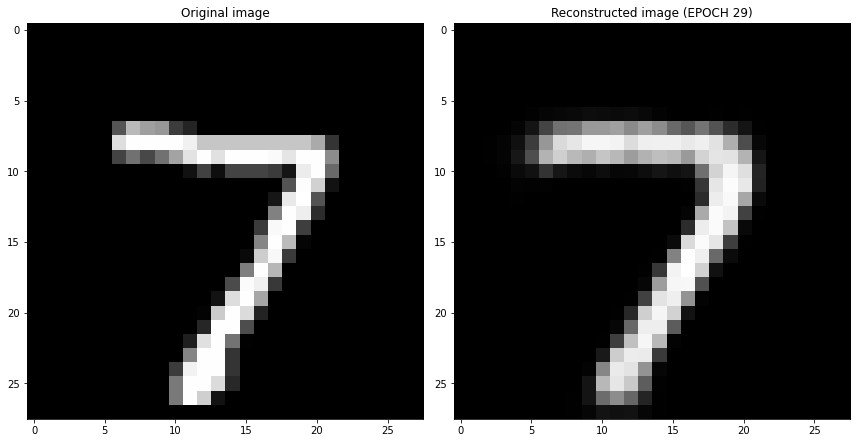

EPOCH 30/30
	 partial train loss (single batch): 0.029208
	 partial train loss (single batch): 0.028223
	 partial train loss (single batch): 0.029517
	 partial train loss (single batch): 0.028687
	 partial train loss (single batch): 0.030005
	 partial train loss (single batch): 0.030427
	 partial train loss (single batch): 0.028669
	 partial train loss (single batch): 0.027151
	 partial train loss (single batch): 0.028548
	 partial train loss (single batch): 0.027981
	 partial train loss (single batch): 0.029588
	 partial train loss (single batch): 0.029052
	 partial train loss (single batch): 0.028771
	 partial train loss (single batch): 0.030512
	 partial train loss (single batch): 0.027811
	 partial train loss (single batch): 0.027370
	 partial train loss (single batch): 0.027283
	 partial train loss (single batch): 0.028394
	 partial train loss (single batch): 0.028032
	 partial train loss (single batch): 0.027450
	 partial train loss (single batch): 0.028660
	 partial train loss (

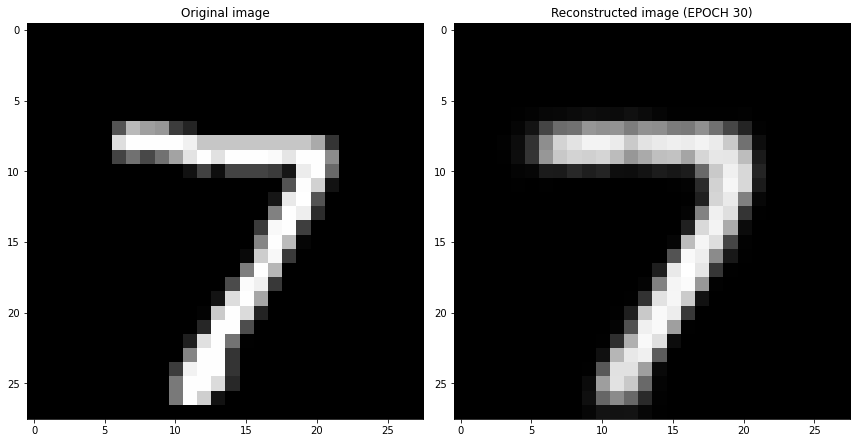

Cross validation fold number= 6/6
EPOCH 1/30
	 partial train loss (single batch): 0.225706
	 partial train loss (single batch): 0.224605
	 partial train loss (single batch): 0.224546
	 partial train loss (single batch): 0.224429
	 partial train loss (single batch): 0.223728
	 partial train loss (single batch): 0.222964
	 partial train loss (single batch): 0.222334
	 partial train loss (single batch): 0.222009
	 partial train loss (single batch): 0.221662
	 partial train loss (single batch): 0.220839
	 partial train loss (single batch): 0.220265
	 partial train loss (single batch): 0.219585
	 partial train loss (single batch): 0.218831
	 partial train loss (single batch): 0.217673
	 partial train loss (single batch): 0.217361
	 partial train loss (single batch): 0.216050
	 partial train loss (single batch): 0.215122
	 partial train loss (single batch): 0.214038
	 partial train loss (single batch): 0.212985
	 partial train loss (single batch): 0.211400
	 partial train loss (single batch)

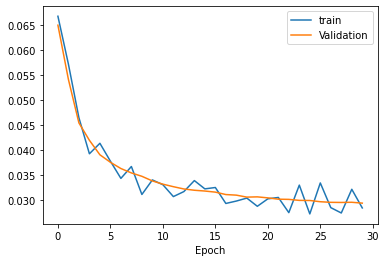

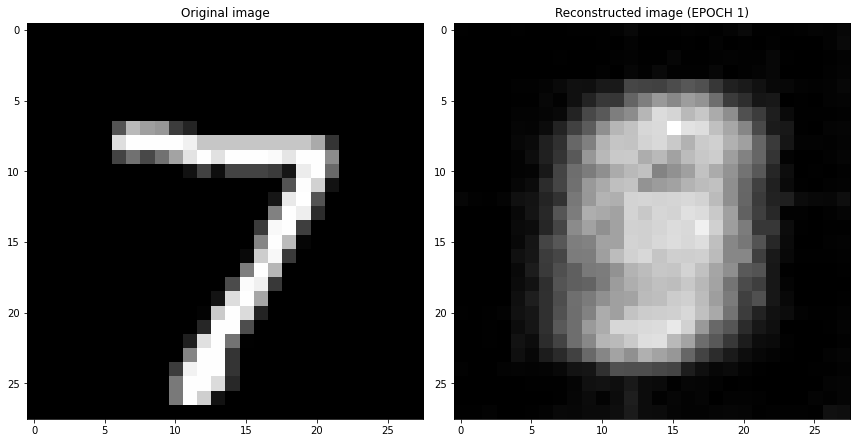

EPOCH 2/30
	 partial train loss (single batch): 0.067082
	 partial train loss (single batch): 0.066494
	 partial train loss (single batch): 0.066082
	 partial train loss (single batch): 0.066278
	 partial train loss (single batch): 0.065152
	 partial train loss (single batch): 0.068322
	 partial train loss (single batch): 0.066220
	 partial train loss (single batch): 0.067654
	 partial train loss (single batch): 0.066075
	 partial train loss (single batch): 0.070207
	 partial train loss (single batch): 0.066895
	 partial train loss (single batch): 0.068348
	 partial train loss (single batch): 0.065876
	 partial train loss (single batch): 0.066907
	 partial train loss (single batch): 0.067185
	 partial train loss (single batch): 0.065527
	 partial train loss (single batch): 0.065996
	 partial train loss (single batch): 0.064801
	 partial train loss (single batch): 0.065397
	 partial train loss (single batch): 0.066739
	 partial train loss (single batch): 0.068884
	 partial train loss (s

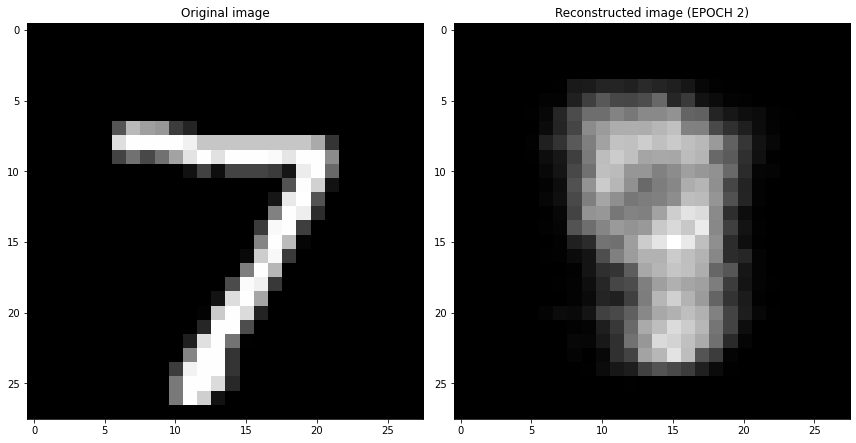

EPOCH 3/30
	 partial train loss (single batch): 0.055703
	 partial train loss (single batch): 0.055796
	 partial train loss (single batch): 0.053742
	 partial train loss (single batch): 0.055609
	 partial train loss (single batch): 0.055693
	 partial train loss (single batch): 0.053621
	 partial train loss (single batch): 0.054502
	 partial train loss (single batch): 0.054921
	 partial train loss (single batch): 0.054235
	 partial train loss (single batch): 0.055634
	 partial train loss (single batch): 0.054186
	 partial train loss (single batch): 0.056173
	 partial train loss (single batch): 0.055076
	 partial train loss (single batch): 0.056331
	 partial train loss (single batch): 0.053935
	 partial train loss (single batch): 0.055550
	 partial train loss (single batch): 0.054724
	 partial train loss (single batch): 0.054979
	 partial train loss (single batch): 0.055111
	 partial train loss (single batch): 0.053572
	 partial train loss (single batch): 0.051753
	 partial train loss (s

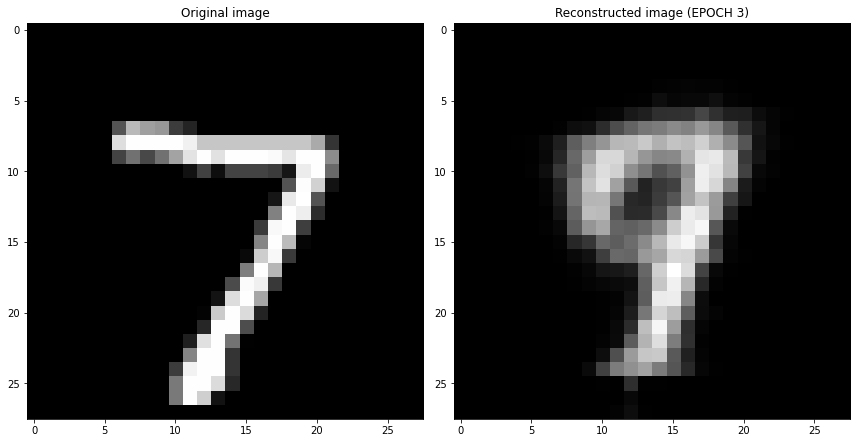

EPOCH 4/30
	 partial train loss (single batch): 0.046113
	 partial train loss (single batch): 0.043627
	 partial train loss (single batch): 0.046582
	 partial train loss (single batch): 0.044995
	 partial train loss (single batch): 0.043780
	 partial train loss (single batch): 0.045548
	 partial train loss (single batch): 0.045039
	 partial train loss (single batch): 0.045960
	 partial train loss (single batch): 0.045084
	 partial train loss (single batch): 0.044286
	 partial train loss (single batch): 0.046000
	 partial train loss (single batch): 0.046479
	 partial train loss (single batch): 0.044771
	 partial train loss (single batch): 0.044814
	 partial train loss (single batch): 0.044399
	 partial train loss (single batch): 0.045165
	 partial train loss (single batch): 0.045589
	 partial train loss (single batch): 0.042351
	 partial train loss (single batch): 0.044741
	 partial train loss (single batch): 0.044412
	 partial train loss (single batch): 0.044083
	 partial train loss (s

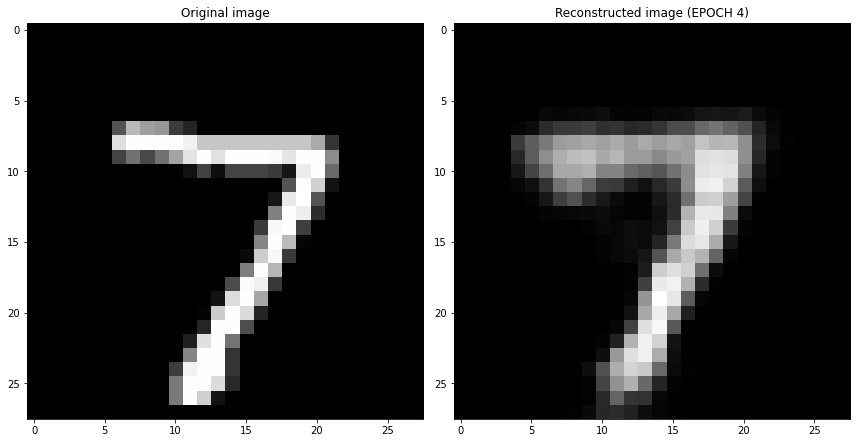

EPOCH 5/30
	 partial train loss (single batch): 0.042092
	 partial train loss (single batch): 0.040397
	 partial train loss (single batch): 0.039107
	 partial train loss (single batch): 0.041348
	 partial train loss (single batch): 0.041706
	 partial train loss (single batch): 0.040664
	 partial train loss (single batch): 0.041677
	 partial train loss (single batch): 0.040023
	 partial train loss (single batch): 0.040185
	 partial train loss (single batch): 0.040893
	 partial train loss (single batch): 0.039931
	 partial train loss (single batch): 0.040705
	 partial train loss (single batch): 0.040702
	 partial train loss (single batch): 0.041246
	 partial train loss (single batch): 0.041490
	 partial train loss (single batch): 0.040728
	 partial train loss (single batch): 0.041236
	 partial train loss (single batch): 0.040348
	 partial train loss (single batch): 0.041755
	 partial train loss (single batch): 0.041497
	 partial train loss (single batch): 0.042965
	 partial train loss (s

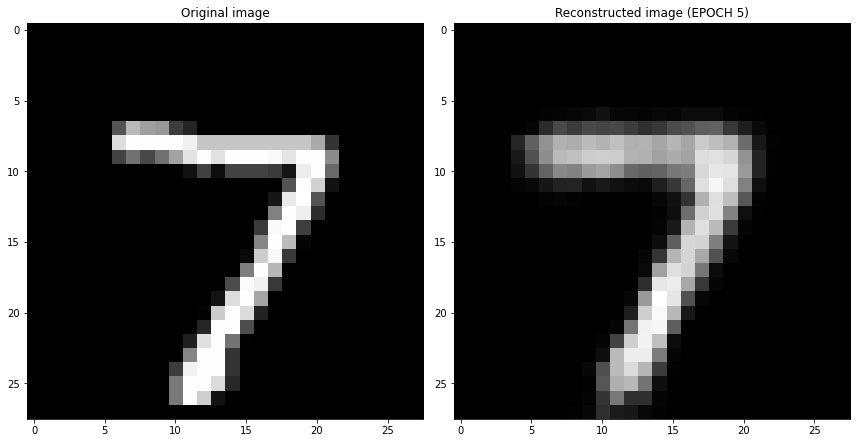

EPOCH 6/30
	 partial train loss (single batch): 0.037903
	 partial train loss (single batch): 0.038869
	 partial train loss (single batch): 0.038314
	 partial train loss (single batch): 0.038180
	 partial train loss (single batch): 0.038963
	 partial train loss (single batch): 0.037844
	 partial train loss (single batch): 0.039317
	 partial train loss (single batch): 0.037315
	 partial train loss (single batch): 0.037514
	 partial train loss (single batch): 0.037486
	 partial train loss (single batch): 0.040913
	 partial train loss (single batch): 0.038732
	 partial train loss (single batch): 0.038167
	 partial train loss (single batch): 0.037139
	 partial train loss (single batch): 0.036972
	 partial train loss (single batch): 0.039399
	 partial train loss (single batch): 0.036974
	 partial train loss (single batch): 0.039927
	 partial train loss (single batch): 0.037756
	 partial train loss (single batch): 0.037567
	 partial train loss (single batch): 0.039689
	 partial train loss (s

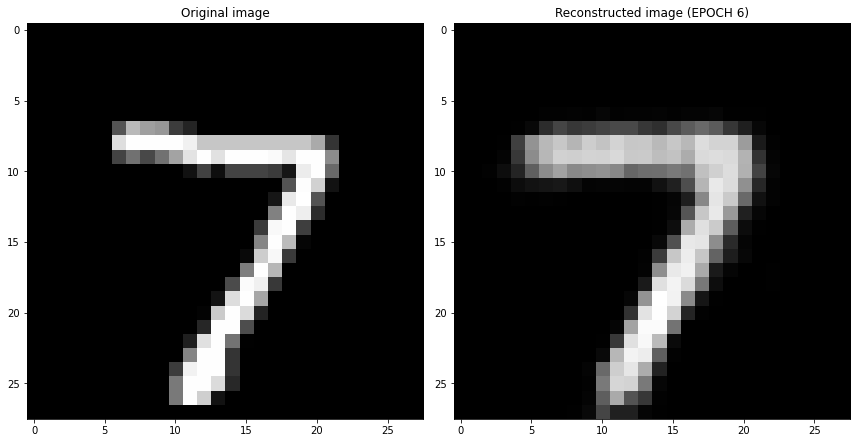

EPOCH 7/30
	 partial train loss (single batch): 0.034546
	 partial train loss (single batch): 0.036974
	 partial train loss (single batch): 0.035693
	 partial train loss (single batch): 0.036436
	 partial train loss (single batch): 0.039014
	 partial train loss (single batch): 0.036063
	 partial train loss (single batch): 0.037019
	 partial train loss (single batch): 0.036544
	 partial train loss (single batch): 0.035983
	 partial train loss (single batch): 0.036304
	 partial train loss (single batch): 0.035800
	 partial train loss (single batch): 0.037326
	 partial train loss (single batch): 0.036588
	 partial train loss (single batch): 0.034660
	 partial train loss (single batch): 0.035255
	 partial train loss (single batch): 0.036808
	 partial train loss (single batch): 0.034982
	 partial train loss (single batch): 0.036392
	 partial train loss (single batch): 0.037761
	 partial train loss (single batch): 0.035701
	 partial train loss (single batch): 0.037433
	 partial train loss (s

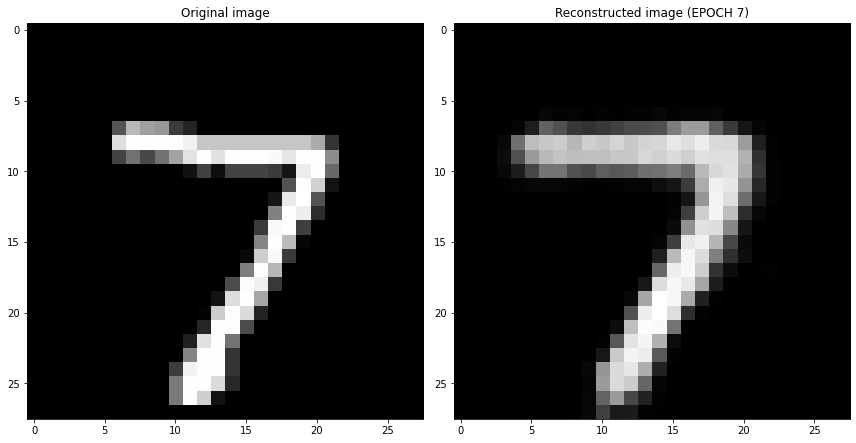

EPOCH 8/30
	 partial train loss (single batch): 0.035706
	 partial train loss (single batch): 0.035570
	 partial train loss (single batch): 0.034006
	 partial train loss (single batch): 0.034950
	 partial train loss (single batch): 0.035171
	 partial train loss (single batch): 0.035424
	 partial train loss (single batch): 0.034422
	 partial train loss (single batch): 0.034666
	 partial train loss (single batch): 0.033977
	 partial train loss (single batch): 0.034180
	 partial train loss (single batch): 0.034732
	 partial train loss (single batch): 0.035895
	 partial train loss (single batch): 0.033853
	 partial train loss (single batch): 0.035710
	 partial train loss (single batch): 0.034061
	 partial train loss (single batch): 0.033193
	 partial train loss (single batch): 0.035251
	 partial train loss (single batch): 0.034309
	 partial train loss (single batch): 0.036393
	 partial train loss (single batch): 0.034431
	 partial train loss (single batch): 0.035450
	 partial train loss (s

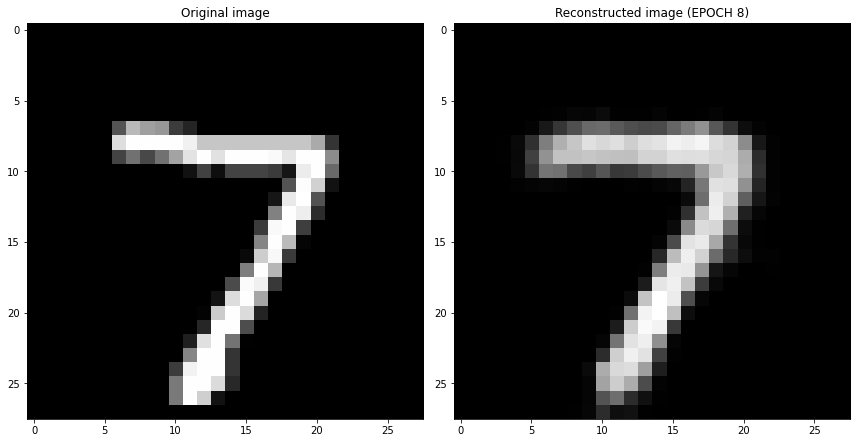

EPOCH 9/30
	 partial train loss (single batch): 0.033571
	 partial train loss (single batch): 0.033922
	 partial train loss (single batch): 0.033114
	 partial train loss (single batch): 0.032815
	 partial train loss (single batch): 0.033709
	 partial train loss (single batch): 0.033048
	 partial train loss (single batch): 0.032215
	 partial train loss (single batch): 0.035875
	 partial train loss (single batch): 0.033348
	 partial train loss (single batch): 0.035991
	 partial train loss (single batch): 0.033077
	 partial train loss (single batch): 0.032471
	 partial train loss (single batch): 0.035229
	 partial train loss (single batch): 0.034119
	 partial train loss (single batch): 0.035117
	 partial train loss (single batch): 0.034173
	 partial train loss (single batch): 0.035638
	 partial train loss (single batch): 0.034427
	 partial train loss (single batch): 0.032947
	 partial train loss (single batch): 0.031861
	 partial train loss (single batch): 0.033318
	 partial train loss (s

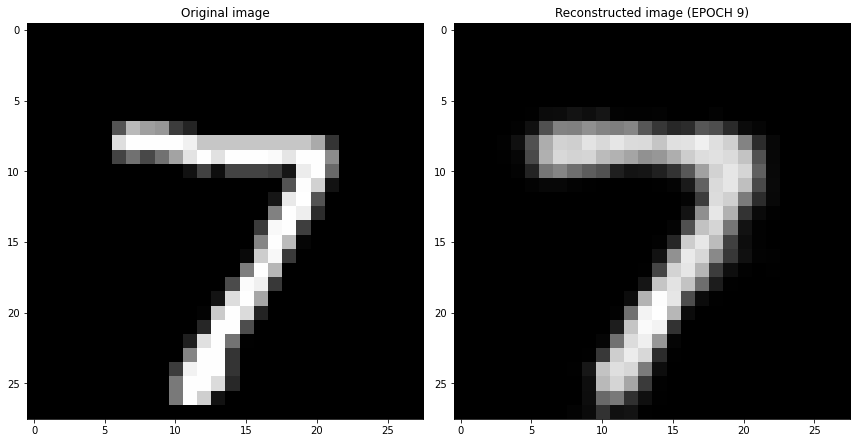

EPOCH 10/30
	 partial train loss (single batch): 0.034290
	 partial train loss (single batch): 0.033278
	 partial train loss (single batch): 0.033804
	 partial train loss (single batch): 0.032792
	 partial train loss (single batch): 0.035248
	 partial train loss (single batch): 0.033665
	 partial train loss (single batch): 0.031683
	 partial train loss (single batch): 0.032034
	 partial train loss (single batch): 0.033307
	 partial train loss (single batch): 0.034366
	 partial train loss (single batch): 0.034314
	 partial train loss (single batch): 0.032587
	 partial train loss (single batch): 0.033308
	 partial train loss (single batch): 0.032420
	 partial train loss (single batch): 0.032092
	 partial train loss (single batch): 0.032157
	 partial train loss (single batch): 0.033740
	 partial train loss (single batch): 0.033508
	 partial train loss (single batch): 0.033837
	 partial train loss (single batch): 0.033896
	 partial train loss (single batch): 0.031821
	 partial train loss (

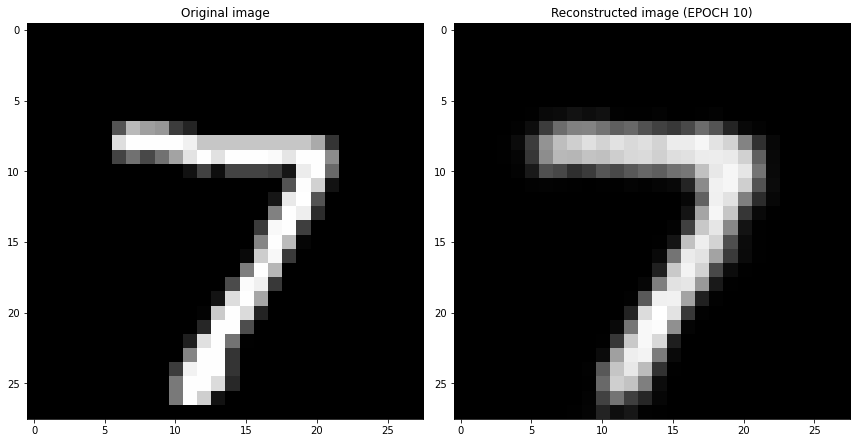

EPOCH 11/30
	 partial train loss (single batch): 0.033044
	 partial train loss (single batch): 0.032275
	 partial train loss (single batch): 0.033762
	 partial train loss (single batch): 0.031014
	 partial train loss (single batch): 0.032493
	 partial train loss (single batch): 0.034374
	 partial train loss (single batch): 0.032666
	 partial train loss (single batch): 0.032448
	 partial train loss (single batch): 0.031649
	 partial train loss (single batch): 0.032176
	 partial train loss (single batch): 0.032288
	 partial train loss (single batch): 0.032422
	 partial train loss (single batch): 0.033788
	 partial train loss (single batch): 0.032704
	 partial train loss (single batch): 0.035187
	 partial train loss (single batch): 0.030977
	 partial train loss (single batch): 0.033513
	 partial train loss (single batch): 0.034348
	 partial train loss (single batch): 0.030938
	 partial train loss (single batch): 0.031265
	 partial train loss (single batch): 0.032387
	 partial train loss (

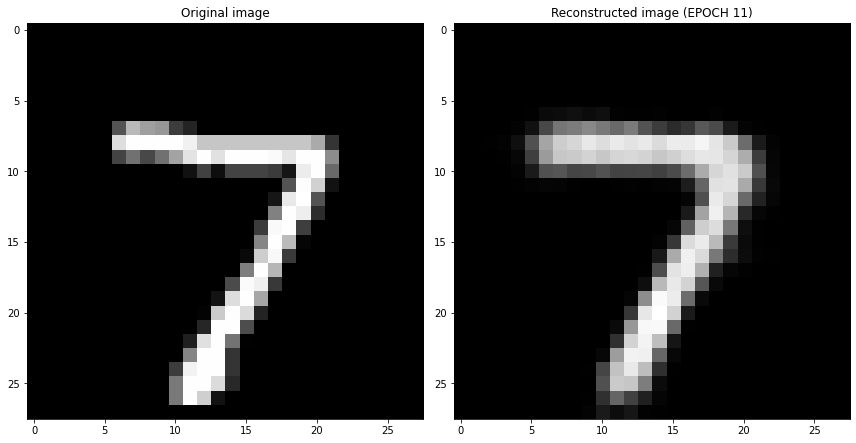

EPOCH 12/30
	 partial train loss (single batch): 0.032882
	 partial train loss (single batch): 0.032235
	 partial train loss (single batch): 0.033105
	 partial train loss (single batch): 0.031960
	 partial train loss (single batch): 0.032109
	 partial train loss (single batch): 0.031483
	 partial train loss (single batch): 0.032079
	 partial train loss (single batch): 0.033201
	 partial train loss (single batch): 0.033247
	 partial train loss (single batch): 0.031751
	 partial train loss (single batch): 0.031686
	 partial train loss (single batch): 0.031166
	 partial train loss (single batch): 0.031471
	 partial train loss (single batch): 0.031804
	 partial train loss (single batch): 0.034945
	 partial train loss (single batch): 0.033003
	 partial train loss (single batch): 0.031187
	 partial train loss (single batch): 0.034138
	 partial train loss (single batch): 0.031495
	 partial train loss (single batch): 0.031062
	 partial train loss (single batch): 0.032531
	 partial train loss (

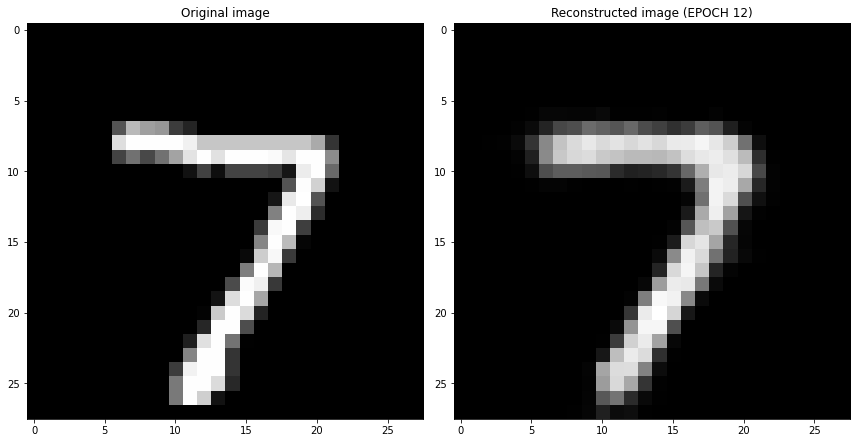

EPOCH 13/30
	 partial train loss (single batch): 0.031993
	 partial train loss (single batch): 0.032050
	 partial train loss (single batch): 0.031240
	 partial train loss (single batch): 0.030263
	 partial train loss (single batch): 0.031940
	 partial train loss (single batch): 0.031605
	 partial train loss (single batch): 0.032313
	 partial train loss (single batch): 0.032558
	 partial train loss (single batch): 0.031040
	 partial train loss (single batch): 0.032510
	 partial train loss (single batch): 0.033816
	 partial train loss (single batch): 0.031301
	 partial train loss (single batch): 0.030915
	 partial train loss (single batch): 0.030776
	 partial train loss (single batch): 0.030042
	 partial train loss (single batch): 0.034798
	 partial train loss (single batch): 0.032566
	 partial train loss (single batch): 0.031813
	 partial train loss (single batch): 0.029386
	 partial train loss (single batch): 0.033287
	 partial train loss (single batch): 0.031829
	 partial train loss (

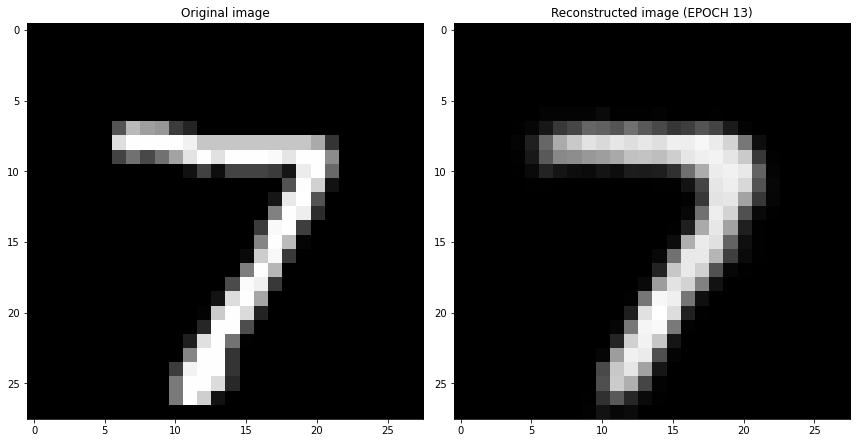

EPOCH 14/30
	 partial train loss (single batch): 0.031569
	 partial train loss (single batch): 0.031518
	 partial train loss (single batch): 0.031077
	 partial train loss (single batch): 0.033194
	 partial train loss (single batch): 0.032150
	 partial train loss (single batch): 0.031334
	 partial train loss (single batch): 0.031882
	 partial train loss (single batch): 0.031007
	 partial train loss (single batch): 0.031899
	 partial train loss (single batch): 0.031478
	 partial train loss (single batch): 0.030532
	 partial train loss (single batch): 0.032902
	 partial train loss (single batch): 0.030339
	 partial train loss (single batch): 0.034140
	 partial train loss (single batch): 0.032736
	 partial train loss (single batch): 0.031833
	 partial train loss (single batch): 0.030227
	 partial train loss (single batch): 0.031646
	 partial train loss (single batch): 0.032017
	 partial train loss (single batch): 0.030944
	 partial train loss (single batch): 0.030811
	 partial train loss (

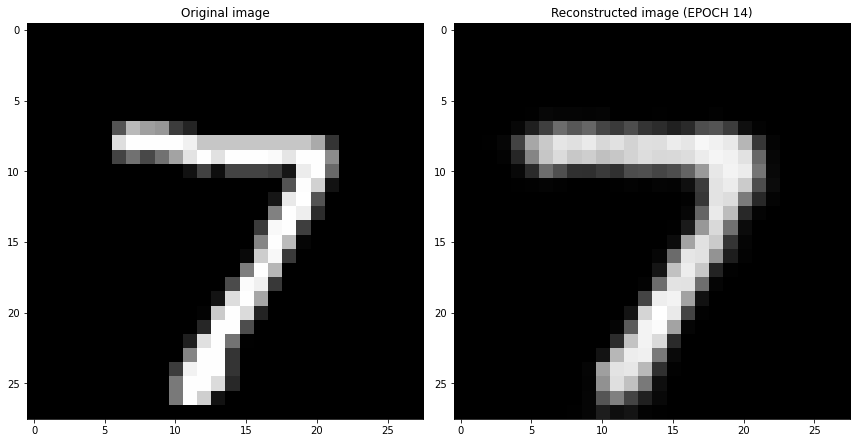

EPOCH 15/30
	 partial train loss (single batch): 0.030701
	 partial train loss (single batch): 0.031359
	 partial train loss (single batch): 0.030681
	 partial train loss (single batch): 0.030231
	 partial train loss (single batch): 0.031368
	 partial train loss (single batch): 0.029966
	 partial train loss (single batch): 0.030010
	 partial train loss (single batch): 0.031929
	 partial train loss (single batch): 0.029362
	 partial train loss (single batch): 0.031368
	 partial train loss (single batch): 0.031191
	 partial train loss (single batch): 0.029489
	 partial train loss (single batch): 0.030840
	 partial train loss (single batch): 0.031360
	 partial train loss (single batch): 0.032635
	 partial train loss (single batch): 0.030602
	 partial train loss (single batch): 0.031582
	 partial train loss (single batch): 0.030469
	 partial train loss (single batch): 0.030742
	 partial train loss (single batch): 0.030122
	 partial train loss (single batch): 0.028295
	 partial train loss (

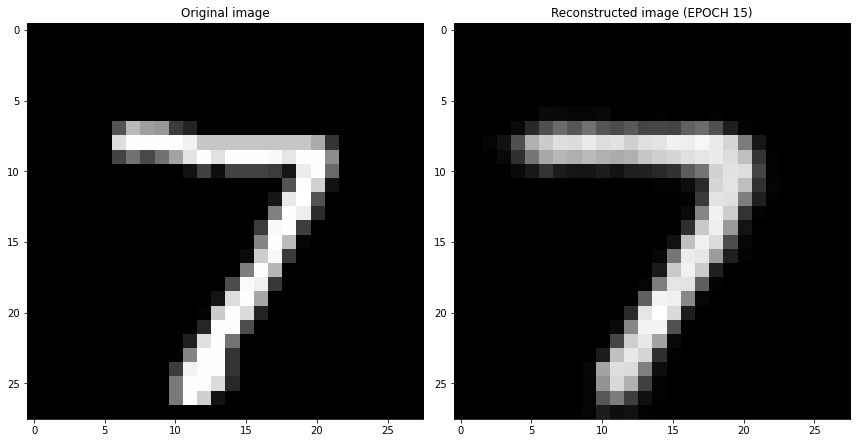

EPOCH 16/30
	 partial train loss (single batch): 0.030431
	 partial train loss (single batch): 0.029817
	 partial train loss (single batch): 0.029606
	 partial train loss (single batch): 0.031210
	 partial train loss (single batch): 0.030712
	 partial train loss (single batch): 0.031804
	 partial train loss (single batch): 0.031462
	 partial train loss (single batch): 0.029513
	 partial train loss (single batch): 0.030484
	 partial train loss (single batch): 0.029667
	 partial train loss (single batch): 0.031051
	 partial train loss (single batch): 0.031638
	 partial train loss (single batch): 0.031798
	 partial train loss (single batch): 0.031536
	 partial train loss (single batch): 0.029710
	 partial train loss (single batch): 0.029129
	 partial train loss (single batch): 0.029144
	 partial train loss (single batch): 0.031038
	 partial train loss (single batch): 0.031807
	 partial train loss (single batch): 0.032153
	 partial train loss (single batch): 0.031596
	 partial train loss (

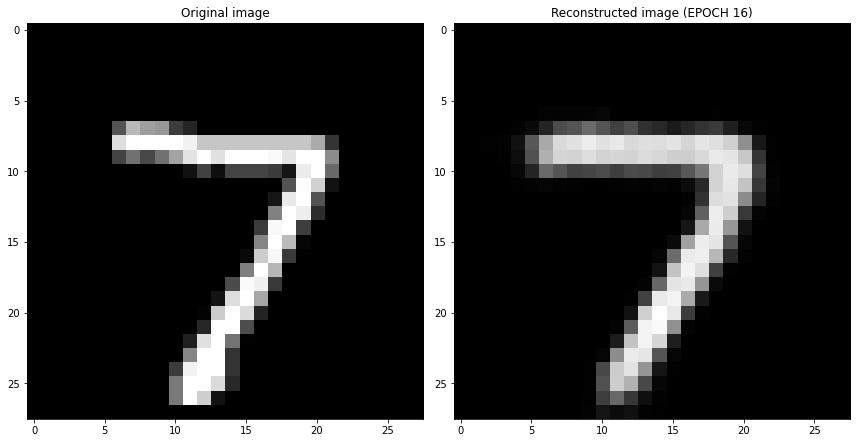

EPOCH 17/30
	 partial train loss (single batch): 0.028625
	 partial train loss (single batch): 0.030419
	 partial train loss (single batch): 0.030610
	 partial train loss (single batch): 0.030217
	 partial train loss (single batch): 0.028854
	 partial train loss (single batch): 0.028264
	 partial train loss (single batch): 0.030440
	 partial train loss (single batch): 0.029522
	 partial train loss (single batch): 0.029800
	 partial train loss (single batch): 0.031138
	 partial train loss (single batch): 0.029644
	 partial train loss (single batch): 0.031915
	 partial train loss (single batch): 0.030471
	 partial train loss (single batch): 0.030944
	 partial train loss (single batch): 0.030396
	 partial train loss (single batch): 0.029952
	 partial train loss (single batch): 0.030956
	 partial train loss (single batch): 0.029709
	 partial train loss (single batch): 0.031971
	 partial train loss (single batch): 0.030398
	 partial train loss (single batch): 0.030988
	 partial train loss (

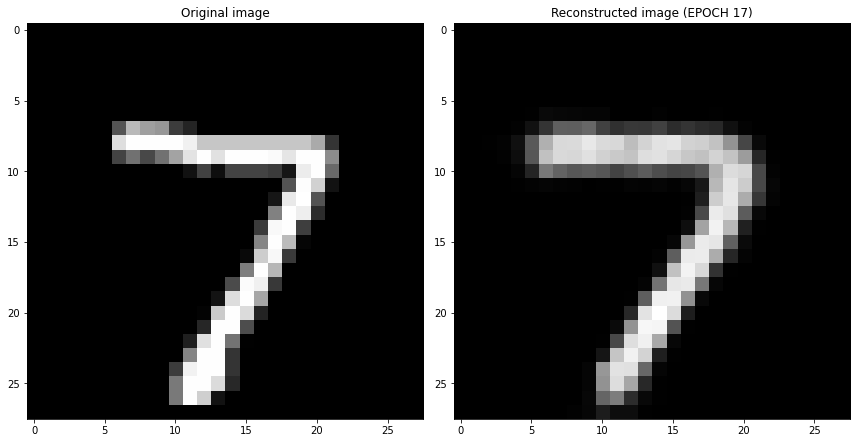

EPOCH 18/30
	 partial train loss (single batch): 0.030157
	 partial train loss (single batch): 0.030313
	 partial train loss (single batch): 0.029519
	 partial train loss (single batch): 0.029980
	 partial train loss (single batch): 0.028992
	 partial train loss (single batch): 0.030723
	 partial train loss (single batch): 0.028788
	 partial train loss (single batch): 0.029664
	 partial train loss (single batch): 0.031233
	 partial train loss (single batch): 0.030748
	 partial train loss (single batch): 0.030337
	 partial train loss (single batch): 0.030516
	 partial train loss (single batch): 0.029788
	 partial train loss (single batch): 0.027095
	 partial train loss (single batch): 0.029184
	 partial train loss (single batch): 0.028637
	 partial train loss (single batch): 0.029330
	 partial train loss (single batch): 0.029538
	 partial train loss (single batch): 0.029648
	 partial train loss (single batch): 0.030464
	 partial train loss (single batch): 0.031028
	 partial train loss (

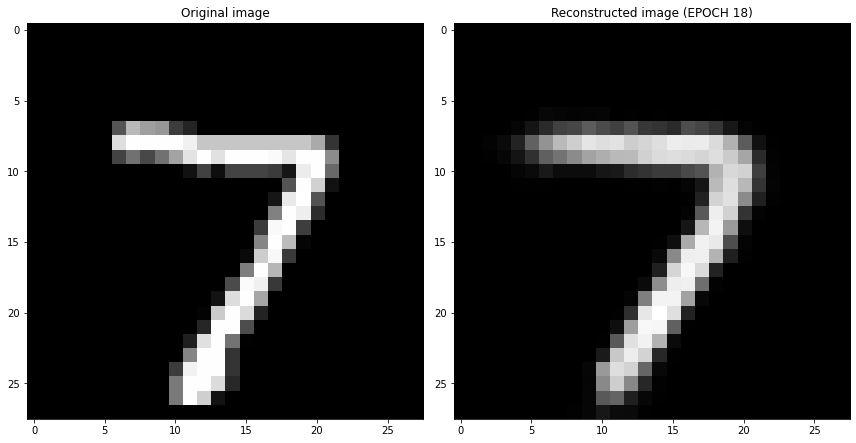

EPOCH 19/30
	 partial train loss (single batch): 0.030713
	 partial train loss (single batch): 0.031818
	 partial train loss (single batch): 0.030621
	 partial train loss (single batch): 0.030760
	 partial train loss (single batch): 0.029650
	 partial train loss (single batch): 0.031551
	 partial train loss (single batch): 0.030443
	 partial train loss (single batch): 0.030266
	 partial train loss (single batch): 0.029769
	 partial train loss (single batch): 0.030689
	 partial train loss (single batch): 0.031414
	 partial train loss (single batch): 0.030131
	 partial train loss (single batch): 0.029589
	 partial train loss (single batch): 0.029690
	 partial train loss (single batch): 0.030210
	 partial train loss (single batch): 0.029970
	 partial train loss (single batch): 0.030352
	 partial train loss (single batch): 0.031946
	 partial train loss (single batch): 0.029428
	 partial train loss (single batch): 0.032425
	 partial train loss (single batch): 0.028087
	 partial train loss (

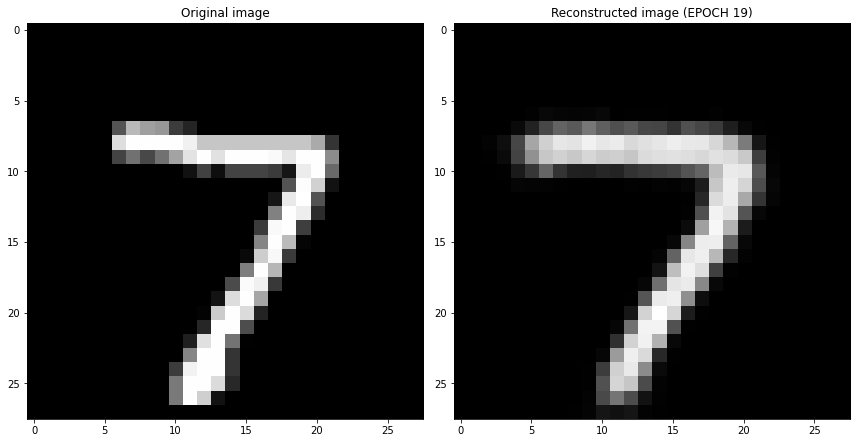

EPOCH 20/30
	 partial train loss (single batch): 0.028206
	 partial train loss (single batch): 0.029752
	 partial train loss (single batch): 0.029380
	 partial train loss (single batch): 0.028575
	 partial train loss (single batch): 0.030301
	 partial train loss (single batch): 0.029245
	 partial train loss (single batch): 0.029478
	 partial train loss (single batch): 0.029918
	 partial train loss (single batch): 0.031933
	 partial train loss (single batch): 0.028399
	 partial train loss (single batch): 0.030129
	 partial train loss (single batch): 0.029478
	 partial train loss (single batch): 0.029446
	 partial train loss (single batch): 0.029219
	 partial train loss (single batch): 0.030834
	 partial train loss (single batch): 0.029826
	 partial train loss (single batch): 0.030101
	 partial train loss (single batch): 0.030220
	 partial train loss (single batch): 0.028998
	 partial train loss (single batch): 0.028999
	 partial train loss (single batch): 0.029497
	 partial train loss (

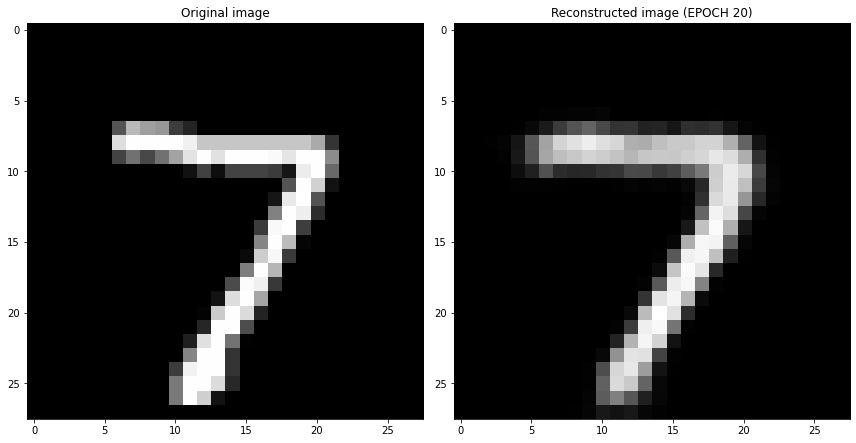

EPOCH 21/30
	 partial train loss (single batch): 0.031026
	 partial train loss (single batch): 0.029843
	 partial train loss (single batch): 0.029267
	 partial train loss (single batch): 0.029918
	 partial train loss (single batch): 0.029143
	 partial train loss (single batch): 0.029299
	 partial train loss (single batch): 0.028811
	 partial train loss (single batch): 0.027086
	 partial train loss (single batch): 0.028076
	 partial train loss (single batch): 0.029689
	 partial train loss (single batch): 0.029102
	 partial train loss (single batch): 0.029720
	 partial train loss (single batch): 0.031264
	 partial train loss (single batch): 0.029976
	 partial train loss (single batch): 0.029645
	 partial train loss (single batch): 0.029071
	 partial train loss (single batch): 0.031139
	 partial train loss (single batch): 0.031017
	 partial train loss (single batch): 0.029840
	 partial train loss (single batch): 0.029544
	 partial train loss (single batch): 0.027708
	 partial train loss (

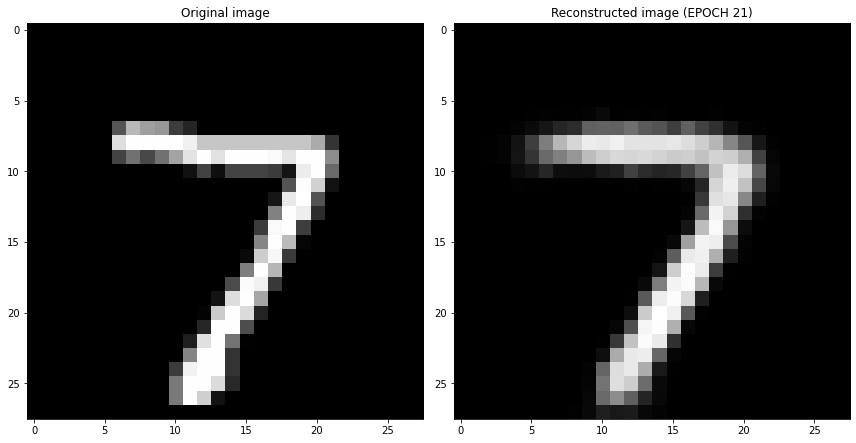

EPOCH 22/30
	 partial train loss (single batch): 0.027659
	 partial train loss (single batch): 0.029174
	 partial train loss (single batch): 0.029052
	 partial train loss (single batch): 0.029715
	 partial train loss (single batch): 0.028693
	 partial train loss (single batch): 0.029434
	 partial train loss (single batch): 0.030095
	 partial train loss (single batch): 0.028183
	 partial train loss (single batch): 0.028642
	 partial train loss (single batch): 0.028046
	 partial train loss (single batch): 0.028807
	 partial train loss (single batch): 0.029672
	 partial train loss (single batch): 0.029745
	 partial train loss (single batch): 0.027875
	 partial train loss (single batch): 0.027941
	 partial train loss (single batch): 0.029583
	 partial train loss (single batch): 0.028718
	 partial train loss (single batch): 0.028325
	 partial train loss (single batch): 0.029350
	 partial train loss (single batch): 0.030835
	 partial train loss (single batch): 0.030818
	 partial train loss (

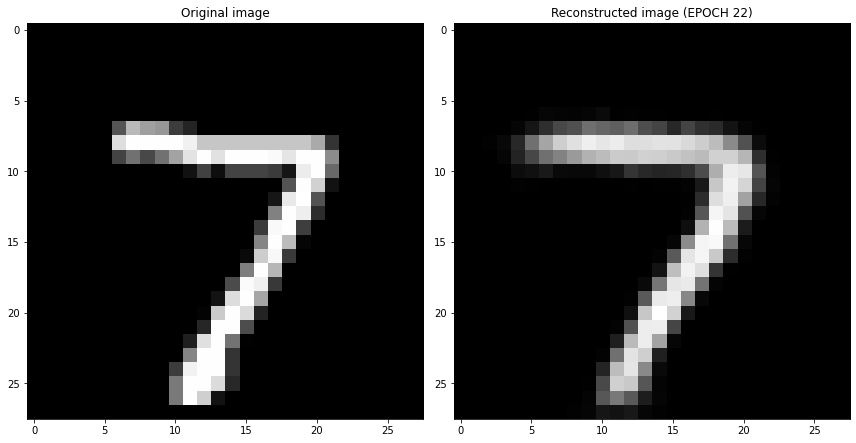

EPOCH 23/30
	 partial train loss (single batch): 0.028238
	 partial train loss (single batch): 0.028918
	 partial train loss (single batch): 0.028316
	 partial train loss (single batch): 0.029582
	 partial train loss (single batch): 0.029547
	 partial train loss (single batch): 0.028730
	 partial train loss (single batch): 0.028217
	 partial train loss (single batch): 0.029621
	 partial train loss (single batch): 0.029102
	 partial train loss (single batch): 0.030124
	 partial train loss (single batch): 0.026547
	 partial train loss (single batch): 0.027282
	 partial train loss (single batch): 0.029885
	 partial train loss (single batch): 0.028295
	 partial train loss (single batch): 0.030466
	 partial train loss (single batch): 0.029230
	 partial train loss (single batch): 0.027939
	 partial train loss (single batch): 0.029306
	 partial train loss (single batch): 0.028653
	 partial train loss (single batch): 0.032818
	 partial train loss (single batch): 0.026940
	 partial train loss (

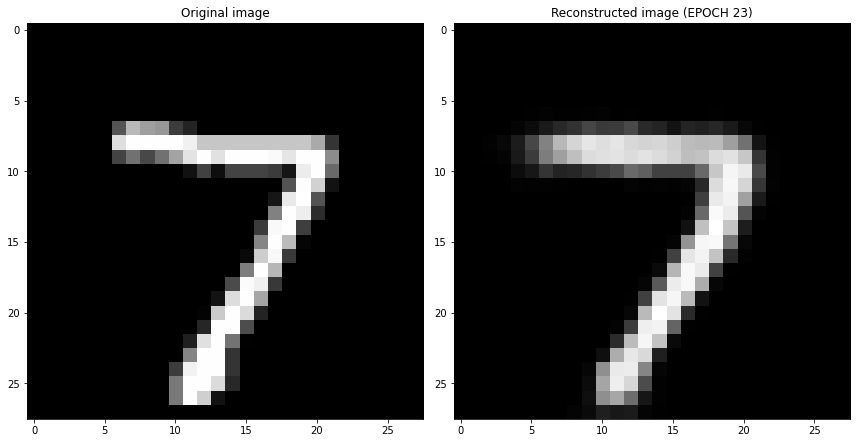

EPOCH 24/30
	 partial train loss (single batch): 0.029859
	 partial train loss (single batch): 0.030529
	 partial train loss (single batch): 0.028439
	 partial train loss (single batch): 0.029756
	 partial train loss (single batch): 0.029919
	 partial train loss (single batch): 0.029535
	 partial train loss (single batch): 0.029230
	 partial train loss (single batch): 0.029561
	 partial train loss (single batch): 0.028907
	 partial train loss (single batch): 0.030843
	 partial train loss (single batch): 0.028707
	 partial train loss (single batch): 0.030188
	 partial train loss (single batch): 0.027186
	 partial train loss (single batch): 0.028260
	 partial train loss (single batch): 0.028351
	 partial train loss (single batch): 0.029789
	 partial train loss (single batch): 0.030228
	 partial train loss (single batch): 0.028915
	 partial train loss (single batch): 0.029485
	 partial train loss (single batch): 0.027444
	 partial train loss (single batch): 0.029362
	 partial train loss (

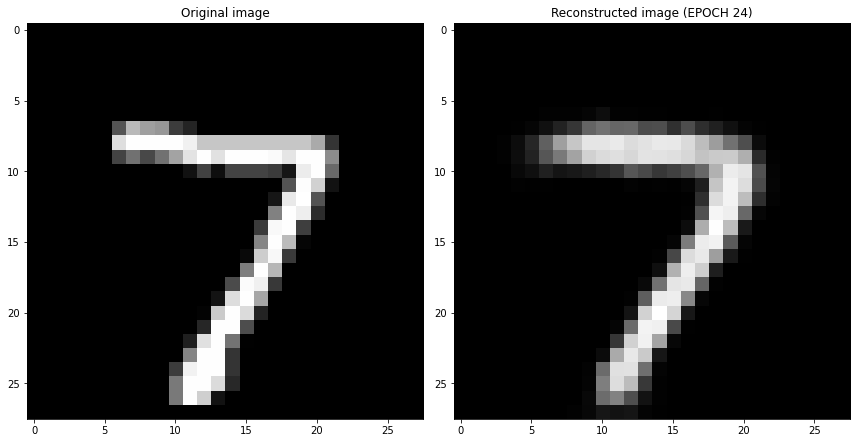

EPOCH 25/30
	 partial train loss (single batch): 0.029280
	 partial train loss (single batch): 0.028134
	 partial train loss (single batch): 0.028690
	 partial train loss (single batch): 0.027947
	 partial train loss (single batch): 0.029041
	 partial train loss (single batch): 0.028536
	 partial train loss (single batch): 0.030585
	 partial train loss (single batch): 0.028780
	 partial train loss (single batch): 0.029155
	 partial train loss (single batch): 0.028276
	 partial train loss (single batch): 0.028603
	 partial train loss (single batch): 0.030108
	 partial train loss (single batch): 0.028557
	 partial train loss (single batch): 0.028780
	 partial train loss (single batch): 0.028932
	 partial train loss (single batch): 0.028580
	 partial train loss (single batch): 0.029863
	 partial train loss (single batch): 0.028443
	 partial train loss (single batch): 0.027924
	 partial train loss (single batch): 0.028525
	 partial train loss (single batch): 0.028030
	 partial train loss (

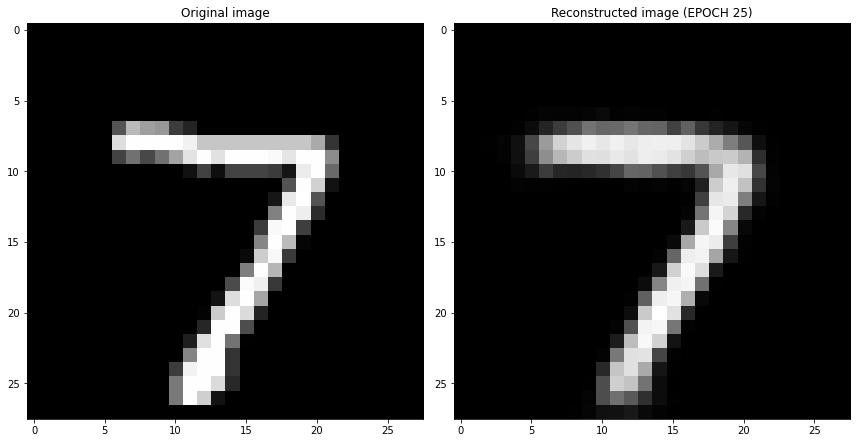

EPOCH 26/30
	 partial train loss (single batch): 0.027039
	 partial train loss (single batch): 0.029589
	 partial train loss (single batch): 0.028075
	 partial train loss (single batch): 0.029941
	 partial train loss (single batch): 0.026670
	 partial train loss (single batch): 0.028800
	 partial train loss (single batch): 0.029028
	 partial train loss (single batch): 0.030431
	 partial train loss (single batch): 0.030292
	 partial train loss (single batch): 0.031420
	 partial train loss (single batch): 0.028531
	 partial train loss (single batch): 0.028408
	 partial train loss (single batch): 0.029558
	 partial train loss (single batch): 0.029922
	 partial train loss (single batch): 0.028655
	 partial train loss (single batch): 0.028343
	 partial train loss (single batch): 0.029121
	 partial train loss (single batch): 0.029721
	 partial train loss (single batch): 0.027967
	 partial train loss (single batch): 0.028542
	 partial train loss (single batch): 0.028671
	 partial train loss (

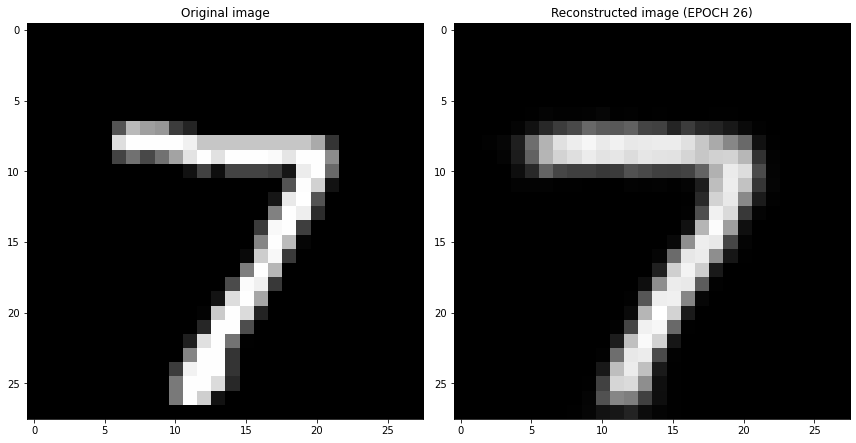

EPOCH 27/30
	 partial train loss (single batch): 0.028221
	 partial train loss (single batch): 0.030048
	 partial train loss (single batch): 0.030541
	 partial train loss (single batch): 0.028391
	 partial train loss (single batch): 0.028162
	 partial train loss (single batch): 0.028603
	 partial train loss (single batch): 0.028774
	 partial train loss (single batch): 0.029013
	 partial train loss (single batch): 0.030654
	 partial train loss (single batch): 0.027286
	 partial train loss (single batch): 0.029090
	 partial train loss (single batch): 0.027265
	 partial train loss (single batch): 0.027524
	 partial train loss (single batch): 0.027642
	 partial train loss (single batch): 0.030499
	 partial train loss (single batch): 0.027859
	 partial train loss (single batch): 0.029586
	 partial train loss (single batch): 0.028888
	 partial train loss (single batch): 0.027839
	 partial train loss (single batch): 0.028163
	 partial train loss (single batch): 0.028368
	 partial train loss (

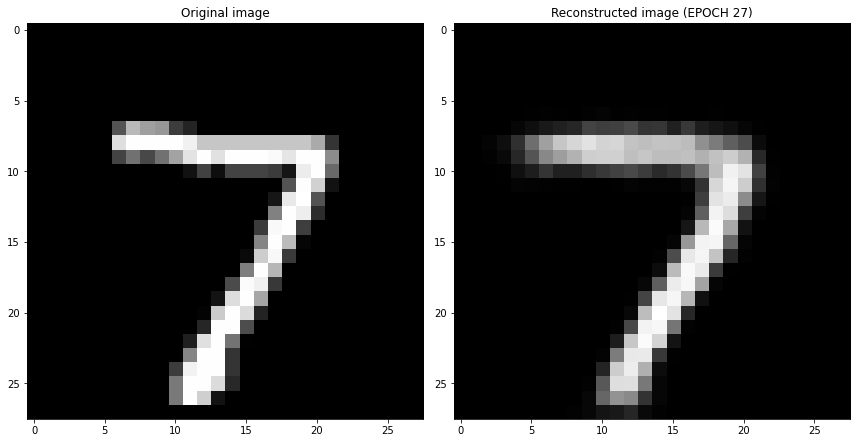

EPOCH 28/30
	 partial train loss (single batch): 0.028289
	 partial train loss (single batch): 0.029582
	 partial train loss (single batch): 0.027414
	 partial train loss (single batch): 0.029532
	 partial train loss (single batch): 0.028722
	 partial train loss (single batch): 0.027905
	 partial train loss (single batch): 0.031694
	 partial train loss (single batch): 0.028748
	 partial train loss (single batch): 0.029842
	 partial train loss (single batch): 0.029344
	 partial train loss (single batch): 0.028825
	 partial train loss (single batch): 0.027286
	 partial train loss (single batch): 0.026678
	 partial train loss (single batch): 0.028279
	 partial train loss (single batch): 0.029448
	 partial train loss (single batch): 0.028399
	 partial train loss (single batch): 0.029839
	 partial train loss (single batch): 0.030851
	 partial train loss (single batch): 0.028090
	 partial train loss (single batch): 0.028082
	 partial train loss (single batch): 0.027028
	 partial train loss (

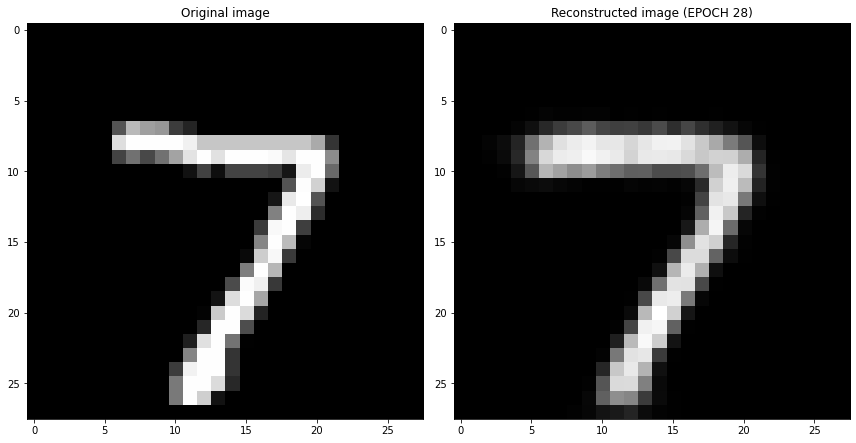

EPOCH 29/30
	 partial train loss (single batch): 0.028109
	 partial train loss (single batch): 0.029855
	 partial train loss (single batch): 0.028692
	 partial train loss (single batch): 0.029330
	 partial train loss (single batch): 0.028176
	 partial train loss (single batch): 0.030229
	 partial train loss (single batch): 0.027187
	 partial train loss (single batch): 0.028551
	 partial train loss (single batch): 0.028016
	 partial train loss (single batch): 0.026406
	 partial train loss (single batch): 0.029999
	 partial train loss (single batch): 0.030861
	 partial train loss (single batch): 0.027705
	 partial train loss (single batch): 0.027742
	 partial train loss (single batch): 0.029565
	 partial train loss (single batch): 0.027528
	 partial train loss (single batch): 0.028917
	 partial train loss (single batch): 0.028574
	 partial train loss (single batch): 0.028937
	 partial train loss (single batch): 0.027308
	 partial train loss (single batch): 0.030727
	 partial train loss (

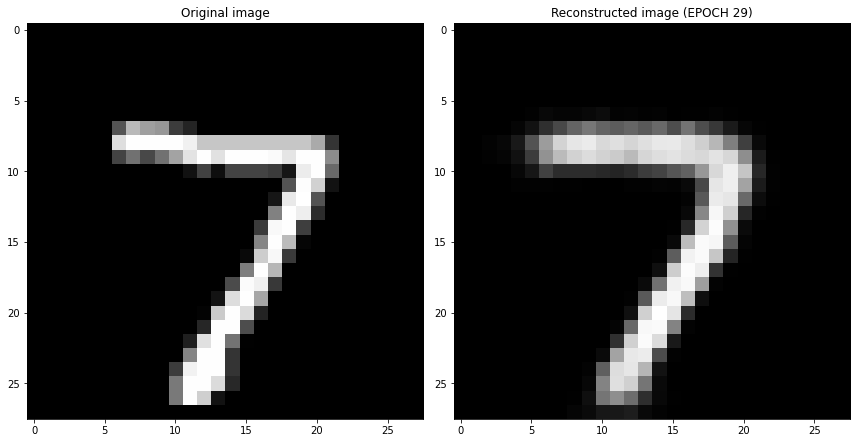

EPOCH 30/30
	 partial train loss (single batch): 0.031201
	 partial train loss (single batch): 0.027604
	 partial train loss (single batch): 0.029529
	 partial train loss (single batch): 0.029438
	 partial train loss (single batch): 0.030230
	 partial train loss (single batch): 0.029154
	 partial train loss (single batch): 0.026903
	 partial train loss (single batch): 0.030554
	 partial train loss (single batch): 0.029599
	 partial train loss (single batch): 0.028304
	 partial train loss (single batch): 0.028813
	 partial train loss (single batch): 0.026187
	 partial train loss (single batch): 0.028322
	 partial train loss (single batch): 0.029325
	 partial train loss (single batch): 0.029849
	 partial train loss (single batch): 0.027937
	 partial train loss (single batch): 0.028483
	 partial train loss (single batch): 0.026659
	 partial train loss (single batch): 0.026919
	 partial train loss (single batch): 0.028186
	 partial train loss (single batch): 0.028057
	 partial train loss (

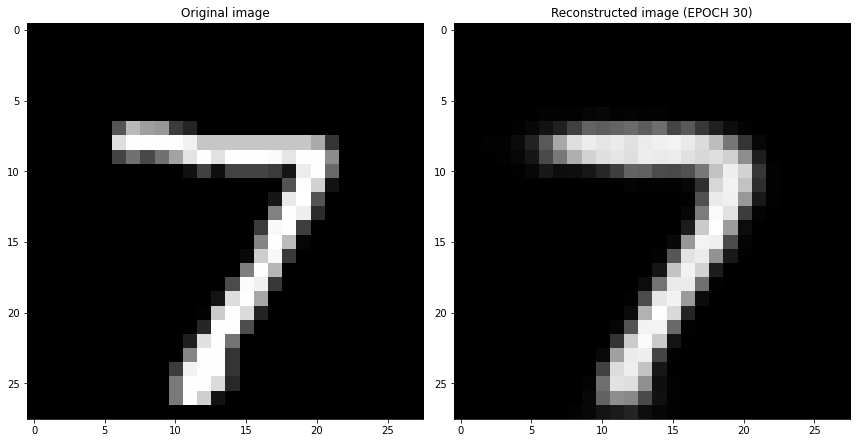

Cross validation fold number= 1/6
EPOCH 1/30
	 partial train loss (single batch): 0.288872
	 partial train loss (single batch): 0.283345
	 partial train loss (single batch): 0.275600
	 partial train loss (single batch): 0.264378
	 partial train loss (single batch): 0.231408
	 partial train loss (single batch): 0.161125
	 partial train loss (single batch): 0.116323
	 partial train loss (single batch): 0.118825
	 partial train loss (single batch): 0.111535
	 partial train loss (single batch): 0.115479
	 partial train loss (single batch): 0.107994
	 partial train loss (single batch): 0.109382
	 partial train loss (single batch): 0.112899
	 partial train loss (single batch): 0.110971
	 partial train loss (single batch): 0.110162
	 partial train loss (single batch): 0.115345
	 partial train loss (single batch): 0.111768
	 partial train loss (single batch): 0.112338
	 partial train loss (single batch): 0.109535
	 partial train loss (single batch): 0.109209
	 partial train loss (single batch)

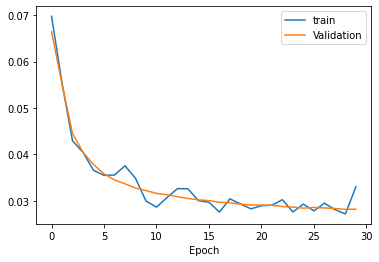

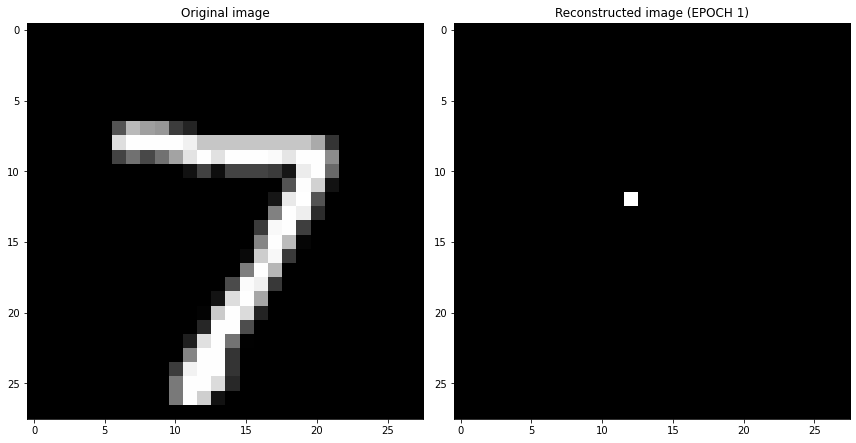

EPOCH 2/30
	 partial train loss (single batch): 0.109807
	 partial train loss (single batch): 0.110030
	 partial train loss (single batch): 0.111965
	 partial train loss (single batch): 0.115219
	 partial train loss (single batch): 0.107623
	 partial train loss (single batch): 0.111628
	 partial train loss (single batch): 0.113930
	 partial train loss (single batch): 0.112900
	 partial train loss (single batch): 0.114031
	 partial train loss (single batch): 0.111358
	 partial train loss (single batch): 0.112277
	 partial train loss (single batch): 0.111544
	 partial train loss (single batch): 0.111764
	 partial train loss (single batch): 0.113657
	 partial train loss (single batch): 0.111564
	 partial train loss (single batch): 0.110856
	 partial train loss (single batch): 0.115004
	 partial train loss (single batch): 0.114898
	 partial train loss (single batch): 0.110813
	 partial train loss (single batch): 0.109744
	 partial train loss (single batch): 0.112693
	 partial train loss (s

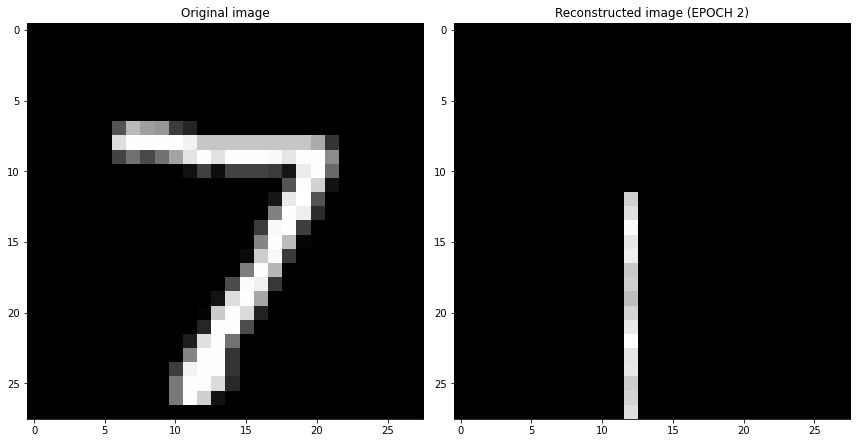

EPOCH 3/30
	 partial train loss (single batch): 0.107744
	 partial train loss (single batch): 0.111761
	 partial train loss (single batch): 0.109525
	 partial train loss (single batch): 0.109952
	 partial train loss (single batch): 0.111545
	 partial train loss (single batch): 0.108114
	 partial train loss (single batch): 0.111391
	 partial train loss (single batch): 0.108842
	 partial train loss (single batch): 0.112420
	 partial train loss (single batch): 0.111877
	 partial train loss (single batch): 0.106273
	 partial train loss (single batch): 0.110934
	 partial train loss (single batch): 0.114358
	 partial train loss (single batch): 0.111980
	 partial train loss (single batch): 0.109743
	 partial train loss (single batch): 0.108523
	 partial train loss (single batch): 0.106802
	 partial train loss (single batch): 0.107240
	 partial train loss (single batch): 0.108596
	 partial train loss (single batch): 0.102103
	 partial train loss (single batch): 0.107483
	 partial train loss (s

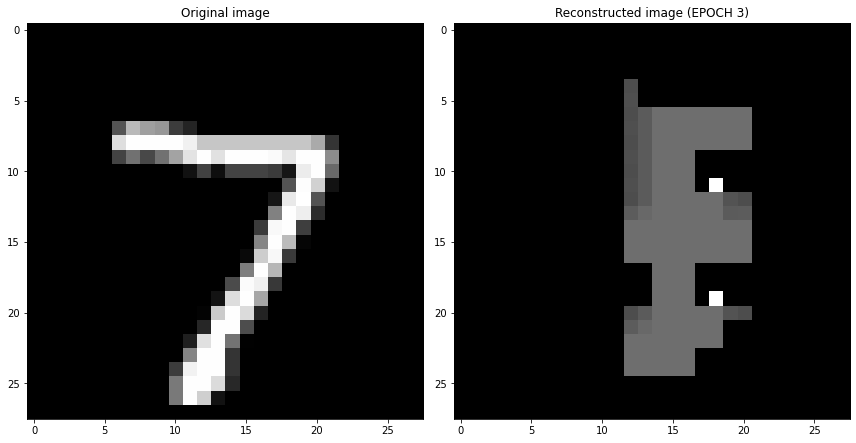

EPOCH 4/30
	 partial train loss (single batch): 0.088636
	 partial train loss (single batch): 0.087022
	 partial train loss (single batch): 0.084137
	 partial train loss (single batch): 0.086987
	 partial train loss (single batch): 0.084211
	 partial train loss (single batch): 0.087796
	 partial train loss (single batch): 0.085766
	 partial train loss (single batch): 0.086346
	 partial train loss (single batch): 0.089650
	 partial train loss (single batch): 0.086027
	 partial train loss (single batch): 0.084767
	 partial train loss (single batch): 0.086803
	 partial train loss (single batch): 0.089090
	 partial train loss (single batch): 0.087498
	 partial train loss (single batch): 0.087391
	 partial train loss (single batch): 0.086686
	 partial train loss (single batch): 0.084888
	 partial train loss (single batch): 0.087112
	 partial train loss (single batch): 0.084677
	 partial train loss (single batch): 0.086413
	 partial train loss (single batch): 0.088353
	 partial train loss (s

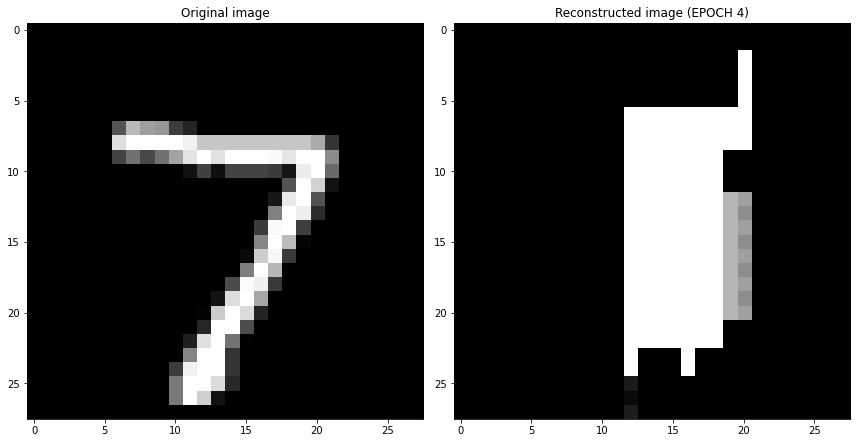

EPOCH 5/30
	 partial train loss (single batch): 0.082330
	 partial train loss (single batch): 0.082410
	 partial train loss (single batch): 0.086460
	 partial train loss (single batch): 0.085621
	 partial train loss (single batch): 0.081711
	 partial train loss (single batch): 0.082708
	 partial train loss (single batch): 0.081762
	 partial train loss (single batch): 0.089114
	 partial train loss (single batch): 0.084691
	 partial train loss (single batch): 0.083299
	 partial train loss (single batch): 0.082775
	 partial train loss (single batch): 0.082951
	 partial train loss (single batch): 0.080147
	 partial train loss (single batch): 0.086638
	 partial train loss (single batch): 0.081116
	 partial train loss (single batch): 0.081712
	 partial train loss (single batch): 0.081264
	 partial train loss (single batch): 0.083787
	 partial train loss (single batch): 0.083926
	 partial train loss (single batch): 0.082263
	 partial train loss (single batch): 0.079188
	 partial train loss (s

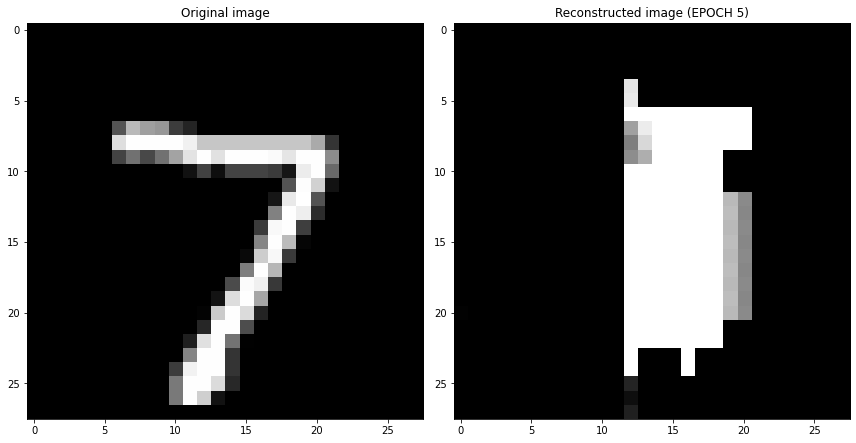

EPOCH 6/30
	 partial train loss (single batch): 0.080723
	 partial train loss (single batch): 0.080141
	 partial train loss (single batch): 0.082251
	 partial train loss (single batch): 0.083275
	 partial train loss (single batch): 0.087607
	 partial train loss (single batch): 0.083064
	 partial train loss (single batch): 0.080394
	 partial train loss (single batch): 0.082054
	 partial train loss (single batch): 0.084806
	 partial train loss (single batch): 0.082080
	 partial train loss (single batch): 0.082054
	 partial train loss (single batch): 0.080223
	 partial train loss (single batch): 0.082156
	 partial train loss (single batch): 0.083383
	 partial train loss (single batch): 0.082709
	 partial train loss (single batch): 0.083374
	 partial train loss (single batch): 0.083361
	 partial train loss (single batch): 0.081411
	 partial train loss (single batch): 0.083880
	 partial train loss (single batch): 0.082948
	 partial train loss (single batch): 0.083460
	 partial train loss (s

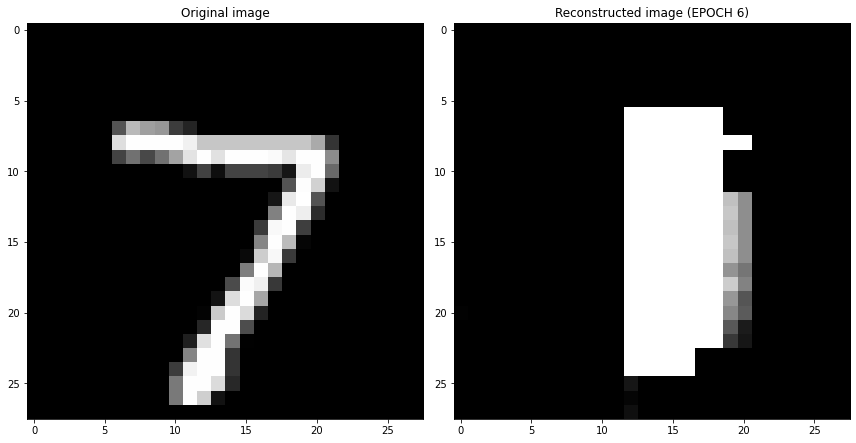

EPOCH 7/30
	 partial train loss (single batch): 0.081165
	 partial train loss (single batch): 0.083625
	 partial train loss (single batch): 0.082002
	 partial train loss (single batch): 0.081830
	 partial train loss (single batch): 0.079137
	 partial train loss (single batch): 0.084043
	 partial train loss (single batch): 0.082846
	 partial train loss (single batch): 0.082711
	 partial train loss (single batch): 0.079417
	 partial train loss (single batch): 0.078652
	 partial train loss (single batch): 0.080610
	 partial train loss (single batch): 0.081835
	 partial train loss (single batch): 0.083177
	 partial train loss (single batch): 0.083510
	 partial train loss (single batch): 0.081835
	 partial train loss (single batch): 0.082863
	 partial train loss (single batch): 0.085015
	 partial train loss (single batch): 0.083737
	 partial train loss (single batch): 0.079919
	 partial train loss (single batch): 0.081834
	 partial train loss (single batch): 0.083225
	 partial train loss (s

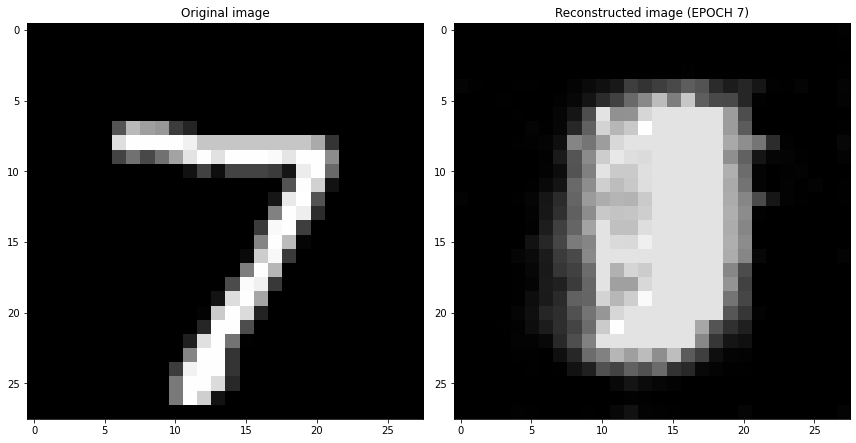

EPOCH 8/30
	 partial train loss (single batch): 0.067007
	 partial train loss (single batch): 0.066779
	 partial train loss (single batch): 0.069033
	 partial train loss (single batch): 0.069141
	 partial train loss (single batch): 0.067786
	 partial train loss (single batch): 0.064676
	 partial train loss (single batch): 0.067813
	 partial train loss (single batch): 0.065148
	 partial train loss (single batch): 0.067648
	 partial train loss (single batch): 0.064566
	 partial train loss (single batch): 0.066144
	 partial train loss (single batch): 0.064450
	 partial train loss (single batch): 0.064486
	 partial train loss (single batch): 0.066040
	 partial train loss (single batch): 0.066471
	 partial train loss (single batch): 0.064156
	 partial train loss (single batch): 0.064530
	 partial train loss (single batch): 0.065679
	 partial train loss (single batch): 0.061819
	 partial train loss (single batch): 0.068450
	 partial train loss (single batch): 0.067071
	 partial train loss (s

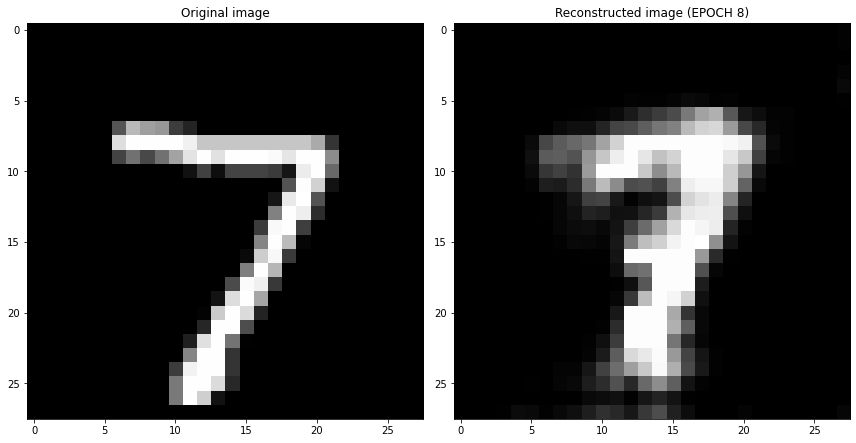

EPOCH 9/30
	 partial train loss (single batch): 0.047141
	 partial train loss (single batch): 0.046988
	 partial train loss (single batch): 0.045800
	 partial train loss (single batch): 0.046810
	 partial train loss (single batch): 0.046532
	 partial train loss (single batch): 0.047104
	 partial train loss (single batch): 0.048457
	 partial train loss (single batch): 0.046645
	 partial train loss (single batch): 0.046982
	 partial train loss (single batch): 0.045515
	 partial train loss (single batch): 0.045457
	 partial train loss (single batch): 0.046408
	 partial train loss (single batch): 0.045934
	 partial train loss (single batch): 0.045545
	 partial train loss (single batch): 0.045780
	 partial train loss (single batch): 0.045116
	 partial train loss (single batch): 0.045238
	 partial train loss (single batch): 0.044629
	 partial train loss (single batch): 0.045903
	 partial train loss (single batch): 0.045595
	 partial train loss (single batch): 0.045156
	 partial train loss (s

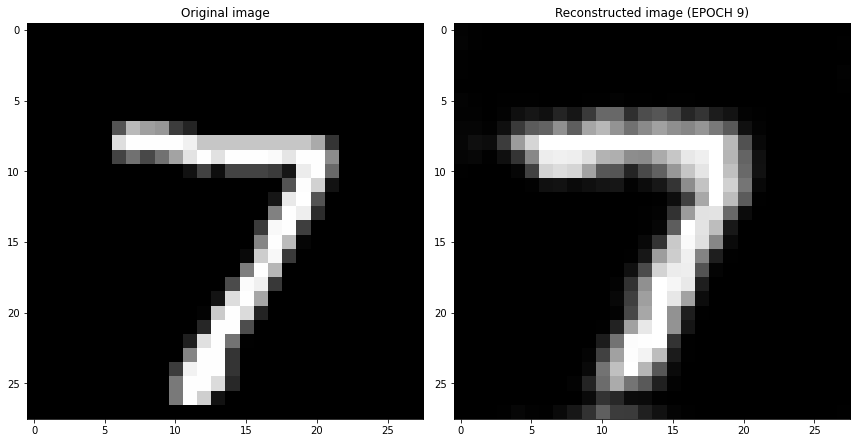

EPOCH 10/30
	 partial train loss (single batch): 0.038594
	 partial train loss (single batch): 0.039966
	 partial train loss (single batch): 0.038406
	 partial train loss (single batch): 0.038955
	 partial train loss (single batch): 0.039873
	 partial train loss (single batch): 0.039510
	 partial train loss (single batch): 0.036163
	 partial train loss (single batch): 0.038442
	 partial train loss (single batch): 0.037969
	 partial train loss (single batch): 0.038131
	 partial train loss (single batch): 0.037823
	 partial train loss (single batch): 0.038488
	 partial train loss (single batch): 0.039018
	 partial train loss (single batch): 0.038554
	 partial train loss (single batch): 0.037962
	 partial train loss (single batch): 0.037451
	 partial train loss (single batch): 0.039728
	 partial train loss (single batch): 0.038051
	 partial train loss (single batch): 0.038386
	 partial train loss (single batch): 0.036719
	 partial train loss (single batch): 0.037941
	 partial train loss (

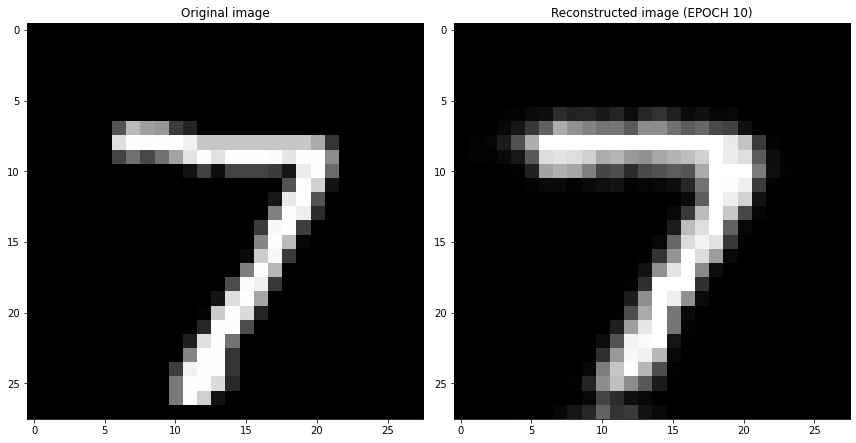

EPOCH 11/30
	 partial train loss (single batch): 0.036089
	 partial train loss (single batch): 0.036670
	 partial train loss (single batch): 0.035728
	 partial train loss (single batch): 0.035098
	 partial train loss (single batch): 0.037386
	 partial train loss (single batch): 0.036221
	 partial train loss (single batch): 0.034599
	 partial train loss (single batch): 0.036930
	 partial train loss (single batch): 0.036703
	 partial train loss (single batch): 0.037135
	 partial train loss (single batch): 0.035459
	 partial train loss (single batch): 0.036854
	 partial train loss (single batch): 0.034583
	 partial train loss (single batch): 0.036667
	 partial train loss (single batch): 0.034980
	 partial train loss (single batch): 0.035938
	 partial train loss (single batch): 0.035212
	 partial train loss (single batch): 0.035753
	 partial train loss (single batch): 0.035298
	 partial train loss (single batch): 0.036722
	 partial train loss (single batch): 0.035935
	 partial train loss (

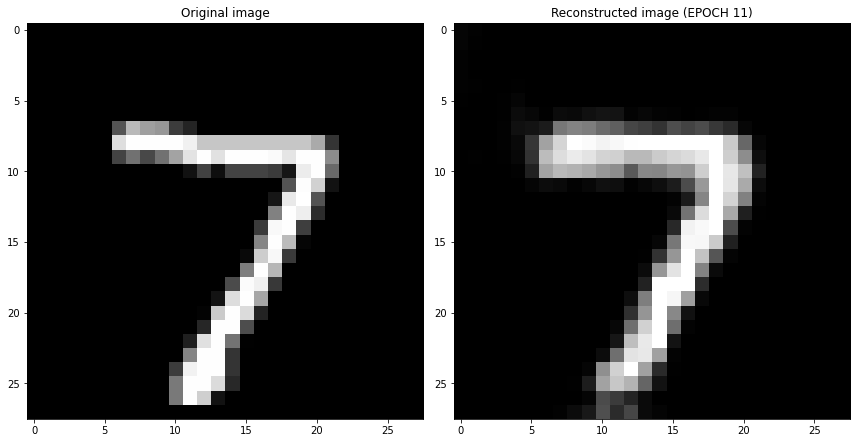

EPOCH 12/30
	 partial train loss (single batch): 0.034332
	 partial train loss (single batch): 0.034328
	 partial train loss (single batch): 0.035278
	 partial train loss (single batch): 0.035426
	 partial train loss (single batch): 0.035268
	 partial train loss (single batch): 0.035743
	 partial train loss (single batch): 0.035547
	 partial train loss (single batch): 0.034572
	 partial train loss (single batch): 0.034478
	 partial train loss (single batch): 0.034806
	 partial train loss (single batch): 0.033770
	 partial train loss (single batch): 0.035636
	 partial train loss (single batch): 0.035278
	 partial train loss (single batch): 0.035411
	 partial train loss (single batch): 0.033616
	 partial train loss (single batch): 0.033642
	 partial train loss (single batch): 0.036400
	 partial train loss (single batch): 0.035180
	 partial train loss (single batch): 0.034017
	 partial train loss (single batch): 0.035273
	 partial train loss (single batch): 0.035254
	 partial train loss (

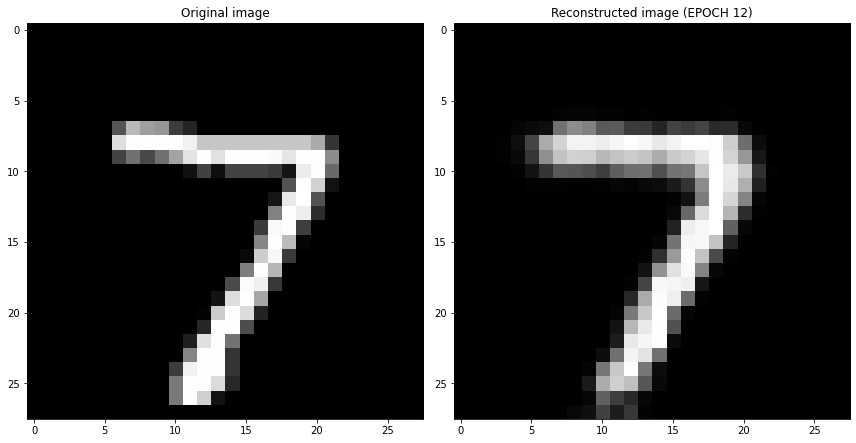

EPOCH 13/30
	 partial train loss (single batch): 0.034933
	 partial train loss (single batch): 0.036313
	 partial train loss (single batch): 0.032398
	 partial train loss (single batch): 0.033618
	 partial train loss (single batch): 0.034501
	 partial train loss (single batch): 0.035914
	 partial train loss (single batch): 0.037366
	 partial train loss (single batch): 0.034530
	 partial train loss (single batch): 0.034813
	 partial train loss (single batch): 0.033342
	 partial train loss (single batch): 0.034277
	 partial train loss (single batch): 0.034629
	 partial train loss (single batch): 0.033925
	 partial train loss (single batch): 0.033920
	 partial train loss (single batch): 0.034080
	 partial train loss (single batch): 0.033947
	 partial train loss (single batch): 0.033105
	 partial train loss (single batch): 0.033698
	 partial train loss (single batch): 0.034960
	 partial train loss (single batch): 0.032902
	 partial train loss (single batch): 0.035110
	 partial train loss (

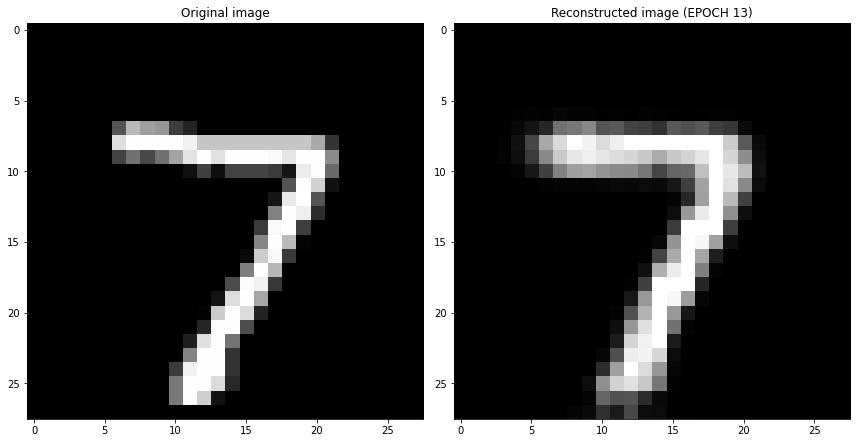

EPOCH 14/30
	 partial train loss (single batch): 0.032748
	 partial train loss (single batch): 0.031426
	 partial train loss (single batch): 0.032611
	 partial train loss (single batch): 0.035052
	 partial train loss (single batch): 0.033156
	 partial train loss (single batch): 0.033072
	 partial train loss (single batch): 0.036136
	 partial train loss (single batch): 0.033125
	 partial train loss (single batch): 0.034795
	 partial train loss (single batch): 0.033027
	 partial train loss (single batch): 0.035835
	 partial train loss (single batch): 0.033133
	 partial train loss (single batch): 0.033439
	 partial train loss (single batch): 0.033511
	 partial train loss (single batch): 0.033422
	 partial train loss (single batch): 0.033186
	 partial train loss (single batch): 0.033672
	 partial train loss (single batch): 0.032764
	 partial train loss (single batch): 0.032770
	 partial train loss (single batch): 0.034131
	 partial train loss (single batch): 0.033396
	 partial train loss (

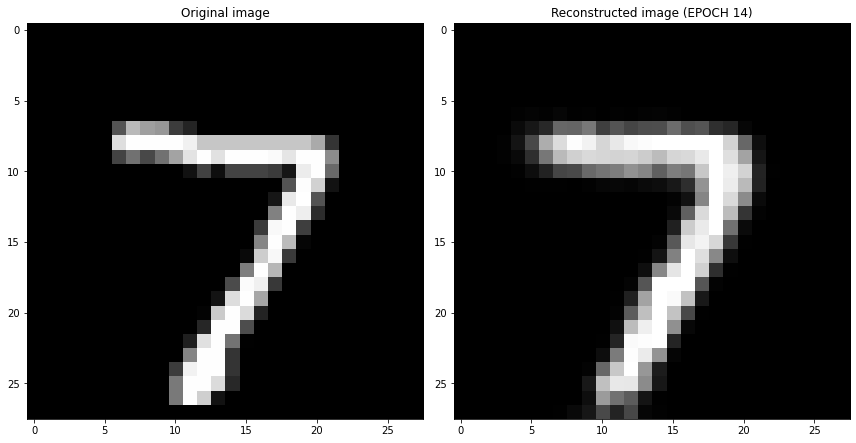

EPOCH 15/30
	 partial train loss (single batch): 0.034026
	 partial train loss (single batch): 0.032956
	 partial train loss (single batch): 0.032856
	 partial train loss (single batch): 0.032050
	 partial train loss (single batch): 0.030814
	 partial train loss (single batch): 0.032146
	 partial train loss (single batch): 0.035214
	 partial train loss (single batch): 0.033562
	 partial train loss (single batch): 0.034673
	 partial train loss (single batch): 0.034066
	 partial train loss (single batch): 0.033200
	 partial train loss (single batch): 0.033678
	 partial train loss (single batch): 0.032019
	 partial train loss (single batch): 0.033497
	 partial train loss (single batch): 0.034709
	 partial train loss (single batch): 0.031976
	 partial train loss (single batch): 0.033989
	 partial train loss (single batch): 0.032398
	 partial train loss (single batch): 0.033617
	 partial train loss (single batch): 0.030738
	 partial train loss (single batch): 0.033283
	 partial train loss (

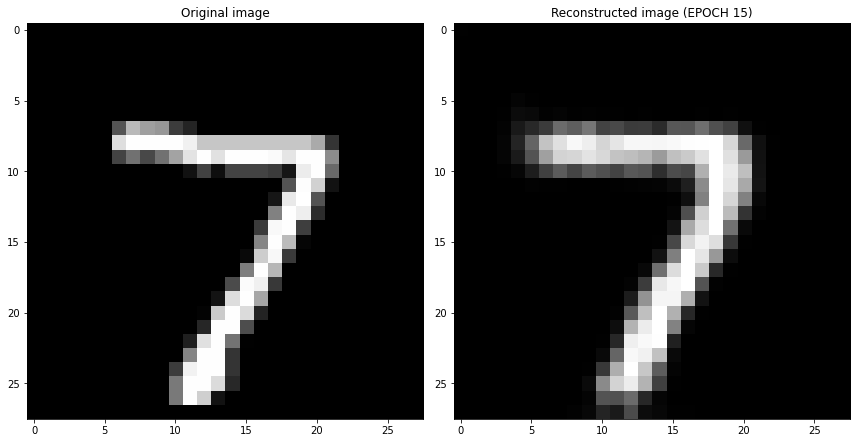

EPOCH 16/30
	 partial train loss (single batch): 0.031817
	 partial train loss (single batch): 0.032692
	 partial train loss (single batch): 0.031562
	 partial train loss (single batch): 0.033792
	 partial train loss (single batch): 0.033516
	 partial train loss (single batch): 0.033969
	 partial train loss (single batch): 0.032946
	 partial train loss (single batch): 0.032392
	 partial train loss (single batch): 0.033206
	 partial train loss (single batch): 0.031688
	 partial train loss (single batch): 0.033194
	 partial train loss (single batch): 0.031061
	 partial train loss (single batch): 0.033266
	 partial train loss (single batch): 0.032184
	 partial train loss (single batch): 0.032358
	 partial train loss (single batch): 0.034237
	 partial train loss (single batch): 0.032313
	 partial train loss (single batch): 0.032943
	 partial train loss (single batch): 0.030700
	 partial train loss (single batch): 0.032812
	 partial train loss (single batch): 0.033432
	 partial train loss (

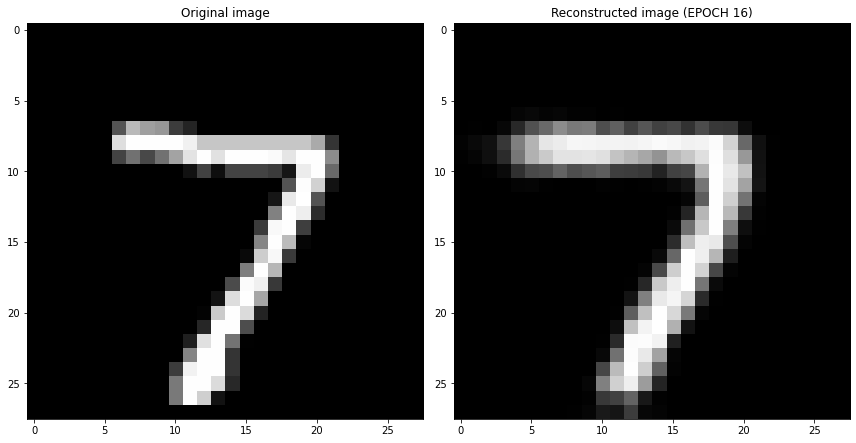

EPOCH 17/30
	 partial train loss (single batch): 0.032906
	 partial train loss (single batch): 0.032887
	 partial train loss (single batch): 0.032249
	 partial train loss (single batch): 0.032966
	 partial train loss (single batch): 0.031476
	 partial train loss (single batch): 0.031418
	 partial train loss (single batch): 0.032961
	 partial train loss (single batch): 0.034140
	 partial train loss (single batch): 0.029740
	 partial train loss (single batch): 0.031505
	 partial train loss (single batch): 0.031541
	 partial train loss (single batch): 0.033597
	 partial train loss (single batch): 0.033009
	 partial train loss (single batch): 0.033515
	 partial train loss (single batch): 0.031016
	 partial train loss (single batch): 0.033628
	 partial train loss (single batch): 0.033203
	 partial train loss (single batch): 0.032190
	 partial train loss (single batch): 0.032316
	 partial train loss (single batch): 0.031990
	 partial train loss (single batch): 0.032606
	 partial train loss (

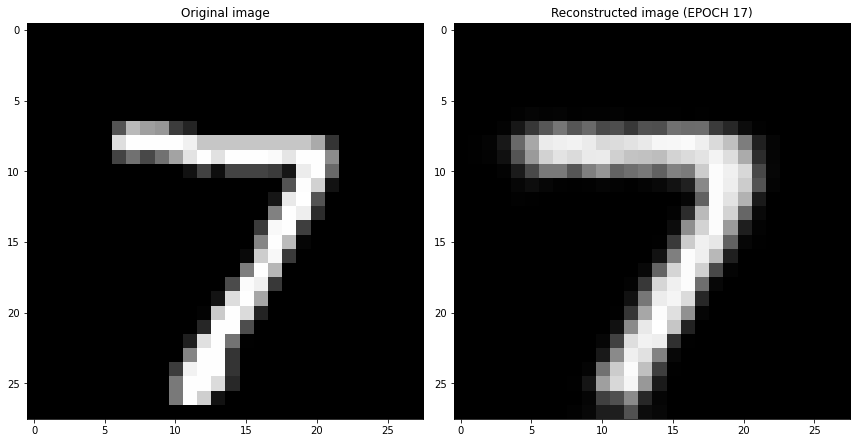

EPOCH 18/30
	 partial train loss (single batch): 0.034705
	 partial train loss (single batch): 0.032751
	 partial train loss (single batch): 0.033004
	 partial train loss (single batch): 0.031335
	 partial train loss (single batch): 0.031476
	 partial train loss (single batch): 0.032685
	 partial train loss (single batch): 0.032553
	 partial train loss (single batch): 0.032299
	 partial train loss (single batch): 0.034239
	 partial train loss (single batch): 0.032535
	 partial train loss (single batch): 0.033280
	 partial train loss (single batch): 0.032575
	 partial train loss (single batch): 0.029046
	 partial train loss (single batch): 0.032265
	 partial train loss (single batch): 0.033947
	 partial train loss (single batch): 0.032196
	 partial train loss (single batch): 0.032752
	 partial train loss (single batch): 0.031907
	 partial train loss (single batch): 0.033649
	 partial train loss (single batch): 0.033171
	 partial train loss (single batch): 0.032378
	 partial train loss (

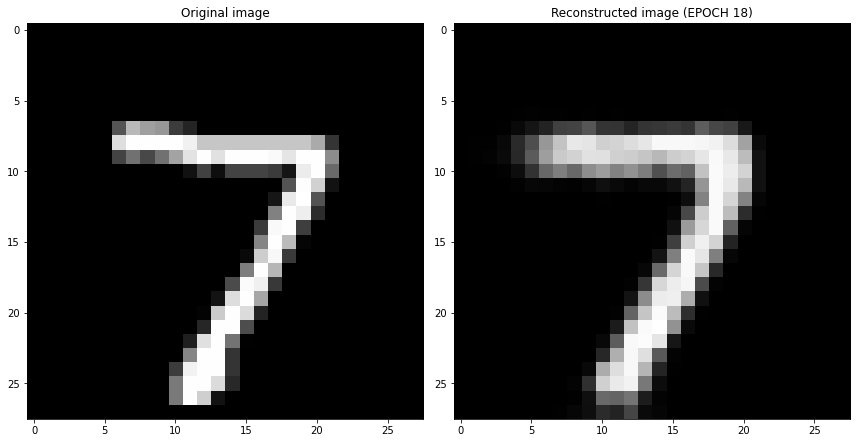

EPOCH 19/30
	 partial train loss (single batch): 0.031014
	 partial train loss (single batch): 0.032390
	 partial train loss (single batch): 0.032350
	 partial train loss (single batch): 0.033920
	 partial train loss (single batch): 0.034427
	 partial train loss (single batch): 0.031414
	 partial train loss (single batch): 0.033042
	 partial train loss (single batch): 0.033759
	 partial train loss (single batch): 0.032721
	 partial train loss (single batch): 0.031986
	 partial train loss (single batch): 0.032099
	 partial train loss (single batch): 0.032779
	 partial train loss (single batch): 0.033102
	 partial train loss (single batch): 0.031203
	 partial train loss (single batch): 0.032158
	 partial train loss (single batch): 0.034161
	 partial train loss (single batch): 0.032968
	 partial train loss (single batch): 0.030903
	 partial train loss (single batch): 0.032164
	 partial train loss (single batch): 0.033169
	 partial train loss (single batch): 0.032666
	 partial train loss (

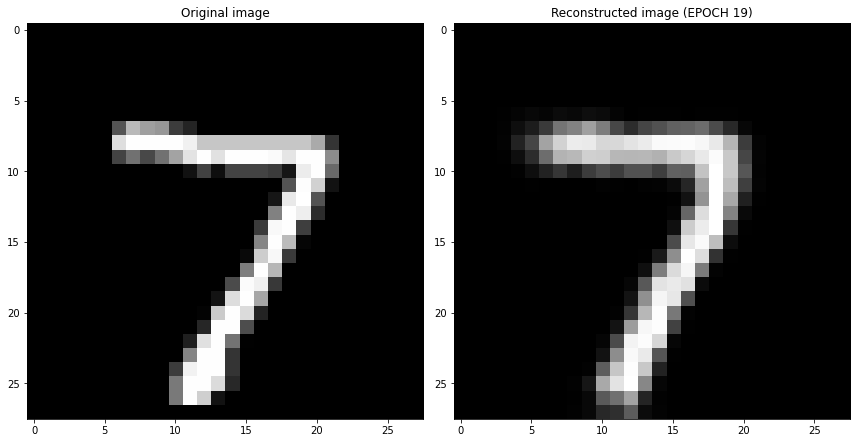

EPOCH 20/30
	 partial train loss (single batch): 0.035801
	 partial train loss (single batch): 0.031071
	 partial train loss (single batch): 0.032709
	 partial train loss (single batch): 0.030393
	 partial train loss (single batch): 0.032995
	 partial train loss (single batch): 0.032984
	 partial train loss (single batch): 0.033597
	 partial train loss (single batch): 0.031596
	 partial train loss (single batch): 0.032978
	 partial train loss (single batch): 0.030464
	 partial train loss (single batch): 0.032623
	 partial train loss (single batch): 0.032564
	 partial train loss (single batch): 0.033248
	 partial train loss (single batch): 0.031220
	 partial train loss (single batch): 0.031962
	 partial train loss (single batch): 0.031473
	 partial train loss (single batch): 0.031527
	 partial train loss (single batch): 0.030023
	 partial train loss (single batch): 0.033616
	 partial train loss (single batch): 0.031710
	 partial train loss (single batch): 0.032229
	 partial train loss (

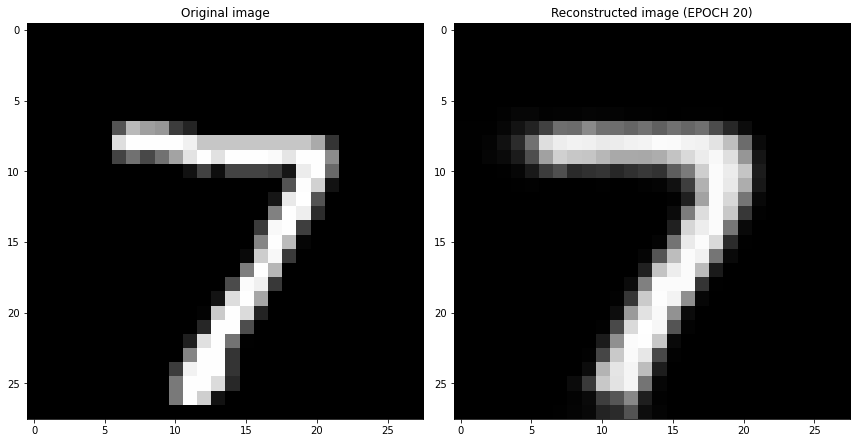

EPOCH 21/30
	 partial train loss (single batch): 0.030727
	 partial train loss (single batch): 0.032108
	 partial train loss (single batch): 0.034262
	 partial train loss (single batch): 0.032709
	 partial train loss (single batch): 0.032194
	 partial train loss (single batch): 0.033174
	 partial train loss (single batch): 0.031884
	 partial train loss (single batch): 0.030719
	 partial train loss (single batch): 0.031071
	 partial train loss (single batch): 0.030933
	 partial train loss (single batch): 0.032653
	 partial train loss (single batch): 0.032120
	 partial train loss (single batch): 0.032697
	 partial train loss (single batch): 0.032258
	 partial train loss (single batch): 0.031267
	 partial train loss (single batch): 0.031378
	 partial train loss (single batch): 0.030592
	 partial train loss (single batch): 0.031671
	 partial train loss (single batch): 0.032220
	 partial train loss (single batch): 0.030550
	 partial train loss (single batch): 0.032065
	 partial train loss (

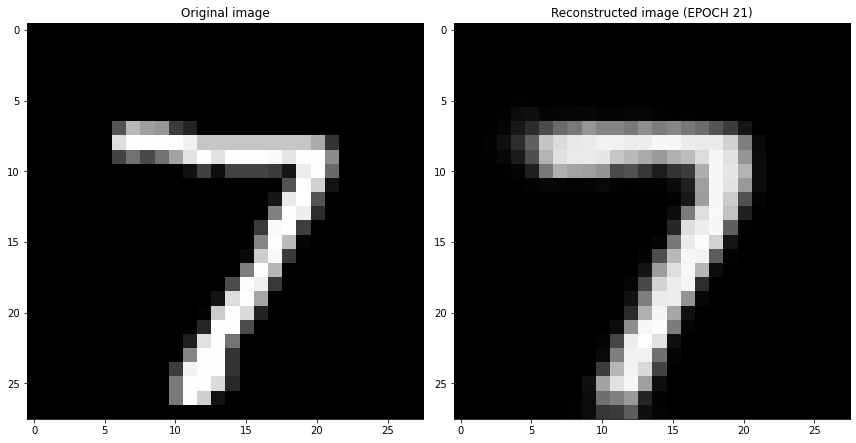

EPOCH 22/30
	 partial train loss (single batch): 0.031301
	 partial train loss (single batch): 0.031710
	 partial train loss (single batch): 0.030934
	 partial train loss (single batch): 0.031904
	 partial train loss (single batch): 0.029682
	 partial train loss (single batch): 0.030204
	 partial train loss (single batch): 0.033274
	 partial train loss (single batch): 0.031549
	 partial train loss (single batch): 0.032045
	 partial train loss (single batch): 0.030918
	 partial train loss (single batch): 0.031743
	 partial train loss (single batch): 0.032735
	 partial train loss (single batch): 0.031264
	 partial train loss (single batch): 0.033010
	 partial train loss (single batch): 0.033320
	 partial train loss (single batch): 0.031503
	 partial train loss (single batch): 0.032649
	 partial train loss (single batch): 0.031893
	 partial train loss (single batch): 0.032124
	 partial train loss (single batch): 0.032314
	 partial train loss (single batch): 0.031298
	 partial train loss (

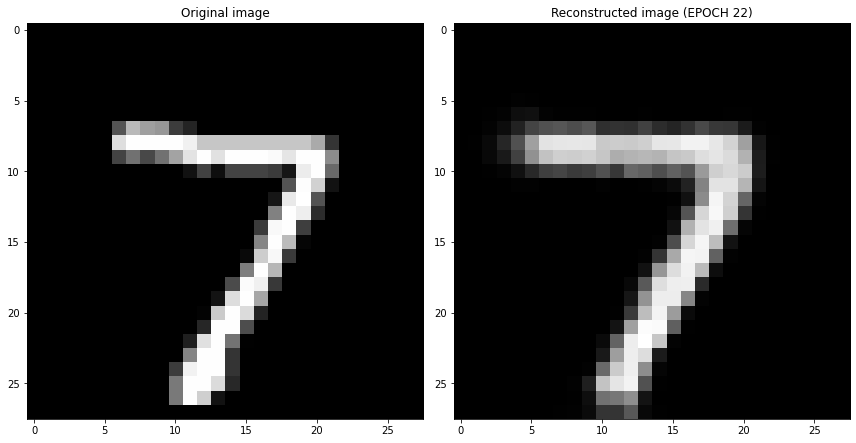

EPOCH 23/30
	 partial train loss (single batch): 0.030583
	 partial train loss (single batch): 0.031295
	 partial train loss (single batch): 0.031826
	 partial train loss (single batch): 0.033657
	 partial train loss (single batch): 0.032374
	 partial train loss (single batch): 0.031874
	 partial train loss (single batch): 0.031172
	 partial train loss (single batch): 0.029850
	 partial train loss (single batch): 0.031104
	 partial train loss (single batch): 0.030835
	 partial train loss (single batch): 0.032879
	 partial train loss (single batch): 0.030054
	 partial train loss (single batch): 0.031994
	 partial train loss (single batch): 0.031189
	 partial train loss (single batch): 0.029874
	 partial train loss (single batch): 0.031843
	 partial train loss (single batch): 0.031748
	 partial train loss (single batch): 0.032925
	 partial train loss (single batch): 0.030529
	 partial train loss (single batch): 0.030568
	 partial train loss (single batch): 0.030803
	 partial train loss (

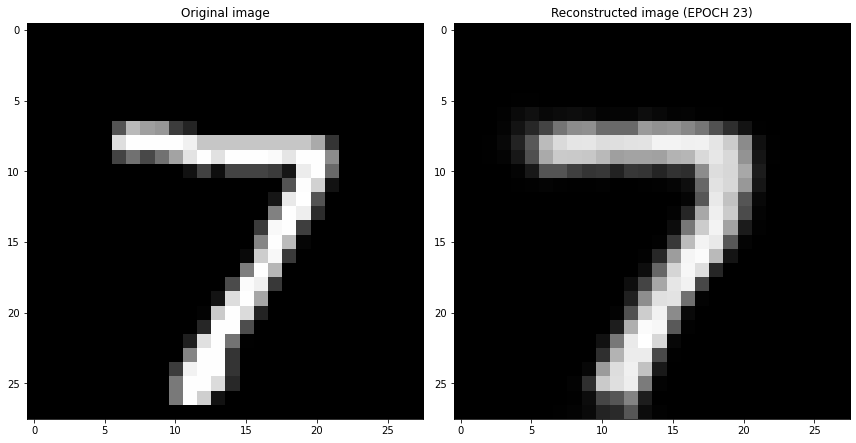

EPOCH 24/30
	 partial train loss (single batch): 0.030215
	 partial train loss (single batch): 0.031138
	 partial train loss (single batch): 0.030716
	 partial train loss (single batch): 0.031166
	 partial train loss (single batch): 0.031454
	 partial train loss (single batch): 0.032242
	 partial train loss (single batch): 0.029190
	 partial train loss (single batch): 0.030444
	 partial train loss (single batch): 0.031719
	 partial train loss (single batch): 0.031275
	 partial train loss (single batch): 0.031696
	 partial train loss (single batch): 0.032607
	 partial train loss (single batch): 0.031931
	 partial train loss (single batch): 0.030901
	 partial train loss (single batch): 0.031142
	 partial train loss (single batch): 0.031595
	 partial train loss (single batch): 0.030906
	 partial train loss (single batch): 0.031067
	 partial train loss (single batch): 0.032098
	 partial train loss (single batch): 0.031025
	 partial train loss (single batch): 0.032621
	 partial train loss (

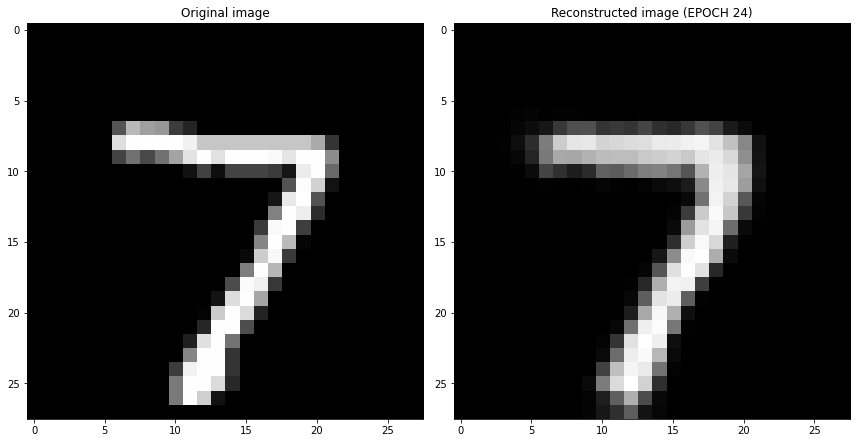

EPOCH 25/30
	 partial train loss (single batch): 0.031308
	 partial train loss (single batch): 0.033015
	 partial train loss (single batch): 0.032366
	 partial train loss (single batch): 0.031911
	 partial train loss (single batch): 0.032108
	 partial train loss (single batch): 0.032549
	 partial train loss (single batch): 0.030955
	 partial train loss (single batch): 0.032083
	 partial train loss (single batch): 0.030614
	 partial train loss (single batch): 0.032347
	 partial train loss (single batch): 0.031931
	 partial train loss (single batch): 0.030839
	 partial train loss (single batch): 0.032081
	 partial train loss (single batch): 0.030233
	 partial train loss (single batch): 0.031230
	 partial train loss (single batch): 0.030179
	 partial train loss (single batch): 0.032041
	 partial train loss (single batch): 0.032180
	 partial train loss (single batch): 0.030984
	 partial train loss (single batch): 0.031576
	 partial train loss (single batch): 0.030846
	 partial train loss (

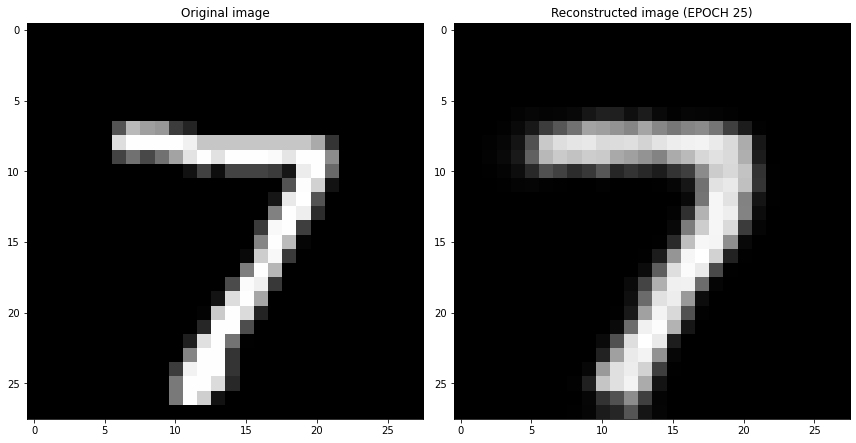

EPOCH 26/30
	 partial train loss (single batch): 0.032245
	 partial train loss (single batch): 0.032765
	 partial train loss (single batch): 0.030672
	 partial train loss (single batch): 0.030982
	 partial train loss (single batch): 0.030944
	 partial train loss (single batch): 0.032157
	 partial train loss (single batch): 0.031596
	 partial train loss (single batch): 0.030908
	 partial train loss (single batch): 0.030598
	 partial train loss (single batch): 0.030220
	 partial train loss (single batch): 0.033184
	 partial train loss (single batch): 0.030838
	 partial train loss (single batch): 0.032591
	 partial train loss (single batch): 0.031949
	 partial train loss (single batch): 0.032227
	 partial train loss (single batch): 0.031667
	 partial train loss (single batch): 0.030723
	 partial train loss (single batch): 0.030870
	 partial train loss (single batch): 0.032458
	 partial train loss (single batch): 0.032863
	 partial train loss (single batch): 0.030402
	 partial train loss (

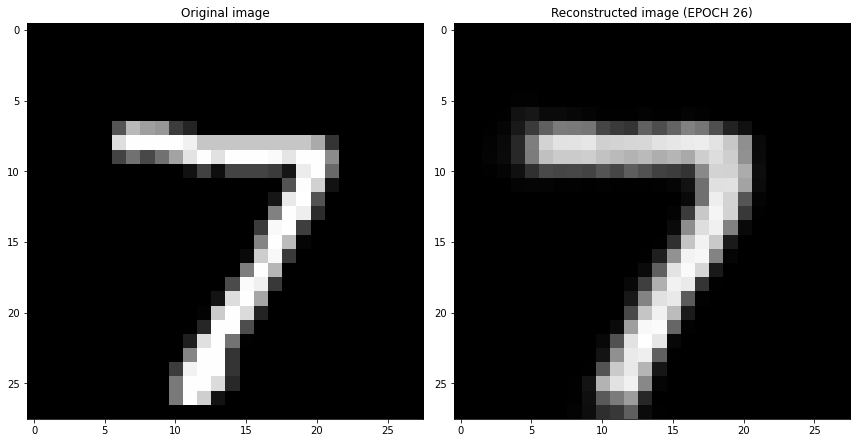

EPOCH 27/30
	 partial train loss (single batch): 0.030211
	 partial train loss (single batch): 0.032879
	 partial train loss (single batch): 0.031730
	 partial train loss (single batch): 0.031786
	 partial train loss (single batch): 0.031872
	 partial train loss (single batch): 0.032413
	 partial train loss (single batch): 0.031039
	 partial train loss (single batch): 0.030606
	 partial train loss (single batch): 0.033292
	 partial train loss (single batch): 0.031484
	 partial train loss (single batch): 0.030533
	 partial train loss (single batch): 0.030438
	 partial train loss (single batch): 0.030276
	 partial train loss (single batch): 0.033729
	 partial train loss (single batch): 0.030040
	 partial train loss (single batch): 0.030644
	 partial train loss (single batch): 0.030244
	 partial train loss (single batch): 0.031842
	 partial train loss (single batch): 0.031626
	 partial train loss (single batch): 0.030737
	 partial train loss (single batch): 0.031170
	 partial train loss (

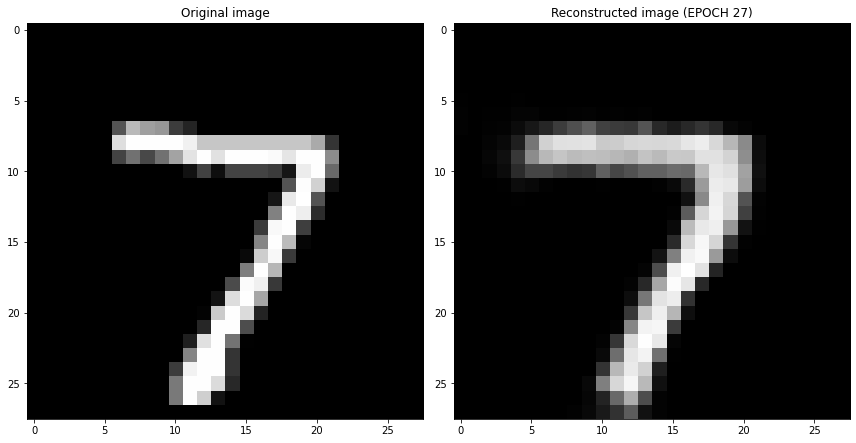

EPOCH 28/30
	 partial train loss (single batch): 0.031057
	 partial train loss (single batch): 0.029254
	 partial train loss (single batch): 0.030621
	 partial train loss (single batch): 0.029894
	 partial train loss (single batch): 0.030187
	 partial train loss (single batch): 0.030808
	 partial train loss (single batch): 0.030525
	 partial train loss (single batch): 0.030411
	 partial train loss (single batch): 0.030054
	 partial train loss (single batch): 0.032519
	 partial train loss (single batch): 0.029658
	 partial train loss (single batch): 0.030175
	 partial train loss (single batch): 0.031231
	 partial train loss (single batch): 0.030669
	 partial train loss (single batch): 0.030910
	 partial train loss (single batch): 0.030129
	 partial train loss (single batch): 0.032496
	 partial train loss (single batch): 0.029198
	 partial train loss (single batch): 0.030647
	 partial train loss (single batch): 0.032787
	 partial train loss (single batch): 0.029512
	 partial train loss (

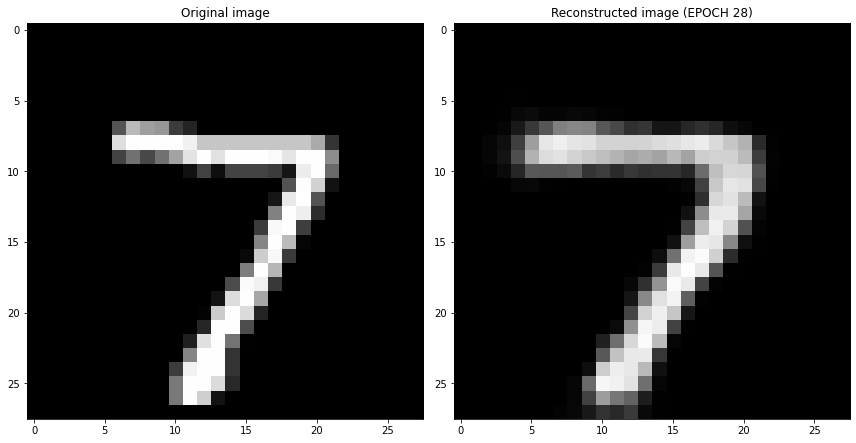

EPOCH 29/30
	 partial train loss (single batch): 0.032298
	 partial train loss (single batch): 0.030248
	 partial train loss (single batch): 0.030769
	 partial train loss (single batch): 0.031035
	 partial train loss (single batch): 0.031568
	 partial train loss (single batch): 0.029501
	 partial train loss (single batch): 0.030860
	 partial train loss (single batch): 0.031270
	 partial train loss (single batch): 0.030327
	 partial train loss (single batch): 0.030185
	 partial train loss (single batch): 0.030991
	 partial train loss (single batch): 0.031870
	 partial train loss (single batch): 0.031469
	 partial train loss (single batch): 0.031160
	 partial train loss (single batch): 0.030303
	 partial train loss (single batch): 0.030753
	 partial train loss (single batch): 0.032108
	 partial train loss (single batch): 0.031116
	 partial train loss (single batch): 0.030903
	 partial train loss (single batch): 0.030799
	 partial train loss (single batch): 0.030763
	 partial train loss (

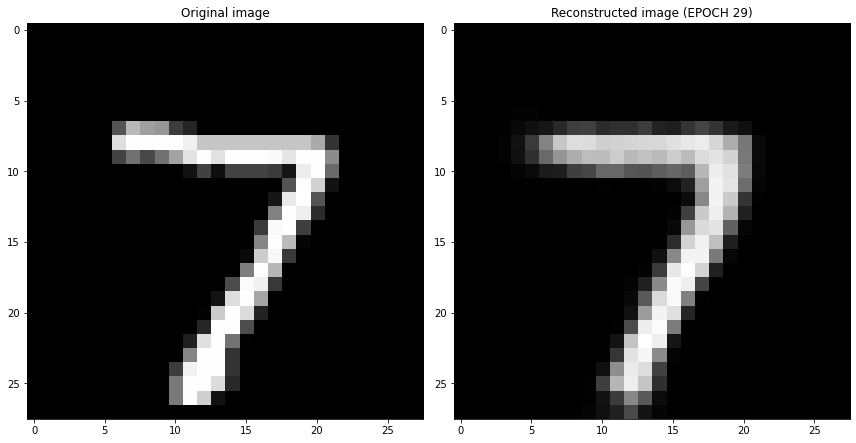

EPOCH 30/30
	 partial train loss (single batch): 0.031399
	 partial train loss (single batch): 0.032063
	 partial train loss (single batch): 0.030265
	 partial train loss (single batch): 0.029577
	 partial train loss (single batch): 0.032741
	 partial train loss (single batch): 0.030627
	 partial train loss (single batch): 0.031347
	 partial train loss (single batch): 0.030795
	 partial train loss (single batch): 0.031310
	 partial train loss (single batch): 0.031405
	 partial train loss (single batch): 0.028954
	 partial train loss (single batch): 0.031637
	 partial train loss (single batch): 0.030915
	 partial train loss (single batch): 0.031441
	 partial train loss (single batch): 0.031080
	 partial train loss (single batch): 0.031426
	 partial train loss (single batch): 0.030614
	 partial train loss (single batch): 0.030659
	 partial train loss (single batch): 0.032913
	 partial train loss (single batch): 0.030729
	 partial train loss (single batch): 0.029241
	 partial train loss (

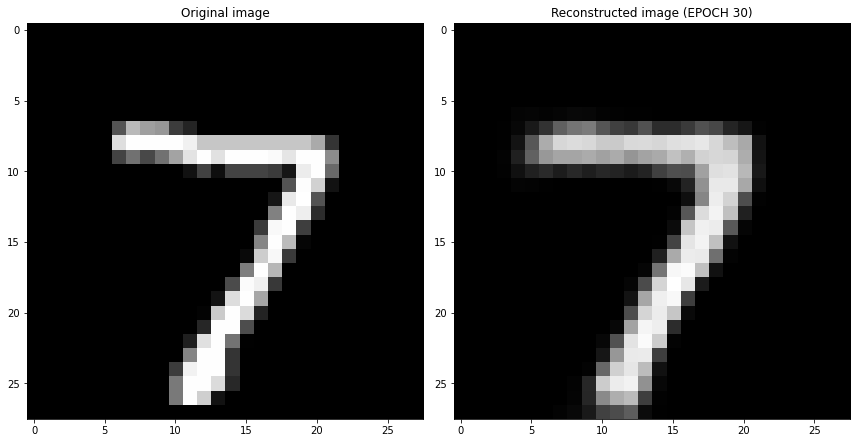

Cross validation fold number= 2/6
EPOCH 1/30
	 partial train loss (single batch): 0.283339
	 partial train loss (single batch): 0.279784
	 partial train loss (single batch): 0.275400
	 partial train loss (single batch): 0.270873
	 partial train loss (single batch): 0.260515
	 partial train loss (single batch): 0.239968
	 partial train loss (single batch): 0.227482
	 partial train loss (single batch): 0.195711
	 partial train loss (single batch): 0.170160
	 partial train loss (single batch): 0.141113
	 partial train loss (single batch): 0.115949
	 partial train loss (single batch): 0.095956
	 partial train loss (single batch): 0.088819
	 partial train loss (single batch): 0.088482
	 partial train loss (single batch): 0.090034
	 partial train loss (single batch): 0.089074
	 partial train loss (single batch): 0.086899
	 partial train loss (single batch): 0.086524
	 partial train loss (single batch): 0.086134
	 partial train loss (single batch): 0.083532
	 partial train loss (single batch)

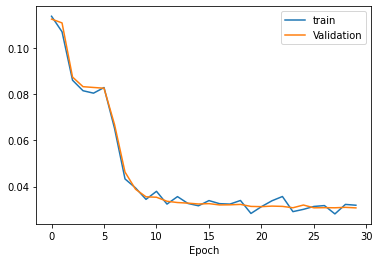

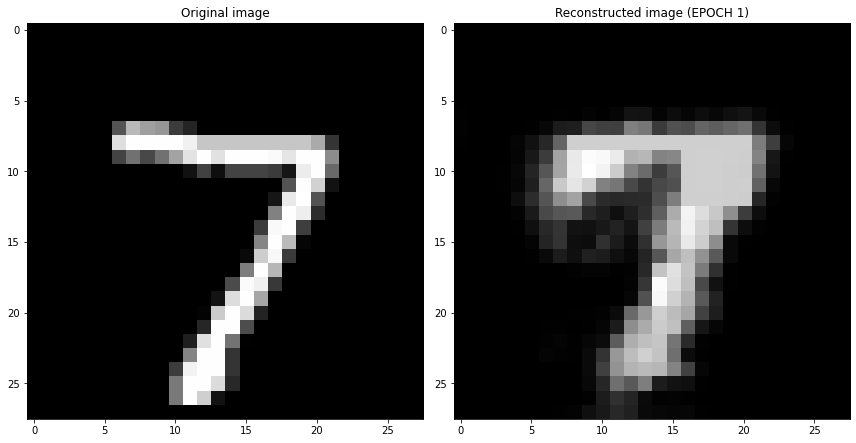

EPOCH 2/30
	 partial train loss (single batch): 0.047163
	 partial train loss (single batch): 0.047964
	 partial train loss (single batch): 0.048961
	 partial train loss (single batch): 0.047753
	 partial train loss (single batch): 0.047886
	 partial train loss (single batch): 0.048755
	 partial train loss (single batch): 0.047784
	 partial train loss (single batch): 0.047990
	 partial train loss (single batch): 0.049207
	 partial train loss (single batch): 0.047834
	 partial train loss (single batch): 0.048486
	 partial train loss (single batch): 0.049374
	 partial train loss (single batch): 0.047283
	 partial train loss (single batch): 0.048588
	 partial train loss (single batch): 0.047923
	 partial train loss (single batch): 0.047632
	 partial train loss (single batch): 0.048080
	 partial train loss (single batch): 0.048019
	 partial train loss (single batch): 0.046623
	 partial train loss (single batch): 0.047991
	 partial train loss (single batch): 0.046158
	 partial train loss (s

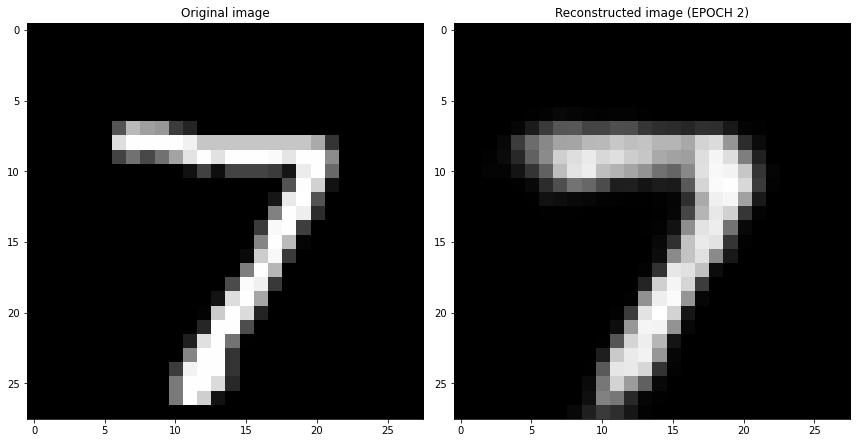

EPOCH 3/30
	 partial train loss (single batch): 0.036441
	 partial train loss (single batch): 0.036076
	 partial train loss (single batch): 0.037081
	 partial train loss (single batch): 0.038102
	 partial train loss (single batch): 0.035728
	 partial train loss (single batch): 0.035488
	 partial train loss (single batch): 0.036396
	 partial train loss (single batch): 0.036071
	 partial train loss (single batch): 0.036406
	 partial train loss (single batch): 0.036775
	 partial train loss (single batch): 0.036625
	 partial train loss (single batch): 0.038088
	 partial train loss (single batch): 0.035948
	 partial train loss (single batch): 0.033185
	 partial train loss (single batch): 0.034388
	 partial train loss (single batch): 0.036685
	 partial train loss (single batch): 0.037391
	 partial train loss (single batch): 0.034348
	 partial train loss (single batch): 0.035051
	 partial train loss (single batch): 0.035573
	 partial train loss (single batch): 0.033480
	 partial train loss (s

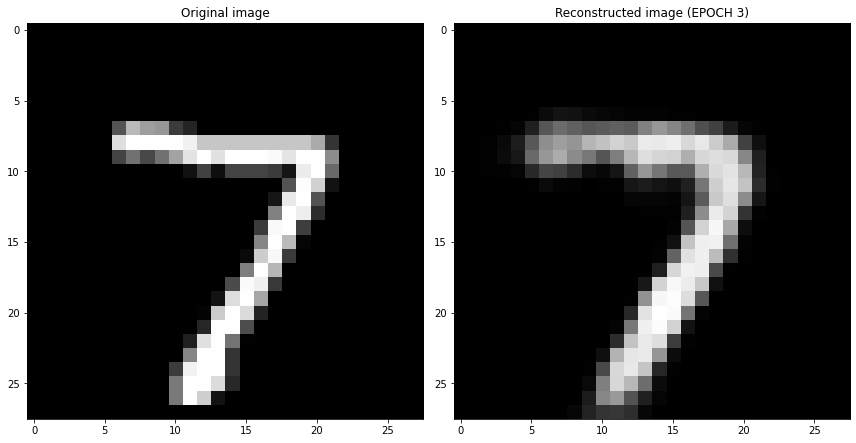

EPOCH 4/30
	 partial train loss (single batch): 0.033873
	 partial train loss (single batch): 0.033777
	 partial train loss (single batch): 0.033271
	 partial train loss (single batch): 0.033755
	 partial train loss (single batch): 0.033742
	 partial train loss (single batch): 0.033345
	 partial train loss (single batch): 0.033833
	 partial train loss (single batch): 0.033315
	 partial train loss (single batch): 0.032842
	 partial train loss (single batch): 0.031771
	 partial train loss (single batch): 0.033142
	 partial train loss (single batch): 0.035426
	 partial train loss (single batch): 0.032569
	 partial train loss (single batch): 0.034475
	 partial train loss (single batch): 0.033072
	 partial train loss (single batch): 0.030679
	 partial train loss (single batch): 0.031494
	 partial train loss (single batch): 0.034230
	 partial train loss (single batch): 0.031872
	 partial train loss (single batch): 0.033596
	 partial train loss (single batch): 0.031742
	 partial train loss (s

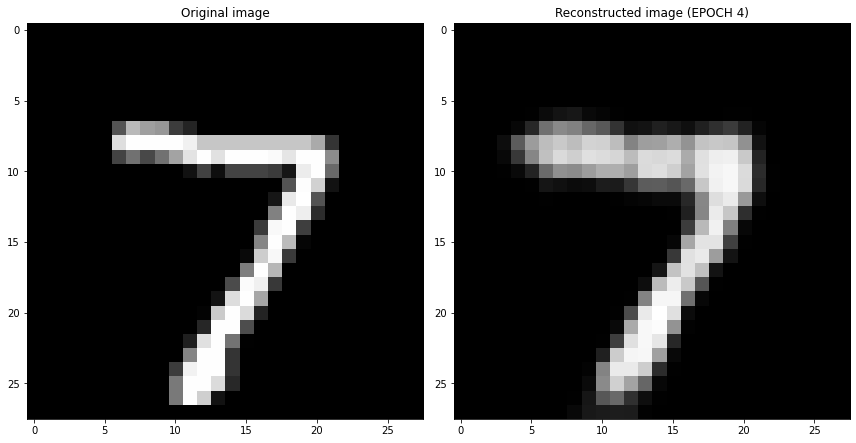

EPOCH 5/30
	 partial train loss (single batch): 0.033429
	 partial train loss (single batch): 0.031109
	 partial train loss (single batch): 0.030442
	 partial train loss (single batch): 0.032072
	 partial train loss (single batch): 0.033573
	 partial train loss (single batch): 0.031982
	 partial train loss (single batch): 0.032018
	 partial train loss (single batch): 0.031706
	 partial train loss (single batch): 0.031313
	 partial train loss (single batch): 0.032263
	 partial train loss (single batch): 0.030701
	 partial train loss (single batch): 0.030087
	 partial train loss (single batch): 0.032483
	 partial train loss (single batch): 0.030938
	 partial train loss (single batch): 0.033295
	 partial train loss (single batch): 0.030663
	 partial train loss (single batch): 0.031034
	 partial train loss (single batch): 0.031437
	 partial train loss (single batch): 0.033676
	 partial train loss (single batch): 0.030793
	 partial train loss (single batch): 0.032300
	 partial train loss (s

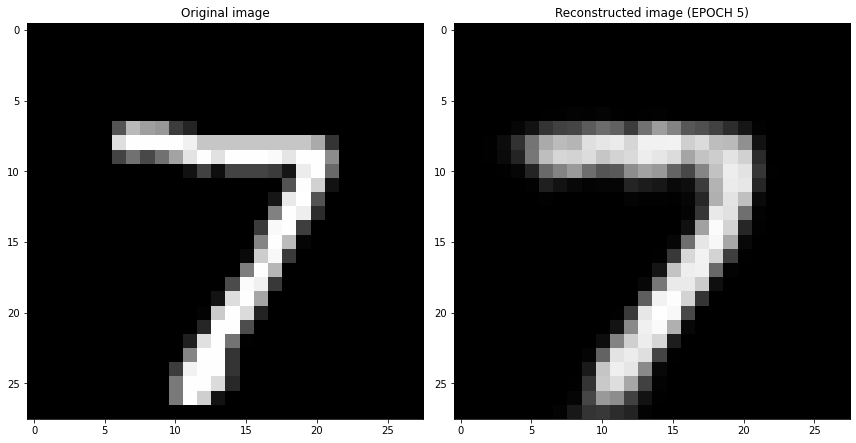

EPOCH 6/30
	 partial train loss (single batch): 0.032033
	 partial train loss (single batch): 0.032155
	 partial train loss (single batch): 0.031859
	 partial train loss (single batch): 0.029288
	 partial train loss (single batch): 0.031012
	 partial train loss (single batch): 0.029672
	 partial train loss (single batch): 0.032190
	 partial train loss (single batch): 0.031076
	 partial train loss (single batch): 0.030954
	 partial train loss (single batch): 0.031244
	 partial train loss (single batch): 0.032598
	 partial train loss (single batch): 0.030656
	 partial train loss (single batch): 0.030444
	 partial train loss (single batch): 0.030485
	 partial train loss (single batch): 0.030533
	 partial train loss (single batch): 0.031252
	 partial train loss (single batch): 0.031907
	 partial train loss (single batch): 0.030609
	 partial train loss (single batch): 0.031717
	 partial train loss (single batch): 0.031281
	 partial train loss (single batch): 0.032348
	 partial train loss (s

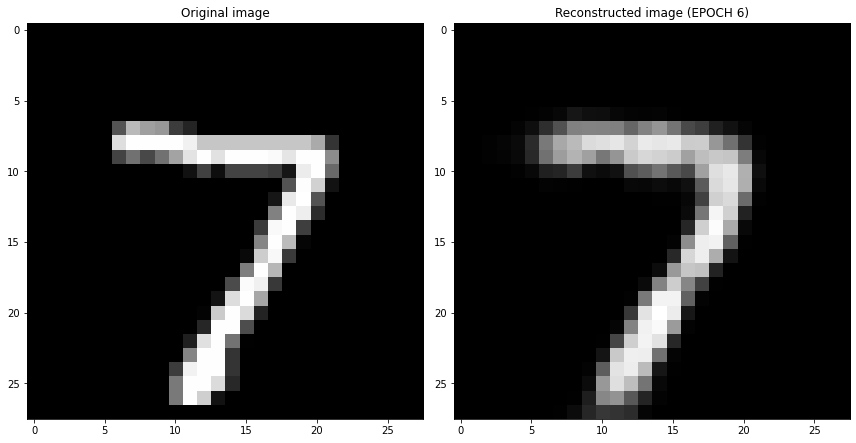

EPOCH 7/30
	 partial train loss (single batch): 0.030342
	 partial train loss (single batch): 0.031080
	 partial train loss (single batch): 0.030587
	 partial train loss (single batch): 0.030608
	 partial train loss (single batch): 0.032578
	 partial train loss (single batch): 0.030943
	 partial train loss (single batch): 0.033646
	 partial train loss (single batch): 0.031434
	 partial train loss (single batch): 0.030663
	 partial train loss (single batch): 0.028179
	 partial train loss (single batch): 0.029858
	 partial train loss (single batch): 0.030675
	 partial train loss (single batch): 0.028898
	 partial train loss (single batch): 0.029471
	 partial train loss (single batch): 0.029483
	 partial train loss (single batch): 0.031086
	 partial train loss (single batch): 0.030335
	 partial train loss (single batch): 0.031715
	 partial train loss (single batch): 0.030563
	 partial train loss (single batch): 0.031284
	 partial train loss (single batch): 0.030657
	 partial train loss (s

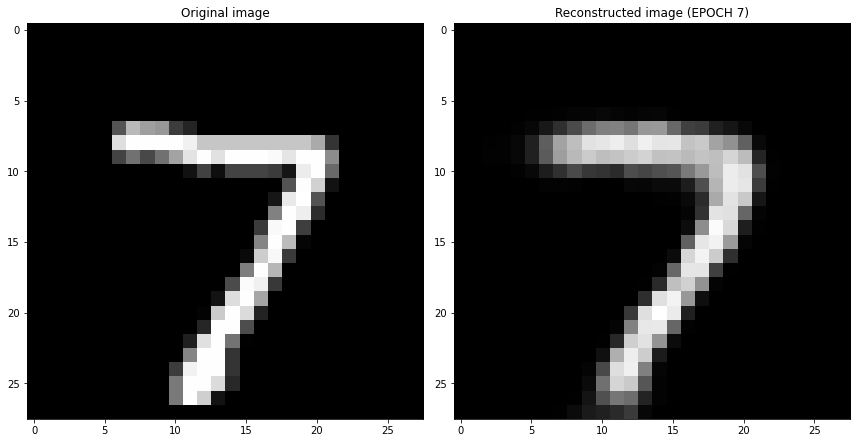

EPOCH 8/30
	 partial train loss (single batch): 0.030179
	 partial train loss (single batch): 0.029771
	 partial train loss (single batch): 0.029382
	 partial train loss (single batch): 0.030185
	 partial train loss (single batch): 0.030927
	 partial train loss (single batch): 0.030849
	 partial train loss (single batch): 0.029226
	 partial train loss (single batch): 0.029303
	 partial train loss (single batch): 0.029356
	 partial train loss (single batch): 0.031492
	 partial train loss (single batch): 0.030678
	 partial train loss (single batch): 0.030144
	 partial train loss (single batch): 0.030540
	 partial train loss (single batch): 0.031824
	 partial train loss (single batch): 0.031116
	 partial train loss (single batch): 0.029695
	 partial train loss (single batch): 0.027668
	 partial train loss (single batch): 0.030711
	 partial train loss (single batch): 0.031239
	 partial train loss (single batch): 0.030704
	 partial train loss (single batch): 0.030716
	 partial train loss (s

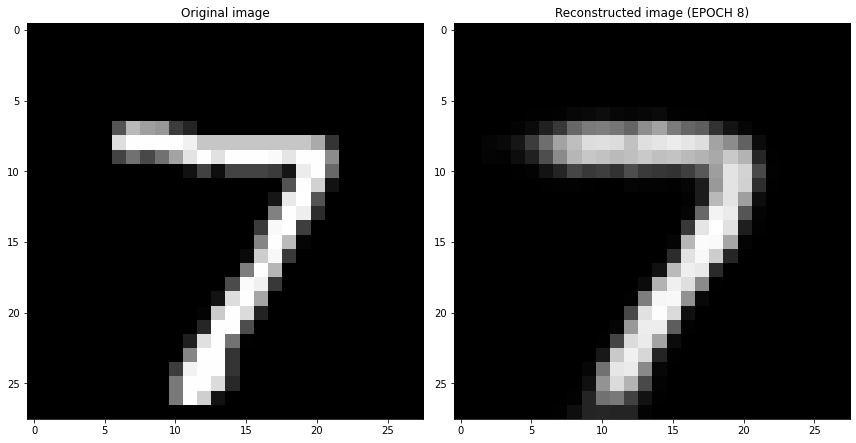

EPOCH 9/30
	 partial train loss (single batch): 0.031283
	 partial train loss (single batch): 0.029186
	 partial train loss (single batch): 0.029908
	 partial train loss (single batch): 0.029439
	 partial train loss (single batch): 0.029652
	 partial train loss (single batch): 0.030068
	 partial train loss (single batch): 0.029577
	 partial train loss (single batch): 0.030255
	 partial train loss (single batch): 0.031944
	 partial train loss (single batch): 0.031649
	 partial train loss (single batch): 0.028579
	 partial train loss (single batch): 0.028612
	 partial train loss (single batch): 0.029835
	 partial train loss (single batch): 0.030240
	 partial train loss (single batch): 0.031540
	 partial train loss (single batch): 0.029196
	 partial train loss (single batch): 0.030748
	 partial train loss (single batch): 0.030140
	 partial train loss (single batch): 0.030305
	 partial train loss (single batch): 0.032196
	 partial train loss (single batch): 0.032315
	 partial train loss (s

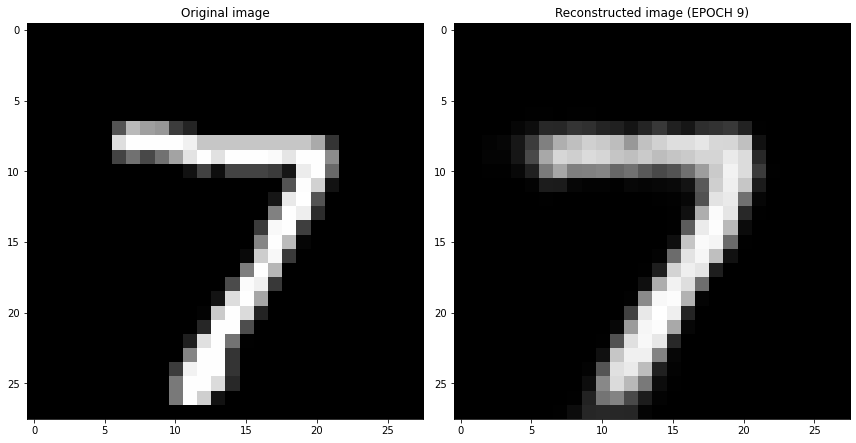

EPOCH 10/30
	 partial train loss (single batch): 0.031106
	 partial train loss (single batch): 0.029609
	 partial train loss (single batch): 0.029780
	 partial train loss (single batch): 0.030008
	 partial train loss (single batch): 0.029599
	 partial train loss (single batch): 0.031972
	 partial train loss (single batch): 0.030707
	 partial train loss (single batch): 0.029534
	 partial train loss (single batch): 0.029237
	 partial train loss (single batch): 0.032222
	 partial train loss (single batch): 0.030229
	 partial train loss (single batch): 0.030529
	 partial train loss (single batch): 0.031103
	 partial train loss (single batch): 0.031896
	 partial train loss (single batch): 0.030232
	 partial train loss (single batch): 0.029426
	 partial train loss (single batch): 0.030899
	 partial train loss (single batch): 0.029852
	 partial train loss (single batch): 0.031365
	 partial train loss (single batch): 0.030954
	 partial train loss (single batch): 0.030012
	 partial train loss (

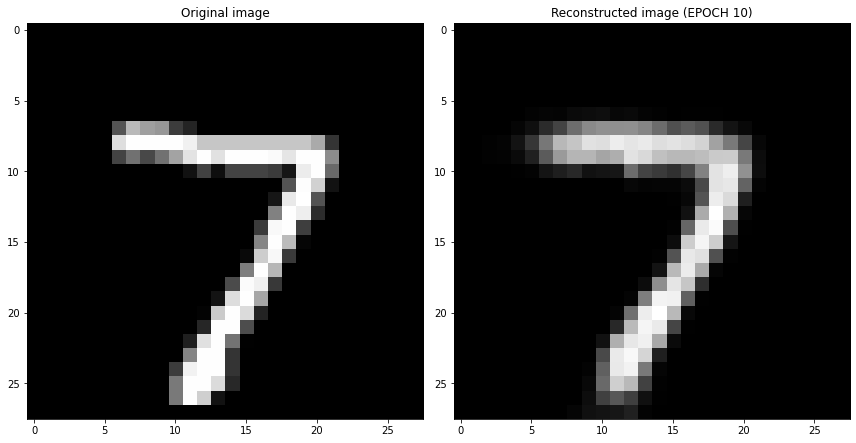

EPOCH 11/30
	 partial train loss (single batch): 0.030963
	 partial train loss (single batch): 0.031350
	 partial train loss (single batch): 0.030893
	 partial train loss (single batch): 0.031111
	 partial train loss (single batch): 0.030529
	 partial train loss (single batch): 0.031163
	 partial train loss (single batch): 0.030808
	 partial train loss (single batch): 0.028602
	 partial train loss (single batch): 0.030079
	 partial train loss (single batch): 0.030967
	 partial train loss (single batch): 0.032243
	 partial train loss (single batch): 0.029324
	 partial train loss (single batch): 0.029116
	 partial train loss (single batch): 0.029718
	 partial train loss (single batch): 0.030724
	 partial train loss (single batch): 0.030441
	 partial train loss (single batch): 0.030419
	 partial train loss (single batch): 0.029671
	 partial train loss (single batch): 0.028701
	 partial train loss (single batch): 0.029862
	 partial train loss (single batch): 0.029747
	 partial train loss (

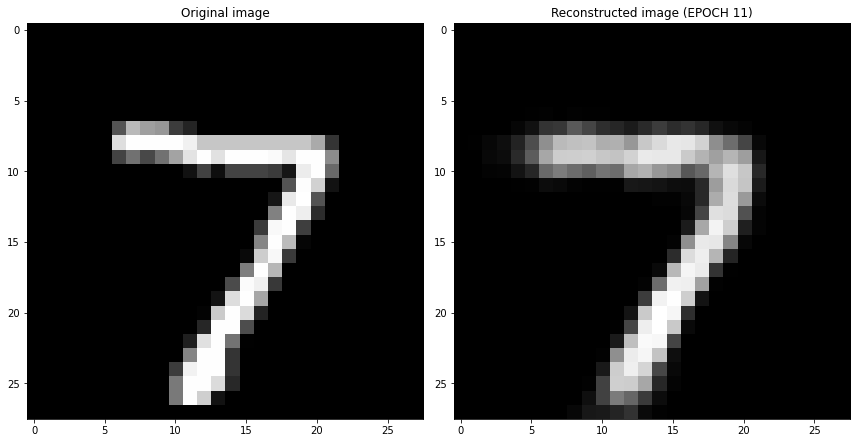

EPOCH 12/30
	 partial train loss (single batch): 0.029977
	 partial train loss (single batch): 0.030395
	 partial train loss (single batch): 0.029712
	 partial train loss (single batch): 0.031255
	 partial train loss (single batch): 0.030329
	 partial train loss (single batch): 0.029947
	 partial train loss (single batch): 0.029676
	 partial train loss (single batch): 0.027494
	 partial train loss (single batch): 0.028826
	 partial train loss (single batch): 0.029429
	 partial train loss (single batch): 0.028088
	 partial train loss (single batch): 0.030352
	 partial train loss (single batch): 0.029533
	 partial train loss (single batch): 0.027952
	 partial train loss (single batch): 0.029391
	 partial train loss (single batch): 0.029837
	 partial train loss (single batch): 0.030424
	 partial train loss (single batch): 0.029360
	 partial train loss (single batch): 0.030288
	 partial train loss (single batch): 0.030511
	 partial train loss (single batch): 0.030405
	 partial train loss (

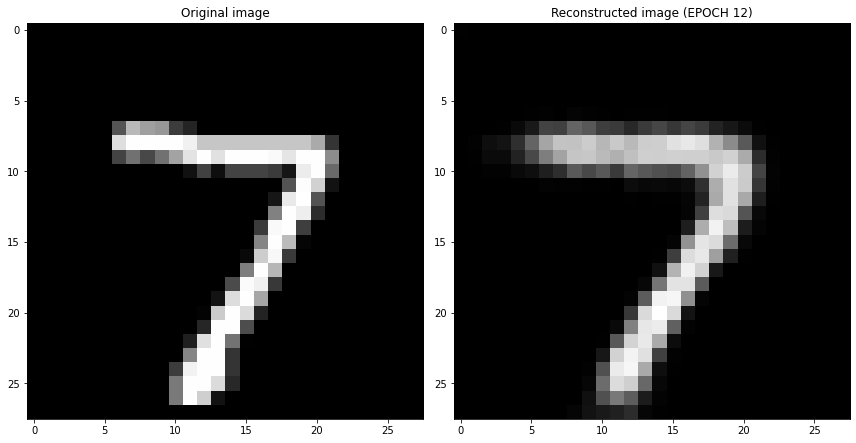

EPOCH 13/30
	 partial train loss (single batch): 0.029215
	 partial train loss (single batch): 0.030357
	 partial train loss (single batch): 0.030066
	 partial train loss (single batch): 0.031069
	 partial train loss (single batch): 0.030626
	 partial train loss (single batch): 0.028379
	 partial train loss (single batch): 0.028678
	 partial train loss (single batch): 0.031400
	 partial train loss (single batch): 0.030205
	 partial train loss (single batch): 0.030487
	 partial train loss (single batch): 0.029481
	 partial train loss (single batch): 0.030327
	 partial train loss (single batch): 0.030203
	 partial train loss (single batch): 0.030027
	 partial train loss (single batch): 0.029362
	 partial train loss (single batch): 0.030443
	 partial train loss (single batch): 0.028166
	 partial train loss (single batch): 0.030104
	 partial train loss (single batch): 0.029905
	 partial train loss (single batch): 0.029043
	 partial train loss (single batch): 0.029758
	 partial train loss (

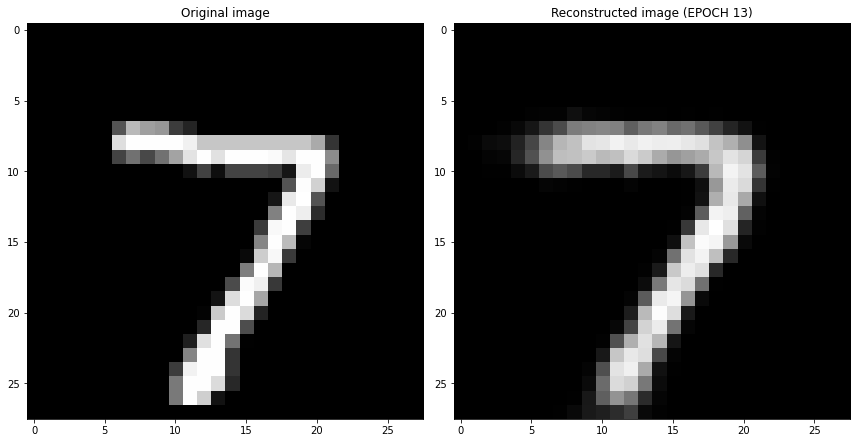

EPOCH 14/30
	 partial train loss (single batch): 0.030094
	 partial train loss (single batch): 0.029617
	 partial train loss (single batch): 0.030118
	 partial train loss (single batch): 0.031598
	 partial train loss (single batch): 0.030243
	 partial train loss (single batch): 0.028041
	 partial train loss (single batch): 0.030234
	 partial train loss (single batch): 0.028750
	 partial train loss (single batch): 0.030506
	 partial train loss (single batch): 0.030920
	 partial train loss (single batch): 0.029139
	 partial train loss (single batch): 0.030878
	 partial train loss (single batch): 0.029591
	 partial train loss (single batch): 0.030414
	 partial train loss (single batch): 0.030816
	 partial train loss (single batch): 0.030631
	 partial train loss (single batch): 0.030355
	 partial train loss (single batch): 0.029745
	 partial train loss (single batch): 0.028062
	 partial train loss (single batch): 0.029860
	 partial train loss (single batch): 0.028518
	 partial train loss (

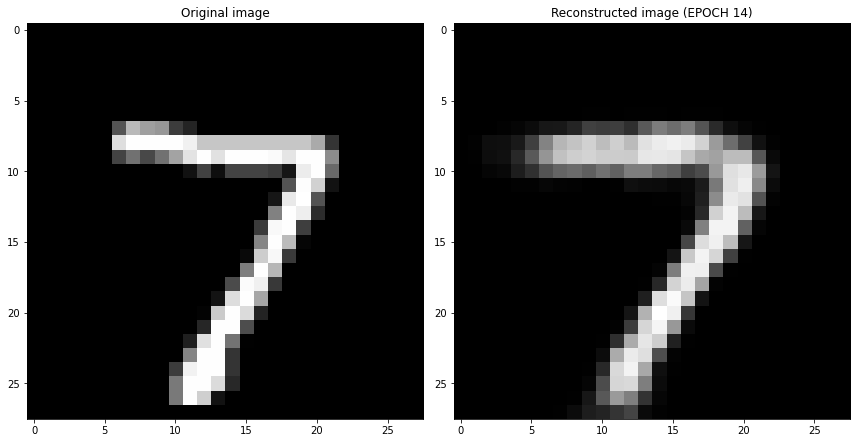

EPOCH 15/30
	 partial train loss (single batch): 0.029785
	 partial train loss (single batch): 0.030065
	 partial train loss (single batch): 0.029373
	 partial train loss (single batch): 0.030686
	 partial train loss (single batch): 0.030309
	 partial train loss (single batch): 0.030219
	 partial train loss (single batch): 0.028915
	 partial train loss (single batch): 0.029234
	 partial train loss (single batch): 0.028861
	 partial train loss (single batch): 0.030369
	 partial train loss (single batch): 0.028344
	 partial train loss (single batch): 0.029980
	 partial train loss (single batch): 0.030271
	 partial train loss (single batch): 0.026889
	 partial train loss (single batch): 0.030194
	 partial train loss (single batch): 0.029725
	 partial train loss (single batch): 0.028790
	 partial train loss (single batch): 0.029475
	 partial train loss (single batch): 0.031137
	 partial train loss (single batch): 0.029917
	 partial train loss (single batch): 0.028758
	 partial train loss (

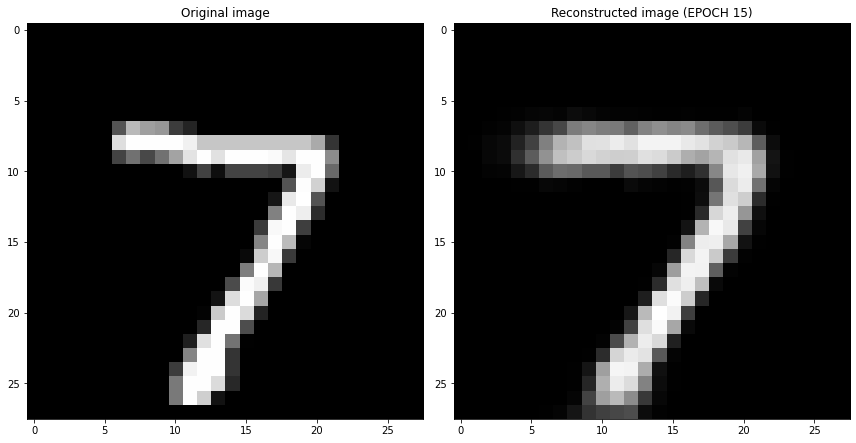

EPOCH 16/30
	 partial train loss (single batch): 0.029688
	 partial train loss (single batch): 0.029137
	 partial train loss (single batch): 0.028584
	 partial train loss (single batch): 0.028335
	 partial train loss (single batch): 0.029145
	 partial train loss (single batch): 0.029622
	 partial train loss (single batch): 0.030220
	 partial train loss (single batch): 0.031023
	 partial train loss (single batch): 0.029601
	 partial train loss (single batch): 0.031069
	 partial train loss (single batch): 0.029977
	 partial train loss (single batch): 0.030550
	 partial train loss (single batch): 0.029697
	 partial train loss (single batch): 0.029308
	 partial train loss (single batch): 0.029604
	 partial train loss (single batch): 0.029707
	 partial train loss (single batch): 0.028835
	 partial train loss (single batch): 0.029416
	 partial train loss (single batch): 0.028975
	 partial train loss (single batch): 0.029291
	 partial train loss (single batch): 0.029370
	 partial train loss (

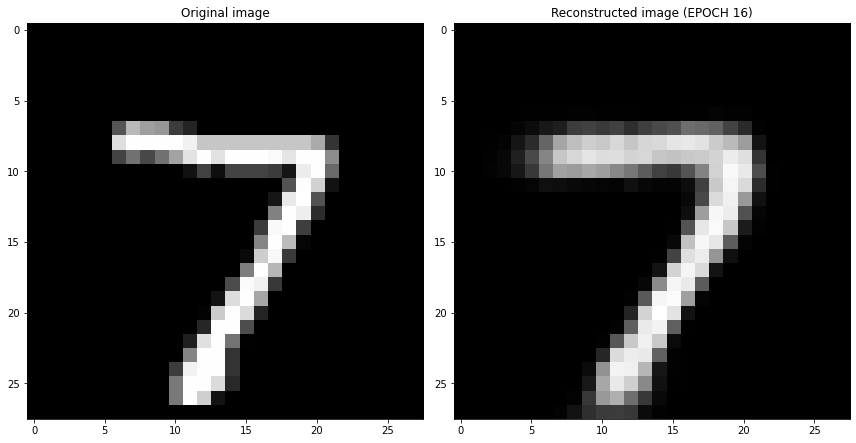

EPOCH 17/30
	 partial train loss (single batch): 0.029712
	 partial train loss (single batch): 0.030027
	 partial train loss (single batch): 0.029371
	 partial train loss (single batch): 0.028181
	 partial train loss (single batch): 0.030258
	 partial train loss (single batch): 0.030504
	 partial train loss (single batch): 0.028956
	 partial train loss (single batch): 0.029339
	 partial train loss (single batch): 0.028916
	 partial train loss (single batch): 0.029427
	 partial train loss (single batch): 0.028894
	 partial train loss (single batch): 0.028110
	 partial train loss (single batch): 0.028415
	 partial train loss (single batch): 0.028947
	 partial train loss (single batch): 0.030364
	 partial train loss (single batch): 0.030272
	 partial train loss (single batch): 0.029309
	 partial train loss (single batch): 0.027608
	 partial train loss (single batch): 0.028305
	 partial train loss (single batch): 0.028920
	 partial train loss (single batch): 0.029272
	 partial train loss (

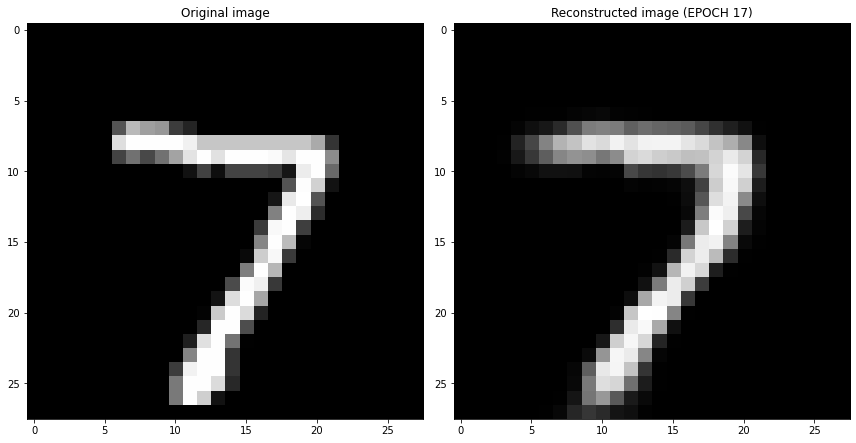

EPOCH 18/30
	 partial train loss (single batch): 0.028917
	 partial train loss (single batch): 0.030062
	 partial train loss (single batch): 0.029588
	 partial train loss (single batch): 0.031426
	 partial train loss (single batch): 0.030251
	 partial train loss (single batch): 0.030482
	 partial train loss (single batch): 0.029745
	 partial train loss (single batch): 0.030830
	 partial train loss (single batch): 0.031230
	 partial train loss (single batch): 0.029729
	 partial train loss (single batch): 0.028775
	 partial train loss (single batch): 0.030162
	 partial train loss (single batch): 0.029997
	 partial train loss (single batch): 0.028574
	 partial train loss (single batch): 0.029950
	 partial train loss (single batch): 0.028894
	 partial train loss (single batch): 0.028476
	 partial train loss (single batch): 0.029634
	 partial train loss (single batch): 0.029347
	 partial train loss (single batch): 0.030639
	 partial train loss (single batch): 0.029199
	 partial train loss (

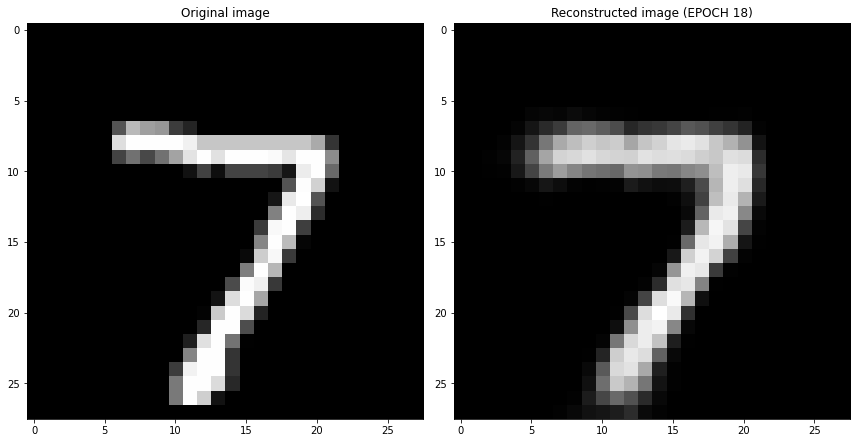

EPOCH 19/30
	 partial train loss (single batch): 0.028839
	 partial train loss (single batch): 0.027870
	 partial train loss (single batch): 0.028043
	 partial train loss (single batch): 0.028629
	 partial train loss (single batch): 0.028064
	 partial train loss (single batch): 0.029876
	 partial train loss (single batch): 0.030151
	 partial train loss (single batch): 0.030626
	 partial train loss (single batch): 0.029191
	 partial train loss (single batch): 0.029467
	 partial train loss (single batch): 0.028702
	 partial train loss (single batch): 0.030588
	 partial train loss (single batch): 0.028529
	 partial train loss (single batch): 0.030245
	 partial train loss (single batch): 0.029438
	 partial train loss (single batch): 0.030896
	 partial train loss (single batch): 0.027949
	 partial train loss (single batch): 0.030071
	 partial train loss (single batch): 0.026740
	 partial train loss (single batch): 0.030169
	 partial train loss (single batch): 0.028112
	 partial train loss (

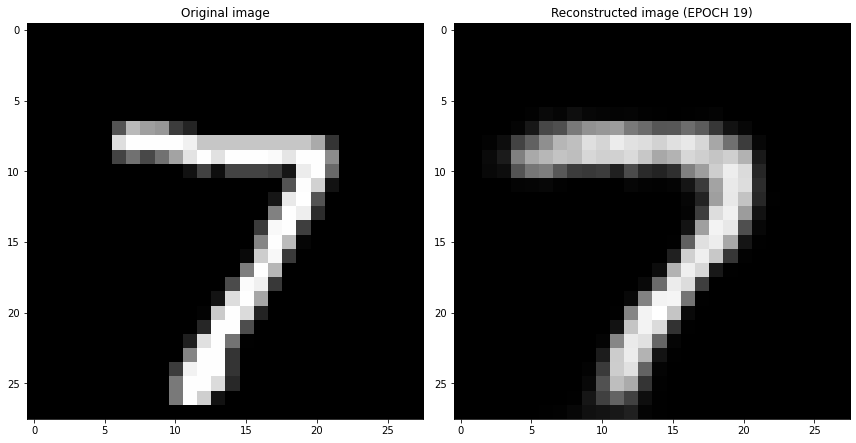

EPOCH 20/30
	 partial train loss (single batch): 0.029617
	 partial train loss (single batch): 0.030509
	 partial train loss (single batch): 0.028480
	 partial train loss (single batch): 0.027900
	 partial train loss (single batch): 0.028865
	 partial train loss (single batch): 0.028801
	 partial train loss (single batch): 0.030119
	 partial train loss (single batch): 0.029601
	 partial train loss (single batch): 0.027390
	 partial train loss (single batch): 0.027646
	 partial train loss (single batch): 0.029205
	 partial train loss (single batch): 0.029008
	 partial train loss (single batch): 0.030679
	 partial train loss (single batch): 0.028839
	 partial train loss (single batch): 0.028392
	 partial train loss (single batch): 0.029055
	 partial train loss (single batch): 0.029182
	 partial train loss (single batch): 0.029384
	 partial train loss (single batch): 0.030037
	 partial train loss (single batch): 0.029577
	 partial train loss (single batch): 0.029101
	 partial train loss (

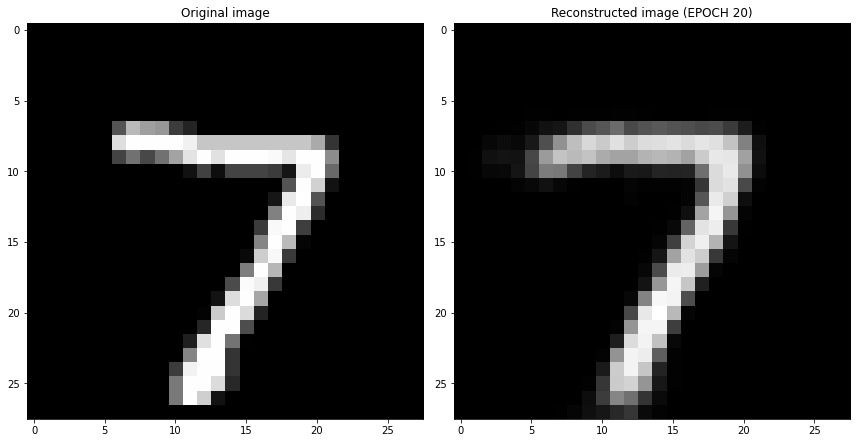

EPOCH 21/30
	 partial train loss (single batch): 0.029547
	 partial train loss (single batch): 0.029791
	 partial train loss (single batch): 0.031701
	 partial train loss (single batch): 0.031124
	 partial train loss (single batch): 0.030321
	 partial train loss (single batch): 0.028325
	 partial train loss (single batch): 0.027900
	 partial train loss (single batch): 0.028835
	 partial train loss (single batch): 0.028890
	 partial train loss (single batch): 0.031231
	 partial train loss (single batch): 0.028026
	 partial train loss (single batch): 0.029593
	 partial train loss (single batch): 0.030970
	 partial train loss (single batch): 0.027415
	 partial train loss (single batch): 0.029161
	 partial train loss (single batch): 0.029381
	 partial train loss (single batch): 0.029836
	 partial train loss (single batch): 0.029812
	 partial train loss (single batch): 0.028921
	 partial train loss (single batch): 0.029867
	 partial train loss (single batch): 0.029194
	 partial train loss (

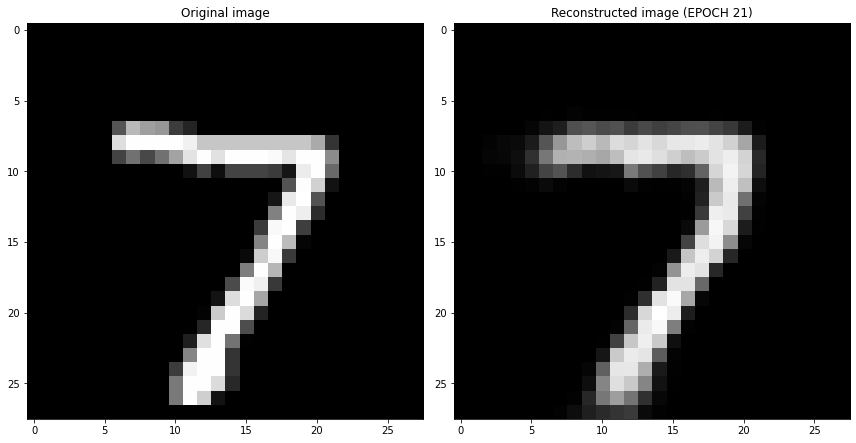

EPOCH 22/30
	 partial train loss (single batch): 0.027838
	 partial train loss (single batch): 0.029326
	 partial train loss (single batch): 0.028997
	 partial train loss (single batch): 0.029382
	 partial train loss (single batch): 0.029916
	 partial train loss (single batch): 0.028750
	 partial train loss (single batch): 0.029948
	 partial train loss (single batch): 0.029573
	 partial train loss (single batch): 0.028897
	 partial train loss (single batch): 0.030366
	 partial train loss (single batch): 0.030353
	 partial train loss (single batch): 0.029818
	 partial train loss (single batch): 0.028294
	 partial train loss (single batch): 0.029965
	 partial train loss (single batch): 0.027762
	 partial train loss (single batch): 0.030209
	 partial train loss (single batch): 0.028964
	 partial train loss (single batch): 0.028858
	 partial train loss (single batch): 0.029192
	 partial train loss (single batch): 0.030213
	 partial train loss (single batch): 0.028463
	 partial train loss (

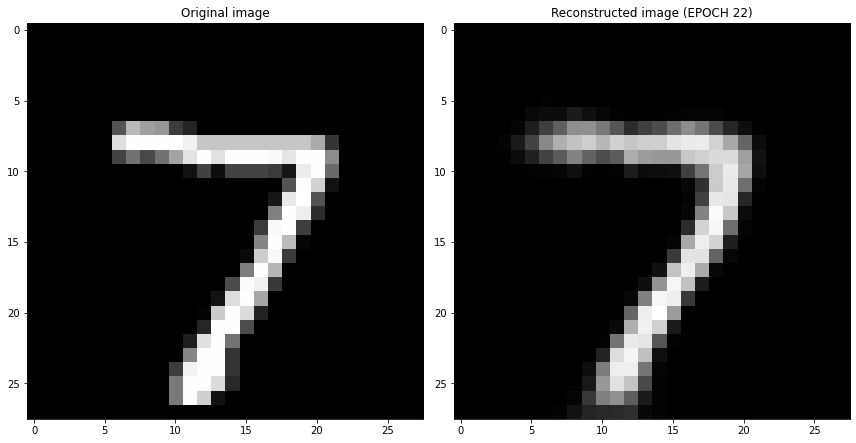

EPOCH 23/30
	 partial train loss (single batch): 0.028646
	 partial train loss (single batch): 0.029080
	 partial train loss (single batch): 0.031164
	 partial train loss (single batch): 0.028463
	 partial train loss (single batch): 0.028972
	 partial train loss (single batch): 0.027853
	 partial train loss (single batch): 0.029736
	 partial train loss (single batch): 0.030171
	 partial train loss (single batch): 0.029911
	 partial train loss (single batch): 0.027578
	 partial train loss (single batch): 0.027516
	 partial train loss (single batch): 0.029609
	 partial train loss (single batch): 0.030298
	 partial train loss (single batch): 0.029576
	 partial train loss (single batch): 0.030047
	 partial train loss (single batch): 0.031480
	 partial train loss (single batch): 0.028919
	 partial train loss (single batch): 0.029846
	 partial train loss (single batch): 0.027095
	 partial train loss (single batch): 0.028838
	 partial train loss (single batch): 0.027487
	 partial train loss (

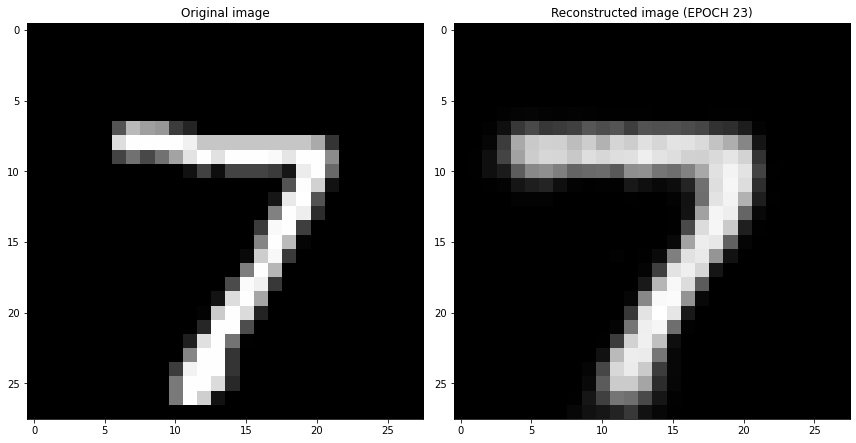

EPOCH 24/30
	 partial train loss (single batch): 0.030741
	 partial train loss (single batch): 0.030213
	 partial train loss (single batch): 0.029063
	 partial train loss (single batch): 0.026946
	 partial train loss (single batch): 0.030078
	 partial train loss (single batch): 0.028852
	 partial train loss (single batch): 0.029609
	 partial train loss (single batch): 0.027773
	 partial train loss (single batch): 0.031391
	 partial train loss (single batch): 0.028213
	 partial train loss (single batch): 0.030046
	 partial train loss (single batch): 0.029678
	 partial train loss (single batch): 0.029736
	 partial train loss (single batch): 0.028664
	 partial train loss (single batch): 0.030030
	 partial train loss (single batch): 0.029543
	 partial train loss (single batch): 0.028485
	 partial train loss (single batch): 0.029809
	 partial train loss (single batch): 0.028818
	 partial train loss (single batch): 0.029654
	 partial train loss (single batch): 0.027947
	 partial train loss (

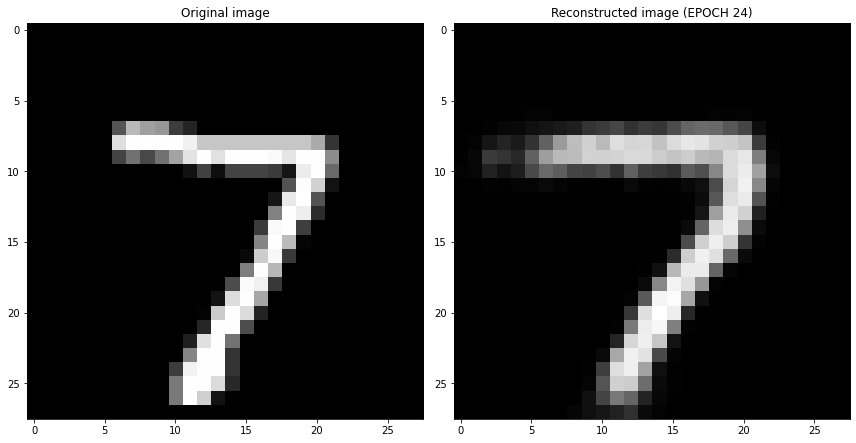

EPOCH 25/30
	 partial train loss (single batch): 0.029931
	 partial train loss (single batch): 0.029074
	 partial train loss (single batch): 0.029487
	 partial train loss (single batch): 0.028941
	 partial train loss (single batch): 0.027581
	 partial train loss (single batch): 0.030714
	 partial train loss (single batch): 0.029910
	 partial train loss (single batch): 0.030824
	 partial train loss (single batch): 0.029499
	 partial train loss (single batch): 0.029236
	 partial train loss (single batch): 0.029709
	 partial train loss (single batch): 0.028813
	 partial train loss (single batch): 0.027461
	 partial train loss (single batch): 0.028682
	 partial train loss (single batch): 0.030177
	 partial train loss (single batch): 0.028297
	 partial train loss (single batch): 0.030589
	 partial train loss (single batch): 0.029103
	 partial train loss (single batch): 0.028643
	 partial train loss (single batch): 0.029535
	 partial train loss (single batch): 0.028606
	 partial train loss (

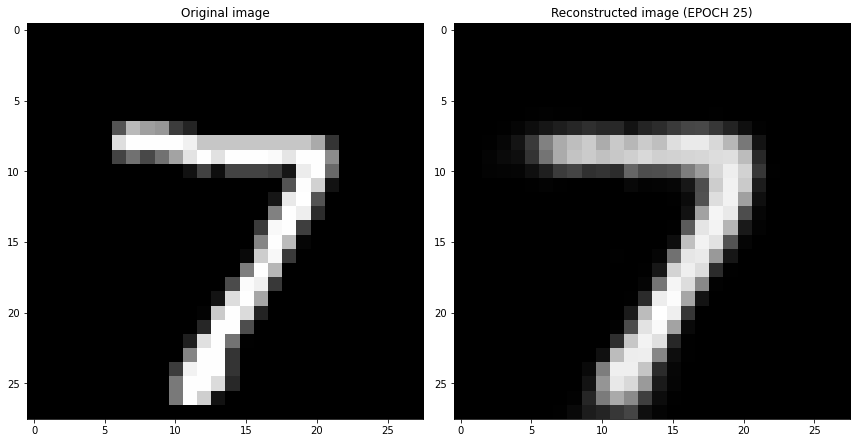

EPOCH 26/30
	 partial train loss (single batch): 0.028698
	 partial train loss (single batch): 0.028259
	 partial train loss (single batch): 0.029841
	 partial train loss (single batch): 0.028124
	 partial train loss (single batch): 0.029653
	 partial train loss (single batch): 0.027380
	 partial train loss (single batch): 0.029712
	 partial train loss (single batch): 0.028727
	 partial train loss (single batch): 0.030665
	 partial train loss (single batch): 0.030109
	 partial train loss (single batch): 0.029003
	 partial train loss (single batch): 0.029271
	 partial train loss (single batch): 0.027725
	 partial train loss (single batch): 0.028287
	 partial train loss (single batch): 0.029715
	 partial train loss (single batch): 0.028776
	 partial train loss (single batch): 0.028103
	 partial train loss (single batch): 0.028008
	 partial train loss (single batch): 0.028994
	 partial train loss (single batch): 0.028136
	 partial train loss (single batch): 0.028221
	 partial train loss (

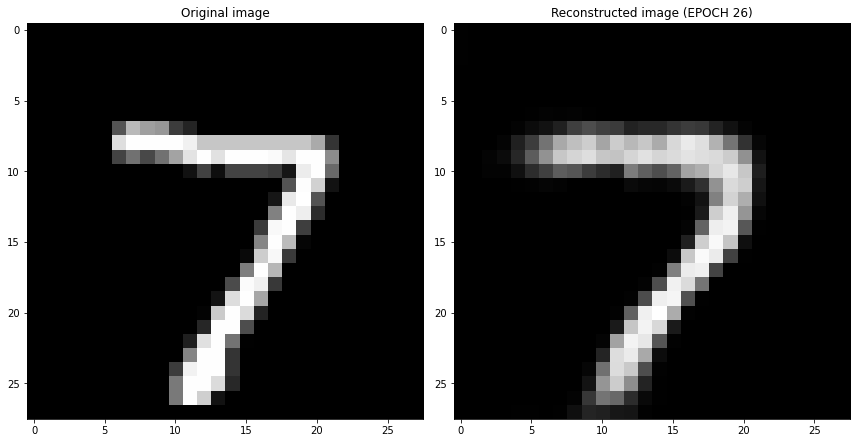

EPOCH 27/30
	 partial train loss (single batch): 0.028860
	 partial train loss (single batch): 0.029306
	 partial train loss (single batch): 0.028737
	 partial train loss (single batch): 0.029677
	 partial train loss (single batch): 0.027834
	 partial train loss (single batch): 0.029131
	 partial train loss (single batch): 0.028945
	 partial train loss (single batch): 0.029770
	 partial train loss (single batch): 0.030240
	 partial train loss (single batch): 0.030985
	 partial train loss (single batch): 0.029428
	 partial train loss (single batch): 0.028886
	 partial train loss (single batch): 0.027146
	 partial train loss (single batch): 0.030162
	 partial train loss (single batch): 0.028587
	 partial train loss (single batch): 0.027701
	 partial train loss (single batch): 0.029305
	 partial train loss (single batch): 0.027184
	 partial train loss (single batch): 0.029434
	 partial train loss (single batch): 0.029207
	 partial train loss (single batch): 0.027426
	 partial train loss (

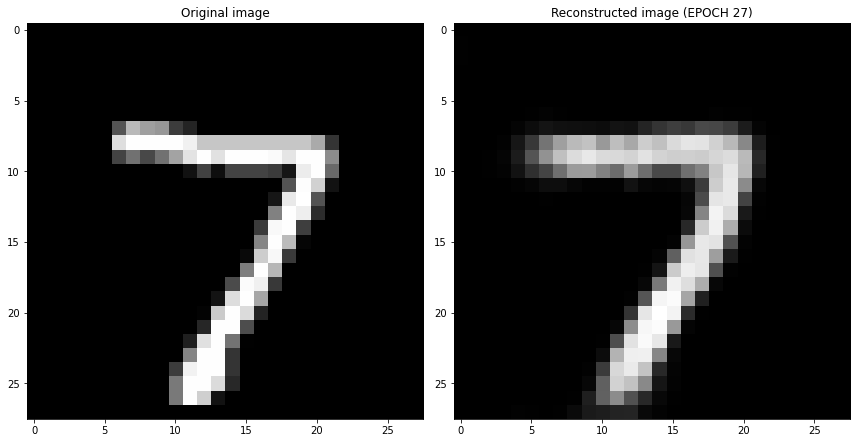

EPOCH 28/30
	 partial train loss (single batch): 0.029479
	 partial train loss (single batch): 0.028133
	 partial train loss (single batch): 0.028454
	 partial train loss (single batch): 0.029351
	 partial train loss (single batch): 0.028122
	 partial train loss (single batch): 0.029876
	 partial train loss (single batch): 0.027091
	 partial train loss (single batch): 0.029062
	 partial train loss (single batch): 0.028907
	 partial train loss (single batch): 0.027617
	 partial train loss (single batch): 0.028737
	 partial train loss (single batch): 0.027826
	 partial train loss (single batch): 0.029775
	 partial train loss (single batch): 0.028923
	 partial train loss (single batch): 0.029637
	 partial train loss (single batch): 0.029989
	 partial train loss (single batch): 0.028617
	 partial train loss (single batch): 0.029943
	 partial train loss (single batch): 0.029126
	 partial train loss (single batch): 0.030099
	 partial train loss (single batch): 0.029366
	 partial train loss (

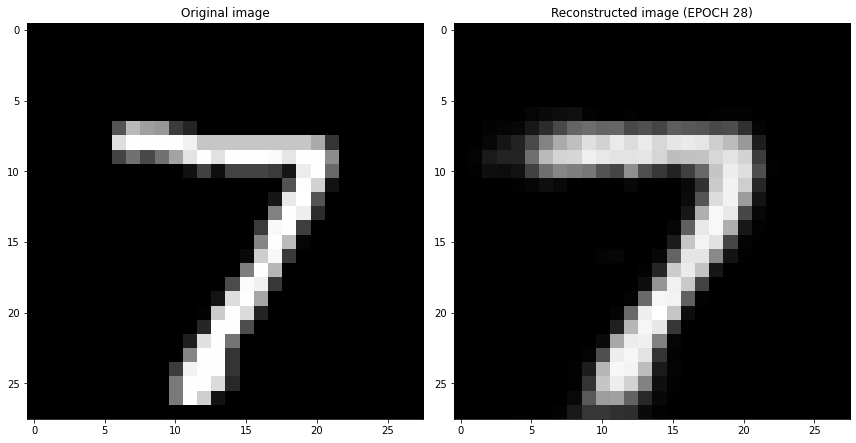

EPOCH 29/30
	 partial train loss (single batch): 0.027278
	 partial train loss (single batch): 0.029014
	 partial train loss (single batch): 0.027808
	 partial train loss (single batch): 0.027737
	 partial train loss (single batch): 0.027268
	 partial train loss (single batch): 0.028818
	 partial train loss (single batch): 0.029805
	 partial train loss (single batch): 0.029592
	 partial train loss (single batch): 0.027430
	 partial train loss (single batch): 0.029802
	 partial train loss (single batch): 0.029434
	 partial train loss (single batch): 0.026861
	 partial train loss (single batch): 0.026859
	 partial train loss (single batch): 0.029246
	 partial train loss (single batch): 0.029209
	 partial train loss (single batch): 0.028447
	 partial train loss (single batch): 0.027355
	 partial train loss (single batch): 0.028246
	 partial train loss (single batch): 0.028881
	 partial train loss (single batch): 0.028937
	 partial train loss (single batch): 0.030498
	 partial train loss (

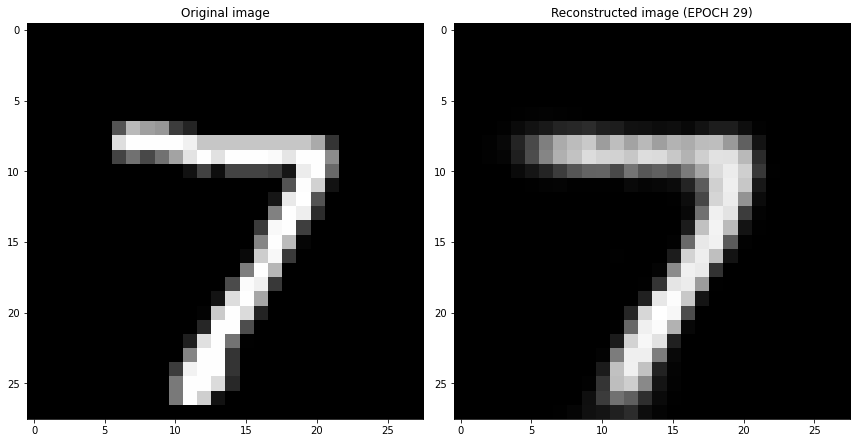

EPOCH 30/30
	 partial train loss (single batch): 0.028075
	 partial train loss (single batch): 0.028328
	 partial train loss (single batch): 0.030147
	 partial train loss (single batch): 0.029937
	 partial train loss (single batch): 0.029005
	 partial train loss (single batch): 0.028938
	 partial train loss (single batch): 0.027696
	 partial train loss (single batch): 0.029447
	 partial train loss (single batch): 0.028777
	 partial train loss (single batch): 0.030115
	 partial train loss (single batch): 0.027135
	 partial train loss (single batch): 0.030155
	 partial train loss (single batch): 0.029210
	 partial train loss (single batch): 0.027035
	 partial train loss (single batch): 0.029598
	 partial train loss (single batch): 0.027686
	 partial train loss (single batch): 0.028533
	 partial train loss (single batch): 0.028663
	 partial train loss (single batch): 0.028628
	 partial train loss (single batch): 0.030352
	 partial train loss (single batch): 0.029154
	 partial train loss (

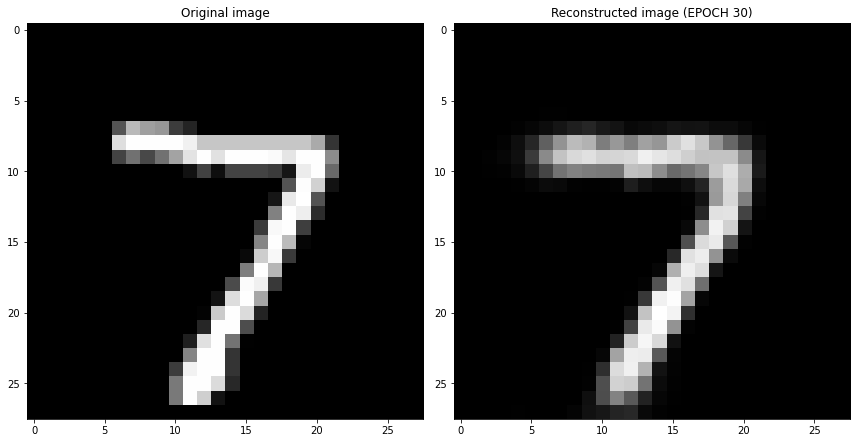

Cross validation fold number= 3/6
EPOCH 1/30
	 partial train loss (single batch): 0.199619
	 partial train loss (single batch): 0.197470
	 partial train loss (single batch): 0.195248
	 partial train loss (single batch): 0.191955
	 partial train loss (single batch): 0.188025
	 partial train loss (single batch): 0.180927
	 partial train loss (single batch): 0.171992
	 partial train loss (single batch): 0.158743
	 partial train loss (single batch): 0.142717
	 partial train loss (single batch): 0.129930
	 partial train loss (single batch): 0.118800
	 partial train loss (single batch): 0.107843
	 partial train loss (single batch): 0.104298
	 partial train loss (single batch): 0.103565
	 partial train loss (single batch): 0.093118
	 partial train loss (single batch): 0.091032
	 partial train loss (single batch): 0.087953
	 partial train loss (single batch): 0.089853
	 partial train loss (single batch): 0.084876
	 partial train loss (single batch): 0.081444
	 partial train loss (single batch)

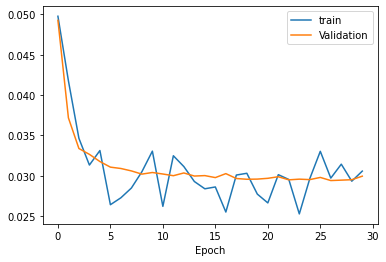

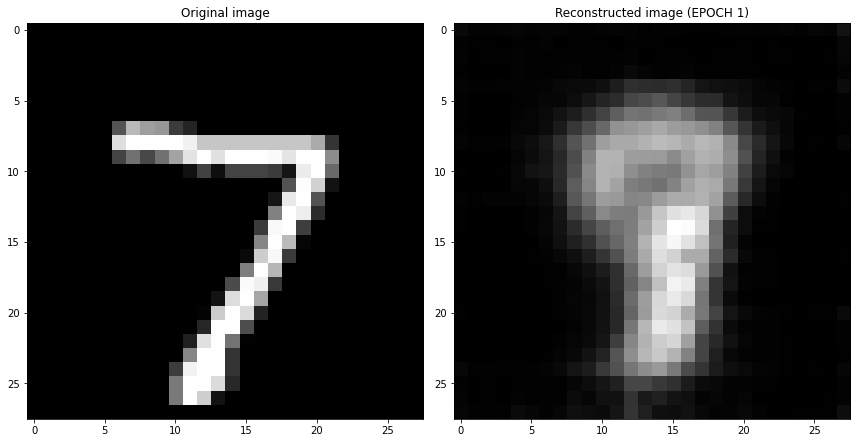

EPOCH 2/30
	 partial train loss (single batch): 0.054529
	 partial train loss (single batch): 0.053817
	 partial train loss (single batch): 0.052039
	 partial train loss (single batch): 0.052213
	 partial train loss (single batch): 0.053136
	 partial train loss (single batch): 0.051027
	 partial train loss (single batch): 0.051720
	 partial train loss (single batch): 0.052335
	 partial train loss (single batch): 0.050762
	 partial train loss (single batch): 0.051395
	 partial train loss (single batch): 0.050973
	 partial train loss (single batch): 0.051923
	 partial train loss (single batch): 0.050648
	 partial train loss (single batch): 0.050852
	 partial train loss (single batch): 0.051954
	 partial train loss (single batch): 0.050311
	 partial train loss (single batch): 0.050146
	 partial train loss (single batch): 0.048720
	 partial train loss (single batch): 0.049003
	 partial train loss (single batch): 0.049647
	 partial train loss (single batch): 0.048728
	 partial train loss (s

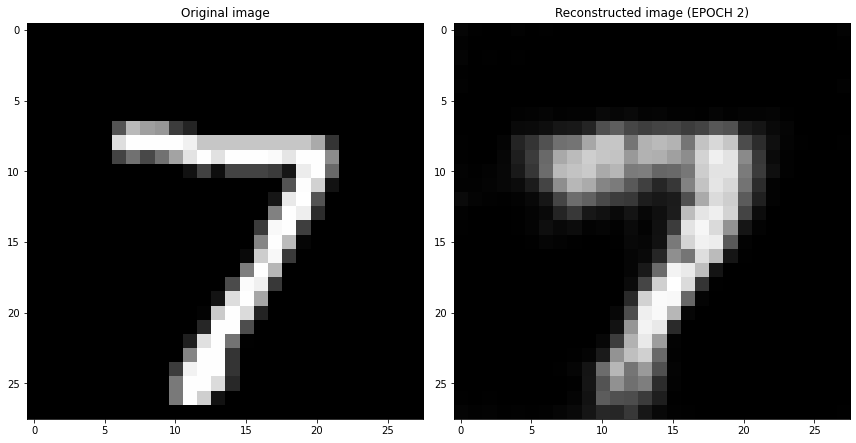

EPOCH 3/30
	 partial train loss (single batch): 0.038219
	 partial train loss (single batch): 0.038847
	 partial train loss (single batch): 0.037931
	 partial train loss (single batch): 0.038555
	 partial train loss (single batch): 0.041818
	 partial train loss (single batch): 0.037698
	 partial train loss (single batch): 0.038231
	 partial train loss (single batch): 0.038442
	 partial train loss (single batch): 0.039992
	 partial train loss (single batch): 0.038318
	 partial train loss (single batch): 0.037538
	 partial train loss (single batch): 0.039371
	 partial train loss (single batch): 0.039885
	 partial train loss (single batch): 0.037576
	 partial train loss (single batch): 0.037053
	 partial train loss (single batch): 0.038224
	 partial train loss (single batch): 0.035130
	 partial train loss (single batch): 0.037551
	 partial train loss (single batch): 0.039404
	 partial train loss (single batch): 0.035547
	 partial train loss (single batch): 0.037666
	 partial train loss (s

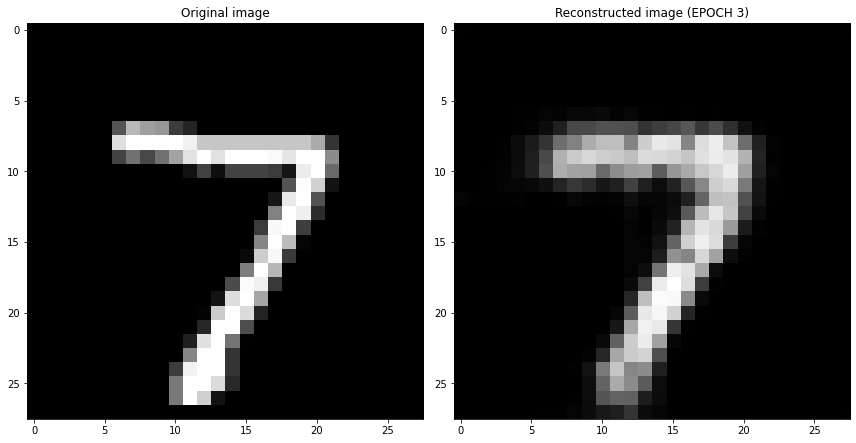

EPOCH 4/30
	 partial train loss (single batch): 0.034702
	 partial train loss (single batch): 0.035064
	 partial train loss (single batch): 0.036347
	 partial train loss (single batch): 0.037398
	 partial train loss (single batch): 0.035698
	 partial train loss (single batch): 0.034210
	 partial train loss (single batch): 0.034598
	 partial train loss (single batch): 0.037498
	 partial train loss (single batch): 0.035436
	 partial train loss (single batch): 0.035525
	 partial train loss (single batch): 0.035389
	 partial train loss (single batch): 0.034972
	 partial train loss (single batch): 0.035671
	 partial train loss (single batch): 0.034188
	 partial train loss (single batch): 0.035994
	 partial train loss (single batch): 0.034565
	 partial train loss (single batch): 0.035305
	 partial train loss (single batch): 0.033297
	 partial train loss (single batch): 0.036049
	 partial train loss (single batch): 0.033196
	 partial train loss (single batch): 0.035364
	 partial train loss (s

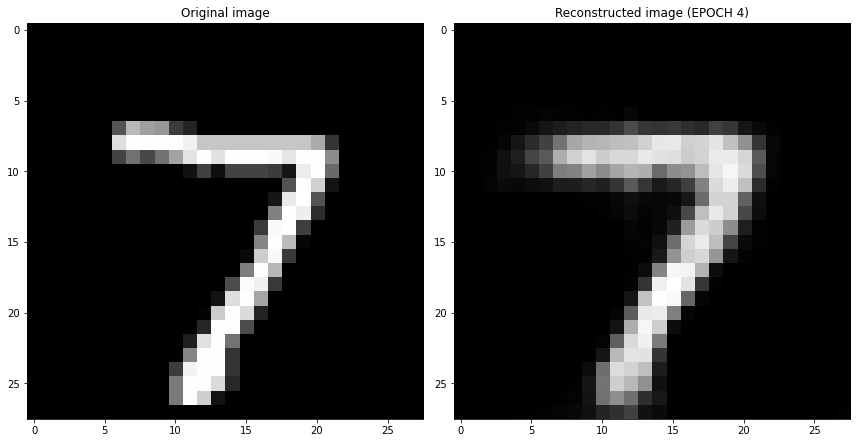

EPOCH 5/30
	 partial train loss (single batch): 0.032833
	 partial train loss (single batch): 0.032886
	 partial train loss (single batch): 0.034295
	 partial train loss (single batch): 0.033537
	 partial train loss (single batch): 0.032681
	 partial train loss (single batch): 0.032808
	 partial train loss (single batch): 0.033003
	 partial train loss (single batch): 0.032047
	 partial train loss (single batch): 0.033066
	 partial train loss (single batch): 0.032378
	 partial train loss (single batch): 0.033552
	 partial train loss (single batch): 0.032924
	 partial train loss (single batch): 0.033204
	 partial train loss (single batch): 0.034538
	 partial train loss (single batch): 0.033160
	 partial train loss (single batch): 0.032984
	 partial train loss (single batch): 0.032056
	 partial train loss (single batch): 0.032946
	 partial train loss (single batch): 0.032802
	 partial train loss (single batch): 0.032927
	 partial train loss (single batch): 0.033483
	 partial train loss (s

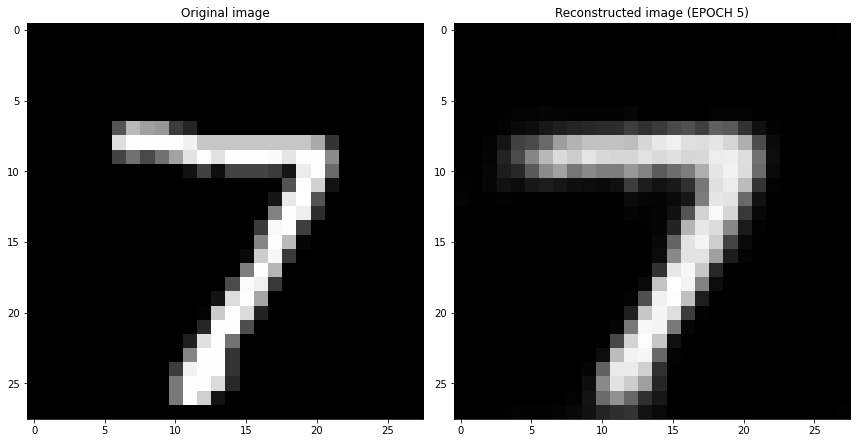

EPOCH 6/30
	 partial train loss (single batch): 0.031455
	 partial train loss (single batch): 0.032986
	 partial train loss (single batch): 0.032164
	 partial train loss (single batch): 0.032801
	 partial train loss (single batch): 0.033153
	 partial train loss (single batch): 0.032070
	 partial train loss (single batch): 0.033950
	 partial train loss (single batch): 0.030760
	 partial train loss (single batch): 0.032553
	 partial train loss (single batch): 0.031599
	 partial train loss (single batch): 0.033500
	 partial train loss (single batch): 0.032546
	 partial train loss (single batch): 0.031438
	 partial train loss (single batch): 0.032428
	 partial train loss (single batch): 0.032211
	 partial train loss (single batch): 0.031151
	 partial train loss (single batch): 0.032052
	 partial train loss (single batch): 0.032547
	 partial train loss (single batch): 0.033524
	 partial train loss (single batch): 0.033018
	 partial train loss (single batch): 0.032914
	 partial train loss (s

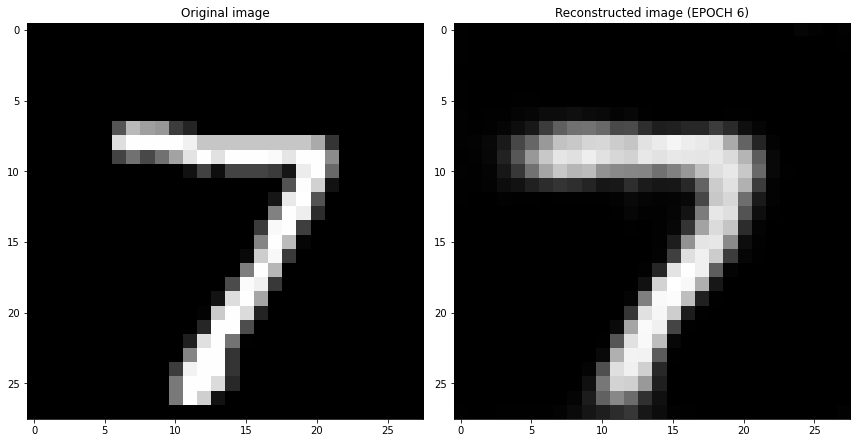

EPOCH 7/30
	 partial train loss (single batch): 0.033580
	 partial train loss (single batch): 0.031171
	 partial train loss (single batch): 0.032579
	 partial train loss (single batch): 0.032609
	 partial train loss (single batch): 0.031615
	 partial train loss (single batch): 0.032172
	 partial train loss (single batch): 0.033908
	 partial train loss (single batch): 0.031322
	 partial train loss (single batch): 0.033231
	 partial train loss (single batch): 0.031575
	 partial train loss (single batch): 0.032294
	 partial train loss (single batch): 0.031435
	 partial train loss (single batch): 0.032005
	 partial train loss (single batch): 0.031782
	 partial train loss (single batch): 0.031580
	 partial train loss (single batch): 0.032240
	 partial train loss (single batch): 0.031516
	 partial train loss (single batch): 0.031039
	 partial train loss (single batch): 0.030971
	 partial train loss (single batch): 0.031471
	 partial train loss (single batch): 0.033383
	 partial train loss (s

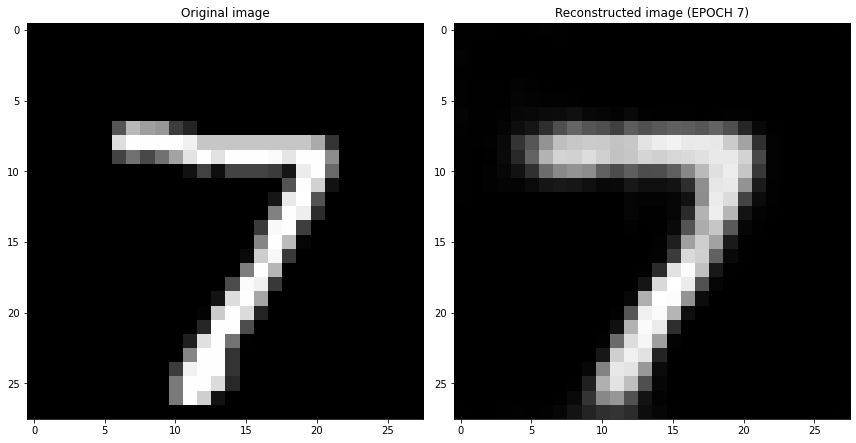

EPOCH 8/30
	 partial train loss (single batch): 0.030941
	 partial train loss (single batch): 0.031760
	 partial train loss (single batch): 0.032544
	 partial train loss (single batch): 0.029128
	 partial train loss (single batch): 0.030921
	 partial train loss (single batch): 0.032106
	 partial train loss (single batch): 0.032762
	 partial train loss (single batch): 0.032483
	 partial train loss (single batch): 0.029256
	 partial train loss (single batch): 0.032996
	 partial train loss (single batch): 0.033048
	 partial train loss (single batch): 0.030942
	 partial train loss (single batch): 0.030095
	 partial train loss (single batch): 0.030328
	 partial train loss (single batch): 0.030698
	 partial train loss (single batch): 0.030836
	 partial train loss (single batch): 0.030586
	 partial train loss (single batch): 0.030204
	 partial train loss (single batch): 0.032326
	 partial train loss (single batch): 0.032664
	 partial train loss (single batch): 0.032095
	 partial train loss (s

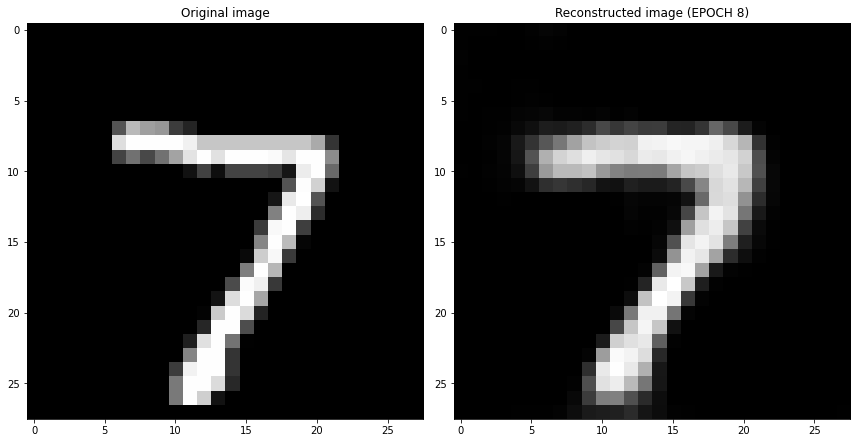

EPOCH 9/30
	 partial train loss (single batch): 0.031376
	 partial train loss (single batch): 0.030420
	 partial train loss (single batch): 0.030959
	 partial train loss (single batch): 0.033266
	 partial train loss (single batch): 0.030988
	 partial train loss (single batch): 0.030547
	 partial train loss (single batch): 0.032079
	 partial train loss (single batch): 0.030270
	 partial train loss (single batch): 0.030585
	 partial train loss (single batch): 0.031318
	 partial train loss (single batch): 0.030697
	 partial train loss (single batch): 0.030604
	 partial train loss (single batch): 0.031024
	 partial train loss (single batch): 0.032436
	 partial train loss (single batch): 0.029150
	 partial train loss (single batch): 0.031430
	 partial train loss (single batch): 0.031168
	 partial train loss (single batch): 0.029789
	 partial train loss (single batch): 0.029316
	 partial train loss (single batch): 0.031154
	 partial train loss (single batch): 0.031610
	 partial train loss (s

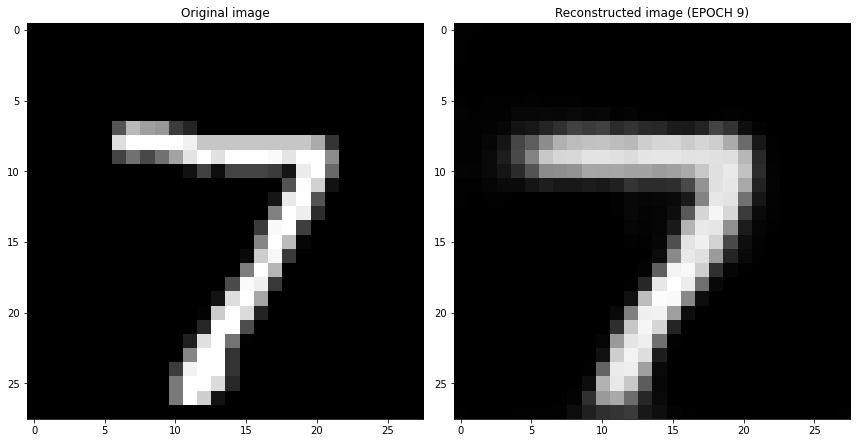

EPOCH 10/30
	 partial train loss (single batch): 0.031867
	 partial train loss (single batch): 0.031048
	 partial train loss (single batch): 0.030382
	 partial train loss (single batch): 0.030305
	 partial train loss (single batch): 0.031542
	 partial train loss (single batch): 0.030391
	 partial train loss (single batch): 0.031168
	 partial train loss (single batch): 0.030622
	 partial train loss (single batch): 0.032920
	 partial train loss (single batch): 0.031403
	 partial train loss (single batch): 0.030812
	 partial train loss (single batch): 0.032231
	 partial train loss (single batch): 0.031811
	 partial train loss (single batch): 0.032458
	 partial train loss (single batch): 0.032247
	 partial train loss (single batch): 0.030623
	 partial train loss (single batch): 0.030020
	 partial train loss (single batch): 0.032199
	 partial train loss (single batch): 0.031168
	 partial train loss (single batch): 0.030563
	 partial train loss (single batch): 0.031230
	 partial train loss (

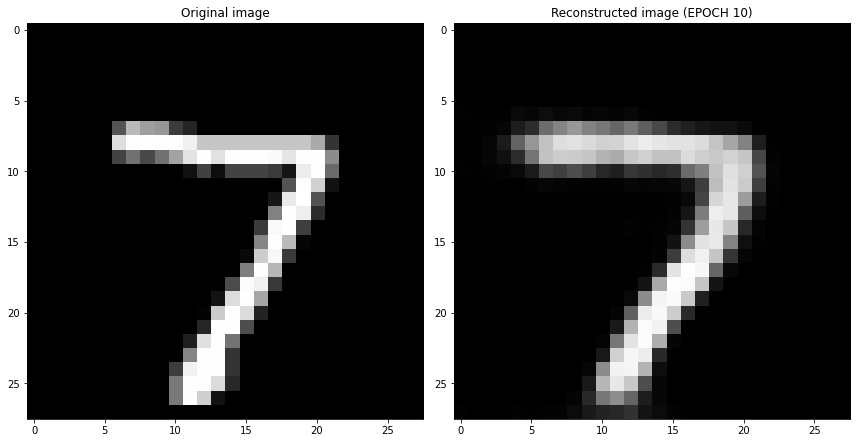

EPOCH 11/30
	 partial train loss (single batch): 0.030376
	 partial train loss (single batch): 0.031722
	 partial train loss (single batch): 0.031282
	 partial train loss (single batch): 0.030184
	 partial train loss (single batch): 0.031908
	 partial train loss (single batch): 0.030692
	 partial train loss (single batch): 0.031238
	 partial train loss (single batch): 0.030642
	 partial train loss (single batch): 0.031825
	 partial train loss (single batch): 0.029680
	 partial train loss (single batch): 0.031216
	 partial train loss (single batch): 0.032030
	 partial train loss (single batch): 0.030393
	 partial train loss (single batch): 0.029593
	 partial train loss (single batch): 0.029312
	 partial train loss (single batch): 0.031412
	 partial train loss (single batch): 0.029245
	 partial train loss (single batch): 0.031532
	 partial train loss (single batch): 0.031477
	 partial train loss (single batch): 0.030596
	 partial train loss (single batch): 0.029786
	 partial train loss (

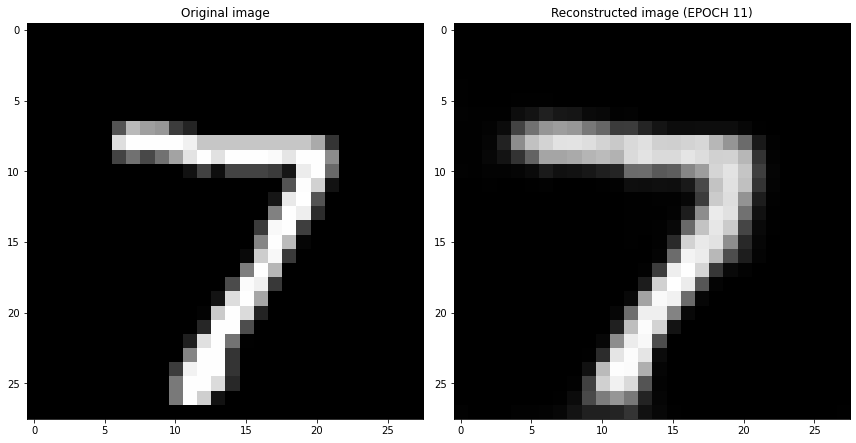

EPOCH 12/30
	 partial train loss (single batch): 0.029519
	 partial train loss (single batch): 0.031043
	 partial train loss (single batch): 0.030436
	 partial train loss (single batch): 0.032479
	 partial train loss (single batch): 0.030346
	 partial train loss (single batch): 0.029552
	 partial train loss (single batch): 0.031304
	 partial train loss (single batch): 0.031551
	 partial train loss (single batch): 0.029225
	 partial train loss (single batch): 0.029987
	 partial train loss (single batch): 0.031333
	 partial train loss (single batch): 0.029544
	 partial train loss (single batch): 0.029694
	 partial train loss (single batch): 0.031781
	 partial train loss (single batch): 0.030784
	 partial train loss (single batch): 0.030504
	 partial train loss (single batch): 0.030486
	 partial train loss (single batch): 0.030446
	 partial train loss (single batch): 0.030141
	 partial train loss (single batch): 0.031928
	 partial train loss (single batch): 0.029878
	 partial train loss (

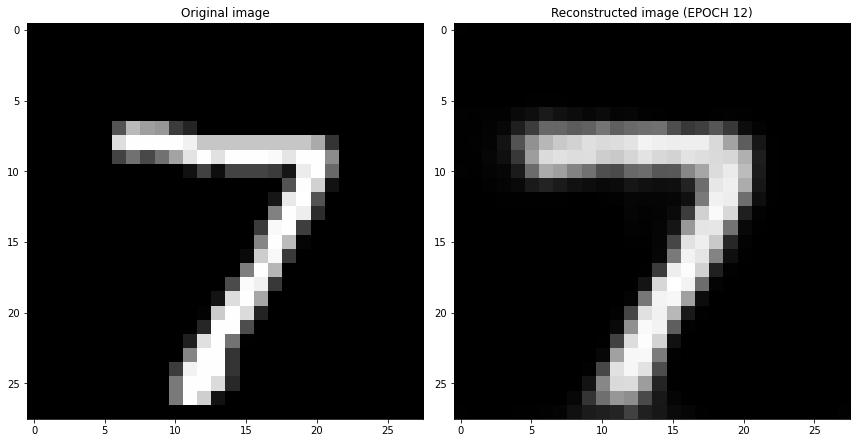

EPOCH 13/30
	 partial train loss (single batch): 0.030368
	 partial train loss (single batch): 0.031976
	 partial train loss (single batch): 0.030065
	 partial train loss (single batch): 0.029147
	 partial train loss (single batch): 0.031376
	 partial train loss (single batch): 0.030094
	 partial train loss (single batch): 0.030438
	 partial train loss (single batch): 0.029050
	 partial train loss (single batch): 0.030198
	 partial train loss (single batch): 0.031755
	 partial train loss (single batch): 0.029110
	 partial train loss (single batch): 0.031145
	 partial train loss (single batch): 0.030622
	 partial train loss (single batch): 0.028824
	 partial train loss (single batch): 0.033069
	 partial train loss (single batch): 0.030962
	 partial train loss (single batch): 0.028524
	 partial train loss (single batch): 0.031168
	 partial train loss (single batch): 0.032137
	 partial train loss (single batch): 0.029988
	 partial train loss (single batch): 0.028676
	 partial train loss (

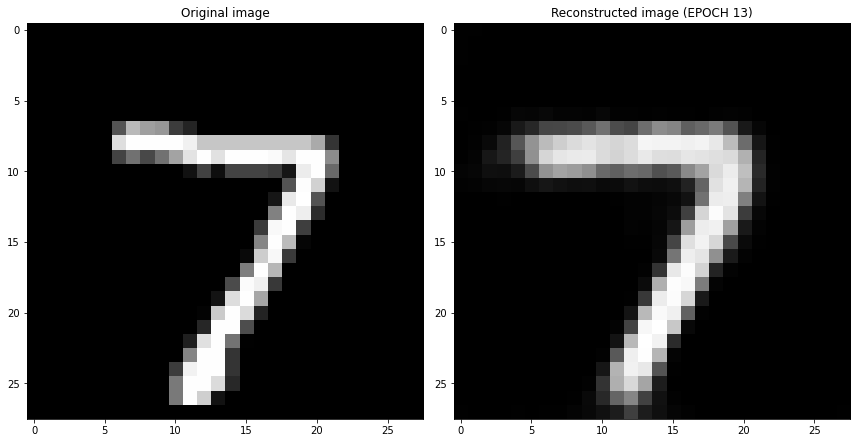

EPOCH 14/30
	 partial train loss (single batch): 0.029981
	 partial train loss (single batch): 0.031207
	 partial train loss (single batch): 0.029449
	 partial train loss (single batch): 0.029544
	 partial train loss (single batch): 0.030820
	 partial train loss (single batch): 0.030062
	 partial train loss (single batch): 0.030725
	 partial train loss (single batch): 0.031099
	 partial train loss (single batch): 0.031758
	 partial train loss (single batch): 0.028521
	 partial train loss (single batch): 0.027410
	 partial train loss (single batch): 0.029942
	 partial train loss (single batch): 0.030044
	 partial train loss (single batch): 0.029243
	 partial train loss (single batch): 0.029334
	 partial train loss (single batch): 0.030689
	 partial train loss (single batch): 0.030955
	 partial train loss (single batch): 0.030324
	 partial train loss (single batch): 0.029775
	 partial train loss (single batch): 0.030882
	 partial train loss (single batch): 0.031251
	 partial train loss (

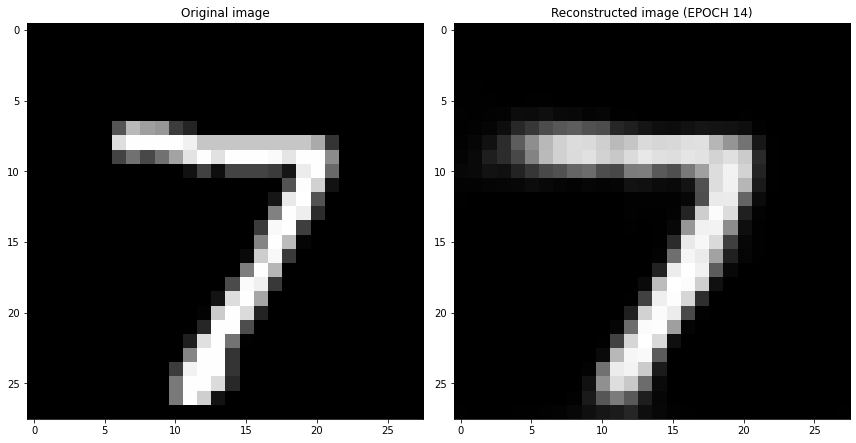

EPOCH 15/30
	 partial train loss (single batch): 0.029885
	 partial train loss (single batch): 0.028921
	 partial train loss (single batch): 0.030891
	 partial train loss (single batch): 0.030566
	 partial train loss (single batch): 0.032841
	 partial train loss (single batch): 0.030199
	 partial train loss (single batch): 0.029684
	 partial train loss (single batch): 0.029543
	 partial train loss (single batch): 0.030423
	 partial train loss (single batch): 0.029911
	 partial train loss (single batch): 0.029164
	 partial train loss (single batch): 0.029367
	 partial train loss (single batch): 0.030653
	 partial train loss (single batch): 0.029925
	 partial train loss (single batch): 0.031070
	 partial train loss (single batch): 0.030474
	 partial train loss (single batch): 0.030754
	 partial train loss (single batch): 0.029835
	 partial train loss (single batch): 0.028429
	 partial train loss (single batch): 0.032733
	 partial train loss (single batch): 0.028475
	 partial train loss (

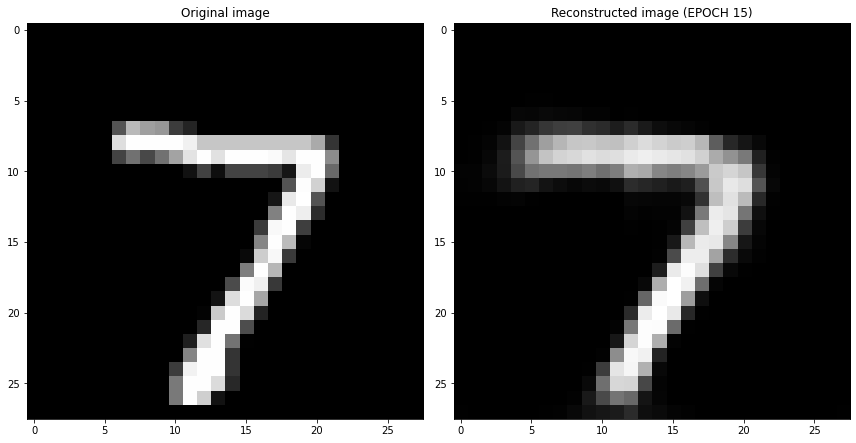

EPOCH 16/30
	 partial train loss (single batch): 0.028327
	 partial train loss (single batch): 0.029583
	 partial train loss (single batch): 0.031944
	 partial train loss (single batch): 0.030129
	 partial train loss (single batch): 0.030550
	 partial train loss (single batch): 0.029896
	 partial train loss (single batch): 0.031565
	 partial train loss (single batch): 0.028162
	 partial train loss (single batch): 0.031163
	 partial train loss (single batch): 0.030584
	 partial train loss (single batch): 0.030123
	 partial train loss (single batch): 0.030539
	 partial train loss (single batch): 0.029691
	 partial train loss (single batch): 0.030583
	 partial train loss (single batch): 0.030367
	 partial train loss (single batch): 0.031496
	 partial train loss (single batch): 0.030609
	 partial train loss (single batch): 0.028272
	 partial train loss (single batch): 0.030262
	 partial train loss (single batch): 0.030778
	 partial train loss (single batch): 0.030590
	 partial train loss (

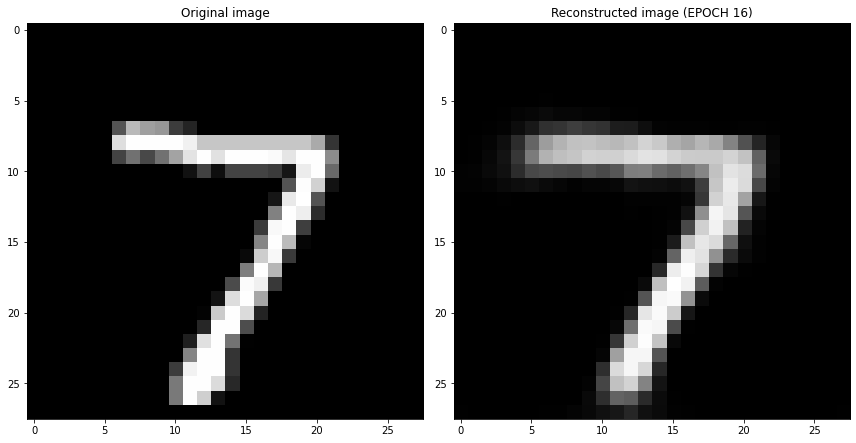

EPOCH 17/30
	 partial train loss (single batch): 0.029447
	 partial train loss (single batch): 0.030095
	 partial train loss (single batch): 0.028382
	 partial train loss (single batch): 0.030529
	 partial train loss (single batch): 0.030743
	 partial train loss (single batch): 0.030321
	 partial train loss (single batch): 0.031047
	 partial train loss (single batch): 0.030578
	 partial train loss (single batch): 0.031275
	 partial train loss (single batch): 0.030033
	 partial train loss (single batch): 0.029900
	 partial train loss (single batch): 0.030473
	 partial train loss (single batch): 0.030805
	 partial train loss (single batch): 0.029914
	 partial train loss (single batch): 0.028623
	 partial train loss (single batch): 0.028195
	 partial train loss (single batch): 0.029929
	 partial train loss (single batch): 0.029760
	 partial train loss (single batch): 0.029071
	 partial train loss (single batch): 0.029217
	 partial train loss (single batch): 0.029311
	 partial train loss (

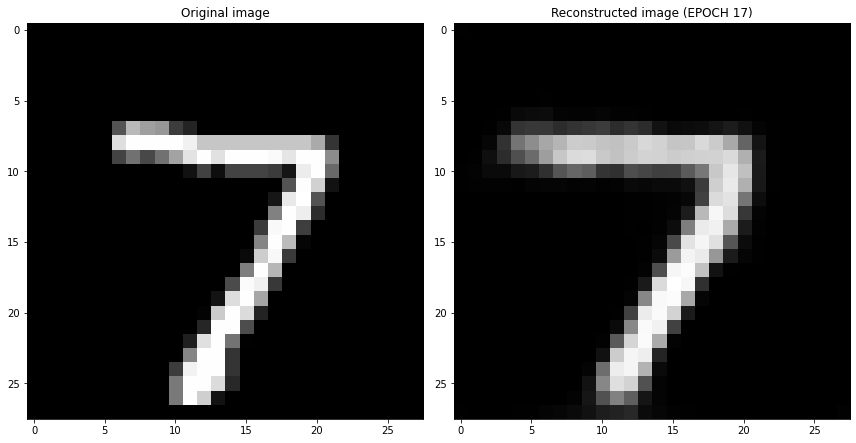

EPOCH 18/30
	 partial train loss (single batch): 0.029183
	 partial train loss (single batch): 0.029454
	 partial train loss (single batch): 0.031723
	 partial train loss (single batch): 0.030174
	 partial train loss (single batch): 0.030273
	 partial train loss (single batch): 0.029827
	 partial train loss (single batch): 0.029889
	 partial train loss (single batch): 0.029630
	 partial train loss (single batch): 0.029782
	 partial train loss (single batch): 0.030242
	 partial train loss (single batch): 0.028174
	 partial train loss (single batch): 0.028030
	 partial train loss (single batch): 0.028679
	 partial train loss (single batch): 0.030325
	 partial train loss (single batch): 0.029679
	 partial train loss (single batch): 0.028003
	 partial train loss (single batch): 0.029958
	 partial train loss (single batch): 0.030692
	 partial train loss (single batch): 0.030136
	 partial train loss (single batch): 0.029336
	 partial train loss (single batch): 0.028902
	 partial train loss (

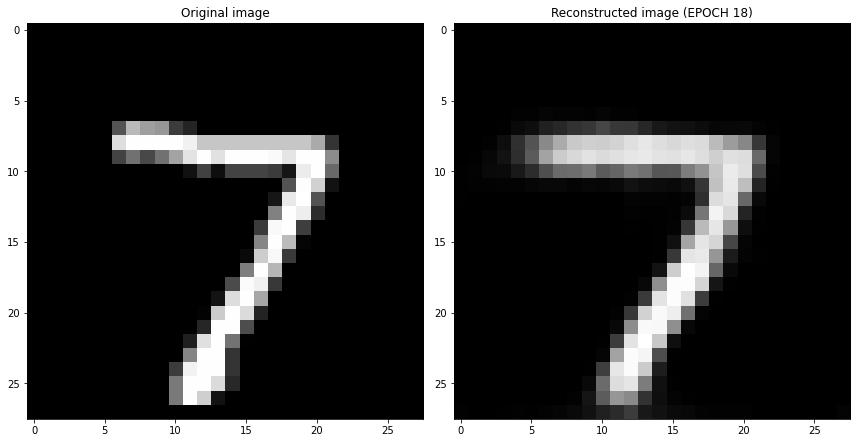

EPOCH 19/30
	 partial train loss (single batch): 0.029729
	 partial train loss (single batch): 0.030714
	 partial train loss (single batch): 0.030131
	 partial train loss (single batch): 0.031630
	 partial train loss (single batch): 0.030506
	 partial train loss (single batch): 0.030640
	 partial train loss (single batch): 0.029228
	 partial train loss (single batch): 0.028898
	 partial train loss (single batch): 0.029327
	 partial train loss (single batch): 0.029643
	 partial train loss (single batch): 0.032030
	 partial train loss (single batch): 0.029933
	 partial train loss (single batch): 0.028614
	 partial train loss (single batch): 0.029317
	 partial train loss (single batch): 0.027642
	 partial train loss (single batch): 0.029487
	 partial train loss (single batch): 0.029398
	 partial train loss (single batch): 0.031563
	 partial train loss (single batch): 0.028510
	 partial train loss (single batch): 0.030862
	 partial train loss (single batch): 0.029004
	 partial train loss (

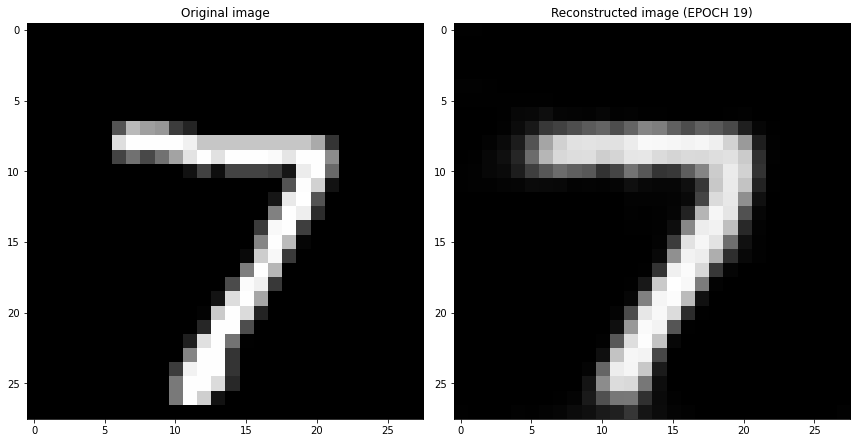

EPOCH 20/30
	 partial train loss (single batch): 0.030030
	 partial train loss (single batch): 0.031616
	 partial train loss (single batch): 0.028864
	 partial train loss (single batch): 0.029044
	 partial train loss (single batch): 0.030155
	 partial train loss (single batch): 0.029733
	 partial train loss (single batch): 0.030431
	 partial train loss (single batch): 0.028299
	 partial train loss (single batch): 0.030223
	 partial train loss (single batch): 0.029444
	 partial train loss (single batch): 0.029571
	 partial train loss (single batch): 0.029387
	 partial train loss (single batch): 0.028250
	 partial train loss (single batch): 0.029187
	 partial train loss (single batch): 0.029223
	 partial train loss (single batch): 0.030308
	 partial train loss (single batch): 0.029943
	 partial train loss (single batch): 0.030662
	 partial train loss (single batch): 0.029220
	 partial train loss (single batch): 0.028655
	 partial train loss (single batch): 0.029276
	 partial train loss (

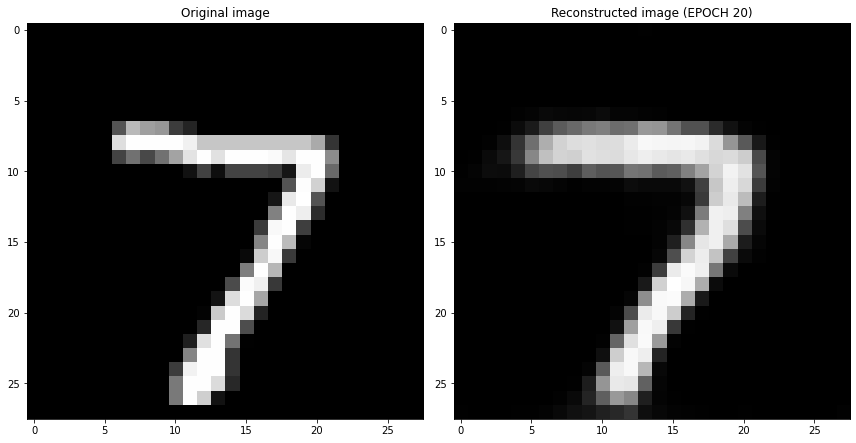

EPOCH 21/30
	 partial train loss (single batch): 0.030593
	 partial train loss (single batch): 0.030153
	 partial train loss (single batch): 0.030273
	 partial train loss (single batch): 0.030744
	 partial train loss (single batch): 0.030424
	 partial train loss (single batch): 0.029073
	 partial train loss (single batch): 0.029313
	 partial train loss (single batch): 0.030562
	 partial train loss (single batch): 0.031388
	 partial train loss (single batch): 0.028125
	 partial train loss (single batch): 0.030971
	 partial train loss (single batch): 0.031444
	 partial train loss (single batch): 0.028930
	 partial train loss (single batch): 0.029856
	 partial train loss (single batch): 0.030513
	 partial train loss (single batch): 0.030024
	 partial train loss (single batch): 0.029471
	 partial train loss (single batch): 0.027546
	 partial train loss (single batch): 0.030102
	 partial train loss (single batch): 0.029190
	 partial train loss (single batch): 0.029588
	 partial train loss (

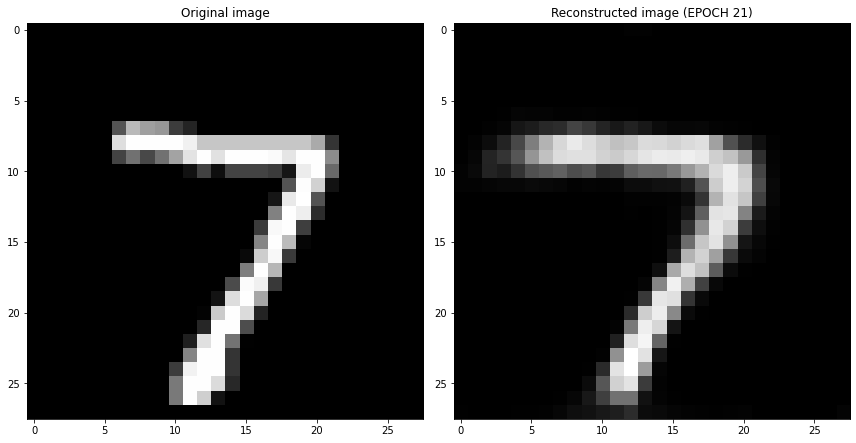

EPOCH 22/30
	 partial train loss (single batch): 0.030225
	 partial train loss (single batch): 0.029134
	 partial train loss (single batch): 0.028883
	 partial train loss (single batch): 0.030799
	 partial train loss (single batch): 0.031180
	 partial train loss (single batch): 0.029531
	 partial train loss (single batch): 0.029073
	 partial train loss (single batch): 0.029415
	 partial train loss (single batch): 0.029929
	 partial train loss (single batch): 0.028273
	 partial train loss (single batch): 0.029693
	 partial train loss (single batch): 0.029563
	 partial train loss (single batch): 0.027814
	 partial train loss (single batch): 0.030630
	 partial train loss (single batch): 0.028210
	 partial train loss (single batch): 0.030547
	 partial train loss (single batch): 0.030400
	 partial train loss (single batch): 0.031053
	 partial train loss (single batch): 0.031795
	 partial train loss (single batch): 0.028708
	 partial train loss (single batch): 0.028940
	 partial train loss (

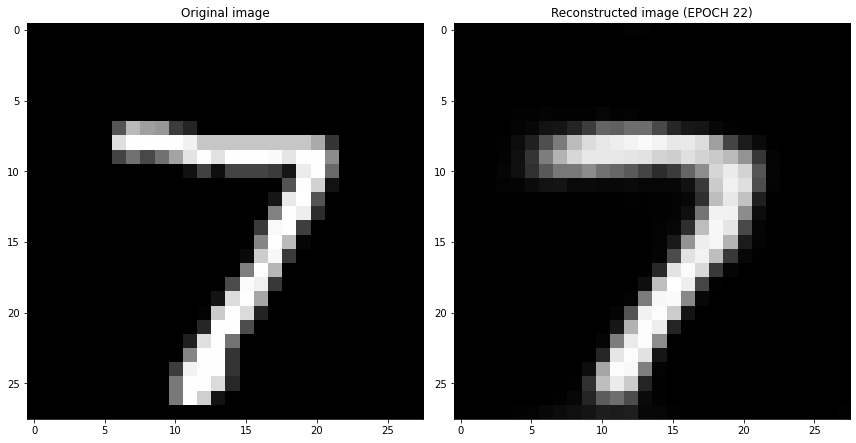

EPOCH 23/30
	 partial train loss (single batch): 0.029921
	 partial train loss (single batch): 0.030437
	 partial train loss (single batch): 0.029115
	 partial train loss (single batch): 0.029691
	 partial train loss (single batch): 0.030823
	 partial train loss (single batch): 0.029052
	 partial train loss (single batch): 0.027393
	 partial train loss (single batch): 0.029767
	 partial train loss (single batch): 0.027917
	 partial train loss (single batch): 0.030347
	 partial train loss (single batch): 0.029060
	 partial train loss (single batch): 0.030506
	 partial train loss (single batch): 0.030137
	 partial train loss (single batch): 0.029956
	 partial train loss (single batch): 0.029642
	 partial train loss (single batch): 0.029885
	 partial train loss (single batch): 0.028241
	 partial train loss (single batch): 0.029461
	 partial train loss (single batch): 0.029329
	 partial train loss (single batch): 0.028900
	 partial train loss (single batch): 0.028381
	 partial train loss (

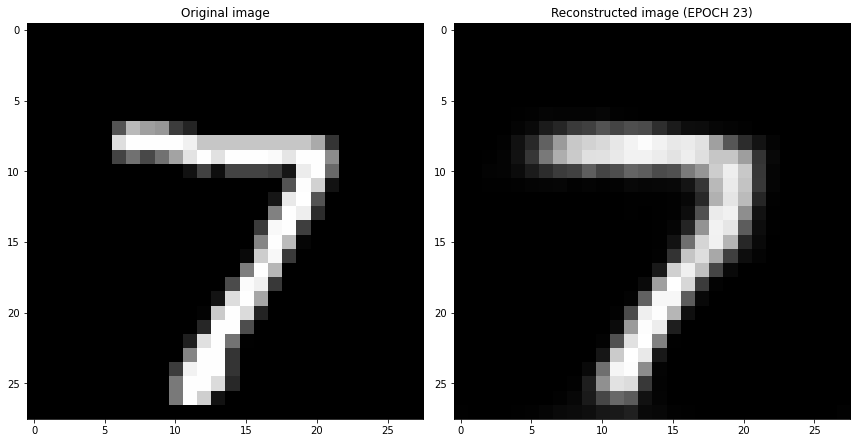

EPOCH 24/30
	 partial train loss (single batch): 0.030267
	 partial train loss (single batch): 0.027466
	 partial train loss (single batch): 0.030591
	 partial train loss (single batch): 0.030193
	 partial train loss (single batch): 0.030673
	 partial train loss (single batch): 0.029722
	 partial train loss (single batch): 0.029539
	 partial train loss (single batch): 0.028714
	 partial train loss (single batch): 0.029462
	 partial train loss (single batch): 0.029821
	 partial train loss (single batch): 0.029640
	 partial train loss (single batch): 0.031026
	 partial train loss (single batch): 0.028826
	 partial train loss (single batch): 0.028994
	 partial train loss (single batch): 0.030117
	 partial train loss (single batch): 0.029057
	 partial train loss (single batch): 0.030700
	 partial train loss (single batch): 0.029241
	 partial train loss (single batch): 0.031548
	 partial train loss (single batch): 0.027023
	 partial train loss (single batch): 0.029607
	 partial train loss (

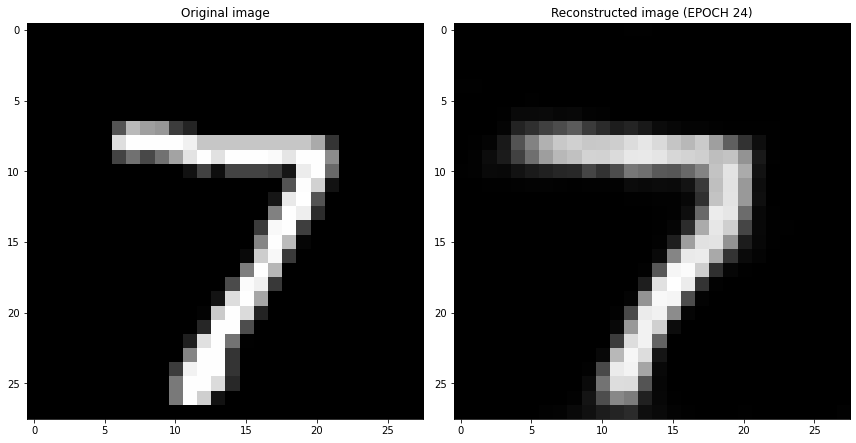

EPOCH 25/30
	 partial train loss (single batch): 0.029099
	 partial train loss (single batch): 0.028246
	 partial train loss (single batch): 0.031942
	 partial train loss (single batch): 0.030562
	 partial train loss (single batch): 0.028640
	 partial train loss (single batch): 0.029597
	 partial train loss (single batch): 0.029967
	 partial train loss (single batch): 0.028550
	 partial train loss (single batch): 0.028370
	 partial train loss (single batch): 0.030333
	 partial train loss (single batch): 0.025511
	 partial train loss (single batch): 0.029256
	 partial train loss (single batch): 0.029599
	 partial train loss (single batch): 0.029064
	 partial train loss (single batch): 0.029708
	 partial train loss (single batch): 0.031059
	 partial train loss (single batch): 0.028566
	 partial train loss (single batch): 0.029396
	 partial train loss (single batch): 0.030900
	 partial train loss (single batch): 0.029231
	 partial train loss (single batch): 0.029154
	 partial train loss (

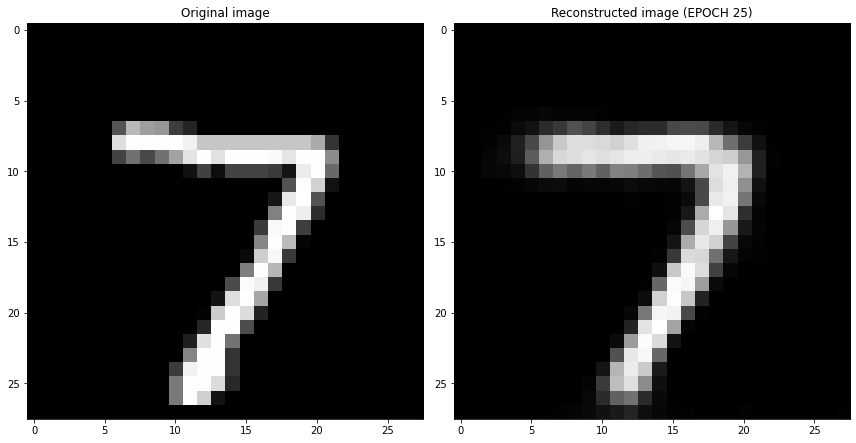

EPOCH 26/30
	 partial train loss (single batch): 0.030320
	 partial train loss (single batch): 0.029604
	 partial train loss (single batch): 0.030174
	 partial train loss (single batch): 0.029181
	 partial train loss (single batch): 0.028565
	 partial train loss (single batch): 0.030181
	 partial train loss (single batch): 0.029491
	 partial train loss (single batch): 0.030394
	 partial train loss (single batch): 0.026861
	 partial train loss (single batch): 0.028948
	 partial train loss (single batch): 0.029156
	 partial train loss (single batch): 0.029620
	 partial train loss (single batch): 0.030220
	 partial train loss (single batch): 0.029257
	 partial train loss (single batch): 0.027170
	 partial train loss (single batch): 0.028096
	 partial train loss (single batch): 0.027722
	 partial train loss (single batch): 0.028887
	 partial train loss (single batch): 0.028952
	 partial train loss (single batch): 0.026958
	 partial train loss (single batch): 0.028662
	 partial train loss (

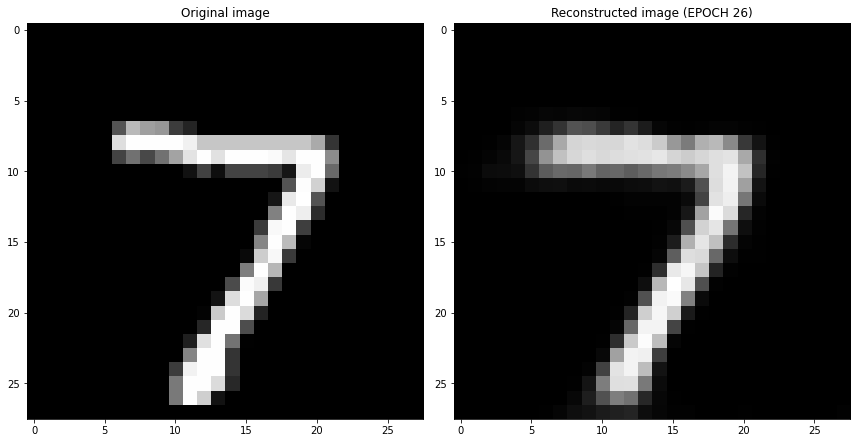

EPOCH 27/30
	 partial train loss (single batch): 0.029347
	 partial train loss (single batch): 0.026781
	 partial train loss (single batch): 0.030134
	 partial train loss (single batch): 0.029625
	 partial train loss (single batch): 0.028936
	 partial train loss (single batch): 0.028545
	 partial train loss (single batch): 0.028158
	 partial train loss (single batch): 0.028347
	 partial train loss (single batch): 0.029201
	 partial train loss (single batch): 0.028276
	 partial train loss (single batch): 0.028735
	 partial train loss (single batch): 0.029099
	 partial train loss (single batch): 0.030395
	 partial train loss (single batch): 0.029196
	 partial train loss (single batch): 0.029744
	 partial train loss (single batch): 0.031031
	 partial train loss (single batch): 0.028737
	 partial train loss (single batch): 0.027926
	 partial train loss (single batch): 0.027014
	 partial train loss (single batch): 0.030206
	 partial train loss (single batch): 0.028834
	 partial train loss (

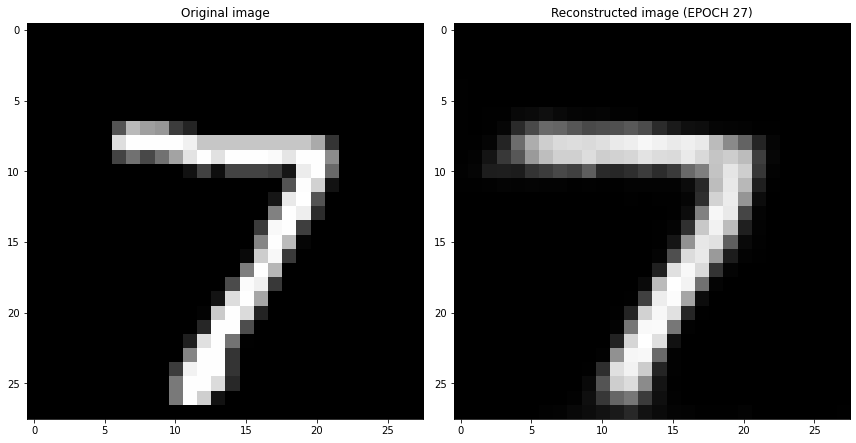

EPOCH 28/30
	 partial train loss (single batch): 0.029075
	 partial train loss (single batch): 0.031268
	 partial train loss (single batch): 0.030157
	 partial train loss (single batch): 0.027117
	 partial train loss (single batch): 0.029939
	 partial train loss (single batch): 0.028096
	 partial train loss (single batch): 0.028650
	 partial train loss (single batch): 0.029736
	 partial train loss (single batch): 0.030316
	 partial train loss (single batch): 0.028750
	 partial train loss (single batch): 0.030610
	 partial train loss (single batch): 0.029071
	 partial train loss (single batch): 0.027926
	 partial train loss (single batch): 0.030258
	 partial train loss (single batch): 0.029330
	 partial train loss (single batch): 0.028919
	 partial train loss (single batch): 0.030061
	 partial train loss (single batch): 0.030325
	 partial train loss (single batch): 0.028986
	 partial train loss (single batch): 0.029446
	 partial train loss (single batch): 0.029053
	 partial train loss (

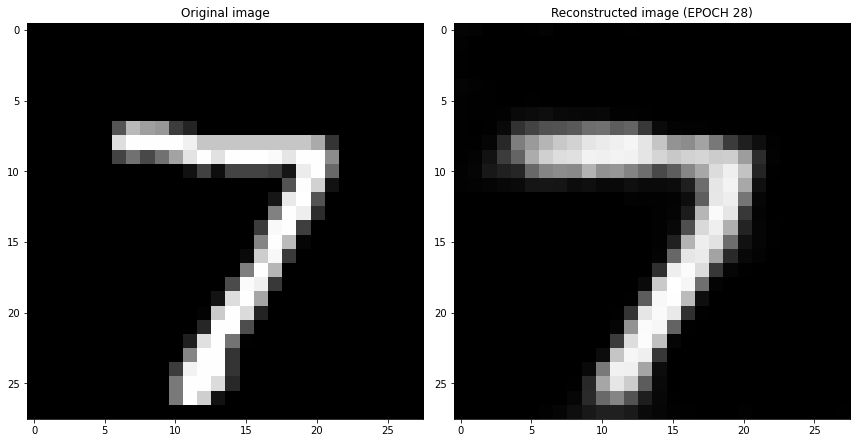

EPOCH 29/30
	 partial train loss (single batch): 0.028031
	 partial train loss (single batch): 0.030611
	 partial train loss (single batch): 0.030141
	 partial train loss (single batch): 0.028185
	 partial train loss (single batch): 0.028432
	 partial train loss (single batch): 0.027847
	 partial train loss (single batch): 0.029697
	 partial train loss (single batch): 0.028644
	 partial train loss (single batch): 0.028818
	 partial train loss (single batch): 0.029612
	 partial train loss (single batch): 0.027103
	 partial train loss (single batch): 0.028030
	 partial train loss (single batch): 0.029120
	 partial train loss (single batch): 0.028569
	 partial train loss (single batch): 0.029397
	 partial train loss (single batch): 0.029198
	 partial train loss (single batch): 0.027175
	 partial train loss (single batch): 0.029948
	 partial train loss (single batch): 0.031108
	 partial train loss (single batch): 0.028387
	 partial train loss (single batch): 0.029670
	 partial train loss (

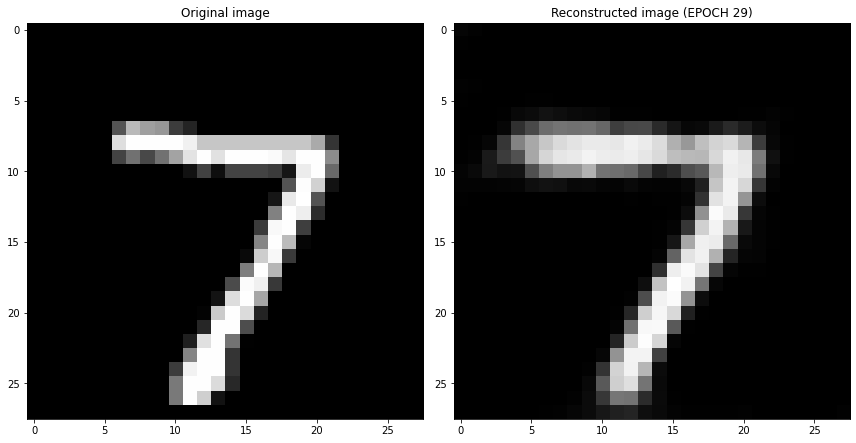

EPOCH 30/30
	 partial train loss (single batch): 0.029152
	 partial train loss (single batch): 0.029371
	 partial train loss (single batch): 0.030141
	 partial train loss (single batch): 0.028501
	 partial train loss (single batch): 0.029087
	 partial train loss (single batch): 0.029810
	 partial train loss (single batch): 0.028078
	 partial train loss (single batch): 0.030815
	 partial train loss (single batch): 0.028390
	 partial train loss (single batch): 0.028546
	 partial train loss (single batch): 0.028856
	 partial train loss (single batch): 0.027664
	 partial train loss (single batch): 0.030443
	 partial train loss (single batch): 0.030313
	 partial train loss (single batch): 0.029513
	 partial train loss (single batch): 0.029868
	 partial train loss (single batch): 0.029190
	 partial train loss (single batch): 0.027341
	 partial train loss (single batch): 0.029423
	 partial train loss (single batch): 0.027895
	 partial train loss (single batch): 0.028418
	 partial train loss (

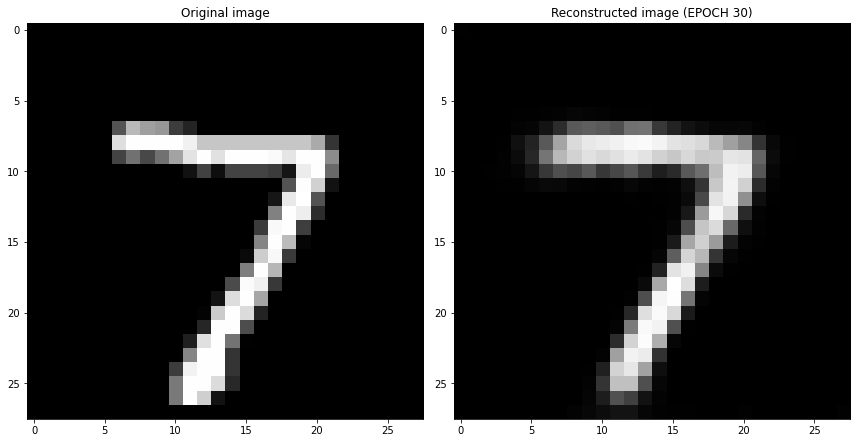

Cross validation fold number= 4/6
EPOCH 1/30
	 partial train loss (single batch): 0.281439
	 partial train loss (single batch): 0.279357
	 partial train loss (single batch): 0.276279
	 partial train loss (single batch): 0.270889
	 partial train loss (single batch): 0.265127
	 partial train loss (single batch): 0.255897
	 partial train loss (single batch): 0.237380
	 partial train loss (single batch): 0.200844
	 partial train loss (single batch): 0.156909
	 partial train loss (single batch): 0.133193
	 partial train loss (single batch): 0.116291
	 partial train loss (single batch): 0.115327
	 partial train loss (single batch): 0.116394
	 partial train loss (single batch): 0.115738
	 partial train loss (single batch): 0.110470
	 partial train loss (single batch): 0.112986
	 partial train loss (single batch): 0.110514
	 partial train loss (single batch): 0.111694
	 partial train loss (single batch): 0.111254
	 partial train loss (single batch): 0.108596
	 partial train loss (single batch)

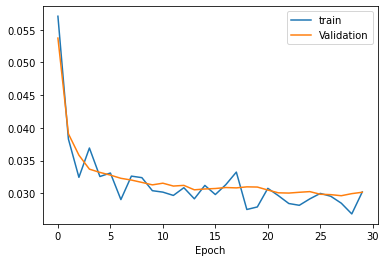

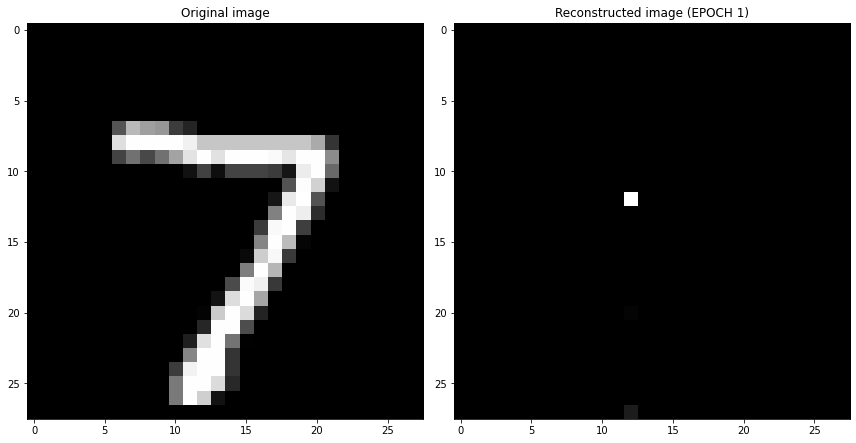

EPOCH 2/30
	 partial train loss (single batch): 0.111841
	 partial train loss (single batch): 0.113257
	 partial train loss (single batch): 0.111144
	 partial train loss (single batch): 0.110545
	 partial train loss (single batch): 0.112570
	 partial train loss (single batch): 0.107743
	 partial train loss (single batch): 0.114118
	 partial train loss (single batch): 0.112329
	 partial train loss (single batch): 0.108666
	 partial train loss (single batch): 0.113247
	 partial train loss (single batch): 0.113995
	 partial train loss (single batch): 0.109305
	 partial train loss (single batch): 0.113297
	 partial train loss (single batch): 0.114055
	 partial train loss (single batch): 0.111136
	 partial train loss (single batch): 0.112537
	 partial train loss (single batch): 0.109802
	 partial train loss (single batch): 0.109771
	 partial train loss (single batch): 0.112300
	 partial train loss (single batch): 0.109337
	 partial train loss (single batch): 0.113808
	 partial train loss (s

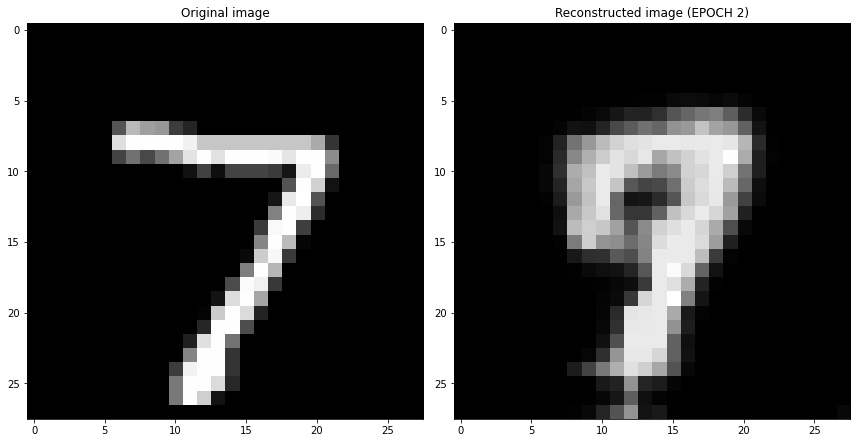

EPOCH 3/30
	 partial train loss (single batch): 0.049267
	 partial train loss (single batch): 0.049677
	 partial train loss (single batch): 0.049459
	 partial train loss (single batch): 0.049961
	 partial train loss (single batch): 0.048302
	 partial train loss (single batch): 0.049321
	 partial train loss (single batch): 0.049805
	 partial train loss (single batch): 0.048040
	 partial train loss (single batch): 0.048701
	 partial train loss (single batch): 0.049574
	 partial train loss (single batch): 0.046808
	 partial train loss (single batch): 0.047024
	 partial train loss (single batch): 0.048318
	 partial train loss (single batch): 0.048361
	 partial train loss (single batch): 0.047063
	 partial train loss (single batch): 0.048460
	 partial train loss (single batch): 0.048027
	 partial train loss (single batch): 0.048605
	 partial train loss (single batch): 0.044941
	 partial train loss (single batch): 0.047737
	 partial train loss (single batch): 0.045842
	 partial train loss (s

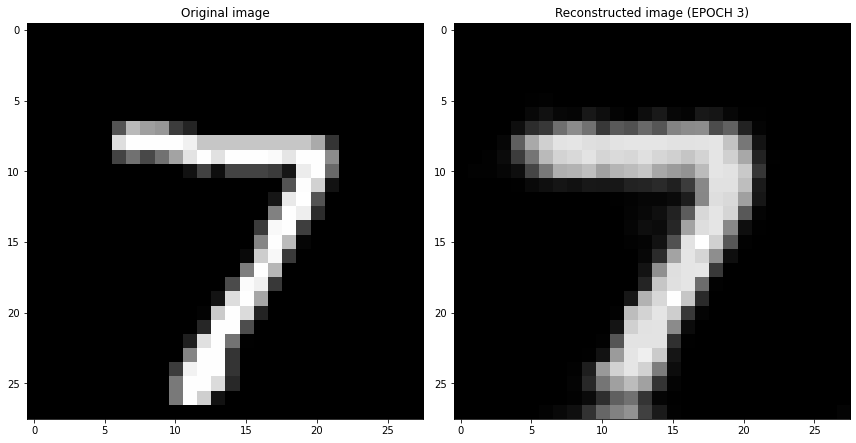

EPOCH 4/30
	 partial train loss (single batch): 0.037284
	 partial train loss (single batch): 0.037882
	 partial train loss (single batch): 0.039633
	 partial train loss (single batch): 0.038787
	 partial train loss (single batch): 0.040348
	 partial train loss (single batch): 0.039502
	 partial train loss (single batch): 0.038505
	 partial train loss (single batch): 0.039060
	 partial train loss (single batch): 0.039901
	 partial train loss (single batch): 0.037186
	 partial train loss (single batch): 0.038800
	 partial train loss (single batch): 0.038876
	 partial train loss (single batch): 0.039230
	 partial train loss (single batch): 0.038876
	 partial train loss (single batch): 0.036752
	 partial train loss (single batch): 0.038031
	 partial train loss (single batch): 0.038691
	 partial train loss (single batch): 0.038427
	 partial train loss (single batch): 0.038343
	 partial train loss (single batch): 0.037474
	 partial train loss (single batch): 0.038179
	 partial train loss (s

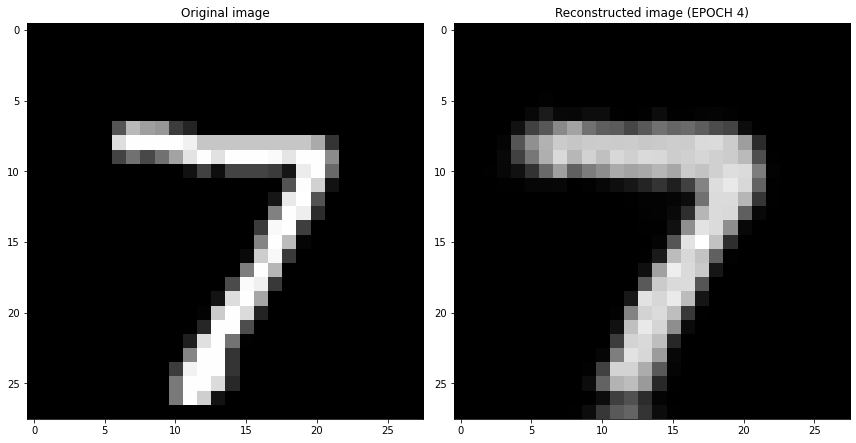

EPOCH 5/30
	 partial train loss (single batch): 0.035376
	 partial train loss (single batch): 0.035647
	 partial train loss (single batch): 0.035376
	 partial train loss (single batch): 0.034644
	 partial train loss (single batch): 0.034978
	 partial train loss (single batch): 0.037269
	 partial train loss (single batch): 0.037445
	 partial train loss (single batch): 0.036341
	 partial train loss (single batch): 0.034876
	 partial train loss (single batch): 0.033371
	 partial train loss (single batch): 0.033729
	 partial train loss (single batch): 0.035719
	 partial train loss (single batch): 0.034476
	 partial train loss (single batch): 0.035849
	 partial train loss (single batch): 0.034530
	 partial train loss (single batch): 0.035459
	 partial train loss (single batch): 0.035871
	 partial train loss (single batch): 0.035718
	 partial train loss (single batch): 0.034469
	 partial train loss (single batch): 0.034652
	 partial train loss (single batch): 0.034205
	 partial train loss (s

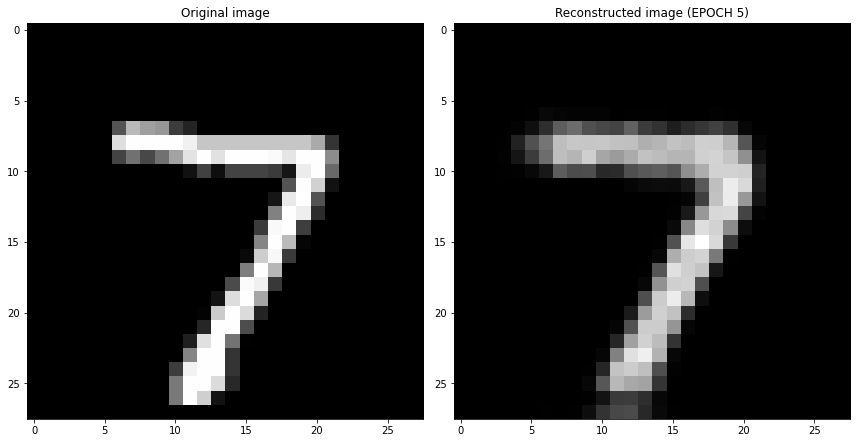

EPOCH 6/30
	 partial train loss (single batch): 0.033743
	 partial train loss (single batch): 0.032899
	 partial train loss (single batch): 0.035144
	 partial train loss (single batch): 0.032916
	 partial train loss (single batch): 0.033274
	 partial train loss (single batch): 0.035036
	 partial train loss (single batch): 0.032867
	 partial train loss (single batch): 0.034150
	 partial train loss (single batch): 0.034747
	 partial train loss (single batch): 0.033268
	 partial train loss (single batch): 0.033576
	 partial train loss (single batch): 0.033754
	 partial train loss (single batch): 0.035107
	 partial train loss (single batch): 0.032723
	 partial train loss (single batch): 0.034309
	 partial train loss (single batch): 0.032626
	 partial train loss (single batch): 0.033403
	 partial train loss (single batch): 0.034308
	 partial train loss (single batch): 0.033502
	 partial train loss (single batch): 0.033586
	 partial train loss (single batch): 0.033899
	 partial train loss (s

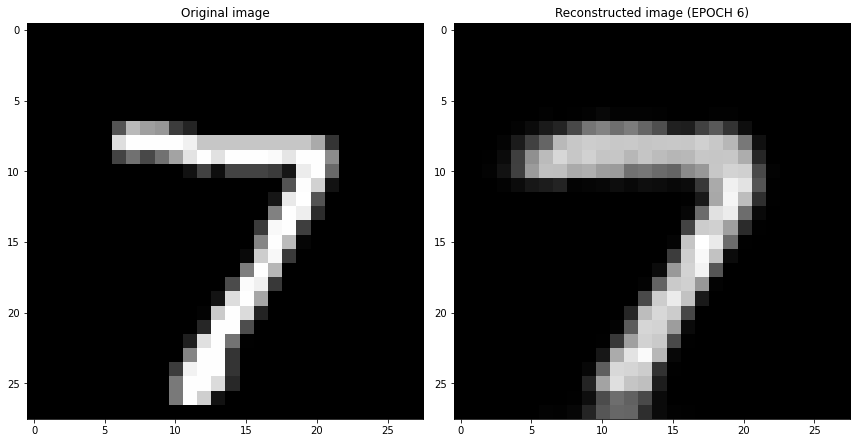

EPOCH 7/30
	 partial train loss (single batch): 0.031253
	 partial train loss (single batch): 0.033651
	 partial train loss (single batch): 0.031866
	 partial train loss (single batch): 0.033175
	 partial train loss (single batch): 0.031081
	 partial train loss (single batch): 0.033460
	 partial train loss (single batch): 0.032933
	 partial train loss (single batch): 0.031198
	 partial train loss (single batch): 0.032307
	 partial train loss (single batch): 0.030071
	 partial train loss (single batch): 0.030430
	 partial train loss (single batch): 0.032999
	 partial train loss (single batch): 0.032231
	 partial train loss (single batch): 0.032865
	 partial train loss (single batch): 0.031984
	 partial train loss (single batch): 0.032061
	 partial train loss (single batch): 0.032596
	 partial train loss (single batch): 0.032557
	 partial train loss (single batch): 0.032028
	 partial train loss (single batch): 0.032935
	 partial train loss (single batch): 0.032319
	 partial train loss (s

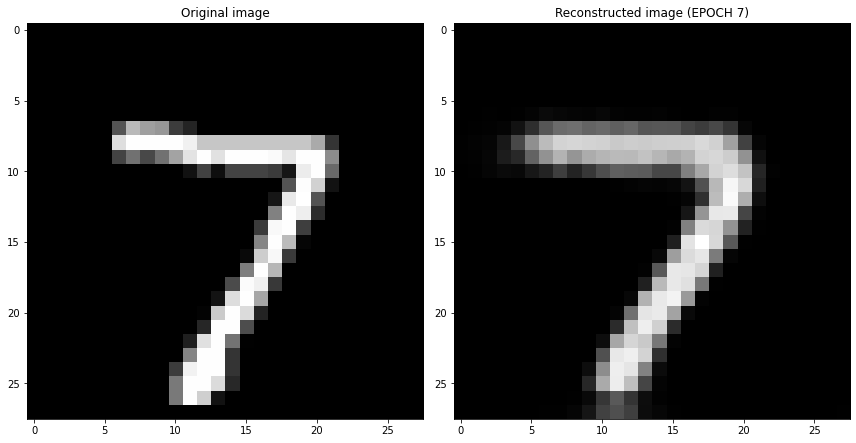

EPOCH 8/30
	 partial train loss (single batch): 0.031757
	 partial train loss (single batch): 0.031815
	 partial train loss (single batch): 0.033537
	 partial train loss (single batch): 0.032204
	 partial train loss (single batch): 0.031976
	 partial train loss (single batch): 0.032961
	 partial train loss (single batch): 0.032624
	 partial train loss (single batch): 0.031203
	 partial train loss (single batch): 0.031623
	 partial train loss (single batch): 0.030356
	 partial train loss (single batch): 0.031561
	 partial train loss (single batch): 0.031604
	 partial train loss (single batch): 0.032247
	 partial train loss (single batch): 0.031875
	 partial train loss (single batch): 0.031583
	 partial train loss (single batch): 0.031815
	 partial train loss (single batch): 0.032936
	 partial train loss (single batch): 0.031588
	 partial train loss (single batch): 0.032322
	 partial train loss (single batch): 0.032391
	 partial train loss (single batch): 0.030928
	 partial train loss (s

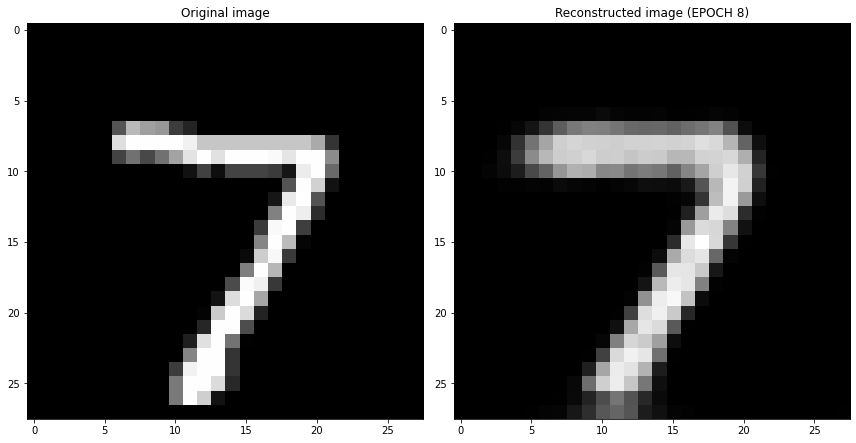

EPOCH 9/30
	 partial train loss (single batch): 0.031409
	 partial train loss (single batch): 0.030361
	 partial train loss (single batch): 0.032070
	 partial train loss (single batch): 0.030633
	 partial train loss (single batch): 0.030336
	 partial train loss (single batch): 0.031710
	 partial train loss (single batch): 0.031345
	 partial train loss (single batch): 0.029688
	 partial train loss (single batch): 0.030336
	 partial train loss (single batch): 0.030659
	 partial train loss (single batch): 0.030921
	 partial train loss (single batch): 0.031047
	 partial train loss (single batch): 0.030181
	 partial train loss (single batch): 0.032663
	 partial train loss (single batch): 0.032035
	 partial train loss (single batch): 0.032078
	 partial train loss (single batch): 0.030845
	 partial train loss (single batch): 0.030859
	 partial train loss (single batch): 0.029721
	 partial train loss (single batch): 0.030732
	 partial train loss (single batch): 0.032897
	 partial train loss (s

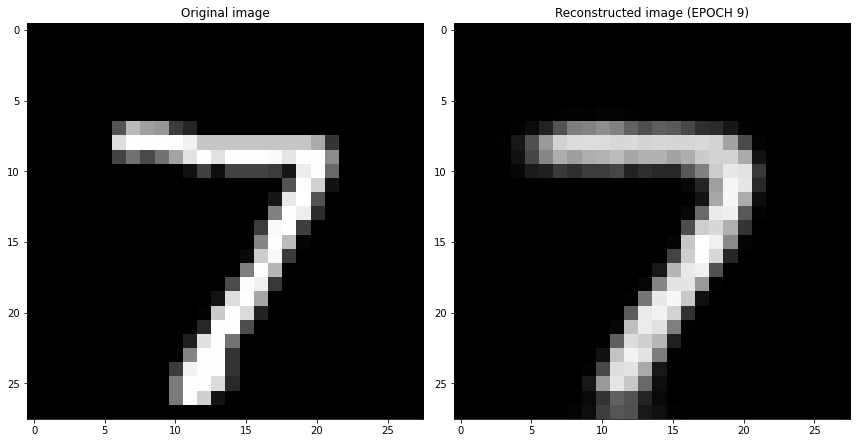

EPOCH 10/30
	 partial train loss (single batch): 0.030651
	 partial train loss (single batch): 0.030260
	 partial train loss (single batch): 0.030990
	 partial train loss (single batch): 0.030968
	 partial train loss (single batch): 0.029531
	 partial train loss (single batch): 0.032938
	 partial train loss (single batch): 0.030869
	 partial train loss (single batch): 0.032746
	 partial train loss (single batch): 0.031431
	 partial train loss (single batch): 0.033437
	 partial train loss (single batch): 0.032320
	 partial train loss (single batch): 0.031581
	 partial train loss (single batch): 0.031270
	 partial train loss (single batch): 0.031252
	 partial train loss (single batch): 0.031422
	 partial train loss (single batch): 0.030914
	 partial train loss (single batch): 0.030507
	 partial train loss (single batch): 0.030305
	 partial train loss (single batch): 0.030291
	 partial train loss (single batch): 0.033067
	 partial train loss (single batch): 0.030912
	 partial train loss (

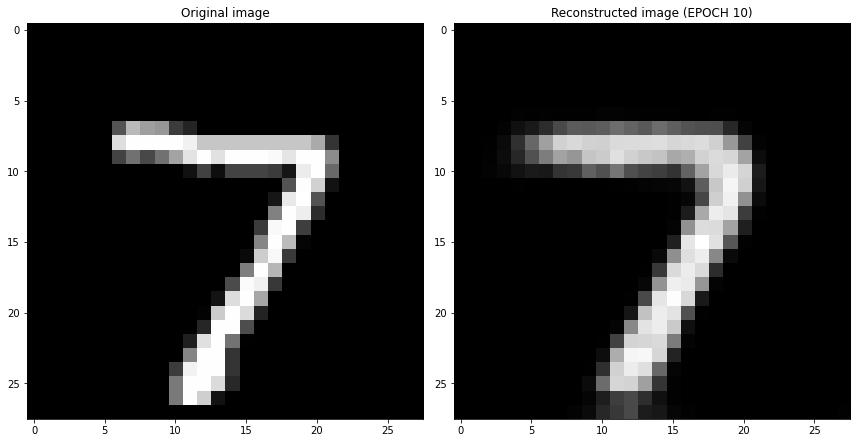

EPOCH 11/30
	 partial train loss (single batch): 0.028629
	 partial train loss (single batch): 0.028436
	 partial train loss (single batch): 0.030170
	 partial train loss (single batch): 0.028579
	 partial train loss (single batch): 0.029256
	 partial train loss (single batch): 0.030194
	 partial train loss (single batch): 0.029332
	 partial train loss (single batch): 0.029121
	 partial train loss (single batch): 0.030324
	 partial train loss (single batch): 0.030589
	 partial train loss (single batch): 0.030039
	 partial train loss (single batch): 0.029974
	 partial train loss (single batch): 0.030950
	 partial train loss (single batch): 0.030372
	 partial train loss (single batch): 0.031303
	 partial train loss (single batch): 0.029643
	 partial train loss (single batch): 0.030685
	 partial train loss (single batch): 0.030133
	 partial train loss (single batch): 0.029982
	 partial train loss (single batch): 0.031150
	 partial train loss (single batch): 0.032059
	 partial train loss (

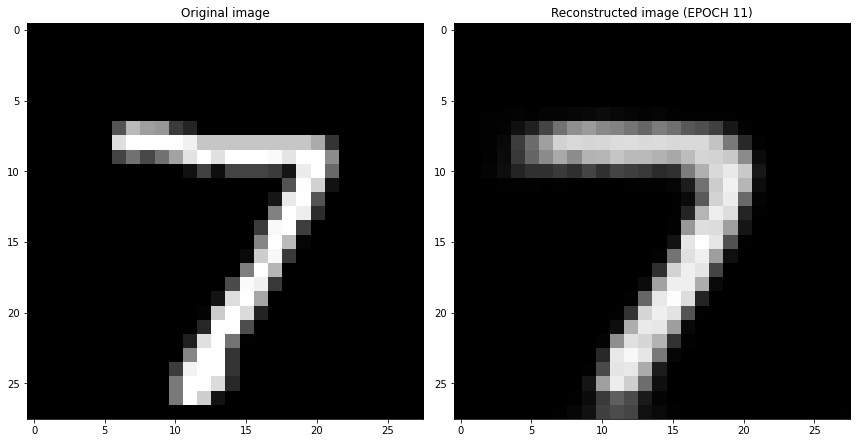

EPOCH 12/30
	 partial train loss (single batch): 0.030517
	 partial train loss (single batch): 0.030042
	 partial train loss (single batch): 0.031629
	 partial train loss (single batch): 0.030158
	 partial train loss (single batch): 0.028722
	 partial train loss (single batch): 0.029576
	 partial train loss (single batch): 0.029342
	 partial train loss (single batch): 0.028566
	 partial train loss (single batch): 0.029949
	 partial train loss (single batch): 0.030560
	 partial train loss (single batch): 0.029431
	 partial train loss (single batch): 0.031089
	 partial train loss (single batch): 0.030406
	 partial train loss (single batch): 0.030928
	 partial train loss (single batch): 0.029184
	 partial train loss (single batch): 0.029624
	 partial train loss (single batch): 0.031282
	 partial train loss (single batch): 0.030143
	 partial train loss (single batch): 0.032036
	 partial train loss (single batch): 0.029998
	 partial train loss (single batch): 0.030592
	 partial train loss (

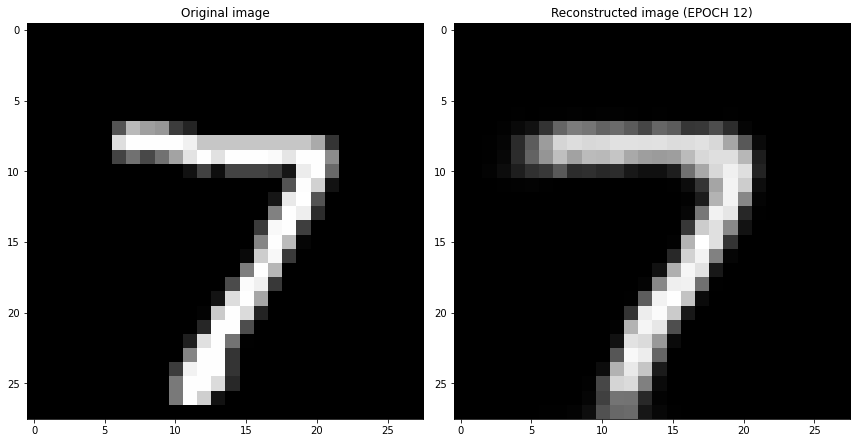

EPOCH 13/30
	 partial train loss (single batch): 0.030194
	 partial train loss (single batch): 0.031654
	 partial train loss (single batch): 0.030641
	 partial train loss (single batch): 0.029321
	 partial train loss (single batch): 0.031423
	 partial train loss (single batch): 0.031831
	 partial train loss (single batch): 0.030403
	 partial train loss (single batch): 0.029325
	 partial train loss (single batch): 0.030406
	 partial train loss (single batch): 0.030254
	 partial train loss (single batch): 0.031041
	 partial train loss (single batch): 0.029641
	 partial train loss (single batch): 0.030392
	 partial train loss (single batch): 0.030898
	 partial train loss (single batch): 0.029151
	 partial train loss (single batch): 0.030569
	 partial train loss (single batch): 0.029706
	 partial train loss (single batch): 0.029059
	 partial train loss (single batch): 0.029695
	 partial train loss (single batch): 0.030337
	 partial train loss (single batch): 0.030248
	 partial train loss (

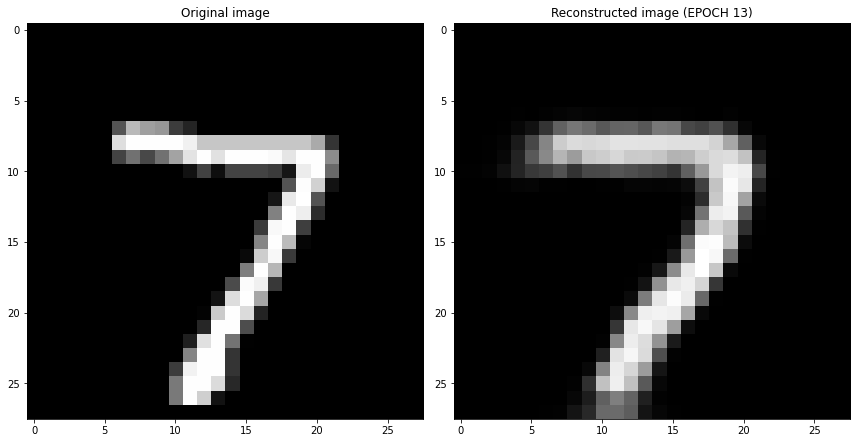

EPOCH 14/30
	 partial train loss (single batch): 0.030063
	 partial train loss (single batch): 0.028699
	 partial train loss (single batch): 0.028671
	 partial train loss (single batch): 0.029415
	 partial train loss (single batch): 0.030310
	 partial train loss (single batch): 0.030656
	 partial train loss (single batch): 0.030257
	 partial train loss (single batch): 0.028767
	 partial train loss (single batch): 0.029362
	 partial train loss (single batch): 0.029097
	 partial train loss (single batch): 0.028422
	 partial train loss (single batch): 0.031923
	 partial train loss (single batch): 0.029251
	 partial train loss (single batch): 0.029283
	 partial train loss (single batch): 0.029531
	 partial train loss (single batch): 0.029872
	 partial train loss (single batch): 0.029767
	 partial train loss (single batch): 0.030429
	 partial train loss (single batch): 0.030656
	 partial train loss (single batch): 0.028946
	 partial train loss (single batch): 0.030067
	 partial train loss (

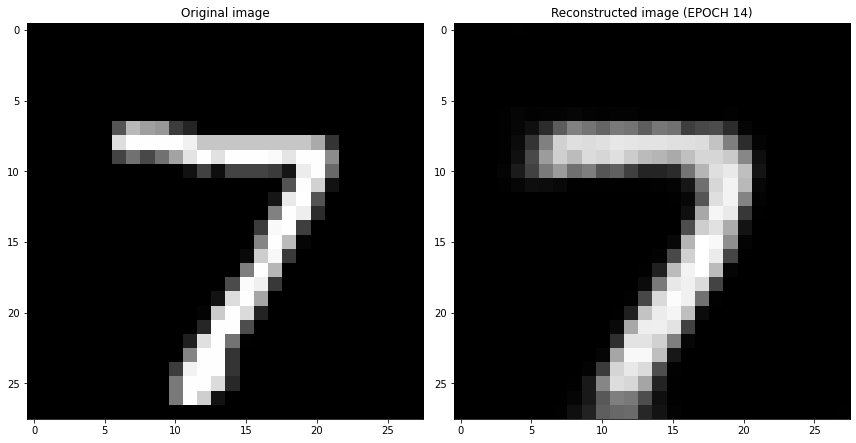

EPOCH 15/30
	 partial train loss (single batch): 0.030108
	 partial train loss (single batch): 0.029427
	 partial train loss (single batch): 0.031439
	 partial train loss (single batch): 0.030642
	 partial train loss (single batch): 0.029048
	 partial train loss (single batch): 0.032247
	 partial train loss (single batch): 0.028856
	 partial train loss (single batch): 0.030505
	 partial train loss (single batch): 0.030729
	 partial train loss (single batch): 0.029474
	 partial train loss (single batch): 0.030056
	 partial train loss (single batch): 0.032005
	 partial train loss (single batch): 0.030460
	 partial train loss (single batch): 0.030009
	 partial train loss (single batch): 0.030156
	 partial train loss (single batch): 0.029981
	 partial train loss (single batch): 0.030894
	 partial train loss (single batch): 0.029034
	 partial train loss (single batch): 0.030070
	 partial train loss (single batch): 0.029449
	 partial train loss (single batch): 0.029417
	 partial train loss (

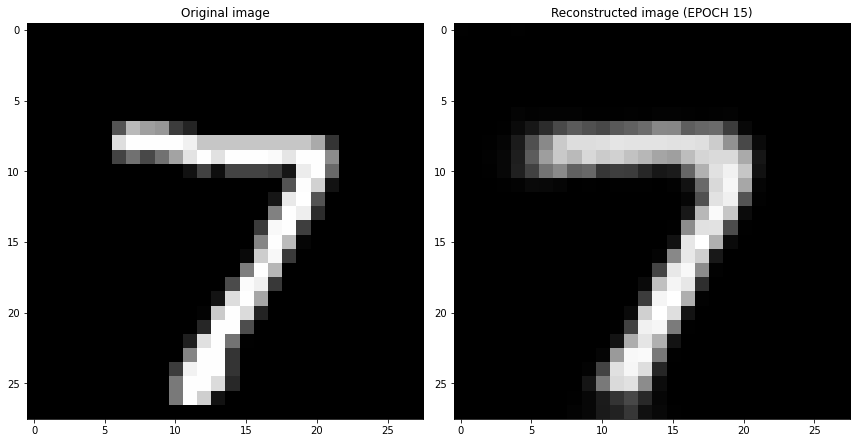

EPOCH 16/30
	 partial train loss (single batch): 0.029249
	 partial train loss (single batch): 0.030154
	 partial train loss (single batch): 0.028672
	 partial train loss (single batch): 0.028773
	 partial train loss (single batch): 0.028832
	 partial train loss (single batch): 0.029144
	 partial train loss (single batch): 0.028706
	 partial train loss (single batch): 0.028204
	 partial train loss (single batch): 0.029202
	 partial train loss (single batch): 0.028900
	 partial train loss (single batch): 0.029448
	 partial train loss (single batch): 0.029560
	 partial train loss (single batch): 0.032507
	 partial train loss (single batch): 0.027615
	 partial train loss (single batch): 0.029861
	 partial train loss (single batch): 0.029710
	 partial train loss (single batch): 0.029351
	 partial train loss (single batch): 0.028963
	 partial train loss (single batch): 0.028898
	 partial train loss (single batch): 0.030287
	 partial train loss (single batch): 0.033040
	 partial train loss (

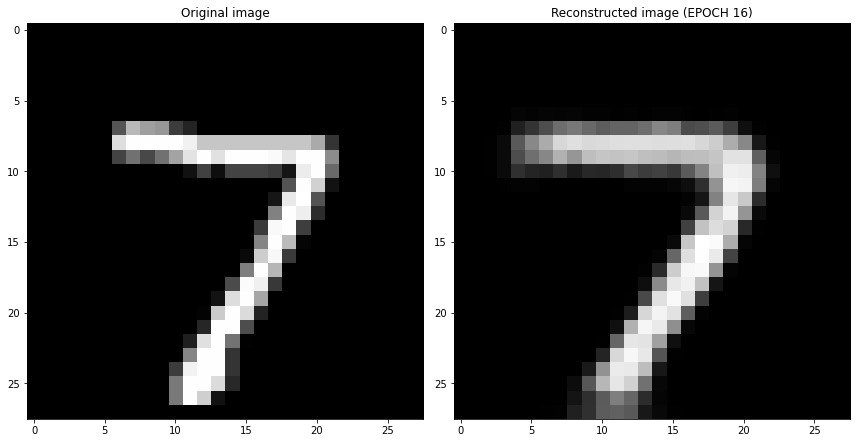

EPOCH 17/30
	 partial train loss (single batch): 0.029985
	 partial train loss (single batch): 0.027892
	 partial train loss (single batch): 0.030726
	 partial train loss (single batch): 0.030362
	 partial train loss (single batch): 0.029236
	 partial train loss (single batch): 0.029377
	 partial train loss (single batch): 0.028457
	 partial train loss (single batch): 0.027834
	 partial train loss (single batch): 0.029911
	 partial train loss (single batch): 0.031382
	 partial train loss (single batch): 0.028778
	 partial train loss (single batch): 0.030100
	 partial train loss (single batch): 0.029639
	 partial train loss (single batch): 0.029682
	 partial train loss (single batch): 0.031651
	 partial train loss (single batch): 0.030730
	 partial train loss (single batch): 0.028009
	 partial train loss (single batch): 0.029041
	 partial train loss (single batch): 0.030009
	 partial train loss (single batch): 0.029803
	 partial train loss (single batch): 0.029336
	 partial train loss (

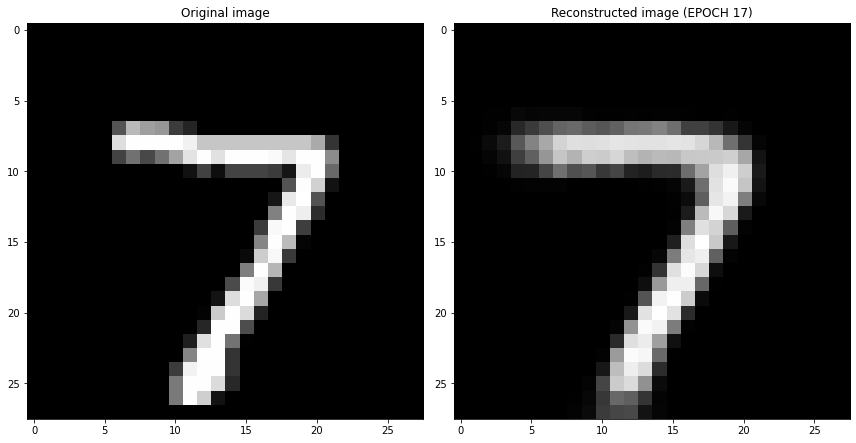

EPOCH 18/30
	 partial train loss (single batch): 0.031213
	 partial train loss (single batch): 0.029236
	 partial train loss (single batch): 0.029275
	 partial train loss (single batch): 0.031348
	 partial train loss (single batch): 0.027752
	 partial train loss (single batch): 0.027859
	 partial train loss (single batch): 0.029281
	 partial train loss (single batch): 0.030530
	 partial train loss (single batch): 0.027592
	 partial train loss (single batch): 0.029808
	 partial train loss (single batch): 0.030364
	 partial train loss (single batch): 0.029885
	 partial train loss (single batch): 0.029908
	 partial train loss (single batch): 0.027850
	 partial train loss (single batch): 0.030777
	 partial train loss (single batch): 0.028278
	 partial train loss (single batch): 0.028480
	 partial train loss (single batch): 0.028913
	 partial train loss (single batch): 0.029828
	 partial train loss (single batch): 0.029414
	 partial train loss (single batch): 0.029775
	 partial train loss (

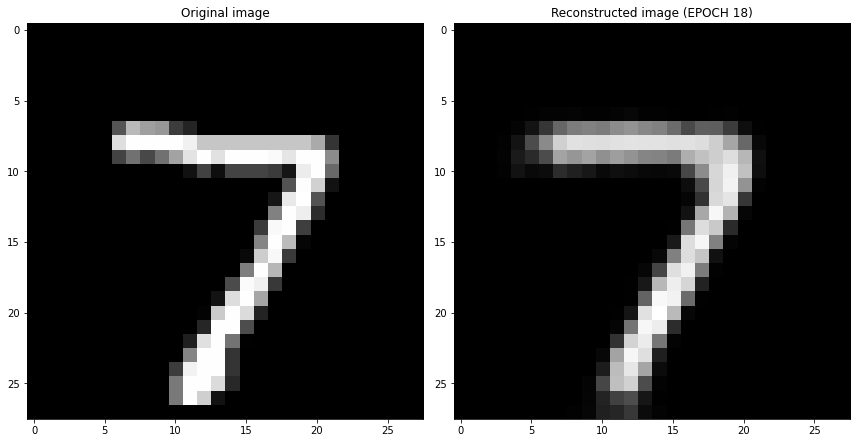

EPOCH 19/30
	 partial train loss (single batch): 0.030463
	 partial train loss (single batch): 0.029716
	 partial train loss (single batch): 0.028652
	 partial train loss (single batch): 0.029906
	 partial train loss (single batch): 0.029079
	 partial train loss (single batch): 0.030676
	 partial train loss (single batch): 0.029366
	 partial train loss (single batch): 0.028638
	 partial train loss (single batch): 0.028301
	 partial train loss (single batch): 0.028701
	 partial train loss (single batch): 0.028385
	 partial train loss (single batch): 0.028263
	 partial train loss (single batch): 0.030471
	 partial train loss (single batch): 0.031791
	 partial train loss (single batch): 0.030583
	 partial train loss (single batch): 0.030052
	 partial train loss (single batch): 0.027339
	 partial train loss (single batch): 0.030916
	 partial train loss (single batch): 0.029302
	 partial train loss (single batch): 0.030214
	 partial train loss (single batch): 0.029623
	 partial train loss (

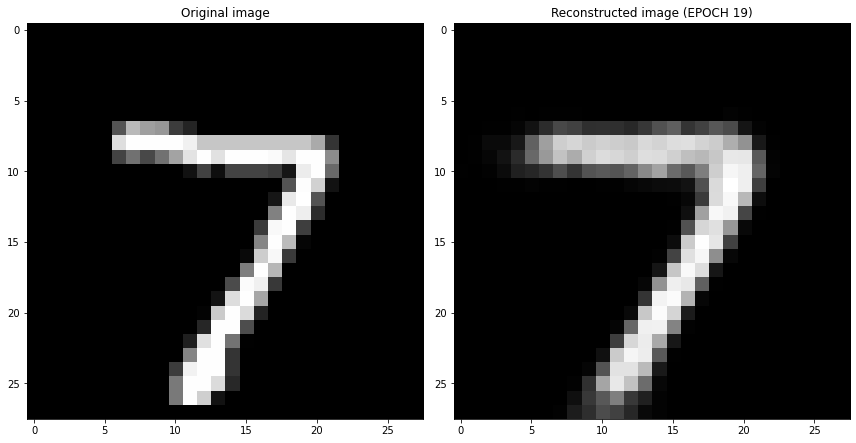

EPOCH 20/30
	 partial train loss (single batch): 0.027860
	 partial train loss (single batch): 0.029558
	 partial train loss (single batch): 0.029239
	 partial train loss (single batch): 0.030027
	 partial train loss (single batch): 0.030438
	 partial train loss (single batch): 0.029497
	 partial train loss (single batch): 0.029730
	 partial train loss (single batch): 0.029004
	 partial train loss (single batch): 0.028760
	 partial train loss (single batch): 0.029649
	 partial train loss (single batch): 0.027632
	 partial train loss (single batch): 0.030691
	 partial train loss (single batch): 0.028848
	 partial train loss (single batch): 0.030756
	 partial train loss (single batch): 0.030345
	 partial train loss (single batch): 0.028374
	 partial train loss (single batch): 0.029895
	 partial train loss (single batch): 0.029721
	 partial train loss (single batch): 0.029461
	 partial train loss (single batch): 0.027994
	 partial train loss (single batch): 0.028964
	 partial train loss (

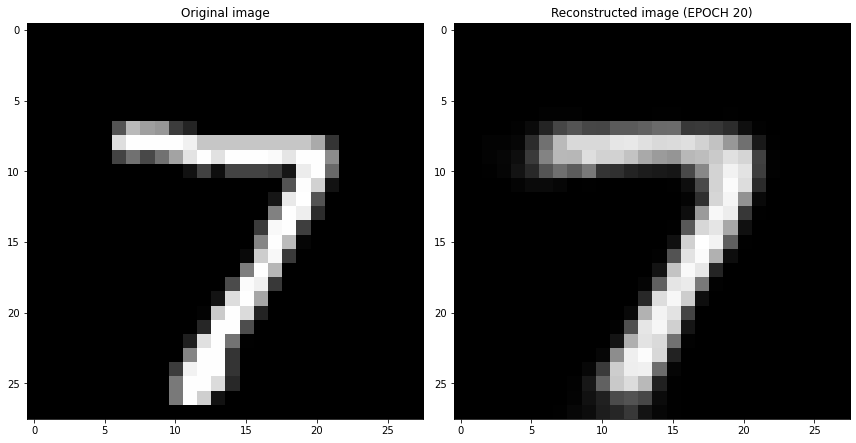

EPOCH 21/30
	 partial train loss (single batch): 0.030027
	 partial train loss (single batch): 0.028714
	 partial train loss (single batch): 0.027764
	 partial train loss (single batch): 0.029620
	 partial train loss (single batch): 0.029080
	 partial train loss (single batch): 0.029232
	 partial train loss (single batch): 0.028969
	 partial train loss (single batch): 0.030280
	 partial train loss (single batch): 0.028388
	 partial train loss (single batch): 0.029781
	 partial train loss (single batch): 0.029040
	 partial train loss (single batch): 0.029568
	 partial train loss (single batch): 0.027817
	 partial train loss (single batch): 0.029973
	 partial train loss (single batch): 0.029400
	 partial train loss (single batch): 0.028551
	 partial train loss (single batch): 0.029964
	 partial train loss (single batch): 0.028472
	 partial train loss (single batch): 0.027994
	 partial train loss (single batch): 0.029997
	 partial train loss (single batch): 0.028190
	 partial train loss (

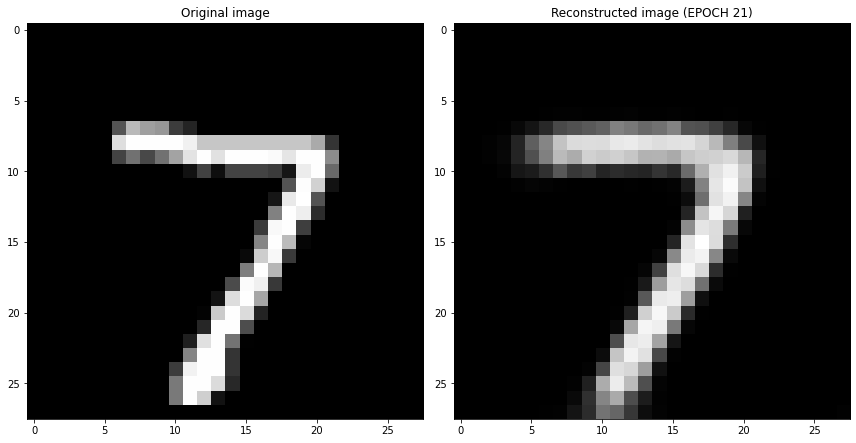

EPOCH 22/30
	 partial train loss (single batch): 0.029119
	 partial train loss (single batch): 0.029546
	 partial train loss (single batch): 0.029520
	 partial train loss (single batch): 0.031015
	 partial train loss (single batch): 0.030142
	 partial train loss (single batch): 0.028617
	 partial train loss (single batch): 0.030285
	 partial train loss (single batch): 0.029018
	 partial train loss (single batch): 0.029127
	 partial train loss (single batch): 0.030766
	 partial train loss (single batch): 0.027322
	 partial train loss (single batch): 0.028448
	 partial train loss (single batch): 0.028095
	 partial train loss (single batch): 0.029595
	 partial train loss (single batch): 0.027892
	 partial train loss (single batch): 0.030583
	 partial train loss (single batch): 0.028730
	 partial train loss (single batch): 0.028594
	 partial train loss (single batch): 0.029832
	 partial train loss (single batch): 0.029695
	 partial train loss (single batch): 0.028281
	 partial train loss (

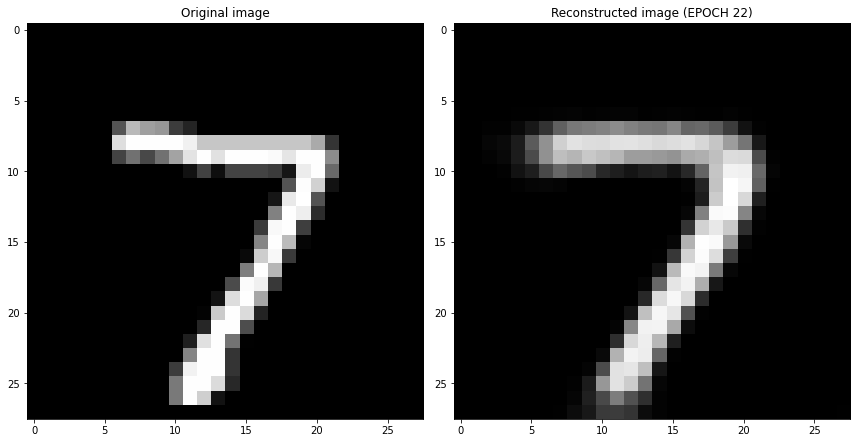

EPOCH 23/30
	 partial train loss (single batch): 0.027790
	 partial train loss (single batch): 0.026921
	 partial train loss (single batch): 0.030596
	 partial train loss (single batch): 0.028528
	 partial train loss (single batch): 0.029002
	 partial train loss (single batch): 0.027984
	 partial train loss (single batch): 0.028714
	 partial train loss (single batch): 0.030658
	 partial train loss (single batch): 0.029144
	 partial train loss (single batch): 0.029104
	 partial train loss (single batch): 0.028561
	 partial train loss (single batch): 0.027924
	 partial train loss (single batch): 0.028928
	 partial train loss (single batch): 0.027085
	 partial train loss (single batch): 0.029678
	 partial train loss (single batch): 0.028317
	 partial train loss (single batch): 0.029011
	 partial train loss (single batch): 0.029026
	 partial train loss (single batch): 0.029477
	 partial train loss (single batch): 0.030214
	 partial train loss (single batch): 0.030767
	 partial train loss (

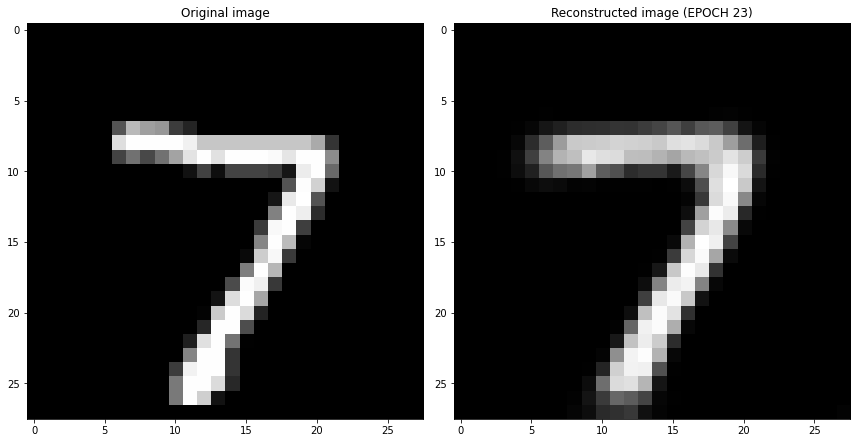

EPOCH 24/30
	 partial train loss (single batch): 0.028796
	 partial train loss (single batch): 0.030226
	 partial train loss (single batch): 0.029476
	 partial train loss (single batch): 0.030602
	 partial train loss (single batch): 0.029190
	 partial train loss (single batch): 0.028397
	 partial train loss (single batch): 0.028880
	 partial train loss (single batch): 0.029963
	 partial train loss (single batch): 0.029049
	 partial train loss (single batch): 0.029829
	 partial train loss (single batch): 0.030098
	 partial train loss (single batch): 0.030802
	 partial train loss (single batch): 0.028116
	 partial train loss (single batch): 0.028590
	 partial train loss (single batch): 0.029506
	 partial train loss (single batch): 0.030871
	 partial train loss (single batch): 0.028585
	 partial train loss (single batch): 0.029646
	 partial train loss (single batch): 0.029606
	 partial train loss (single batch): 0.030727
	 partial train loss (single batch): 0.030042
	 partial train loss (

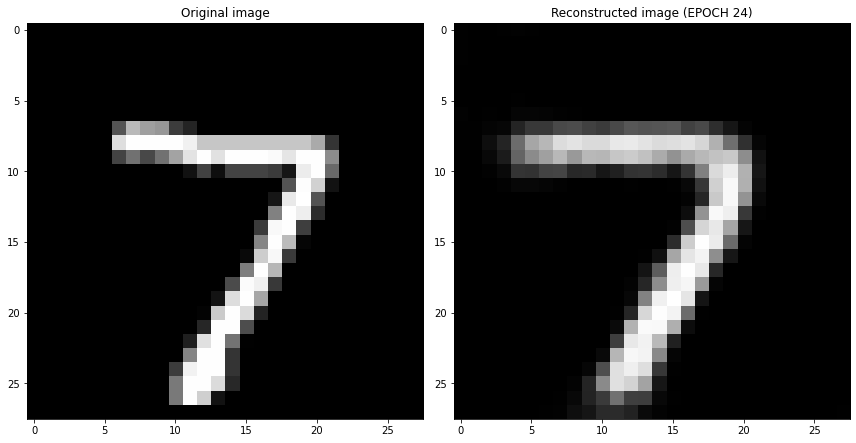

EPOCH 25/30
	 partial train loss (single batch): 0.029146
	 partial train loss (single batch): 0.026013
	 partial train loss (single batch): 0.029817
	 partial train loss (single batch): 0.027416
	 partial train loss (single batch): 0.028938
	 partial train loss (single batch): 0.028827
	 partial train loss (single batch): 0.029241
	 partial train loss (single batch): 0.029408
	 partial train loss (single batch): 0.027195
	 partial train loss (single batch): 0.029451
	 partial train loss (single batch): 0.029082
	 partial train loss (single batch): 0.029657
	 partial train loss (single batch): 0.029009
	 partial train loss (single batch): 0.030487
	 partial train loss (single batch): 0.028904
	 partial train loss (single batch): 0.029107
	 partial train loss (single batch): 0.027813
	 partial train loss (single batch): 0.027843
	 partial train loss (single batch): 0.030119
	 partial train loss (single batch): 0.029306
	 partial train loss (single batch): 0.029109
	 partial train loss (

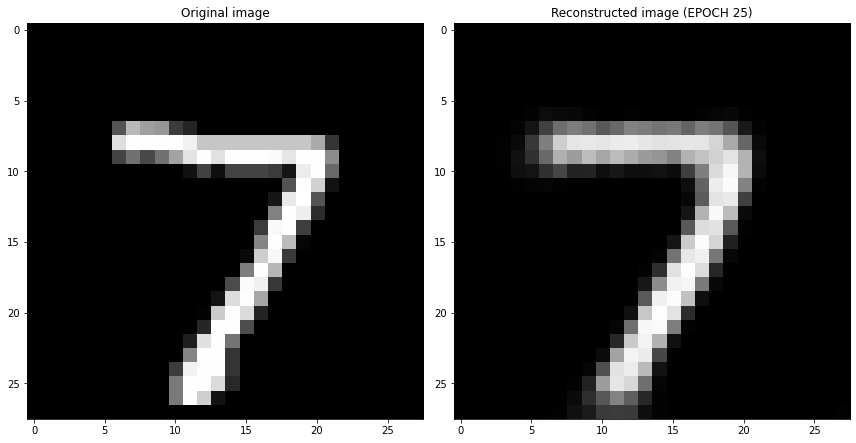

EPOCH 26/30
	 partial train loss (single batch): 0.027345
	 partial train loss (single batch): 0.028833
	 partial train loss (single batch): 0.029413
	 partial train loss (single batch): 0.029499
	 partial train loss (single batch): 0.028828
	 partial train loss (single batch): 0.029280
	 partial train loss (single batch): 0.028424
	 partial train loss (single batch): 0.030771
	 partial train loss (single batch): 0.028858
	 partial train loss (single batch): 0.030664
	 partial train loss (single batch): 0.028862
	 partial train loss (single batch): 0.029171
	 partial train loss (single batch): 0.028149
	 partial train loss (single batch): 0.028340
	 partial train loss (single batch): 0.029026
	 partial train loss (single batch): 0.029119
	 partial train loss (single batch): 0.028045
	 partial train loss (single batch): 0.029839
	 partial train loss (single batch): 0.028079
	 partial train loss (single batch): 0.027875
	 partial train loss (single batch): 0.029129
	 partial train loss (

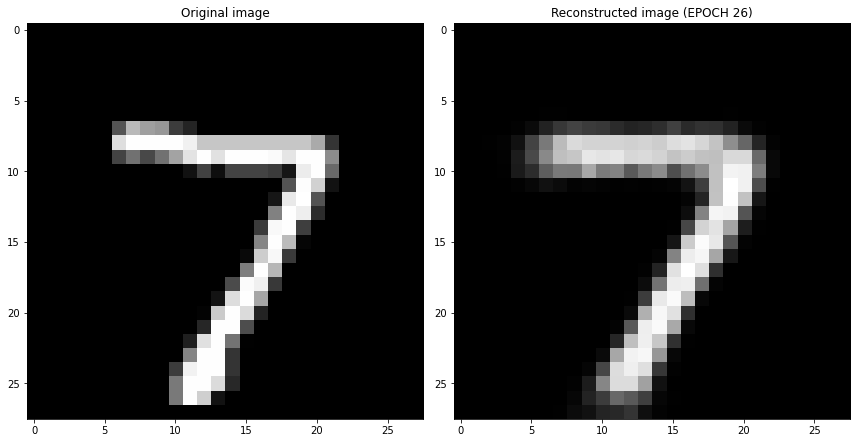

EPOCH 27/30
	 partial train loss (single batch): 0.028465
	 partial train loss (single batch): 0.028550
	 partial train loss (single batch): 0.026958
	 partial train loss (single batch): 0.029179
	 partial train loss (single batch): 0.029038
	 partial train loss (single batch): 0.028625
	 partial train loss (single batch): 0.029480
	 partial train loss (single batch): 0.027812
	 partial train loss (single batch): 0.028854
	 partial train loss (single batch): 0.029307
	 partial train loss (single batch): 0.027990
	 partial train loss (single batch): 0.027597
	 partial train loss (single batch): 0.029476
	 partial train loss (single batch): 0.027537
	 partial train loss (single batch): 0.027225
	 partial train loss (single batch): 0.029700
	 partial train loss (single batch): 0.030416
	 partial train loss (single batch): 0.027824
	 partial train loss (single batch): 0.029769
	 partial train loss (single batch): 0.028219
	 partial train loss (single batch): 0.029513
	 partial train loss (

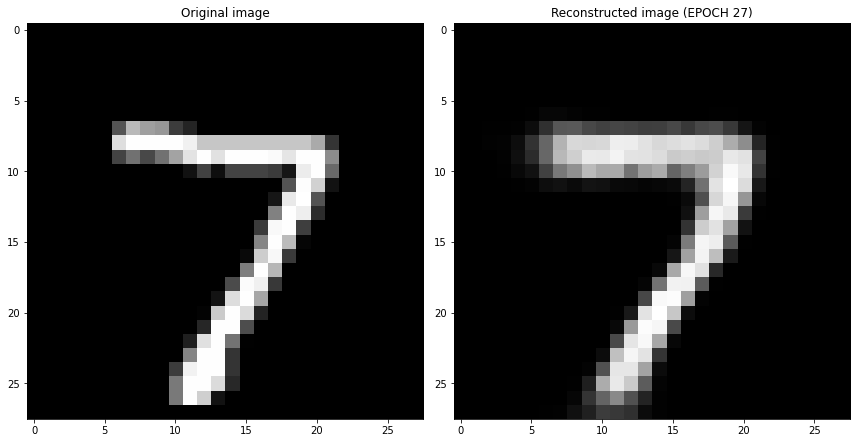

EPOCH 28/30
	 partial train loss (single batch): 0.027356
	 partial train loss (single batch): 0.029179
	 partial train loss (single batch): 0.028632
	 partial train loss (single batch): 0.028230
	 partial train loss (single batch): 0.028286
	 partial train loss (single batch): 0.029015
	 partial train loss (single batch): 0.027761
	 partial train loss (single batch): 0.030015
	 partial train loss (single batch): 0.028688
	 partial train loss (single batch): 0.028574
	 partial train loss (single batch): 0.029324
	 partial train loss (single batch): 0.029067
	 partial train loss (single batch): 0.028212
	 partial train loss (single batch): 0.028412
	 partial train loss (single batch): 0.028877
	 partial train loss (single batch): 0.029533
	 partial train loss (single batch): 0.028032
	 partial train loss (single batch): 0.027162
	 partial train loss (single batch): 0.029094
	 partial train loss (single batch): 0.029511
	 partial train loss (single batch): 0.027229
	 partial train loss (

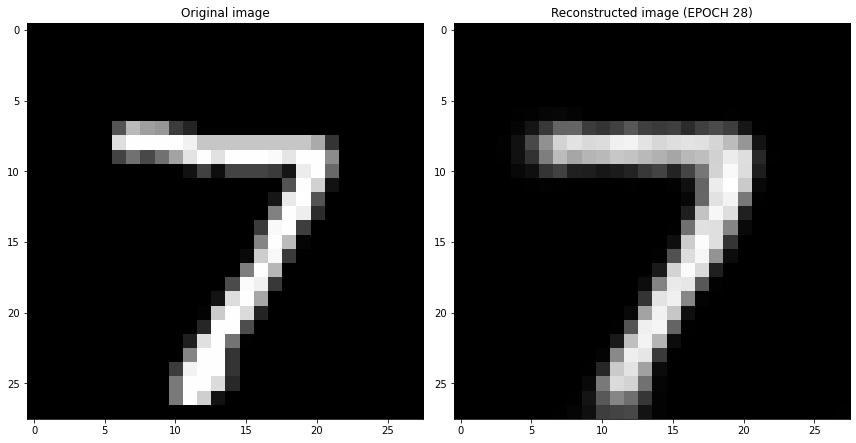

EPOCH 29/30
	 partial train loss (single batch): 0.027815
	 partial train loss (single batch): 0.029688
	 partial train loss (single batch): 0.028327
	 partial train loss (single batch): 0.027642
	 partial train loss (single batch): 0.028267
	 partial train loss (single batch): 0.027900
	 partial train loss (single batch): 0.028747
	 partial train loss (single batch): 0.027010
	 partial train loss (single batch): 0.029979
	 partial train loss (single batch): 0.027983
	 partial train loss (single batch): 0.028555
	 partial train loss (single batch): 0.028890
	 partial train loss (single batch): 0.027833
	 partial train loss (single batch): 0.029890
	 partial train loss (single batch): 0.028634
	 partial train loss (single batch): 0.028646
	 partial train loss (single batch): 0.029297
	 partial train loss (single batch): 0.028200
	 partial train loss (single batch): 0.028485
	 partial train loss (single batch): 0.030087
	 partial train loss (single batch): 0.028831
	 partial train loss (

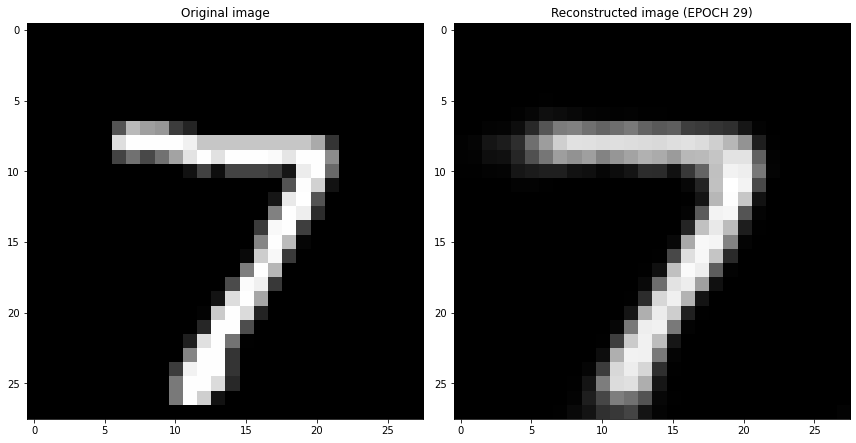

EPOCH 30/30
	 partial train loss (single batch): 0.027914
	 partial train loss (single batch): 0.027710
	 partial train loss (single batch): 0.027078
	 partial train loss (single batch): 0.029560
	 partial train loss (single batch): 0.028768
	 partial train loss (single batch): 0.028063
	 partial train loss (single batch): 0.028607
	 partial train loss (single batch): 0.027827
	 partial train loss (single batch): 0.029068
	 partial train loss (single batch): 0.028080
	 partial train loss (single batch): 0.029066
	 partial train loss (single batch): 0.029190
	 partial train loss (single batch): 0.028218
	 partial train loss (single batch): 0.027866
	 partial train loss (single batch): 0.028077
	 partial train loss (single batch): 0.027945
	 partial train loss (single batch): 0.027439
	 partial train loss (single batch): 0.028663
	 partial train loss (single batch): 0.028892
	 partial train loss (single batch): 0.029699
	 partial train loss (single batch): 0.028441
	 partial train loss (

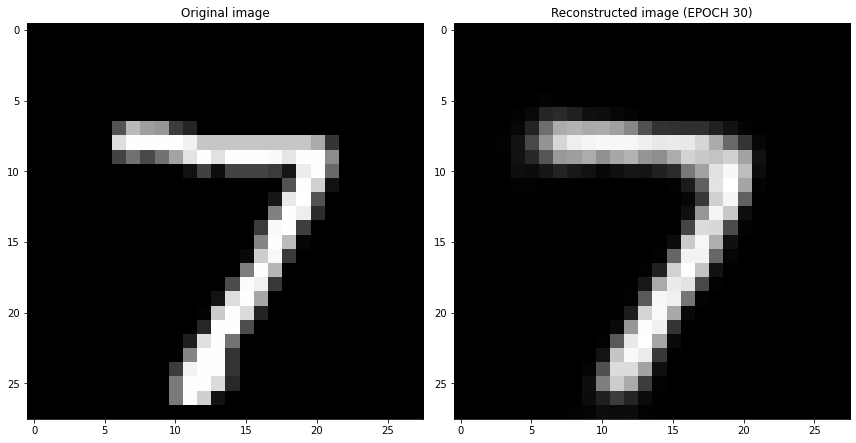

Cross validation fold number= 5/6
EPOCH 1/30
	 partial train loss (single batch): 0.242615
	 partial train loss (single batch): 0.238661
	 partial train loss (single batch): 0.232555
	 partial train loss (single batch): 0.224838
	 partial train loss (single batch): 0.211482
	 partial train loss (single batch): 0.186874
	 partial train loss (single batch): 0.154105
	 partial train loss (single batch): 0.121111
	 partial train loss (single batch): 0.111055
	 partial train loss (single batch): 0.111657
	 partial train loss (single batch): 0.108669
	 partial train loss (single batch): 0.114238
	 partial train loss (single batch): 0.110483
	 partial train loss (single batch): 0.108041
	 partial train loss (single batch): 0.113414
	 partial train loss (single batch): 0.107003
	 partial train loss (single batch): 0.112618
	 partial train loss (single batch): 0.112760
	 partial train loss (single batch): 0.111317
	 partial train loss (single batch): 0.112816
	 partial train loss (single batch)

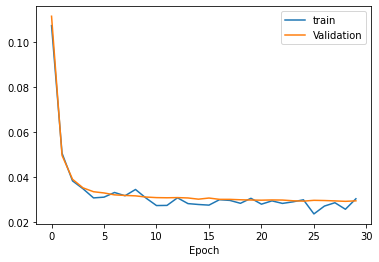

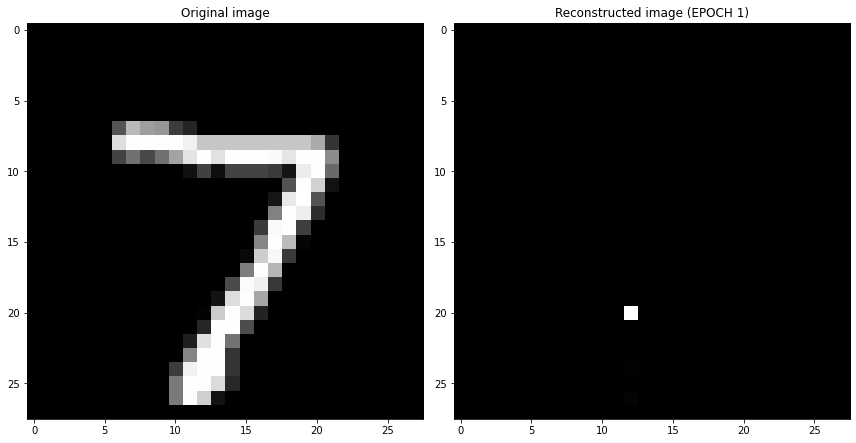

EPOCH 2/30
	 partial train loss (single batch): 0.111858
	 partial train loss (single batch): 0.112251
	 partial train loss (single batch): 0.111365
	 partial train loss (single batch): 0.112553
	 partial train loss (single batch): 0.115624
	 partial train loss (single batch): 0.112157
	 partial train loss (single batch): 0.112956
	 partial train loss (single batch): 0.115254
	 partial train loss (single batch): 0.113925
	 partial train loss (single batch): 0.114019
	 partial train loss (single batch): 0.113920
	 partial train loss (single batch): 0.110817
	 partial train loss (single batch): 0.107642
	 partial train loss (single batch): 0.115486
	 partial train loss (single batch): 0.111004
	 partial train loss (single batch): 0.113880
	 partial train loss (single batch): 0.111807
	 partial train loss (single batch): 0.107854
	 partial train loss (single batch): 0.111722
	 partial train loss (single batch): 0.110923
	 partial train loss (single batch): 0.112634
	 partial train loss (s

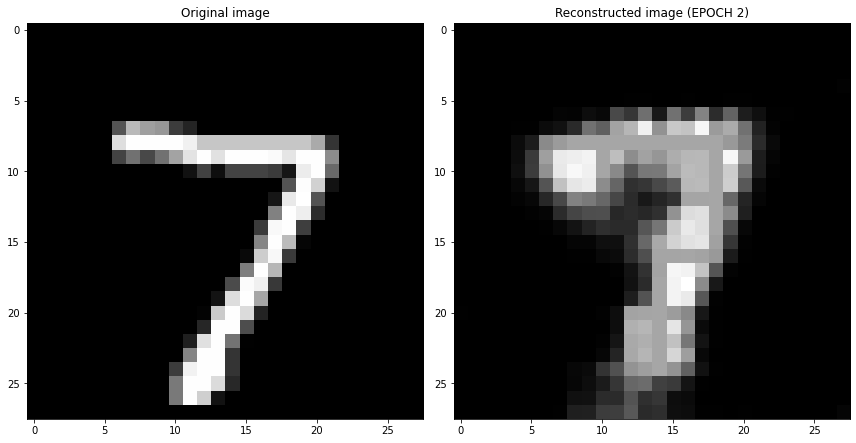

EPOCH 3/30
	 partial train loss (single batch): 0.045857
	 partial train loss (single batch): 0.045853
	 partial train loss (single batch): 0.047488
	 partial train loss (single batch): 0.046492
	 partial train loss (single batch): 0.044927
	 partial train loss (single batch): 0.046399
	 partial train loss (single batch): 0.044765
	 partial train loss (single batch): 0.046167
	 partial train loss (single batch): 0.045209
	 partial train loss (single batch): 0.047096
	 partial train loss (single batch): 0.045437
	 partial train loss (single batch): 0.044428
	 partial train loss (single batch): 0.043316
	 partial train loss (single batch): 0.045080
	 partial train loss (single batch): 0.045977
	 partial train loss (single batch): 0.044675
	 partial train loss (single batch): 0.044706
	 partial train loss (single batch): 0.044882
	 partial train loss (single batch): 0.044386
	 partial train loss (single batch): 0.044062
	 partial train loss (single batch): 0.044172
	 partial train loss (s

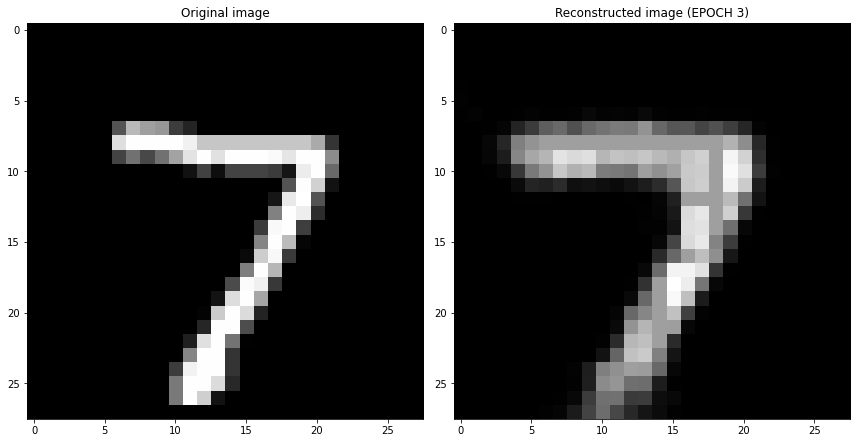

EPOCH 4/30
	 partial train loss (single batch): 0.037007
	 partial train loss (single batch): 0.036167
	 partial train loss (single batch): 0.038320
	 partial train loss (single batch): 0.037989
	 partial train loss (single batch): 0.036907
	 partial train loss (single batch): 0.036485
	 partial train loss (single batch): 0.036299
	 partial train loss (single batch): 0.038390
	 partial train loss (single batch): 0.038022
	 partial train loss (single batch): 0.036733
	 partial train loss (single batch): 0.036995
	 partial train loss (single batch): 0.037172
	 partial train loss (single batch): 0.037467
	 partial train loss (single batch): 0.038811
	 partial train loss (single batch): 0.036291
	 partial train loss (single batch): 0.038262
	 partial train loss (single batch): 0.036430
	 partial train loss (single batch): 0.037700
	 partial train loss (single batch): 0.035812
	 partial train loss (single batch): 0.036480
	 partial train loss (single batch): 0.036951
	 partial train loss (s

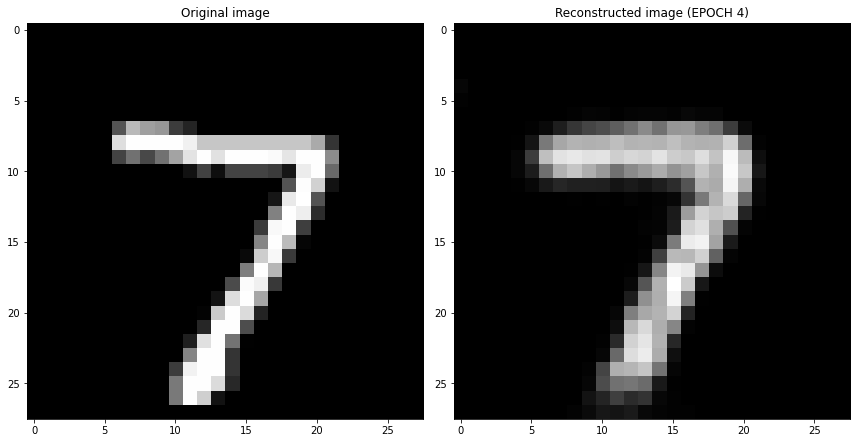

EPOCH 5/30
	 partial train loss (single batch): 0.033966
	 partial train loss (single batch): 0.035207
	 partial train loss (single batch): 0.033248
	 partial train loss (single batch): 0.033619
	 partial train loss (single batch): 0.031846
	 partial train loss (single batch): 0.034077
	 partial train loss (single batch): 0.034092
	 partial train loss (single batch): 0.032362
	 partial train loss (single batch): 0.034250
	 partial train loss (single batch): 0.035235
	 partial train loss (single batch): 0.034017
	 partial train loss (single batch): 0.033186
	 partial train loss (single batch): 0.032690
	 partial train loss (single batch): 0.032883
	 partial train loss (single batch): 0.035318
	 partial train loss (single batch): 0.033298
	 partial train loss (single batch): 0.032816
	 partial train loss (single batch): 0.032914
	 partial train loss (single batch): 0.034377
	 partial train loss (single batch): 0.033715
	 partial train loss (single batch): 0.035072
	 partial train loss (s

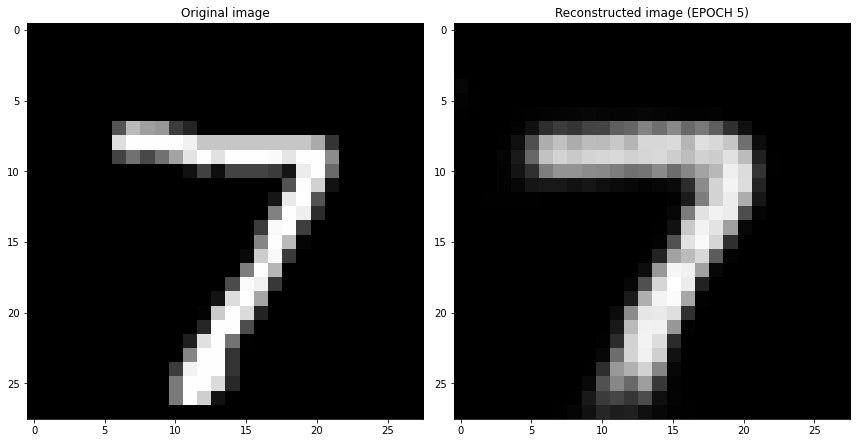

EPOCH 6/30
	 partial train loss (single batch): 0.032479
	 partial train loss (single batch): 0.033533
	 partial train loss (single batch): 0.031379
	 partial train loss (single batch): 0.033266
	 partial train loss (single batch): 0.033437
	 partial train loss (single batch): 0.033757
	 partial train loss (single batch): 0.031034
	 partial train loss (single batch): 0.033595
	 partial train loss (single batch): 0.033486
	 partial train loss (single batch): 0.031740
	 partial train loss (single batch): 0.033050
	 partial train loss (single batch): 0.031247
	 partial train loss (single batch): 0.032569
	 partial train loss (single batch): 0.034126
	 partial train loss (single batch): 0.032699
	 partial train loss (single batch): 0.032194
	 partial train loss (single batch): 0.034091
	 partial train loss (single batch): 0.032793
	 partial train loss (single batch): 0.031921
	 partial train loss (single batch): 0.031807
	 partial train loss (single batch): 0.032284
	 partial train loss (s

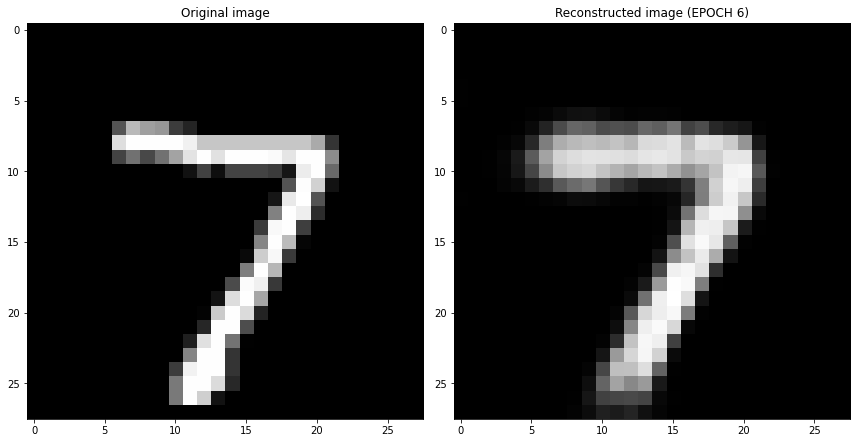

EPOCH 7/30
	 partial train loss (single batch): 0.032538
	 partial train loss (single batch): 0.030724
	 partial train loss (single batch): 0.031011
	 partial train loss (single batch): 0.033099
	 partial train loss (single batch): 0.031688
	 partial train loss (single batch): 0.029839
	 partial train loss (single batch): 0.032024
	 partial train loss (single batch): 0.030784
	 partial train loss (single batch): 0.032616
	 partial train loss (single batch): 0.032911
	 partial train loss (single batch): 0.032031
	 partial train loss (single batch): 0.032727
	 partial train loss (single batch): 0.031259
	 partial train loss (single batch): 0.030052
	 partial train loss (single batch): 0.031939
	 partial train loss (single batch): 0.030763
	 partial train loss (single batch): 0.032721
	 partial train loss (single batch): 0.030755
	 partial train loss (single batch): 0.033698
	 partial train loss (single batch): 0.032216
	 partial train loss (single batch): 0.030266
	 partial train loss (s

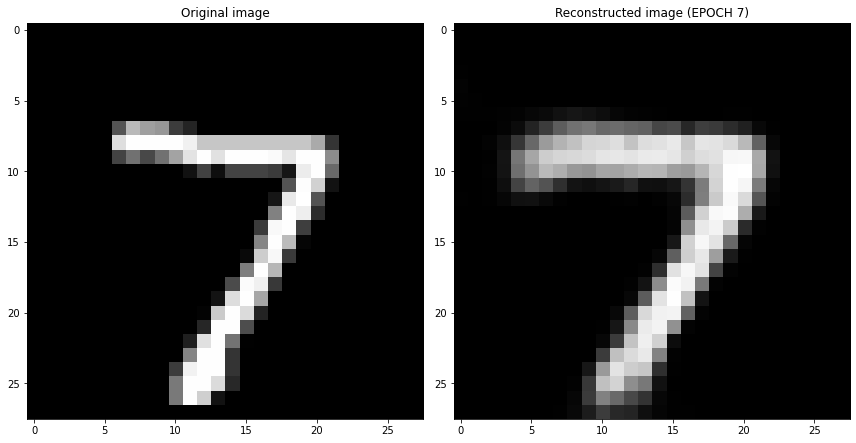

EPOCH 8/30
	 partial train loss (single batch): 0.031150
	 partial train loss (single batch): 0.030865
	 partial train loss (single batch): 0.029821
	 partial train loss (single batch): 0.030092
	 partial train loss (single batch): 0.031920
	 partial train loss (single batch): 0.033336
	 partial train loss (single batch): 0.030720
	 partial train loss (single batch): 0.030193
	 partial train loss (single batch): 0.031926
	 partial train loss (single batch): 0.030883
	 partial train loss (single batch): 0.032974
	 partial train loss (single batch): 0.030526
	 partial train loss (single batch): 0.030526
	 partial train loss (single batch): 0.030489
	 partial train loss (single batch): 0.029724
	 partial train loss (single batch): 0.029580
	 partial train loss (single batch): 0.030140
	 partial train loss (single batch): 0.030888
	 partial train loss (single batch): 0.030301
	 partial train loss (single batch): 0.032347
	 partial train loss (single batch): 0.030749
	 partial train loss (s

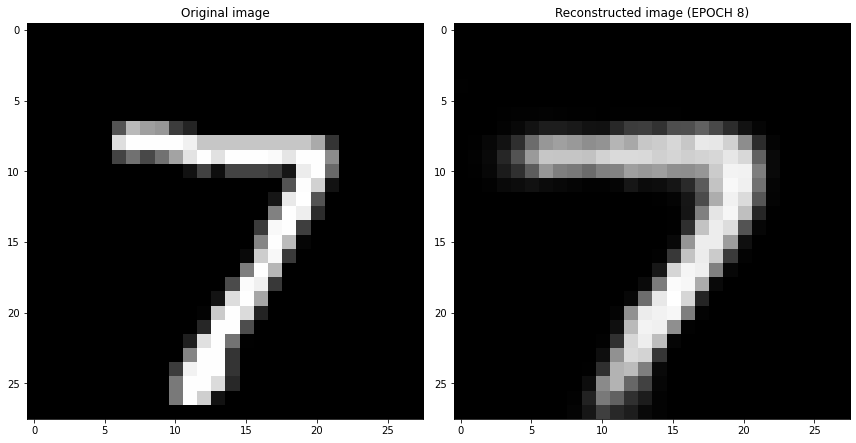

EPOCH 9/30
	 partial train loss (single batch): 0.031645
	 partial train loss (single batch): 0.028839
	 partial train loss (single batch): 0.031619
	 partial train loss (single batch): 0.031770
	 partial train loss (single batch): 0.032155
	 partial train loss (single batch): 0.031130
	 partial train loss (single batch): 0.029762
	 partial train loss (single batch): 0.032551
	 partial train loss (single batch): 0.030672
	 partial train loss (single batch): 0.031997
	 partial train loss (single batch): 0.032525
	 partial train loss (single batch): 0.032198
	 partial train loss (single batch): 0.030895
	 partial train loss (single batch): 0.030647
	 partial train loss (single batch): 0.032100
	 partial train loss (single batch): 0.032234
	 partial train loss (single batch): 0.030770
	 partial train loss (single batch): 0.031553
	 partial train loss (single batch): 0.031105
	 partial train loss (single batch): 0.029458
	 partial train loss (single batch): 0.032856
	 partial train loss (s

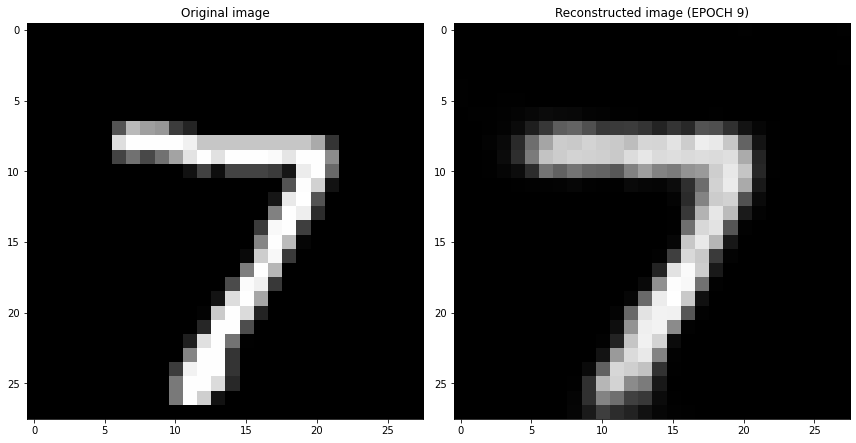

EPOCH 10/30
	 partial train loss (single batch): 0.032079
	 partial train loss (single batch): 0.030893
	 partial train loss (single batch): 0.030820
	 partial train loss (single batch): 0.030047
	 partial train loss (single batch): 0.029682
	 partial train loss (single batch): 0.031533
	 partial train loss (single batch): 0.033093
	 partial train loss (single batch): 0.030909
	 partial train loss (single batch): 0.032212
	 partial train loss (single batch): 0.030705
	 partial train loss (single batch): 0.032940
	 partial train loss (single batch): 0.031910
	 partial train loss (single batch): 0.030759
	 partial train loss (single batch): 0.029721
	 partial train loss (single batch): 0.031376
	 partial train loss (single batch): 0.028632
	 partial train loss (single batch): 0.030622
	 partial train loss (single batch): 0.029715
	 partial train loss (single batch): 0.030999
	 partial train loss (single batch): 0.030848
	 partial train loss (single batch): 0.030280
	 partial train loss (

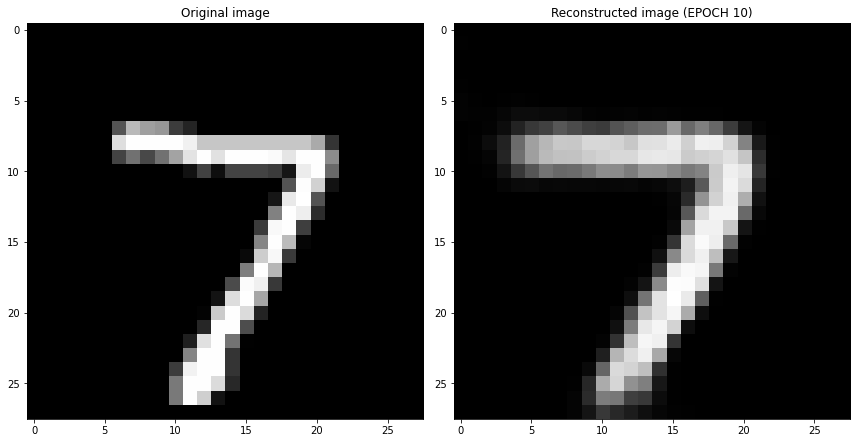

EPOCH 11/30
	 partial train loss (single batch): 0.030444
	 partial train loss (single batch): 0.030430
	 partial train loss (single batch): 0.031896
	 partial train loss (single batch): 0.030338
	 partial train loss (single batch): 0.029056
	 partial train loss (single batch): 0.030637
	 partial train loss (single batch): 0.031166
	 partial train loss (single batch): 0.029754
	 partial train loss (single batch): 0.028676
	 partial train loss (single batch): 0.030483
	 partial train loss (single batch): 0.028952
	 partial train loss (single batch): 0.031605
	 partial train loss (single batch): 0.030194
	 partial train loss (single batch): 0.029660
	 partial train loss (single batch): 0.032075
	 partial train loss (single batch): 0.028459
	 partial train loss (single batch): 0.033501
	 partial train loss (single batch): 0.029813
	 partial train loss (single batch): 0.031371
	 partial train loss (single batch): 0.026888
	 partial train loss (single batch): 0.030077
	 partial train loss (

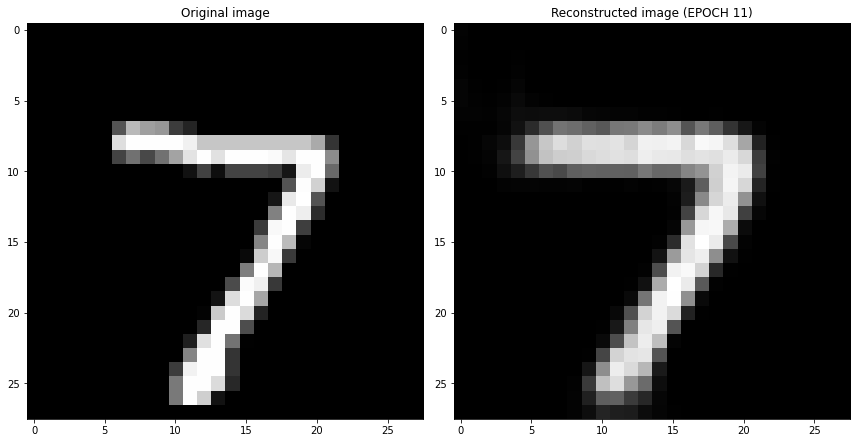

EPOCH 12/30
	 partial train loss (single batch): 0.029759
	 partial train loss (single batch): 0.031175
	 partial train loss (single batch): 0.029404
	 partial train loss (single batch): 0.029102
	 partial train loss (single batch): 0.030166
	 partial train loss (single batch): 0.029104
	 partial train loss (single batch): 0.030985
	 partial train loss (single batch): 0.030380
	 partial train loss (single batch): 0.029990
	 partial train loss (single batch): 0.029412
	 partial train loss (single batch): 0.030432
	 partial train loss (single batch): 0.033155
	 partial train loss (single batch): 0.028684
	 partial train loss (single batch): 0.030737
	 partial train loss (single batch): 0.030416
	 partial train loss (single batch): 0.030863
	 partial train loss (single batch): 0.029759
	 partial train loss (single batch): 0.029397
	 partial train loss (single batch): 0.030535
	 partial train loss (single batch): 0.030172
	 partial train loss (single batch): 0.030800
	 partial train loss (

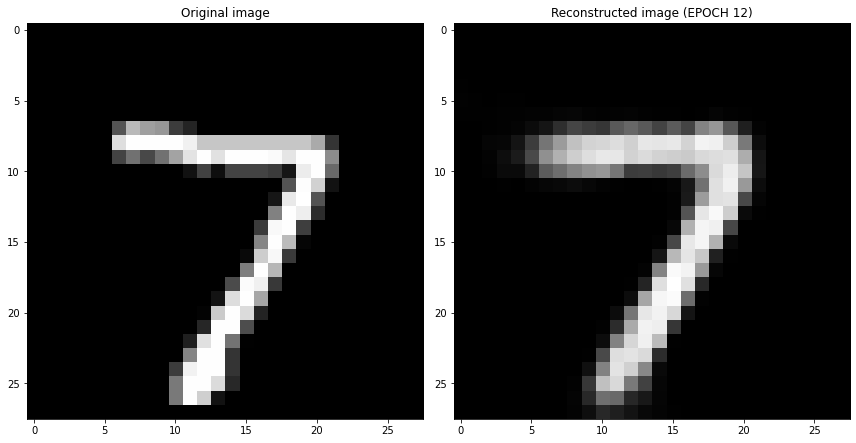

EPOCH 13/30
	 partial train loss (single batch): 0.029941
	 partial train loss (single batch): 0.030286
	 partial train loss (single batch): 0.030404
	 partial train loss (single batch): 0.032286
	 partial train loss (single batch): 0.029621
	 partial train loss (single batch): 0.030329
	 partial train loss (single batch): 0.031721
	 partial train loss (single batch): 0.032095
	 partial train loss (single batch): 0.031026
	 partial train loss (single batch): 0.030897
	 partial train loss (single batch): 0.030641
	 partial train loss (single batch): 0.029105
	 partial train loss (single batch): 0.030250
	 partial train loss (single batch): 0.029455
	 partial train loss (single batch): 0.031214
	 partial train loss (single batch): 0.028969
	 partial train loss (single batch): 0.029559
	 partial train loss (single batch): 0.029762
	 partial train loss (single batch): 0.027525
	 partial train loss (single batch): 0.029939
	 partial train loss (single batch): 0.030623
	 partial train loss (

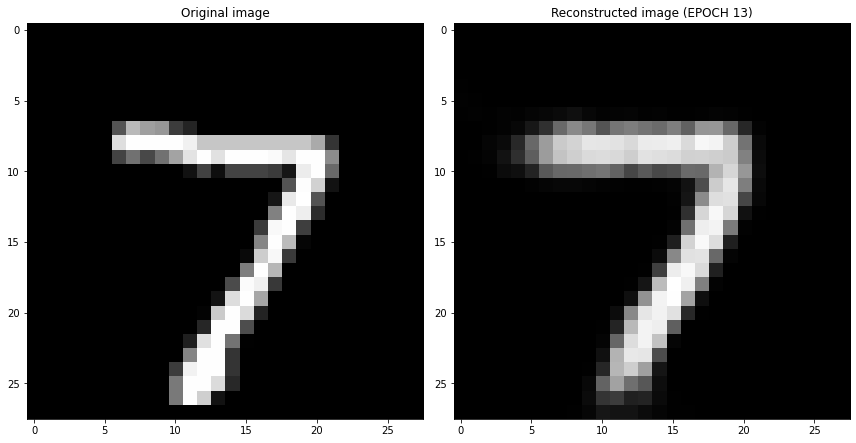

EPOCH 14/30
	 partial train loss (single batch): 0.030281
	 partial train loss (single batch): 0.028734
	 partial train loss (single batch): 0.031132
	 partial train loss (single batch): 0.029637
	 partial train loss (single batch): 0.030036
	 partial train loss (single batch): 0.028119
	 partial train loss (single batch): 0.030749
	 partial train loss (single batch): 0.031379
	 partial train loss (single batch): 0.029003
	 partial train loss (single batch): 0.030161
	 partial train loss (single batch): 0.030917
	 partial train loss (single batch): 0.028480
	 partial train loss (single batch): 0.030560
	 partial train loss (single batch): 0.029487
	 partial train loss (single batch): 0.030595
	 partial train loss (single batch): 0.027264
	 partial train loss (single batch): 0.030325
	 partial train loss (single batch): 0.029772
	 partial train loss (single batch): 0.030722
	 partial train loss (single batch): 0.028887
	 partial train loss (single batch): 0.031356
	 partial train loss (

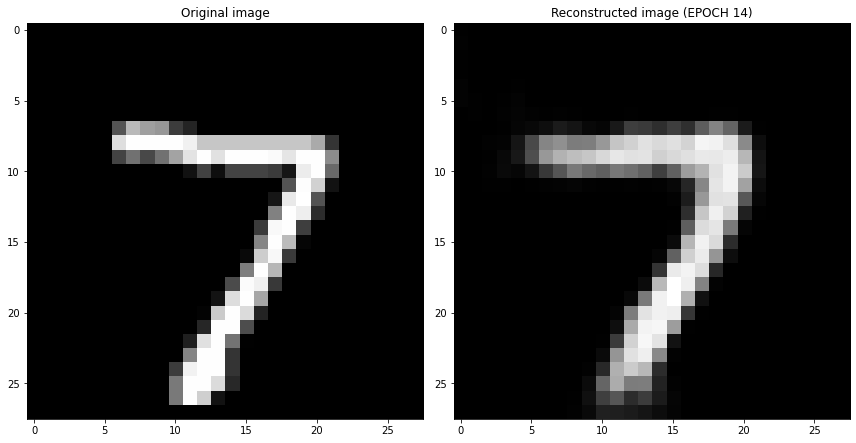

EPOCH 15/30
	 partial train loss (single batch): 0.030902
	 partial train loss (single batch): 0.031295
	 partial train loss (single batch): 0.029831
	 partial train loss (single batch): 0.029921
	 partial train loss (single batch): 0.030315
	 partial train loss (single batch): 0.029927
	 partial train loss (single batch): 0.031463
	 partial train loss (single batch): 0.031078
	 partial train loss (single batch): 0.029421
	 partial train loss (single batch): 0.029587
	 partial train loss (single batch): 0.029203
	 partial train loss (single batch): 0.030437
	 partial train loss (single batch): 0.030484
	 partial train loss (single batch): 0.029839
	 partial train loss (single batch): 0.028769
	 partial train loss (single batch): 0.029083
	 partial train loss (single batch): 0.028479
	 partial train loss (single batch): 0.030805
	 partial train loss (single batch): 0.029800
	 partial train loss (single batch): 0.029021
	 partial train loss (single batch): 0.029495
	 partial train loss (

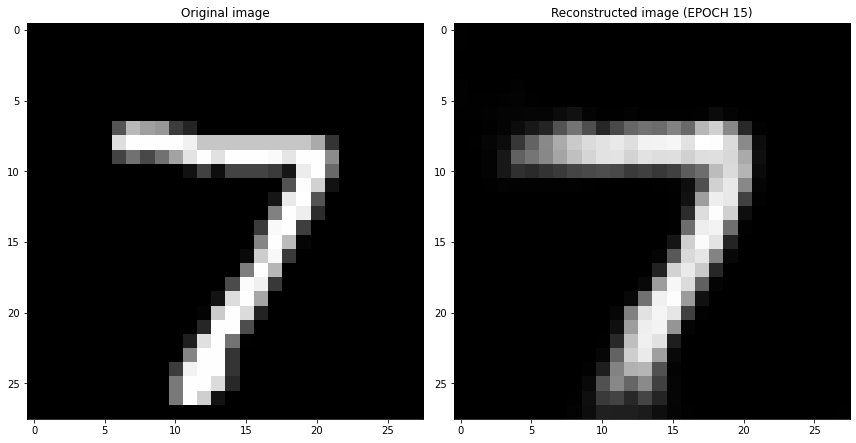

EPOCH 16/30
	 partial train loss (single batch): 0.030352
	 partial train loss (single batch): 0.027715
	 partial train loss (single batch): 0.028947
	 partial train loss (single batch): 0.030866
	 partial train loss (single batch): 0.029315
	 partial train loss (single batch): 0.029227
	 partial train loss (single batch): 0.029600
	 partial train loss (single batch): 0.029752
	 partial train loss (single batch): 0.029390
	 partial train loss (single batch): 0.028642
	 partial train loss (single batch): 0.029726
	 partial train loss (single batch): 0.029845
	 partial train loss (single batch): 0.029477
	 partial train loss (single batch): 0.030970
	 partial train loss (single batch): 0.030407
	 partial train loss (single batch): 0.031163
	 partial train loss (single batch): 0.029309
	 partial train loss (single batch): 0.030324
	 partial train loss (single batch): 0.027847
	 partial train loss (single batch): 0.028482
	 partial train loss (single batch): 0.030944
	 partial train loss (

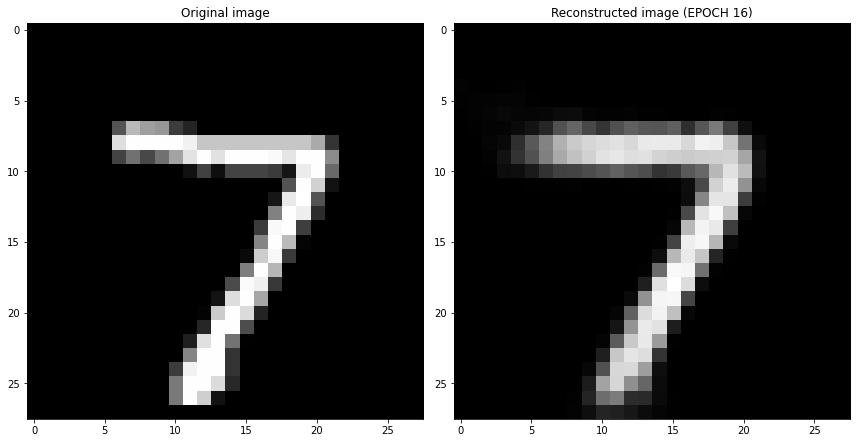

EPOCH 17/30
	 partial train loss (single batch): 0.028602
	 partial train loss (single batch): 0.029365
	 partial train loss (single batch): 0.029308
	 partial train loss (single batch): 0.029540
	 partial train loss (single batch): 0.029420
	 partial train loss (single batch): 0.029131
	 partial train loss (single batch): 0.030877
	 partial train loss (single batch): 0.029350
	 partial train loss (single batch): 0.030337
	 partial train loss (single batch): 0.027967
	 partial train loss (single batch): 0.031879
	 partial train loss (single batch): 0.029047
	 partial train loss (single batch): 0.028501
	 partial train loss (single batch): 0.030856
	 partial train loss (single batch): 0.030144
	 partial train loss (single batch): 0.031372
	 partial train loss (single batch): 0.029718
	 partial train loss (single batch): 0.028742
	 partial train loss (single batch): 0.029705
	 partial train loss (single batch): 0.029133
	 partial train loss (single batch): 0.029781
	 partial train loss (

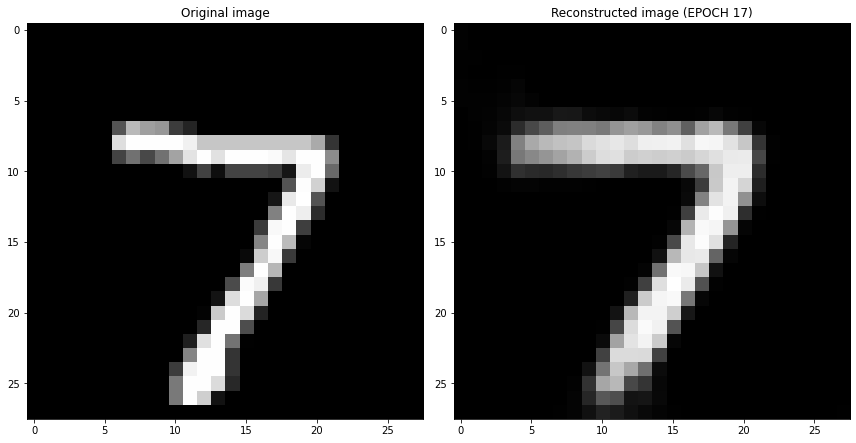

EPOCH 18/30
	 partial train loss (single batch): 0.028937
	 partial train loss (single batch): 0.030738
	 partial train loss (single batch): 0.030738
	 partial train loss (single batch): 0.029079
	 partial train loss (single batch): 0.030898
	 partial train loss (single batch): 0.030489
	 partial train loss (single batch): 0.027829
	 partial train loss (single batch): 0.029821
	 partial train loss (single batch): 0.029672
	 partial train loss (single batch): 0.029377
	 partial train loss (single batch): 0.031079
	 partial train loss (single batch): 0.030830
	 partial train loss (single batch): 0.031527
	 partial train loss (single batch): 0.030364
	 partial train loss (single batch): 0.027904
	 partial train loss (single batch): 0.029876
	 partial train loss (single batch): 0.029734
	 partial train loss (single batch): 0.029737
	 partial train loss (single batch): 0.028587
	 partial train loss (single batch): 0.029876
	 partial train loss (single batch): 0.030148
	 partial train loss (

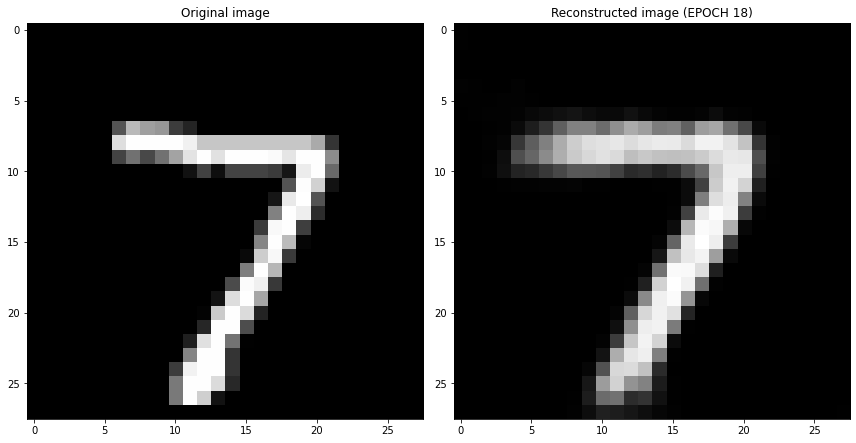

EPOCH 19/30
	 partial train loss (single batch): 0.030477
	 partial train loss (single batch): 0.029383
	 partial train loss (single batch): 0.030069
	 partial train loss (single batch): 0.028717
	 partial train loss (single batch): 0.029650
	 partial train loss (single batch): 0.030751
	 partial train loss (single batch): 0.030225
	 partial train loss (single batch): 0.029641
	 partial train loss (single batch): 0.029305
	 partial train loss (single batch): 0.029671
	 partial train loss (single batch): 0.030282
	 partial train loss (single batch): 0.027850
	 partial train loss (single batch): 0.028780
	 partial train loss (single batch): 0.029810
	 partial train loss (single batch): 0.029693
	 partial train loss (single batch): 0.029529
	 partial train loss (single batch): 0.030542
	 partial train loss (single batch): 0.027294
	 partial train loss (single batch): 0.029640
	 partial train loss (single batch): 0.028389
	 partial train loss (single batch): 0.029343
	 partial train loss (

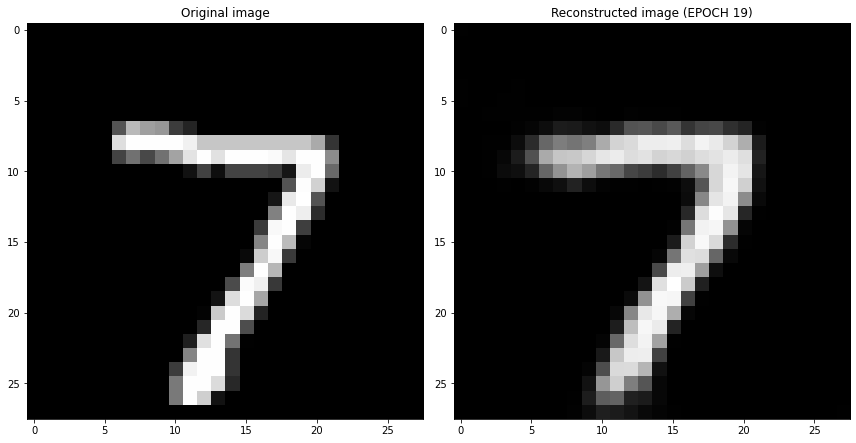

EPOCH 20/30
	 partial train loss (single batch): 0.031502
	 partial train loss (single batch): 0.031608
	 partial train loss (single batch): 0.029772
	 partial train loss (single batch): 0.029790
	 partial train loss (single batch): 0.029133
	 partial train loss (single batch): 0.029714
	 partial train loss (single batch): 0.028596
	 partial train loss (single batch): 0.029768
	 partial train loss (single batch): 0.029478
	 partial train loss (single batch): 0.027632
	 partial train loss (single batch): 0.029990
	 partial train loss (single batch): 0.030175
	 partial train loss (single batch): 0.029608
	 partial train loss (single batch): 0.029247
	 partial train loss (single batch): 0.031039
	 partial train loss (single batch): 0.027980
	 partial train loss (single batch): 0.029310
	 partial train loss (single batch): 0.029190
	 partial train loss (single batch): 0.028460
	 partial train loss (single batch): 0.029687
	 partial train loss (single batch): 0.030276
	 partial train loss (

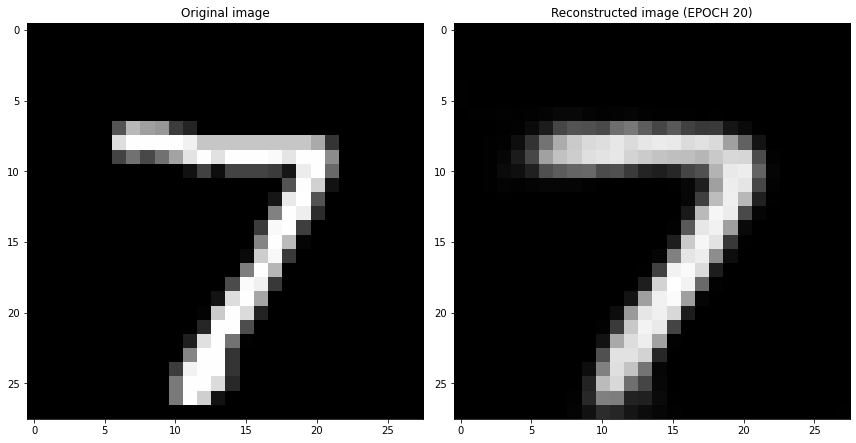

EPOCH 21/30
	 partial train loss (single batch): 0.028878
	 partial train loss (single batch): 0.030083
	 partial train loss (single batch): 0.030719
	 partial train loss (single batch): 0.030801
	 partial train loss (single batch): 0.029865
	 partial train loss (single batch): 0.030451
	 partial train loss (single batch): 0.027838
	 partial train loss (single batch): 0.029282
	 partial train loss (single batch): 0.029943
	 partial train loss (single batch): 0.030000
	 partial train loss (single batch): 0.028731
	 partial train loss (single batch): 0.030167
	 partial train loss (single batch): 0.029062
	 partial train loss (single batch): 0.030563
	 partial train loss (single batch): 0.028517
	 partial train loss (single batch): 0.029078
	 partial train loss (single batch): 0.029018
	 partial train loss (single batch): 0.028284
	 partial train loss (single batch): 0.027188
	 partial train loss (single batch): 0.029887
	 partial train loss (single batch): 0.029281
	 partial train loss (

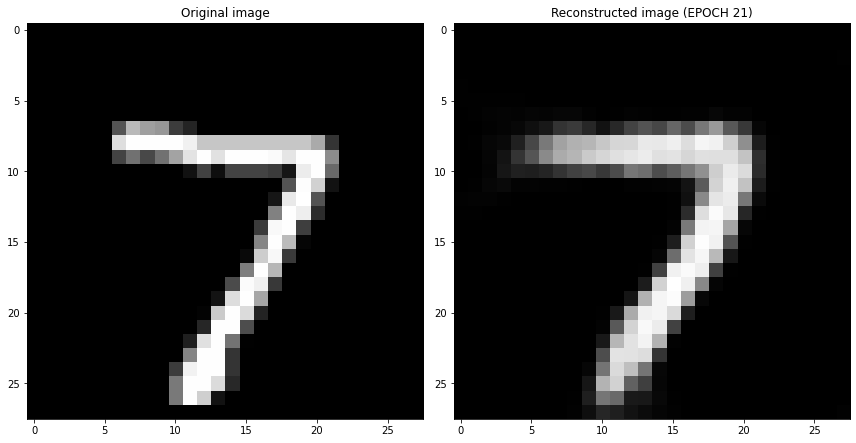

EPOCH 22/30
	 partial train loss (single batch): 0.029456
	 partial train loss (single batch): 0.028715
	 partial train loss (single batch): 0.030586
	 partial train loss (single batch): 0.028308
	 partial train loss (single batch): 0.028244
	 partial train loss (single batch): 0.030177
	 partial train loss (single batch): 0.027799
	 partial train loss (single batch): 0.029124
	 partial train loss (single batch): 0.028469
	 partial train loss (single batch): 0.029320
	 partial train loss (single batch): 0.029818
	 partial train loss (single batch): 0.029914
	 partial train loss (single batch): 0.030096
	 partial train loss (single batch): 0.029281
	 partial train loss (single batch): 0.027432
	 partial train loss (single batch): 0.029950
	 partial train loss (single batch): 0.029067
	 partial train loss (single batch): 0.028985
	 partial train loss (single batch): 0.028838
	 partial train loss (single batch): 0.028549
	 partial train loss (single batch): 0.030695
	 partial train loss (

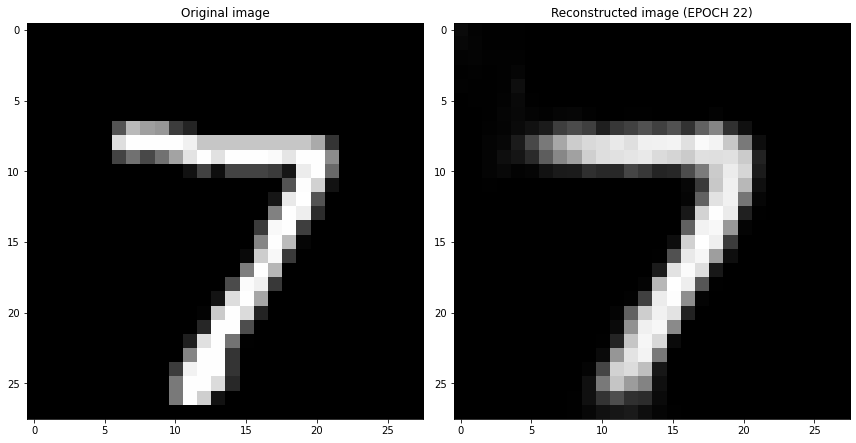

EPOCH 23/30
	 partial train loss (single batch): 0.028393
	 partial train loss (single batch): 0.029752
	 partial train loss (single batch): 0.029629
	 partial train loss (single batch): 0.029275
	 partial train loss (single batch): 0.030626
	 partial train loss (single batch): 0.027971
	 partial train loss (single batch): 0.029083
	 partial train loss (single batch): 0.029686
	 partial train loss (single batch): 0.031073
	 partial train loss (single batch): 0.029554
	 partial train loss (single batch): 0.029922
	 partial train loss (single batch): 0.029884
	 partial train loss (single batch): 0.031436
	 partial train loss (single batch): 0.029529
	 partial train loss (single batch): 0.029373
	 partial train loss (single batch): 0.028887
	 partial train loss (single batch): 0.029766
	 partial train loss (single batch): 0.030117
	 partial train loss (single batch): 0.028760
	 partial train loss (single batch): 0.029197
	 partial train loss (single batch): 0.028829
	 partial train loss (

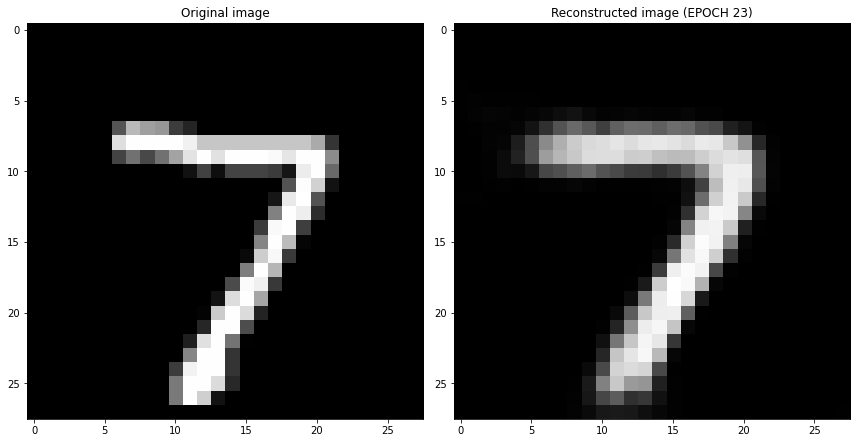

EPOCH 24/30
	 partial train loss (single batch): 0.028640
	 partial train loss (single batch): 0.029990
	 partial train loss (single batch): 0.030063
	 partial train loss (single batch): 0.029694
	 partial train loss (single batch): 0.028672
	 partial train loss (single batch): 0.028724
	 partial train loss (single batch): 0.028555
	 partial train loss (single batch): 0.030284
	 partial train loss (single batch): 0.030083
	 partial train loss (single batch): 0.029151
	 partial train loss (single batch): 0.027615
	 partial train loss (single batch): 0.030533
	 partial train loss (single batch): 0.027617
	 partial train loss (single batch): 0.029048
	 partial train loss (single batch): 0.029947
	 partial train loss (single batch): 0.026176
	 partial train loss (single batch): 0.028871
	 partial train loss (single batch): 0.028789
	 partial train loss (single batch): 0.030807
	 partial train loss (single batch): 0.028496
	 partial train loss (single batch): 0.028890
	 partial train loss (

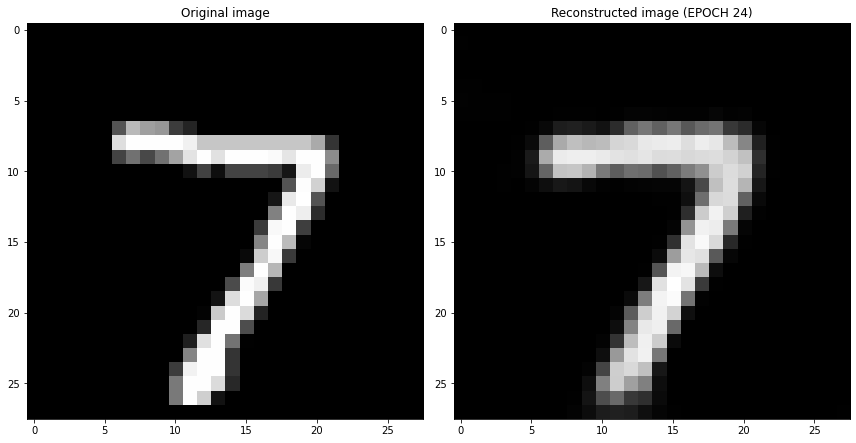

EPOCH 25/30
	 partial train loss (single batch): 0.028713
	 partial train loss (single batch): 0.029479
	 partial train loss (single batch): 0.029778
	 partial train loss (single batch): 0.029754
	 partial train loss (single batch): 0.030179
	 partial train loss (single batch): 0.027726
	 partial train loss (single batch): 0.028972
	 partial train loss (single batch): 0.030072
	 partial train loss (single batch): 0.028674
	 partial train loss (single batch): 0.028601
	 partial train loss (single batch): 0.028716
	 partial train loss (single batch): 0.028560
	 partial train loss (single batch): 0.029107
	 partial train loss (single batch): 0.029966
	 partial train loss (single batch): 0.027764
	 partial train loss (single batch): 0.028522
	 partial train loss (single batch): 0.027860
	 partial train loss (single batch): 0.030080
	 partial train loss (single batch): 0.028157
	 partial train loss (single batch): 0.028728
	 partial train loss (single batch): 0.029355
	 partial train loss (

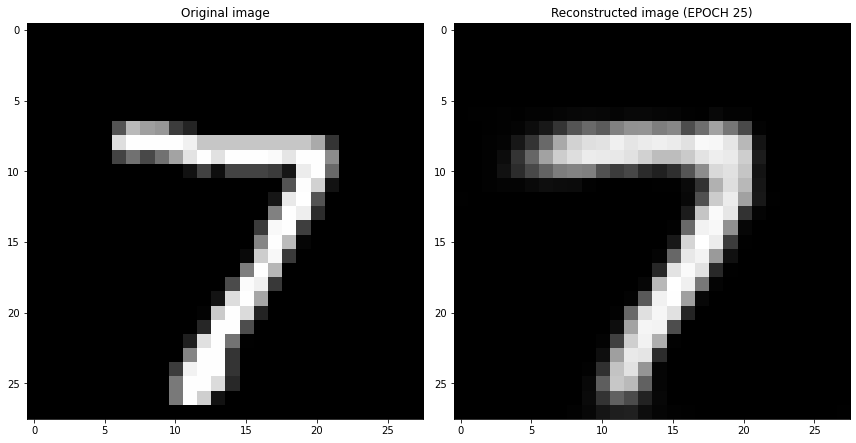

EPOCH 26/30
	 partial train loss (single batch): 0.027937
	 partial train loss (single batch): 0.029776
	 partial train loss (single batch): 0.031107
	 partial train loss (single batch): 0.029837
	 partial train loss (single batch): 0.028219
	 partial train loss (single batch): 0.028620
	 partial train loss (single batch): 0.027591
	 partial train loss (single batch): 0.028954
	 partial train loss (single batch): 0.028916
	 partial train loss (single batch): 0.029395
	 partial train loss (single batch): 0.029447
	 partial train loss (single batch): 0.030063
	 partial train loss (single batch): 0.028362
	 partial train loss (single batch): 0.029838
	 partial train loss (single batch): 0.028794
	 partial train loss (single batch): 0.029370
	 partial train loss (single batch): 0.029508
	 partial train loss (single batch): 0.028559
	 partial train loss (single batch): 0.028527
	 partial train loss (single batch): 0.028834
	 partial train loss (single batch): 0.028510
	 partial train loss (

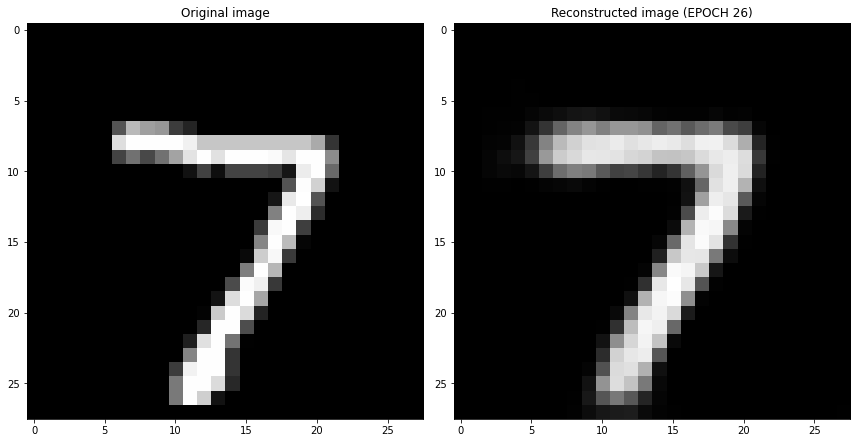

EPOCH 27/30
	 partial train loss (single batch): 0.028006
	 partial train loss (single batch): 0.030731
	 partial train loss (single batch): 0.030227
	 partial train loss (single batch): 0.029625
	 partial train loss (single batch): 0.028547
	 partial train loss (single batch): 0.029923
	 partial train loss (single batch): 0.027545
	 partial train loss (single batch): 0.028914
	 partial train loss (single batch): 0.028960
	 partial train loss (single batch): 0.030415
	 partial train loss (single batch): 0.029580
	 partial train loss (single batch): 0.028207
	 partial train loss (single batch): 0.029362
	 partial train loss (single batch): 0.030628
	 partial train loss (single batch): 0.029453
	 partial train loss (single batch): 0.029025
	 partial train loss (single batch): 0.029240
	 partial train loss (single batch): 0.029021
	 partial train loss (single batch): 0.028320
	 partial train loss (single batch): 0.029261
	 partial train loss (single batch): 0.029230
	 partial train loss (

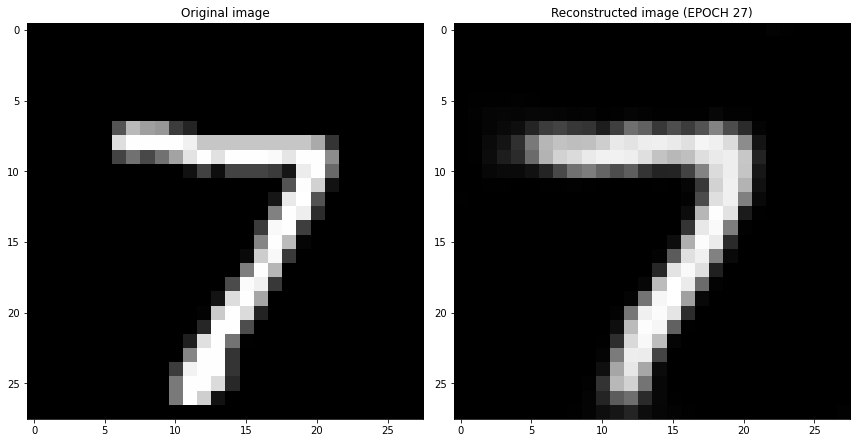

EPOCH 28/30
	 partial train loss (single batch): 0.028308
	 partial train loss (single batch): 0.028664
	 partial train loss (single batch): 0.030057
	 partial train loss (single batch): 0.030283
	 partial train loss (single batch): 0.027854
	 partial train loss (single batch): 0.030313
	 partial train loss (single batch): 0.028595
	 partial train loss (single batch): 0.028861
	 partial train loss (single batch): 0.029053
	 partial train loss (single batch): 0.029597
	 partial train loss (single batch): 0.028095
	 partial train loss (single batch): 0.030157
	 partial train loss (single batch): 0.029606
	 partial train loss (single batch): 0.028943
	 partial train loss (single batch): 0.029838
	 partial train loss (single batch): 0.028058
	 partial train loss (single batch): 0.028800
	 partial train loss (single batch): 0.028609
	 partial train loss (single batch): 0.029002
	 partial train loss (single batch): 0.029378
	 partial train loss (single batch): 0.031605
	 partial train loss (

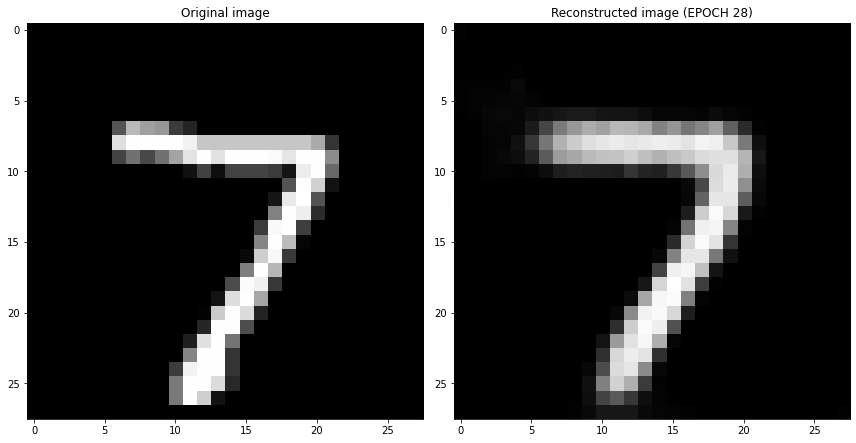

EPOCH 29/30
	 partial train loss (single batch): 0.028338
	 partial train loss (single batch): 0.030049
	 partial train loss (single batch): 0.028233
	 partial train loss (single batch): 0.029526
	 partial train loss (single batch): 0.029393
	 partial train loss (single batch): 0.030198
	 partial train loss (single batch): 0.029056
	 partial train loss (single batch): 0.027400
	 partial train loss (single batch): 0.029014
	 partial train loss (single batch): 0.028594
	 partial train loss (single batch): 0.026843
	 partial train loss (single batch): 0.029124
	 partial train loss (single batch): 0.027368
	 partial train loss (single batch): 0.029249
	 partial train loss (single batch): 0.028574
	 partial train loss (single batch): 0.029723
	 partial train loss (single batch): 0.029181
	 partial train loss (single batch): 0.028709
	 partial train loss (single batch): 0.026733
	 partial train loss (single batch): 0.026672
	 partial train loss (single batch): 0.030998
	 partial train loss (

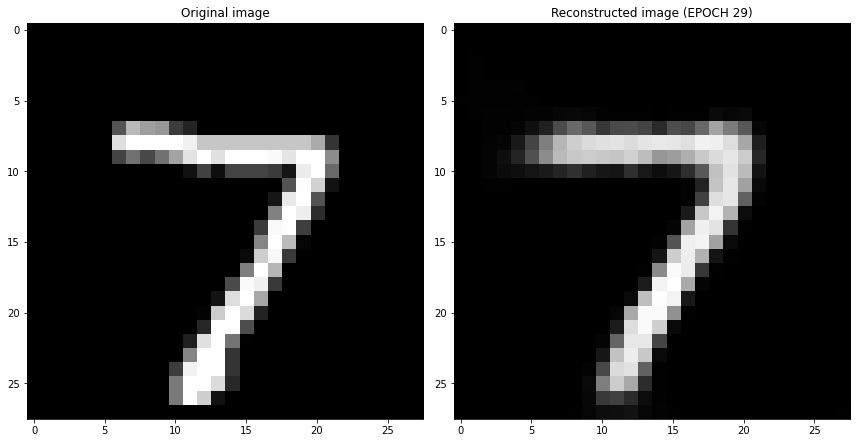

EPOCH 30/30
	 partial train loss (single batch): 0.030983
	 partial train loss (single batch): 0.028917
	 partial train loss (single batch): 0.030662
	 partial train loss (single batch): 0.029406
	 partial train loss (single batch): 0.029857
	 partial train loss (single batch): 0.028514
	 partial train loss (single batch): 0.029386
	 partial train loss (single batch): 0.028992
	 partial train loss (single batch): 0.027845
	 partial train loss (single batch): 0.027466
	 partial train loss (single batch): 0.030355
	 partial train loss (single batch): 0.029588
	 partial train loss (single batch): 0.029604
	 partial train loss (single batch): 0.028108
	 partial train loss (single batch): 0.029318
	 partial train loss (single batch): 0.029224
	 partial train loss (single batch): 0.029668
	 partial train loss (single batch): 0.028401
	 partial train loss (single batch): 0.029107
	 partial train loss (single batch): 0.028816
	 partial train loss (single batch): 0.029407
	 partial train loss (

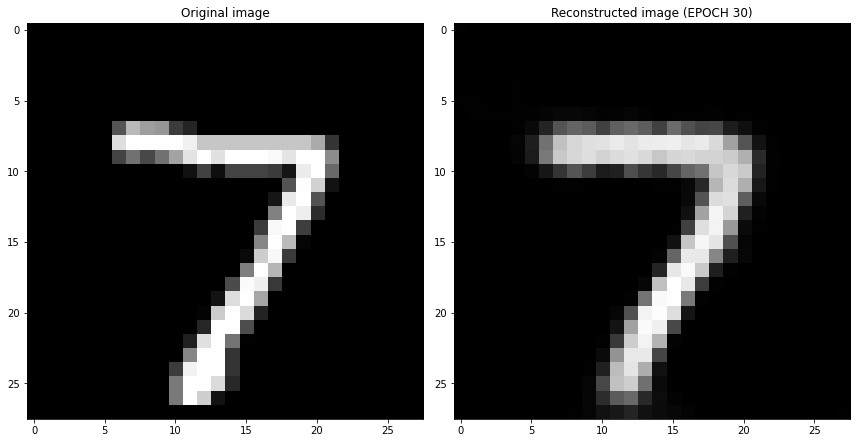

Cross validation fold number= 6/6
EPOCH 1/30
	 partial train loss (single batch): 0.225895
	 partial train loss (single batch): 0.219498
	 partial train loss (single batch): 0.211318
	 partial train loss (single batch): 0.191674
	 partial train loss (single batch): 0.151314
	 partial train loss (single batch): 0.120457
	 partial train loss (single batch): 0.113571
	 partial train loss (single batch): 0.115470
	 partial train loss (single batch): 0.111467
	 partial train loss (single batch): 0.114708
	 partial train loss (single batch): 0.109866
	 partial train loss (single batch): 0.109263
	 partial train loss (single batch): 0.109827
	 partial train loss (single batch): 0.107337
	 partial train loss (single batch): 0.115371
	 partial train loss (single batch): 0.113453
	 partial train loss (single batch): 0.111450
	 partial train loss (single batch): 0.114144
	 partial train loss (single batch): 0.111015
	 partial train loss (single batch): 0.113240
	 partial train loss (single batch)

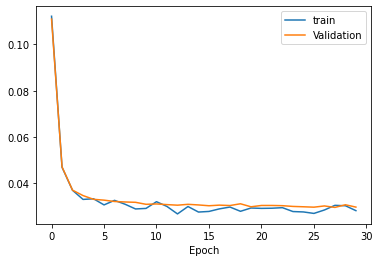

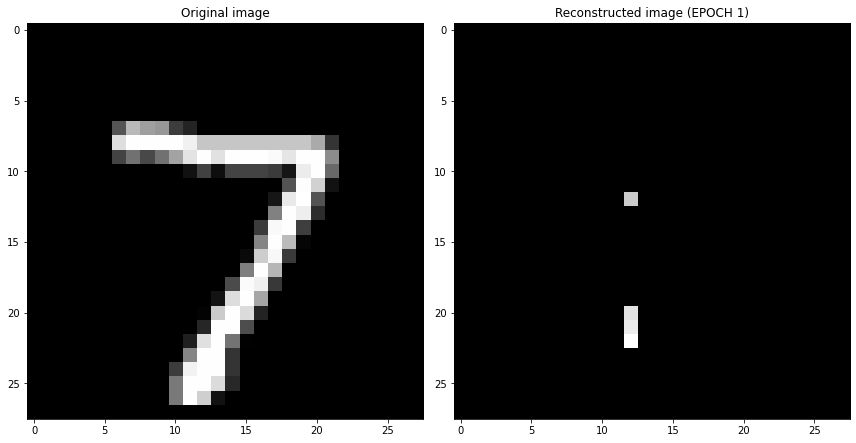

EPOCH 2/30
	 partial train loss (single batch): 0.106337
	 partial train loss (single batch): 0.108333
	 partial train loss (single batch): 0.109381
	 partial train loss (single batch): 0.116476
	 partial train loss (single batch): 0.112183
	 partial train loss (single batch): 0.110912
	 partial train loss (single batch): 0.112112
	 partial train loss (single batch): 0.112456
	 partial train loss (single batch): 0.115445
	 partial train loss (single batch): 0.113387
	 partial train loss (single batch): 0.113541
	 partial train loss (single batch): 0.111766
	 partial train loss (single batch): 0.106325
	 partial train loss (single batch): 0.114019
	 partial train loss (single batch): 0.110192
	 partial train loss (single batch): 0.110654
	 partial train loss (single batch): 0.113950
	 partial train loss (single batch): 0.108484
	 partial train loss (single batch): 0.111795
	 partial train loss (single batch): 0.113864
	 partial train loss (single batch): 0.112367
	 partial train loss (s

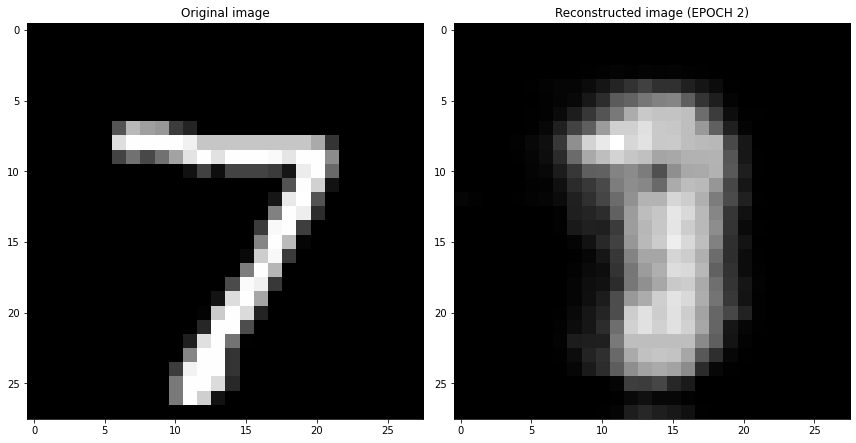

EPOCH 3/30
	 partial train loss (single batch): 0.056900
	 partial train loss (single batch): 0.054864
	 partial train loss (single batch): 0.054291
	 partial train loss (single batch): 0.054345
	 partial train loss (single batch): 0.056139
	 partial train loss (single batch): 0.053207
	 partial train loss (single batch): 0.054465
	 partial train loss (single batch): 0.057553
	 partial train loss (single batch): 0.053762
	 partial train loss (single batch): 0.055667
	 partial train loss (single batch): 0.056594
	 partial train loss (single batch): 0.053497
	 partial train loss (single batch): 0.054467
	 partial train loss (single batch): 0.055902
	 partial train loss (single batch): 0.055426
	 partial train loss (single batch): 0.053641
	 partial train loss (single batch): 0.056805
	 partial train loss (single batch): 0.054967
	 partial train loss (single batch): 0.055706
	 partial train loss (single batch): 0.055307
	 partial train loss (single batch): 0.053294
	 partial train loss (s

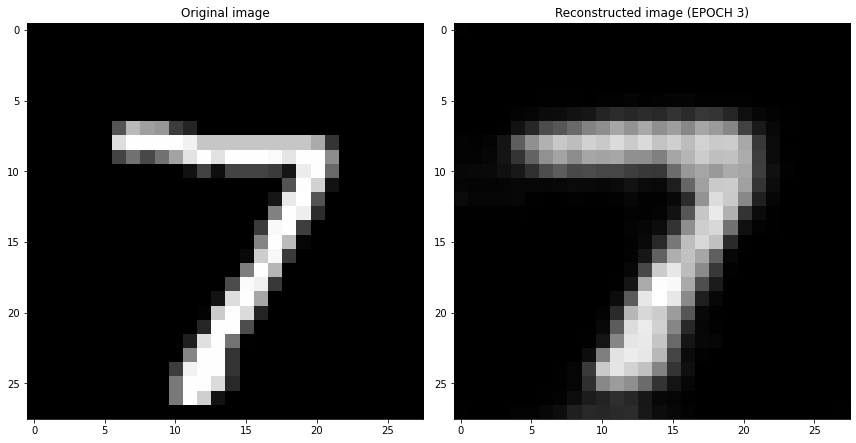

EPOCH 4/30
	 partial train loss (single batch): 0.040282
	 partial train loss (single batch): 0.039913
	 partial train loss (single batch): 0.038910
	 partial train loss (single batch): 0.038158
	 partial train loss (single batch): 0.040472
	 partial train loss (single batch): 0.038990
	 partial train loss (single batch): 0.041590
	 partial train loss (single batch): 0.040609
	 partial train loss (single batch): 0.039906
	 partial train loss (single batch): 0.039887
	 partial train loss (single batch): 0.037084
	 partial train loss (single batch): 0.038157
	 partial train loss (single batch): 0.039455
	 partial train loss (single batch): 0.039276
	 partial train loss (single batch): 0.038396
	 partial train loss (single batch): 0.040752
	 partial train loss (single batch): 0.038901
	 partial train loss (single batch): 0.040133
	 partial train loss (single batch): 0.037424
	 partial train loss (single batch): 0.038974
	 partial train loss (single batch): 0.038585
	 partial train loss (s

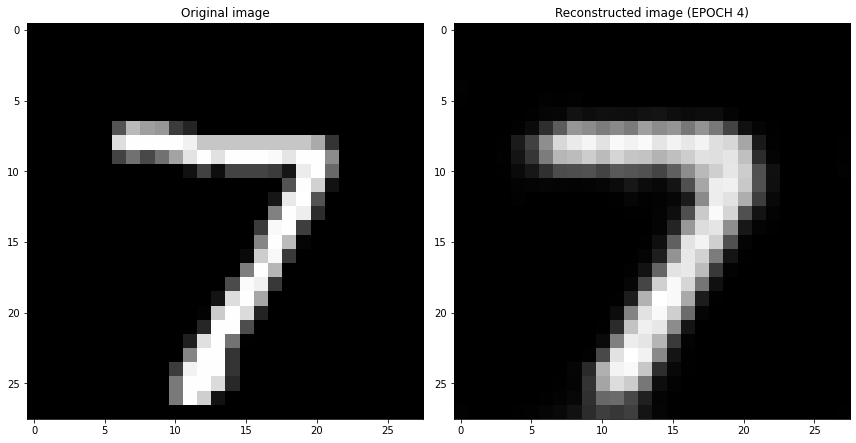

EPOCH 5/30
	 partial train loss (single batch): 0.034539
	 partial train loss (single batch): 0.033886
	 partial train loss (single batch): 0.036424
	 partial train loss (single batch): 0.036226
	 partial train loss (single batch): 0.037022
	 partial train loss (single batch): 0.035818
	 partial train loss (single batch): 0.036017
	 partial train loss (single batch): 0.035623
	 partial train loss (single batch): 0.034304
	 partial train loss (single batch): 0.035667
	 partial train loss (single batch): 0.035357
	 partial train loss (single batch): 0.036783
	 partial train loss (single batch): 0.036507
	 partial train loss (single batch): 0.034160
	 partial train loss (single batch): 0.035732
	 partial train loss (single batch): 0.035992
	 partial train loss (single batch): 0.036567
	 partial train loss (single batch): 0.035318
	 partial train loss (single batch): 0.035008
	 partial train loss (single batch): 0.034656
	 partial train loss (single batch): 0.034513
	 partial train loss (s

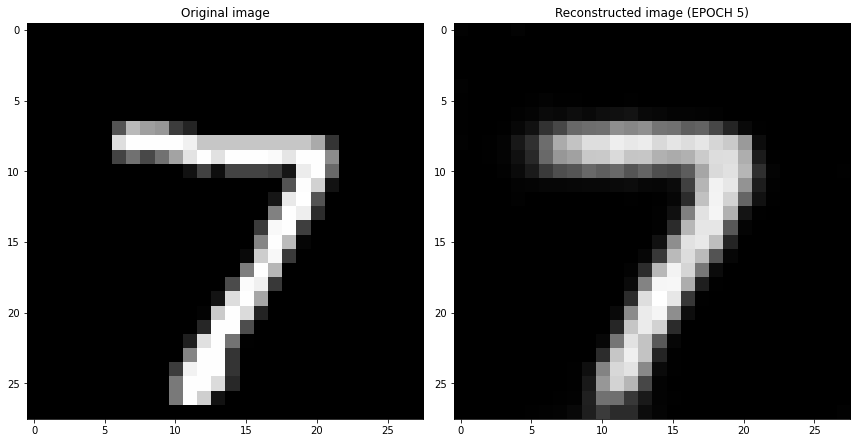

EPOCH 6/30
	 partial train loss (single batch): 0.034483
	 partial train loss (single batch): 0.032734
	 partial train loss (single batch): 0.034130
	 partial train loss (single batch): 0.031605
	 partial train loss (single batch): 0.033491
	 partial train loss (single batch): 0.034644
	 partial train loss (single batch): 0.036487
	 partial train loss (single batch): 0.034056
	 partial train loss (single batch): 0.033168
	 partial train loss (single batch): 0.032257
	 partial train loss (single batch): 0.033179
	 partial train loss (single batch): 0.034831
	 partial train loss (single batch): 0.032704
	 partial train loss (single batch): 0.034023
	 partial train loss (single batch): 0.033936
	 partial train loss (single batch): 0.033358
	 partial train loss (single batch): 0.031219
	 partial train loss (single batch): 0.034294
	 partial train loss (single batch): 0.033753
	 partial train loss (single batch): 0.031707
	 partial train loss (single batch): 0.033876
	 partial train loss (s

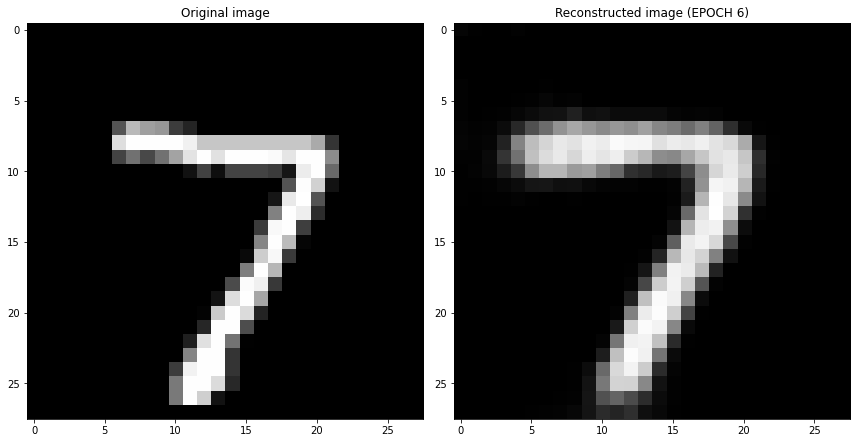

EPOCH 7/30
	 partial train loss (single batch): 0.032324
	 partial train loss (single batch): 0.033964
	 partial train loss (single batch): 0.033683
	 partial train loss (single batch): 0.032038
	 partial train loss (single batch): 0.034400
	 partial train loss (single batch): 0.032095
	 partial train loss (single batch): 0.030367
	 partial train loss (single batch): 0.031662
	 partial train loss (single batch): 0.033540
	 partial train loss (single batch): 0.030716
	 partial train loss (single batch): 0.032098
	 partial train loss (single batch): 0.029966
	 partial train loss (single batch): 0.031975
	 partial train loss (single batch): 0.032623
	 partial train loss (single batch): 0.030922
	 partial train loss (single batch): 0.032535
	 partial train loss (single batch): 0.032636
	 partial train loss (single batch): 0.035458
	 partial train loss (single batch): 0.032873
	 partial train loss (single batch): 0.033989
	 partial train loss (single batch): 0.033324
	 partial train loss (s

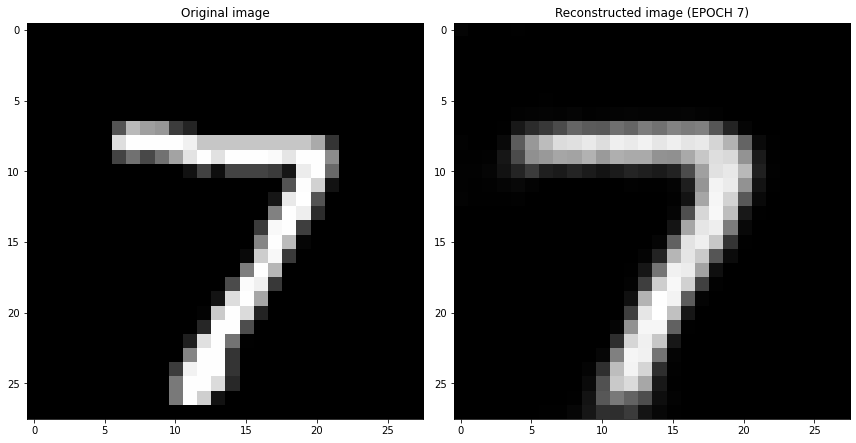

EPOCH 8/30
	 partial train loss (single batch): 0.031295
	 partial train loss (single batch): 0.033613
	 partial train loss (single batch): 0.031320
	 partial train loss (single batch): 0.032448
	 partial train loss (single batch): 0.032208
	 partial train loss (single batch): 0.033082
	 partial train loss (single batch): 0.031901
	 partial train loss (single batch): 0.031515
	 partial train loss (single batch): 0.030713
	 partial train loss (single batch): 0.033699
	 partial train loss (single batch): 0.034385
	 partial train loss (single batch): 0.032153
	 partial train loss (single batch): 0.033140
	 partial train loss (single batch): 0.031878
	 partial train loss (single batch): 0.030578
	 partial train loss (single batch): 0.032241
	 partial train loss (single batch): 0.033009
	 partial train loss (single batch): 0.032475
	 partial train loss (single batch): 0.032582
	 partial train loss (single batch): 0.031958
	 partial train loss (single batch): 0.032548
	 partial train loss (s

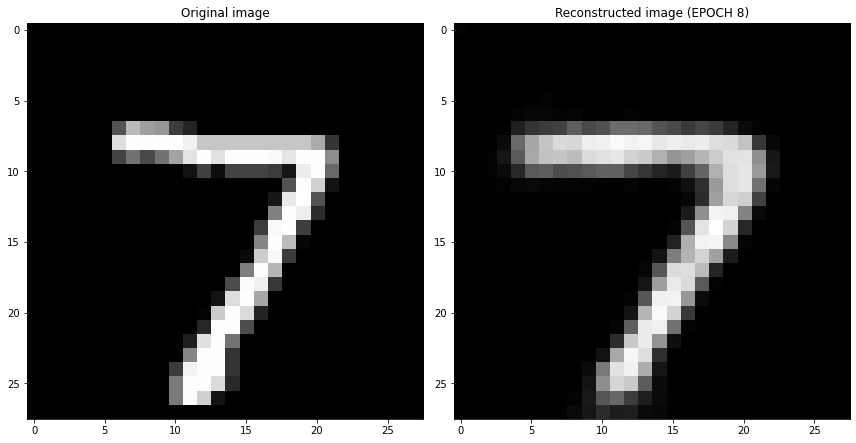

EPOCH 9/30
	 partial train loss (single batch): 0.032312
	 partial train loss (single batch): 0.032182
	 partial train loss (single batch): 0.031762
	 partial train loss (single batch): 0.032018
	 partial train loss (single batch): 0.031573
	 partial train loss (single batch): 0.030851
	 partial train loss (single batch): 0.032977
	 partial train loss (single batch): 0.031756
	 partial train loss (single batch): 0.030424
	 partial train loss (single batch): 0.033551
	 partial train loss (single batch): 0.031842
	 partial train loss (single batch): 0.032880
	 partial train loss (single batch): 0.030121
	 partial train loss (single batch): 0.030192
	 partial train loss (single batch): 0.030682
	 partial train loss (single batch): 0.031453
	 partial train loss (single batch): 0.033534
	 partial train loss (single batch): 0.030703
	 partial train loss (single batch): 0.031151
	 partial train loss (single batch): 0.031927
	 partial train loss (single batch): 0.031828
	 partial train loss (s

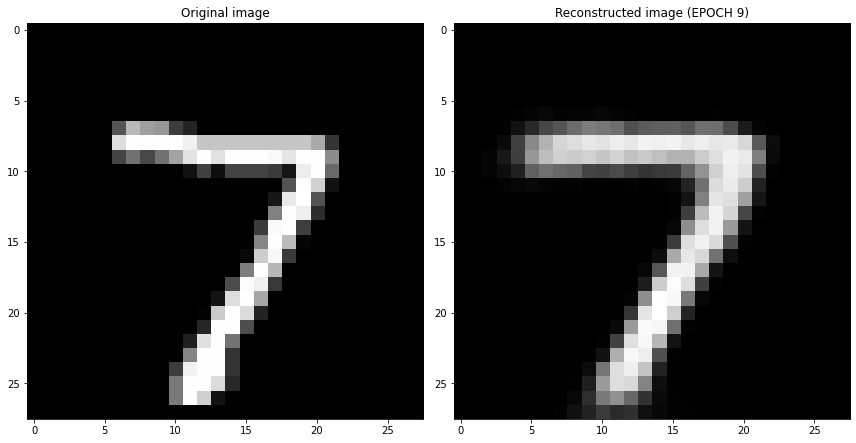

EPOCH 10/30
	 partial train loss (single batch): 0.029274
	 partial train loss (single batch): 0.031711
	 partial train loss (single batch): 0.031024
	 partial train loss (single batch): 0.030345
	 partial train loss (single batch): 0.031275
	 partial train loss (single batch): 0.030910
	 partial train loss (single batch): 0.032297
	 partial train loss (single batch): 0.032606
	 partial train loss (single batch): 0.029913
	 partial train loss (single batch): 0.030555
	 partial train loss (single batch): 0.034623
	 partial train loss (single batch): 0.032241
	 partial train loss (single batch): 0.033190
	 partial train loss (single batch): 0.030407
	 partial train loss (single batch): 0.030724
	 partial train loss (single batch): 0.030973
	 partial train loss (single batch): 0.029902
	 partial train loss (single batch): 0.031207
	 partial train loss (single batch): 0.030787
	 partial train loss (single batch): 0.031505
	 partial train loss (single batch): 0.032000
	 partial train loss (

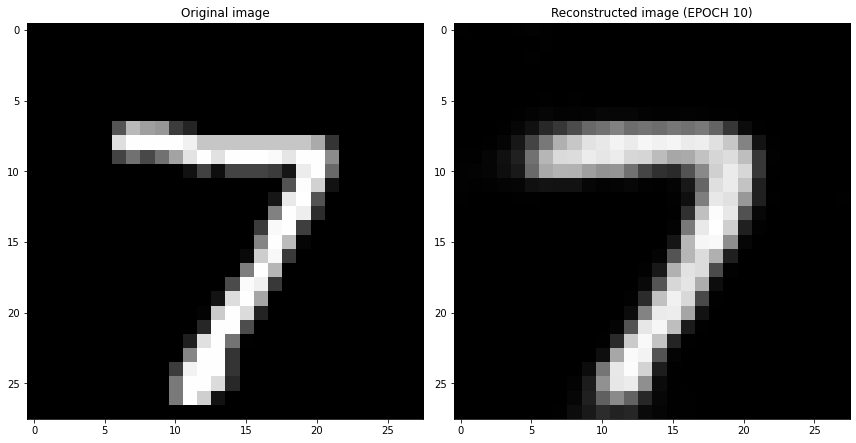

EPOCH 11/30
	 partial train loss (single batch): 0.030859
	 partial train loss (single batch): 0.030854
	 partial train loss (single batch): 0.030084
	 partial train loss (single batch): 0.029409
	 partial train loss (single batch): 0.030862
	 partial train loss (single batch): 0.029959
	 partial train loss (single batch): 0.030031
	 partial train loss (single batch): 0.031759
	 partial train loss (single batch): 0.030494
	 partial train loss (single batch): 0.029384
	 partial train loss (single batch): 0.031242
	 partial train loss (single batch): 0.030633
	 partial train loss (single batch): 0.031090
	 partial train loss (single batch): 0.029954
	 partial train loss (single batch): 0.029774
	 partial train loss (single batch): 0.032406
	 partial train loss (single batch): 0.030728
	 partial train loss (single batch): 0.029491
	 partial train loss (single batch): 0.030447
	 partial train loss (single batch): 0.029904
	 partial train loss (single batch): 0.029619
	 partial train loss (

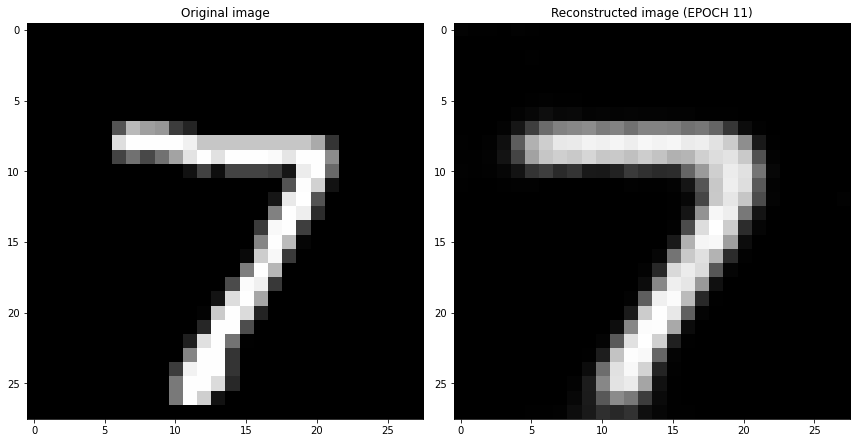

EPOCH 12/30
	 partial train loss (single batch): 0.031341
	 partial train loss (single batch): 0.031143
	 partial train loss (single batch): 0.029550
	 partial train loss (single batch): 0.031734
	 partial train loss (single batch): 0.030085
	 partial train loss (single batch): 0.031440
	 partial train loss (single batch): 0.030419
	 partial train loss (single batch): 0.030464
	 partial train loss (single batch): 0.030539
	 partial train loss (single batch): 0.032174
	 partial train loss (single batch): 0.029831
	 partial train loss (single batch): 0.031249
	 partial train loss (single batch): 0.030536
	 partial train loss (single batch): 0.030809
	 partial train loss (single batch): 0.030034
	 partial train loss (single batch): 0.030212
	 partial train loss (single batch): 0.030179
	 partial train loss (single batch): 0.029763
	 partial train loss (single batch): 0.030335
	 partial train loss (single batch): 0.031503
	 partial train loss (single batch): 0.029846
	 partial train loss (

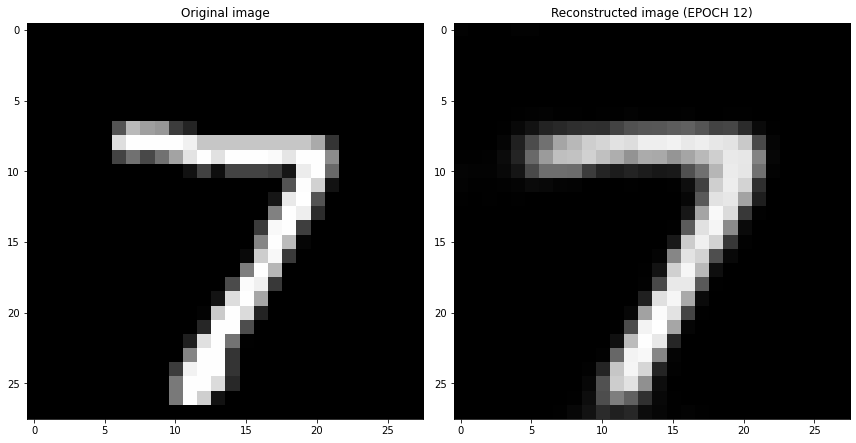

EPOCH 13/30
	 partial train loss (single batch): 0.031123
	 partial train loss (single batch): 0.031828
	 partial train loss (single batch): 0.030730
	 partial train loss (single batch): 0.031595
	 partial train loss (single batch): 0.030443
	 partial train loss (single batch): 0.031581
	 partial train loss (single batch): 0.029336
	 partial train loss (single batch): 0.030484
	 partial train loss (single batch): 0.030250
	 partial train loss (single batch): 0.030007
	 partial train loss (single batch): 0.031860
	 partial train loss (single batch): 0.030531
	 partial train loss (single batch): 0.032091
	 partial train loss (single batch): 0.031129
	 partial train loss (single batch): 0.030586
	 partial train loss (single batch): 0.030354
	 partial train loss (single batch): 0.029602
	 partial train loss (single batch): 0.031676
	 partial train loss (single batch): 0.030841
	 partial train loss (single batch): 0.029859
	 partial train loss (single batch): 0.033113
	 partial train loss (

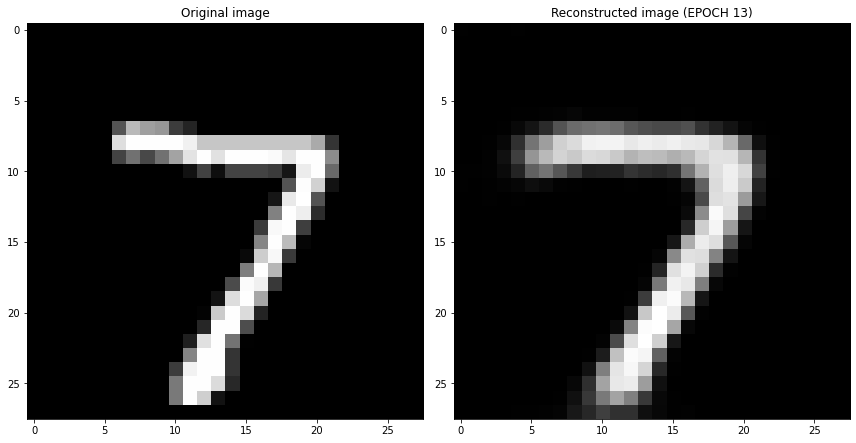

EPOCH 14/30
	 partial train loss (single batch): 0.028781
	 partial train loss (single batch): 0.029433
	 partial train loss (single batch): 0.029271
	 partial train loss (single batch): 0.031405
	 partial train loss (single batch): 0.029979
	 partial train loss (single batch): 0.031014
	 partial train loss (single batch): 0.032104
	 partial train loss (single batch): 0.030051
	 partial train loss (single batch): 0.029513
	 partial train loss (single batch): 0.030042
	 partial train loss (single batch): 0.030114
	 partial train loss (single batch): 0.030104
	 partial train loss (single batch): 0.030402
	 partial train loss (single batch): 0.028548
	 partial train loss (single batch): 0.030201
	 partial train loss (single batch): 0.031081
	 partial train loss (single batch): 0.030617
	 partial train loss (single batch): 0.029155
	 partial train loss (single batch): 0.030339
	 partial train loss (single batch): 0.030865
	 partial train loss (single batch): 0.030826
	 partial train loss (

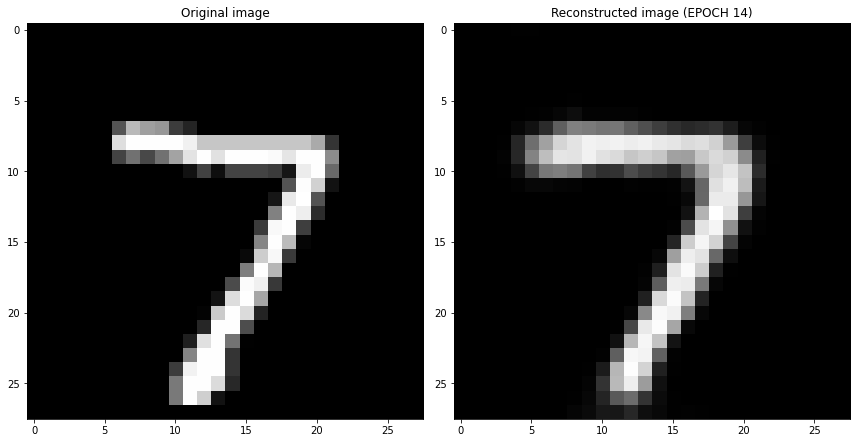

EPOCH 15/30
	 partial train loss (single batch): 0.031383
	 partial train loss (single batch): 0.029218
	 partial train loss (single batch): 0.032000
	 partial train loss (single batch): 0.029912
	 partial train loss (single batch): 0.028845
	 partial train loss (single batch): 0.031824
	 partial train loss (single batch): 0.030747
	 partial train loss (single batch): 0.030316
	 partial train loss (single batch): 0.033724
	 partial train loss (single batch): 0.031034
	 partial train loss (single batch): 0.029284
	 partial train loss (single batch): 0.030586
	 partial train loss (single batch): 0.031757
	 partial train loss (single batch): 0.029790
	 partial train loss (single batch): 0.029491
	 partial train loss (single batch): 0.030468
	 partial train loss (single batch): 0.028410
	 partial train loss (single batch): 0.031932
	 partial train loss (single batch): 0.029032
	 partial train loss (single batch): 0.030870
	 partial train loss (single batch): 0.031013
	 partial train loss (

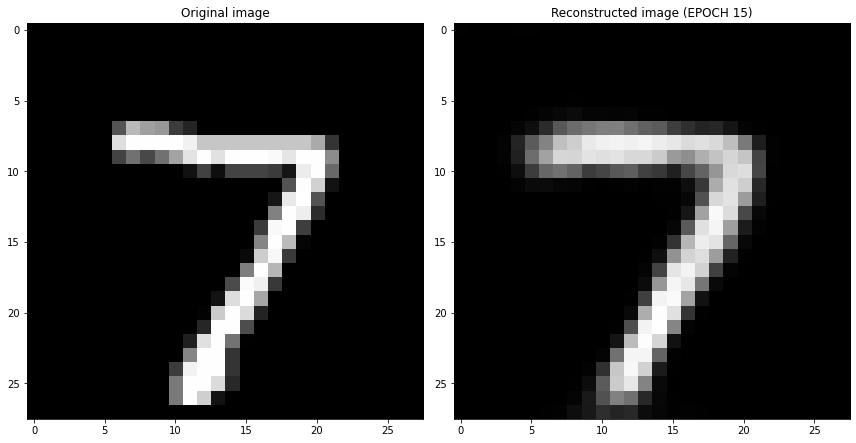

EPOCH 16/30
	 partial train loss (single batch): 0.030316
	 partial train loss (single batch): 0.029457
	 partial train loss (single batch): 0.029019
	 partial train loss (single batch): 0.031323
	 partial train loss (single batch): 0.031547
	 partial train loss (single batch): 0.030349
	 partial train loss (single batch): 0.030271
	 partial train loss (single batch): 0.030701
	 partial train loss (single batch): 0.030067
	 partial train loss (single batch): 0.030165
	 partial train loss (single batch): 0.029195
	 partial train loss (single batch): 0.031274
	 partial train loss (single batch): 0.030420
	 partial train loss (single batch): 0.030531
	 partial train loss (single batch): 0.032585
	 partial train loss (single batch): 0.031385
	 partial train loss (single batch): 0.030526
	 partial train loss (single batch): 0.029210
	 partial train loss (single batch): 0.029442
	 partial train loss (single batch): 0.029342
	 partial train loss (single batch): 0.030769
	 partial train loss (

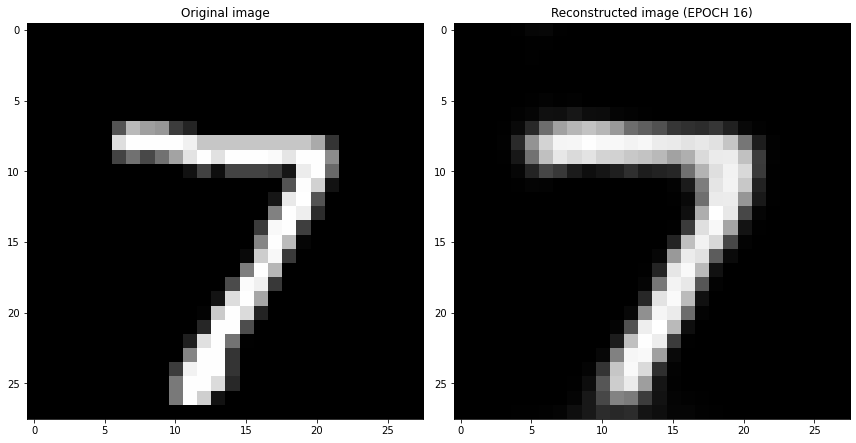

EPOCH 17/30
	 partial train loss (single batch): 0.030086
	 partial train loss (single batch): 0.030530
	 partial train loss (single batch): 0.030363
	 partial train loss (single batch): 0.030096
	 partial train loss (single batch): 0.030745
	 partial train loss (single batch): 0.030879
	 partial train loss (single batch): 0.031814
	 partial train loss (single batch): 0.029511
	 partial train loss (single batch): 0.029116
	 partial train loss (single batch): 0.028861
	 partial train loss (single batch): 0.029732
	 partial train loss (single batch): 0.030172
	 partial train loss (single batch): 0.031944
	 partial train loss (single batch): 0.029992
	 partial train loss (single batch): 0.029531
	 partial train loss (single batch): 0.030760
	 partial train loss (single batch): 0.028692
	 partial train loss (single batch): 0.029595
	 partial train loss (single batch): 0.030427
	 partial train loss (single batch): 0.030465
	 partial train loss (single batch): 0.030209
	 partial train loss (

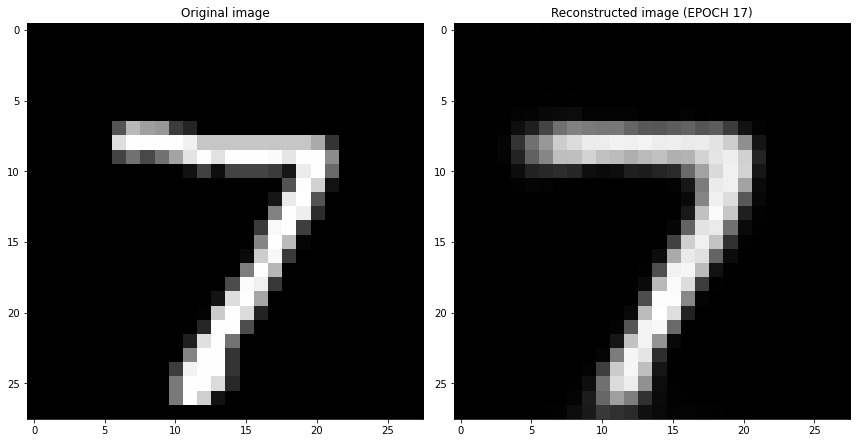

EPOCH 18/30
	 partial train loss (single batch): 0.029694
	 partial train loss (single batch): 0.030229
	 partial train loss (single batch): 0.029812
	 partial train loss (single batch): 0.032267
	 partial train loss (single batch): 0.029533
	 partial train loss (single batch): 0.030580
	 partial train loss (single batch): 0.029451
	 partial train loss (single batch): 0.030161
	 partial train loss (single batch): 0.028496
	 partial train loss (single batch): 0.030767
	 partial train loss (single batch): 0.027893
	 partial train loss (single batch): 0.028772
	 partial train loss (single batch): 0.031577
	 partial train loss (single batch): 0.030742
	 partial train loss (single batch): 0.028731
	 partial train loss (single batch): 0.030310
	 partial train loss (single batch): 0.028836
	 partial train loss (single batch): 0.030997
	 partial train loss (single batch): 0.027927
	 partial train loss (single batch): 0.030878
	 partial train loss (single batch): 0.029775
	 partial train loss (

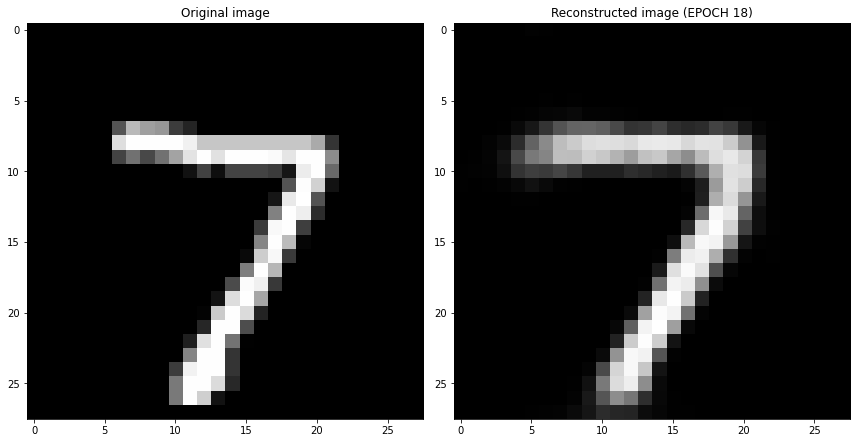

EPOCH 19/30
	 partial train loss (single batch): 0.030685
	 partial train loss (single batch): 0.028257
	 partial train loss (single batch): 0.030290
	 partial train loss (single batch): 0.030306
	 partial train loss (single batch): 0.028512
	 partial train loss (single batch): 0.029514
	 partial train loss (single batch): 0.029855
	 partial train loss (single batch): 0.028078
	 partial train loss (single batch): 0.031218
	 partial train loss (single batch): 0.030023
	 partial train loss (single batch): 0.028773
	 partial train loss (single batch): 0.029892
	 partial train loss (single batch): 0.029376
	 partial train loss (single batch): 0.029980
	 partial train loss (single batch): 0.030348
	 partial train loss (single batch): 0.029374
	 partial train loss (single batch): 0.028950
	 partial train loss (single batch): 0.029089
	 partial train loss (single batch): 0.030751
	 partial train loss (single batch): 0.030829
	 partial train loss (single batch): 0.029097
	 partial train loss (

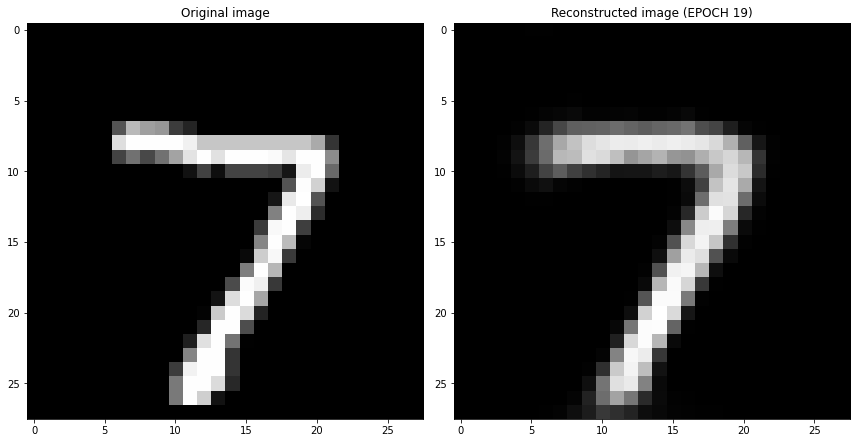

EPOCH 20/30
	 partial train loss (single batch): 0.028093
	 partial train loss (single batch): 0.030924
	 partial train loss (single batch): 0.030511
	 partial train loss (single batch): 0.027258
	 partial train loss (single batch): 0.029486
	 partial train loss (single batch): 0.031396
	 partial train loss (single batch): 0.030838
	 partial train loss (single batch): 0.029421
	 partial train loss (single batch): 0.029449
	 partial train loss (single batch): 0.029158
	 partial train loss (single batch): 0.031105
	 partial train loss (single batch): 0.029916
	 partial train loss (single batch): 0.027942
	 partial train loss (single batch): 0.029508
	 partial train loss (single batch): 0.030234
	 partial train loss (single batch): 0.029230
	 partial train loss (single batch): 0.031115
	 partial train loss (single batch): 0.029110
	 partial train loss (single batch): 0.030640
	 partial train loss (single batch): 0.030246
	 partial train loss (single batch): 0.030343
	 partial train loss (

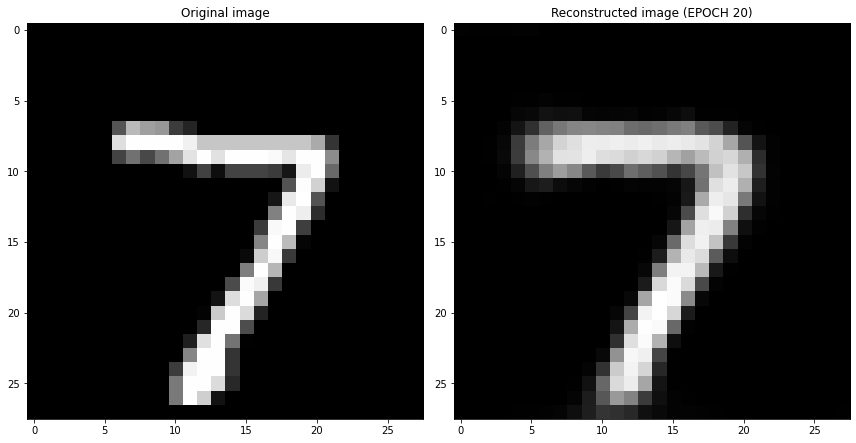

EPOCH 21/30
	 partial train loss (single batch): 0.029712
	 partial train loss (single batch): 0.028388
	 partial train loss (single batch): 0.029162
	 partial train loss (single batch): 0.030558
	 partial train loss (single batch): 0.029970
	 partial train loss (single batch): 0.029081
	 partial train loss (single batch): 0.029587
	 partial train loss (single batch): 0.029701
	 partial train loss (single batch): 0.030200
	 partial train loss (single batch): 0.030249
	 partial train loss (single batch): 0.028500
	 partial train loss (single batch): 0.031388
	 partial train loss (single batch): 0.031369
	 partial train loss (single batch): 0.030250
	 partial train loss (single batch): 0.031048
	 partial train loss (single batch): 0.030302
	 partial train loss (single batch): 0.031282
	 partial train loss (single batch): 0.029451
	 partial train loss (single batch): 0.028255
	 partial train loss (single batch): 0.029312
	 partial train loss (single batch): 0.033202
	 partial train loss (

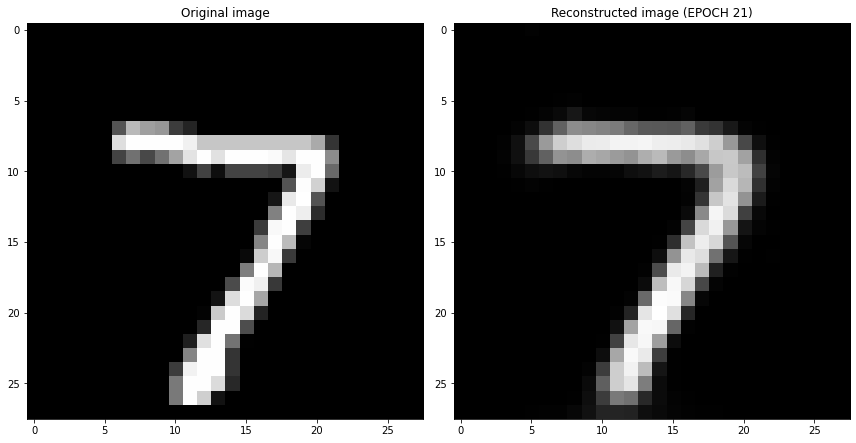

EPOCH 22/30
	 partial train loss (single batch): 0.028097
	 partial train loss (single batch): 0.029985
	 partial train loss (single batch): 0.030078
	 partial train loss (single batch): 0.029989
	 partial train loss (single batch): 0.029757
	 partial train loss (single batch): 0.030886
	 partial train loss (single batch): 0.028168
	 partial train loss (single batch): 0.029250
	 partial train loss (single batch): 0.030621
	 partial train loss (single batch): 0.030589
	 partial train loss (single batch): 0.029210
	 partial train loss (single batch): 0.029436
	 partial train loss (single batch): 0.029418
	 partial train loss (single batch): 0.030064
	 partial train loss (single batch): 0.029357
	 partial train loss (single batch): 0.028374
	 partial train loss (single batch): 0.029966
	 partial train loss (single batch): 0.027680
	 partial train loss (single batch): 0.030367
	 partial train loss (single batch): 0.029245
	 partial train loss (single batch): 0.030378
	 partial train loss (

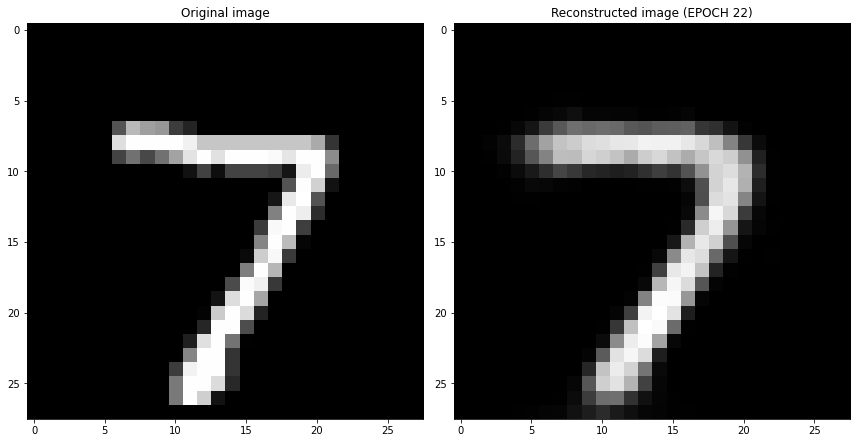

EPOCH 23/30
	 partial train loss (single batch): 0.029368
	 partial train loss (single batch): 0.032306
	 partial train loss (single batch): 0.030112
	 partial train loss (single batch): 0.030210
	 partial train loss (single batch): 0.029504
	 partial train loss (single batch): 0.030207
	 partial train loss (single batch): 0.029622
	 partial train loss (single batch): 0.030212
	 partial train loss (single batch): 0.028661
	 partial train loss (single batch): 0.030370
	 partial train loss (single batch): 0.027048
	 partial train loss (single batch): 0.031016
	 partial train loss (single batch): 0.031218
	 partial train loss (single batch): 0.029440
	 partial train loss (single batch): 0.031168
	 partial train loss (single batch): 0.031161
	 partial train loss (single batch): 0.029065
	 partial train loss (single batch): 0.028540
	 partial train loss (single batch): 0.029851
	 partial train loss (single batch): 0.028765
	 partial train loss (single batch): 0.029435
	 partial train loss (

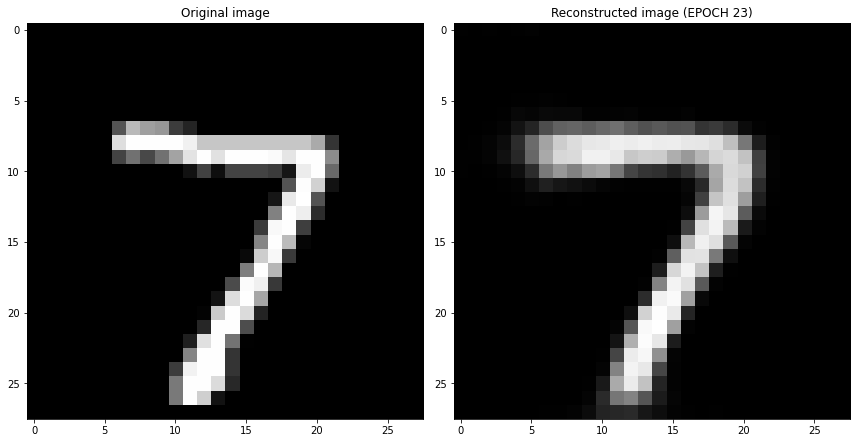

EPOCH 24/30
	 partial train loss (single batch): 0.029532
	 partial train loss (single batch): 0.029223
	 partial train loss (single batch): 0.027450
	 partial train loss (single batch): 0.029445
	 partial train loss (single batch): 0.030416
	 partial train loss (single batch): 0.030338
	 partial train loss (single batch): 0.029172
	 partial train loss (single batch): 0.029957
	 partial train loss (single batch): 0.027650
	 partial train loss (single batch): 0.029851
	 partial train loss (single batch): 0.029643
	 partial train loss (single batch): 0.030107
	 partial train loss (single batch): 0.030662
	 partial train loss (single batch): 0.029865
	 partial train loss (single batch): 0.027676
	 partial train loss (single batch): 0.027893
	 partial train loss (single batch): 0.028674
	 partial train loss (single batch): 0.030465
	 partial train loss (single batch): 0.029473
	 partial train loss (single batch): 0.027377
	 partial train loss (single batch): 0.029989
	 partial train loss (

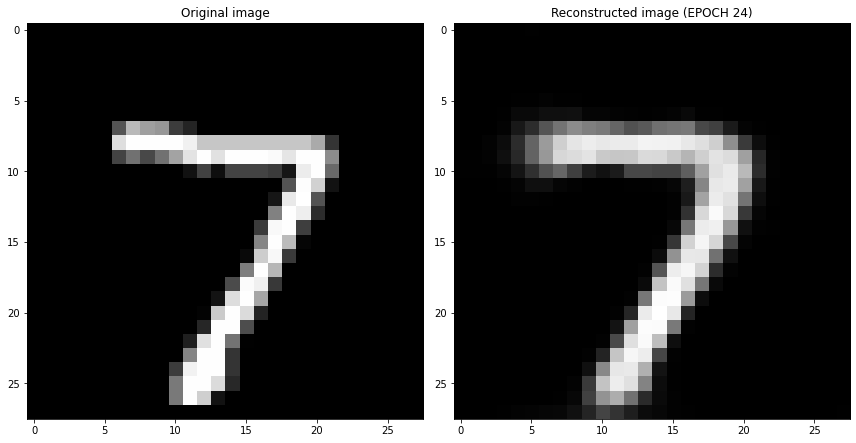

EPOCH 25/30
	 partial train loss (single batch): 0.030342
	 partial train loss (single batch): 0.029226
	 partial train loss (single batch): 0.030308
	 partial train loss (single batch): 0.029783
	 partial train loss (single batch): 0.029519
	 partial train loss (single batch): 0.030140
	 partial train loss (single batch): 0.030315
	 partial train loss (single batch): 0.030557
	 partial train loss (single batch): 0.028125
	 partial train loss (single batch): 0.028433
	 partial train loss (single batch): 0.029808
	 partial train loss (single batch): 0.029845
	 partial train loss (single batch): 0.031149
	 partial train loss (single batch): 0.031856
	 partial train loss (single batch): 0.028083
	 partial train loss (single batch): 0.030577
	 partial train loss (single batch): 0.031622
	 partial train loss (single batch): 0.031778
	 partial train loss (single batch): 0.029066
	 partial train loss (single batch): 0.029621
	 partial train loss (single batch): 0.028789
	 partial train loss (

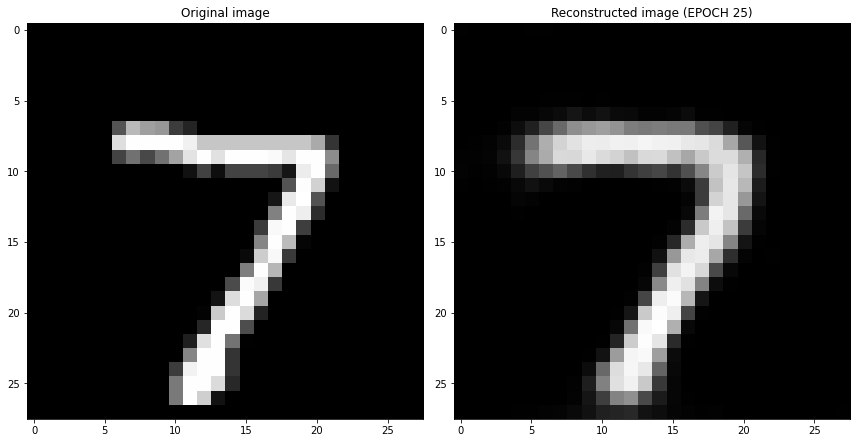

EPOCH 26/30
	 partial train loss (single batch): 0.030203
	 partial train loss (single batch): 0.028588
	 partial train loss (single batch): 0.027988
	 partial train loss (single batch): 0.030196
	 partial train loss (single batch): 0.029570
	 partial train loss (single batch): 0.030747
	 partial train loss (single batch): 0.028881
	 partial train loss (single batch): 0.028756
	 partial train loss (single batch): 0.029715
	 partial train loss (single batch): 0.030222
	 partial train loss (single batch): 0.028624
	 partial train loss (single batch): 0.029752
	 partial train loss (single batch): 0.030807
	 partial train loss (single batch): 0.032180
	 partial train loss (single batch): 0.029084
	 partial train loss (single batch): 0.029241
	 partial train loss (single batch): 0.030079
	 partial train loss (single batch): 0.031414
	 partial train loss (single batch): 0.027565
	 partial train loss (single batch): 0.028926
	 partial train loss (single batch): 0.031330
	 partial train loss (

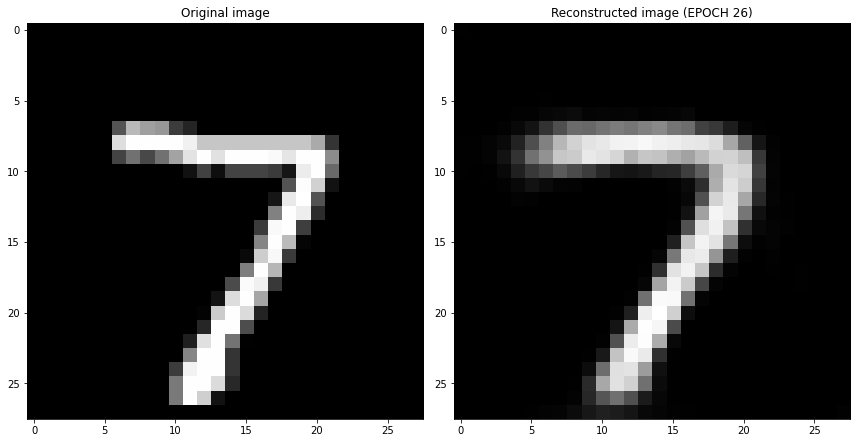

EPOCH 27/30
	 partial train loss (single batch): 0.029526
	 partial train loss (single batch): 0.028558
	 partial train loss (single batch): 0.029588
	 partial train loss (single batch): 0.027930
	 partial train loss (single batch): 0.031699
	 partial train loss (single batch): 0.030307
	 partial train loss (single batch): 0.029773
	 partial train loss (single batch): 0.028866
	 partial train loss (single batch): 0.027709
	 partial train loss (single batch): 0.030860
	 partial train loss (single batch): 0.030374
	 partial train loss (single batch): 0.029982
	 partial train loss (single batch): 0.028128
	 partial train loss (single batch): 0.030583
	 partial train loss (single batch): 0.029956
	 partial train loss (single batch): 0.029445
	 partial train loss (single batch): 0.028831
	 partial train loss (single batch): 0.027582
	 partial train loss (single batch): 0.030065
	 partial train loss (single batch): 0.027537
	 partial train loss (single batch): 0.029468
	 partial train loss (

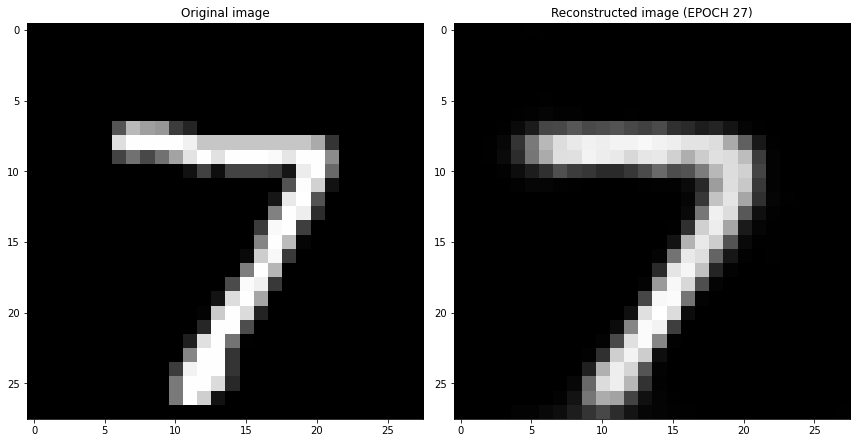

EPOCH 28/30
	 partial train loss (single batch): 0.031207
	 partial train loss (single batch): 0.029315
	 partial train loss (single batch): 0.029313
	 partial train loss (single batch): 0.029091
	 partial train loss (single batch): 0.030393
	 partial train loss (single batch): 0.029559
	 partial train loss (single batch): 0.029743
	 partial train loss (single batch): 0.029217
	 partial train loss (single batch): 0.028238
	 partial train loss (single batch): 0.028818
	 partial train loss (single batch): 0.028733
	 partial train loss (single batch): 0.030534
	 partial train loss (single batch): 0.029036
	 partial train loss (single batch): 0.029629
	 partial train loss (single batch): 0.029761
	 partial train loss (single batch): 0.029682
	 partial train loss (single batch): 0.030650
	 partial train loss (single batch): 0.028275
	 partial train loss (single batch): 0.029068
	 partial train loss (single batch): 0.028368
	 partial train loss (single batch): 0.028737
	 partial train loss (

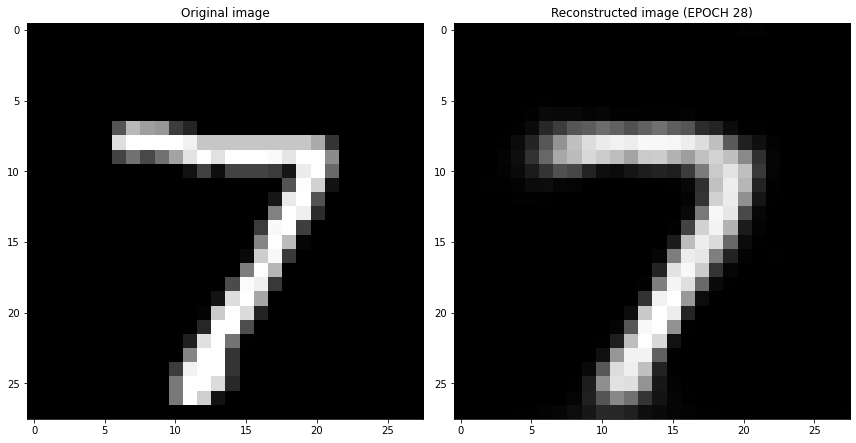

EPOCH 29/30
	 partial train loss (single batch): 0.027718
	 partial train loss (single batch): 0.029230
	 partial train loss (single batch): 0.028421
	 partial train loss (single batch): 0.029749
	 partial train loss (single batch): 0.029333
	 partial train loss (single batch): 0.029303
	 partial train loss (single batch): 0.029636
	 partial train loss (single batch): 0.027924
	 partial train loss (single batch): 0.030135
	 partial train loss (single batch): 0.027935
	 partial train loss (single batch): 0.030243
	 partial train loss (single batch): 0.030132
	 partial train loss (single batch): 0.028741
	 partial train loss (single batch): 0.027163
	 partial train loss (single batch): 0.030576
	 partial train loss (single batch): 0.029216
	 partial train loss (single batch): 0.029310
	 partial train loss (single batch): 0.030213
	 partial train loss (single batch): 0.028940
	 partial train loss (single batch): 0.029963
	 partial train loss (single batch): 0.030618
	 partial train loss (

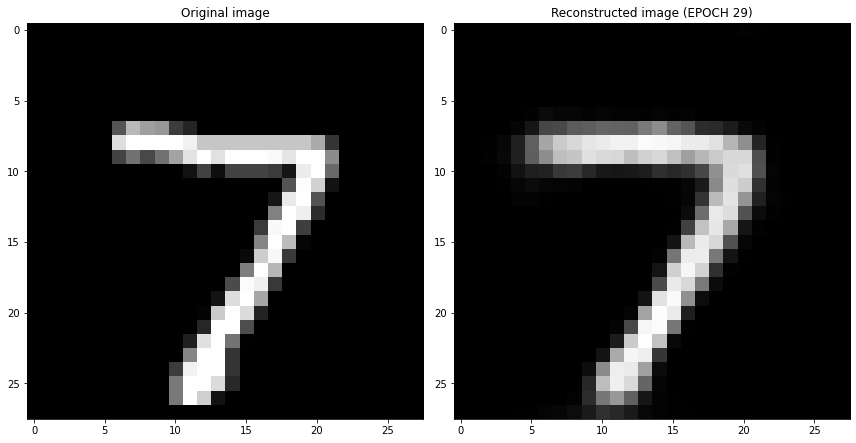

EPOCH 30/30
	 partial train loss (single batch): 0.029409
	 partial train loss (single batch): 0.027794
	 partial train loss (single batch): 0.030620
	 partial train loss (single batch): 0.028422
	 partial train loss (single batch): 0.030158
	 partial train loss (single batch): 0.030633
	 partial train loss (single batch): 0.027968
	 partial train loss (single batch): 0.029829
	 partial train loss (single batch): 0.029686
	 partial train loss (single batch): 0.028561
	 partial train loss (single batch): 0.029743
	 partial train loss (single batch): 0.028386
	 partial train loss (single batch): 0.027708
	 partial train loss (single batch): 0.029218
	 partial train loss (single batch): 0.029147
	 partial train loss (single batch): 0.028823
	 partial train loss (single batch): 0.028745
	 partial train loss (single batch): 0.029846
	 partial train loss (single batch): 0.031431
	 partial train loss (single batch): 0.029766
	 partial train loss (single batch): 0.030610
	 partial train loss (

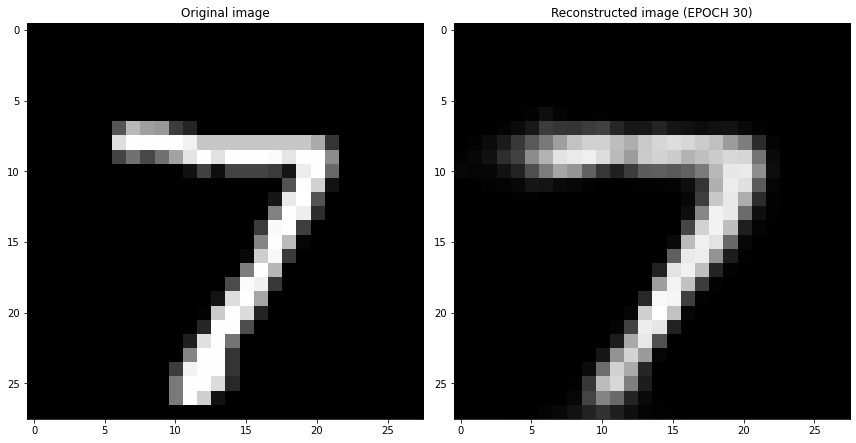

Cross validation fold number= 1/6
EPOCH 1/30
	 partial train loss (single batch): 0.224670
	 partial train loss (single batch): 0.128858
	 partial train loss (single batch): 0.113921
	 partial train loss (single batch): 0.110778
	 partial train loss (single batch): 0.111972
	 partial train loss (single batch): 0.112280
	 partial train loss (single batch): 0.102623
	 partial train loss (single batch): 0.098733
	 partial train loss (single batch): 0.096345
	 partial train loss (single batch): 0.091452
	 partial train loss (single batch): 0.090858
	 partial train loss (single batch): 0.083126
	 partial train loss (single batch): 0.085431
	 partial train loss (single batch): 0.083922
	 partial train loss (single batch): 0.079344
	 partial train loss (single batch): 0.079844
	 partial train loss (single batch): 0.099095
	 partial train loss (single batch): 0.074599
	 partial train loss (single batch): 0.074491
	 partial train loss (single batch): 0.073709
	 partial train loss (single batch)

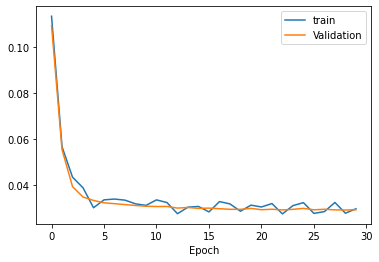

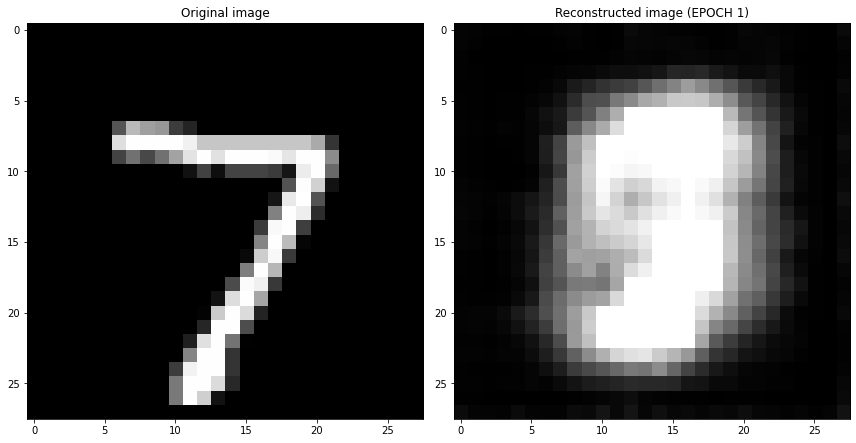

EPOCH 2/30
	 partial train loss (single batch): 0.068196
	 partial train loss (single batch): 0.069260
	 partial train loss (single batch): 0.068592
	 partial train loss (single batch): 0.068726
	 partial train loss (single batch): 0.066619
	 partial train loss (single batch): 0.069761
	 partial train loss (single batch): 0.068648
	 partial train loss (single batch): 0.068880
	 partial train loss (single batch): 0.067042
	 partial train loss (single batch): 0.067955
	 partial train loss (single batch): 0.067920
	 partial train loss (single batch): 0.066631
	 partial train loss (single batch): 0.068352
	 partial train loss (single batch): 0.067775
	 partial train loss (single batch): 0.067027
	 partial train loss (single batch): 0.067501
	 partial train loss (single batch): 0.067637
	 partial train loss (single batch): 0.067281
	 partial train loss (single batch): 0.067375
	 partial train loss (single batch): 0.067206
	 partial train loss (single batch): 0.069280
	 partial train loss (s

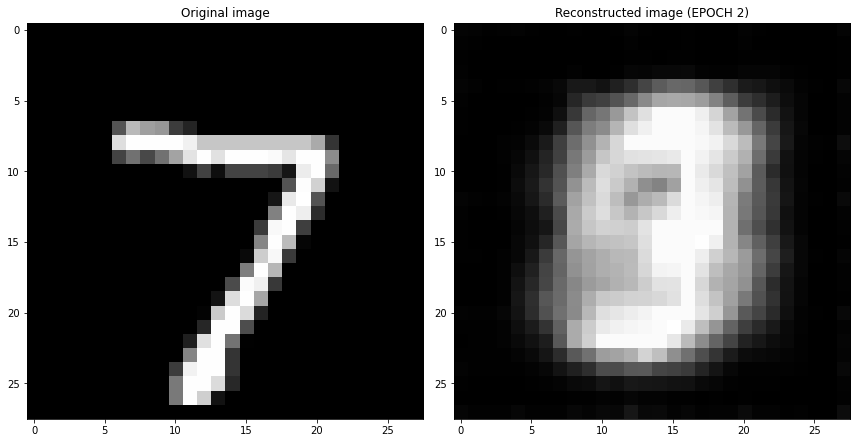

EPOCH 3/30
	 partial train loss (single batch): 0.065635
	 partial train loss (single batch): 0.069126
	 partial train loss (single batch): 0.068574
	 partial train loss (single batch): 0.068178
	 partial train loss (single batch): 0.067318
	 partial train loss (single batch): 0.070118
	 partial train loss (single batch): 0.069972
	 partial train loss (single batch): 0.066340
	 partial train loss (single batch): 0.066336
	 partial train loss (single batch): 0.067492
	 partial train loss (single batch): 0.068094
	 partial train loss (single batch): 0.068714
	 partial train loss (single batch): 0.066470
	 partial train loss (single batch): 0.067717
	 partial train loss (single batch): 0.066689
	 partial train loss (single batch): 0.068556
	 partial train loss (single batch): 0.070018
	 partial train loss (single batch): 0.068025
	 partial train loss (single batch): 0.067707
	 partial train loss (single batch): 0.067376
	 partial train loss (single batch): 0.070508
	 partial train loss (s

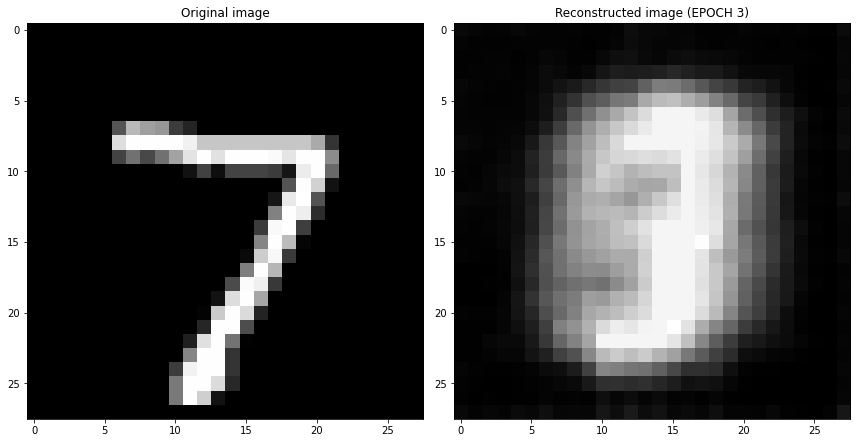

EPOCH 4/30
	 partial train loss (single batch): 0.067230
	 partial train loss (single batch): 0.068087
	 partial train loss (single batch): 0.067708
	 partial train loss (single batch): 0.067523
	 partial train loss (single batch): 0.069523
	 partial train loss (single batch): 0.066726
	 partial train loss (single batch): 0.067734
	 partial train loss (single batch): 0.068521
	 partial train loss (single batch): 0.068015
	 partial train loss (single batch): 0.067850
	 partial train loss (single batch): 0.068692
	 partial train loss (single batch): 0.067626
	 partial train loss (single batch): 0.066429
	 partial train loss (single batch): 0.066628
	 partial train loss (single batch): 0.066270
	 partial train loss (single batch): 0.069590
	 partial train loss (single batch): 0.068221
	 partial train loss (single batch): 0.066723
	 partial train loss (single batch): 0.067342
	 partial train loss (single batch): 0.068929
	 partial train loss (single batch): 0.067563
	 partial train loss (s

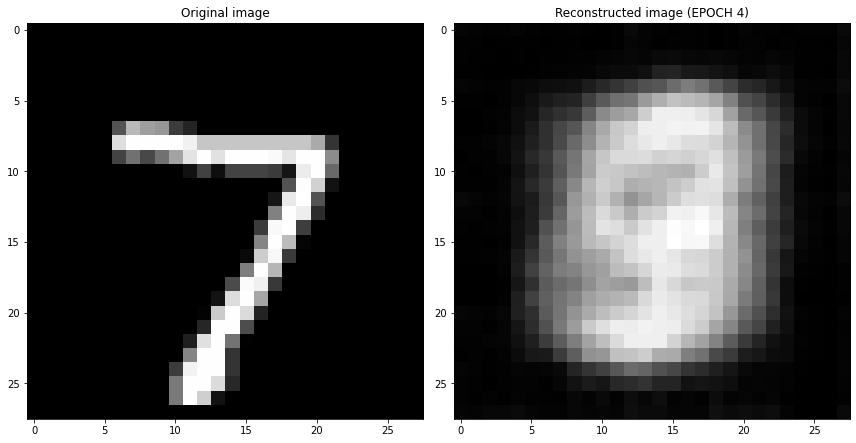

EPOCH 5/30
	 partial train loss (single batch): 0.070038
	 partial train loss (single batch): 0.069068
	 partial train loss (single batch): 0.066471
	 partial train loss (single batch): 0.066723
	 partial train loss (single batch): 0.069789
	 partial train loss (single batch): 0.069811
	 partial train loss (single batch): 0.069343
	 partial train loss (single batch): 0.066715
	 partial train loss (single batch): 0.067378
	 partial train loss (single batch): 0.067066
	 partial train loss (single batch): 0.067129
	 partial train loss (single batch): 0.067412
	 partial train loss (single batch): 0.069451
	 partial train loss (single batch): 0.065870
	 partial train loss (single batch): 0.067051
	 partial train loss (single batch): 0.066408
	 partial train loss (single batch): 0.067268
	 partial train loss (single batch): 0.067954
	 partial train loss (single batch): 0.066176
	 partial train loss (single batch): 0.064708
	 partial train loss (single batch): 0.069588
	 partial train loss (s

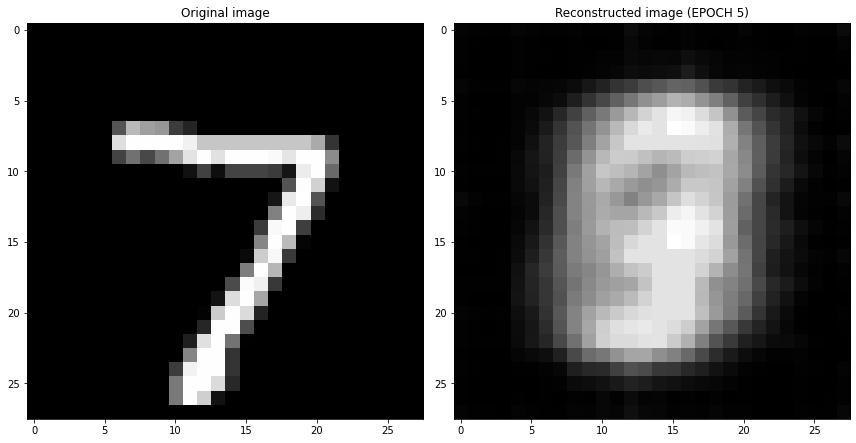

EPOCH 6/30
	 partial train loss (single batch): 0.067014
	 partial train loss (single batch): 0.067256
	 partial train loss (single batch): 0.066314
	 partial train loss (single batch): 0.068529
	 partial train loss (single batch): 0.068539
	 partial train loss (single batch): 0.067105
	 partial train loss (single batch): 0.068287
	 partial train loss (single batch): 0.066318
	 partial train loss (single batch): 0.067979
	 partial train loss (single batch): 0.066493
	 partial train loss (single batch): 0.068301
	 partial train loss (single batch): 0.067898
	 partial train loss (single batch): 0.066760
	 partial train loss (single batch): 0.068472
	 partial train loss (single batch): 0.067195
	 partial train loss (single batch): 0.067878
	 partial train loss (single batch): 0.068156
	 partial train loss (single batch): 0.068199
	 partial train loss (single batch): 0.068824
	 partial train loss (single batch): 0.065910
	 partial train loss (single batch): 0.070872
	 partial train loss (s

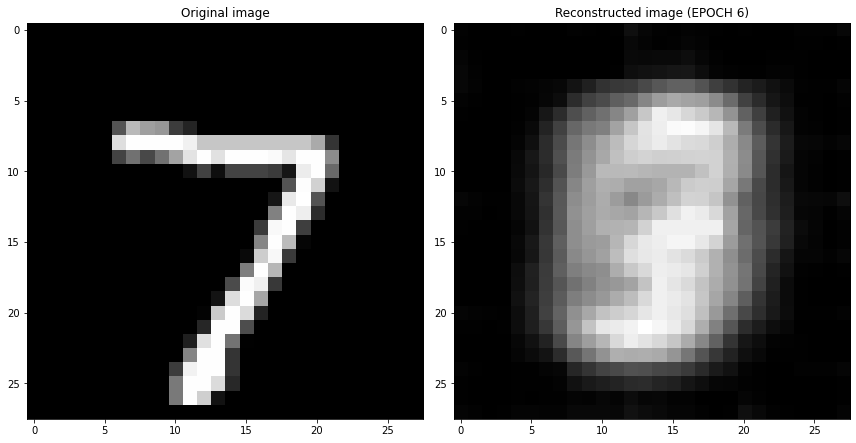

EPOCH 7/30
	 partial train loss (single batch): 0.066454
	 partial train loss (single batch): 0.065134
	 partial train loss (single batch): 0.067410
	 partial train loss (single batch): 0.066455
	 partial train loss (single batch): 0.068463
	 partial train loss (single batch): 0.067412
	 partial train loss (single batch): 0.069134
	 partial train loss (single batch): 0.065190
	 partial train loss (single batch): 0.068853
	 partial train loss (single batch): 0.068212
	 partial train loss (single batch): 0.068273
	 partial train loss (single batch): 0.068230
	 partial train loss (single batch): 0.065440
	 partial train loss (single batch): 0.070731
	 partial train loss (single batch): 0.066372
	 partial train loss (single batch): 0.066167
	 partial train loss (single batch): 0.068780
	 partial train loss (single batch): 0.067631
	 partial train loss (single batch): 0.065408
	 partial train loss (single batch): 0.068352
	 partial train loss (single batch): 0.066973
	 partial train loss (s

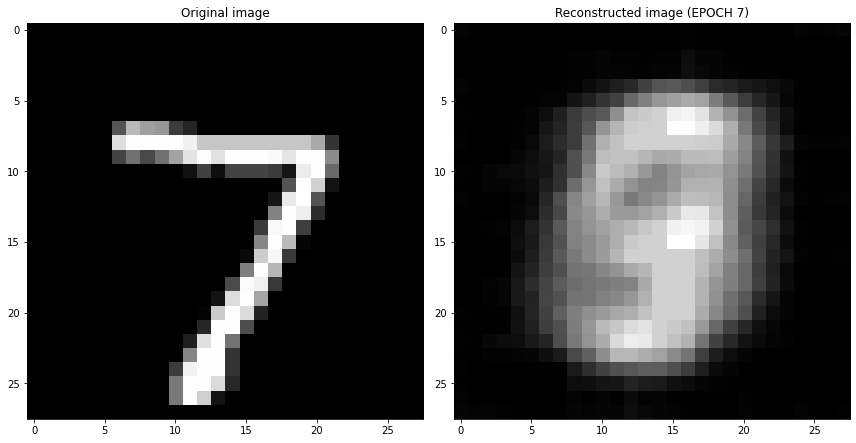

EPOCH 8/30
	 partial train loss (single batch): 0.067188
	 partial train loss (single batch): 0.066886
	 partial train loss (single batch): 0.065712
	 partial train loss (single batch): 0.068641
	 partial train loss (single batch): 0.067695
	 partial train loss (single batch): 0.067095
	 partial train loss (single batch): 0.067994
	 partial train loss (single batch): 0.066437
	 partial train loss (single batch): 0.067985
	 partial train loss (single batch): 0.068777
	 partial train loss (single batch): 0.068249
	 partial train loss (single batch): 0.066324
	 partial train loss (single batch): 0.066114
	 partial train loss (single batch): 0.068861
	 partial train loss (single batch): 0.068790
	 partial train loss (single batch): 0.067120
	 partial train loss (single batch): 0.068398
	 partial train loss (single batch): 0.066643
	 partial train loss (single batch): 0.068538
	 partial train loss (single batch): 0.071122
	 partial train loss (single batch): 0.068997
	 partial train loss (s

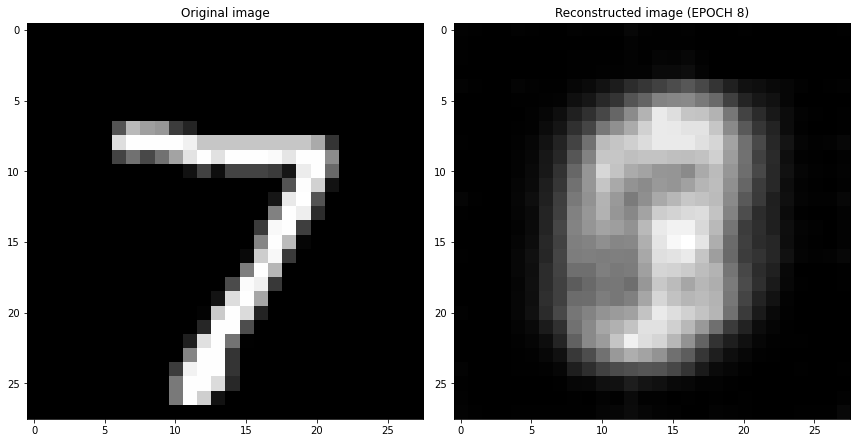

EPOCH 9/30
	 partial train loss (single batch): 0.070312
	 partial train loss (single batch): 0.068915
	 partial train loss (single batch): 0.067476
	 partial train loss (single batch): 0.070132
	 partial train loss (single batch): 0.067852
	 partial train loss (single batch): 0.067720
	 partial train loss (single batch): 0.066103
	 partial train loss (single batch): 0.064676
	 partial train loss (single batch): 0.065970
	 partial train loss (single batch): 0.068015
	 partial train loss (single batch): 0.066098
	 partial train loss (single batch): 0.070360
	 partial train loss (single batch): 0.069939
	 partial train loss (single batch): 0.066631
	 partial train loss (single batch): 0.066471
	 partial train loss (single batch): 0.067613
	 partial train loss (single batch): 0.067050
	 partial train loss (single batch): 0.068654
	 partial train loss (single batch): 0.066747
	 partial train loss (single batch): 0.069592
	 partial train loss (single batch): 0.065875
	 partial train loss (s

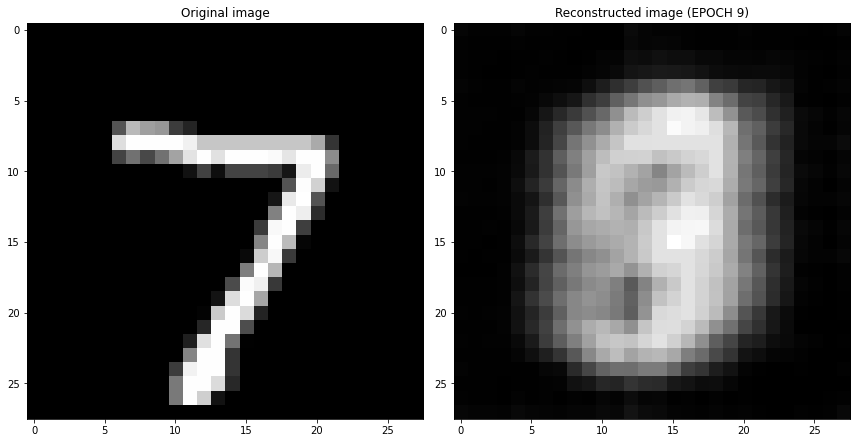

EPOCH 10/30
	 partial train loss (single batch): 0.066996
	 partial train loss (single batch): 0.067487
	 partial train loss (single batch): 0.067631
	 partial train loss (single batch): 0.068195
	 partial train loss (single batch): 0.070837
	 partial train loss (single batch): 0.068493
	 partial train loss (single batch): 0.067745
	 partial train loss (single batch): 0.068371
	 partial train loss (single batch): 0.068578
	 partial train loss (single batch): 0.069532
	 partial train loss (single batch): 0.067002
	 partial train loss (single batch): 0.066874
	 partial train loss (single batch): 0.067122
	 partial train loss (single batch): 0.067980
	 partial train loss (single batch): 0.067635
	 partial train loss (single batch): 0.068117
	 partial train loss (single batch): 0.069632
	 partial train loss (single batch): 0.066604
	 partial train loss (single batch): 0.067865
	 partial train loss (single batch): 0.067788
	 partial train loss (single batch): 0.066839
	 partial train loss (

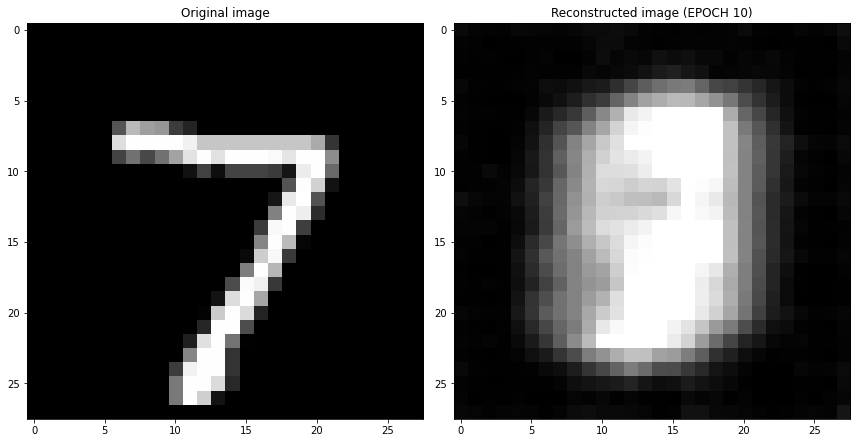

EPOCH 11/30
	 partial train loss (single batch): 0.069270
	 partial train loss (single batch): 0.067503
	 partial train loss (single batch): 0.068710
	 partial train loss (single batch): 0.066452
	 partial train loss (single batch): 0.067754
	 partial train loss (single batch): 0.069184
	 partial train loss (single batch): 0.069763
	 partial train loss (single batch): 0.066404
	 partial train loss (single batch): 0.068026
	 partial train loss (single batch): 0.068232
	 partial train loss (single batch): 0.068982
	 partial train loss (single batch): 0.070525
	 partial train loss (single batch): 0.068564
	 partial train loss (single batch): 0.068025
	 partial train loss (single batch): 0.068629
	 partial train loss (single batch): 0.068293
	 partial train loss (single batch): 0.068946
	 partial train loss (single batch): 0.069536
	 partial train loss (single batch): 0.069814
	 partial train loss (single batch): 0.066348
	 partial train loss (single batch): 0.066743
	 partial train loss (

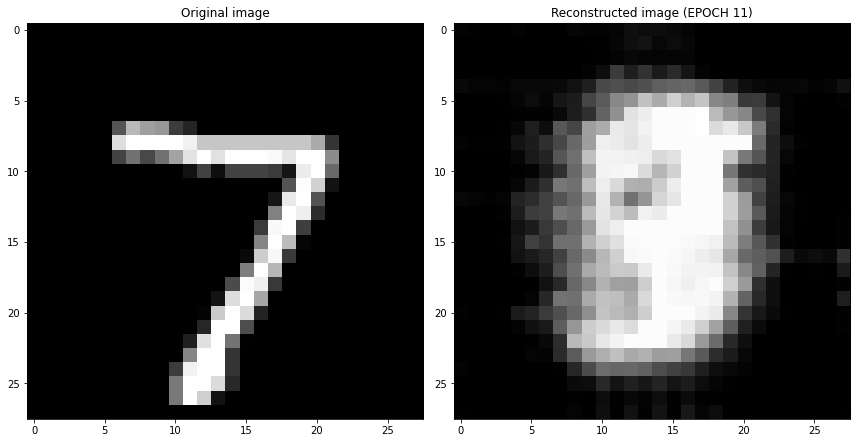

EPOCH 12/30
	 partial train loss (single batch): 0.068740
	 partial train loss (single batch): 0.069356
	 partial train loss (single batch): 0.069697
	 partial train loss (single batch): 0.068592
	 partial train loss (single batch): 0.068796
	 partial train loss (single batch): 0.068894
	 partial train loss (single batch): 0.071129
	 partial train loss (single batch): 0.070202
	 partial train loss (single batch): 0.069271
	 partial train loss (single batch): 0.069932
	 partial train loss (single batch): 0.068664
	 partial train loss (single batch): 0.070299
	 partial train loss (single batch): 0.069778
	 partial train loss (single batch): 0.067441
	 partial train loss (single batch): 0.070168
	 partial train loss (single batch): 0.067770
	 partial train loss (single batch): 0.068820
	 partial train loss (single batch): 0.069521
	 partial train loss (single batch): 0.065184
	 partial train loss (single batch): 0.071315
	 partial train loss (single batch): 0.068269
	 partial train loss (

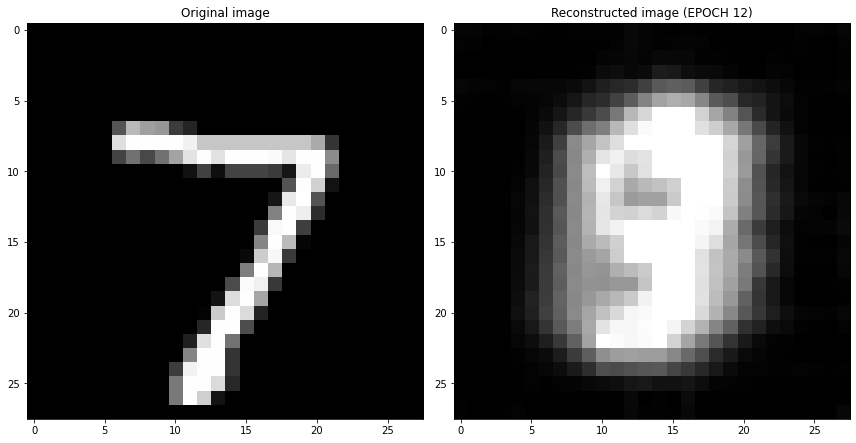

EPOCH 13/30
	 partial train loss (single batch): 0.067594
	 partial train loss (single batch): 0.068948
	 partial train loss (single batch): 0.066229
	 partial train loss (single batch): 0.067532
	 partial train loss (single batch): 0.064137
	 partial train loss (single batch): 0.068817
	 partial train loss (single batch): 0.067095
	 partial train loss (single batch): 0.068244
	 partial train loss (single batch): 0.068599
	 partial train loss (single batch): 0.069205
	 partial train loss (single batch): 0.067315
	 partial train loss (single batch): 0.069778
	 partial train loss (single batch): 0.069066
	 partial train loss (single batch): 0.067751
	 partial train loss (single batch): 0.068043
	 partial train loss (single batch): 0.066532
	 partial train loss (single batch): 0.066772
	 partial train loss (single batch): 0.069996
	 partial train loss (single batch): 0.068592
	 partial train loss (single batch): 0.068877
	 partial train loss (single batch): 0.068822
	 partial train loss (

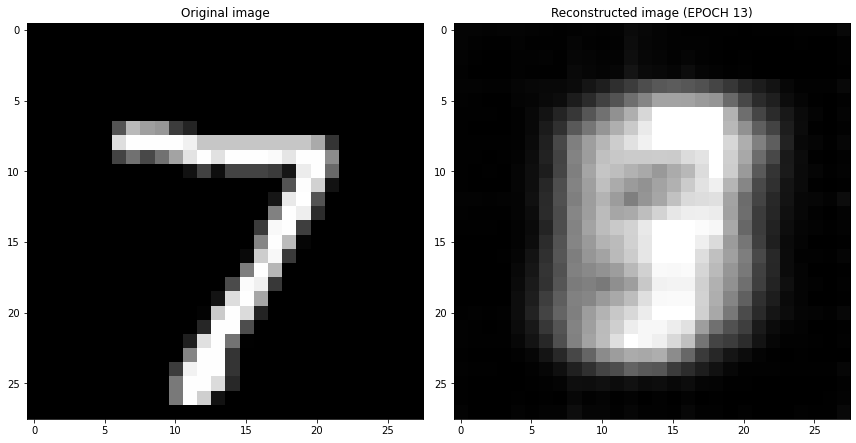

EPOCH 14/30
	 partial train loss (single batch): 0.064595
	 partial train loss (single batch): 0.066860
	 partial train loss (single batch): 0.066871
	 partial train loss (single batch): 0.069386
	 partial train loss (single batch): 0.068563
	 partial train loss (single batch): 0.067478
	 partial train loss (single batch): 0.065839
	 partial train loss (single batch): 0.070100
	 partial train loss (single batch): 0.067432
	 partial train loss (single batch): 0.065787
	 partial train loss (single batch): 0.066537
	 partial train loss (single batch): 0.070680
	 partial train loss (single batch): 0.066703
	 partial train loss (single batch): 0.067364
	 partial train loss (single batch): 0.066985
	 partial train loss (single batch): 0.067544
	 partial train loss (single batch): 0.066687
	 partial train loss (single batch): 0.069539
	 partial train loss (single batch): 0.068347
	 partial train loss (single batch): 0.067080
	 partial train loss (single batch): 0.067278
	 partial train loss (

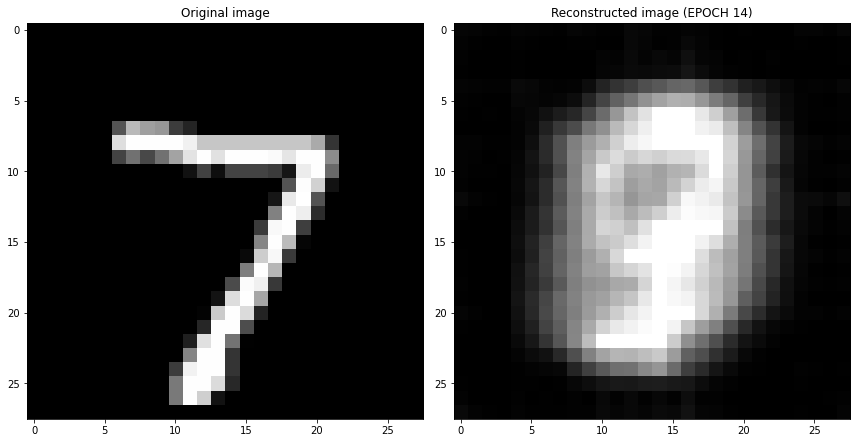

EPOCH 15/30
	 partial train loss (single batch): 0.067245
	 partial train loss (single batch): 0.066693
	 partial train loss (single batch): 0.068172
	 partial train loss (single batch): 0.068408
	 partial train loss (single batch): 0.066197
	 partial train loss (single batch): 0.065453
	 partial train loss (single batch): 0.069612
	 partial train loss (single batch): 0.066839
	 partial train loss (single batch): 0.066709
	 partial train loss (single batch): 0.067295
	 partial train loss (single batch): 0.069317
	 partial train loss (single batch): 0.067424
	 partial train loss (single batch): 0.068864
	 partial train loss (single batch): 0.067584
	 partial train loss (single batch): 0.067320
	 partial train loss (single batch): 0.068490
	 partial train loss (single batch): 0.068898
	 partial train loss (single batch): 0.068107
	 partial train loss (single batch): 0.064635
	 partial train loss (single batch): 0.069496
	 partial train loss (single batch): 0.067825
	 partial train loss (

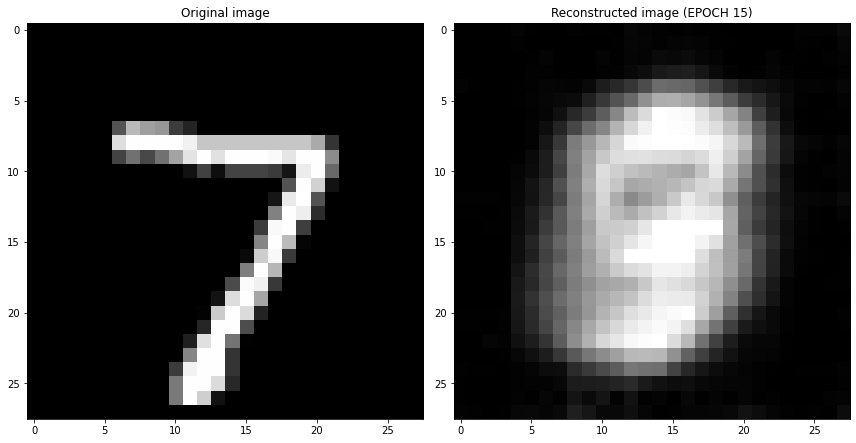

EPOCH 16/30
	 partial train loss (single batch): 0.068649
	 partial train loss (single batch): 0.068482
	 partial train loss (single batch): 0.067102
	 partial train loss (single batch): 0.068231
	 partial train loss (single batch): 0.064559
	 partial train loss (single batch): 0.067610
	 partial train loss (single batch): 0.067081
	 partial train loss (single batch): 0.068552
	 partial train loss (single batch): 0.068995
	 partial train loss (single batch): 0.066922
	 partial train loss (single batch): 0.065586
	 partial train loss (single batch): 0.067736
	 partial train loss (single batch): 0.067051
	 partial train loss (single batch): 0.068814
	 partial train loss (single batch): 0.067697
	 partial train loss (single batch): 0.066535
	 partial train loss (single batch): 0.068177
	 partial train loss (single batch): 0.069573
	 partial train loss (single batch): 0.067715
	 partial train loss (single batch): 0.066489
	 partial train loss (single batch): 0.067059
	 partial train loss (

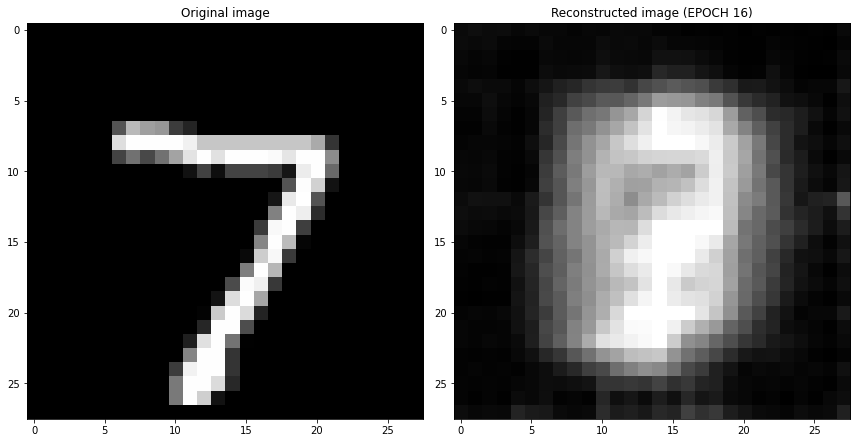

EPOCH 17/30
	 partial train loss (single batch): 0.068138
	 partial train loss (single batch): 0.068301
	 partial train loss (single batch): 0.070363
	 partial train loss (single batch): 0.073521
	 partial train loss (single batch): 0.069506
	 partial train loss (single batch): 0.066471
	 partial train loss (single batch): 0.068508
	 partial train loss (single batch): 0.068416
	 partial train loss (single batch): 0.076514
	 partial train loss (single batch): 0.071098
	 partial train loss (single batch): 0.072736
	 partial train loss (single batch): 0.071019
	 partial train loss (single batch): 0.071424
	 partial train loss (single batch): 0.097760
	 partial train loss (single batch): 0.098901
	 partial train loss (single batch): 0.099601
	 partial train loss (single batch): 0.104271
	 partial train loss (single batch): 0.102710
	 partial train loss (single batch): 0.097761
	 partial train loss (single batch): 0.099104
	 partial train loss (single batch): 0.110915
	 partial train loss (

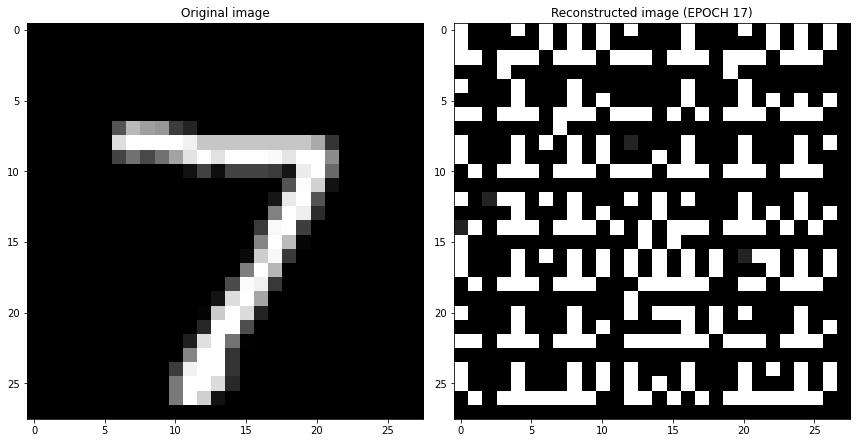

EPOCH 18/30
	 partial train loss (single batch): 0.359201
	 partial train loss (single batch): 0.360466
	 partial train loss (single batch): 0.361838
	 partial train loss (single batch): 0.361655
	 partial train loss (single batch): 0.360506
	 partial train loss (single batch): 0.362652
	 partial train loss (single batch): 0.365285
	 partial train loss (single batch): 0.364280
	 partial train loss (single batch): 0.366868
	 partial train loss (single batch): 0.363794
	 partial train loss (single batch): 0.364232
	 partial train loss (single batch): 0.362368
	 partial train loss (single batch): 0.364886
	 partial train loss (single batch): 0.362439
	 partial train loss (single batch): 0.359698
	 partial train loss (single batch): 0.360034
	 partial train loss (single batch): 0.363665
	 partial train loss (single batch): 0.392357
	 partial train loss (single batch): 0.397311
	 partial train loss (single batch): 0.399521
	 partial train loss (single batch): 0.403459
	 partial train loss (

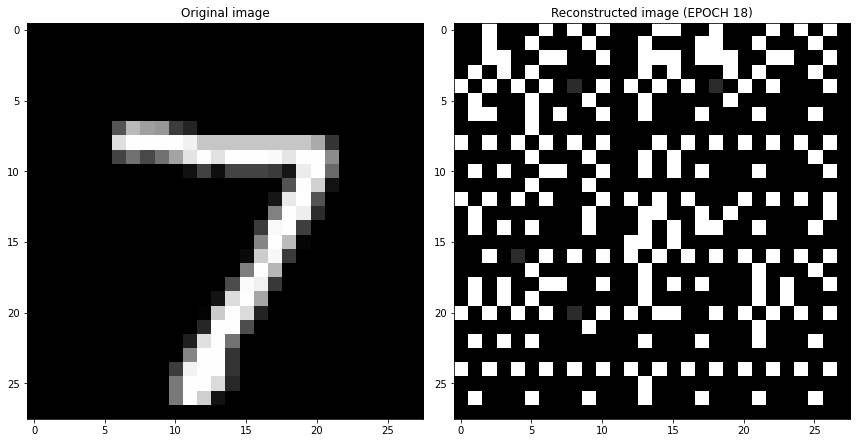

EPOCH 19/30
	 partial train loss (single batch): 0.306297
	 partial train loss (single batch): 0.305328
	 partial train loss (single batch): 0.305423
	 partial train loss (single batch): 0.304308
	 partial train loss (single batch): 0.303412
	 partial train loss (single batch): 0.304303
	 partial train loss (single batch): 0.303038
	 partial train loss (single batch): 0.303623
	 partial train loss (single batch): 0.296867
	 partial train loss (single batch): 0.294342
	 partial train loss (single batch): 0.303489
	 partial train loss (single batch): 0.302294
	 partial train loss (single batch): 0.303186
	 partial train loss (single batch): 0.304522
	 partial train loss (single batch): 0.301517
	 partial train loss (single batch): 0.304934
	 partial train loss (single batch): 0.301651
	 partial train loss (single batch): 0.301527
	 partial train loss (single batch): 0.298305
	 partial train loss (single batch): 0.300120
	 partial train loss (single batch): 0.300339
	 partial train loss (

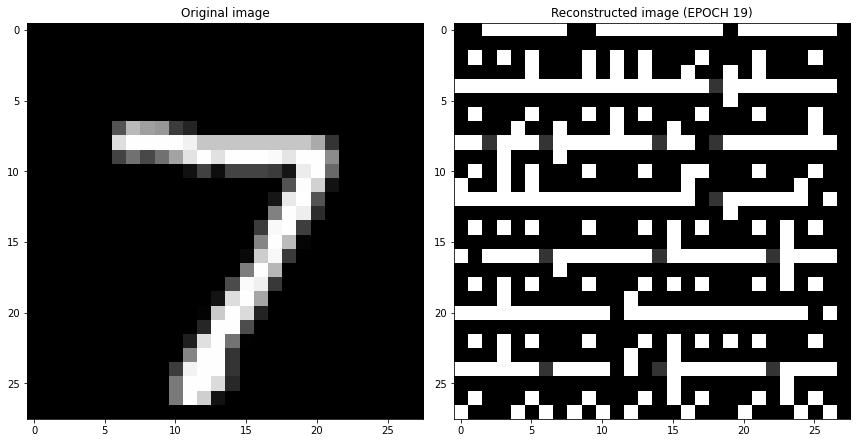

EPOCH 20/30
	 partial train loss (single batch): 0.370425
	 partial train loss (single batch): 0.368549
	 partial train loss (single batch): 0.371212
	 partial train loss (single batch): 0.370905
	 partial train loss (single batch): 0.371405
	 partial train loss (single batch): 0.369397
	 partial train loss (single batch): 0.370229
	 partial train loss (single batch): 0.370933
	 partial train loss (single batch): 0.369905
	 partial train loss (single batch): 0.370560
	 partial train loss (single batch): 0.372163
	 partial train loss (single batch): 0.371276
	 partial train loss (single batch): 0.371549
	 partial train loss (single batch): 0.371454
	 partial train loss (single batch): 0.370484
	 partial train loss (single batch): 0.370268
	 partial train loss (single batch): 0.370328
	 partial train loss (single batch): 0.371167
	 partial train loss (single batch): 0.369579
	 partial train loss (single batch): 0.368432
	 partial train loss (single batch): 0.367918
	 partial train loss (

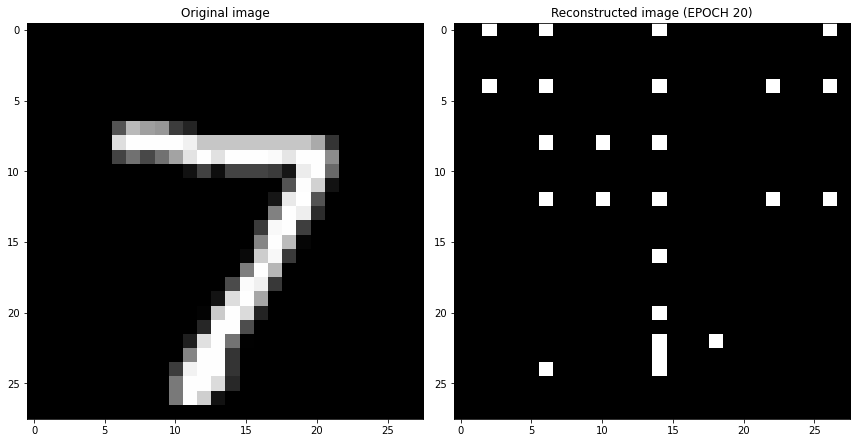

EPOCH 21/30
	 partial train loss (single batch): 0.131534
	 partial train loss (single batch): 0.132529
	 partial train loss (single batch): 0.133944
	 partial train loss (single batch): 0.129454
	 partial train loss (single batch): 0.119172
	 partial train loss (single batch): 0.119015
	 partial train loss (single batch): 0.117816
	 partial train loss (single batch): 0.114965
	 partial train loss (single batch): 0.117875
	 partial train loss (single batch): 0.117459
	 partial train loss (single batch): 0.115372
	 partial train loss (single batch): 0.111551
	 partial train loss (single batch): 0.112928
	 partial train loss (single batch): 0.115828
	 partial train loss (single batch): 0.114978
	 partial train loss (single batch): 0.114351
	 partial train loss (single batch): 0.112475
	 partial train loss (single batch): 0.114871
	 partial train loss (single batch): 0.112738
	 partial train loss (single batch): 0.112047
	 partial train loss (single batch): 0.116178
	 partial train loss (

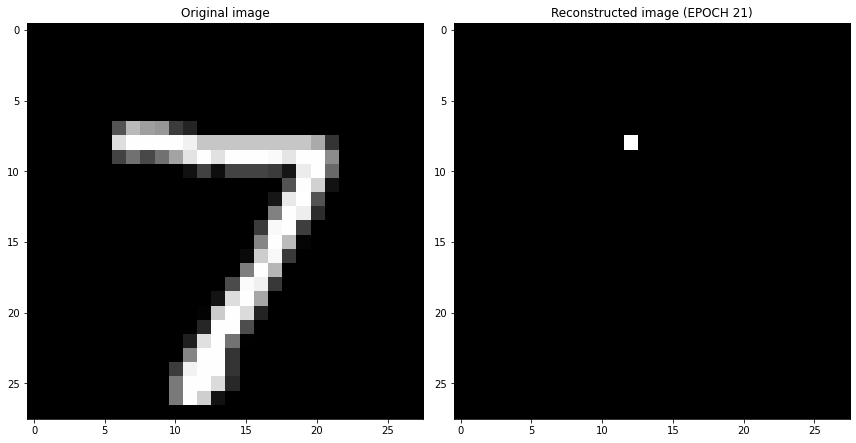

EPOCH 22/30
	 partial train loss (single batch): 0.109295
	 partial train loss (single batch): 0.112210
	 partial train loss (single batch): 0.111747
	 partial train loss (single batch): 0.108880
	 partial train loss (single batch): 0.107181
	 partial train loss (single batch): 0.114818
	 partial train loss (single batch): 0.112627
	 partial train loss (single batch): 0.110498
	 partial train loss (single batch): 0.115105
	 partial train loss (single batch): 0.110305
	 partial train loss (single batch): 0.109361
	 partial train loss (single batch): 0.108552
	 partial train loss (single batch): 0.110208
	 partial train loss (single batch): 0.108660
	 partial train loss (single batch): 0.114494
	 partial train loss (single batch): 0.114576
	 partial train loss (single batch): 0.110090
	 partial train loss (single batch): 0.113975
	 partial train loss (single batch): 0.111018
	 partial train loss (single batch): 0.109618
	 partial train loss (single batch): 0.116730
	 partial train loss (

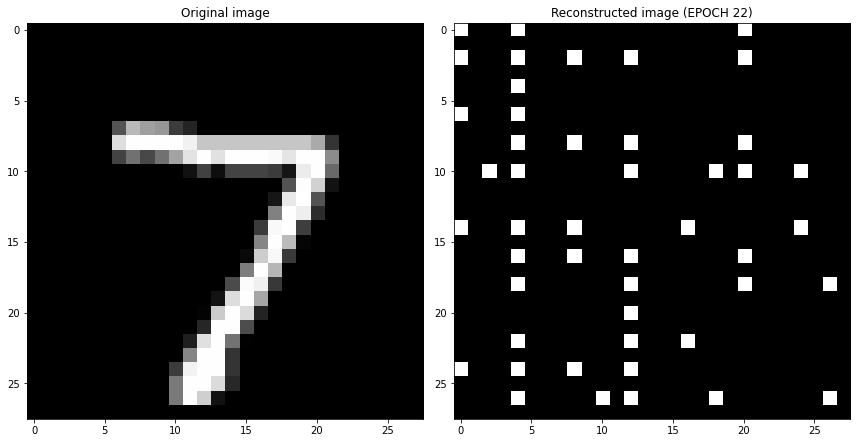

EPOCH 23/30
	 partial train loss (single batch): 0.154138
	 partial train loss (single batch): 0.150568
	 partial train loss (single batch): 0.156887
	 partial train loss (single batch): 0.158446
	 partial train loss (single batch): 0.158651
	 partial train loss (single batch): 0.153046
	 partial train loss (single batch): 0.163531
	 partial train loss (single batch): 0.156246
	 partial train loss (single batch): 0.155460
	 partial train loss (single batch): 0.154351
	 partial train loss (single batch): 0.151822
	 partial train loss (single batch): 0.150750
	 partial train loss (single batch): 0.158457
	 partial train loss (single batch): 0.154737
	 partial train loss (single batch): 0.151132
	 partial train loss (single batch): 0.150003
	 partial train loss (single batch): 0.151124
	 partial train loss (single batch): 0.146353
	 partial train loss (single batch): 0.145132
	 partial train loss (single batch): 0.151873
	 partial train loss (single batch): 0.139303
	 partial train loss (

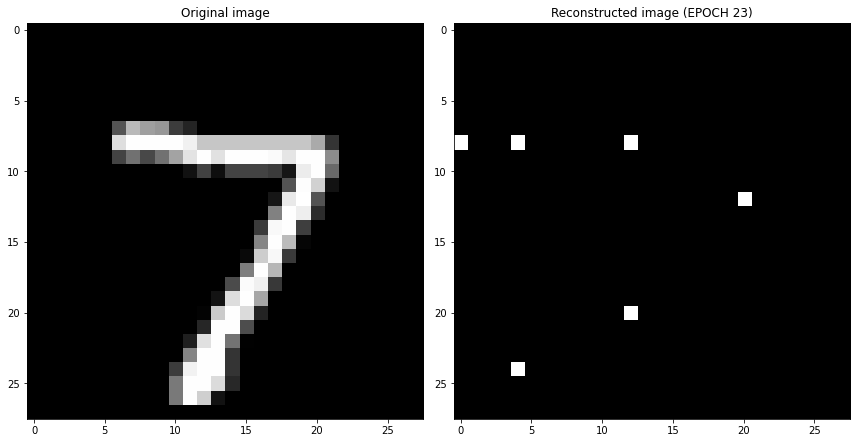

EPOCH 24/30
	 partial train loss (single batch): 0.117058
	 partial train loss (single batch): 0.118804
	 partial train loss (single batch): 0.115208
	 partial train loss (single batch): 0.114992
	 partial train loss (single batch): 0.118748
	 partial train loss (single batch): 0.116943
	 partial train loss (single batch): 0.120129
	 partial train loss (single batch): 0.119919
	 partial train loss (single batch): 0.114807
	 partial train loss (single batch): 0.119327
	 partial train loss (single batch): 0.120084
	 partial train loss (single batch): 0.117978
	 partial train loss (single batch): 0.113576
	 partial train loss (single batch): 0.112065
	 partial train loss (single batch): 0.114291
	 partial train loss (single batch): 0.115525
	 partial train loss (single batch): 0.116452
	 partial train loss (single batch): 0.117745
	 partial train loss (single batch): 0.111275
	 partial train loss (single batch): 0.115252
	 partial train loss (single batch): 0.116235
	 partial train loss (

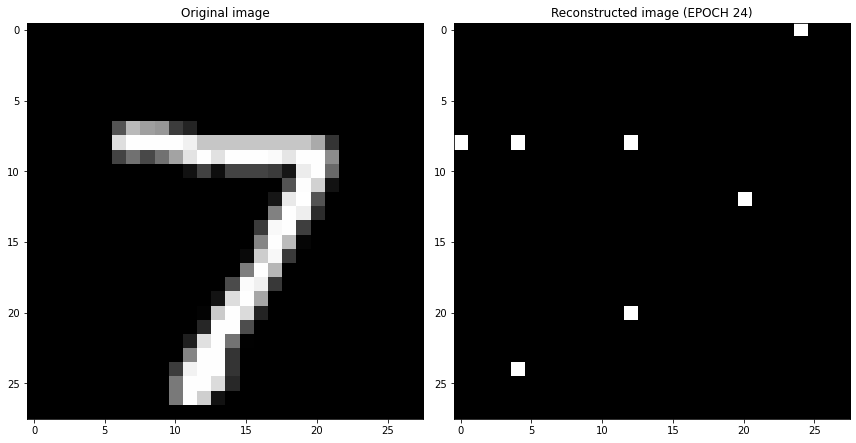

EPOCH 25/30
	 partial train loss (single batch): 0.121833
	 partial train loss (single batch): 0.121030
	 partial train loss (single batch): 0.118605
	 partial train loss (single batch): 0.118803
	 partial train loss (single batch): 0.119054
	 partial train loss (single batch): 0.117148
	 partial train loss (single batch): 0.118661
	 partial train loss (single batch): 0.118091
	 partial train loss (single batch): 0.118640
	 partial train loss (single batch): 0.118349
	 partial train loss (single batch): 0.114988
	 partial train loss (single batch): 0.119571
	 partial train loss (single batch): 0.115183
	 partial train loss (single batch): 0.115640
	 partial train loss (single batch): 0.115450
	 partial train loss (single batch): 0.118755
	 partial train loss (single batch): 0.115637
	 partial train loss (single batch): 0.116040
	 partial train loss (single batch): 0.114960
	 partial train loss (single batch): 0.117563
	 partial train loss (single batch): 0.114796
	 partial train loss (

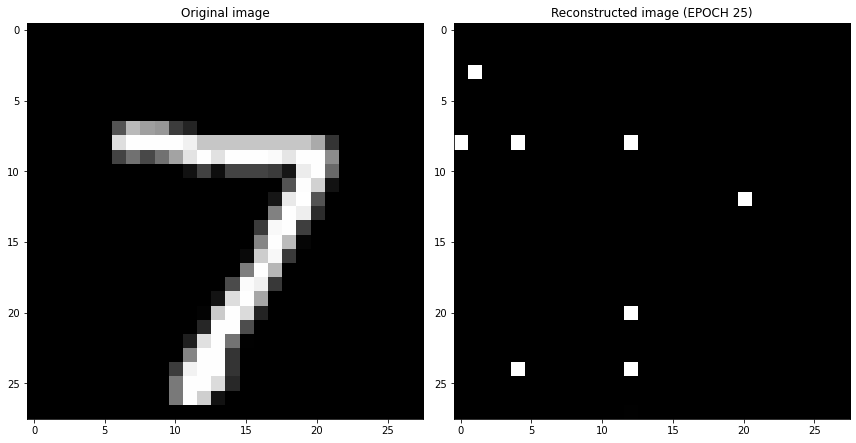

EPOCH 26/30
	 partial train loss (single batch): 0.120538
	 partial train loss (single batch): 0.116513
	 partial train loss (single batch): 0.114875
	 partial train loss (single batch): 0.121502
	 partial train loss (single batch): 0.114845
	 partial train loss (single batch): 0.118760
	 partial train loss (single batch): 0.119770
	 partial train loss (single batch): 0.120005
	 partial train loss (single batch): 0.112959
	 partial train loss (single batch): 0.122664
	 partial train loss (single batch): 0.120632
	 partial train loss (single batch): 0.123311
	 partial train loss (single batch): 0.119779
	 partial train loss (single batch): 0.116451
	 partial train loss (single batch): 0.120632
	 partial train loss (single batch): 0.119131
	 partial train loss (single batch): 0.120891
	 partial train loss (single batch): 0.116051
	 partial train loss (single batch): 0.120353
	 partial train loss (single batch): 0.115919
	 partial train loss (single batch): 0.123249
	 partial train loss (

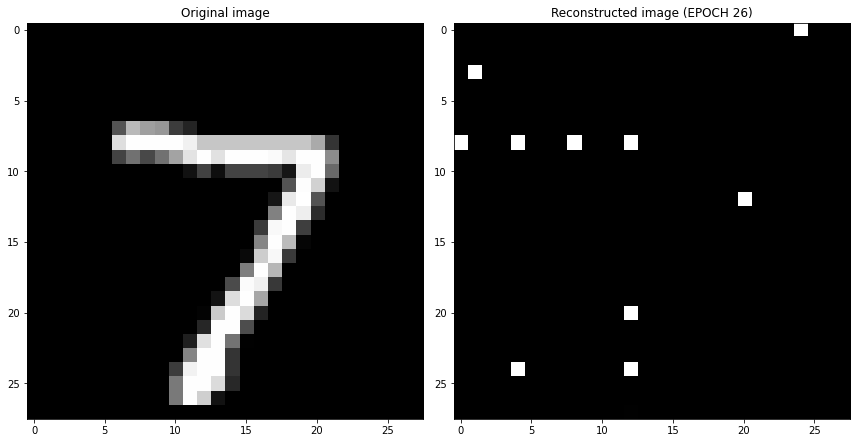

EPOCH 27/30
	 partial train loss (single batch): 0.125251
	 partial train loss (single batch): 0.121764
	 partial train loss (single batch): 0.118534
	 partial train loss (single batch): 0.121650
	 partial train loss (single batch): 0.115072
	 partial train loss (single batch): 0.121095
	 partial train loss (single batch): 0.123243
	 partial train loss (single batch): 0.116208
	 partial train loss (single batch): 0.117436
	 partial train loss (single batch): 0.120832
	 partial train loss (single batch): 0.122816
	 partial train loss (single batch): 0.119035
	 partial train loss (single batch): 0.118378
	 partial train loss (single batch): 0.123377
	 partial train loss (single batch): 0.121539
	 partial train loss (single batch): 0.126518
	 partial train loss (single batch): 0.121302
	 partial train loss (single batch): 0.121758
	 partial train loss (single batch): 0.118093
	 partial train loss (single batch): 0.120104
	 partial train loss (single batch): 0.120881
	 partial train loss (

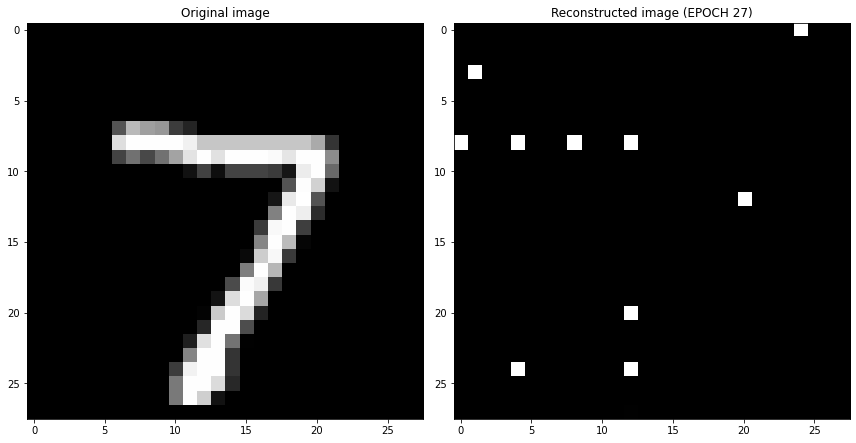

EPOCH 28/30
	 partial train loss (single batch): 0.120703
	 partial train loss (single batch): 0.115199
	 partial train loss (single batch): 0.120899
	 partial train loss (single batch): 0.120293
	 partial train loss (single batch): 0.118129
	 partial train loss (single batch): 0.122516
	 partial train loss (single batch): 0.117684
	 partial train loss (single batch): 0.121738
	 partial train loss (single batch): 0.122666
	 partial train loss (single batch): 0.115735
	 partial train loss (single batch): 0.120581
	 partial train loss (single batch): 0.124482
	 partial train loss (single batch): 0.118389
	 partial train loss (single batch): 0.123027
	 partial train loss (single batch): 0.122763
	 partial train loss (single batch): 0.119546
	 partial train loss (single batch): 0.121657
	 partial train loss (single batch): 0.120849
	 partial train loss (single batch): 0.117197
	 partial train loss (single batch): 0.121094
	 partial train loss (single batch): 0.121846
	 partial train loss (

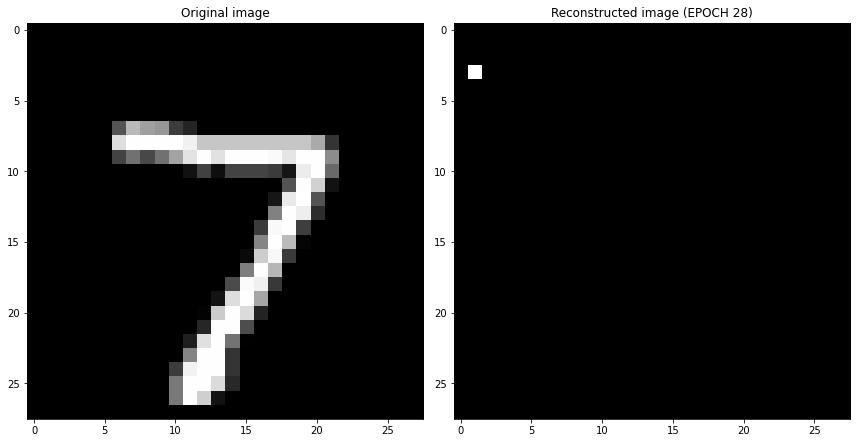

EPOCH 29/30
	 partial train loss (single batch): 0.117985
	 partial train loss (single batch): 0.114695
	 partial train loss (single batch): 0.114554
	 partial train loss (single batch): 0.109913
	 partial train loss (single batch): 0.115510
	 partial train loss (single batch): 0.108308
	 partial train loss (single batch): 0.110634
	 partial train loss (single batch): 0.113328
	 partial train loss (single batch): 0.116448
	 partial train loss (single batch): 0.112998
	 partial train loss (single batch): 0.110159
	 partial train loss (single batch): 0.110110
	 partial train loss (single batch): 0.112459
	 partial train loss (single batch): 0.113826
	 partial train loss (single batch): 0.113083
	 partial train loss (single batch): 0.109744
	 partial train loss (single batch): 0.111466
	 partial train loss (single batch): 0.112888
	 partial train loss (single batch): 0.109805
	 partial train loss (single batch): 0.111810
	 partial train loss (single batch): 0.114307
	 partial train loss (

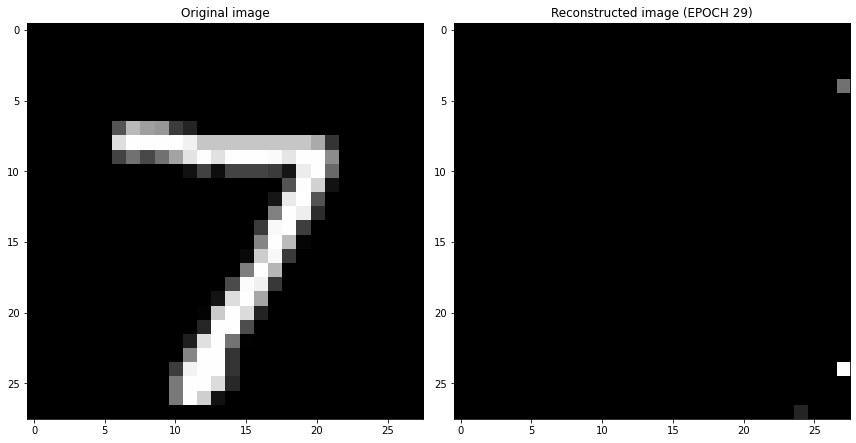

EPOCH 30/30
	 partial train loss (single batch): 0.113902
	 partial train loss (single batch): 0.112726
	 partial train loss (single batch): 0.109369
	 partial train loss (single batch): 0.111036
	 partial train loss (single batch): 0.111315
	 partial train loss (single batch): 0.110275
	 partial train loss (single batch): 0.107234
	 partial train loss (single batch): 0.111769
	 partial train loss (single batch): 0.112538
	 partial train loss (single batch): 0.109233
	 partial train loss (single batch): 0.115555
	 partial train loss (single batch): 0.113835
	 partial train loss (single batch): 0.112503
	 partial train loss (single batch): 0.114014
	 partial train loss (single batch): 0.115649
	 partial train loss (single batch): 0.112553
	 partial train loss (single batch): 0.116299
	 partial train loss (single batch): 0.108286
	 partial train loss (single batch): 0.114917
	 partial train loss (single batch): 0.110982
	 partial train loss (single batch): 0.114601
	 partial train loss (

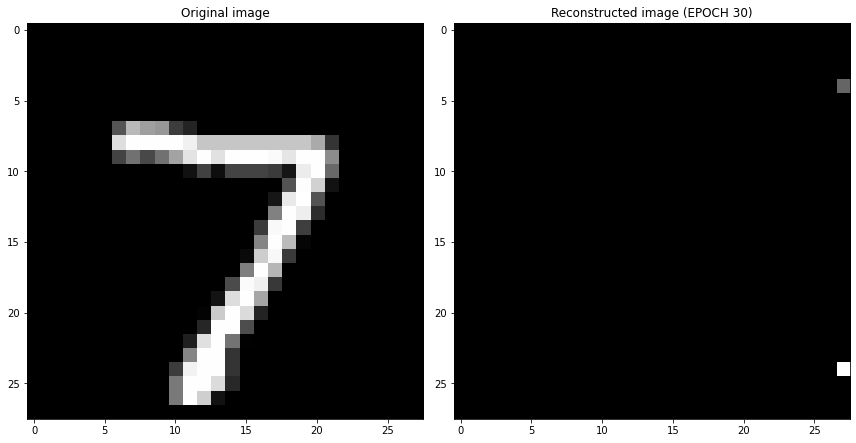

Cross validation fold number= 2/6
EPOCH 1/30
	 partial train loss (single batch): 0.227887
	 partial train loss (single batch): 0.120829
	 partial train loss (single batch): 0.111631
	 partial train loss (single batch): 0.117430
	 partial train loss (single batch): 0.111503
	 partial train loss (single batch): 0.110494
	 partial train loss (single batch): 0.109927
	 partial train loss (single batch): 0.111659
	 partial train loss (single batch): 0.109981
	 partial train loss (single batch): 0.112711
	 partial train loss (single batch): 0.110646
	 partial train loss (single batch): 0.112261
	 partial train loss (single batch): 0.114554
	 partial train loss (single batch): 0.112589
	 partial train loss (single batch): 0.109413
	 partial train loss (single batch): 0.112331
	 partial train loss (single batch): 0.111116
	 partial train loss (single batch): 0.116113
	 partial train loss (single batch): 0.111448
	 partial train loss (single batch): 0.111940
	 partial train loss (single batch)

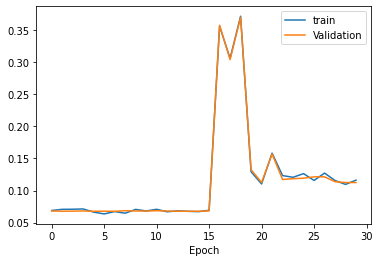

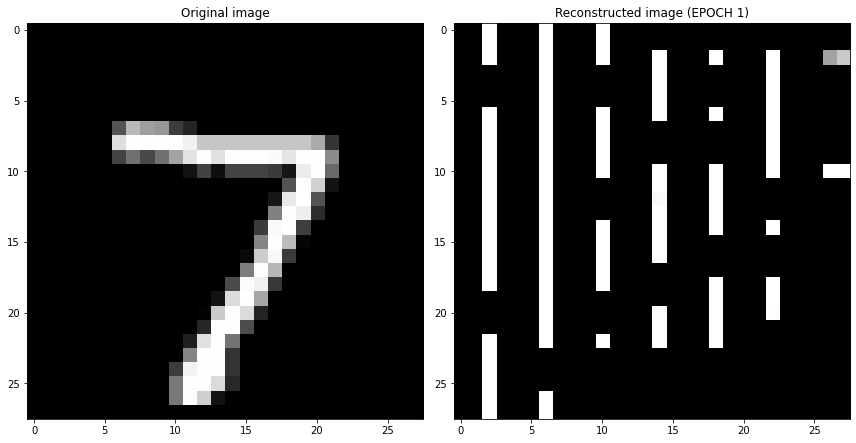

EPOCH 2/30
	 partial train loss (single batch): 0.111122
	 partial train loss (single batch): 0.107583
	 partial train loss (single batch): 0.107864
	 partial train loss (single batch): 0.117555
	 partial train loss (single batch): 0.118279
	 partial train loss (single batch): 0.117970
	 partial train loss (single batch): 0.130610
	 partial train loss (single batch): 0.133361
	 partial train loss (single batch): 0.137993
	 partial train loss (single batch): 0.140681
	 partial train loss (single batch): 0.137945
	 partial train loss (single batch): 0.133773
	 partial train loss (single batch): 0.136597
	 partial train loss (single batch): 0.136067
	 partial train loss (single batch): 0.137173
	 partial train loss (single batch): 0.139125
	 partial train loss (single batch): 0.145314
	 partial train loss (single batch): 0.136677
	 partial train loss (single batch): 0.135693
	 partial train loss (single batch): 0.134927
	 partial train loss (single batch): 0.137789
	 partial train loss (s

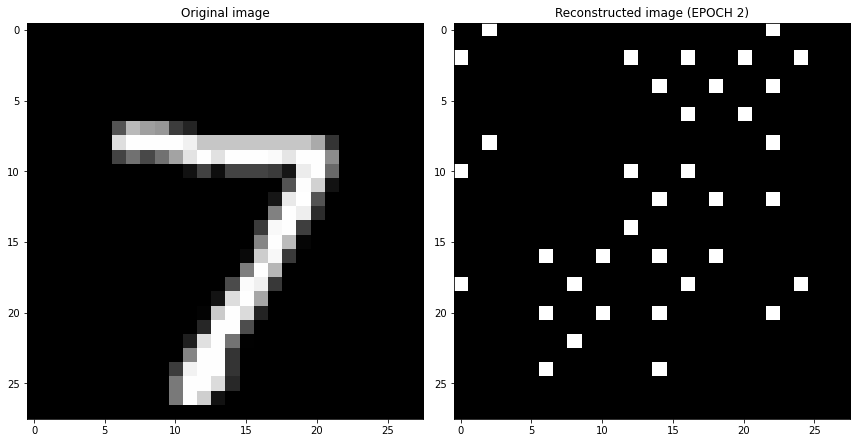

EPOCH 3/30
	 partial train loss (single batch): 0.108726
	 partial train loss (single batch): 0.108467
	 partial train loss (single batch): 0.110891
	 partial train loss (single batch): 0.110850
	 partial train loss (single batch): 0.110294
	 partial train loss (single batch): 0.110370
	 partial train loss (single batch): 0.113435
	 partial train loss (single batch): 0.112295
	 partial train loss (single batch): 0.113894
	 partial train loss (single batch): 0.107318
	 partial train loss (single batch): 0.108289
	 partial train loss (single batch): 0.111171
	 partial train loss (single batch): 0.104333
	 partial train loss (single batch): 0.110705
	 partial train loss (single batch): 0.111561
	 partial train loss (single batch): 0.111636
	 partial train loss (single batch): 0.110717
	 partial train loss (single batch): 0.112931
	 partial train loss (single batch): 0.114284
	 partial train loss (single batch): 0.108069
	 partial train loss (single batch): 0.110150
	 partial train loss (s

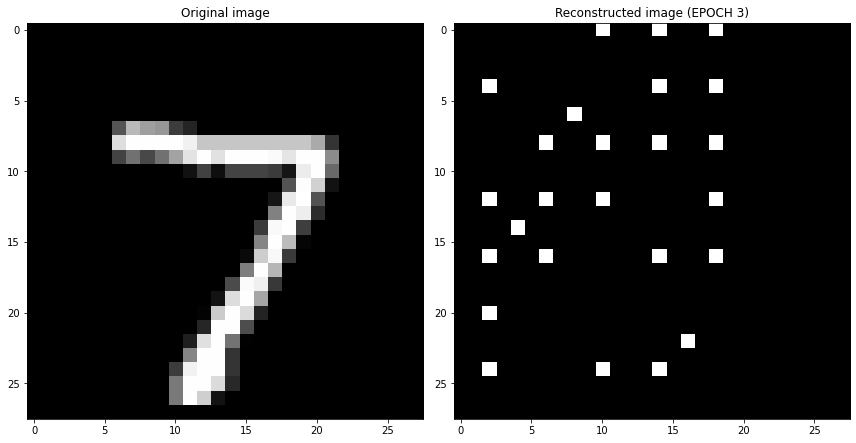

EPOCH 4/30
	 partial train loss (single batch): 0.113164
	 partial train loss (single batch): 0.111010
	 partial train loss (single batch): 0.110669
	 partial train loss (single batch): 0.109291
	 partial train loss (single batch): 0.108702
	 partial train loss (single batch): 0.112141
	 partial train loss (single batch): 0.108956
	 partial train loss (single batch): 0.109191
	 partial train loss (single batch): 0.113392
	 partial train loss (single batch): 0.105859
	 partial train loss (single batch): 0.104046
	 partial train loss (single batch): 0.111360
	 partial train loss (single batch): 0.109195
	 partial train loss (single batch): 0.115782
	 partial train loss (single batch): 0.109552
	 partial train loss (single batch): 0.105033
	 partial train loss (single batch): 0.114094
	 partial train loss (single batch): 0.109397
	 partial train loss (single batch): 0.110318
	 partial train loss (single batch): 0.108024
	 partial train loss (single batch): 0.107802
	 partial train loss (s

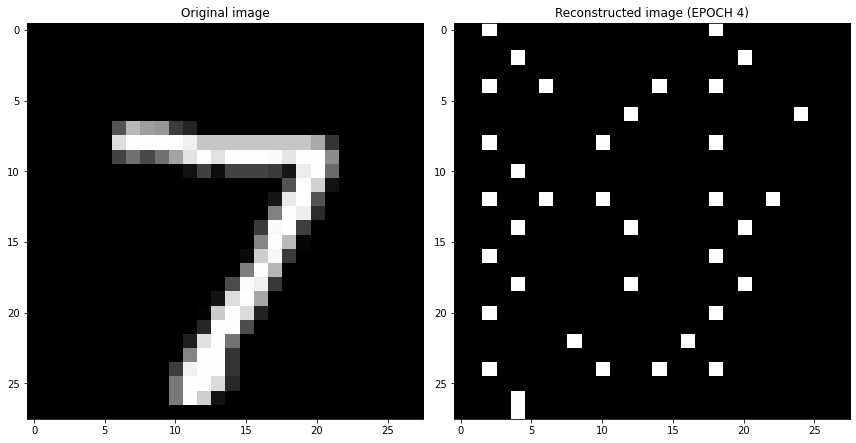

EPOCH 5/30
	 partial train loss (single batch): 0.108561
	 partial train loss (single batch): 0.111083
	 partial train loss (single batch): 0.106357
	 partial train loss (single batch): 0.111296
	 partial train loss (single batch): 0.110485
	 partial train loss (single batch): 0.109659
	 partial train loss (single batch): 0.113231
	 partial train loss (single batch): 0.106923
	 partial train loss (single batch): 0.113960
	 partial train loss (single batch): 0.115887
	 partial train loss (single batch): 0.109881
	 partial train loss (single batch): 0.112511
	 partial train loss (single batch): 0.111823
	 partial train loss (single batch): 0.107437
	 partial train loss (single batch): 0.108208
	 partial train loss (single batch): 0.114627
	 partial train loss (single batch): 0.110363
	 partial train loss (single batch): 0.113175
	 partial train loss (single batch): 0.111808
	 partial train loss (single batch): 0.107438
	 partial train loss (single batch): 0.107325
	 partial train loss (s

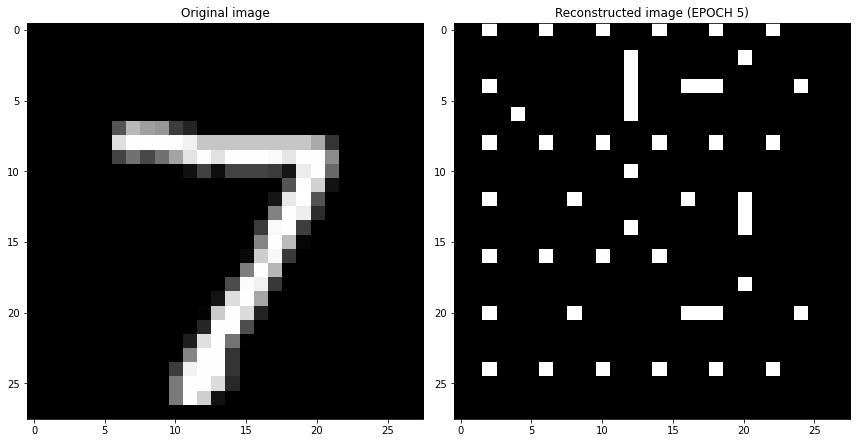

EPOCH 6/30
	 partial train loss (single batch): 0.111116
	 partial train loss (single batch): 0.112846
	 partial train loss (single batch): 0.108915
	 partial train loss (single batch): 0.112224
	 partial train loss (single batch): 0.109898
	 partial train loss (single batch): 0.110993
	 partial train loss (single batch): 0.109990
	 partial train loss (single batch): 0.107218
	 partial train loss (single batch): 0.107858
	 partial train loss (single batch): 0.106361
	 partial train loss (single batch): 0.110841
	 partial train loss (single batch): 0.106521
	 partial train loss (single batch): 0.106651
	 partial train loss (single batch): 0.112048
	 partial train loss (single batch): 0.108836
	 partial train loss (single batch): 0.111039
	 partial train loss (single batch): 0.106060
	 partial train loss (single batch): 0.106387
	 partial train loss (single batch): 0.112970
	 partial train loss (single batch): 0.108114
	 partial train loss (single batch): 0.110400
	 partial train loss (s

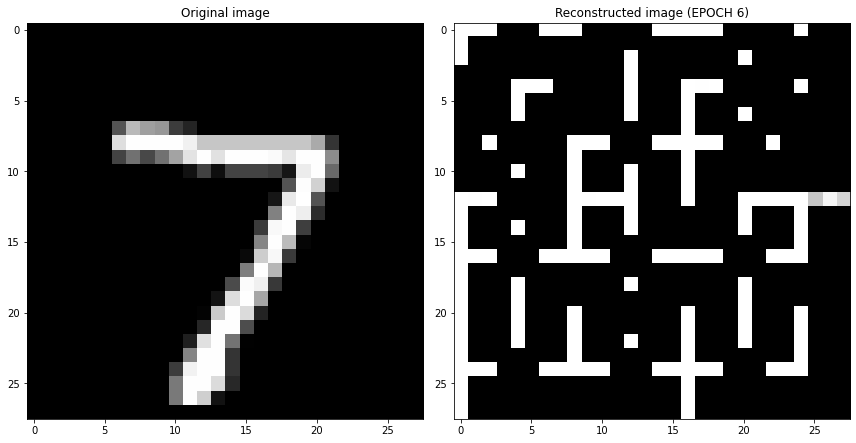

EPOCH 7/30
	 partial train loss (single batch): 0.106751
	 partial train loss (single batch): 0.108699
	 partial train loss (single batch): 0.107008
	 partial train loss (single batch): 0.110255
	 partial train loss (single batch): 0.110216
	 partial train loss (single batch): 0.110519
	 partial train loss (single batch): 0.105482
	 partial train loss (single batch): 0.110636
	 partial train loss (single batch): 0.107741
	 partial train loss (single batch): 0.107350
	 partial train loss (single batch): 0.107063
	 partial train loss (single batch): 0.110261
	 partial train loss (single batch): 0.107515
	 partial train loss (single batch): 0.109147
	 partial train loss (single batch): 0.107004
	 partial train loss (single batch): 0.108565
	 partial train loss (single batch): 0.106711
	 partial train loss (single batch): 0.109885
	 partial train loss (single batch): 0.106225
	 partial train loss (single batch): 0.111611
	 partial train loss (single batch): 0.109574
	 partial train loss (s

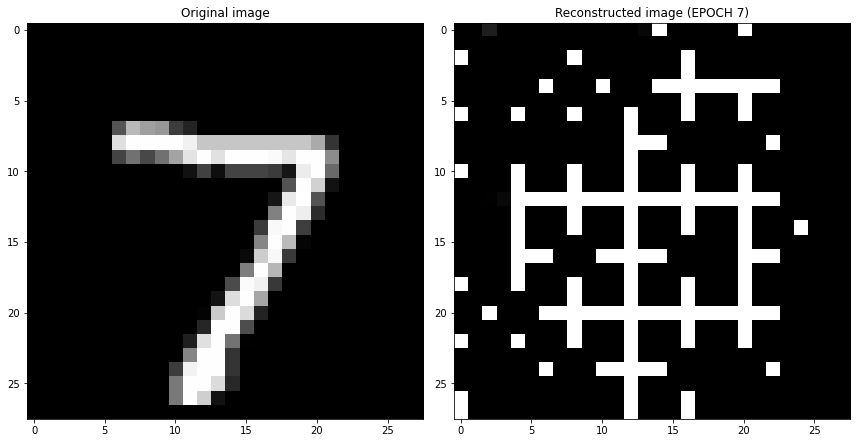

EPOCH 8/30
	 partial train loss (single batch): 0.103865
	 partial train loss (single batch): 0.104444
	 partial train loss (single batch): 0.104805
	 partial train loss (single batch): 0.102775
	 partial train loss (single batch): 0.103609
	 partial train loss (single batch): 0.102315
	 partial train loss (single batch): 0.105007
	 partial train loss (single batch): 0.101050
	 partial train loss (single batch): 0.100711
	 partial train loss (single batch): 0.104799
	 partial train loss (single batch): 0.106466
	 partial train loss (single batch): 0.097176
	 partial train loss (single batch): 0.102700
	 partial train loss (single batch): 0.104131
	 partial train loss (single batch): 0.102457
	 partial train loss (single batch): 0.103078
	 partial train loss (single batch): 0.103793
	 partial train loss (single batch): 0.102795
	 partial train loss (single batch): 0.099788
	 partial train loss (single batch): 0.104656
	 partial train loss (single batch): 0.099850
	 partial train loss (s

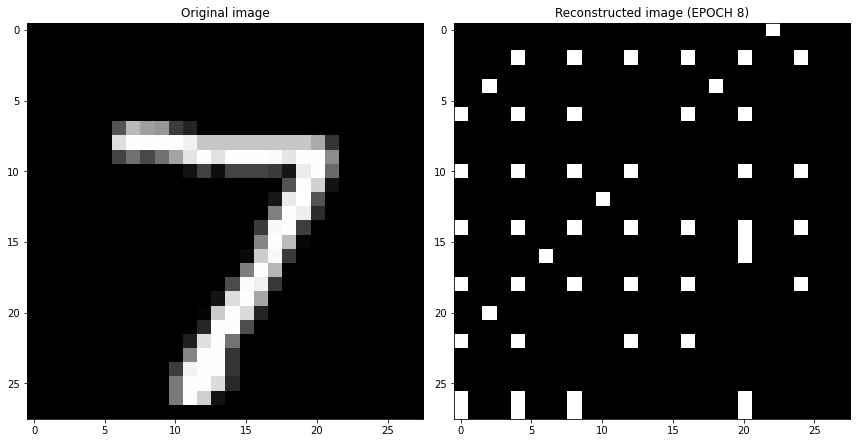

EPOCH 9/30
	 partial train loss (single batch): 0.110425
	 partial train loss (single batch): 0.110356
	 partial train loss (single batch): 0.108104
	 partial train loss (single batch): 0.110579
	 partial train loss (single batch): 0.112921
	 partial train loss (single batch): 0.108205
	 partial train loss (single batch): 0.110715
	 partial train loss (single batch): 0.114085
	 partial train loss (single batch): 0.109353
	 partial train loss (single batch): 0.115574
	 partial train loss (single batch): 0.108299
	 partial train loss (single batch): 0.110808
	 partial train loss (single batch): 0.111681
	 partial train loss (single batch): 0.107755
	 partial train loss (single batch): 0.110329
	 partial train loss (single batch): 0.113422
	 partial train loss (single batch): 0.114608
	 partial train loss (single batch): 0.109841
	 partial train loss (single batch): 0.108888
	 partial train loss (single batch): 0.106980
	 partial train loss (single batch): 0.108380
	 partial train loss (s

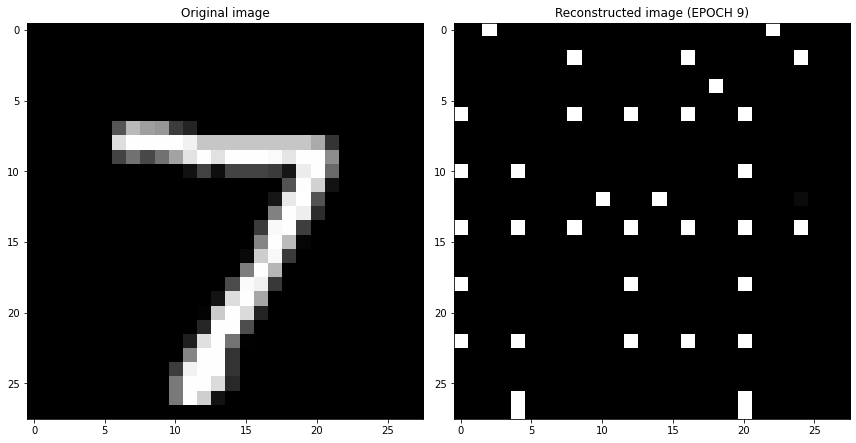

EPOCH 10/30
	 partial train loss (single batch): 0.107012
	 partial train loss (single batch): 0.112219
	 partial train loss (single batch): 0.111509
	 partial train loss (single batch): 0.107206
	 partial train loss (single batch): 0.107189
	 partial train loss (single batch): 0.110011
	 partial train loss (single batch): 0.110900
	 partial train loss (single batch): 0.109775
	 partial train loss (single batch): 0.109962
	 partial train loss (single batch): 0.109193
	 partial train loss (single batch): 0.110841
	 partial train loss (single batch): 0.109074
	 partial train loss (single batch): 0.112218
	 partial train loss (single batch): 0.111587
	 partial train loss (single batch): 0.111558
	 partial train loss (single batch): 0.106102
	 partial train loss (single batch): 0.111453
	 partial train loss (single batch): 0.110780
	 partial train loss (single batch): 0.109349
	 partial train loss (single batch): 0.109072
	 partial train loss (single batch): 0.107646
	 partial train loss (

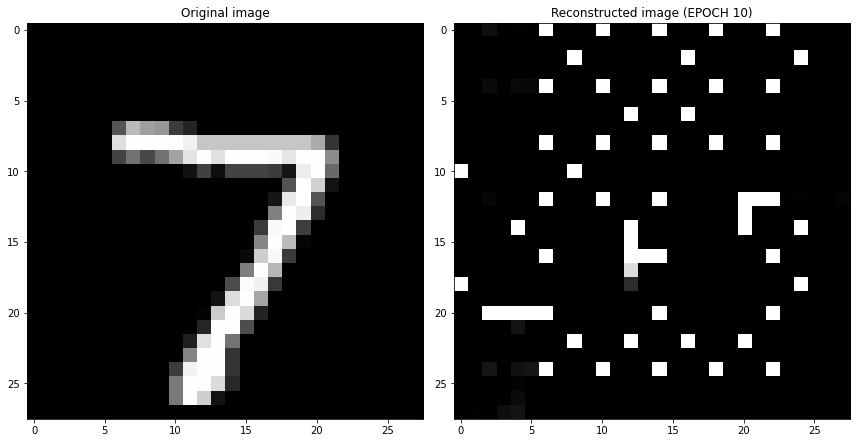

EPOCH 11/30
	 partial train loss (single batch): 0.110419
	 partial train loss (single batch): 0.111681
	 partial train loss (single batch): 0.111969
	 partial train loss (single batch): 0.107674
	 partial train loss (single batch): 0.108669
	 partial train loss (single batch): 0.112295
	 partial train loss (single batch): 0.105171
	 partial train loss (single batch): 0.112137
	 partial train loss (single batch): 0.111819
	 partial train loss (single batch): 0.108246
	 partial train loss (single batch): 0.106079
	 partial train loss (single batch): 0.110376
	 partial train loss (single batch): 0.107521
	 partial train loss (single batch): 0.105633
	 partial train loss (single batch): 0.112393
	 partial train loss (single batch): 0.113218
	 partial train loss (single batch): 0.107372
	 partial train loss (single batch): 0.105972
	 partial train loss (single batch): 0.112388
	 partial train loss (single batch): 0.111719
	 partial train loss (single batch): 0.114161
	 partial train loss (

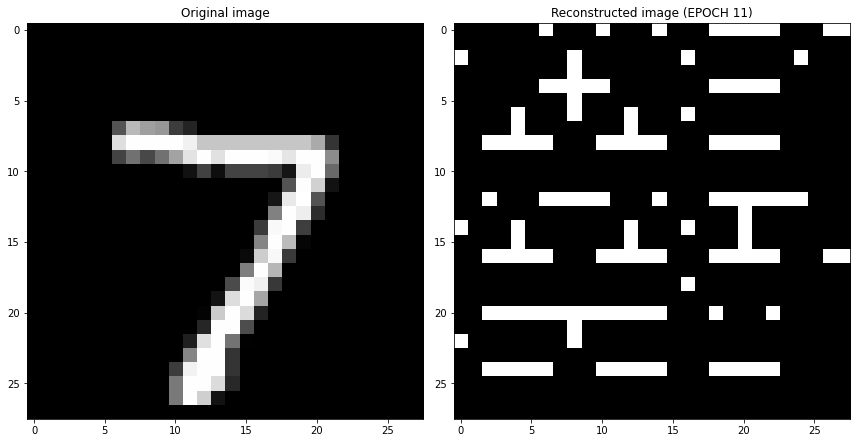

EPOCH 12/30
	 partial train loss (single batch): 0.109585
	 partial train loss (single batch): 0.108499
	 partial train loss (single batch): 0.101278
	 partial train loss (single batch): 0.107286
	 partial train loss (single batch): 0.111394
	 partial train loss (single batch): 0.106920
	 partial train loss (single batch): 0.106576
	 partial train loss (single batch): 0.107376
	 partial train loss (single batch): 0.107161
	 partial train loss (single batch): 0.105540
	 partial train loss (single batch): 0.109746
	 partial train loss (single batch): 0.106754
	 partial train loss (single batch): 0.109480
	 partial train loss (single batch): 0.110998
	 partial train loss (single batch): 0.109791
	 partial train loss (single batch): 0.106493
	 partial train loss (single batch): 0.110954
	 partial train loss (single batch): 0.110083
	 partial train loss (single batch): 0.104912
	 partial train loss (single batch): 0.109484
	 partial train loss (single batch): 0.110282
	 partial train loss (

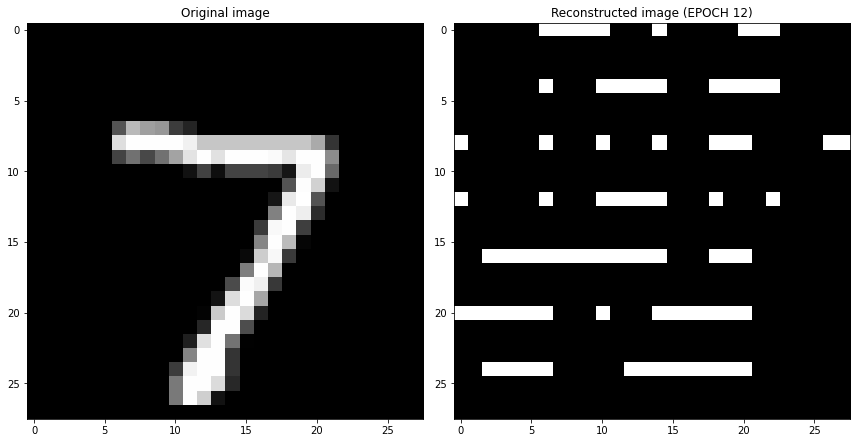

EPOCH 13/30
	 partial train loss (single batch): 0.110865
	 partial train loss (single batch): 0.113644
	 partial train loss (single batch): 0.113553
	 partial train loss (single batch): 0.110359
	 partial train loss (single batch): 0.108868
	 partial train loss (single batch): 0.106908
	 partial train loss (single batch): 0.109128
	 partial train loss (single batch): 0.111152
	 partial train loss (single batch): 0.109468
	 partial train loss (single batch): 0.112758
	 partial train loss (single batch): 0.109502
	 partial train loss (single batch): 0.110963
	 partial train loss (single batch): 0.107622
	 partial train loss (single batch): 0.110309
	 partial train loss (single batch): 0.109631
	 partial train loss (single batch): 0.110371
	 partial train loss (single batch): 0.107176
	 partial train loss (single batch): 0.104851
	 partial train loss (single batch): 0.108164
	 partial train loss (single batch): 0.103817
	 partial train loss (single batch): 0.107763
	 partial train loss (

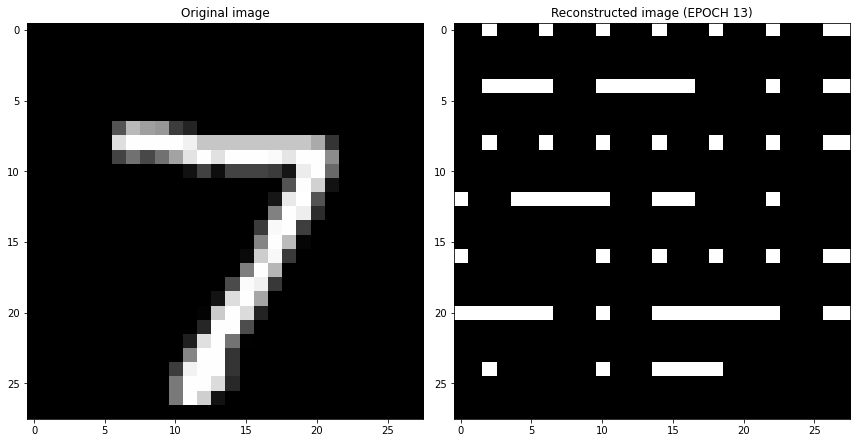

EPOCH 14/30
	 partial train loss (single batch): 0.109922
	 partial train loss (single batch): 0.111533
	 partial train loss (single batch): 0.109134
	 partial train loss (single batch): 0.113186
	 partial train loss (single batch): 0.109925
	 partial train loss (single batch): 0.104596
	 partial train loss (single batch): 0.107112
	 partial train loss (single batch): 0.109901
	 partial train loss (single batch): 0.108837
	 partial train loss (single batch): 0.109185
	 partial train loss (single batch): 0.105838
	 partial train loss (single batch): 0.106662
	 partial train loss (single batch): 0.110850
	 partial train loss (single batch): 0.106860
	 partial train loss (single batch): 0.110391
	 partial train loss (single batch): 0.111851
	 partial train loss (single batch): 0.112197
	 partial train loss (single batch): 0.112139
	 partial train loss (single batch): 0.106765
	 partial train loss (single batch): 0.108819
	 partial train loss (single batch): 0.106212
	 partial train loss (

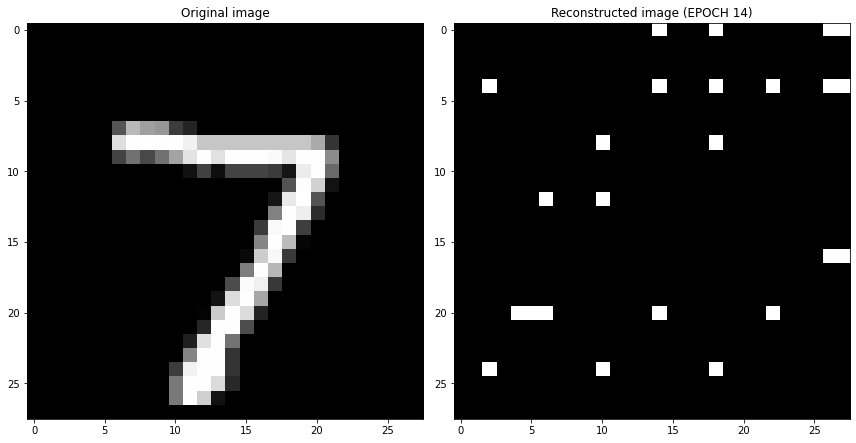

EPOCH 15/30
	 partial train loss (single batch): 0.112513
	 partial train loss (single batch): 0.110298
	 partial train loss (single batch): 0.105220
	 partial train loss (single batch): 0.112191
	 partial train loss (single batch): 0.112949
	 partial train loss (single batch): 0.109140
	 partial train loss (single batch): 0.109373
	 partial train loss (single batch): 0.115258
	 partial train loss (single batch): 0.110367
	 partial train loss (single batch): 0.111450
	 partial train loss (single batch): 0.109020
	 partial train loss (single batch): 0.115480
	 partial train loss (single batch): 0.110588
	 partial train loss (single batch): 0.111281
	 partial train loss (single batch): 0.110916
	 partial train loss (single batch): 0.112352
	 partial train loss (single batch): 0.109210
	 partial train loss (single batch): 0.115572
	 partial train loss (single batch): 0.115795
	 partial train loss (single batch): 0.108637
	 partial train loss (single batch): 0.108712
	 partial train loss (

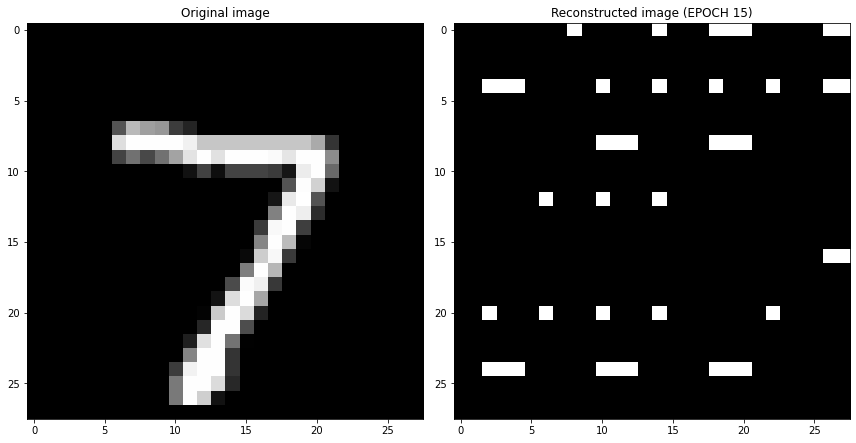

EPOCH 16/30
	 partial train loss (single batch): 0.113016
	 partial train loss (single batch): 0.110727
	 partial train loss (single batch): 0.107482
	 partial train loss (single batch): 0.110748
	 partial train loss (single batch): 0.110137
	 partial train loss (single batch): 0.114427
	 partial train loss (single batch): 0.107881
	 partial train loss (single batch): 0.114648
	 partial train loss (single batch): 0.108410
	 partial train loss (single batch): 0.109720
	 partial train loss (single batch): 0.115787
	 partial train loss (single batch): 0.108341
	 partial train loss (single batch): 0.109408
	 partial train loss (single batch): 0.108873
	 partial train loss (single batch): 0.108937
	 partial train loss (single batch): 0.111864
	 partial train loss (single batch): 0.109604
	 partial train loss (single batch): 0.114553
	 partial train loss (single batch): 0.111077
	 partial train loss (single batch): 0.108127
	 partial train loss (single batch): 0.113296
	 partial train loss (

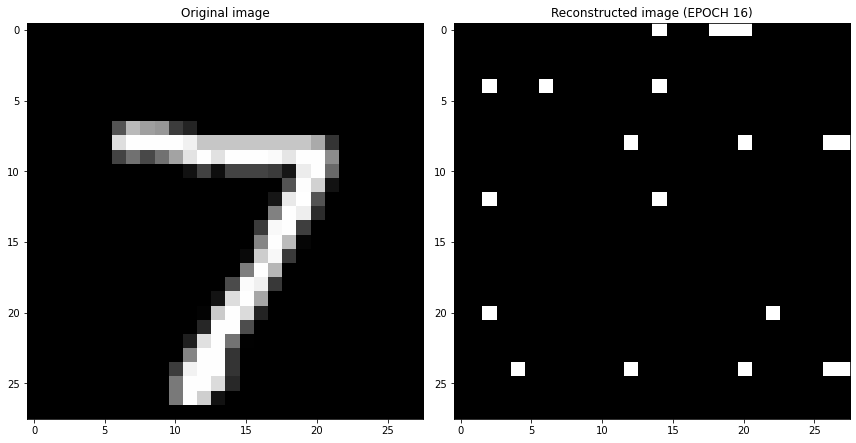

EPOCH 17/30
	 partial train loss (single batch): 0.112912
	 partial train loss (single batch): 0.111582
	 partial train loss (single batch): 0.113192
	 partial train loss (single batch): 0.111784
	 partial train loss (single batch): 0.115172
	 partial train loss (single batch): 0.108572
	 partial train loss (single batch): 0.110818
	 partial train loss (single batch): 0.112374
	 partial train loss (single batch): 0.113844
	 partial train loss (single batch): 0.113579
	 partial train loss (single batch): 0.111160
	 partial train loss (single batch): 0.111150
	 partial train loss (single batch): 0.108553
	 partial train loss (single batch): 0.108719
	 partial train loss (single batch): 0.111688
	 partial train loss (single batch): 0.112241
	 partial train loss (single batch): 0.108219
	 partial train loss (single batch): 0.109919
	 partial train loss (single batch): 0.112513
	 partial train loss (single batch): 0.111137
	 partial train loss (single batch): 0.112028
	 partial train loss (

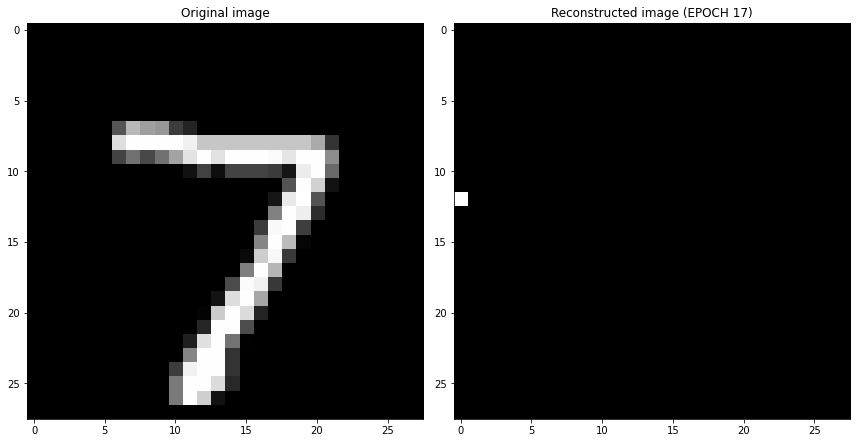

EPOCH 18/30
	 partial train loss (single batch): 0.111109
	 partial train loss (single batch): 0.110567
	 partial train loss (single batch): 0.106333
	 partial train loss (single batch): 0.106748
	 partial train loss (single batch): 0.114070
	 partial train loss (single batch): 0.112532
	 partial train loss (single batch): 0.109848
	 partial train loss (single batch): 0.113057
	 partial train loss (single batch): 0.110305
	 partial train loss (single batch): 0.110593
	 partial train loss (single batch): 0.108317
	 partial train loss (single batch): 0.109710
	 partial train loss (single batch): 0.112655
	 partial train loss (single batch): 0.109309
	 partial train loss (single batch): 0.108773
	 partial train loss (single batch): 0.109106
	 partial train loss (single batch): 0.111099
	 partial train loss (single batch): 0.114330
	 partial train loss (single batch): 0.113476
	 partial train loss (single batch): 0.112652
	 partial train loss (single batch): 0.111502
	 partial train loss (

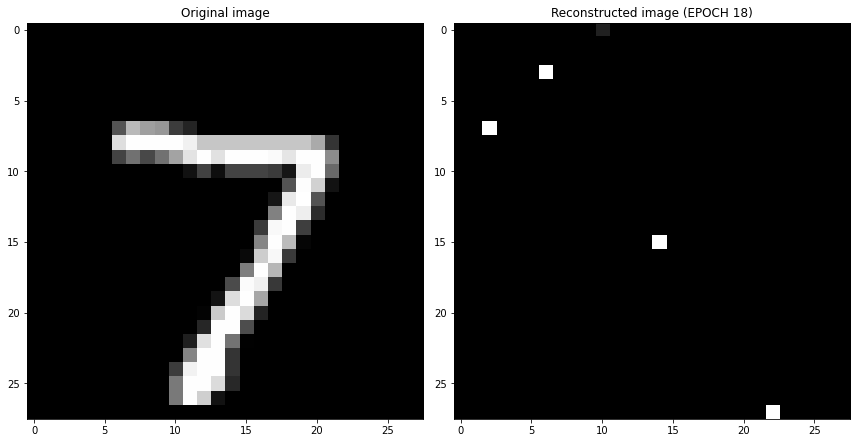

EPOCH 19/30
	 partial train loss (single batch): 0.111097
	 partial train loss (single batch): 0.112856
	 partial train loss (single batch): 0.118150
	 partial train loss (single batch): 0.116028
	 partial train loss (single batch): 0.112948
	 partial train loss (single batch): 0.118434
	 partial train loss (single batch): 0.114475
	 partial train loss (single batch): 0.114441
	 partial train loss (single batch): 0.117666
	 partial train loss (single batch): 0.121353
	 partial train loss (single batch): 0.116803
	 partial train loss (single batch): 0.118093
	 partial train loss (single batch): 0.118693
	 partial train loss (single batch): 0.117795
	 partial train loss (single batch): 0.112936
	 partial train loss (single batch): 0.108493
	 partial train loss (single batch): 0.117220
	 partial train loss (single batch): 0.115804
	 partial train loss (single batch): 0.117088
	 partial train loss (single batch): 0.111351
	 partial train loss (single batch): 0.117043
	 partial train loss (

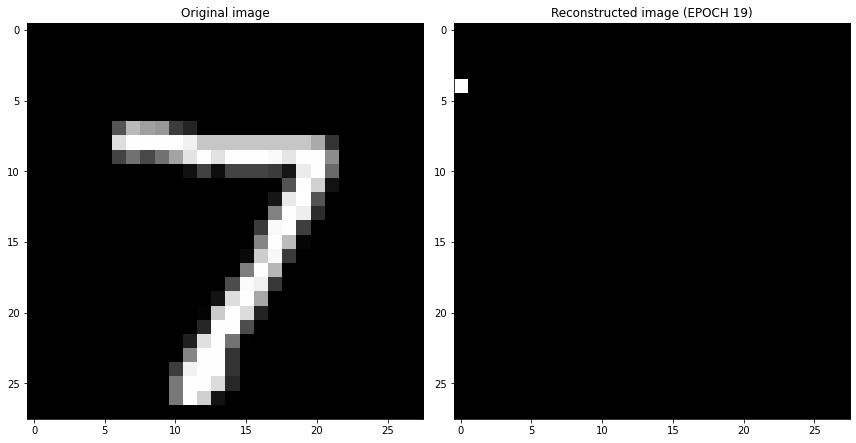

EPOCH 20/30
	 partial train loss (single batch): 0.111786
	 partial train loss (single batch): 0.112515
	 partial train loss (single batch): 0.113770
	 partial train loss (single batch): 0.106954
	 partial train loss (single batch): 0.110564
	 partial train loss (single batch): 0.113018
	 partial train loss (single batch): 0.115501
	 partial train loss (single batch): 0.112444
	 partial train loss (single batch): 0.113173
	 partial train loss (single batch): 0.113868
	 partial train loss (single batch): 0.110610
	 partial train loss (single batch): 0.109048
	 partial train loss (single batch): 0.114602
	 partial train loss (single batch): 0.112146
	 partial train loss (single batch): 0.110987
	 partial train loss (single batch): 0.111989
	 partial train loss (single batch): 0.109720
	 partial train loss (single batch): 0.112109
	 partial train loss (single batch): 0.112455
	 partial train loss (single batch): 0.108956
	 partial train loss (single batch): 0.111198
	 partial train loss (

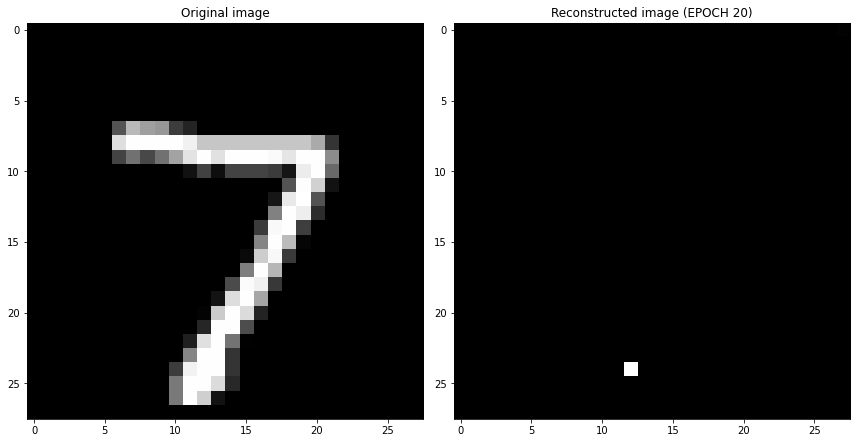

EPOCH 21/30
	 partial train loss (single batch): 0.115601
	 partial train loss (single batch): 0.111191
	 partial train loss (single batch): 0.113568
	 partial train loss (single batch): 0.112457
	 partial train loss (single batch): 0.109085
	 partial train loss (single batch): 0.113154
	 partial train loss (single batch): 0.110062
	 partial train loss (single batch): 0.113013
	 partial train loss (single batch): 0.112671
	 partial train loss (single batch): 0.112343
	 partial train loss (single batch): 0.113480
	 partial train loss (single batch): 0.112667
	 partial train loss (single batch): 0.110940
	 partial train loss (single batch): 0.113897
	 partial train loss (single batch): 0.109365
	 partial train loss (single batch): 0.110359
	 partial train loss (single batch): 0.108438
	 partial train loss (single batch): 0.109744
	 partial train loss (single batch): 0.114388
	 partial train loss (single batch): 0.106906
	 partial train loss (single batch): 0.110138
	 partial train loss (

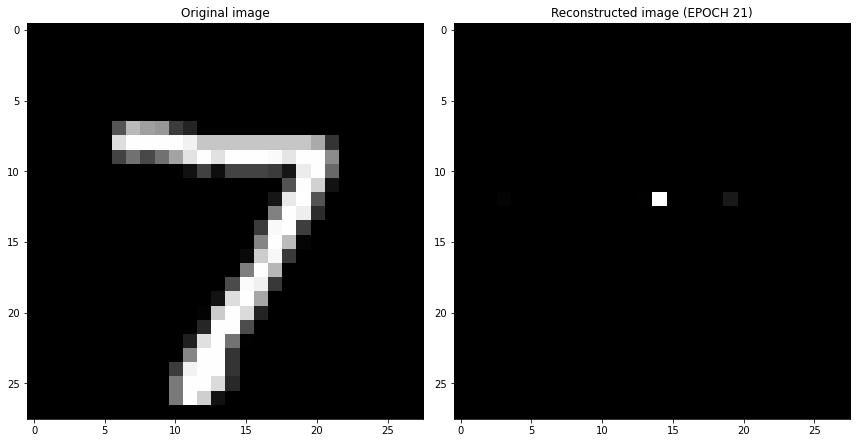

EPOCH 22/30
	 partial train loss (single batch): 0.110400
	 partial train loss (single batch): 0.112588
	 partial train loss (single batch): 0.107990
	 partial train loss (single batch): 0.110939
	 partial train loss (single batch): 0.115305
	 partial train loss (single batch): 0.108469
	 partial train loss (single batch): 0.109383
	 partial train loss (single batch): 0.108665
	 partial train loss (single batch): 0.111254
	 partial train loss (single batch): 0.112781
	 partial train loss (single batch): 0.111395
	 partial train loss (single batch): 0.108762
	 partial train loss (single batch): 0.117403
	 partial train loss (single batch): 0.115153
	 partial train loss (single batch): 0.115100
	 partial train loss (single batch): 0.112766
	 partial train loss (single batch): 0.110370
	 partial train loss (single batch): 0.112836
	 partial train loss (single batch): 0.113548
	 partial train loss (single batch): 0.116524
	 partial train loss (single batch): 0.116363
	 partial train loss (

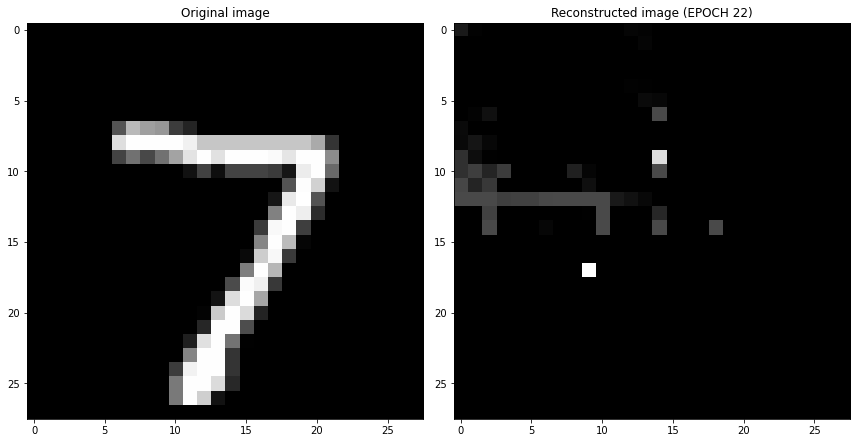

EPOCH 23/30
	 partial train loss (single batch): 0.109444
	 partial train loss (single batch): 0.108993
	 partial train loss (single batch): 0.111916
	 partial train loss (single batch): 0.111980
	 partial train loss (single batch): 0.109759
	 partial train loss (single batch): 0.108547
	 partial train loss (single batch): 0.116346
	 partial train loss (single batch): 0.115121
	 partial train loss (single batch): 0.109826
	 partial train loss (single batch): 0.108614
	 partial train loss (single batch): 0.108630
	 partial train loss (single batch): 0.112069
	 partial train loss (single batch): 0.109961
	 partial train loss (single batch): 0.114655
	 partial train loss (single batch): 0.106997
	 partial train loss (single batch): 0.106921
	 partial train loss (single batch): 0.107714
	 partial train loss (single batch): 0.114005
	 partial train loss (single batch): 0.107917
	 partial train loss (single batch): 0.110885
	 partial train loss (single batch): 0.113948
	 partial train loss (

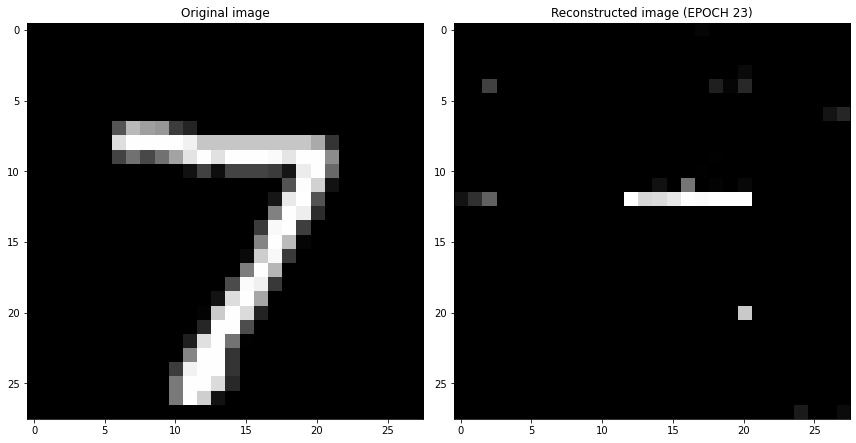

EPOCH 24/30
	 partial train loss (single batch): 0.108126
	 partial train loss (single batch): 0.113276
	 partial train loss (single batch): 0.111436
	 partial train loss (single batch): 0.111516
	 partial train loss (single batch): 0.110142
	 partial train loss (single batch): 0.106483
	 partial train loss (single batch): 0.109217
	 partial train loss (single batch): 0.109116
	 partial train loss (single batch): 0.114155
	 partial train loss (single batch): 0.111608
	 partial train loss (single batch): 0.117033
	 partial train loss (single batch): 0.114484
	 partial train loss (single batch): 0.108610
	 partial train loss (single batch): 0.110225
	 partial train loss (single batch): 0.109179
	 partial train loss (single batch): 0.113097
	 partial train loss (single batch): 0.112542
	 partial train loss (single batch): 0.113262
	 partial train loss (single batch): 0.117586
	 partial train loss (single batch): 0.107289
	 partial train loss (single batch): 0.114189
	 partial train loss (

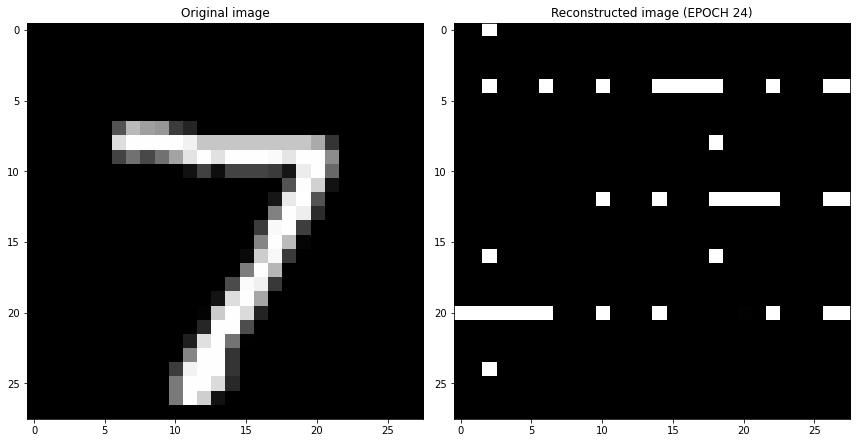

EPOCH 25/30
	 partial train loss (single batch): 0.115270
	 partial train loss (single batch): 0.102571
	 partial train loss (single batch): 0.110289
	 partial train loss (single batch): 0.111526
	 partial train loss (single batch): 0.110824
	 partial train loss (single batch): 0.109915
	 partial train loss (single batch): 0.106847
	 partial train loss (single batch): 0.107903
	 partial train loss (single batch): 0.117417
	 partial train loss (single batch): 0.111333
	 partial train loss (single batch): 0.108718
	 partial train loss (single batch): 0.111072
	 partial train loss (single batch): 0.111451
	 partial train loss (single batch): 0.112537
	 partial train loss (single batch): 0.111645
	 partial train loss (single batch): 0.108267
	 partial train loss (single batch): 0.110901
	 partial train loss (single batch): 0.112663
	 partial train loss (single batch): 0.110519
	 partial train loss (single batch): 0.113822
	 partial train loss (single batch): 0.111047
	 partial train loss (

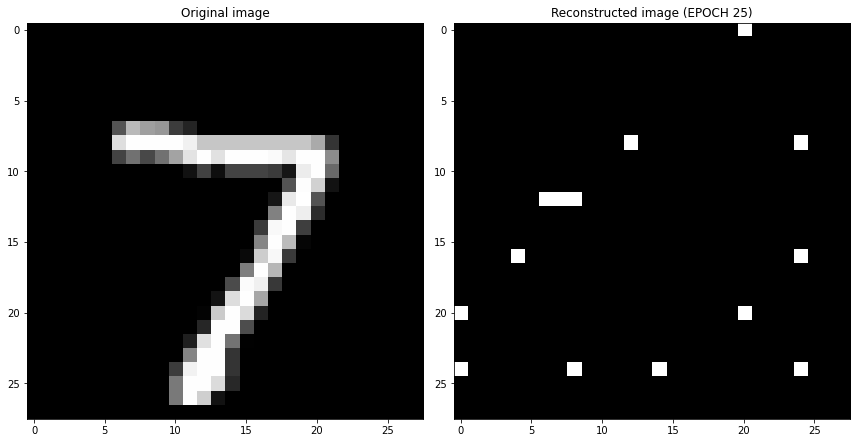

EPOCH 26/30
	 partial train loss (single batch): 0.115458
	 partial train loss (single batch): 0.111203
	 partial train loss (single batch): 0.106239
	 partial train loss (single batch): 0.113750
	 partial train loss (single batch): 0.115541
	 partial train loss (single batch): 0.112463
	 partial train loss (single batch): 0.108165
	 partial train loss (single batch): 0.109787
	 partial train loss (single batch): 0.112281
	 partial train loss (single batch): 0.117313
	 partial train loss (single batch): 0.112336
	 partial train loss (single batch): 0.106782
	 partial train loss (single batch): 0.113971
	 partial train loss (single batch): 0.114091
	 partial train loss (single batch): 0.117235
	 partial train loss (single batch): 0.115412
	 partial train loss (single batch): 0.111786
	 partial train loss (single batch): 0.107662
	 partial train loss (single batch): 0.108684
	 partial train loss (single batch): 0.112548
	 partial train loss (single batch): 0.118164
	 partial train loss (

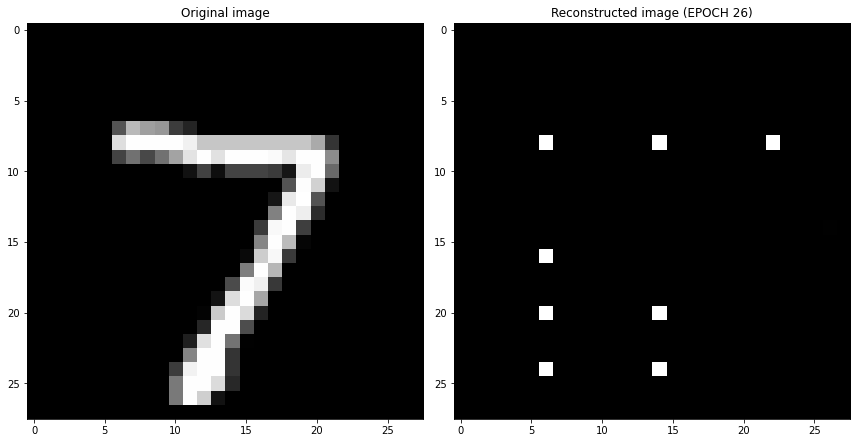

EPOCH 27/30
	 partial train loss (single batch): 0.111538
	 partial train loss (single batch): 0.112763
	 partial train loss (single batch): 0.111641
	 partial train loss (single batch): 0.113415
	 partial train loss (single batch): 0.114220
	 partial train loss (single batch): 0.113006
	 partial train loss (single batch): 0.112889
	 partial train loss (single batch): 0.109697
	 partial train loss (single batch): 0.115695
	 partial train loss (single batch): 0.111001
	 partial train loss (single batch): 0.112634
	 partial train loss (single batch): 0.113134
	 partial train loss (single batch): 0.112730
	 partial train loss (single batch): 0.115386
	 partial train loss (single batch): 0.109865
	 partial train loss (single batch): 0.109510
	 partial train loss (single batch): 0.112742
	 partial train loss (single batch): 0.111713
	 partial train loss (single batch): 0.111683
	 partial train loss (single batch): 0.110131
	 partial train loss (single batch): 0.113290
	 partial train loss (

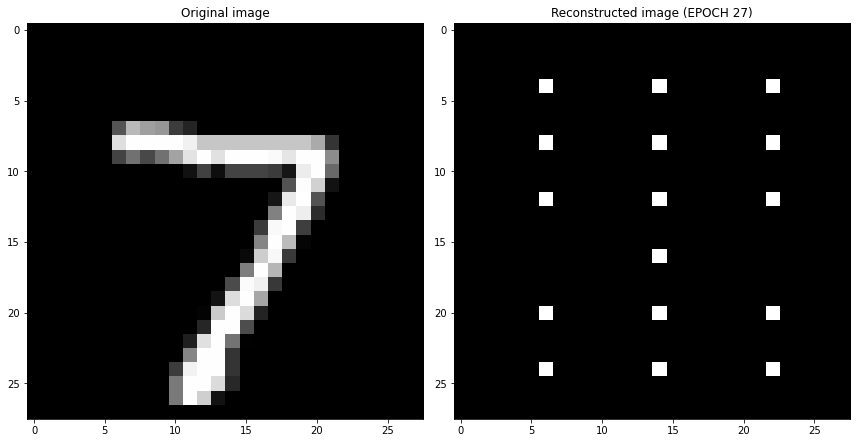

EPOCH 28/30
	 partial train loss (single batch): 0.110693
	 partial train loss (single batch): 0.114864
	 partial train loss (single batch): 0.104093
	 partial train loss (single batch): 0.109191
	 partial train loss (single batch): 0.107432
	 partial train loss (single batch): 0.107409
	 partial train loss (single batch): 0.113556
	 partial train loss (single batch): 0.112442
	 partial train loss (single batch): 0.107074
	 partial train loss (single batch): 0.110932
	 partial train loss (single batch): 0.113501
	 partial train loss (single batch): 0.108274
	 partial train loss (single batch): 0.110721
	 partial train loss (single batch): 0.108612
	 partial train loss (single batch): 0.110261
	 partial train loss (single batch): 0.109446
	 partial train loss (single batch): 0.112877
	 partial train loss (single batch): 0.111273
	 partial train loss (single batch): 0.112182
	 partial train loss (single batch): 0.109722
	 partial train loss (single batch): 0.107718
	 partial train loss (

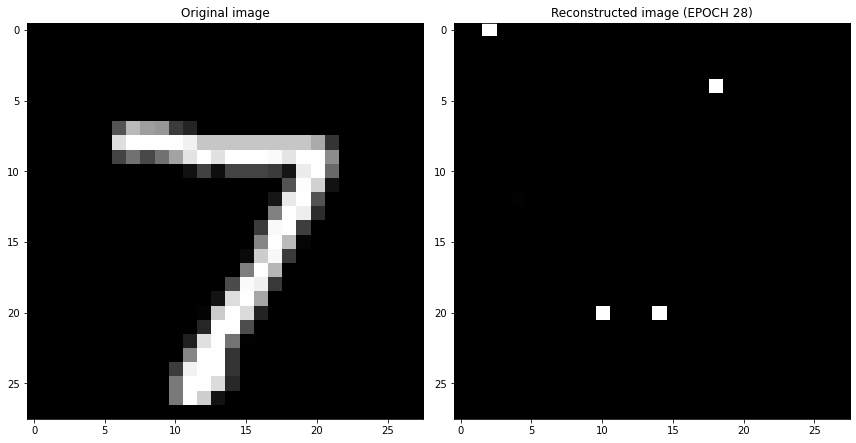

EPOCH 29/30
	 partial train loss (single batch): 0.110884
	 partial train loss (single batch): 0.114773
	 partial train loss (single batch): 0.115862
	 partial train loss (single batch): 0.111101
	 partial train loss (single batch): 0.111753
	 partial train loss (single batch): 0.109570
	 partial train loss (single batch): 0.112305
	 partial train loss (single batch): 0.113991
	 partial train loss (single batch): 0.111294
	 partial train loss (single batch): 0.113035
	 partial train loss (single batch): 0.108839
	 partial train loss (single batch): 0.118090
	 partial train loss (single batch): 0.106320
	 partial train loss (single batch): 0.111174
	 partial train loss (single batch): 0.106823
	 partial train loss (single batch): 0.112977
	 partial train loss (single batch): 0.113963
	 partial train loss (single batch): 0.111481
	 partial train loss (single batch): 0.113471
	 partial train loss (single batch): 0.112322
	 partial train loss (single batch): 0.109092
	 partial train loss (

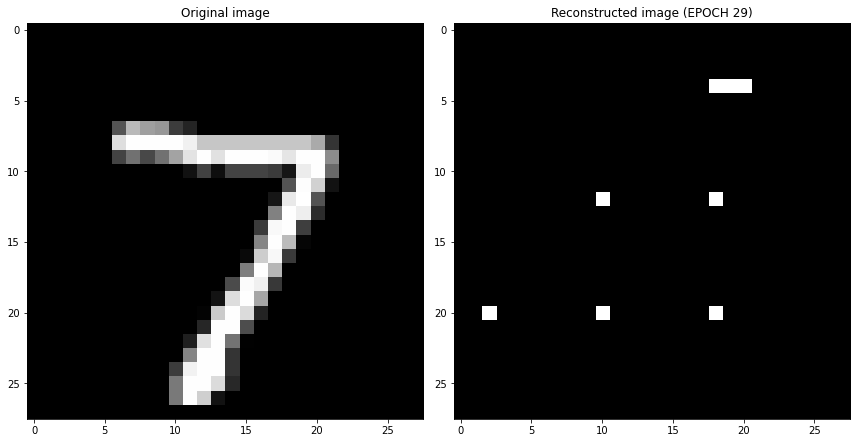

EPOCH 30/30
	 partial train loss (single batch): 0.111021
	 partial train loss (single batch): 0.110924
	 partial train loss (single batch): 0.109835
	 partial train loss (single batch): 0.110218
	 partial train loss (single batch): 0.110509
	 partial train loss (single batch): 0.112482
	 partial train loss (single batch): 0.111280
	 partial train loss (single batch): 0.110088
	 partial train loss (single batch): 0.111420
	 partial train loss (single batch): 0.110065
	 partial train loss (single batch): 0.115569
	 partial train loss (single batch): 0.109330
	 partial train loss (single batch): 0.109895
	 partial train loss (single batch): 0.114169
	 partial train loss (single batch): 0.109942
	 partial train loss (single batch): 0.109854
	 partial train loss (single batch): 0.112148
	 partial train loss (single batch): 0.109516
	 partial train loss (single batch): 0.112461
	 partial train loss (single batch): 0.114204
	 partial train loss (single batch): 0.111044
	 partial train loss (

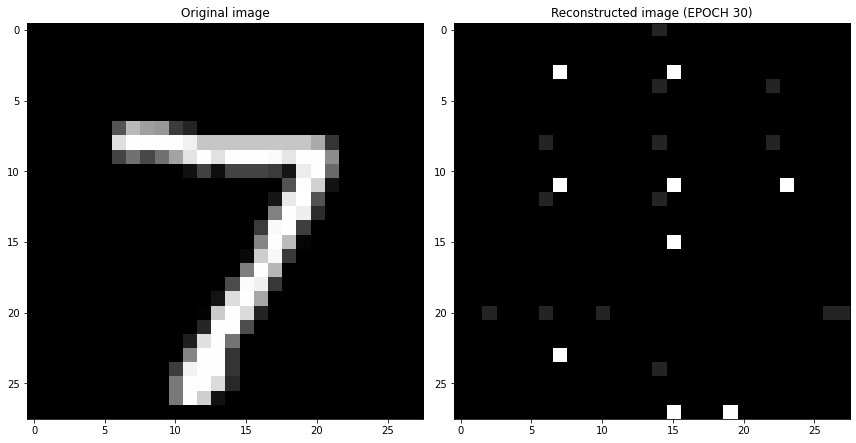

Cross validation fold number= 3/6
EPOCH 1/30
	 partial train loss (single batch): 0.266635
	 partial train loss (single batch): 0.164207
	 partial train loss (single batch): 0.111727
	 partial train loss (single batch): 0.109220
	 partial train loss (single batch): 0.109899
	 partial train loss (single batch): 0.115547
	 partial train loss (single batch): 0.115096
	 partial train loss (single batch): 0.110288
	 partial train loss (single batch): 0.109766
	 partial train loss (single batch): 0.112100
	 partial train loss (single batch): 0.115594
	 partial train loss (single batch): 0.113352
	 partial train loss (single batch): 0.116796
	 partial train loss (single batch): 0.112570
	 partial train loss (single batch): 0.114130
	 partial train loss (single batch): 0.114388
	 partial train loss (single batch): 0.114828
	 partial train loss (single batch): 0.116256
	 partial train loss (single batch): 0.113059
	 partial train loss (single batch): 0.113094
	 partial train loss (single batch)

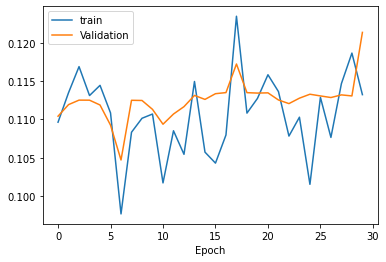

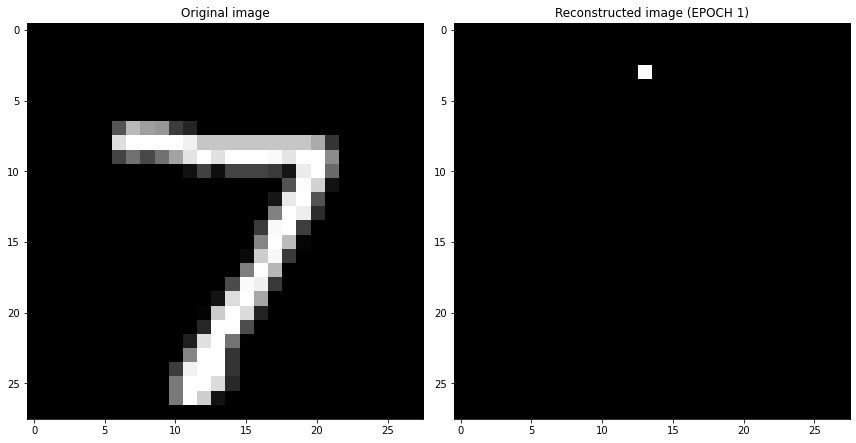

EPOCH 2/30
	 partial train loss (single batch): 0.110385
	 partial train loss (single batch): 0.110831
	 partial train loss (single batch): 0.110312
	 partial train loss (single batch): 0.116145
	 partial train loss (single batch): 0.110078
	 partial train loss (single batch): 0.110939
	 partial train loss (single batch): 0.110791
	 partial train loss (single batch): 0.113420
	 partial train loss (single batch): 0.111044
	 partial train loss (single batch): 0.112633
	 partial train loss (single batch): 0.112875
	 partial train loss (single batch): 0.110081
	 partial train loss (single batch): 0.110277
	 partial train loss (single batch): 0.110878
	 partial train loss (single batch): 0.111022
	 partial train loss (single batch): 0.110883
	 partial train loss (single batch): 0.112598
	 partial train loss (single batch): 0.109478
	 partial train loss (single batch): 0.110722
	 partial train loss (single batch): 0.113833
	 partial train loss (single batch): 0.112000
	 partial train loss (s

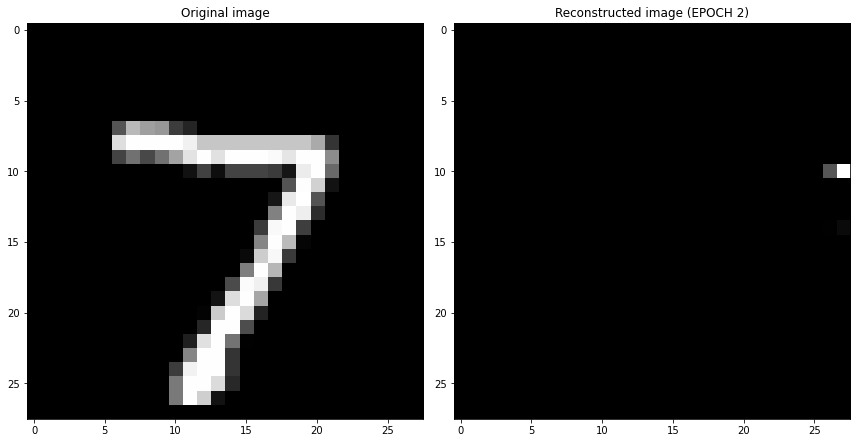

EPOCH 3/30
	 partial train loss (single batch): 0.113240
	 partial train loss (single batch): 0.109148
	 partial train loss (single batch): 0.113113
	 partial train loss (single batch): 0.110447
	 partial train loss (single batch): 0.111121
	 partial train loss (single batch): 0.109171
	 partial train loss (single batch): 0.115017
	 partial train loss (single batch): 0.109653
	 partial train loss (single batch): 0.112359
	 partial train loss (single batch): 0.111078
	 partial train loss (single batch): 0.109599
	 partial train loss (single batch): 0.115806
	 partial train loss (single batch): 0.114666
	 partial train loss (single batch): 0.112898
	 partial train loss (single batch): 0.114051
	 partial train loss (single batch): 0.108606
	 partial train loss (single batch): 0.109515
	 partial train loss (single batch): 0.109715
	 partial train loss (single batch): 0.109618
	 partial train loss (single batch): 0.110759
	 partial train loss (single batch): 0.115096
	 partial train loss (s

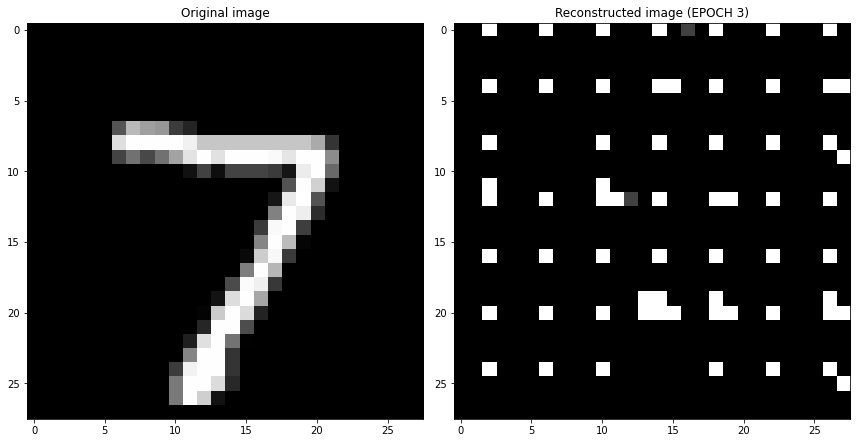

EPOCH 4/30
	 partial train loss (single batch): 0.167744
	 partial train loss (single batch): 0.168003
	 partial train loss (single batch): 0.165423
	 partial train loss (single batch): 0.168775
	 partial train loss (single batch): 0.171462
	 partial train loss (single batch): 0.167533
	 partial train loss (single batch): 0.168327
	 partial train loss (single batch): 0.169883
	 partial train loss (single batch): 0.165234
	 partial train loss (single batch): 0.164112
	 partial train loss (single batch): 0.167053
	 partial train loss (single batch): 0.169072
	 partial train loss (single batch): 0.171200
	 partial train loss (single batch): 0.171607
	 partial train loss (single batch): 0.169099
	 partial train loss (single batch): 0.172086
	 partial train loss (single batch): 0.168362
	 partial train loss (single batch): 0.168239
	 partial train loss (single batch): 0.167377
	 partial train loss (single batch): 0.167172
	 partial train loss (single batch): 0.170350
	 partial train loss (s

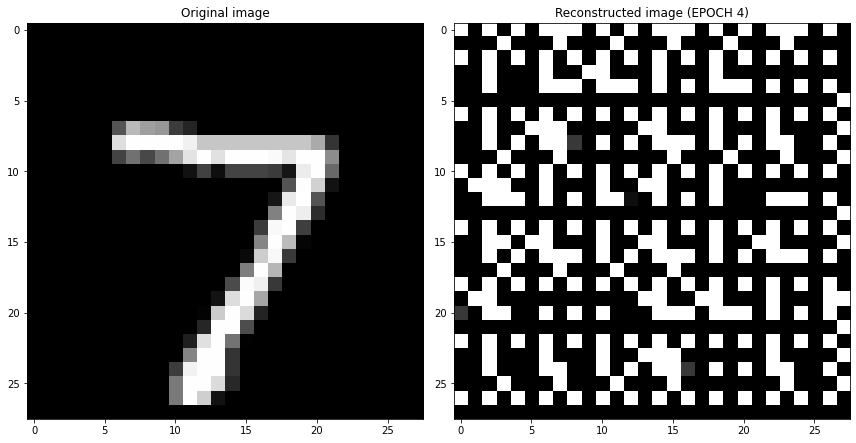

EPOCH 5/30
	 partial train loss (single batch): 0.368717
	 partial train loss (single batch): 0.368172
	 partial train loss (single batch): 0.371264
	 partial train loss (single batch): 0.370186
	 partial train loss (single batch): 0.368203
	 partial train loss (single batch): 0.367478
	 partial train loss (single batch): 0.370015
	 partial train loss (single batch): 0.369880
	 partial train loss (single batch): 0.368914
	 partial train loss (single batch): 0.363027
	 partial train loss (single batch): 0.359632
	 partial train loss (single batch): 0.358182
	 partial train loss (single batch): 0.356278
	 partial train loss (single batch): 0.355360
	 partial train loss (single batch): 0.354400
	 partial train loss (single batch): 0.352065
	 partial train loss (single batch): 0.350441
	 partial train loss (single batch): 0.348840
	 partial train loss (single batch): 0.349296
	 partial train loss (single batch): 0.347841
	 partial train loss (single batch): 0.344846
	 partial train loss (s

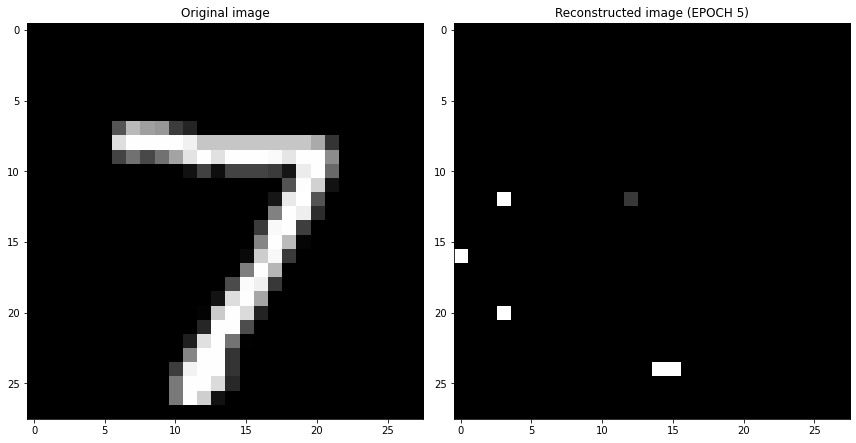

EPOCH 6/30
	 partial train loss (single batch): 0.114501
	 partial train loss (single batch): 0.115350
	 partial train loss (single batch): 0.116818
	 partial train loss (single batch): 0.121715
	 partial train loss (single batch): 0.122859
	 partial train loss (single batch): 0.118669
	 partial train loss (single batch): 0.113016
	 partial train loss (single batch): 0.115101
	 partial train loss (single batch): 0.113274
	 partial train loss (single batch): 0.116578
	 partial train loss (single batch): 0.120246
	 partial train loss (single batch): 0.120112
	 partial train loss (single batch): 0.115174
	 partial train loss (single batch): 0.115763
	 partial train loss (single batch): 0.115353
	 partial train loss (single batch): 0.116033
	 partial train loss (single batch): 0.116763
	 partial train loss (single batch): 0.118669
	 partial train loss (single batch): 0.115463
	 partial train loss (single batch): 0.116943
	 partial train loss (single batch): 0.116092
	 partial train loss (s

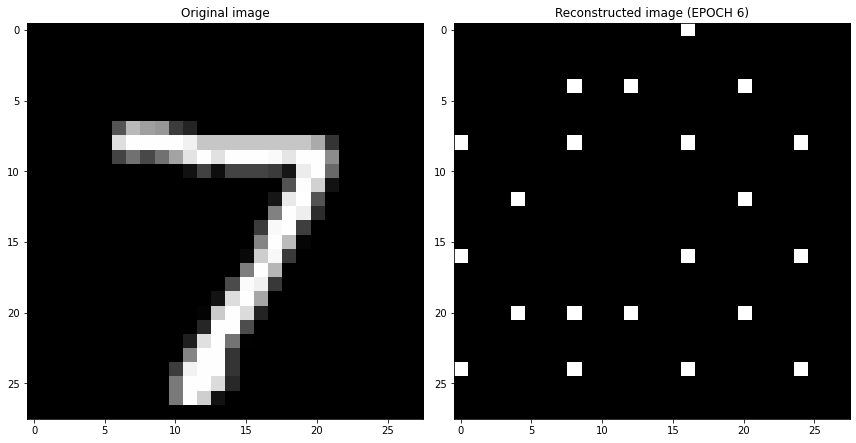

EPOCH 7/30
	 partial train loss (single batch): 0.111934
	 partial train loss (single batch): 0.116390
	 partial train loss (single batch): 0.110440
	 partial train loss (single batch): 0.110927
	 partial train loss (single batch): 0.107435
	 partial train loss (single batch): 0.107000
	 partial train loss (single batch): 0.112064
	 partial train loss (single batch): 0.111124
	 partial train loss (single batch): 0.114289
	 partial train loss (single batch): 0.110469
	 partial train loss (single batch): 0.112604
	 partial train loss (single batch): 0.108774
	 partial train loss (single batch): 0.113266
	 partial train loss (single batch): 0.114626
	 partial train loss (single batch): 0.114504
	 partial train loss (single batch): 0.108097
	 partial train loss (single batch): 0.110565
	 partial train loss (single batch): 0.111491
	 partial train loss (single batch): 0.113736
	 partial train loss (single batch): 0.111594
	 partial train loss (single batch): 0.107252
	 partial train loss (s

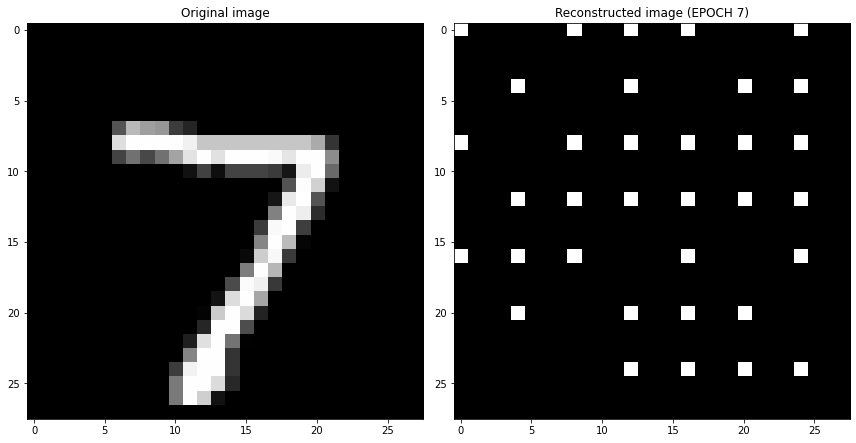

EPOCH 8/30
	 partial train loss (single batch): 0.107617
	 partial train loss (single batch): 0.109677
	 partial train loss (single batch): 0.109229
	 partial train loss (single batch): 0.109591
	 partial train loss (single batch): 0.109642
	 partial train loss (single batch): 0.111881
	 partial train loss (single batch): 0.111758
	 partial train loss (single batch): 0.109521
	 partial train loss (single batch): 0.109222
	 partial train loss (single batch): 0.111106
	 partial train loss (single batch): 0.114262
	 partial train loss (single batch): 0.112578
	 partial train loss (single batch): 0.109363
	 partial train loss (single batch): 0.114577
	 partial train loss (single batch): 0.110525
	 partial train loss (single batch): 0.112213
	 partial train loss (single batch): 0.111578
	 partial train loss (single batch): 0.108582
	 partial train loss (single batch): 0.111176
	 partial train loss (single batch): 0.108330
	 partial train loss (single batch): 0.110330
	 partial train loss (s

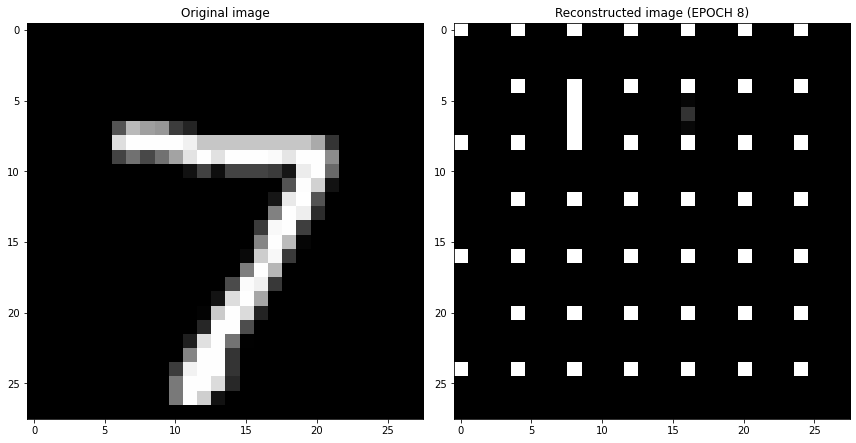

EPOCH 9/30
	 partial train loss (single batch): 0.107449
	 partial train loss (single batch): 0.109725
	 partial train loss (single batch): 0.112681
	 partial train loss (single batch): 0.109463
	 partial train loss (single batch): 0.109301
	 partial train loss (single batch): 0.110737
	 partial train loss (single batch): 0.113238
	 partial train loss (single batch): 0.113045
	 partial train loss (single batch): 0.108782
	 partial train loss (single batch): 0.110262
	 partial train loss (single batch): 0.108863
	 partial train loss (single batch): 0.109884
	 partial train loss (single batch): 0.112323
	 partial train loss (single batch): 0.106529
	 partial train loss (single batch): 0.111630
	 partial train loss (single batch): 0.107307
	 partial train loss (single batch): 0.107571
	 partial train loss (single batch): 0.106909
	 partial train loss (single batch): 0.108058
	 partial train loss (single batch): 0.109101
	 partial train loss (single batch): 0.107351
	 partial train loss (s

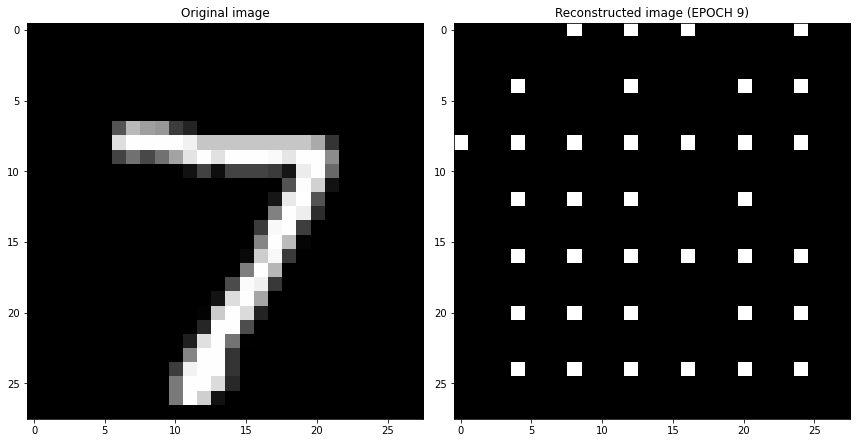

EPOCH 10/30
	 partial train loss (single batch): 0.112753
	 partial train loss (single batch): 0.107576
	 partial train loss (single batch): 0.104917
	 partial train loss (single batch): 0.106580
	 partial train loss (single batch): 0.110637
	 partial train loss (single batch): 0.114306
	 partial train loss (single batch): 0.110663
	 partial train loss (single batch): 0.109150
	 partial train loss (single batch): 0.110111
	 partial train loss (single batch): 0.114396
	 partial train loss (single batch): 0.111456
	 partial train loss (single batch): 0.108337
	 partial train loss (single batch): 0.108598
	 partial train loss (single batch): 0.116367
	 partial train loss (single batch): 0.112347
	 partial train loss (single batch): 0.108683
	 partial train loss (single batch): 0.110119
	 partial train loss (single batch): 0.113685
	 partial train loss (single batch): 0.110122
	 partial train loss (single batch): 0.111732
	 partial train loss (single batch): 0.111904
	 partial train loss (

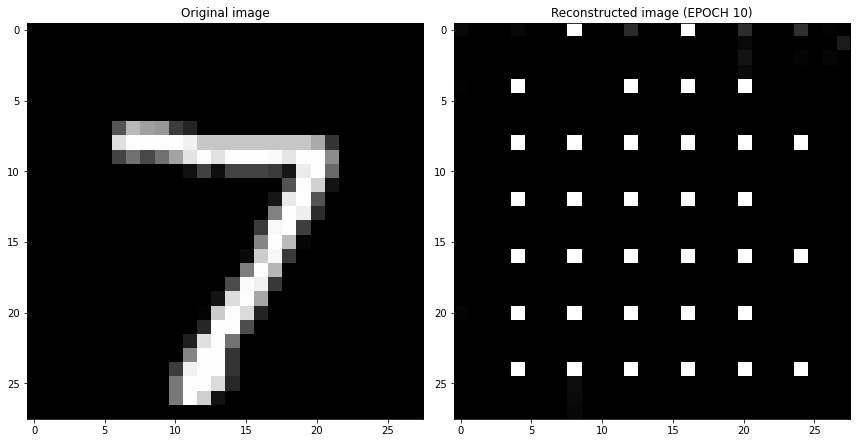

EPOCH 11/30
	 partial train loss (single batch): 0.109729
	 partial train loss (single batch): 0.112398
	 partial train loss (single batch): 0.116264
	 partial train loss (single batch): 0.107315
	 partial train loss (single batch): 0.105178
	 partial train loss (single batch): 0.111132
	 partial train loss (single batch): 0.108921
	 partial train loss (single batch): 0.104749
	 partial train loss (single batch): 0.109628
	 partial train loss (single batch): 0.110056
	 partial train loss (single batch): 0.109941
	 partial train loss (single batch): 0.113580
	 partial train loss (single batch): 0.109983
	 partial train loss (single batch): 0.113228
	 partial train loss (single batch): 0.115162
	 partial train loss (single batch): 0.109269
	 partial train loss (single batch): 0.111843
	 partial train loss (single batch): 0.104946
	 partial train loss (single batch): 0.111897
	 partial train loss (single batch): 0.112321
	 partial train loss (single batch): 0.102728
	 partial train loss (

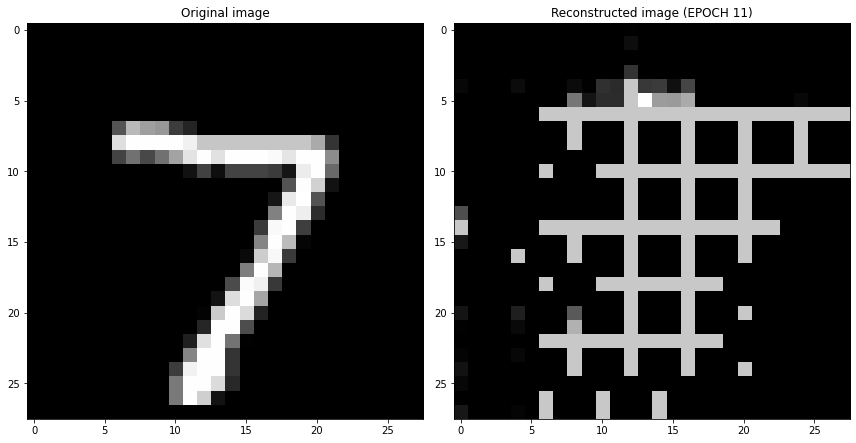

EPOCH 12/30
	 partial train loss (single batch): 0.100050
	 partial train loss (single batch): 0.095089
	 partial train loss (single batch): 0.099850
	 partial train loss (single batch): 0.097761
	 partial train loss (single batch): 0.097093
	 partial train loss (single batch): 0.097836
	 partial train loss (single batch): 0.098286
	 partial train loss (single batch): 0.095998
	 partial train loss (single batch): 0.096691
	 partial train loss (single batch): 0.100515
	 partial train loss (single batch): 0.097201
	 partial train loss (single batch): 0.097989
	 partial train loss (single batch): 0.098093
	 partial train loss (single batch): 0.101962
	 partial train loss (single batch): 0.098843
	 partial train loss (single batch): 0.098442
	 partial train loss (single batch): 0.099977
	 partial train loss (single batch): 0.098077
	 partial train loss (single batch): 0.096061
	 partial train loss (single batch): 0.097104
	 partial train loss (single batch): 0.098410
	 partial train loss (

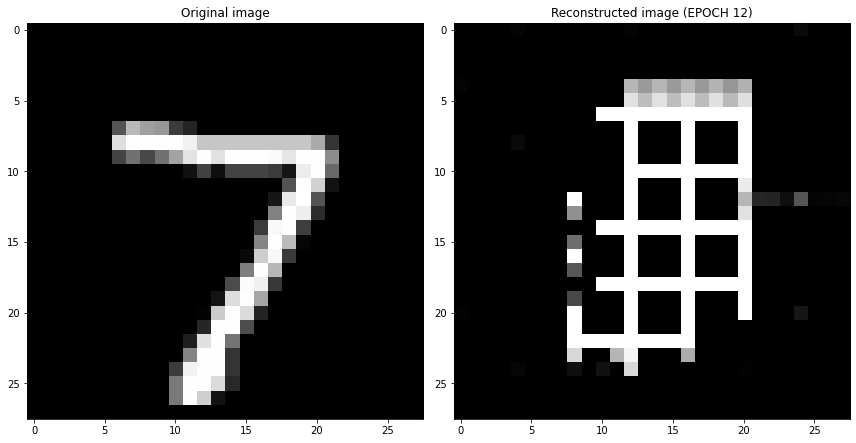

EPOCH 13/30
	 partial train loss (single batch): 0.091723
	 partial train loss (single batch): 0.093851
	 partial train loss (single batch): 0.098028
	 partial train loss (single batch): 0.099874
	 partial train loss (single batch): 0.095281
	 partial train loss (single batch): 0.095015
	 partial train loss (single batch): 0.093162
	 partial train loss (single batch): 0.095970
	 partial train loss (single batch): 0.093400
	 partial train loss (single batch): 0.094756
	 partial train loss (single batch): 0.094457
	 partial train loss (single batch): 0.092988
	 partial train loss (single batch): 0.092526
	 partial train loss (single batch): 0.092693
	 partial train loss (single batch): 0.093881
	 partial train loss (single batch): 0.094468
	 partial train loss (single batch): 0.092091
	 partial train loss (single batch): 0.091908
	 partial train loss (single batch): 0.095145
	 partial train loss (single batch): 0.093218
	 partial train loss (single batch): 0.096065
	 partial train loss (

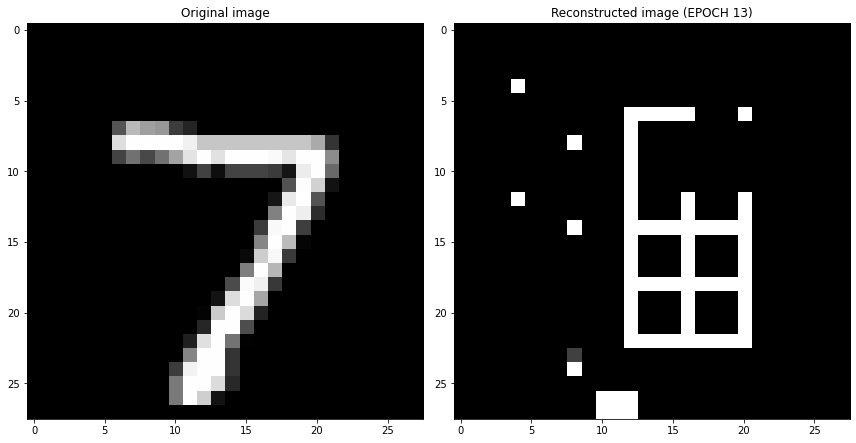

EPOCH 14/30
	 partial train loss (single batch): 0.103321
	 partial train loss (single batch): 0.102599
	 partial train loss (single batch): 0.104376
	 partial train loss (single batch): 0.102056
	 partial train loss (single batch): 0.100390
	 partial train loss (single batch): 0.105442
	 partial train loss (single batch): 0.099884
	 partial train loss (single batch): 0.108756
	 partial train loss (single batch): 0.105377
	 partial train loss (single batch): 0.112543
	 partial train loss (single batch): 0.109530
	 partial train loss (single batch): 0.114805
	 partial train loss (single batch): 0.119009
	 partial train loss (single batch): 0.115696
	 partial train loss (single batch): 0.114230
	 partial train loss (single batch): 0.115830
	 partial train loss (single batch): 0.114484
	 partial train loss (single batch): 0.114397
	 partial train loss (single batch): 0.109585
	 partial train loss (single batch): 0.111875
	 partial train loss (single batch): 0.109121
	 partial train loss (

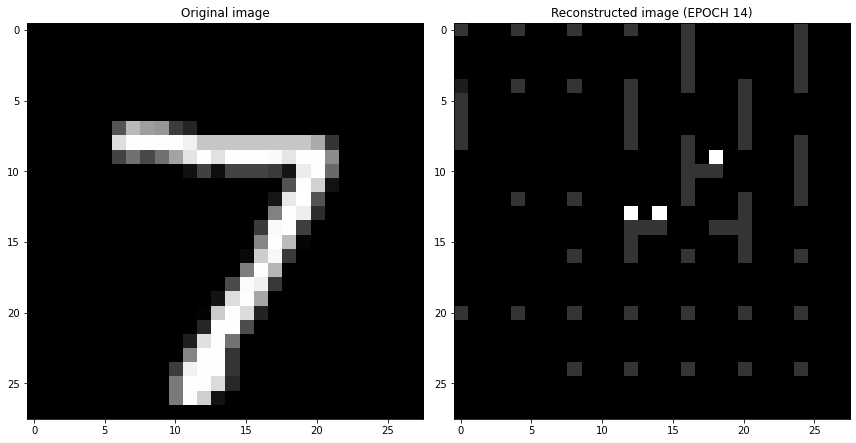

EPOCH 15/30
	 partial train loss (single batch): 0.109120
	 partial train loss (single batch): 0.109104
	 partial train loss (single batch): 0.106659
	 partial train loss (single batch): 0.109378
	 partial train loss (single batch): 0.110296
	 partial train loss (single batch): 0.110787
	 partial train loss (single batch): 0.118842
	 partial train loss (single batch): 0.120870
	 partial train loss (single batch): 0.121532
	 partial train loss (single batch): 0.120959
	 partial train loss (single batch): 0.121891
	 partial train loss (single batch): 0.129050
	 partial train loss (single batch): 0.125848
	 partial train loss (single batch): 0.123905
	 partial train loss (single batch): 0.126399
	 partial train loss (single batch): 0.126581
	 partial train loss (single batch): 0.126996
	 partial train loss (single batch): 0.126368
	 partial train loss (single batch): 0.129598
	 partial train loss (single batch): 0.127740
	 partial train loss (single batch): 0.132805
	 partial train loss (

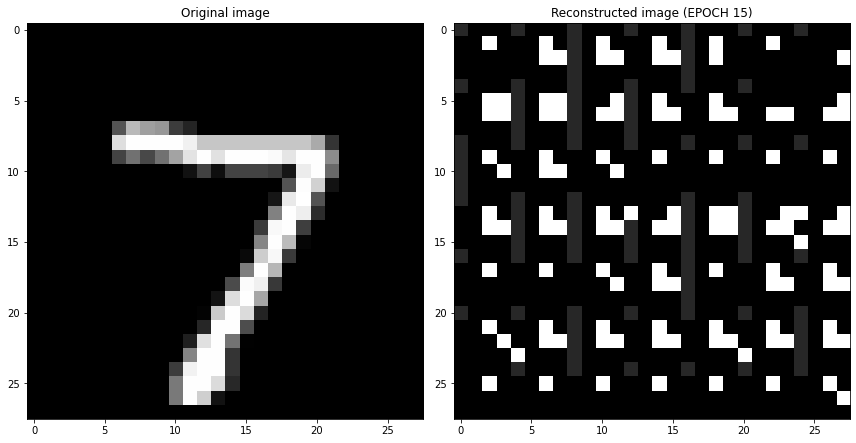

EPOCH 16/30
	 partial train loss (single batch): 0.212799
	 partial train loss (single batch): 0.214721
	 partial train loss (single batch): 0.215099
	 partial train loss (single batch): 0.217842
	 partial train loss (single batch): 0.216221
	 partial train loss (single batch): 0.216136
	 partial train loss (single batch): 0.214738
	 partial train loss (single batch): 0.214471
	 partial train loss (single batch): 0.215937
	 partial train loss (single batch): 0.215122
	 partial train loss (single batch): 0.214033
	 partial train loss (single batch): 0.214307
	 partial train loss (single batch): 0.213940
	 partial train loss (single batch): 0.216686
	 partial train loss (single batch): 0.192676
	 partial train loss (single batch): 0.184654
	 partial train loss (single batch): 0.177022
	 partial train loss (single batch): 0.169685
	 partial train loss (single batch): 0.163305
	 partial train loss (single batch): 0.164836
	 partial train loss (single batch): 0.161289
	 partial train loss (

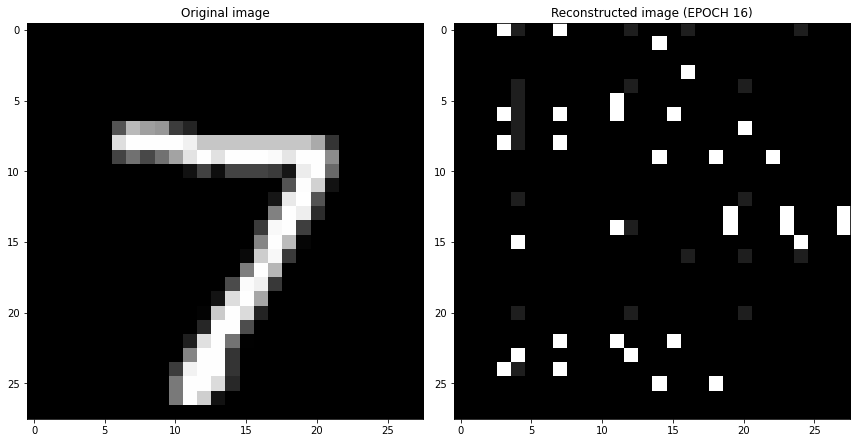

EPOCH 17/30
	 partial train loss (single batch): 0.142250
	 partial train loss (single batch): 0.142328
	 partial train loss (single batch): 0.137524
	 partial train loss (single batch): 0.139918
	 partial train loss (single batch): 0.142411
	 partial train loss (single batch): 0.128200
	 partial train loss (single batch): 0.124582
	 partial train loss (single batch): 0.126514
	 partial train loss (single batch): 0.128038
	 partial train loss (single batch): 0.122462
	 partial train loss (single batch): 0.128701
	 partial train loss (single batch): 0.133870
	 partial train loss (single batch): 0.132365
	 partial train loss (single batch): 0.136561
	 partial train loss (single batch): 0.138933
	 partial train loss (single batch): 0.135964
	 partial train loss (single batch): 0.134311
	 partial train loss (single batch): 0.140106
	 partial train loss (single batch): 0.145538
	 partial train loss (single batch): 0.136510
	 partial train loss (single batch): 0.142891
	 partial train loss (

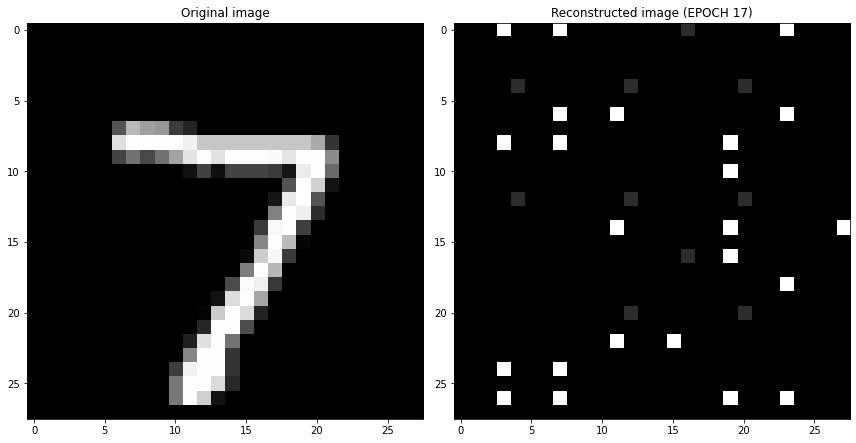

EPOCH 18/30
	 partial train loss (single batch): 0.132340
	 partial train loss (single batch): 0.131595
	 partial train loss (single batch): 0.135694
	 partial train loss (single batch): 0.132240
	 partial train loss (single batch): 0.133475
	 partial train loss (single batch): 0.132524
	 partial train loss (single batch): 0.131503
	 partial train loss (single batch): 0.134121
	 partial train loss (single batch): 0.132415
	 partial train loss (single batch): 0.133512
	 partial train loss (single batch): 0.130594
	 partial train loss (single batch): 0.133162
	 partial train loss (single batch): 0.137211
	 partial train loss (single batch): 0.129682
	 partial train loss (single batch): 0.134473
	 partial train loss (single batch): 0.134265
	 partial train loss (single batch): 0.135229
	 partial train loss (single batch): 0.132409
	 partial train loss (single batch): 0.139256
	 partial train loss (single batch): 0.134807
	 partial train loss (single batch): 0.131498
	 partial train loss (

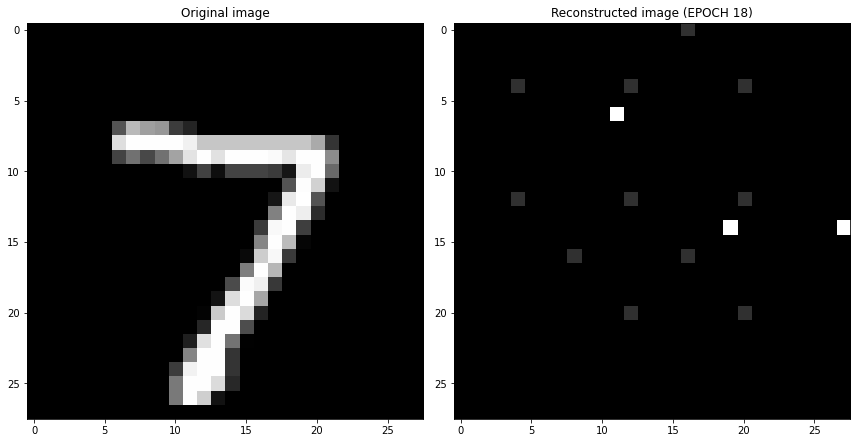

EPOCH 19/30
	 partial train loss (single batch): 0.116326
	 partial train loss (single batch): 0.110760
	 partial train loss (single batch): 0.110846
	 partial train loss (single batch): 0.116633
	 partial train loss (single batch): 0.114690
	 partial train loss (single batch): 0.113829
	 partial train loss (single batch): 0.117921
	 partial train loss (single batch): 0.114006
	 partial train loss (single batch): 0.110932
	 partial train loss (single batch): 0.113928
	 partial train loss (single batch): 0.115394
	 partial train loss (single batch): 0.114133
	 partial train loss (single batch): 0.116296
	 partial train loss (single batch): 0.114313
	 partial train loss (single batch): 0.113692
	 partial train loss (single batch): 0.115432
	 partial train loss (single batch): 0.114399
	 partial train loss (single batch): 0.111720
	 partial train loss (single batch): 0.115105
	 partial train loss (single batch): 0.112050
	 partial train loss (single batch): 0.117500
	 partial train loss (

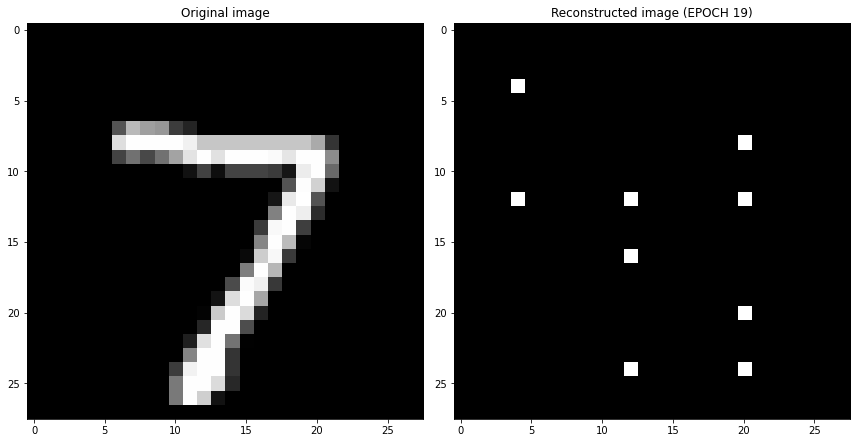

EPOCH 20/30
	 partial train loss (single batch): 0.113870
	 partial train loss (single batch): 0.108707
	 partial train loss (single batch): 0.113953
	 partial train loss (single batch): 0.112824
	 partial train loss (single batch): 0.107738
	 partial train loss (single batch): 0.115531
	 partial train loss (single batch): 0.109228
	 partial train loss (single batch): 0.109519
	 partial train loss (single batch): 0.113272
	 partial train loss (single batch): 0.109138
	 partial train loss (single batch): 0.111955
	 partial train loss (single batch): 0.110343
	 partial train loss (single batch): 0.106681
	 partial train loss (single batch): 0.108623
	 partial train loss (single batch): 0.108548
	 partial train loss (single batch): 0.115544
	 partial train loss (single batch): 0.110938
	 partial train loss (single batch): 0.108048
	 partial train loss (single batch): 0.111527
	 partial train loss (single batch): 0.111652
	 partial train loss (single batch): 0.114444
	 partial train loss (

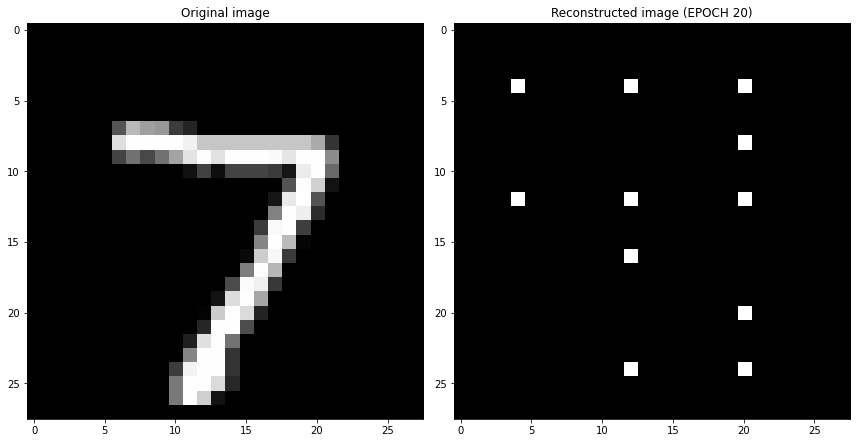

EPOCH 21/30
	 partial train loss (single batch): 0.115933
	 partial train loss (single batch): 0.110714
	 partial train loss (single batch): 0.110780
	 partial train loss (single batch): 0.110087
	 partial train loss (single batch): 0.113616
	 partial train loss (single batch): 0.113107
	 partial train loss (single batch): 0.115297
	 partial train loss (single batch): 0.108675
	 partial train loss (single batch): 0.111920
	 partial train loss (single batch): 0.113677
	 partial train loss (single batch): 0.110713
	 partial train loss (single batch): 0.113193
	 partial train loss (single batch): 0.112848
	 partial train loss (single batch): 0.115299
	 partial train loss (single batch): 0.107846
	 partial train loss (single batch): 0.108052
	 partial train loss (single batch): 0.110699
	 partial train loss (single batch): 0.109645
	 partial train loss (single batch): 0.114662
	 partial train loss (single batch): 0.111173
	 partial train loss (single batch): 0.110406
	 partial train loss (

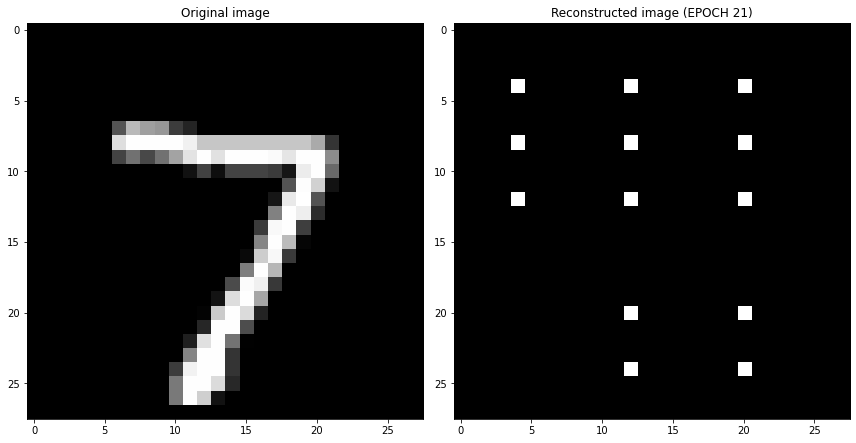

EPOCH 22/30
	 partial train loss (single batch): 0.106192
	 partial train loss (single batch): 0.114343
	 partial train loss (single batch): 0.113461
	 partial train loss (single batch): 0.109914
	 partial train loss (single batch): 0.110939
	 partial train loss (single batch): 0.110873
	 partial train loss (single batch): 0.111432
	 partial train loss (single batch): 0.109003
	 partial train loss (single batch): 0.115840
	 partial train loss (single batch): 0.111517
	 partial train loss (single batch): 0.108329
	 partial train loss (single batch): 0.114874
	 partial train loss (single batch): 0.115424
	 partial train loss (single batch): 0.115003
	 partial train loss (single batch): 0.109763
	 partial train loss (single batch): 0.112853
	 partial train loss (single batch): 0.113930
	 partial train loss (single batch): 0.109969
	 partial train loss (single batch): 0.108568
	 partial train loss (single batch): 0.114167
	 partial train loss (single batch): 0.115440
	 partial train loss (

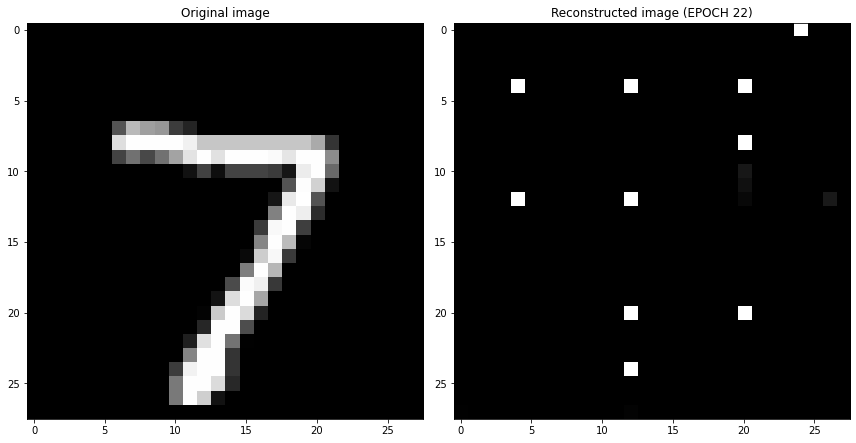

EPOCH 23/30
	 partial train loss (single batch): 0.113089
	 partial train loss (single batch): 0.110719
	 partial train loss (single batch): 0.113001
	 partial train loss (single batch): 0.110338
	 partial train loss (single batch): 0.108017
	 partial train loss (single batch): 0.106876
	 partial train loss (single batch): 0.104894
	 partial train loss (single batch): 0.108741
	 partial train loss (single batch): 0.115657
	 partial train loss (single batch): 0.111029
	 partial train loss (single batch): 0.113534
	 partial train loss (single batch): 0.112094
	 partial train loss (single batch): 0.109555
	 partial train loss (single batch): 0.104204
	 partial train loss (single batch): 0.112691
	 partial train loss (single batch): 0.109562
	 partial train loss (single batch): 0.110852
	 partial train loss (single batch): 0.107538
	 partial train loss (single batch): 0.109540
	 partial train loss (single batch): 0.111202
	 partial train loss (single batch): 0.115523
	 partial train loss (

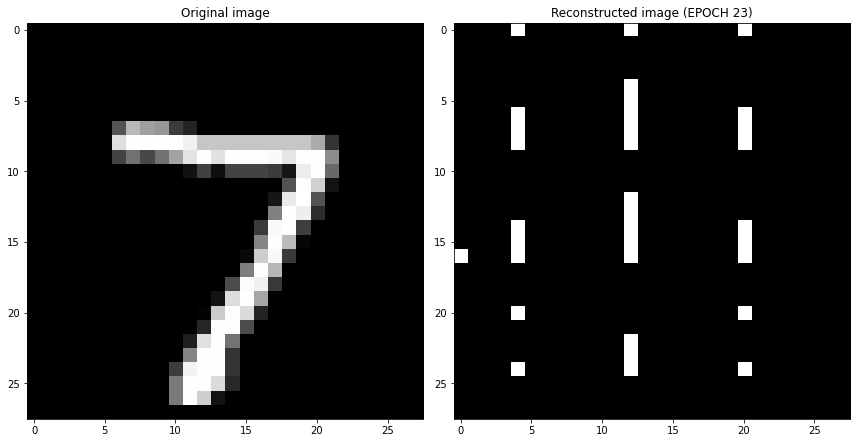

EPOCH 24/30
	 partial train loss (single batch): 0.109925
	 partial train loss (single batch): 0.110205
	 partial train loss (single batch): 0.116274
	 partial train loss (single batch): 0.114647
	 partial train loss (single batch): 0.111503
	 partial train loss (single batch): 0.113704
	 partial train loss (single batch): 0.113068
	 partial train loss (single batch): 0.113644
	 partial train loss (single batch): 0.108840
	 partial train loss (single batch): 0.108675
	 partial train loss (single batch): 0.109974
	 partial train loss (single batch): 0.109532
	 partial train loss (single batch): 0.106497
	 partial train loss (single batch): 0.112718
	 partial train loss (single batch): 0.107943
	 partial train loss (single batch): 0.111591
	 partial train loss (single batch): 0.110069
	 partial train loss (single batch): 0.110178
	 partial train loss (single batch): 0.108081
	 partial train loss (single batch): 0.106295
	 partial train loss (single batch): 0.106809
	 partial train loss (

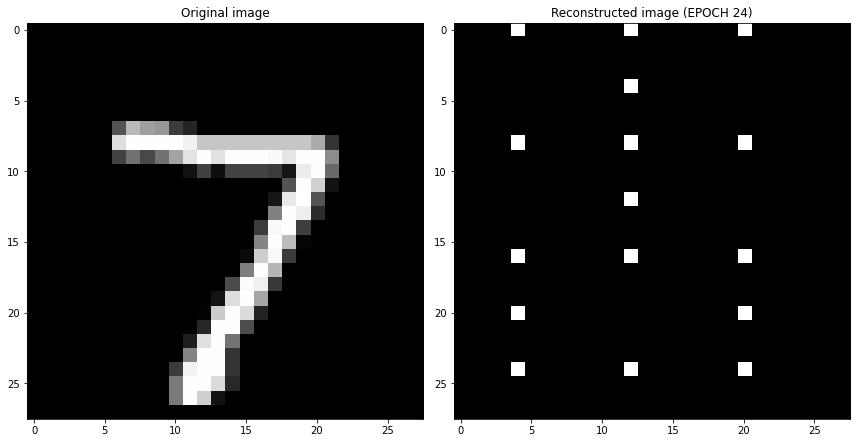

EPOCH 25/30
	 partial train loss (single batch): 0.109456
	 partial train loss (single batch): 0.113102
	 partial train loss (single batch): 0.113688
	 partial train loss (single batch): 0.112687
	 partial train loss (single batch): 0.110393
	 partial train loss (single batch): 0.110866
	 partial train loss (single batch): 0.107114
	 partial train loss (single batch): 0.113940
	 partial train loss (single batch): 0.113733
	 partial train loss (single batch): 0.111881
	 partial train loss (single batch): 0.113800
	 partial train loss (single batch): 0.112975
	 partial train loss (single batch): 0.111634
	 partial train loss (single batch): 0.112806
	 partial train loss (single batch): 0.113804
	 partial train loss (single batch): 0.114791
	 partial train loss (single batch): 0.109003
	 partial train loss (single batch): 0.109991
	 partial train loss (single batch): 0.108777
	 partial train loss (single batch): 0.112525
	 partial train loss (single batch): 0.107887
	 partial train loss (

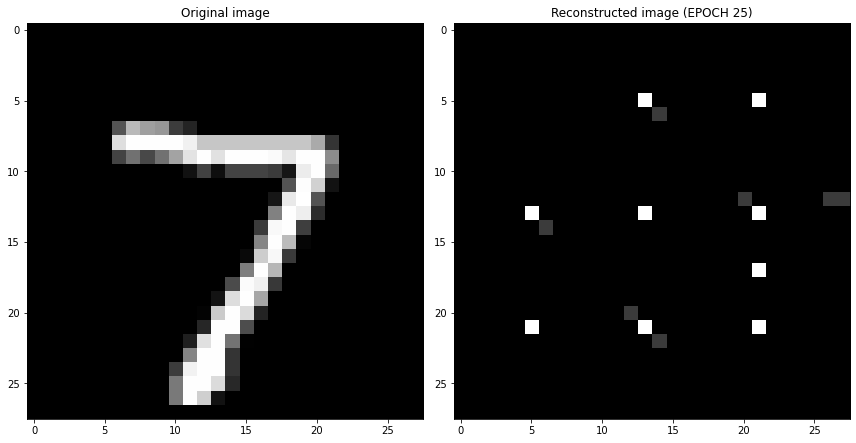

EPOCH 26/30
	 partial train loss (single batch): 0.115683
	 partial train loss (single batch): 0.119058
	 partial train loss (single batch): 0.125926
	 partial train loss (single batch): 0.118928
	 partial train loss (single batch): 0.114611
	 partial train loss (single batch): 0.114683
	 partial train loss (single batch): 0.112537
	 partial train loss (single batch): 0.114500
	 partial train loss (single batch): 0.112349
	 partial train loss (single batch): 0.110671
	 partial train loss (single batch): 0.109611
	 partial train loss (single batch): 0.115490
	 partial train loss (single batch): 0.112322
	 partial train loss (single batch): 0.110448
	 partial train loss (single batch): 0.108569
	 partial train loss (single batch): 0.114425
	 partial train loss (single batch): 0.110257
	 partial train loss (single batch): 0.109983
	 partial train loss (single batch): 0.112367
	 partial train loss (single batch): 0.112035
	 partial train loss (single batch): 0.110537
	 partial train loss (

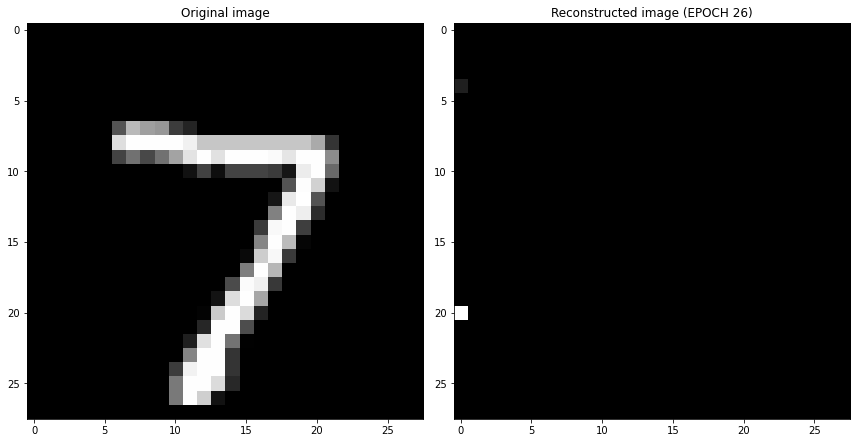

EPOCH 27/30
	 partial train loss (single batch): 0.109373
	 partial train loss (single batch): 0.111069
	 partial train loss (single batch): 0.107564
	 partial train loss (single batch): 0.111057
	 partial train loss (single batch): 0.108732
	 partial train loss (single batch): 0.105130
	 partial train loss (single batch): 0.113157
	 partial train loss (single batch): 0.110286
	 partial train loss (single batch): 0.114849
	 partial train loss (single batch): 0.112405
	 partial train loss (single batch): 0.108664
	 partial train loss (single batch): 0.108266
	 partial train loss (single batch): 0.113877
	 partial train loss (single batch): 0.112066
	 partial train loss (single batch): 0.107104
	 partial train loss (single batch): 0.113797
	 partial train loss (single batch): 0.111781
	 partial train loss (single batch): 0.112762
	 partial train loss (single batch): 0.114424
	 partial train loss (single batch): 0.109835
	 partial train loss (single batch): 0.107665
	 partial train loss (

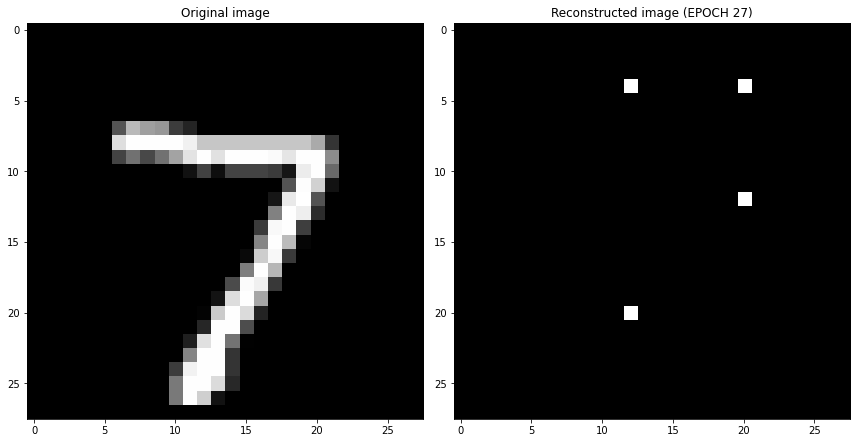

EPOCH 28/30
	 partial train loss (single batch): 0.116622
	 partial train loss (single batch): 0.116083
	 partial train loss (single batch): 0.111516
	 partial train loss (single batch): 0.112016
	 partial train loss (single batch): 0.107582
	 partial train loss (single batch): 0.110585
	 partial train loss (single batch): 0.113593
	 partial train loss (single batch): 0.109847
	 partial train loss (single batch): 0.113907
	 partial train loss (single batch): 0.113792
	 partial train loss (single batch): 0.106816
	 partial train loss (single batch): 0.111781
	 partial train loss (single batch): 0.110603
	 partial train loss (single batch): 0.110551
	 partial train loss (single batch): 0.110074
	 partial train loss (single batch): 0.113687
	 partial train loss (single batch): 0.114887
	 partial train loss (single batch): 0.112992
	 partial train loss (single batch): 0.108571
	 partial train loss (single batch): 0.108917
	 partial train loss (single batch): 0.114340
	 partial train loss (

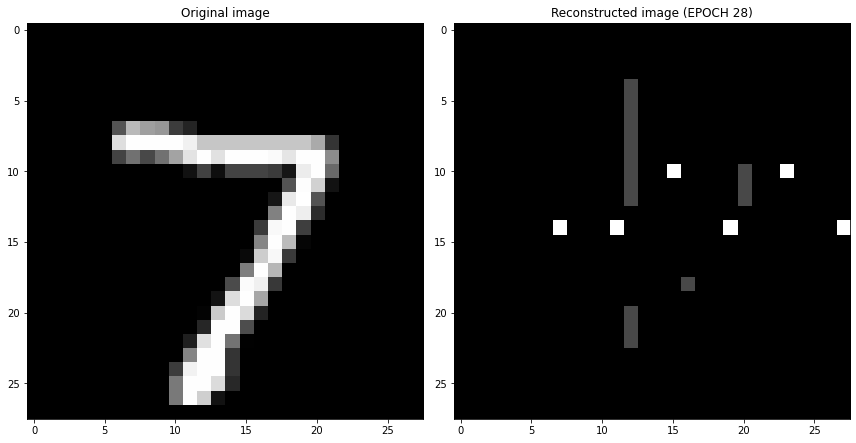

EPOCH 29/30
	 partial train loss (single batch): 0.113426
	 partial train loss (single batch): 0.111506
	 partial train loss (single batch): 0.111397
	 partial train loss (single batch): 0.112089
	 partial train loss (single batch): 0.115186
	 partial train loss (single batch): 0.107303
	 partial train loss (single batch): 0.111429
	 partial train loss (single batch): 0.113281
	 partial train loss (single batch): 0.115139
	 partial train loss (single batch): 0.113724
	 partial train loss (single batch): 0.114457
	 partial train loss (single batch): 0.116086
	 partial train loss (single batch): 0.108683
	 partial train loss (single batch): 0.115176
	 partial train loss (single batch): 0.113234
	 partial train loss (single batch): 0.113501
	 partial train loss (single batch): 0.110497
	 partial train loss (single batch): 0.112237
	 partial train loss (single batch): 0.111369
	 partial train loss (single batch): 0.112782
	 partial train loss (single batch): 0.114828
	 partial train loss (

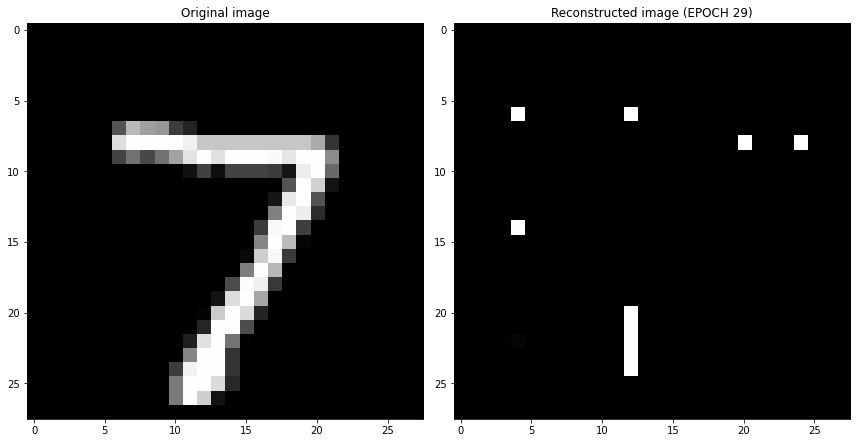

EPOCH 30/30
	 partial train loss (single batch): 0.110137
	 partial train loss (single batch): 0.110532
	 partial train loss (single batch): 0.107723
	 partial train loss (single batch): 0.115080
	 partial train loss (single batch): 0.112063
	 partial train loss (single batch): 0.115237
	 partial train loss (single batch): 0.110267
	 partial train loss (single batch): 0.113544
	 partial train loss (single batch): 0.110505
	 partial train loss (single batch): 0.110824
	 partial train loss (single batch): 0.112413
	 partial train loss (single batch): 0.108503
	 partial train loss (single batch): 0.109912
	 partial train loss (single batch): 0.106569
	 partial train loss (single batch): 0.111733
	 partial train loss (single batch): 0.112864
	 partial train loss (single batch): 0.113336
	 partial train loss (single batch): 0.115141
	 partial train loss (single batch): 0.113024
	 partial train loss (single batch): 0.115124
	 partial train loss (single batch): 0.114876
	 partial train loss (

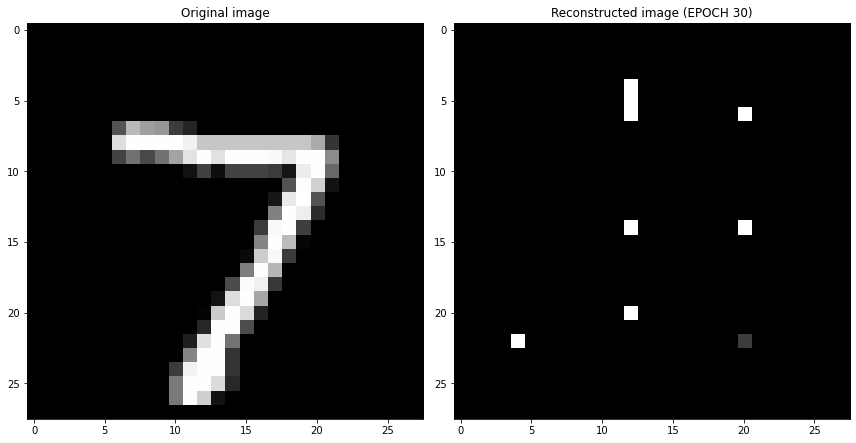

Cross validation fold number= 4/6
EPOCH 1/30
	 partial train loss (single batch): 0.302206
	 partial train loss (single batch): 0.223130
	 partial train loss (single batch): 0.213038
	 partial train loss (single batch): 0.110423
	 partial train loss (single batch): 0.108443
	 partial train loss (single batch): 0.106479
	 partial train loss (single batch): 0.101876
	 partial train loss (single batch): 0.100873
	 partial train loss (single batch): 0.098247
	 partial train loss (single batch): 0.087849
	 partial train loss (single batch): 0.079644
	 partial train loss (single batch): 0.075381
	 partial train loss (single batch): 0.073247
	 partial train loss (single batch): 0.080706
	 partial train loss (single batch): 0.075340
	 partial train loss (single batch): 0.072878
	 partial train loss (single batch): 0.071840
	 partial train loss (single batch): 0.072354
	 partial train loss (single batch): 0.070551
	 partial train loss (single batch): 0.072125
	 partial train loss (single batch)

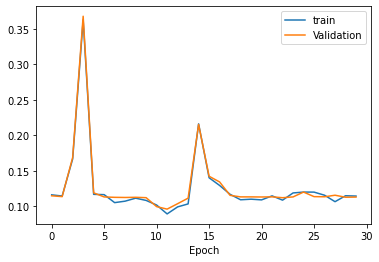

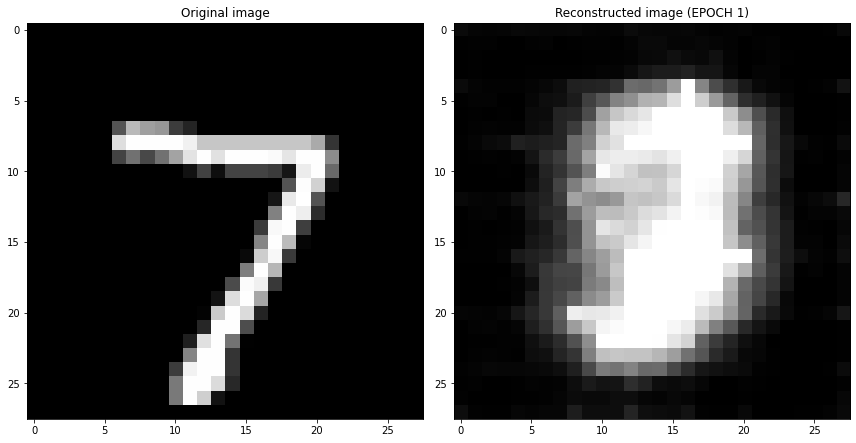

EPOCH 2/30
	 partial train loss (single batch): 0.067586
	 partial train loss (single batch): 0.068653
	 partial train loss (single batch): 0.069070
	 partial train loss (single batch): 0.068753
	 partial train loss (single batch): 0.067717
	 partial train loss (single batch): 0.070278
	 partial train loss (single batch): 0.067543
	 partial train loss (single batch): 0.069234
	 partial train loss (single batch): 0.068474
	 partial train loss (single batch): 0.068422
	 partial train loss (single batch): 0.069240
	 partial train loss (single batch): 0.069997
	 partial train loss (single batch): 0.068161
	 partial train loss (single batch): 0.067890
	 partial train loss (single batch): 0.069772
	 partial train loss (single batch): 0.067135
	 partial train loss (single batch): 0.067276
	 partial train loss (single batch): 0.067365
	 partial train loss (single batch): 0.068488
	 partial train loss (single batch): 0.068270
	 partial train loss (single batch): 0.070178
	 partial train loss (s

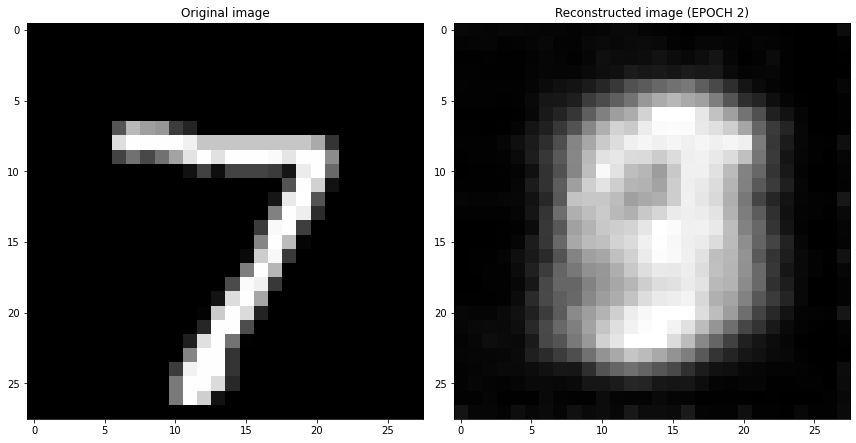

EPOCH 3/30
	 partial train loss (single batch): 0.066745
	 partial train loss (single batch): 0.067219
	 partial train loss (single batch): 0.066208
	 partial train loss (single batch): 0.069043
	 partial train loss (single batch): 0.066801
	 partial train loss (single batch): 0.068073
	 partial train loss (single batch): 0.069350
	 partial train loss (single batch): 0.068621
	 partial train loss (single batch): 0.066159
	 partial train loss (single batch): 0.066220
	 partial train loss (single batch): 0.064566
	 partial train loss (single batch): 0.064608
	 partial train loss (single batch): 0.065354
	 partial train loss (single batch): 0.068396
	 partial train loss (single batch): 0.068013
	 partial train loss (single batch): 0.068158
	 partial train loss (single batch): 0.068799
	 partial train loss (single batch): 0.067118
	 partial train loss (single batch): 0.066922
	 partial train loss (single batch): 0.067617
	 partial train loss (single batch): 0.067777
	 partial train loss (s

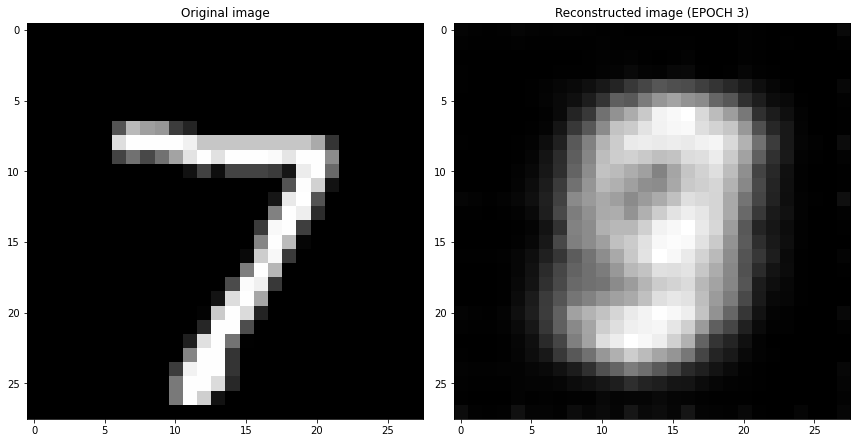

EPOCH 4/30
	 partial train loss (single batch): 0.069293
	 partial train loss (single batch): 0.068478
	 partial train loss (single batch): 0.067665
	 partial train loss (single batch): 0.069206
	 partial train loss (single batch): 0.067840
	 partial train loss (single batch): 0.066066
	 partial train loss (single batch): 0.067911
	 partial train loss (single batch): 0.068274
	 partial train loss (single batch): 0.069017
	 partial train loss (single batch): 0.069463
	 partial train loss (single batch): 0.066641
	 partial train loss (single batch): 0.066451
	 partial train loss (single batch): 0.066533
	 partial train loss (single batch): 0.066312
	 partial train loss (single batch): 0.069247
	 partial train loss (single batch): 0.065750
	 partial train loss (single batch): 0.065748
	 partial train loss (single batch): 0.067761
	 partial train loss (single batch): 0.069523
	 partial train loss (single batch): 0.068548
	 partial train loss (single batch): 0.068588
	 partial train loss (s

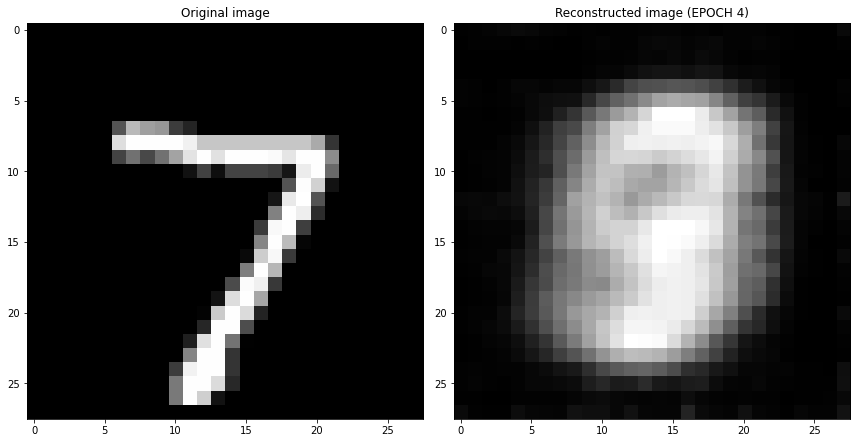

EPOCH 5/30
	 partial train loss (single batch): 0.068681
	 partial train loss (single batch): 0.066950
	 partial train loss (single batch): 0.068507
	 partial train loss (single batch): 0.067504
	 partial train loss (single batch): 0.068677
	 partial train loss (single batch): 0.067259
	 partial train loss (single batch): 0.067468
	 partial train loss (single batch): 0.068917
	 partial train loss (single batch): 0.067262
	 partial train loss (single batch): 0.068924
	 partial train loss (single batch): 0.067479
	 partial train loss (single batch): 0.067033
	 partial train loss (single batch): 0.068665
	 partial train loss (single batch): 0.068685
	 partial train loss (single batch): 0.066662
	 partial train loss (single batch): 0.067578
	 partial train loss (single batch): 0.069141
	 partial train loss (single batch): 0.070229
	 partial train loss (single batch): 0.068127
	 partial train loss (single batch): 0.067811
	 partial train loss (single batch): 0.067492
	 partial train loss (s

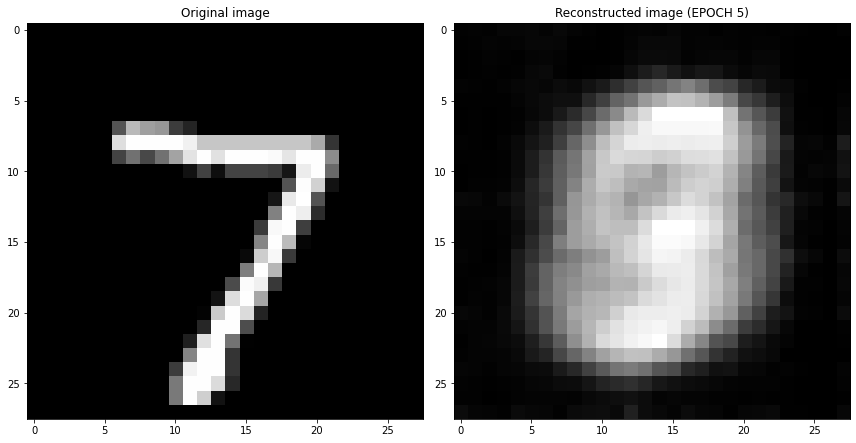

EPOCH 6/30
	 partial train loss (single batch): 0.070662
	 partial train loss (single batch): 0.067633
	 partial train loss (single batch): 0.069834
	 partial train loss (single batch): 0.069965
	 partial train loss (single batch): 0.067828
	 partial train loss (single batch): 0.069567
	 partial train loss (single batch): 0.067987
	 partial train loss (single batch): 0.069404
	 partial train loss (single batch): 0.066346
	 partial train loss (single batch): 0.066008
	 partial train loss (single batch): 0.068014
	 partial train loss (single batch): 0.068576
	 partial train loss (single batch): 0.066579
	 partial train loss (single batch): 0.067040
	 partial train loss (single batch): 0.066064
	 partial train loss (single batch): 0.069818
	 partial train loss (single batch): 0.068431
	 partial train loss (single batch): 0.068005
	 partial train loss (single batch): 0.065331
	 partial train loss (single batch): 0.067169
	 partial train loss (single batch): 0.069795
	 partial train loss (s

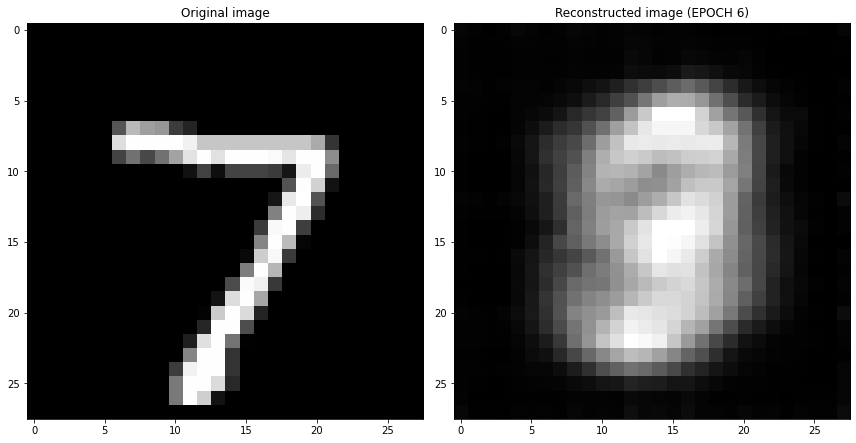

EPOCH 7/30
	 partial train loss (single batch): 0.068191
	 partial train loss (single batch): 0.065902
	 partial train loss (single batch): 0.068517
	 partial train loss (single batch): 0.066294
	 partial train loss (single batch): 0.066455
	 partial train loss (single batch): 0.067838
	 partial train loss (single batch): 0.069572
	 partial train loss (single batch): 0.069191
	 partial train loss (single batch): 0.070942
	 partial train loss (single batch): 0.069638
	 partial train loss (single batch): 0.067042
	 partial train loss (single batch): 0.068398
	 partial train loss (single batch): 0.067267
	 partial train loss (single batch): 0.067110
	 partial train loss (single batch): 0.066836
	 partial train loss (single batch): 0.067132
	 partial train loss (single batch): 0.068556
	 partial train loss (single batch): 0.068114
	 partial train loss (single batch): 0.068200
	 partial train loss (single batch): 0.066395
	 partial train loss (single batch): 0.068148
	 partial train loss (s

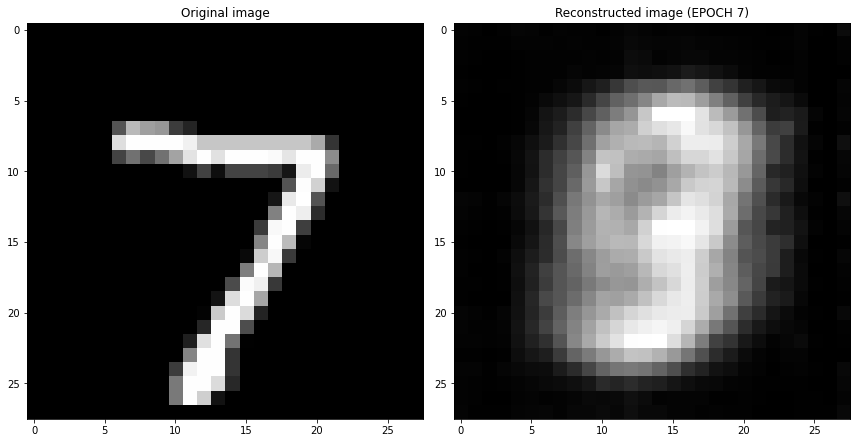

EPOCH 8/30
	 partial train loss (single batch): 0.066490
	 partial train loss (single batch): 0.066643
	 partial train loss (single batch): 0.067310
	 partial train loss (single batch): 0.068692
	 partial train loss (single batch): 0.068308
	 partial train loss (single batch): 0.068341
	 partial train loss (single batch): 0.067437
	 partial train loss (single batch): 0.068663
	 partial train loss (single batch): 0.067974
	 partial train loss (single batch): 0.067069
	 partial train loss (single batch): 0.066903
	 partial train loss (single batch): 0.067267
	 partial train loss (single batch): 0.064768
	 partial train loss (single batch): 0.066339
	 partial train loss (single batch): 0.067214
	 partial train loss (single batch): 0.066356
	 partial train loss (single batch): 0.065677
	 partial train loss (single batch): 0.067053
	 partial train loss (single batch): 0.067421
	 partial train loss (single batch): 0.067158
	 partial train loss (single batch): 0.068440
	 partial train loss (s

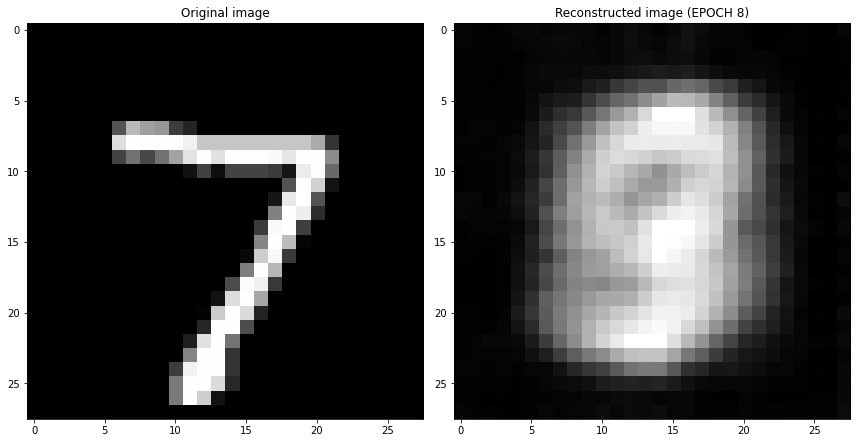

EPOCH 9/30
	 partial train loss (single batch): 0.066187
	 partial train loss (single batch): 0.070117
	 partial train loss (single batch): 0.066708
	 partial train loss (single batch): 0.067766
	 partial train loss (single batch): 0.068822
	 partial train loss (single batch): 0.068439
	 partial train loss (single batch): 0.068955
	 partial train loss (single batch): 0.069134
	 partial train loss (single batch): 0.067043
	 partial train loss (single batch): 0.068023
	 partial train loss (single batch): 0.070080
	 partial train loss (single batch): 0.067204
	 partial train loss (single batch): 0.067215
	 partial train loss (single batch): 0.068376
	 partial train loss (single batch): 0.068392
	 partial train loss (single batch): 0.067319
	 partial train loss (single batch): 0.067343
	 partial train loss (single batch): 0.066465
	 partial train loss (single batch): 0.069701
	 partial train loss (single batch): 0.066230
	 partial train loss (single batch): 0.068698
	 partial train loss (s

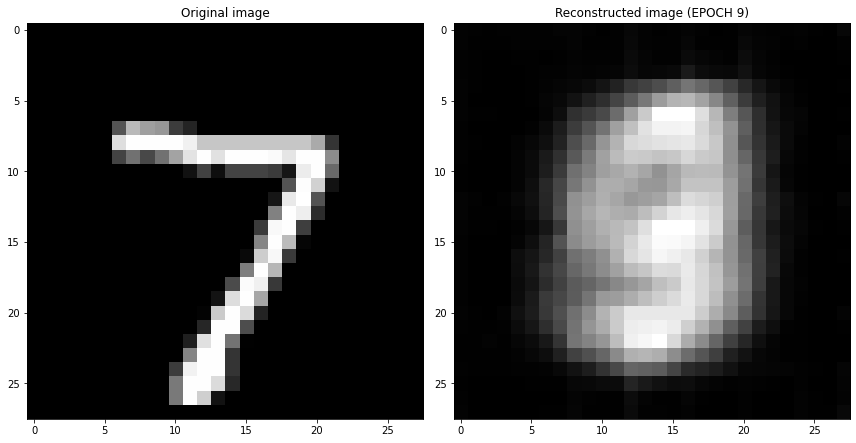

EPOCH 10/30
	 partial train loss (single batch): 0.068438
	 partial train loss (single batch): 0.068589
	 partial train loss (single batch): 0.068774
	 partial train loss (single batch): 0.066246
	 partial train loss (single batch): 0.066715
	 partial train loss (single batch): 0.067320
	 partial train loss (single batch): 0.067848
	 partial train loss (single batch): 0.066566
	 partial train loss (single batch): 0.068716
	 partial train loss (single batch): 0.066077
	 partial train loss (single batch): 0.068573
	 partial train loss (single batch): 0.067170
	 partial train loss (single batch): 0.067199
	 partial train loss (single batch): 0.067822
	 partial train loss (single batch): 0.070370
	 partial train loss (single batch): 0.068617
	 partial train loss (single batch): 0.067804
	 partial train loss (single batch): 0.068067
	 partial train loss (single batch): 0.067279
	 partial train loss (single batch): 0.068779
	 partial train loss (single batch): 0.069784
	 partial train loss (

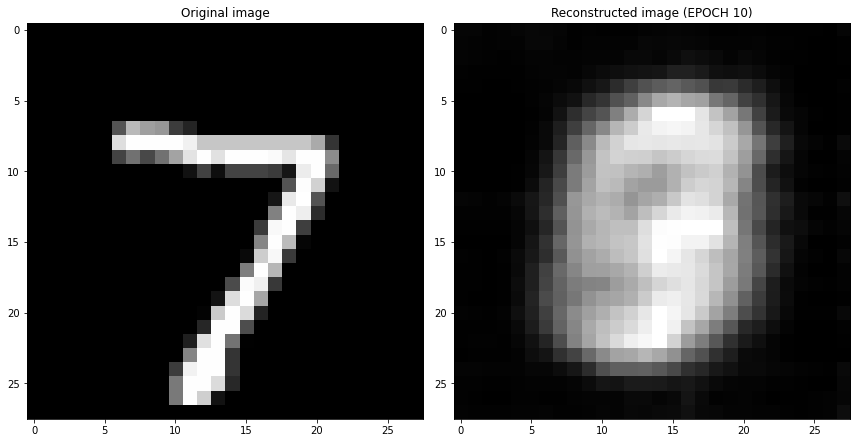

EPOCH 11/30
	 partial train loss (single batch): 0.067647
	 partial train loss (single batch): 0.068243
	 partial train loss (single batch): 0.068895
	 partial train loss (single batch): 0.068804
	 partial train loss (single batch): 0.065691
	 partial train loss (single batch): 0.068078
	 partial train loss (single batch): 0.068752
	 partial train loss (single batch): 0.066008
	 partial train loss (single batch): 0.068425
	 partial train loss (single batch): 0.067836
	 partial train loss (single batch): 0.063096
	 partial train loss (single batch): 0.069713
	 partial train loss (single batch): 0.066636
	 partial train loss (single batch): 0.068650
	 partial train loss (single batch): 0.068186
	 partial train loss (single batch): 0.066102
	 partial train loss (single batch): 0.066215
	 partial train loss (single batch): 0.069465
	 partial train loss (single batch): 0.068019
	 partial train loss (single batch): 0.067746
	 partial train loss (single batch): 0.069740
	 partial train loss (

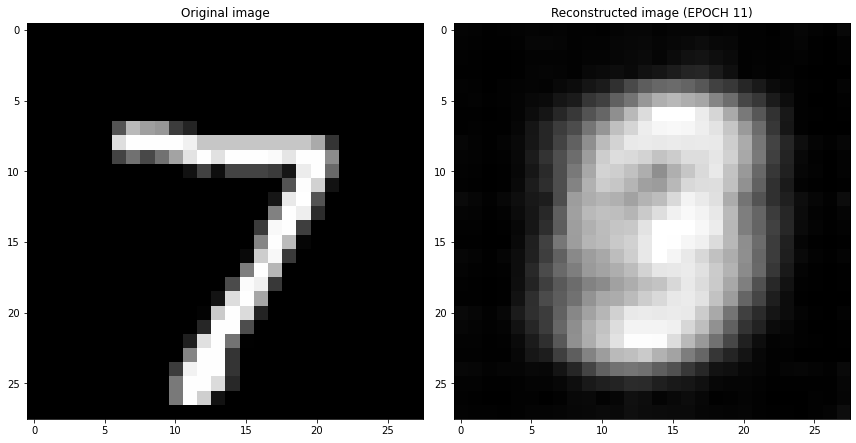

EPOCH 12/30
	 partial train loss (single batch): 0.067366
	 partial train loss (single batch): 0.066944
	 partial train loss (single batch): 0.065537
	 partial train loss (single batch): 0.068723
	 partial train loss (single batch): 0.065914
	 partial train loss (single batch): 0.068084
	 partial train loss (single batch): 0.068004
	 partial train loss (single batch): 0.068944
	 partial train loss (single batch): 0.067076
	 partial train loss (single batch): 0.066163
	 partial train loss (single batch): 0.067218
	 partial train loss (single batch): 0.066361
	 partial train loss (single batch): 0.067267
	 partial train loss (single batch): 0.068865
	 partial train loss (single batch): 0.069556
	 partial train loss (single batch): 0.067656
	 partial train loss (single batch): 0.065891
	 partial train loss (single batch): 0.066150
	 partial train loss (single batch): 0.066859
	 partial train loss (single batch): 0.064871
	 partial train loss (single batch): 0.066768
	 partial train loss (

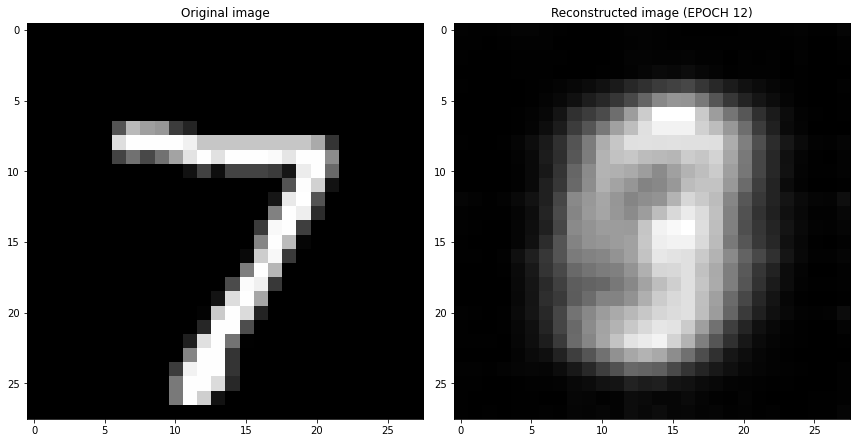

EPOCH 13/30
	 partial train loss (single batch): 0.068659
	 partial train loss (single batch): 0.067404
	 partial train loss (single batch): 0.067615
	 partial train loss (single batch): 0.066938
	 partial train loss (single batch): 0.067275
	 partial train loss (single batch): 0.066439
	 partial train loss (single batch): 0.066663
	 partial train loss (single batch): 0.068517
	 partial train loss (single batch): 0.067977
	 partial train loss (single batch): 0.066312
	 partial train loss (single batch): 0.066814
	 partial train loss (single batch): 0.068939
	 partial train loss (single batch): 0.065960
	 partial train loss (single batch): 0.066870
	 partial train loss (single batch): 0.067781
	 partial train loss (single batch): 0.066148
	 partial train loss (single batch): 0.067428
	 partial train loss (single batch): 0.065041
	 partial train loss (single batch): 0.067512
	 partial train loss (single batch): 0.068471
	 partial train loss (single batch): 0.067120
	 partial train loss (

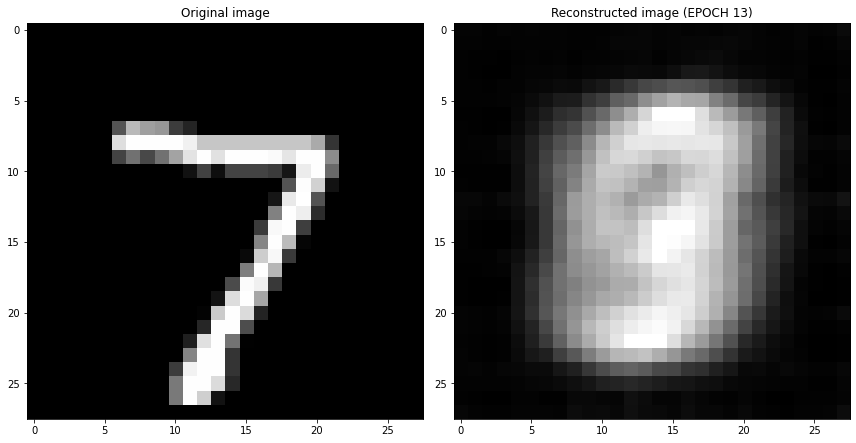

EPOCH 14/30
	 partial train loss (single batch): 0.067688
	 partial train loss (single batch): 0.066783
	 partial train loss (single batch): 0.068042
	 partial train loss (single batch): 0.067855
	 partial train loss (single batch): 0.067032
	 partial train loss (single batch): 0.067616
	 partial train loss (single batch): 0.067407
	 partial train loss (single batch): 0.069532
	 partial train loss (single batch): 0.069957
	 partial train loss (single batch): 0.067319
	 partial train loss (single batch): 0.068345
	 partial train loss (single batch): 0.070296
	 partial train loss (single batch): 0.067261
	 partial train loss (single batch): 0.067703
	 partial train loss (single batch): 0.069426
	 partial train loss (single batch): 0.066809
	 partial train loss (single batch): 0.066599
	 partial train loss (single batch): 0.068152
	 partial train loss (single batch): 0.068434
	 partial train loss (single batch): 0.069801
	 partial train loss (single batch): 0.066980
	 partial train loss (

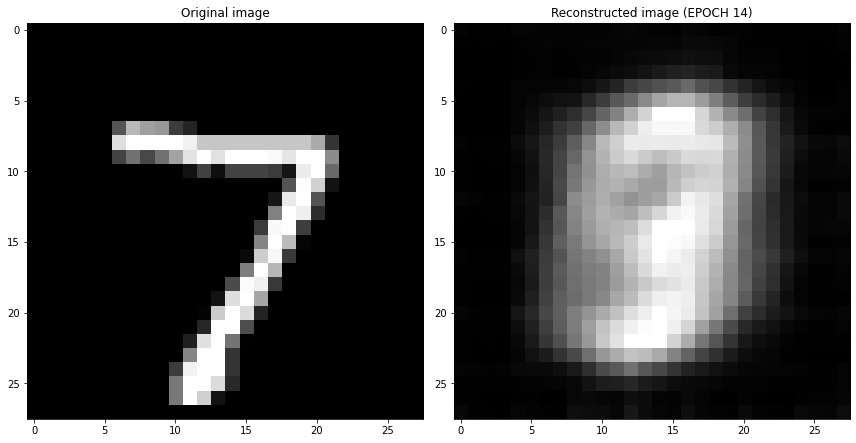

EPOCH 15/30
	 partial train loss (single batch): 0.066646
	 partial train loss (single batch): 0.064400
	 partial train loss (single batch): 0.066140
	 partial train loss (single batch): 0.067792
	 partial train loss (single batch): 0.067505
	 partial train loss (single batch): 0.068681
	 partial train loss (single batch): 0.066560
	 partial train loss (single batch): 0.067277
	 partial train loss (single batch): 0.067394
	 partial train loss (single batch): 0.067851
	 partial train loss (single batch): 0.068961
	 partial train loss (single batch): 0.067035
	 partial train loss (single batch): 0.067838
	 partial train loss (single batch): 0.068017
	 partial train loss (single batch): 0.068652
	 partial train loss (single batch): 0.067475
	 partial train loss (single batch): 0.066247
	 partial train loss (single batch): 0.068458
	 partial train loss (single batch): 0.066166
	 partial train loss (single batch): 0.066594
	 partial train loss (single batch): 0.070018
	 partial train loss (

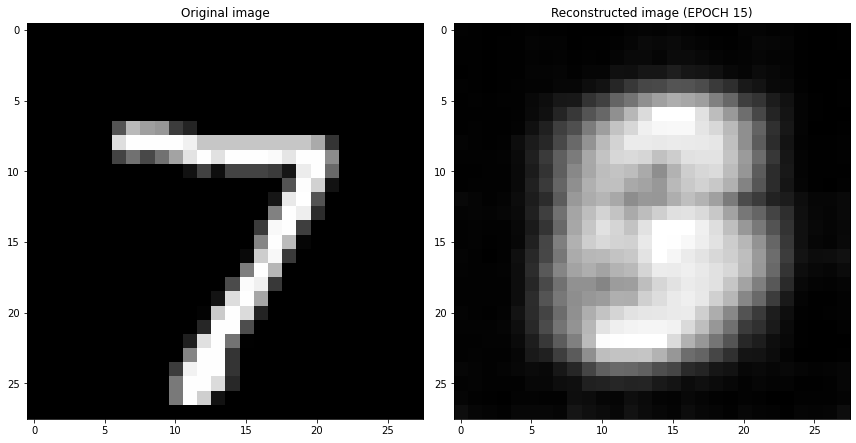

EPOCH 16/30
	 partial train loss (single batch): 0.067290
	 partial train loss (single batch): 0.067689
	 partial train loss (single batch): 0.068789
	 partial train loss (single batch): 0.066252
	 partial train loss (single batch): 0.068334
	 partial train loss (single batch): 0.066994
	 partial train loss (single batch): 0.065691
	 partial train loss (single batch): 0.067143
	 partial train loss (single batch): 0.070247
	 partial train loss (single batch): 0.067746
	 partial train loss (single batch): 0.067588
	 partial train loss (single batch): 0.068848
	 partial train loss (single batch): 0.067790
	 partial train loss (single batch): 0.067921
	 partial train loss (single batch): 0.068565
	 partial train loss (single batch): 0.068155
	 partial train loss (single batch): 0.067013
	 partial train loss (single batch): 0.066712
	 partial train loss (single batch): 0.069122
	 partial train loss (single batch): 0.067190
	 partial train loss (single batch): 0.069185
	 partial train loss (

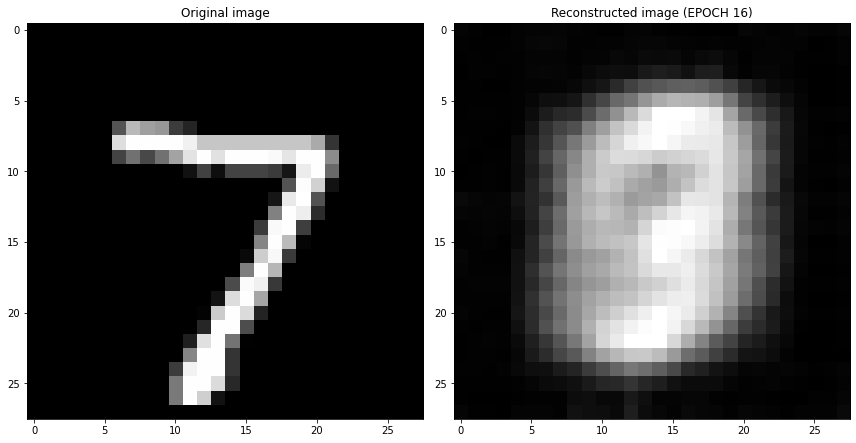

EPOCH 17/30
	 partial train loss (single batch): 0.068841
	 partial train loss (single batch): 0.068492
	 partial train loss (single batch): 0.066728
	 partial train loss (single batch): 0.065965
	 partial train loss (single batch): 0.070038
	 partial train loss (single batch): 0.066052
	 partial train loss (single batch): 0.067332
	 partial train loss (single batch): 0.068499
	 partial train loss (single batch): 0.066928
	 partial train loss (single batch): 0.070262
	 partial train loss (single batch): 0.067636
	 partial train loss (single batch): 0.066956
	 partial train loss (single batch): 0.066650
	 partial train loss (single batch): 0.066967
	 partial train loss (single batch): 0.064969
	 partial train loss (single batch): 0.068218
	 partial train loss (single batch): 0.065943
	 partial train loss (single batch): 0.068803
	 partial train loss (single batch): 0.068511
	 partial train loss (single batch): 0.067947
	 partial train loss (single batch): 0.066912
	 partial train loss (

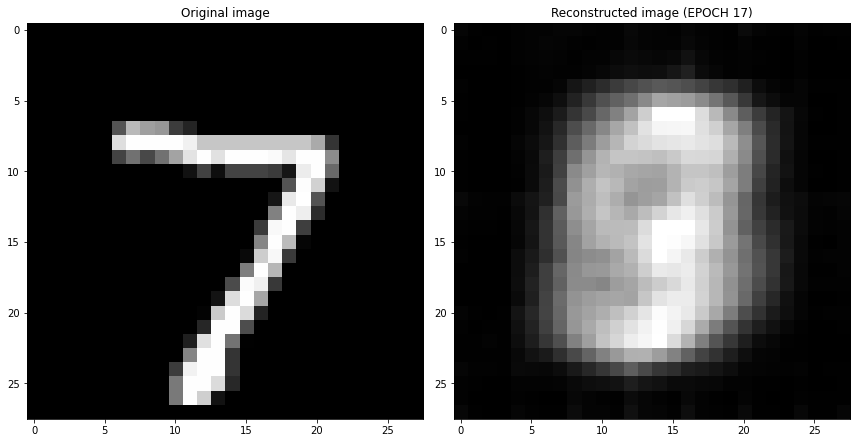

EPOCH 18/30
	 partial train loss (single batch): 0.067114
	 partial train loss (single batch): 0.067947
	 partial train loss (single batch): 0.068341
	 partial train loss (single batch): 0.067241
	 partial train loss (single batch): 0.066625
	 partial train loss (single batch): 0.069630
	 partial train loss (single batch): 0.068485
	 partial train loss (single batch): 0.069517
	 partial train loss (single batch): 0.065377
	 partial train loss (single batch): 0.068202
	 partial train loss (single batch): 0.070452
	 partial train loss (single batch): 0.067366
	 partial train loss (single batch): 0.069765
	 partial train loss (single batch): 0.070032
	 partial train loss (single batch): 0.067634
	 partial train loss (single batch): 0.065975
	 partial train loss (single batch): 0.065495
	 partial train loss (single batch): 0.066744
	 partial train loss (single batch): 0.066233
	 partial train loss (single batch): 0.067254
	 partial train loss (single batch): 0.067383
	 partial train loss (

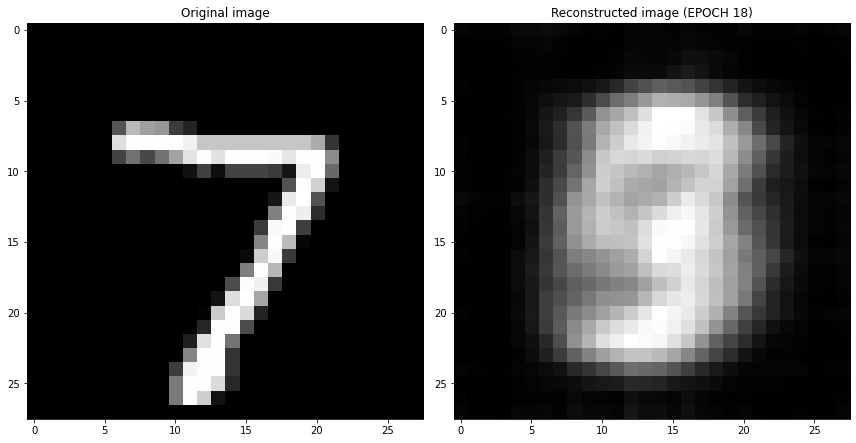

EPOCH 19/30
	 partial train loss (single batch): 0.070616
	 partial train loss (single batch): 0.066541
	 partial train loss (single batch): 0.067682
	 partial train loss (single batch): 0.067833
	 partial train loss (single batch): 0.067887
	 partial train loss (single batch): 0.068553
	 partial train loss (single batch): 0.068353
	 partial train loss (single batch): 0.066410
	 partial train loss (single batch): 0.070271
	 partial train loss (single batch): 0.065766
	 partial train loss (single batch): 0.065944
	 partial train loss (single batch): 0.068964
	 partial train loss (single batch): 0.067218
	 partial train loss (single batch): 0.069623
	 partial train loss (single batch): 0.069018
	 partial train loss (single batch): 0.066142
	 partial train loss (single batch): 0.067031
	 partial train loss (single batch): 0.066577
	 partial train loss (single batch): 0.068852
	 partial train loss (single batch): 0.067673
	 partial train loss (single batch): 0.066561
	 partial train loss (

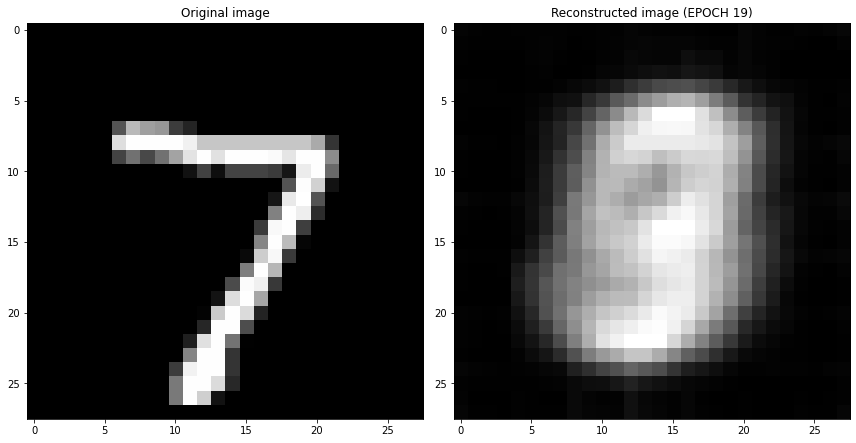

EPOCH 20/30
	 partial train loss (single batch): 0.067742
	 partial train loss (single batch): 0.066215
	 partial train loss (single batch): 0.069293
	 partial train loss (single batch): 0.067560
	 partial train loss (single batch): 0.067592
	 partial train loss (single batch): 0.068740
	 partial train loss (single batch): 0.067722
	 partial train loss (single batch): 0.066878
	 partial train loss (single batch): 0.066405
	 partial train loss (single batch): 0.067613
	 partial train loss (single batch): 0.067616
	 partial train loss (single batch): 0.066549
	 partial train loss (single batch): 0.070345
	 partial train loss (single batch): 0.067642
	 partial train loss (single batch): 0.066954
	 partial train loss (single batch): 0.066342
	 partial train loss (single batch): 0.067232
	 partial train loss (single batch): 0.067221
	 partial train loss (single batch): 0.068477
	 partial train loss (single batch): 0.068293
	 partial train loss (single batch): 0.065165
	 partial train loss (

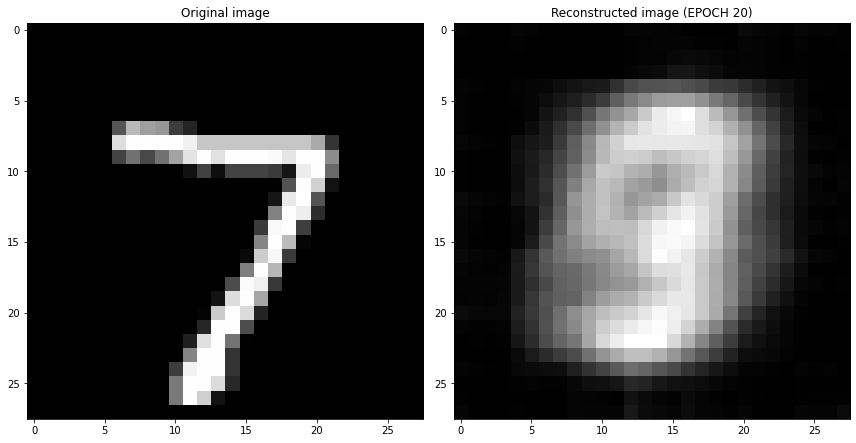

EPOCH 21/30
	 partial train loss (single batch): 0.069349
	 partial train loss (single batch): 0.066108
	 partial train loss (single batch): 0.068740
	 partial train loss (single batch): 0.066905
	 partial train loss (single batch): 0.069121
	 partial train loss (single batch): 0.068104
	 partial train loss (single batch): 0.066689
	 partial train loss (single batch): 0.068895
	 partial train loss (single batch): 0.066098
	 partial train loss (single batch): 0.068901
	 partial train loss (single batch): 0.066795
	 partial train loss (single batch): 0.068704
	 partial train loss (single batch): 0.065560
	 partial train loss (single batch): 0.067904
	 partial train loss (single batch): 0.067344
	 partial train loss (single batch): 0.068804
	 partial train loss (single batch): 0.068679
	 partial train loss (single batch): 0.067230
	 partial train loss (single batch): 0.066109
	 partial train loss (single batch): 0.066885
	 partial train loss (single batch): 0.067217
	 partial train loss (

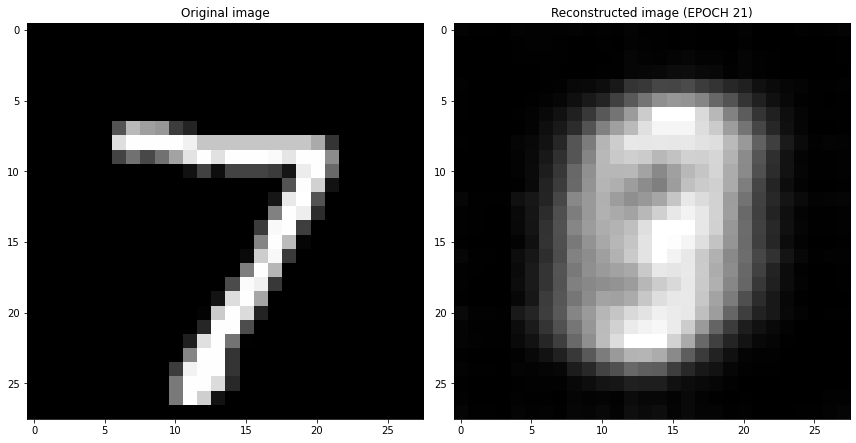

EPOCH 22/30
	 partial train loss (single batch): 0.067950
	 partial train loss (single batch): 0.069110
	 partial train loss (single batch): 0.067043
	 partial train loss (single batch): 0.066522
	 partial train loss (single batch): 0.067786
	 partial train loss (single batch): 0.068797
	 partial train loss (single batch): 0.067896
	 partial train loss (single batch): 0.067560
	 partial train loss (single batch): 0.067874
	 partial train loss (single batch): 0.068253
	 partial train loss (single batch): 0.068100
	 partial train loss (single batch): 0.067139
	 partial train loss (single batch): 0.066717
	 partial train loss (single batch): 0.067082
	 partial train loss (single batch): 0.068443
	 partial train loss (single batch): 0.066380
	 partial train loss (single batch): 0.066281
	 partial train loss (single batch): 0.070156
	 partial train loss (single batch): 0.066844
	 partial train loss (single batch): 0.067366
	 partial train loss (single batch): 0.070251
	 partial train loss (

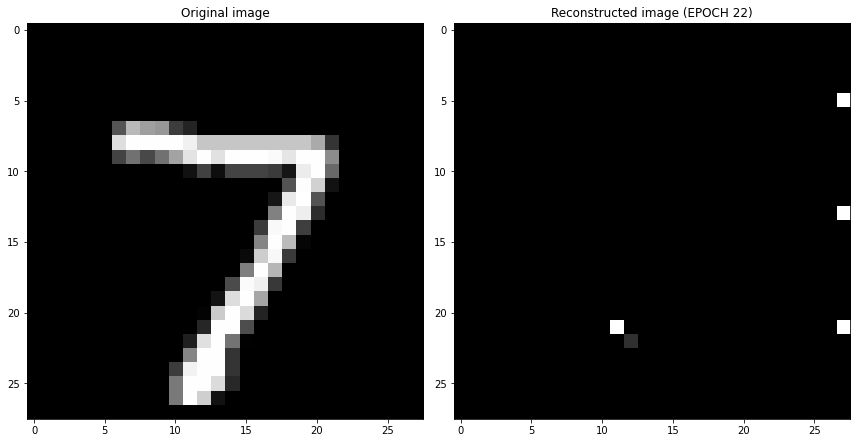

EPOCH 23/30
	 partial train loss (single batch): 0.113767
	 partial train loss (single batch): 0.118939
	 partial train loss (single batch): 0.118044
	 partial train loss (single batch): 0.116381
	 partial train loss (single batch): 0.112461
	 partial train loss (single batch): 0.113727
	 partial train loss (single batch): 0.109031
	 partial train loss (single batch): 0.112123
	 partial train loss (single batch): 0.114197
	 partial train loss (single batch): 0.112677
	 partial train loss (single batch): 0.113336
	 partial train loss (single batch): 0.115471
	 partial train loss (single batch): 0.113558
	 partial train loss (single batch): 0.111692
	 partial train loss (single batch): 0.112987
	 partial train loss (single batch): 0.112983
	 partial train loss (single batch): 0.109966
	 partial train loss (single batch): 0.109950
	 partial train loss (single batch): 0.113445
	 partial train loss (single batch): 0.114775
	 partial train loss (single batch): 0.113190
	 partial train loss (

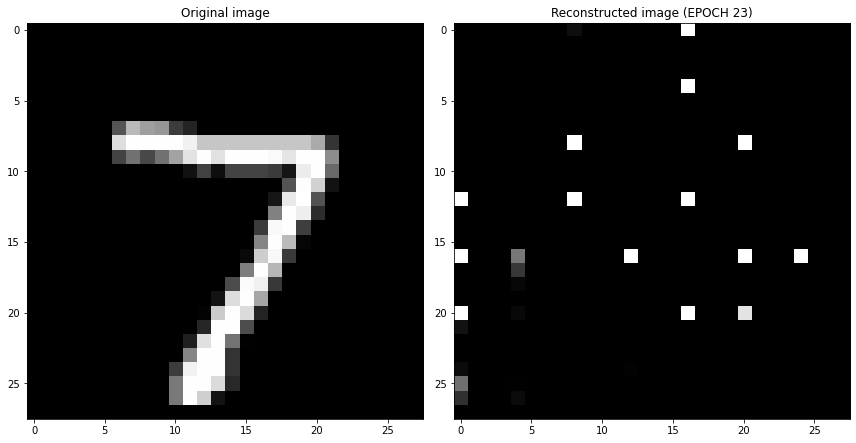

EPOCH 24/30
	 partial train loss (single batch): 0.110960
	 partial train loss (single batch): 0.111933
	 partial train loss (single batch): 0.110274
	 partial train loss (single batch): 0.113727
	 partial train loss (single batch): 0.112397
	 partial train loss (single batch): 0.108936
	 partial train loss (single batch): 0.110765
	 partial train loss (single batch): 0.108671
	 partial train loss (single batch): 0.109260
	 partial train loss (single batch): 0.111557
	 partial train loss (single batch): 0.108491
	 partial train loss (single batch): 0.113782
	 partial train loss (single batch): 0.113828
	 partial train loss (single batch): 0.110808
	 partial train loss (single batch): 0.110770
	 partial train loss (single batch): 0.112823
	 partial train loss (single batch): 0.115257
	 partial train loss (single batch): 0.113391
	 partial train loss (single batch): 0.115434
	 partial train loss (single batch): 0.111429
	 partial train loss (single batch): 0.110133
	 partial train loss (

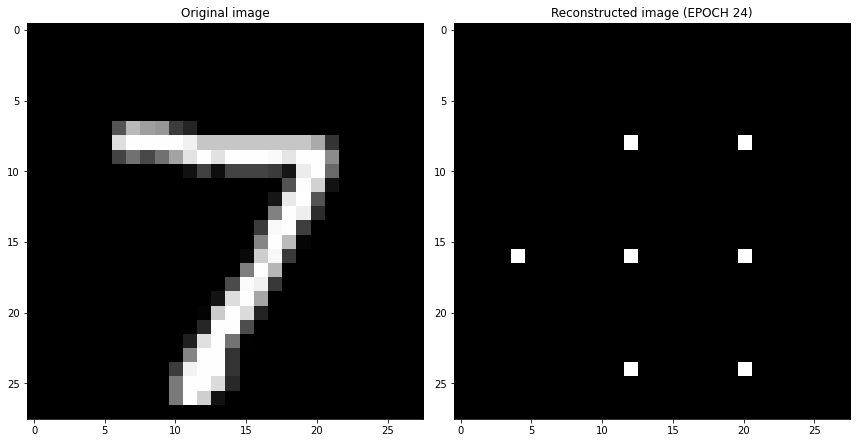

EPOCH 25/30
	 partial train loss (single batch): 0.109473
	 partial train loss (single batch): 0.112813
	 partial train loss (single batch): 0.111019
	 partial train loss (single batch): 0.109911
	 partial train loss (single batch): 0.110945
	 partial train loss (single batch): 0.109039
	 partial train loss (single batch): 0.107603
	 partial train loss (single batch): 0.105566
	 partial train loss (single batch): 0.112712
	 partial train loss (single batch): 0.107936
	 partial train loss (single batch): 0.116435
	 partial train loss (single batch): 0.114242
	 partial train loss (single batch): 0.111585
	 partial train loss (single batch): 0.112759
	 partial train loss (single batch): 0.114074
	 partial train loss (single batch): 0.113241
	 partial train loss (single batch): 0.106295
	 partial train loss (single batch): 0.113034
	 partial train loss (single batch): 0.108480
	 partial train loss (single batch): 0.110696
	 partial train loss (single batch): 0.112281
	 partial train loss (

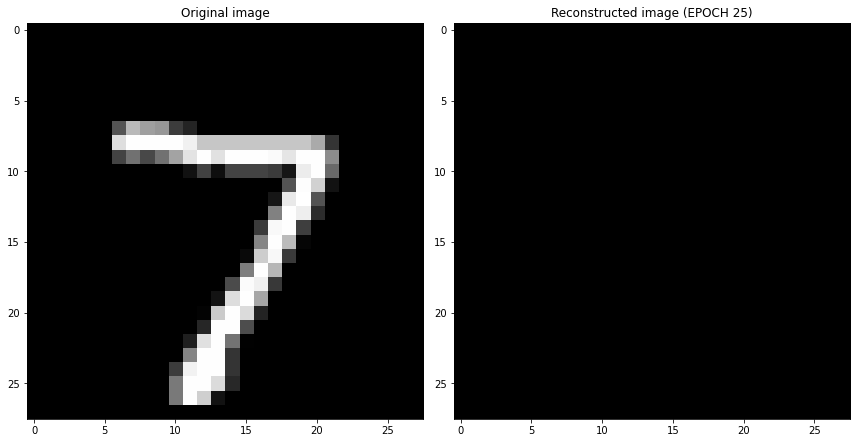

EPOCH 26/30
	 partial train loss (single batch): 0.111491
	 partial train loss (single batch): 0.111826
	 partial train loss (single batch): 0.115283
	 partial train loss (single batch): 0.113063
	 partial train loss (single batch): 0.113118
	 partial train loss (single batch): 0.112233
	 partial train loss (single batch): 0.116209
	 partial train loss (single batch): 0.115529
	 partial train loss (single batch): 0.114007
	 partial train loss (single batch): 0.111577
	 partial train loss (single batch): 0.116025
	 partial train loss (single batch): 0.110544
	 partial train loss (single batch): 0.114454
	 partial train loss (single batch): 0.110362
	 partial train loss (single batch): 0.115239
	 partial train loss (single batch): 0.108924
	 partial train loss (single batch): 0.112551
	 partial train loss (single batch): 0.109918
	 partial train loss (single batch): 0.114435
	 partial train loss (single batch): 0.109589
	 partial train loss (single batch): 0.110135
	 partial train loss (

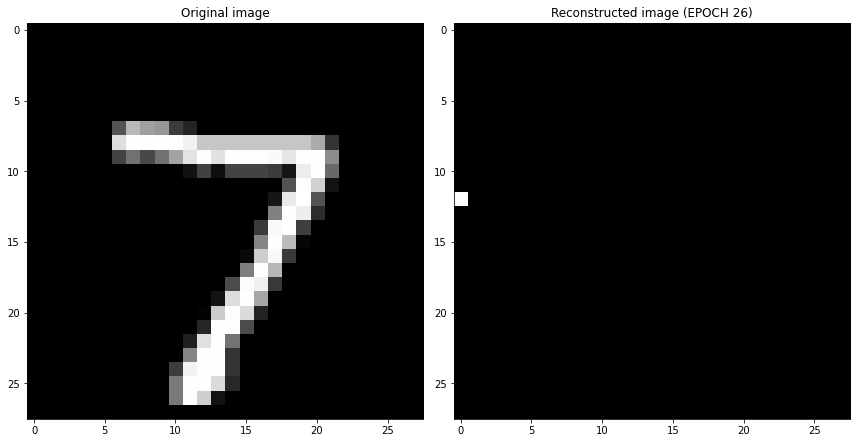

EPOCH 27/30
	 partial train loss (single batch): 0.111634
	 partial train loss (single batch): 0.110203
	 partial train loss (single batch): 0.110001
	 partial train loss (single batch): 0.116515
	 partial train loss (single batch): 0.115854
	 partial train loss (single batch): 0.109238
	 partial train loss (single batch): 0.111877
	 partial train loss (single batch): 0.113295
	 partial train loss (single batch): 0.112918
	 partial train loss (single batch): 0.108903
	 partial train loss (single batch): 0.116365
	 partial train loss (single batch): 0.107609
	 partial train loss (single batch): 0.114521
	 partial train loss (single batch): 0.115295
	 partial train loss (single batch): 0.110970
	 partial train loss (single batch): 0.114087
	 partial train loss (single batch): 0.112534
	 partial train loss (single batch): 0.114977
	 partial train loss (single batch): 0.111378
	 partial train loss (single batch): 0.115044
	 partial train loss (single batch): 0.111305
	 partial train loss (

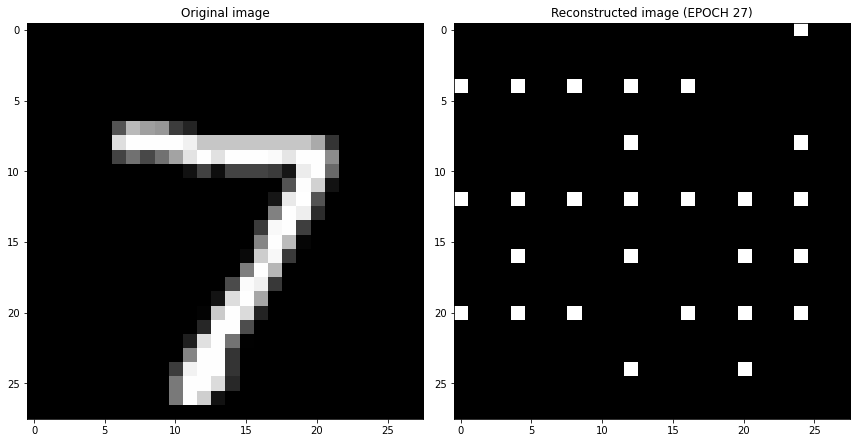

EPOCH 28/30
	 partial train loss (single batch): 0.111939
	 partial train loss (single batch): 0.112027
	 partial train loss (single batch): 0.107241
	 partial train loss (single batch): 0.111259
	 partial train loss (single batch): 0.106882
	 partial train loss (single batch): 0.112802
	 partial train loss (single batch): 0.113365
	 partial train loss (single batch): 0.111935
	 partial train loss (single batch): 0.109981
	 partial train loss (single batch): 0.110787
	 partial train loss (single batch): 0.106530
	 partial train loss (single batch): 0.115871
	 partial train loss (single batch): 0.109831
	 partial train loss (single batch): 0.113284
	 partial train loss (single batch): 0.111991
	 partial train loss (single batch): 0.109086
	 partial train loss (single batch): 0.109671
	 partial train loss (single batch): 0.110754
	 partial train loss (single batch): 0.114142
	 partial train loss (single batch): 0.113167
	 partial train loss (single batch): 0.112740
	 partial train loss (

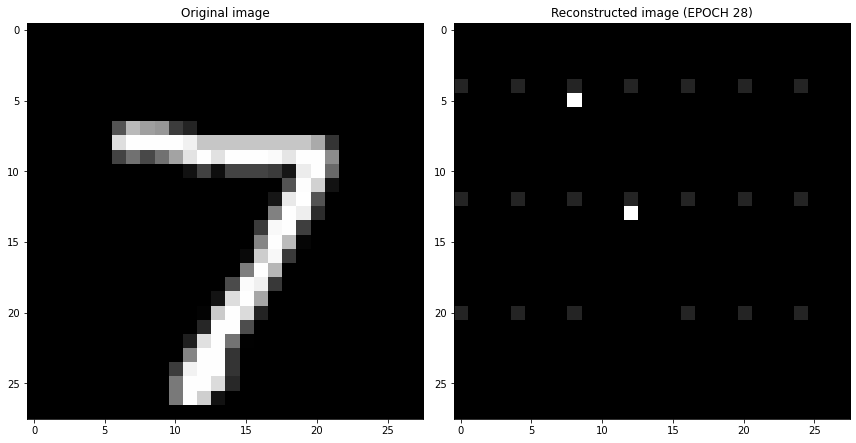

EPOCH 29/30
	 partial train loss (single batch): 0.114418
	 partial train loss (single batch): 0.111457
	 partial train loss (single batch): 0.112795
	 partial train loss (single batch): 0.109850
	 partial train loss (single batch): 0.113111
	 partial train loss (single batch): 0.117277
	 partial train loss (single batch): 0.112254
	 partial train loss (single batch): 0.110590
	 partial train loss (single batch): 0.115486
	 partial train loss (single batch): 0.114608
	 partial train loss (single batch): 0.112728
	 partial train loss (single batch): 0.106250
	 partial train loss (single batch): 0.114745
	 partial train loss (single batch): 0.112647
	 partial train loss (single batch): 0.109826
	 partial train loss (single batch): 0.113630
	 partial train loss (single batch): 0.114571
	 partial train loss (single batch): 0.111980
	 partial train loss (single batch): 0.111367
	 partial train loss (single batch): 0.110889
	 partial train loss (single batch): 0.117886
	 partial train loss (

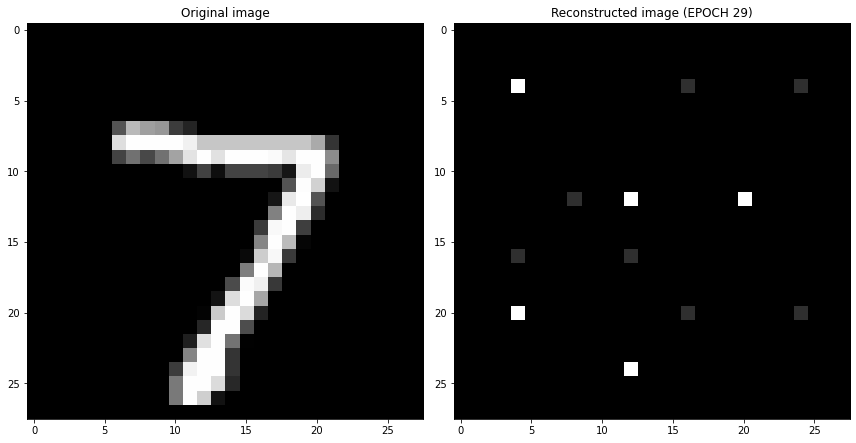

EPOCH 30/30
	 partial train loss (single batch): 0.114659
	 partial train loss (single batch): 0.113050
	 partial train loss (single batch): 0.111749
	 partial train loss (single batch): 0.110523
	 partial train loss (single batch): 0.111948
	 partial train loss (single batch): 0.108485
	 partial train loss (single batch): 0.111101
	 partial train loss (single batch): 0.110505
	 partial train loss (single batch): 0.111453
	 partial train loss (single batch): 0.110606
	 partial train loss (single batch): 0.111660
	 partial train loss (single batch): 0.113367
	 partial train loss (single batch): 0.112325
	 partial train loss (single batch): 0.108781
	 partial train loss (single batch): 0.113093
	 partial train loss (single batch): 0.110697
	 partial train loss (single batch): 0.115247
	 partial train loss (single batch): 0.112409
	 partial train loss (single batch): 0.110273
	 partial train loss (single batch): 0.116299
	 partial train loss (single batch): 0.108961
	 partial train loss (

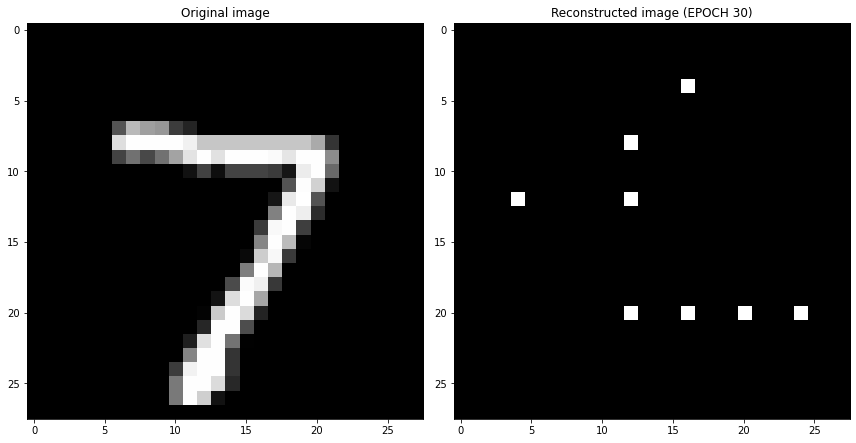

Cross validation fold number= 5/6
EPOCH 1/30
	 partial train loss (single batch): 0.308176
	 partial train loss (single batch): 0.243981
	 partial train loss (single batch): 0.161018
	 partial train loss (single batch): 0.110913
	 partial train loss (single batch): 0.107867
	 partial train loss (single batch): 0.106988
	 partial train loss (single batch): 0.104878
	 partial train loss (single batch): 0.112766
	 partial train loss (single batch): 0.113690
	 partial train loss (single batch): 0.114209
	 partial train loss (single batch): 0.111592
	 partial train loss (single batch): 0.108593
	 partial train loss (single batch): 0.112554
	 partial train loss (single batch): 0.111747
	 partial train loss (single batch): 0.109770
	 partial train loss (single batch): 0.108354
	 partial train loss (single batch): 0.107669
	 partial train loss (single batch): 0.104297
	 partial train loss (single batch): 0.110789
	 partial train loss (single batch): 0.114923
	 partial train loss (single batch)

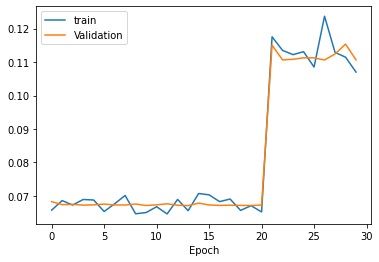

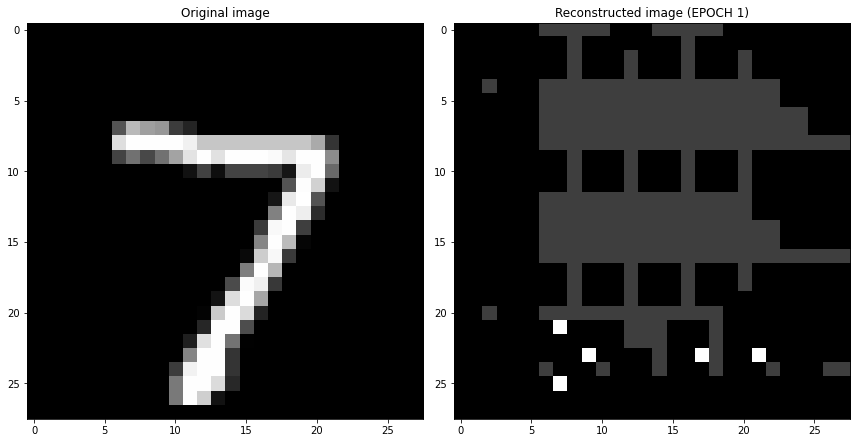

EPOCH 2/30
	 partial train loss (single batch): 0.095779
	 partial train loss (single batch): 0.097823
	 partial train loss (single batch): 0.095786
	 partial train loss (single batch): 0.093382
	 partial train loss (single batch): 0.091288
	 partial train loss (single batch): 0.098552
	 partial train loss (single batch): 0.095299
	 partial train loss (single batch): 0.099452
	 partial train loss (single batch): 0.094886
	 partial train loss (single batch): 0.095751
	 partial train loss (single batch): 0.094179
	 partial train loss (single batch): 0.097934
	 partial train loss (single batch): 0.098776
	 partial train loss (single batch): 0.096312
	 partial train loss (single batch): 0.099342
	 partial train loss (single batch): 0.101165
	 partial train loss (single batch): 0.098261
	 partial train loss (single batch): 0.102952
	 partial train loss (single batch): 0.103705
	 partial train loss (single batch): 0.099759
	 partial train loss (single batch): 0.101501
	 partial train loss (s

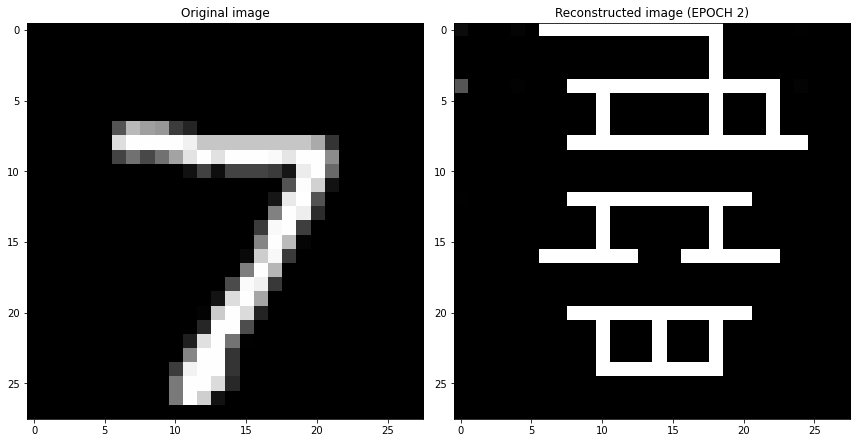

EPOCH 3/30
	 partial train loss (single batch): 0.100244
	 partial train loss (single batch): 0.104972
	 partial train loss (single batch): 0.101342
	 partial train loss (single batch): 0.101480
	 partial train loss (single batch): 0.102499
	 partial train loss (single batch): 0.103751
	 partial train loss (single batch): 0.106126
	 partial train loss (single batch): 0.102902
	 partial train loss (single batch): 0.101338
	 partial train loss (single batch): 0.101513
	 partial train loss (single batch): 0.102902
	 partial train loss (single batch): 0.100608
	 partial train loss (single batch): 0.096859
	 partial train loss (single batch): 0.101439
	 partial train loss (single batch): 0.104018
	 partial train loss (single batch): 0.098685
	 partial train loss (single batch): 0.099049
	 partial train loss (single batch): 0.098027
	 partial train loss (single batch): 0.103438
	 partial train loss (single batch): 0.104622
	 partial train loss (single batch): 0.099857
	 partial train loss (s

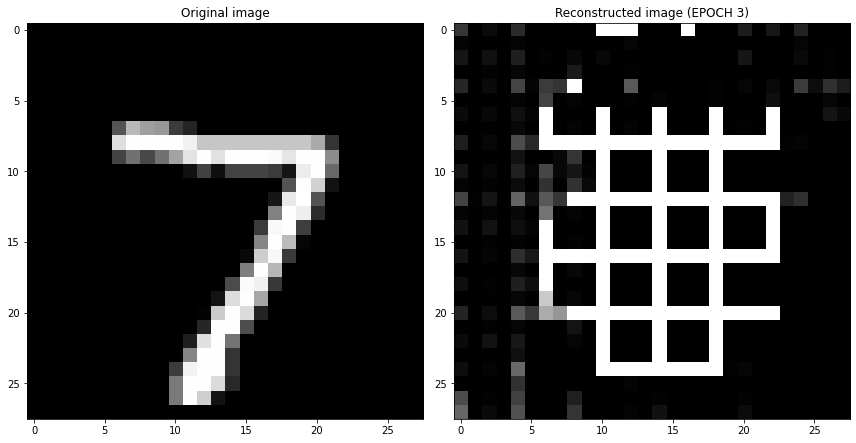

EPOCH 4/30
	 partial train loss (single batch): 0.100260
	 partial train loss (single batch): 0.097155
	 partial train loss (single batch): 0.096402
	 partial train loss (single batch): 0.094659
	 partial train loss (single batch): 0.093387
	 partial train loss (single batch): 0.089887
	 partial train loss (single batch): 0.096106
	 partial train loss (single batch): 0.123134
	 partial train loss (single batch): 0.087620
	 partial train loss (single batch): 0.086870
	 partial train loss (single batch): 0.084766
	 partial train loss (single batch): 0.099566
	 partial train loss (single batch): 0.087313
	 partial train loss (single batch): 0.083564
	 partial train loss (single batch): 0.084102
	 partial train loss (single batch): 0.085249
	 partial train loss (single batch): 0.087639
	 partial train loss (single batch): 0.087945
	 partial train loss (single batch): 0.087138
	 partial train loss (single batch): 0.085390
	 partial train loss (single batch): 0.087037
	 partial train loss (s

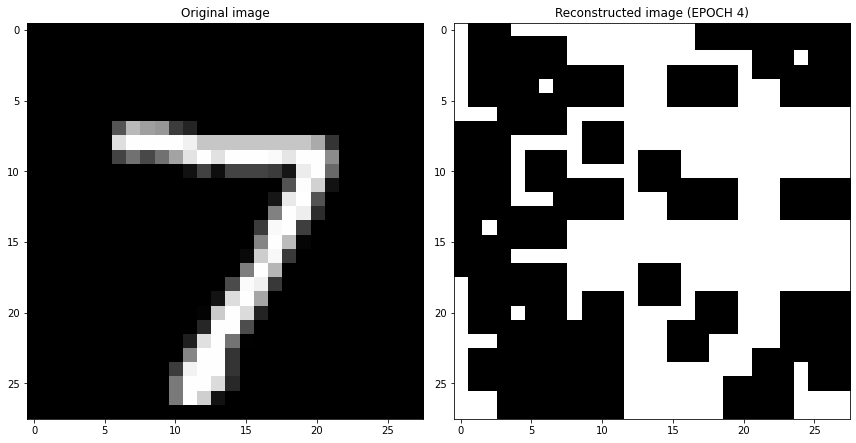

EPOCH 5/30
	 partial train loss (single batch): 0.101056
	 partial train loss (single batch): 0.099309
	 partial train loss (single batch): 0.098168
	 partial train loss (single batch): 0.099194
	 partial train loss (single batch): 0.102222
	 partial train loss (single batch): 0.094987
	 partial train loss (single batch): 0.098253
	 partial train loss (single batch): 0.099808
	 partial train loss (single batch): 0.097332
	 partial train loss (single batch): 0.096036
	 partial train loss (single batch): 0.100078
	 partial train loss (single batch): 0.099010
	 partial train loss (single batch): 0.096662
	 partial train loss (single batch): 0.100258
	 partial train loss (single batch): 0.102189
	 partial train loss (single batch): 0.097834
	 partial train loss (single batch): 0.102717
	 partial train loss (single batch): 0.095564
	 partial train loss (single batch): 0.102598
	 partial train loss (single batch): 0.101136
	 partial train loss (single batch): 0.099521
	 partial train loss (s

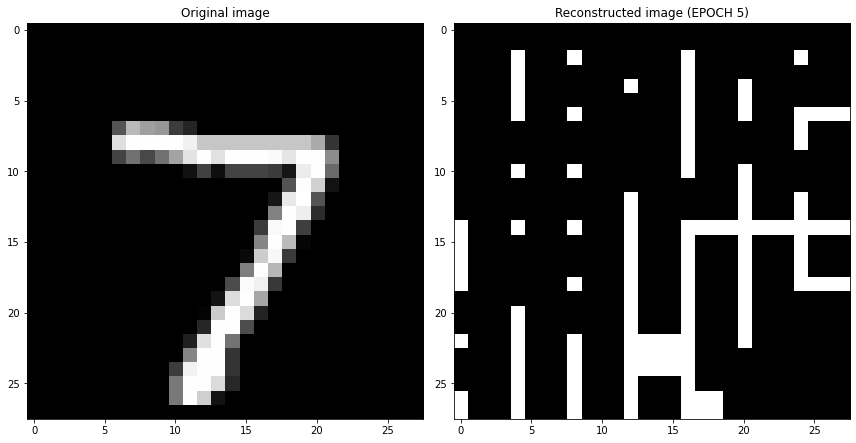

EPOCH 6/30
	 partial train loss (single batch): 0.106031
	 partial train loss (single batch): 0.107816
	 partial train loss (single batch): 0.110392
	 partial train loss (single batch): 0.111774
	 partial train loss (single batch): 0.104520
	 partial train loss (single batch): 0.107521
	 partial train loss (single batch): 0.107680
	 partial train loss (single batch): 0.107280
	 partial train loss (single batch): 0.108646
	 partial train loss (single batch): 0.105434
	 partial train loss (single batch): 0.107074
	 partial train loss (single batch): 0.107957
	 partial train loss (single batch): 0.105426
	 partial train loss (single batch): 0.107685
	 partial train loss (single batch): 0.105911
	 partial train loss (single batch): 0.107069
	 partial train loss (single batch): 0.106605
	 partial train loss (single batch): 0.103685
	 partial train loss (single batch): 0.106983
	 partial train loss (single batch): 0.106197
	 partial train loss (single batch): 0.104858
	 partial train loss (s

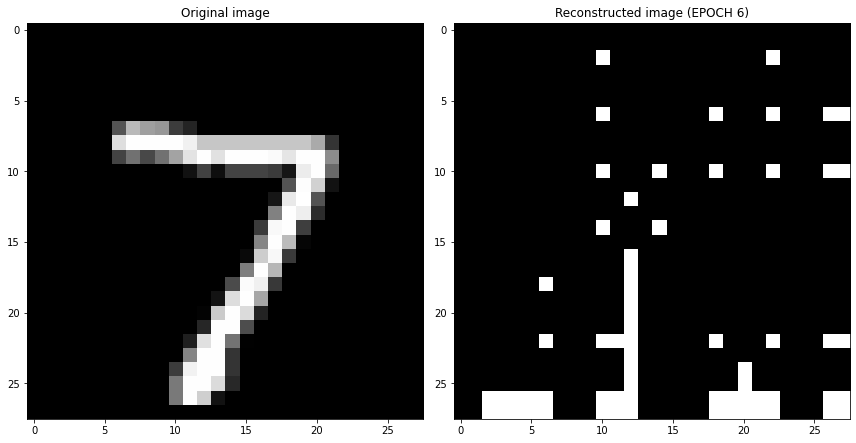

EPOCH 7/30
	 partial train loss (single batch): 0.111192
	 partial train loss (single batch): 0.112002
	 partial train loss (single batch): 0.107659
	 partial train loss (single batch): 0.108625
	 partial train loss (single batch): 0.112859
	 partial train loss (single batch): 0.105888
	 partial train loss (single batch): 0.108367
	 partial train loss (single batch): 0.108228
	 partial train loss (single batch): 0.113443
	 partial train loss (single batch): 0.112014
	 partial train loss (single batch): 0.110737
	 partial train loss (single batch): 0.113864
	 partial train loss (single batch): 0.110381
	 partial train loss (single batch): 0.111900
	 partial train loss (single batch): 0.113086
	 partial train loss (single batch): 0.110284
	 partial train loss (single batch): 0.113704
	 partial train loss (single batch): 0.115539
	 partial train loss (single batch): 0.113223
	 partial train loss (single batch): 0.115382
	 partial train loss (single batch): 0.111239
	 partial train loss (s

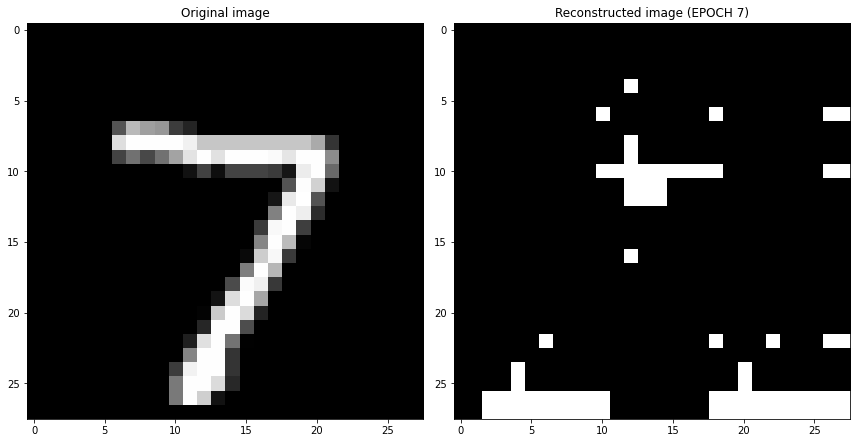

EPOCH 8/30
	 partial train loss (single batch): 0.109526
	 partial train loss (single batch): 0.113637
	 partial train loss (single batch): 0.113360
	 partial train loss (single batch): 0.111083
	 partial train loss (single batch): 0.107237
	 partial train loss (single batch): 0.113716
	 partial train loss (single batch): 0.110120
	 partial train loss (single batch): 0.109669
	 partial train loss (single batch): 0.113546
	 partial train loss (single batch): 0.112769
	 partial train loss (single batch): 0.116897
	 partial train loss (single batch): 0.111824
	 partial train loss (single batch): 0.110197
	 partial train loss (single batch): 0.112736
	 partial train loss (single batch): 0.113800
	 partial train loss (single batch): 0.115418
	 partial train loss (single batch): 0.112318
	 partial train loss (single batch): 0.110092
	 partial train loss (single batch): 0.111101
	 partial train loss (single batch): 0.115149
	 partial train loss (single batch): 0.111525
	 partial train loss (s

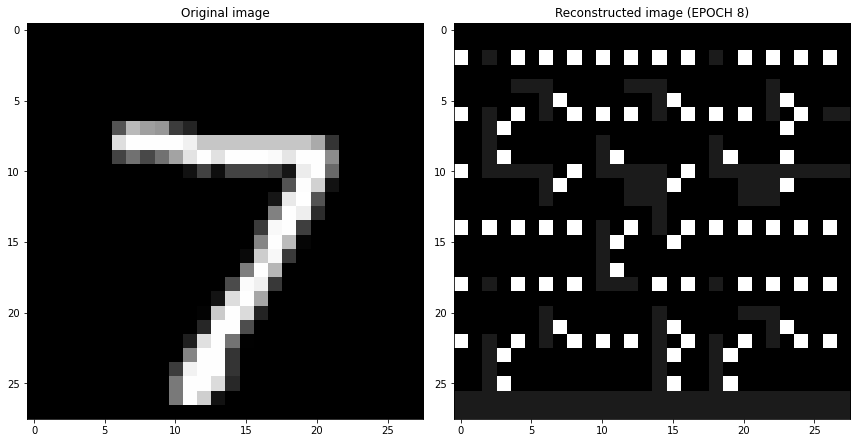

EPOCH 9/30
	 partial train loss (single batch): 0.182046
	 partial train loss (single batch): 0.181505
	 partial train loss (single batch): 0.181236
	 partial train loss (single batch): 0.185319
	 partial train loss (single batch): 0.181357
	 partial train loss (single batch): 0.180028
	 partial train loss (single batch): 0.181865
	 partial train loss (single batch): 0.183487
	 partial train loss (single batch): 0.181452
	 partial train loss (single batch): 0.182801
	 partial train loss (single batch): 0.181423
	 partial train loss (single batch): 0.182528
	 partial train loss (single batch): 0.180102
	 partial train loss (single batch): 0.182907
	 partial train loss (single batch): 0.183668
	 partial train loss (single batch): 0.184818
	 partial train loss (single batch): 0.182774
	 partial train loss (single batch): 0.185898
	 partial train loss (single batch): 0.188412
	 partial train loss (single batch): 0.183249
	 partial train loss (single batch): 0.181848
	 partial train loss (s

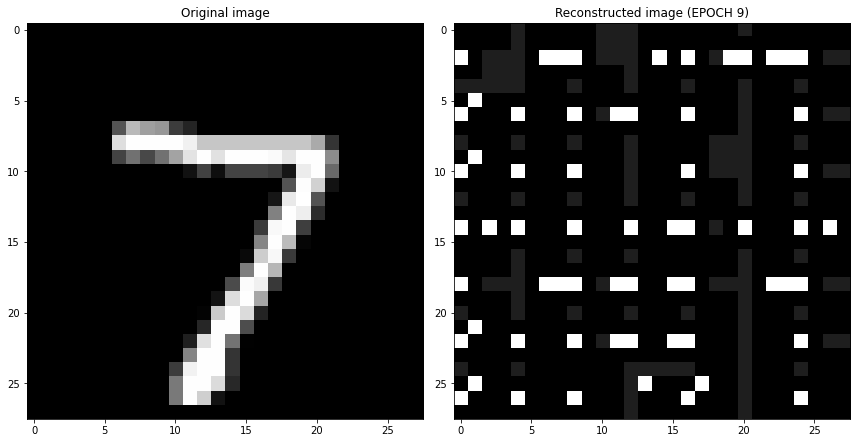

EPOCH 10/30
	 partial train loss (single batch): 0.168138
	 partial train loss (single batch): 0.169625
	 partial train loss (single batch): 0.171311
	 partial train loss (single batch): 0.170169
	 partial train loss (single batch): 0.174892
	 partial train loss (single batch): 0.173164
	 partial train loss (single batch): 0.178358
	 partial train loss (single batch): 0.175827
	 partial train loss (single batch): 0.176941
	 partial train loss (single batch): 0.174053
	 partial train loss (single batch): 0.173762
	 partial train loss (single batch): 0.178481
	 partial train loss (single batch): 0.179317
	 partial train loss (single batch): 0.173555
	 partial train loss (single batch): 0.173758
	 partial train loss (single batch): 0.174983
	 partial train loss (single batch): 0.176699
	 partial train loss (single batch): 0.178708
	 partial train loss (single batch): 0.176111
	 partial train loss (single batch): 0.171957
	 partial train loss (single batch): 0.175818
	 partial train loss (

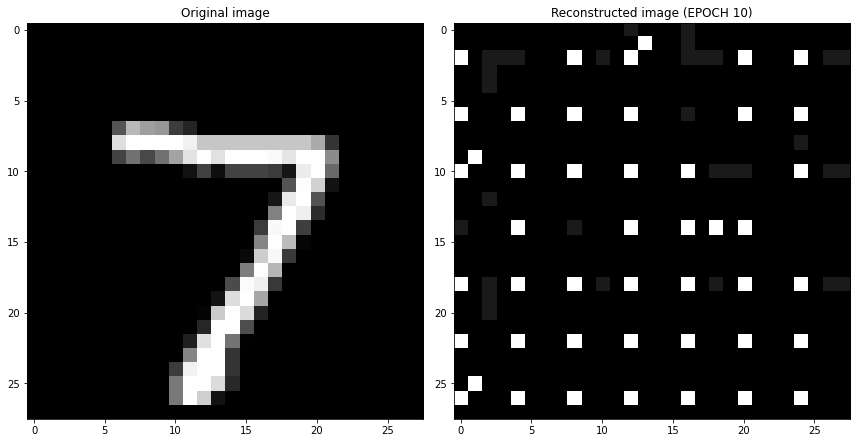

EPOCH 11/30
	 partial train loss (single batch): 0.152890
	 partial train loss (single batch): 0.155060
	 partial train loss (single batch): 0.155320
	 partial train loss (single batch): 0.156472
	 partial train loss (single batch): 0.155301
	 partial train loss (single batch): 0.155465
	 partial train loss (single batch): 0.154416
	 partial train loss (single batch): 0.157087
	 partial train loss (single batch): 0.157570
	 partial train loss (single batch): 0.155341
	 partial train loss (single batch): 0.160044
	 partial train loss (single batch): 0.157666
	 partial train loss (single batch): 0.158951
	 partial train loss (single batch): 0.155415
	 partial train loss (single batch): 0.153897
	 partial train loss (single batch): 0.154951
	 partial train loss (single batch): 0.155307
	 partial train loss (single batch): 0.159506
	 partial train loss (single batch): 0.159737
	 partial train loss (single batch): 0.164361
	 partial train loss (single batch): 0.154906
	 partial train loss (

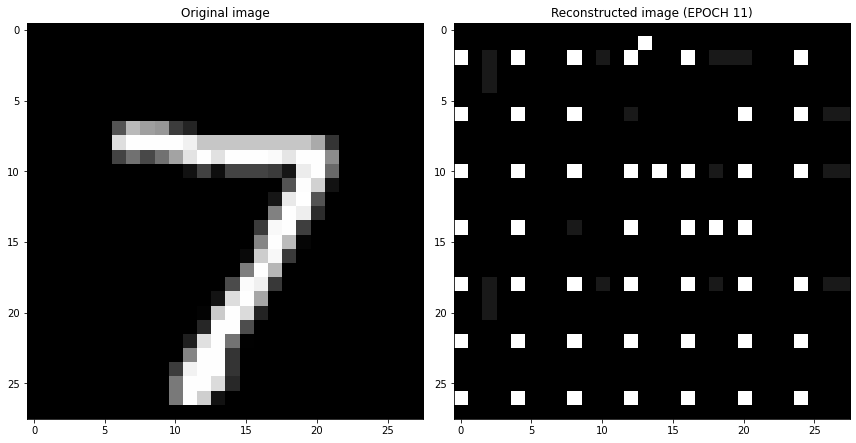

EPOCH 12/30
	 partial train loss (single batch): 0.156841
	 partial train loss (single batch): 0.156433
	 partial train loss (single batch): 0.158432
	 partial train loss (single batch): 0.152618
	 partial train loss (single batch): 0.155099
	 partial train loss (single batch): 0.155289
	 partial train loss (single batch): 0.154619
	 partial train loss (single batch): 0.158230
	 partial train loss (single batch): 0.158055
	 partial train loss (single batch): 0.159206
	 partial train loss (single batch): 0.156748
	 partial train loss (single batch): 0.159173
	 partial train loss (single batch): 0.155803
	 partial train loss (single batch): 0.156408
	 partial train loss (single batch): 0.157285
	 partial train loss (single batch): 0.155189
	 partial train loss (single batch): 0.156053
	 partial train loss (single batch): 0.156870
	 partial train loss (single batch): 0.157804
	 partial train loss (single batch): 0.153631
	 partial train loss (single batch): 0.158214
	 partial train loss (

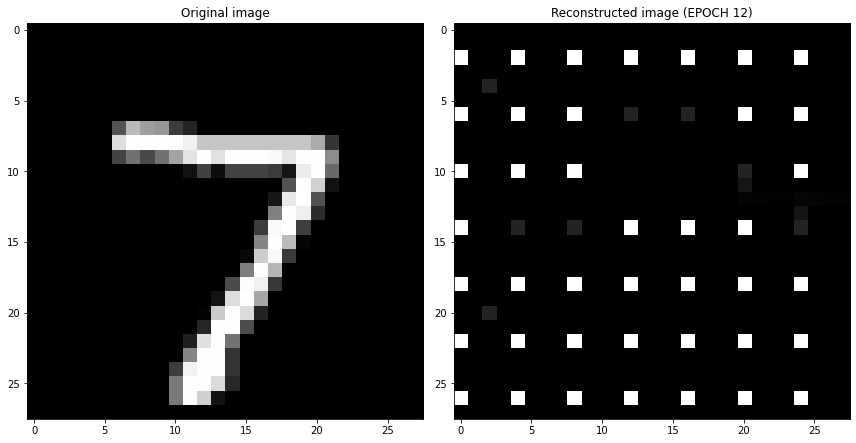

EPOCH 13/30
	 partial train loss (single batch): 0.153356
	 partial train loss (single batch): 0.151192
	 partial train loss (single batch): 0.150809
	 partial train loss (single batch): 0.154181
	 partial train loss (single batch): 0.153267
	 partial train loss (single batch): 0.154044
	 partial train loss (single batch): 0.150305
	 partial train loss (single batch): 0.149313
	 partial train loss (single batch): 0.151678
	 partial train loss (single batch): 0.151442
	 partial train loss (single batch): 0.153387
	 partial train loss (single batch): 0.150273
	 partial train loss (single batch): 0.154571
	 partial train loss (single batch): 0.149233
	 partial train loss (single batch): 0.152624
	 partial train loss (single batch): 0.147774
	 partial train loss (single batch): 0.150194
	 partial train loss (single batch): 0.150429
	 partial train loss (single batch): 0.148245
	 partial train loss (single batch): 0.149777
	 partial train loss (single batch): 0.147533
	 partial train loss (

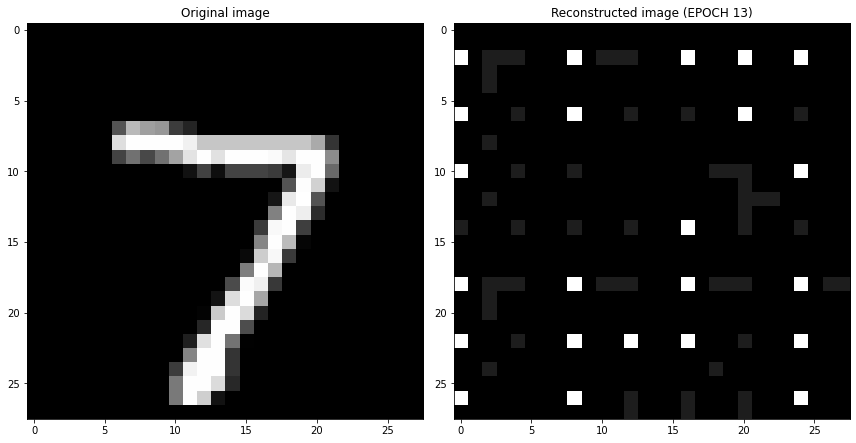

EPOCH 14/30
	 partial train loss (single batch): 0.133431
	 partial train loss (single batch): 0.131299
	 partial train loss (single batch): 0.135791
	 partial train loss (single batch): 0.135579
	 partial train loss (single batch): 0.133100
	 partial train loss (single batch): 0.131298
	 partial train loss (single batch): 0.133910
	 partial train loss (single batch): 0.136416
	 partial train loss (single batch): 0.132841
	 partial train loss (single batch): 0.131872
	 partial train loss (single batch): 0.136934
	 partial train loss (single batch): 0.132876
	 partial train loss (single batch): 0.135479
	 partial train loss (single batch): 0.134648
	 partial train loss (single batch): 0.134912
	 partial train loss (single batch): 0.130410
	 partial train loss (single batch): 0.131082
	 partial train loss (single batch): 0.139651
	 partial train loss (single batch): 0.131762
	 partial train loss (single batch): 0.131859
	 partial train loss (single batch): 0.137646
	 partial train loss (

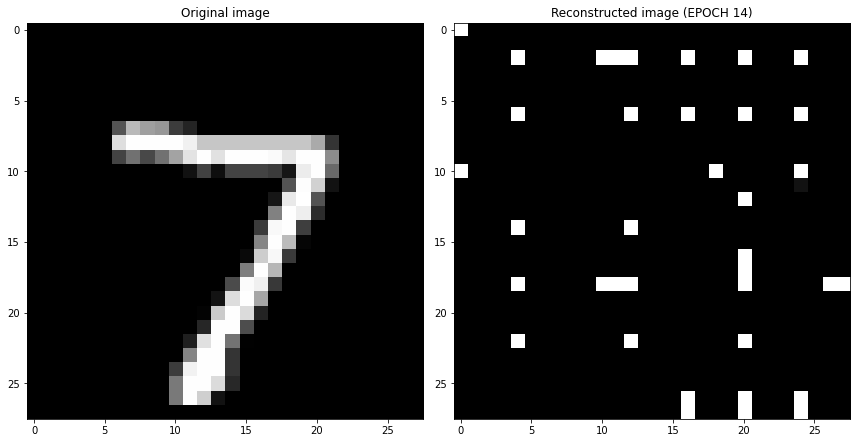

EPOCH 15/30
	 partial train loss (single batch): 0.112974
	 partial train loss (single batch): 0.107845
	 partial train loss (single batch): 0.111195
	 partial train loss (single batch): 0.108169
	 partial train loss (single batch): 0.106122
	 partial train loss (single batch): 0.111709
	 partial train loss (single batch): 0.114143
	 partial train loss (single batch): 0.111886
	 partial train loss (single batch): 0.111426
	 partial train loss (single batch): 0.110301
	 partial train loss (single batch): 0.109251
	 partial train loss (single batch): 0.113628
	 partial train loss (single batch): 0.106657
	 partial train loss (single batch): 0.111517
	 partial train loss (single batch): 0.108271
	 partial train loss (single batch): 0.107924
	 partial train loss (single batch): 0.113592
	 partial train loss (single batch): 0.106552
	 partial train loss (single batch): 0.114820
	 partial train loss (single batch): 0.108483
	 partial train loss (single batch): 0.114995
	 partial train loss (

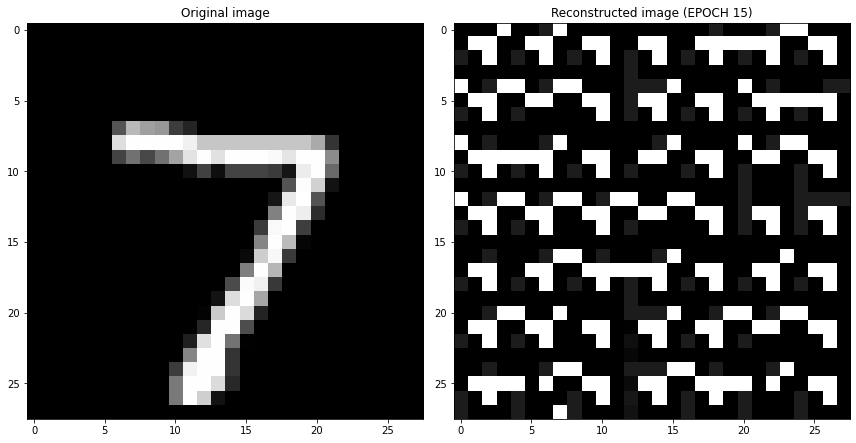

EPOCH 16/30
	 partial train loss (single batch): 0.295172
	 partial train loss (single batch): 0.294149
	 partial train loss (single batch): 0.297081
	 partial train loss (single batch): 0.296781
	 partial train loss (single batch): 0.294470
	 partial train loss (single batch): 0.295718
	 partial train loss (single batch): 0.296364
	 partial train loss (single batch): 0.297203
	 partial train loss (single batch): 0.296898
	 partial train loss (single batch): 0.301518
	 partial train loss (single batch): 0.300989
	 partial train loss (single batch): 0.299075
	 partial train loss (single batch): 0.301567
	 partial train loss (single batch): 0.300948
	 partial train loss (single batch): 0.294522
	 partial train loss (single batch): 0.297795
	 partial train loss (single batch): 0.297251
	 partial train loss (single batch): 0.298614
	 partial train loss (single batch): 0.296029
	 partial train loss (single batch): 0.294742
	 partial train loss (single batch): 0.294727
	 partial train loss (

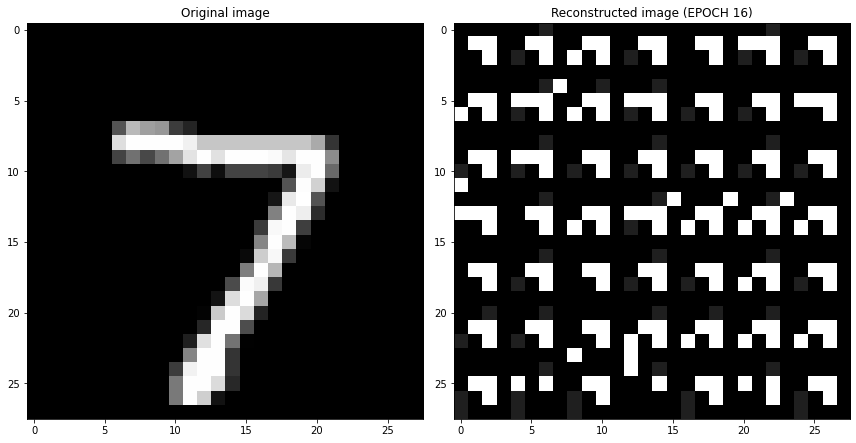

EPOCH 17/30
	 partial train loss (single batch): 0.270046
	 partial train loss (single batch): 0.268020
	 partial train loss (single batch): 0.266057
	 partial train loss (single batch): 0.271160
	 partial train loss (single batch): 0.271639
	 partial train loss (single batch): 0.268388
	 partial train loss (single batch): 0.270894
	 partial train loss (single batch): 0.272126
	 partial train loss (single batch): 0.271387
	 partial train loss (single batch): 0.274048
	 partial train loss (single batch): 0.272887
	 partial train loss (single batch): 0.273522
	 partial train loss (single batch): 0.272985
	 partial train loss (single batch): 0.275831
	 partial train loss (single batch): 0.279079
	 partial train loss (single batch): 0.277341
	 partial train loss (single batch): 0.279492
	 partial train loss (single batch): 0.280685
	 partial train loss (single batch): 0.278191
	 partial train loss (single batch): 0.279521
	 partial train loss (single batch): 0.280093
	 partial train loss (

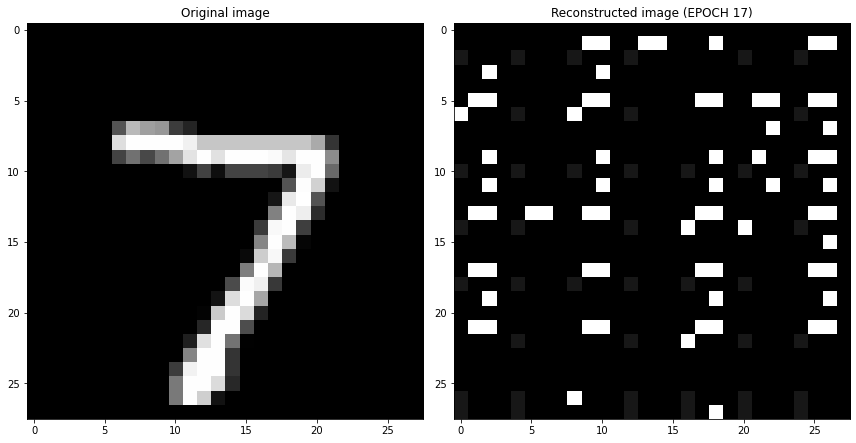

EPOCH 18/30
	 partial train loss (single batch): 0.176065
	 partial train loss (single batch): 0.174873
	 partial train loss (single batch): 0.178485
	 partial train loss (single batch): 0.175006
	 partial train loss (single batch): 0.178208
	 partial train loss (single batch): 0.177129
	 partial train loss (single batch): 0.175890
	 partial train loss (single batch): 0.177797
	 partial train loss (single batch): 0.175260
	 partial train loss (single batch): 0.178413
	 partial train loss (single batch): 0.177273
	 partial train loss (single batch): 0.175334
	 partial train loss (single batch): 0.178258
	 partial train loss (single batch): 0.177987
	 partial train loss (single batch): 0.175625
	 partial train loss (single batch): 0.175768
	 partial train loss (single batch): 0.173715
	 partial train loss (single batch): 0.176084
	 partial train loss (single batch): 0.176522
	 partial train loss (single batch): 0.174764
	 partial train loss (single batch): 0.176427
	 partial train loss (

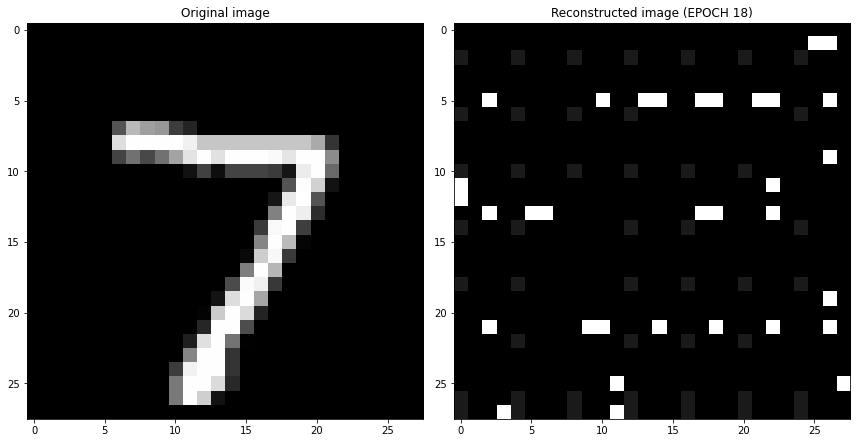

EPOCH 19/30
	 partial train loss (single batch): 0.143137
	 partial train loss (single batch): 0.144642
	 partial train loss (single batch): 0.142474
	 partial train loss (single batch): 0.143391
	 partial train loss (single batch): 0.139339
	 partial train loss (single batch): 0.144450
	 partial train loss (single batch): 0.141232
	 partial train loss (single batch): 0.142627
	 partial train loss (single batch): 0.140831
	 partial train loss (single batch): 0.140908
	 partial train loss (single batch): 0.140845
	 partial train loss (single batch): 0.140181
	 partial train loss (single batch): 0.145469
	 partial train loss (single batch): 0.141880
	 partial train loss (single batch): 0.139876
	 partial train loss (single batch): 0.143484
	 partial train loss (single batch): 0.141422
	 partial train loss (single batch): 0.143169
	 partial train loss (single batch): 0.139164
	 partial train loss (single batch): 0.140627
	 partial train loss (single batch): 0.144281
	 partial train loss (

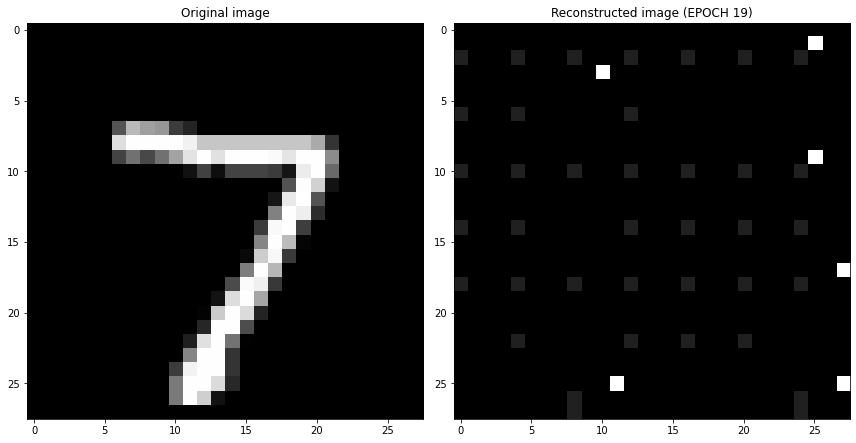

EPOCH 20/30
	 partial train loss (single batch): 0.119540
	 partial train loss (single batch): 0.121380
	 partial train loss (single batch): 0.120264
	 partial train loss (single batch): 0.120512
	 partial train loss (single batch): 0.123398
	 partial train loss (single batch): 0.116305
	 partial train loss (single batch): 0.120010
	 partial train loss (single batch): 0.118688
	 partial train loss (single batch): 0.117607
	 partial train loss (single batch): 0.115373
	 partial train loss (single batch): 0.117394
	 partial train loss (single batch): 0.119561
	 partial train loss (single batch): 0.121212
	 partial train loss (single batch): 0.121442
	 partial train loss (single batch): 0.113678
	 partial train loss (single batch): 0.119962
	 partial train loss (single batch): 0.115595
	 partial train loss (single batch): 0.117248
	 partial train loss (single batch): 0.120193
	 partial train loss (single batch): 0.116696
	 partial train loss (single batch): 0.122953
	 partial train loss (

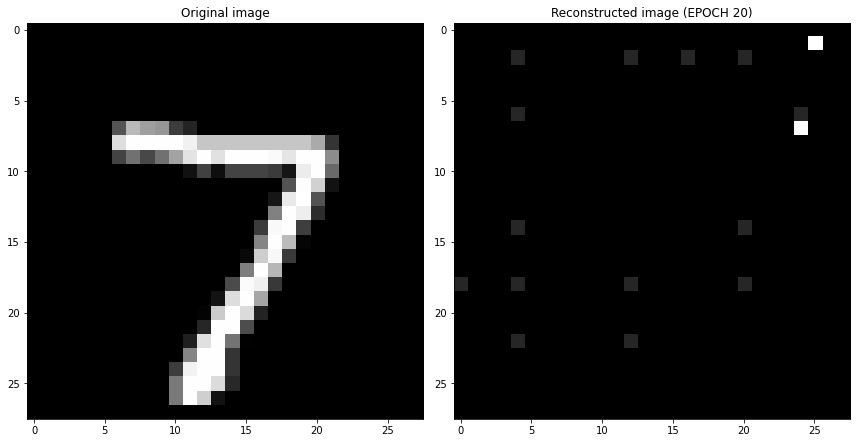

EPOCH 21/30
	 partial train loss (single batch): 0.112513
	 partial train loss (single batch): 0.109454
	 partial train loss (single batch): 0.110784
	 partial train loss (single batch): 0.112543
	 partial train loss (single batch): 0.113142
	 partial train loss (single batch): 0.110061
	 partial train loss (single batch): 0.112356
	 partial train loss (single batch): 0.108853
	 partial train loss (single batch): 0.116665
	 partial train loss (single batch): 0.107980
	 partial train loss (single batch): 0.115821
	 partial train loss (single batch): 0.113086
	 partial train loss (single batch): 0.112893
	 partial train loss (single batch): 0.114981
	 partial train loss (single batch): 0.110035
	 partial train loss (single batch): 0.106567
	 partial train loss (single batch): 0.115735
	 partial train loss (single batch): 0.112087
	 partial train loss (single batch): 0.108067
	 partial train loss (single batch): 0.112492
	 partial train loss (single batch): 0.114447
	 partial train loss (

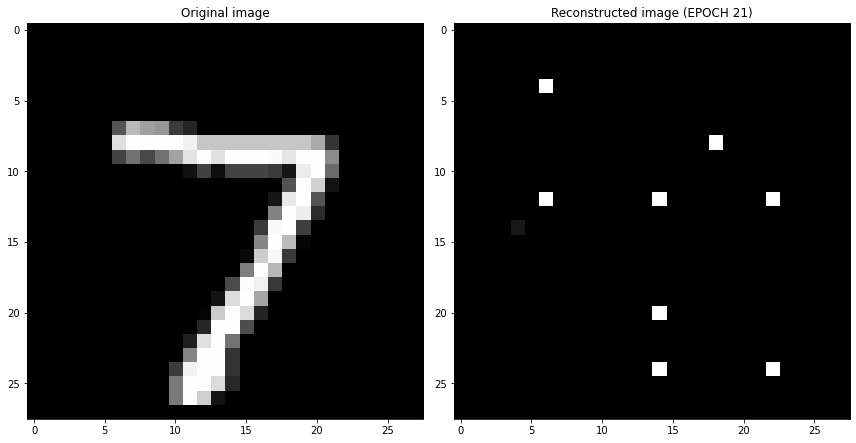

EPOCH 22/30
	 partial train loss (single batch): 0.118495
	 partial train loss (single batch): 0.114989
	 partial train loss (single batch): 0.117362
	 partial train loss (single batch): 0.119647
	 partial train loss (single batch): 0.115660
	 partial train loss (single batch): 0.117009
	 partial train loss (single batch): 0.122154
	 partial train loss (single batch): 0.118223
	 partial train loss (single batch): 0.116564
	 partial train loss (single batch): 0.117403
	 partial train loss (single batch): 0.117118
	 partial train loss (single batch): 0.115555
	 partial train loss (single batch): 0.120964
	 partial train loss (single batch): 0.116889
	 partial train loss (single batch): 0.119500
	 partial train loss (single batch): 0.120570
	 partial train loss (single batch): 0.116428
	 partial train loss (single batch): 0.113238
	 partial train loss (single batch): 0.117372
	 partial train loss (single batch): 0.115544
	 partial train loss (single batch): 0.121450
	 partial train loss (

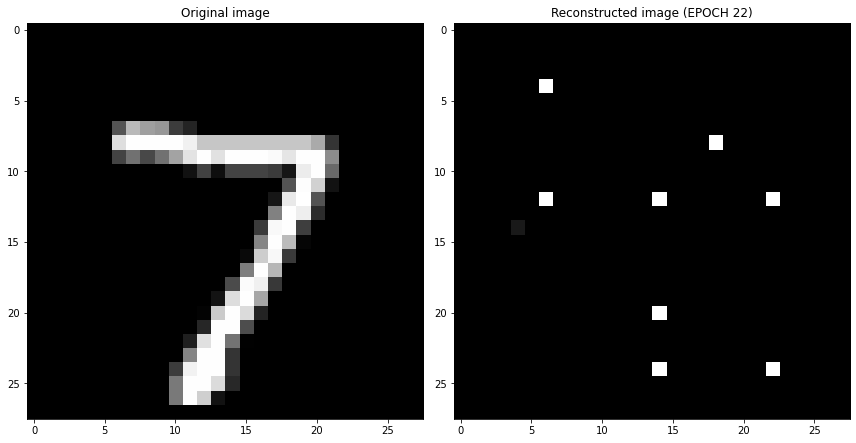

EPOCH 23/30
	 partial train loss (single batch): 0.118445
	 partial train loss (single batch): 0.117831
	 partial train loss (single batch): 0.114610
	 partial train loss (single batch): 0.121630
	 partial train loss (single batch): 0.116988
	 partial train loss (single batch): 0.121631
	 partial train loss (single batch): 0.112013
	 partial train loss (single batch): 0.114887
	 partial train loss (single batch): 0.111619
	 partial train loss (single batch): 0.112563
	 partial train loss (single batch): 0.108849
	 partial train loss (single batch): 0.117363
	 partial train loss (single batch): 0.111983
	 partial train loss (single batch): 0.109978
	 partial train loss (single batch): 0.119528
	 partial train loss (single batch): 0.111237
	 partial train loss (single batch): 0.109999
	 partial train loss (single batch): 0.107789
	 partial train loss (single batch): 0.112347
	 partial train loss (single batch): 0.111861
	 partial train loss (single batch): 0.110688
	 partial train loss (

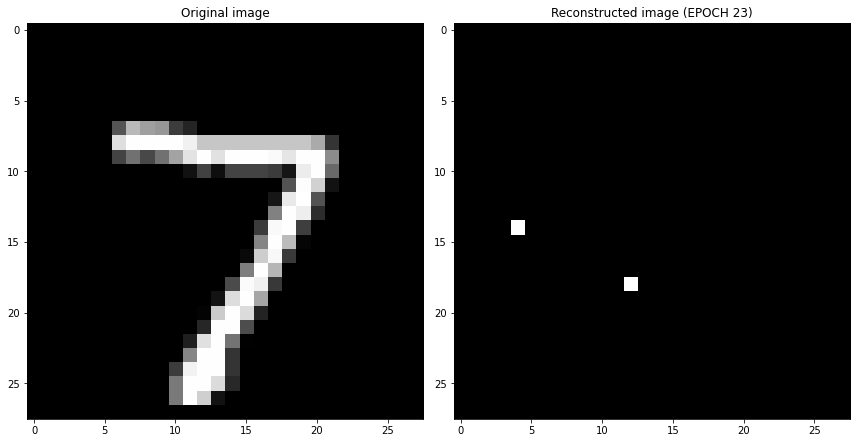

EPOCH 24/30
	 partial train loss (single batch): 0.111572
	 partial train loss (single batch): 0.107775
	 partial train loss (single batch): 0.107762
	 partial train loss (single batch): 0.108994
	 partial train loss (single batch): 0.108615
	 partial train loss (single batch): 0.114255
	 partial train loss (single batch): 0.111430
	 partial train loss (single batch): 0.108691
	 partial train loss (single batch): 0.112723
	 partial train loss (single batch): 0.114891
	 partial train loss (single batch): 0.115591
	 partial train loss (single batch): 0.112911
	 partial train loss (single batch): 0.112763
	 partial train loss (single batch): 0.112807
	 partial train loss (single batch): 0.114976
	 partial train loss (single batch): 0.115045
	 partial train loss (single batch): 0.111126
	 partial train loss (single batch): 0.110771
	 partial train loss (single batch): 0.111586
	 partial train loss (single batch): 0.119614
	 partial train loss (single batch): 0.111378
	 partial train loss (

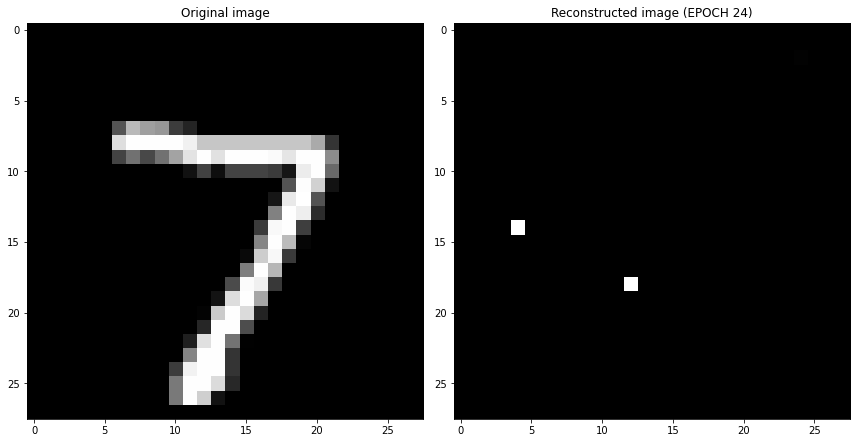

EPOCH 25/30
	 partial train loss (single batch): 0.112319
	 partial train loss (single batch): 0.113640
	 partial train loss (single batch): 0.110599
	 partial train loss (single batch): 0.114281
	 partial train loss (single batch): 0.108446
	 partial train loss (single batch): 0.112631
	 partial train loss (single batch): 0.109490
	 partial train loss (single batch): 0.111736
	 partial train loss (single batch): 0.111183
	 partial train loss (single batch): 0.111271
	 partial train loss (single batch): 0.112814
	 partial train loss (single batch): 0.114155
	 partial train loss (single batch): 0.111225
	 partial train loss (single batch): 0.111894
	 partial train loss (single batch): 0.111661
	 partial train loss (single batch): 0.111434
	 partial train loss (single batch): 0.114930
	 partial train loss (single batch): 0.113566
	 partial train loss (single batch): 0.109812
	 partial train loss (single batch): 0.109681
	 partial train loss (single batch): 0.108195
	 partial train loss (

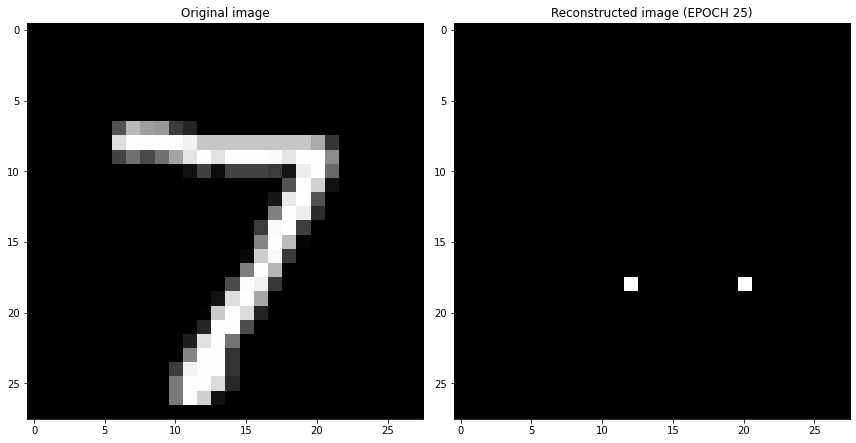

EPOCH 26/30
	 partial train loss (single batch): 0.113045
	 partial train loss (single batch): 0.108434
	 partial train loss (single batch): 0.111027
	 partial train loss (single batch): 0.110175
	 partial train loss (single batch): 0.113839
	 partial train loss (single batch): 0.113050
	 partial train loss (single batch): 0.109976
	 partial train loss (single batch): 0.112399
	 partial train loss (single batch): 0.111914
	 partial train loss (single batch): 0.112481
	 partial train loss (single batch): 0.108872
	 partial train loss (single batch): 0.112667
	 partial train loss (single batch): 0.113678
	 partial train loss (single batch): 0.112004
	 partial train loss (single batch): 0.111522
	 partial train loss (single batch): 0.112925
	 partial train loss (single batch): 0.111322
	 partial train loss (single batch): 0.114877
	 partial train loss (single batch): 0.114798
	 partial train loss (single batch): 0.110158
	 partial train loss (single batch): 0.109248
	 partial train loss (

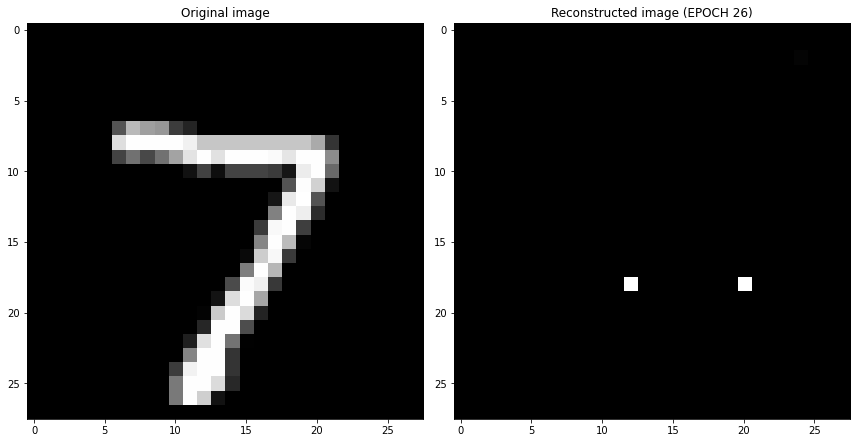

EPOCH 27/30
	 partial train loss (single batch): 0.110774
	 partial train loss (single batch): 0.111241
	 partial train loss (single batch): 0.114009
	 partial train loss (single batch): 0.114641
	 partial train loss (single batch): 0.110381
	 partial train loss (single batch): 0.114541
	 partial train loss (single batch): 0.112047
	 partial train loss (single batch): 0.115496
	 partial train loss (single batch): 0.116606
	 partial train loss (single batch): 0.115312
	 partial train loss (single batch): 0.115331
	 partial train loss (single batch): 0.112394
	 partial train loss (single batch): 0.111115
	 partial train loss (single batch): 0.114314
	 partial train loss (single batch): 0.107549
	 partial train loss (single batch): 0.112747
	 partial train loss (single batch): 0.108423
	 partial train loss (single batch): 0.110280
	 partial train loss (single batch): 0.108117
	 partial train loss (single batch): 0.109531
	 partial train loss (single batch): 0.111325
	 partial train loss (

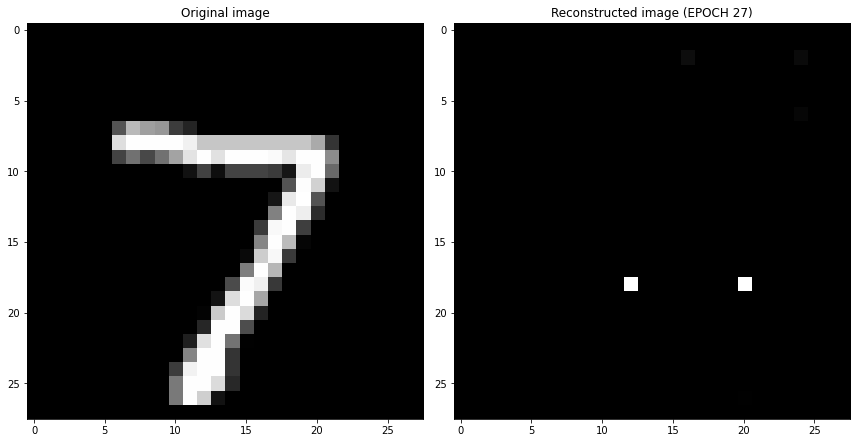

EPOCH 28/30
	 partial train loss (single batch): 0.116718
	 partial train loss (single batch): 0.114678
	 partial train loss (single batch): 0.111381
	 partial train loss (single batch): 0.117356
	 partial train loss (single batch): 0.112462
	 partial train loss (single batch): 0.113942
	 partial train loss (single batch): 0.112177
	 partial train loss (single batch): 0.111150
	 partial train loss (single batch): 0.110104
	 partial train loss (single batch): 0.108591
	 partial train loss (single batch): 0.111410
	 partial train loss (single batch): 0.114074
	 partial train loss (single batch): 0.108878
	 partial train loss (single batch): 0.107644
	 partial train loss (single batch): 0.111278
	 partial train loss (single batch): 0.109108
	 partial train loss (single batch): 0.109976
	 partial train loss (single batch): 0.111635
	 partial train loss (single batch): 0.109342
	 partial train loss (single batch): 0.115489
	 partial train loss (single batch): 0.116548
	 partial train loss (

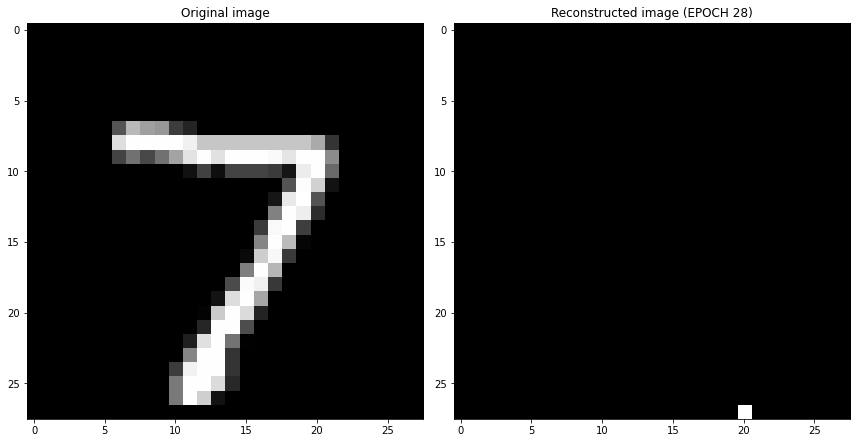

EPOCH 29/30
	 partial train loss (single batch): 0.113752
	 partial train loss (single batch): 0.112697
	 partial train loss (single batch): 0.113998
	 partial train loss (single batch): 0.114080
	 partial train loss (single batch): 0.111169
	 partial train loss (single batch): 0.109992
	 partial train loss (single batch): 0.110314
	 partial train loss (single batch): 0.113591
	 partial train loss (single batch): 0.107571
	 partial train loss (single batch): 0.114389
	 partial train loss (single batch): 0.114732
	 partial train loss (single batch): 0.115033
	 partial train loss (single batch): 0.112121
	 partial train loss (single batch): 0.112781
	 partial train loss (single batch): 0.115811
	 partial train loss (single batch): 0.109859
	 partial train loss (single batch): 0.113089
	 partial train loss (single batch): 0.117355
	 partial train loss (single batch): 0.108218
	 partial train loss (single batch): 0.112060
	 partial train loss (single batch): 0.112606
	 partial train loss (

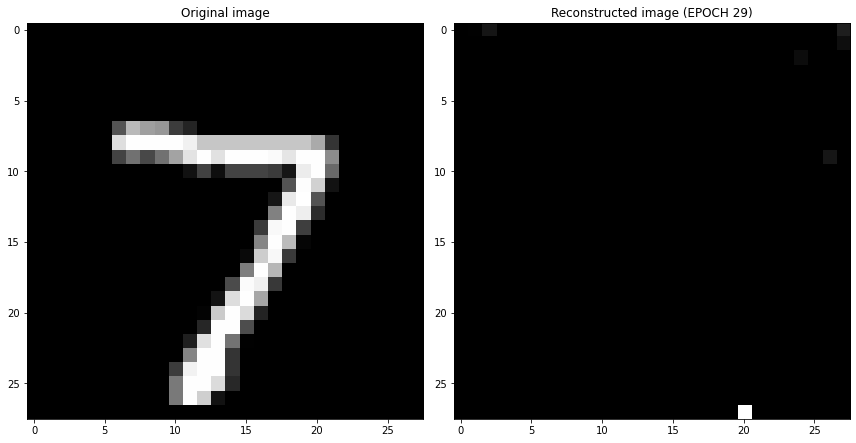

EPOCH 30/30
	 partial train loss (single batch): 0.115500
	 partial train loss (single batch): 0.112088
	 partial train loss (single batch): 0.114190
	 partial train loss (single batch): 0.110466
	 partial train loss (single batch): 0.110419
	 partial train loss (single batch): 0.114984
	 partial train loss (single batch): 0.113851
	 partial train loss (single batch): 0.113483
	 partial train loss (single batch): 0.113272
	 partial train loss (single batch): 0.114278
	 partial train loss (single batch): 0.111587
	 partial train loss (single batch): 0.111630
	 partial train loss (single batch): 0.111329
	 partial train loss (single batch): 0.113958
	 partial train loss (single batch): 0.113474
	 partial train loss (single batch): 0.110423
	 partial train loss (single batch): 0.113129
	 partial train loss (single batch): 0.113809
	 partial train loss (single batch): 0.110140
	 partial train loss (single batch): 0.112420
	 partial train loss (single batch): 0.115420
	 partial train loss (

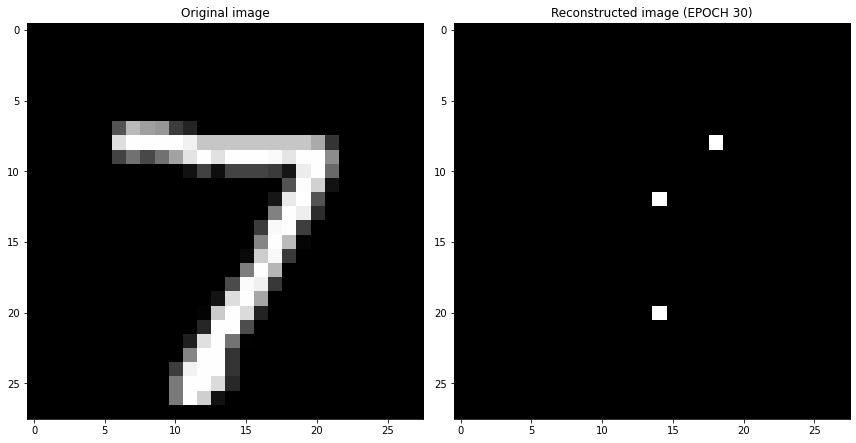

Cross validation fold number= 6/6
EPOCH 1/30
	 partial train loss (single batch): 0.207063
	 partial train loss (single batch): 0.140735
	 partial train loss (single batch): 0.113436
	 partial train loss (single batch): 0.111060
	 partial train loss (single batch): 0.111611
	 partial train loss (single batch): 0.103410
	 partial train loss (single batch): 0.086916
	 partial train loss (single batch): 0.097997
	 partial train loss (single batch): 0.088215
	 partial train loss (single batch): 0.082020
	 partial train loss (single batch): 0.085473
	 partial train loss (single batch): 0.080215
	 partial train loss (single batch): 0.089593
	 partial train loss (single batch): 0.075617
	 partial train loss (single batch): 0.077140
	 partial train loss (single batch): 0.070858
	 partial train loss (single batch): 0.070620
	 partial train loss (single batch): 0.076316
	 partial train loss (single batch): 0.074938
	 partial train loss (single batch): 0.073485
	 partial train loss (single batch)

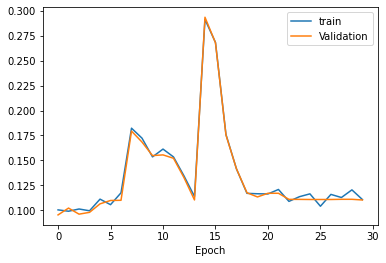

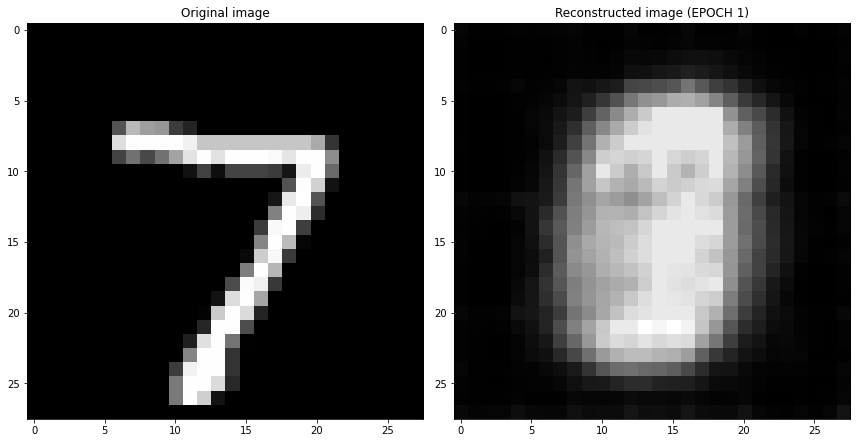

EPOCH 2/30
	 partial train loss (single batch): 0.067995
	 partial train loss (single batch): 0.069293
	 partial train loss (single batch): 0.067404
	 partial train loss (single batch): 0.068083
	 partial train loss (single batch): 0.069675
	 partial train loss (single batch): 0.067115
	 partial train loss (single batch): 0.067645
	 partial train loss (single batch): 0.067546
	 partial train loss (single batch): 0.066627
	 partial train loss (single batch): 0.068564
	 partial train loss (single batch): 0.066375
	 partial train loss (single batch): 0.070330
	 partial train loss (single batch): 0.069194
	 partial train loss (single batch): 0.066757
	 partial train loss (single batch): 0.066547
	 partial train loss (single batch): 0.070656
	 partial train loss (single batch): 0.067602
	 partial train loss (single batch): 0.068825
	 partial train loss (single batch): 0.069272
	 partial train loss (single batch): 0.069344
	 partial train loss (single batch): 0.066808
	 partial train loss (s

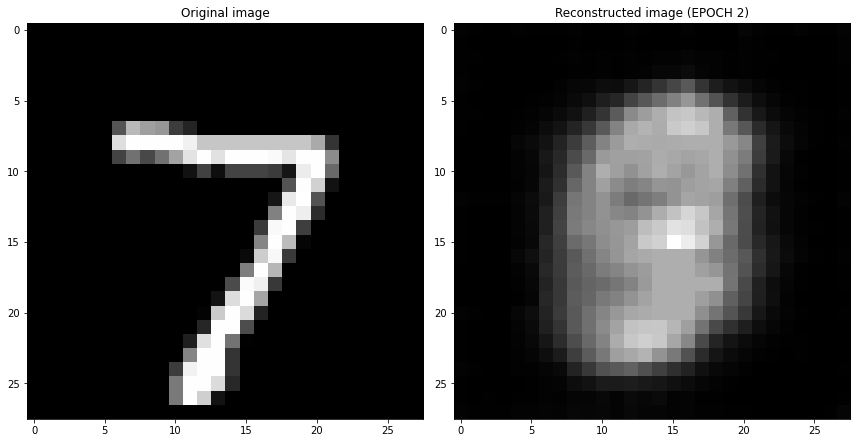

EPOCH 3/30
	 partial train loss (single batch): 0.067001
	 partial train loss (single batch): 0.067703
	 partial train loss (single batch): 0.068579
	 partial train loss (single batch): 0.068085
	 partial train loss (single batch): 0.068333
	 partial train loss (single batch): 0.067526
	 partial train loss (single batch): 0.066880
	 partial train loss (single batch): 0.068503
	 partial train loss (single batch): 0.067528
	 partial train loss (single batch): 0.067904
	 partial train loss (single batch): 0.069033
	 partial train loss (single batch): 0.068038
	 partial train loss (single batch): 0.066747
	 partial train loss (single batch): 0.067881
	 partial train loss (single batch): 0.068035
	 partial train loss (single batch): 0.069822
	 partial train loss (single batch): 0.068514
	 partial train loss (single batch): 0.068574
	 partial train loss (single batch): 0.066447
	 partial train loss (single batch): 0.068551
	 partial train loss (single batch): 0.066973
	 partial train loss (s

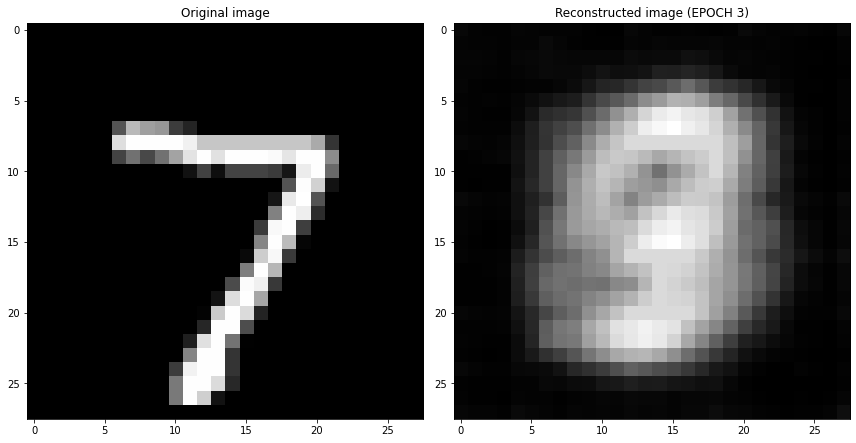

EPOCH 4/30
	 partial train loss (single batch): 0.065731
	 partial train loss (single batch): 0.066872
	 partial train loss (single batch): 0.068093
	 partial train loss (single batch): 0.067001
	 partial train loss (single batch): 0.067542
	 partial train loss (single batch): 0.066178
	 partial train loss (single batch): 0.068018
	 partial train loss (single batch): 0.071112
	 partial train loss (single batch): 0.069662
	 partial train loss (single batch): 0.068673
	 partial train loss (single batch): 0.064940
	 partial train loss (single batch): 0.069484
	 partial train loss (single batch): 0.066743
	 partial train loss (single batch): 0.066497
	 partial train loss (single batch): 0.068605
	 partial train loss (single batch): 0.068989
	 partial train loss (single batch): 0.067398
	 partial train loss (single batch): 0.067203
	 partial train loss (single batch): 0.066407
	 partial train loss (single batch): 0.066375
	 partial train loss (single batch): 0.068076
	 partial train loss (s

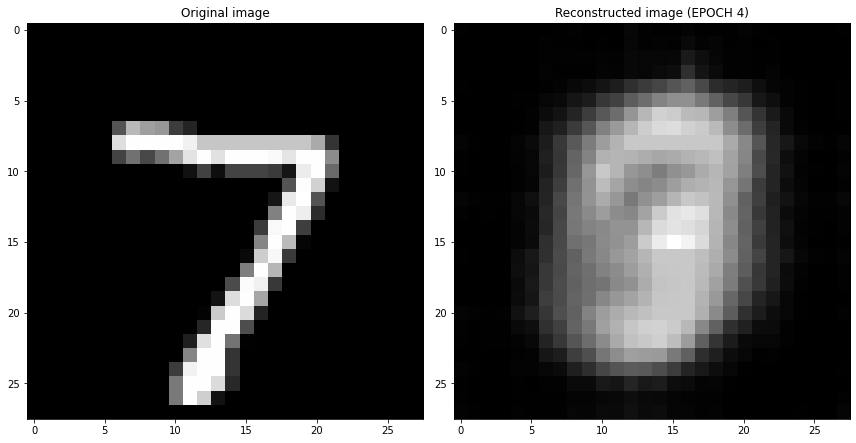

EPOCH 5/30
	 partial train loss (single batch): 0.068892
	 partial train loss (single batch): 0.067786
	 partial train loss (single batch): 0.067128
	 partial train loss (single batch): 0.068660
	 partial train loss (single batch): 0.068211
	 partial train loss (single batch): 0.065747
	 partial train loss (single batch): 0.066324
	 partial train loss (single batch): 0.067727
	 partial train loss (single batch): 0.068051
	 partial train loss (single batch): 0.067951
	 partial train loss (single batch): 0.066871
	 partial train loss (single batch): 0.067082
	 partial train loss (single batch): 0.066511
	 partial train loss (single batch): 0.066361
	 partial train loss (single batch): 0.067697
	 partial train loss (single batch): 0.069217
	 partial train loss (single batch): 0.067823
	 partial train loss (single batch): 0.068439
	 partial train loss (single batch): 0.065272
	 partial train loss (single batch): 0.069628
	 partial train loss (single batch): 0.067224
	 partial train loss (s

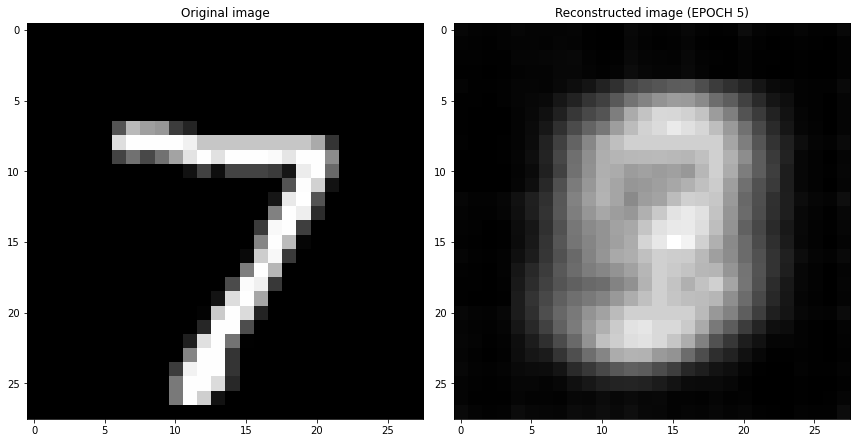

EPOCH 6/30
	 partial train loss (single batch): 0.068540
	 partial train loss (single batch): 0.068949
	 partial train loss (single batch): 0.067190
	 partial train loss (single batch): 0.068368
	 partial train loss (single batch): 0.069311
	 partial train loss (single batch): 0.068366
	 partial train loss (single batch): 0.068116
	 partial train loss (single batch): 0.068752
	 partial train loss (single batch): 0.068911
	 partial train loss (single batch): 0.067096
	 partial train loss (single batch): 0.067893
	 partial train loss (single batch): 0.068035
	 partial train loss (single batch): 0.067929
	 partial train loss (single batch): 0.066962
	 partial train loss (single batch): 0.067857
	 partial train loss (single batch): 0.068253
	 partial train loss (single batch): 0.068126
	 partial train loss (single batch): 0.067133
	 partial train loss (single batch): 0.066989
	 partial train loss (single batch): 0.068089
	 partial train loss (single batch): 0.064936
	 partial train loss (s

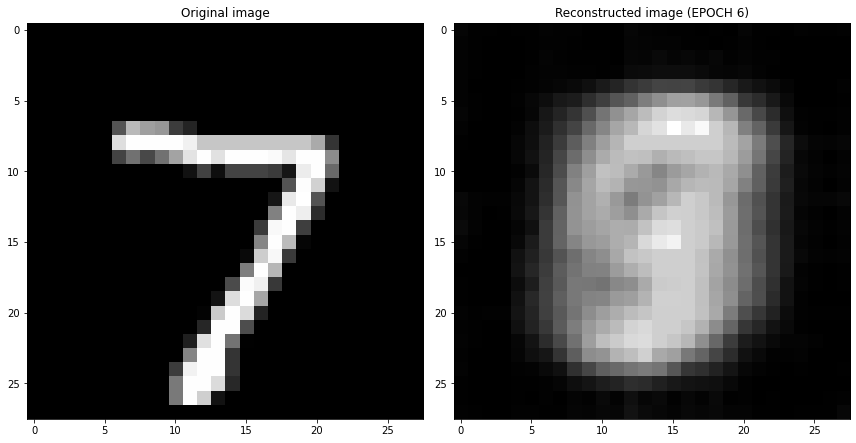

EPOCH 7/30
	 partial train loss (single batch): 0.067942
	 partial train loss (single batch): 0.066673
	 partial train loss (single batch): 0.070389
	 partial train loss (single batch): 0.068418
	 partial train loss (single batch): 0.067176
	 partial train loss (single batch): 0.068140
	 partial train loss (single batch): 0.065285
	 partial train loss (single batch): 0.066976
	 partial train loss (single batch): 0.067604
	 partial train loss (single batch): 0.066588
	 partial train loss (single batch): 0.067360
	 partial train loss (single batch): 0.068415
	 partial train loss (single batch): 0.063249
	 partial train loss (single batch): 0.066607
	 partial train loss (single batch): 0.068799
	 partial train loss (single batch): 0.066550
	 partial train loss (single batch): 0.067578
	 partial train loss (single batch): 0.068102
	 partial train loss (single batch): 0.068224
	 partial train loss (single batch): 0.068580
	 partial train loss (single batch): 0.068200
	 partial train loss (s

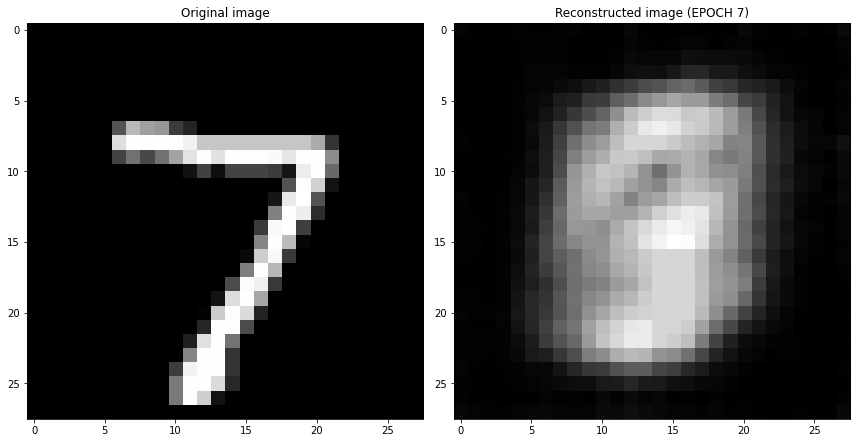

EPOCH 8/30
	 partial train loss (single batch): 0.069304
	 partial train loss (single batch): 0.069855
	 partial train loss (single batch): 0.068731
	 partial train loss (single batch): 0.066376
	 partial train loss (single batch): 0.066187
	 partial train loss (single batch): 0.066232
	 partial train loss (single batch): 0.067674
	 partial train loss (single batch): 0.066580
	 partial train loss (single batch): 0.067303
	 partial train loss (single batch): 0.068703
	 partial train loss (single batch): 0.070172
	 partial train loss (single batch): 0.068315
	 partial train loss (single batch): 0.067479
	 partial train loss (single batch): 0.067096
	 partial train loss (single batch): 0.066895
	 partial train loss (single batch): 0.067516
	 partial train loss (single batch): 0.066623
	 partial train loss (single batch): 0.068545
	 partial train loss (single batch): 0.066565
	 partial train loss (single batch): 0.066585
	 partial train loss (single batch): 0.066836
	 partial train loss (s

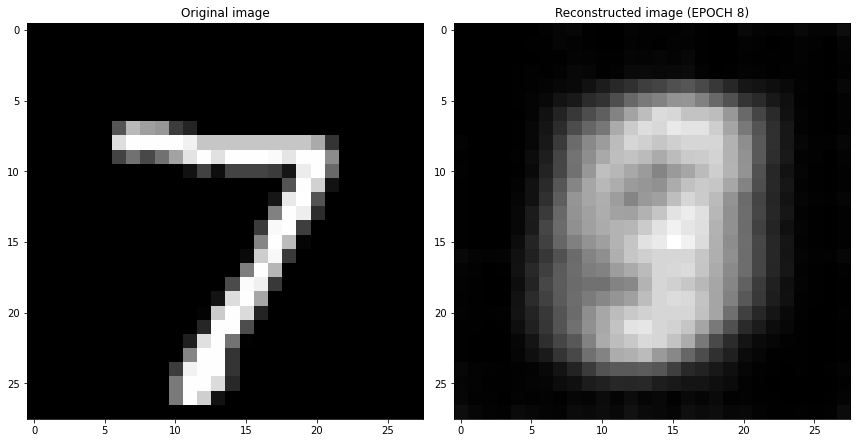

EPOCH 9/30
	 partial train loss (single batch): 0.067011
	 partial train loss (single batch): 0.068124
	 partial train loss (single batch): 0.065762
	 partial train loss (single batch): 0.067038
	 partial train loss (single batch): 0.067432
	 partial train loss (single batch): 0.067081
	 partial train loss (single batch): 0.065802
	 partial train loss (single batch): 0.067963
	 partial train loss (single batch): 0.067061
	 partial train loss (single batch): 0.068612
	 partial train loss (single batch): 0.068312
	 partial train loss (single batch): 0.065001
	 partial train loss (single batch): 0.068869
	 partial train loss (single batch): 0.067012
	 partial train loss (single batch): 0.067354
	 partial train loss (single batch): 0.067448
	 partial train loss (single batch): 0.068778
	 partial train loss (single batch): 0.065457
	 partial train loss (single batch): 0.068875
	 partial train loss (single batch): 0.069548
	 partial train loss (single batch): 0.066985
	 partial train loss (s

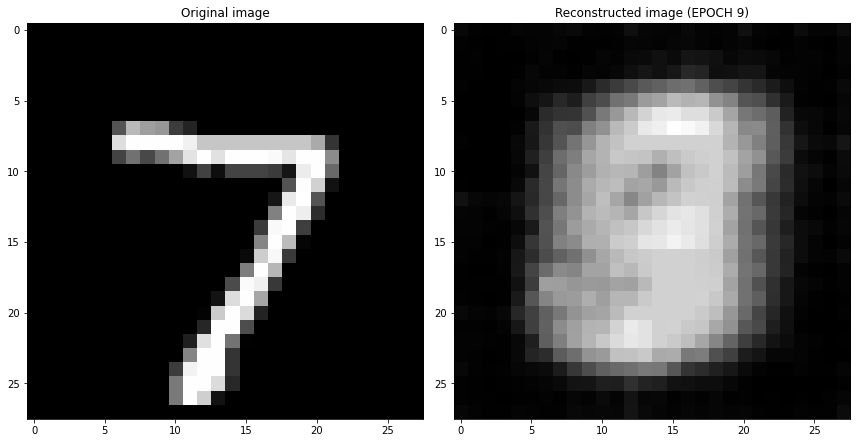

EPOCH 10/30
	 partial train loss (single batch): 0.069156
	 partial train loss (single batch): 0.069163
	 partial train loss (single batch): 0.066823
	 partial train loss (single batch): 0.067582
	 partial train loss (single batch): 0.068117
	 partial train loss (single batch): 0.069532
	 partial train loss (single batch): 0.066715
	 partial train loss (single batch): 0.067321
	 partial train loss (single batch): 0.068263
	 partial train loss (single batch): 0.069226
	 partial train loss (single batch): 0.067482
	 partial train loss (single batch): 0.067647
	 partial train loss (single batch): 0.069815
	 partial train loss (single batch): 0.067177
	 partial train loss (single batch): 0.066930
	 partial train loss (single batch): 0.067403
	 partial train loss (single batch): 0.068738
	 partial train loss (single batch): 0.067563
	 partial train loss (single batch): 0.068047
	 partial train loss (single batch): 0.068559
	 partial train loss (single batch): 0.065791
	 partial train loss (

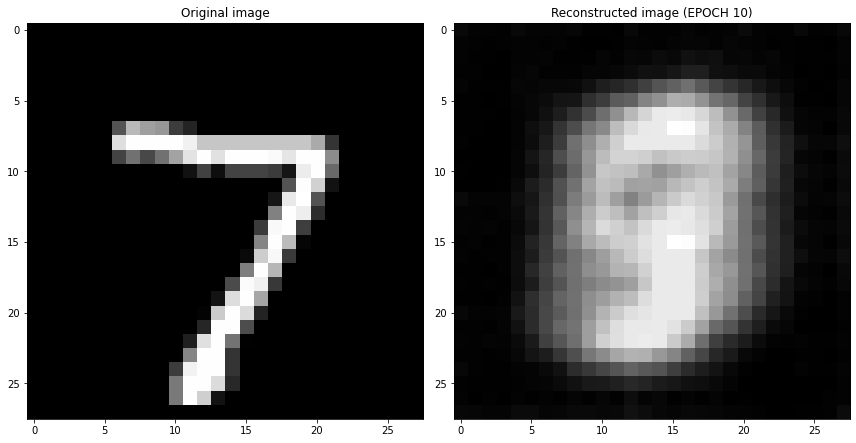

EPOCH 11/30
	 partial train loss (single batch): 0.066661
	 partial train loss (single batch): 0.067206
	 partial train loss (single batch): 0.068562
	 partial train loss (single batch): 0.069917
	 partial train loss (single batch): 0.068550
	 partial train loss (single batch): 0.067041
	 partial train loss (single batch): 0.065832
	 partial train loss (single batch): 0.068159
	 partial train loss (single batch): 0.066733
	 partial train loss (single batch): 0.068238
	 partial train loss (single batch): 0.067455
	 partial train loss (single batch): 0.066775
	 partial train loss (single batch): 0.066119
	 partial train loss (single batch): 0.067759
	 partial train loss (single batch): 0.067818
	 partial train loss (single batch): 0.067907
	 partial train loss (single batch): 0.065773
	 partial train loss (single batch): 0.068479
	 partial train loss (single batch): 0.067291
	 partial train loss (single batch): 0.067126
	 partial train loss (single batch): 0.067200
	 partial train loss (

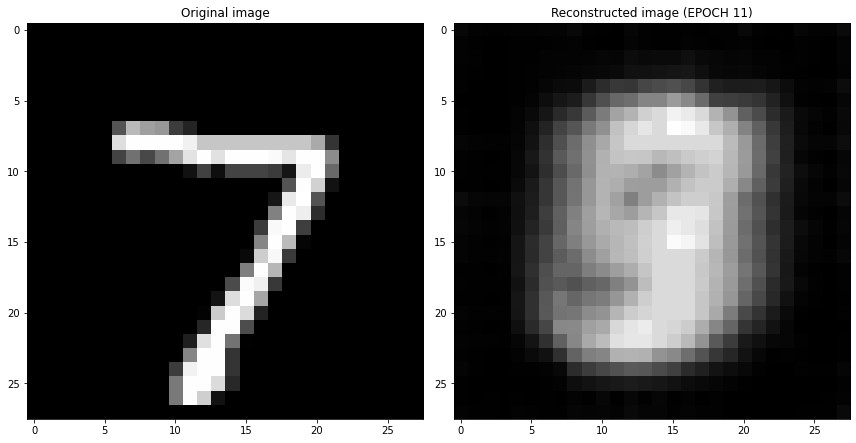

EPOCH 12/30
	 partial train loss (single batch): 0.067649
	 partial train loss (single batch): 0.065850
	 partial train loss (single batch): 0.067748
	 partial train loss (single batch): 0.067745
	 partial train loss (single batch): 0.066934
	 partial train loss (single batch): 0.067538
	 partial train loss (single batch): 0.065447
	 partial train loss (single batch): 0.068829
	 partial train loss (single batch): 0.068583
	 partial train loss (single batch): 0.067305
	 partial train loss (single batch): 0.068456
	 partial train loss (single batch): 0.068088
	 partial train loss (single batch): 0.065749
	 partial train loss (single batch): 0.068050
	 partial train loss (single batch): 0.068326
	 partial train loss (single batch): 0.068436
	 partial train loss (single batch): 0.066815
	 partial train loss (single batch): 0.065626
	 partial train loss (single batch): 0.068279
	 partial train loss (single batch): 0.066810
	 partial train loss (single batch): 0.070515
	 partial train loss (

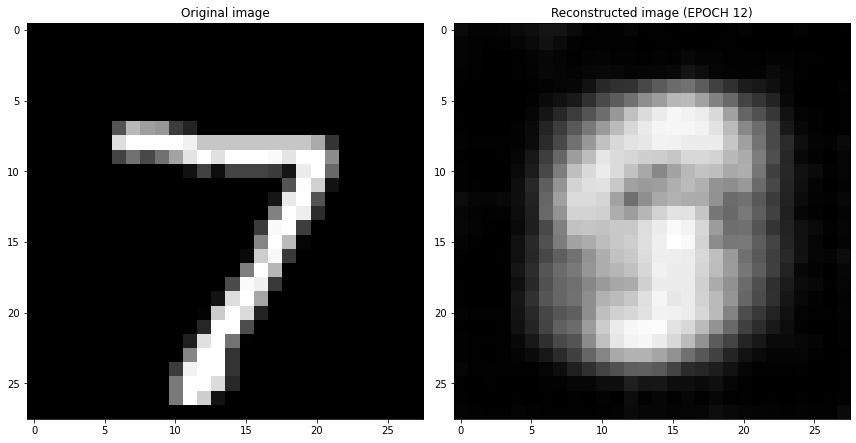

EPOCH 13/30
	 partial train loss (single batch): 0.068189
	 partial train loss (single batch): 0.067675
	 partial train loss (single batch): 0.067050
	 partial train loss (single batch): 0.066115
	 partial train loss (single batch): 0.068031
	 partial train loss (single batch): 0.067420
	 partial train loss (single batch): 0.067198
	 partial train loss (single batch): 0.065740
	 partial train loss (single batch): 0.067394
	 partial train loss (single batch): 0.067104
	 partial train loss (single batch): 0.065084
	 partial train loss (single batch): 0.069239
	 partial train loss (single batch): 0.067444
	 partial train loss (single batch): 0.068372
	 partial train loss (single batch): 0.069237
	 partial train loss (single batch): 0.066121
	 partial train loss (single batch): 0.069414
	 partial train loss (single batch): 0.068602
	 partial train loss (single batch): 0.068149
	 partial train loss (single batch): 0.068068
	 partial train loss (single batch): 0.069319
	 partial train loss (

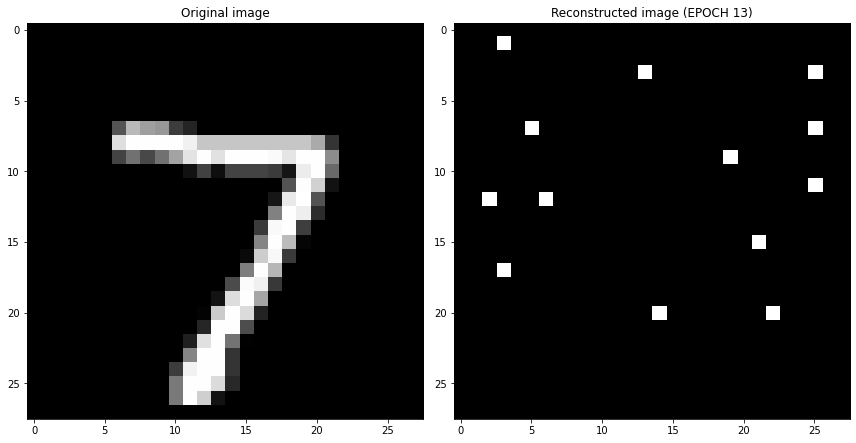

EPOCH 14/30
	 partial train loss (single batch): 0.127965
	 partial train loss (single batch): 0.127627
	 partial train loss (single batch): 0.129364
	 partial train loss (single batch): 0.125198
	 partial train loss (single batch): 0.129156
	 partial train loss (single batch): 0.127441
	 partial train loss (single batch): 0.126782
	 partial train loss (single batch): 0.126797
	 partial train loss (single batch): 0.126817
	 partial train loss (single batch): 0.127440
	 partial train loss (single batch): 0.124945
	 partial train loss (single batch): 0.123797
	 partial train loss (single batch): 0.122186
	 partial train loss (single batch): 0.129817
	 partial train loss (single batch): 0.126423
	 partial train loss (single batch): 0.125102
	 partial train loss (single batch): 0.124960
	 partial train loss (single batch): 0.122725
	 partial train loss (single batch): 0.126741
	 partial train loss (single batch): 0.128865
	 partial train loss (single batch): 0.128775
	 partial train loss (

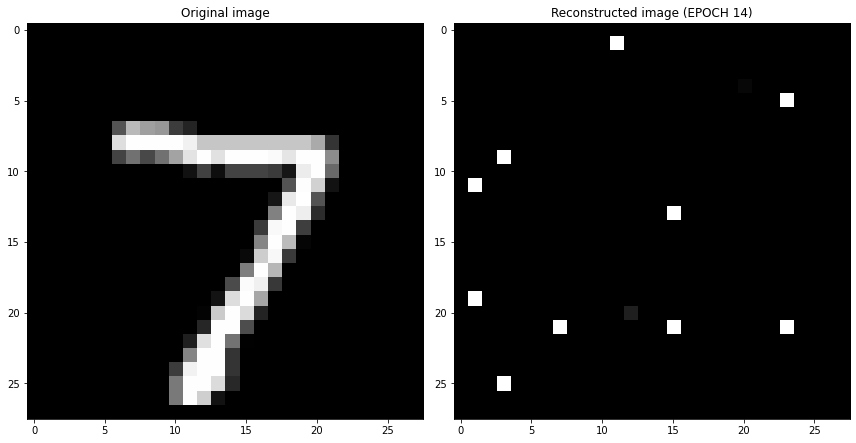

EPOCH 15/30
	 partial train loss (single batch): 0.122002
	 partial train loss (single batch): 0.127618
	 partial train loss (single batch): 0.122935
	 partial train loss (single batch): 0.123804
	 partial train loss (single batch): 0.125867
	 partial train loss (single batch): 0.123863
	 partial train loss (single batch): 0.122206
	 partial train loss (single batch): 0.124621
	 partial train loss (single batch): 0.129527
	 partial train loss (single batch): 0.122671
	 partial train loss (single batch): 0.125927
	 partial train loss (single batch): 0.127457
	 partial train loss (single batch): 0.120975
	 partial train loss (single batch): 0.125020
	 partial train loss (single batch): 0.122377
	 partial train loss (single batch): 0.125423
	 partial train loss (single batch): 0.117973
	 partial train loss (single batch): 0.122501
	 partial train loss (single batch): 0.120908
	 partial train loss (single batch): 0.119485
	 partial train loss (single batch): 0.123245
	 partial train loss (

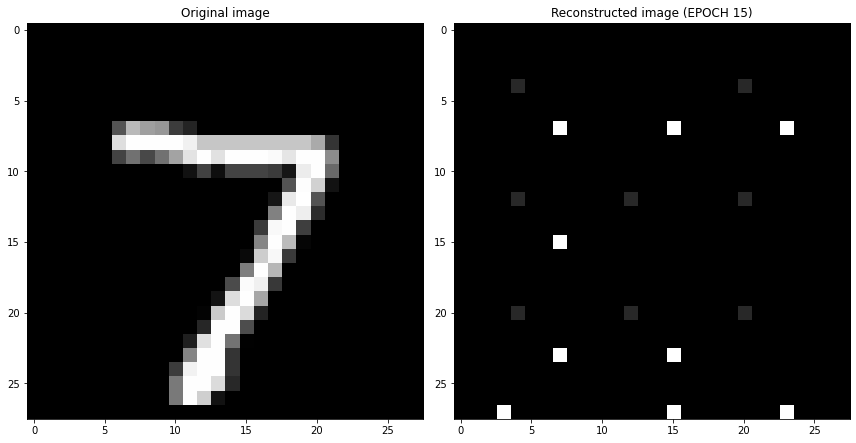

EPOCH 16/30
	 partial train loss (single batch): 0.119521
	 partial train loss (single batch): 0.113070
	 partial train loss (single batch): 0.110947
	 partial train loss (single batch): 0.114696
	 partial train loss (single batch): 0.116841
	 partial train loss (single batch): 0.111870
	 partial train loss (single batch): 0.110581
	 partial train loss (single batch): 0.112711
	 partial train loss (single batch): 0.112567
	 partial train loss (single batch): 0.109423
	 partial train loss (single batch): 0.110572
	 partial train loss (single batch): 0.110337
	 partial train loss (single batch): 0.111457
	 partial train loss (single batch): 0.110943
	 partial train loss (single batch): 0.116506
	 partial train loss (single batch): 0.114360
	 partial train loss (single batch): 0.112970
	 partial train loss (single batch): 0.114637
	 partial train loss (single batch): 0.111544
	 partial train loss (single batch): 0.109490
	 partial train loss (single batch): 0.110237
	 partial train loss (

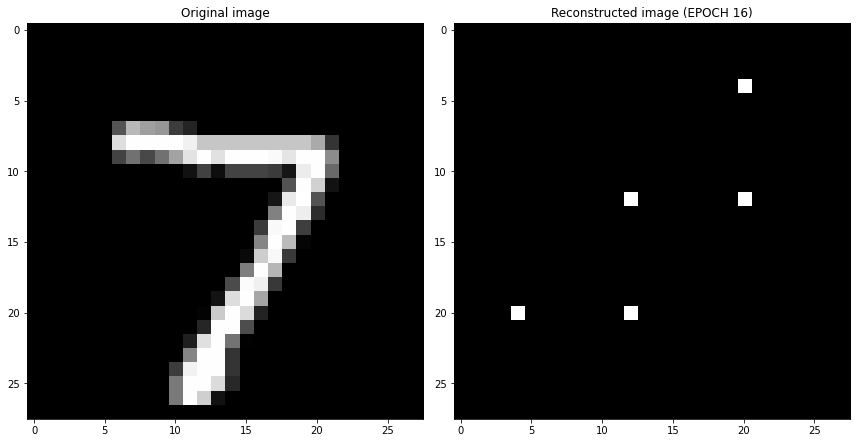

EPOCH 17/30
	 partial train loss (single batch): 0.114650
	 partial train loss (single batch): 0.107416
	 partial train loss (single batch): 0.115174
	 partial train loss (single batch): 0.111643
	 partial train loss (single batch): 0.111681
	 partial train loss (single batch): 0.110528
	 partial train loss (single batch): 0.106836
	 partial train loss (single batch): 0.113606
	 partial train loss (single batch): 0.112606
	 partial train loss (single batch): 0.109610
	 partial train loss (single batch): 0.112097
	 partial train loss (single batch): 0.111420
	 partial train loss (single batch): 0.118477
	 partial train loss (single batch): 0.111949
	 partial train loss (single batch): 0.113302
	 partial train loss (single batch): 0.112060
	 partial train loss (single batch): 0.110042
	 partial train loss (single batch): 0.110231
	 partial train loss (single batch): 0.109874
	 partial train loss (single batch): 0.112646
	 partial train loss (single batch): 0.109672
	 partial train loss (

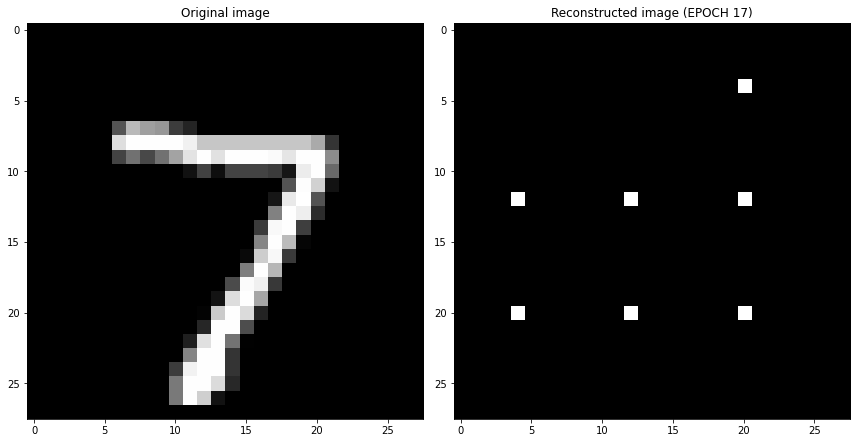

EPOCH 18/30
	 partial train loss (single batch): 0.111956
	 partial train loss (single batch): 0.114604
	 partial train loss (single batch): 0.112135
	 partial train loss (single batch): 0.112000
	 partial train loss (single batch): 0.116372
	 partial train loss (single batch): 0.109942
	 partial train loss (single batch): 0.110100
	 partial train loss (single batch): 0.111659
	 partial train loss (single batch): 0.109372
	 partial train loss (single batch): 0.111858
	 partial train loss (single batch): 0.109745
	 partial train loss (single batch): 0.111858
	 partial train loss (single batch): 0.109174
	 partial train loss (single batch): 0.113567
	 partial train loss (single batch): 0.115080
	 partial train loss (single batch): 0.116522
	 partial train loss (single batch): 0.112164
	 partial train loss (single batch): 0.107835
	 partial train loss (single batch): 0.110570
	 partial train loss (single batch): 0.112308
	 partial train loss (single batch): 0.114587
	 partial train loss (

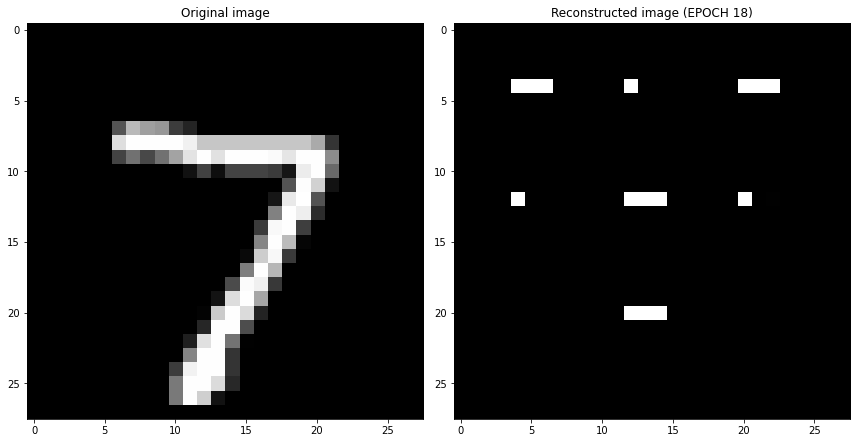

EPOCH 19/30
	 partial train loss (single batch): 0.114560
	 partial train loss (single batch): 0.113655
	 partial train loss (single batch): 0.109756
	 partial train loss (single batch): 0.111486
	 partial train loss (single batch): 0.112339
	 partial train loss (single batch): 0.114973
	 partial train loss (single batch): 0.108382
	 partial train loss (single batch): 0.114460
	 partial train loss (single batch): 0.107930
	 partial train loss (single batch): 0.109382
	 partial train loss (single batch): 0.112136
	 partial train loss (single batch): 0.110980
	 partial train loss (single batch): 0.110628
	 partial train loss (single batch): 0.107670
	 partial train loss (single batch): 0.110409
	 partial train loss (single batch): 0.112438
	 partial train loss (single batch): 0.117276
	 partial train loss (single batch): 0.109677
	 partial train loss (single batch): 0.110364
	 partial train loss (single batch): 0.108101
	 partial train loss (single batch): 0.112499
	 partial train loss (

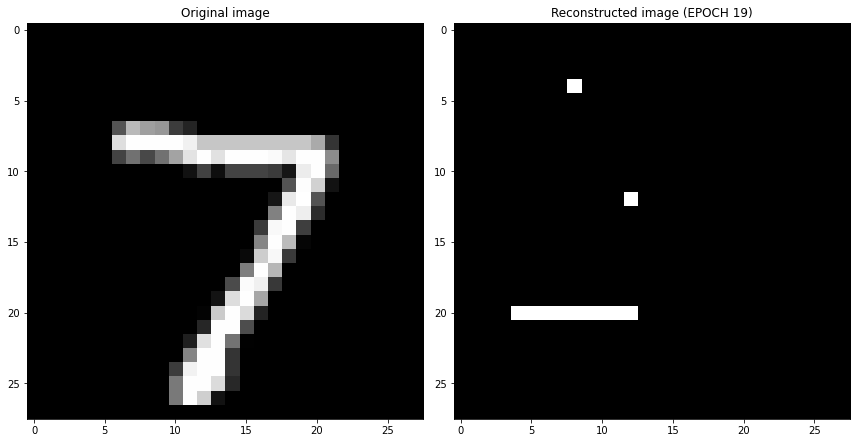

EPOCH 20/30
	 partial train loss (single batch): 0.114953
	 partial train loss (single batch): 0.110190
	 partial train loss (single batch): 0.112500
	 partial train loss (single batch): 0.109178
	 partial train loss (single batch): 0.113106
	 partial train loss (single batch): 0.116206
	 partial train loss (single batch): 0.112774
	 partial train loss (single batch): 0.109525
	 partial train loss (single batch): 0.111773
	 partial train loss (single batch): 0.116597
	 partial train loss (single batch): 0.110903
	 partial train loss (single batch): 0.114943
	 partial train loss (single batch): 0.110080
	 partial train loss (single batch): 0.115973
	 partial train loss (single batch): 0.111993
	 partial train loss (single batch): 0.111430
	 partial train loss (single batch): 0.108380
	 partial train loss (single batch): 0.111318
	 partial train loss (single batch): 0.112010
	 partial train loss (single batch): 0.113634
	 partial train loss (single batch): 0.111068
	 partial train loss (

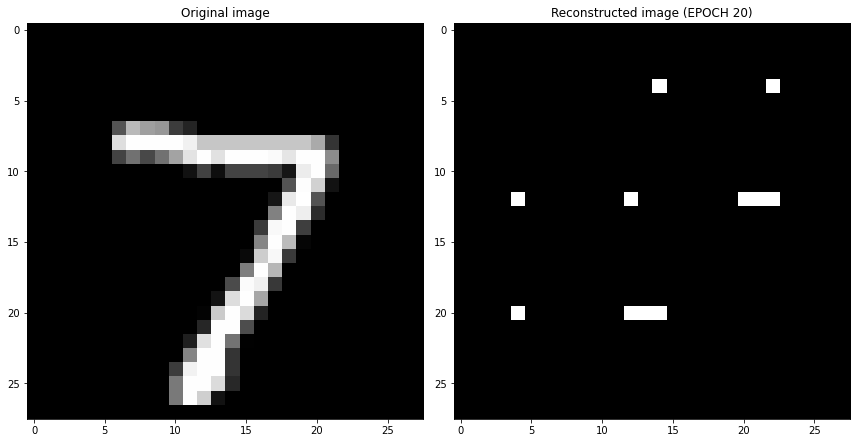

EPOCH 21/30
	 partial train loss (single batch): 0.110007
	 partial train loss (single batch): 0.111881
	 partial train loss (single batch): 0.110278
	 partial train loss (single batch): 0.113372
	 partial train loss (single batch): 0.113469
	 partial train loss (single batch): 0.112345
	 partial train loss (single batch): 0.112298
	 partial train loss (single batch): 0.110574
	 partial train loss (single batch): 0.112032
	 partial train loss (single batch): 0.112886
	 partial train loss (single batch): 0.112369
	 partial train loss (single batch): 0.105170
	 partial train loss (single batch): 0.113991
	 partial train loss (single batch): 0.114139
	 partial train loss (single batch): 0.112668
	 partial train loss (single batch): 0.111047
	 partial train loss (single batch): 0.113959
	 partial train loss (single batch): 0.108791
	 partial train loss (single batch): 0.110523
	 partial train loss (single batch): 0.112573
	 partial train loss (single batch): 0.111316
	 partial train loss (

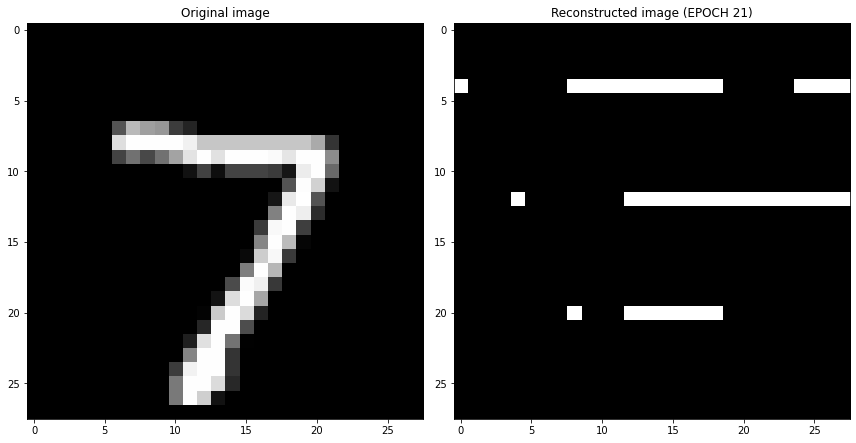

EPOCH 22/30
	 partial train loss (single batch): 0.108825
	 partial train loss (single batch): 0.113193
	 partial train loss (single batch): 0.111093
	 partial train loss (single batch): 0.115214
	 partial train loss (single batch): 0.106309
	 partial train loss (single batch): 0.107558
	 partial train loss (single batch): 0.109669
	 partial train loss (single batch): 0.106466
	 partial train loss (single batch): 0.108923
	 partial train loss (single batch): 0.106241
	 partial train loss (single batch): 0.112051
	 partial train loss (single batch): 0.108520
	 partial train loss (single batch): 0.106068
	 partial train loss (single batch): 0.111029
	 partial train loss (single batch): 0.109016
	 partial train loss (single batch): 0.109016
	 partial train loss (single batch): 0.113510
	 partial train loss (single batch): 0.112849
	 partial train loss (single batch): 0.114490
	 partial train loss (single batch): 0.108719
	 partial train loss (single batch): 0.109168
	 partial train loss (

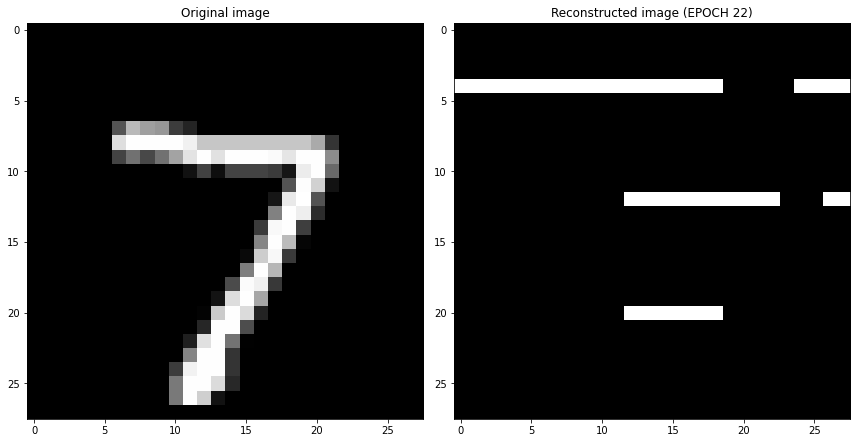

EPOCH 23/30
	 partial train loss (single batch): 0.110003
	 partial train loss (single batch): 0.108492
	 partial train loss (single batch): 0.108381
	 partial train loss (single batch): 0.108761
	 partial train loss (single batch): 0.111522
	 partial train loss (single batch): 0.111513
	 partial train loss (single batch): 0.113421
	 partial train loss (single batch): 0.111876
	 partial train loss (single batch): 0.109276
	 partial train loss (single batch): 0.112078
	 partial train loss (single batch): 0.109589
	 partial train loss (single batch): 0.104877
	 partial train loss (single batch): 0.107065
	 partial train loss (single batch): 0.113486
	 partial train loss (single batch): 0.107055
	 partial train loss (single batch): 0.110511
	 partial train loss (single batch): 0.110331
	 partial train loss (single batch): 0.112829
	 partial train loss (single batch): 0.104516
	 partial train loss (single batch): 0.112782
	 partial train loss (single batch): 0.108502
	 partial train loss (

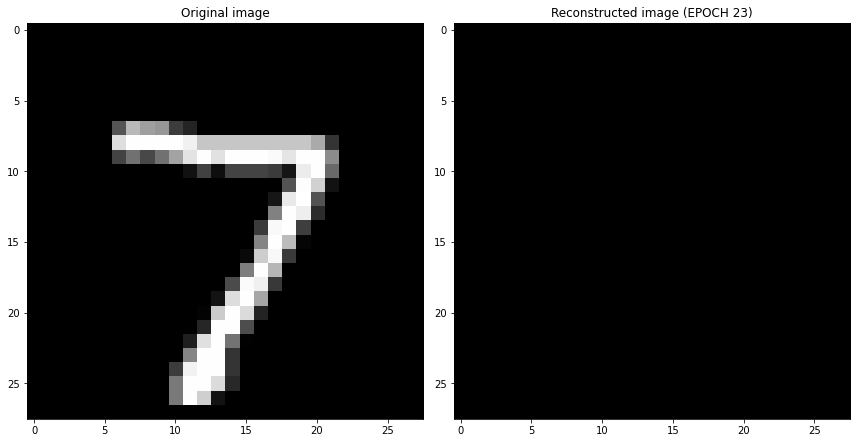

EPOCH 24/30
	 partial train loss (single batch): 0.114878
	 partial train loss (single batch): 0.108960
	 partial train loss (single batch): 0.112770
	 partial train loss (single batch): 0.112542
	 partial train loss (single batch): 0.112047
	 partial train loss (single batch): 0.111228
	 partial train loss (single batch): 0.116335
	 partial train loss (single batch): 0.113891
	 partial train loss (single batch): 0.110776
	 partial train loss (single batch): 0.113730
	 partial train loss (single batch): 0.112303
	 partial train loss (single batch): 0.114168
	 partial train loss (single batch): 0.114832
	 partial train loss (single batch): 0.112538
	 partial train loss (single batch): 0.113099
	 partial train loss (single batch): 0.115562
	 partial train loss (single batch): 0.109741
	 partial train loss (single batch): 0.109649
	 partial train loss (single batch): 0.115742
	 partial train loss (single batch): 0.109686
	 partial train loss (single batch): 0.114483
	 partial train loss (

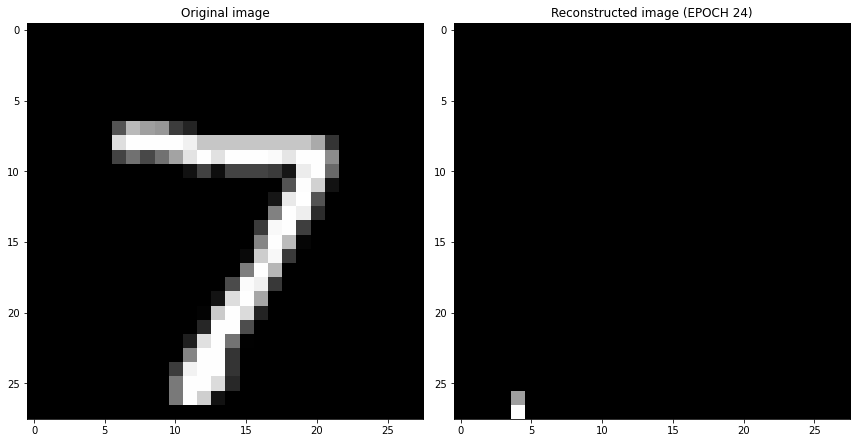

EPOCH 25/30
	 partial train loss (single batch): 0.109466
	 partial train loss (single batch): 0.111358
	 partial train loss (single batch): 0.114419
	 partial train loss (single batch): 0.114478
	 partial train loss (single batch): 0.112128
	 partial train loss (single batch): 0.115527
	 partial train loss (single batch): 0.115980
	 partial train loss (single batch): 0.112320
	 partial train loss (single batch): 0.116904
	 partial train loss (single batch): 0.109783
	 partial train loss (single batch): 0.113678
	 partial train loss (single batch): 0.110534
	 partial train loss (single batch): 0.111972
	 partial train loss (single batch): 0.114739
	 partial train loss (single batch): 0.108730
	 partial train loss (single batch): 0.112909
	 partial train loss (single batch): 0.115950
	 partial train loss (single batch): 0.116423
	 partial train loss (single batch): 0.110586
	 partial train loss (single batch): 0.108491
	 partial train loss (single batch): 0.110889
	 partial train loss (

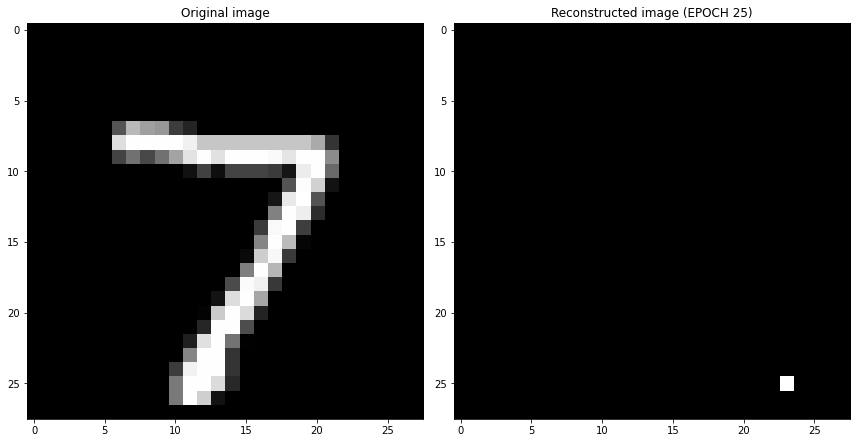

EPOCH 26/30
	 partial train loss (single batch): 0.116383
	 partial train loss (single batch): 0.116511
	 partial train loss (single batch): 0.109249
	 partial train loss (single batch): 0.116419
	 partial train loss (single batch): 0.113909
	 partial train loss (single batch): 0.116938
	 partial train loss (single batch): 0.114006
	 partial train loss (single batch): 0.109731
	 partial train loss (single batch): 0.111931
	 partial train loss (single batch): 0.114361
	 partial train loss (single batch): 0.109050
	 partial train loss (single batch): 0.112651
	 partial train loss (single batch): 0.112275
	 partial train loss (single batch): 0.116068
	 partial train loss (single batch): 0.112495
	 partial train loss (single batch): 0.109438
	 partial train loss (single batch): 0.112216
	 partial train loss (single batch): 0.113015
	 partial train loss (single batch): 0.113164
	 partial train loss (single batch): 0.109733
	 partial train loss (single batch): 0.111852
	 partial train loss (

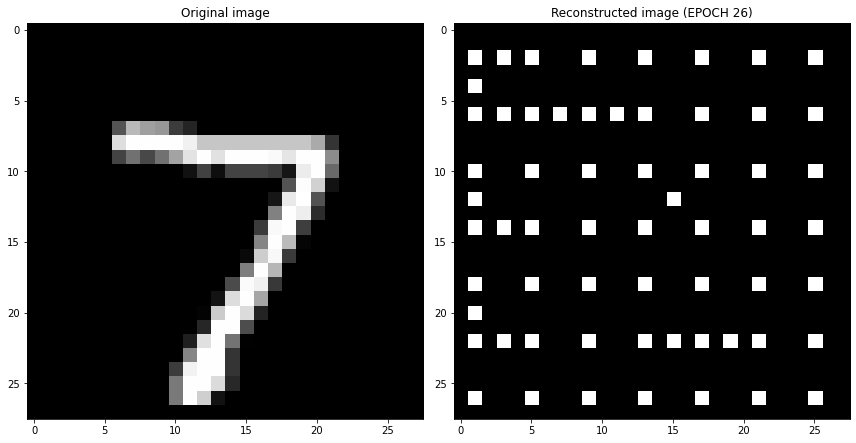

EPOCH 27/30
	 partial train loss (single batch): 0.171491
	 partial train loss (single batch): 0.171247
	 partial train loss (single batch): 0.173866
	 partial train loss (single batch): 0.171632
	 partial train loss (single batch): 0.166017
	 partial train loss (single batch): 0.167232
	 partial train loss (single batch): 0.164455
	 partial train loss (single batch): 0.166442
	 partial train loss (single batch): 0.166106
	 partial train loss (single batch): 0.163936
	 partial train loss (single batch): 0.165400
	 partial train loss (single batch): 0.168278
	 partial train loss (single batch): 0.162476
	 partial train loss (single batch): 0.166034
	 partial train loss (single batch): 0.172576
	 partial train loss (single batch): 0.167603
	 partial train loss (single batch): 0.171120
	 partial train loss (single batch): 0.169006
	 partial train loss (single batch): 0.166186
	 partial train loss (single batch): 0.168139
	 partial train loss (single batch): 0.171684
	 partial train loss (

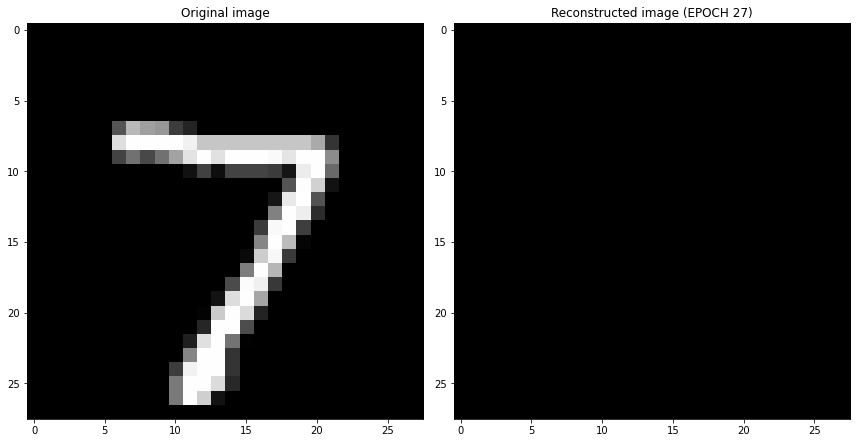

EPOCH 28/30
	 partial train loss (single batch): 0.114171
	 partial train loss (single batch): 0.113539
	 partial train loss (single batch): 0.111506
	 partial train loss (single batch): 0.110556
	 partial train loss (single batch): 0.113314
	 partial train loss (single batch): 0.109319
	 partial train loss (single batch): 0.115981
	 partial train loss (single batch): 0.116124
	 partial train loss (single batch): 0.114262
	 partial train loss (single batch): 0.109041
	 partial train loss (single batch): 0.112089
	 partial train loss (single batch): 0.116639
	 partial train loss (single batch): 0.111925
	 partial train loss (single batch): 0.113493
	 partial train loss (single batch): 0.115352
	 partial train loss (single batch): 0.115228
	 partial train loss (single batch): 0.115149
	 partial train loss (single batch): 0.110373
	 partial train loss (single batch): 0.115249
	 partial train loss (single batch): 0.111330
	 partial train loss (single batch): 0.110561
	 partial train loss (

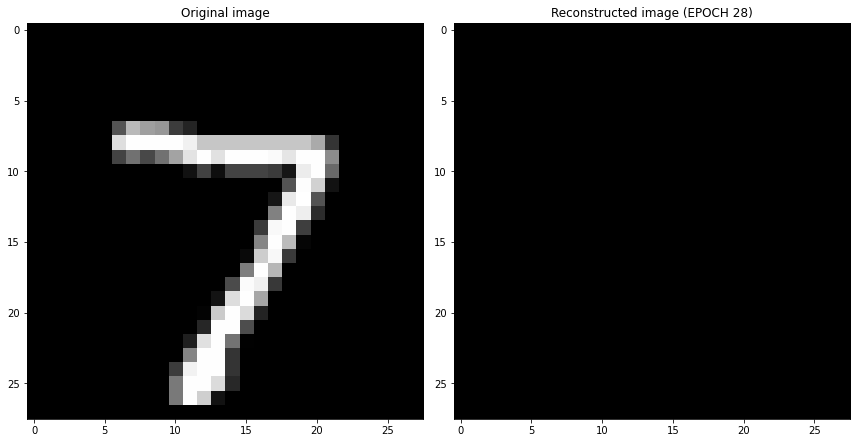

EPOCH 29/30
	 partial train loss (single batch): 0.117609
	 partial train loss (single batch): 0.109564
	 partial train loss (single batch): 0.107066
	 partial train loss (single batch): 0.116692
	 partial train loss (single batch): 0.112880
	 partial train loss (single batch): 0.111474
	 partial train loss (single batch): 0.110192
	 partial train loss (single batch): 0.109755
	 partial train loss (single batch): 0.109981
	 partial train loss (single batch): 0.111828
	 partial train loss (single batch): 0.113106
	 partial train loss (single batch): 0.113790
	 partial train loss (single batch): 0.114694
	 partial train loss (single batch): 0.114743
	 partial train loss (single batch): 0.115133
	 partial train loss (single batch): 0.109784
	 partial train loss (single batch): 0.115903
	 partial train loss (single batch): 0.116361
	 partial train loss (single batch): 0.112925
	 partial train loss (single batch): 0.108294
	 partial train loss (single batch): 0.115293
	 partial train loss (

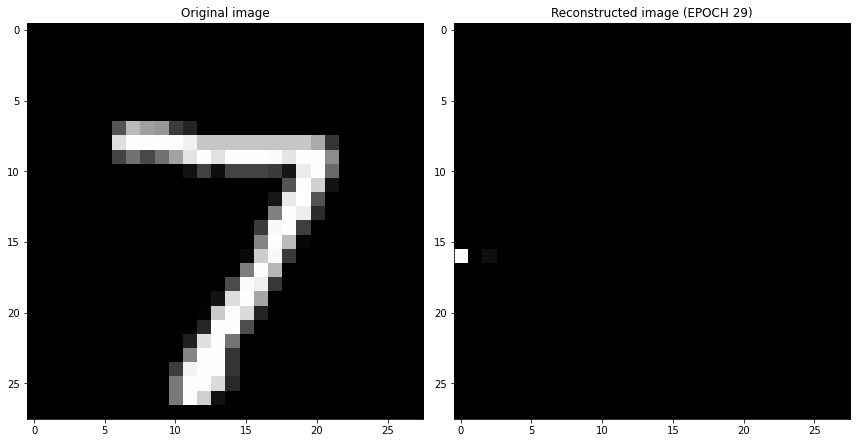

EPOCH 30/30
	 partial train loss (single batch): 0.114521
	 partial train loss (single batch): 0.112937
	 partial train loss (single batch): 0.110206
	 partial train loss (single batch): 0.111563
	 partial train loss (single batch): 0.110602
	 partial train loss (single batch): 0.113526
	 partial train loss (single batch): 0.109340
	 partial train loss (single batch): 0.111079
	 partial train loss (single batch): 0.106818
	 partial train loss (single batch): 0.108436
	 partial train loss (single batch): 0.111652
	 partial train loss (single batch): 0.108131
	 partial train loss (single batch): 0.114789
	 partial train loss (single batch): 0.110569
	 partial train loss (single batch): 0.110678
	 partial train loss (single batch): 0.113582
	 partial train loss (single batch): 0.108152
	 partial train loss (single batch): 0.109140
	 partial train loss (single batch): 0.111532
	 partial train loss (single batch): 0.110378
	 partial train loss (single batch): 0.113981
	 partial train loss (

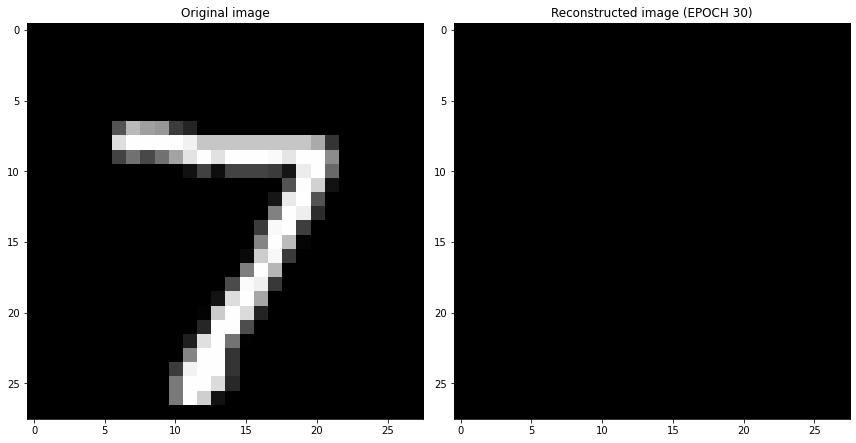

Cross validation fold number= 1/6
EPOCH 1/30
	 partial train loss (single batch): 0.288241
	 partial train loss (single batch): 0.288020
	 partial train loss (single batch): 0.286715
	 partial train loss (single batch): 0.286611
	 partial train loss (single batch): 0.285628
	 partial train loss (single batch): 0.284983
	 partial train loss (single batch): 0.283779
	 partial train loss (single batch): 0.283632
	 partial train loss (single batch): 0.282441
	 partial train loss (single batch): 0.281121
	 partial train loss (single batch): 0.281628
	 partial train loss (single batch): 0.280924
	 partial train loss (single batch): 0.279440
	 partial train loss (single batch): 0.277633
	 partial train loss (single batch): 0.277138
	 partial train loss (single batch): 0.276186
	 partial train loss (single batch): 0.274177
	 partial train loss (single batch): 0.272764
	 partial train loss (single batch): 0.270725
	 partial train loss (single batch): 0.269086
	 partial train loss (single batch)

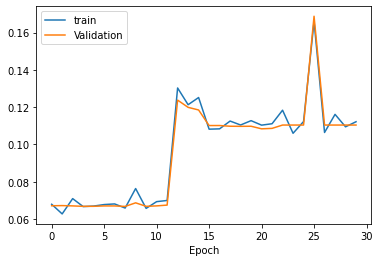

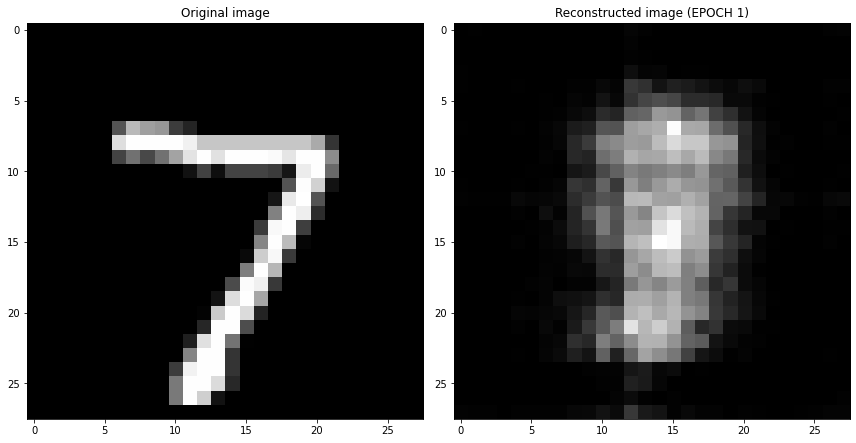

EPOCH 2/30
	 partial train loss (single batch): 0.061396
	 partial train loss (single batch): 0.062321
	 partial train loss (single batch): 0.062031
	 partial train loss (single batch): 0.062659
	 partial train loss (single batch): 0.063095
	 partial train loss (single batch): 0.063634
	 partial train loss (single batch): 0.063548
	 partial train loss (single batch): 0.065044
	 partial train loss (single batch): 0.062648
	 partial train loss (single batch): 0.062543
	 partial train loss (single batch): 0.059883
	 partial train loss (single batch): 0.061327
	 partial train loss (single batch): 0.064116
	 partial train loss (single batch): 0.062605
	 partial train loss (single batch): 0.062636
	 partial train loss (single batch): 0.063383
	 partial train loss (single batch): 0.062901
	 partial train loss (single batch): 0.062932
	 partial train loss (single batch): 0.063191
	 partial train loss (single batch): 0.061976
	 partial train loss (single batch): 0.062993
	 partial train loss (s

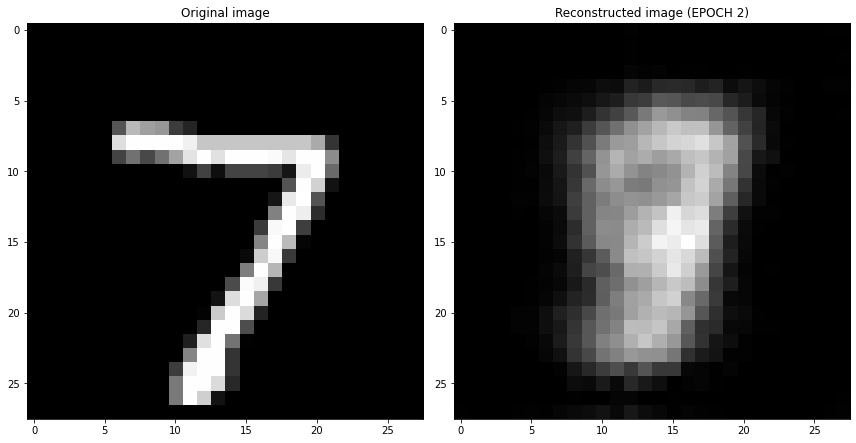

EPOCH 3/30
	 partial train loss (single batch): 0.058035
	 partial train loss (single batch): 0.060363
	 partial train loss (single batch): 0.058145
	 partial train loss (single batch): 0.058493
	 partial train loss (single batch): 0.059777
	 partial train loss (single batch): 0.057847
	 partial train loss (single batch): 0.059366
	 partial train loss (single batch): 0.059558
	 partial train loss (single batch): 0.059118
	 partial train loss (single batch): 0.058613
	 partial train loss (single batch): 0.059083
	 partial train loss (single batch): 0.059978
	 partial train loss (single batch): 0.058173
	 partial train loss (single batch): 0.058600
	 partial train loss (single batch): 0.061080
	 partial train loss (single batch): 0.061815
	 partial train loss (single batch): 0.060071
	 partial train loss (single batch): 0.059340
	 partial train loss (single batch): 0.061048
	 partial train loss (single batch): 0.059800
	 partial train loss (single batch): 0.058682
	 partial train loss (s

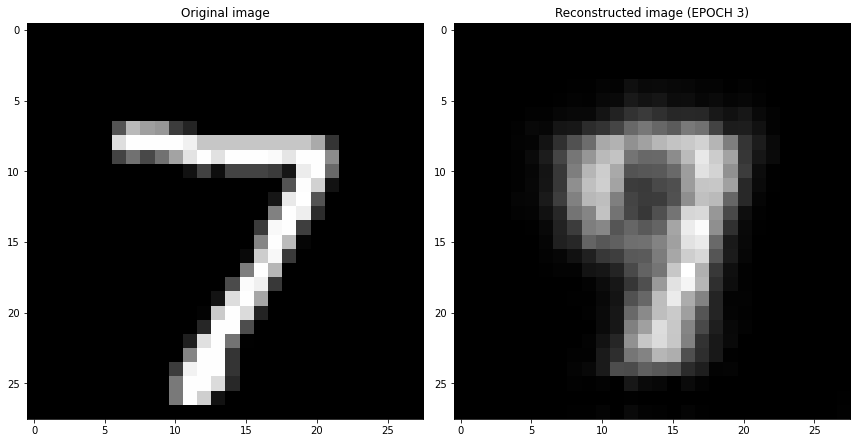

EPOCH 4/30
	 partial train loss (single batch): 0.050414
	 partial train loss (single batch): 0.052700
	 partial train loss (single batch): 0.052826
	 partial train loss (single batch): 0.050805
	 partial train loss (single batch): 0.052676
	 partial train loss (single batch): 0.051864
	 partial train loss (single batch): 0.051215
	 partial train loss (single batch): 0.054048
	 partial train loss (single batch): 0.051384
	 partial train loss (single batch): 0.051200
	 partial train loss (single batch): 0.049876
	 partial train loss (single batch): 0.052738
	 partial train loss (single batch): 0.051029
	 partial train loss (single batch): 0.052562
	 partial train loss (single batch): 0.053110
	 partial train loss (single batch): 0.050953
	 partial train loss (single batch): 0.051463
	 partial train loss (single batch): 0.052874
	 partial train loss (single batch): 0.052358
	 partial train loss (single batch): 0.052408
	 partial train loss (single batch): 0.050836
	 partial train loss (s

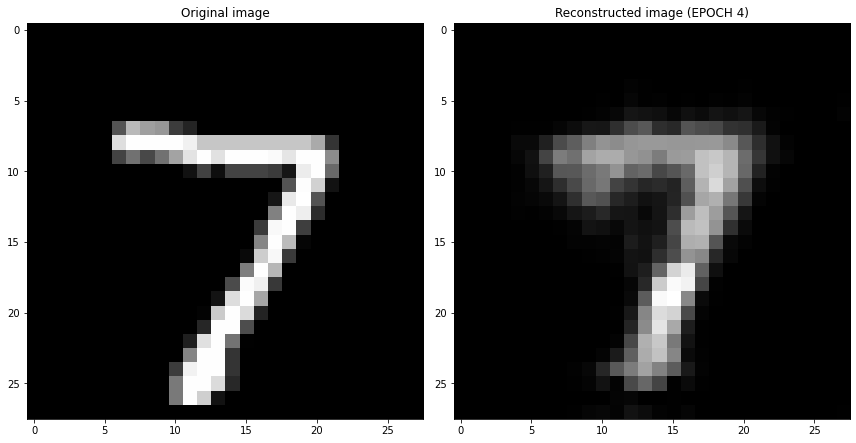

EPOCH 5/30
	 partial train loss (single batch): 0.045605
	 partial train loss (single batch): 0.042500
	 partial train loss (single batch): 0.043153
	 partial train loss (single batch): 0.043878
	 partial train loss (single batch): 0.043886
	 partial train loss (single batch): 0.042191
	 partial train loss (single batch): 0.041068
	 partial train loss (single batch): 0.042937
	 partial train loss (single batch): 0.042439
	 partial train loss (single batch): 0.043154
	 partial train loss (single batch): 0.043684
	 partial train loss (single batch): 0.043145
	 partial train loss (single batch): 0.040821
	 partial train loss (single batch): 0.040546
	 partial train loss (single batch): 0.042940
	 partial train loss (single batch): 0.044749
	 partial train loss (single batch): 0.043217
	 partial train loss (single batch): 0.041691
	 partial train loss (single batch): 0.043607
	 partial train loss (single batch): 0.041856
	 partial train loss (single batch): 0.039122
	 partial train loss (s

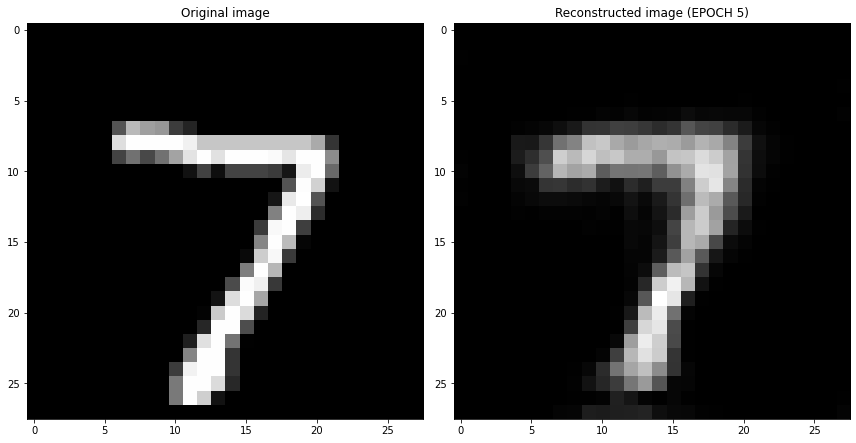

EPOCH 6/30
	 partial train loss (single batch): 0.036664
	 partial train loss (single batch): 0.036406
	 partial train loss (single batch): 0.036421
	 partial train loss (single batch): 0.037299
	 partial train loss (single batch): 0.036861
	 partial train loss (single batch): 0.038867
	 partial train loss (single batch): 0.037320
	 partial train loss (single batch): 0.037148
	 partial train loss (single batch): 0.036768
	 partial train loss (single batch): 0.037423
	 partial train loss (single batch): 0.035856
	 partial train loss (single batch): 0.036258
	 partial train loss (single batch): 0.035414
	 partial train loss (single batch): 0.036364
	 partial train loss (single batch): 0.036391
	 partial train loss (single batch): 0.035972
	 partial train loss (single batch): 0.034570
	 partial train loss (single batch): 0.035338
	 partial train loss (single batch): 0.036004
	 partial train loss (single batch): 0.034557
	 partial train loss (single batch): 0.035506
	 partial train loss (s

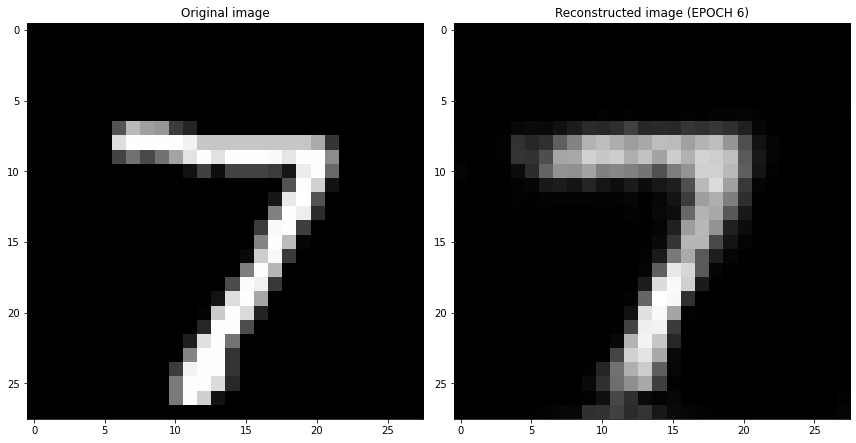

EPOCH 7/30
	 partial train loss (single batch): 0.031836
	 partial train loss (single batch): 0.031775
	 partial train loss (single batch): 0.032943
	 partial train loss (single batch): 0.035137
	 partial train loss (single batch): 0.032278
	 partial train loss (single batch): 0.034475
	 partial train loss (single batch): 0.032562
	 partial train loss (single batch): 0.033985
	 partial train loss (single batch): 0.031284
	 partial train loss (single batch): 0.032330
	 partial train loss (single batch): 0.033182
	 partial train loss (single batch): 0.033013
	 partial train loss (single batch): 0.035357
	 partial train loss (single batch): 0.033143
	 partial train loss (single batch): 0.033911
	 partial train loss (single batch): 0.033658
	 partial train loss (single batch): 0.032773
	 partial train loss (single batch): 0.033903
	 partial train loss (single batch): 0.032859
	 partial train loss (single batch): 0.033583
	 partial train loss (single batch): 0.032664
	 partial train loss (s

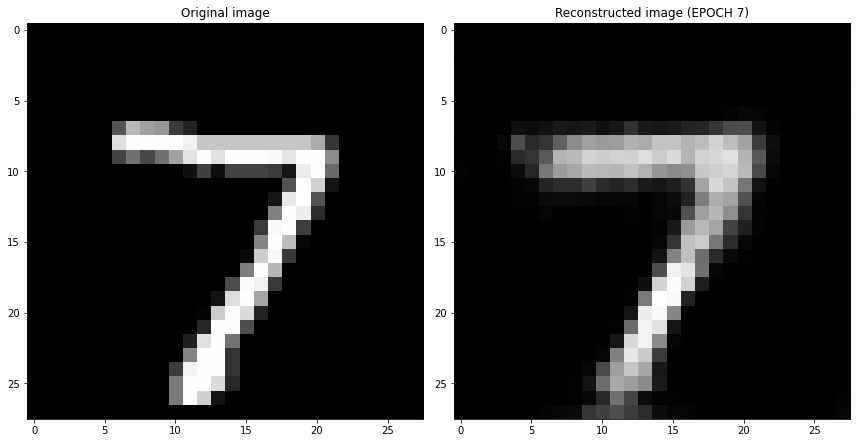

EPOCH 8/30
	 partial train loss (single batch): 0.031407
	 partial train loss (single batch): 0.031225
	 partial train loss (single batch): 0.030209
	 partial train loss (single batch): 0.032607
	 partial train loss (single batch): 0.032069
	 partial train loss (single batch): 0.031736
	 partial train loss (single batch): 0.030915
	 partial train loss (single batch): 0.030384
	 partial train loss (single batch): 0.031834
	 partial train loss (single batch): 0.030986
	 partial train loss (single batch): 0.032523
	 partial train loss (single batch): 0.032276
	 partial train loss (single batch): 0.032623
	 partial train loss (single batch): 0.031814
	 partial train loss (single batch): 0.032832
	 partial train loss (single batch): 0.033391
	 partial train loss (single batch): 0.032782
	 partial train loss (single batch): 0.031798
	 partial train loss (single batch): 0.030721
	 partial train loss (single batch): 0.031568
	 partial train loss (single batch): 0.030634
	 partial train loss (s

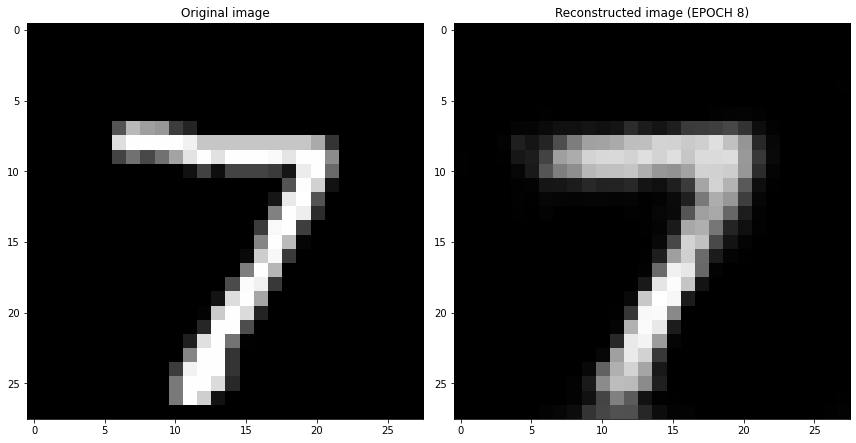

EPOCH 9/30
	 partial train loss (single batch): 0.030942
	 partial train loss (single batch): 0.030940
	 partial train loss (single batch): 0.030761
	 partial train loss (single batch): 0.030458
	 partial train loss (single batch): 0.030908
	 partial train loss (single batch): 0.029536
	 partial train loss (single batch): 0.029960
	 partial train loss (single batch): 0.030801
	 partial train loss (single batch): 0.030199
	 partial train loss (single batch): 0.029948
	 partial train loss (single batch): 0.031269
	 partial train loss (single batch): 0.029525
	 partial train loss (single batch): 0.029650
	 partial train loss (single batch): 0.031206
	 partial train loss (single batch): 0.029910
	 partial train loss (single batch): 0.030921
	 partial train loss (single batch): 0.029316
	 partial train loss (single batch): 0.029578
	 partial train loss (single batch): 0.028970
	 partial train loss (single batch): 0.030651
	 partial train loss (single batch): 0.030296
	 partial train loss (s

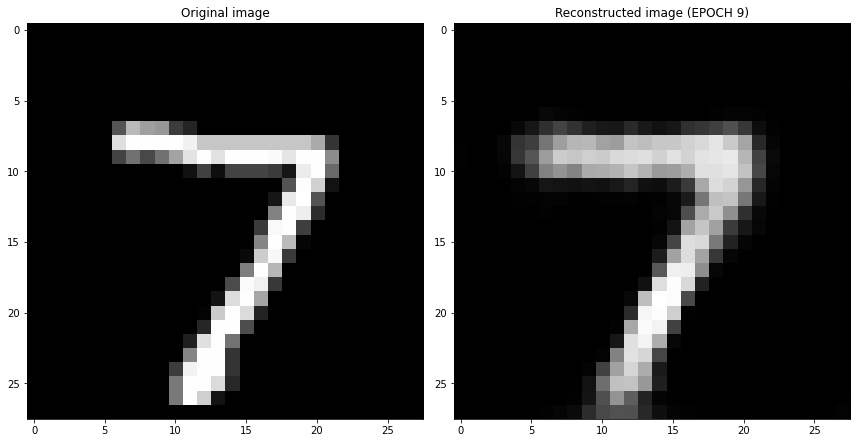

EPOCH 10/30
	 partial train loss (single batch): 0.028943
	 partial train loss (single batch): 0.030496
	 partial train loss (single batch): 0.029323
	 partial train loss (single batch): 0.030121
	 partial train loss (single batch): 0.028953
	 partial train loss (single batch): 0.030085
	 partial train loss (single batch): 0.029512
	 partial train loss (single batch): 0.028599
	 partial train loss (single batch): 0.030019
	 partial train loss (single batch): 0.029681
	 partial train loss (single batch): 0.029136
	 partial train loss (single batch): 0.030648
	 partial train loss (single batch): 0.028986
	 partial train loss (single batch): 0.030110
	 partial train loss (single batch): 0.028998
	 partial train loss (single batch): 0.029087
	 partial train loss (single batch): 0.029125
	 partial train loss (single batch): 0.028813
	 partial train loss (single batch): 0.029134
	 partial train loss (single batch): 0.030132
	 partial train loss (single batch): 0.029252
	 partial train loss (

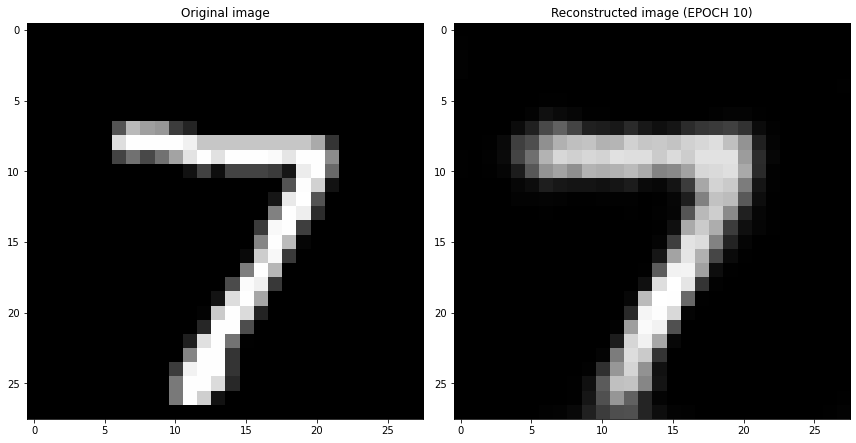

EPOCH 11/30
	 partial train loss (single batch): 0.028178
	 partial train loss (single batch): 0.029332
	 partial train loss (single batch): 0.029387
	 partial train loss (single batch): 0.028022
	 partial train loss (single batch): 0.029097
	 partial train loss (single batch): 0.028086
	 partial train loss (single batch): 0.027610
	 partial train loss (single batch): 0.029153
	 partial train loss (single batch): 0.028642
	 partial train loss (single batch): 0.028246
	 partial train loss (single batch): 0.027844
	 partial train loss (single batch): 0.030458
	 partial train loss (single batch): 0.028193
	 partial train loss (single batch): 0.029200
	 partial train loss (single batch): 0.029042
	 partial train loss (single batch): 0.028121
	 partial train loss (single batch): 0.031155
	 partial train loss (single batch): 0.029804
	 partial train loss (single batch): 0.027014
	 partial train loss (single batch): 0.029615
	 partial train loss (single batch): 0.027932
	 partial train loss (

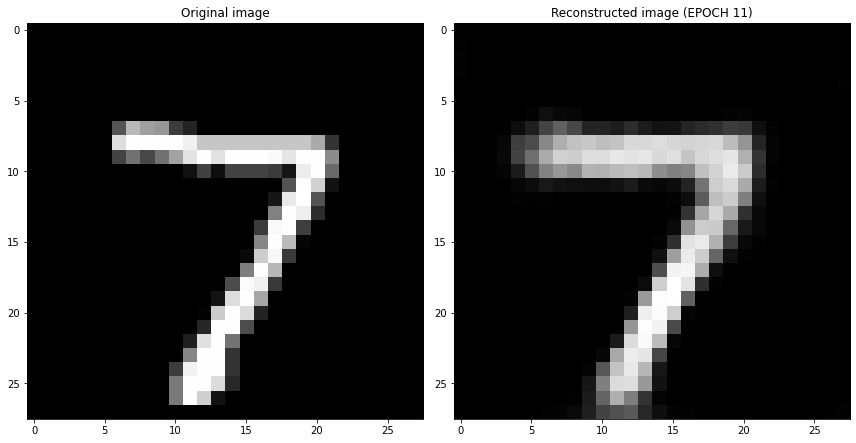

EPOCH 12/30
	 partial train loss (single batch): 0.027270
	 partial train loss (single batch): 0.029785
	 partial train loss (single batch): 0.027021
	 partial train loss (single batch): 0.028979
	 partial train loss (single batch): 0.029025
	 partial train loss (single batch): 0.028104
	 partial train loss (single batch): 0.028552
	 partial train loss (single batch): 0.028392
	 partial train loss (single batch): 0.027364
	 partial train loss (single batch): 0.030030
	 partial train loss (single batch): 0.028398
	 partial train loss (single batch): 0.026924
	 partial train loss (single batch): 0.026943
	 partial train loss (single batch): 0.028399
	 partial train loss (single batch): 0.027579
	 partial train loss (single batch): 0.026810
	 partial train loss (single batch): 0.028456
	 partial train loss (single batch): 0.027904
	 partial train loss (single batch): 0.026584
	 partial train loss (single batch): 0.026161
	 partial train loss (single batch): 0.027435
	 partial train loss (

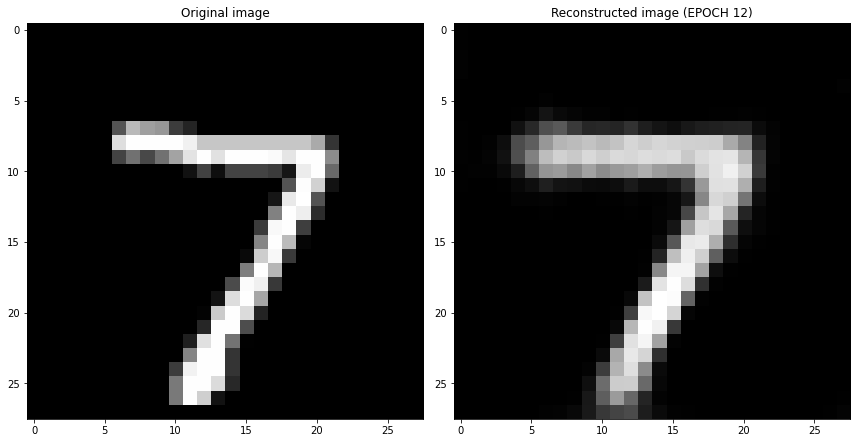

EPOCH 13/30
	 partial train loss (single batch): 0.026613
	 partial train loss (single batch): 0.028376
	 partial train loss (single batch): 0.028235
	 partial train loss (single batch): 0.027925
	 partial train loss (single batch): 0.026920
	 partial train loss (single batch): 0.027006
	 partial train loss (single batch): 0.026154
	 partial train loss (single batch): 0.027282
	 partial train loss (single batch): 0.026928
	 partial train loss (single batch): 0.026046
	 partial train loss (single batch): 0.027877
	 partial train loss (single batch): 0.026089
	 partial train loss (single batch): 0.027341
	 partial train loss (single batch): 0.027420
	 partial train loss (single batch): 0.026068
	 partial train loss (single batch): 0.026430
	 partial train loss (single batch): 0.026132
	 partial train loss (single batch): 0.026805
	 partial train loss (single batch): 0.026803
	 partial train loss (single batch): 0.027299
	 partial train loss (single batch): 0.026625
	 partial train loss (

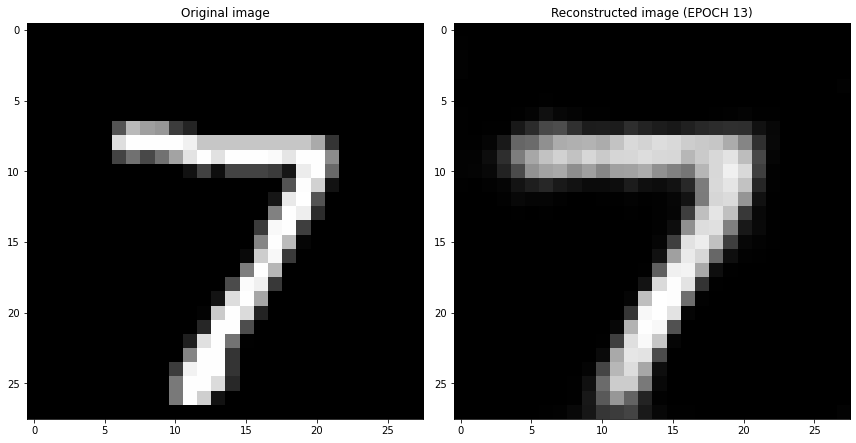

EPOCH 14/30
	 partial train loss (single batch): 0.026546
	 partial train loss (single batch): 0.026243
	 partial train loss (single batch): 0.026283
	 partial train loss (single batch): 0.025448
	 partial train loss (single batch): 0.027167
	 partial train loss (single batch): 0.025681
	 partial train loss (single batch): 0.027847
	 partial train loss (single batch): 0.028026
	 partial train loss (single batch): 0.027438
	 partial train loss (single batch): 0.025955
	 partial train loss (single batch): 0.026728
	 partial train loss (single batch): 0.025876
	 partial train loss (single batch): 0.026502
	 partial train loss (single batch): 0.026787
	 partial train loss (single batch): 0.026924
	 partial train loss (single batch): 0.028603
	 partial train loss (single batch): 0.025736
	 partial train loss (single batch): 0.026644
	 partial train loss (single batch): 0.026593
	 partial train loss (single batch): 0.026837
	 partial train loss (single batch): 0.026713
	 partial train loss (

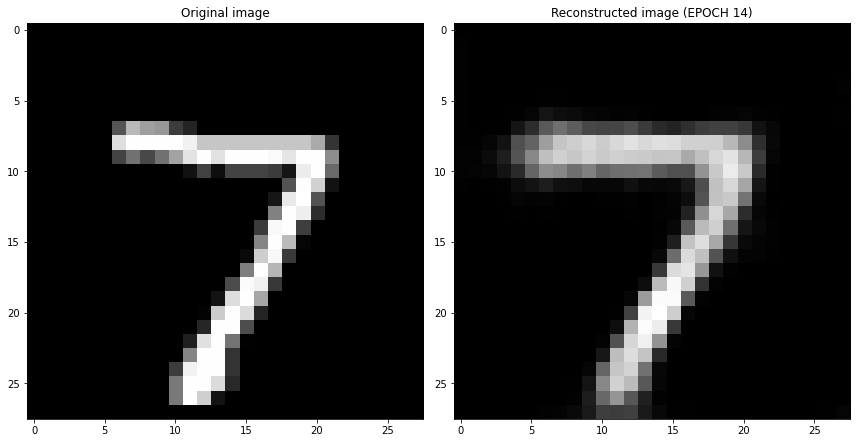

EPOCH 15/30
	 partial train loss (single batch): 0.026310
	 partial train loss (single batch): 0.026420
	 partial train loss (single batch): 0.027031
	 partial train loss (single batch): 0.026824
	 partial train loss (single batch): 0.024517
	 partial train loss (single batch): 0.027812
	 partial train loss (single batch): 0.027129
	 partial train loss (single batch): 0.024420
	 partial train loss (single batch): 0.025572
	 partial train loss (single batch): 0.026808
	 partial train loss (single batch): 0.026638
	 partial train loss (single batch): 0.026734
	 partial train loss (single batch): 0.026586
	 partial train loss (single batch): 0.026503
	 partial train loss (single batch): 0.026444
	 partial train loss (single batch): 0.026065
	 partial train loss (single batch): 0.026453
	 partial train loss (single batch): 0.027790
	 partial train loss (single batch): 0.025840
	 partial train loss (single batch): 0.026119
	 partial train loss (single batch): 0.025859
	 partial train loss (

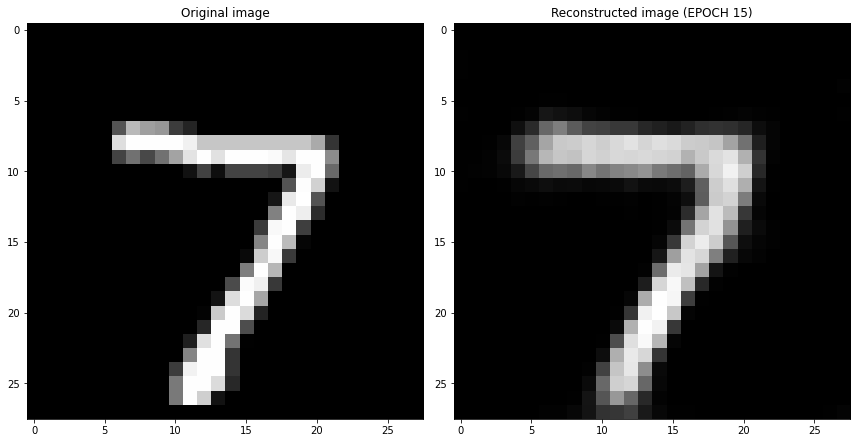

EPOCH 16/30
	 partial train loss (single batch): 0.025732
	 partial train loss (single batch): 0.025470
	 partial train loss (single batch): 0.024442
	 partial train loss (single batch): 0.025730
	 partial train loss (single batch): 0.025446
	 partial train loss (single batch): 0.024891
	 partial train loss (single batch): 0.025946
	 partial train loss (single batch): 0.026070
	 partial train loss (single batch): 0.026231
	 partial train loss (single batch): 0.025066
	 partial train loss (single batch): 0.025029
	 partial train loss (single batch): 0.026037
	 partial train loss (single batch): 0.026248
	 partial train loss (single batch): 0.026317
	 partial train loss (single batch): 0.025331
	 partial train loss (single batch): 0.023503
	 partial train loss (single batch): 0.024647
	 partial train loss (single batch): 0.025373
	 partial train loss (single batch): 0.025858
	 partial train loss (single batch): 0.025116
	 partial train loss (single batch): 0.023841
	 partial train loss (

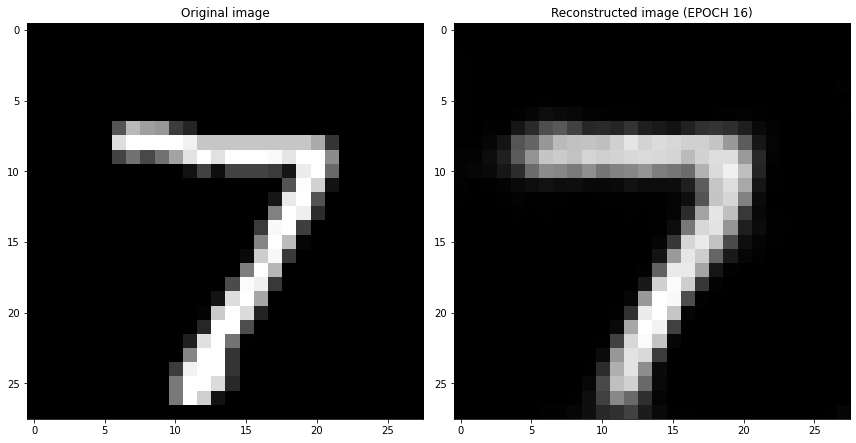

EPOCH 17/30
	 partial train loss (single batch): 0.024699
	 partial train loss (single batch): 0.026471
	 partial train loss (single batch): 0.024434
	 partial train loss (single batch): 0.025662
	 partial train loss (single batch): 0.026563
	 partial train loss (single batch): 0.026265
	 partial train loss (single batch): 0.025748
	 partial train loss (single batch): 0.022610
	 partial train loss (single batch): 0.026072
	 partial train loss (single batch): 0.024065
	 partial train loss (single batch): 0.024860
	 partial train loss (single batch): 0.025209
	 partial train loss (single batch): 0.026564
	 partial train loss (single batch): 0.025694
	 partial train loss (single batch): 0.024165
	 partial train loss (single batch): 0.024406
	 partial train loss (single batch): 0.025684
	 partial train loss (single batch): 0.025022
	 partial train loss (single batch): 0.025490
	 partial train loss (single batch): 0.024486
	 partial train loss (single batch): 0.025023
	 partial train loss (

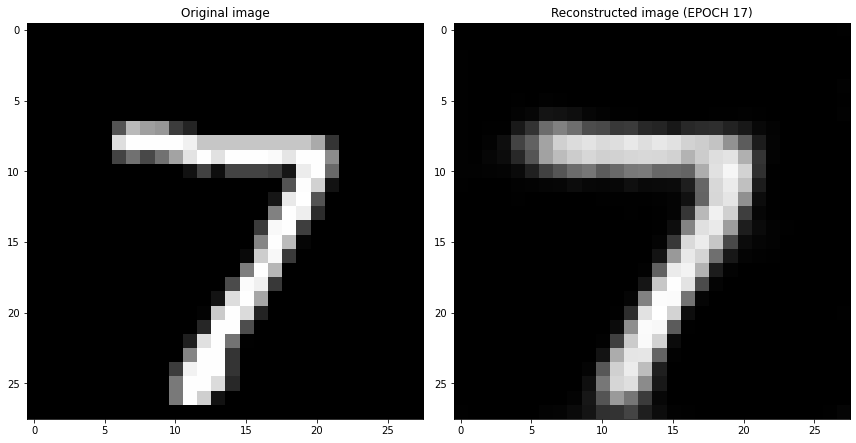

EPOCH 18/30
	 partial train loss (single batch): 0.025640
	 partial train loss (single batch): 0.024915
	 partial train loss (single batch): 0.024807
	 partial train loss (single batch): 0.026535
	 partial train loss (single batch): 0.024974
	 partial train loss (single batch): 0.023782
	 partial train loss (single batch): 0.024508
	 partial train loss (single batch): 0.024204
	 partial train loss (single batch): 0.023726
	 partial train loss (single batch): 0.025305
	 partial train loss (single batch): 0.026135
	 partial train loss (single batch): 0.024548
	 partial train loss (single batch): 0.025103
	 partial train loss (single batch): 0.024990
	 partial train loss (single batch): 0.024900
	 partial train loss (single batch): 0.023847
	 partial train loss (single batch): 0.024178
	 partial train loss (single batch): 0.026704
	 partial train loss (single batch): 0.023890
	 partial train loss (single batch): 0.025089
	 partial train loss (single batch): 0.023025
	 partial train loss (

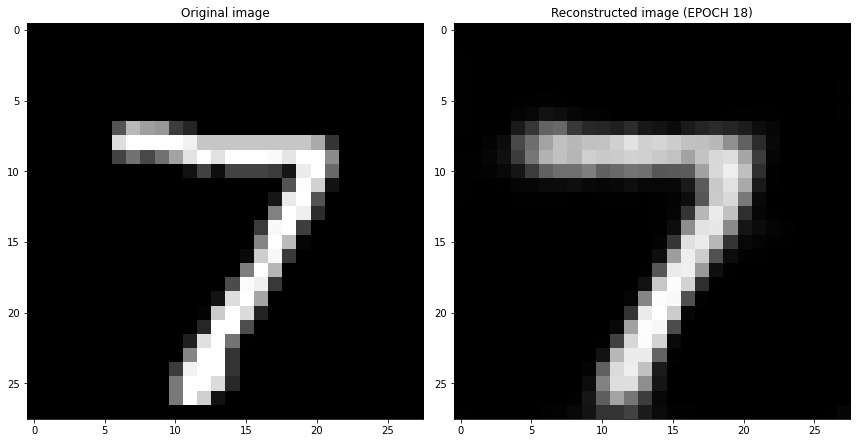

EPOCH 19/30
	 partial train loss (single batch): 0.025229
	 partial train loss (single batch): 0.023647
	 partial train loss (single batch): 0.024793
	 partial train loss (single batch): 0.024957
	 partial train loss (single batch): 0.024123
	 partial train loss (single batch): 0.024839
	 partial train loss (single batch): 0.024081
	 partial train loss (single batch): 0.024685
	 partial train loss (single batch): 0.024775
	 partial train loss (single batch): 0.024020
	 partial train loss (single batch): 0.024740
	 partial train loss (single batch): 0.025104
	 partial train loss (single batch): 0.023840
	 partial train loss (single batch): 0.024033
	 partial train loss (single batch): 0.024078
	 partial train loss (single batch): 0.023610
	 partial train loss (single batch): 0.025080
	 partial train loss (single batch): 0.026189
	 partial train loss (single batch): 0.023597
	 partial train loss (single batch): 0.024836
	 partial train loss (single batch): 0.024511
	 partial train loss (

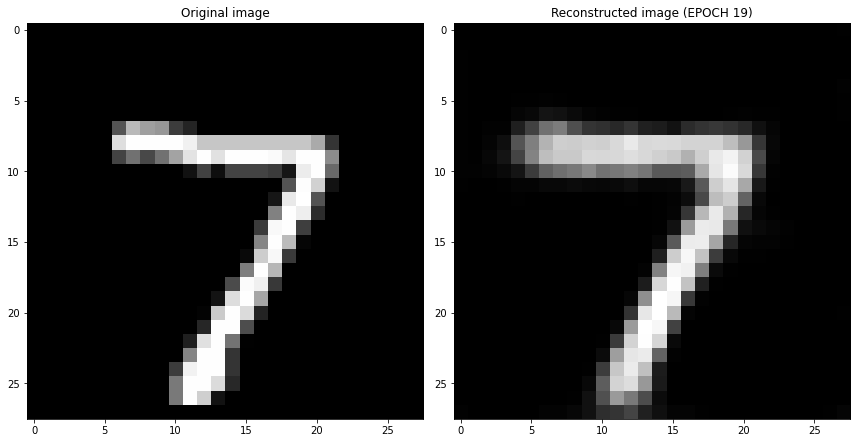

EPOCH 20/30
	 partial train loss (single batch): 0.024294
	 partial train loss (single batch): 0.024599
	 partial train loss (single batch): 0.024274
	 partial train loss (single batch): 0.023527
	 partial train loss (single batch): 0.025786
	 partial train loss (single batch): 0.024242
	 partial train loss (single batch): 0.022854
	 partial train loss (single batch): 0.023651
	 partial train loss (single batch): 0.025325
	 partial train loss (single batch): 0.024767
	 partial train loss (single batch): 0.025390
	 partial train loss (single batch): 0.023872
	 partial train loss (single batch): 0.024254
	 partial train loss (single batch): 0.025397
	 partial train loss (single batch): 0.023862
	 partial train loss (single batch): 0.024009
	 partial train loss (single batch): 0.025387
	 partial train loss (single batch): 0.023698
	 partial train loss (single batch): 0.024830
	 partial train loss (single batch): 0.024124
	 partial train loss (single batch): 0.023159
	 partial train loss (

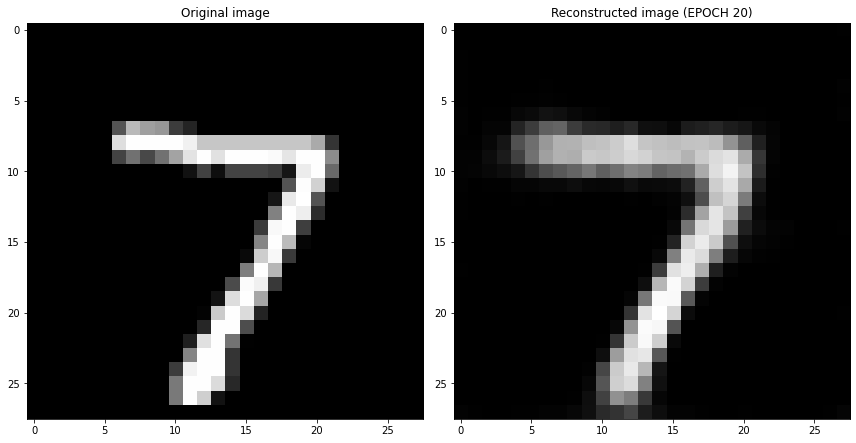

EPOCH 21/30
	 partial train loss (single batch): 0.023265
	 partial train loss (single batch): 0.024197
	 partial train loss (single batch): 0.022685
	 partial train loss (single batch): 0.024845
	 partial train loss (single batch): 0.023805
	 partial train loss (single batch): 0.022246
	 partial train loss (single batch): 0.024493
	 partial train loss (single batch): 0.023183
	 partial train loss (single batch): 0.024566
	 partial train loss (single batch): 0.023868
	 partial train loss (single batch): 0.022696
	 partial train loss (single batch): 0.023194
	 partial train loss (single batch): 0.025407
	 partial train loss (single batch): 0.023273
	 partial train loss (single batch): 0.023149
	 partial train loss (single batch): 0.023554
	 partial train loss (single batch): 0.024933
	 partial train loss (single batch): 0.024094
	 partial train loss (single batch): 0.026093
	 partial train loss (single batch): 0.024248
	 partial train loss (single batch): 0.024417
	 partial train loss (

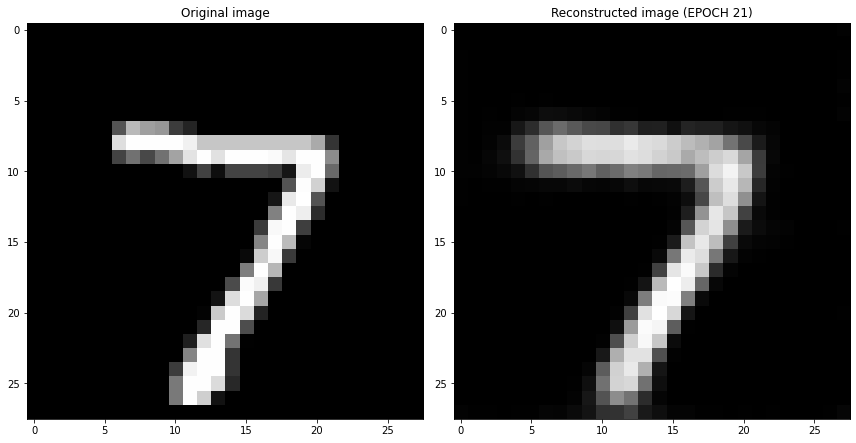

EPOCH 22/30
	 partial train loss (single batch): 0.024029
	 partial train loss (single batch): 0.022551
	 partial train loss (single batch): 0.024574
	 partial train loss (single batch): 0.023108
	 partial train loss (single batch): 0.024696
	 partial train loss (single batch): 0.024648
	 partial train loss (single batch): 0.023554
	 partial train loss (single batch): 0.024849
	 partial train loss (single batch): 0.022219
	 partial train loss (single batch): 0.025409
	 partial train loss (single batch): 0.024010
	 partial train loss (single batch): 0.024233
	 partial train loss (single batch): 0.021722
	 partial train loss (single batch): 0.025095
	 partial train loss (single batch): 0.023277
	 partial train loss (single batch): 0.025434
	 partial train loss (single batch): 0.023479
	 partial train loss (single batch): 0.024101
	 partial train loss (single batch): 0.022137
	 partial train loss (single batch): 0.024318
	 partial train loss (single batch): 0.022269
	 partial train loss (

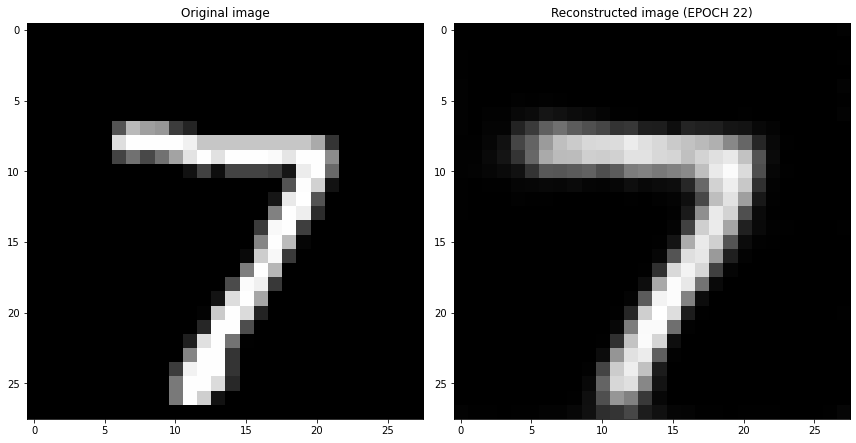

EPOCH 23/30
	 partial train loss (single batch): 0.023475
	 partial train loss (single batch): 0.023462
	 partial train loss (single batch): 0.023001
	 partial train loss (single batch): 0.022832
	 partial train loss (single batch): 0.024670
	 partial train loss (single batch): 0.024236
	 partial train loss (single batch): 0.023141
	 partial train loss (single batch): 0.023750
	 partial train loss (single batch): 0.022586
	 partial train loss (single batch): 0.024142
	 partial train loss (single batch): 0.024575
	 partial train loss (single batch): 0.023503
	 partial train loss (single batch): 0.024767
	 partial train loss (single batch): 0.023754
	 partial train loss (single batch): 0.023444
	 partial train loss (single batch): 0.023199
	 partial train loss (single batch): 0.023305
	 partial train loss (single batch): 0.024820
	 partial train loss (single batch): 0.023969
	 partial train loss (single batch): 0.024805
	 partial train loss (single batch): 0.025882
	 partial train loss (

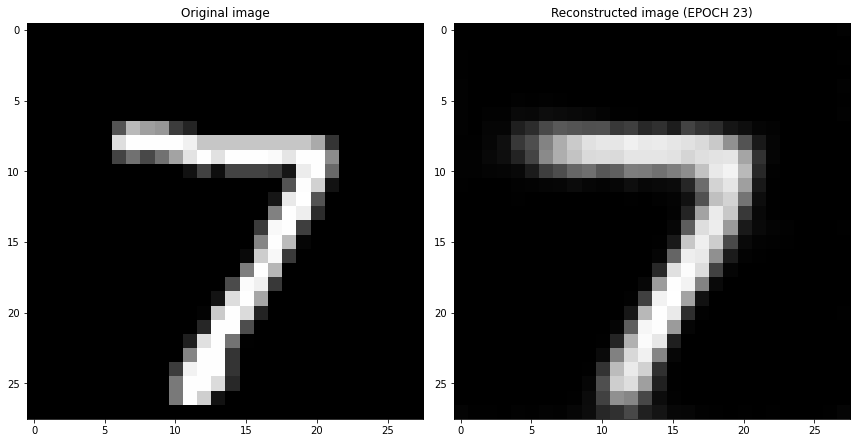

EPOCH 24/30
	 partial train loss (single batch): 0.023944
	 partial train loss (single batch): 0.024293
	 partial train loss (single batch): 0.022579
	 partial train loss (single batch): 0.024239
	 partial train loss (single batch): 0.023493
	 partial train loss (single batch): 0.024181
	 partial train loss (single batch): 0.024771
	 partial train loss (single batch): 0.023719
	 partial train loss (single batch): 0.024273
	 partial train loss (single batch): 0.024139
	 partial train loss (single batch): 0.024509
	 partial train loss (single batch): 0.023160
	 partial train loss (single batch): 0.024647
	 partial train loss (single batch): 0.023913
	 partial train loss (single batch): 0.024073
	 partial train loss (single batch): 0.023853
	 partial train loss (single batch): 0.023589
	 partial train loss (single batch): 0.023701
	 partial train loss (single batch): 0.023681
	 partial train loss (single batch): 0.022268
	 partial train loss (single batch): 0.022644
	 partial train loss (

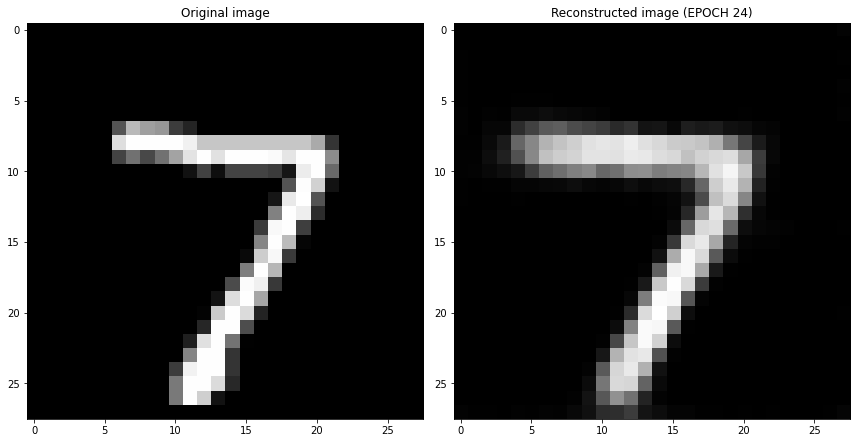

EPOCH 25/30
	 partial train loss (single batch): 0.023629
	 partial train loss (single batch): 0.022955
	 partial train loss (single batch): 0.022962
	 partial train loss (single batch): 0.023852
	 partial train loss (single batch): 0.024028
	 partial train loss (single batch): 0.022958
	 partial train loss (single batch): 0.024462
	 partial train loss (single batch): 0.023513
	 partial train loss (single batch): 0.022842
	 partial train loss (single batch): 0.024022
	 partial train loss (single batch): 0.024399
	 partial train loss (single batch): 0.023343
	 partial train loss (single batch): 0.022897
	 partial train loss (single batch): 0.023076
	 partial train loss (single batch): 0.024037
	 partial train loss (single batch): 0.024937
	 partial train loss (single batch): 0.024402
	 partial train loss (single batch): 0.024075
	 partial train loss (single batch): 0.023533
	 partial train loss (single batch): 0.022758
	 partial train loss (single batch): 0.023427
	 partial train loss (

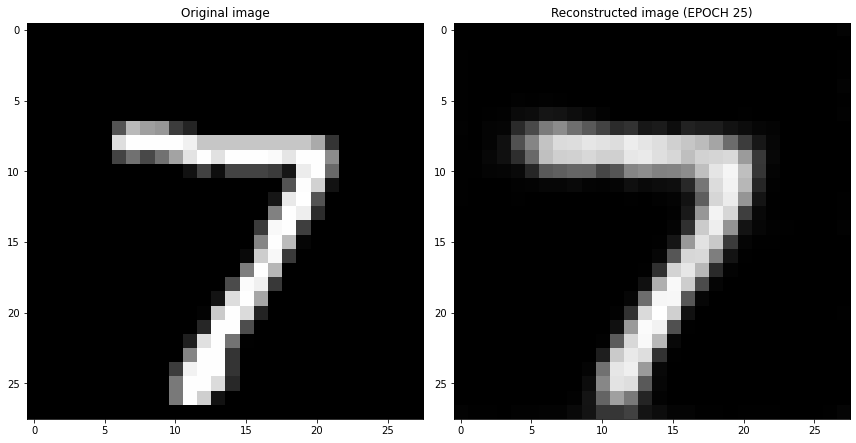

EPOCH 26/30
	 partial train loss (single batch): 0.024198
	 partial train loss (single batch): 0.023064
	 partial train loss (single batch): 0.023303
	 partial train loss (single batch): 0.023652
	 partial train loss (single batch): 0.023574
	 partial train loss (single batch): 0.023635
	 partial train loss (single batch): 0.021020
	 partial train loss (single batch): 0.022451
	 partial train loss (single batch): 0.023999
	 partial train loss (single batch): 0.023374
	 partial train loss (single batch): 0.022949
	 partial train loss (single batch): 0.024325
	 partial train loss (single batch): 0.022507
	 partial train loss (single batch): 0.023110
	 partial train loss (single batch): 0.023502
	 partial train loss (single batch): 0.022097
	 partial train loss (single batch): 0.022957
	 partial train loss (single batch): 0.024098
	 partial train loss (single batch): 0.023779
	 partial train loss (single batch): 0.023167
	 partial train loss (single batch): 0.022520
	 partial train loss (

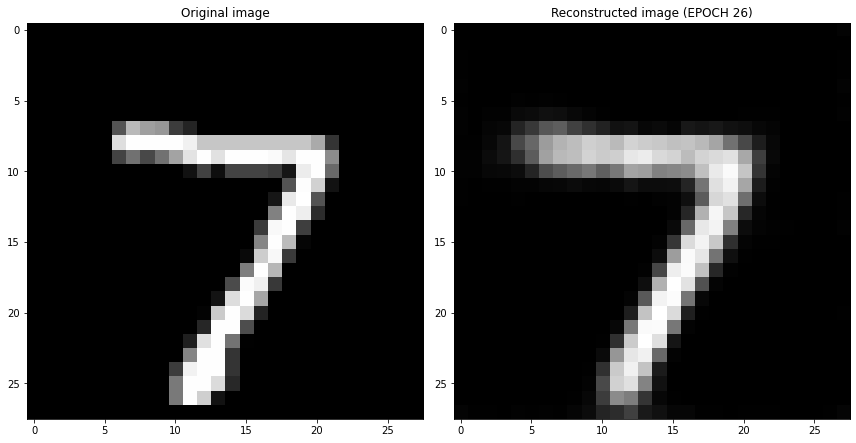

EPOCH 27/30
	 partial train loss (single batch): 0.022987
	 partial train loss (single batch): 0.023183
	 partial train loss (single batch): 0.024172
	 partial train loss (single batch): 0.023729
	 partial train loss (single batch): 0.022445
	 partial train loss (single batch): 0.021917
	 partial train loss (single batch): 0.024306
	 partial train loss (single batch): 0.022151
	 partial train loss (single batch): 0.023657
	 partial train loss (single batch): 0.024303
	 partial train loss (single batch): 0.021984
	 partial train loss (single batch): 0.024245
	 partial train loss (single batch): 0.023233
	 partial train loss (single batch): 0.023917
	 partial train loss (single batch): 0.024447
	 partial train loss (single batch): 0.022839
	 partial train loss (single batch): 0.022779
	 partial train loss (single batch): 0.022038
	 partial train loss (single batch): 0.022006
	 partial train loss (single batch): 0.022310
	 partial train loss (single batch): 0.022767
	 partial train loss (

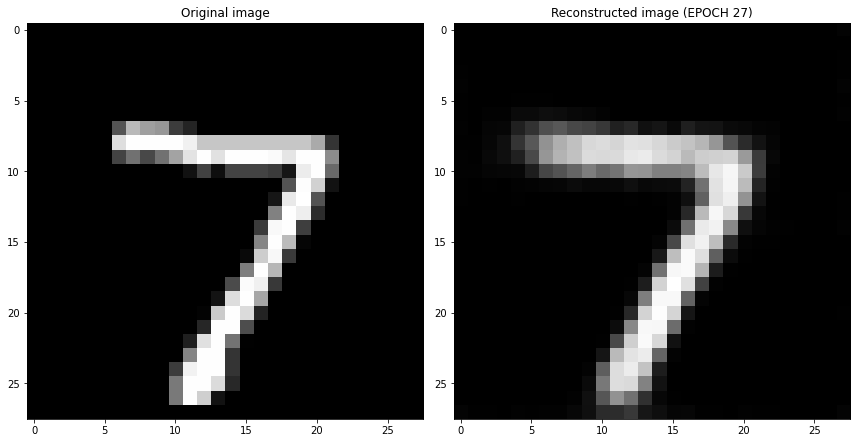

EPOCH 28/30
	 partial train loss (single batch): 0.023330
	 partial train loss (single batch): 0.023229
	 partial train loss (single batch): 0.021916
	 partial train loss (single batch): 0.021386
	 partial train loss (single batch): 0.022646
	 partial train loss (single batch): 0.021983
	 partial train loss (single batch): 0.023180
	 partial train loss (single batch): 0.023410
	 partial train loss (single batch): 0.022294
	 partial train loss (single batch): 0.024444
	 partial train loss (single batch): 0.023347
	 partial train loss (single batch): 0.021567
	 partial train loss (single batch): 0.022285
	 partial train loss (single batch): 0.023870
	 partial train loss (single batch): 0.023120
	 partial train loss (single batch): 0.021774
	 partial train loss (single batch): 0.023561
	 partial train loss (single batch): 0.023171
	 partial train loss (single batch): 0.022786
	 partial train loss (single batch): 0.023326
	 partial train loss (single batch): 0.023710
	 partial train loss (

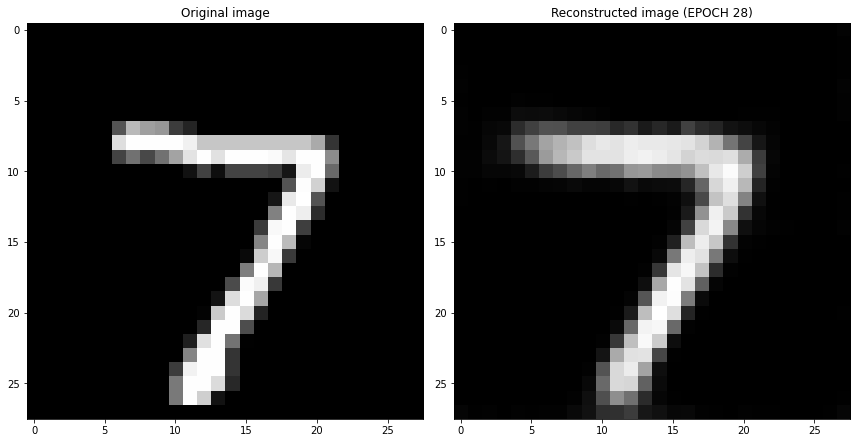

EPOCH 29/30
	 partial train loss (single batch): 0.022299
	 partial train loss (single batch): 0.021929
	 partial train loss (single batch): 0.022821
	 partial train loss (single batch): 0.022249
	 partial train loss (single batch): 0.023151
	 partial train loss (single batch): 0.023833
	 partial train loss (single batch): 0.022767
	 partial train loss (single batch): 0.023232
	 partial train loss (single batch): 0.023074
	 partial train loss (single batch): 0.022114
	 partial train loss (single batch): 0.022663
	 partial train loss (single batch): 0.022302
	 partial train loss (single batch): 0.022580
	 partial train loss (single batch): 0.022043
	 partial train loss (single batch): 0.022104
	 partial train loss (single batch): 0.024174
	 partial train loss (single batch): 0.021866
	 partial train loss (single batch): 0.024933
	 partial train loss (single batch): 0.022940
	 partial train loss (single batch): 0.021323
	 partial train loss (single batch): 0.022093
	 partial train loss (

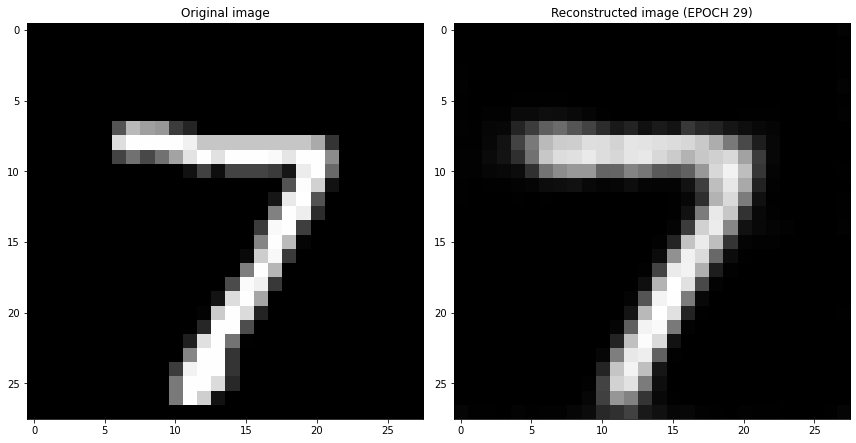

EPOCH 30/30
	 partial train loss (single batch): 0.024393
	 partial train loss (single batch): 0.023107
	 partial train loss (single batch): 0.021514
	 partial train loss (single batch): 0.022709
	 partial train loss (single batch): 0.022706
	 partial train loss (single batch): 0.023779
	 partial train loss (single batch): 0.023337
	 partial train loss (single batch): 0.022583
	 partial train loss (single batch): 0.022245
	 partial train loss (single batch): 0.022362
	 partial train loss (single batch): 0.022648
	 partial train loss (single batch): 0.022356
	 partial train loss (single batch): 0.022434
	 partial train loss (single batch): 0.022337
	 partial train loss (single batch): 0.022367
	 partial train loss (single batch): 0.022677
	 partial train loss (single batch): 0.022969
	 partial train loss (single batch): 0.022043
	 partial train loss (single batch): 0.023335
	 partial train loss (single batch): 0.021962
	 partial train loss (single batch): 0.022771
	 partial train loss (

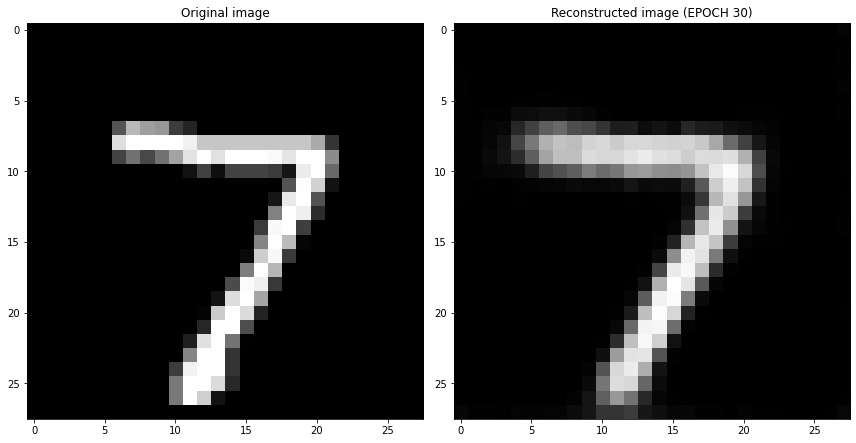

Cross validation fold number= 2/6
EPOCH 1/30
	 partial train loss (single batch): 0.228158
	 partial train loss (single batch): 0.227771
	 partial train loss (single batch): 0.227091
	 partial train loss (single batch): 0.226157
	 partial train loss (single batch): 0.226533
	 partial train loss (single batch): 0.225964
	 partial train loss (single batch): 0.225219
	 partial train loss (single batch): 0.224955
	 partial train loss (single batch): 0.224842
	 partial train loss (single batch): 0.223879
	 partial train loss (single batch): 0.223977
	 partial train loss (single batch): 0.223159
	 partial train loss (single batch): 0.222727
	 partial train loss (single batch): 0.222164
	 partial train loss (single batch): 0.221578
	 partial train loss (single batch): 0.221106
	 partial train loss (single batch): 0.220303
	 partial train loss (single batch): 0.219453
	 partial train loss (single batch): 0.218627
	 partial train loss (single batch): 0.216905
	 partial train loss (single batch)

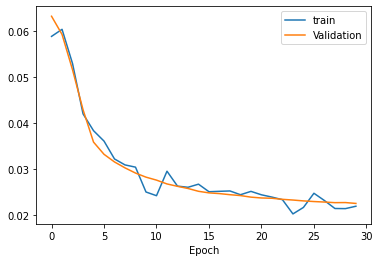

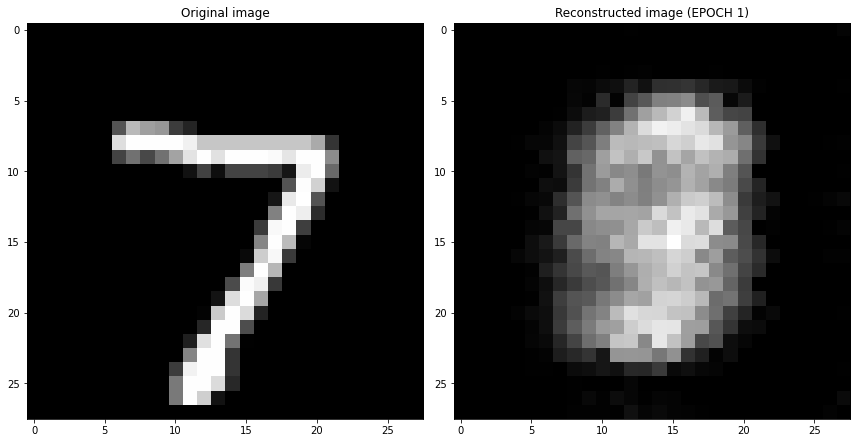

EPOCH 2/30
	 partial train loss (single batch): 0.065703
	 partial train loss (single batch): 0.064577
	 partial train loss (single batch): 0.063436
	 partial train loss (single batch): 0.066066
	 partial train loss (single batch): 0.064874
	 partial train loss (single batch): 0.066197
	 partial train loss (single batch): 0.067161
	 partial train loss (single batch): 0.063545
	 partial train loss (single batch): 0.066733
	 partial train loss (single batch): 0.066825
	 partial train loss (single batch): 0.066716
	 partial train loss (single batch): 0.063756
	 partial train loss (single batch): 0.068274
	 partial train loss (single batch): 0.065908
	 partial train loss (single batch): 0.063955
	 partial train loss (single batch): 0.065010
	 partial train loss (single batch): 0.065279
	 partial train loss (single batch): 0.066503
	 partial train loss (single batch): 0.064996
	 partial train loss (single batch): 0.065667
	 partial train loss (single batch): 0.063578
	 partial train loss (s

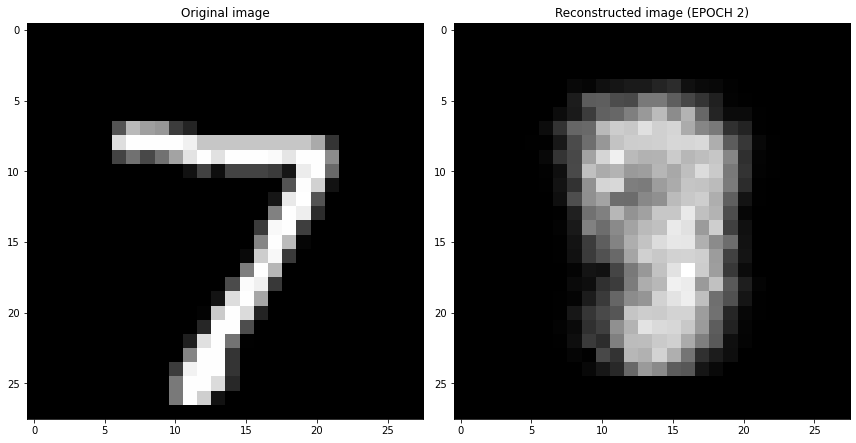

EPOCH 3/30
	 partial train loss (single batch): 0.056163
	 partial train loss (single batch): 0.055306
	 partial train loss (single batch): 0.055222
	 partial train loss (single batch): 0.055315
	 partial train loss (single batch): 0.055723
	 partial train loss (single batch): 0.055556
	 partial train loss (single batch): 0.054127
	 partial train loss (single batch): 0.056670
	 partial train loss (single batch): 0.057310
	 partial train loss (single batch): 0.055627
	 partial train loss (single batch): 0.053431
	 partial train loss (single batch): 0.053922
	 partial train loss (single batch): 0.056216
	 partial train loss (single batch): 0.057149
	 partial train loss (single batch): 0.054164
	 partial train loss (single batch): 0.055482
	 partial train loss (single batch): 0.055283
	 partial train loss (single batch): 0.054400
	 partial train loss (single batch): 0.055244
	 partial train loss (single batch): 0.055412
	 partial train loss (single batch): 0.053788
	 partial train loss (s

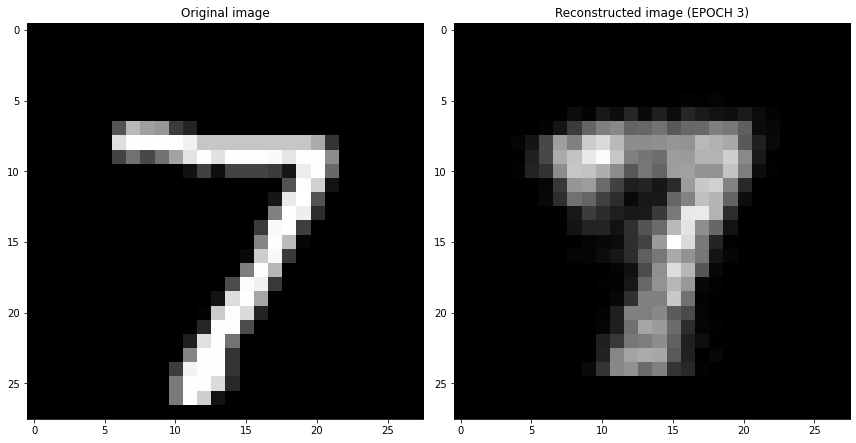

EPOCH 4/30
	 partial train loss (single batch): 0.045931
	 partial train loss (single batch): 0.043518
	 partial train loss (single batch): 0.045194
	 partial train loss (single batch): 0.045635
	 partial train loss (single batch): 0.046118
	 partial train loss (single batch): 0.044261
	 partial train loss (single batch): 0.045959
	 partial train loss (single batch): 0.044481
	 partial train loss (single batch): 0.045031
	 partial train loss (single batch): 0.045279
	 partial train loss (single batch): 0.044034
	 partial train loss (single batch): 0.046761
	 partial train loss (single batch): 0.044452
	 partial train loss (single batch): 0.044958
	 partial train loss (single batch): 0.043968
	 partial train loss (single batch): 0.046878
	 partial train loss (single batch): 0.045082
	 partial train loss (single batch): 0.046054
	 partial train loss (single batch): 0.044642
	 partial train loss (single batch): 0.044169
	 partial train loss (single batch): 0.045078
	 partial train loss (s

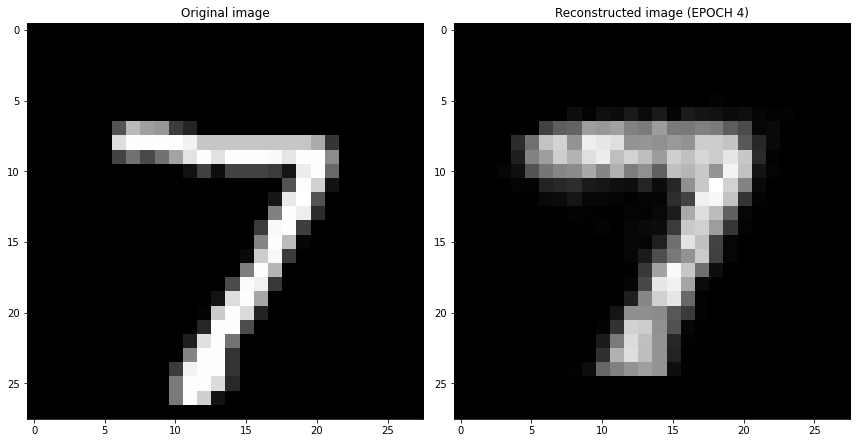

EPOCH 5/30
	 partial train loss (single batch): 0.040954
	 partial train loss (single batch): 0.042016
	 partial train loss (single batch): 0.040744
	 partial train loss (single batch): 0.041598
	 partial train loss (single batch): 0.039775
	 partial train loss (single batch): 0.039421
	 partial train loss (single batch): 0.039910
	 partial train loss (single batch): 0.039984
	 partial train loss (single batch): 0.041386
	 partial train loss (single batch): 0.040073
	 partial train loss (single batch): 0.039712
	 partial train loss (single batch): 0.040335
	 partial train loss (single batch): 0.039466
	 partial train loss (single batch): 0.039841
	 partial train loss (single batch): 0.041267
	 partial train loss (single batch): 0.039339
	 partial train loss (single batch): 0.041682
	 partial train loss (single batch): 0.040134
	 partial train loss (single batch): 0.038614
	 partial train loss (single batch): 0.041164
	 partial train loss (single batch): 0.042101
	 partial train loss (s

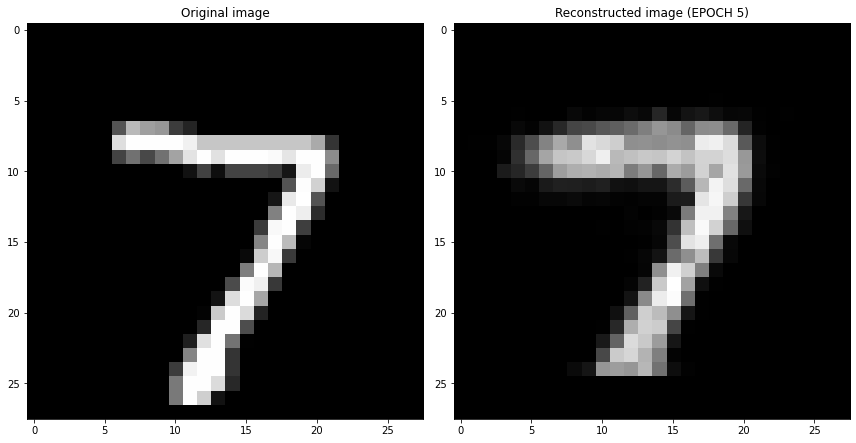

EPOCH 6/30
	 partial train loss (single batch): 0.034803
	 partial train loss (single batch): 0.034854
	 partial train loss (single batch): 0.035994
	 partial train loss (single batch): 0.034450
	 partial train loss (single batch): 0.033929
	 partial train loss (single batch): 0.034465
	 partial train loss (single batch): 0.035057
	 partial train loss (single batch): 0.034289
	 partial train loss (single batch): 0.033729
	 partial train loss (single batch): 0.033850
	 partial train loss (single batch): 0.033359
	 partial train loss (single batch): 0.034368
	 partial train loss (single batch): 0.034358
	 partial train loss (single batch): 0.036869
	 partial train loss (single batch): 0.036095
	 partial train loss (single batch): 0.035181
	 partial train loss (single batch): 0.035280
	 partial train loss (single batch): 0.034106
	 partial train loss (single batch): 0.034360
	 partial train loss (single batch): 0.034826
	 partial train loss (single batch): 0.033638
	 partial train loss (s

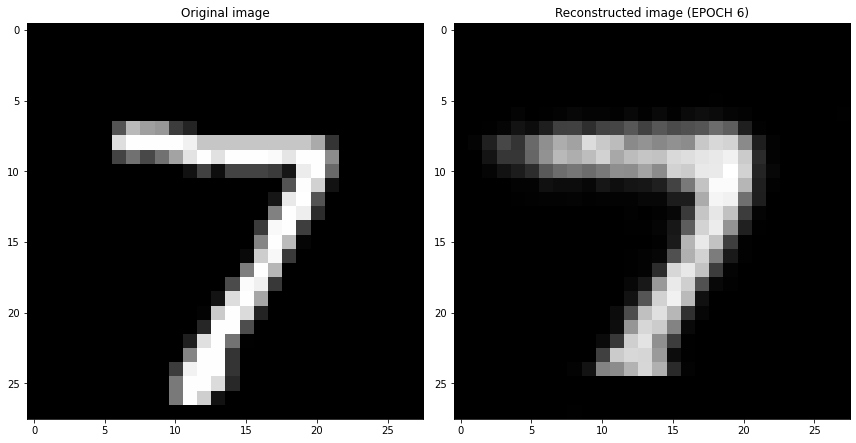

EPOCH 7/30
	 partial train loss (single batch): 0.032492
	 partial train loss (single batch): 0.031718
	 partial train loss (single batch): 0.031480
	 partial train loss (single batch): 0.031308
	 partial train loss (single batch): 0.031821
	 partial train loss (single batch): 0.031892
	 partial train loss (single batch): 0.031735
	 partial train loss (single batch): 0.031473
	 partial train loss (single batch): 0.031604
	 partial train loss (single batch): 0.031859
	 partial train loss (single batch): 0.032132
	 partial train loss (single batch): 0.031834
	 partial train loss (single batch): 0.033244
	 partial train loss (single batch): 0.031416
	 partial train loss (single batch): 0.032563
	 partial train loss (single batch): 0.032400
	 partial train loss (single batch): 0.033449
	 partial train loss (single batch): 0.031811
	 partial train loss (single batch): 0.031641
	 partial train loss (single batch): 0.031367
	 partial train loss (single batch): 0.033184
	 partial train loss (s

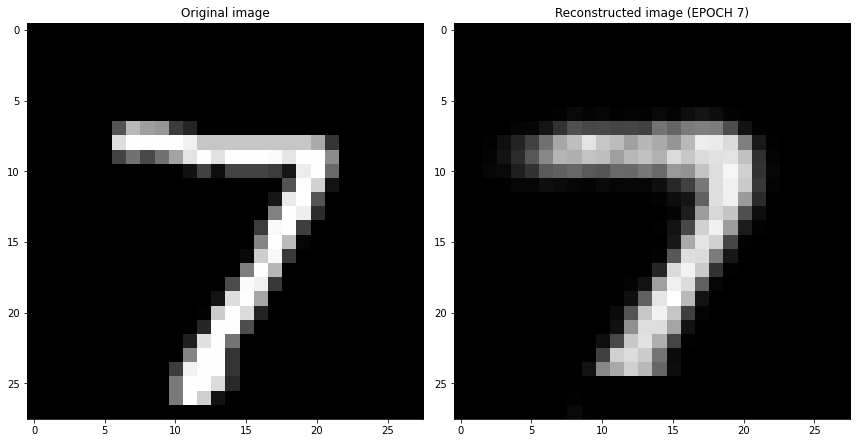

EPOCH 8/30
	 partial train loss (single batch): 0.032124
	 partial train loss (single batch): 0.030673
	 partial train loss (single batch): 0.030925
	 partial train loss (single batch): 0.029162
	 partial train loss (single batch): 0.030321
	 partial train loss (single batch): 0.030425
	 partial train loss (single batch): 0.029144
	 partial train loss (single batch): 0.030555
	 partial train loss (single batch): 0.030669
	 partial train loss (single batch): 0.031069
	 partial train loss (single batch): 0.030401
	 partial train loss (single batch): 0.030533
	 partial train loss (single batch): 0.030289
	 partial train loss (single batch): 0.030015
	 partial train loss (single batch): 0.030365
	 partial train loss (single batch): 0.030384
	 partial train loss (single batch): 0.030118
	 partial train loss (single batch): 0.031276
	 partial train loss (single batch): 0.029636
	 partial train loss (single batch): 0.029575
	 partial train loss (single batch): 0.031266
	 partial train loss (s

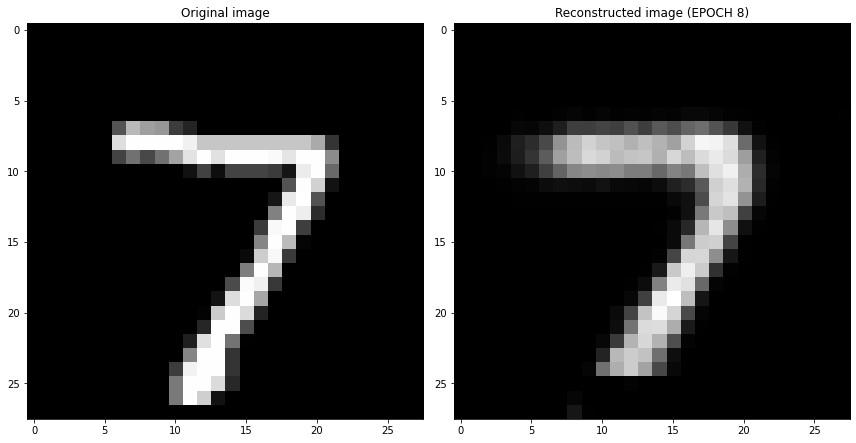

EPOCH 9/30
	 partial train loss (single batch): 0.030539
	 partial train loss (single batch): 0.029780
	 partial train loss (single batch): 0.029832
	 partial train loss (single batch): 0.028746
	 partial train loss (single batch): 0.030601
	 partial train loss (single batch): 0.029274
	 partial train loss (single batch): 0.027667
	 partial train loss (single batch): 0.030411
	 partial train loss (single batch): 0.029470
	 partial train loss (single batch): 0.028175
	 partial train loss (single batch): 0.027248
	 partial train loss (single batch): 0.029962
	 partial train loss (single batch): 0.028400
	 partial train loss (single batch): 0.030381
	 partial train loss (single batch): 0.028350
	 partial train loss (single batch): 0.027957
	 partial train loss (single batch): 0.030047
	 partial train loss (single batch): 0.029896
	 partial train loss (single batch): 0.029785
	 partial train loss (single batch): 0.027382
	 partial train loss (single batch): 0.028382
	 partial train loss (s

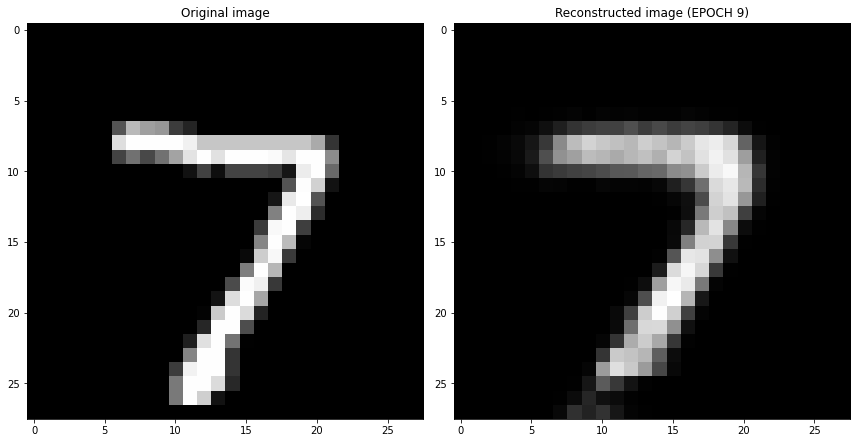

EPOCH 10/30
	 partial train loss (single batch): 0.027227
	 partial train loss (single batch): 0.029154
	 partial train loss (single batch): 0.029702
	 partial train loss (single batch): 0.029085
	 partial train loss (single batch): 0.028298
	 partial train loss (single batch): 0.027973
	 partial train loss (single batch): 0.028546
	 partial train loss (single batch): 0.028358
	 partial train loss (single batch): 0.027955
	 partial train loss (single batch): 0.027507
	 partial train loss (single batch): 0.027763
	 partial train loss (single batch): 0.027999
	 partial train loss (single batch): 0.029300
	 partial train loss (single batch): 0.028523
	 partial train loss (single batch): 0.028835
	 partial train loss (single batch): 0.028731
	 partial train loss (single batch): 0.029169
	 partial train loss (single batch): 0.027258
	 partial train loss (single batch): 0.027577
	 partial train loss (single batch): 0.027996
	 partial train loss (single batch): 0.028507
	 partial train loss (

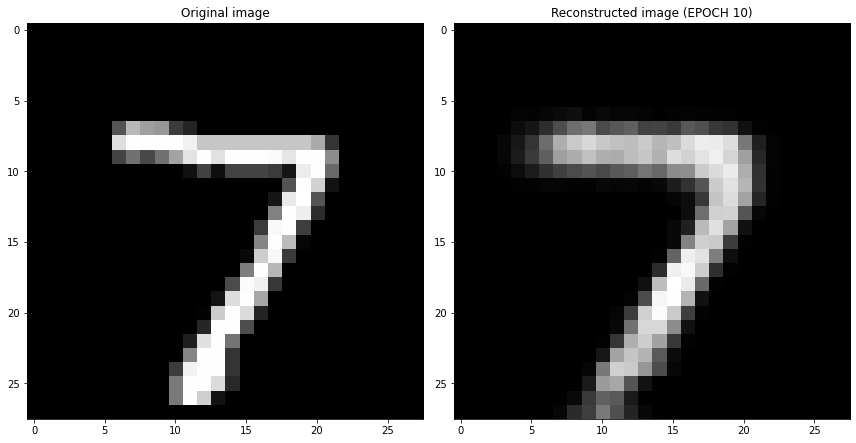

EPOCH 11/30
	 partial train loss (single batch): 0.027335
	 partial train loss (single batch): 0.028935
	 partial train loss (single batch): 0.027510
	 partial train loss (single batch): 0.027987
	 partial train loss (single batch): 0.026891
	 partial train loss (single batch): 0.026736
	 partial train loss (single batch): 0.026830
	 partial train loss (single batch): 0.025633
	 partial train loss (single batch): 0.027767
	 partial train loss (single batch): 0.028327
	 partial train loss (single batch): 0.027294
	 partial train loss (single batch): 0.025496
	 partial train loss (single batch): 0.027603
	 partial train loss (single batch): 0.028332
	 partial train loss (single batch): 0.027939
	 partial train loss (single batch): 0.027556
	 partial train loss (single batch): 0.026906
	 partial train loss (single batch): 0.027176
	 partial train loss (single batch): 0.026514
	 partial train loss (single batch): 0.027384
	 partial train loss (single batch): 0.027515
	 partial train loss (

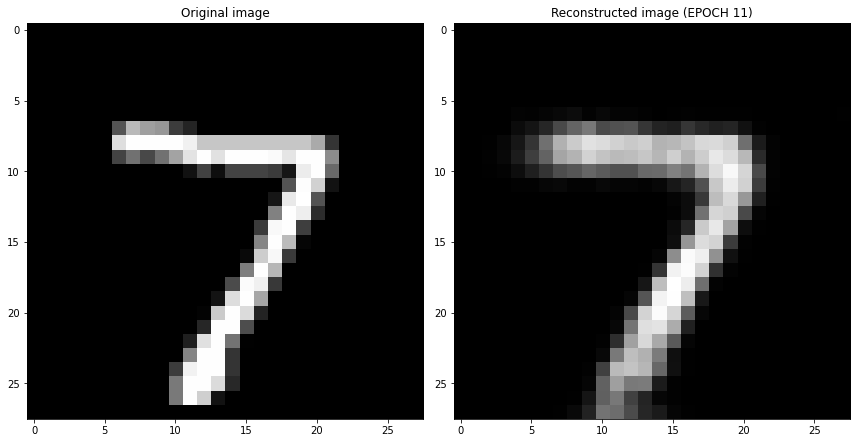

EPOCH 12/30
	 partial train loss (single batch): 0.027816
	 partial train loss (single batch): 0.026732
	 partial train loss (single batch): 0.026560
	 partial train loss (single batch): 0.028374
	 partial train loss (single batch): 0.027636
	 partial train loss (single batch): 0.027820
	 partial train loss (single batch): 0.027020
	 partial train loss (single batch): 0.027832
	 partial train loss (single batch): 0.026022
	 partial train loss (single batch): 0.024411
	 partial train loss (single batch): 0.027310
	 partial train loss (single batch): 0.027137
	 partial train loss (single batch): 0.026539
	 partial train loss (single batch): 0.027614
	 partial train loss (single batch): 0.027770
	 partial train loss (single batch): 0.028267
	 partial train loss (single batch): 0.026785
	 partial train loss (single batch): 0.025263
	 partial train loss (single batch): 0.027493
	 partial train loss (single batch): 0.026495
	 partial train loss (single batch): 0.025756
	 partial train loss (

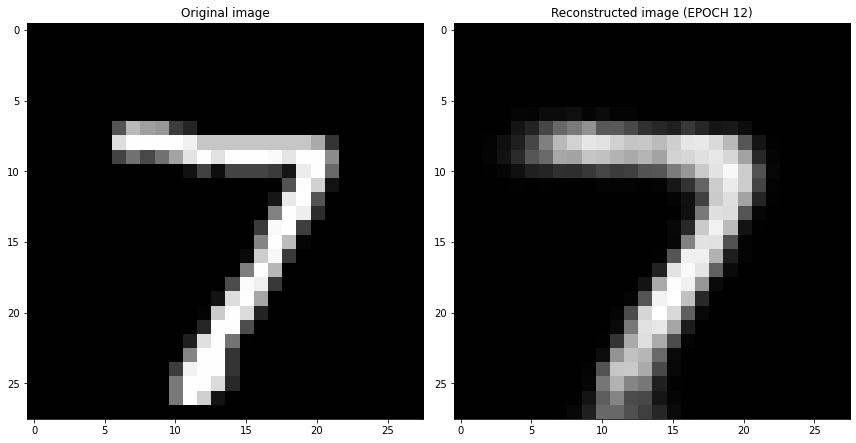

EPOCH 13/30
	 partial train loss (single batch): 0.027683
	 partial train loss (single batch): 0.026255
	 partial train loss (single batch): 0.026436
	 partial train loss (single batch): 0.025376
	 partial train loss (single batch): 0.026782
	 partial train loss (single batch): 0.025669
	 partial train loss (single batch): 0.027082
	 partial train loss (single batch): 0.026019
	 partial train loss (single batch): 0.028100
	 partial train loss (single batch): 0.027299
	 partial train loss (single batch): 0.024897
	 partial train loss (single batch): 0.026372
	 partial train loss (single batch): 0.026120
	 partial train loss (single batch): 0.025022
	 partial train loss (single batch): 0.025523
	 partial train loss (single batch): 0.025747
	 partial train loss (single batch): 0.025989
	 partial train loss (single batch): 0.025107
	 partial train loss (single batch): 0.024807
	 partial train loss (single batch): 0.027250
	 partial train loss (single batch): 0.024753
	 partial train loss (

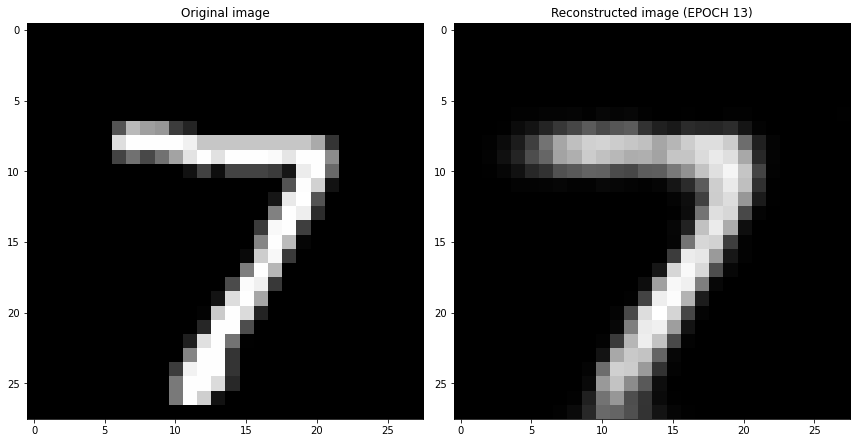

EPOCH 14/30
	 partial train loss (single batch): 0.027567
	 partial train loss (single batch): 0.025241
	 partial train loss (single batch): 0.025971
	 partial train loss (single batch): 0.026124
	 partial train loss (single batch): 0.026068
	 partial train loss (single batch): 0.025686
	 partial train loss (single batch): 0.026864
	 partial train loss (single batch): 0.027338
	 partial train loss (single batch): 0.026416
	 partial train loss (single batch): 0.024416
	 partial train loss (single batch): 0.026644
	 partial train loss (single batch): 0.026448
	 partial train loss (single batch): 0.023956
	 partial train loss (single batch): 0.025970
	 partial train loss (single batch): 0.027078
	 partial train loss (single batch): 0.026493
	 partial train loss (single batch): 0.026338
	 partial train loss (single batch): 0.025067
	 partial train loss (single batch): 0.028425
	 partial train loss (single batch): 0.026063
	 partial train loss (single batch): 0.025964
	 partial train loss (

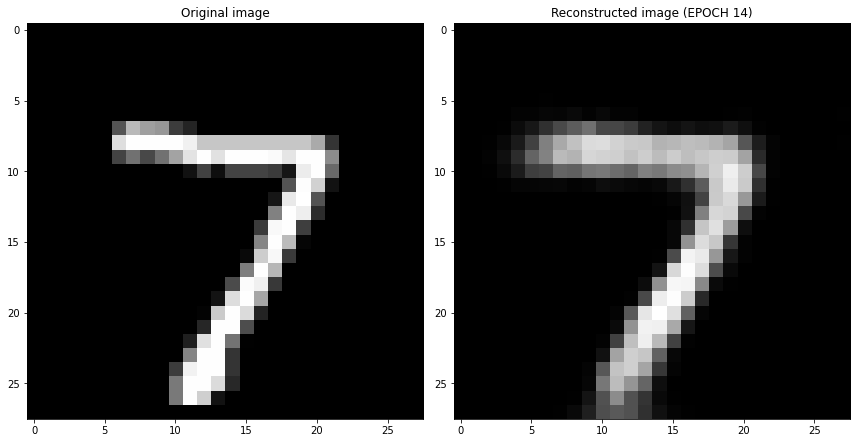

EPOCH 15/30
	 partial train loss (single batch): 0.025922
	 partial train loss (single batch): 0.026277
	 partial train loss (single batch): 0.024668
	 partial train loss (single batch): 0.024872
	 partial train loss (single batch): 0.025811
	 partial train loss (single batch): 0.024647
	 partial train loss (single batch): 0.025962
	 partial train loss (single batch): 0.025168
	 partial train loss (single batch): 0.024535
	 partial train loss (single batch): 0.024732
	 partial train loss (single batch): 0.025579
	 partial train loss (single batch): 0.025785
	 partial train loss (single batch): 0.025426
	 partial train loss (single batch): 0.026813
	 partial train loss (single batch): 0.024467
	 partial train loss (single batch): 0.025636
	 partial train loss (single batch): 0.024769
	 partial train loss (single batch): 0.025131
	 partial train loss (single batch): 0.024460
	 partial train loss (single batch): 0.025402
	 partial train loss (single batch): 0.025073
	 partial train loss (

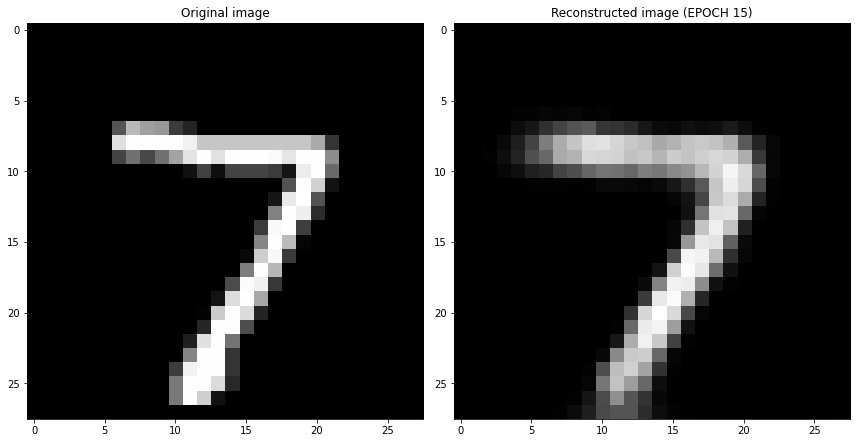

EPOCH 16/30
	 partial train loss (single batch): 0.024507
	 partial train loss (single batch): 0.025558
	 partial train loss (single batch): 0.023232
	 partial train loss (single batch): 0.025181
	 partial train loss (single batch): 0.024565
	 partial train loss (single batch): 0.025191
	 partial train loss (single batch): 0.025275
	 partial train loss (single batch): 0.026362
	 partial train loss (single batch): 0.025263
	 partial train loss (single batch): 0.024059
	 partial train loss (single batch): 0.024778
	 partial train loss (single batch): 0.024370
	 partial train loss (single batch): 0.025831
	 partial train loss (single batch): 0.025411
	 partial train loss (single batch): 0.025369
	 partial train loss (single batch): 0.025355
	 partial train loss (single batch): 0.024273
	 partial train loss (single batch): 0.023312
	 partial train loss (single batch): 0.024068
	 partial train loss (single batch): 0.025367
	 partial train loss (single batch): 0.025501
	 partial train loss (

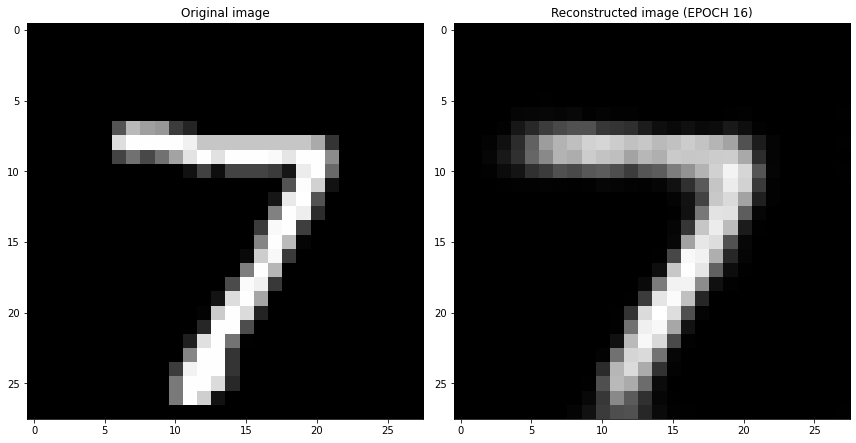

EPOCH 17/30
	 partial train loss (single batch): 0.024030
	 partial train loss (single batch): 0.024821
	 partial train loss (single batch): 0.023024
	 partial train loss (single batch): 0.025515
	 partial train loss (single batch): 0.025213
	 partial train loss (single batch): 0.022980
	 partial train loss (single batch): 0.024338
	 partial train loss (single batch): 0.025774
	 partial train loss (single batch): 0.023713
	 partial train loss (single batch): 0.024825
	 partial train loss (single batch): 0.024041
	 partial train loss (single batch): 0.025519
	 partial train loss (single batch): 0.025376
	 partial train loss (single batch): 0.023808
	 partial train loss (single batch): 0.023194
	 partial train loss (single batch): 0.024530
	 partial train loss (single batch): 0.023879
	 partial train loss (single batch): 0.024683
	 partial train loss (single batch): 0.023781
	 partial train loss (single batch): 0.023455
	 partial train loss (single batch): 0.025328
	 partial train loss (

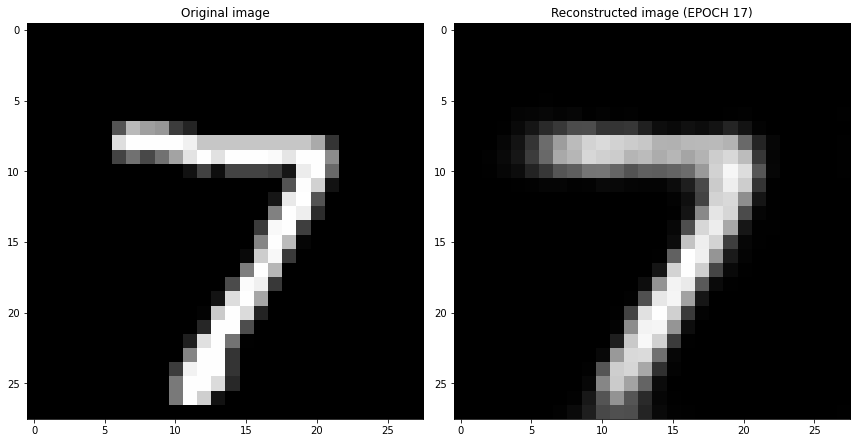

EPOCH 18/30
	 partial train loss (single batch): 0.022794
	 partial train loss (single batch): 0.023968
	 partial train loss (single batch): 0.023602
	 partial train loss (single batch): 0.023919
	 partial train loss (single batch): 0.024157
	 partial train loss (single batch): 0.025410
	 partial train loss (single batch): 0.023578
	 partial train loss (single batch): 0.023279
	 partial train loss (single batch): 0.022658
	 partial train loss (single batch): 0.024863
	 partial train loss (single batch): 0.023363
	 partial train loss (single batch): 0.023523
	 partial train loss (single batch): 0.024780
	 partial train loss (single batch): 0.025464
	 partial train loss (single batch): 0.025020
	 partial train loss (single batch): 0.023496
	 partial train loss (single batch): 0.022863
	 partial train loss (single batch): 0.024983
	 partial train loss (single batch): 0.024840
	 partial train loss (single batch): 0.025851
	 partial train loss (single batch): 0.023847
	 partial train loss (

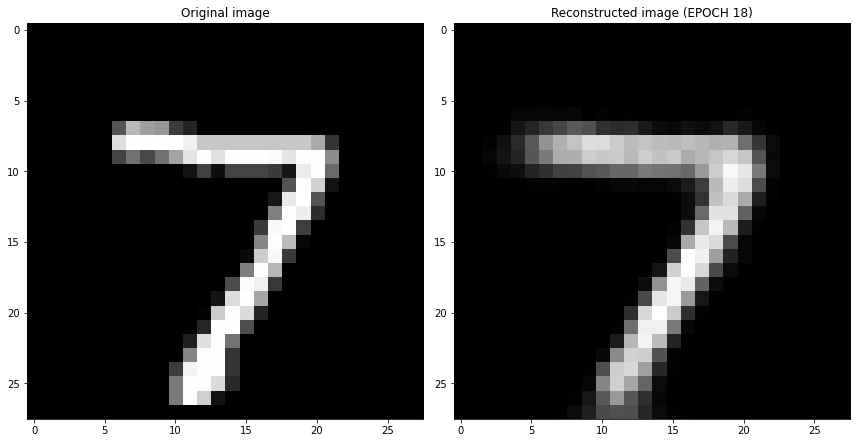

EPOCH 19/30
	 partial train loss (single batch): 0.024375
	 partial train loss (single batch): 0.025689
	 partial train loss (single batch): 0.024453
	 partial train loss (single batch): 0.024010
	 partial train loss (single batch): 0.023134
	 partial train loss (single batch): 0.023447
	 partial train loss (single batch): 0.025219
	 partial train loss (single batch): 0.025273
	 partial train loss (single batch): 0.023551
	 partial train loss (single batch): 0.024616
	 partial train loss (single batch): 0.024384
	 partial train loss (single batch): 0.023998
	 partial train loss (single batch): 0.024563
	 partial train loss (single batch): 0.024192
	 partial train loss (single batch): 0.023407
	 partial train loss (single batch): 0.023582
	 partial train loss (single batch): 0.023005
	 partial train loss (single batch): 0.025656
	 partial train loss (single batch): 0.023454
	 partial train loss (single batch): 0.025499
	 partial train loss (single batch): 0.022326
	 partial train loss (

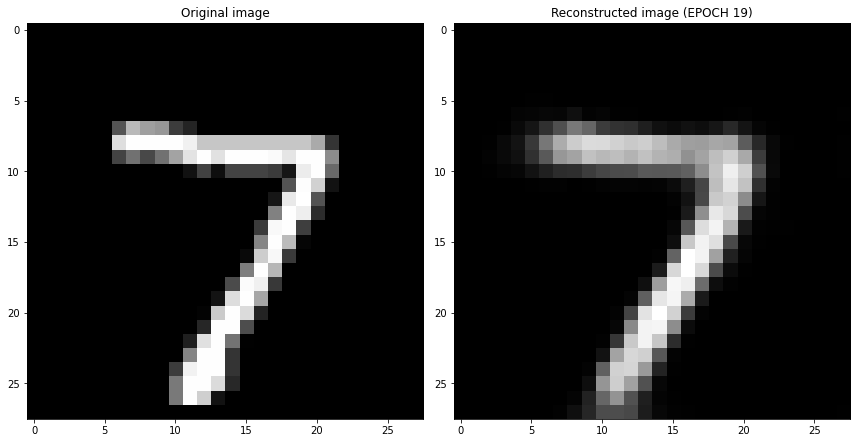

EPOCH 20/30
	 partial train loss (single batch): 0.023179
	 partial train loss (single batch): 0.023395
	 partial train loss (single batch): 0.023516
	 partial train loss (single batch): 0.024276
	 partial train loss (single batch): 0.024338
	 partial train loss (single batch): 0.023823
	 partial train loss (single batch): 0.023835
	 partial train loss (single batch): 0.024121
	 partial train loss (single batch): 0.024627
	 partial train loss (single batch): 0.025016
	 partial train loss (single batch): 0.023438
	 partial train loss (single batch): 0.023234
	 partial train loss (single batch): 0.024348
	 partial train loss (single batch): 0.024044
	 partial train loss (single batch): 0.024698
	 partial train loss (single batch): 0.024428
	 partial train loss (single batch): 0.022401
	 partial train loss (single batch): 0.025063
	 partial train loss (single batch): 0.023292
	 partial train loss (single batch): 0.024404
	 partial train loss (single batch): 0.022473
	 partial train loss (

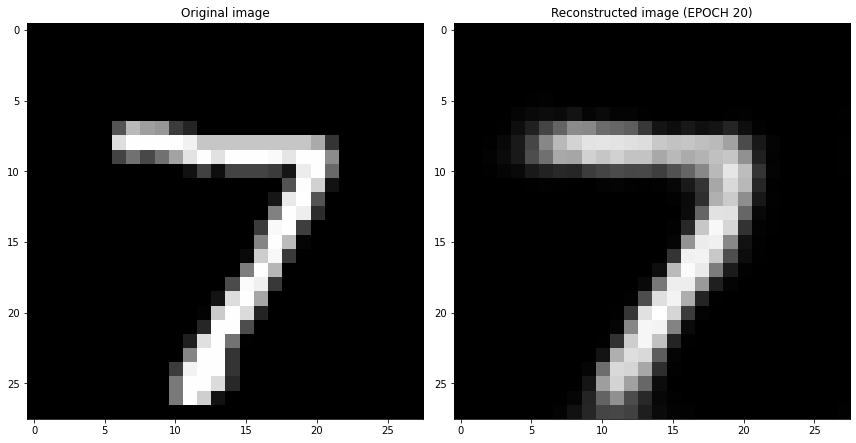

EPOCH 21/30
	 partial train loss (single batch): 0.023242
	 partial train loss (single batch): 0.022393
	 partial train loss (single batch): 0.022802
	 partial train loss (single batch): 0.022941
	 partial train loss (single batch): 0.024562
	 partial train loss (single batch): 0.025431
	 partial train loss (single batch): 0.022936
	 partial train loss (single batch): 0.024032
	 partial train loss (single batch): 0.023682
	 partial train loss (single batch): 0.023820
	 partial train loss (single batch): 0.023308
	 partial train loss (single batch): 0.024582
	 partial train loss (single batch): 0.024207
	 partial train loss (single batch): 0.023516
	 partial train loss (single batch): 0.024541
	 partial train loss (single batch): 0.023283
	 partial train loss (single batch): 0.024753
	 partial train loss (single batch): 0.024190
	 partial train loss (single batch): 0.022703
	 partial train loss (single batch): 0.022811
	 partial train loss (single batch): 0.024398
	 partial train loss (

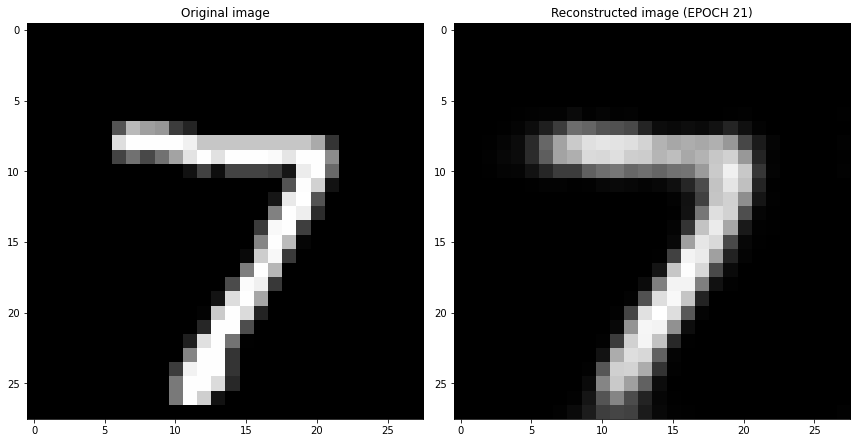

EPOCH 22/30
	 partial train loss (single batch): 0.022798
	 partial train loss (single batch): 0.023754
	 partial train loss (single batch): 0.022708
	 partial train loss (single batch): 0.022799
	 partial train loss (single batch): 0.024541
	 partial train loss (single batch): 0.022280
	 partial train loss (single batch): 0.023718
	 partial train loss (single batch): 0.024197
	 partial train loss (single batch): 0.022805
	 partial train loss (single batch): 0.023090
	 partial train loss (single batch): 0.022481
	 partial train loss (single batch): 0.024131
	 partial train loss (single batch): 0.023994
	 partial train loss (single batch): 0.024116
	 partial train loss (single batch): 0.025362
	 partial train loss (single batch): 0.024186
	 partial train loss (single batch): 0.023670
	 partial train loss (single batch): 0.023537
	 partial train loss (single batch): 0.022541
	 partial train loss (single batch): 0.024607
	 partial train loss (single batch): 0.022630
	 partial train loss (

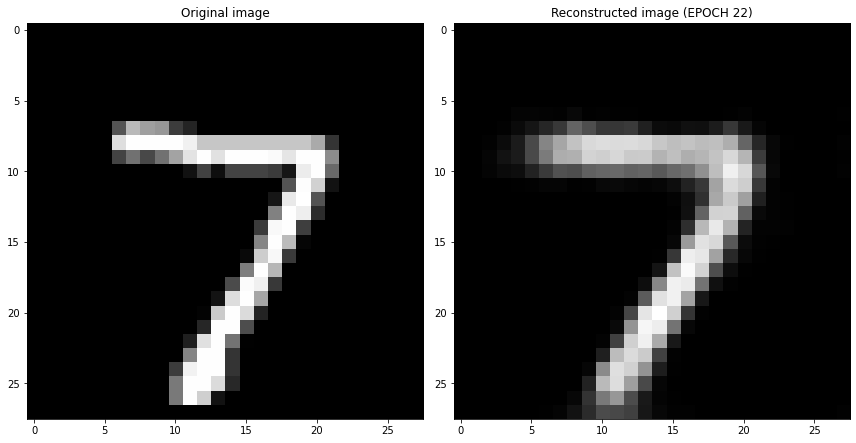

EPOCH 23/30
	 partial train loss (single batch): 0.024354
	 partial train loss (single batch): 0.023317
	 partial train loss (single batch): 0.023616
	 partial train loss (single batch): 0.024665
	 partial train loss (single batch): 0.023206
	 partial train loss (single batch): 0.022123
	 partial train loss (single batch): 0.023171
	 partial train loss (single batch): 0.023443
	 partial train loss (single batch): 0.023200
	 partial train loss (single batch): 0.022831
	 partial train loss (single batch): 0.026764
	 partial train loss (single batch): 0.023846
	 partial train loss (single batch): 0.022541
	 partial train loss (single batch): 0.023313
	 partial train loss (single batch): 0.023371
	 partial train loss (single batch): 0.024053
	 partial train loss (single batch): 0.021645
	 partial train loss (single batch): 0.023074
	 partial train loss (single batch): 0.023585
	 partial train loss (single batch): 0.023516
	 partial train loss (single batch): 0.023133
	 partial train loss (

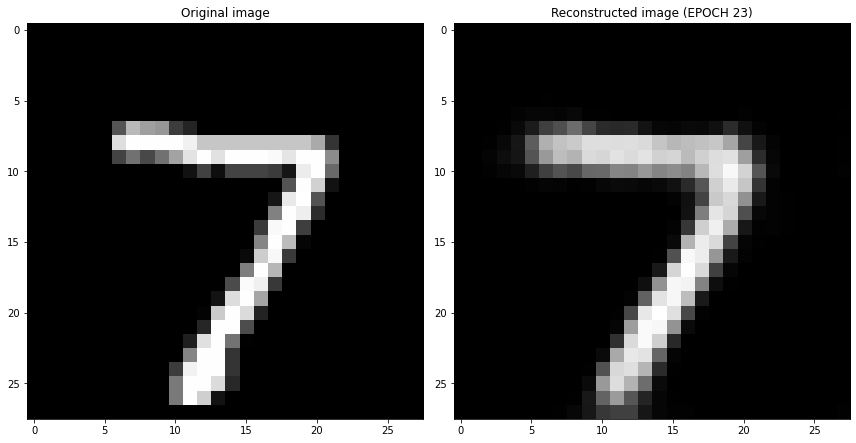

EPOCH 24/30
	 partial train loss (single batch): 0.023949
	 partial train loss (single batch): 0.023648
	 partial train loss (single batch): 0.023046
	 partial train loss (single batch): 0.022818
	 partial train loss (single batch): 0.022107
	 partial train loss (single batch): 0.021677
	 partial train loss (single batch): 0.021940
	 partial train loss (single batch): 0.023460
	 partial train loss (single batch): 0.022936
	 partial train loss (single batch): 0.022354
	 partial train loss (single batch): 0.024701
	 partial train loss (single batch): 0.024790
	 partial train loss (single batch): 0.024559
	 partial train loss (single batch): 0.024908
	 partial train loss (single batch): 0.022997
	 partial train loss (single batch): 0.022643
	 partial train loss (single batch): 0.022870
	 partial train loss (single batch): 0.023576
	 partial train loss (single batch): 0.022976
	 partial train loss (single batch): 0.021962
	 partial train loss (single batch): 0.024092
	 partial train loss (

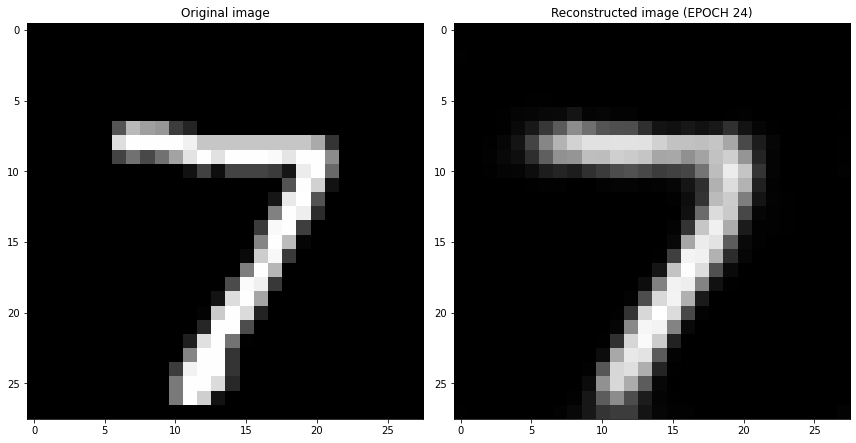

EPOCH 25/30
	 partial train loss (single batch): 0.021226
	 partial train loss (single batch): 0.023738
	 partial train loss (single batch): 0.022841
	 partial train loss (single batch): 0.023400
	 partial train loss (single batch): 0.023242
	 partial train loss (single batch): 0.021613
	 partial train loss (single batch): 0.022993
	 partial train loss (single batch): 0.022866
	 partial train loss (single batch): 0.022105
	 partial train loss (single batch): 0.023210
	 partial train loss (single batch): 0.021549
	 partial train loss (single batch): 0.022684
	 partial train loss (single batch): 0.023450
	 partial train loss (single batch): 0.021966
	 partial train loss (single batch): 0.022917
	 partial train loss (single batch): 0.023163
	 partial train loss (single batch): 0.023334
	 partial train loss (single batch): 0.023780
	 partial train loss (single batch): 0.024011
	 partial train loss (single batch): 0.022199
	 partial train loss (single batch): 0.023005
	 partial train loss (

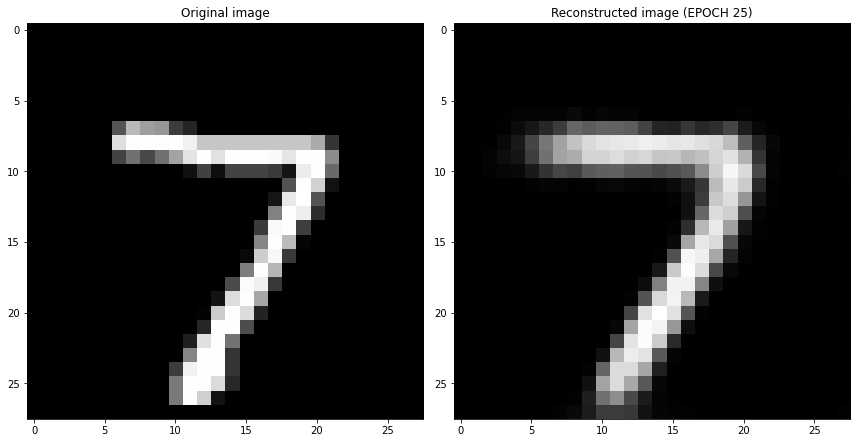

EPOCH 26/30
	 partial train loss (single batch): 0.021443
	 partial train loss (single batch): 0.023409
	 partial train loss (single batch): 0.024180
	 partial train loss (single batch): 0.023117
	 partial train loss (single batch): 0.023246
	 partial train loss (single batch): 0.022267
	 partial train loss (single batch): 0.022900
	 partial train loss (single batch): 0.023232
	 partial train loss (single batch): 0.023335
	 partial train loss (single batch): 0.021910
	 partial train loss (single batch): 0.023050
	 partial train loss (single batch): 0.022012
	 partial train loss (single batch): 0.022635
	 partial train loss (single batch): 0.024658
	 partial train loss (single batch): 0.023439
	 partial train loss (single batch): 0.022302
	 partial train loss (single batch): 0.022660
	 partial train loss (single batch): 0.024499
	 partial train loss (single batch): 0.024106
	 partial train loss (single batch): 0.022791
	 partial train loss (single batch): 0.023732
	 partial train loss (

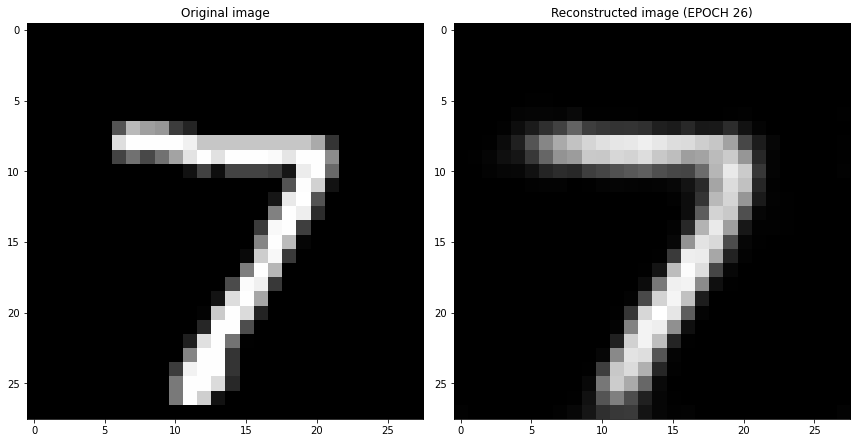

EPOCH 27/30
	 partial train loss (single batch): 0.024258
	 partial train loss (single batch): 0.022877
	 partial train loss (single batch): 0.023266
	 partial train loss (single batch): 0.023175
	 partial train loss (single batch): 0.022441
	 partial train loss (single batch): 0.022117
	 partial train loss (single batch): 0.022455
	 partial train loss (single batch): 0.022466
	 partial train loss (single batch): 0.023622
	 partial train loss (single batch): 0.022624
	 partial train loss (single batch): 0.023608
	 partial train loss (single batch): 0.022891
	 partial train loss (single batch): 0.021819
	 partial train loss (single batch): 0.021782
	 partial train loss (single batch): 0.024019
	 partial train loss (single batch): 0.023912
	 partial train loss (single batch): 0.022239
	 partial train loss (single batch): 0.022026
	 partial train loss (single batch): 0.022287
	 partial train loss (single batch): 0.023326
	 partial train loss (single batch): 0.022409
	 partial train loss (

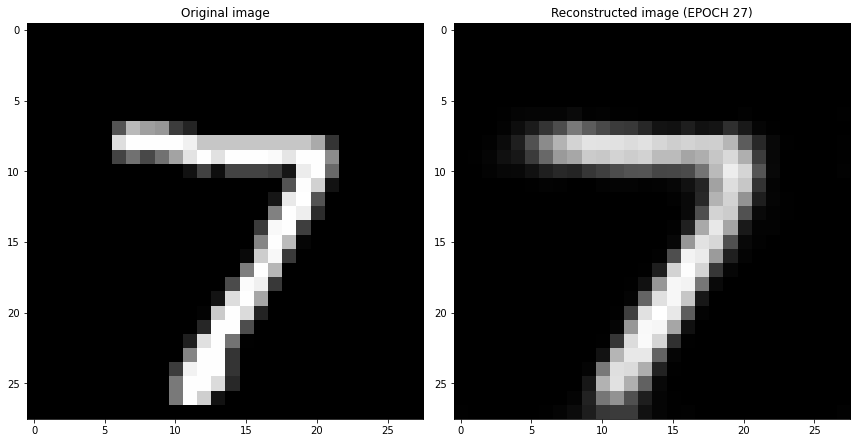

EPOCH 28/30
	 partial train loss (single batch): 0.023260
	 partial train loss (single batch): 0.023498
	 partial train loss (single batch): 0.021966
	 partial train loss (single batch): 0.022896
	 partial train loss (single batch): 0.023956
	 partial train loss (single batch): 0.022879
	 partial train loss (single batch): 0.022089
	 partial train loss (single batch): 0.023624
	 partial train loss (single batch): 0.022068
	 partial train loss (single batch): 0.023092
	 partial train loss (single batch): 0.022827
	 partial train loss (single batch): 0.022461
	 partial train loss (single batch): 0.022622
	 partial train loss (single batch): 0.023010
	 partial train loss (single batch): 0.022377
	 partial train loss (single batch): 0.022834
	 partial train loss (single batch): 0.022497
	 partial train loss (single batch): 0.022548
	 partial train loss (single batch): 0.022267
	 partial train loss (single batch): 0.022633
	 partial train loss (single batch): 0.023056
	 partial train loss (

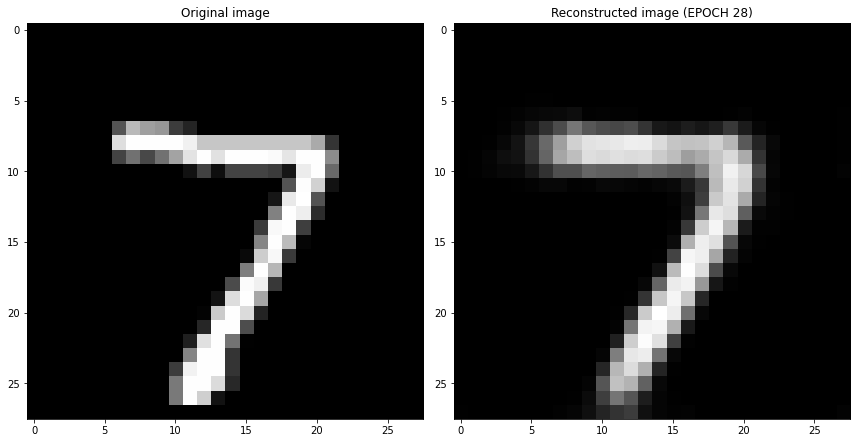

EPOCH 29/30
	 partial train loss (single batch): 0.021649
	 partial train loss (single batch): 0.023268
	 partial train loss (single batch): 0.022366
	 partial train loss (single batch): 0.022430
	 partial train loss (single batch): 0.022859
	 partial train loss (single batch): 0.022175
	 partial train loss (single batch): 0.021597
	 partial train loss (single batch): 0.022629
	 partial train loss (single batch): 0.023040
	 partial train loss (single batch): 0.021637
	 partial train loss (single batch): 0.023229
	 partial train loss (single batch): 0.022136
	 partial train loss (single batch): 0.023420
	 partial train loss (single batch): 0.022131
	 partial train loss (single batch): 0.023044
	 partial train loss (single batch): 0.022818
	 partial train loss (single batch): 0.021608
	 partial train loss (single batch): 0.022539
	 partial train loss (single batch): 0.021635
	 partial train loss (single batch): 0.022049
	 partial train loss (single batch): 0.021680
	 partial train loss (

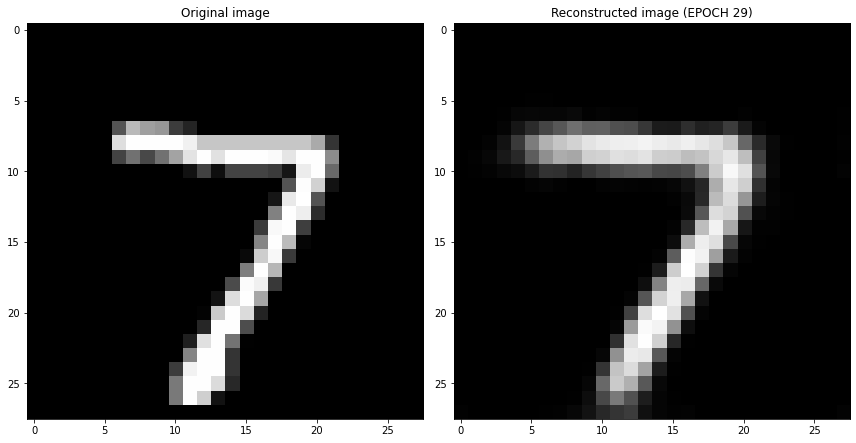

EPOCH 30/30
	 partial train loss (single batch): 0.022673
	 partial train loss (single batch): 0.023313
	 partial train loss (single batch): 0.022922
	 partial train loss (single batch): 0.024355
	 partial train loss (single batch): 0.023505
	 partial train loss (single batch): 0.022497
	 partial train loss (single batch): 0.022269
	 partial train loss (single batch): 0.022593
	 partial train loss (single batch): 0.022010
	 partial train loss (single batch): 0.023214
	 partial train loss (single batch): 0.021380
	 partial train loss (single batch): 0.022947
	 partial train loss (single batch): 0.022681
	 partial train loss (single batch): 0.022549
	 partial train loss (single batch): 0.022102
	 partial train loss (single batch): 0.022014
	 partial train loss (single batch): 0.022251
	 partial train loss (single batch): 0.021469
	 partial train loss (single batch): 0.023232
	 partial train loss (single batch): 0.022071
	 partial train loss (single batch): 0.022200
	 partial train loss (

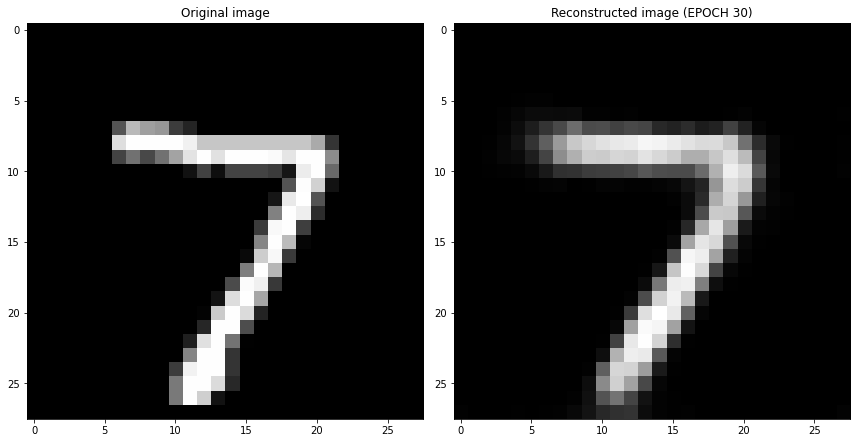

Cross validation fold number= 3/6
EPOCH 1/30
	 partial train loss (single batch): 0.251999
	 partial train loss (single batch): 0.252248
	 partial train loss (single batch): 0.250603
	 partial train loss (single batch): 0.250386
	 partial train loss (single batch): 0.249589
	 partial train loss (single batch): 0.249562
	 partial train loss (single batch): 0.248628
	 partial train loss (single batch): 0.247869
	 partial train loss (single batch): 0.246515
	 partial train loss (single batch): 0.246877
	 partial train loss (single batch): 0.245669
	 partial train loss (single batch): 0.245173
	 partial train loss (single batch): 0.243187
	 partial train loss (single batch): 0.243436
	 partial train loss (single batch): 0.242394
	 partial train loss (single batch): 0.241389
	 partial train loss (single batch): 0.241080
	 partial train loss (single batch): 0.239465
	 partial train loss (single batch): 0.238216
	 partial train loss (single batch): 0.236316
	 partial train loss (single batch)

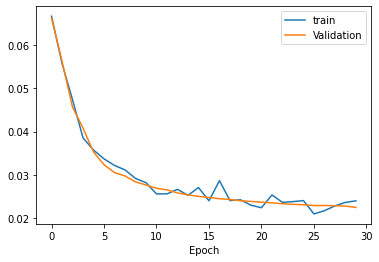

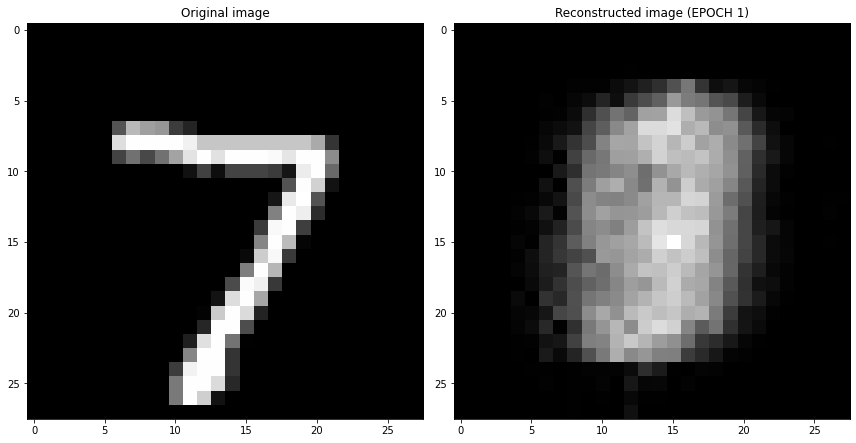

EPOCH 2/30
	 partial train loss (single batch): 0.063977
	 partial train loss (single batch): 0.064526
	 partial train loss (single batch): 0.063040
	 partial train loss (single batch): 0.062356
	 partial train loss (single batch): 0.062775
	 partial train loss (single batch): 0.064085
	 partial train loss (single batch): 0.066889
	 partial train loss (single batch): 0.065084
	 partial train loss (single batch): 0.065093
	 partial train loss (single batch): 0.066517
	 partial train loss (single batch): 0.063398
	 partial train loss (single batch): 0.063433
	 partial train loss (single batch): 0.062259
	 partial train loss (single batch): 0.064553
	 partial train loss (single batch): 0.065902
	 partial train loss (single batch): 0.063263
	 partial train loss (single batch): 0.065838
	 partial train loss (single batch): 0.064622
	 partial train loss (single batch): 0.063978
	 partial train loss (single batch): 0.063793
	 partial train loss (single batch): 0.062792
	 partial train loss (s

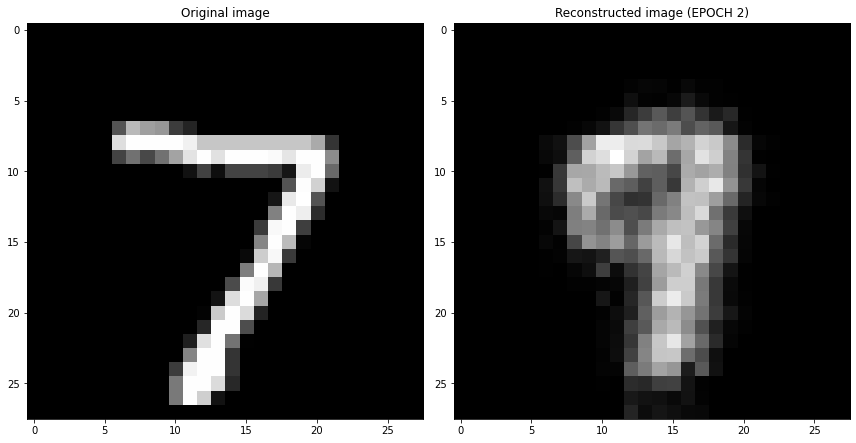

EPOCH 3/30
	 partial train loss (single batch): 0.050034
	 partial train loss (single batch): 0.048894
	 partial train loss (single batch): 0.051157
	 partial train loss (single batch): 0.050399
	 partial train loss (single batch): 0.051194
	 partial train loss (single batch): 0.048682
	 partial train loss (single batch): 0.050486
	 partial train loss (single batch): 0.050058
	 partial train loss (single batch): 0.050349
	 partial train loss (single batch): 0.048629
	 partial train loss (single batch): 0.048040
	 partial train loss (single batch): 0.048396
	 partial train loss (single batch): 0.050318
	 partial train loss (single batch): 0.050499
	 partial train loss (single batch): 0.048861
	 partial train loss (single batch): 0.048263
	 partial train loss (single batch): 0.047620
	 partial train loss (single batch): 0.048234
	 partial train loss (single batch): 0.050306
	 partial train loss (single batch): 0.048422
	 partial train loss (single batch): 0.049147
	 partial train loss (s

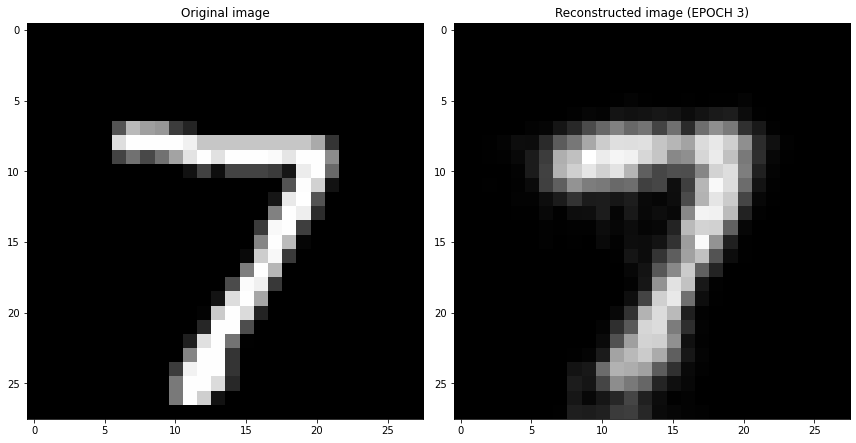

EPOCH 4/30
	 partial train loss (single batch): 0.040388
	 partial train loss (single batch): 0.038157
	 partial train loss (single batch): 0.037680
	 partial train loss (single batch): 0.038322
	 partial train loss (single batch): 0.039044
	 partial train loss (single batch): 0.037505
	 partial train loss (single batch): 0.039408
	 partial train loss (single batch): 0.038291
	 partial train loss (single batch): 0.038030
	 partial train loss (single batch): 0.039778
	 partial train loss (single batch): 0.036593
	 partial train loss (single batch): 0.037538
	 partial train loss (single batch): 0.035655
	 partial train loss (single batch): 0.037899
	 partial train loss (single batch): 0.036454
	 partial train loss (single batch): 0.036935
	 partial train loss (single batch): 0.036527
	 partial train loss (single batch): 0.038506
	 partial train loss (single batch): 0.038629
	 partial train loss (single batch): 0.036094
	 partial train loss (single batch): 0.036335
	 partial train loss (s

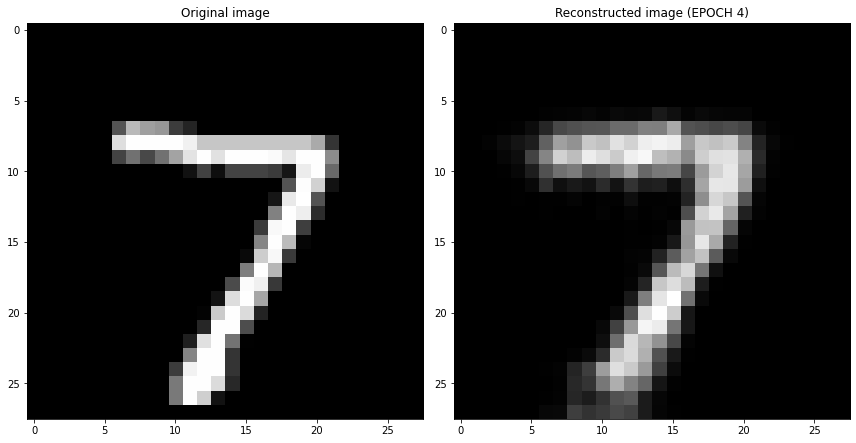

EPOCH 5/30
	 partial train loss (single batch): 0.033697
	 partial train loss (single batch): 0.034248
	 partial train loss (single batch): 0.033033
	 partial train loss (single batch): 0.034458
	 partial train loss (single batch): 0.033033
	 partial train loss (single batch): 0.032971
	 partial train loss (single batch): 0.034149
	 partial train loss (single batch): 0.033248
	 partial train loss (single batch): 0.035118
	 partial train loss (single batch): 0.034615
	 partial train loss (single batch): 0.031570
	 partial train loss (single batch): 0.034610
	 partial train loss (single batch): 0.033274
	 partial train loss (single batch): 0.033141
	 partial train loss (single batch): 0.032960
	 partial train loss (single batch): 0.032633
	 partial train loss (single batch): 0.033168
	 partial train loss (single batch): 0.033084
	 partial train loss (single batch): 0.032849
	 partial train loss (single batch): 0.033632
	 partial train loss (single batch): 0.034617
	 partial train loss (s

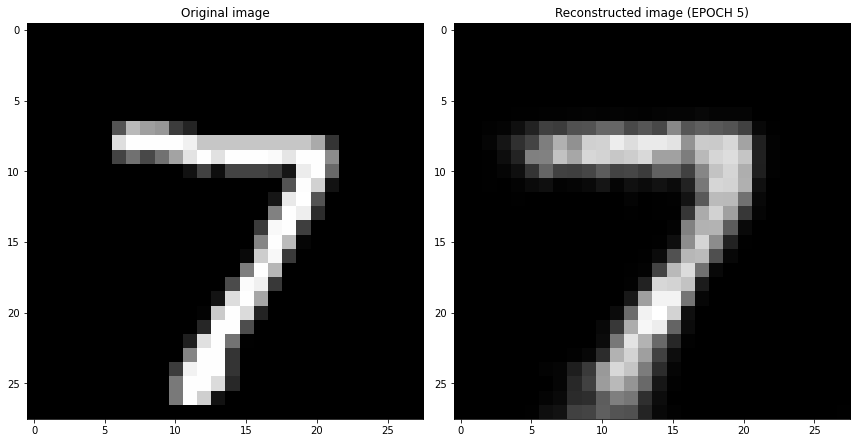

EPOCH 6/30
	 partial train loss (single batch): 0.031437
	 partial train loss (single batch): 0.031170
	 partial train loss (single batch): 0.031174
	 partial train loss (single batch): 0.032298
	 partial train loss (single batch): 0.031616
	 partial train loss (single batch): 0.031197
	 partial train loss (single batch): 0.030274
	 partial train loss (single batch): 0.033186
	 partial train loss (single batch): 0.032196
	 partial train loss (single batch): 0.030804
	 partial train loss (single batch): 0.033762
	 partial train loss (single batch): 0.030612
	 partial train loss (single batch): 0.032918
	 partial train loss (single batch): 0.031332
	 partial train loss (single batch): 0.031420
	 partial train loss (single batch): 0.031532
	 partial train loss (single batch): 0.031890
	 partial train loss (single batch): 0.030921
	 partial train loss (single batch): 0.031096
	 partial train loss (single batch): 0.030333
	 partial train loss (single batch): 0.031017
	 partial train loss (s

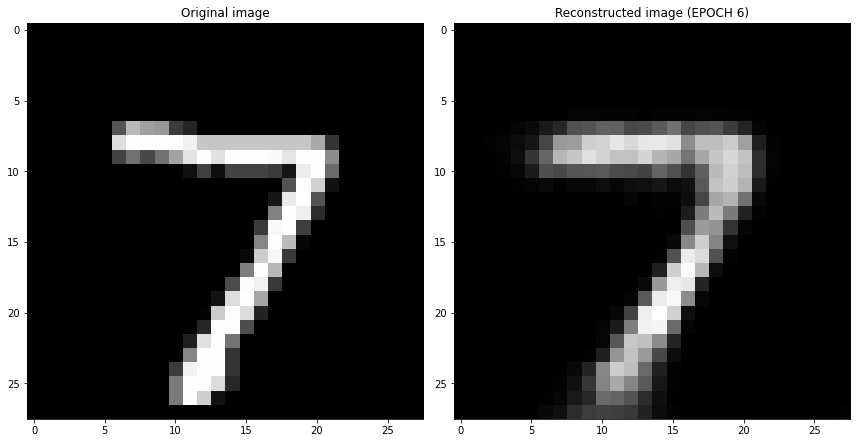

EPOCH 7/30
	 partial train loss (single batch): 0.031130
	 partial train loss (single batch): 0.030004
	 partial train loss (single batch): 0.029397
	 partial train loss (single batch): 0.029447
	 partial train loss (single batch): 0.030937
	 partial train loss (single batch): 0.029169
	 partial train loss (single batch): 0.029399
	 partial train loss (single batch): 0.029851
	 partial train loss (single batch): 0.030955
	 partial train loss (single batch): 0.027371
	 partial train loss (single batch): 0.029397
	 partial train loss (single batch): 0.029313
	 partial train loss (single batch): 0.029653
	 partial train loss (single batch): 0.028959
	 partial train loss (single batch): 0.031417
	 partial train loss (single batch): 0.028969
	 partial train loss (single batch): 0.029138
	 partial train loss (single batch): 0.029645
	 partial train loss (single batch): 0.029730
	 partial train loss (single batch): 0.029849
	 partial train loss (single batch): 0.029543
	 partial train loss (s

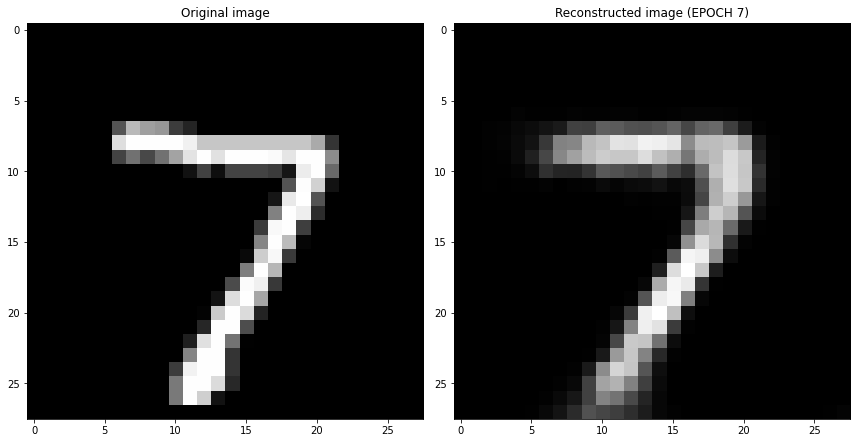

EPOCH 8/30
	 partial train loss (single batch): 0.028956
	 partial train loss (single batch): 0.028142
	 partial train loss (single batch): 0.027679
	 partial train loss (single batch): 0.029173
	 partial train loss (single batch): 0.029374
	 partial train loss (single batch): 0.028215
	 partial train loss (single batch): 0.028106
	 partial train loss (single batch): 0.029739
	 partial train loss (single batch): 0.028820
	 partial train loss (single batch): 0.029012
	 partial train loss (single batch): 0.028723
	 partial train loss (single batch): 0.028654
	 partial train loss (single batch): 0.029259
	 partial train loss (single batch): 0.028549
	 partial train loss (single batch): 0.026932
	 partial train loss (single batch): 0.029739
	 partial train loss (single batch): 0.028114
	 partial train loss (single batch): 0.029553
	 partial train loss (single batch): 0.029499
	 partial train loss (single batch): 0.028628
	 partial train loss (single batch): 0.028881
	 partial train loss (s

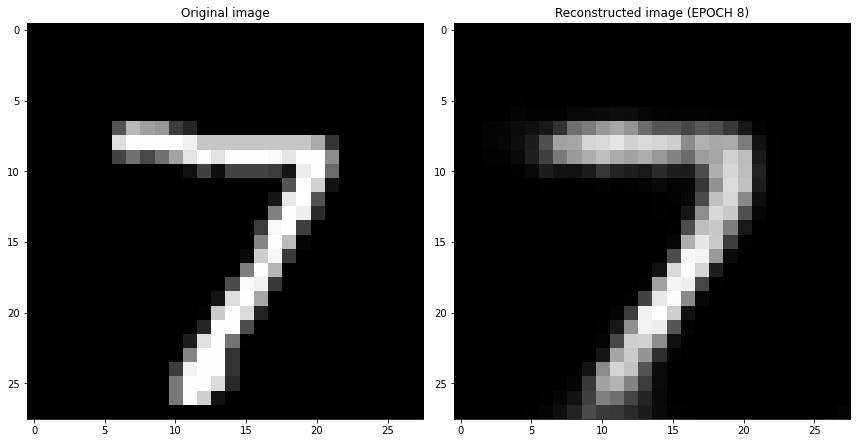

EPOCH 9/30
	 partial train loss (single batch): 0.027823
	 partial train loss (single batch): 0.029586
	 partial train loss (single batch): 0.027968
	 partial train loss (single batch): 0.028174
	 partial train loss (single batch): 0.028628
	 partial train loss (single batch): 0.027998
	 partial train loss (single batch): 0.027880
	 partial train loss (single batch): 0.029589
	 partial train loss (single batch): 0.028216
	 partial train loss (single batch): 0.027639
	 partial train loss (single batch): 0.027615
	 partial train loss (single batch): 0.028519
	 partial train loss (single batch): 0.027185
	 partial train loss (single batch): 0.026418
	 partial train loss (single batch): 0.027191
	 partial train loss (single batch): 0.026888
	 partial train loss (single batch): 0.028831
	 partial train loss (single batch): 0.027549
	 partial train loss (single batch): 0.027275
	 partial train loss (single batch): 0.027484
	 partial train loss (single batch): 0.029039
	 partial train loss (s

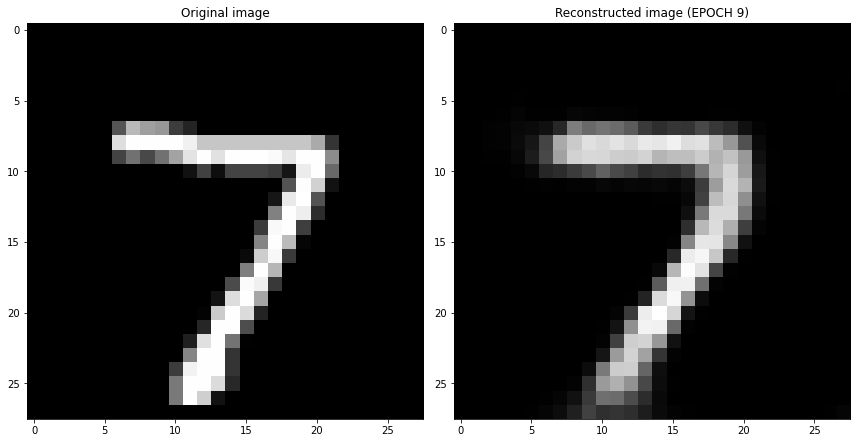

EPOCH 10/30
	 partial train loss (single batch): 0.027380
	 partial train loss (single batch): 0.026562
	 partial train loss (single batch): 0.026907
	 partial train loss (single batch): 0.027064
	 partial train loss (single batch): 0.027893
	 partial train loss (single batch): 0.027257
	 partial train loss (single batch): 0.028051
	 partial train loss (single batch): 0.025945
	 partial train loss (single batch): 0.027191
	 partial train loss (single batch): 0.028282
	 partial train loss (single batch): 0.025882
	 partial train loss (single batch): 0.027144
	 partial train loss (single batch): 0.027807
	 partial train loss (single batch): 0.027887
	 partial train loss (single batch): 0.027349
	 partial train loss (single batch): 0.028100
	 partial train loss (single batch): 0.026438
	 partial train loss (single batch): 0.027918
	 partial train loss (single batch): 0.028266
	 partial train loss (single batch): 0.027144
	 partial train loss (single batch): 0.026445
	 partial train loss (

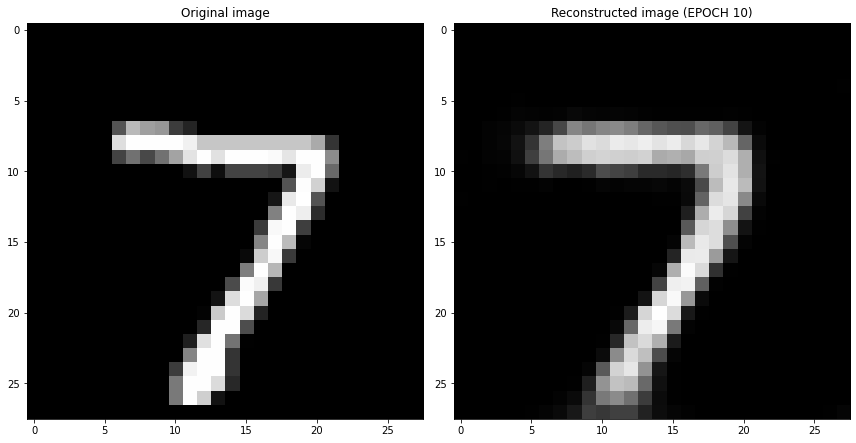

EPOCH 11/30
	 partial train loss (single batch): 0.026641
	 partial train loss (single batch): 0.027020
	 partial train loss (single batch): 0.027288
	 partial train loss (single batch): 0.026315
	 partial train loss (single batch): 0.026938
	 partial train loss (single batch): 0.026354
	 partial train loss (single batch): 0.025785
	 partial train loss (single batch): 0.026832
	 partial train loss (single batch): 0.025745
	 partial train loss (single batch): 0.028393
	 partial train loss (single batch): 0.026485
	 partial train loss (single batch): 0.025974
	 partial train loss (single batch): 0.027996
	 partial train loss (single batch): 0.027400
	 partial train loss (single batch): 0.026858
	 partial train loss (single batch): 0.026844
	 partial train loss (single batch): 0.026066
	 partial train loss (single batch): 0.025649
	 partial train loss (single batch): 0.026366
	 partial train loss (single batch): 0.024620
	 partial train loss (single batch): 0.026770
	 partial train loss (

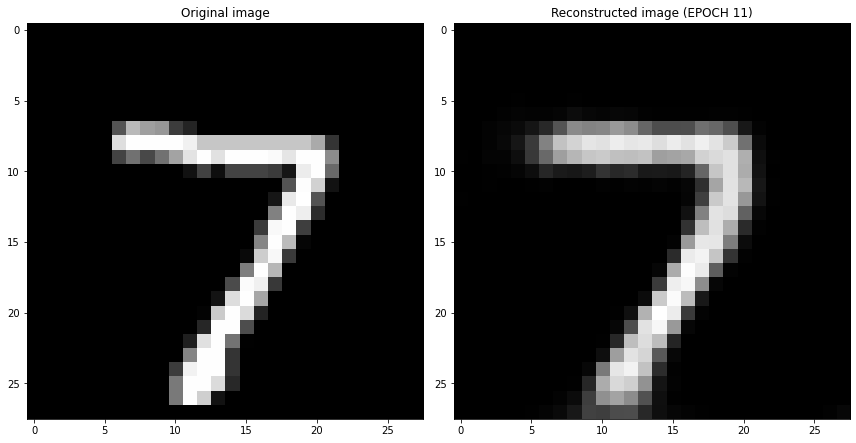

EPOCH 12/30
	 partial train loss (single batch): 0.027259
	 partial train loss (single batch): 0.025397
	 partial train loss (single batch): 0.025649
	 partial train loss (single batch): 0.026331
	 partial train loss (single batch): 0.025631
	 partial train loss (single batch): 0.026239
	 partial train loss (single batch): 0.026838
	 partial train loss (single batch): 0.025897
	 partial train loss (single batch): 0.025607
	 partial train loss (single batch): 0.026096
	 partial train loss (single batch): 0.025422
	 partial train loss (single batch): 0.026811
	 partial train loss (single batch): 0.026264
	 partial train loss (single batch): 0.026371
	 partial train loss (single batch): 0.027188
	 partial train loss (single batch): 0.026421
	 partial train loss (single batch): 0.025673
	 partial train loss (single batch): 0.026257
	 partial train loss (single batch): 0.025856
	 partial train loss (single batch): 0.025863
	 partial train loss (single batch): 0.027851
	 partial train loss (

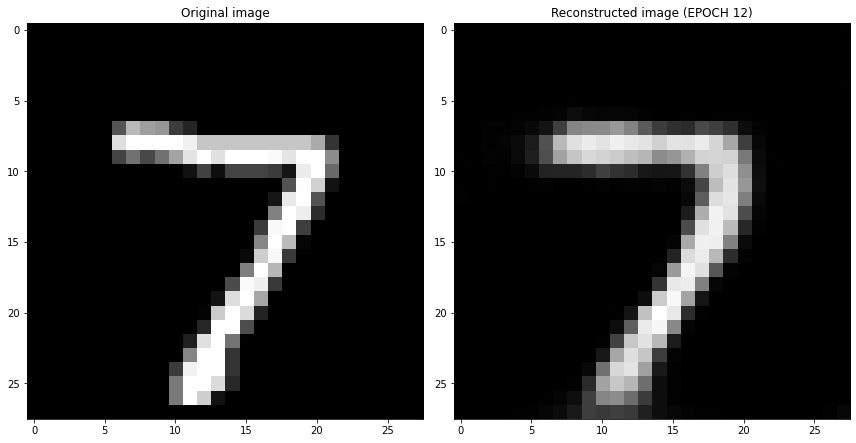

EPOCH 13/30
	 partial train loss (single batch): 0.026661
	 partial train loss (single batch): 0.026507
	 partial train loss (single batch): 0.027583
	 partial train loss (single batch): 0.025179
	 partial train loss (single batch): 0.026473
	 partial train loss (single batch): 0.026006
	 partial train loss (single batch): 0.025176
	 partial train loss (single batch): 0.026087
	 partial train loss (single batch): 0.025885
	 partial train loss (single batch): 0.025659
	 partial train loss (single batch): 0.025314
	 partial train loss (single batch): 0.025005
	 partial train loss (single batch): 0.024256
	 partial train loss (single batch): 0.025121
	 partial train loss (single batch): 0.025732
	 partial train loss (single batch): 0.027007
	 partial train loss (single batch): 0.026566
	 partial train loss (single batch): 0.025736
	 partial train loss (single batch): 0.025798
	 partial train loss (single batch): 0.026898
	 partial train loss (single batch): 0.024953
	 partial train loss (

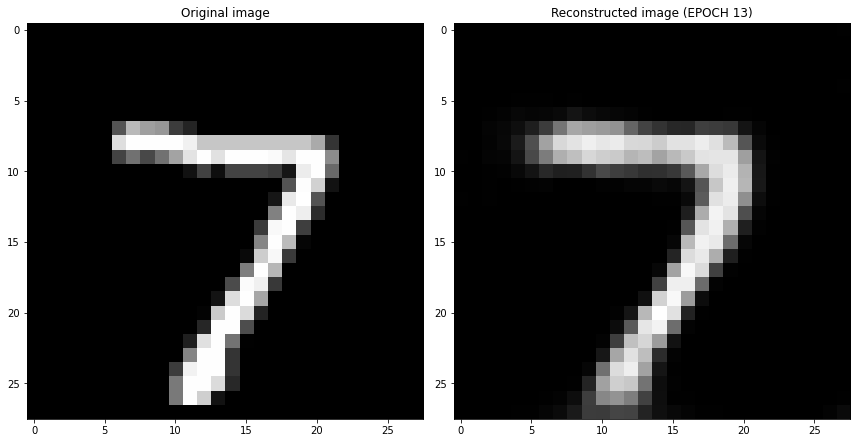

EPOCH 14/30
	 partial train loss (single batch): 0.026750
	 partial train loss (single batch): 0.025276
	 partial train loss (single batch): 0.026239
	 partial train loss (single batch): 0.025132
	 partial train loss (single batch): 0.025434
	 partial train loss (single batch): 0.024236
	 partial train loss (single batch): 0.023448
	 partial train loss (single batch): 0.024372
	 partial train loss (single batch): 0.026674
	 partial train loss (single batch): 0.026018
	 partial train loss (single batch): 0.025775
	 partial train loss (single batch): 0.024705
	 partial train loss (single batch): 0.024735
	 partial train loss (single batch): 0.024953
	 partial train loss (single batch): 0.024528
	 partial train loss (single batch): 0.024611
	 partial train loss (single batch): 0.025403
	 partial train loss (single batch): 0.024757
	 partial train loss (single batch): 0.023613
	 partial train loss (single batch): 0.024906
	 partial train loss (single batch): 0.025357
	 partial train loss (

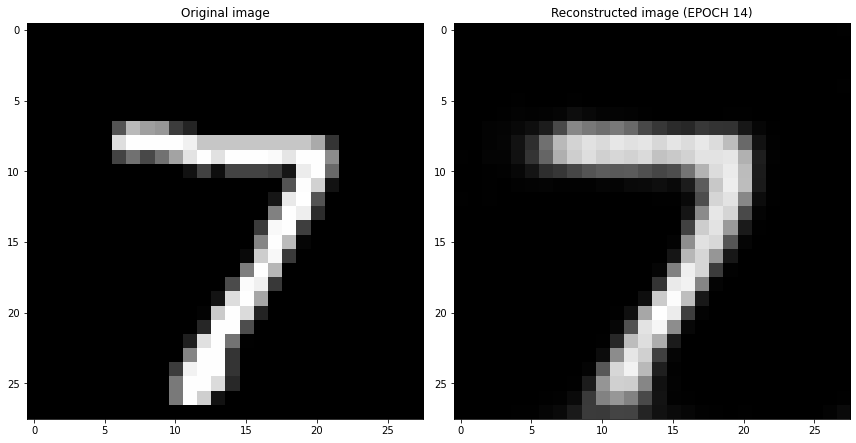

EPOCH 15/30
	 partial train loss (single batch): 0.024415
	 partial train loss (single batch): 0.024251
	 partial train loss (single batch): 0.025733
	 partial train loss (single batch): 0.022520
	 partial train loss (single batch): 0.025734
	 partial train loss (single batch): 0.023684
	 partial train loss (single batch): 0.025669
	 partial train loss (single batch): 0.024063
	 partial train loss (single batch): 0.024298
	 partial train loss (single batch): 0.025612
	 partial train loss (single batch): 0.025861
	 partial train loss (single batch): 0.025424
	 partial train loss (single batch): 0.024059
	 partial train loss (single batch): 0.025115
	 partial train loss (single batch): 0.025467
	 partial train loss (single batch): 0.026348
	 partial train loss (single batch): 0.024905
	 partial train loss (single batch): 0.024162
	 partial train loss (single batch): 0.024668
	 partial train loss (single batch): 0.024633
	 partial train loss (single batch): 0.025912
	 partial train loss (

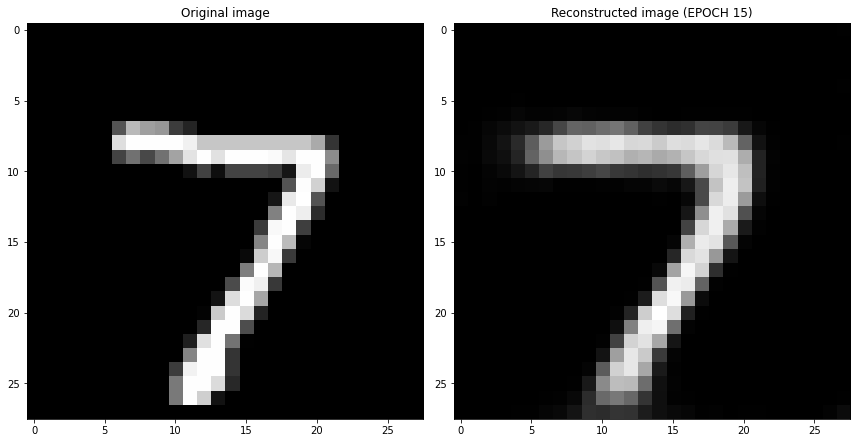

EPOCH 16/30
	 partial train loss (single batch): 0.025396
	 partial train loss (single batch): 0.024282
	 partial train loss (single batch): 0.024886
	 partial train loss (single batch): 0.024066
	 partial train loss (single batch): 0.025086
	 partial train loss (single batch): 0.025465
	 partial train loss (single batch): 0.026152
	 partial train loss (single batch): 0.024013
	 partial train loss (single batch): 0.024794
	 partial train loss (single batch): 0.024423
	 partial train loss (single batch): 0.024373
	 partial train loss (single batch): 0.024202
	 partial train loss (single batch): 0.025212
	 partial train loss (single batch): 0.023059
	 partial train loss (single batch): 0.023610
	 partial train loss (single batch): 0.023669
	 partial train loss (single batch): 0.024376
	 partial train loss (single batch): 0.025779
	 partial train loss (single batch): 0.025069
	 partial train loss (single batch): 0.025323
	 partial train loss (single batch): 0.025099
	 partial train loss (

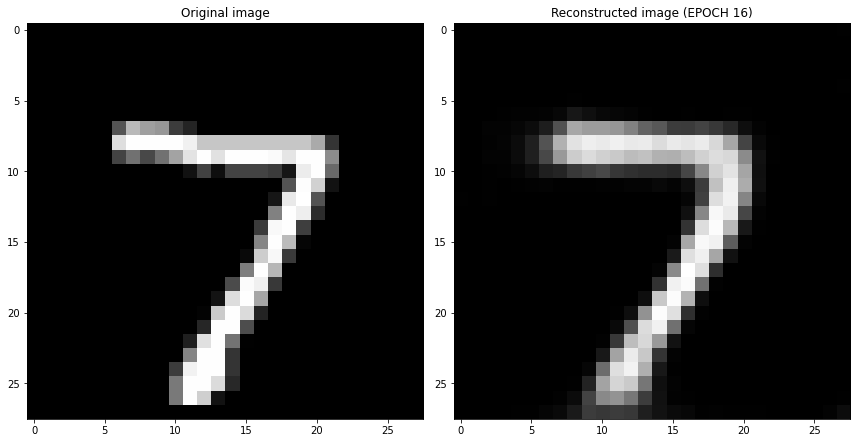

EPOCH 17/30
	 partial train loss (single batch): 0.023941
	 partial train loss (single batch): 0.023710
	 partial train loss (single batch): 0.024902
	 partial train loss (single batch): 0.023260
	 partial train loss (single batch): 0.023173
	 partial train loss (single batch): 0.024932
	 partial train loss (single batch): 0.025078
	 partial train loss (single batch): 0.026018
	 partial train loss (single batch): 0.024361
	 partial train loss (single batch): 0.022696
	 partial train loss (single batch): 0.025198
	 partial train loss (single batch): 0.024955
	 partial train loss (single batch): 0.024788
	 partial train loss (single batch): 0.023184
	 partial train loss (single batch): 0.024471
	 partial train loss (single batch): 0.025370
	 partial train loss (single batch): 0.024695
	 partial train loss (single batch): 0.024406
	 partial train loss (single batch): 0.023440
	 partial train loss (single batch): 0.025712
	 partial train loss (single batch): 0.023390
	 partial train loss (

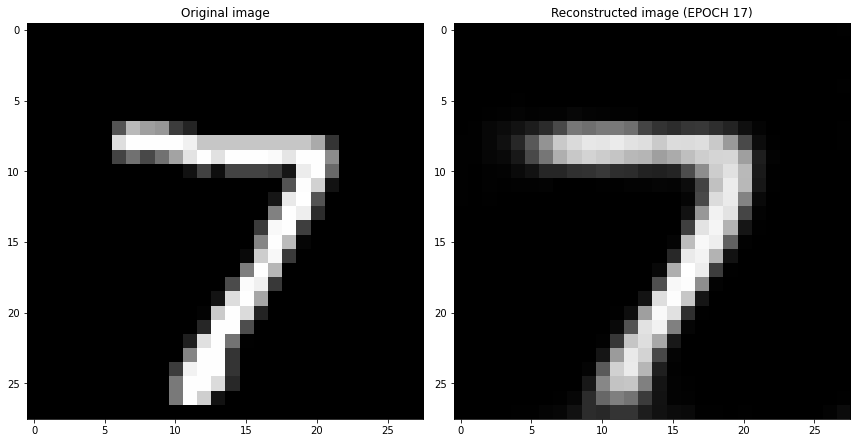

EPOCH 18/30
	 partial train loss (single batch): 0.023675
	 partial train loss (single batch): 0.022386
	 partial train loss (single batch): 0.024251
	 partial train loss (single batch): 0.024466
	 partial train loss (single batch): 0.022697
	 partial train loss (single batch): 0.024232
	 partial train loss (single batch): 0.024545
	 partial train loss (single batch): 0.024069
	 partial train loss (single batch): 0.025036
	 partial train loss (single batch): 0.024691
	 partial train loss (single batch): 0.024721
	 partial train loss (single batch): 0.025061
	 partial train loss (single batch): 0.024939
	 partial train loss (single batch): 0.024802
	 partial train loss (single batch): 0.025119
	 partial train loss (single batch): 0.025499
	 partial train loss (single batch): 0.023095
	 partial train loss (single batch): 0.024571
	 partial train loss (single batch): 0.023988
	 partial train loss (single batch): 0.023252
	 partial train loss (single batch): 0.024552
	 partial train loss (

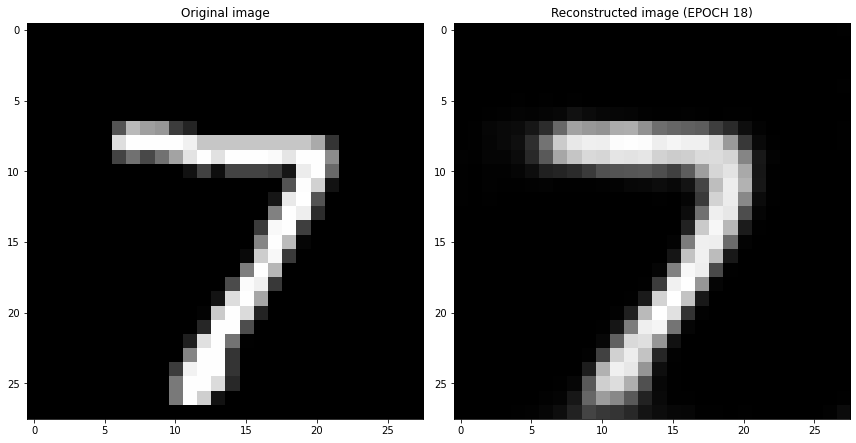

EPOCH 19/30
	 partial train loss (single batch): 0.024044
	 partial train loss (single batch): 0.023928
	 partial train loss (single batch): 0.022881
	 partial train loss (single batch): 0.024583
	 partial train loss (single batch): 0.024174
	 partial train loss (single batch): 0.024628
	 partial train loss (single batch): 0.023432
	 partial train loss (single batch): 0.023422
	 partial train loss (single batch): 0.025129
	 partial train loss (single batch): 0.022607
	 partial train loss (single batch): 0.024306
	 partial train loss (single batch): 0.024846
	 partial train loss (single batch): 0.023973
	 partial train loss (single batch): 0.023294
	 partial train loss (single batch): 0.023568
	 partial train loss (single batch): 0.022823
	 partial train loss (single batch): 0.023221
	 partial train loss (single batch): 0.023211
	 partial train loss (single batch): 0.024477
	 partial train loss (single batch): 0.023630
	 partial train loss (single batch): 0.025123
	 partial train loss (

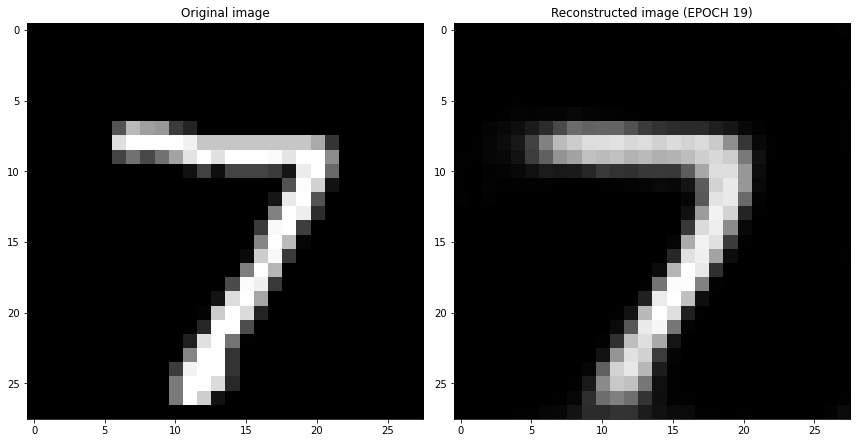

EPOCH 20/30
	 partial train loss (single batch): 0.023938
	 partial train loss (single batch): 0.023655
	 partial train loss (single batch): 0.023390
	 partial train loss (single batch): 0.023856
	 partial train loss (single batch): 0.022525
	 partial train loss (single batch): 0.024787
	 partial train loss (single batch): 0.023014
	 partial train loss (single batch): 0.022917
	 partial train loss (single batch): 0.023891
	 partial train loss (single batch): 0.023862
	 partial train loss (single batch): 0.023998
	 partial train loss (single batch): 0.022173
	 partial train loss (single batch): 0.023648
	 partial train loss (single batch): 0.023544
	 partial train loss (single batch): 0.022503
	 partial train loss (single batch): 0.023558
	 partial train loss (single batch): 0.024868
	 partial train loss (single batch): 0.024517
	 partial train loss (single batch): 0.024376
	 partial train loss (single batch): 0.024439
	 partial train loss (single batch): 0.022963
	 partial train loss (

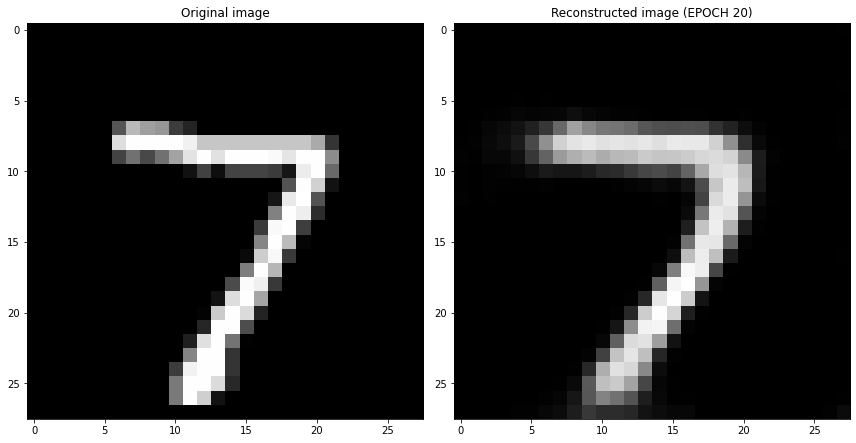

EPOCH 21/30
	 partial train loss (single batch): 0.023617
	 partial train loss (single batch): 0.024136
	 partial train loss (single batch): 0.023412
	 partial train loss (single batch): 0.024651
	 partial train loss (single batch): 0.023257
	 partial train loss (single batch): 0.023707
	 partial train loss (single batch): 0.024257
	 partial train loss (single batch): 0.023760
	 partial train loss (single batch): 0.022031
	 partial train loss (single batch): 0.023320
	 partial train loss (single batch): 0.024074
	 partial train loss (single batch): 0.023481
	 partial train loss (single batch): 0.021734
	 partial train loss (single batch): 0.023694
	 partial train loss (single batch): 0.023795
	 partial train loss (single batch): 0.022750
	 partial train loss (single batch): 0.024653
	 partial train loss (single batch): 0.023464
	 partial train loss (single batch): 0.023652
	 partial train loss (single batch): 0.023641
	 partial train loss (single batch): 0.021941
	 partial train loss (

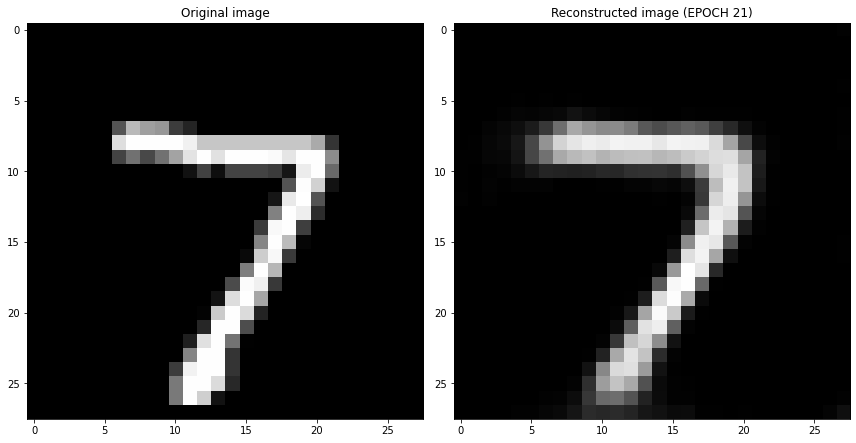

EPOCH 22/30
	 partial train loss (single batch): 0.023252
	 partial train loss (single batch): 0.022623
	 partial train loss (single batch): 0.023893
	 partial train loss (single batch): 0.023992
	 partial train loss (single batch): 0.024167
	 partial train loss (single batch): 0.023413
	 partial train loss (single batch): 0.023641
	 partial train loss (single batch): 0.023980
	 partial train loss (single batch): 0.023079
	 partial train loss (single batch): 0.025351
	 partial train loss (single batch): 0.022483
	 partial train loss (single batch): 0.023288
	 partial train loss (single batch): 0.023024
	 partial train loss (single batch): 0.023219
	 partial train loss (single batch): 0.023915
	 partial train loss (single batch): 0.023722
	 partial train loss (single batch): 0.022212
	 partial train loss (single batch): 0.023965
	 partial train loss (single batch): 0.022700
	 partial train loss (single batch): 0.022649
	 partial train loss (single batch): 0.022460
	 partial train loss (

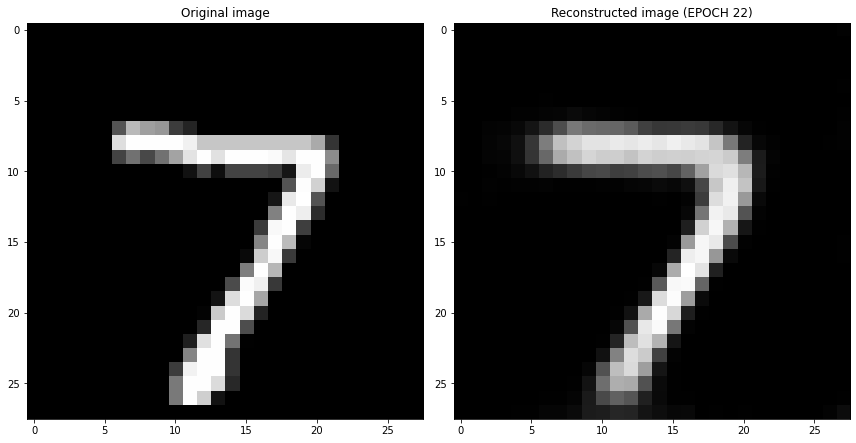

EPOCH 23/30
	 partial train loss (single batch): 0.022442
	 partial train loss (single batch): 0.022697
	 partial train loss (single batch): 0.023959
	 partial train loss (single batch): 0.022709
	 partial train loss (single batch): 0.022039
	 partial train loss (single batch): 0.023860
	 partial train loss (single batch): 0.021434
	 partial train loss (single batch): 0.023082
	 partial train loss (single batch): 0.024174
	 partial train loss (single batch): 0.022435
	 partial train loss (single batch): 0.024098
	 partial train loss (single batch): 0.023024
	 partial train loss (single batch): 0.022153
	 partial train loss (single batch): 0.023833
	 partial train loss (single batch): 0.023322
	 partial train loss (single batch): 0.022925
	 partial train loss (single batch): 0.022036
	 partial train loss (single batch): 0.024189
	 partial train loss (single batch): 0.023106
	 partial train loss (single batch): 0.022620
	 partial train loss (single batch): 0.024186
	 partial train loss (

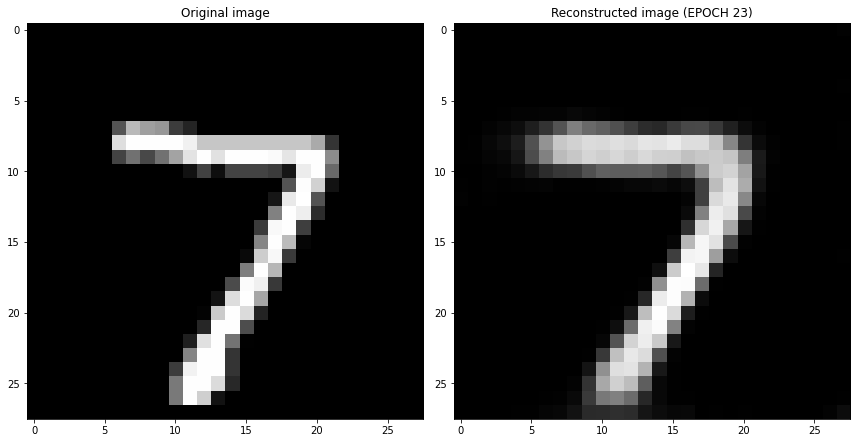

EPOCH 24/30
	 partial train loss (single batch): 0.023764
	 partial train loss (single batch): 0.023001
	 partial train loss (single batch): 0.024710
	 partial train loss (single batch): 0.022730
	 partial train loss (single batch): 0.023790
	 partial train loss (single batch): 0.024561
	 partial train loss (single batch): 0.023020
	 partial train loss (single batch): 0.021784
	 partial train loss (single batch): 0.023349
	 partial train loss (single batch): 0.022195
	 partial train loss (single batch): 0.022792
	 partial train loss (single batch): 0.022319
	 partial train loss (single batch): 0.022960
	 partial train loss (single batch): 0.024056
	 partial train loss (single batch): 0.023334
	 partial train loss (single batch): 0.024350
	 partial train loss (single batch): 0.024147
	 partial train loss (single batch): 0.022981
	 partial train loss (single batch): 0.024372
	 partial train loss (single batch): 0.025126
	 partial train loss (single batch): 0.023024
	 partial train loss (

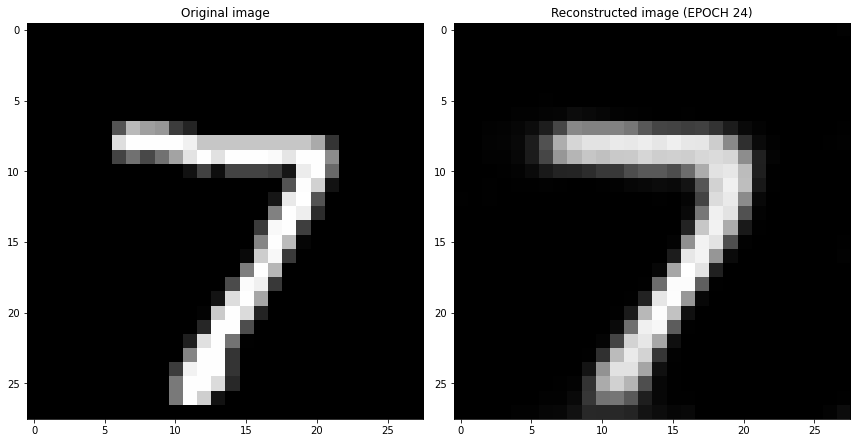

EPOCH 25/30
	 partial train loss (single batch): 0.023590
	 partial train loss (single batch): 0.023875
	 partial train loss (single batch): 0.023133
	 partial train loss (single batch): 0.023430
	 partial train loss (single batch): 0.024751
	 partial train loss (single batch): 0.022802
	 partial train loss (single batch): 0.021817
	 partial train loss (single batch): 0.021783
	 partial train loss (single batch): 0.022290
	 partial train loss (single batch): 0.023849
	 partial train loss (single batch): 0.023265
	 partial train loss (single batch): 0.021901
	 partial train loss (single batch): 0.022394
	 partial train loss (single batch): 0.023858
	 partial train loss (single batch): 0.023983
	 partial train loss (single batch): 0.023142
	 partial train loss (single batch): 0.024315
	 partial train loss (single batch): 0.022923
	 partial train loss (single batch): 0.022962
	 partial train loss (single batch): 0.023639
	 partial train loss (single batch): 0.024215
	 partial train loss (

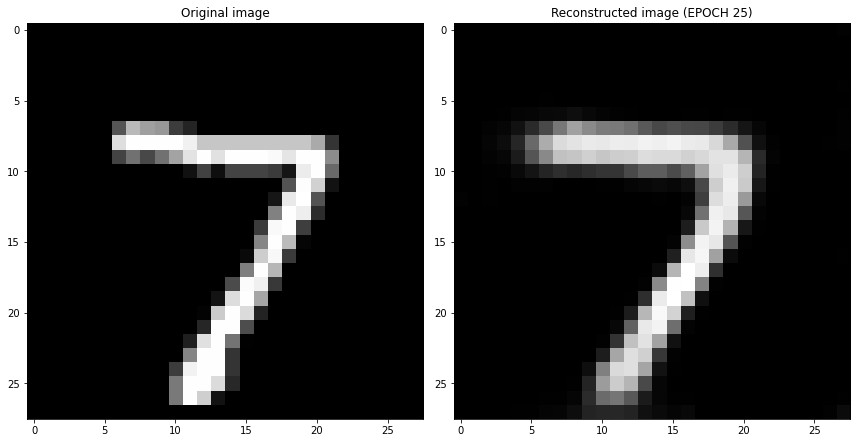

EPOCH 26/30
	 partial train loss (single batch): 0.022873
	 partial train loss (single batch): 0.023775
	 partial train loss (single batch): 0.023670
	 partial train loss (single batch): 0.023483
	 partial train loss (single batch): 0.024820
	 partial train loss (single batch): 0.022750
	 partial train loss (single batch): 0.023065
	 partial train loss (single batch): 0.023781
	 partial train loss (single batch): 0.021760
	 partial train loss (single batch): 0.022701
	 partial train loss (single batch): 0.023019
	 partial train loss (single batch): 0.023347
	 partial train loss (single batch): 0.022996
	 partial train loss (single batch): 0.023763
	 partial train loss (single batch): 0.022814
	 partial train loss (single batch): 0.022972
	 partial train loss (single batch): 0.022842
	 partial train loss (single batch): 0.023594
	 partial train loss (single batch): 0.022148
	 partial train loss (single batch): 0.023024
	 partial train loss (single batch): 0.023800
	 partial train loss (

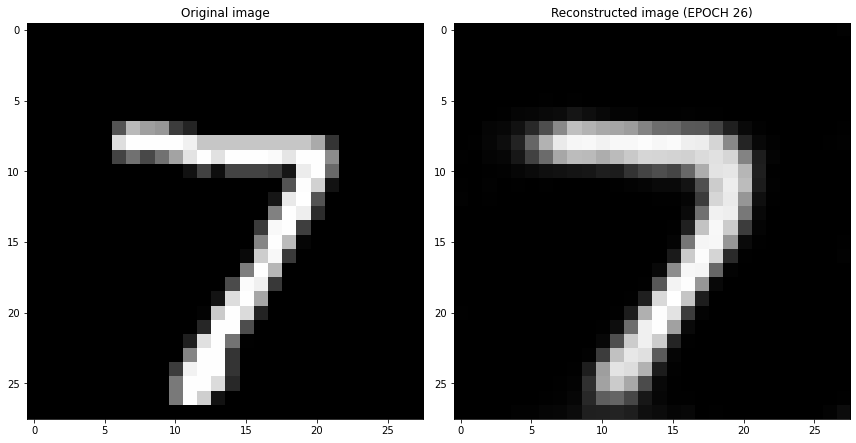

EPOCH 27/30
	 partial train loss (single batch): 0.023730
	 partial train loss (single batch): 0.022562
	 partial train loss (single batch): 0.023017
	 partial train loss (single batch): 0.023342
	 partial train loss (single batch): 0.023284
	 partial train loss (single batch): 0.022290
	 partial train loss (single batch): 0.022510
	 partial train loss (single batch): 0.023578
	 partial train loss (single batch): 0.022837
	 partial train loss (single batch): 0.022886
	 partial train loss (single batch): 0.024132
	 partial train loss (single batch): 0.023972
	 partial train loss (single batch): 0.022574
	 partial train loss (single batch): 0.022111
	 partial train loss (single batch): 0.023485
	 partial train loss (single batch): 0.023393
	 partial train loss (single batch): 0.023260
	 partial train loss (single batch): 0.022568
	 partial train loss (single batch): 0.022704
	 partial train loss (single batch): 0.022050
	 partial train loss (single batch): 0.022193
	 partial train loss (

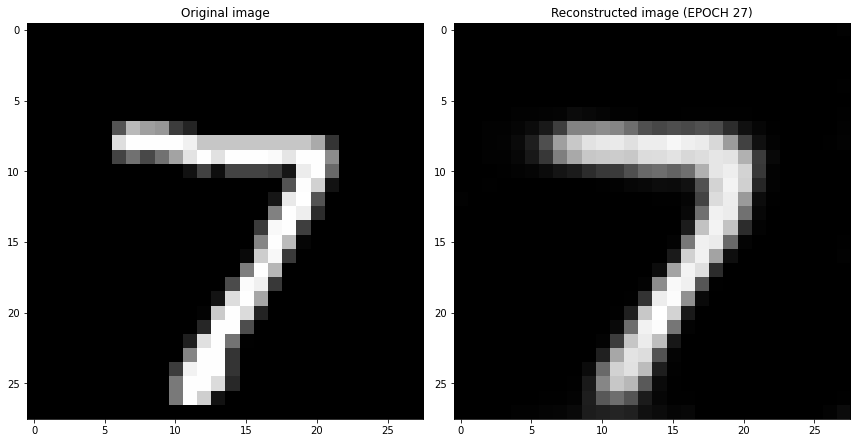

EPOCH 28/30
	 partial train loss (single batch): 0.022402
	 partial train loss (single batch): 0.022714
	 partial train loss (single batch): 0.023618
	 partial train loss (single batch): 0.024548
	 partial train loss (single batch): 0.023117
	 partial train loss (single batch): 0.022072
	 partial train loss (single batch): 0.023181
	 partial train loss (single batch): 0.021931
	 partial train loss (single batch): 0.023161
	 partial train loss (single batch): 0.022447
	 partial train loss (single batch): 0.022150
	 partial train loss (single batch): 0.022005
	 partial train loss (single batch): 0.023396
	 partial train loss (single batch): 0.022363
	 partial train loss (single batch): 0.020746
	 partial train loss (single batch): 0.020979
	 partial train loss (single batch): 0.022422
	 partial train loss (single batch): 0.024444
	 partial train loss (single batch): 0.021909
	 partial train loss (single batch): 0.021723
	 partial train loss (single batch): 0.023391
	 partial train loss (

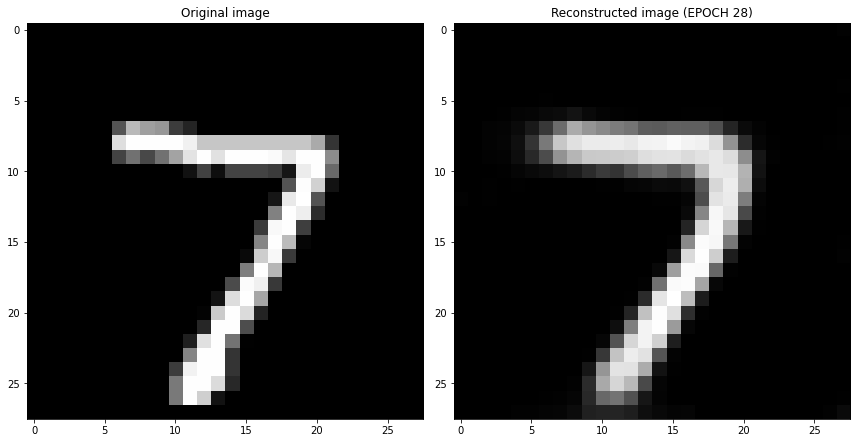

EPOCH 29/30
	 partial train loss (single batch): 0.022357
	 partial train loss (single batch): 0.023310
	 partial train loss (single batch): 0.021555
	 partial train loss (single batch): 0.021511
	 partial train loss (single batch): 0.021883
	 partial train loss (single batch): 0.021415
	 partial train loss (single batch): 0.023435
	 partial train loss (single batch): 0.022331
	 partial train loss (single batch): 0.022371
	 partial train loss (single batch): 0.023112
	 partial train loss (single batch): 0.022960
	 partial train loss (single batch): 0.022181
	 partial train loss (single batch): 0.022667
	 partial train loss (single batch): 0.021074
	 partial train loss (single batch): 0.021415
	 partial train loss (single batch): 0.021980
	 partial train loss (single batch): 0.021643
	 partial train loss (single batch): 0.022918
	 partial train loss (single batch): 0.023649
	 partial train loss (single batch): 0.023003
	 partial train loss (single batch): 0.023220
	 partial train loss (

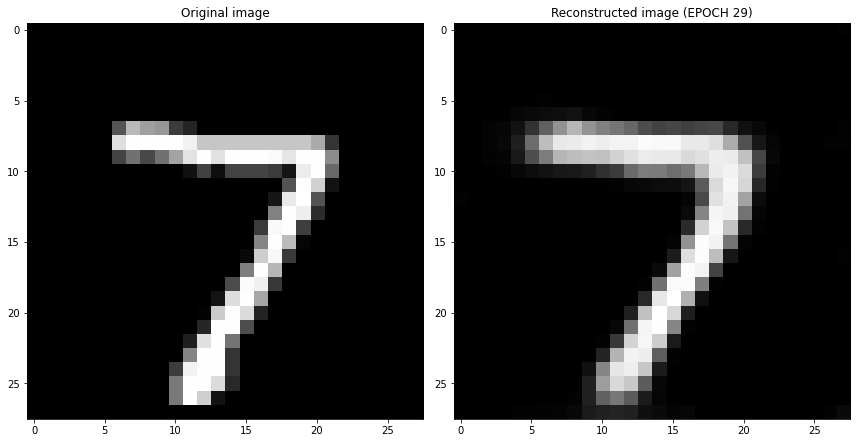

EPOCH 30/30
	 partial train loss (single batch): 0.021437
	 partial train loss (single batch): 0.024893
	 partial train loss (single batch): 0.021730
	 partial train loss (single batch): 0.021283
	 partial train loss (single batch): 0.021352
	 partial train loss (single batch): 0.022151
	 partial train loss (single batch): 0.022904
	 partial train loss (single batch): 0.022119
	 partial train loss (single batch): 0.021678
	 partial train loss (single batch): 0.022426
	 partial train loss (single batch): 0.023893
	 partial train loss (single batch): 0.024222
	 partial train loss (single batch): 0.021919
	 partial train loss (single batch): 0.022061
	 partial train loss (single batch): 0.022944
	 partial train loss (single batch): 0.022205
	 partial train loss (single batch): 0.022962
	 partial train loss (single batch): 0.022721
	 partial train loss (single batch): 0.021924
	 partial train loss (single batch): 0.022449
	 partial train loss (single batch): 0.021717
	 partial train loss (

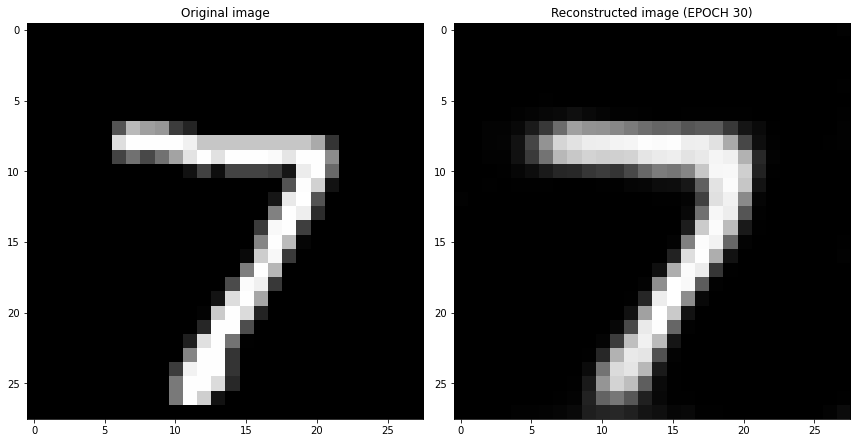

Cross validation fold number= 4/6
EPOCH 1/30
	 partial train loss (single batch): 0.183386
	 partial train loss (single batch): 0.183210
	 partial train loss (single batch): 0.182422
	 partial train loss (single batch): 0.181962
	 partial train loss (single batch): 0.181792
	 partial train loss (single batch): 0.181124
	 partial train loss (single batch): 0.181467
	 partial train loss (single batch): 0.180226
	 partial train loss (single batch): 0.180754
	 partial train loss (single batch): 0.179578
	 partial train loss (single batch): 0.179219
	 partial train loss (single batch): 0.178582
	 partial train loss (single batch): 0.177794
	 partial train loss (single batch): 0.177975
	 partial train loss (single batch): 0.176692
	 partial train loss (single batch): 0.176503
	 partial train loss (single batch): 0.174335
	 partial train loss (single batch): 0.175515
	 partial train loss (single batch): 0.173842
	 partial train loss (single batch): 0.173151
	 partial train loss (single batch)

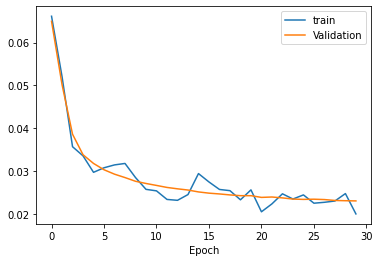

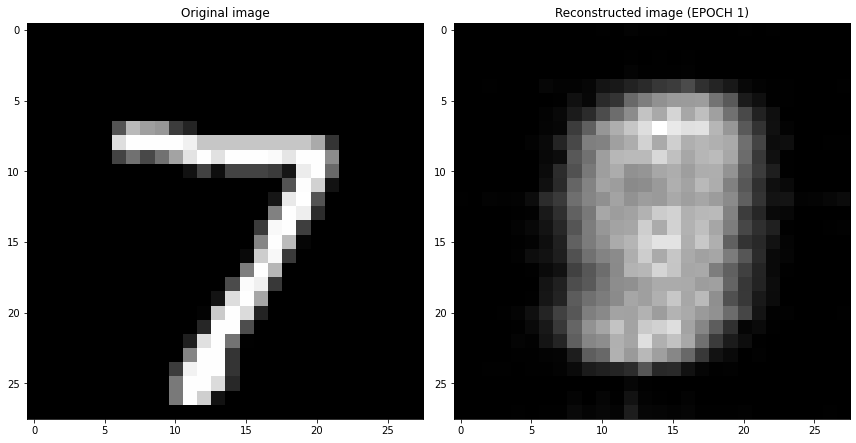

EPOCH 2/30
	 partial train loss (single batch): 0.064685
	 partial train loss (single batch): 0.061513
	 partial train loss (single batch): 0.064706
	 partial train loss (single batch): 0.064650
	 partial train loss (single batch): 0.063896
	 partial train loss (single batch): 0.064145
	 partial train loss (single batch): 0.063502
	 partial train loss (single batch): 0.064953
	 partial train loss (single batch): 0.063143
	 partial train loss (single batch): 0.064907
	 partial train loss (single batch): 0.063699
	 partial train loss (single batch): 0.062252
	 partial train loss (single batch): 0.066322
	 partial train loss (single batch): 0.063153
	 partial train loss (single batch): 0.063699
	 partial train loss (single batch): 0.062717
	 partial train loss (single batch): 0.064862
	 partial train loss (single batch): 0.063586
	 partial train loss (single batch): 0.063037
	 partial train loss (single batch): 0.064887
	 partial train loss (single batch): 0.063508
	 partial train loss (s

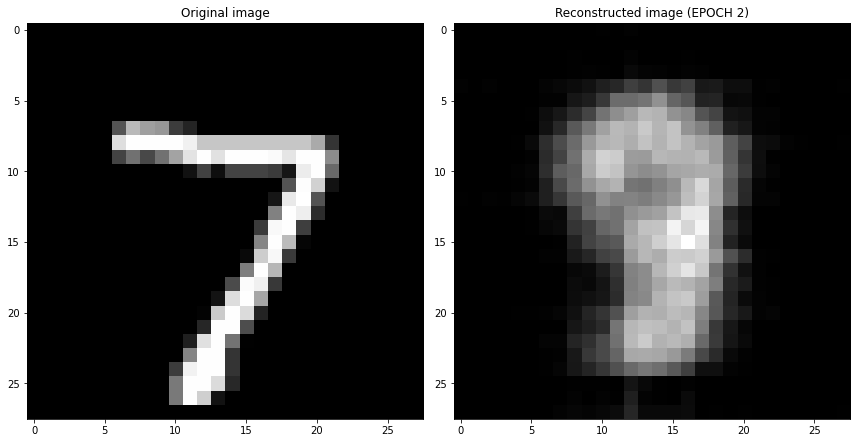

EPOCH 3/30
	 partial train loss (single batch): 0.053599
	 partial train loss (single batch): 0.053324
	 partial train loss (single batch): 0.053421
	 partial train loss (single batch): 0.053692
	 partial train loss (single batch): 0.055379
	 partial train loss (single batch): 0.053778
	 partial train loss (single batch): 0.052049
	 partial train loss (single batch): 0.053794
	 partial train loss (single batch): 0.052014
	 partial train loss (single batch): 0.052121
	 partial train loss (single batch): 0.051761
	 partial train loss (single batch): 0.052697
	 partial train loss (single batch): 0.053417
	 partial train loss (single batch): 0.052947
	 partial train loss (single batch): 0.055830
	 partial train loss (single batch): 0.053888
	 partial train loss (single batch): 0.052426
	 partial train loss (single batch): 0.053400
	 partial train loss (single batch): 0.053650
	 partial train loss (single batch): 0.049381
	 partial train loss (single batch): 0.052628
	 partial train loss (s

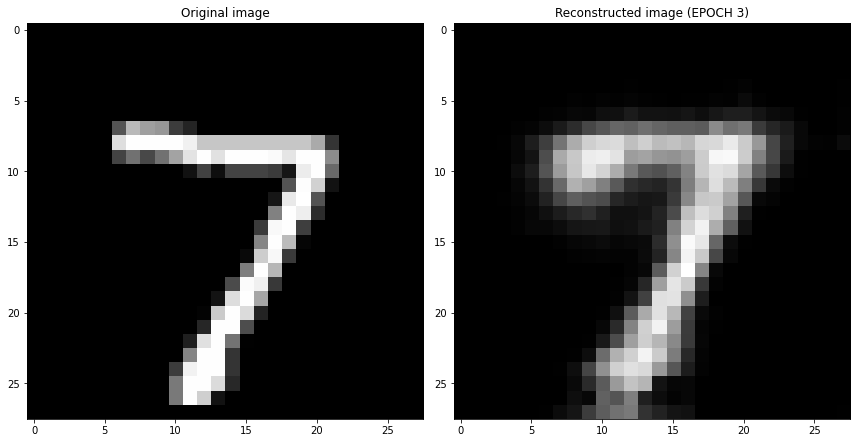

EPOCH 4/30
	 partial train loss (single batch): 0.040544
	 partial train loss (single batch): 0.040054
	 partial train loss (single batch): 0.040614
	 partial train loss (single batch): 0.039774
	 partial train loss (single batch): 0.038663
	 partial train loss (single batch): 0.039376
	 partial train loss (single batch): 0.040215
	 partial train loss (single batch): 0.037743
	 partial train loss (single batch): 0.038522
	 partial train loss (single batch): 0.040885
	 partial train loss (single batch): 0.039213
	 partial train loss (single batch): 0.040162
	 partial train loss (single batch): 0.039790
	 partial train loss (single batch): 0.041342
	 partial train loss (single batch): 0.039033
	 partial train loss (single batch): 0.040330
	 partial train loss (single batch): 0.039555
	 partial train loss (single batch): 0.039548
	 partial train loss (single batch): 0.039882
	 partial train loss (single batch): 0.038897
	 partial train loss (single batch): 0.038662
	 partial train loss (s

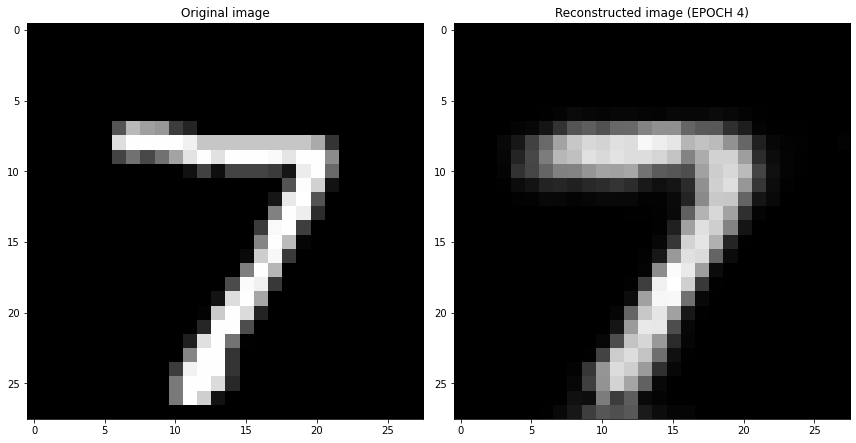

EPOCH 5/30
	 partial train loss (single batch): 0.031407
	 partial train loss (single batch): 0.031639
	 partial train loss (single batch): 0.033801
	 partial train loss (single batch): 0.031645
	 partial train loss (single batch): 0.031784
	 partial train loss (single batch): 0.032888
	 partial train loss (single batch): 0.032465
	 partial train loss (single batch): 0.034839
	 partial train loss (single batch): 0.031170
	 partial train loss (single batch): 0.032313
	 partial train loss (single batch): 0.031059
	 partial train loss (single batch): 0.031033
	 partial train loss (single batch): 0.031818
	 partial train loss (single batch): 0.032816
	 partial train loss (single batch): 0.034451
	 partial train loss (single batch): 0.032850
	 partial train loss (single batch): 0.031754
	 partial train loss (single batch): 0.032084
	 partial train loss (single batch): 0.030918
	 partial train loss (single batch): 0.031212
	 partial train loss (single batch): 0.031675
	 partial train loss (s

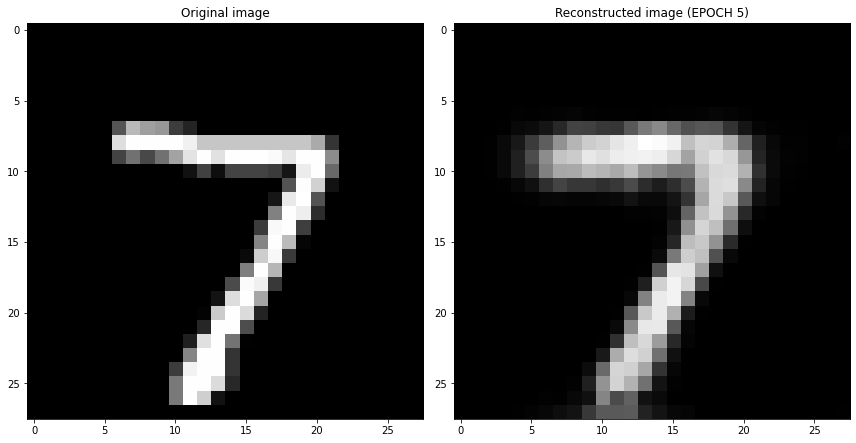

EPOCH 6/30
	 partial train loss (single batch): 0.030004
	 partial train loss (single batch): 0.029128
	 partial train loss (single batch): 0.029735
	 partial train loss (single batch): 0.030332
	 partial train loss (single batch): 0.028792
	 partial train loss (single batch): 0.030786
	 partial train loss (single batch): 0.030451
	 partial train loss (single batch): 0.029179
	 partial train loss (single batch): 0.028417
	 partial train loss (single batch): 0.028638
	 partial train loss (single batch): 0.030091
	 partial train loss (single batch): 0.030180
	 partial train loss (single batch): 0.029740
	 partial train loss (single batch): 0.029794
	 partial train loss (single batch): 0.030761
	 partial train loss (single batch): 0.029810
	 partial train loss (single batch): 0.029312
	 partial train loss (single batch): 0.030991
	 partial train loss (single batch): 0.029237
	 partial train loss (single batch): 0.028332
	 partial train loss (single batch): 0.028854
	 partial train loss (s

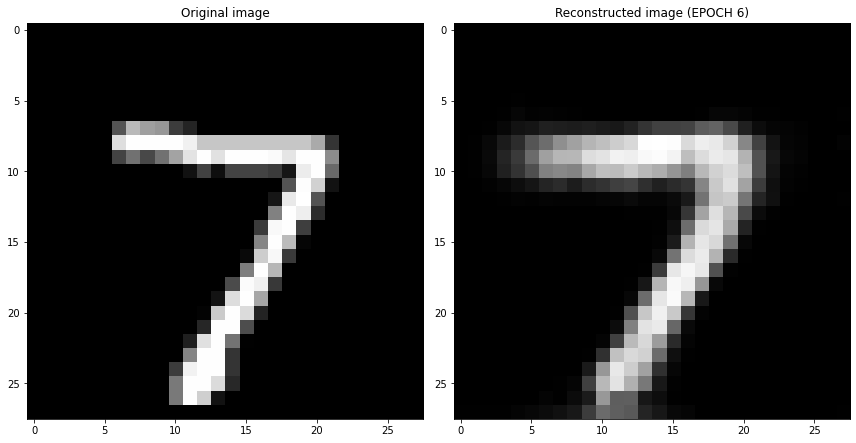

EPOCH 7/30
	 partial train loss (single batch): 0.028907
	 partial train loss (single batch): 0.029107
	 partial train loss (single batch): 0.028048
	 partial train loss (single batch): 0.029525
	 partial train loss (single batch): 0.028506
	 partial train loss (single batch): 0.027295
	 partial train loss (single batch): 0.027835
	 partial train loss (single batch): 0.030280
	 partial train loss (single batch): 0.029507
	 partial train loss (single batch): 0.026606
	 partial train loss (single batch): 0.028844
	 partial train loss (single batch): 0.026675
	 partial train loss (single batch): 0.028037
	 partial train loss (single batch): 0.028536
	 partial train loss (single batch): 0.029612
	 partial train loss (single batch): 0.025876
	 partial train loss (single batch): 0.027646
	 partial train loss (single batch): 0.028519
	 partial train loss (single batch): 0.028835
	 partial train loss (single batch): 0.027326
	 partial train loss (single batch): 0.027891
	 partial train loss (s

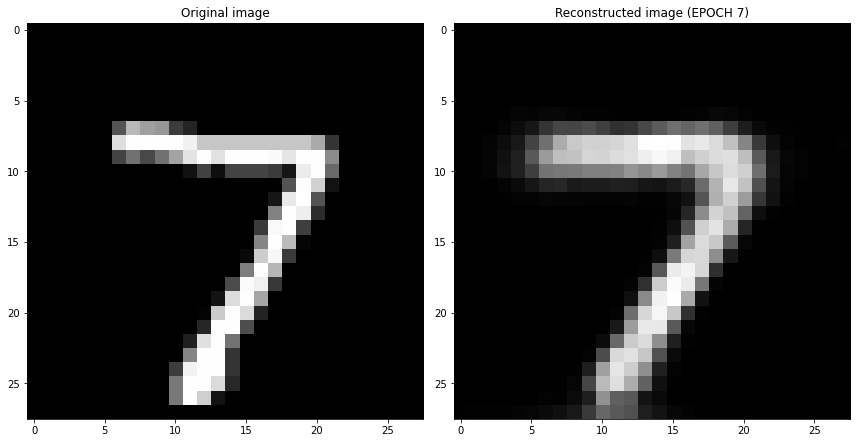

EPOCH 8/30
	 partial train loss (single batch): 0.026392
	 partial train loss (single batch): 0.028885
	 partial train loss (single batch): 0.027649
	 partial train loss (single batch): 0.027441
	 partial train loss (single batch): 0.026344
	 partial train loss (single batch): 0.028731
	 partial train loss (single batch): 0.028784
	 partial train loss (single batch): 0.027686
	 partial train loss (single batch): 0.027084
	 partial train loss (single batch): 0.027855
	 partial train loss (single batch): 0.026449
	 partial train loss (single batch): 0.027985
	 partial train loss (single batch): 0.027517
	 partial train loss (single batch): 0.028224
	 partial train loss (single batch): 0.027866
	 partial train loss (single batch): 0.027013
	 partial train loss (single batch): 0.028575
	 partial train loss (single batch): 0.026992
	 partial train loss (single batch): 0.026399
	 partial train loss (single batch): 0.027270
	 partial train loss (single batch): 0.027640
	 partial train loss (s

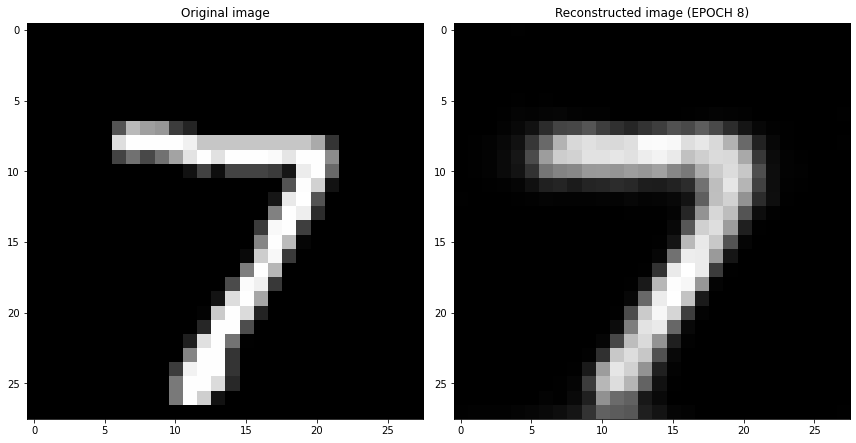

EPOCH 9/30
	 partial train loss (single batch): 0.027315
	 partial train loss (single batch): 0.027512
	 partial train loss (single batch): 0.026223
	 partial train loss (single batch): 0.026560
	 partial train loss (single batch): 0.026414
	 partial train loss (single batch): 0.027199
	 partial train loss (single batch): 0.026175
	 partial train loss (single batch): 0.024924
	 partial train loss (single batch): 0.026267
	 partial train loss (single batch): 0.027479
	 partial train loss (single batch): 0.026365
	 partial train loss (single batch): 0.026467
	 partial train loss (single batch): 0.025154
	 partial train loss (single batch): 0.026352
	 partial train loss (single batch): 0.026312
	 partial train loss (single batch): 0.027849
	 partial train loss (single batch): 0.025943
	 partial train loss (single batch): 0.026858
	 partial train loss (single batch): 0.025727
	 partial train loss (single batch): 0.026220
	 partial train loss (single batch): 0.028064
	 partial train loss (s

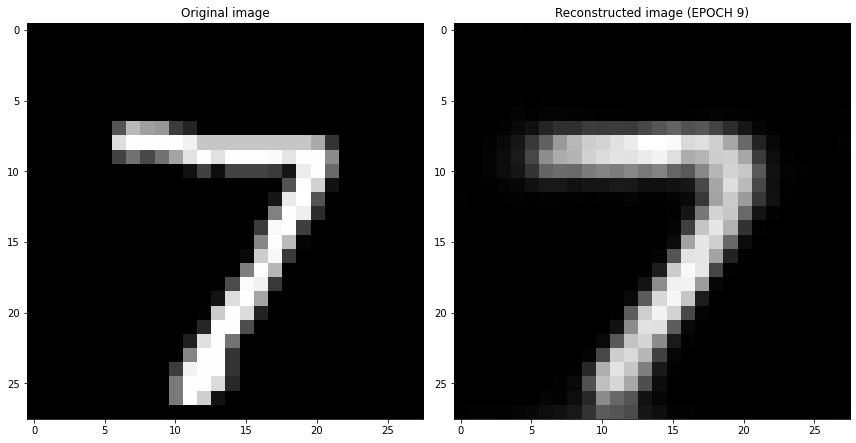

EPOCH 10/30
	 partial train loss (single batch): 0.026359
	 partial train loss (single batch): 0.026059
	 partial train loss (single batch): 0.024649
	 partial train loss (single batch): 0.026774
	 partial train loss (single batch): 0.025505
	 partial train loss (single batch): 0.026915
	 partial train loss (single batch): 0.025623
	 partial train loss (single batch): 0.025472
	 partial train loss (single batch): 0.026374
	 partial train loss (single batch): 0.025558
	 partial train loss (single batch): 0.026110
	 partial train loss (single batch): 0.026115
	 partial train loss (single batch): 0.027639
	 partial train loss (single batch): 0.024907
	 partial train loss (single batch): 0.026748
	 partial train loss (single batch): 0.025982
	 partial train loss (single batch): 0.025661
	 partial train loss (single batch): 0.027957
	 partial train loss (single batch): 0.025040
	 partial train loss (single batch): 0.026094
	 partial train loss (single batch): 0.024295
	 partial train loss (

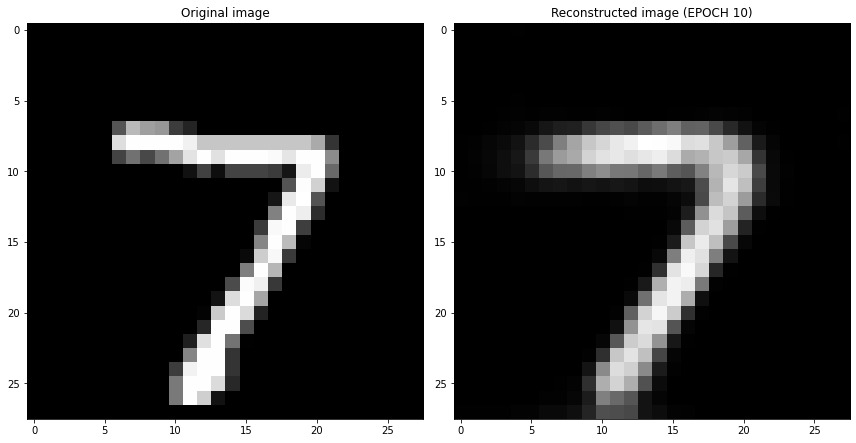

EPOCH 11/30
	 partial train loss (single batch): 0.026928
	 partial train loss (single batch): 0.024726
	 partial train loss (single batch): 0.025601
	 partial train loss (single batch): 0.024805
	 partial train loss (single batch): 0.027392
	 partial train loss (single batch): 0.023476
	 partial train loss (single batch): 0.024849
	 partial train loss (single batch): 0.026844
	 partial train loss (single batch): 0.025720
	 partial train loss (single batch): 0.027408
	 partial train loss (single batch): 0.025257
	 partial train loss (single batch): 0.024856
	 partial train loss (single batch): 0.024932
	 partial train loss (single batch): 0.024915
	 partial train loss (single batch): 0.026274
	 partial train loss (single batch): 0.026007
	 partial train loss (single batch): 0.025067
	 partial train loss (single batch): 0.024594
	 partial train loss (single batch): 0.025087
	 partial train loss (single batch): 0.025117
	 partial train loss (single batch): 0.025077
	 partial train loss (

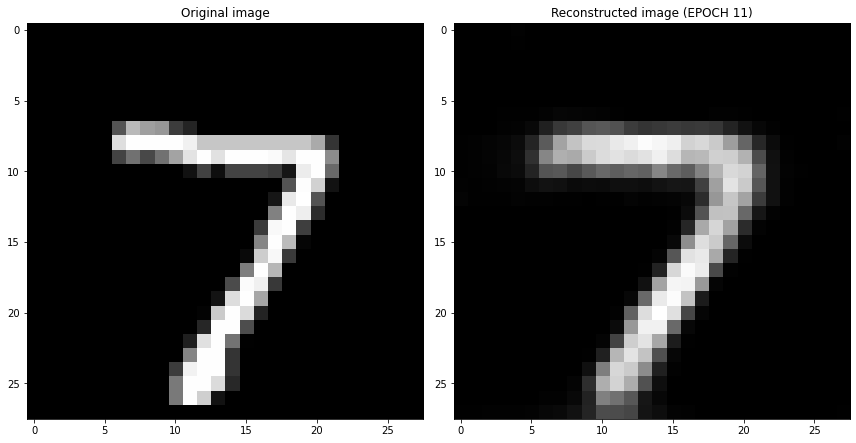

EPOCH 12/30
	 partial train loss (single batch): 0.024145
	 partial train loss (single batch): 0.026963
	 partial train loss (single batch): 0.025376
	 partial train loss (single batch): 0.024477
	 partial train loss (single batch): 0.024856
	 partial train loss (single batch): 0.024932
	 partial train loss (single batch): 0.026078
	 partial train loss (single batch): 0.025673
	 partial train loss (single batch): 0.025082
	 partial train loss (single batch): 0.026752
	 partial train loss (single batch): 0.024654
	 partial train loss (single batch): 0.026839
	 partial train loss (single batch): 0.023808
	 partial train loss (single batch): 0.025466
	 partial train loss (single batch): 0.025183
	 partial train loss (single batch): 0.025584
	 partial train loss (single batch): 0.025096
	 partial train loss (single batch): 0.025235
	 partial train loss (single batch): 0.025426
	 partial train loss (single batch): 0.025469
	 partial train loss (single batch): 0.025438
	 partial train loss (

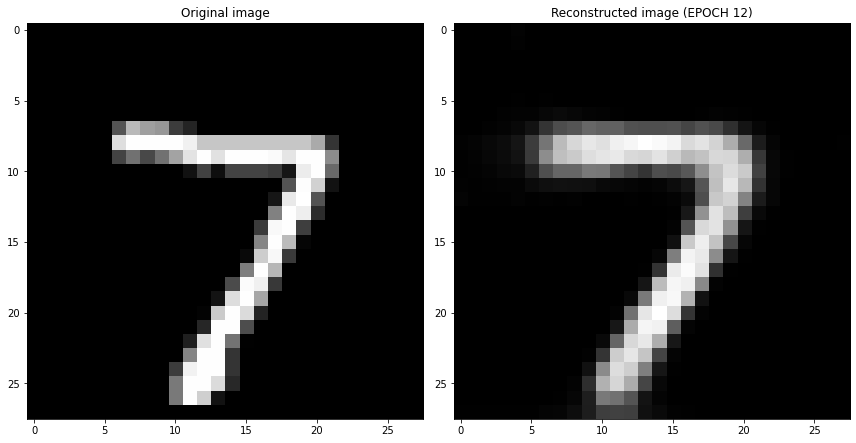

EPOCH 13/30
	 partial train loss (single batch): 0.025615
	 partial train loss (single batch): 0.024789
	 partial train loss (single batch): 0.024742
	 partial train loss (single batch): 0.025007
	 partial train loss (single batch): 0.024710
	 partial train loss (single batch): 0.023784
	 partial train loss (single batch): 0.026086
	 partial train loss (single batch): 0.023603
	 partial train loss (single batch): 0.025304
	 partial train loss (single batch): 0.025866
	 partial train loss (single batch): 0.025649
	 partial train loss (single batch): 0.024503
	 partial train loss (single batch): 0.023550
	 partial train loss (single batch): 0.025510
	 partial train loss (single batch): 0.025586
	 partial train loss (single batch): 0.024622
	 partial train loss (single batch): 0.025075
	 partial train loss (single batch): 0.023709
	 partial train loss (single batch): 0.025184
	 partial train loss (single batch): 0.024758
	 partial train loss (single batch): 0.026226
	 partial train loss (

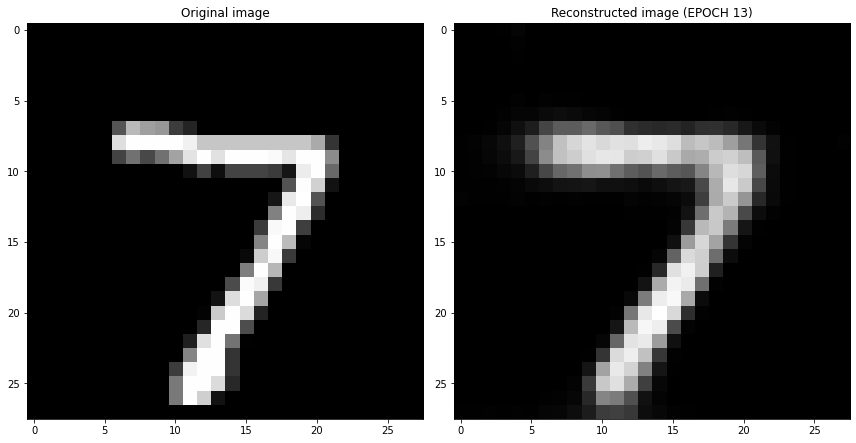

EPOCH 14/30
	 partial train loss (single batch): 0.024345
	 partial train loss (single batch): 0.023921
	 partial train loss (single batch): 0.024795
	 partial train loss (single batch): 0.025409
	 partial train loss (single batch): 0.025383
	 partial train loss (single batch): 0.024450
	 partial train loss (single batch): 0.025919
	 partial train loss (single batch): 0.025102
	 partial train loss (single batch): 0.025123
	 partial train loss (single batch): 0.024909
	 partial train loss (single batch): 0.023526
	 partial train loss (single batch): 0.024027
	 partial train loss (single batch): 0.024136
	 partial train loss (single batch): 0.024681
	 partial train loss (single batch): 0.024331
	 partial train loss (single batch): 0.022735
	 partial train loss (single batch): 0.025222
	 partial train loss (single batch): 0.026013
	 partial train loss (single batch): 0.025441
	 partial train loss (single batch): 0.024073
	 partial train loss (single batch): 0.024432
	 partial train loss (

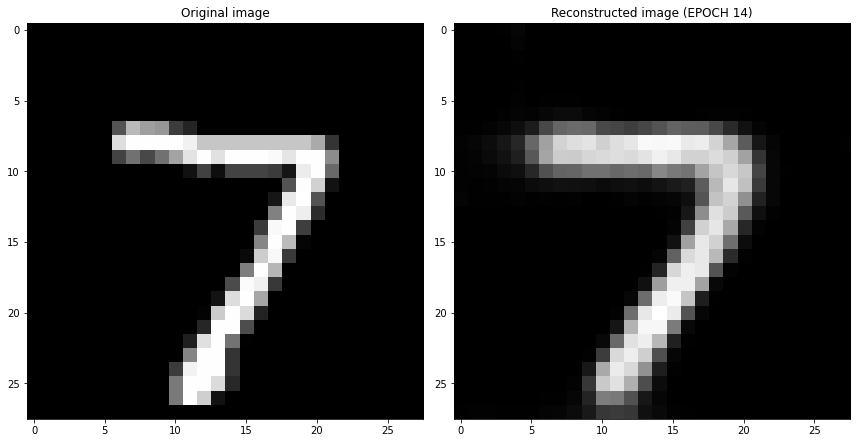

EPOCH 15/30
	 partial train loss (single batch): 0.023376
	 partial train loss (single batch): 0.023722
	 partial train loss (single batch): 0.025464
	 partial train loss (single batch): 0.023540
	 partial train loss (single batch): 0.023621
	 partial train loss (single batch): 0.024754
	 partial train loss (single batch): 0.022853
	 partial train loss (single batch): 0.025281
	 partial train loss (single batch): 0.023622
	 partial train loss (single batch): 0.025655
	 partial train loss (single batch): 0.024569
	 partial train loss (single batch): 0.024849
	 partial train loss (single batch): 0.024246
	 partial train loss (single batch): 0.023557
	 partial train loss (single batch): 0.025746
	 partial train loss (single batch): 0.024534
	 partial train loss (single batch): 0.025249
	 partial train loss (single batch): 0.024274
	 partial train loss (single batch): 0.023941
	 partial train loss (single batch): 0.024090
	 partial train loss (single batch): 0.024210
	 partial train loss (

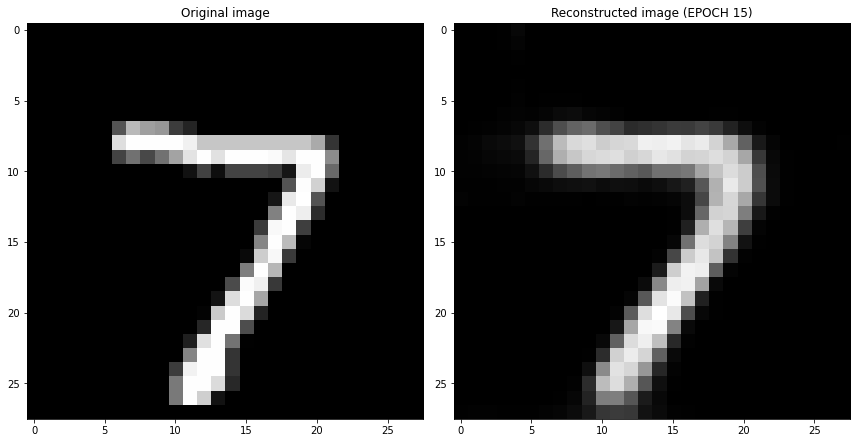

EPOCH 16/30
	 partial train loss (single batch): 0.024001
	 partial train loss (single batch): 0.023533
	 partial train loss (single batch): 0.024016
	 partial train loss (single batch): 0.023608
	 partial train loss (single batch): 0.024352
	 partial train loss (single batch): 0.024658
	 partial train loss (single batch): 0.022411
	 partial train loss (single batch): 0.023800
	 partial train loss (single batch): 0.023701
	 partial train loss (single batch): 0.024373
	 partial train loss (single batch): 0.023018
	 partial train loss (single batch): 0.025258
	 partial train loss (single batch): 0.024728
	 partial train loss (single batch): 0.024593
	 partial train loss (single batch): 0.024233
	 partial train loss (single batch): 0.025592
	 partial train loss (single batch): 0.024073
	 partial train loss (single batch): 0.023517
	 partial train loss (single batch): 0.023726
	 partial train loss (single batch): 0.024055
	 partial train loss (single batch): 0.023765
	 partial train loss (

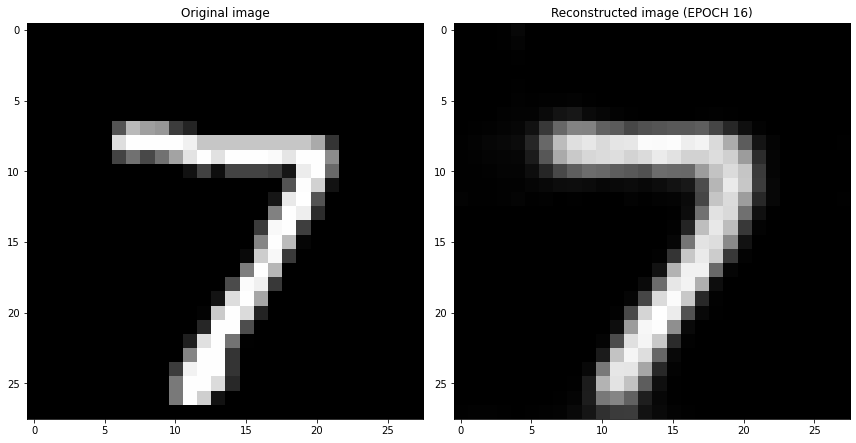

EPOCH 17/30
	 partial train loss (single batch): 0.023378
	 partial train loss (single batch): 0.022829
	 partial train loss (single batch): 0.022923
	 partial train loss (single batch): 0.023143
	 partial train loss (single batch): 0.023322
	 partial train loss (single batch): 0.023878
	 partial train loss (single batch): 0.024269
	 partial train loss (single batch): 0.024133
	 partial train loss (single batch): 0.024330
	 partial train loss (single batch): 0.025024
	 partial train loss (single batch): 0.023469
	 partial train loss (single batch): 0.023461
	 partial train loss (single batch): 0.023288
	 partial train loss (single batch): 0.022813
	 partial train loss (single batch): 0.024700
	 partial train loss (single batch): 0.023483
	 partial train loss (single batch): 0.022872
	 partial train loss (single batch): 0.022498
	 partial train loss (single batch): 0.023749
	 partial train loss (single batch): 0.024152
	 partial train loss (single batch): 0.023694
	 partial train loss (

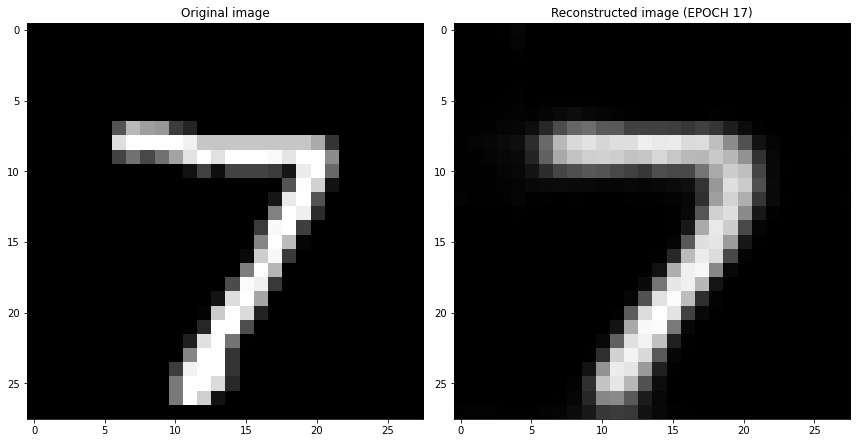

EPOCH 18/30
	 partial train loss (single batch): 0.023232
	 partial train loss (single batch): 0.022782
	 partial train loss (single batch): 0.022774
	 partial train loss (single batch): 0.023789
	 partial train loss (single batch): 0.022350
	 partial train loss (single batch): 0.023031
	 partial train loss (single batch): 0.024947
	 partial train loss (single batch): 0.022501
	 partial train loss (single batch): 0.023442
	 partial train loss (single batch): 0.023054
	 partial train loss (single batch): 0.023884
	 partial train loss (single batch): 0.023361
	 partial train loss (single batch): 0.022748
	 partial train loss (single batch): 0.023372
	 partial train loss (single batch): 0.025009
	 partial train loss (single batch): 0.023447
	 partial train loss (single batch): 0.023138
	 partial train loss (single batch): 0.023968
	 partial train loss (single batch): 0.023533
	 partial train loss (single batch): 0.023634
	 partial train loss (single batch): 0.023890
	 partial train loss (

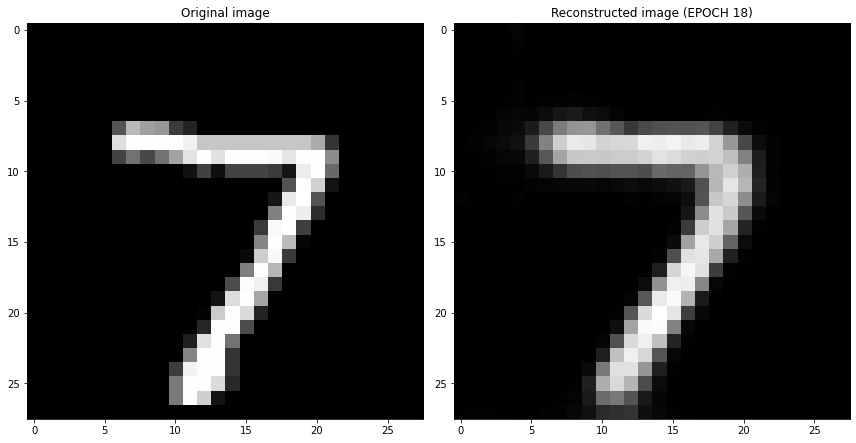

EPOCH 19/30
	 partial train loss (single batch): 0.023088
	 partial train loss (single batch): 0.024224
	 partial train loss (single batch): 0.023118
	 partial train loss (single batch): 0.025074
	 partial train loss (single batch): 0.023047
	 partial train loss (single batch): 0.023339
	 partial train loss (single batch): 0.024610
	 partial train loss (single batch): 0.022975
	 partial train loss (single batch): 0.023845
	 partial train loss (single batch): 0.021748
	 partial train loss (single batch): 0.023868
	 partial train loss (single batch): 0.023296
	 partial train loss (single batch): 0.023939
	 partial train loss (single batch): 0.022761
	 partial train loss (single batch): 0.024492
	 partial train loss (single batch): 0.023166
	 partial train loss (single batch): 0.022549
	 partial train loss (single batch): 0.020889
	 partial train loss (single batch): 0.023612
	 partial train loss (single batch): 0.022465
	 partial train loss (single batch): 0.022905
	 partial train loss (

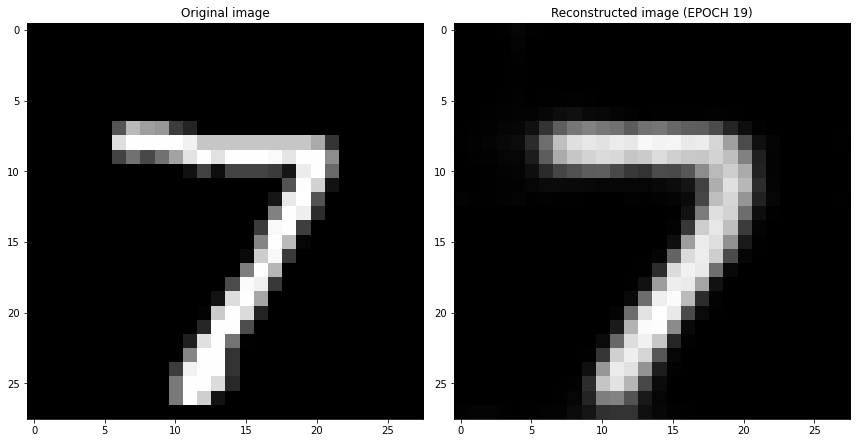

EPOCH 20/30
	 partial train loss (single batch): 0.023781
	 partial train loss (single batch): 0.023624
	 partial train loss (single batch): 0.024534
	 partial train loss (single batch): 0.022475
	 partial train loss (single batch): 0.023001
	 partial train loss (single batch): 0.024428
	 partial train loss (single batch): 0.022787
	 partial train loss (single batch): 0.023048
	 partial train loss (single batch): 0.023085
	 partial train loss (single batch): 0.021676
	 partial train loss (single batch): 0.022050
	 partial train loss (single batch): 0.022469
	 partial train loss (single batch): 0.023493
	 partial train loss (single batch): 0.023876
	 partial train loss (single batch): 0.023695
	 partial train loss (single batch): 0.023630
	 partial train loss (single batch): 0.023616
	 partial train loss (single batch): 0.024071
	 partial train loss (single batch): 0.022825
	 partial train loss (single batch): 0.022453
	 partial train loss (single batch): 0.023357
	 partial train loss (

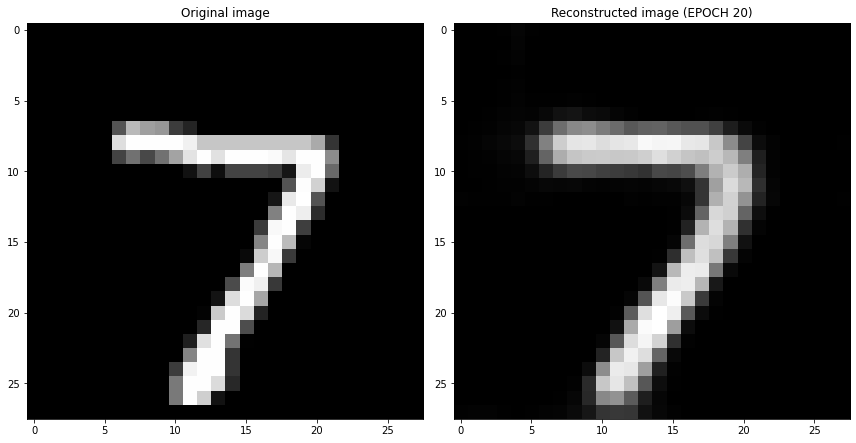

EPOCH 21/30
	 partial train loss (single batch): 0.021708
	 partial train loss (single batch): 0.023886
	 partial train loss (single batch): 0.023224
	 partial train loss (single batch): 0.022304
	 partial train loss (single batch): 0.021617
	 partial train loss (single batch): 0.023984
	 partial train loss (single batch): 0.023259
	 partial train loss (single batch): 0.024528
	 partial train loss (single batch): 0.023404
	 partial train loss (single batch): 0.022695
	 partial train loss (single batch): 0.022878
	 partial train loss (single batch): 0.023043
	 partial train loss (single batch): 0.023246
	 partial train loss (single batch): 0.023722
	 partial train loss (single batch): 0.023328
	 partial train loss (single batch): 0.023806
	 partial train loss (single batch): 0.023093
	 partial train loss (single batch): 0.023655
	 partial train loss (single batch): 0.023636
	 partial train loss (single batch): 0.023283
	 partial train loss (single batch): 0.023342
	 partial train loss (

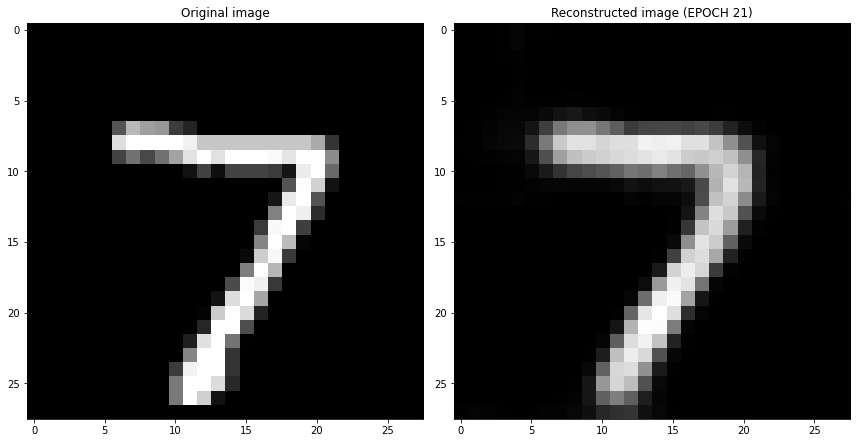

EPOCH 22/30
	 partial train loss (single batch): 0.022637
	 partial train loss (single batch): 0.023823
	 partial train loss (single batch): 0.023528
	 partial train loss (single batch): 0.024236
	 partial train loss (single batch): 0.024269
	 partial train loss (single batch): 0.023046
	 partial train loss (single batch): 0.022989
	 partial train loss (single batch): 0.022524
	 partial train loss (single batch): 0.023566
	 partial train loss (single batch): 0.024401
	 partial train loss (single batch): 0.023300
	 partial train loss (single batch): 0.022624
	 partial train loss (single batch): 0.024036
	 partial train loss (single batch): 0.024399
	 partial train loss (single batch): 0.023456
	 partial train loss (single batch): 0.022094
	 partial train loss (single batch): 0.021735
	 partial train loss (single batch): 0.025162
	 partial train loss (single batch): 0.023035
	 partial train loss (single batch): 0.023807
	 partial train loss (single batch): 0.021538
	 partial train loss (

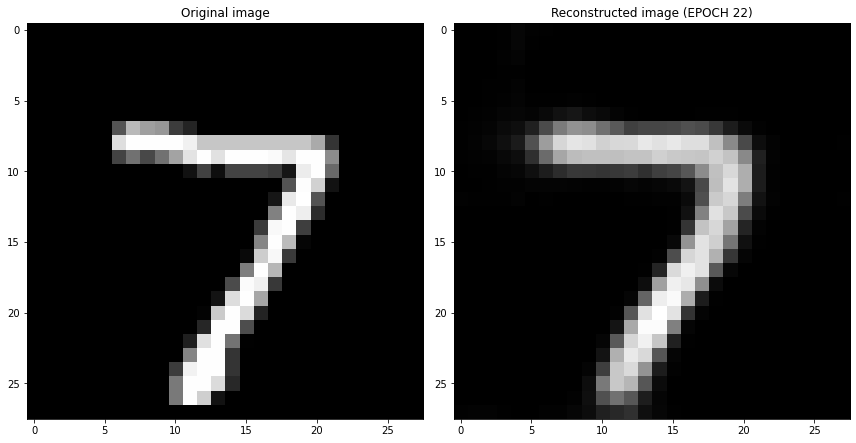

EPOCH 23/30
	 partial train loss (single batch): 0.023395
	 partial train loss (single batch): 0.024399
	 partial train loss (single batch): 0.023456
	 partial train loss (single batch): 0.022796
	 partial train loss (single batch): 0.022575
	 partial train loss (single batch): 0.023645
	 partial train loss (single batch): 0.021128
	 partial train loss (single batch): 0.022720
	 partial train loss (single batch): 0.022214
	 partial train loss (single batch): 0.024638
	 partial train loss (single batch): 0.022754
	 partial train loss (single batch): 0.022966
	 partial train loss (single batch): 0.021796
	 partial train loss (single batch): 0.022113
	 partial train loss (single batch): 0.023893
	 partial train loss (single batch): 0.021878
	 partial train loss (single batch): 0.022175
	 partial train loss (single batch): 0.022315
	 partial train loss (single batch): 0.023175
	 partial train loss (single batch): 0.022164
	 partial train loss (single batch): 0.021973
	 partial train loss (

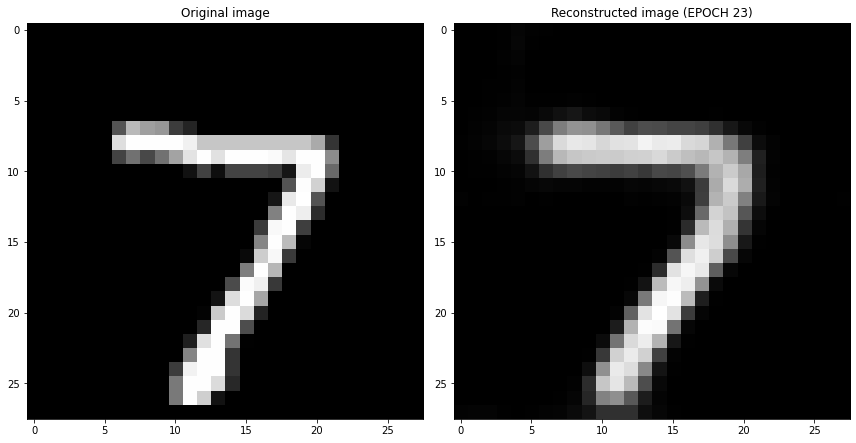

EPOCH 24/30
	 partial train loss (single batch): 0.023428
	 partial train loss (single batch): 0.024970
	 partial train loss (single batch): 0.022864
	 partial train loss (single batch): 0.022683
	 partial train loss (single batch): 0.023403
	 partial train loss (single batch): 0.023091
	 partial train loss (single batch): 0.023170
	 partial train loss (single batch): 0.023343
	 partial train loss (single batch): 0.022725
	 partial train loss (single batch): 0.022254
	 partial train loss (single batch): 0.023062
	 partial train loss (single batch): 0.022711
	 partial train loss (single batch): 0.023427
	 partial train loss (single batch): 0.023046
	 partial train loss (single batch): 0.023667
	 partial train loss (single batch): 0.023952
	 partial train loss (single batch): 0.023786
	 partial train loss (single batch): 0.023214
	 partial train loss (single batch): 0.023023
	 partial train loss (single batch): 0.023169
	 partial train loss (single batch): 0.022371
	 partial train loss (

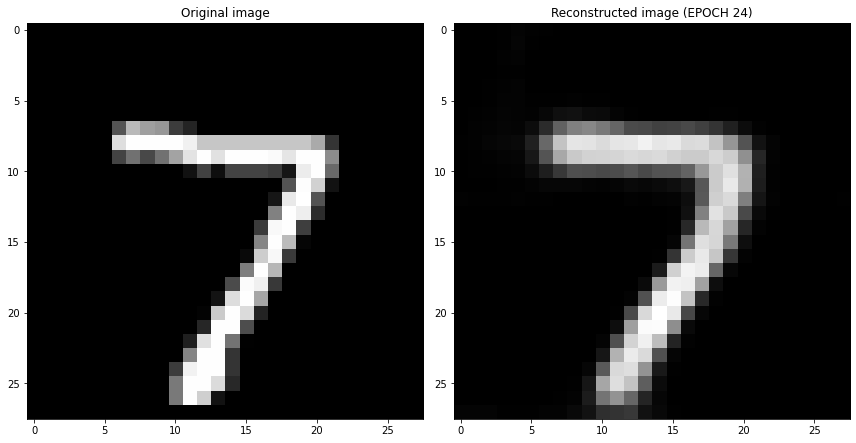

EPOCH 25/30
	 partial train loss (single batch): 0.023463
	 partial train loss (single batch): 0.023546
	 partial train loss (single batch): 0.023699
	 partial train loss (single batch): 0.022949
	 partial train loss (single batch): 0.022899
	 partial train loss (single batch): 0.021639
	 partial train loss (single batch): 0.023034
	 partial train loss (single batch): 0.023532
	 partial train loss (single batch): 0.024358
	 partial train loss (single batch): 0.022623
	 partial train loss (single batch): 0.022883
	 partial train loss (single batch): 0.022982
	 partial train loss (single batch): 0.022864
	 partial train loss (single batch): 0.022503
	 partial train loss (single batch): 0.022821
	 partial train loss (single batch): 0.022216
	 partial train loss (single batch): 0.022017
	 partial train loss (single batch): 0.022877
	 partial train loss (single batch): 0.022017
	 partial train loss (single batch): 0.022728
	 partial train loss (single batch): 0.022557
	 partial train loss (

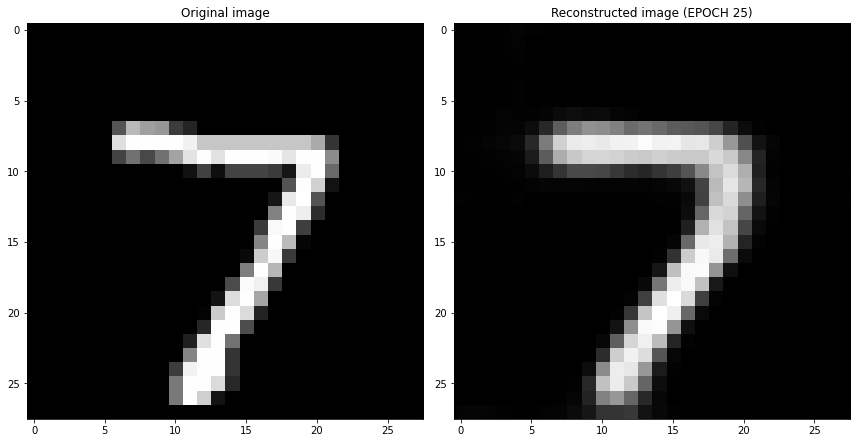

EPOCH 26/30
	 partial train loss (single batch): 0.022804
	 partial train loss (single batch): 0.021628
	 partial train loss (single batch): 0.022475
	 partial train loss (single batch): 0.021278
	 partial train loss (single batch): 0.023633
	 partial train loss (single batch): 0.022570
	 partial train loss (single batch): 0.022739
	 partial train loss (single batch): 0.022113
	 partial train loss (single batch): 0.024024
	 partial train loss (single batch): 0.023238
	 partial train loss (single batch): 0.022043
	 partial train loss (single batch): 0.022920
	 partial train loss (single batch): 0.022410
	 partial train loss (single batch): 0.021483
	 partial train loss (single batch): 0.022356
	 partial train loss (single batch): 0.022386
	 partial train loss (single batch): 0.021216
	 partial train loss (single batch): 0.023078
	 partial train loss (single batch): 0.021946
	 partial train loss (single batch): 0.022915
	 partial train loss (single batch): 0.021824
	 partial train loss (

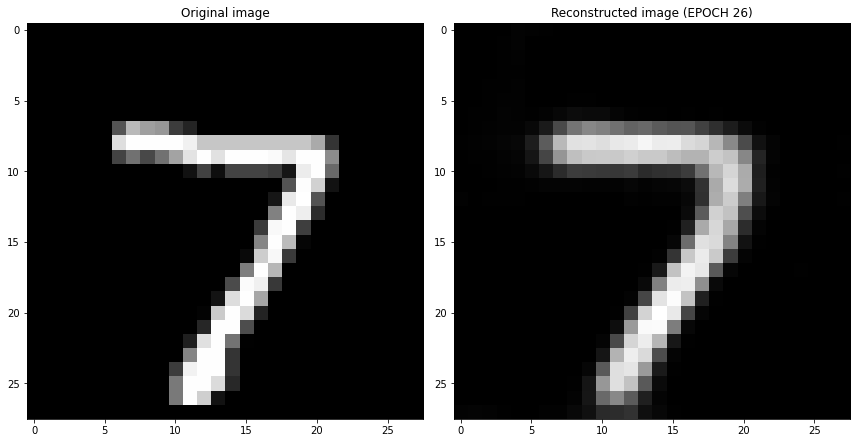

EPOCH 27/30
	 partial train loss (single batch): 0.023271
	 partial train loss (single batch): 0.022827
	 partial train loss (single batch): 0.021186
	 partial train loss (single batch): 0.021984
	 partial train loss (single batch): 0.021449
	 partial train loss (single batch): 0.023579
	 partial train loss (single batch): 0.023476
	 partial train loss (single batch): 0.022405
	 partial train loss (single batch): 0.023044
	 partial train loss (single batch): 0.021302
	 partial train loss (single batch): 0.021057
	 partial train loss (single batch): 0.021845
	 partial train loss (single batch): 0.021923
	 partial train loss (single batch): 0.022463
	 partial train loss (single batch): 0.023497
	 partial train loss (single batch): 0.022771
	 partial train loss (single batch): 0.022891
	 partial train loss (single batch): 0.023218
	 partial train loss (single batch): 0.022307
	 partial train loss (single batch): 0.022724
	 partial train loss (single batch): 0.022396
	 partial train loss (

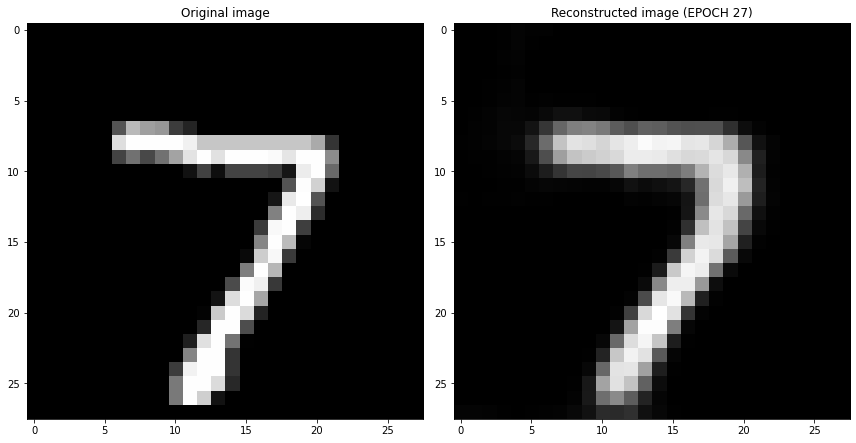

EPOCH 28/30
	 partial train loss (single batch): 0.023174
	 partial train loss (single batch): 0.022617
	 partial train loss (single batch): 0.023223
	 partial train loss (single batch): 0.021945
	 partial train loss (single batch): 0.021136
	 partial train loss (single batch): 0.023706
	 partial train loss (single batch): 0.020656
	 partial train loss (single batch): 0.023390
	 partial train loss (single batch): 0.021645
	 partial train loss (single batch): 0.023219
	 partial train loss (single batch): 0.022295
	 partial train loss (single batch): 0.022333
	 partial train loss (single batch): 0.022135
	 partial train loss (single batch): 0.021688
	 partial train loss (single batch): 0.022455
	 partial train loss (single batch): 0.021914
	 partial train loss (single batch): 0.022599
	 partial train loss (single batch): 0.022020
	 partial train loss (single batch): 0.021480
	 partial train loss (single batch): 0.022472
	 partial train loss (single batch): 0.022667
	 partial train loss (

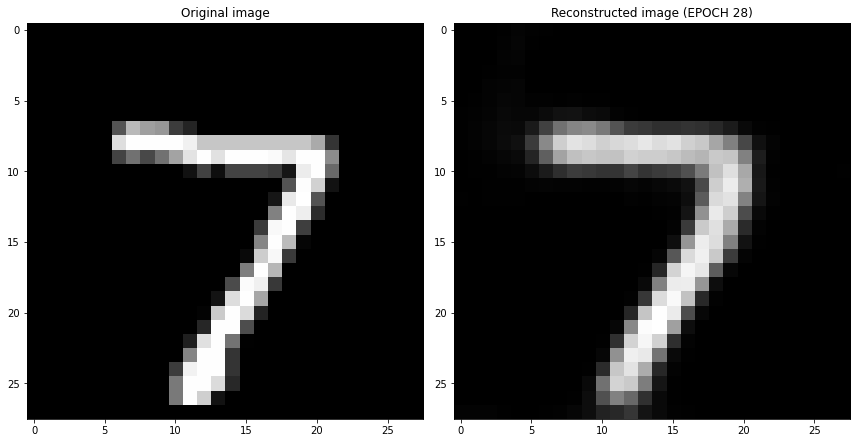

EPOCH 29/30
	 partial train loss (single batch): 0.021133
	 partial train loss (single batch): 0.022442
	 partial train loss (single batch): 0.022820
	 partial train loss (single batch): 0.021862
	 partial train loss (single batch): 0.022687
	 partial train loss (single batch): 0.022399
	 partial train loss (single batch): 0.023077
	 partial train loss (single batch): 0.022057
	 partial train loss (single batch): 0.022111
	 partial train loss (single batch): 0.022708
	 partial train loss (single batch): 0.022416
	 partial train loss (single batch): 0.021393
	 partial train loss (single batch): 0.021027
	 partial train loss (single batch): 0.022474
	 partial train loss (single batch): 0.021667
	 partial train loss (single batch): 0.021294
	 partial train loss (single batch): 0.021400
	 partial train loss (single batch): 0.022072
	 partial train loss (single batch): 0.022120
	 partial train loss (single batch): 0.021685
	 partial train loss (single batch): 0.023053
	 partial train loss (

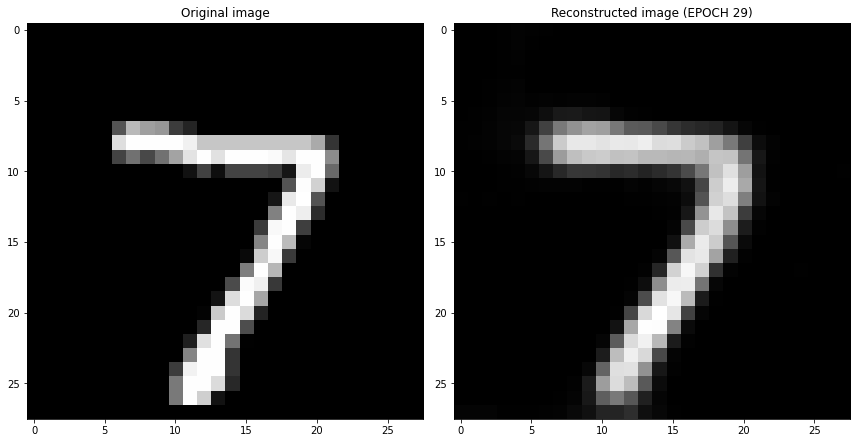

EPOCH 30/30
	 partial train loss (single batch): 0.021652
	 partial train loss (single batch): 0.022142
	 partial train loss (single batch): 0.022116
	 partial train loss (single batch): 0.021702
	 partial train loss (single batch): 0.023038
	 partial train loss (single batch): 0.021705
	 partial train loss (single batch): 0.021632
	 partial train loss (single batch): 0.023280
	 partial train loss (single batch): 0.022550
	 partial train loss (single batch): 0.020972
	 partial train loss (single batch): 0.021923
	 partial train loss (single batch): 0.021097
	 partial train loss (single batch): 0.021183
	 partial train loss (single batch): 0.022845
	 partial train loss (single batch): 0.021253
	 partial train loss (single batch): 0.022939
	 partial train loss (single batch): 0.023130
	 partial train loss (single batch): 0.023270
	 partial train loss (single batch): 0.021080
	 partial train loss (single batch): 0.021473
	 partial train loss (single batch): 0.022013
	 partial train loss (

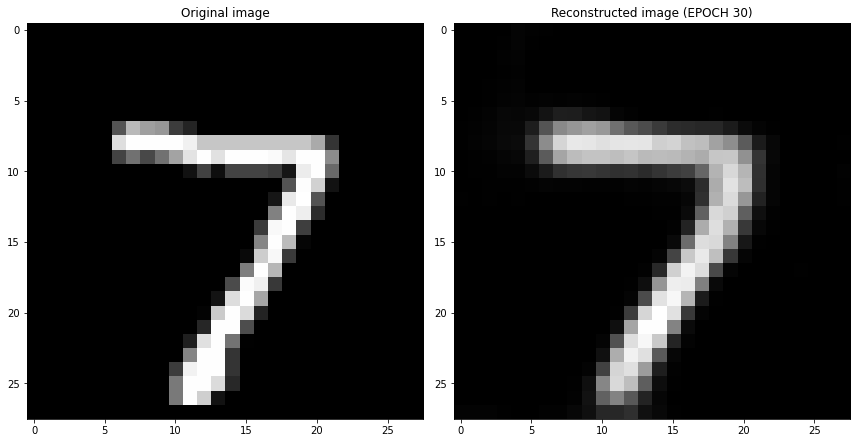

Cross validation fold number= 5/6
EPOCH 1/30
	 partial train loss (single batch): 0.236616
	 partial train loss (single batch): 0.235969
	 partial train loss (single batch): 0.235648
	 partial train loss (single batch): 0.234760
	 partial train loss (single batch): 0.234424
	 partial train loss (single batch): 0.233636
	 partial train loss (single batch): 0.233130
	 partial train loss (single batch): 0.232442
	 partial train loss (single batch): 0.231901
	 partial train loss (single batch): 0.231034
	 partial train loss (single batch): 0.230928
	 partial train loss (single batch): 0.229817
	 partial train loss (single batch): 0.229576
	 partial train loss (single batch): 0.228656
	 partial train loss (single batch): 0.227386
	 partial train loss (single batch): 0.226838
	 partial train loss (single batch): 0.226219
	 partial train loss (single batch): 0.225147
	 partial train loss (single batch): 0.223967
	 partial train loss (single batch): 0.222808
	 partial train loss (single batch)

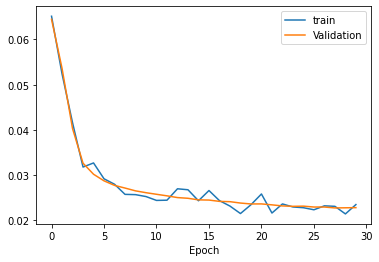

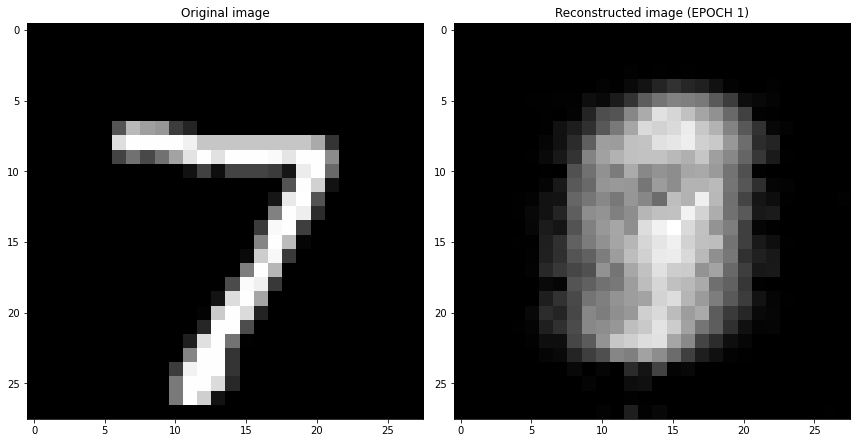

EPOCH 2/30
	 partial train loss (single batch): 0.063546
	 partial train loss (single batch): 0.064980
	 partial train loss (single batch): 0.063268
	 partial train loss (single batch): 0.065287
	 partial train loss (single batch): 0.067459
	 partial train loss (single batch): 0.064292
	 partial train loss (single batch): 0.064989
	 partial train loss (single batch): 0.065824
	 partial train loss (single batch): 0.063743
	 partial train loss (single batch): 0.064175
	 partial train loss (single batch): 0.065407
	 partial train loss (single batch): 0.064324
	 partial train loss (single batch): 0.063211
	 partial train loss (single batch): 0.065535
	 partial train loss (single batch): 0.066252
	 partial train loss (single batch): 0.064420
	 partial train loss (single batch): 0.062466
	 partial train loss (single batch): 0.063991
	 partial train loss (single batch): 0.063664
	 partial train loss (single batch): 0.064750
	 partial train loss (single batch): 0.063801
	 partial train loss (s

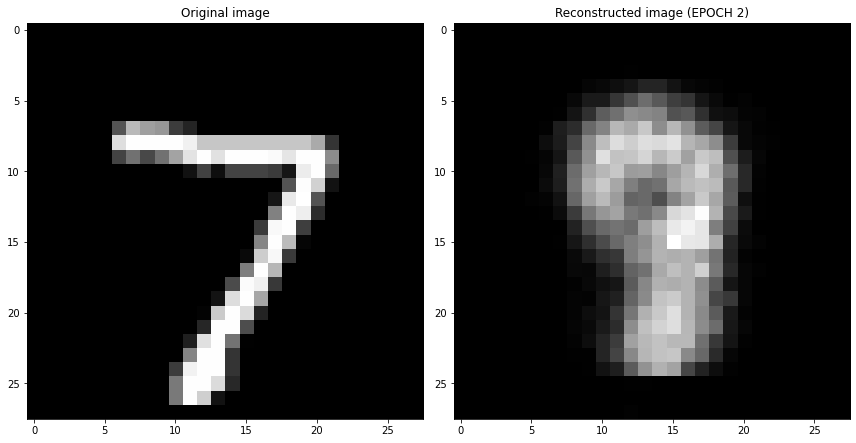

EPOCH 3/30
	 partial train loss (single batch): 0.056433
	 partial train loss (single batch): 0.054967
	 partial train loss (single batch): 0.054076
	 partial train loss (single batch): 0.055769
	 partial train loss (single batch): 0.052855
	 partial train loss (single batch): 0.053944
	 partial train loss (single batch): 0.054556
	 partial train loss (single batch): 0.052681
	 partial train loss (single batch): 0.055677
	 partial train loss (single batch): 0.054654
	 partial train loss (single batch): 0.053717
	 partial train loss (single batch): 0.054258
	 partial train loss (single batch): 0.052771
	 partial train loss (single batch): 0.053175
	 partial train loss (single batch): 0.052233
	 partial train loss (single batch): 0.054158
	 partial train loss (single batch): 0.052597
	 partial train loss (single batch): 0.053633
	 partial train loss (single batch): 0.052811
	 partial train loss (single batch): 0.052465
	 partial train loss (single batch): 0.054576
	 partial train loss (s

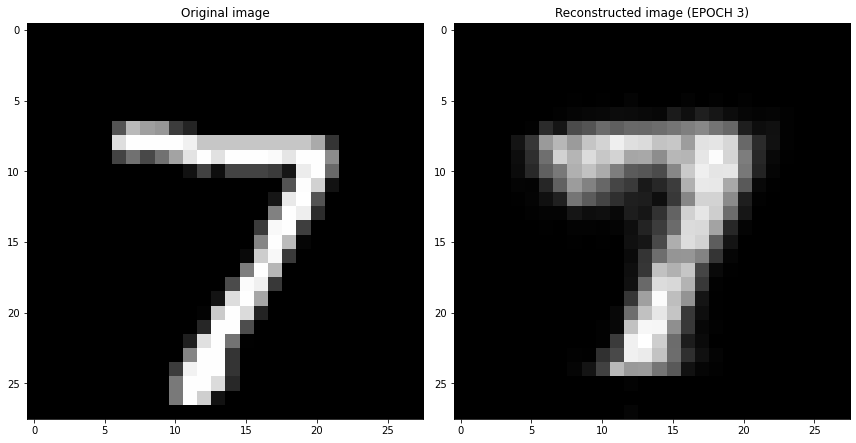

EPOCH 4/30
	 partial train loss (single batch): 0.038706
	 partial train loss (single batch): 0.040718
	 partial train loss (single batch): 0.041358
	 partial train loss (single batch): 0.042049
	 partial train loss (single batch): 0.039763
	 partial train loss (single batch): 0.043804
	 partial train loss (single batch): 0.039774
	 partial train loss (single batch): 0.039493
	 partial train loss (single batch): 0.040292
	 partial train loss (single batch): 0.040532
	 partial train loss (single batch): 0.037285
	 partial train loss (single batch): 0.041687
	 partial train loss (single batch): 0.042107
	 partial train loss (single batch): 0.041567
	 partial train loss (single batch): 0.042152
	 partial train loss (single batch): 0.040378
	 partial train loss (single batch): 0.040971
	 partial train loss (single batch): 0.041020
	 partial train loss (single batch): 0.042446
	 partial train loss (single batch): 0.039756
	 partial train loss (single batch): 0.040379
	 partial train loss (s

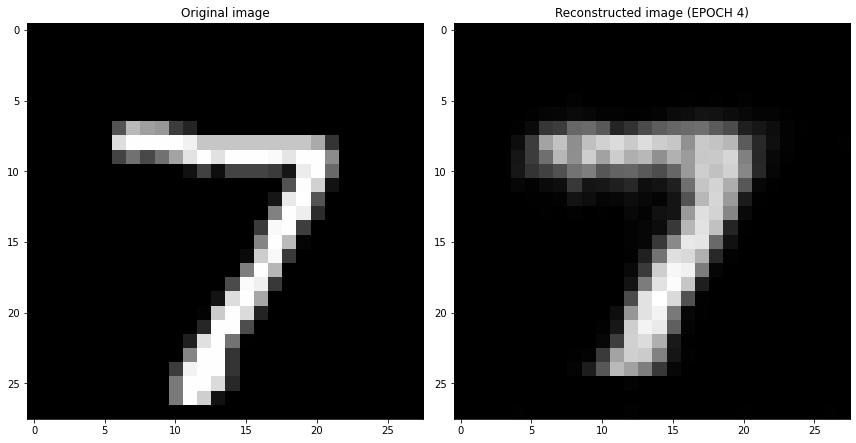

EPOCH 5/30
	 partial train loss (single batch): 0.037603
	 partial train loss (single batch): 0.035898
	 partial train loss (single batch): 0.036125
	 partial train loss (single batch): 0.035459
	 partial train loss (single batch): 0.035711
	 partial train loss (single batch): 0.036454
	 partial train loss (single batch): 0.035622
	 partial train loss (single batch): 0.034567
	 partial train loss (single batch): 0.035108
	 partial train loss (single batch): 0.034378
	 partial train loss (single batch): 0.034397
	 partial train loss (single batch): 0.033960
	 partial train loss (single batch): 0.035613
	 partial train loss (single batch): 0.035234
	 partial train loss (single batch): 0.036274
	 partial train loss (single batch): 0.036459
	 partial train loss (single batch): 0.035628
	 partial train loss (single batch): 0.036670
	 partial train loss (single batch): 0.034921
	 partial train loss (single batch): 0.036424
	 partial train loss (single batch): 0.035336
	 partial train loss (s

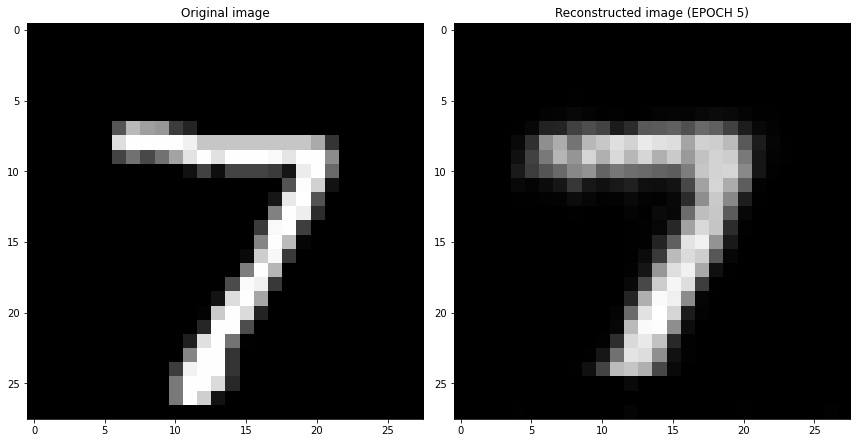

EPOCH 6/30
	 partial train loss (single batch): 0.032268
	 partial train loss (single batch): 0.032381
	 partial train loss (single batch): 0.032240
	 partial train loss (single batch): 0.032272
	 partial train loss (single batch): 0.031853
	 partial train loss (single batch): 0.031941
	 partial train loss (single batch): 0.033466
	 partial train loss (single batch): 0.031574
	 partial train loss (single batch): 0.032805
	 partial train loss (single batch): 0.032357
	 partial train loss (single batch): 0.031990
	 partial train loss (single batch): 0.030699
	 partial train loss (single batch): 0.031122
	 partial train loss (single batch): 0.033502
	 partial train loss (single batch): 0.032641
	 partial train loss (single batch): 0.032003
	 partial train loss (single batch): 0.032873
	 partial train loss (single batch): 0.031800
	 partial train loss (single batch): 0.030357
	 partial train loss (single batch): 0.032674
	 partial train loss (single batch): 0.030492
	 partial train loss (s

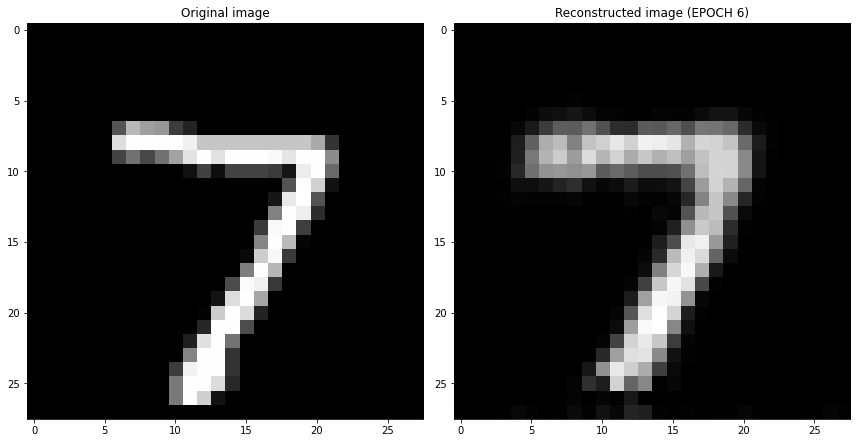

EPOCH 7/30
	 partial train loss (single batch): 0.030273
	 partial train loss (single batch): 0.029058
	 partial train loss (single batch): 0.030718
	 partial train loss (single batch): 0.029917
	 partial train loss (single batch): 0.030694
	 partial train loss (single batch): 0.029130
	 partial train loss (single batch): 0.031697
	 partial train loss (single batch): 0.029387
	 partial train loss (single batch): 0.029140
	 partial train loss (single batch): 0.030891
	 partial train loss (single batch): 0.030886
	 partial train loss (single batch): 0.029971
	 partial train loss (single batch): 0.029167
	 partial train loss (single batch): 0.030072
	 partial train loss (single batch): 0.029570
	 partial train loss (single batch): 0.030843
	 partial train loss (single batch): 0.028933
	 partial train loss (single batch): 0.029785
	 partial train loss (single batch): 0.029044
	 partial train loss (single batch): 0.029173
	 partial train loss (single batch): 0.030034
	 partial train loss (s

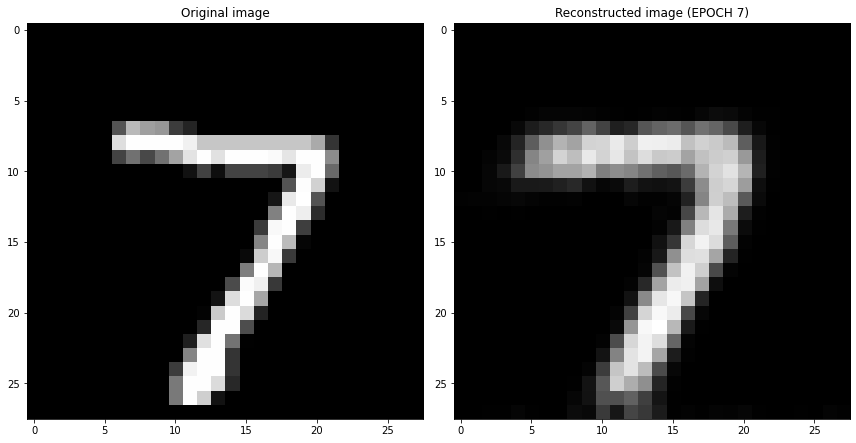

EPOCH 8/30
	 partial train loss (single batch): 0.029458
	 partial train loss (single batch): 0.028210
	 partial train loss (single batch): 0.029116
	 partial train loss (single batch): 0.028877
	 partial train loss (single batch): 0.029188
	 partial train loss (single batch): 0.029378
	 partial train loss (single batch): 0.029819
	 partial train loss (single batch): 0.027050
	 partial train loss (single batch): 0.028661
	 partial train loss (single batch): 0.026798
	 partial train loss (single batch): 0.030041
	 partial train loss (single batch): 0.029021
	 partial train loss (single batch): 0.029141
	 partial train loss (single batch): 0.029419
	 partial train loss (single batch): 0.030220
	 partial train loss (single batch): 0.029135
	 partial train loss (single batch): 0.026994
	 partial train loss (single batch): 0.029359
	 partial train loss (single batch): 0.030340
	 partial train loss (single batch): 0.027846
	 partial train loss (single batch): 0.029358
	 partial train loss (s

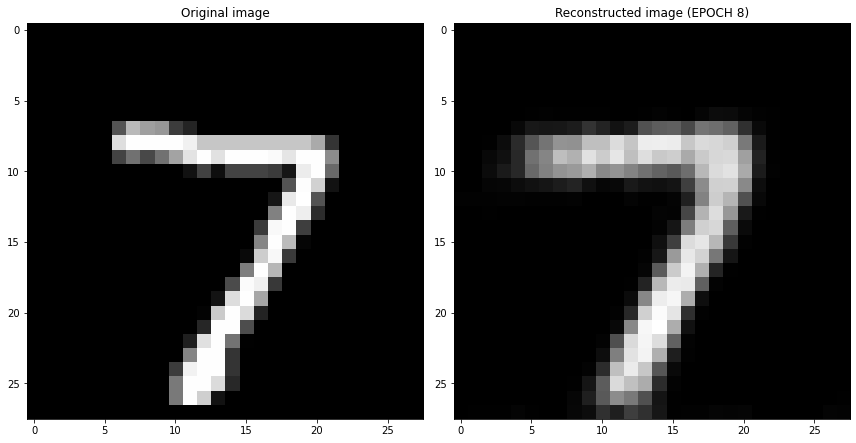

EPOCH 9/30
	 partial train loss (single batch): 0.026412
	 partial train loss (single batch): 0.028095
	 partial train loss (single batch): 0.028002
	 partial train loss (single batch): 0.029080
	 partial train loss (single batch): 0.027248
	 partial train loss (single batch): 0.028441
	 partial train loss (single batch): 0.027373
	 partial train loss (single batch): 0.028981
	 partial train loss (single batch): 0.027977
	 partial train loss (single batch): 0.027345
	 partial train loss (single batch): 0.027638
	 partial train loss (single batch): 0.028568
	 partial train loss (single batch): 0.027105
	 partial train loss (single batch): 0.026246
	 partial train loss (single batch): 0.028970
	 partial train loss (single batch): 0.027901
	 partial train loss (single batch): 0.027947
	 partial train loss (single batch): 0.027724
	 partial train loss (single batch): 0.028749
	 partial train loss (single batch): 0.028901
	 partial train loss (single batch): 0.027739
	 partial train loss (s

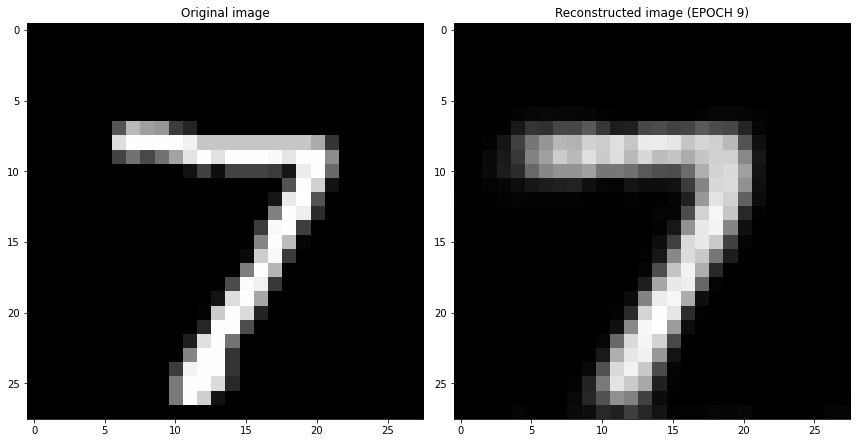

EPOCH 10/30
	 partial train loss (single batch): 0.026868
	 partial train loss (single batch): 0.026792
	 partial train loss (single batch): 0.026657
	 partial train loss (single batch): 0.027109
	 partial train loss (single batch): 0.027207
	 partial train loss (single batch): 0.026441
	 partial train loss (single batch): 0.025882
	 partial train loss (single batch): 0.027115
	 partial train loss (single batch): 0.027516
	 partial train loss (single batch): 0.027475
	 partial train loss (single batch): 0.026153
	 partial train loss (single batch): 0.028265
	 partial train loss (single batch): 0.027184
	 partial train loss (single batch): 0.028057
	 partial train loss (single batch): 0.027979
	 partial train loss (single batch): 0.026459
	 partial train loss (single batch): 0.025972
	 partial train loss (single batch): 0.026630
	 partial train loss (single batch): 0.025544
	 partial train loss (single batch): 0.027139
	 partial train loss (single batch): 0.026775
	 partial train loss (

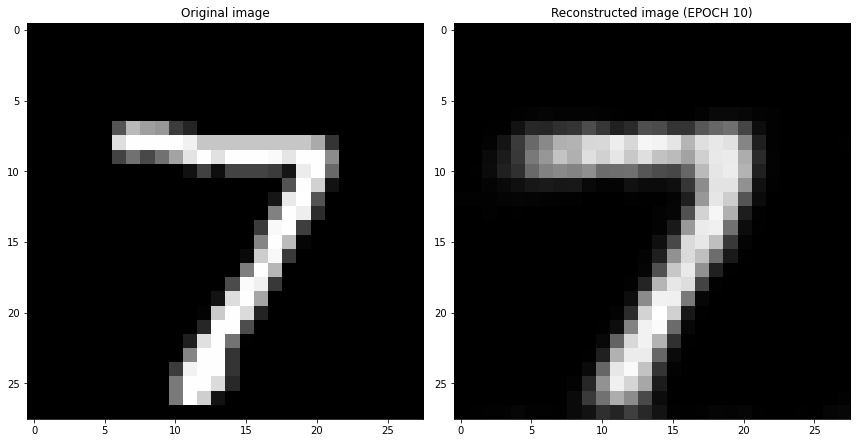

EPOCH 11/30
	 partial train loss (single batch): 0.025089
	 partial train loss (single batch): 0.025979
	 partial train loss (single batch): 0.026785
	 partial train loss (single batch): 0.024894
	 partial train loss (single batch): 0.026607
	 partial train loss (single batch): 0.028232
	 partial train loss (single batch): 0.026952
	 partial train loss (single batch): 0.026402
	 partial train loss (single batch): 0.025395
	 partial train loss (single batch): 0.026388
	 partial train loss (single batch): 0.027166
	 partial train loss (single batch): 0.027296
	 partial train loss (single batch): 0.025324
	 partial train loss (single batch): 0.026814
	 partial train loss (single batch): 0.026874
	 partial train loss (single batch): 0.026823
	 partial train loss (single batch): 0.027002
	 partial train loss (single batch): 0.026009
	 partial train loss (single batch): 0.027184
	 partial train loss (single batch): 0.026619
	 partial train loss (single batch): 0.025723
	 partial train loss (

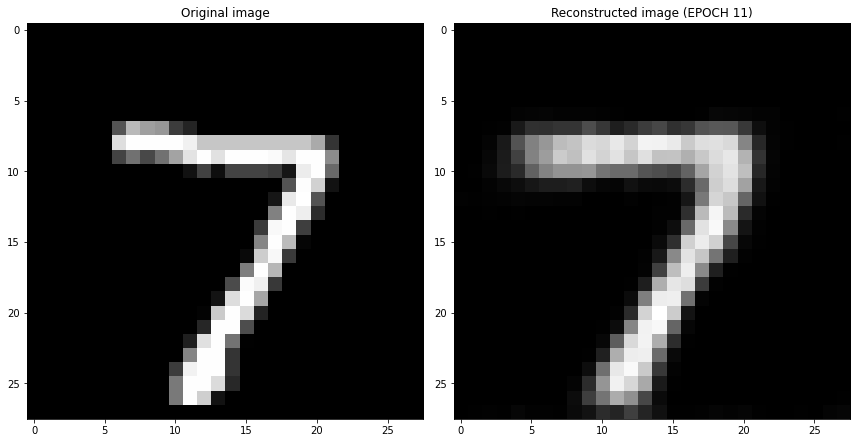

EPOCH 12/30
	 partial train loss (single batch): 0.026099
	 partial train loss (single batch): 0.026328
	 partial train loss (single batch): 0.025210
	 partial train loss (single batch): 0.025412
	 partial train loss (single batch): 0.025749
	 partial train loss (single batch): 0.025687
	 partial train loss (single batch): 0.025973
	 partial train loss (single batch): 0.026981
	 partial train loss (single batch): 0.025699
	 partial train loss (single batch): 0.026924
	 partial train loss (single batch): 0.026186
	 partial train loss (single batch): 0.025578
	 partial train loss (single batch): 0.023723
	 partial train loss (single batch): 0.025918
	 partial train loss (single batch): 0.026727
	 partial train loss (single batch): 0.024198
	 partial train loss (single batch): 0.025147
	 partial train loss (single batch): 0.025091
	 partial train loss (single batch): 0.027639
	 partial train loss (single batch): 0.025444
	 partial train loss (single batch): 0.026141
	 partial train loss (

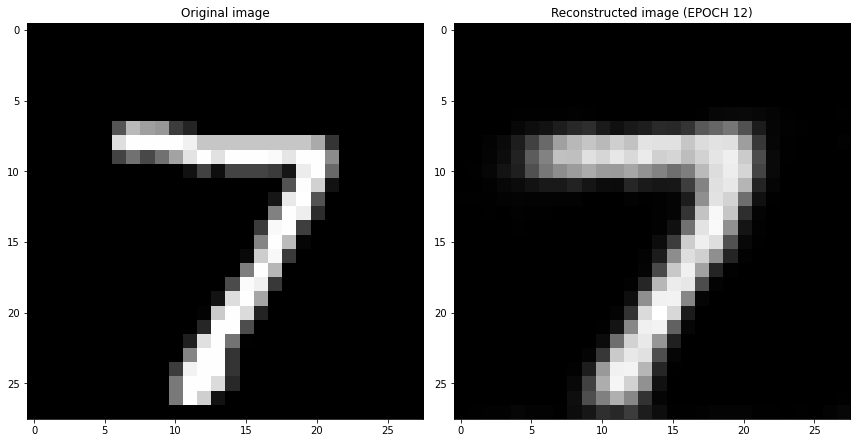

EPOCH 13/30
	 partial train loss (single batch): 0.025425
	 partial train loss (single batch): 0.025784
	 partial train loss (single batch): 0.025963
	 partial train loss (single batch): 0.024212
	 partial train loss (single batch): 0.026564
	 partial train loss (single batch): 0.025590
	 partial train loss (single batch): 0.027043
	 partial train loss (single batch): 0.025679
	 partial train loss (single batch): 0.025083
	 partial train loss (single batch): 0.024511
	 partial train loss (single batch): 0.023541
	 partial train loss (single batch): 0.024725
	 partial train loss (single batch): 0.026342
	 partial train loss (single batch): 0.026631
	 partial train loss (single batch): 0.025134
	 partial train loss (single batch): 0.024994
	 partial train loss (single batch): 0.026112
	 partial train loss (single batch): 0.024411
	 partial train loss (single batch): 0.027123
	 partial train loss (single batch): 0.024850
	 partial train loss (single batch): 0.025049
	 partial train loss (

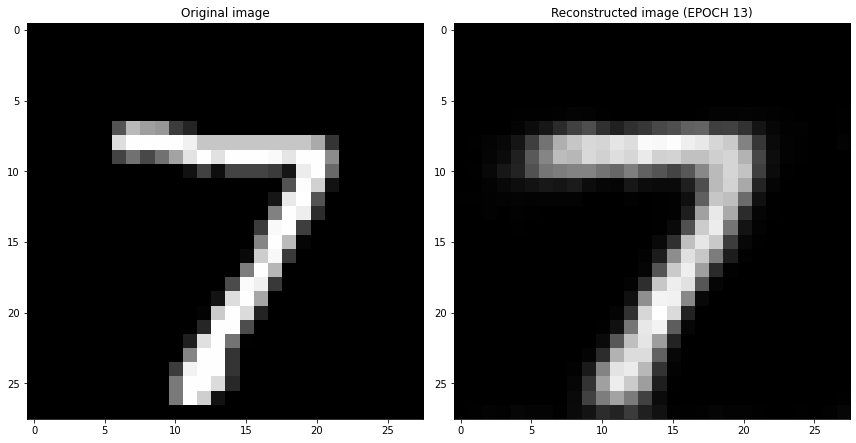

EPOCH 14/30
	 partial train loss (single batch): 0.025603
	 partial train loss (single batch): 0.025992
	 partial train loss (single batch): 0.025470
	 partial train loss (single batch): 0.025203
	 partial train loss (single batch): 0.025076
	 partial train loss (single batch): 0.024926
	 partial train loss (single batch): 0.025036
	 partial train loss (single batch): 0.026407
	 partial train loss (single batch): 0.025771
	 partial train loss (single batch): 0.024388
	 partial train loss (single batch): 0.023450
	 partial train loss (single batch): 0.026012
	 partial train loss (single batch): 0.024709
	 partial train loss (single batch): 0.025721
	 partial train loss (single batch): 0.025151
	 partial train loss (single batch): 0.026060
	 partial train loss (single batch): 0.025491
	 partial train loss (single batch): 0.024332
	 partial train loss (single batch): 0.025143
	 partial train loss (single batch): 0.025347
	 partial train loss (single batch): 0.026144
	 partial train loss (

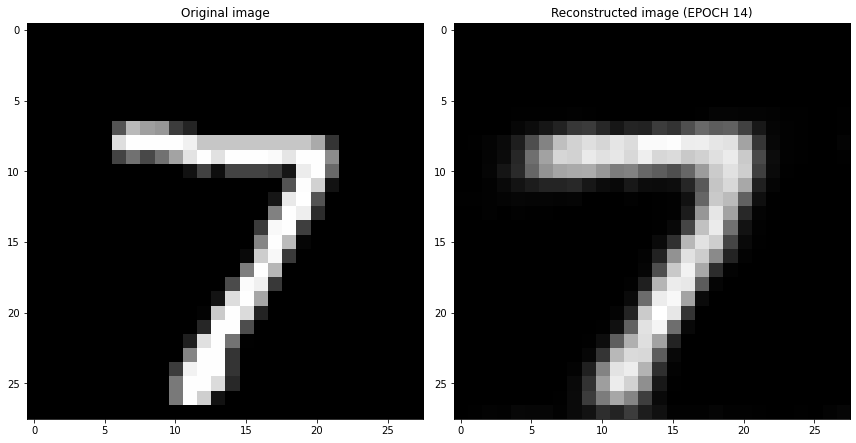

EPOCH 15/30
	 partial train loss (single batch): 0.025103
	 partial train loss (single batch): 0.023602
	 partial train loss (single batch): 0.024732
	 partial train loss (single batch): 0.025010
	 partial train loss (single batch): 0.025356
	 partial train loss (single batch): 0.026073
	 partial train loss (single batch): 0.024179
	 partial train loss (single batch): 0.024287
	 partial train loss (single batch): 0.023670
	 partial train loss (single batch): 0.025284
	 partial train loss (single batch): 0.024981
	 partial train loss (single batch): 0.024622
	 partial train loss (single batch): 0.025503
	 partial train loss (single batch): 0.026143
	 partial train loss (single batch): 0.024190
	 partial train loss (single batch): 0.026655
	 partial train loss (single batch): 0.024542
	 partial train loss (single batch): 0.025965
	 partial train loss (single batch): 0.025347
	 partial train loss (single batch): 0.026446
	 partial train loss (single batch): 0.023661
	 partial train loss (

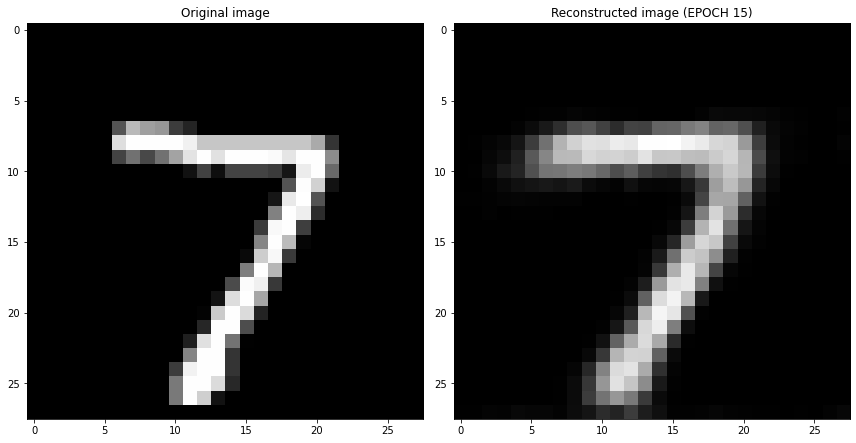

EPOCH 16/30
	 partial train loss (single batch): 0.024154
	 partial train loss (single batch): 0.023027
	 partial train loss (single batch): 0.025048
	 partial train loss (single batch): 0.024556
	 partial train loss (single batch): 0.024054
	 partial train loss (single batch): 0.024456
	 partial train loss (single batch): 0.023523
	 partial train loss (single batch): 0.024643
	 partial train loss (single batch): 0.023949
	 partial train loss (single batch): 0.023820
	 partial train loss (single batch): 0.024734
	 partial train loss (single batch): 0.024656
	 partial train loss (single batch): 0.023764
	 partial train loss (single batch): 0.023694
	 partial train loss (single batch): 0.025134
	 partial train loss (single batch): 0.024243
	 partial train loss (single batch): 0.024534
	 partial train loss (single batch): 0.023427
	 partial train loss (single batch): 0.023542
	 partial train loss (single batch): 0.024862
	 partial train loss (single batch): 0.024388
	 partial train loss (

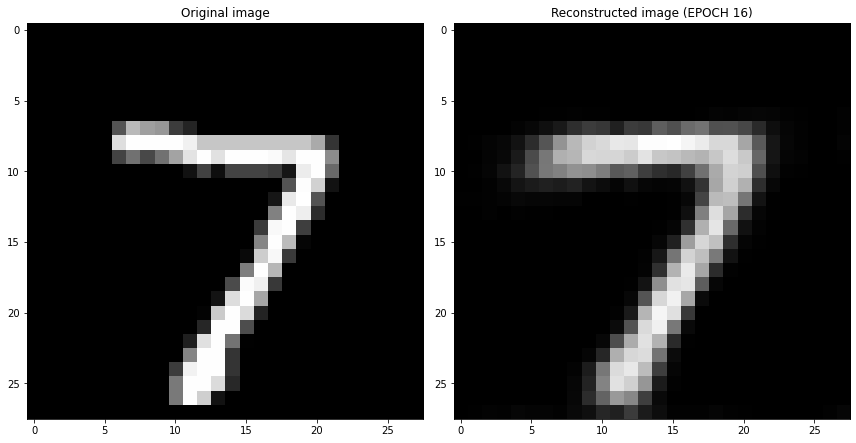

EPOCH 17/30
	 partial train loss (single batch): 0.024506
	 partial train loss (single batch): 0.024400
	 partial train loss (single batch): 0.022264
	 partial train loss (single batch): 0.023657
	 partial train loss (single batch): 0.026259
	 partial train loss (single batch): 0.025328
	 partial train loss (single batch): 0.025291
	 partial train loss (single batch): 0.024648
	 partial train loss (single batch): 0.024596
	 partial train loss (single batch): 0.024898
	 partial train loss (single batch): 0.023771
	 partial train loss (single batch): 0.023578
	 partial train loss (single batch): 0.024205
	 partial train loss (single batch): 0.023655
	 partial train loss (single batch): 0.024981
	 partial train loss (single batch): 0.024385
	 partial train loss (single batch): 0.024423
	 partial train loss (single batch): 0.024245
	 partial train loss (single batch): 0.023588
	 partial train loss (single batch): 0.025834
	 partial train loss (single batch): 0.024828
	 partial train loss (

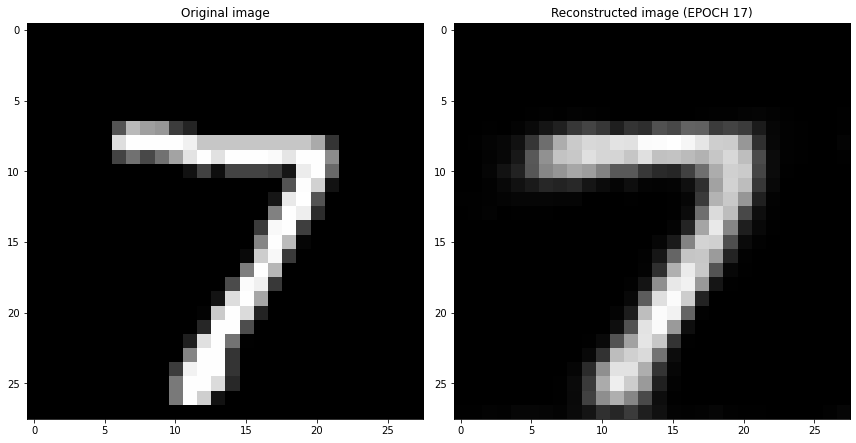

EPOCH 18/30
	 partial train loss (single batch): 0.024965
	 partial train loss (single batch): 0.023546
	 partial train loss (single batch): 0.024442
	 partial train loss (single batch): 0.023758
	 partial train loss (single batch): 0.023950
	 partial train loss (single batch): 0.023426
	 partial train loss (single batch): 0.023522
	 partial train loss (single batch): 0.024041
	 partial train loss (single batch): 0.024454
	 partial train loss (single batch): 0.024434
	 partial train loss (single batch): 0.024499
	 partial train loss (single batch): 0.023446
	 partial train loss (single batch): 0.022294
	 partial train loss (single batch): 0.023095
	 partial train loss (single batch): 0.024585
	 partial train loss (single batch): 0.024063
	 partial train loss (single batch): 0.022847
	 partial train loss (single batch): 0.022995
	 partial train loss (single batch): 0.022696
	 partial train loss (single batch): 0.024056
	 partial train loss (single batch): 0.024287
	 partial train loss (

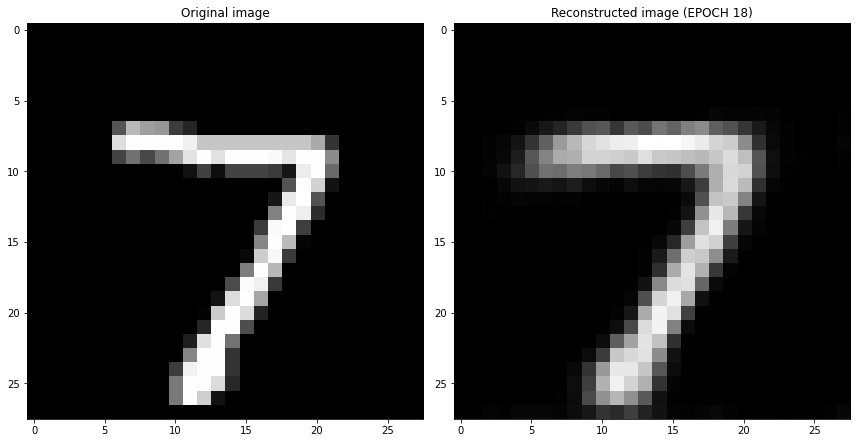

EPOCH 19/30
	 partial train loss (single batch): 0.021780
	 partial train loss (single batch): 0.023532
	 partial train loss (single batch): 0.023109
	 partial train loss (single batch): 0.024620
	 partial train loss (single batch): 0.023992
	 partial train loss (single batch): 0.023562
	 partial train loss (single batch): 0.023345
	 partial train loss (single batch): 0.022890
	 partial train loss (single batch): 0.023879
	 partial train loss (single batch): 0.024005
	 partial train loss (single batch): 0.024416
	 partial train loss (single batch): 0.023496
	 partial train loss (single batch): 0.022182
	 partial train loss (single batch): 0.024188
	 partial train loss (single batch): 0.024022
	 partial train loss (single batch): 0.023964
	 partial train loss (single batch): 0.024488
	 partial train loss (single batch): 0.024296
	 partial train loss (single batch): 0.023276
	 partial train loss (single batch): 0.022894
	 partial train loss (single batch): 0.024874
	 partial train loss (

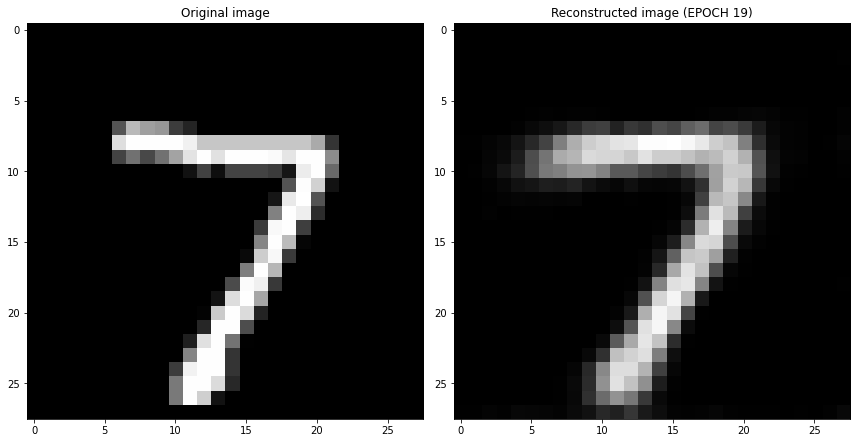

EPOCH 20/30
	 partial train loss (single batch): 0.022200
	 partial train loss (single batch): 0.024111
	 partial train loss (single batch): 0.023958
	 partial train loss (single batch): 0.024558
	 partial train loss (single batch): 0.023395
	 partial train loss (single batch): 0.023345
	 partial train loss (single batch): 0.022743
	 partial train loss (single batch): 0.022073
	 partial train loss (single batch): 0.025007
	 partial train loss (single batch): 0.022518
	 partial train loss (single batch): 0.022190
	 partial train loss (single batch): 0.024088
	 partial train loss (single batch): 0.024182
	 partial train loss (single batch): 0.023938
	 partial train loss (single batch): 0.023030
	 partial train loss (single batch): 0.024198
	 partial train loss (single batch): 0.023459
	 partial train loss (single batch): 0.024456
	 partial train loss (single batch): 0.024085
	 partial train loss (single batch): 0.025251
	 partial train loss (single batch): 0.023527
	 partial train loss (

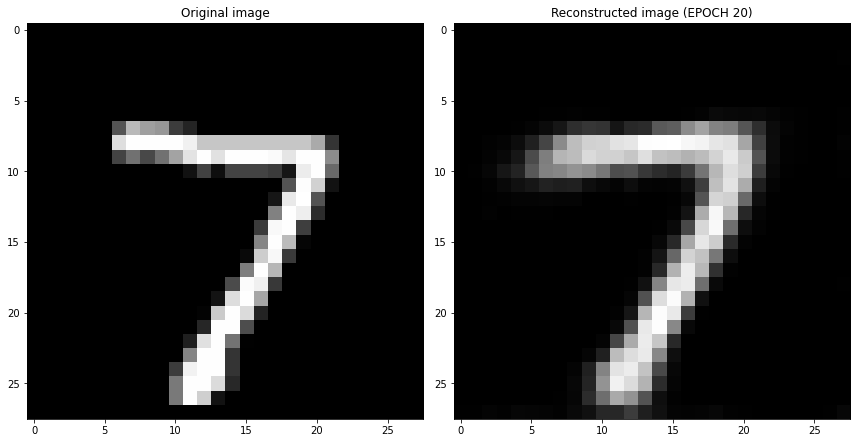

EPOCH 21/30
	 partial train loss (single batch): 0.024820
	 partial train loss (single batch): 0.022941
	 partial train loss (single batch): 0.023714
	 partial train loss (single batch): 0.023769
	 partial train loss (single batch): 0.022694
	 partial train loss (single batch): 0.023297
	 partial train loss (single batch): 0.023497
	 partial train loss (single batch): 0.025629
	 partial train loss (single batch): 0.024171
	 partial train loss (single batch): 0.023477
	 partial train loss (single batch): 0.023568
	 partial train loss (single batch): 0.022439
	 partial train loss (single batch): 0.023617
	 partial train loss (single batch): 0.024892
	 partial train loss (single batch): 0.023767
	 partial train loss (single batch): 0.023351
	 partial train loss (single batch): 0.024718
	 partial train loss (single batch): 0.022747
	 partial train loss (single batch): 0.023071
	 partial train loss (single batch): 0.022993
	 partial train loss (single batch): 0.022179
	 partial train loss (

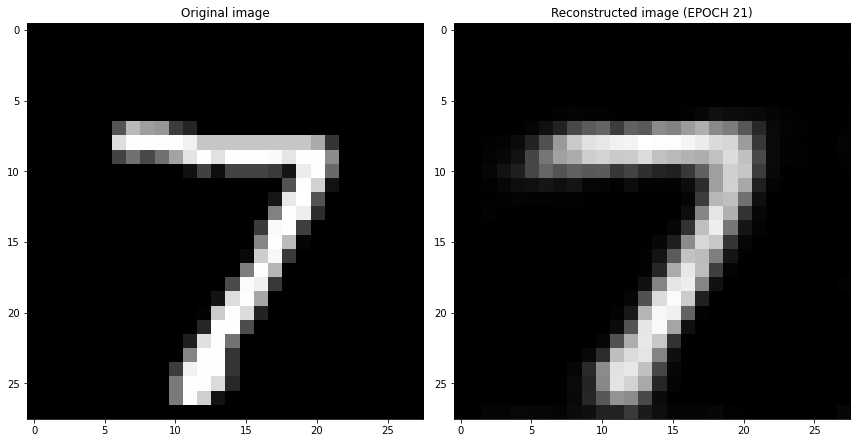

EPOCH 22/30
	 partial train loss (single batch): 0.023811
	 partial train loss (single batch): 0.023369
	 partial train loss (single batch): 0.023382
	 partial train loss (single batch): 0.022208
	 partial train loss (single batch): 0.022310
	 partial train loss (single batch): 0.022854
	 partial train loss (single batch): 0.022055
	 partial train loss (single batch): 0.021581
	 partial train loss (single batch): 0.023925
	 partial train loss (single batch): 0.023377
	 partial train loss (single batch): 0.024031
	 partial train loss (single batch): 0.023005
	 partial train loss (single batch): 0.022792
	 partial train loss (single batch): 0.023070
	 partial train loss (single batch): 0.022574
	 partial train loss (single batch): 0.023254
	 partial train loss (single batch): 0.022665
	 partial train loss (single batch): 0.022988
	 partial train loss (single batch): 0.022826
	 partial train loss (single batch): 0.023632
	 partial train loss (single batch): 0.024185
	 partial train loss (

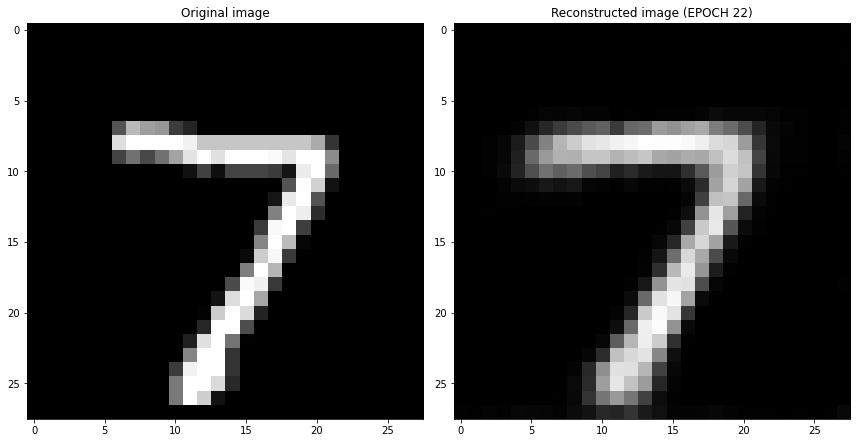

EPOCH 23/30
	 partial train loss (single batch): 0.024223
	 partial train loss (single batch): 0.023474
	 partial train loss (single batch): 0.022828
	 partial train loss (single batch): 0.025684
	 partial train loss (single batch): 0.023079
	 partial train loss (single batch): 0.023764
	 partial train loss (single batch): 0.022784
	 partial train loss (single batch): 0.021555
	 partial train loss (single batch): 0.023361
	 partial train loss (single batch): 0.023089
	 partial train loss (single batch): 0.024099
	 partial train loss (single batch): 0.023491
	 partial train loss (single batch): 0.022769
	 partial train loss (single batch): 0.022926
	 partial train loss (single batch): 0.022957
	 partial train loss (single batch): 0.022982
	 partial train loss (single batch): 0.023661
	 partial train loss (single batch): 0.024406
	 partial train loss (single batch): 0.023121
	 partial train loss (single batch): 0.023794
	 partial train loss (single batch): 0.023596
	 partial train loss (

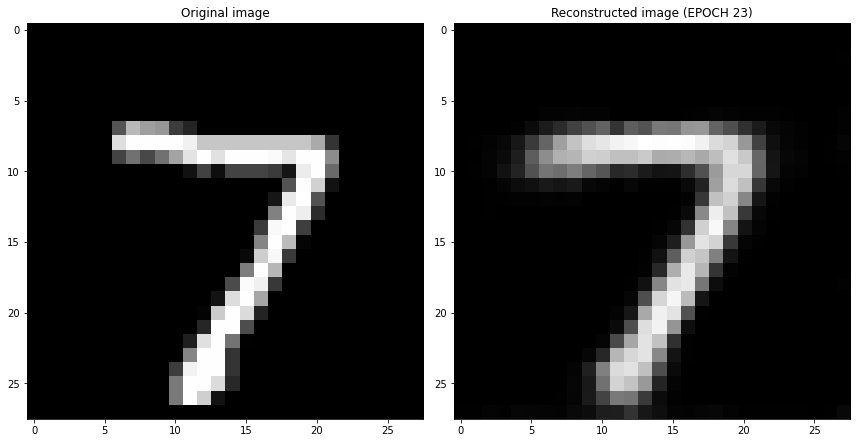

EPOCH 24/30
	 partial train loss (single batch): 0.023310
	 partial train loss (single batch): 0.022736
	 partial train loss (single batch): 0.023851
	 partial train loss (single batch): 0.022624
	 partial train loss (single batch): 0.022801
	 partial train loss (single batch): 0.022222
	 partial train loss (single batch): 0.023669
	 partial train loss (single batch): 0.022423
	 partial train loss (single batch): 0.024279
	 partial train loss (single batch): 0.023506
	 partial train loss (single batch): 0.022598
	 partial train loss (single batch): 0.022653
	 partial train loss (single batch): 0.023160
	 partial train loss (single batch): 0.021150
	 partial train loss (single batch): 0.021772
	 partial train loss (single batch): 0.024532
	 partial train loss (single batch): 0.022473
	 partial train loss (single batch): 0.023811
	 partial train loss (single batch): 0.024627
	 partial train loss (single batch): 0.021804
	 partial train loss (single batch): 0.022883
	 partial train loss (

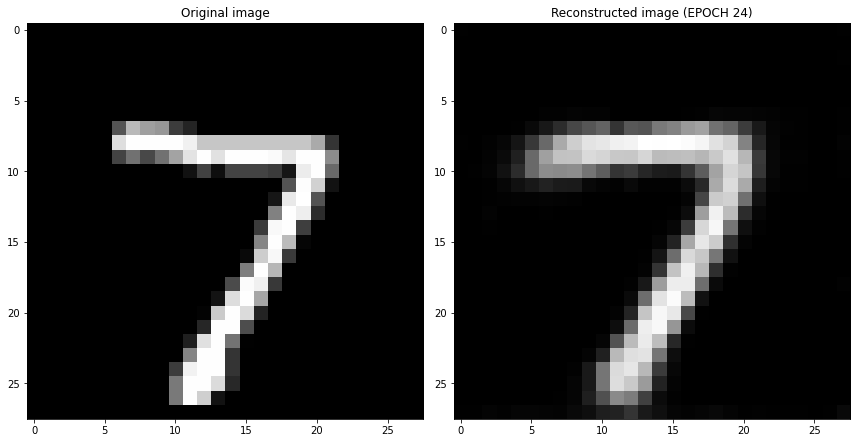

EPOCH 25/30
	 partial train loss (single batch): 0.024255
	 partial train loss (single batch): 0.021689
	 partial train loss (single batch): 0.024672
	 partial train loss (single batch): 0.023880
	 partial train loss (single batch): 0.022582
	 partial train loss (single batch): 0.024456
	 partial train loss (single batch): 0.021882
	 partial train loss (single batch): 0.023888
	 partial train loss (single batch): 0.023066
	 partial train loss (single batch): 0.022626
	 partial train loss (single batch): 0.023082
	 partial train loss (single batch): 0.022213
	 partial train loss (single batch): 0.023093
	 partial train loss (single batch): 0.023036
	 partial train loss (single batch): 0.021810
	 partial train loss (single batch): 0.024076
	 partial train loss (single batch): 0.022971
	 partial train loss (single batch): 0.023745
	 partial train loss (single batch): 0.022568
	 partial train loss (single batch): 0.022041
	 partial train loss (single batch): 0.023478
	 partial train loss (

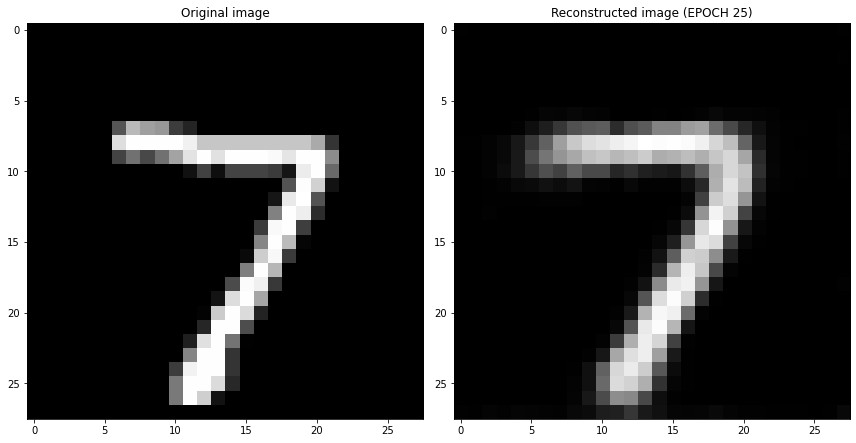

EPOCH 26/30
	 partial train loss (single batch): 0.023216
	 partial train loss (single batch): 0.022384
	 partial train loss (single batch): 0.021984
	 partial train loss (single batch): 0.021472
	 partial train loss (single batch): 0.021892
	 partial train loss (single batch): 0.022003
	 partial train loss (single batch): 0.022198
	 partial train loss (single batch): 0.023419
	 partial train loss (single batch): 0.023596
	 partial train loss (single batch): 0.022545
	 partial train loss (single batch): 0.022941
	 partial train loss (single batch): 0.023039
	 partial train loss (single batch): 0.023161
	 partial train loss (single batch): 0.021553
	 partial train loss (single batch): 0.022758
	 partial train loss (single batch): 0.023189
	 partial train loss (single batch): 0.022177
	 partial train loss (single batch): 0.022524
	 partial train loss (single batch): 0.023358
	 partial train loss (single batch): 0.023332
	 partial train loss (single batch): 0.022192
	 partial train loss (

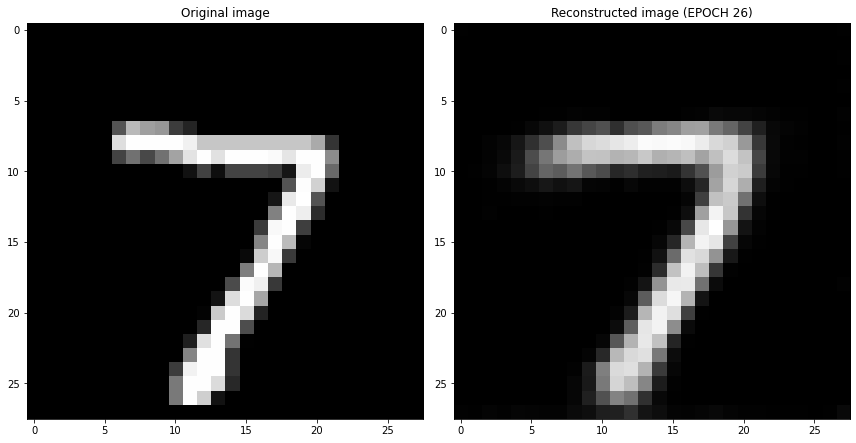

EPOCH 27/30
	 partial train loss (single batch): 0.022122
	 partial train loss (single batch): 0.023155
	 partial train loss (single batch): 0.023006
	 partial train loss (single batch): 0.022432
	 partial train loss (single batch): 0.021922
	 partial train loss (single batch): 0.023408
	 partial train loss (single batch): 0.022563
	 partial train loss (single batch): 0.021475
	 partial train loss (single batch): 0.023977
	 partial train loss (single batch): 0.023812
	 partial train loss (single batch): 0.022867
	 partial train loss (single batch): 0.022292
	 partial train loss (single batch): 0.021993
	 partial train loss (single batch): 0.023572
	 partial train loss (single batch): 0.023814
	 partial train loss (single batch): 0.022711
	 partial train loss (single batch): 0.022198
	 partial train loss (single batch): 0.022168
	 partial train loss (single batch): 0.022775
	 partial train loss (single batch): 0.022473
	 partial train loss (single batch): 0.022539
	 partial train loss (

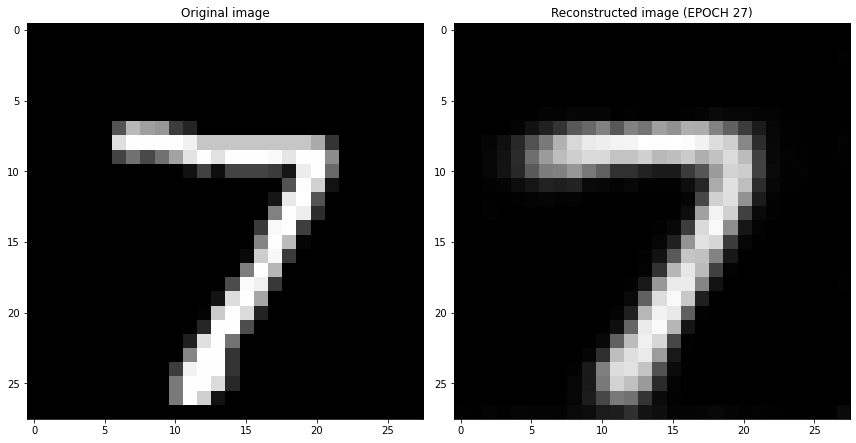

EPOCH 28/30
	 partial train loss (single batch): 0.023552
	 partial train loss (single batch): 0.023311
	 partial train loss (single batch): 0.022041
	 partial train loss (single batch): 0.022809
	 partial train loss (single batch): 0.023200
	 partial train loss (single batch): 0.022242
	 partial train loss (single batch): 0.021121
	 partial train loss (single batch): 0.023378
	 partial train loss (single batch): 0.022269
	 partial train loss (single batch): 0.021986
	 partial train loss (single batch): 0.021759
	 partial train loss (single batch): 0.022711
	 partial train loss (single batch): 0.023053
	 partial train loss (single batch): 0.022276
	 partial train loss (single batch): 0.023253
	 partial train loss (single batch): 0.020673
	 partial train loss (single batch): 0.022192
	 partial train loss (single batch): 0.023138
	 partial train loss (single batch): 0.021935
	 partial train loss (single batch): 0.024479
	 partial train loss (single batch): 0.023035
	 partial train loss (

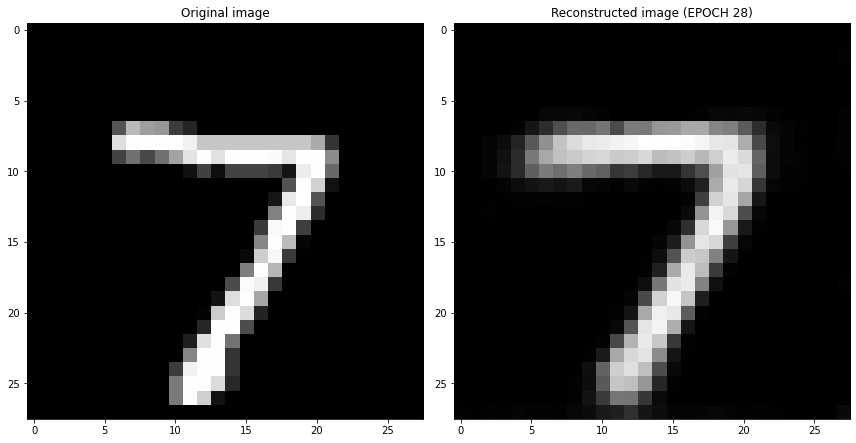

EPOCH 29/30
	 partial train loss (single batch): 0.023154
	 partial train loss (single batch): 0.023783
	 partial train loss (single batch): 0.023184
	 partial train loss (single batch): 0.021563
	 partial train loss (single batch): 0.021592
	 partial train loss (single batch): 0.022647
	 partial train loss (single batch): 0.021296
	 partial train loss (single batch): 0.022184
	 partial train loss (single batch): 0.022175
	 partial train loss (single batch): 0.022116
	 partial train loss (single batch): 0.022976
	 partial train loss (single batch): 0.022173
	 partial train loss (single batch): 0.021809
	 partial train loss (single batch): 0.020517
	 partial train loss (single batch): 0.021038
	 partial train loss (single batch): 0.023538
	 partial train loss (single batch): 0.022537
	 partial train loss (single batch): 0.023475
	 partial train loss (single batch): 0.021240
	 partial train loss (single batch): 0.021993
	 partial train loss (single batch): 0.022372
	 partial train loss (

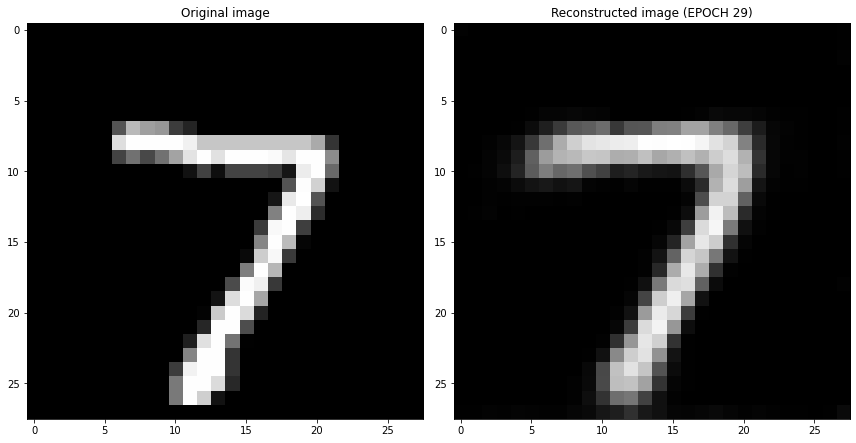

EPOCH 30/30
	 partial train loss (single batch): 0.021960
	 partial train loss (single batch): 0.022091
	 partial train loss (single batch): 0.022613
	 partial train loss (single batch): 0.022862
	 partial train loss (single batch): 0.022314
	 partial train loss (single batch): 0.021823
	 partial train loss (single batch): 0.021401
	 partial train loss (single batch): 0.023324
	 partial train loss (single batch): 0.023616
	 partial train loss (single batch): 0.022990
	 partial train loss (single batch): 0.023278
	 partial train loss (single batch): 0.023259
	 partial train loss (single batch): 0.022761
	 partial train loss (single batch): 0.022267
	 partial train loss (single batch): 0.021983
	 partial train loss (single batch): 0.021460
	 partial train loss (single batch): 0.023076
	 partial train loss (single batch): 0.023012
	 partial train loss (single batch): 0.021937
	 partial train loss (single batch): 0.021909
	 partial train loss (single batch): 0.021923
	 partial train loss (

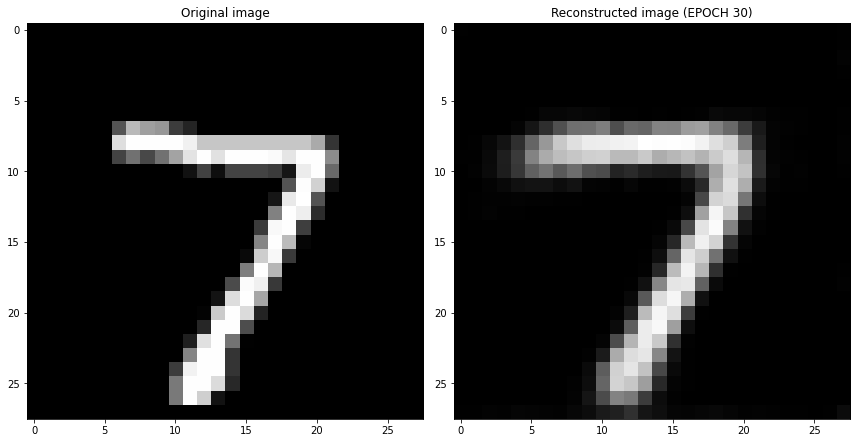

Cross validation fold number= 6/6
EPOCH 1/30
	 partial train loss (single batch): 0.208777
	 partial train loss (single batch): 0.208622
	 partial train loss (single batch): 0.208407
	 partial train loss (single batch): 0.208232
	 partial train loss (single batch): 0.207767
	 partial train loss (single batch): 0.207199
	 partial train loss (single batch): 0.207473
	 partial train loss (single batch): 0.206736
	 partial train loss (single batch): 0.206121
	 partial train loss (single batch): 0.205959
	 partial train loss (single batch): 0.205835
	 partial train loss (single batch): 0.205373
	 partial train loss (single batch): 0.204950
	 partial train loss (single batch): 0.204762
	 partial train loss (single batch): 0.204485
	 partial train loss (single batch): 0.204517
	 partial train loss (single batch): 0.204073
	 partial train loss (single batch): 0.203287
	 partial train loss (single batch): 0.202766
	 partial train loss (single batch): 0.202372
	 partial train loss (single batch)

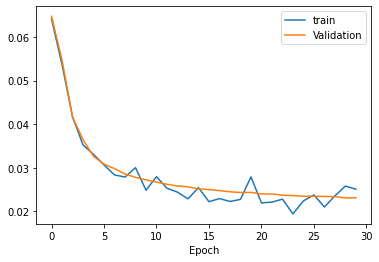

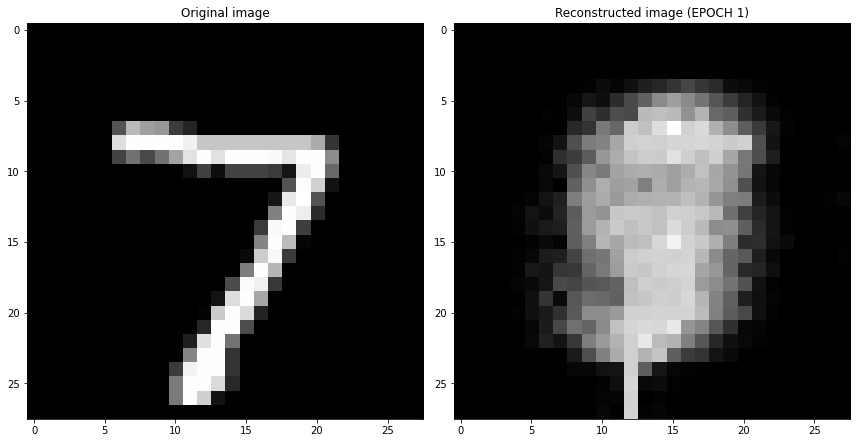

EPOCH 2/30
	 partial train loss (single batch): 0.066777
	 partial train loss (single batch): 0.066222
	 partial train loss (single batch): 0.064522
	 partial train loss (single batch): 0.068109
	 partial train loss (single batch): 0.068109
	 partial train loss (single batch): 0.064754
	 partial train loss (single batch): 0.067253
	 partial train loss (single batch): 0.063729
	 partial train loss (single batch): 0.065465
	 partial train loss (single batch): 0.065577
	 partial train loss (single batch): 0.066631
	 partial train loss (single batch): 0.066027
	 partial train loss (single batch): 0.068431
	 partial train loss (single batch): 0.065670
	 partial train loss (single batch): 0.065480
	 partial train loss (single batch): 0.068090
	 partial train loss (single batch): 0.065333
	 partial train loss (single batch): 0.065726
	 partial train loss (single batch): 0.065639
	 partial train loss (single batch): 0.065592
	 partial train loss (single batch): 0.063784
	 partial train loss (s

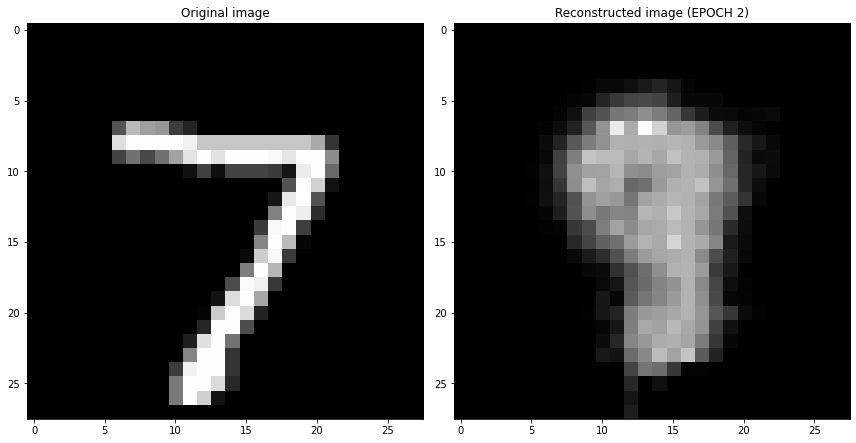

EPOCH 3/30
	 partial train loss (single batch): 0.055851
	 partial train loss (single batch): 0.057742
	 partial train loss (single batch): 0.056902
	 partial train loss (single batch): 0.057505
	 partial train loss (single batch): 0.056239
	 partial train loss (single batch): 0.057599
	 partial train loss (single batch): 0.056636
	 partial train loss (single batch): 0.056983
	 partial train loss (single batch): 0.056485
	 partial train loss (single batch): 0.055606
	 partial train loss (single batch): 0.055501
	 partial train loss (single batch): 0.057013
	 partial train loss (single batch): 0.057946
	 partial train loss (single batch): 0.054397
	 partial train loss (single batch): 0.057015
	 partial train loss (single batch): 0.056216
	 partial train loss (single batch): 0.055334
	 partial train loss (single batch): 0.056628
	 partial train loss (single batch): 0.054617
	 partial train loss (single batch): 0.055650
	 partial train loss (single batch): 0.056980
	 partial train loss (s

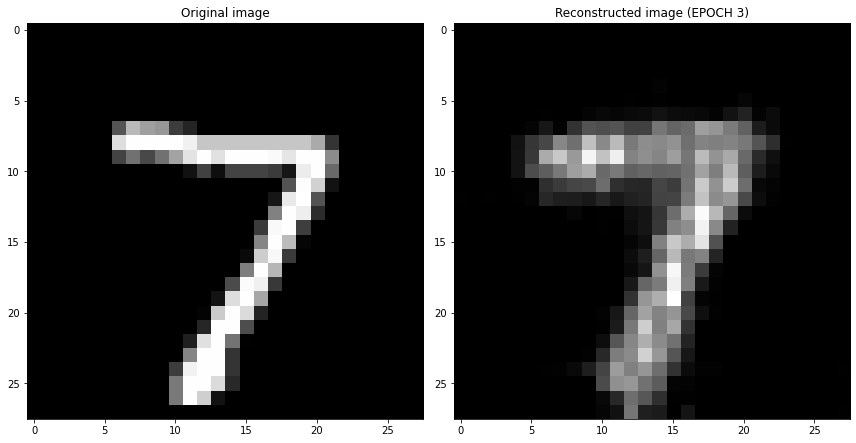

EPOCH 4/30
	 partial train loss (single batch): 0.044657
	 partial train loss (single batch): 0.042924
	 partial train loss (single batch): 0.043539
	 partial train loss (single batch): 0.044175
	 partial train loss (single batch): 0.044054
	 partial train loss (single batch): 0.043663
	 partial train loss (single batch): 0.042305
	 partial train loss (single batch): 0.042896
	 partial train loss (single batch): 0.043363
	 partial train loss (single batch): 0.042656
	 partial train loss (single batch): 0.042356
	 partial train loss (single batch): 0.043663
	 partial train loss (single batch): 0.045063
	 partial train loss (single batch): 0.043033
	 partial train loss (single batch): 0.042830
	 partial train loss (single batch): 0.044290
	 partial train loss (single batch): 0.043052
	 partial train loss (single batch): 0.040418
	 partial train loss (single batch): 0.042127
	 partial train loss (single batch): 0.042026
	 partial train loss (single batch): 0.044305
	 partial train loss (s

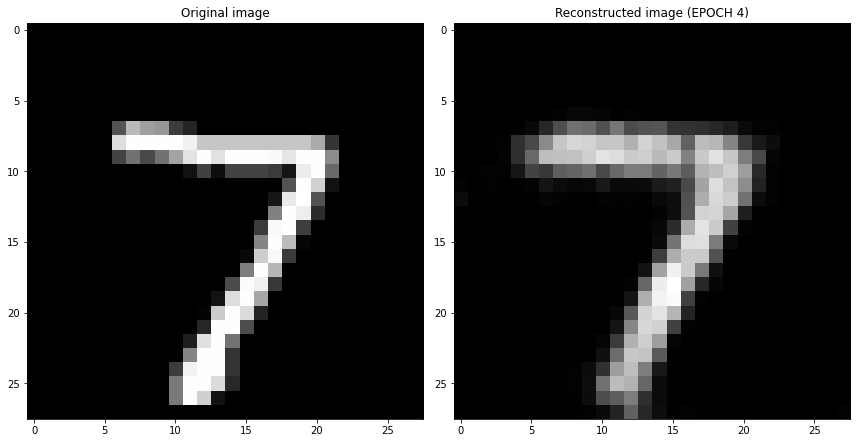

EPOCH 5/30
	 partial train loss (single batch): 0.036588
	 partial train loss (single batch): 0.034458
	 partial train loss (single batch): 0.035926
	 partial train loss (single batch): 0.035607
	 partial train loss (single batch): 0.035994
	 partial train loss (single batch): 0.033070
	 partial train loss (single batch): 0.033749
	 partial train loss (single batch): 0.035336
	 partial train loss (single batch): 0.035186
	 partial train loss (single batch): 0.032659
	 partial train loss (single batch): 0.034616
	 partial train loss (single batch): 0.035723
	 partial train loss (single batch): 0.034866
	 partial train loss (single batch): 0.035457
	 partial train loss (single batch): 0.033990
	 partial train loss (single batch): 0.034765
	 partial train loss (single batch): 0.034641
	 partial train loss (single batch): 0.035426
	 partial train loss (single batch): 0.035304
	 partial train loss (single batch): 0.034519
	 partial train loss (single batch): 0.033361
	 partial train loss (s

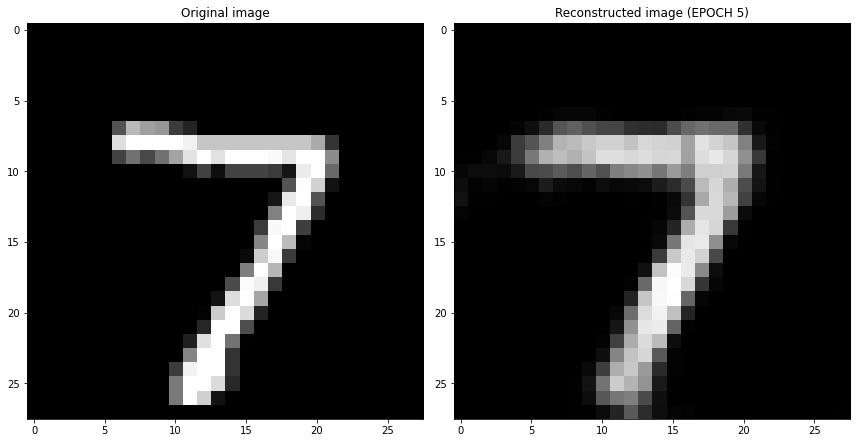

EPOCH 6/30
	 partial train loss (single batch): 0.031601
	 partial train loss (single batch): 0.031935
	 partial train loss (single batch): 0.030926
	 partial train loss (single batch): 0.032974
	 partial train loss (single batch): 0.032974
	 partial train loss (single batch): 0.031178
	 partial train loss (single batch): 0.032713
	 partial train loss (single batch): 0.032507
	 partial train loss (single batch): 0.030795
	 partial train loss (single batch): 0.030762
	 partial train loss (single batch): 0.031853
	 partial train loss (single batch): 0.031259
	 partial train loss (single batch): 0.031836
	 partial train loss (single batch): 0.031279
	 partial train loss (single batch): 0.030541
	 partial train loss (single batch): 0.033204
	 partial train loss (single batch): 0.033661
	 partial train loss (single batch): 0.032468
	 partial train loss (single batch): 0.032161
	 partial train loss (single batch): 0.030564
	 partial train loss (single batch): 0.032722
	 partial train loss (s

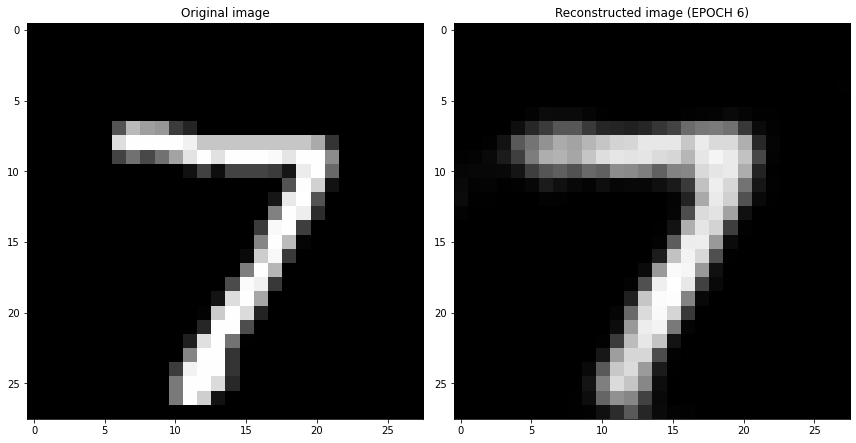

EPOCH 7/30
	 partial train loss (single batch): 0.029272
	 partial train loss (single batch): 0.030320
	 partial train loss (single batch): 0.030441
	 partial train loss (single batch): 0.029269
	 partial train loss (single batch): 0.031847
	 partial train loss (single batch): 0.030787
	 partial train loss (single batch): 0.030245
	 partial train loss (single batch): 0.028516
	 partial train loss (single batch): 0.031108
	 partial train loss (single batch): 0.031451
	 partial train loss (single batch): 0.030181
	 partial train loss (single batch): 0.030073
	 partial train loss (single batch): 0.031020
	 partial train loss (single batch): 0.028451
	 partial train loss (single batch): 0.030474
	 partial train loss (single batch): 0.028795
	 partial train loss (single batch): 0.029405
	 partial train loss (single batch): 0.030880
	 partial train loss (single batch): 0.030809
	 partial train loss (single batch): 0.030796
	 partial train loss (single batch): 0.030377
	 partial train loss (s

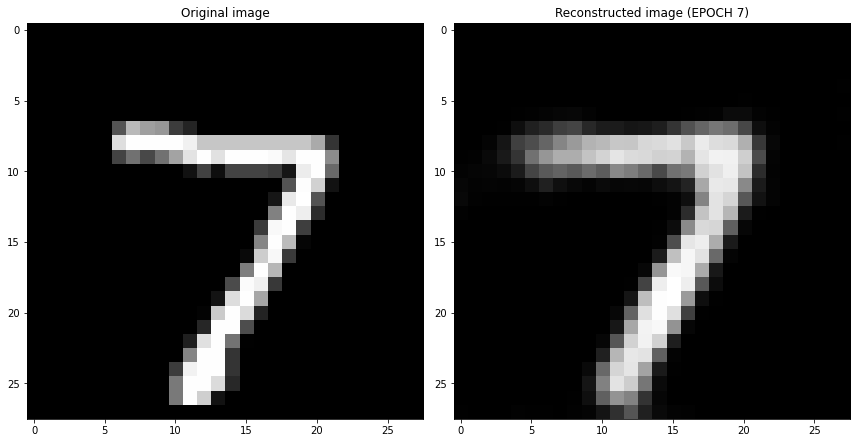

EPOCH 8/30
	 partial train loss (single batch): 0.027523
	 partial train loss (single batch): 0.027340
	 partial train loss (single batch): 0.028870
	 partial train loss (single batch): 0.028717
	 partial train loss (single batch): 0.030057
	 partial train loss (single batch): 0.026945
	 partial train loss (single batch): 0.028560
	 partial train loss (single batch): 0.027238
	 partial train loss (single batch): 0.027779
	 partial train loss (single batch): 0.027063
	 partial train loss (single batch): 0.031619
	 partial train loss (single batch): 0.029372
	 partial train loss (single batch): 0.028984
	 partial train loss (single batch): 0.028359
	 partial train loss (single batch): 0.028816
	 partial train loss (single batch): 0.028393
	 partial train loss (single batch): 0.028100
	 partial train loss (single batch): 0.029113
	 partial train loss (single batch): 0.028773
	 partial train loss (single batch): 0.030100
	 partial train loss (single batch): 0.029935
	 partial train loss (s

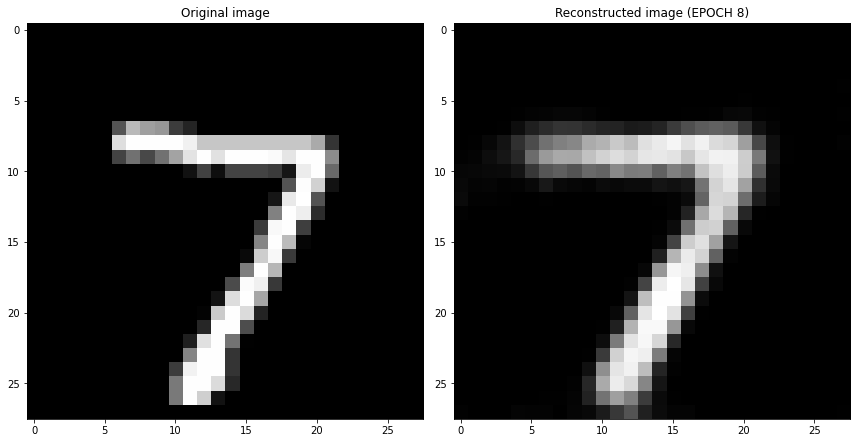

EPOCH 9/30
	 partial train loss (single batch): 0.027462
	 partial train loss (single batch): 0.026858
	 partial train loss (single batch): 0.027742
	 partial train loss (single batch): 0.027545
	 partial train loss (single batch): 0.027689
	 partial train loss (single batch): 0.027338
	 partial train loss (single batch): 0.027053
	 partial train loss (single batch): 0.028894
	 partial train loss (single batch): 0.027707
	 partial train loss (single batch): 0.027041
	 partial train loss (single batch): 0.026753
	 partial train loss (single batch): 0.029514
	 partial train loss (single batch): 0.028706
	 partial train loss (single batch): 0.026564
	 partial train loss (single batch): 0.027756
	 partial train loss (single batch): 0.026707
	 partial train loss (single batch): 0.027950
	 partial train loss (single batch): 0.028387
	 partial train loss (single batch): 0.028439
	 partial train loss (single batch): 0.028638
	 partial train loss (single batch): 0.027825
	 partial train loss (s

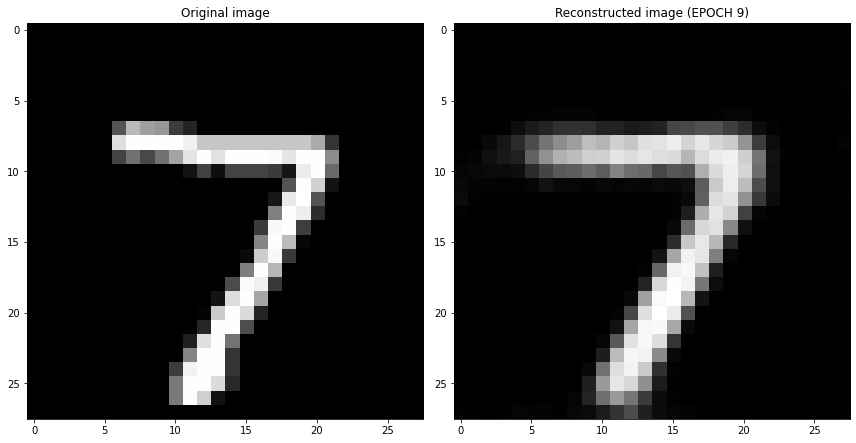

EPOCH 10/30
	 partial train loss (single batch): 0.026904
	 partial train loss (single batch): 0.026498
	 partial train loss (single batch): 0.025651
	 partial train loss (single batch): 0.026783
	 partial train loss (single batch): 0.026128
	 partial train loss (single batch): 0.026078
	 partial train loss (single batch): 0.026268
	 partial train loss (single batch): 0.025953
	 partial train loss (single batch): 0.024817
	 partial train loss (single batch): 0.027819
	 partial train loss (single batch): 0.028418
	 partial train loss (single batch): 0.026215
	 partial train loss (single batch): 0.027240
	 partial train loss (single batch): 0.026336
	 partial train loss (single batch): 0.025372
	 partial train loss (single batch): 0.025926
	 partial train loss (single batch): 0.026855
	 partial train loss (single batch): 0.027114
	 partial train loss (single batch): 0.026407
	 partial train loss (single batch): 0.027313
	 partial train loss (single batch): 0.024452
	 partial train loss (

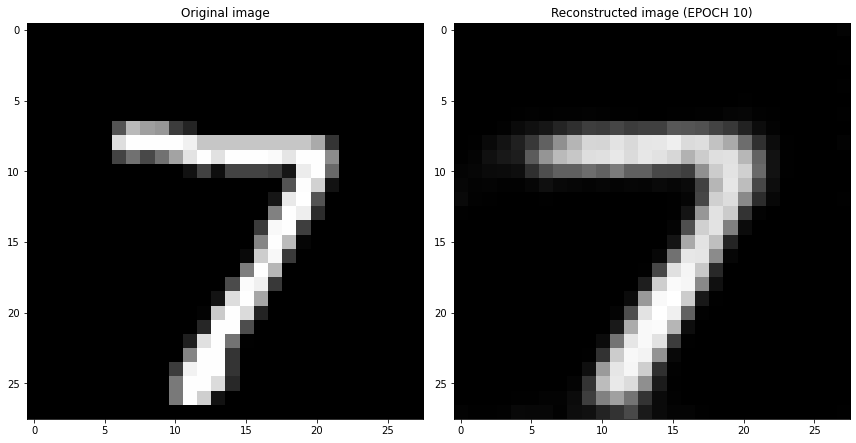

EPOCH 11/30
	 partial train loss (single batch): 0.026990
	 partial train loss (single batch): 0.025567
	 partial train loss (single batch): 0.024472
	 partial train loss (single batch): 0.025033
	 partial train loss (single batch): 0.025085
	 partial train loss (single batch): 0.026595
	 partial train loss (single batch): 0.026528
	 partial train loss (single batch): 0.027118
	 partial train loss (single batch): 0.026001
	 partial train loss (single batch): 0.027815
	 partial train loss (single batch): 0.026559
	 partial train loss (single batch): 0.025723
	 partial train loss (single batch): 0.027022
	 partial train loss (single batch): 0.026692
	 partial train loss (single batch): 0.025739
	 partial train loss (single batch): 0.025985
	 partial train loss (single batch): 0.025908
	 partial train loss (single batch): 0.026688
	 partial train loss (single batch): 0.024974
	 partial train loss (single batch): 0.025218
	 partial train loss (single batch): 0.024755
	 partial train loss (

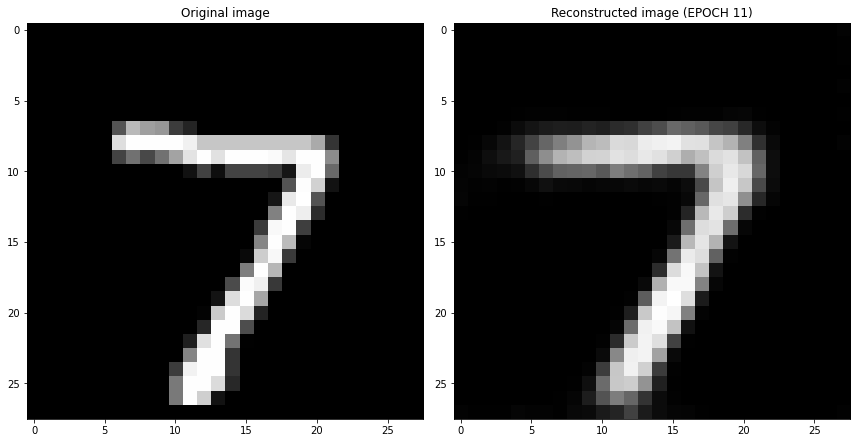

EPOCH 12/30
	 partial train loss (single batch): 0.024178
	 partial train loss (single batch): 0.025006
	 partial train loss (single batch): 0.026407
	 partial train loss (single batch): 0.025476
	 partial train loss (single batch): 0.025771
	 partial train loss (single batch): 0.026675
	 partial train loss (single batch): 0.026691
	 partial train loss (single batch): 0.025891
	 partial train loss (single batch): 0.026601
	 partial train loss (single batch): 0.025322
	 partial train loss (single batch): 0.024960
	 partial train loss (single batch): 0.027038
	 partial train loss (single batch): 0.024929
	 partial train loss (single batch): 0.025416
	 partial train loss (single batch): 0.026358
	 partial train loss (single batch): 0.025404
	 partial train loss (single batch): 0.026055
	 partial train loss (single batch): 0.027348
	 partial train loss (single batch): 0.025343
	 partial train loss (single batch): 0.024735
	 partial train loss (single batch): 0.027310
	 partial train loss (

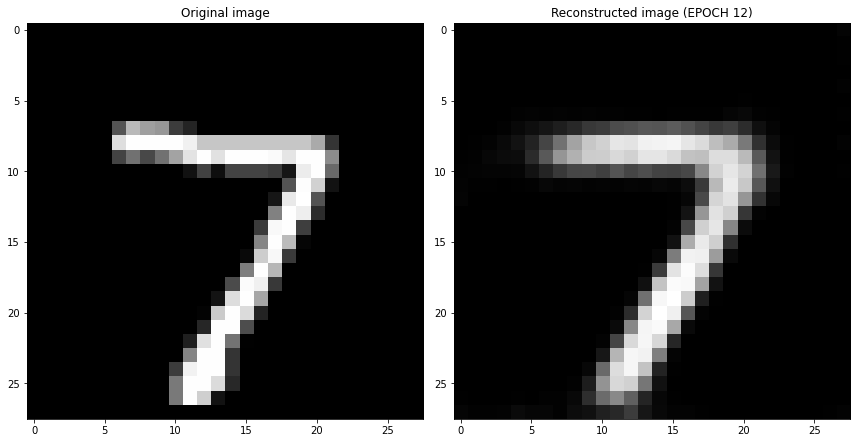

EPOCH 13/30
	 partial train loss (single batch): 0.024754
	 partial train loss (single batch): 0.026045
	 partial train loss (single batch): 0.023909
	 partial train loss (single batch): 0.025038
	 partial train loss (single batch): 0.024224
	 partial train loss (single batch): 0.026277
	 partial train loss (single batch): 0.025610
	 partial train loss (single batch): 0.025560
	 partial train loss (single batch): 0.024167
	 partial train loss (single batch): 0.024096
	 partial train loss (single batch): 0.024734
	 partial train loss (single batch): 0.025065
	 partial train loss (single batch): 0.024931
	 partial train loss (single batch): 0.026264
	 partial train loss (single batch): 0.024523
	 partial train loss (single batch): 0.025517
	 partial train loss (single batch): 0.024159
	 partial train loss (single batch): 0.024270
	 partial train loss (single batch): 0.024759
	 partial train loss (single batch): 0.025222
	 partial train loss (single batch): 0.024405
	 partial train loss (

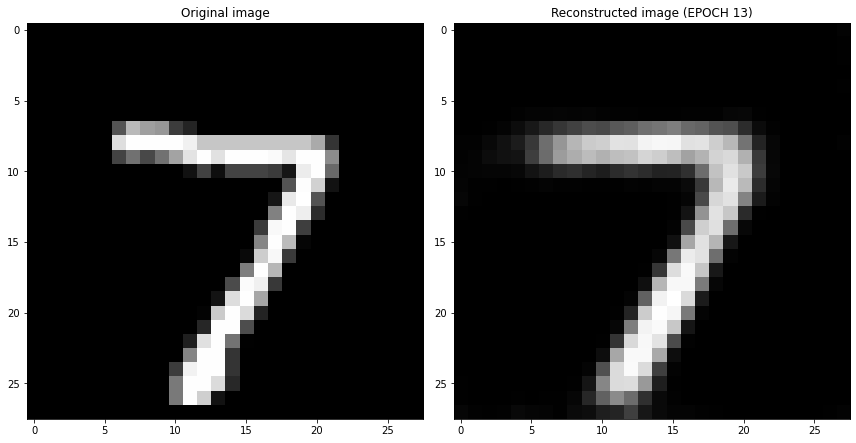

EPOCH 14/30
	 partial train loss (single batch): 0.025012
	 partial train loss (single batch): 0.024004
	 partial train loss (single batch): 0.025137
	 partial train loss (single batch): 0.025139
	 partial train loss (single batch): 0.025751
	 partial train loss (single batch): 0.024466
	 partial train loss (single batch): 0.023239
	 partial train loss (single batch): 0.025123
	 partial train loss (single batch): 0.025362
	 partial train loss (single batch): 0.025974
	 partial train loss (single batch): 0.023762
	 partial train loss (single batch): 0.024422
	 partial train loss (single batch): 0.023943
	 partial train loss (single batch): 0.024544
	 partial train loss (single batch): 0.024295
	 partial train loss (single batch): 0.025337
	 partial train loss (single batch): 0.024565
	 partial train loss (single batch): 0.024895
	 partial train loss (single batch): 0.025163
	 partial train loss (single batch): 0.024503
	 partial train loss (single batch): 0.024950
	 partial train loss (

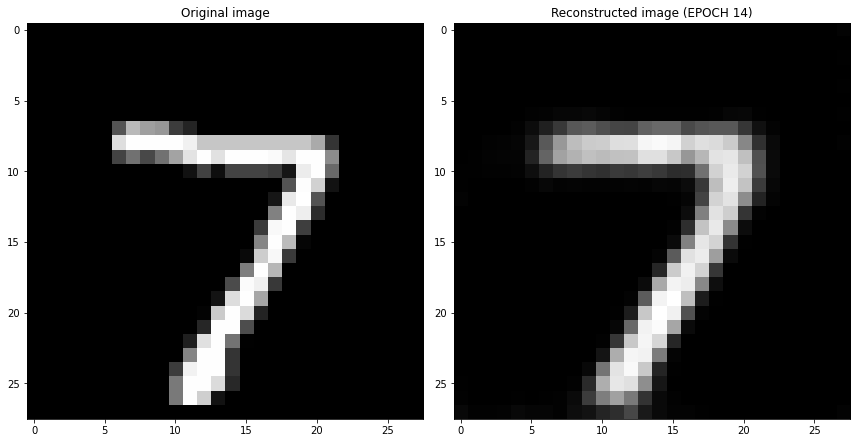

EPOCH 15/30
	 partial train loss (single batch): 0.022117
	 partial train loss (single batch): 0.024582
	 partial train loss (single batch): 0.025079
	 partial train loss (single batch): 0.024152
	 partial train loss (single batch): 0.024691
	 partial train loss (single batch): 0.025841
	 partial train loss (single batch): 0.025681
	 partial train loss (single batch): 0.025124
	 partial train loss (single batch): 0.025421
	 partial train loss (single batch): 0.026205
	 partial train loss (single batch): 0.023450
	 partial train loss (single batch): 0.024676
	 partial train loss (single batch): 0.025733
	 partial train loss (single batch): 0.023881
	 partial train loss (single batch): 0.025091
	 partial train loss (single batch): 0.024275
	 partial train loss (single batch): 0.025197
	 partial train loss (single batch): 0.024738
	 partial train loss (single batch): 0.025012
	 partial train loss (single batch): 0.025388
	 partial train loss (single batch): 0.023844
	 partial train loss (

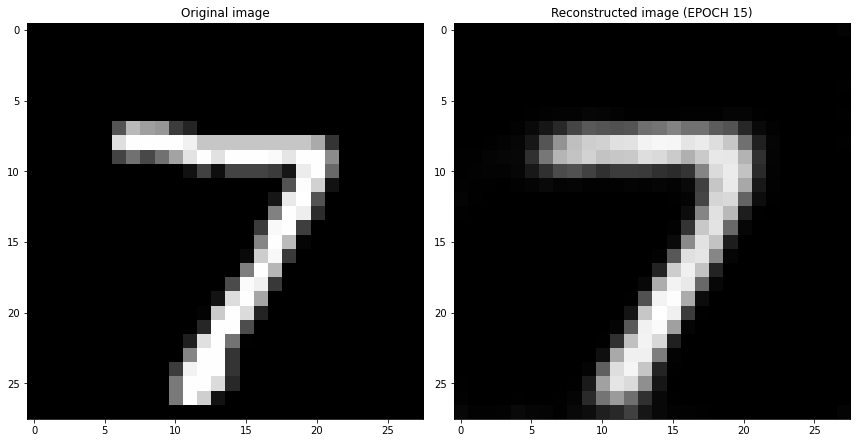

EPOCH 16/30
	 partial train loss (single batch): 0.024142
	 partial train loss (single batch): 0.024440
	 partial train loss (single batch): 0.022980
	 partial train loss (single batch): 0.024545
	 partial train loss (single batch): 0.023270
	 partial train loss (single batch): 0.024021
	 partial train loss (single batch): 0.023921
	 partial train loss (single batch): 0.025015
	 partial train loss (single batch): 0.024293
	 partial train loss (single batch): 0.022880
	 partial train loss (single batch): 0.023659
	 partial train loss (single batch): 0.023721
	 partial train loss (single batch): 0.024174
	 partial train loss (single batch): 0.023813
	 partial train loss (single batch): 0.024168
	 partial train loss (single batch): 0.024829
	 partial train loss (single batch): 0.024483
	 partial train loss (single batch): 0.024215
	 partial train loss (single batch): 0.025675
	 partial train loss (single batch): 0.023651
	 partial train loss (single batch): 0.023783
	 partial train loss (

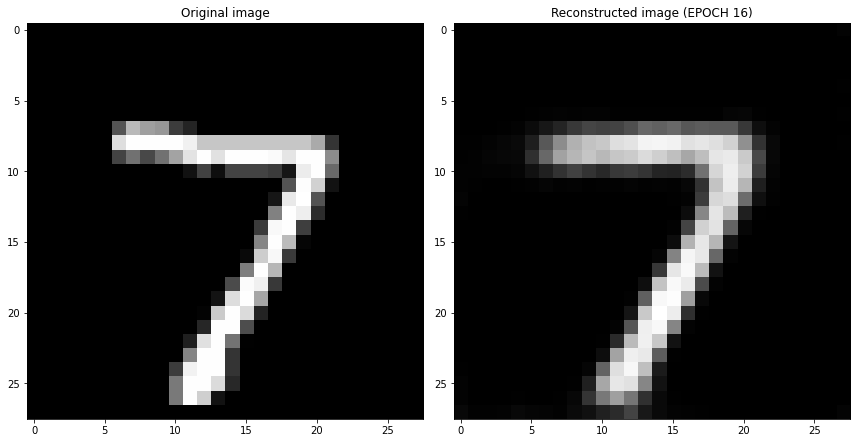

In [ ]:
from sklearn.model_selection import KFold

### Set the random seed for reproducible results
torch.manual_seed(0)

#Grid search space for leaning rate parameter and latent space dimension
learning_rate=[1e-3, 1e-2, 1e-1]
encoded_space_dim=[2,4,6,8,10]

#keeping track of the mean of training and validation losses for final choice of parameters:
final_training_loss =[]
final_validation_loss=[]
kfold =KFold(n_splits=6,random_state=None, shuffle=False)
### Training cycle
num_epochs = 30

for dim in encoded_space_dim:
  for lr in learning_rate:
    for fold, (train_index, val_index) in enumerate(kfold.split(x_train, y_train)):
      #initialise encoder and decoder
      encoder = Encoder(encoded_space_dim=dim)
      decoder = Decoder(encoded_space_dim=dim)

      ### Define the loss function
      loss_fn = torch.nn.MSELoss()
      params_to_optimize = [
        {'params': encoder.parameters()},
        {'params': decoder.parameters()}
      ]

      #Move both the encoder and the decoder to the selected device
      encoder.to(device)
      decoder.to(device)
      optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=1e-5)
      #optim = torch.optim.SGD(params_to_optimize, lr=lr, momentum=0.9, weight_decay=1e-5)

      #training and validation loss for each fold
      list_training_loss=[]
      list_validation_loss=[]

      #defining the dataloader for the training and validation sets:
      x_train_fold =torch.from_numpy(np.array(x_train)[train_index]) 
      y_train_fold =torch.from_numpy(np.array(y_train)[train_index])
      x_val_fold = torch.from_numpy(np.array(x_train)[val_index])
      y_val_fold =torch.from_numpy(np.array(y_train)[val_index])

      trainfold_dataset=TensorDataset(x_train_fold,y_train_fold)
      valfold_dataset=TensorDataset(x_val_fold,y_val_fold) 

      train_dataloader=DataLoader(dataset=trainfold_dataset,
                         batch_size=256,
                         shuffle=True,
                         )
      test_dataloader=DataLoader(dataset=valfold_dataset,
                         batch_size=256,
                         shuffle=True,
                         )
      print('Cross validation fold number= %d/%d' % (fold+1, 6))
      #keep training and validation info for each epoch
      train_log=[]
      Val_log=[]
      
      

      for epoch in range(num_epochs):
          print('EPOCH %d/%d' % (epoch + 1, num_epochs))
          trainCost_=[]
          testCost_=[]
          ### Training (use the training function)
          train_epoch(
              encoder=encoder, 
              decoder=decoder, 
              device=device, 
              dataloader=train_dataloader, 
              loss_fn=loss_fn, 
              optimizer=optim,trainCost_=trainCost_)
          train_log.append(torch.mean(torch.stack(trainCost_)))
          # Print mean of training loss for each epoch
          print('\n\n\t MEAN TRAINING LOSS - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs,torch.mean(torch.stack(trainCost_))))

          ### Validation  (use the testing function)
          val_loss = test_epoch(
              encoder=encoder, 
              decoder=decoder, 
              device=device, 
              dataloader=test_dataloader, 
              loss_fn=loss_fn)
          Val_log.append(val_loss)
      
          # Print Validationloss
          print('\n\n\t VALIDATION - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs, val_loss))

          ### Plot progress
          # Get the output of a specific image (the test image at index 0 in this case)
          img = test_set[0][0].unsqueeze(0).to(device)
          encoder.eval()
          decoder.eval()
          with torch.no_grad():
              rec_img  = decoder(encoder(img))
          # Plot the reconstructed image
          fig, axs = plt.subplots(1, 2, figsize=(12,6))
          axs[0].imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
          axs[0].set_title('Original image')
          axs[1].imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')
          axs[1].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
          plt.tight_layout()
          plt.pause(0.1)
          # Save figures
          os.makedirs('autoencoder_progress_%d_features' % dim, exist_ok=True)
          fig.savefig('autoencoder_progress_%d_features/epoch_%d.jpg' % (dim, epoch + 1))
          plt.show()
          plt.close()

          # Save network parameters
          Path1="/content/encoder_paramsfold{}_lr{}_LatentDim{}.pth".format(fold, lr,dim)
          Path2="/content/decoder_paramsfold{}_lr{}_LatentDim{}.pth".format(fold, lr,dim)
          torch.save(encoder.state_dict(), Path1)
          torch.save(decoder.state_dict(), Path2)
      plt.plot(train_log, label="train")
      plt.plot( Val_log, label="Validation")
      plt.legend()
      plt.xlabel('Epoch')
      path3="/content/cost_regular{}_lr{}_LatentDim{}.png".format(fold, lr,dim)
      plt.savefig(path3)
      list_training_loss.append(train_log[-1])
      list_validation_loss.append(Val_log[-1])
    final_training_loss.append(torch.mean(torch.stack(list_training_loss)))
    final_validation_loss.append(torch.mean(torch.stack(list_validation_loss)))


### **Latent space representation**

In [ ]:
# Load network parameters
encoder.load_state_dict(torch.load('encoder_params.pth'))
decoder.load_state_dict(torch.load('decoder_params.pth'))

In [ ]:
### Get the encoded representation of the test samples
encoded_samples = []
for sample in tqdm(test_dataset):
    img = sample[0].unsqueeze(0).to(device)
    label = sample[1]
    # Encode image
    encoder.eval()
    with torch.no_grad():
        encoded_img  = encoder(img)
    # Append to list
    encoded_img = encoded_img.flatten().cpu().numpy()
    encoded_sample = {f"Enc. Variable {i}": enc for i, enc in enumerate(encoded_img)}
    encoded_sample['label'] = label
    encoded_samples.append(encoded_sample)

In [ ]:
# Convert to a dataframe
encoded_samples = pd.DataFrame(encoded_samples)
encoded_samples

Dimensionality reduction on latent space to visualize results:

In [ ]:
from sklearn.preprocessing import StandardScaler
#, 'Enc. Variable 3','Enc. Variable 4','Enc. Variable 5','Enc. Variable 6','Enc. Variable 7','Enc. Variable 8','Enc. Variable 9'
features = ['Enc. Variable 0', 'Enc. Variable 1', 'Enc. Variable 2']
x = encoded_samples.loc[:, features].values
x = StandardScaler().fit_transform(x)
y =encoded_samples.loc[:,['label']].values

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])
finalDf = pd.concat([principalDf,pd.DataFrame(y,columns=['label'])], axis = 1)

In [ ]:
finalDf

In [ ]:
import plotly.express as px
px.scatter(principalDf, x='principal component 1', y='principal component 2', color=finalDf.label.astype(str), opacity=0.7)

### **Classification :**

In [9]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [10]:
# In this case the train_transform and test_transform are the same, but we keep them separate for potential future updates
train_transform = transforms.Compose([
    transforms.ToTensor(),
])
test_transform = transforms.Compose([
    transforms.ToTensor(),
])

In [11]:
# Set the train transform
train_dataset.transform = train_transform
# Set the test transform
test_dataset.transform = test_transform

In [12]:
### Define train dataloader
train_dataloader = DataLoader(train_dataset, batch_size=256, shuffle=True)
### Define test dataloader
test_dataloader = DataLoader(test_dataset, batch_size=256, shuffle=False)

In [13]:
class Encoder(nn.Module):
    
    def __init__(self, encoded_space_dim):
        super().__init__()
        
        ### Convolutional section
        self.encoder_cnn = nn.Sequential(
            # First convolutional layer
            nn.Conv2d(1, 8, 3, stride=2, padding=1),
            nn.ReLU(True),
            # Second convolutional layer
            nn.Conv2d(8, 16, 3, stride=2, padding=1),
            nn.ReLU(True),
            # Third convolutional layer
            nn.Conv2d(16, 32, 3, stride=2, padding=0),
            nn.ReLU(True)
        )
        
        ### Flatten layer
        self.flatten = nn.Flatten(start_dim=1)

        ### Linear section
        self.encoder_lin = nn.Sequential(
            # First linear layer
            nn.Linear(3 * 3 * 32, 64),
            nn.ReLU(True),
            # Second linear layer
            nn.Linear(64, encoded_space_dim)
        )
        
    def forward(self, x):
        # Apply convolutions
        x = self.encoder_cnn(x)
        # Flatten
        x = self.flatten(x)
        # # Apply linear layers
        x = self.encoder_lin(x)
        return x

In [14]:
# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')
encoder = Encoder(encoded_space_dim=10)
encoder.to(device)

Selected device: cuda


Encoder(
  (encoder_cnn): Sequential(
    (0): Conv2d(1, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(8, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2))
    (5): ReLU(inplace=True)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (encoder_lin): Sequential(
    (0): Linear(in_features=288, out_features=64, bias=True)
    (1): ReLU(inplace=True)
    (2): Linear(in_features=64, out_features=10, bias=True)
  )
)

In [15]:
# Load network parameters
encoder.load_state_dict(torch.load('/content/drive/MyDrive/Homework2DL/encoder_params10.pth')) 

<All keys matched successfully>

In [16]:
torch.manual_seed(0)
criterion = nn.CrossEntropyLoss()
lr = 0.001 # Learning rate
params_to_optimize = [
    {'params': encoder.parameters()}
]
optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=1e-5)
optim.zero_grad()

encoder.to(device)
test_loss=[]
train_loss_log=[]
epochs=40
correct_predictions=0
for e in range(epochs):
          running_loss = 0
          train_loss=[]
          encoder.train()
          for images, labels in train_dataloader:

              images = images.view(-1,1,28,28).float().to(device)
              labels=labels.to(device)
              # Training pass
              optim.zero_grad()
        
              output = encoder(images)
              loss = criterion(output, labels)
        
              #This is where the model learns by backpropagating
              loss.backward()
        
              #And optimizes its weights here
              optim.step()
              running_loss += loss.item()
              # Save train loss for this batch
              loss_batch = loss.detach().cpu().numpy()
              train_loss.append(loss_batch)

   
          # Save average train loss
          train_loss = np.mean(train_loss)
          train_loss_log.append(train_loss)
    

          print("Epoch {}     - Average Training loss: {}".format(e, train_loss))
         


Epoch 0     - Average Training loss: 1.6219732761383057
Epoch 1     - Average Training loss: 0.20267288386821747
Epoch 2     - Average Training loss: 0.1473315805196762
Epoch 3     - Average Training loss: 0.1215921938419342
Epoch 4     - Average Training loss: 0.10284954309463501
Epoch 5     - Average Training loss: 0.08948145061731339
Epoch 6     - Average Training loss: 0.07956786453723907
Epoch 7     - Average Training loss: 0.0726144015789032
Epoch 8     - Average Training loss: 0.06574282050132751
Epoch 9     - Average Training loss: 0.05985723435878754
Epoch 10     - Average Training loss: 0.055980123579502106
Epoch 11     - Average Training loss: 0.05020088702440262
Epoch 12     - Average Training loss: 0.047887738794088364
Epoch 13     - Average Training loss: 0.04782448336482048
Epoch 14     - Average Training loss: 0.04410942643880844
Epoch 15     - Average Training loss: 0.03904809430241585
Epoch 16     - Average Training loss: 0.03622492775321007
Epoch 17     - Average Tra

In [17]:
for test_imgs, test_labels in test_dataloader:
      test_imgs = test_imgs.view(-1,1,28,28).float().to(device)
      test_labels=test_labels.to(device)       
      output = encoder(test_imgs)
      predicted = torch.max(output,1)[1]
      correct_predictions += (predicted == test_labels).sum()
      loss = criterion(output, test_labels)
      loss_batch = loss.detach().cpu().numpy()
      test_loss.append(loss_batch)
test_loss = np.mean(test_loss)
print("Result for model the auto-encoder classifier")
print(f"AVERAGE TEST LOSS: {test_loss}")
print("Test accuracy:{:.3f}% ".format( float(correct_predictions)*100 / (len(test_dataloader)*256)))

Result for model the auto-encoder classifier
AVERAGE TEST LOSS: 0.07922903448343277
Test accuracy:0.959% 


In [19]:
print("Result for model the auto-encoder classifier")
print(f"AVERAGE TEST LOSS: {test_loss}")
print("Test accuracy:{:.3f}% ".format( float(correct_predictions)*100 / (len(test_dataloader)*256)))

Result for model the auto-encoder classifier
AVERAGE TEST LOSS: 0.07922903448343277
Test accuracy:98.369% 


### **Denoising Auto-encoder**

In [20]:
class add_noise(object):
    def __init__(self, mean=0., std=1.):
        self.mean = mean
        self.std = std
    def __call__(self, tensor):
        return tensor + torch.randn(tensor.size()) * self.std + self.mean

In [29]:
### Download the data and create dataset
data_dir = 'dataset'
# With these commands the train and test datasets, respectively, are downloaded 
# automatically and stored in the local "data_dir" directory.
train_dataset = torchvision.datasets.MNIST(data_dir, train=True, download=True)
test_dataset  = torchvision.datasets.MNIST(data_dir, train=False, download=True)

train_transform = transforms.Compose([
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    add_noise(0., 0.2),
])
test_transform = transforms.Compose([
    transforms.RandomRotation(20),
    transforms.ToTensor(),
    add_noise(0., 0.2),    
])

# Set the train transform
train_dataset.transform = train_transform
# Set the test transform
test_dataset.transform = test_transform

### Define train dataloader
train_dataloader = DataLoader(train_dataset, batch_size=256, shuffle=True)
### Define test dataloader
test_dataloader = DataLoader(test_dataset, batch_size=256, shuffle=False)

Visualize denoised data

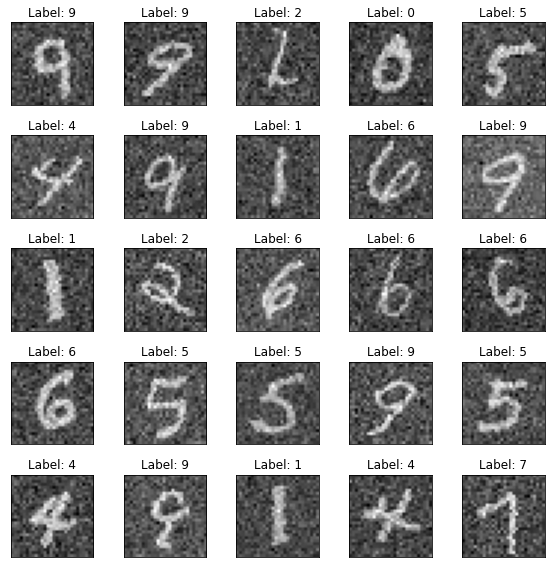

In [25]:
### Plot some sample
fig, axs = plt.subplots(5, 5, figsize=(8,8))
for ax in axs.flatten():
    # random.choice allows to randomly sample from a list-like object (basically anything that can be accessed with an index, like our dataset)
    img, label = random.choice(train_dataset)
    a=np.array(img).reshape(28,28)
    ax.imshow(a, cmap='gist_gray')
    ax.set_title('Label: %d' % label)
    ax.set_xticks([])
    ax.set_yticks([])
plt.tight_layout()

In [30]:
### Set the random seed for reproducible results
torch.manual_seed(0)
### Initialize the two networks
encoded_space_dim = 10
encoder = Encoder(encoded_space_dim=encoded_space_dim)
decoder = Decoder(encoded_space_dim=encoded_space_dim)
### Define the loss function
loss_fn = torch.nn.MSELoss()
### Define an optimizer (both for the encoder and the decoder!)
lr = 1e-3 # Learning rate
params_to_optimize = [
    {'params': encoder.parameters()},
    {'params': decoder.parameters()}
]
optim = torch.optim.Adam(params_to_optimize, lr=lr, weight_decay=1e-5)

# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
encoder.to(device)
decoder.to(device)

Selected device: cuda


Decoder(
  (decoder_lin): Sequential(
    (0): Linear(in_features=10, out_features=64, bias=True)
    (1): ReLU(inplace=True)
    (2): Linear(in_features=64, out_features=288, bias=True)
    (3): ReLU(inplace=True)
  )
  (unflatten): Unflatten(dim=1, unflattened_size=(32, 3, 3))
  (decoder_conv): Sequential(
    (0): ConvTranspose2d(32, 16, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU(inplace=True)
    (2): ConvTranspose2d(16, 8, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): ConvTranspose2d(8, 1, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), output_padding=(1, 1))
  )
)

EPOCH 1/40
	 partial train loss (single batch): 0.223324
	 partial train loss (single batch): 0.223659
	 partial train loss (single batch): 0.222568
	 partial train loss (single batch): 0.222793
	 partial train loss (single batch): 0.221507
	 partial train loss (single batch): 0.221304
	 partial train loss (single batch): 0.222036
	 partial train loss (single batch): 0.221242
	 partial train loss (single batch): 0.221225
	 partial train loss (single batch): 0.220541
	 partial train loss (single batch): 0.221090
	 partial train loss (single batch): 0.220674
	 partial train loss (single batch): 0.219528
	 partial train loss (single batch): 0.219479
	 partial train loss (single batch): 0.219105
	 partial train loss (single batch): 0.217614
	 partial train loss (single batch): 0.216890
	 partial train loss (single batch): 0.217021
	 partial train loss (single batch): 0.216714
	 partial train loss (single batch): 0.215468
	 partial train loss (single batch): 0.216209
	 partial train loss (s

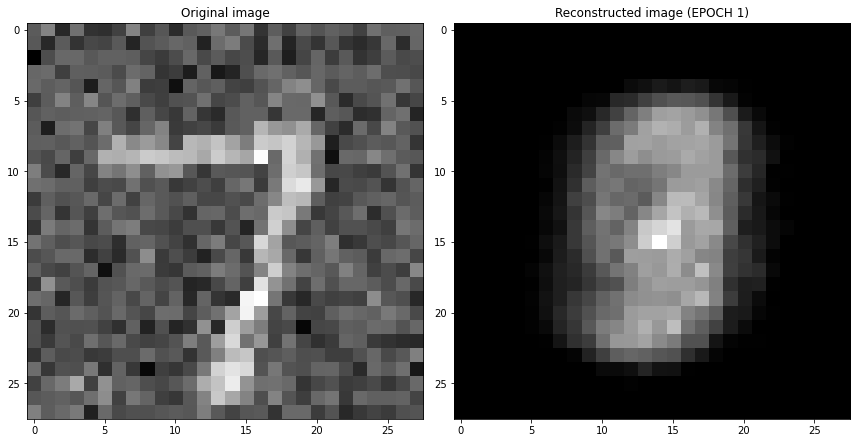

EPOCH 2/40
	 partial train loss (single batch): 0.105460
	 partial train loss (single batch): 0.105726
	 partial train loss (single batch): 0.104124
	 partial train loss (single batch): 0.103840
	 partial train loss (single batch): 0.103470
	 partial train loss (single batch): 0.104331
	 partial train loss (single batch): 0.104431
	 partial train loss (single batch): 0.104313
	 partial train loss (single batch): 0.108270
	 partial train loss (single batch): 0.102642
	 partial train loss (single batch): 0.106251
	 partial train loss (single batch): 0.104181
	 partial train loss (single batch): 0.106069
	 partial train loss (single batch): 0.105991
	 partial train loss (single batch): 0.107110
	 partial train loss (single batch): 0.106257
	 partial train loss (single batch): 0.104769
	 partial train loss (single batch): 0.105396
	 partial train loss (single batch): 0.104557
	 partial train loss (single batch): 0.105600
	 partial train loss (single batch): 0.104188
	 partial train loss (s

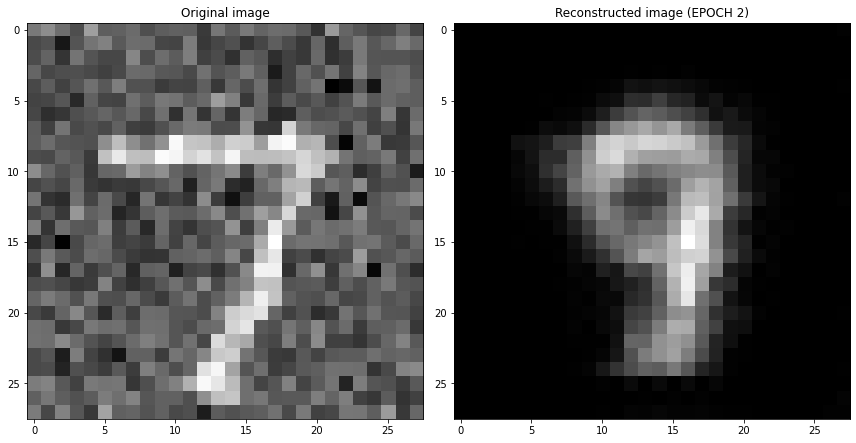

EPOCH 3/40
	 partial train loss (single batch): 0.089073
	 partial train loss (single batch): 0.090389
	 partial train loss (single batch): 0.090343
	 partial train loss (single batch): 0.088140
	 partial train loss (single batch): 0.088355
	 partial train loss (single batch): 0.088275
	 partial train loss (single batch): 0.089855
	 partial train loss (single batch): 0.088606
	 partial train loss (single batch): 0.088146
	 partial train loss (single batch): 0.089943
	 partial train loss (single batch): 0.087575
	 partial train loss (single batch): 0.087512
	 partial train loss (single batch): 0.086807
	 partial train loss (single batch): 0.087389
	 partial train loss (single batch): 0.087109
	 partial train loss (single batch): 0.089504
	 partial train loss (single batch): 0.087287
	 partial train loss (single batch): 0.087634
	 partial train loss (single batch): 0.088417
	 partial train loss (single batch): 0.088397
	 partial train loss (single batch): 0.088647
	 partial train loss (s

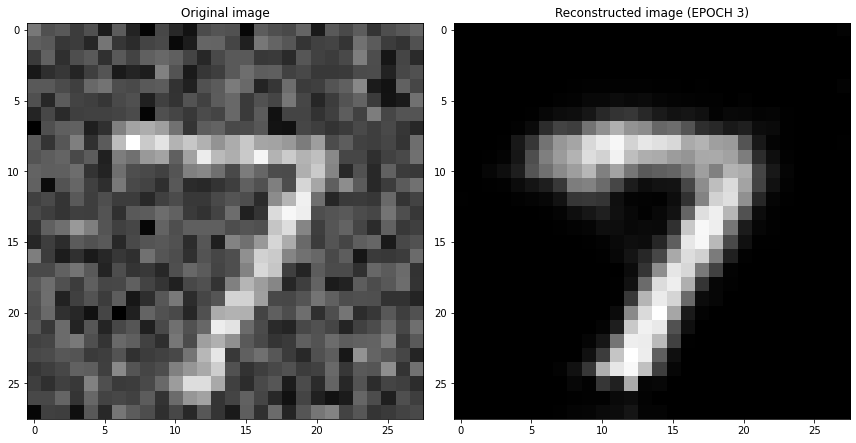

EPOCH 4/40
	 partial train loss (single batch): 0.078947
	 partial train loss (single batch): 0.079698
	 partial train loss (single batch): 0.080898
	 partial train loss (single batch): 0.078982
	 partial train loss (single batch): 0.078677
	 partial train loss (single batch): 0.078747
	 partial train loss (single batch): 0.078749
	 partial train loss (single batch): 0.078045
	 partial train loss (single batch): 0.078267
	 partial train loss (single batch): 0.079179
	 partial train loss (single batch): 0.076866
	 partial train loss (single batch): 0.079969
	 partial train loss (single batch): 0.079095
	 partial train loss (single batch): 0.078830
	 partial train loss (single batch): 0.076969
	 partial train loss (single batch): 0.078745
	 partial train loss (single batch): 0.076320
	 partial train loss (single batch): 0.076461
	 partial train loss (single batch): 0.081272
	 partial train loss (single batch): 0.077921
	 partial train loss (single batch): 0.077021
	 partial train loss (s

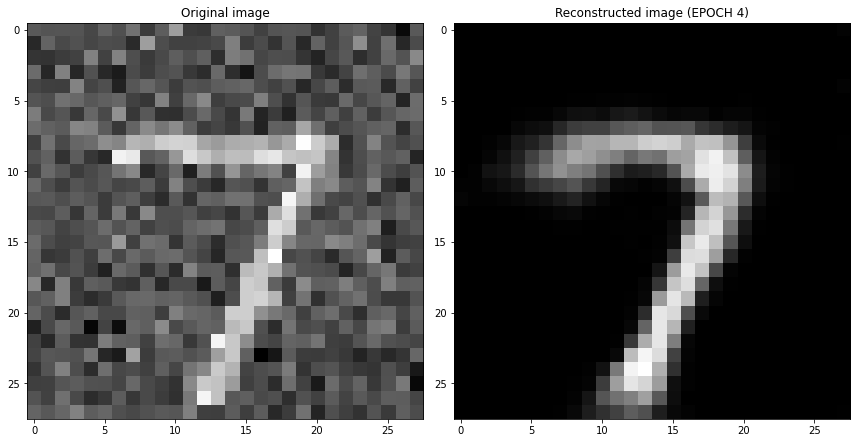

EPOCH 5/40
	 partial train loss (single batch): 0.073054
	 partial train loss (single batch): 0.072153
	 partial train loss (single batch): 0.073066
	 partial train loss (single batch): 0.071167
	 partial train loss (single batch): 0.073486
	 partial train loss (single batch): 0.071861
	 partial train loss (single batch): 0.071205
	 partial train loss (single batch): 0.071283
	 partial train loss (single batch): 0.072922
	 partial train loss (single batch): 0.071072
	 partial train loss (single batch): 0.071966
	 partial train loss (single batch): 0.070870
	 partial train loss (single batch): 0.072335
	 partial train loss (single batch): 0.072105
	 partial train loss (single batch): 0.071780
	 partial train loss (single batch): 0.071285
	 partial train loss (single batch): 0.073395
	 partial train loss (single batch): 0.071449
	 partial train loss (single batch): 0.073260
	 partial train loss (single batch): 0.071234
	 partial train loss (single batch): 0.072637
	 partial train loss (s

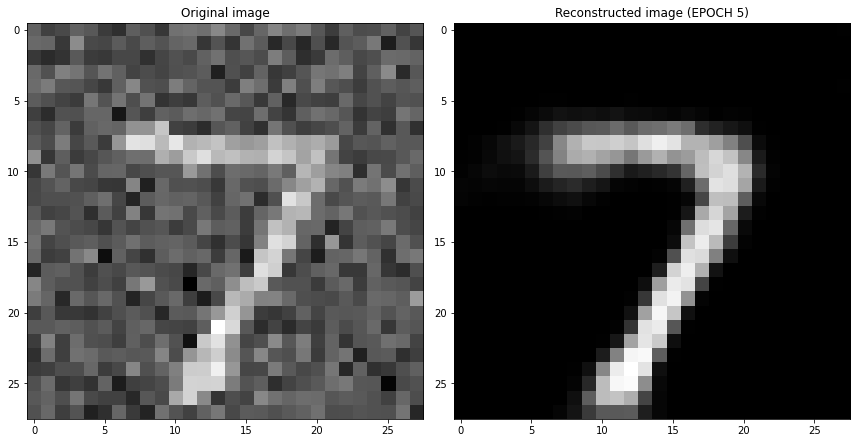

EPOCH 6/40
	 partial train loss (single batch): 0.069915
	 partial train loss (single batch): 0.070266
	 partial train loss (single batch): 0.069579
	 partial train loss (single batch): 0.069019
	 partial train loss (single batch): 0.068406
	 partial train loss (single batch): 0.068473
	 partial train loss (single batch): 0.067053
	 partial train loss (single batch): 0.069642
	 partial train loss (single batch): 0.068974
	 partial train loss (single batch): 0.068186
	 partial train loss (single batch): 0.068060
	 partial train loss (single batch): 0.067899
	 partial train loss (single batch): 0.068655
	 partial train loss (single batch): 0.068437
	 partial train loss (single batch): 0.065870
	 partial train loss (single batch): 0.067329
	 partial train loss (single batch): 0.069202
	 partial train loss (single batch): 0.067733
	 partial train loss (single batch): 0.068748
	 partial train loss (single batch): 0.067957
	 partial train loss (single batch): 0.067441
	 partial train loss (s

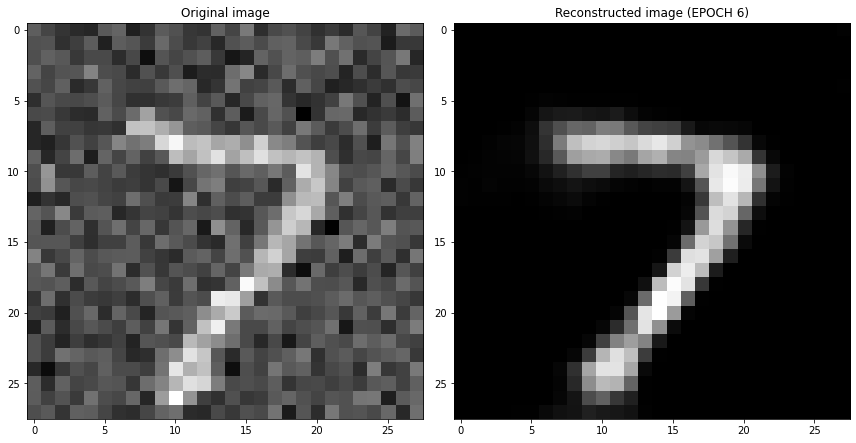

EPOCH 7/40
	 partial train loss (single batch): 0.065619
	 partial train loss (single batch): 0.066359
	 partial train loss (single batch): 0.065189
	 partial train loss (single batch): 0.067523
	 partial train loss (single batch): 0.066070
	 partial train loss (single batch): 0.065030
	 partial train loss (single batch): 0.066056
	 partial train loss (single batch): 0.066760
	 partial train loss (single batch): 0.066043
	 partial train loss (single batch): 0.065002
	 partial train loss (single batch): 0.065387
	 partial train loss (single batch): 0.067191
	 partial train loss (single batch): 0.066439
	 partial train loss (single batch): 0.065536
	 partial train loss (single batch): 0.066913
	 partial train loss (single batch): 0.065151
	 partial train loss (single batch): 0.065944
	 partial train loss (single batch): 0.066925
	 partial train loss (single batch): 0.067436
	 partial train loss (single batch): 0.065727
	 partial train loss (single batch): 0.065046
	 partial train loss (s

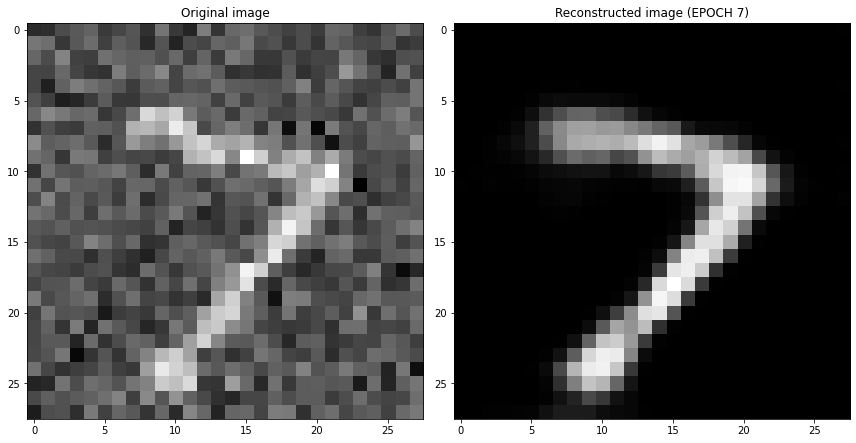

EPOCH 8/40
	 partial train loss (single batch): 0.065100
	 partial train loss (single batch): 0.065201
	 partial train loss (single batch): 0.066541
	 partial train loss (single batch): 0.065752
	 partial train loss (single batch): 0.064710
	 partial train loss (single batch): 0.066408
	 partial train loss (single batch): 0.064962
	 partial train loss (single batch): 0.064736
	 partial train loss (single batch): 0.064811
	 partial train loss (single batch): 0.065787
	 partial train loss (single batch): 0.065271
	 partial train loss (single batch): 0.065124
	 partial train loss (single batch): 0.065958
	 partial train loss (single batch): 0.064060
	 partial train loss (single batch): 0.064800
	 partial train loss (single batch): 0.064001
	 partial train loss (single batch): 0.064795
	 partial train loss (single batch): 0.066717
	 partial train loss (single batch): 0.066102
	 partial train loss (single batch): 0.064672
	 partial train loss (single batch): 0.065130
	 partial train loss (s

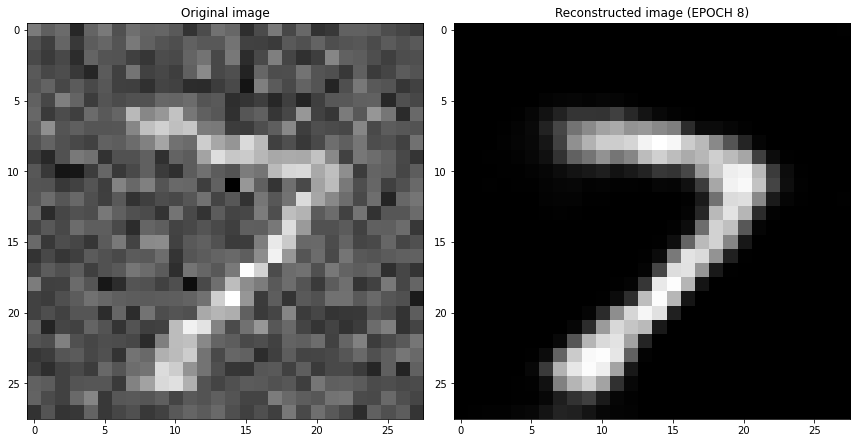

EPOCH 9/40
	 partial train loss (single batch): 0.064781
	 partial train loss (single batch): 0.064014
	 partial train loss (single batch): 0.064709
	 partial train loss (single batch): 0.064543
	 partial train loss (single batch): 0.062844
	 partial train loss (single batch): 0.064316
	 partial train loss (single batch): 0.063692
	 partial train loss (single batch): 0.064068
	 partial train loss (single batch): 0.063877
	 partial train loss (single batch): 0.063802
	 partial train loss (single batch): 0.066031
	 partial train loss (single batch): 0.065046
	 partial train loss (single batch): 0.062809
	 partial train loss (single batch): 0.065091
	 partial train loss (single batch): 0.064148
	 partial train loss (single batch): 0.064156
	 partial train loss (single batch): 0.064027
	 partial train loss (single batch): 0.064579
	 partial train loss (single batch): 0.063095
	 partial train loss (single batch): 0.064384
	 partial train loss (single batch): 0.062584
	 partial train loss (s

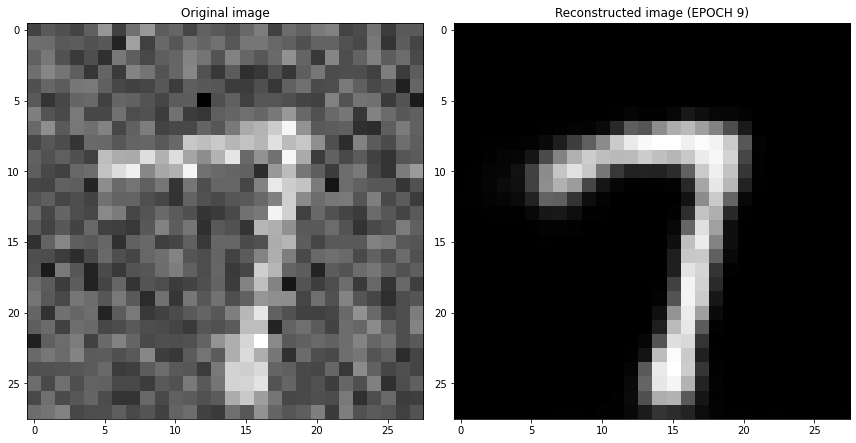

EPOCH 10/40
	 partial train loss (single batch): 0.062121
	 partial train loss (single batch): 0.063607
	 partial train loss (single batch): 0.063534
	 partial train loss (single batch): 0.063521
	 partial train loss (single batch): 0.064389
	 partial train loss (single batch): 0.063311
	 partial train loss (single batch): 0.063779
	 partial train loss (single batch): 0.061436
	 partial train loss (single batch): 0.064600
	 partial train loss (single batch): 0.063146
	 partial train loss (single batch): 0.064101
	 partial train loss (single batch): 0.064672
	 partial train loss (single batch): 0.063937
	 partial train loss (single batch): 0.063723
	 partial train loss (single batch): 0.063274
	 partial train loss (single batch): 0.063486
	 partial train loss (single batch): 0.062933
	 partial train loss (single batch): 0.064719
	 partial train loss (single batch): 0.062911
	 partial train loss (single batch): 0.064379
	 partial train loss (single batch): 0.063840
	 partial train loss (

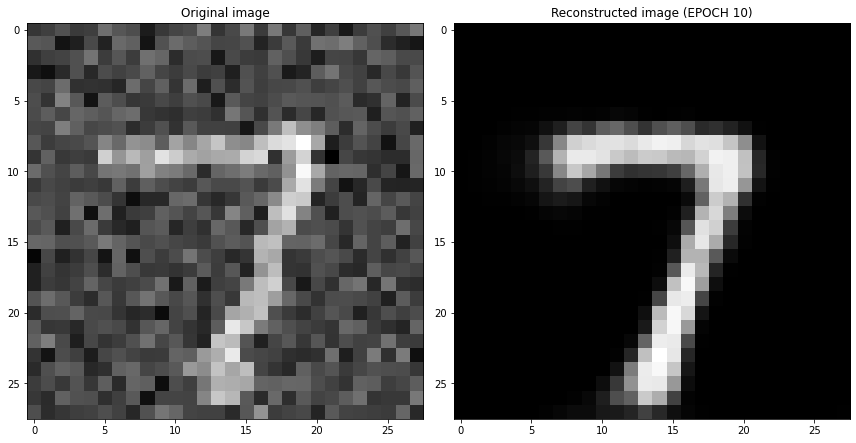

EPOCH 11/40
	 partial train loss (single batch): 0.062316
	 partial train loss (single batch): 0.062057
	 partial train loss (single batch): 0.062295
	 partial train loss (single batch): 0.062956
	 partial train loss (single batch): 0.062608
	 partial train loss (single batch): 0.061987
	 partial train loss (single batch): 0.063163
	 partial train loss (single batch): 0.064296
	 partial train loss (single batch): 0.061559
	 partial train loss (single batch): 0.062491
	 partial train loss (single batch): 0.062813
	 partial train loss (single batch): 0.062822
	 partial train loss (single batch): 0.063102
	 partial train loss (single batch): 0.063530
	 partial train loss (single batch): 0.063883
	 partial train loss (single batch): 0.061612
	 partial train loss (single batch): 0.063784
	 partial train loss (single batch): 0.062746
	 partial train loss (single batch): 0.062008
	 partial train loss (single batch): 0.062626
	 partial train loss (single batch): 0.062801
	 partial train loss (

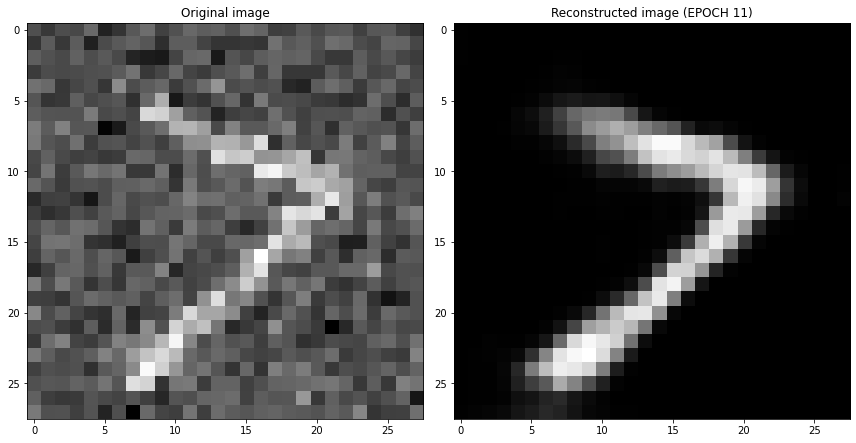

EPOCH 12/40
	 partial train loss (single batch): 0.063391
	 partial train loss (single batch): 0.062249
	 partial train loss (single batch): 0.062634
	 partial train loss (single batch): 0.061357
	 partial train loss (single batch): 0.061479
	 partial train loss (single batch): 0.062495
	 partial train loss (single batch): 0.062111
	 partial train loss (single batch): 0.061958
	 partial train loss (single batch): 0.062369
	 partial train loss (single batch): 0.062240
	 partial train loss (single batch): 0.062362
	 partial train loss (single batch): 0.062531
	 partial train loss (single batch): 0.061852
	 partial train loss (single batch): 0.061002
	 partial train loss (single batch): 0.061852
	 partial train loss (single batch): 0.063159
	 partial train loss (single batch): 0.063699
	 partial train loss (single batch): 0.063332
	 partial train loss (single batch): 0.062636
	 partial train loss (single batch): 0.061849
	 partial train loss (single batch): 0.061951
	 partial train loss (

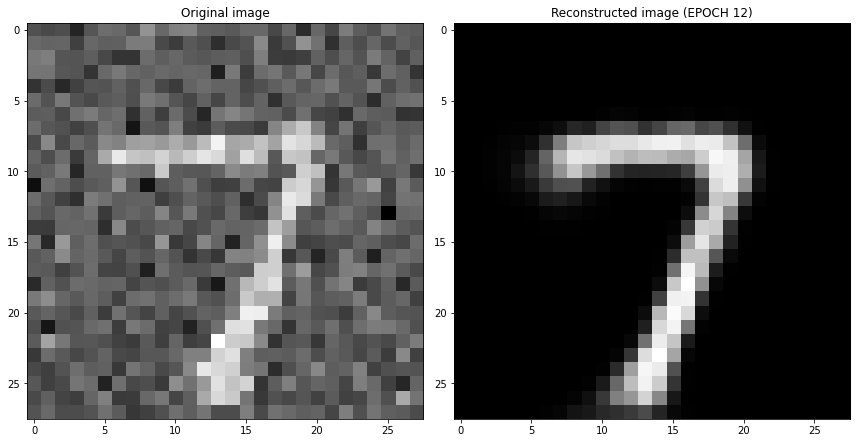

EPOCH 13/40
	 partial train loss (single batch): 0.061473
	 partial train loss (single batch): 0.061550
	 partial train loss (single batch): 0.061991
	 partial train loss (single batch): 0.061376
	 partial train loss (single batch): 0.063144
	 partial train loss (single batch): 0.061742
	 partial train loss (single batch): 0.063335
	 partial train loss (single batch): 0.062132
	 partial train loss (single batch): 0.062371
	 partial train loss (single batch): 0.062294
	 partial train loss (single batch): 0.063167
	 partial train loss (single batch): 0.061473
	 partial train loss (single batch): 0.062012
	 partial train loss (single batch): 0.061800
	 partial train loss (single batch): 0.062941
	 partial train loss (single batch): 0.062157
	 partial train loss (single batch): 0.063666
	 partial train loss (single batch): 0.061781
	 partial train loss (single batch): 0.062326
	 partial train loss (single batch): 0.062631
	 partial train loss (single batch): 0.062979
	 partial train loss (

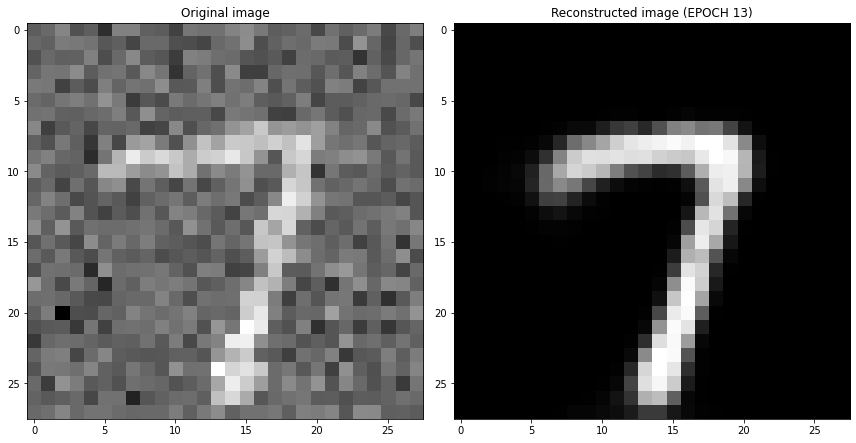

EPOCH 14/40
	 partial train loss (single batch): 0.061744
	 partial train loss (single batch): 0.062701
	 partial train loss (single batch): 0.062224
	 partial train loss (single batch): 0.061536
	 partial train loss (single batch): 0.061250
	 partial train loss (single batch): 0.061737
	 partial train loss (single batch): 0.061914
	 partial train loss (single batch): 0.061769
	 partial train loss (single batch): 0.062662
	 partial train loss (single batch): 0.062886
	 partial train loss (single batch): 0.062143
	 partial train loss (single batch): 0.061679
	 partial train loss (single batch): 0.062280
	 partial train loss (single batch): 0.062699
	 partial train loss (single batch): 0.062073
	 partial train loss (single batch): 0.061491
	 partial train loss (single batch): 0.060966
	 partial train loss (single batch): 0.062009
	 partial train loss (single batch): 0.061450
	 partial train loss (single batch): 0.061476
	 partial train loss (single batch): 0.064319
	 partial train loss (

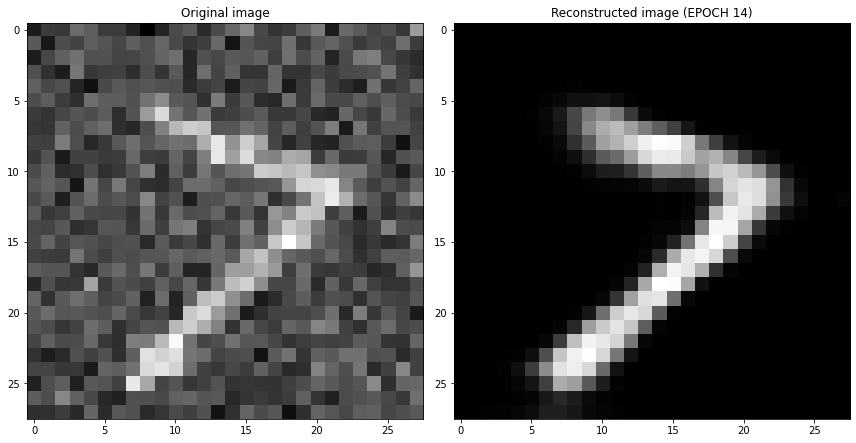

EPOCH 15/40
	 partial train loss (single batch): 0.060859
	 partial train loss (single batch): 0.060553
	 partial train loss (single batch): 0.061528
	 partial train loss (single batch): 0.061702
	 partial train loss (single batch): 0.061416
	 partial train loss (single batch): 0.061863
	 partial train loss (single batch): 0.060653
	 partial train loss (single batch): 0.061337
	 partial train loss (single batch): 0.061473
	 partial train loss (single batch): 0.061662
	 partial train loss (single batch): 0.061891
	 partial train loss (single batch): 0.061516
	 partial train loss (single batch): 0.061980
	 partial train loss (single batch): 0.061073
	 partial train loss (single batch): 0.062101
	 partial train loss (single batch): 0.062323
	 partial train loss (single batch): 0.060630
	 partial train loss (single batch): 0.060327
	 partial train loss (single batch): 0.062536
	 partial train loss (single batch): 0.060341
	 partial train loss (single batch): 0.061673
	 partial train loss (

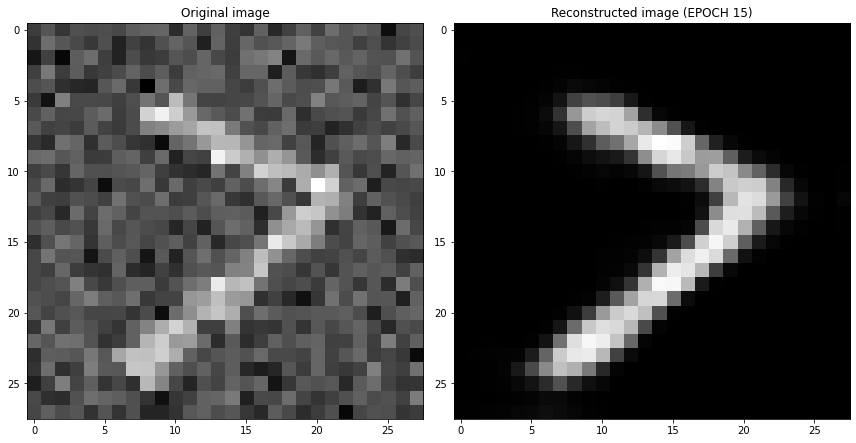

EPOCH 16/40
	 partial train loss (single batch): 0.061881
	 partial train loss (single batch): 0.061771
	 partial train loss (single batch): 0.061797
	 partial train loss (single batch): 0.061583
	 partial train loss (single batch): 0.061421
	 partial train loss (single batch): 0.059827
	 partial train loss (single batch): 0.062612
	 partial train loss (single batch): 0.061311
	 partial train loss (single batch): 0.060465
	 partial train loss (single batch): 0.061717
	 partial train loss (single batch): 0.061650
	 partial train loss (single batch): 0.060981
	 partial train loss (single batch): 0.061179
	 partial train loss (single batch): 0.061270
	 partial train loss (single batch): 0.060840
	 partial train loss (single batch): 0.060875
	 partial train loss (single batch): 0.061262
	 partial train loss (single batch): 0.061184
	 partial train loss (single batch): 0.061223
	 partial train loss (single batch): 0.060154
	 partial train loss (single batch): 0.060408
	 partial train loss (

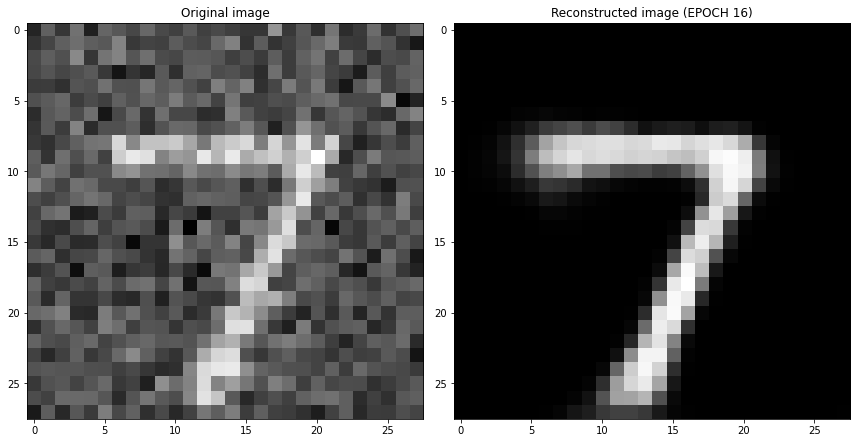

EPOCH 17/40
	 partial train loss (single batch): 0.061331
	 partial train loss (single batch): 0.060159
	 partial train loss (single batch): 0.060883
	 partial train loss (single batch): 0.061406
	 partial train loss (single batch): 0.060805
	 partial train loss (single batch): 0.059782
	 partial train loss (single batch): 0.060644
	 partial train loss (single batch): 0.061442
	 partial train loss (single batch): 0.062154
	 partial train loss (single batch): 0.061052
	 partial train loss (single batch): 0.061463
	 partial train loss (single batch): 0.061021
	 partial train loss (single batch): 0.061172
	 partial train loss (single batch): 0.061021
	 partial train loss (single batch): 0.060460
	 partial train loss (single batch): 0.059853
	 partial train loss (single batch): 0.060328
	 partial train loss (single batch): 0.061004
	 partial train loss (single batch): 0.059194
	 partial train loss (single batch): 0.062145
	 partial train loss (single batch): 0.060954
	 partial train loss (

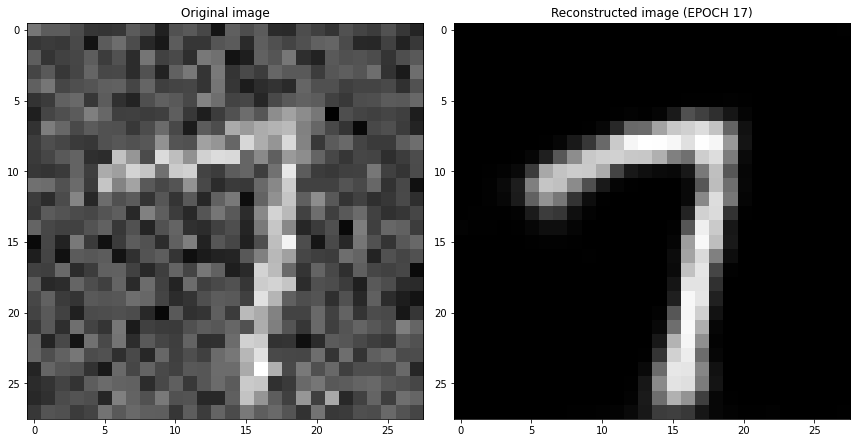

EPOCH 18/40
	 partial train loss (single batch): 0.060886
	 partial train loss (single batch): 0.060569
	 partial train loss (single batch): 0.060387
	 partial train loss (single batch): 0.059501
	 partial train loss (single batch): 0.060890
	 partial train loss (single batch): 0.060771
	 partial train loss (single batch): 0.059742
	 partial train loss (single batch): 0.061265
	 partial train loss (single batch): 0.060851
	 partial train loss (single batch): 0.061591
	 partial train loss (single batch): 0.061830
	 partial train loss (single batch): 0.060929
	 partial train loss (single batch): 0.060871
	 partial train loss (single batch): 0.059803
	 partial train loss (single batch): 0.060512
	 partial train loss (single batch): 0.061313
	 partial train loss (single batch): 0.061425
	 partial train loss (single batch): 0.059665
	 partial train loss (single batch): 0.060970
	 partial train loss (single batch): 0.060667
	 partial train loss (single batch): 0.060385
	 partial train loss (

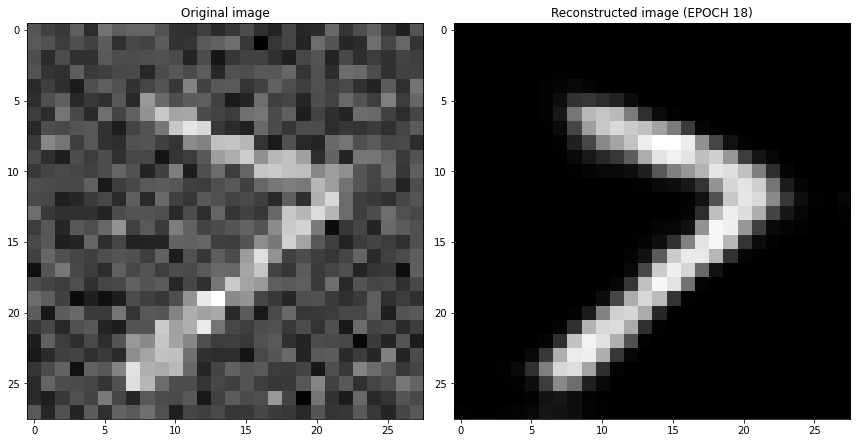

EPOCH 19/40
	 partial train loss (single batch): 0.060391
	 partial train loss (single batch): 0.059870
	 partial train loss (single batch): 0.060856
	 partial train loss (single batch): 0.060431
	 partial train loss (single batch): 0.060799
	 partial train loss (single batch): 0.060479
	 partial train loss (single batch): 0.060036
	 partial train loss (single batch): 0.060005
	 partial train loss (single batch): 0.059790
	 partial train loss (single batch): 0.061720
	 partial train loss (single batch): 0.060628
	 partial train loss (single batch): 0.061436
	 partial train loss (single batch): 0.061508
	 partial train loss (single batch): 0.059956
	 partial train loss (single batch): 0.060670
	 partial train loss (single batch): 0.059884
	 partial train loss (single batch): 0.060673
	 partial train loss (single batch): 0.060882
	 partial train loss (single batch): 0.060268
	 partial train loss (single batch): 0.061177
	 partial train loss (single batch): 0.060243
	 partial train loss (

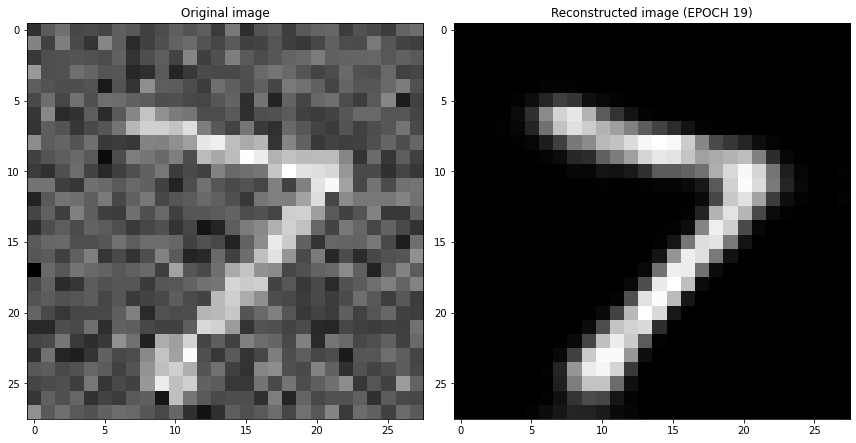

EPOCH 20/40
	 partial train loss (single batch): 0.060333
	 partial train loss (single batch): 0.060923
	 partial train loss (single batch): 0.060217
	 partial train loss (single batch): 0.060525
	 partial train loss (single batch): 0.060215
	 partial train loss (single batch): 0.059293
	 partial train loss (single batch): 0.059882
	 partial train loss (single batch): 0.060244
	 partial train loss (single batch): 0.060864
	 partial train loss (single batch): 0.061588
	 partial train loss (single batch): 0.060816
	 partial train loss (single batch): 0.059983
	 partial train loss (single batch): 0.060454
	 partial train loss (single batch): 0.060801
	 partial train loss (single batch): 0.059972
	 partial train loss (single batch): 0.060626
	 partial train loss (single batch): 0.060518
	 partial train loss (single batch): 0.060301
	 partial train loss (single batch): 0.060550
	 partial train loss (single batch): 0.060438
	 partial train loss (single batch): 0.059934
	 partial train loss (

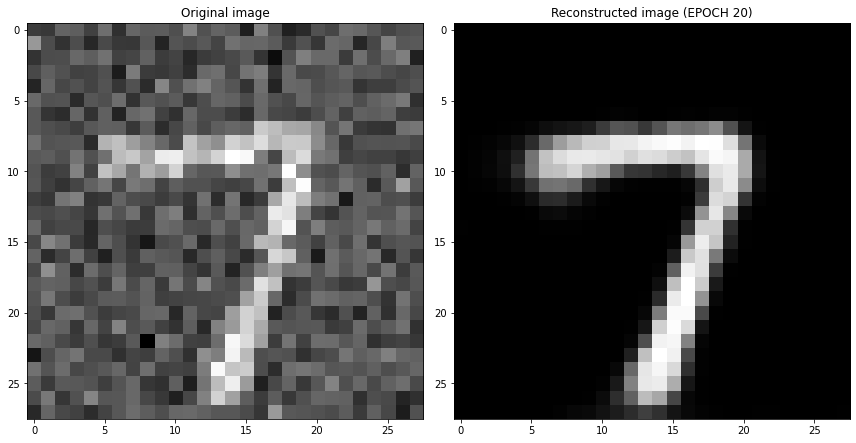

EPOCH 21/40
	 partial train loss (single batch): 0.060209
	 partial train loss (single batch): 0.059391
	 partial train loss (single batch): 0.059116
	 partial train loss (single batch): 0.059695
	 partial train loss (single batch): 0.059257
	 partial train loss (single batch): 0.060523
	 partial train loss (single batch): 0.060154
	 partial train loss (single batch): 0.060615
	 partial train loss (single batch): 0.059687
	 partial train loss (single batch): 0.059928
	 partial train loss (single batch): 0.059407
	 partial train loss (single batch): 0.060566
	 partial train loss (single batch): 0.059982
	 partial train loss (single batch): 0.060428
	 partial train loss (single batch): 0.060479
	 partial train loss (single batch): 0.059783
	 partial train loss (single batch): 0.059874
	 partial train loss (single batch): 0.060719
	 partial train loss (single batch): 0.060007
	 partial train loss (single batch): 0.060514
	 partial train loss (single batch): 0.059540
	 partial train loss (

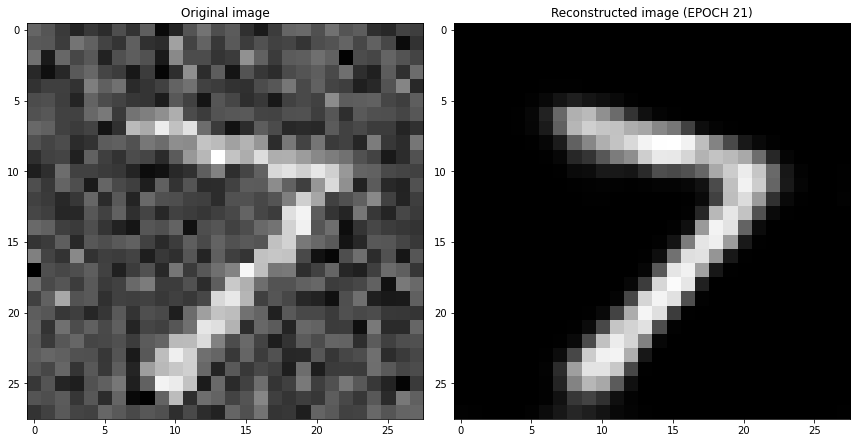

EPOCH 22/40
	 partial train loss (single batch): 0.059566
	 partial train loss (single batch): 0.060644
	 partial train loss (single batch): 0.060050
	 partial train loss (single batch): 0.059501
	 partial train loss (single batch): 0.061334
	 partial train loss (single batch): 0.060001
	 partial train loss (single batch): 0.059188
	 partial train loss (single batch): 0.058729
	 partial train loss (single batch): 0.060331
	 partial train loss (single batch): 0.060198
	 partial train loss (single batch): 0.060352
	 partial train loss (single batch): 0.060287
	 partial train loss (single batch): 0.060612
	 partial train loss (single batch): 0.059900
	 partial train loss (single batch): 0.059601
	 partial train loss (single batch): 0.059806
	 partial train loss (single batch): 0.060082
	 partial train loss (single batch): 0.060703
	 partial train loss (single batch): 0.059596
	 partial train loss (single batch): 0.062004
	 partial train loss (single batch): 0.060345
	 partial train loss (

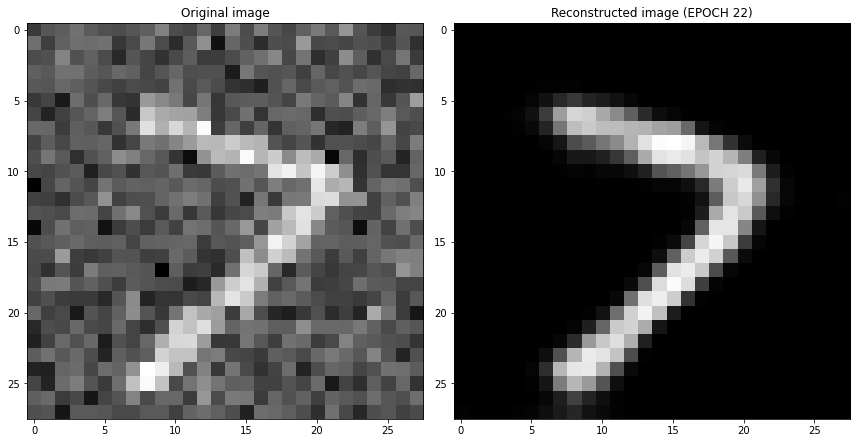

EPOCH 23/40
	 partial train loss (single batch): 0.059165
	 partial train loss (single batch): 0.059739
	 partial train loss (single batch): 0.060428
	 partial train loss (single batch): 0.058809
	 partial train loss (single batch): 0.059482
	 partial train loss (single batch): 0.059479
	 partial train loss (single batch): 0.060031
	 partial train loss (single batch): 0.058510
	 partial train loss (single batch): 0.060099
	 partial train loss (single batch): 0.060274
	 partial train loss (single batch): 0.060126
	 partial train loss (single batch): 0.059843
	 partial train loss (single batch): 0.059305
	 partial train loss (single batch): 0.059600
	 partial train loss (single batch): 0.059793
	 partial train loss (single batch): 0.060246
	 partial train loss (single batch): 0.060879
	 partial train loss (single batch): 0.059858
	 partial train loss (single batch): 0.059317
	 partial train loss (single batch): 0.059213
	 partial train loss (single batch): 0.059948
	 partial train loss (

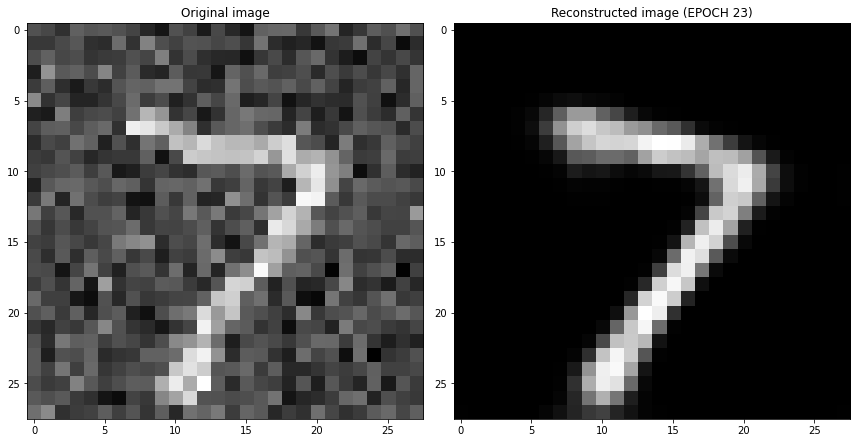

EPOCH 24/40
	 partial train loss (single batch): 0.059783
	 partial train loss (single batch): 0.058320
	 partial train loss (single batch): 0.057991
	 partial train loss (single batch): 0.058829
	 partial train loss (single batch): 0.059329
	 partial train loss (single batch): 0.059969
	 partial train loss (single batch): 0.060477
	 partial train loss (single batch): 0.059695
	 partial train loss (single batch): 0.060281
	 partial train loss (single batch): 0.060274
	 partial train loss (single batch): 0.060279
	 partial train loss (single batch): 0.059462
	 partial train loss (single batch): 0.060143
	 partial train loss (single batch): 0.059542
	 partial train loss (single batch): 0.059331
	 partial train loss (single batch): 0.058578
	 partial train loss (single batch): 0.060433
	 partial train loss (single batch): 0.059364
	 partial train loss (single batch): 0.061499
	 partial train loss (single batch): 0.059875
	 partial train loss (single batch): 0.058889
	 partial train loss (

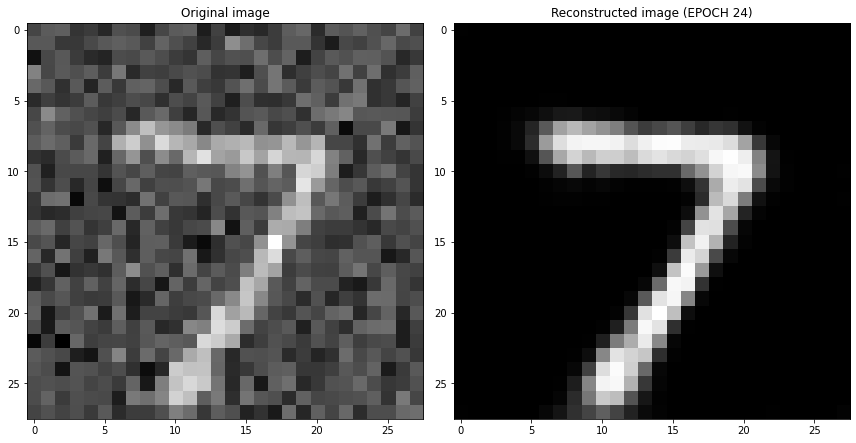

EPOCH 25/40
	 partial train loss (single batch): 0.058635
	 partial train loss (single batch): 0.059346
	 partial train loss (single batch): 0.059113
	 partial train loss (single batch): 0.060400
	 partial train loss (single batch): 0.059185
	 partial train loss (single batch): 0.060627
	 partial train loss (single batch): 0.059737
	 partial train loss (single batch): 0.060248
	 partial train loss (single batch): 0.059402
	 partial train loss (single batch): 0.060535
	 partial train loss (single batch): 0.059093
	 partial train loss (single batch): 0.058766
	 partial train loss (single batch): 0.059794
	 partial train loss (single batch): 0.059993
	 partial train loss (single batch): 0.060685
	 partial train loss (single batch): 0.059172
	 partial train loss (single batch): 0.058089
	 partial train loss (single batch): 0.058698
	 partial train loss (single batch): 0.059105
	 partial train loss (single batch): 0.060340
	 partial train loss (single batch): 0.059941
	 partial train loss (

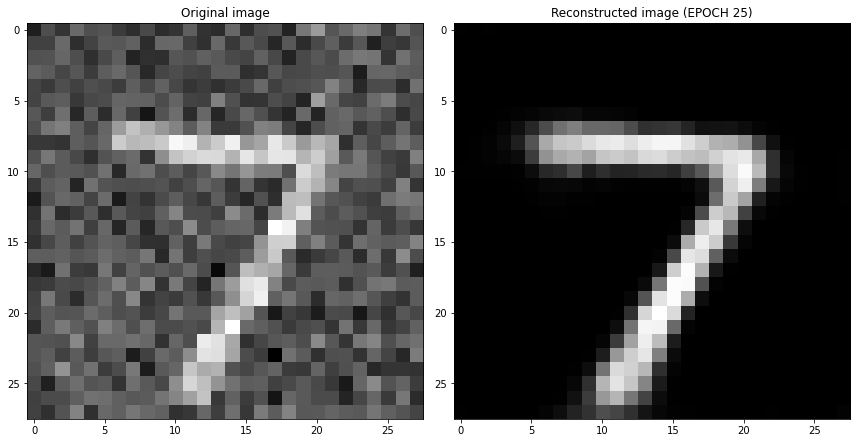

EPOCH 26/40
	 partial train loss (single batch): 0.059903
	 partial train loss (single batch): 0.060288
	 partial train loss (single batch): 0.060624
	 partial train loss (single batch): 0.058346
	 partial train loss (single batch): 0.059158
	 partial train loss (single batch): 0.058618
	 partial train loss (single batch): 0.059401
	 partial train loss (single batch): 0.059259
	 partial train loss (single batch): 0.059928
	 partial train loss (single batch): 0.060466
	 partial train loss (single batch): 0.058744
	 partial train loss (single batch): 0.058966
	 partial train loss (single batch): 0.059199
	 partial train loss (single batch): 0.060812
	 partial train loss (single batch): 0.058382
	 partial train loss (single batch): 0.059914
	 partial train loss (single batch): 0.059913
	 partial train loss (single batch): 0.058817
	 partial train loss (single batch): 0.058897
	 partial train loss (single batch): 0.060042
	 partial train loss (single batch): 0.059387
	 partial train loss (

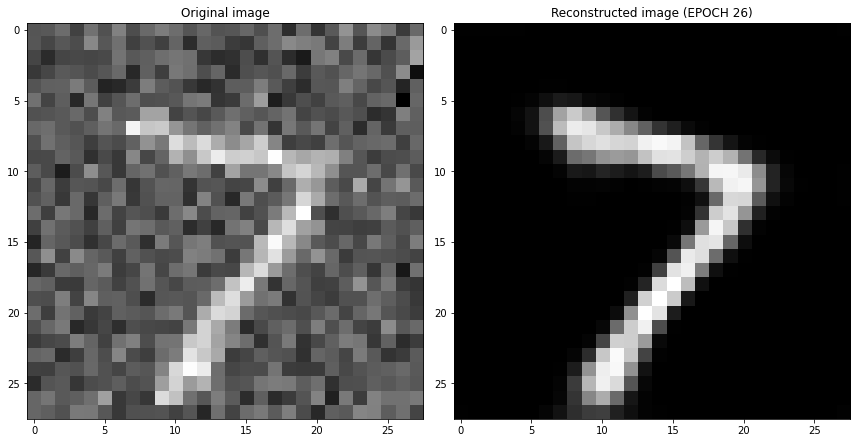

EPOCH 27/40
	 partial train loss (single batch): 0.059692
	 partial train loss (single batch): 0.059484
	 partial train loss (single batch): 0.059179
	 partial train loss (single batch): 0.059745
	 partial train loss (single batch): 0.059354
	 partial train loss (single batch): 0.059643
	 partial train loss (single batch): 0.058617
	 partial train loss (single batch): 0.059364
	 partial train loss (single batch): 0.060226
	 partial train loss (single batch): 0.060264
	 partial train loss (single batch): 0.060522
	 partial train loss (single batch): 0.059386
	 partial train loss (single batch): 0.059621
	 partial train loss (single batch): 0.060349
	 partial train loss (single batch): 0.058907
	 partial train loss (single batch): 0.058727
	 partial train loss (single batch): 0.058047
	 partial train loss (single batch): 0.059904
	 partial train loss (single batch): 0.059569
	 partial train loss (single batch): 0.058721
	 partial train loss (single batch): 0.058825
	 partial train loss (

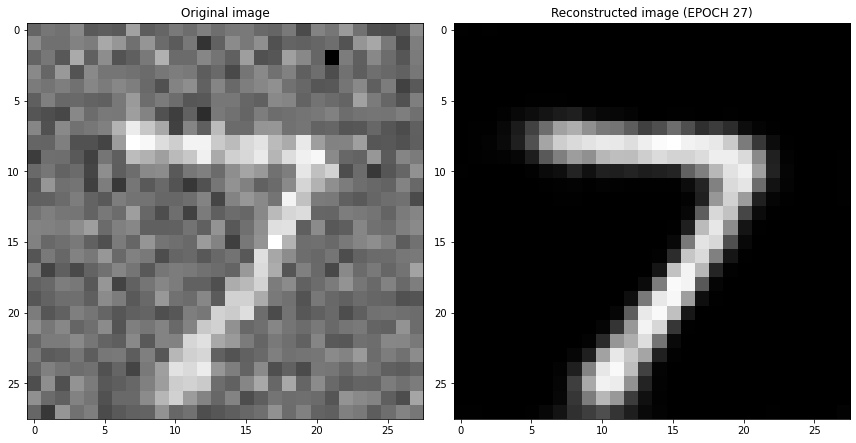

EPOCH 28/40
	 partial train loss (single batch): 0.059566
	 partial train loss (single batch): 0.058652
	 partial train loss (single batch): 0.059122
	 partial train loss (single batch): 0.058606
	 partial train loss (single batch): 0.059577
	 partial train loss (single batch): 0.058911
	 partial train loss (single batch): 0.059492
	 partial train loss (single batch): 0.060100
	 partial train loss (single batch): 0.059189
	 partial train loss (single batch): 0.059664
	 partial train loss (single batch): 0.059000
	 partial train loss (single batch): 0.058749
	 partial train loss (single batch): 0.059590
	 partial train loss (single batch): 0.059248
	 partial train loss (single batch): 0.058251
	 partial train loss (single batch): 0.057447
	 partial train loss (single batch): 0.058476
	 partial train loss (single batch): 0.059298
	 partial train loss (single batch): 0.059882
	 partial train loss (single batch): 0.059360
	 partial train loss (single batch): 0.060243
	 partial train loss (

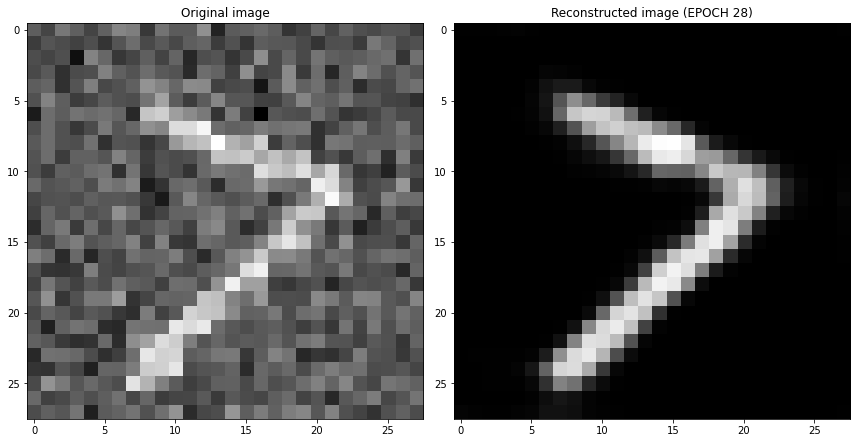

EPOCH 29/40
	 partial train loss (single batch): 0.059026
	 partial train loss (single batch): 0.058484
	 partial train loss (single batch): 0.059799
	 partial train loss (single batch): 0.059782
	 partial train loss (single batch): 0.059966
	 partial train loss (single batch): 0.058921
	 partial train loss (single batch): 0.059398
	 partial train loss (single batch): 0.058529
	 partial train loss (single batch): 0.059792
	 partial train loss (single batch): 0.058911
	 partial train loss (single batch): 0.058325
	 partial train loss (single batch): 0.059964
	 partial train loss (single batch): 0.058992
	 partial train loss (single batch): 0.060820
	 partial train loss (single batch): 0.059386
	 partial train loss (single batch): 0.058354
	 partial train loss (single batch): 0.059472
	 partial train loss (single batch): 0.059803
	 partial train loss (single batch): 0.059621
	 partial train loss (single batch): 0.059386
	 partial train loss (single batch): 0.058802
	 partial train loss (

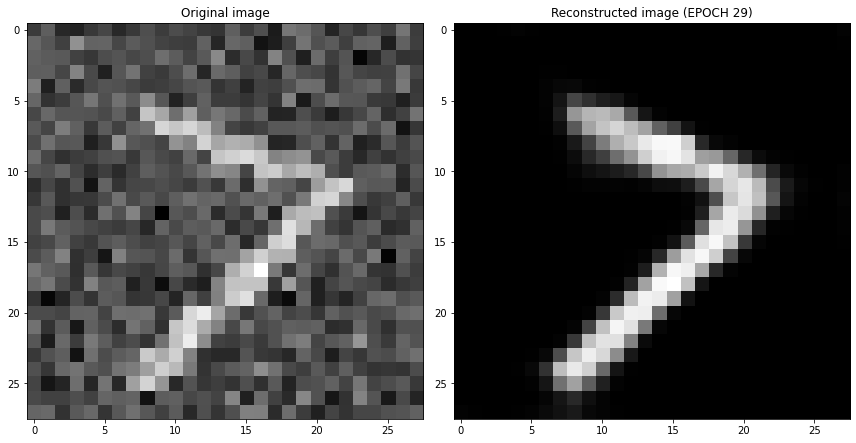

EPOCH 30/40
	 partial train loss (single batch): 0.058905
	 partial train loss (single batch): 0.059689
	 partial train loss (single batch): 0.058229
	 partial train loss (single batch): 0.060151
	 partial train loss (single batch): 0.059933
	 partial train loss (single batch): 0.059470
	 partial train loss (single batch): 0.059856
	 partial train loss (single batch): 0.058721
	 partial train loss (single batch): 0.059534
	 partial train loss (single batch): 0.059310
	 partial train loss (single batch): 0.059112
	 partial train loss (single batch): 0.058890
	 partial train loss (single batch): 0.058954
	 partial train loss (single batch): 0.059096
	 partial train loss (single batch): 0.059441
	 partial train loss (single batch): 0.059179
	 partial train loss (single batch): 0.059578
	 partial train loss (single batch): 0.059404
	 partial train loss (single batch): 0.059489
	 partial train loss (single batch): 0.060524
	 partial train loss (single batch): 0.058944
	 partial train loss (

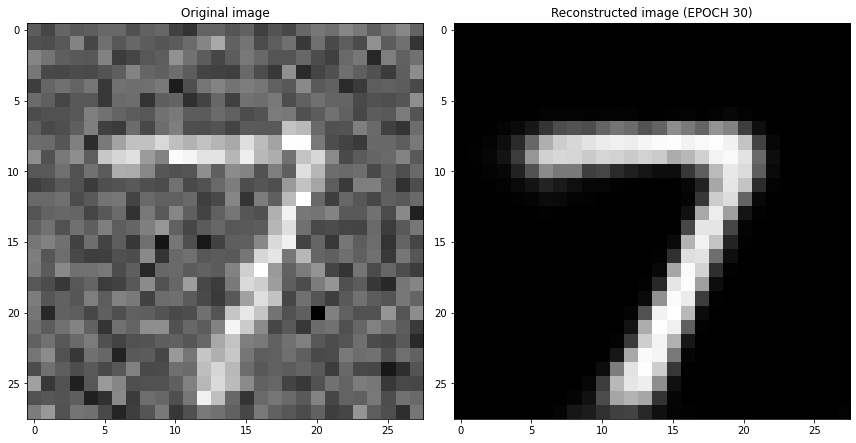

EPOCH 31/40
	 partial train loss (single batch): 0.058576
	 partial train loss (single batch): 0.058187
	 partial train loss (single batch): 0.059457
	 partial train loss (single batch): 0.059666
	 partial train loss (single batch): 0.058790
	 partial train loss (single batch): 0.059377
	 partial train loss (single batch): 0.059154
	 partial train loss (single batch): 0.059882
	 partial train loss (single batch): 0.058219
	 partial train loss (single batch): 0.059237
	 partial train loss (single batch): 0.059423
	 partial train loss (single batch): 0.059248
	 partial train loss (single batch): 0.059200
	 partial train loss (single batch): 0.059049
	 partial train loss (single batch): 0.058470
	 partial train loss (single batch): 0.058980
	 partial train loss (single batch): 0.059928
	 partial train loss (single batch): 0.057964
	 partial train loss (single batch): 0.060148
	 partial train loss (single batch): 0.058818
	 partial train loss (single batch): 0.058440
	 partial train loss (

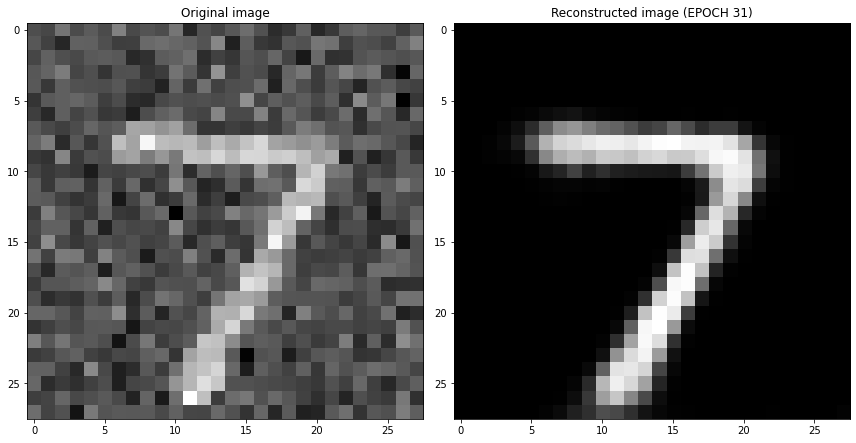

EPOCH 32/40
	 partial train loss (single batch): 0.057622
	 partial train loss (single batch): 0.059758
	 partial train loss (single batch): 0.058775
	 partial train loss (single batch): 0.060207
	 partial train loss (single batch): 0.059390
	 partial train loss (single batch): 0.058577
	 partial train loss (single batch): 0.057990
	 partial train loss (single batch): 0.058639
	 partial train loss (single batch): 0.058981
	 partial train loss (single batch): 0.058450
	 partial train loss (single batch): 0.059070
	 partial train loss (single batch): 0.058730
	 partial train loss (single batch): 0.059960
	 partial train loss (single batch): 0.059341
	 partial train loss (single batch): 0.059754
	 partial train loss (single batch): 0.058935
	 partial train loss (single batch): 0.058537
	 partial train loss (single batch): 0.057502
	 partial train loss (single batch): 0.059336
	 partial train loss (single batch): 0.059342
	 partial train loss (single batch): 0.057383
	 partial train loss (

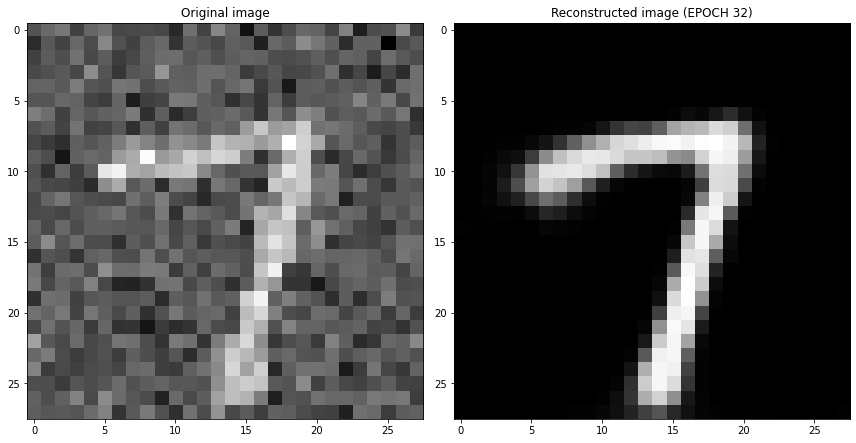

EPOCH 33/40
	 partial train loss (single batch): 0.058645
	 partial train loss (single batch): 0.059521
	 partial train loss (single batch): 0.059389
	 partial train loss (single batch): 0.059022
	 partial train loss (single batch): 0.058591
	 partial train loss (single batch): 0.060286
	 partial train loss (single batch): 0.058102
	 partial train loss (single batch): 0.059440
	 partial train loss (single batch): 0.059158
	 partial train loss (single batch): 0.058120
	 partial train loss (single batch): 0.058182
	 partial train loss (single batch): 0.059329
	 partial train loss (single batch): 0.057920
	 partial train loss (single batch): 0.058478
	 partial train loss (single batch): 0.060142
	 partial train loss (single batch): 0.058102
	 partial train loss (single batch): 0.058675
	 partial train loss (single batch): 0.059251
	 partial train loss (single batch): 0.059332
	 partial train loss (single batch): 0.058419
	 partial train loss (single batch): 0.059290
	 partial train loss (

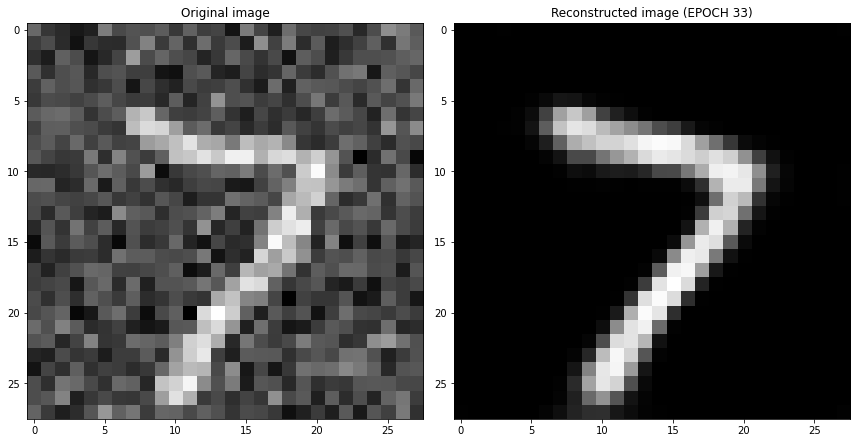

EPOCH 34/40
	 partial train loss (single batch): 0.058363
	 partial train loss (single batch): 0.059129
	 partial train loss (single batch): 0.058417
	 partial train loss (single batch): 0.059551
	 partial train loss (single batch): 0.059880
	 partial train loss (single batch): 0.058625
	 partial train loss (single batch): 0.059624
	 partial train loss (single batch): 0.059088
	 partial train loss (single batch): 0.058464
	 partial train loss (single batch): 0.058583
	 partial train loss (single batch): 0.058167
	 partial train loss (single batch): 0.059481
	 partial train loss (single batch): 0.059325
	 partial train loss (single batch): 0.059238
	 partial train loss (single batch): 0.058417
	 partial train loss (single batch): 0.058926
	 partial train loss (single batch): 0.058749
	 partial train loss (single batch): 0.058758
	 partial train loss (single batch): 0.058570
	 partial train loss (single batch): 0.058808
	 partial train loss (single batch): 0.057909
	 partial train loss (

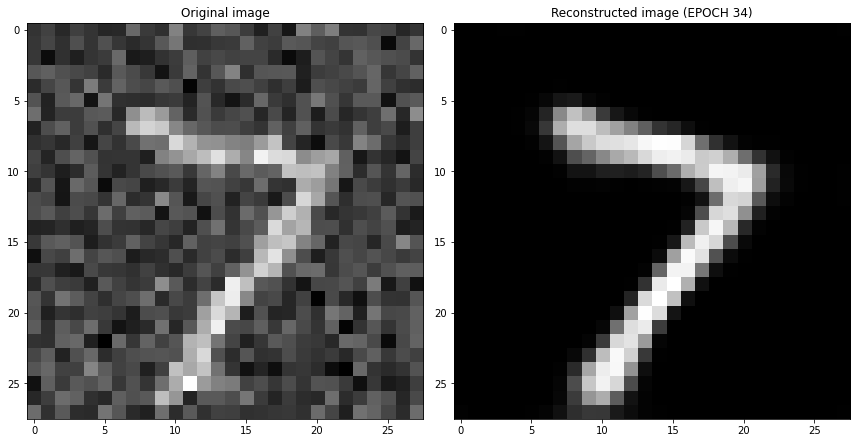

EPOCH 35/40
	 partial train loss (single batch): 0.057835
	 partial train loss (single batch): 0.060085
	 partial train loss (single batch): 0.059201
	 partial train loss (single batch): 0.058391
	 partial train loss (single batch): 0.058351
	 partial train loss (single batch): 0.057561
	 partial train loss (single batch): 0.058107
	 partial train loss (single batch): 0.058054
	 partial train loss (single batch): 0.057249
	 partial train loss (single batch): 0.058068
	 partial train loss (single batch): 0.058408
	 partial train loss (single batch): 0.057794
	 partial train loss (single batch): 0.059317
	 partial train loss (single batch): 0.059465
	 partial train loss (single batch): 0.059148
	 partial train loss (single batch): 0.058572
	 partial train loss (single batch): 0.058888
	 partial train loss (single batch): 0.059919
	 partial train loss (single batch): 0.058015
	 partial train loss (single batch): 0.058488
	 partial train loss (single batch): 0.057457
	 partial train loss (

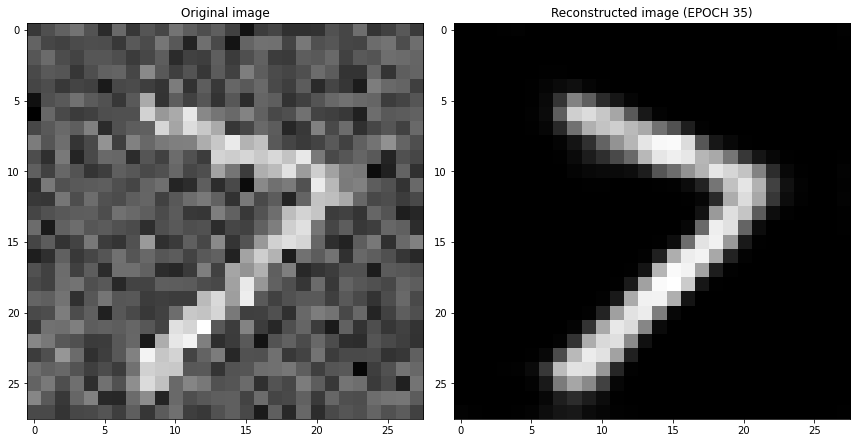

EPOCH 36/40
	 partial train loss (single batch): 0.059197
	 partial train loss (single batch): 0.058312
	 partial train loss (single batch): 0.059367
	 partial train loss (single batch): 0.058255
	 partial train loss (single batch): 0.058578
	 partial train loss (single batch): 0.058791
	 partial train loss (single batch): 0.058523
	 partial train loss (single batch): 0.058379
	 partial train loss (single batch): 0.059287
	 partial train loss (single batch): 0.057992
	 partial train loss (single batch): 0.059011
	 partial train loss (single batch): 0.058223
	 partial train loss (single batch): 0.059350
	 partial train loss (single batch): 0.059142
	 partial train loss (single batch): 0.059229
	 partial train loss (single batch): 0.058011
	 partial train loss (single batch): 0.058797
	 partial train loss (single batch): 0.058110
	 partial train loss (single batch): 0.058458
	 partial train loss (single batch): 0.058132
	 partial train loss (single batch): 0.058908
	 partial train loss (

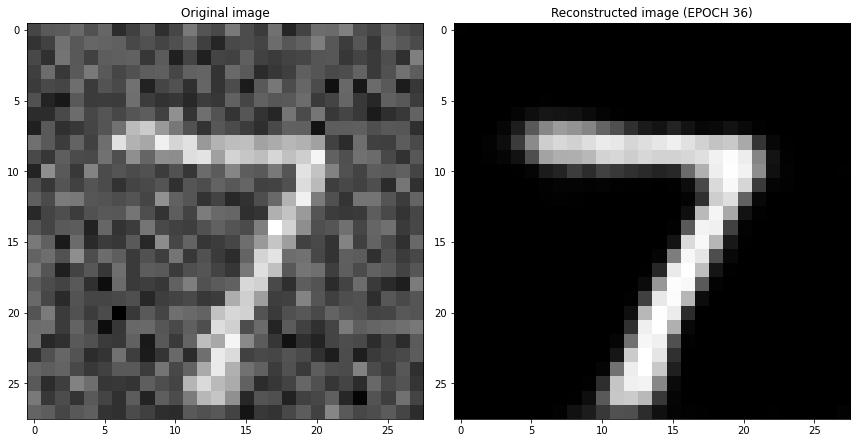

EPOCH 37/40
	 partial train loss (single batch): 0.058913
	 partial train loss (single batch): 0.057962
	 partial train loss (single batch): 0.057907
	 partial train loss (single batch): 0.057428
	 partial train loss (single batch): 0.058778
	 partial train loss (single batch): 0.058409
	 partial train loss (single batch): 0.057506
	 partial train loss (single batch): 0.058626
	 partial train loss (single batch): 0.057022
	 partial train loss (single batch): 0.057912
	 partial train loss (single batch): 0.058946
	 partial train loss (single batch): 0.058755
	 partial train loss (single batch): 0.058114
	 partial train loss (single batch): 0.058069
	 partial train loss (single batch): 0.058423
	 partial train loss (single batch): 0.059054
	 partial train loss (single batch): 0.058451
	 partial train loss (single batch): 0.057521
	 partial train loss (single batch): 0.058635
	 partial train loss (single batch): 0.058167
	 partial train loss (single batch): 0.058600
	 partial train loss (

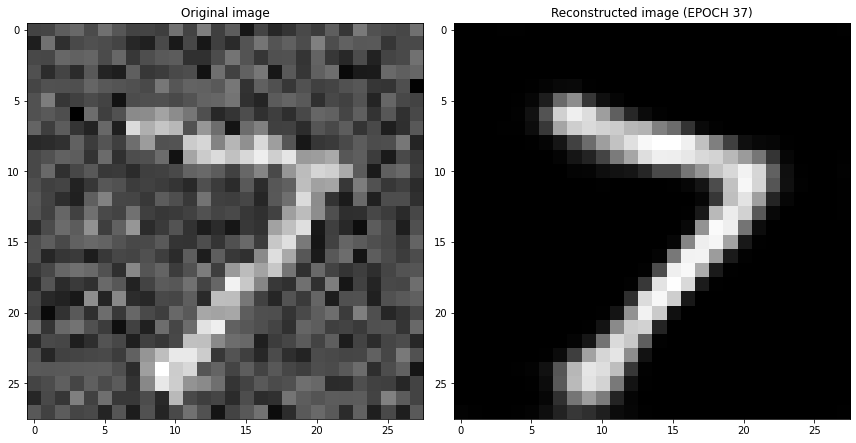

EPOCH 38/40
	 partial train loss (single batch): 0.058096
	 partial train loss (single batch): 0.059713
	 partial train loss (single batch): 0.059189
	 partial train loss (single batch): 0.059206
	 partial train loss (single batch): 0.058845
	 partial train loss (single batch): 0.057828
	 partial train loss (single batch): 0.059489
	 partial train loss (single batch): 0.058819
	 partial train loss (single batch): 0.057420
	 partial train loss (single batch): 0.059230
	 partial train loss (single batch): 0.058292
	 partial train loss (single batch): 0.057664
	 partial train loss (single batch): 0.058622
	 partial train loss (single batch): 0.058760
	 partial train loss (single batch): 0.059252
	 partial train loss (single batch): 0.058326
	 partial train loss (single batch): 0.058349
	 partial train loss (single batch): 0.058518
	 partial train loss (single batch): 0.058795
	 partial train loss (single batch): 0.058814
	 partial train loss (single batch): 0.057668
	 partial train loss (

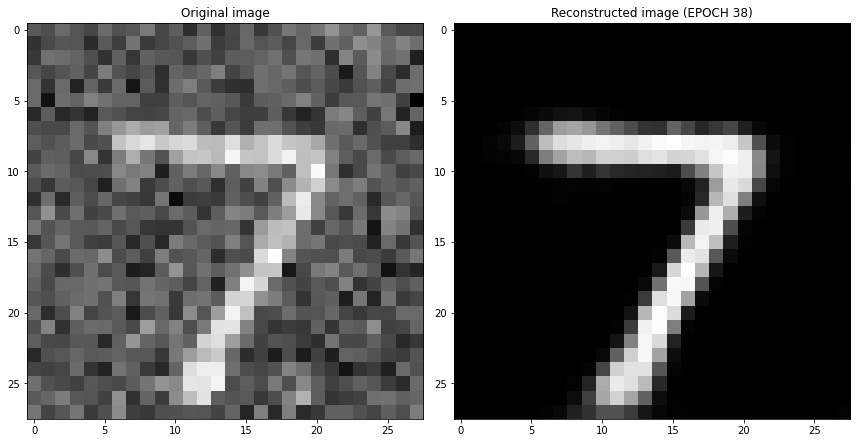

EPOCH 39/40
	 partial train loss (single batch): 0.057787
	 partial train loss (single batch): 0.057823
	 partial train loss (single batch): 0.058880
	 partial train loss (single batch): 0.059201
	 partial train loss (single batch): 0.057787
	 partial train loss (single batch): 0.058238
	 partial train loss (single batch): 0.058381
	 partial train loss (single batch): 0.058269
	 partial train loss (single batch): 0.057583
	 partial train loss (single batch): 0.058924
	 partial train loss (single batch): 0.057260
	 partial train loss (single batch): 0.058678
	 partial train loss (single batch): 0.057348
	 partial train loss (single batch): 0.057324
	 partial train loss (single batch): 0.058325
	 partial train loss (single batch): 0.058126
	 partial train loss (single batch): 0.057908
	 partial train loss (single batch): 0.058766
	 partial train loss (single batch): 0.058227
	 partial train loss (single batch): 0.057281
	 partial train loss (single batch): 0.058154
	 partial train loss (

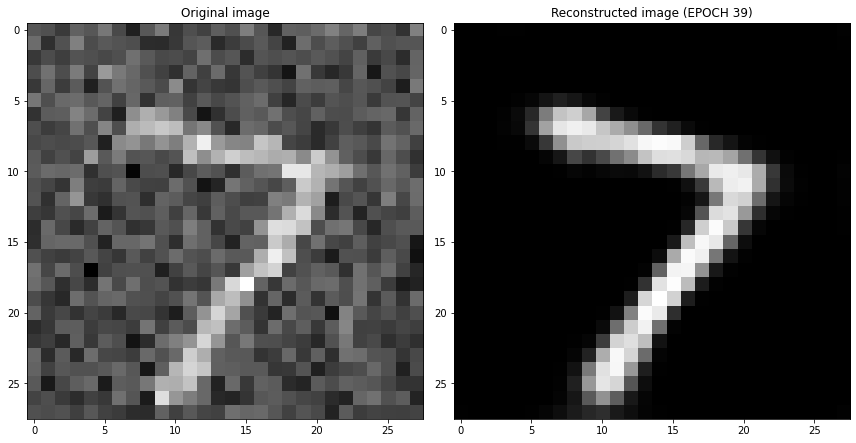

EPOCH 40/40
	 partial train loss (single batch): 0.058195
	 partial train loss (single batch): 0.059708
	 partial train loss (single batch): 0.058254
	 partial train loss (single batch): 0.057687
	 partial train loss (single batch): 0.058503
	 partial train loss (single batch): 0.058001
	 partial train loss (single batch): 0.059481
	 partial train loss (single batch): 0.058039
	 partial train loss (single batch): 0.058010
	 partial train loss (single batch): 0.058800
	 partial train loss (single batch): 0.057616
	 partial train loss (single batch): 0.057274
	 partial train loss (single batch): 0.058773
	 partial train loss (single batch): 0.058352
	 partial train loss (single batch): 0.056784
	 partial train loss (single batch): 0.057845
	 partial train loss (single batch): 0.058948
	 partial train loss (single batch): 0.058251
	 partial train loss (single batch): 0.058498
	 partial train loss (single batch): 0.057894
	 partial train loss (single batch): 0.059221
	 partial train loss (

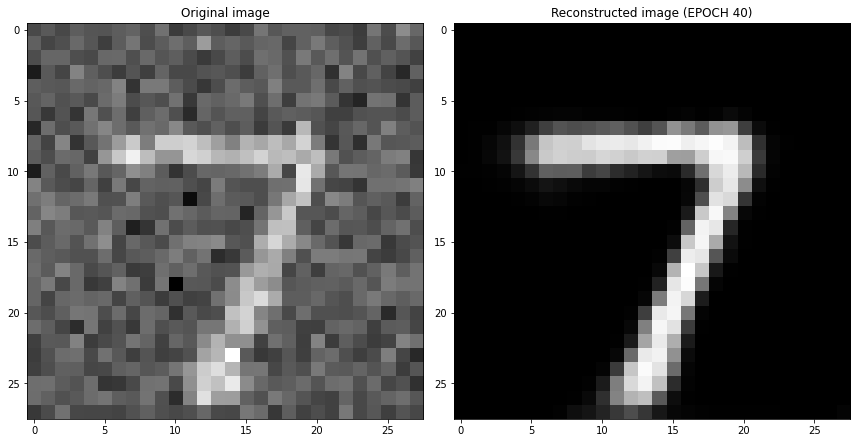

In [36]:
### Training cycle
num_epochs = 40

for epoch in range(num_epochs):
    print('EPOCH %d/%d' % (epoch + 1, num_epochs))
    ### Training (use the training function)
    train_cost=[]
    train_epoch(
        encoder=encoder, 
        decoder=decoder, 
        device=device, 
        dataloader=train_dataloader, 
        loss_fn=loss_fn, 
        optimizer=optim,trainCost_=train_cost)
    ### Validation  (use the testing function)
    val_loss = test_epoch(
        encoder=encoder, 
        decoder=decoder, 
        device=device, 
        dataloader=test_dataloader, 
        loss_fn=loss_fn)
    # Print Validationloss
    print('\n\n\t VALIDATION - EPOCH %d/%d - loss: %f\n\n' % (epoch + 1, num_epochs, val_loss))

    ### Plot progress
    # Get the output of a specific image (the test image at index 0 in this case)
    img = test_dataset[0][0].unsqueeze(0).to(device)
    encoder.eval()
    decoder.eval()
    with torch.no_grad():
        rec_img  = decoder(encoder(img))
    # Plot the reconstructed image
    fig, axs = plt.subplots(1, 2, figsize=(12,6))
    axs[0].imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
    axs[0].set_title('Original image')
    axs[1].imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')
    axs[1].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
    plt.tight_layout()
    plt.pause(0.1)
    # Save figures
    os.makedirs('autoencoder_progress_%d_features' % encoded_space_dim, exist_ok=True)
    fig.savefig('autoencoder_progress_%d_features/epoch_%d.jpg' % (encoded_space_dim, epoch + 1))
    plt.show()
    plt.close()

    # Save network parameters
    torch.save(encoder.state_dict(), 'denoising_encoder_params.pth')
    torch.save(decoder.state_dict(), 'denoising_decoder_params.pth')

    # NOTE: Remember to save also the parameters of the optimizer if you want to restore and continue the training

Visualizing some reconstructed samples

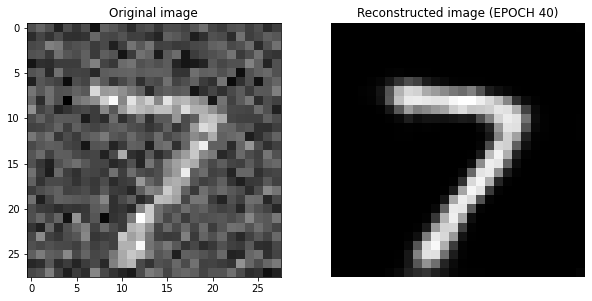

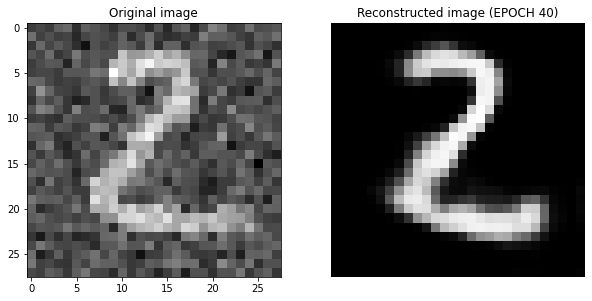

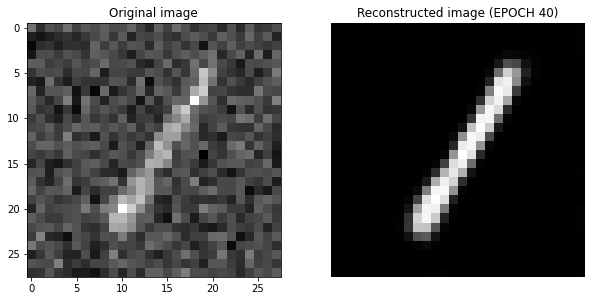

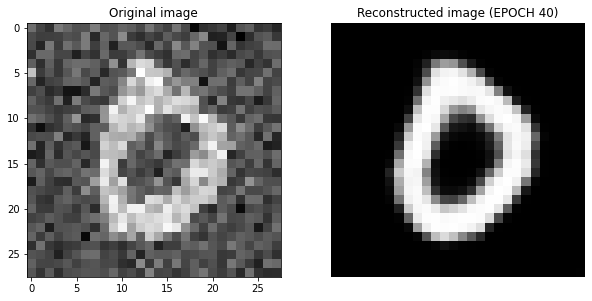

In [38]:
for i in range(4):
   img = test_dataset[i][0].unsqueeze(0).to(device)
   encoder.eval()
   decoder.eval()
   with torch.no_grad():
       rec_img  = decoder(encoder(img))
   fig, axs = plt.subplots(1, 2, figsize=(10,6))
   axs[0].imshow(img.cpu().squeeze().numpy(), cmap='gist_gray')
   axs[0].set_title('Original image')
   axs[1].imshow(rec_img.cpu().squeeze().numpy(), cmap='gist_gray')
   axs[1].set_title('Reconstructed image (EPOCH %d)' % (epoch + 1))
   plt.axis('off')
   plt.show()
   



**Generative Adversarial Networks GAN**

In [ ]:
import numpy as np
import torch
import torchvision
import torch.nn as nn
import matplotlib.pyplot as plt

In [ ]:
### Download the data and create dataset
data_dir = 'dataset'
# With these commands the train and test datasets, respectively, are downloaded 
# automatically and stored in the local "data_dir" directory.
train_dataset = torchvision.datasets.MNIST(data_dir, train=True, download=True)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting dataset/MNIST/raw/train-images-idx3-ubyte.gz to dataset/MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting dataset/MNIST/raw/train-labels-idx1-ubyte.gz to dataset/MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting dataset/MNIST/raw/t10k-images-idx3-ubyte.gz to dataset/MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting dataset/MNIST/raw/t10k-labels-idx1-ubyte.gz to dataset/MNIST/raw



/usr/local/lib/python3.7/dist-packages/torchvision/datasets/mnist.py:498: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:180.)
  return torch.from_numpy(parsed.astype(m[2], copy=False)).view(*s)


In [ ]:
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Hyperparameters
torch.manual_seed(0)
GENERATOR_LEARNING_RATE = 0.0002
DISCRIMINATOR_LEARNING_RATE = 0.0002

NUM_EPOCHS = 100
BATCH_SIZE = 128

IMAGE_HEIGHT, IMAGE_WIDTH, IMAGE_CHANNELS = 28, 28, 1

Selected device: cuda


In [ ]:
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader,TensorDataset


train_transform = transforms.Compose([
    torchvision.transforms.ToTensor(),
    torchvision.transforms.Normalize((0.5,), (0.5,))   
])
# Set the train transform
train_dataset.transform = train_transform
### Define train dataloader
train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

Image batch dimensions: torch.Size([128, 1, 28, 28])
Image label dimensions: torch.Size([128])


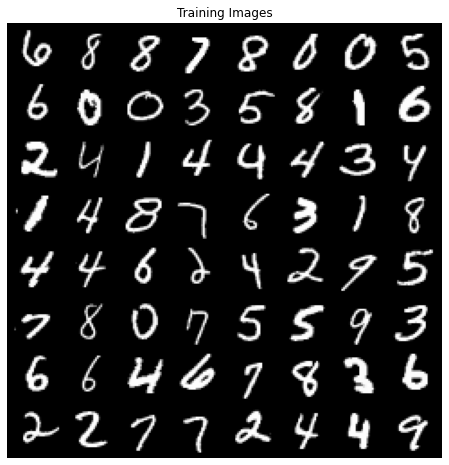

In [ ]:
for images, labels in train_dataloader:  
    print('Image batch dimensions:', images.shape)
    print('Image label dimensions:', labels.shape)
    break
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(torchvision.utils.make_grid(images[:64], padding=2, normalize=True),(1, 2, 0)))
plt.show()

Defining the model

In [ ]:
##########################
### MODEL
##########################

class GAN(torch.nn.Module):

    def __init__(self, latent_dim=100, 
                 image_height=28, image_width=28, color_channels=1):
        super().__init__()
        
        self.image_height = image_height
        self.image_width = image_width
        self.color_channels = color_channels
        
        self.generator = nn.Sequential(
            nn.Linear(latent_dim, 128),
            nn.LeakyReLU(inplace=True),
            nn.Dropout(p=0.5),
            nn.Linear(128, image_height*image_width*color_channels),
            nn.Tanh()
        )
        
        self.discriminator = nn.Sequential(
            nn.Flatten(),
            nn.Linear(image_height*image_width*color_channels, 128),
            nn.LeakyReLU(inplace=True),
            nn.Dropout(p=0.5),
            nn.Linear(128, 1), # outputs logits
            #nn.Sigmoid()
        )
    def generator_forward(self, z):# z has dimension NCHW
        z = torch.flatten(z, start_dim=1) 
        img = self.generator(z)
        img = img.view(z.size(0),
                       self.color_channels,
                       self.image_height,
                       self.image_width)
        return img
    
    def discriminator_forward(self, img):
        logits = model.discriminator(img)
        return logits

In [ ]:
model = GAN()
model.to(device)
optim_gen = torch.optim.Adam(model.generator.parameters(),
                             betas=(0.5, 0.999),
                             lr=GENERATOR_LEARNING_RATE)
optim_discr = torch.optim.Adam(model.discriminator.parameters(),
                               betas=(0.5, 0.999),
                               lr=DISCRIMINATOR_LEARNING_RATE)

In [ ]:
def train_gan_v1(num_epochs, model, optimizer_gen, optimizer_discr, 
                 latent_dim, device, train_loader, loss_fn=None,
                 logging_interval=100, 
                 save_model=None):
    
    if loss_fn is None:
        loss_fn = F.binary_cross_entropy_with_logits
        
    log_dict = {'train_generator_loss_per_batch': [],
                'train_discriminator_loss_per_batch': [],
                'train_discriminator_real_acc_per_batch': [],
                'train_discriminator_fake_acc_per_batch': [],
                'images_from_noise_per_epoch': []}

 
    # Batch of latent (noise) vectors for
    # evaluating / visualizing the training progress
    # of the generator
    fixed_noise = torch.randn(64, latent_dim, 1, 1, device=device) # format NCHW

    start_time = time.time()
    for epoch in range(num_epochs):

        model.train()
        for batch_idx, (features, _) in enumerate(train_loader):

            batch_size = features.size(0)

            # real images
            real_images = features.to(device)
            real_labels = torch.ones(batch_size, device=device) # real label = 1

            # generated (fake) images
            noise = torch.randn(batch_size, latent_dim, 1, 1, device=device)  # format NCHW
            fake_images = model.generator_forward(noise)
            fake_labels = torch.zeros(batch_size, device=device) # fake label = 0
            flipped_fake_labels = real_labels # here, fake label = 1

            # --------------------------
            # Train Discriminator
            # --------------------------

            optimizer_discr.zero_grad()

            # get discriminator loss on real images
            discr_pred_real = model.discriminator_forward(real_images).view(-1) # Nx1 -> N
            real_loss = loss_fn(discr_pred_real, real_labels)
            # real_loss.backward()

            # get discriminator loss on fake images
            discr_pred_fake = model.discriminator_forward(fake_images.detach()).view(-1)
            fake_loss = loss_fn(discr_pred_fake, fake_labels)
            # fake_loss.backward()

            # combined loss
            discr_loss = 0.5*(real_loss + fake_loss)
            discr_loss.backward()

            optimizer_discr.step()

            # --------------------------
            # Train Generator
            # --------------------------

            optimizer_gen.zero_grad()

            # get discriminator loss on fake images with flipped labels
            discr_pred_fake = model.discriminator_forward(fake_images).view(-1)
            gener_loss = loss_fn(discr_pred_fake, flipped_fake_labels)
            gener_loss.backward()

            optimizer_gen.step()

            # --------------------------
            # Logging
            # --------------------------   
            log_dict['train_generator_loss_per_batch'].append(gener_loss.item())
            log_dict['train_discriminator_loss_per_batch'].append(discr_loss.item())
            
            predicted_labels_real = torch.where(discr_pred_real.detach() > 0., 1., 0.)
            predicted_labels_fake = torch.where(discr_pred_fake.detach() > 0., 1., 0.)
            acc_real = (predicted_labels_real == real_labels).float().mean()*100.
            acc_fake = (predicted_labels_fake == fake_labels).float().mean()*100.
            log_dict['train_discriminator_real_acc_per_batch'].append(acc_real.item())
            log_dict['train_discriminator_fake_acc_per_batch'].append(acc_fake.item())         
            
            if not batch_idx % logging_interval:
                print('Epoch: %03d/%03d | Batch %03d/%03d | Gen/Dis Loss: %.4f/%.4f' 
                       % (epoch+1, num_epochs, batch_idx, 
                          len(train_loader), gener_loss.item(), discr_loss.item()))

        ### Save images for evaluation
        with torch.no_grad():
            fake_images = model.generator_forward(fixed_noise).detach().cpu()
            log_dict['images_from_noise_per_epoch'].append(
                torchvision.utils.make_grid(fake_images, padding=2, normalize=True))


        print('Time elapsed: %.2f min' % ((time.time() - start_time)/60))
    
    print('Total Training Time: %.2f min' % ((time.time() - start_time)/60))
    
    if save_model is not None:
        torch.save(model.state_dict(), save_model)
    
    return log_dict

In [ ]:
import torch.nn.functional as F
import time
log_dict = train_gan_v1(num_epochs=NUM_EPOCHS, model=model, 
                        optimizer_gen=optim_gen,
                        optimizer_discr=optim_discr,
                        latent_dim=100,
                        device=device, 
                        train_loader=train_dataloader,
                        logging_interval=100,
                        save_model='gan_mnist.pt')

Epoch: 001/100 | Batch 000/469 | Gen/Dis Loss: 0.6556/0.6514
Epoch: 001/100 | Batch 100/469 | Gen/Dis Loss: 0.6173/0.4805
Epoch: 001/100 | Batch 200/469 | Gen/Dis Loss: 0.6305/0.5428
Epoch: 001/100 | Batch 300/469 | Gen/Dis Loss: 0.7735/0.5210
Epoch: 001/100 | Batch 400/469 | Gen/Dis Loss: 0.9391/0.4296
Time elapsed: 0.15 min
Epoch: 002/100 | Batch 000/469 | Gen/Dis Loss: 1.0311/0.3748
Epoch: 002/100 | Batch 100/469 | Gen/Dis Loss: 1.0641/0.3962
Epoch: 002/100 | Batch 200/469 | Gen/Dis Loss: 0.9356/0.4277
Epoch: 002/100 | Batch 300/469 | Gen/Dis Loss: 1.0067/0.4238
Epoch: 002/100 | Batch 400/469 | Gen/Dis Loss: 1.0332/0.4113
Time elapsed: 0.30 min
Epoch: 003/100 | Batch 000/469 | Gen/Dis Loss: 0.9727/0.4474
Epoch: 003/100 | Batch 100/469 | Gen/Dis Loss: 1.1071/0.4470
Epoch: 003/100 | Batch 200/469 | Gen/Dis Loss: 1.2591/0.4357
Epoch: 003/100 | Batch 300/469 | Gen/Dis Loss: 1.3575/0.3880
Epoch: 003/100 | Batch 400/469 | Gen/Dis Loss: 0.9501/0.4430
Time elapsed: 0.45 min
Epoch: 004/100 |

In [ ]:
def plot_multiple_training_losses(losses_list, num_epochs, 
                                  averaging_iterations=100, custom_labels_list=None):

    for i,_ in enumerate(losses_list):
        if not len(losses_list[i]) == len(losses_list[0]):
            raise ValueError('All loss tensors need to have the same number of elements.')
    
    if custom_labels_list is None:
        custom_labels_list = [str(i) for i,_ in enumerate(custom_labels_list)]
    
    iter_per_epoch = len(losses_list[0]) // num_epochs

    plt.figure()
    ax1 = plt.subplot(1, 1, 1)
    
    for i, minibatch_loss_tensor in enumerate(losses_list):
        ax1.plot(range(len(minibatch_loss_tensor)),
                 (minibatch_loss_tensor),
                  label=f'Minibatch Loss{custom_labels_list[i]}')
        ax1.set_xlabel('Iterations')
        ax1.set_ylabel('Loss')

        ax1.plot(np.convolve(minibatch_loss_tensor,
                             np.ones(averaging_iterations,)/averaging_iterations,
                             mode='valid'),
                 color='black')
    
    if len(losses_list[0]) < 1000:
        num_losses = len(losses_list[0]) // 2
    else:
        num_losses = 1000
    maxes = [np.max(losses_list[i][num_losses:]) for i,_ in enumerate(losses_list)]
    ax1.set_ylim([0, np.max(maxes)*1.5])
    ax1.legend()

    ###################
    # Set scond x-axis
    ax2 = ax1.twiny()
    newlabel = list(range(num_epochs+1))

    newpos = [e*iter_per_epoch for e in newlabel]

    ax2.set_xticks(newpos[::10])
    ax2.set_xticklabels(newlabel[::10])

    ax2.xaxis.set_ticks_position('bottom')
    ax2.xaxis.set_label_position('bottom')
    ax2.spines['bottom'].set_position(('outward', 45))
    ax2.set_xlabel('Epochs')
    ax2.set_xlim(ax1.get_xlim())
    ###################

    plt.tight_layout()

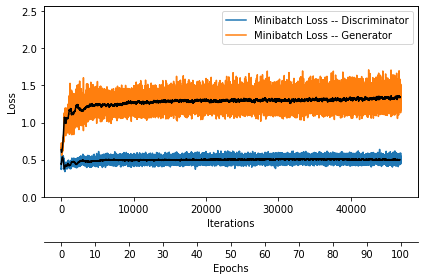

In [ ]:
plot_multiple_training_losses(
    losses_list=(log_dict['train_discriminator_loss_per_batch'],
                 log_dict['train_generator_loss_per_batch']),
    num_epochs=NUM_EPOCHS, 
    custom_labels_list=(' -- Discriminator', ' -- Generator')
)

In [ ]:
def plot_generated_images(data_loader, model, device, 
                          unnormalizer=None,
                          figsize=(20, 2.5), n_images=15, modeltype='autoencoder'):

    fig, axes = plt.subplots(nrows=2, ncols=n_images, 
                             sharex=True, sharey=True, figsize=figsize)
    
    for batch_idx, (features, _) in enumerate(data_loader):
        
        features = features.to(device)

        color_channels = features.shape[1]
        image_height = features.shape[2]
        image_width = features.shape[3]
        
        with torch.no_grad():
            if modeltype == 'autoencoder':
                decoded_images = model(features)[:n_images]
            elif modeltype == 'VAE':
                encoded, z_mean, z_log_var, decoded_images = model(features)[:n_images]
            else:
                raise ValueError('`modeltype` not supported')

        orig_images = features[:n_images]
        break

    for i in range(n_images):
        for ax, img in zip(axes, [orig_images, decoded_images]):
            curr_img = img[i].detach().to(torch.device('cpu'))        
            if unnormalizer is not None:
                curr_img = unnormalizer(curr_img)

            if color_channels > 1:
                curr_img = np.transpose(curr_img, (1, 2, 0))
                ax[i].imshow(curr_img)
            else:
                ax[i].imshow(curr_img.view((image_height, image_width)), cmap='binary')

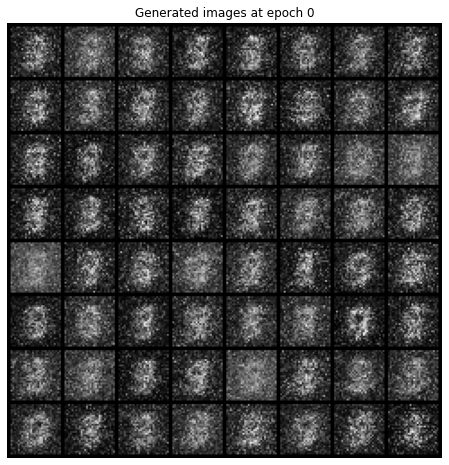

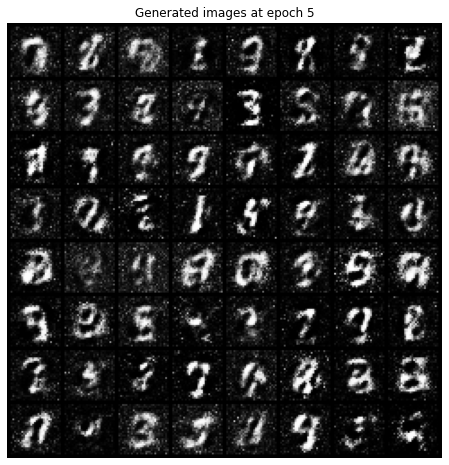

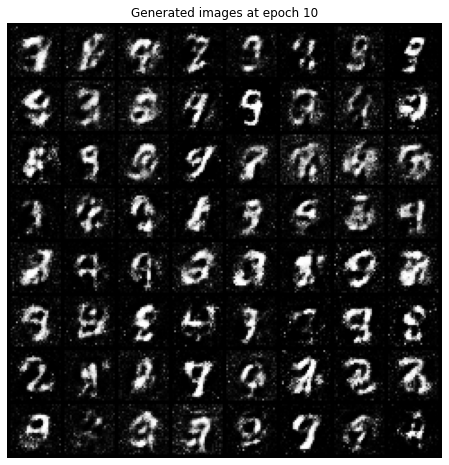

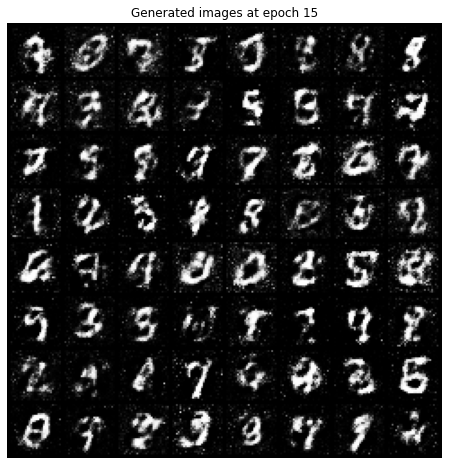

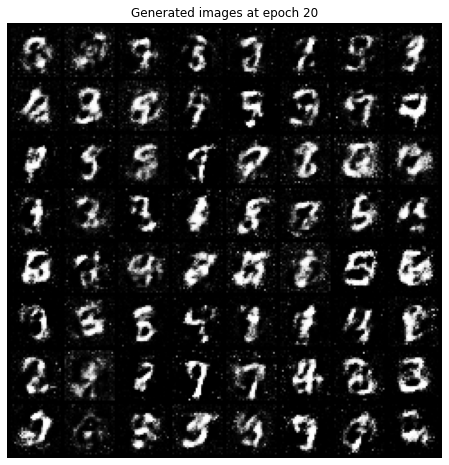

...

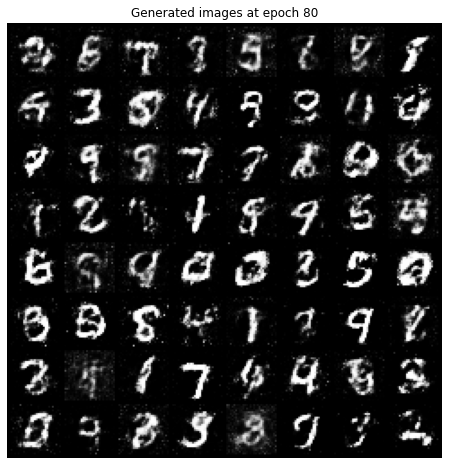

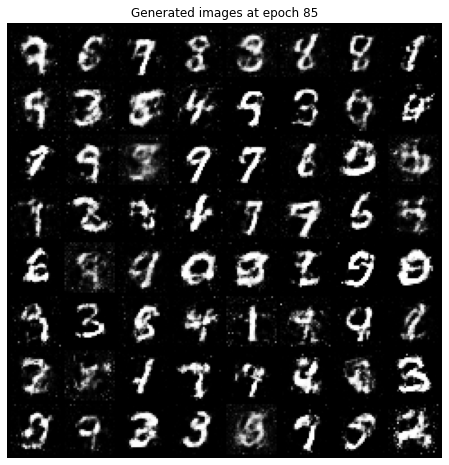

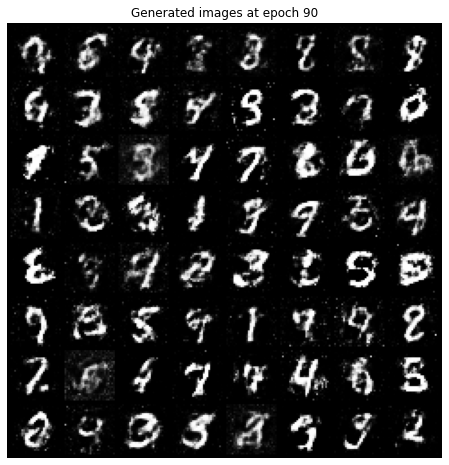

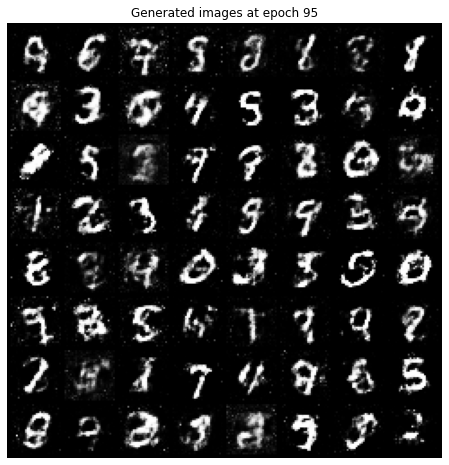

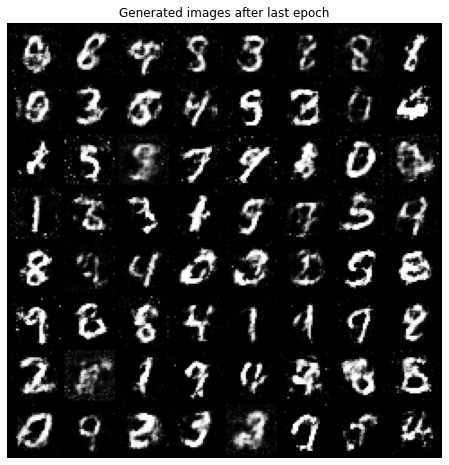

In [ ]:
##########################
### VISUALIZATION
##########################

for i in range(0, NUM_EPOCHS, 5):
    
    plt.figure(figsize=(8, 8))
    plt.axis('off')
    plt.title(f'Generated images at epoch {i}')
    plt.imshow(np.transpose(log_dict['images_from_noise_per_epoch'][i], (1, 2, 0)))
    plt.show()
    
    
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title(f'Generated images after last epoch')
plt.imshow(np.transpose(log_dict['images_from_noise_per_epoch'][-1], (1, 2, 0)))
plt.show()